##### libraries

In [1]:
# libraries
# base
from scipy.io import arff          # to read .arff format
import pandas as pd                # data manipulation
import numpy as np                 # linear algebra
import matplotlib.pyplot as plt    # plotting
import seaborn as sns              # plotting
from PIL import Image              # images handling

# support
import time                        # time measuring
import random                      # randomness
import pickle                      # object saving/loading

# math
from scipy.stats import spearmanr, wilcoxon  # spearman rho correlation coefficient and wilcoxon median equality test
from math import ceil              # ceil function

# warnings
from  warnings import simplefilter                             # warning handling
from sklearn.exceptions import ConvergenceWarning              # warning handling
from statsmodels.tools.sm_exceptions import ConvergenceWarning # warning handling

# Sklearn/xgboost - Machine Learning
from sklearn.ensemble import RandomForestClassifier                                           # Random Forest
from sklearn.preprocessing import StandardScaler, MinMaxScaler, PowerTransformer              # scalers and power transform
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold                  # splitting, validation
from sklearn.metrics import roc_auc_score, average_precision_score, confusion_matrix          # metrics
from sklearn.metrics import precision_recall_curve, roc_curve                                 # metrics (curves)
from sklearn.decomposition import PCA                                                         # PCA
from xgboost.sklearn import XGBClassifier                                                     # sklearn API for XGB
import statsmodels.formula.api as smf                                                         # formula API for statsmodels


# tensorflow/keras - Deep Learning
import tensorflow as tf             # tensorflow background
from tensorflow import keras        # keras API for tensorflow
from keras import layers            # keras layers
from keras import models            # keras models
from keras import optimizers        # keras optimizers
from keras import activations       # keras activation functions
from keras import losses            # keras loss functions 
from keras import regularizers      # keras regularizers
# import tensorflow as tf
# from tensorflow import keras
# from tensorflow.keras import layers, models, optimizers, activations, losses, regularizers

Using TensorFlow backend.


##### notebook settings

In [2]:
# notebook settings
pd.set_option("display.max_columns", 70)
pd.set_option("display.max_rows", 70)
# ignoring some warnings
simplefilter("ignore", category=ConvergenceWarning) 
np.warnings.filterwarnings('ignore', '(overflow|invalid)')

random_state = 2021

##### preprocessing

 - loading, missing detection

In [3]:
def get_missing_info(data, y):
    '''
    function creates DataFrame of missing value counts and percentage, for a given data and positive, negative
    and positive percentage for a given target, arguments:
    data - dataset to get informations about (DataFrame)
    y - target value (string)
    
    returns - DataFrame object with informations
    '''
    
    # counting missing and calculating the percentage 
    missing_info = pd.DataFrame((data.isna().sum(), data.isna().sum()/data.shape[0]*100)).T
    missing_info.columns = ["missing_count", "missing_percentage"]
    
    # removing rows without missings
    missing_info = missing_info.where(missing_info > 0).dropna().sort_values(by = "missing_percentage", ascending = False)
    
    # target info inicjalization
    missing_info["non_{}_count".format(y)] = np.nan
    missing_info["{}_count".format(y)] = np.nan
    missing_info["{}_percentage".format(y)] = np.nan
    
    # target info colnames
    neg_count, pos_count, pos_per=missing_info.columns.tolist()[2:]
    
    # target info (counting) columns filling
    cols = missing_info.index.tolist()
    for i in cols:
        missing_info.loc[i, pos_count] = data[y].where(data[i].isna()).dropna().sum()
        missing_info.loc[i, neg_count] = data[y].where(
            data[i].isna()).dropna().shape[0]-missing_info.loc[i, pos_count]
    
    # target info (percentage) column filling
    missing_info[pos_per] = np.round(
        missing_info[pos_count]/(missing_info[neg_count]+missing_info[pos_count])*100, 2)
    
    
    return missing_info

In [4]:
# data loading
data = arff.loadarff(r"data\1year.arff")
data = pd.DataFrame(data[0])

# decoding target variable
data.rename({'class':'bankrupt'}, axis = 1, inplace = True)
data['bankrupt'].replace(b'1', 1, True)
data['bankrupt'].replace(b'0', 0, inplace=True)

In [5]:
get_missing_info(data, "bankrupt")

,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr37,2740.0,38.992458,2635.0,105.0,3.83
Attr21,1622.0,23.082396,1513.0,109.0,6.72
Attr27,311.0,4.425786,191.0,120.0,38.59
Attr60,135.0,1.921161,121.0,14.0,10.37
Attr45,134.0,1.906930,120.0,14.0,10.45
Attr24,124.0,1.764622,124.0,0.0,0.00
Attr41,84.0,1.195389,84.0,0.0,0.00
Attr11,39.0,0.555002,3.0,36.0,92.31
Attr32,38.0,0.540771,37.0,1.0,2.63
Attr28,34.0,0.483848,28.0,6.0,17.65


Columns to drop because of:
1. Too many missings:
 - Attr37,
 - Attr21,
 - Attr27,
2. Missings structure:
 - Attr11 (92% of positive examples)

In [6]:
# column dropping
data.drop(labels = ["Attr37", "Attr21", "Attr27", "Attr11"], axis = 1, inplace = True)

 - functions for data imputation

In [7]:
def ProximityMatrix(RF, X, normalize = True):    
    '''
    function computes the proximity matrix for given (trained) random forest and data, arguments:
    RF - trained Random Forst classifier,
    X - data to apply RF,
    normalize - boolean, if true then proximity_matrix = proximity_matrix/num_of_Trees
    
    returns proximity matrix (np.arraty)
    -----
    note: this function is based on stackoverflow topic:
        https://stackoverflow.com/questions/18703136/proximity-matrix-in-sklearn-ensemble-randomforestclassifier
        
    '''
    
    # leaves indices for each x in X
    leaves = RF.apply(X)
    # number of trees
    nTrees = leaves.shape[1]
    # inicjalization (first iteration) proximity matrix
    proximity_matrix = np.equal.outer(leaves[:,0], leaves[:,0]).astype('float')
        # outer applies a function, here equal for each pair in the arguments (leaves[:,0] with itself) ->
        # we get proximities for the first column (first Tree), proximity_matrix[i,j] = 1 <=> i == j,
        # where i, j are indices of leaves for each sample
        # note: proximity_matrix is not the product of the Attr's, its a product of the Trees and the indices of its nodes

    # iteration through the rest of the trees
    for i in range(1, nTrees):
        proximity_matrix += np.equal.outer(leaves[:,i], leaves[:,i]).astype('float')
            
    proximity_matrix = (proximity_matrix/nTrees) if normalize == True else proximity_matrix

    return proximity_matrix    

def RFimputation(dta, n_iter, target, *args, **kwargs):
    '''
    Random Forest proximity based data imputer for a continuous features. Missing are inicialized with median of the 
    feature, after that random forest classifier is trained then based on node ID for particular observation simillarity 
    is determined and proximity matrix is computed and rescaled. 1-proximity is distance. Proximity is a weight in weighted
    average formula for a missing item. The process is repeated normally 5-7 times. Arguments:
    dta - dataset with continuous features with missings,
    n_iter - number of algorithm iterations
    target - target variable
    
    return imputed dataset, missing indices, history of process, missings changes during training 
    '''
    import time
    pd.set_option('mode.chained_assignment', None)
    
    start = time.time()
    # data copy to operate
    df = dta.copy()
    
    # features list
    features = [i for i in df.columns.tolist() if i != target]
    
    # Attr's missings indices inicialization
    # key - attr, value - indices
    attrs_indices = {}

    # Attr's updated values 
    # key - attr, value - imputed values
    attrs_values = {}

    # getting missings indices for each attr and set it to the median 
    for attr in features:
        # indices of missing data for each attribute
        indices = df[attr][df[attr].isna()].index.tolist()
        # median
        median = df[attr].median(skipna=True, axis=0)
        # imputation
        df.loc[indices, attr] = median
        # updating Attr's missings indices dictionary
        attrs_indices[attr] = indices
        # updating Attr's missings updated values dictionary
        attrs_values[attr] = df[attr][attrs_indices[attr]].values.tolist()


    # ********* IMPUTATION LOOP *************** #
    # history inicialization
    history = {}
    # history is a dictionary keys = iteration, keys = dictionary of attrs:lists of missings
    history["iteration_0"] = attrs_values.copy()

    for i in range(n_iter):
        # build and train a classifier (RF)
        clf = RandomForestClassifier(*args, **kwargs) 
        clf.fit(df[features], df[target])

        # compute proximity matrix
        pm = ProximityMatrix(clf, df[features], True)

        # compute weight matrix (each row divided by its sum)
        pm_div = pm/pm.sum(axis = 1, keepdims = True)

        # reset missing values (= 0) (after that, weighted average excludes missing indices, is just a dot product)
        for attr in features:
            df[attr][attrs_indices[attr]] = 0

        # computing imputation matrix - weighted average formula (shape: (n_observations, n_features))
        imputation_matrix = np.dot(pm_div, df.values)

        # data imputation
        for attr in features:
            # attr index in df 
            attr_index = features.index(attr)
            # imputing data (weighted average based on proximity matrix)
            df[attr][attrs_indices[attr]] = imputation_matrix[attrs_indices[attr], attr_index]
            # updating Attr's missings updated values dictionary
            attrs_values[attr] = df[attr][attrs_indices[attr]].values.tolist()
        
        # history update
        history["iteration_{}".format(i+1)] = attrs_values.copy()
    
    # ********* historical changes *************** #
    iterations = list(history.keys())
    # history changes dictionary inicialization
    # key: iteration, value: dictionary
    #                        key: attr, value: percentage change
    history_changes = history.copy()
    # keys for history_changes (excluding "zero" iteration)
    changes_keys = iterations[1:]

    for i in range(len(iterations)-1):
        # values for calculations (concrete iterations)
        itr_prev = iterations[i]
        itr = iterations[i+1]
        # list of the attr's
        attrs = list(history[itr].keys())
        for attr in attrs:
            # transform to array
            itr_prev_array = np.array(history[itr_prev][attr])
            itr_array = np.array(history[itr][attr])
            # change computation
            change = np.abs((itr_array - itr_prev_array) / itr_prev_array)
            # saving historical changes
            history_changes[itr][attr] = change
    
    # final shape of history_changes (excluding "zero" iteration)
    history_changes = {key: history_changes[key] for key in changes_keys}

    stop = time.time()
    print("Imputation time: {} seconds".format(round(stop - start), 2))
    return df, attrs_indices, history, history_changes

 - class for data standarization:
     - for CNN:
         $$0<int(x_{norm}=\frac{x-\mu}{\sigma}*100+128)<255$$
     - for other algorithms:
         $$x_{norm}=\frac{x-\mu}{\sigma}$$
 - integrated with:
     - outliers reduction with quantiles clipping,
     - Yeo-Johnson power transform, defined:
     $$\begin{cases}
    \frac{((y_i+1)^\lambda)-1)}{\lambda}         & \quad \text{if } \lambda \neq0, y\geq0\\
    \ln{(y_i+1)}                                 & \quad \text{if } \lambda=0, y\geq0\\
    \frac{-[(-y_i+1)^{2-\lambda}-1]}{2-\lambda}  & \quad \text{if } \lambda \neq2, y<0\\
    -\ln{(-y_i+1)}                               & \quad \text{if } \lambda=2, y<0
        \end{cases}$$

In [8]:
class scaler:
    
    def __init__(self, images=True):
        '''
        Class for normalizer-object which transforms vector of features to [0,255] vector of colour-scale, formula:

                                            0<int((x-mu)/sigma*100+128)<255

        where:
        x - feature vector,
        mu - mean(x),
        sigma - standard_deviation(x),
        int(.) - operation of rounding to integer.

        or for standarizing to zero mean and unit variance.
        
        arguments:
        images - boolean, when True [0,255] int standarization applied, when False zero mean and unit variance standarization applied.
        -------------
        note: scaler is integrated with quantile clipping.
        '''
        self.option=images
        self.mean=None
        self.std=None
        self.left_tail=None
        self.right_tail=None
        self.transformer=None
        
    def fit(self, X, q=None, power_transform=False):
        '''
        Function fits scaler to the data, arguments:
        X - feature matrix (numpy.array or pandas.DataFrame),
        q - optional, quantile for clipping data before fit (float),
        power_transform - apply Yeo-Johnson power transformation (boolean).
        -------------
        note: quantile clipping is symmetric, when q=0.05 passed then function computes q_95 also for clipping left and
              right distribution tails. 
        '''
        # errors handling
        class error(Exception):
            pass
        if type(X)==pd.core.frame.DataFrame:
            X=X.values
        elif type(X)==np.ndarray:
            pass
        else:
            raise error("X type allowed are pd.core.frame.DataFrame and np.ndarray")
        
        # quantile computations
        if q is not None:
            # saving quantiles in __init__
            self.left_tail=np.quantile(a=X, q=q, axis=0)
            self.right_tail=np.quantile(a=X, q=1-q, axis=0)
            # computing new X
            for i in range(X.shape[1]):
                X[:,i]=X[:,i].clip(min=self.left_tail[i], max=self.right_tail[i])
                
        if power_transform==True:
            self.transformer=PowerTransformer(method='yeo-johnson', standardize=True)
            self.transformer.fit(X=X)
            X=self.transformer.transform(X=X)
            # mean and standard deviation computing for __init__     
            self.mean=X.mean(axis=0)
            self.std=X.std(axis=0)
        else:
            # mean and standard deviation computing for __init__     
            self.mean=X.mean(axis=0)
            self.std=X.std(axis=0)
    
    def transform(self, X):
        '''
        Function transforms data with fitted scaler, arguments:
        X - feature matrix (numpy.array or pandas.DataFrame)
        
        return normalized data (numpy.array)
        '''
        # errors handling
        class error(Exception):
            pass
        if type(X)==pd.core.frame.DataFrame:
            X=X.values
        elif type(X)==np.ndarray:
            pass
        else:
            raise error("X type allowed are pd.core.frame.DataFrame and np.ndarray")
        if X.shape[1]!=self.mean.shape[0]:
            raise error("X has {} columns while scaler was fitted on matrix with {} columns".format(X.shape[1], 
                                                                                              len(self.mean)))
        # quantile clipping if necessary
        try:
            for i in range(X.shape[1]):
                X[:,i]=X[:,i].clip(min=self.left_tail[i], max=self.right_tail[i])
        except:
            pass 
        
        # normalization for images
        if self.option==True:
            try:
                # with power transform
                X=np.round(self.transformer.transform(X=X)*100+128)
            except:
                # without power transform
                for i in range(X.shape[1]):
                    X[:,i]=np.round((X[:,i]-self.mean[i])/self.std[i]*100+128)

            # [0,255] clipping
            X=X.clip(min=0, max=255)
        # normalization for float output
        else:
            try:
                # with power transform
                X=self.transformer.transform(X=X)
            except:
                # without power transform
                for i in range(X.shape[1]):
                    X[:,i]=(X[:,i]-self.mean[i])/self.std[i]
        
        return X

 - data splitting

In [9]:
# variables for target and features
target = "bankrupt"
features = [i for i in data.columns.tolist() if i != target]

In [10]:
# data splitting - train and test sets

X_train, X_test, Y_train, Y_test = train_test_split(data[features], data[target], stratify = data[target],
                                                 test_size = 0.1, random_state = random_state)
train_set = pd.concat((X_train, Y_train), axis=1)
train_set.reset_index(inplace=True, drop=True)
test_set = pd.concat((X_test, Y_test), axis=1)
test_set.reset_index(inplace=True, drop=True)

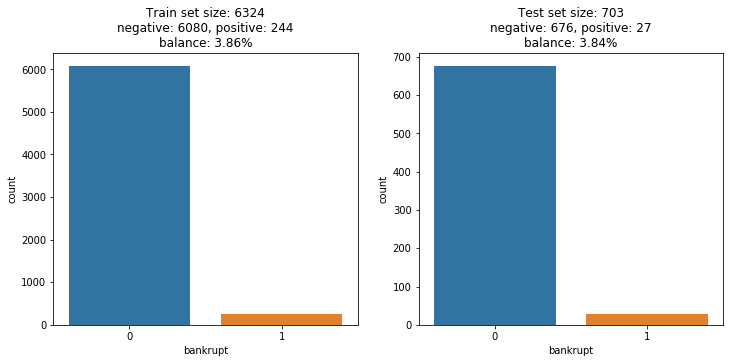

In [11]:
# sets balance vizualization

fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (12,5))
sns.countplot(train_set[target], ax = ax[0])
sns.countplot(test_set[target], ax = ax[1])

ax[0].set_title("Train set size: {}\nnegative: {}, positive: {}\nbalance: {}%".format(
    train_set[target].shape[0], sum(train_set[target]==0), sum(train_set[target]==1),
    round(sum(train_set[target]==1)/train_set.shape[0]*100, 2)))
ax[1].set_title("Test set size: {}\nnegative: {}, positive: {}\nbalance: {}%".format(
    test_set[target].shape[0], sum(test_set[target]==0), sum(test_set[target]==1),
    round(sum(test_set[target]==1)/test_set.shape[0]*100, 2)))

plt.show()

##### Data imputation for train and test set

In [12]:
print("\t\t\t\tTRAIN SET MISSINGS")
get_missing_info(train_set, target)

				TRAIN SET MISSINGS


,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr60,125.0,1.976597,111.0,14.0,11.20
Attr45,124.0,1.960784,110.0,14.0,11.29
Attr24,113.0,1.786844,113.0,0.0,0.00
Attr41,78.0,1.233397,78.0,0.0,0.00
Attr32,31.0,0.490196,30.0,1.0,3.23
Attr54,30.0,0.474383,25.0,5.0,16.67
Attr28,30.0,0.474383,25.0,5.0,16.67
Attr53,30.0,0.474383,25.0,5.0,16.67
Attr64,30.0,0.474383,25.0,5.0,16.67
Attr63,27.0,0.426945,27.0,0.0,0.00


In [13]:
print("\t\t\t\tTEST SET MISSINGS")
get_missing_info(test_set, target)

				TEST SET MISSINGS


,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr24,11.0,1.564723,11.0,0.0,0.0
Attr60,10.0,1.422475,10.0,0.0,0.0
Attr45,10.0,1.422475,10.0,0.0,0.0
Attr32,7.0,0.995733,7.0,0.0,0.0
Attr41,6.0,0.853485,6.0,0.0,0.0
Attr47,5.0,0.711238,5.0,0.0,0.0
Attr52,5.0,0.711238,5.0,0.0,0.0
Attr46,4.0,0.568990,3.0,1.0,25.0
Attr64,4.0,0.568990,3.0,1.0,25.0
Attr28,4.0,0.568990,3.0,1.0,25.0


In [15]:
# Train set imputation
train_set_imp, miss_indices_train, miss_hist_train, miss_hist_ch_train = RFimputation(train_set, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
test_set_imp, miss_indices_valid, miss_hist_valid, miss_hist_ch_valid = RFimputation(test_set, n_iter=10,
                                                                                     target=target, n_estimators=100,
                                                                                     n_jobs=-1, max_depth=8,
                                                                                     random_state=random_state)

train_test_imp_sets = dict(zip(["train_set_imp", "test_set_imp"], [train_set_imp, test_set_imp]))

# SAVING IMPUTED TRAIN AND TEST SET as dict
with open(r"data\1year_data\train_test_imp_sets_1year.p", "wb") as fp:
    pickle.dump(train_test_imp_sets, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 229 seconds
Imputation time: 7 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


In [14]:
# LOADING IMPUTED TRAIN AND TEST SET
with open(r"data\1year_data\train_test_imp_sets_1year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

##### training distribution analysis

							 RAW DATA


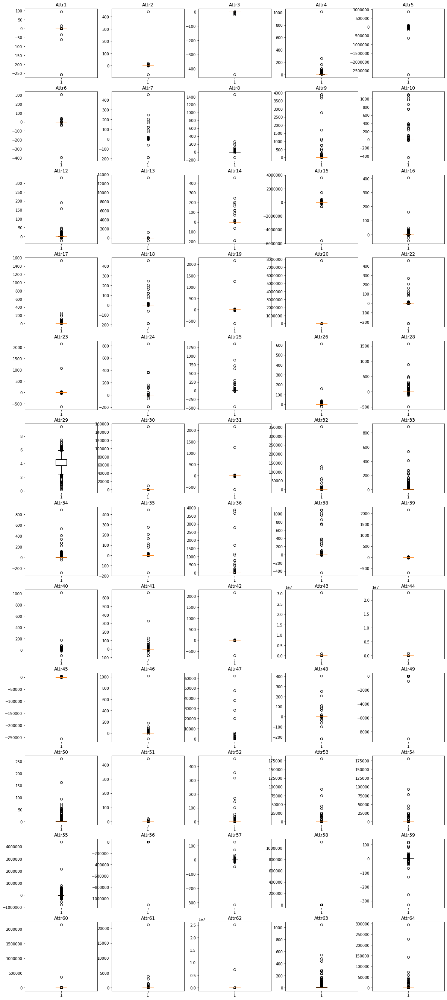

In [15]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t RAW DATA")
plt.show()

Lots of outliers, lets reduce them with quantiles

In [16]:
q=0.005
lb=np.quantile(a=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),:].values, q=q, axis=0)
ub=np.quantile(a=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),:].values, q=1-q, axis=0)

for i, feature in enumerate(features):
    train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature]=train_set_imp.loc[
        (train_set_imp[target]==0)|(train_set_imp[target]==1),feature].apply(
        lambda x: lb[i] if x<lb[i] else ub[i] if x>ub[i] else x)

							 Q_0.005 and Q_0.995 replaced


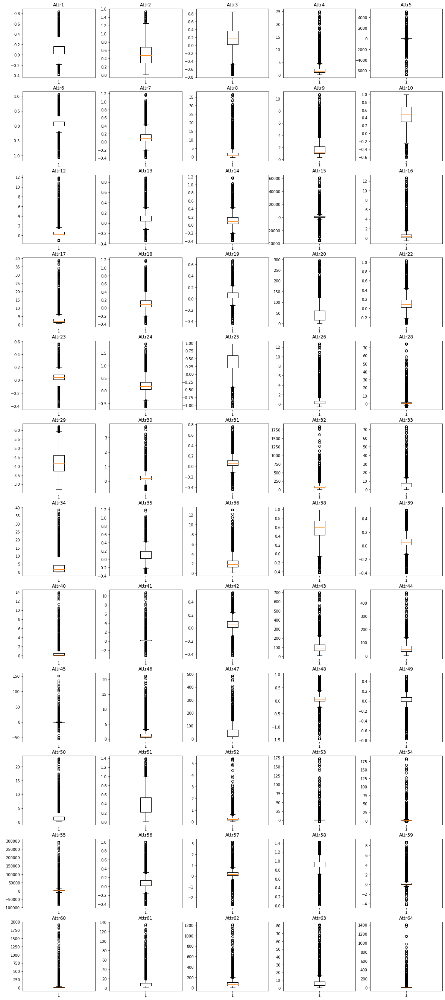

In [17]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t Q_{} and Q_{} replaced".format(q, 1-q))
plt.show()

							 Q_0.005 and Q_0.995 replaced


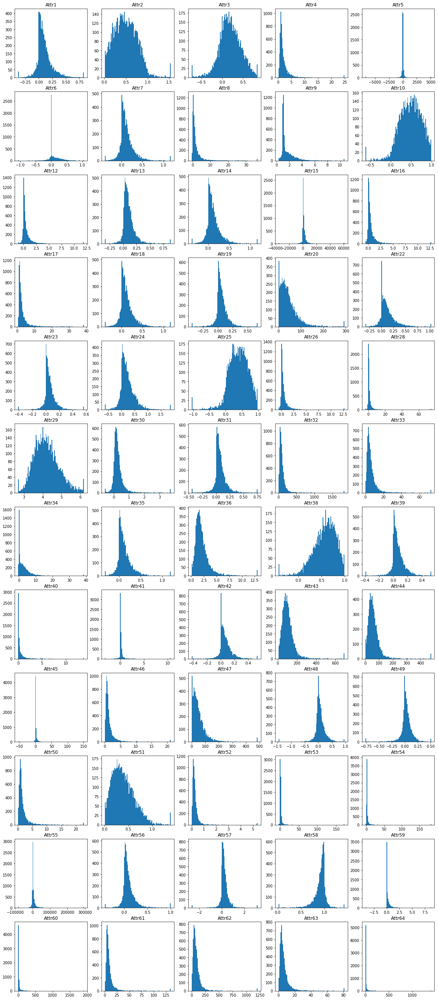

In [18]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t Q_{} and Q_{} replaced".format(q, 1-q))
plt.show()

skewness is very big in this data, lets apply some power transforms.

In [19]:
transformer = PowerTransformer(method="yeo-johnson", standardize=False)
transformer.fit(X=train_set_imp[features])
train_set_imp_pt = pd.DataFrame(transformer.transform(X=train_set_imp[features]), columns=features)

				 Q_0.005 and Q_0.995 replaced, power transform applied


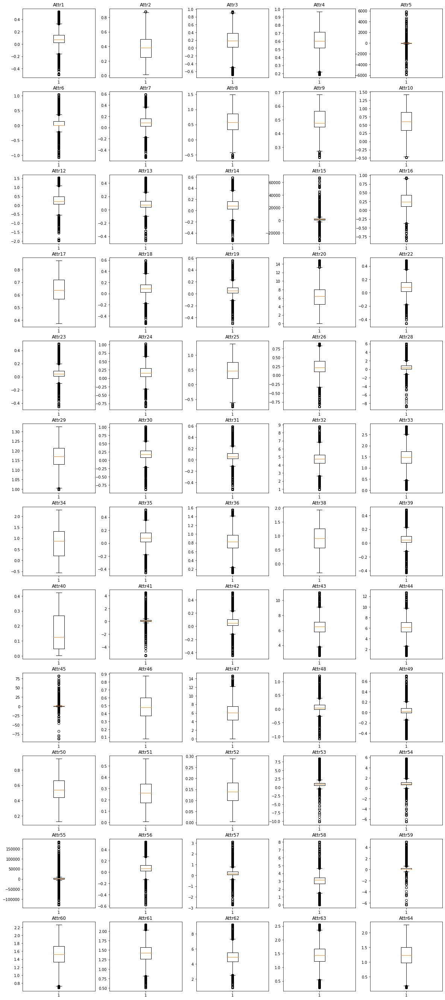

In [20]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp_pt.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t Q_{} and Q_{} replaced, power transform applied".format(q, 1-q))
plt.show()

				 Q_0.005 and Q_0.995 replaced, power transform applied


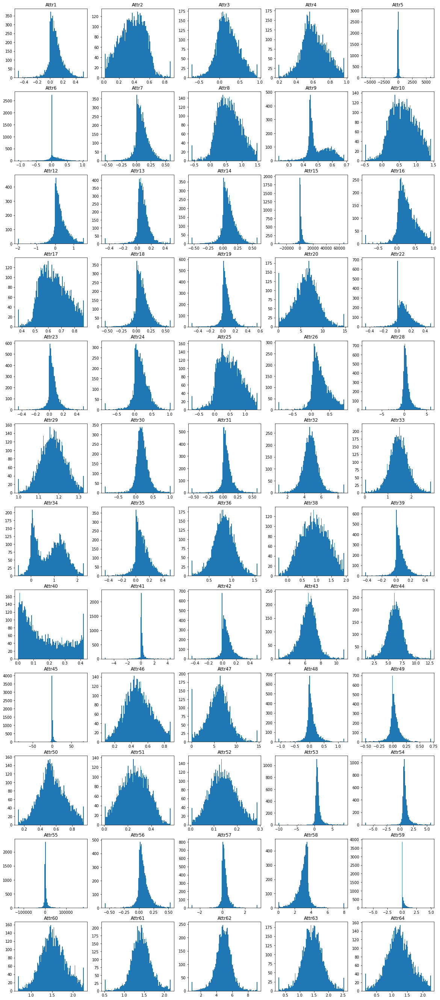

In [21]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp_pt.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t\t\t Q_{} and Q_{} replaced, power transform applied".format(q, 1-q))
plt.show()

In [22]:
# print fitted lambdas
pd.Series(transformer.lambdas_, index=features, name="lambdas")

Attr1    -0.484410
Attr2    -0.122175
Attr3     1.269217
Attr4    -0.992796
Attr5     1.018109
Attr6     0.971739
Attr7    -0.753071
Attr8    -0.595047
Attr9    -1.419430
Attr10    1.910140
Attr12   -0.439776
Attr13   -0.915557
Attr14   -0.753071
Attr15    1.010083
Attr16   -0.997515
Attr17   -1.131331
Attr18   -0.753071
Attr19    0.312693
Attr20    0.295077
Attr22   -1.175786
Attr23    0.477807
Attr24   -0.045003
Attr25    1.882162
Attr26   -1.052827
Attr28    0.142132
Attr29   -0.434359
Attr30   -0.596357
Attr31    0.127194
Attr32    0.039519
Attr33   -0.206712
Attr34   -0.281258
Attr35   -1.164510
Attr36   -0.445194
Attr38    2.623501
Attr39    0.567037
Attr40   -2.367753
Attr41    0.446086
Attr42    0.731082
Attr43    0.146862
Attr44    0.210846
Attr45    0.847719
Attr46   -1.101736
Attr47    0.247583
Attr48    1.607254
Attr49    2.408938
Attr50   -1.015149
Attr51   -1.081542
Attr52   -3.461155
Attr53    0.175766
Attr54    0.036357
Attr55    0.959223
Attr56   -0.764130
Attr57    0.

After skewness and outliers reduction zero mean and unit variance standarization is necessary.

In [23]:
normalizer=StandardScaler()
normalizer.fit(X=train_set_imp_pt)
train_set_imp_pt_norm=pd.DataFrame(normalizer.transform(X=train_set_imp_pt), columns=features)

		 Q_0.005 and Q_0.995 replaced, power transform and normalization applied


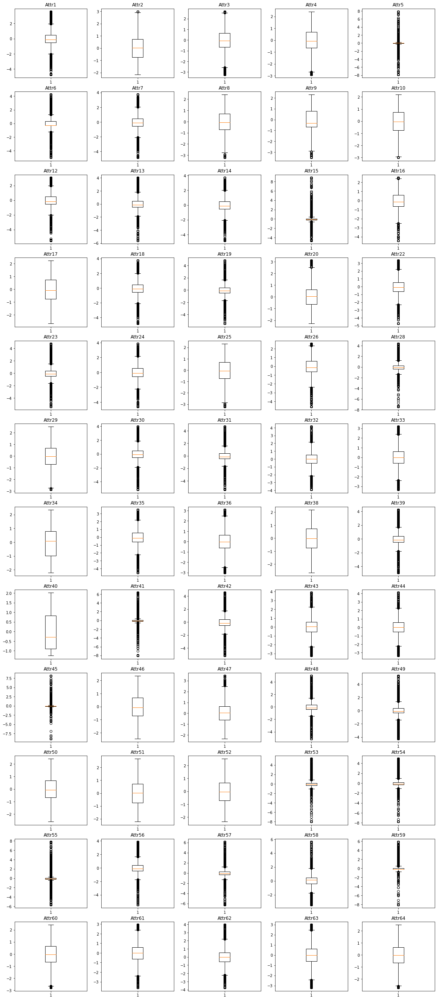

In [24]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp_pt_norm.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t Q_{} and Q_{} replaced, power transform and normalization applied".format(q, 1-q))
plt.show()

		 Q_0.005 and Q_0.995 replaced, power transform and normalization applied


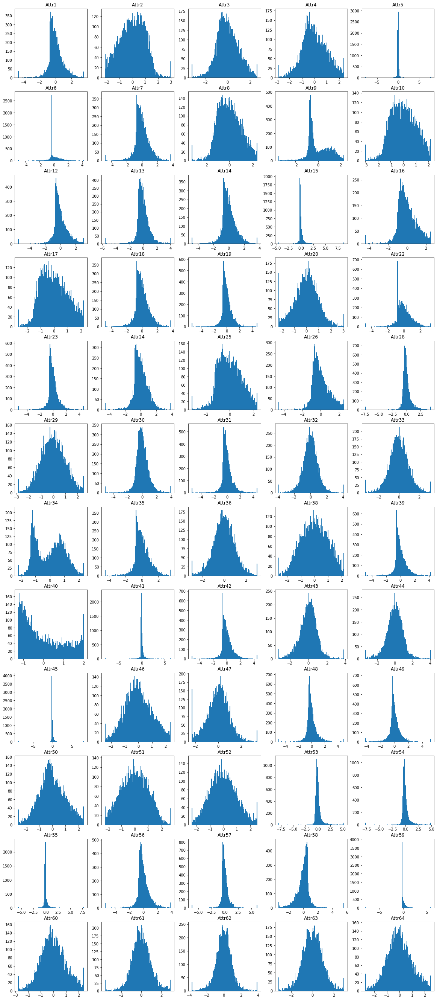

In [25]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp_pt_norm.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t Q_{} and Q_{} replaced, power transform and normalization applied".format(q, 1-q))
plt.show()

Distributions looks much better now, Gaussian-shape is not achived, however outliers and skewness are reduced. Attr 9 and Attr34 distributions looks problematic (two modes). Attr40 also is not looking great.

##### Modelling 
 - preparing folds for n-fold Cross Validation (with imputation, just for time saving - one fold imputation takes 120 seconds on average, it does not make sense to perform it during hyperparameters optimization especially with fixed random seed)

In [29]:
# sets inicialization
trains=[]
valids=[]

# Stratification object
kf = StratifiedKFold(6, shuffle=True, random_state=random_state)
for train, valid in kf.split(train_set, train_set[target]):
    # extracting sets
    train_data = train_set.loc[train,:].copy()
    valid_data = train_set.loc[valid,:].copy()
    # reset index
    train_data.reset_index(drop=True, inplace=True)
    valid_data.reset_index(drop=True, inplace=True)
    # imputation
    train_data, miss_indices_train, miss_hist_train, miss_hist_ch_train = RFimputation(train_data, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
    valid_data, miss_indices_valid, miss_hist_valid, miss_hist_ch_valid = RFimputation(valid_data, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
    
    # saving
    trains.append(train_data)
    valids.append(valid_data)
    
sets = {"training_sets" : trains,
        "validation_sets" : valids}

#SAVING
with open(r"data\1year_data\sets.p", "wb") as fp:
    pickle.dump(sets, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 160 seconds
Imputation time: 10 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 156 seconds
Imputation time: 10 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 155 seconds
Imputation time: 10 seconds
Imputation time: 156 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 10 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 158 seconds
Imputation time: 11 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 166 seconds
Imputation time: 11 seconds


In [26]:
#LOADING
with open(r"data\1year_data\sets.p", "rb") as fp:
    sets = pickle.load(fp)

##### Logistic regression

In [27]:
def Logit_6FoldCrossValidation(datasets, features, target, random_state, normalize=False, q=None, alpha="none", info=0):
    '''
    function performes 6 fold Cross Validation for Logistic Regression, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    random_state - random seed,
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    alpha - L1 norm regularization parameter, "none" for no regularization, (0,inf) for regularization
    info - folds' info
    
    returns Logit_history - dictionary with CV results 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    trainROCs = []
    trainPRs = []
    validROCs = []
    validPRs = []
    
    CVstart=time.time()
    for fold in range(len(training_sets)):
        if info==1:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for Logistc Regression
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # Logistic Regression training
        formula = "{}~{}".format(target, "+".join(features))
        LogitRegression = smf.logit(formula, pd.concat((X_train, Y_train), axis=1))
        if alpha == "none":
            LogitRegression=LogitRegression.fit(method="powell", maxiter=1000, disp=info)
        else:
            LogitRegression=LogitRegression.fit_regularized(method="l1", alpha=alpha, disp=info)
        
        # metrics
        predsTrain = LogitRegression.predict(exog=X_train)
        predsValid = LogitRegression.predict(exog=X_valid)
        
        trainROC = roc_auc_score(y_true=Y_train, y_score=predsTrain)
        trainPR = average_precision_score(y_true=Y_train, y_score=predsTrain)
        validROC = roc_auc_score(y_true=Y_valid, y_score=predsValid)
        validPR = average_precision_score(y_true=Y_valid, y_score=predsValid)
        
        # metrics saving
        trainROCs.append(trainROC)
        trainPRs.append(trainPR)
        validROCs.append(validROC)
        validPRs.append(validPR)
        
        if info==1:
            print("\ntrain roc: {}\ntrain pr: {}\nvalid roc: {}\nvalid pr: {}".format(trainROC, trainPR, validROC,
                                                                                       validPR))
        
    Logit_history={"train_roc" : trainROCs,
                   "train_pr" : trainPRs,
                   "valid_roc" : validROCs,
                   "valid_pr" : validPRs}       

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))

    return Logit_history

In [32]:
# without normalization
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=False, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

# results printing
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\l


Cross validation time: 81s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


0.01 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


0.03 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


0.05 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))



Cross validation time: 25s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


0.1 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))



Cross validation time: 28s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


0.5 fatal error
0.8 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))



Cross validation time: 21s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 16s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


3 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))



Cross validation time: 14s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 13s

alpha: none
train_roc 0.7931246998558318
train_pr 0.23614338685828318
valid_roc 0.732580771135499
valid_pr 0.15272556686787503

alpha: 0.01, - failure

alpha: 0.03, - failure

alpha: 0.05, - failure

alpha: 0.08
train_roc 0.8117892673172046
train_pr 0.2744591578994259
valid_roc 0.7600109143722805
valid_pr 0.19150436679462368

alpha: 0.1, - failure

alpha: 0.3
train_roc 0.8093954037895789
train_pr 0.2597989658796294
valid_roc 0.7593096241994813
valid_pr 0.18356612628721314

alpha: 0.5, - failure

alpha: 0.8, - failure

alpha: 1
train_roc 0.8013002061410822
train_pr 0.2261231259848608
valid_roc 0.7473950098088237
valid_pr 0.15589029893799142

alpha: 2
train_roc 0.7811090033095689
train_pr 0.18363507191306974
valid_roc 0.7267992602418459
valid_pr 0.12823554222984204

alpha: 3, - failure

alpha: 4
train_roc 0.7527831580392316
train_pr 0.14877552946878975
valid_roc 0.702148156423875
valid_pr 0.11345735037424591

alpha: 5
train_roc 0.7431112257552014
train_pr 0.1

$\alpha=0.3$ gave the best results approx. 0.1835 AUC-PR (really poor result)

In [33]:
# with normalization
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=True, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

# results printing
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\l


Cross validation time: 60s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


0.01 fatal error
0.03 fatal error
0.05 fatal error
0.08 fatal error

Cross validation time: 27s
0.3 fatal error
0.5 fatal error

Cross validation time: 17s
1 fatal error

Cross validation time: 10s
3 fatal error

Cross validation time: 8s

Cross validation time: 7s

alpha: none
train_roc 0.793517906014933
train_pr 0.23943378266360324
valid_roc 0.7371598391881787
valid_pr 0.16480897255723834

alpha: 0.01, - failure

alpha: 0.03, - failure

alpha: 0.05, - failure

alpha: 0.08, - failure

alpha: 0.1
train_roc 0.7614251106342036
train_pr 0.16755107592248675
valid_roc 0.7095337650381635
valid_pr 0.12750010772914638

alpha: 0.3, - failure

alpha: 0.5, - failure

alpha: 0.8
train_roc 0.7095976104710005
train_pr 0.12454740302679161
valid_roc 0.6766985180272912
valid_pr 0.11340449402371318

alpha: 1, - failure

alpha: 2
train_roc 0.6780271062937951
train_pr 0.1132700880018832
valid_roc 0.6433595482691116
valid_pr 0.09565747118266711

alpha: 3, - failure

alpha: 4
train_roc 0.6599587899430023
tr

Worse results

In [34]:
# with normalization and outlier reduction (q=0.005)
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=True, q=0.005, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

# results printing
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)



Cross validation time: 35s
0.01 fatal error
0.03 fatal error
0.05 fatal error

Cross validation time: 25s
0.1 fatal error
0.3 fatal error

Cross validation time: 19s
0.8 fatal error

Cross validation time: 15s

Cross validation time: 12s

Cross validation time: 10s

Cross validation time: 9s

Cross validation time: 8s

alpha: none
train_roc 0.8199806749731212
train_pr 0.23938269523978706
valid_roc 0.7595007865607623
valid_pr 0.16931505057170415

alpha: 0.01, - failure

alpha: 0.03, - failure

alpha: 0.05, - failure

alpha: 0.08
train_roc 0.826135710572303
train_pr 0.26575500650738987
valid_roc 0.7584617411729807
valid_pr 0.18042586403056168

alpha: 0.1, - failure

alpha: 0.3, - failure

alpha: 0.5
train_roc 0.8165190740161662
train_pr 0.2425438451113
valid_roc 0.7654647911783051
valid_pr 0.17831476124222226

alpha: 0.8, - failure

alpha: 1
train_roc 0.7934058598278716
train_pr 0.18762652729912443
valid_roc 0.7431533353574203
valid_pr 0.15574475285991315

alpha: 2
train_roc 0.808580234

Quantile clipping didn't help

In [35]:
# with normalization and outlier reduction (q=0.005) and power transform
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize="power", q=0.005, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

# results printing
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)



Cross validation time: 34s
0.01 fatal error

Cross validation time: 28s
0.05 fatal error

Cross validation time: 27s

Cross validation time: 26s

Cross validation time: 23s

Cross validation time: 21s

Cross validation time: 18s

Cross validation time: 19s

Cross validation time: 15s

Cross validation time: 14s

Cross validation time: 13s

Cross validation time: 13s

alpha: none
train_roc 0.7969196781966739
train_pr 0.33087621710608084
valid_roc 0.751063570959306
valid_pr 0.24519986132650226

alpha: 0.01, - failure

alpha: 0.03
train_roc 0.8060500362251853
train_pr 0.3467696833838616
valid_roc 0.7636514133098348
valid_pr 0.26686692627919434

alpha: 0.05, - failure

alpha: 0.08
train_roc 0.8055153407645417
train_pr 0.34668764433118376
valid_roc 0.7631549722060639
valid_pr 0.2693264854499588

alpha: 0.1
train_roc 0.8053287576034022
train_pr 0.34658592381948483
valid_roc 0.7628653714706521
valid_pr 0.2692665051451438

alpha: 0.3
train_roc 0.8028759508635215
train_pr 0.3451425651675318
va

Finally some improvmed noted - 0.27 AUC-PR (+0.09) for $\alpha=0.3$ Longer forecasting horizn worse results (1 year - 0.49, 2 years - 0.28, 3 years - 0.25 and 4 years - 0.22, 5 years - 0.27)

##### Random Forest, hyperparameters optimization
 - 6 fold Cross validation for Random Forest

In [28]:
def RF_6FoldCrossValidation(datasets, features, target, random_state, normalize="power", q=None, saveModels=False, info=0,
                            *args, **kwargs):
    '''
    function performes 6 fold Cross Validation for Random Forest, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    info - fold's info,
    random_state - random seed
    *args and **kwargs - hyperparameters for Random Forest
    
    returns RFhistoriey - dictionary with CV results 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    trainROCs = []
    trainPRs = []
    validROCs = []
    validPRs = []
    
    if saveModels:
        models = []
    
    CVstart=time.time()
    for fold in range(len(training_sets)):
        if info==1:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for RF
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # RF training
        RF = RandomForestClassifier(*args, **kwargs)
        RF.fit(X_train, Y_train)
        
        # metrics
        predsTrain = RF.predict_proba(X_train)[:,1]
        predsValid = RF.predict_proba(X_valid)[:,1]
        
        trainROC = roc_auc_score(y_true=Y_train, y_score=predsTrain)
        trainPR = average_precision_score(y_true=Y_train, y_score=predsTrain)
        validROC = roc_auc_score(y_true=Y_valid, y_score=predsValid)
        validPR = average_precision_score(y_true=Y_valid, y_score=predsValid)
        
        # metrics saving
        trainROCs.append(trainROC)
        trainPRs.append(trainPR)
        validROCs.append(validROC)
        validPRs.append(validPR)
        
        # model saving
        if saveModels:
            models.append(RF)
        
        if info==1:
            print("\ntrain roc: {}\ntrain pr: {}\nvalid roc: {}\nvalid pr: {}".format(trainROC, trainPR, validROC,
                                                                                       validPR))
        
    RFhistory={"train_roc" : trainROCs,
               "train_pr" : trainPRs,
               "valid_roc" : validROCs,
               "valid_pr" : validPRs}       

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    if saveModels:
        RFhistory["models"]=models
        return RFhistory
    return RFhistory

In [37]:
# attempt without normalization
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=False, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 17s
valid ROC: 0.7596831632919828
valid PR: 0.15912861392846397
overfitting ROC: 0.2403164320082951
overfitting PR: 0.8408513023441846


In [38]:
# attempt with normalization
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=True, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 16s
valid ROC: 0.7665376294905536
valid PR: 0.164915930046893
overfitting ROC: 0.23346196580972434
overfitting PR: 0.8350639862257556


better

In [39]:
# attempt with normalization and outlier reduction (0.005)
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=True, q=0.005, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 15s
valid ROC: 0.7499470924520734
valid PR: 0.15793221147771988
overfitting ROC: 0.25005250284820457
overfitting PR: 0.8420477047949287


the worst

In [40]:
# attempt with normalization, outlier reduction (0.005) and power transform
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize="power", q=0.005, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 19s
valid ROC: 0.7493772644438231
valid PR: 0.15762503497175448
overfitting ROC: 0.2506223308564548
overfitting PR: 0.8423548813008941


Same conclusion as for other horizons, preprocessing pipeline should be treated as hyperparameter. However the best results achived when nromalization only applied. So, experimets will be performed with that settings.

In [29]:
depths = [i for i in range(2,22,2)]
RFhists = []
for depth in depths:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                     normalize=True, q=None, info=0, saveModels=False, max_depth=depth)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(depths, RFhists))

for key in RF_CV_history.keys():
    print("\ndepth:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 4s

Cross validation time: 7s

Cross validation time: 9s

Cross validation time: 12s

Cross validation time: 12s

Cross validation time: 13s

Cross validation time: 15s

Cross validation time: 15s

Cross validation time: 16s

Cross validation time: 15s

depth: 2
valid ROC: 0.7309834572583007
valid PR: 0.14769381321794361
overfitting ROC: 0.04284206763101073
overfitting PR: 0.06883027698504549

depth: 4
valid ROC: 0.7511865231809601
valid PR: 0.17083846382881895
overfitting ROC: 0.09420151226056128
overfitting PR: 0.2386357787199998

depth: 6
valid ROC: 0.7676637399820042
valid PR: 0.19663251212253008
overfitting ROC: 0.17096098106204005
overfitting PR: 0.46074115911090197

depth: 8
valid ROC: 0.7713896722599314
valid PR: 0.1940117390074508
overfitting ROC: 0.2194223899904698
overfitting PR: 0.6945996457020113

depth: 10
valid ROC: 0.7722692694515089
valid PR: 0.19195688110477324
overfitting ROC: 0.22706799230938102
overfitting PR: 0.7937085166216533

depth: 12
v

6-10 should be ok, mean=8 and that value will be used for further sequentional checking.
 - number of trees (weak estimators in ensemble learning words)

In [30]:
nums_of_trees = [10, 25, 75, 100, 200, 400, 600, 800, 1000]
RFhists = []
for num_of_trees in nums_of_trees:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                    normalize=True, q=None, saveModels=False, max_depth=8, n_estimators=num_of_trees)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(nums_of_trees, RFhists))

for key in RF_CV_history.keys():
    print("\ndepth:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 1s

Cross validation time: 3s

Cross validation time: 8s

Cross validation time: 11s

Cross validation time: 21s

Cross validation time: 44s

Cross validation time: 64s

Cross validation time: 87s

Cross validation time: 108s

depth: 10
valid ROC: 0.7556977019952592
valid PR: 0.15827689476190038
overfitting ROC: 0.2044622545756738
overfitting PR: 0.5883140820765809

depth: 25
valid ROC: 0.7650579078888229
valid PR: 0.16915279775524072
overfitting ROC: 0.21301759617122096
overfitting PR: 0.6594319373573384

depth: 75
valid ROC: 0.7712775703292455
valid PR: 0.1942828572079903
overfitting ROC: 0.2160523086809909
overfitting PR: 0.6796439826715228

depth: 100
valid ROC: 0.7713896722599314
valid PR: 0.1940117390074508
overfitting ROC: 0.2194223899904698
overfitting PR: 0.6945996457020113

depth: 200
valid ROC: 0.7755583489249686
valid PR: 0.1933951843105414
overfitting ROC: 0.21767349962634763
overfitting PR: 0.7111134971787533

depth: 400
valid ROC: 0.77519984460247

best results with 800 trees, but 100 is enough for experiments

 - max number of features

In [31]:
print('Rule of thumb\nsquare root of number of features : {}'.format((len(features))**(1/2)))

Rule of thumb
square root of number of features : 7.745966692414834


In [32]:
max_features = [i for i in range(1,len(features), 4)]
RFhists = []
for n in max_features:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=True, q=None, saveModels=False, max_depth=8, n_estimators=100,
                                     max_features=n)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(max_features, RFhists))

for key in RF_CV_history.keys():
    print("\nmax number of features:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 3s

Cross validation time: 8s

Cross validation time: 13s

Cross validation time: 19s

Cross validation time: 24s

Cross validation time: 30s

Cross validation time: 35s

Cross validation time: 41s

Cross validation time: 46s

Cross validation time: 52s

Cross validation time: 57s

Cross validation time: 62s

Cross validation time: 68s

Cross validation time: 73s

Cross validation time: 78s

max number of features: 1
valid ROC: 0.7353604851048554
valid PR: 0.1465074882520654
overfitting ROC: 0.24161059978908384
overfitting PR: 0.6535406155809188

max number of features: 5
valid ROC: 0.7721054791206088
valid PR: 0.18394427214977052
overfitting ROC: 0.21848846546115963
overfitting PR: 0.6991535318714532

max number of features: 9
valid ROC: 0.7778960032482428
valid PR: 0.2070813561650697
overfitting ROC: 0.21132424866599597
overfitting PR: 0.6676100372116865

max number of features: 13
valid ROC: 0.7720679247210455
valid PR: 0.20787200467609446
overfitting ROC: 0.

Best results for $>25$
 - min sample split

In [33]:
min_sample_spilt = [2, 4, 6, 8, 10, 15, 20, 30]
RFhists = []
for min_split in min_sample_spilt:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=True, q=None, saveModels=False, max_depth=8, n_estimators=100,
                                     max_features=57, min_samples_split=min_split)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(min_sample_spilt, RFhists))

for key in RF_CV_history.keys():
    print("\nmin samples to split:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 79s

Cross validation time: 77s

Cross validation time: 79s

Cross validation time: 79s

Cross validation time: 78s

Cross validation time: 77s

Cross validation time: 79s

Cross validation time: 78s

min samples to split: 2
valid ROC: 0.7878628773749186
valid PR: 0.23830082879012168
overfitting ROC: 0.19428901932503262
overfitting PR: 0.6042439752249494

min samples to split: 4
valid ROC: 0.7874805186181254
valid PR: 0.23680735884323714
overfitting ROC: 0.19328130257904108
overfitting PR: 0.5892130381166187

min samples to split: 6
valid ROC: 0.7865164718139658
valid PR: 0.2330347122487814
overfitting ROC: 0.19294304211087976
overfitting PR: 0.5738994676953963

min samples to split: 8
valid ROC: 0.7896123169933883
valid PR: 0.22784895865630816
overfitting ROC: 0.1877083051476124
overfitting PR: 0.555854812843377

min samples to split: 10
valid ROC: 0.786368707796861
valid PR: 0.22393496771525093
overfitting ROC: 0.18819488126378636
overfitting PR: 0.53436671099

2-10 is a resonable range to try in random search, 8 will be used for experiments.
 
 - min samples leaf, this parameter has to be lower than min_sample_split, thus while testing range 2-10 for min samples leaf, min_sample_split has to be at least 11. 

In [36]:
min_sample_leaf = [i for i in range(0,12,2) if i > 0]
RFhists = []
for min_leaf in min_sample_leaf:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=True, q=None, saveModels=False, max_depth=8, n_estimators=100,
                                     max_features=57, min_samples_split=11, min_samples_leaf=min_leaf)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(min_sample_leaf, RFhists))

for key in RF_CV_history.keys():
    print("\nmin samples in leaf:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 81s

Cross validation time: 76s

Cross validation time: 74s

Cross validation time: 73s

Cross validation time: 72s

min samples in leaf: 2
valid ROC: 0.7905579468263578
valid PR: 0.2399606914552255
overfitting ROC: 0.18534032110629295
overfitting PR: 0.5180785558845004

min samples in leaf: 4
valid ROC: 0.797506774909452
valid PR: 0.25008112457322296
overfitting ROC: 0.18339347209533896
overfitting PR: 0.5293828545939856

min samples in leaf: 6
valid ROC: 0.7975258339304759
valid PR: 0.25247901114922566
overfitting ROC: 0.18408654274570024
overfitting PR: 0.5230269120621495

min samples in leaf: 8
valid ROC: 0.7970917382944762
valid PR: 0.25932009859846056
overfitting ROC: 0.18202562754903762
overfitting PR: 0.4754359443422567

min samples in leaf: 10
valid ROC: 0.7938823980564363
valid PR: 0.2508475829988237
overfitting ROC: 0.18257544728348352
overfitting PR: 0.4513110424711505


higher parameter, better results, lower overfitting, but maybe it is this specific case, in random search range 1-min sample split will be tried,<br>
To sum up:
 - max_depth $\in \{6,7,...,10\}$
 - n_estimators = 100 for random search, more can be tested after finding the best set of parameters,
 - max_features $>25$,
 - min_samples_split $\in \{2,3,...,10\}$,
 - min_samples_leaf $\in \{1,2,...,\text{min_samples_split}\}$
 
 
 - Random Search

In [37]:
start = time.time()
# results DataFrame inicialization 
rstls = pd.DataFrame(columns = ["max_depth", "max_features", "min_samples_split", "min_samples_leaf", 
                                "ROCvalid", "overfittingROC", "PRvalid", "OverfittingPR","norm_mode"])#

# normalization methods
norms={1:True, 2:False, 3:"power"}

# searching loop
for k in range(50):
    # its necessary to reset seeds in every iteration, because of RF_6FoldCrossValidation() definition
    np.random.seed(seed=None)
    random.seed(a=None)
    # parameters dictionary
    params = {
        "max_depth" : random.randint(6, 10),
        "max_features" : random.randint(25, len(features)),
        "min_samples_split" : random.randint(2, 10),
    }
    # min_samples_leaf has to be lower than min_sample_split
    params["min_samples_leaf"] = random.randint(1, params["min_samples_split"])
    
    norm_mode=random.choice(list(norms.keys()))
    
    # CV 
    RFhist = RF_6FoldCrossValidation(datasets=sets,
                                     features=features,
                                     target=target,
                                     random_state=random_state,
                                     normalize=norms[norm_mode],
                                     q=None,
                                     info=0,
                                     saveModels=False,
                                     max_depth=params["max_depth"],
                                     n_estimators=100,
                                     max_features=params["max_features"],
                                     min_samples_split=params["min_samples_split"],
                                     min_samples_leaf=params["min_samples_leaf"])
    
    
    # saving
    rstls = rstls.append(other = pd.DataFrame(data = np.array([params["max_depth"], params["max_features"], params["min_samples_split"],
                        params["min_samples_leaf"], np.mean(RFhist["valid_roc"]),
                           np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]), np.mean(RFhist["valid_pr"]),
                           np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]), norm_mode]).reshape(1, -1), columns = rstls.columns.tolist()), ignore_index=True)
    
    
    # current iteration result
    print((rstls.iloc[k, :].to_dict()))
    print('-'*30)
    
    # top 5 per 10 iterations
    if (k+1) % 10 == 0:    
        print("\n Top 5:")
        display(rstls.sort_values(by = "PRvalid", ascending = False).head(5))

stop = time.time()
print("Loop time: {} seconds".format(round(stop-start, 2)))

#SAVING
with open(r"results\1year\RF_RS.p", "wb") as fp:
    pickle.dump(rstls, fp)


Cross validation time: 51s
{'max_depth': 10.0, 'max_features': 30.0, 'min_samples_split': 6.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.7899002424333474, 'overfittingROC': 0.20717460021531708, 'PRvalid': 0.25122331902910255, 'OverfittingPR': 0.6945227547096545, 'norm_mode': 2.0}
------------------------------

Cross validation time: 49s
{'max_depth': 8.0, 'max_features': 33.0, 'min_samples_split': 5.0, 'min_samples_leaf': 4.0, 'ROCvalid': 0.7945173628835623, 'overfittingROC': 0.19205073165431308, 'PRvalid': 0.26370507859236086, 'OverfittingPR': 0.563692362193454, 'norm_mode': 3.0}
------------------------------

Cross validation time: 40s
{'max_depth': 7.0, 'max_features': 29.0, 'min_samples_split': 5.0, 'min_samples_leaf': 4.0, 'ROCvalid': 0.7933912860800644, 'overfittingROC': 0.17858989969209849, 'PRvalid': 0.24220534202923868, 'OverfittingPR': 0.5040126797292699, 'norm_mode': 3.0}
------------------------------

Cross validation time: 65s
{'max_depth': 8.0, 'max_features': 48.0, 'min

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
1,8.0,33.0,5.0,4.0,0.794517,0.192051,0.263705,0.563692,3.0
5,9.0,38.0,7.0,4.0,0.794859,0.197908,0.260358,0.625638,3.0
0,10.0,30.0,6.0,2.0,0.789900,0.207175,0.251223,0.694523,2.0
8,7.0,54.0,3.0,2.0,0.788191,0.181721,0.250881,0.517013,3.0
3,8.0,48.0,9.0,3.0,0.790164,0.192886,0.250736,0.553777,1.0



Cross validation time: 69s
{'max_depth': 9.0, 'max_features': 45.0, 'min_samples_split': 6.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.789169305576075, 'overfittingROC': 0.20365728786912995, 'PRvalid': 0.2578106951004979, 'OverfittingPR': 0.6419927993663601, 'norm_mode': 3.0}
------------------------------

Cross validation time: 62s
{'max_depth': 9.0, 'max_features': 42.0, 'min_samples_split': 6.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.7839655673091586, 'overfittingROC': 0.20789089960175178, 'PRvalid': 0.2257447404557976, 'OverfittingPR': 0.6588926639060954, 'norm_mode': 1.0}
------------------------------

Cross validation time: 66s
{'max_depth': 9.0, 'max_features': 47.0, 'min_samples_split': 10.0, 'min_samples_leaf': 5.0, 'ROCvalid': 0.7939768682766664, 'overfittingROC': 0.19694016075438248, 'PRvalid': 0.2536770620239625, 'OverfittingPR': 0.6026441865506036, 'norm_mode': 1.0}
------------------------------

Cross validation time: 44s
{'max_depth': 8.0, 'max_features': 34.0, 'min_sa

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
1,8.0,33.0,5.0,4.0,0.794517,0.192051,0.263705,0.563692,3.0
5,9.0,38.0,7.0,4.0,0.794859,0.197908,0.260358,0.625638,3.0
10,9.0,45.0,6.0,3.0,0.789169,0.203657,0.257811,0.641993,3.0
18,8.0,43.0,7.0,3.0,0.794702,0.190371,0.257103,0.575128,2.0
16,9.0,42.0,5.0,4.0,0.792410,0.199541,0.256559,0.621446,1.0



Cross validation time: 61s
{'max_depth': 8.0, 'max_features': 46.0, 'min_samples_split': 2.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.7846431326547636, 'overfittingROC': 0.19992173657786239, 'PRvalid': 0.2281485018163049, 'OverfittingPR': 0.6197061969436874, 'norm_mode': 1.0}
------------------------------

Cross validation time: 66s
{'max_depth': 8.0, 'max_features': 50.0, 'min_samples_split': 8.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.789687534128221, 'overfittingROC': 0.193562551530837, 'PRvalid': 0.25921840557166725, 'OverfittingPR': 0.5575808102871209, 'norm_mode': 2.0}
------------------------------

Cross validation time: 64s
{'max_depth': 9.0, 'max_features': 42.0, 'min_samples_split': 4.0, 'min_samples_leaf': 4.0, 'ROCvalid': 0.7971832654441444, 'overfittingROC': 0.19489742235185747, 'PRvalid': 0.2613070177942539, 'OverfittingPR': 0.6185873135375541, 'norm_mode': 3.0}
------------------------------

Cross validation time: 33s
{'max_depth': 6.0, 'max_features': 32.0, 'min_samp

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
24,10.0,56.0,6.0,3.0,0.795584,0.200892,0.264869,0.672717,2.0
1,8.0,33.0,5.0,4.0,0.794517,0.192051,0.263705,0.563692,3.0
22,9.0,42.0,4.0,4.0,0.797183,0.194897,0.261307,0.618587,3.0
5,9.0,38.0,7.0,4.0,0.794859,0.197908,0.260358,0.625638,3.0
21,8.0,50.0,8.0,3.0,0.789688,0.193563,0.259218,0.557581,2.0



Cross validation time: 32s
{'max_depth': 8.0, 'max_features': 25.0, 'min_samples_split': 10.0, 'min_samples_leaf': 8.0, 'ROCvalid': 0.7857828123171403, 'overfittingROC': 0.19355958715797028, 'PRvalid': 0.2377831148995987, 'OverfittingPR': 0.5001798150643975, 'norm_mode': 1.0}
------------------------------

Cross validation time: 57s
{'max_depth': 8.0, 'max_features': 44.0, 'min_samples_split': 9.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.7897843069026976, 'overfittingROC': 0.1933431643671335, 'PRvalid': 0.2529057945103089, 'OverfittingPR': 0.5479686442880326, 'norm_mode': 1.0}
------------------------------

Cross validation time: 60s
{'max_depth': 8.0, 'max_features': 46.0, 'min_samples_split': 9.0, 'min_samples_leaf': 5.0, 'ROCvalid': 0.7926359910027264, 'overfittingROC': 0.19094074207244638, 'PRvalid': 0.2566573864120174, 'OverfittingPR': 0.5417325226514805, 'norm_mode': 2.0}
------------------------------

Cross validation time: 80s
{'max_depth': 10.0, 'max_features': 50.0, 'min_s

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
24,10.0,56.0,6.0,3.0,0.795584,0.200892,0.264869,0.672717,2.0
1,8.0,33.0,5.0,4.0,0.794517,0.192051,0.263705,0.563692,3.0
39,9.0,43.0,7.0,4.0,0.798830,0.193433,0.262117,0.618489,3.0
35,8.0,57.0,6.0,3.0,0.796488,0.188823,0.261515,0.575895,2.0
22,9.0,42.0,4.0,4.0,0.797183,0.194897,0.261307,0.618587,3.0



Cross validation time: 61s
{'max_depth': 6.0, 'max_features': 56.0, 'min_samples_split': 7.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.7849650564612856, 'overfittingROC': 0.15395374734158718, 'PRvalid': 0.23795767634566775, 'OverfittingPR': 0.4036287101153392, 'norm_mode': 3.0}
------------------------------

Cross validation time: 59s
{'max_depth': 6.0, 'max_features': 59.0, 'min_samples_split': 4.0, 'min_samples_leaf': 4.0, 'ROCvalid': 0.7851976629686811, 'overfittingROC': 0.15942415601347493, 'PRvalid': 0.24736272027086084, 'OverfittingPR': 0.38168230914756895, 'norm_mode': 1.0}
------------------------------

Cross validation time: 62s
{'max_depth': 10.0, 'max_features': 40.0, 'min_samples_split': 9.0, 'min_samples_leaf': 8.0, 'ROCvalid': 0.7994233908196033, 'overfittingROC': 0.19178261329144008, 'PRvalid': 0.25659070361150943, 'OverfittingPR': 0.5789200089724289, 'norm_mode': 3.0}
------------------------------

Cross validation time: 45s
{'max_depth': 8.0, 'max_features': 34.0, 'm

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
45,10.0,60.0,3.0,3.0,0.793013,0.203283,0.267020,0.669865,2.0
24,10.0,56.0,6.0,3.0,0.795584,0.200892,0.264869,0.672717,2.0
1,8.0,33.0,5.0,4.0,0.794517,0.192051,0.263705,0.563692,3.0
39,9.0,43.0,7.0,4.0,0.798830,0.193433,0.262117,0.618489,3.0
35,8.0,57.0,6.0,3.0,0.796488,0.188823,0.261515,0.575895,2.0


Loop time: 2820.35 seconds


It is kind of funny, 1-index model is considered as the best one - comparable valid PR, and 0.1 less overfitting. 

In [38]:
n_trees = [100, 200, 300, 400, 600]
RFhists = []
for n in n_trees:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize="power", q=None, saveModels=False, max_depth=8, n_estimators=n,
                                     max_features=33, min_samples_split=5, min_samples_leaf=4)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(n_trees, RFhists))

for key in RF_CV_history.keys():
    print("\nn trees:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 49s

Cross validation time: 95s

Cross validation time: 141s

Cross validation time: 187s

Cross validation time: 279s

n trees: 100
valid ROC: 0.7945173628835623
valid PR: 0.26370507859236086
overfitting ROC: 0.19205073165431308
overfitting PR: 0.563692362193454

n trees: 200
valid ROC: 0.7939526318477013
valid PR: 0.25991786451387516
overfitting ROC: 0.19376448723638084
overfitting PR: 0.5748449557604702

n trees: 300
valid ROC: 0.7927786750645578
valid PR: 0.24866934692492249
overfitting ROC: 0.19457663029279004
overfitting PR: 0.5871228158312372

n trees: 400
valid ROC: 0.7968365563572121
valid PR: 0.2584758343227383
overfitting ROC: 0.1915121977719545
overfitting PR: 0.5837922548090098

n trees: 600
valid ROC: 0.7927340055319556
valid PR: 0.2600160242564819
overfitting ROC: 0.19533828933645647
overfitting PR: 0.5777783397400644


To sum up, best random forest:
 - max depth: 8,
 - max_features: 33,
 - min_samples_split: 5,
 - min_samples_leaf: 4,
 - n_estimators: 100,
 - power transform and normalization without quantile clipping.
 
##### Extreme Gradient Boosting (XGB)
 - training functions

In [29]:
def XGB_training(X_train, Y_train, X_valid=None, Y_valid=None, early_stopping_rounds=1,
                 booster="gbtree", tree_method="auto", n_estimators=10, max_depth=7, learning_rate=0.03,
                 subsample=0.7, colsample_bytree=0.7, colsample_bylevel=1,
                 gamma=0, min_child_weight=0, reg_alpha=0, reg_lambda=1,
                 random_state=random_state, info=0):
    
    '''
    function runs Extreme Gradniet Boosting algorithm, arguments:
    X_train, Y_train, X_valid, Y_valid - (pandas.DataFrame()), training/validation sets,
    early_stopping_rounds - number of iterations over which the metric needs to be improved to continue training,
    booster - training algorithm to boost, gbtree are decision trees,
    tree_method - tree construction algorithm, dependend from dataset size,
    n_estimators - number of base learners (decision trees),
    max_depth - maximum depth of decision tree,
    learning_rate - learning rate (aka eta),
    subsample - (0,1] ratio of sample to perform training,
    colsample_bytree - (0,1] ratio of features to perform training by single tree,
    colsamlpe_bylevel - (0,1] ratio of features to perform trainin by tree level,
    gamma - minimal loss function reduction to perform split, regularization effect,
    min_child_weight - minimal sum by subtree,
    reg_alpha - [0,inf) L1 norm regularization parameter,
    reg_lambda - [0,inf) L2 norm regularization parameter,
    random_state - random seed,
    info - {0,1,2,3} additional info,
    
    returns XGBmodel, XGB_history  
    '''
    
    
    # library
    from xgboost.sklearn import XGBClassifier
    
    # model definition
    XGBmodel = XGBClassifier(booster=booster, tree_method=tree_method, n_estimators=n_estimators, max_depth=max_depth,
                             learning_rate=learning_rate, subsample=subsample, colsample_bytree=colsample_bytree,
                             colsample_bylevel=colsample_bylevel, gamma=gamma, min_child_weight=min_child_weight,
                             reg_alpha=reg_alpha, reg_lambda=reg_lambda, random_state=random_state,
                             use_label_encoder=False) 
    
    # model training
    if X_valid is not None and Y_valid is not None:
        # training with validation set
        XGBmodel.fit(X_train, Y_train, eval_set=((X_train, Y_train), (X_valid,Y_valid)), 
                     eval_metric=["logloss", "auc", "aucpr"], early_stopping_rounds = early_stopping_rounds,
                     verbose=info)
        
        # history with validation set
        XGB_results={}
        i=0
        for key in XGBmodel.evals_result().keys():
            i+=1
            for metric in XGBmodel.evals_result()[key].keys():
                if i==1:
                    XGB_results["train_{}".format(metric)]=XGBmodel.evals_result()[key][metric]
                else:
                    XGB_results["valid_{}".format(metric)]=XGBmodel.evals_result()[key][metric]
        XGB_results["early_stopping"]=XGBmodel.best_iteration
    
    else:
        # training without validation set
        XGBmodel.fit(X_train, Y_train, eval_set=((X_train, Y_train),(X_train, Y_train)), 
                     eval_metric=["logloss", "auc", "aucpr"], verbose=info)
        
        # history without validation set
        XGB_results={}
        for metric in XGBmodel.evals_result()[list(XGBmodel.evals_result().keys())[0]].keys():
            XGB_results["train_{}".format(metric)]=XGBmodel.evals_result()[list(XGBmodel.evals_result().keys())[0]][metric]
    
    return XGBmodel, XGB_results

def plot_XGB_training(history):
    '''
    function plots XGB training process, Loss, ROC-AUC score, PR-AUC score, arguments:
    history - dictionary from XGB_training() function.
    '''
    # variables
    bestEpoch = history["early_stopping"]
    trainLoss = history["train_logloss"]
    validLoss = history["valid_logloss"]
    trainROC = history["train_auc"]
    validROC = history["valid_auc"]
    trainPR = history["train_aucpr"]
    validPR = history["valid_aucpr"]

    # plot
    fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
    ax[0].plot(trainLoss, "-", label="train {}".format(round(trainLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, trainLoss[bestEpoch], "-o", color="red")
    ax[0].plot(validLoss, label = "valid {}".format(round(validLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, validLoss[bestEpoch], "-o", color="red")
    ax[0].legend()
    ax[0].set_title("Loss")
    ax[0].grid()

    ax[1].plot(trainROC, label="train {}".format(round(trainROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, trainROC[bestEpoch], "-o", color="red")
    ax[1].plot(validROC, label="valid {}".format(round(validROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, validROC[bestEpoch], "-o", color="red")
    ax[1].legend()
    ax[1].set_title("ROC score")
    ax[1].grid()

    ax[2].plot(trainPR, label="train {}".format(round(trainPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, trainPR[bestEpoch], "-o", color="red")
    ax[2].plot(validPR, label="valid {}".format(round(validPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, validPR[bestEpoch], "-o", color="red")
    ax[2].legend()
    ax[2].set_title("PR score")
    ax[2].grid()
    plt.show()

##### XGB, hyperparameters optimization
- XGB 6 fold Cross Validation function

In [30]:
def XGB_6FoldCrossValidation(datasets, features, target, random_state, normalize="power", q=None, early_stopping_rounds=1,
                             booster="gbtree", tree_method="auto", n_estimators=10, max_depth=7, learning_rate=0.03,
                             subsample=0.7, colsample_bytree=0.7, colsample_bylevel=1,
                             gamma=0, min_child_weight=0, reg_alpha=0, reg_lambda=1, info=0, saveModels=False):
    '''
    function performes 6 fold Cross Validation for Extreme Gradient Boosting, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    random_state - random seed,
    rest of the arguments the same as for XGB_train() function
    
    returns XGBhistories - list of every XGB model history 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    CVstart=time.time()
    
    # history of CV
    XGBhistories=[]
    if saveModels:
        models=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2 or info==3:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for RF
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # XGB training
        modelXGB, historyXGB = XGB_training(X_train=X_train,Y_train=Y_train, X_valid=X_valid, Y_valid=Y_valid,
                                            early_stopping_rounds=early_stopping_rounds, booster=booster, 
                                            tree_method=tree_method, n_estimators=n_estimators, max_depth=max_depth,
                                            learning_rate=learning_rate, subsample=subsample, 
                                            colsample_bytree=colsample_bytree, colsample_bylevel=colsample_bylevel,
                                            gamma=gamma, min_child_weight=min_child_weight, reg_alpha=reg_alpha,
                                            reg_lambda=reg_lambda, random_state=random_state, info=info)

        # XGB history saving
        XGBhistories.append(historyXGB.copy())
        if saveModels:
            models.append(modelXGB)

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    if saveModels:
        return XGBhistories, models
    else:
        return XGBhistories

In [31]:
def XGB_CV_results(XGB_history, mean=True):
    '''
    helper function for Random Search in XGB, calculates metrics mean by fold and median of early stopping, for 
    given XGB model CV history, arguments:
    XGB_history - XGB model CV history, output of the XGB_6FoldCrossValidation() function
    
    returns mean valid_auc, mean valid_pr, mean roc_overfitting, mean pr_overfitting, median of early stopping 
    '''
    early_stoppings=[]
    train_auc=[]
    train_aucpr=[]
    valid_auc=[]
    valid_aucpr=[]
    for fold in range(len(XGB_history)):
        es=XGB_history[fold]["early_stopping"]
        train_auc.append(XGB_history[fold]["train_auc"][es])
        train_aucpr.append(XGB_history[fold]["train_aucpr"][es])
        valid_auc.append(XGB_history[fold]["valid_auc"][es])
        valid_aucpr.append(XGB_history[fold]["valid_aucpr"][es])
        early_stoppings.append(es)
    
    if mean == True:
        return np.mean(valid_auc), np.mean(valid_aucpr), np.mean(train_auc)-np.mean(valid_auc), np.mean(train_aucpr)-np.mean(valid_aucpr), np.median(early_stoppings)
    else:
        return valid_auc, valid_aucpr, train_auc, train_aucpr, early_stoppings

In [42]:
# without normalization
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, early_stopping_rounds=50, normalize=False)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 21s
ROC: 0.827919
PR: 0.3081976666666667
overfitting ROC: 0.17054183333333328
overfitting PR: 0.6790498333333334
early stopping: 146.0


In [43]:
# with normalization
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, early_stopping_rounds=50, normalize=True)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 20s
ROC: 0.8336179999999999
PR: 0.30728666666666665
overfitting ROC: 0.16431066666666683
overfitting PR: 0.6777161666666667
early stopping: 146.5


Little improvement

In [44]:
# with normalization and outliers reduction (Q_0.005 and Q_0.995)
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, q=0.005, early_stopping_rounds=50, normalize=True)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 22s
ROC: 0.8314489999999998
PR: 0.30723433333333333
overfitting ROC: 0.16441216666666703
overfitting PR: 0.6636864999999998
early stopping: 162.5


A bit lower results, and overfitting

In [45]:
# with normalization, outliers reduction (Q_0.005 and Q_0.995) and power transform
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, q=0.005, early_stopping_rounds=50, normalize="power")

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 23s
ROC: 0.8274786666666666
PR: 0.30289116666666666
overfitting ROC: 0.16790116666666677
overfitting PR: 0.6661684999999999
early stopping: 157.5


The best results for normalization only, but other pipelines will be used in random search as always
 - max depth

In [46]:
depths = [i for i in range(2,22,2)]
XGBhists = []
for depth in depths:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=None, max_depth=depth, n_estimators=1000,
                                       early_stopping_rounds=50)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(depths, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nmax depth:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 10s

Cross validation time: 11s

Cross validation time: 18s

Cross validation time: 20s

Cross validation time: 18s

Cross validation time: 24s

Cross validation time: 18s

Cross validation time: 19s

Cross validation time: 19s

Cross validation time: 18s

max depth: 2
ROC: 0.7752861666666666
PR: 0.2385231666666667
overfitting ROC: 0.06721866666666676
overfitting PR: 0.1455088333333334
early stopping: 76.0

max depth: 4
ROC: 0.7807906666666667
PR: 0.2920198333333333
overfitting ROC: 0.11641083333333324
overfitting PR: 0.35249116666666663
early stopping: 128.0

max depth: 6
ROC: 0.8297145
PR: 0.3134286666666667
overfitting ROC: 0.16381233333333323
overfitting PR: 0.6364766666666666
early stopping: 171.5

max depth: 8
ROC: 0.8266131666666667
PR: 0.30088783333333335
overfitting ROC: 0.17035383333333332
overfitting PR: 0.6790265
early stopping: 115.5

max depth: 10
ROC: 0.8076168333333333
PR: 0.2802253333333333
overfitting ROC: 0.17822116666666676
overfitting PR: 0.

4-6 makes sense in Random search
 - learning rate $\eta$

In [47]:
etas = [0.001, 0.003, 0.01, 0.03, 0.1, 0.3]
XGBhists = []
for eta in etas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=None, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=6, learning_rate=eta)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(etas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\neta:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 9s

Cross validation time: 8s

Cross validation time: 11s

Cross validation time: 19s

Cross validation time: 11s

Cross validation time: 7s

eta: 0.001
ROC: 0.7361148333333333
PR: 0.2129965
overfitting ROC: 0.07847766666666667
overfitting PR: 0.24868183333333335
early stopping: 35.0

eta: 0.003
ROC: 0.7344339999999999
PR: 0.21778166666666665
overfitting ROC: 0.08148033333333338
overfitting PR: 0.24622266666666665
early stopping: 30.0

eta: 0.01
ROC: 0.7511618333333333
PR: 0.2368935
overfitting ROC: 0.10418850000000002
overfitting PR: 0.3269075
early stopping: 39.5

eta: 0.03
ROC: 0.8297145
PR: 0.3134286666666667
overfitting ROC: 0.16381233333333323
overfitting PR: 0.6364766666666666
early stopping: 171.5

eta: 0.1
ROC: 0.8281718333333333
PR: 0.3179288333333333
overfitting ROC: 0.1533065
overfitting PR: 0.6072425000000001
early stopping: 67.5

eta: 0.3
ROC: 0.8103535000000001
PR: 0.29545950000000004
overfitting ROC: 0.17872966666666656
overfitting PR: 0.62924533

Best $\eta \in [0.03,0.1]$ and this range will be searched in random search.
 - subsample

In [48]:
subsamples = np.arange(1,11)/10
XGBhists = []
for sub in subsamples:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=None, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=6, learning_rate=0.1, subsample=sub)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(subsamples, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nsubsample:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 6s

Cross validation time: 6s

Cross validation time: 7s

Cross validation time: 9s

Cross validation time: 10s

Cross validation time: 12s

Cross validation time: 11s

Cross validation time: 12s

Cross validation time: 11s

Cross validation time: 12s

subsample: 0.1
ROC: 0.7617929999999999
PR: 0.23327033333333333
overfitting ROC: 0.18883383333333337
overfitting PR: 0.40504266666666666
early stopping: 73.0

subsample: 0.2
ROC: 0.7970523333333333
PR: 0.2597441666666666
overfitting ROC: 0.1859563333333334
overfitting PR: 0.5921053333333333
early stopping: 75.0

subsample: 0.3
ROC: 0.80285
PR: 0.28523583333333336
overfitting ROC: 0.1911856666666667
overfitting PR: 0.6489578333333335
early stopping: 64.5

subsample: 0.4
ROC: 0.8170578333333333
PR: 0.2801983333333333
overfitting ROC: 0.1782301666666667
overfitting PR: 0.671981
early stopping: 77.5

subsample: 0.5
ROC: 0.8195683333333333
PR: 0.298651
overfitting ROC: 0.17713233333333345
overfitting PR: 0.6669613333333

0.6-1 is worth considering,
 - colsample_bytree:

In [49]:
cols_bytree = np.arange(1,11)/10
XGBhists = []
for col in cols_bytree:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=None, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=6, learning_rate=0.1, subsample=0.7, colsample_bytree=col)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(cols_bytree, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\ncolsample_bytree:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 4s

Cross validation time: 6s

Cross validation time: 7s

Cross validation time: 7s

Cross validation time: 9s

Cross validation time: 11s

Cross validation time: 11s

Cross validation time: 14s

Cross validation time: 12s

Cross validation time: 17s

colsample_bytree: 0.1
ROC: 0.7675169999999999
PR: 0.18810399999999997
overfitting ROC: 0.14165316666666683
overfitting PR: 0.5134106666666667
early stopping: 26.0

colsample_bytree: 0.2
ROC: 0.8216735000000001
PR: 0.24586849999999996
overfitting ROC: 0.16785649999999985
overfitting PR: 0.7015653333333334
early stopping: 95.0

colsample_bytree: 0.3
ROC: 0.8160535000000001
PR: 0.270738
overfitting ROC: 0.18237516666666664
overfitting PR: 0.7136966666666666
early stopping: 84.5

colsample_bytree: 0.4
ROC: 0.81313
PR: 0.2982511666666667
overfitting ROC: 0.18110500000000007
overfitting PR: 0.6575755000000001
early stopping: 50.0

colsample_bytree: 0.5
ROC: 0.8329829999999999
PR: 0.30136966666666665
overfitting ROC: 0.16

0.5-1 to test in random search,
 - $\gamma$

In [50]:
gammas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3, 5, 8, 11]
XGBhists = []
for gamma in gammas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=None, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=6, learning_rate=0.1, subsample=0.7, colsample_bytree=0.8, gamma=gamma)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(gammas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\ngamma:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 13s

Cross validation time: 13s

Cross validation time: 10s

Cross validation time: 10s

Cross validation time: 12s

Cross validation time: 10s

Cross validation time: 15s

Cross validation time: 13s

Cross validation time: 12s

Cross validation time: 12s

Cross validation time: 12s

gamma: 0
ROC: 0.8306605
PR: 0.3371626666666667
overfitting ROC: 0.16379983333333337
overfitting PR: 0.6204373333333334
early stopping: 63.0

gamma: 0.01
ROC: 0.8320811666666668
PR: 0.33778883333333337
overfitting ROC: 0.16237916666666663
overfitting PR: 0.6198111666666668
early stopping: 63.0

gamma: 0.03
ROC: 0.8339686666666667
PR: 0.33573866666666663
overfitting ROC: 0.16016166666666676
overfitting PR: 0.6214776666666667
early stopping: 65.0

gamma: 0.1
ROC: 0.831267
PR: 0.32665150000000004
overfitting ROC: 0.16228316666666665
overfitting PR: 0.6239566666666665
early stopping: 52.0

gamma: 0.3
ROC: 0.8256453333333332
PR: 0.33492683333333334
overfitting ROC: 0.16703383333333344
ove

 $\gamma \in [1,3], \Delta=0.1$
 - L1 norm regularization ($\alpha$)

In [51]:
alphas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3]
XGBhists = []
for alpha in alphas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=None, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=6, learning_rate=0.1, subsample=0.7, colsample_bytree=0.8, gamma=1, 
                                       reg_alpha=alpha, reg_lambda=0)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(alphas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nalpha:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 16s

Cross validation time: 11s

Cross validation time: 12s

Cross validation time: 17s

Cross validation time: 16s

Cross validation time: 12s

Cross validation time: 12s

Cross validation time: 12s

alpha: 0
ROC: 0.8327073333333334
PR: 0.30757266666666666
overfitting ROC: 0.16238466666666662
overfitting PR: 0.6567346666666667
early stopping: 99.0

alpha: 0.01
ROC: 0.8242210000000001
PR: 0.3222226666666667
overfitting ROC: 0.17560999999999982
overfitting PR: 0.6743645
early stopping: 56.0

alpha: 0.03
ROC: 0.8291718333333334
PR: 0.319213
overfitting ROC: 0.17076249999999993
overfitting PR: 0.6792799999999999
early stopping: 82.5

alpha: 0.1
ROC: 0.8420346666666667
PR: 0.32767
overfitting ROC: 0.15787666666666667
overfitting PR: 0.6708518333333332
early stopping: 105.5

alpha: 0.3
ROC: 0.8326251666666667
PR: 0.32077150000000004
overfitting ROC: 0.1672553333333331
overfitting PR: 0.6764650000000001
early stopping: 87.0

alpha: 0.7
ROC: 0.8252728333333333
PR: 0.33

 0-1, $\Delta=0.1$
 - L2 regularization ($\lambda$)

In [52]:
lambdas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3]
XGBhists = []
for lmbda in lambdas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=None, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=6, learning_rate=0.1, subsample=0.7, colsample_bytree=0.8, gamma=1, 
                                       reg_alpha=0.7, reg_lambda=lmbda)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(lambdas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nlambda:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 12s

Cross validation time: 12s

Cross validation time: 13s

Cross validation time: 13s

Cross validation time: 12s

Cross validation time: 12s

Cross validation time: 14s

Cross validation time: 13s

lambda: 0
ROC: 0.8252728333333333
PR: 0.33269583333333336
overfitting ROC: 0.1661895
overfitting PR: 0.624398
early stopping: 61.0

lambda: 0.01
ROC: 0.8248391666666666
PR: 0.3243951666666666
overfitting ROC: 0.16666533333333344
overfitting PR: 0.6341848333333333
early stopping: 71.0

lambda: 0.03
ROC: 0.839575
PR: 0.333533
overfitting ROC: 0.16001750000000003
overfitting PR: 0.6592465000000001
early stopping: 78.0

lambda: 0.1
ROC: 0.8197191666666667
PR: 0.30899566666666667
overfitting ROC: 0.17889
overfitting PR: 0.6745298333333333
early stopping: 67.0

lambda: 0.3
ROC: 0.8251925
PR: 0.329398
overfitting ROC: 0.17318766666666674
overfitting PR: 0.6549571666666667
early stopping: 62.0

lambda: 0.7
ROC: 0.8266969999999999
PR: 0.32890916666666664
overfitting ROC: 0.

lets check the same range as for $\alpha$

Ranges to try in random search:
 - max depth $\in \{4,5,6\}$,
 - $\eta \in [0.03, 0.1]$,
 - subsample $\in [0.6, 1], \Delta=0.1$,
 - colsample by tree $\in [0.5,1], \Delta=0.1$,
 - $\gamma \in [1,3], \Delta=0.1$,
 - $\alpha \in [0,1], \Delta=0.1$,
 - $\lambda \in [0,1], \Delta=0.1$,
 - preprocessing method is also a hyperparameter, options: raw data, $\frac{x-\mu}{\sigma}$, $\frac{x-\mu}{\sigma}$ with power transform.

In [61]:
start = time.time()
# results DataFrame inicialization 
rstls = pd.DataFrame(columns = ["max_depth", "learning_rate", "subsample", "colsample_bytree",
                                "gamma", "reg_alpha", "reg_lambda", "early_stopping",
                               "ROCvalid", "overfittingROC", "PRvalid", "OverfittingPR","norm_mode"])

# normalization methods
norms={1:True, 2:False, 3:"power"}

# searching loop
for k in range(150):
    # its necessary to reset seeds in every iteration, because of XGB_6FoldCrossValidation() definition
    np.random.seed(seed=None)
    random.seed(a=None)
    # parameters dictionary
    params = {
        "max_depth" : random.randint(4, 6),
        "learning_rate" : random.randint(3,10)/100,
        "subsample" : random.randint(6, 10)/10,
        "colsample_bytree" : random.randint(5,10)/10,
        "gamma" : random.randint(10,30)/10,
        "reg_alpha" : random.randint(0,10)/10,
        "reg_lambda" : random.randint(0,10)/10
    }
    
    norm_mode=random.choice(list(norms.keys()))
    
    # CV 
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=params["max_depth"],
                                       learning_rate=params["learning_rate"],
                                       subsample=params["subsample"],
                                       colsample_bytree=params["colsample_bytree"],
                                       gamma=params["gamma"],
                                       reg_alpha=params["reg_alpha"],
                                       reg_lambda=params["reg_lambda"],
                                       normalize=norms[norm_mode],
                                       q=None)
    
    ROC, PR, oROC, oPR, ERST = XGB_CV_results(XGB_history=XGBhist)
    
    
    # saving
    rstls = rstls.append(other = pd.DataFrame(data = np.array([params["max_depth"], params["learning_rate"],
                                                               params["subsample"], params["colsample_bytree"],
                                                               params["gamma"], params["reg_alpha"], params["reg_lambda"],
                                                               ERST, ROC, oROC, PR, oPR, norm_mode]
                                                             ).reshape(1, -1), columns = rstls.columns.tolist()
                                             ), ignore_index=True)
    
    # current iteration result
    print(np.round(rstls.iloc[k, :], 5).to_dict())
    print('-'*30)
    
    # top 5 per 10 iterations
    if (k+1) % 10 == 0:    
        print("\n Top 5:")
        display(rstls.sort_values(by = "PRvalid", ascending = False).head(5))

stop = time.time()
print("Loop time: {} seconds".format(round(stop-start, 2)))

#SAVING
with open(r"results\1year\XGB_RS.p", "wb") as fp:
    pickle.dump(rstls, fp)


Cross validation time: 20s
{'max_depth': 5.0, 'learning_rate': 0.09, 'subsample': 0.8, 'colsample_bytree': 0.9, 'gamma': 2.4, 'reg_alpha': 1.0, 'reg_lambda': 0.5, 'early_stopping': 109.5, 'ROCvalid': 0.83327, 'overfittingROC': 0.16303, 'PRvalid': 0.33953, 'OverfittingPR': 0.61958, 'norm_mode': 3.0}
------------------------------

Cross validation time: 26s
{'max_depth': 6.0, 'learning_rate': 0.04, 'subsample': 0.6, 'colsample_bytree': 1.0, 'gamma': 2.0, 'reg_alpha': 0.9, 'reg_lambda': 0.1, 'early_stopping': 133.0, 'ROCvalid': 0.8234, 'overfittingROC': 0.16873, 'PRvalid': 0.30608, 'OverfittingPR': 0.6323, 'norm_mode': 3.0}
------------------------------

Cross validation time: 21s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 3.0, 'reg_alpha': 0.6, 'reg_lambda': 0.7, 'early_stopping': 77.0, 'ROCvalid': 0.81861, 'overfittingROC': 0.16474, 'PRvalid': 0.32614, 'OverfittingPR': 0.57408, 'norm_mode': 1.0}
------------------------------

Cross 

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
0,5.0,0.09,0.8,0.9,2.4,1.0,0.5,109.5,0.833266,0.163026,0.339534,0.619583,3.0
3,5.0,0.06,0.7,0.5,1.5,0.8,0.3,96.0,0.830938,0.163583,0.335374,0.610159,1.0
8,6.0,0.07,0.7,0.7,2.6,1.0,0.1,103.0,0.819624,0.176243,0.333605,0.629125,1.0
2,6.0,0.09,0.7,1.0,3.0,0.6,0.7,77.0,0.818612,0.164742,0.326135,0.574083,1.0
5,5.0,0.08,0.9,0.5,2.7,0.0,0.6,90.5,0.833152,0.162459,0.325433,0.627621,1.0



Cross validation time: 15s
{'max_depth': 6.0, 'learning_rate': 0.08, 'subsample': 1.0, 'colsample_bytree': 0.6, 'gamma': 1.8, 'reg_alpha': 0.6, 'reg_lambda': 0.1, 'early_stopping': 87.0, 'ROCvalid': 0.82673, 'overfittingROC': 0.17096, 'PRvalid': 0.31342, 'OverfittingPR': 0.6671, 'norm_mode': 1.0}
------------------------------

Cross validation time: 13s
{'max_depth': 4.0, 'learning_rate': 0.03, 'subsample': 0.8, 'colsample_bytree': 0.6, 'gamma': 1.2, 'reg_alpha': 0.5, 'reg_lambda': 0.8, 'early_stopping': 188.5, 'ROCvalid': 0.80737, 'overfittingROC': 0.14484, 'PRvalid': 0.30638, 'OverfittingPR': 0.45834, 'norm_mode': 1.0}
------------------------------

Cross validation time: 18s
{'max_depth': 4.0, 'learning_rate': 0.04, 'subsample': 0.8, 'colsample_bytree': 0.5, 'gamma': 2.2, 'reg_alpha': 0.3, 'reg_lambda': 0.2, 'early_stopping': 188.5, 'ROCvalid': 0.83171, 'overfittingROC': 0.15905, 'PRvalid': 0.33009, 'OverfittingPR': 0.57303, 'norm_mode': 3.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
0,5.0,0.09,0.8,0.9,2.4,1.0,0.5,109.5,0.833266,0.163026,0.339534,0.619583,3.0
19,4.0,0.10,0.9,1.0,1.8,0.3,0.4,115.5,0.832115,0.161161,0.337240,0.594001,2.0
13,6.0,0.08,0.7,1.0,3.0,0.5,0.3,110.5,0.837339,0.154258,0.336304,0.604490,1.0
3,5.0,0.06,0.7,0.5,1.5,0.8,0.3,96.0,0.830938,0.163583,0.335374,0.610159,1.0
8,6.0,0.07,0.7,0.7,2.6,1.0,0.1,103.0,0.819624,0.176243,0.333605,0.629125,1.0



Cross validation time: 19s
{'max_depth': 5.0, 'learning_rate': 0.09, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 2.4, 'reg_alpha': 0.7, 'reg_lambda': 0.2, 'early_stopping': 102.0, 'ROCvalid': 0.82623, 'overfittingROC': 0.16121, 'PRvalid': 0.32741, 'OverfittingPR': 0.59231, 'norm_mode': 3.0}
------------------------------

Cross validation time: 19s
{'max_depth': 4.0, 'learning_rate': 0.04, 'subsample': 0.6, 'colsample_bytree': 0.7, 'gamma': 1.2, 'reg_alpha': 0.9, 'reg_lambda': 1.0, 'early_stopping': 237.0, 'ROCvalid': 0.82821, 'overfittingROC': 0.15562, 'PRvalid': 0.33436, 'OverfittingPR': 0.53174, 'norm_mode': 3.0}
------------------------------

Cross validation time: 13s
{'max_depth': 5.0, 'learning_rate': 0.07, 'subsample': 0.7, 'colsample_bytree': 0.9, 'gamma': 2.0, 'reg_alpha': 0.8, 'reg_lambda': 0.0, 'early_stopping': 81.5, 'ROCvalid': 0.81851, 'overfittingROC': 0.16944, 'PRvalid': 0.32433, 'OverfittingPR': 0.6033, 'norm_mode': 1.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
27,5.0,0.06,0.8,1.0,1.4,0.5,1.0,94.0,0.824080,0.156766,0.340253,0.540504,3.0
0,5.0,0.09,0.8,0.9,2.4,1.0,0.5,109.5,0.833266,0.163026,0.339534,0.619583,3.0
28,6.0,0.06,0.8,1.0,3.0,0.5,0.5,115.5,0.832514,0.157904,0.339387,0.593060,2.0
29,5.0,0.05,0.8,0.7,2.6,0.3,0.5,116.0,0.833719,0.160902,0.337542,0.606059,3.0
19,4.0,0.10,0.9,1.0,1.8,0.3,0.4,115.5,0.832115,0.161161,0.337240,0.594001,2.0



Cross validation time: 13s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 0.9, 'colsample_bytree': 0.6, 'gamma': 2.9, 'reg_alpha': 1.0, 'reg_lambda': 0.5, 'early_stopping': 76.5, 'ROCvalid': 0.82879, 'overfittingROC': 0.1625, 'PRvalid': 0.33354, 'OverfittingPR': 0.59636, 'norm_mode': 1.0}
------------------------------

Cross validation time: 11s
{'max_depth': 4.0, 'learning_rate': 0.1, 'subsample': 0.8, 'colsample_bytree': 0.7, 'gamma': 2.8, 'reg_alpha': 0.9, 'reg_lambda': 0.6, 'early_stopping': 116.5, 'ROCvalid': 0.82695, 'overfittingROC': 0.16071, 'PRvalid': 0.32763, 'OverfittingPR': 0.56901, 'norm_mode': 2.0}
------------------------------

Cross validation time: 16s
{'max_depth': 4.0, 'learning_rate': 0.03, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 1.5, 'reg_alpha': 1.0, 'reg_lambda': 0.4, 'early_stopping': 225.5, 'ROCvalid': 0.80812, 'overfittingROC': 0.14188, 'PRvalid': 0.31338, 'OverfittingPR': 0.44166, 'norm_mode': 1.0}
------------------------------

Cross 

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
27,5.0,0.06,0.8,1.0,1.4,0.5,1.0,94.0,0.824080,0.156766,0.340253,0.540504,3.0
0,5.0,0.09,0.8,0.9,2.4,1.0,0.5,109.5,0.833266,0.163026,0.339534,0.619583,3.0
28,6.0,0.06,0.8,1.0,3.0,0.5,0.5,115.5,0.832514,0.157904,0.339387,0.593060,2.0
37,5.0,0.05,0.8,1.0,2.7,0.2,0.4,113.0,0.827305,0.151058,0.339271,0.542716,1.0
29,5.0,0.05,0.8,0.7,2.6,0.3,0.5,116.0,0.833719,0.160902,0.337542,0.606059,3.0



Cross validation time: 18s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 0.7, 'colsample_bytree': 0.9, 'gamma': 2.8, 'reg_alpha': 0.2, 'reg_lambda': 0.9, 'early_stopping': 77.0, 'ROCvalid': 0.8304, 'overfittingROC': 0.16187, 'PRvalid': 0.32807, 'OverfittingPR': 0.60952, 'norm_mode': 3.0}
------------------------------

Cross validation time: 21s
{'max_depth': 5.0, 'learning_rate': 0.06, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 1.6, 'reg_alpha': 1.0, 'reg_lambda': 0.8, 'early_stopping': 94.0, 'ROCvalid': 0.82142, 'overfittingROC': 0.1615, 'PRvalid': 0.32807, 'OverfittingPR': 0.5486, 'norm_mode': 3.0}
------------------------------

Cross validation time: 13s
{'max_depth': 6.0, 'learning_rate': 0.08, 'subsample': 1.0, 'colsample_bytree': 0.5, 'gamma': 2.8, 'reg_alpha': 0.5, 'reg_lambda': 0.5, 'early_stopping': 70.0, 'ROCvalid': 0.823, 'overfittingROC': 0.16997, 'PRvalid': 0.32538, 'OverfittingPR': 0.61462, 'norm_mode': 2.0}
------------------------------

Cross valid

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
44,4.0,0.08,0.9,1.0,2.0,0.1,0.6,129.0,0.829646,0.163011,0.349628,0.575865,2.0
27,5.0,0.06,0.8,1.0,1.4,0.5,1.0,94.0,0.824080,0.156766,0.340253,0.540504,3.0
0,5.0,0.09,0.8,0.9,2.4,1.0,0.5,109.5,0.833266,0.163026,0.339534,0.619583,3.0
28,6.0,0.06,0.8,1.0,3.0,0.5,0.5,115.5,0.832514,0.157904,0.339387,0.593060,2.0
37,5.0,0.05,0.8,1.0,2.7,0.2,0.4,113.0,0.827305,0.151058,0.339271,0.542716,1.0



Cross validation time: 27s
{'max_depth': 5.0, 'learning_rate': 0.03, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 2.3, 'reg_alpha': 0.3, 'reg_lambda': 0.1, 'early_stopping': 158.0, 'ROCvalid': 0.82484, 'overfittingROC': 0.1602, 'PRvalid': 0.31943, 'OverfittingPR': 0.58878, 'norm_mode': 3.0}
------------------------------

Cross validation time: 24s
{'max_depth': 5.0, 'learning_rate': 0.07, 'subsample': 0.9, 'colsample_bytree': 1.0, 'gamma': 1.1, 'reg_alpha': 0.0, 'reg_lambda': 0.9, 'early_stopping': 81.5, 'ROCvalid': 0.83033, 'overfittingROC': 0.1598, 'PRvalid': 0.33564, 'OverfittingPR': 0.5896, 'norm_mode': 3.0}
------------------------------

Cross validation time: 15s
{'max_depth': 6.0, 'learning_rate': 0.07, 'subsample': 0.7, 'colsample_bytree': 0.6, 'gamma': 1.7, 'reg_alpha': 0.8, 'reg_lambda': 0.8, 'early_stopping': 96.0, 'ROCvalid': 0.83006, 'overfittingROC': 0.1666, 'PRvalid': 0.33751, 'OverfittingPR': 0.62352, 'norm_mode': 3.0}
------------------------------

Cross val

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
44,4.0,0.08,0.9,1.0,2.0,0.1,0.6,129.0,0.829646,0.163011,0.349628,0.575865,2.0
27,5.0,0.06,0.8,1.0,1.4,0.5,1.0,94.0,0.824080,0.156766,0.340253,0.540504,3.0
0,5.0,0.09,0.8,0.9,2.4,1.0,0.5,109.5,0.833266,0.163026,0.339534,0.619583,3.0
28,6.0,0.06,0.8,1.0,3.0,0.5,0.5,115.5,0.832514,0.157904,0.339387,0.593060,2.0
37,5.0,0.05,0.8,1.0,2.7,0.2,0.4,113.0,0.827305,0.151058,0.339271,0.542716,1.0



Cross validation time: 13s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 0.7, 'colsample_bytree': 0.5, 'gamma': 2.1, 'reg_alpha': 0.4, 'reg_lambda': 0.5, 'early_stopping': 76.5, 'ROCvalid': 0.81914, 'overfittingROC': 0.17023, 'PRvalid': 0.31169, 'OverfittingPR': 0.6058, 'norm_mode': 3.0}
------------------------------

Cross validation time: 18s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 2.0, 'reg_alpha': 0.4, 'reg_lambda': 0.3, 'early_stopping': 81.0, 'ROCvalid': 0.82525, 'overfittingROC': 0.16316, 'PRvalid': 0.33243, 'OverfittingPR': 0.59986, 'norm_mode': 3.0}
------------------------------

Cross validation time: 12s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 1.6, 'reg_alpha': 0.0, 'reg_lambda': 0.7, 'early_stopping': 57.0, 'ROCvalid': 0.83746, 'overfittingROC': 0.15473, 'PRvalid': 0.33771, 'OverfittingPR': 0.58726, 'norm_mode': 3.0}
------------------------------

Cross vali

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
44,4.0,0.08,0.9,1.0,2.0,0.1,0.6,129.0,0.829646,0.163011,0.349628,0.575865,2.0
27,5.0,0.06,0.8,1.0,1.4,0.5,1.0,94.0,0.824080,0.156766,0.340253,0.540504,3.0
0,5.0,0.09,0.8,0.9,2.4,1.0,0.5,109.5,0.833266,0.163026,0.339534,0.619583,3.0
28,6.0,0.06,0.8,1.0,3.0,0.5,0.5,115.5,0.832514,0.157904,0.339387,0.593060,2.0
37,5.0,0.05,0.8,1.0,2.7,0.2,0.4,113.0,0.827305,0.151058,0.339271,0.542716,1.0



Cross validation time: 11s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 0.7, 'colsample_bytree': 0.6, 'gamma': 2.1, 'reg_alpha': 0.4, 'reg_lambda': 0.7, 'early_stopping': 93.0, 'ROCvalid': 0.83308, 'overfittingROC': 0.16128, 'PRvalid': 0.31081, 'OverfittingPR': 0.64732, 'norm_mode': 1.0}
------------------------------

Cross validation time: 10s
{'max_depth': 4.0, 'learning_rate': 0.1, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 1.3, 'reg_alpha': 0.2, 'reg_lambda': 0.6, 'early_stopping': 70.0, 'ROCvalid': 0.82869, 'overfittingROC': 0.15294, 'PRvalid': 0.32817, 'OverfittingPR': 0.53871, 'norm_mode': 1.0}
------------------------------

Cross validation time: 16s
{'max_depth': 5.0, 'learning_rate': 0.08, 'subsample': 0.8, 'colsample_bytree': 0.5, 'gamma': 2.3, 'reg_alpha': 0.1, 'reg_lambda': 0.9, 'early_stopping': 92.5, 'ROCvalid': 0.82706, 'overfittingROC': 0.1554, 'PRvalid': 0.34434, 'OverfittingPR': 0.54938, 'norm_mode': 3.0}
------------------------------

Cross va

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
44,4.0,0.08,0.9,1.0,2.0,0.1,0.6,129.0,0.829646,0.163011,0.349628,0.575865,2.0
73,5.0,0.05,0.9,0.7,2.4,0.1,0.3,154.0,0.832793,0.161774,0.349222,0.599499,2.0
72,5.0,0.08,0.8,0.5,2.3,0.1,0.9,92.5,0.827061,0.155396,0.344337,0.549378,3.0
79,6.0,0.06,0.7,1.0,1.4,0.6,0.4,92.5,0.836745,0.156462,0.343563,0.605109,3.0
27,5.0,0.06,0.8,1.0,1.4,0.5,1.0,94.0,0.824080,0.156766,0.340253,0.540504,3.0



Cross validation time: 8s
{'max_depth': 4.0, 'learning_rate': 0.09, 'subsample': 0.6, 'colsample_bytree': 0.7, 'gamma': 2.6, 'reg_alpha': 0.6, 'reg_lambda': 0.5, 'early_stopping': 79.0, 'ROCvalid': 0.82515, 'overfittingROC': 0.16087, 'PRvalid': 0.31346, 'OverfittingPR': 0.5413, 'norm_mode': 1.0}
------------------------------

Cross validation time: 17s
{'max_depth': 6.0, 'learning_rate': 0.05, 'subsample': 0.6, 'colsample_bytree': 1.0, 'gamma': 1.1, 'reg_alpha': 0.0, 'reg_lambda': 0.6, 'early_stopping': 114.0, 'ROCvalid': 0.83132, 'overfittingROC': 0.16671, 'PRvalid': 0.32365, 'OverfittingPR': 0.65086, 'norm_mode': 1.0}
------------------------------

Cross validation time: 9s
{'max_depth': 4.0, 'learning_rate': 0.08, 'subsample': 0.7, 'colsample_bytree': 0.6, 'gamma': 1.4, 'reg_alpha': 0.9, 'reg_lambda': 0.6, 'early_stopping': 100.5, 'ROCvalid': 0.82754, 'overfittingROC': 0.15976, 'PRvalid': 0.34897, 'OverfittingPR': 0.5312, 'norm_mode': 2.0}
------------------------------

Cross va

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
44,4.0,0.08,0.9,1.0,2.0,0.1,0.6,129.0,0.829646,0.163011,0.349628,0.575865,2.0
73,5.0,0.05,0.9,0.7,2.4,0.1,0.3,154.0,0.832793,0.161774,0.349222,0.599499,2.0
82,4.0,0.08,0.7,0.6,1.4,0.9,0.6,100.5,0.827539,0.159757,0.348975,0.531198,2.0
72,5.0,0.08,0.8,0.5,2.3,0.1,0.9,92.5,0.827061,0.155396,0.344337,0.549378,3.0
79,6.0,0.06,0.7,1.0,1.4,0.6,0.4,92.5,0.836745,0.156462,0.343563,0.605109,3.0



Cross validation time: 18s
{'max_depth': 4.0, 'learning_rate': 0.05, 'subsample': 0.8, 'colsample_bytree': 0.9, 'gamma': 2.8, 'reg_alpha': 0.2, 'reg_lambda': 0.0, 'early_stopping': 175.5, 'ROCvalid': 0.83347, 'overfittingROC': 0.15914, 'PRvalid': 0.31997, 'OverfittingPR': 0.61152, 'norm_mode': 2.0}
------------------------------

Cross validation time: 10s
{'max_depth': 4.0, 'learning_rate': 0.08, 'subsample': 0.6, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.8, 'reg_lambda': 0.2, 'early_stopping': 77.5, 'ROCvalid': 0.8158, 'overfittingROC': 0.15073, 'PRvalid': 0.31431, 'OverfittingPR': 0.47775, 'norm_mode': 2.0}
------------------------------

Cross validation time: 18s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 1.0, 'colsample_bytree': 1.0, 'gamma': 1.9, 'reg_alpha': 0.5, 'reg_lambda': 1.0, 'early_stopping': 64.0, 'ROCvalid': 0.81854, 'overfittingROC': 0.17757, 'PRvalid': 0.31973, 'OverfittingPR': 0.64037, 'norm_mode': 1.0}
------------------------------

Cross 

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
44,4.0,0.08,0.9,1.0,2.0,0.1,0.6,129.0,0.829646,0.163011,0.349628,0.575865,2.0
73,5.0,0.05,0.9,0.7,2.4,0.1,0.3,154.0,0.832793,0.161774,0.349222,0.599499,2.0
82,4.0,0.08,0.7,0.6,1.4,0.9,0.6,100.5,0.827539,0.159757,0.348975,0.531198,2.0
72,5.0,0.08,0.8,0.5,2.3,0.1,0.9,92.5,0.827061,0.155396,0.344337,0.549378,3.0
79,6.0,0.06,0.7,1.0,1.4,0.6,0.4,92.5,0.836745,0.156462,0.343563,0.605109,3.0



Cross validation time: 14s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 0.8, 'colsample_bytree': 0.9, 'gamma': 2.8, 'reg_alpha': 0.6, 'reg_lambda': 0.2, 'early_stopping': 68.5, 'ROCvalid': 0.82647, 'overfittingROC': 0.16926, 'PRvalid': 0.32522, 'OverfittingPR': 0.63822, 'norm_mode': 2.0}
------------------------------

Cross validation time: 16s
{'max_depth': 6.0, 'learning_rate': 0.07, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 1.1, 'reg_alpha': 0.4, 'reg_lambda': 0.1, 'early_stopping': 52.0, 'ROCvalid': 0.81807, 'overfittingROC': 0.15165, 'PRvalid': 0.31578, 'OverfittingPR': 0.57262, 'norm_mode': 3.0}
------------------------------

Cross validation time: 20s
{'max_depth': 4.0, 'learning_rate': 0.04, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 2.5, 'reg_alpha': 0.4, 'reg_lambda': 0.3, 'early_stopping': 170.5, 'ROCvalid': 0.82706, 'overfittingROC': 0.15921, 'PRvalid': 0.32979, 'OverfittingPR': 0.54379, 'norm_mode': 3.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
44,4.0,0.08,0.9,1.0,2.0,0.1,0.6,129.0,0.829646,0.163011,0.349628,0.575865,2.0
73,5.0,0.05,0.9,0.7,2.4,0.1,0.3,154.0,0.832793,0.161774,0.349222,0.599499,2.0
82,4.0,0.08,0.7,0.6,1.4,0.9,0.6,100.5,0.827539,0.159757,0.348975,0.531198,2.0
72,5.0,0.08,0.8,0.5,2.3,0.1,0.9,92.5,0.827061,0.155396,0.344337,0.549378,3.0
79,6.0,0.06,0.7,1.0,1.4,0.6,0.4,92.5,0.836745,0.156462,0.343563,0.605109,3.0



Cross validation time: 17s
{'max_depth': 5.0, 'learning_rate': 0.08, 'subsample': 0.6, 'colsample_bytree': 0.8, 'gamma': 1.0, 'reg_alpha': 0.8, 'reg_lambda': 0.0, 'early_stopping': 88.5, 'ROCvalid': 0.82325, 'overfittingROC': 0.17281, 'PRvalid': 0.31561, 'OverfittingPR': 0.64259, 'norm_mode': 3.0}
------------------------------

Cross validation time: 18s
{'max_depth': 6.0, 'learning_rate': 0.08, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 2.2, 'reg_alpha': 0.1, 'reg_lambda': 0.4, 'early_stopping': 91.0, 'ROCvalid': 0.82149, 'overfittingROC': 0.17046, 'PRvalid': 0.30836, 'OverfittingPR': 0.63974, 'norm_mode': 2.0}
------------------------------

Cross validation time: 29s
{'max_depth': 5.0, 'learning_rate': 0.03, 'subsample': 1.0, 'colsample_bytree': 1.0, 'gamma': 1.7, 'reg_alpha': 0.0, 'reg_lambda': 0.8, 'early_stopping': 179.5, 'ROCvalid': 0.82029, 'overfittingROC': 0.15236, 'PRvalid': 0.31254, 'OverfittingPR': 0.53425, 'norm_mode': 3.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
44,4.0,0.08,0.9,1.0,2.0,0.1,0.6,129.0,0.829646,0.163011,0.349628,0.575865,2.0
73,5.0,0.05,0.9,0.7,2.4,0.1,0.3,154.0,0.832793,0.161774,0.349222,0.599499,2.0
82,4.0,0.08,0.7,0.6,1.4,0.9,0.6,100.5,0.827539,0.159757,0.348975,0.531198,2.0
72,5.0,0.08,0.8,0.5,2.3,0.1,0.9,92.5,0.827061,0.155396,0.344337,0.549378,3.0
79,6.0,0.06,0.7,1.0,1.4,0.6,0.4,92.5,0.836745,0.156462,0.343563,0.605109,3.0



Cross validation time: 16s
{'max_depth': 5.0, 'learning_rate': 0.04, 'subsample': 0.7, 'colsample_bytree': 0.6, 'gamma': 2.1, 'reg_alpha': 0.3, 'reg_lambda': 0.1, 'early_stopping': 129.5, 'ROCvalid': 0.8135, 'overfittingROC': 0.15577, 'PRvalid': 0.30775, 'OverfittingPR': 0.5793, 'norm_mode': 1.0}
------------------------------

Cross validation time: 16s
{'max_depth': 4.0, 'learning_rate': 0.07, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 2.0, 'reg_alpha': 0.1, 'reg_lambda': 0.3, 'early_stopping': 163.5, 'ROCvalid': 0.83502, 'overfittingROC': 0.14477, 'PRvalid': 0.35498, 'OverfittingPR': 0.53958, 'norm_mode': 1.0}
------------------------------

Cross validation time: 13s
{'max_depth': 5.0, 'learning_rate': 0.08, 'subsample': 1.0, 'colsample_bytree': 0.7, 'gamma': 1.3, 'reg_alpha': 0.6, 'reg_lambda': 1.0, 'early_stopping': 95.5, 'ROCvalid': 0.82675, 'overfittingROC': 0.1622, 'PRvalid': 0.32162, 'OverfittingPR': 0.59589, 'norm_mode': 2.0}
------------------------------

Cross v

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
121,4.0,0.07,0.9,0.8,2.0,0.1,0.3,163.5,0.835016,0.144766,0.354982,0.539579,1.0
44,4.0,0.08,0.9,1.0,2.0,0.1,0.6,129.0,0.829646,0.163011,0.349628,0.575865,2.0
73,5.0,0.05,0.9,0.7,2.4,0.1,0.3,154.0,0.832793,0.161774,0.349222,0.599499,2.0
82,4.0,0.08,0.7,0.6,1.4,0.9,0.6,100.5,0.827539,0.159757,0.348975,0.531198,2.0
72,5.0,0.08,0.8,0.5,2.3,0.1,0.9,92.5,0.827061,0.155396,0.344337,0.549378,3.0



Cross validation time: 15s
{'max_depth': 6.0, 'learning_rate': 0.1, 'subsample': 1.0, 'colsample_bytree': 0.5, 'gamma': 2.5, 'reg_alpha': 0.8, 'reg_lambda': 0.5, 'early_stopping': 46.5, 'ROCvalid': 0.82541, 'overfittingROC': 0.16561, 'PRvalid': 0.31034, 'OverfittingPR': 0.61621, 'norm_mode': 3.0}
------------------------------

Cross validation time: 18s
{'max_depth': 6.0, 'learning_rate': 0.04, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 1.0, 'reg_alpha': 0.8, 'reg_lambda': 0.1, 'early_stopping': 109.0, 'ROCvalid': 0.80923, 'overfittingROC': 0.16827, 'PRvalid': 0.31091, 'OverfittingPR': 0.59723, 'norm_mode': 3.0}
------------------------------

Cross validation time: 15s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 2.1, 'reg_alpha': 0.9, 'reg_lambda': 0.9, 'early_stopping': 73.5, 'ROCvalid': 0.82482, 'overfittingROC': 0.1699, 'PRvalid': 0.33923, 'OverfittingPR': 0.61919, 'norm_mode': 1.0}
------------------------------

Cross v

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
121,4.0,0.07,0.9,0.8,2.0,0.1,0.3,163.5,0.835016,0.144766,0.354982,0.539579,1.0
44,4.0,0.08,0.9,1.0,2.0,0.1,0.6,129.0,0.829646,0.163011,0.349628,0.575865,2.0
73,5.0,0.05,0.9,0.7,2.4,0.1,0.3,154.0,0.832793,0.161774,0.349222,0.599499,2.0
82,4.0,0.08,0.7,0.6,1.4,0.9,0.6,100.5,0.827539,0.159757,0.348975,0.531198,2.0
72,5.0,0.08,0.8,0.5,2.3,0.1,0.9,92.5,0.827061,0.155396,0.344337,0.549378,3.0



Cross validation time: 9s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 0.6, 'colsample_bytree': 0.7, 'gamma': 2.5, 'reg_alpha': 0.8, 'reg_lambda': 0.8, 'early_stopping': 80.5, 'ROCvalid': 0.82113, 'overfittingROC': 0.14951, 'PRvalid': 0.31822, 'OverfittingPR': 0.53285, 'norm_mode': 1.0}
------------------------------

Cross validation time: 15s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 0.8, 'colsample_bytree': 0.5, 'gamma': 2.9, 'reg_alpha': 0.0, 'reg_lambda': 0.6, 'early_stopping': 100.5, 'ROCvalid': 0.83756, 'overfittingROC': 0.16042, 'PRvalid': 0.32616, 'OverfittingPR': 0.65116, 'norm_mode': 3.0}
------------------------------

Cross validation time: 21s
{'max_depth': 5.0, 'learning_rate': 0.06, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 1.6, 'reg_alpha': 1.0, 'reg_lambda': 0.5, 'early_stopping': 141.5, 'ROCvalid': 0.82839, 'overfittingROC': 0.1673, 'PRvalid': 0.32689, 'OverfittingPR': 0.62787, 'norm_mode': 3.0}
------------------------------

Cross v

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
121,4.0,0.07,0.9,0.8,2.0,0.1,0.3,163.5,0.835016,0.144766,0.354982,0.539579,1.0
44,4.0,0.08,0.9,1.0,2.0,0.1,0.6,129.0,0.829646,0.163011,0.349628,0.575865,2.0
73,5.0,0.05,0.9,0.7,2.4,0.1,0.3,154.0,0.832793,0.161774,0.349222,0.599499,2.0
82,4.0,0.08,0.7,0.6,1.4,0.9,0.6,100.5,0.827539,0.159757,0.348975,0.531198,2.0
72,5.0,0.08,0.8,0.5,2.3,0.1,0.9,92.5,0.827061,0.155396,0.344337,0.549378,3.0


Loop time: 2499.15 seconds


121-index model is considered as the best, the highest AUC-PR and one of the lowest overfitting (among top 5).

The best model hyperparameters are:

- max\_depth = 4,
- $\eta$ = 0.07,
- subsample = 0.9,
- colsample\_bytree = 0.8,
- $\gamma$ = 2,
- $\alpha$ = 0.1,
- $\lambda$ = 0.3,
- median of boosting rounds = 164 (rounded median, 163.5),
- normalization without quantile clipping and power transform

##### Multilayer Percepton
- functions for neural network training

In [32]:
def network_training(network, X_train, Y_train, n_epochs, batch_size, random_state, X_val=None, Y_val=None, info=None):
    '''
    function trains given neural network, save training history (loss, ROC-AUC score, PR-AUC score) 
    and performs early stopping (PR-AUC, best weights, number of epoch), arguments: 
    network - keras model to train,
    X_train, Y_train - numpy.arrays with training data,
    X_valid, Y_valid - numpy.arrays with validation data,
    n_epochs - number of epochs (loops through entire data)
    batch_size - number of observations per one weights update,
    random_state - random seed,
    info - additional informations during training, 1 - info about samples structure and early stopping, 2 contains 1 and detailed info during training 
    
    returns trained keras model, history - dictionary (train_loss, valid_loss, train_roc, valid_roc, train_pr, valid_pr, best_weights, early_stopping)
    '''
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    # metrics history inicialization
    trainLoss = []
    trainROC = []
    trainPR = []
    if X_val is not None and Y_val is not None:
        validLoss = []
        validROC = []
        validPR = []
        # early stopping inicialization
        best_weights = None
        bestPR = 0
        bestEpoch = 0
        if info==1 or info==2:
            print("Train on {} samples, validate on {} samples".format(X_train.shape[0], X_val.shape[0]))
    elif info==1 or info==2:
        print("Train on {} samples".format(X_train.shape[0]))
    else:
        pass
        
    # training loop
    start=time.time()
    for epoch in range(n_epochs):
        if X_val is not None and Y_val is not None:
            # backprop
            history=network.fit(x=X_train, y=Y_train, batch_size=batch_size, validation_data=(X_val, Y_val), verbose=0)
            
            # predictions
            predsValid = network.predict(X_val)
            
            # metrics computation
            rocValid = roc_auc_score(Y_val, predsValid)
            prValid = average_precision_score(Y_val, predsValid)
            
            # metrics saving
            validLoss.append(history.history["val_loss"][0])
            validROC.append(rocValid)
            validPR.append(prValid)
            
            # early stopping
            if prValid > bestPR:
                bestPR = prValid
                best_weights = network.get_weights()
                bestEpoch = epoch

        else:
            history=network.fit(x=X_train, y=Y_train, batch_size=batch_size, verbose=0)
        
        # predictions
        predsTrain = network.predict(X_train)

        # metrics computation
        rocTrain = roc_auc_score(Y_train, predsTrain) 
        prTrain = average_precision_score(Y_train, predsTrain)

        # metrics saving
        trainLoss.append(history.history["loss"][0])
        trainROC.append(rocTrain)
        trainPR.append(prTrain)

        stop=time.time()
        if info==2 and X_val is not None and Y_val is not None:
            print("Epoch: {}/{},\ncumulative time: {}s train loss: {}, validation loss: {}".format(
                epoch+1, n_epochs, round(stop-start, 2), trainLoss[epoch], validLoss[epoch]))
        elif info==2:
            print("Epoch: {}/{},\ncumulative time: {}s train loss: {}".format(
                epoch+1, n_epochs, round(stop-start, 2), trainLoss[epoch]))
        else:
            pass
            
    if (info==1 or info==2) and X_val is not None and Y_val is not None:
        print("\nEarly stopping results:\nbest results in epoch: {}, \nbest valid PR: {}, \nvalid ROC: {}\
        \noverfitting PR: {}, \noverfitting ROC: {}".format(bestEpoch, bestPR, validROC[bestEpoch],
                                                           trainPR[bestEpoch]-bestPR,
                                                            trainROC[bestEpoch]-validROC[bestEpoch]))
    if X_val is not None and Y_val is not None:
        history = {"train_loss" : trainLoss
                  ,"valid_loss" : validLoss
                  ,"train_roc" : trainROC
                  ,"valid_roc" : validROC
                  ,"train_pr" : trainPR
                  ,"valid_pr" : validPR
                  ,"best_weights" : best_weights
                  ,"early_stopping" : bestEpoch
                  }
    else:
        history = {"train_loss" : trainLoss
                  ,"train_roc" : trainROC
                  ,"train_pr" : trainPR
                  }
    return network, history

def plot_network_training(history):
    '''
    function plots neural network training process, Loss, ROC-AUC score, PR-AUC score, arguments:
    history - dictionary from network_training() function
    '''
    # variables
    bestEpoch = history["early_stopping"]
    trainLoss = history["train_loss"]
    validLoss = history["valid_loss"]
    trainROC = history["train_roc"]
    validROC = history["valid_roc"]
    trainPR = history["train_pr"]
    validPR = history["valid_pr"]

    # plot
    fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
    ax[0].plot(trainLoss, "-", label="train {}".format(round(trainLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, trainLoss[bestEpoch], "-o", color="red")
    ax[0].plot(validLoss, label = "valid {}".format(round(validLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, validLoss[bestEpoch], "-o", color="red")
    ax[0].legend()
    ax[0].set_title("Loss")
    ax[0].grid()

    ax[1].plot(trainROC, label="train {}".format(round(trainROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, trainROC[bestEpoch], "-o", color="red")
    ax[1].plot(validROC, label="valid {}".format(round(validROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, validROC[bestEpoch], "-o", color="red")
    ax[1].legend()
    ax[1].set_title("ROC score")
    ax[1].grid()

    ax[2].plot(trainPR, label="train {}".format(round(trainPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, trainPR[bestEpoch], "-o", color="red")
    ax[2].plot(validPR, label="valid {}".format(round(validPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, validPR[bestEpoch], "-o", color="red")
    ax[2].legend()
    ax[2].set_title("PR score")
    ax[2].grid()
    plt.show()

 - function for creating Multilayer Percepton 

In [33]:
def define_MLP(input_shape, n_layers, n_units, acti, drop, regu, opti, random_state=random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)
    dense = layers.Dense(units=n_units[0], use_bias=True, activation=acti[0], kernel_regularizer=regu[0])(inputs)
    if drop[0] > 0:
        dense = layers.Dropout(drop[0])(dense)
        
    for layer in range(1, n_layers):
        dense = layers.Dense(units=n_units[layer], use_bias=True, activation=acti[layer],
                             kernel_regularizer=regu[layer])(dense)
        if drop[layer] > 0:
            dense = layers.Dropout(drop[layer])(dense)

    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    MLP = models.Model(inputs = inputs, outputs = outputs)
    MLP.compile(loss = losses.BinaryCrossentropy(), optimizer = opti)

    return MLP

 - 6-fold Cross Validation Multilayer Percepton

In [34]:
def MLP_6FoldCrossValidation(datasets, features, target, n_epochs, batch_size, random_state, normalize="power", q=None, 
                             info=None, *args, **kwargs):
    '''
    function performes 6 fold Cross Validation for Multilayer Percepton keras model, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    n_epochs - number of epochs for training MLP model,
    batch_size - number of weight matrices updates per loop through entire, current trainin dataset,
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    info - same arguent as for network_training(),
    random_state - random seed
    *args and **kwargs - arguments for create_MLP() function
    
    returns MLPhistories - list of every MLP model history 
    '''
    # seeds
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    CVstart=time.time()
    
    # history of CV
    MLPhistories=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for MLP NOTE: X ARE NUMPY.ARRAYS()
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = normalizer.transform(X=X_train)
            X_valid = normalizer.transform(X=X_valid)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = normalizer.transform(X=X_train)
            X_valid = normalizer.transform(X=X_valid)
        else:
            X_train=X_train.values
            X_valid=X_valid.values
        
        # MLP training, NOTE: PASSED Y ARE NUMPY.ARRAYS(), .values attribute
        modelMLP = define_MLP(input_shape=X_train[0].shape, random_state=random_state, *args, **kwargs)
        modelMLP, historyMLP = network_training(network=modelMLP, X_train=X_train, Y_train=Y_train.values,
                                                X_val=X_valid, Y_val=Y_valid.values, n_epochs=n_epochs, batch_size=batch_size,
                                                random_state=random_state, info=info)
        # MLP history saving
        MLPhistories.append(historyMLP.copy())

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    return MLPhistories

In [35]:
def network_CV_results(network_history, mean=True):
    '''
    helper function for CV in neural networks, calculates metrics mean by fold and list of early stopping, for 
    given neural network model CV history, arguments:
    network_history - model CV history, output of the MLP_6FoldCrossValidation() or CNN_6FoldCrossValidation() function
    
    returns mean valid_auc, mean valid_pr, mean roc_overfitting, mean pr_overfitting, list of early stopping 
    '''
    early_stoppings=[]
    train_auc=[]
    train_aucpr=[]
    valid_auc=[]
    valid_aucpr=[]
    for fold in range(len(network_history)):
        es=network_history[fold]["early_stopping"]
        train_auc.append(network_history[fold]["train_roc"][es])
        train_aucpr.append(network_history[fold]["train_pr"][es])
        valid_auc.append(network_history[fold]["valid_roc"][es])
        valid_aucpr.append(network_history[fold]["valid_pr"][es])
        early_stoppings.append(es)
    if mean==True:
        return np.mean(valid_auc), np.mean(valid_aucpr), np.mean(train_auc)-np.mean(valid_auc), np.mean(train_aucpr)-np.mean(valid_aucpr), early_stoppings
    else:
        return valid_auc, valid_aucpr, train_auc, valid_aucpr, early_stoppings


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 1.24s train loss: 0.43860825906442286, validation loss: 0.30393471131967187
Epoch: 2/400,
cumulative time: 1.35s train loss: 0.2830109001563215, validation loss: 0.2396617137899435
Epoch: 3/400,
cumulative time: 1.46s train loss: 0.23087060147263747, validation loss: 0.2149156185831924
Epoch: 4/400,
cumulative time: 1.56s train loss: 0.20987999072789693, validation loss: 0.19768961526071777
Epoch: 5/400,
cumulative time: 1.66s train loss: 0.19512919388866967, validation loss: 0.18574476264685788
Epoch: 6/400,
cumulative time: 1.76s train loss: 0.18623979281655298, validation loss: 0.17699569853931044
Epoch: 7/400,
cumulative time: 1.87s train loss: 0.17698631935259876, validation loss: 0.17240966172213798
Epoch: 8/400,
cumulative time: 1.98s train loss: 0.17242377759496447, validation loss: 0.16839583585678514
Epoch: 9/400,
cumulative time: 2.08s train loss: 0.1784135457403972,

Epoch: 77/400,
cumulative time: 8.72s train loss: 0.1599926267250439, validation loss: 0.15558822485538767
Epoch: 78/400,
cumulative time: 8.83s train loss: 0.159168747666891, validation loss: 0.15553966884199086
Epoch: 79/400,
cumulative time: 8.93s train loss: 0.15684136609198698, validation loss: 0.15532999550764656
Epoch: 80/400,
cumulative time: 9.03s train loss: 0.15517558080534782, validation loss: 0.15560740881389187
Epoch: 81/400,
cumulative time: 9.14s train loss: 0.1628523250599966, validation loss: 0.1551604735924804
Epoch: 82/400,
cumulative time: 9.24s train loss: 0.15682739962662873, validation loss: 0.15446176579260962
Epoch: 83/400,
cumulative time: 9.35s train loss: 0.15943371932352743, validation loss: 0.1543750876748132
Epoch: 84/400,
cumulative time: 9.45s train loss: 0.15699406231716417, validation loss: 0.1543065890443619
Epoch: 85/400,
cumulative time: 9.55s train loss: 0.15668578495393443, validation loss: 0.1550672791007574
Epoch: 86/400,
cumulative time: 9.66

Epoch: 153/400,
cumulative time: 16.29s train loss: 0.15538533716206307, validation loss: 0.15504389620992218
Epoch: 154/400,
cumulative time: 16.38s train loss: 0.15520719860378207, validation loss: 0.15549541557423305
Epoch: 155/400,
cumulative time: 16.48s train loss: 0.15569365988193926, validation loss: 0.15586896799151315
Epoch: 156/400,
cumulative time: 16.58s train loss: 0.15308590499963434, validation loss: 0.15573210307384577
Epoch: 157/400,
cumulative time: 16.67s train loss: 0.15522421057525124, validation loss: 0.15596408890365876
Epoch: 158/400,
cumulative time: 16.78s train loss: 0.15682771367920417, validation loss: 0.1555650202412533
Epoch: 159/400,
cumulative time: 16.88s train loss: 0.1550461634343218, validation loss: 0.1549771632681083
Epoch: 160/400,
cumulative time: 16.99s train loss: 0.15368305611259797, validation loss: 0.15497689069278778
Epoch: 161/400,
cumulative time: 17.08s train loss: 0.15481477193463686, validation loss: 0.15573831887975817
Epoch: 162/40

Epoch: 230/400,
cumulative time: 24.19s train loss: 0.1536918039792403, validation loss: 0.15527591718611727
Epoch: 231/400,
cumulative time: 24.3s train loss: 0.15324344591465575, validation loss: 0.15545698949462775
Epoch: 232/400,
cumulative time: 24.41s train loss: 0.1534633845147417, validation loss: 0.15619915571113238
Epoch: 233/400,
cumulative time: 24.51s train loss: 0.15692971656964896, validation loss: 0.1563417469725663
Epoch: 234/400,
cumulative time: 24.61s train loss: 0.15473708589287366, validation loss: 0.15571024066696132
Epoch: 235/400,
cumulative time: 24.72s train loss: 0.15400894948155874, validation loss: 0.1556013435747411
Epoch: 236/400,
cumulative time: 24.82s train loss: 0.15514186037955294, validation loss: 0.1558619665522729
Epoch: 237/400,
cumulative time: 24.92s train loss: 0.15332713273320298, validation loss: 0.15541912982880052
Epoch: 238/400,
cumulative time: 25.03s train loss: 0.15277450216732621, validation loss: 0.15497695528804917
Epoch: 239/400,


Epoch: 306/400,
cumulative time: 32.1s train loss: 0.15403600089973019, validation loss: 0.1551003142965134
Epoch: 307/400,
cumulative time: 32.2s train loss: 0.15092275420051823, validation loss: 0.1549580930334567
Epoch: 308/400,
cumulative time: 32.3s train loss: 0.15119466026096234, validation loss: 0.15509338037904344
Epoch: 309/400,
cumulative time: 32.4s train loss: 0.15246738320679548, validation loss: 0.15503269132841696
Epoch: 310/400,
cumulative time: 32.51s train loss: 0.15137785774367585, validation loss: 0.15543898122925912
Epoch: 311/400,
cumulative time: 32.61s train loss: 0.15495514243671518, validation loss: 0.155473242830167
Epoch: 312/400,
cumulative time: 32.71s train loss: 0.1531314314684108, validation loss: 0.1553563612461995
Epoch: 313/400,
cumulative time: 32.81s train loss: 0.15707482123567212, validation loss: 0.1551006559204784
Epoch: 314/400,
cumulative time: 32.91s train loss: 0.15141442781437958, validation loss: 0.15568776759522238
Epoch: 315/400,
cumul

Epoch: 382/400,
cumulative time: 39.85s train loss: 0.15195226909652834, validation loss: 0.15488011843791724
Epoch: 383/400,
cumulative time: 39.96s train loss: 0.15307877286561752, validation loss: 0.1557254024005479
Epoch: 384/400,
cumulative time: 40.06s train loss: 0.15316819028055872, validation loss: 0.15569653011420193
Epoch: 385/400,
cumulative time: 40.16s train loss: 0.1532733037389207, validation loss: 0.15560955926069045
Epoch: 386/400,
cumulative time: 40.26s train loss: 0.15035940010022847, validation loss: 0.15505799464527978
Epoch: 387/400,
cumulative time: 40.36s train loss: 0.1527289350384553, validation loss: 0.15528866346126716
Epoch: 388/400,
cumulative time: 40.46s train loss: 0.15192381299084912, validation loss: 0.1552110796889725
Epoch: 389/400,
cumulative time: 40.56s train loss: 0.15070182703704038, validation loss: 0.15510884055998564
Epoch: 390/400,
cumulative time: 40.66s train loss: 0.14906564849434134, validation loss: 0.15549705112512016
Epoch: 391/400

cumulative time: 14.03s train loss: 0.1557762564048595, validation loss: 0.1441381940975135
Epoch: 133/400,
cumulative time: 14.13s train loss: 0.1560474941015696, validation loss: 0.1438845335532411
Epoch: 134/400,
cumulative time: 14.21s train loss: 0.15434947289540601, validation loss: 0.14342322880561256
Epoch: 135/400,
cumulative time: 14.31s train loss: 0.15635426960871388, validation loss: 0.14349596142995064
Epoch: 136/400,
cumulative time: 14.41s train loss: 0.1560521636363225, validation loss: 0.14304075603580113
Epoch: 137/400,
cumulative time: 14.51s train loss: 0.15858725052348124, validation loss: 0.14311471490977612
Epoch: 138/400,
cumulative time: 14.61s train loss: 0.15767085046933318, validation loss: 0.14300448225503629
Epoch: 139/400,
cumulative time: 14.71s train loss: 0.15822538666186794, validation loss: 0.1428495073228
Epoch: 140/400,
cumulative time: 14.82s train loss: 0.1582246428055148, validation loss: 0.1431123080188002
Epoch: 141/400,
cumulative time: 14.9

Epoch: 208/400,
cumulative time: 21.62s train loss: 0.15749108996065564, validation loss: 0.14330578622261533
Epoch: 209/400,
cumulative time: 21.72s train loss: 0.1567346214682599, validation loss: 0.14296977911886727
Epoch: 210/400,
cumulative time: 21.82s train loss: 0.15717605254568684, validation loss: 0.14286849485176564
Epoch: 211/400,
cumulative time: 21.93s train loss: 0.1553289369314174, validation loss: 0.14296272634555085
Epoch: 212/400,
cumulative time: 22.04s train loss: 0.15375055189490092, validation loss: 0.14238843562141543
Epoch: 213/400,
cumulative time: 22.14s train loss: 0.15769963633177175, validation loss: 0.14227341217266315
Epoch: 214/400,
cumulative time: 22.25s train loss: 0.1581144836641127, validation loss: 0.14238171528254334
Epoch: 215/400,
cumulative time: 22.35s train loss: 0.15641154370056837, validation loss: 0.14253904734096673
Epoch: 216/400,
cumulative time: 22.45s train loss: 0.15769217082456574, validation loss: 0.1426410652711224
Epoch: 217/400

Epoch: 283/400,
cumulative time: 29.41s train loss: 0.15698259257670824, validation loss: 0.14350933300249943
Epoch: 284/400,
cumulative time: 29.51s train loss: 0.15617956714792994, validation loss: 0.14327218806268593
Epoch: 285/400,
cumulative time: 29.62s train loss: 0.15510714558824415, validation loss: 0.14342908456610548
Epoch: 286/400,
cumulative time: 29.73s train loss: 0.15582534670829773, validation loss: 0.14343808633778987
Epoch: 287/400,
cumulative time: 29.83s train loss: 0.1574091422263766, validation loss: 0.14323511055230642
Epoch: 288/400,
cumulative time: 29.93s train loss: 0.15762630154217896, validation loss: 0.14309134347049743
Epoch: 289/400,
cumulative time: 30.04s train loss: 0.15701060953357415, validation loss: 0.14311569734022334
Epoch: 290/400,
cumulative time: 30.14s train loss: 0.15576040820559695, validation loss: 0.14331223443857408
Epoch: 291/400,
cumulative time: 30.23s train loss: 0.15590311693738035, validation loss: 0.1430927184489918
Epoch: 292/4

cumulative time: 37.19s train loss: 0.15450516938314945, validation loss: 0.14206005519775558
Epoch: 359/400,
cumulative time: 37.3s train loss: 0.15369160368162044, validation loss: 0.1425005703090038
Epoch: 360/400,
cumulative time: 37.4s train loss: 0.15052709607743223, validation loss: 0.14255533100192416
Epoch: 361/400,
cumulative time: 37.5s train loss: 0.15297399238741602, validation loss: 0.14240144704958066
Epoch: 362/400,
cumulative time: 37.61s train loss: 0.15219906990114154, validation loss: 0.14326066643961013
Epoch: 363/400,
cumulative time: 37.71s train loss: 0.15360422328086235, validation loss: 0.14293615471932195
Epoch: 364/400,
cumulative time: 37.81s train loss: 0.15302604312179663, validation loss: 0.14271058922587582
Epoch: 365/400,
cumulative time: 37.9s train loss: 0.15509661727035295, validation loss: 0.14285533053825206
Epoch: 366/400,
cumulative time: 38.0s train loss: 0.15307694611614978, validation loss: 0.142835133131134
Epoch: 367/400,
cumulative time: 3

Epoch: 32/400,
cumulative time: 5.09s train loss: 0.15794568368334472, validation loss: 0.1625296889152201
Epoch: 33/400,
cumulative time: 5.19s train loss: 0.1591041233835908, validation loss: 0.16250899552846543
Epoch: 34/400,
cumulative time: 5.3s train loss: 0.1611522568697269, validation loss: 0.1629064064154815
Epoch: 35/400,
cumulative time: 5.4s train loss: 0.15866635816147023, validation loss: 0.16372621845475185
Epoch: 36/400,
cumulative time: 5.5s train loss: 0.15677963360663383, validation loss: 0.16232003568471948
Epoch: 37/400,
cumulative time: 5.61s train loss: 0.16165395853811243, validation loss: 0.1619454128862106
Epoch: 38/400,
cumulative time: 5.71s train loss: 0.1609237670361204, validation loss: 0.16163625012538918
Epoch: 39/400,
cumulative time: 5.81s train loss: 0.16026295517382178, validation loss: 0.16111782614488077
Epoch: 40/400,
cumulative time: 5.92s train loss: 0.16102129684679875, validation loss: 0.1608344369923141
Epoch: 41/400,
cumulative time: 6.02s 

Epoch: 109/400,
cumulative time: 13.05s train loss: 0.15455192184425623, validation loss: 0.16094725229821577
Epoch: 110/400,
cumulative time: 13.15s train loss: 0.15317494313902374, validation loss: 0.16080509643627072
Epoch: 111/400,
cumulative time: 13.26s train loss: 0.15386921543154364, validation loss: 0.1608384585810341
Epoch: 112/400,
cumulative time: 13.36s train loss: 0.15302581252986158, validation loss: 0.1607602955437702
Epoch: 113/400,
cumulative time: 13.46s train loss: 0.1551907201362968, validation loss: 0.16100338618827725
Epoch: 114/400,
cumulative time: 13.57s train loss: 0.15698671825018057, validation loss: 0.16009113232143915
Epoch: 115/400,
cumulative time: 13.67s train loss: 0.1552388229112245, validation loss: 0.16014164304484452
Epoch: 116/400,
cumulative time: 13.77s train loss: 0.1555480832364799, validation loss: 0.16094319304659876
Epoch: 117/400,
cumulative time: 13.87s train loss: 0.155222212193813, validation loss: 0.16100646309427338
Epoch: 118/400,
c

Epoch: 184/400,
cumulative time: 20.72s train loss: 0.15444395228570054, validation loss: 0.15891566700116508
Epoch: 185/400,
cumulative time: 20.82s train loss: 0.1545767202803713, validation loss: 0.15903489164428422
Epoch: 186/400,
cumulative time: 20.92s train loss: 0.15372807734435603, validation loss: 0.15913948453467983
Epoch: 187/400,
cumulative time: 21.03s train loss: 0.15626470244699908, validation loss: 0.15859197167789235
Epoch: 188/400,
cumulative time: 21.13s train loss: 0.15477722049664275, validation loss: 0.15908760004862435
Epoch: 189/400,
cumulative time: 21.23s train loss: 0.1527351128845785, validation loss: 0.16014446914761524
Epoch: 190/400,
cumulative time: 21.33s train loss: 0.15280120906895434, validation loss: 0.15994354825205323
Epoch: 191/400,
cumulative time: 21.44s train loss: 0.15162482488709564, validation loss: 0.15995100892698516
Epoch: 192/400,
cumulative time: 21.54s train loss: 0.15211796689022197, validation loss: 0.15961241365836287
Epoch: 193/4

Epoch: 259/400,
cumulative time: 28.39s train loss: 0.14993106443753051, validation loss: 0.1596534459143029
Epoch: 260/400,
cumulative time: 28.49s train loss: 0.15311450394156761, validation loss: 0.15993640708968582
Epoch: 261/400,
cumulative time: 28.59s train loss: 0.1499475096643989, validation loss: 0.15978947612660208
Epoch: 262/400,
cumulative time: 28.7s train loss: 0.15406870262333291, validation loss: 0.1598084000923602
Epoch: 263/400,
cumulative time: 28.8s train loss: 0.15000176980554267, validation loss: 0.15975025511104649
Epoch: 264/400,
cumulative time: 28.9s train loss: 0.15314690409055018, validation loss: 0.16011415707544766
Epoch: 265/400,
cumulative time: 29.01s train loss: 0.1534816016395359, validation loss: 0.1597192973124687
Epoch: 266/400,
cumulative time: 29.11s train loss: 0.1524537292756211, validation loss: 0.15976140239546377
Epoch: 267/400,
cumulative time: 29.21s train loss: 0.15265149826738822, validation loss: 0.15999379522207793
Epoch: 268/400,
cum

Epoch: 334/400,
cumulative time: 36.08s train loss: 0.15084029285686065, validation loss: 0.1600556783024681
Epoch: 335/400,
cumulative time: 36.18s train loss: 0.1493016686820667, validation loss: 0.15992690079917943
Epoch: 336/400,
cumulative time: 36.28s train loss: 0.152599756535588, validation loss: 0.15932421165693417
Epoch: 337/400,
cumulative time: 36.39s train loss: 0.15094627724143994, validation loss: 0.15925476862651347
Epoch: 338/400,
cumulative time: 36.49s train loss: 0.15024721368553517, validation loss: 0.15889323521158047
Epoch: 339/400,
cumulative time: 36.59s train loss: 0.153948132784249, validation loss: 0.15915280942446366
Epoch: 340/400,
cumulative time: 36.69s train loss: 0.15147318823061587, validation loss: 0.1595111763002298
Epoch: 341/400,
cumulative time: 36.79s train loss: 0.15103311856229573, validation loss: 0.15972515363847056
Epoch: 342/400,
cumulative time: 36.89s train loss: 0.15076974431013926, validation loss: 0.159540220077169
Epoch: 343/400,
cum

Epoch: 8/400,
cumulative time: 2.37s train loss: 0.16252765232516872, validation loss: 0.15574059249440905
Epoch: 9/400,
cumulative time: 2.48s train loss: 0.16105560226334115, validation loss: 0.1560164607170637
Epoch: 10/400,
cumulative time: 2.58s train loss: 0.16358968740792157, validation loss: 0.157241520325192
Epoch: 11/400,
cumulative time: 2.69s train loss: 0.16585735239837834, validation loss: 0.15644966204433333
Epoch: 12/400,
cumulative time: 2.79s train loss: 0.16474659785034534, validation loss: 0.1561334387061718
Epoch: 13/400,
cumulative time: 2.9s train loss: 0.16051843082938747, validation loss: 0.15584510075638824
Epoch: 14/400,
cumulative time: 3.0s train loss: 0.16202855183119114, validation loss: 0.1562670743555905
Epoch: 15/400,
cumulative time: 3.09s train loss: 0.16355453459598987, validation loss: 0.1557451626550993
Epoch: 16/400,
cumulative time: 3.19s train loss: 0.1600013293848997, validation loss: 0.15522423270644453
Epoch: 17/400,
cumulative time: 3.3s tr

cumulative time: 10.39s train loss: 0.1546731220109413, validation loss: 0.15279580932640713
Epoch: 86/400,
cumulative time: 10.5s train loss: 0.1574716512658112, validation loss: 0.15252234406444107
Epoch: 87/400,
cumulative time: 10.61s train loss: 0.15735477679594645, validation loss: 0.15244843147737477
Epoch: 88/400,
cumulative time: 10.71s train loss: 0.15475695204463358, validation loss: 0.15266284733954147
Epoch: 89/400,
cumulative time: 10.82s train loss: 0.15825685069841497, validation loss: 0.15343497441887177
Epoch: 90/400,
cumulative time: 10.93s train loss: 0.15670361034784192, validation loss: 0.15258086344096422
Epoch: 91/400,
cumulative time: 11.04s train loss: 0.15582112664855183, validation loss: 0.15326515583770325
Epoch: 92/400,
cumulative time: 11.15s train loss: 0.15500849160795194, validation loss: 0.15386950395704446
Epoch: 93/400,
cumulative time: 11.26s train loss: 0.15415383624284046, validation loss: 0.15354640637674638
Epoch: 94/400,
cumulative time: 11.37

Epoch: 162/400,
cumulative time: 18.42s train loss: 0.1535557747452716, validation loss: 0.15413288169839123
Epoch: 163/400,
cumulative time: 18.53s train loss: 0.15499443090617995, validation loss: 0.15398232409804777
Epoch: 164/400,
cumulative time: 18.63s train loss: 0.15707853327609556, validation loss: 0.15416677202852672
Epoch: 165/400,
cumulative time: 18.73s train loss: 0.1554478121635131, validation loss: 0.15404444856593913
Epoch: 166/400,
cumulative time: 18.83s train loss: 0.15639642743390245, validation loss: 0.1544881550421977
Epoch: 167/400,
cumulative time: 18.92s train loss: 0.15558823441248917, validation loss: 0.15464389957558272
Epoch: 168/400,
cumulative time: 19.02s train loss: 0.1563648386206301, validation loss: 0.1540647609975804
Epoch: 169/400,
cumulative time: 19.13s train loss: 0.15282712296584525, validation loss: 0.1541751342378486
Epoch: 170/400,
cumulative time: 19.23s train loss: 0.15357995649951686, validation loss: 0.1538446989242673
Epoch: 171/400,
c

cumulative time: 26.13s train loss: 0.15359037165623687, validation loss: 0.15383226338215525
Epoch: 238/400,
cumulative time: 26.24s train loss: 0.15638190506192268, validation loss: 0.1537245113607602
Epoch: 239/400,
cumulative time: 26.34s train loss: 0.15392493617772152, validation loss: 0.15351795304771618
Epoch: 240/400,
cumulative time: 26.44s train loss: 0.15445306520534421, validation loss: 0.15302072222250915
Epoch: 241/400,
cumulative time: 26.54s train loss: 0.15316210596396304, validation loss: 0.1533683844377239
Epoch: 242/400,
cumulative time: 26.65s train loss: 0.15402924324574913, validation loss: 0.1530579678587036
Epoch: 243/400,
cumulative time: 26.75s train loss: 0.15160395979202676, validation loss: 0.1531417891807303
Epoch: 244/400,
cumulative time: 26.87s train loss: 0.15238559754173037, validation loss: 0.15337147593385128
Epoch: 245/400,
cumulative time: 26.96s train loss: 0.15163356188182814, validation loss: 0.1532554798662323
Epoch: 246/400,
cumulative time

Epoch: 314/400,
cumulative time: 33.94s train loss: 0.15488572459971883, validation loss: 0.15446390700747437
Epoch: 315/400,
cumulative time: 34.04s train loss: 0.1520892338717685, validation loss: 0.15412262141478356
Epoch: 316/400,
cumulative time: 34.15s train loss: 0.1523967522569354, validation loss: 0.15441066580886406
Epoch: 317/400,
cumulative time: 34.25s train loss: 0.15277717045916553, validation loss: 0.15417017427182966
Epoch: 318/400,
cumulative time: 34.35s train loss: 0.15284188568761725, validation loss: 0.15443408432676398
Epoch: 319/400,
cumulative time: 34.45s train loss: 0.15494230471311077, validation loss: 0.15421116026913645
Epoch: 320/400,
cumulative time: 34.56s train loss: 0.15021974834873283, validation loss: 0.15429567917474532
Epoch: 321/400,
cumulative time: 34.66s train loss: 0.15342279103155154, validation loss: 0.153529167429772
Epoch: 322/400,
cumulative time: 34.76s train loss: 0.15365746480746784, validation loss: 0.15306276671121877
Epoch: 323/400

cumulative time: 41.6s train loss: 0.15171609100173503, validation loss: 0.1531227397285331
Epoch: 390/400,
cumulative time: 41.7s train loss: 0.15304256027575008, validation loss: 0.15418162571524308
Epoch: 391/400,
cumulative time: 41.8s train loss: 0.15378659740797257, validation loss: 0.15446638153332234
Epoch: 392/400,
cumulative time: 41.9s train loss: 0.15129606285515954, validation loss: 0.15392688776329302
Epoch: 393/400,
cumulative time: 42.01s train loss: 0.15183211956915413, validation loss: 0.15387573230311813
Epoch: 394/400,
cumulative time: 42.13s train loss: 0.15135705484893788, validation loss: 0.15368951879710355
Epoch: 395/400,
cumulative time: 42.23s train loss: 0.1500939916557786, validation loss: 0.1537101081302089
Epoch: 396/400,
cumulative time: 42.33s train loss: 0.152342013262594, validation loss: 0.1537649587390545
Epoch: 397/400,
cumulative time: 42.43s train loss: 0.1532833550556561, validation loss: 0.15413184181223333
Epoch: 398/400,
cumulative time: 42.5

cumulative time: 8.39s train loss: 0.15695588731788368, validation loss: 0.15195433190357527
Epoch: 65/400,
cumulative time: 8.49s train loss: 0.1566379892616842, validation loss: 0.15199102845884138
Epoch: 66/400,
cumulative time: 8.59s train loss: 0.15728793356857446, validation loss: 0.15189174422729174
Epoch: 67/400,
cumulative time: 8.69s train loss: 0.1590923942187253, validation loss: 0.15127386616461644
Epoch: 68/400,
cumulative time: 8.79s train loss: 0.15841759690976007, validation loss: 0.15134585274125412
Epoch: 69/400,
cumulative time: 8.89s train loss: 0.16071734322090075, validation loss: 0.15172900856106739
Epoch: 70/400,
cumulative time: 8.99s train loss: 0.157237242091539, validation loss: 0.15184141740740137
Epoch: 71/400,
cumulative time: 9.09s train loss: 0.15833494400276857, validation loss: 0.15212702196960884
Epoch: 72/400,
cumulative time: 9.19s train loss: 0.1574137113804609, validation loss: 0.15183038045378291
Epoch: 73/400,
cumulative time: 9.3s train loss:

Epoch: 141/400,
cumulative time: 16.34s train loss: 0.15222756172153937, validation loss: 0.15252269490620216
Epoch: 142/400,
cumulative time: 16.43s train loss: 0.15589299423644845, validation loss: 0.1518480832594848
Epoch: 143/400,
cumulative time: 16.53s train loss: 0.15665115015669612, validation loss: 0.1516235587832145
Epoch: 144/400,
cumulative time: 16.62s train loss: 0.15598098339912336, validation loss: 0.15194639628594017
Epoch: 145/400,
cumulative time: 16.71s train loss: 0.15885198317906435, validation loss: 0.15257500437224386
Epoch: 146/400,
cumulative time: 16.81s train loss: 0.15629156578254427, validation loss: 0.15196393970294061
Epoch: 147/400,
cumulative time: 16.9s train loss: 0.152355552853511, validation loss: 0.15194641053676605
Epoch: 148/400,
cumulative time: 16.99s train loss: 0.1549026919044625, validation loss: 0.15126935176311002
Epoch: 149/400,
cumulative time: 17.09s train loss: 0.1558786215235884, validation loss: 0.1514910710887167
Epoch: 150/400,
cu

cumulative time: 23.32s train loss: 0.15710946020636657, validation loss: 0.1518952850768417
Epoch: 217/400,
cumulative time: 23.41s train loss: 0.1532515957470863, validation loss: 0.1519086935771258
Epoch: 218/400,
cumulative time: 23.64s train loss: 0.1551089197849639, validation loss: 0.1518871631522785
Epoch: 219/400,
cumulative time: 23.74s train loss: 0.15364585155497465, validation loss: 0.15202719750734614
Epoch: 220/400,
cumulative time: 23.84s train loss: 0.15632106055853714, validation loss: 0.15208312744659988
Epoch: 221/400,
cumulative time: 23.94s train loss: 0.1559101109203849, validation loss: 0.15217090198731287
Epoch: 222/400,
cumulative time: 24.05s train loss: 0.15204319880685047, validation loss: 0.1521887472447227
Epoch: 223/400,
cumulative time: 24.15s train loss: 0.15202375716287678, validation loss: 0.15265869752166394
Epoch: 224/400,
cumulative time: 24.24s train loss: 0.1543431158140443, validation loss: 0.15266693175630733
Epoch: 225/400,
cumulative time: 2

Epoch: 292/400,
cumulative time: 31.26s train loss: 0.15571139736747833, validation loss: 0.1510117247672416
Epoch: 293/400,
cumulative time: 31.36s train loss: 0.15469472895763403, validation loss: 0.15115789554490083
Epoch: 294/400,
cumulative time: 31.46s train loss: 0.15256132114205007, validation loss: 0.15135771791102537
Epoch: 295/400,
cumulative time: 31.57s train loss: 0.1554189504352195, validation loss: 0.15157116019296013
Epoch: 296/400,
cumulative time: 31.67s train loss: 0.15413014032017347, validation loss: 0.15152956669764908
Epoch: 297/400,
cumulative time: 31.77s train loss: 0.15334611176539645, validation loss: 0.15141996455712833
Epoch: 298/400,
cumulative time: 31.88s train loss: 0.15403315782038038, validation loss: 0.15134364358048738
Epoch: 299/400,
cumulative time: 31.98s train loss: 0.15376172183926237, validation loss: 0.15155709256370334
Epoch: 300/400,
cumulative time: 32.08s train loss: 0.1544380748011808, validation loss: 0.15157187827624224
Epoch: 301/40

cumulative time: 6.2s train loss: 0.15697145905677914, validation loss: 0.1597290142267886
Epoch: 40/400,
cumulative time: 6.3s train loss: 0.15836208421998504, validation loss: 0.16005282802418921
Epoch: 41/400,
cumulative time: 6.4s train loss: 0.1561906896319516, validation loss: 0.16016529588138356
Epoch: 42/400,
cumulative time: 6.5s train loss: 0.15708248473604897, validation loss: 0.15928968801331023
Epoch: 43/400,
cumulative time: 6.6s train loss: 0.15720509611621528, validation loss: 0.15940522801208767
Epoch: 44/400,
cumulative time: 6.7s train loss: 0.15723854720422847, validation loss: 0.15967632185462757
Epoch: 45/400,
cumulative time: 6.79s train loss: 0.15592427386900506, validation loss: 0.1596231973912051
Epoch: 46/400,
cumulative time: 6.89s train loss: 0.16008433286786306, validation loss: 0.15904620466524103
Epoch: 47/400,
cumulative time: 7.0s train loss: 0.15736782959109238, validation loss: 0.1593422520714874
Epoch: 48/400,
cumulative time: 7.1s train loss: 0.157

Epoch: 116/400,
cumulative time: 14.12s train loss: 0.1544191070650289, validation loss: 0.1591753119450819
Epoch: 117/400,
cumulative time: 14.22s train loss: 0.1550119368469014, validation loss: 0.15916419279473557
Epoch: 118/400,
cumulative time: 14.32s train loss: 0.15409622449406638, validation loss: 0.15903309711468966
Epoch: 119/400,
cumulative time: 14.42s train loss: 0.1563555825367372, validation loss: 0.15955925727195938
Epoch: 120/400,
cumulative time: 14.53s train loss: 0.1529914879086348, validation loss: 0.1596027526870172
Epoch: 121/400,
cumulative time: 14.63s train loss: 0.15385953900483798, validation loss: 0.15937159801400363
Epoch: 122/400,
cumulative time: 14.73s train loss: 0.15573653029649037, validation loss: 0.15892221620288702
Epoch: 123/400,
cumulative time: 14.83s train loss: 0.15446190031588192, validation loss: 0.1582973369554505
Epoch: 124/400,
cumulative time: 14.94s train loss: 0.15375212090517584, validation loss: 0.15840672389153512
Epoch: 125/400,
c

Epoch: 192/400,
cumulative time: 21.98s train loss: 0.15145232304506556, validation loss: 0.15897642999208855
Epoch: 193/400,
cumulative time: 22.08s train loss: 0.15145908928347268, validation loss: 0.15935135241138415
Epoch: 194/400,
cumulative time: 22.19s train loss: 0.15124701977171978, validation loss: 0.1590475129278154
Epoch: 195/400,
cumulative time: 22.29s train loss: 0.15312807746585, validation loss: 0.15958937510593565
Epoch: 196/400,
cumulative time: 22.39s train loss: 0.15437427560394132, validation loss: 0.15990086536027448
Epoch: 197/400,
cumulative time: 22.49s train loss: 0.15107413025915736, validation loss: 0.16008000621533258
Epoch: 198/400,
cumulative time: 22.59s train loss: 0.1508771039248644, validation loss: 0.1599893584649522
Epoch: 199/400,
cumulative time: 22.7s train loss: 0.1503992322924241, validation loss: 0.1596218045567652
Epoch: 200/400,
cumulative time: 22.8s train loss: 0.1525113140863757, validation loss: 0.1602315051336216
Epoch: 201/400,
cumula

Epoch: 267/400,
cumulative time: 29.65s train loss: 0.1522872143610605, validation loss: 0.15929846571620546
Epoch: 268/400,
cumulative time: 29.75s train loss: 0.1517504744076186, validation loss: 0.15870311293588418
Epoch: 269/400,
cumulative time: 29.85s train loss: 0.15364565109052966, validation loss: 0.15782692137773394
Epoch: 270/400,
cumulative time: 29.96s train loss: 0.1512801516016475, validation loss: 0.1581107677018846
Epoch: 271/400,
cumulative time: 30.06s train loss: 0.15160763461913285, validation loss: 0.1577952911324474
Epoch: 272/400,
cumulative time: 30.16s train loss: 0.15156571706456523, validation loss: 0.15746911420032694
Epoch: 273/400,
cumulative time: 30.27s train loss: 0.15508765213516676, validation loss: 0.15798364453851838
Epoch: 274/400,
cumulative time: 30.38s train loss: 0.15252474268202085, validation loss: 0.1577930272021375
Epoch: 275/400,
cumulative time: 30.48s train loss: 0.15088572919199092, validation loss: 0.15801278616264605
Epoch: 276/400,


cumulative time: 37.45s train loss: 0.15228865055307264, validation loss: 0.1590620567438951
Epoch: 344/400,
cumulative time: 37.56s train loss: 0.15261922882166487, validation loss: 0.15912180449071373
Epoch: 345/400,
cumulative time: 37.66s train loss: 0.15185872036433537, validation loss: 0.15930354770492106
Epoch: 346/400,
cumulative time: 37.76s train loss: 0.1514505212854389, validation loss: 0.15947612946185033
Epoch: 347/400,
cumulative time: 37.85s train loss: 0.15206549899967164, validation loss: 0.15957227663138787
Epoch: 348/400,
cumulative time: 37.94s train loss: 0.15357945524085406, validation loss: 0.15963017478217661
Epoch: 349/400,
cumulative time: 38.03s train loss: 0.15174644455681263, validation loss: 0.15987063251591271
Epoch: 350/400,
cumulative time: 38.13s train loss: 0.15052596133280072, validation loss: 0.15934161812180134
Epoch: 351/400,
cumulative time: 38.23s train loss: 0.15168667531217073, validation loss: 0.1592472155474169
Epoch: 352/400,
cumulative ti

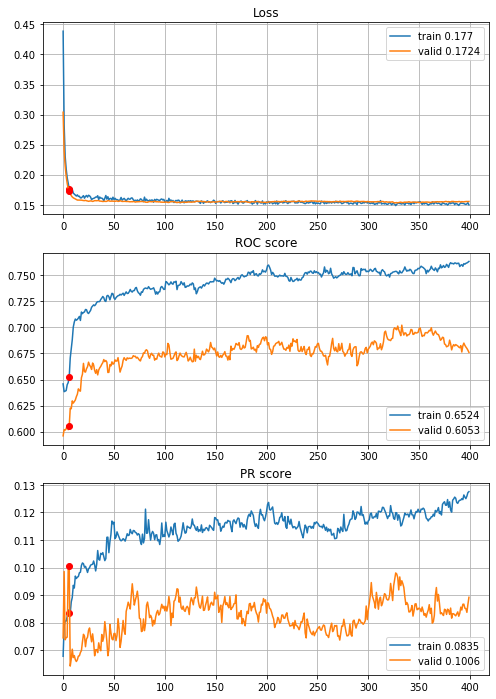


Fold 2------------------------------------------------------------


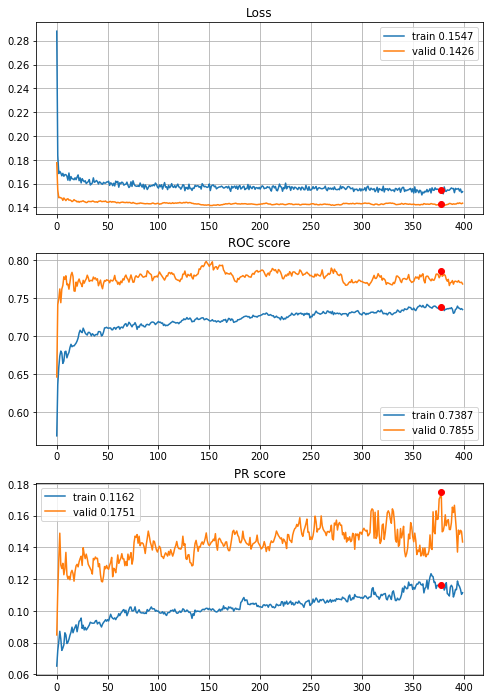


Fold 3------------------------------------------------------------


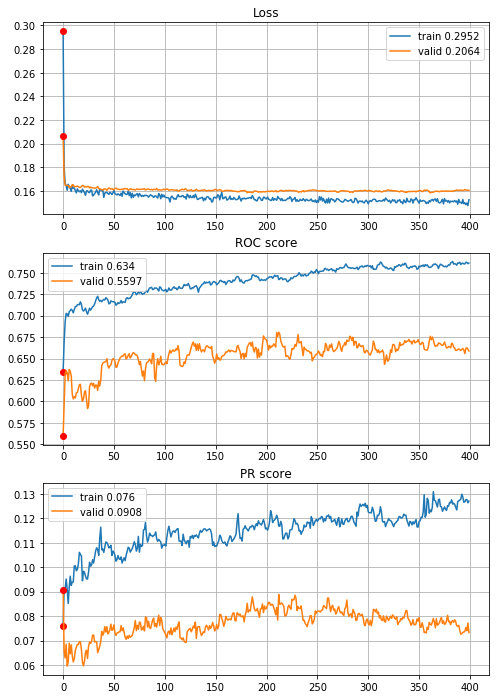


Fold 4------------------------------------------------------------


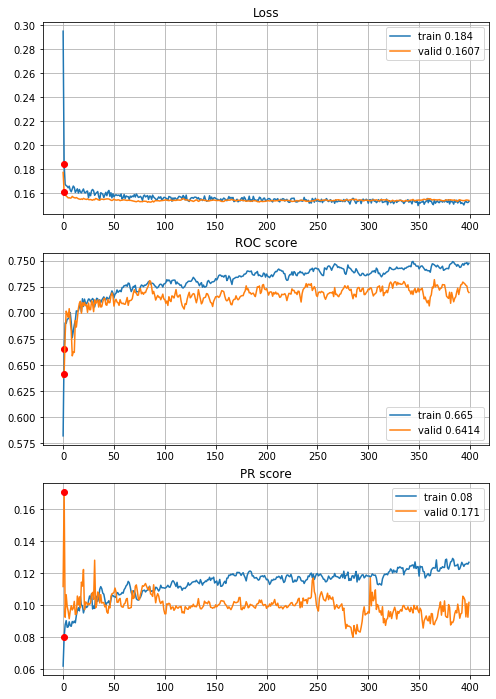


Fold 5------------------------------------------------------------


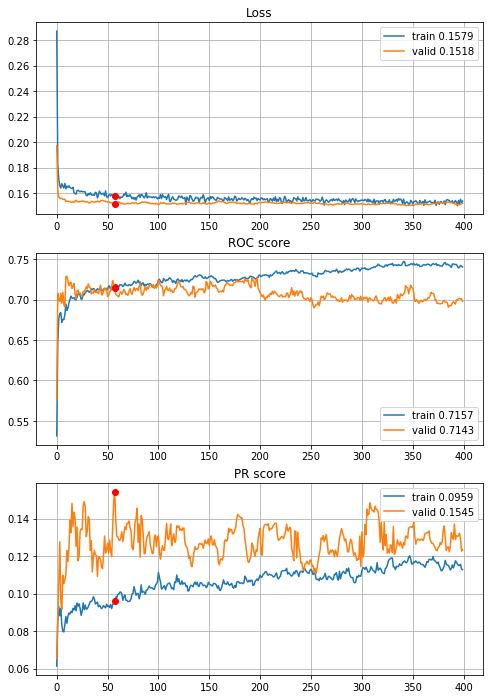


Fold 6------------------------------------------------------------


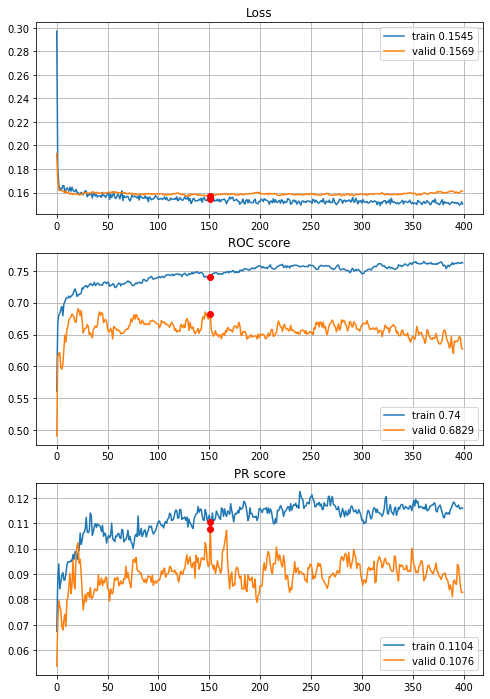

In [66]:
# raw data
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=False, q=None, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Bad curves and bad results.


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 2.71s train loss: 0.48849364639007165, validation loss: 0.3677436875663627
Epoch: 2/400,
cumulative time: 2.81s train loss: 0.35730342593545933, validation loss: 0.26444429543710524
Epoch: 3/400,
cumulative time: 2.91s train loss: 0.26498156260607136, validation loss: 0.20807055704847008
Epoch: 4/400,
cumulative time: 3.01s train loss: 0.2209295783821048, validation loss: 0.18106624124964002
Epoch: 5/400,
cumulative time: 3.11s train loss: 0.19377333998567012, validation loss: 0.17020006958515413
Epoch: 6/400,
cumulative time: 3.21s train loss: 0.18562217924807511, validation loss: 0.16595088375248085
Epoch: 7/400,
cumulative time: 3.31s train loss: 0.1779344765070041, validation loss: 0.16392758324657491
Epoch: 8/400,
cumulative time: 3.42s train loss: 0.17184409289081817, validation loss: 0.16268291713164473
Epoch: 9/400,
cumulative time: 3.52s train loss: 0.17571038641106246

cumulative time: 10.54s train loss: 0.15587923609893733, validation loss: 0.15809010544639837
Epoch: 78/400,
cumulative time: 10.63s train loss: 0.15325946073547939, validation loss: 0.15778440574936894
Epoch: 79/400,
cumulative time: 10.73s train loss: 0.15027199537975738, validation loss: 0.15776113146453022
Epoch: 80/400,
cumulative time: 10.83s train loss: 0.15079472072040787, validation loss: 0.15767081261416313
Epoch: 81/400,
cumulative time: 10.93s train loss: 0.156383845311867, validation loss: 0.15776255267338238
Epoch: 82/400,
cumulative time: 11.03s train loss: 0.1517093903765054, validation loss: 0.15814135796204917
Epoch: 83/400,
cumulative time: 11.13s train loss: 0.15366867395573822, validation loss: 0.15792415874958943
Epoch: 84/400,
cumulative time: 11.24s train loss: 0.15491384620967355, validation loss: 0.15827902714656472
Epoch: 85/400,
cumulative time: 11.33s train loss: 0.15305276803771278, validation loss: 0.15791850316513195
Epoch: 86/400,
cumulative time: 11.43

Epoch: 154/400,
cumulative time: 18.38s train loss: 0.15100213431769124, validation loss: 0.15807852629692323
Epoch: 155/400,
cumulative time: 18.48s train loss: 0.14897483843440576, validation loss: 0.15807575895053386
Epoch: 156/400,
cumulative time: 18.59s train loss: 0.14963343337715465, validation loss: 0.1575744794770029
Epoch: 157/400,
cumulative time: 18.68s train loss: 0.1523760391650209, validation loss: 0.1583157081220589
Epoch: 158/400,
cumulative time: 18.77s train loss: 0.14959998343146955, validation loss: 0.15776803075871387
Epoch: 159/400,
cumulative time: 18.87s train loss: 0.1489612727339399, validation loss: 0.1580536556651063
Epoch: 160/400,
cumulative time: 18.97s train loss: 0.1469117476546561, validation loss: 0.15775014879977228
Epoch: 161/400,
cumulative time: 19.08s train loss: 0.14827846933078495, validation loss: 0.15782809470986958
Epoch: 162/400,
cumulative time: 19.19s train loss: 0.15063858139390512, validation loss: 0.15765919963311426
Epoch: 163/400,


cumulative time: 26.08s train loss: 0.14824532949042274, validation loss: 0.1567967250321124
Epoch: 231/400,
cumulative time: 26.18s train loss: 0.14845287566562756, validation loss: 0.1570735670753403
Epoch: 232/400,
cumulative time: 26.27s train loss: 0.14543707060859146, validation loss: 0.15726958906571373
Epoch: 233/400,
cumulative time: 26.37s train loss: 0.1475441505153446, validation loss: 0.15745442790426384
Epoch: 234/400,
cumulative time: 26.48s train loss: 0.14581019184507954, validation loss: 0.1575935965357967
Epoch: 235/400,
cumulative time: 26.57s train loss: 0.147345285106316, validation loss: 0.1572491982828055
Epoch: 236/400,
cumulative time: 26.67s train loss: 0.14814036291453145, validation loss: 0.1575313295737842
Epoch: 237/400,
cumulative time: 26.77s train loss: 0.14462748901667585, validation loss: 0.15740348511787247
Epoch: 238/400,
cumulative time: 26.87s train loss: 0.14576159319230683, validation loss: 0.1569734912726187
Epoch: 239/400,
cumulative time: 26

Epoch: 307/400,
cumulative time: 33.76s train loss: 0.14140123257261525, validation loss: 0.15561433605835606
Epoch: 308/400,
cumulative time: 33.86s train loss: 0.14313993522971585, validation loss: 0.1558816393650008
Epoch: 309/400,
cumulative time: 33.97s train loss: 0.14228758037203404, validation loss: 0.15614172841724452
Epoch: 310/400,
cumulative time: 34.07s train loss: 0.14085541756883743, validation loss: 0.15529904798719418
Epoch: 311/400,
cumulative time: 34.18s train loss: 0.1436883988003803, validation loss: 0.1558071398644565
Epoch: 312/400,
cumulative time: 34.28s train loss: 0.14372411391201237, validation loss: 0.15670220053399536
Epoch: 313/400,
cumulative time: 34.38s train loss: 0.1427081299461495, validation loss: 0.15580740330680723
Epoch: 314/400,
cumulative time: 34.49s train loss: 0.14212687225054518, validation loss: 0.15577248951854922
Epoch: 315/400,
cumulative time: 34.6s train loss: 0.14144944774527704, validation loss: 0.155453055771863
Epoch: 316/400,
c

Epoch: 383/400,
cumulative time: 41.38s train loss: 0.14173640880514593, validation loss: 0.15703103400102378
Epoch: 384/400,
cumulative time: 41.49s train loss: 0.13841088364144657, validation loss: 0.1567965122028139
Epoch: 385/400,
cumulative time: 41.59s train loss: 0.13997633774717122, validation loss: 0.15621873973895295
Epoch: 386/400,
cumulative time: 41.69s train loss: 0.1391411923253785, validation loss: 0.1566502490351277
Epoch: 387/400,
cumulative time: 41.8s train loss: 0.13983956312714763, validation loss: 0.15696645614318197
Epoch: 388/400,
cumulative time: 41.9s train loss: 0.13819737104695481, validation loss: 0.15680624997027684
Epoch: 389/400,
cumulative time: 42.0s train loss: 0.139417339420296, validation loss: 0.15671929182657934
Epoch: 390/400,
cumulative time: 42.11s train loss: 0.13728072747899187, validation loss: 0.15616331602918582
Epoch: 391/400,
cumulative time: 42.21s train loss: 0.1402555014026233, validation loss: 0.15624424784074925
Epoch: 392/400,
cum

cumulative time: 15.34s train loss: 0.1510041807928393, validation loss: 0.14203827871995814
Epoch: 132/400,
cumulative time: 15.43s train loss: 0.14898257161679712, validation loss: 0.14118496592967741
Epoch: 133/400,
cumulative time: 15.53s train loss: 0.14882360925540977, validation loss: 0.14049239733752988
Epoch: 134/400,
cumulative time: 15.63s train loss: 0.1469023249689949, validation loss: 0.14058233302729858
Epoch: 135/400,
cumulative time: 15.73s train loss: 0.14978373732127997, validation loss: 0.14076138014924594
Epoch: 136/400,
cumulative time: 15.82s train loss: 0.14758742186161328, validation loss: 0.14043115458293928
Epoch: 137/400,
cumulative time: 15.92s train loss: 0.15013593306634188, validation loss: 0.14066993336297529
Epoch: 138/400,
cumulative time: 16.02s train loss: 0.15070406923201324, validation loss: 0.14064192322331995
Epoch: 139/400,
cumulative time: 16.12s train loss: 0.15010034251371415, validation loss: 0.14076652175674403
Epoch: 140/400,
cumulative t

cumulative time: 22.85s train loss: 0.14446645420065868, validation loss: 0.13967650896910247
Epoch: 208/400,
cumulative time: 22.95s train loss: 0.14731471747782018, validation loss: 0.1395357981522124
Epoch: 209/400,
cumulative time: 23.05s train loss: 0.14794948639408234, validation loss: 0.139317425763132
Epoch: 210/400,
cumulative time: 23.14s train loss: 0.14744173300221025, validation loss: 0.1395694125139736
Epoch: 211/400,
cumulative time: 23.24s train loss: 0.146086897999331, validation loss: 0.13934411057597998
Epoch: 212/400,
cumulative time: 23.33s train loss: 0.14488791028564296, validation loss: 0.1390194855559709
Epoch: 213/400,
cumulative time: 23.43s train loss: 0.14742706298997776, validation loss: 0.13963535266877125
Epoch: 214/400,
cumulative time: 23.52s train loss: 0.14709689437042378, validation loss: 0.13893301555961088
Epoch: 215/400,
cumulative time: 23.62s train loss: 0.147218197411672, validation loss: 0.13875954913459648
Epoch: 216/400,
cumulative time: 23

cumulative time: 30.06s train loss: 0.1442313709114263, validation loss: 0.1383226058627894
Epoch: 284/400,
cumulative time: 30.15s train loss: 0.14204272537631826, validation loss: 0.13900865750136365
Epoch: 285/400,
cumulative time: 30.24s train loss: 0.14511196287013095, validation loss: 0.1381275655535638
Epoch: 286/400,
cumulative time: 30.34s train loss: 0.14452563156382636, validation loss: 0.1380748940204081
Epoch: 287/400,
cumulative time: 30.43s train loss: 0.144366112379693, validation loss: 0.13867820081154356
Epoch: 288/400,
cumulative time: 30.53s train loss: 0.14601900858320366, validation loss: 0.13818620987929248
Epoch: 289/400,
cumulative time: 30.62s train loss: 0.14351675098433214, validation loss: 0.13778544433655276
Epoch: 290/400,
cumulative time: 30.71s train loss: 0.14403078044275178, validation loss: 0.13845478232942904
Epoch: 291/400,
cumulative time: 30.81s train loss: 0.14317809257097897, validation loss: 0.1378938492663219
Epoch: 292/400,
cumulative time: 

cumulative time: 37.5s train loss: 0.1405070259601613, validation loss: 0.1382621231805215
Epoch: 360/400,
cumulative time: 37.6s train loss: 0.1408857453989123, validation loss: 0.13805330424539505
Epoch: 361/400,
cumulative time: 37.69s train loss: 0.13937909460327882, validation loss: 0.13787727812888273
Epoch: 362/400,
cumulative time: 37.78s train loss: 0.13953420762432142, validation loss: 0.13742461642232748
Epoch: 363/400,
cumulative time: 37.88s train loss: 0.13930227606923123, validation loss: 0.13777932069446375
Epoch: 364/400,
cumulative time: 37.97s train loss: 0.13766675154330382, validation loss: 0.1379328693282672
Epoch: 365/400,
cumulative time: 38.06s train loss: 0.13990170861217963, validation loss: 0.1376797940574968
Epoch: 366/400,
cumulative time: 38.16s train loss: 0.13963970344308657, validation loss: 0.13788481526062657
Epoch: 367/400,
cumulative time: 38.25s train loss: 0.13785266362738563, validation loss: 0.1379414251961337
Epoch: 368/400,
cumulative time: 3

cumulative time: 6.3s train loss: 0.15149469194364729, validation loss: 0.16442467229868474
Epoch: 34/400,
cumulative time: 6.4s train loss: 0.15419468282804996, validation loss: 0.1643833664495081
Epoch: 35/400,
cumulative time: 6.49s train loss: 0.14797783485513033, validation loss: 0.16511680403515783
Epoch: 36/400,
cumulative time: 6.59s train loss: 0.14936428469600443, validation loss: 0.16517626806612937
Epoch: 37/400,
cumulative time: 6.69s train loss: 0.15135327894558717, validation loss: 0.1652385277754894
Epoch: 38/400,
cumulative time: 6.79s train loss: 0.15063059574851953, validation loss: 0.16563346470216647
Epoch: 39/400,
cumulative time: 6.88s train loss: 0.15208685295179175, validation loss: 0.16501068067957825
Epoch: 40/400,
cumulative time: 6.98s train loss: 0.1512631116092092, validation loss: 0.16489140228483212
Epoch: 41/400,
cumulative time: 7.07s train loss: 0.14876450328209367, validation loss: 0.1643917240499319
Epoch: 42/400,
cumulative time: 7.17s train loss:

cumulative time: 14.0s train loss: 0.1457720084338532, validation loss: 0.16577020160274217
Epoch: 111/400,
cumulative time: 14.1s train loss: 0.14399293927472276, validation loss: 0.16555761239107916
Epoch: 112/400,
cumulative time: 14.19s train loss: 0.1432734138231576, validation loss: 0.16497065847919834
Epoch: 113/400,
cumulative time: 14.29s train loss: 0.14605625645598605, validation loss: 0.16528889847887535
Epoch: 114/400,
cumulative time: 14.39s train loss: 0.14449447394548376, validation loss: 0.16523372400304623
Epoch: 115/400,
cumulative time: 14.49s train loss: 0.14494076862054714, validation loss: 0.1651737728143779
Epoch: 116/400,
cumulative time: 14.58s train loss: 0.14449035643513333, validation loss: 0.16520488250866333
Epoch: 117/400,
cumulative time: 14.68s train loss: 0.14565676012459924, validation loss: 0.1650168467065641
Epoch: 118/400,
cumulative time: 14.78s train loss: 0.14547740382759122, validation loss: 0.16548658423903317
Epoch: 119/400,
cumulative time:

cumulative time: 21.59s train loss: 0.14210217120638383, validation loss: 0.1634812792179933
Epoch: 188/400,
cumulative time: 21.69s train loss: 0.14126544433029145, validation loss: 0.1641815141889583
Epoch: 189/400,
cumulative time: 21.79s train loss: 0.13853278527393287, validation loss: 0.16420120255318266
Epoch: 190/400,
cumulative time: 21.9s train loss: 0.1395281331475817, validation loss: 0.16427906994236036
Epoch: 191/400,
cumulative time: 22.0s train loss: 0.140161002629509, validation loss: 0.16493292537427717
Epoch: 192/400,
cumulative time: 22.11s train loss: 0.14010042132247782, validation loss: 0.16444556098396004
Epoch: 193/400,
cumulative time: 22.21s train loss: 0.14052811048967337, validation loss: 0.16467295787818517
Epoch: 194/400,
cumulative time: 22.32s train loss: 0.1405178411296468, validation loss: 0.16413592975551308
Epoch: 195/400,
cumulative time: 22.43s train loss: 0.139501266845942, validation loss: 0.1634292828742648
Epoch: 196/400,
cumulative time: 22.5

Epoch: 265/400,
cumulative time: 29.25s train loss: 0.13804678454062067, validation loss: 0.1620952680395948
Epoch: 266/400,
cumulative time: 29.35s train loss: 0.1368121491070038, validation loss: 0.16168700468212197
Epoch: 267/400,
cumulative time: 29.45s train loss: 0.13986494331929897, validation loss: 0.16150698045964937
Epoch: 268/400,
cumulative time: 29.55s train loss: 0.13573859127581234, validation loss: 0.1621017418165587
Epoch: 269/400,
cumulative time: 29.66s train loss: 0.13817312611970323, validation loss: 0.16208377942810476
Epoch: 270/400,
cumulative time: 29.76s train loss: 0.14045089363655963, validation loss: 0.16144067098508524
Epoch: 271/400,
cumulative time: 29.86s train loss: 0.13506054030536926, validation loss: 0.16159334701028222
Epoch: 272/400,
cumulative time: 29.96s train loss: 0.13794951271230402, validation loss: 0.16195824960038152
Epoch: 273/400,
cumulative time: 30.07s train loss: 0.1378223322911552, validation loss: 0.16160046306405168
Epoch: 274/400

cumulative time: 36.82s train loss: 0.135946565750541, validation loss: 0.16068261515426907
Epoch: 341/400,
cumulative time: 36.92s train loss: 0.13564836260998725, validation loss: 0.16046249981001162
Epoch: 342/400,
cumulative time: 37.02s train loss: 0.1328820268812623, validation loss: 0.1602122523385388
Epoch: 343/400,
cumulative time: 37.12s train loss: 0.13579652658054, validation loss: 0.1596897748463294
Epoch: 344/400,
cumulative time: 37.21s train loss: 0.13417713680574972, validation loss: 0.1606551752031641
Epoch: 345/400,
cumulative time: 37.3s train loss: 0.13554094555651666, validation loss: 0.1590688636621895
Epoch: 346/400,
cumulative time: 37.4s train loss: 0.13721250288570175, validation loss: 0.15859919693144267
Epoch: 347/400,
cumulative time: 37.5s train loss: 0.13541435334103383, validation loss: 0.15858957472573648
Epoch: 348/400,
cumulative time: 37.6s train loss: 0.1356248867494784, validation loss: 0.15860659501867005
Epoch: 349/400,
cumulative time: 37.71s t

cumulative time: 12.05s train loss: 0.1501813682959021, validation loss: 0.158641581828273
Epoch: 89/400,
cumulative time: 12.15s train loss: 0.14932708350315946, validation loss: 0.15857338435962032
Epoch: 90/400,
cumulative time: 12.25s train loss: 0.14910718517579435, validation loss: 0.1588315644515307
Epoch: 91/400,
cumulative time: 12.36s train loss: 0.14806927463191735, validation loss: 0.15877984964643982
Epoch: 92/400,
cumulative time: 12.46s train loss: 0.14835311524159994, validation loss: 0.15839503849706343
Epoch: 93/400,
cumulative time: 12.56s train loss: 0.14790987740261957, validation loss: 0.15848668309836958
Epoch: 94/400,
cumulative time: 12.66s train loss: 0.15040037244614884, validation loss: 0.15864021162832936
Epoch: 95/400,
cumulative time: 12.77s train loss: 0.1506010243347519, validation loss: 0.15846035990022844
Epoch: 96/400,
cumulative time: 12.87s train loss: 0.14757328426193242, validation loss: 0.15879223270932005
Epoch: 97/400,
cumulative time: 12.97s 

cumulative time: 19.74s train loss: 0.1453632724296436, validation loss: 0.15738664827604673
Epoch: 164/400,
cumulative time: 19.84s train loss: 0.14548056811037732, validation loss: 0.1574169815830759
Epoch: 165/400,
cumulative time: 19.93s train loss: 0.14620966825358556, validation loss: 0.15730863639932882
Epoch: 166/400,
cumulative time: 20.04s train loss: 0.14507979366652654, validation loss: 0.15716239481994732
Epoch: 167/400,
cumulative time: 20.15s train loss: 0.14651847971175608, validation loss: 0.15734829576915763
Epoch: 168/400,
cumulative time: 20.26s train loss: 0.1456933829007384, validation loss: 0.15746118357330843
Epoch: 169/400,
cumulative time: 20.37s train loss: 0.14498778690762493, validation loss: 0.15728022030906388
Epoch: 170/400,
cumulative time: 20.47s train loss: 0.14551109060277523, validation loss: 0.1572005635364232
Epoch: 171/400,
cumulative time: 20.57s train loss: 0.14379808075400866, validation loss: 0.15755789372115706
Epoch: 172/400,
cumulative tim

Epoch: 239/400,
cumulative time: 27.37s train loss: 0.14449882698183494, validation loss: 0.15617439679561124
Epoch: 240/400,
cumulative time: 27.47s train loss: 0.14432929500909186, validation loss: 0.15654163085192838
Epoch: 241/400,
cumulative time: 27.58s train loss: 0.14152821852371408, validation loss: 0.15624018754294067
Epoch: 242/400,
cumulative time: 27.68s train loss: 0.14155279110968677, validation loss: 0.1559284066735454
Epoch: 243/400,
cumulative time: 27.79s train loss: 0.14325151387496057, validation loss: 0.15605306404817715
Epoch: 244/400,
cumulative time: 27.89s train loss: 0.1436200725398887, validation loss: 0.15612805002780747
Epoch: 245/400,
cumulative time: 28.0s train loss: 0.14170976253456138, validation loss: 0.1563097954757752
Epoch: 246/400,
cumulative time: 28.11s train loss: 0.1439674378826903, validation loss: 0.1558267740246467
Epoch: 247/400,
cumulative time: 28.21s train loss: 0.14311735073009071, validation loss: 0.156086170271859
Epoch: 248/400,
cu

Epoch: 317/400,
cumulative time: 35.47s train loss: 0.1387135930232124, validation loss: 0.155331866084059
Epoch: 318/400,
cumulative time: 35.58s train loss: 0.14076743068516367, validation loss: 0.15518620194588034
Epoch: 319/400,
cumulative time: 35.7s train loss: 0.14007754227185384, validation loss: 0.1550886977951712
Epoch: 320/400,
cumulative time: 35.81s train loss: 0.13832779887505228, validation loss: 0.15491741652506805
Epoch: 321/400,
cumulative time: 35.93s train loss: 0.13836231505678545, validation loss: 0.15532891901892096
Epoch: 322/400,
cumulative time: 36.04s train loss: 0.14026284722833976, validation loss: 0.1548648812230217
Epoch: 323/400,
cumulative time: 36.14s train loss: 0.13711345978717424, validation loss: 0.15558368380427134
Epoch: 324/400,
cumulative time: 36.24s train loss: 0.1382500499854504, validation loss: 0.15572983049124875
Epoch: 325/400,
cumulative time: 36.35s train loss: 0.13874692492172885, validation loss: 0.15535821458872626
Epoch: 326/400,
c

cumulative time: 43.37s train loss: 0.13881648652241396, validation loss: 0.15555921991477656
Epoch: 394/400,
cumulative time: 43.46s train loss: 0.13483972666781588, validation loss: 0.15566767853962177
Epoch: 395/400,
cumulative time: 43.56s train loss: 0.1365672740413749, validation loss: 0.1556520792010613
Epoch: 396/400,
cumulative time: 43.66s train loss: 0.13613341969545698, validation loss: 0.155386412251154
Epoch: 397/400,
cumulative time: 43.75s train loss: 0.13722003271672487, validation loss: 0.15542838624917127
Epoch: 398/400,
cumulative time: 43.85s train loss: 0.13612306375318053, validation loss: 0.15564706545513993
Epoch: 399/400,
cumulative time: 43.94s train loss: 0.13633558302269488, validation loss: 0.15511870610419895
Epoch: 400/400,
cumulative time: 44.04s train loss: 0.13524893698135862, validation loss: 0.15596418221263778

Early stopping results:
best results in epoch: 398, 
best valid PR: 0.12207083024224355, 
valid ROC: 0.7203910143741121        
overfitting

cumulative time: 9.67s train loss: 0.15329496903200077, validation loss: 0.15158661617499827
Epoch: 68/400,
cumulative time: 9.76s train loss: 0.150649775717358, validation loss: 0.15154270754254068
Epoch: 69/400,
cumulative time: 9.85s train loss: 0.15188922206862376, validation loss: 0.1514530434950027
Epoch: 70/400,
cumulative time: 9.94s train loss: 0.15130092652913968, validation loss: 0.1515992774965641
Epoch: 71/400,
cumulative time: 10.03s train loss: 0.15232692612812235, validation loss: 0.151516431309919
Epoch: 72/400,
cumulative time: 10.13s train loss: 0.15091001369355977, validation loss: 0.1514629730689684
Epoch: 73/400,
cumulative time: 10.22s train loss: 0.1506725004490684, validation loss: 0.151403488481746
Epoch: 74/400,
cumulative time: 10.31s train loss: 0.1509029814708391, validation loss: 0.15140426328557718
Epoch: 75/400,
cumulative time: 10.4s train loss: 0.14875839849124597, validation loss: 0.15159230301796373
Epoch: 76/400,
cumulative time: 10.49s train loss:

cumulative time: 16.78s train loss: 0.14724534317087629, validation loss: 0.1497608403157464
Epoch: 144/400,
cumulative time: 16.87s train loss: 0.14590709520754824, validation loss: 0.14967822745809972
Epoch: 145/400,
cumulative time: 16.96s train loss: 0.15274306552403338, validation loss: 0.14980362471638414
Epoch: 146/400,
cumulative time: 17.05s train loss: 0.14721290227414535, validation loss: 0.14972931157931885
Epoch: 147/400,
cumulative time: 17.14s train loss: 0.14558985210686526, validation loss: 0.14982952426348511
Epoch: 148/400,
cumulative time: 17.23s train loss: 0.14699903121200414, validation loss: 0.14970766333067892
Epoch: 149/400,
cumulative time: 17.33s train loss: 0.14702264035449308, validation loss: 0.1497917595466129
Epoch: 150/400,
cumulative time: 17.42s train loss: 0.1489222627182613, validation loss: 0.14970114123097408
Epoch: 151/400,
cumulative time: 17.51s train loss: 0.1476013033253192, validation loss: 0.14989396361404397
Epoch: 152/400,
cumulative tim

cumulative time: 24.03s train loss: 0.14382931990460607, validation loss: 0.1474316899984566
Epoch: 220/400,
cumulative time: 24.13s train loss: 0.14282401335024517, validation loss: 0.1472838889432813
Epoch: 221/400,
cumulative time: 24.23s train loss: 0.14260443892096658, validation loss: 0.14737134645966923
Epoch: 222/400,
cumulative time: 24.33s train loss: 0.14404587398444, validation loss: 0.14718061688389678
Epoch: 223/400,
cumulative time: 24.43s train loss: 0.14173209828941374, validation loss: 0.14733661224878264
Epoch: 224/400,
cumulative time: 24.53s train loss: 0.14372107527118028, validation loss: 0.14762992155959076
Epoch: 225/400,
cumulative time: 24.63s train loss: 0.1468453735056593, validation loss: 0.1476332809655897
Epoch: 226/400,
cumulative time: 24.73s train loss: 0.1455940619111061, validation loss: 0.14735199856011647
Epoch: 227/400,
cumulative time: 24.83s train loss: 0.1440243166017804, validation loss: 0.14761825361107062
Epoch: 228/400,
cumulative time: 24

cumulative time: 31.27s train loss: 0.13854639188048962, validation loss: 0.14662344886636824
Epoch: 295/400,
cumulative time: 31.37s train loss: 0.14043173320605587, validation loss: 0.14649234087236465
Epoch: 296/400,
cumulative time: 31.47s train loss: 0.1372268750782936, validation loss: 0.14622012281214264
Epoch: 297/400,
cumulative time: 31.56s train loss: 0.13853373562871166, validation loss: 0.1466459898557337
Epoch: 298/400,
cumulative time: 31.65s train loss: 0.14073900155708957, validation loss: 0.14627687799862713
Epoch: 299/400,
cumulative time: 31.76s train loss: 0.14266915180821121, validation loss: 0.1467011617302216
Epoch: 300/400,
cumulative time: 31.85s train loss: 0.13880039739088496, validation loss: 0.14674016553378422
Epoch: 301/400,
cumulative time: 31.95s train loss: 0.13883100150884667, validation loss: 0.14656433918331335
Epoch: 302/400,
cumulative time: 32.05s train loss: 0.1417579968072884, validation loss: 0.14662439422770288
Epoch: 303/400,
cumulative tim

Epoch: 370/400,
cumulative time: 38.48s train loss: 0.13401429411695398, validation loss: 0.14574159608280862
Epoch: 371/400,
cumulative time: 38.57s train loss: 0.13708280773667275, validation loss: 0.14573105064130598
Epoch: 372/400,
cumulative time: 38.67s train loss: 0.13693645983595096, validation loss: 0.14579484771505932
Epoch: 373/400,
cumulative time: 38.77s train loss: 0.13693979534354112, validation loss: 0.14539244174391766
Epoch: 374/400,
cumulative time: 38.86s train loss: 0.1347292587217615, validation loss: 0.14627045002788927
Epoch: 375/400,
cumulative time: 38.96s train loss: 0.135448072460503, validation loss: 0.1464312996368933
Epoch: 376/400,
cumulative time: 39.06s train loss: 0.1351003782996869, validation loss: 0.14626631135053833
Epoch: 377/400,
cumulative time: 39.15s train loss: 0.13478048707321427, validation loss: 0.1462391357607362
Epoch: 378/400,
cumulative time: 39.24s train loss: 0.1371159075446554, validation loss: 0.14578762622214358
Epoch: 379/400,
c

Epoch: 45/400,
cumulative time: 7.89s train loss: 0.14913452580090492, validation loss: 0.1523902938900908
Epoch: 46/400,
cumulative time: 7.99s train loss: 0.1520718460658696, validation loss: 0.15212426746027294
Epoch: 47/400,
cumulative time: 8.1s train loss: 0.150455885079373, validation loss: 0.1521621694544461
Epoch: 48/400,
cumulative time: 8.2s train loss: 0.14806413709891136, validation loss: 0.1524307131201764
Epoch: 49/400,
cumulative time: 8.32s train loss: 0.14789933350212886, validation loss: 0.15239659462131178
Epoch: 50/400,
cumulative time: 8.44s train loss: 0.14958855590625778, validation loss: 0.1524629527861977
Epoch: 51/400,
cumulative time: 8.53s train loss: 0.1513722590041794, validation loss: 0.15210758908819655
Epoch: 52/400,
cumulative time: 8.62s train loss: 0.15084396442380757, validation loss: 0.1521334217214494
Epoch: 53/400,
cumulative time: 8.73s train loss: 0.14926788333018773, validation loss: 0.15238558091011173
Epoch: 54/400,
cumulative time: 8.83s t

Epoch: 121/400,
cumulative time: 15.89s train loss: 0.14474178335189367, validation loss: 0.15338641030455902
Epoch: 122/400,
cumulative time: 15.99s train loss: 0.14631754106769526, validation loss: 0.15345742563368925
Epoch: 123/400,
cumulative time: 16.1s train loss: 0.14293884848168498, validation loss: 0.15353263076218074
Epoch: 124/400,
cumulative time: 16.2s train loss: 0.142620035228399, validation loss: 0.15351533478362736
Epoch: 125/400,
cumulative time: 16.33s train loss: 0.1427956551172023, validation loss: 0.15381210163037737
Epoch: 126/400,
cumulative time: 16.45s train loss: 0.14205846166983954, validation loss: 0.15399564367204735
Epoch: 127/400,
cumulative time: 16.56s train loss: 0.14471247340119542, validation loss: 0.15380648850150533
Epoch: 128/400,
cumulative time: 16.68s train loss: 0.14440080450257495, validation loss: 0.15331012065711463
Epoch: 129/400,
cumulative time: 16.81s train loss: 0.14344589891763973, validation loss: 0.1535719153126684
Epoch: 130/400,


cumulative time: 23.88s train loss: 0.13844422316867894, validation loss: 0.15504920850216325
Epoch: 198/400,
cumulative time: 23.98s train loss: 0.13760904179465386, validation loss: 0.15512232714291993
Epoch: 199/400,
cumulative time: 24.08s train loss: 0.13803016487685735, validation loss: 0.15526338242545754
Epoch: 200/400,
cumulative time: 24.18s train loss: 0.13880750436258044, validation loss: 0.1557094025402639
Epoch: 201/400,
cumulative time: 24.28s train loss: 0.13619347934026194, validation loss: 0.15533729457425438
Epoch: 202/400,
cumulative time: 24.38s train loss: 0.13951557332356468, validation loss: 0.15564364576588546
Epoch: 203/400,
cumulative time: 24.48s train loss: 0.13793708089689602, validation loss: 0.15567431157804756
Epoch: 204/400,
cumulative time: 24.59s train loss: 0.14096180656377008, validation loss: 0.15582245885194818
Epoch: 205/400,
cumulative time: 24.69s train loss: 0.1401671111979566, validation loss: 0.15561201820676648
Epoch: 206/400,
cumulative t

cumulative time: 31.59s train loss: 0.13438768835572182, validation loss: 0.15669866625848713
Epoch: 274/400,
cumulative time: 31.69s train loss: 0.13578377262295085, validation loss: 0.1560229405873867
Epoch: 275/400,
cumulative time: 31.79s train loss: 0.13414540261426053, validation loss: 0.15692401492165886
Epoch: 276/400,
cumulative time: 31.89s train loss: 0.13453084639285953, validation loss: 0.15709713881789394
Epoch: 277/400,
cumulative time: 31.98s train loss: 0.1350387532638644, validation loss: 0.15611060356731885
Epoch: 278/400,
cumulative time: 32.08s train loss: 0.13445276479171395, validation loss: 0.15671209429710595
Epoch: 279/400,
cumulative time: 32.18s train loss: 0.13506000842156854, validation loss: 0.1568917693602066
Epoch: 280/400,
cumulative time: 32.28s train loss: 0.13324173516408316, validation loss: 0.15589418867337862
Epoch: 281/400,
cumulative time: 32.37s train loss: 0.136813410135442, validation loss: 0.15596947153107718
Epoch: 282/400,
cumulative time

cumulative time: 39.05s train loss: 0.13165221629095258, validation loss: 0.15804371608163192
Epoch: 350/400,
cumulative time: 39.15s train loss: 0.13165251727461588, validation loss: 0.15818706584610115
Epoch: 351/400,
cumulative time: 39.25s train loss: 0.13081823335907491, validation loss: 0.15858025026049966
Epoch: 352/400,
cumulative time: 39.36s train loss: 0.1301652671348664, validation loss: 0.1578811118679662
Epoch: 353/400,
cumulative time: 39.46s train loss: 0.12966574641683296, validation loss: 0.15855207801769988
Epoch: 354/400,
cumulative time: 39.56s train loss: 0.13012874720218737, validation loss: 0.1581319022563196
Epoch: 355/400,
cumulative time: 39.66s train loss: 0.1296018723659995, validation loss: 0.15758073745574624
Epoch: 356/400,
cumulative time: 39.77s train loss: 0.13221640285719505, validation loss: 0.1575639244783988
Epoch: 357/400,
cumulative time: 39.87s train loss: 0.1316474376073146, validation loss: 0.15809642352460684
Epoch: 358/400,
cumulative time:

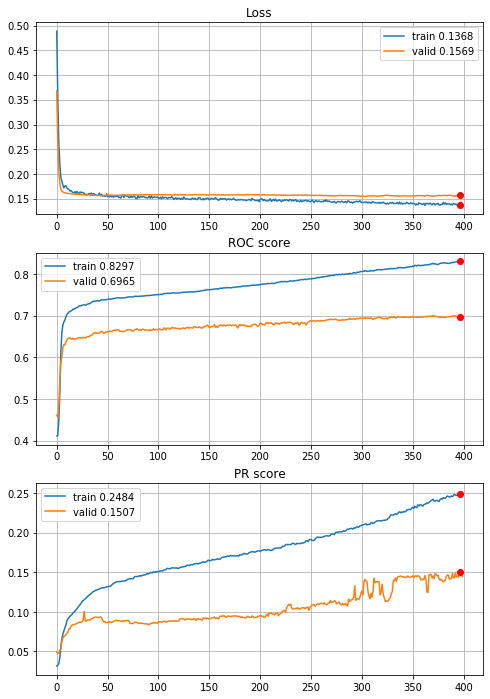


Fold 2------------------------------------------------------------


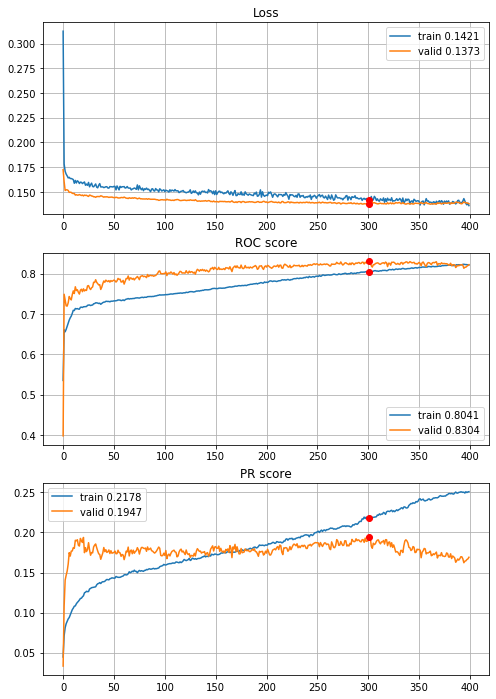


Fold 3------------------------------------------------------------


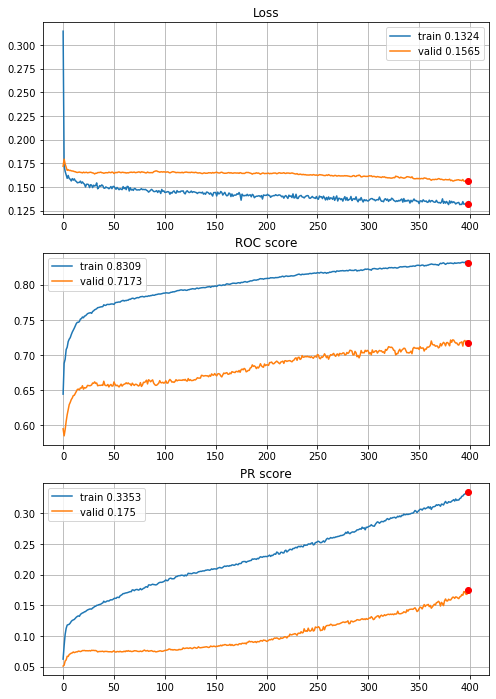


Fold 4------------------------------------------------------------


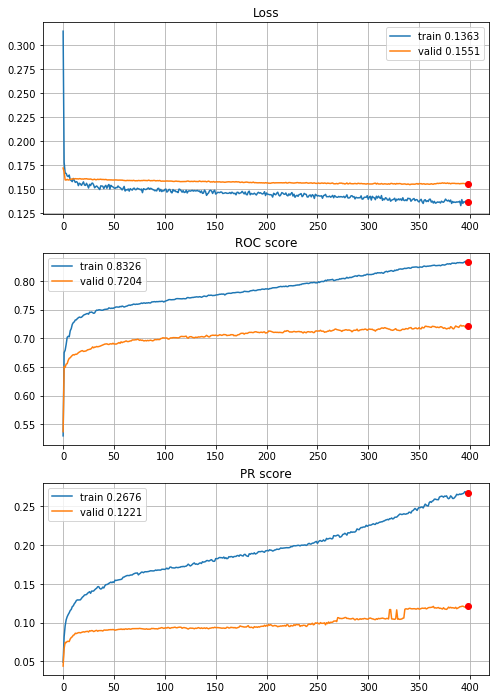


Fold 5------------------------------------------------------------


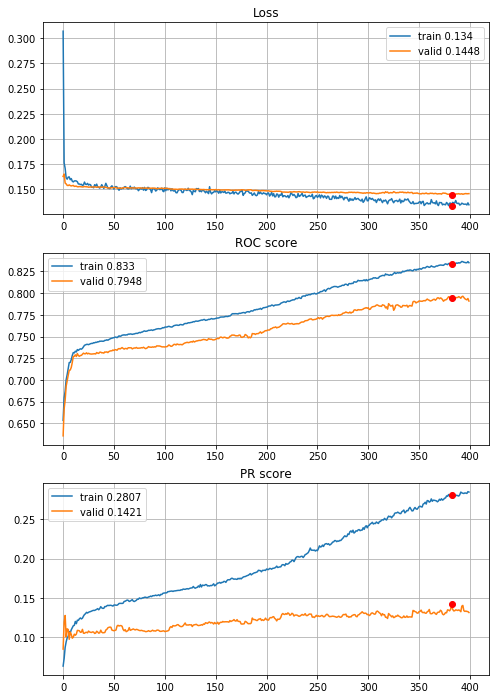


Fold 6------------------------------------------------------------


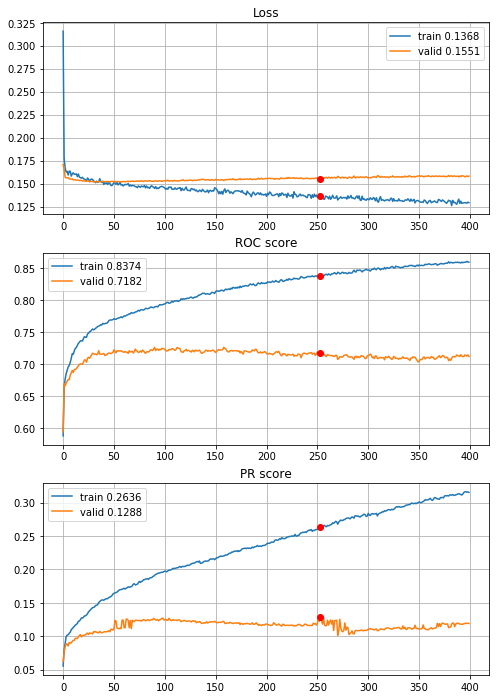

In [67]:
# normalization
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=True, q=None, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

\+ 0.02 on PR, smoother learning curves


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 3.67s train loss: 0.48981787875662264, validation loss: 0.36305361680785436
Epoch: 2/400,
cumulative time: 3.78s train loss: 0.36007254552343537, validation loss: 0.26657295023467553
Epoch: 3/400,
cumulative time: 3.88s train loss: 0.2746085737925553, validation loss: 0.21389122044338899
Epoch: 4/400,
cumulative time: 3.99s train loss: 0.232157990262902, validation loss: 0.18549046522639057
Epoch: 5/400,
cumulative time: 4.09s train loss: 0.20102382359400647, validation loss: 0.17059807377589947
Epoch: 6/400,
cumulative time: 4.2s train loss: 0.18992594154215856, validation loss: 0.162247763328127
Epoch: 7/400,
cumulative time: 4.29s train loss: 0.17834418193212723, validation loss: 0.15761667498488127
Epoch: 8/400,
cumulative time: 4.39s train loss: 0.16854544926639753, validation loss: 0.15474404886619417
Epoch: 9/400,
cumulative time: 4.49s train loss: 0.17001652094964964, v

cumulative time: 18.96s train loss: 0.11786531040575744, validation loss: 0.16564163690047654
Epoch: 152/400,
cumulative time: 19.07s train loss: 0.11935097048416084, validation loss: 0.16580994260378987
Epoch: 153/400,
cumulative time: 19.18s train loss: 0.12104149611500681, validation loss: 0.1660423686823311
Epoch: 154/400,
cumulative time: 19.28s train loss: 0.1208508988202636, validation loss: 0.1662235355298026
Epoch: 155/400,
cumulative time: 19.4s train loss: 0.1187343212046026, validation loss: 0.1657890441352095
Epoch: 156/400,
cumulative time: 19.49s train loss: 0.1165700081092583, validation loss: 0.16534139283807273
Epoch: 157/400,
cumulative time: 19.6s train loss: 0.12132132127739673, validation loss: 0.16525145242630418
Epoch: 158/400,
cumulative time: 19.69s train loss: 0.11774932989246252, validation loss: 0.16556463980131855
Epoch: 159/400,
cumulative time: 19.79s train loss: 0.1208547926605087, validation loss: 0.16611711166275972
Epoch: 160/400,
cumulative time: 19

cumulative time: 26.42s train loss: 0.1107730021117082, validation loss: 0.1740319492185817
Epoch: 228/400,
cumulative time: 26.54s train loss: 0.11005040601150361, validation loss: 0.173231884865426
Epoch: 229/400,
cumulative time: 26.64s train loss: 0.10834970842389499, validation loss: 0.17355828482014404
Epoch: 230/400,
cumulative time: 26.73s train loss: 0.11284052156746048, validation loss: 0.17321758837469162
Epoch: 231/400,
cumulative time: 26.83s train loss: 0.11543677836882774, validation loss: 0.17246253019379032
Epoch: 232/400,
cumulative time: 26.92s train loss: 0.11368123893776248, validation loss: 0.17306398276586007
Epoch: 233/400,
cumulative time: 27.02s train loss: 0.11016707409038942, validation loss: 0.17431597555837325
Epoch: 234/400,
cumulative time: 27.12s train loss: 0.10981180775041145, validation loss: 0.1735501815856521
Epoch: 235/400,
cumulative time: 27.22s train loss: 0.10930230583027147, validation loss: 0.17416504237525152
Epoch: 236/400,
cumulative time

Epoch: 303/400,
cumulative time: 34.24s train loss: 0.10570529817234181, validation loss: 0.18027877411760912
Epoch: 304/400,
cumulative time: 34.35s train loss: 0.10520853046504551, validation loss: 0.17979570660577554
Epoch: 305/400,
cumulative time: 34.45s train loss: 0.10192338348113608, validation loss: 0.180774228481233
Epoch: 306/400,
cumulative time: 34.56s train loss: 0.10540880267093032, validation loss: 0.18283274894194992
Epoch: 307/400,
cumulative time: 34.66s train loss: 0.10028397244395974, validation loss: 0.18178287767707962
Epoch: 308/400,
cumulative time: 34.77s train loss: 0.10233797567845296, validation loss: 0.18110370469161183
Epoch: 309/400,
cumulative time: 34.87s train loss: 0.10584259934058904, validation loss: 0.18062290840515374
Epoch: 310/400,
cumulative time: 34.97s train loss: 0.10270078641696492, validation loss: 0.17902109745105257
Epoch: 311/400,
cumulative time: 35.08s train loss: 0.10474491354919249, validation loss: 0.17871416174935661
Epoch: 312/4

cumulative time: 9.09s train loss: 0.12926140597242106, validation loss: 0.13436311426832281
Epoch: 52/400,
cumulative time: 9.19s train loss: 0.1291770036238647, validation loss: 0.13459484106675498
Epoch: 53/400,
cumulative time: 9.29s train loss: 0.13001418604287523, validation loss: 0.13494512178639986
Epoch: 54/400,
cumulative time: 9.39s train loss: 0.12900140996619466, validation loss: 0.13261908304080566
Epoch: 55/400,
cumulative time: 9.48s train loss: 0.1300032742533557, validation loss: 0.13449090996322416
Epoch: 56/400,
cumulative time: 9.58s train loss: 0.12493835741643435, validation loss: 0.1325129125641917
Epoch: 57/400,
cumulative time: 9.67s train loss: 0.12846262925207275, validation loss: 0.134934339212851
Epoch: 58/400,
cumulative time: 9.77s train loss: 0.1278879125526553, validation loss: 0.13335807234105393
Epoch: 59/400,
cumulative time: 9.87s train loss: 0.1268356568503425, validation loss: 0.1344546863431044
Epoch: 60/400,
cumulative time: 9.97s train loss: 0

cumulative time: 24.36s train loss: 0.11051611494859663, validation loss: 0.1332389687592662
Epoch: 203/400,
cumulative time: 24.46s train loss: 0.10794167171958728, validation loss: 0.13585402173267597
Epoch: 204/400,
cumulative time: 24.56s train loss: 0.11097123462289742, validation loss: 0.13249077724268132
Epoch: 205/400,
cumulative time: 24.66s train loss: 0.10956371030726061, validation loss: 0.13164715516951778
Epoch: 206/400,
cumulative time: 24.76s train loss: 0.10350212756777624, validation loss: 0.13350195202983534
Epoch: 207/400,
cumulative time: 24.86s train loss: 0.10525988334439963, validation loss: 0.13276094042711964
Epoch: 208/400,
cumulative time: 24.96s train loss: 0.10757214432083904, validation loss: 0.13158725254393167
Epoch: 209/400,
cumulative time: 25.06s train loss: 0.10661948714299266, validation loss: 0.13170796000810456
Epoch: 210/400,
cumulative time: 25.16s train loss: 0.10917235981298352, validation loss: 0.1307650988027312
Epoch: 211/400,
cumulative t

Epoch: 278/400,
cumulative time: 32.01s train loss: 0.10182434678699757, validation loss: 0.1327234867684529
Epoch: 279/400,
cumulative time: 32.12s train loss: 0.10175761545405668, validation loss: 0.1316257193260446
Epoch: 280/400,
cumulative time: 32.22s train loss: 0.103135563491135, validation loss: 0.13278190257200934
Epoch: 281/400,
cumulative time: 32.32s train loss: 0.10440230764293128, validation loss: 0.13376371757581518
Epoch: 282/400,
cumulative time: 32.43s train loss: 0.09863152214568073, validation loss: 0.13412748359186147
Epoch: 283/400,
cumulative time: 32.53s train loss: 0.10168525726734122, validation loss: 0.13183680376076834
Epoch: 284/400,
cumulative time: 32.63s train loss: 0.10439388306645334, validation loss: 0.13420788964974134
Epoch: 285/400,
cumulative time: 32.73s train loss: 0.10373622691382493, validation loss: 0.13122045764773801
Epoch: 286/400,
cumulative time: 32.83s train loss: 0.1021296488294339, validation loss: 0.1325827806170118
Epoch: 287/400,


cumulative time: 39.81s train loss: 0.09424055656400532, validation loss: 0.13339276129708572
Epoch: 355/400,
cumulative time: 39.9s train loss: 0.09381519767828639, validation loss: 0.13499894875333251
Epoch: 356/400,
cumulative time: 40.0s train loss: 0.09897987559805332, validation loss: 0.1354127123782259
Epoch: 357/400,
cumulative time: 40.1s train loss: 0.09984815793794065, validation loss: 0.1362039421948355
Epoch: 358/400,
cumulative time: 40.2s train loss: 0.09416841942201981, validation loss: 0.13577017657444646
Epoch: 359/400,
cumulative time: 40.3s train loss: 0.09604641000901047, validation loss: 0.13261514673083738
Epoch: 360/400,
cumulative time: 40.4s train loss: 0.09272258046031903, validation loss: 0.13486353483270197
Epoch: 361/400,
cumulative time: 40.5s train loss: 0.09702694666566614, validation loss: 0.13461501875174792
Epoch: 362/400,
cumulative time: 40.6s train loss: 0.0932080685159287, validation loss: 0.1322138296047922
Epoch: 363/400,
cumulative time: 40.71

cumulative time: 7.28s train loss: 0.13312888508786286, validation loss: 0.14969798663818407
Epoch: 29/400,
cumulative time: 7.39s train loss: 0.13390662970986267, validation loss: 0.14925492731624582
Epoch: 30/400,
cumulative time: 7.49s train loss: 0.1313602940379103, validation loss: 0.14923404069507823
Epoch: 31/400,
cumulative time: 7.6s train loss: 0.13028122965649364, validation loss: 0.14912300538519077
Epoch: 32/400,
cumulative time: 7.7s train loss: 0.13218467160069738, validation loss: 0.14973713819510118
Epoch: 33/400,
cumulative time: 7.81s train loss: 0.13302345024510173, validation loss: 0.14961027058523566
Epoch: 34/400,
cumulative time: 7.92s train loss: 0.1317619669963332, validation loss: 0.1510025286018509
Epoch: 35/400,
cumulative time: 8.02s train loss: 0.1312502225079844, validation loss: 0.1506779039635604
Epoch: 36/400,
cumulative time: 8.12s train loss: 0.12744156846059115, validation loss: 0.1499655110588336
Epoch: 37/400,
cumulative time: 8.21s train loss: 0

Epoch: 105/400,
cumulative time: 15.3s train loss: 0.11778943509824814, validation loss: 0.15075734635175292
Epoch: 106/400,
cumulative time: 15.4s train loss: 0.11452133821242222, validation loss: 0.1507629109882313
Epoch: 107/400,
cumulative time: 15.5s train loss: 0.12153960052432326, validation loss: 0.151552066107968
Epoch: 108/400,
cumulative time: 15.6s train loss: 0.11728619001169585, validation loss: 0.1507352006672908
Epoch: 109/400,
cumulative time: 15.71s train loss: 0.12077411329780177, validation loss: 0.15172430003447143
Epoch: 110/400,
cumulative time: 15.82s train loss: 0.11765340117903769, validation loss: 0.1523433792664611
Epoch: 111/400,
cumulative time: 15.92s train loss: 0.11888464000464843, validation loss: 0.15014572885502447
Epoch: 112/400,
cumulative time: 16.03s train loss: 0.11652509543542844, validation loss: 0.15030936546185436
Epoch: 113/400,
cumulative time: 16.13s train loss: 0.11887464467330042, validation loss: 0.15034165702746083
Epoch: 114/400,
cum

cumulative time: 23.06s train loss: 0.10665004937370542, validation loss: 0.15438435221023758
Epoch: 181/400,
cumulative time: 23.16s train loss: 0.1104018657268564, validation loss: 0.15517220419939373
Epoch: 182/400,
cumulative time: 23.25s train loss: 0.11242822658913863, validation loss: 0.15408278957885854
Epoch: 183/400,
cumulative time: 23.35s train loss: 0.10954975544897383, validation loss: 0.15442444237065722
Epoch: 184/400,
cumulative time: 23.45s train loss: 0.10974901878403984, validation loss: 0.15434013584193967
Epoch: 185/400,
cumulative time: 23.54s train loss: 0.10661615920474, validation loss: 0.15329121121079917
Epoch: 186/400,
cumulative time: 23.64s train loss: 0.10886912837030766, validation loss: 0.15354158118565123
Epoch: 187/400,
cumulative time: 23.74s train loss: 0.10842412531488987, validation loss: 0.15274821949921252
Epoch: 188/400,
cumulative time: 23.83s train loss: 0.10931987219845321, validation loss: 0.15360075963459613
Epoch: 189/400,
cumulative tim

cumulative time: 30.34s train loss: 0.10205710276367543, validation loss: 0.1576825737585605
Epoch: 256/400,
cumulative time: 30.43s train loss: 0.10169126988588294, validation loss: 0.15679928247571218
Epoch: 257/400,
cumulative time: 30.53s train loss: 0.10836794517750532, validation loss: 0.15586620105511775
Epoch: 258/400,
cumulative time: 30.63s train loss: 0.09887120243183123, validation loss: 0.15596320861826812
Epoch: 259/400,
cumulative time: 30.72s train loss: 0.099423764405712, validation loss: 0.15551253070301982
Epoch: 260/400,
cumulative time: 30.82s train loss: 0.10550277310739885, validation loss: 0.15501065583337642
Epoch: 261/400,
cumulative time: 30.92s train loss: 0.10143006298076043, validation loss: 0.15470740535566885
Epoch: 262/400,
cumulative time: 31.01s train loss: 0.09973636514434778, validation loss: 0.15576494595414095
Epoch: 263/400,
cumulative time: 31.11s train loss: 0.10019914345564833, validation loss: 0.15596956202664908
Epoch: 264/400,
cumulative ti

Epoch: 330/400,
cumulative time: 37.87s train loss: 0.10111607196378528, validation loss: 0.16010998281344516
Epoch: 331/400,
cumulative time: 37.97s train loss: 0.09686321547746206, validation loss: 0.1599381725379819
Epoch: 332/400,
cumulative time: 38.08s train loss: 0.09811523063868227, validation loss: 0.16001410662166535
Epoch: 333/400,
cumulative time: 38.19s train loss: 0.09808675643106113, validation loss: 0.15861713668540034
Epoch: 334/400,
cumulative time: 38.33s train loss: 0.09968432376631298, validation loss: 0.15701186727640526
Epoch: 335/400,
cumulative time: 38.44s train loss: 0.09580343334000749, validation loss: 0.15741914192628137
Epoch: 336/400,
cumulative time: 38.55s train loss: 0.09758428687501904, validation loss: 0.15753783021242387
Epoch: 337/400,
cumulative time: 38.66s train loss: 0.09814089573707707, validation loss: 0.1581895827709837
Epoch: 338/400,
cumulative time: 38.77s train loss: 0.09412366594320457, validation loss: 0.15830898703388743
Epoch: 339/4

Epoch: 3/400,
cumulative time: 5.27s train loss: 0.15844893043249336, validation loss: 0.15855112615301215
Epoch: 4/400,
cumulative time: 5.38s train loss: 0.15537538000257012, validation loss: 0.15690159410294816
Epoch: 5/400,
cumulative time: 5.48s train loss: 0.15216812878507815, validation loss: 0.15595430978335284
Epoch: 6/400,
cumulative time: 5.59s train loss: 0.1502743532071756, validation loss: 0.15335308129862094
Epoch: 7/400,
cumulative time: 5.69s train loss: 0.1524413184434232, validation loss: 0.1521586324503571
Epoch: 8/400,
cumulative time: 5.79s train loss: 0.1444619871124597, validation loss: 0.15120615479333124
Epoch: 9/400,
cumulative time: 5.89s train loss: 0.14674835974735825, validation loss: 0.1512627421367553
Epoch: 10/400,
cumulative time: 6.0s train loss: 0.14458556992392385, validation loss: 0.15081447146592603
Epoch: 11/400,
cumulative time: 6.1s train loss: 0.14768009367319393, validation loss: 0.15168601960169975
Epoch: 12/400,
cumulative time: 6.2s train

cumulative time: 13.55s train loss: 0.11961422620563851, validation loss: 0.1490792241194895
Epoch: 82/400,
cumulative time: 13.65s train loss: 0.12239551762475913, validation loss: 0.14832711735814527
Epoch: 83/400,
cumulative time: 13.76s train loss: 0.12062426763365798, validation loss: 0.14799901539109916
Epoch: 84/400,
cumulative time: 13.87s train loss: 0.12276334353427507, validation loss: 0.1476782309262531
Epoch: 85/400,
cumulative time: 13.98s train loss: 0.12417984024906067, validation loss: 0.14791656736517766
Epoch: 86/400,
cumulative time: 14.09s train loss: 0.12271968794163084, validation loss: 0.1478664813107286
Epoch: 87/400,
cumulative time: 14.19s train loss: 0.12025037061218066, validation loss: 0.14877784984500855
Epoch: 88/400,
cumulative time: 14.3s train loss: 0.1200135147153087, validation loss: 0.14856327528688895
Epoch: 89/400,
cumulative time: 14.41s train loss: 0.12292436026814314, validation loss: 0.1486168456965425
Epoch: 90/400,
cumulative time: 14.52s t

Epoch: 157/400,
cumulative time: 21.82s train loss: 0.11013740870882482, validation loss: 0.15315308252197515
Epoch: 158/400,
cumulative time: 21.93s train loss: 0.10682171329262134, validation loss: 0.1540405474306284
Epoch: 159/400,
cumulative time: 22.04s train loss: 0.11059578823127149, validation loss: 0.1539238171909973
Epoch: 160/400,
cumulative time: 22.15s train loss: 0.10833671424940822, validation loss: 0.1522798402768611
Epoch: 161/400,
cumulative time: 22.26s train loss: 0.10913088243928308, validation loss: 0.15205974225131566
Epoch: 162/400,
cumulative time: 22.37s train loss: 0.10457535543862512, validation loss: 0.15367621823834288
Epoch: 163/400,
cumulative time: 22.48s train loss: 0.1094591718244824, validation loss: 0.15392007216443598
Epoch: 164/400,
cumulative time: 22.59s train loss: 0.10979705023697703, validation loss: 0.1542212721349166
Epoch: 165/400,
cumulative time: 22.71s train loss: 0.11154249305121135, validation loss: 0.15422886532273644
Epoch: 166/400,

Epoch: 233/400,
cumulative time: 30.04s train loss: 0.10618147621288246, validation loss: 0.15877364963236526
Epoch: 234/400,
cumulative time: 30.15s train loss: 0.10207114722402996, validation loss: 0.15927019540001364
Epoch: 235/400,
cumulative time: 30.25s train loss: 0.1029202586616013, validation loss: 0.1595748472089333
Epoch: 236/400,
cumulative time: 30.36s train loss: 0.10180763276806366, validation loss: 0.15973472400114253
Epoch: 237/400,
cumulative time: 30.46s train loss: 0.09914842815451197, validation loss: 0.15966885046330076
Epoch: 238/400,
cumulative time: 30.56s train loss: 0.10325352279522387, validation loss: 0.160413601649554
Epoch: 239/400,
cumulative time: 30.67s train loss: 0.10235193536335875, validation loss: 0.15950688128792584
Epoch: 240/400,
cumulative time: 30.78s train loss: 0.1028303008462944, validation loss: 0.1606574518574257
Epoch: 241/400,
cumulative time: 30.88s train loss: 0.09960473566908086, validation loss: 0.16012575280847313
Epoch: 242/400,


Epoch: 309/400,
cumulative time: 38.26s train loss: 0.09285091864938301, validation loss: 0.16654333503354884
Epoch: 310/400,
cumulative time: 38.37s train loss: 0.09928179960521168, validation loss: 0.1671078511048992
Epoch: 311/400,
cumulative time: 38.48s train loss: 0.09666131762275207, validation loss: 0.16537486121369493
Epoch: 312/400,
cumulative time: 38.61s train loss: 0.09658420830116779, validation loss: 0.1674793430195814
Epoch: 313/400,
cumulative time: 38.75s train loss: 0.0981212693441525, validation loss: 0.16597216501407877
Epoch: 314/400,
cumulative time: 38.86s train loss: 0.08822008223472555, validation loss: 0.16744368488014988
Epoch: 315/400,
cumulative time: 38.97s train loss: 0.09819151643218306, validation loss: 0.167878839842961
Epoch: 316/400,
cumulative time: 39.08s train loss: 0.10021086586550924, validation loss: 0.16700478938657373
Epoch: 317/400,
cumulative time: 39.19s train loss: 0.09538998999394321, validation loss: 0.16627096999754715
Epoch: 318/400,

Epoch: 385/400,
cumulative time: 46.72s train loss: 0.08891185115478523, validation loss: 0.17314646917570248
Epoch: 386/400,
cumulative time: 46.83s train loss: 0.09001851874408957, validation loss: 0.17242019692792837
Epoch: 387/400,
cumulative time: 46.93s train loss: 0.09220064414746394, validation loss: 0.17173904915688387
Epoch: 388/400,
cumulative time: 47.04s train loss: 0.08830456156460338, validation loss: 0.17169753924379766
Epoch: 389/400,
cumulative time: 47.15s train loss: 0.08573295006235139, validation loss: 0.1724556130860743
Epoch: 390/400,
cumulative time: 47.26s train loss: 0.09643383086349752, validation loss: 0.1727856319023038
Epoch: 391/400,
cumulative time: 47.37s train loss: 0.09716240948020168, validation loss: 0.17053312789896183
Epoch: 392/400,
cumulative time: 47.48s train loss: 0.09229629725726778, validation loss: 0.17120053072016425
Epoch: 393/400,
cumulative time: 47.58s train loss: 0.08968873450946084, validation loss: 0.17153790398046687
Epoch: 394/4

Epoch: 59/400,
cumulative time: 12.17s train loss: 0.1287193599218888, validation loss: 0.13528015943813143
Epoch: 60/400,
cumulative time: 12.28s train loss: 0.1276087028732562, validation loss: 0.13518818279823724
Epoch: 61/400,
cumulative time: 12.39s train loss: 0.1279562346538285, validation loss: 0.134675402427534
Epoch: 62/400,
cumulative time: 12.49s train loss: 0.13059330040861125, validation loss: 0.13390244963442804
Epoch: 63/400,
cumulative time: 12.6s train loss: 0.12632175147589966, validation loss: 0.13356088632028515
Epoch: 64/400,
cumulative time: 12.71s train loss: 0.12571660796537346, validation loss: 0.1339433625679767
Epoch: 65/400,
cumulative time: 12.82s train loss: 0.12551924735024939, validation loss: 0.13428287439938966
Epoch: 66/400,
cumulative time: 12.93s train loss: 0.1242227122979327, validation loss: 0.1344442239607308
Epoch: 67/400,
cumulative time: 13.03s train loss: 0.12999637934469407, validation loss: 0.13408548458421027
Epoch: 68/400,
cumulative ti

Epoch: 135/400,
cumulative time: 20.59s train loss: 0.11480284161597094, validation loss: 0.13261819920684625
Epoch: 136/400,
cumulative time: 20.7s train loss: 0.12121512656306858, validation loss: 0.1325751565524025
Epoch: 137/400,
cumulative time: 20.81s train loss: 0.11775833425700552, validation loss: 0.13205596863997277
Epoch: 138/400,
cumulative time: 20.92s train loss: 0.11384174343926631, validation loss: 0.13261818306156534
Epoch: 139/400,
cumulative time: 21.03s train loss: 0.1131794992247614, validation loss: 0.13207262652648694
Epoch: 140/400,
cumulative time: 21.14s train loss: 0.11768602182844784, validation loss: 0.13145799198288619
Epoch: 141/400,
cumulative time: 21.26s train loss: 0.11541209969054589, validation loss: 0.13120112045044238
Epoch: 142/400,
cumulative time: 21.37s train loss: 0.11715256796276773, validation loss: 0.13167616883310465
Epoch: 143/400,
cumulative time: 21.48s train loss: 0.11894552187403873, validation loss: 0.13077736336320808
Epoch: 144/40

Epoch: 211/400,
cumulative time: 29.02s train loss: 0.11236728531585925, validation loss: 0.12907958828068322
Epoch: 212/400,
cumulative time: 29.12s train loss: 0.1060434362750352, validation loss: 0.12927837833846995
Epoch: 213/400,
cumulative time: 29.23s train loss: 0.1060888296371393, validation loss: 0.1295578305590085
Epoch: 214/400,
cumulative time: 29.34s train loss: 0.10746634996989195, validation loss: 0.1284816745647443
Epoch: 215/400,
cumulative time: 29.45s train loss: 0.1088985829131653, validation loss: 0.12890043553579916
Epoch: 216/400,
cumulative time: 29.56s train loss: 0.10776437625034484, validation loss: 0.12948982001934378
Epoch: 217/400,
cumulative time: 29.67s train loss: 0.10753666431390357, validation loss: 0.129163936303621
Epoch: 218/400,
cumulative time: 29.78s train loss: 0.10559195637476738, validation loss: 0.12851583226751784
Epoch: 219/400,
cumulative time: 29.88s train loss: 0.10827183079334997, validation loss: 0.12815654054425474
Epoch: 220/400,
c

cumulative time: 37.66s train loss: 0.09935079924408806, validation loss: 0.12664490967875866
Epoch: 288/400,
cumulative time: 37.76s train loss: 0.10252644625232614, validation loss: 0.12743419787689222
Epoch: 289/400,
cumulative time: 37.86s train loss: 0.10062718576057134, validation loss: 0.12795325331884724
Epoch: 290/400,
cumulative time: 37.96s train loss: 0.10336324258422942, validation loss: 0.12857820496556882
Epoch: 291/400,
cumulative time: 38.09s train loss: 0.10715773450016297, validation loss: 0.1273906229936873
Epoch: 292/400,
cumulative time: 38.19s train loss: 0.1018249229840807, validation loss: 0.12775080146328097
Epoch: 293/400,
cumulative time: 38.32s train loss: 0.1024672390133199, validation loss: 0.12760020929620208
Epoch: 294/400,
cumulative time: 38.43s train loss: 0.10130456534463496, validation loss: 0.12714338231923683
Epoch: 295/400,
cumulative time: 38.54s train loss: 0.10423306590918119, validation loss: 0.12815291992966546
Epoch: 296/400,
cumulative ti

cumulative time: 9.09s train loss: 0.13023623443532034, validation loss: 0.15109453912986975
Epoch: 36/400,
cumulative time: 9.2s train loss: 0.12846230633797184, validation loss: 0.15155058805132726
Epoch: 37/400,
cumulative time: 9.31s train loss: 0.13092169451758803, validation loss: 0.1522646079536181
Epoch: 38/400,
cumulative time: 9.42s train loss: 0.13158271256162726, validation loss: 0.15272666310336602
Epoch: 39/400,
cumulative time: 9.52s train loss: 0.13245246948168898, validation loss: 0.15206248673700518
Epoch: 40/400,
cumulative time: 9.63s train loss: 0.12901867607173703, validation loss: 0.1528383597901243
Epoch: 41/400,
cumulative time: 9.73s train loss: 0.12798547911858876, validation loss: 0.15166458631715468
Epoch: 42/400,
cumulative time: 9.83s train loss: 0.13235068583624188, validation loss: 0.1521904116507047
Epoch: 43/400,
cumulative time: 9.92s train loss: 0.13043875901816693, validation loss: 0.15263228053386116
Epoch: 44/400,
cumulative time: 10.02s train lo

cumulative time: 16.89s train loss: 0.11885253114650553, validation loss: 0.15184160476052105
Epoch: 112/400,
cumulative time: 16.99s train loss: 0.11947507252333513, validation loss: 0.15223636154431772
Epoch: 113/400,
cumulative time: 17.08s train loss: 0.11496107891569554, validation loss: 0.15231937237889762
Epoch: 114/400,
cumulative time: 17.18s train loss: 0.11864233642986197, validation loss: 0.15143652591126242
Epoch: 115/400,
cumulative time: 17.28s train loss: 0.11672037423957683, validation loss: 0.15346772117678084
Epoch: 116/400,
cumulative time: 17.38s train loss: 0.11505174762666565, validation loss: 0.15271305707080088
Epoch: 117/400,
cumulative time: 17.48s train loss: 0.11809427230079893, validation loss: 0.15339758777301724
Epoch: 118/400,
cumulative time: 17.58s train loss: 0.1185647474209543, validation loss: 0.15389390603640954
Epoch: 119/400,
cumulative time: 17.67s train loss: 0.11573442204288106, validation loss: 0.1543678359130302
Epoch: 120/400,
cumulative t

Epoch: 187/400,
cumulative time: 24.5s train loss: 0.10719251208841461, validation loss: 0.15352476089910042
Epoch: 188/400,
cumulative time: 24.61s train loss: 0.11134046033392368, validation loss: 0.15346146841485767
Epoch: 189/400,
cumulative time: 24.72s train loss: 0.10783575638082493, validation loss: 0.15290209755612505
Epoch: 190/400,
cumulative time: 24.82s train loss: 0.10732185099224438, validation loss: 0.1527076488823773
Epoch: 191/400,
cumulative time: 24.93s train loss: 0.10476988361727807, validation loss: 0.1532356168445645
Epoch: 192/400,
cumulative time: 25.03s train loss: 0.11314919186893857, validation loss: 0.1528103913426173
Epoch: 193/400,
cumulative time: 25.14s train loss: 0.1057029036405643, validation loss: 0.15313737611843015
Epoch: 194/400,
cumulative time: 25.24s train loss: 0.10257278145829912, validation loss: 0.15423933106988838
Epoch: 195/400,
cumulative time: 25.35s train loss: 0.10595841926913108, validation loss: 0.15476912706807625
Epoch: 196/400,

cumulative time: 40.33s train loss: 0.09852114038460622, validation loss: 0.15938592451912628
Epoch: 338/400,
cumulative time: 40.43s train loss: 0.10013923108351525, validation loss: 0.1561061168474762
Epoch: 339/400,
cumulative time: 40.53s train loss: 0.09600605392648327, validation loss: 0.15786197088814324
Epoch: 340/400,
cumulative time: 40.64s train loss: 0.098533825268103, validation loss: 0.15731095727639136
Epoch: 341/400,
cumulative time: 40.75s train loss: 0.09718028721196376, validation loss: 0.15923915635193547
Epoch: 342/400,
cumulative time: 40.85s train loss: 0.09787399532729353, validation loss: 0.15783020897823222
Epoch: 343/400,
cumulative time: 40.95s train loss: 0.09443491488638593, validation loss: 0.158579510786841
Epoch: 344/400,
cumulative time: 41.06s train loss: 0.09825594872801761, validation loss: 0.15812176605951628
Epoch: 345/400,
cumulative time: 41.16s train loss: 0.10218327658169636, validation loss: 0.1578647081777312
Epoch: 346/400,
cumulative time:

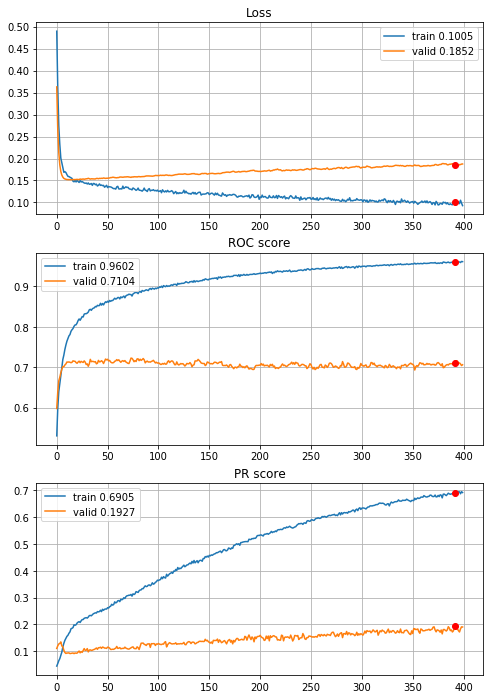


Fold 2------------------------------------------------------------


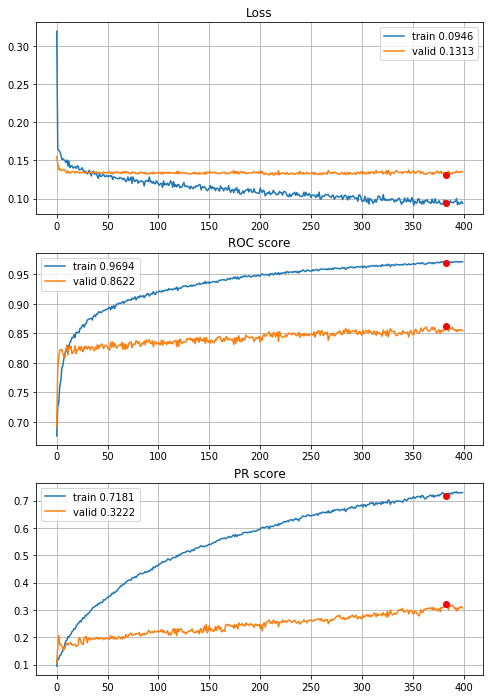


Fold 3------------------------------------------------------------


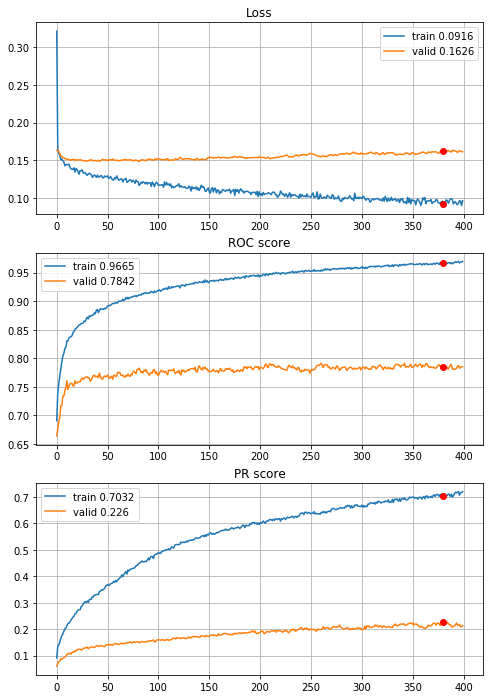


Fold 4------------------------------------------------------------


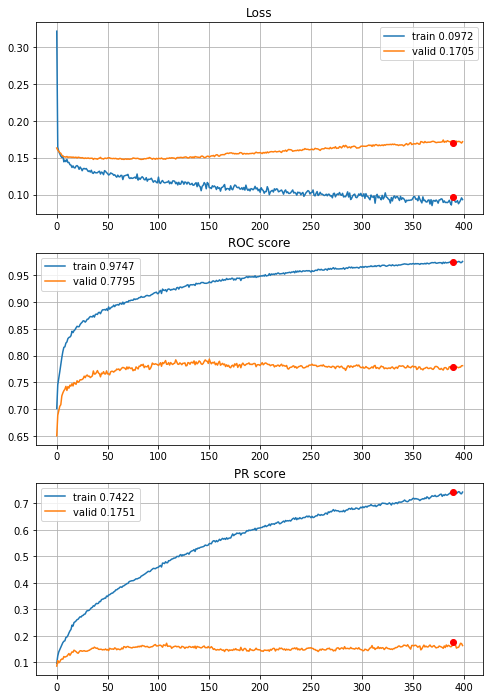


Fold 5------------------------------------------------------------


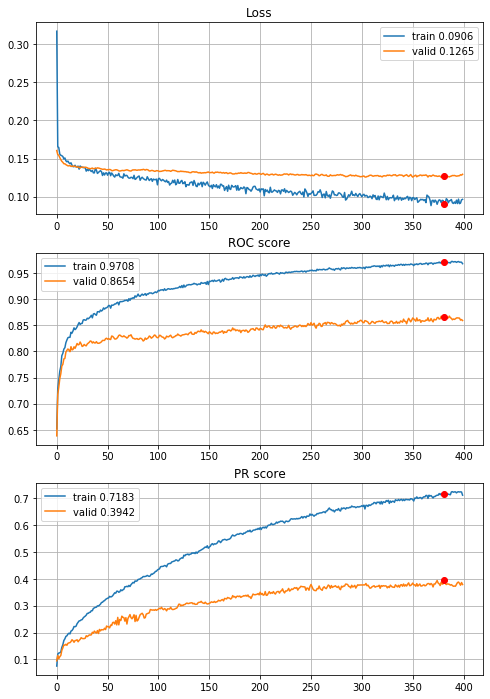


Fold 6------------------------------------------------------------


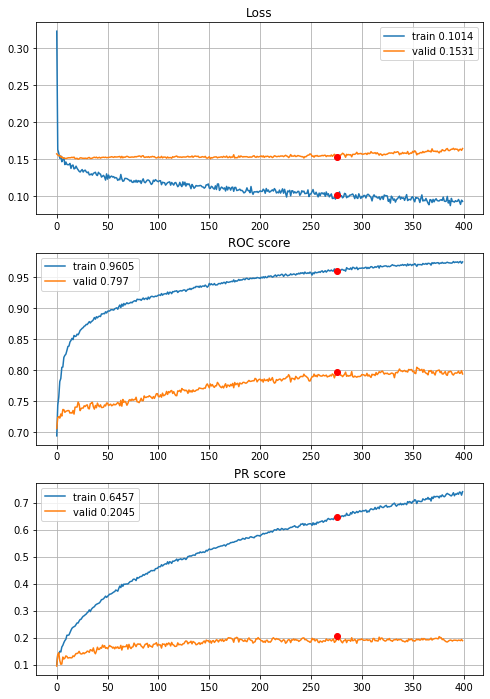

In [68]:
# normalization and quantile outliers reduction (Q_0.005 and Q_0.995)
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=True, q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

\+0.1 on PR compared to normalization only and +0.12 compared to raw data. Lets try power transform


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 5.39s train loss: 0.49938379640371117, validation loss: 0.3779250247089415
Epoch: 2/400,
cumulative time: 5.49s train loss: 0.3761736111577593, validation loss: 0.2826197224844113
Epoch: 3/400,
cumulative time: 5.59s train loss: 0.2862339364962062, validation loss: 0.22766711909246173
Epoch: 4/400,
cumulative time: 5.69s train loss: 0.23810610724241954, validation loss: 0.19633584827241227
Epoch: 5/400,
cumulative time: 5.78s train loss: 0.2062494255955803, validation loss: 0.17877334822852878
Epoch: 6/400,
cumulative time: 5.87s train loss: 0.1925853941879417, validation loss: 0.16823404309193143
Epoch: 7/400,
cumulative time: 5.97s train loss: 0.1769681745620561, validation loss: 0.1624232705336142
Epoch: 8/400,
cumulative time: 6.06s train loss: 0.1679106915754883, validation loss: 0.15846912885187248
Epoch: 9/400,
cumulative time: 6.15s train loss: 0.16845923989615358, vali

cumulative time: 12.58s train loss: 0.1256560094810075, validation loss: 0.15735295892779697
Epoch: 78/400,
cumulative time: 12.68s train loss: 0.12436944797663353, validation loss: 0.15775097372183539
Epoch: 79/400,
cumulative time: 12.77s train loss: 0.12000521170629269, validation loss: 0.1579684613438666
Epoch: 80/400,
cumulative time: 12.86s train loss: 0.12245721725686903, validation loss: 0.15816783916339477
Epoch: 81/400,
cumulative time: 12.96s train loss: 0.12424400196016626, validation loss: 0.1583280482769465
Epoch: 82/400,
cumulative time: 13.05s train loss: 0.1216065776727005, validation loss: 0.15811960481149648
Epoch: 83/400,
cumulative time: 13.14s train loss: 0.12153856028472224, validation loss: 0.15881372111685135
Epoch: 84/400,
cumulative time: 13.24s train loss: 0.12489802008335685, validation loss: 0.1583945098310087
Epoch: 85/400,
cumulative time: 13.33s train loss: 0.12256686347033087, validation loss: 0.15792271509003142
Epoch: 86/400,
cumulative time: 13.43s 

Epoch: 153/400,
cumulative time: 19.99s train loss: 0.1154757101717891, validation loss: 0.15844525419444241
Epoch: 154/400,
cumulative time: 20.08s train loss: 0.11316676379324589, validation loss: 0.15789150580961744
Epoch: 155/400,
cumulative time: 20.18s train loss: 0.11329433786235679, validation loss: 0.15787908977756465
Epoch: 156/400,
cumulative time: 20.27s train loss: 0.10808310702980356, validation loss: 0.1580149327781214
Epoch: 157/400,
cumulative time: 20.37s train loss: 0.11552034940224219, validation loss: 0.15789994207233812
Epoch: 158/400,
cumulative time: 20.47s train loss: 0.11174643561385388, validation loss: 0.15775837815690086
Epoch: 159/400,
cumulative time: 20.57s train loss: 0.11146536381240135, validation loss: 0.15906505679722302
Epoch: 160/400,
cumulative time: 20.67s train loss: 0.11094747495040495, validation loss: 0.15833592208445185
Epoch: 161/400,
cumulative time: 20.76s train loss: 0.11200435333788056, validation loss: 0.15793040620986606
Epoch: 162/4

cumulative time: 27.33s train loss: 0.10319881029214986, validation loss: 0.15877007971565457
Epoch: 229/400,
cumulative time: 27.43s train loss: 0.0997715236792302, validation loss: 0.1597448072521691
Epoch: 230/400,
cumulative time: 27.53s train loss: 0.10043945542803526, validation loss: 0.15828490288366176
Epoch: 231/400,
cumulative time: 27.63s train loss: 0.10428913132741736, validation loss: 0.15878446598093696
Epoch: 232/400,
cumulative time: 27.72s train loss: 0.10143298126149222, validation loss: 0.15905428252251821
Epoch: 233/400,
cumulative time: 27.83s train loss: 0.10033850543752341, validation loss: 0.15972164233676397
Epoch: 234/400,
cumulative time: 27.93s train loss: 0.10300238471216676, validation loss: 0.1585407686018627
Epoch: 235/400,
cumulative time: 28.04s train loss: 0.10471241471889575, validation loss: 0.15869524537725285
Epoch: 236/400,
cumulative time: 28.15s train loss: 0.10167368006604446, validation loss: 0.15876035771175398
Epoch: 237/400,
cumulative ti

cumulative time: 35.24s train loss: 0.09730267648282948, validation loss: 0.16049506971913
Epoch: 305/400,
cumulative time: 35.34s train loss: 0.09541895651387534, validation loss: 0.16007054318626193
Epoch: 306/400,
cumulative time: 35.45s train loss: 0.09737809332232547, validation loss: 0.16108366646282588
Epoch: 307/400,
cumulative time: 35.55s train loss: 0.09471311885333378, validation loss: 0.16086483898040693
Epoch: 308/400,
cumulative time: 35.66s train loss: 0.09452502485187954, validation loss: 0.1605768547282047
Epoch: 309/400,
cumulative time: 35.77s train loss: 0.09491792298867535, validation loss: 0.16061186089235194
Epoch: 310/400,
cumulative time: 35.88s train loss: 0.09854936055711823, validation loss: 0.1593776201048205
Epoch: 311/400,
cumulative time: 35.98s train loss: 0.08905396815212674, validation loss: 0.15967062333390203
Epoch: 312/400,
cumulative time: 36.08s train loss: 0.09353126369883259, validation loss: 0.16018629419057148
Epoch: 313/400,
cumulative time

Epoch: 381/400,
cumulative time: 43.42s train loss: 0.08735301543656292, validation loss: 0.1660373622031999
Epoch: 382/400,
cumulative time: 43.53s train loss: 0.09095584510965185, validation loss: 0.165723842506843
Epoch: 383/400,
cumulative time: 43.64s train loss: 0.0883592324547003, validation loss: 0.16574014833575182
Epoch: 384/400,
cumulative time: 43.74s train loss: 0.0925138254828426, validation loss: 0.1647157781886421
Epoch: 385/400,
cumulative time: 43.84s train loss: 0.08879332584691228, validation loss: 0.16420094352180184
Epoch: 386/400,
cumulative time: 43.95s train loss: 0.09152467118212122, validation loss: 0.1631868504256406
Epoch: 387/400,
cumulative time: 44.06s train loss: 0.08665439252524268, validation loss: 0.16331810392510054
Epoch: 388/400,
cumulative time: 44.16s train loss: 0.09003166722052464, validation loss: 0.16374515279759944
Epoch: 389/400,
cumulative time: 44.26s train loss: 0.08844188279710866, validation loss: 0.16373320379112433
Epoch: 390/400,
c

Epoch: 130/400,
cumulative time: 18.9s train loss: 0.1102362809473016, validation loss: 0.12003869115175286
Epoch: 131/400,
cumulative time: 19.0s train loss: 0.11154517886534587, validation loss: 0.12002393727736863
Epoch: 132/400,
cumulative time: 19.11s train loss: 0.11073647632883893, validation loss: 0.11836566845312065
Epoch: 133/400,
cumulative time: 19.21s train loss: 0.10832536098117847, validation loss: 0.11957757686754332
Epoch: 134/400,
cumulative time: 19.32s train loss: 0.1061040189845286, validation loss: 0.12030914315575666
Epoch: 135/400,
cumulative time: 19.43s train loss: 0.10719472452630581, validation loss: 0.12012989305850451
Epoch: 136/400,
cumulative time: 19.52s train loss: 0.10968547168504128, validation loss: 0.11868926180098947
Epoch: 137/400,
cumulative time: 19.63s train loss: 0.11164968690960411, validation loss: 0.12191616258879089
Epoch: 138/400,
cumulative time: 19.74s train loss: 0.10984852680869302, validation loss: 0.11993510428766598
Epoch: 139/400

Epoch: 206/400,
cumulative time: 26.73s train loss: 0.09961397562183058, validation loss: 0.12418260568120222
Epoch: 207/400,
cumulative time: 26.84s train loss: 0.09272634229804805, validation loss: 0.1236971989274025
Epoch: 208/400,
cumulative time: 26.94s train loss: 0.1025736072116604, validation loss: 0.1232055673336847
Epoch: 209/400,
cumulative time: 27.04s train loss: 0.1003444487953548, validation loss: 0.12298478627227516
Epoch: 210/400,
cumulative time: 27.15s train loss: 0.09980276584681795, validation loss: 0.12557179294173135
Epoch: 211/400,
cumulative time: 27.25s train loss: 0.09965630068781253, validation loss: 0.12306100547144037
Epoch: 212/400,
cumulative time: 27.36s train loss: 0.09776892940561505, validation loss: 0.12039491624714528
Epoch: 213/400,
cumulative time: 27.46s train loss: 0.09824855636374095, validation loss: 0.12389082331528474
Epoch: 214/400,
cumulative time: 27.56s train loss: 0.10231428934540422, validation loss: 0.12100665781654035
Epoch: 215/400

Epoch: 281/400,
cumulative time: 34.41s train loss: 0.09122501195636375, validation loss: 0.12634360918905974
Epoch: 282/400,
cumulative time: 34.52s train loss: 0.09486615866479205, validation loss: 0.1257675516594067
Epoch: 283/400,
cumulative time: 34.62s train loss: 0.0950160218653688, validation loss: 0.12549918853241307
Epoch: 284/400,
cumulative time: 34.72s train loss: 0.09622027324318207, validation loss: 0.1251949870948321
Epoch: 285/400,
cumulative time: 34.84s train loss: 0.09957211337969471, validation loss: 0.1242519670238531
Epoch: 286/400,
cumulative time: 34.94s train loss: 0.09567295832018699, validation loss: 0.12520741982353706
Epoch: 287/400,
cumulative time: 35.04s train loss: 0.09108904236097037, validation loss: 0.12733764266436196
Epoch: 288/400,
cumulative time: 35.14s train loss: 0.09413678987937815, validation loss: 0.1252612749528161
Epoch: 289/400,
cumulative time: 35.25s train loss: 0.09139869098588684, validation loss: 0.12753646963574627
Epoch: 290/400,

cumulative time: 42.1s train loss: 0.09147055046438492, validation loss: 0.1263537186372891
Epoch: 357/400,
cumulative time: 42.21s train loss: 0.09066791291254973, validation loss: 0.12951407264882744
Epoch: 358/400,
cumulative time: 42.32s train loss: 0.08652535868663716, validation loss: 0.12810136210986287
Epoch: 359/400,
cumulative time: 42.42s train loss: 0.08688594325387275, validation loss: 0.12621988476284088
Epoch: 360/400,
cumulative time: 42.51s train loss: 0.09160692311356823, validation loss: 0.12911761149170276
Epoch: 361/400,
cumulative time: 42.62s train loss: 0.08890956679687781, validation loss: 0.12569537293696087
Epoch: 362/400,
cumulative time: 42.72s train loss: 0.08684094291201579, validation loss: 0.12401035980832192
Epoch: 363/400,
cumulative time: 42.83s train loss: 0.08682662635702336, validation loss: 0.12665535233900715
Epoch: 364/400,
cumulative time: 42.93s train loss: 0.09036455445514685, validation loss: 0.12608803568347807
Epoch: 365/400,
cumulative t

Epoch: 106/400,
cumulative time: 17.0s train loss: 0.11255781579571839, validation loss: 0.14115916092153744
Epoch: 107/400,
cumulative time: 17.11s train loss: 0.11344586175917674, validation loss: 0.1422244102978616
Epoch: 108/400,
cumulative time: 17.21s train loss: 0.11156975226282395, validation loss: 0.14063450247332085
Epoch: 109/400,
cumulative time: 17.32s train loss: 0.11565719720760831, validation loss: 0.14172355926805927
Epoch: 110/400,
cumulative time: 17.42s train loss: 0.11235202327229267, validation loss: 0.14208708881653237
Epoch: 111/400,
cumulative time: 17.52s train loss: 0.11101163607338121, validation loss: 0.14099513900517513
Epoch: 112/400,
cumulative time: 17.63s train loss: 0.1102406434163423, validation loss: 0.14115194829297473
Epoch: 113/400,
cumulative time: 17.73s train loss: 0.10987586434188333, validation loss: 0.1414539888925299
Epoch: 114/400,
cumulative time: 17.83s train loss: 0.10995370931994078, validation loss: 0.14142781163811458
Epoch: 115/400

Epoch: 182/400,
cumulative time: 24.89s train loss: 0.10444970314710823, validation loss: 0.14340824245049333
Epoch: 183/400,
cumulative time: 24.99s train loss: 0.10144143306439923, validation loss: 0.14410288868016038
Epoch: 184/400,
cumulative time: 25.09s train loss: 0.10554445805257819, validation loss: 0.14329708155520274
Epoch: 185/400,
cumulative time: 25.2s train loss: 0.10066353090291232, validation loss: 0.1425519073965201
Epoch: 186/400,
cumulative time: 25.3s train loss: 0.10189133153298774, validation loss: 0.1435009909394344
Epoch: 187/400,
cumulative time: 25.4s train loss: 0.10470161622909713, validation loss: 0.14258448110868627
Epoch: 188/400,
cumulative time: 25.5s train loss: 0.10129491483237757, validation loss: 0.1432339048447826
Epoch: 189/400,
cumulative time: 25.61s train loss: 0.10165415971736076, validation loss: 0.14311139473596152
Epoch: 190/400,
cumulative time: 25.71s train loss: 0.1007505809898847, validation loss: 0.14299259240079876
Epoch: 191/400,
cu

Epoch: 258/400,
cumulative time: 32.75s train loss: 0.09468158412958005, validation loss: 0.14816095797341508
Epoch: 259/400,
cumulative time: 32.86s train loss: 0.0906637391043682, validation loss: 0.1467793420013712
Epoch: 260/400,
cumulative time: 32.96s train loss: 0.09575949881430822, validation loss: 0.1454694046015079
Epoch: 261/400,
cumulative time: 33.07s train loss: 0.0943760677380399, validation loss: 0.14560716734948148
Epoch: 262/400,
cumulative time: 33.17s train loss: 0.09847409789657231, validation loss: 0.14682139661269125
Epoch: 263/400,
cumulative time: 33.28s train loss: 0.09088408418240086, validation loss: 0.14679111222218744
Epoch: 264/400,
cumulative time: 33.39s train loss: 0.09467695461589652, validation loss: 0.1460726085124251
Epoch: 265/400,
cumulative time: 33.49s train loss: 0.09603772068385608, validation loss: 0.14541930975339445
Epoch: 266/400,
cumulative time: 33.59s train loss: 0.09044474545703667, validation loss: 0.14489741155442976
Epoch: 267/400,

Epoch: 335/400,
cumulative time: 40.84s train loss: 0.0898497674055751, validation loss: 0.14578128010882824
Epoch: 336/400,
cumulative time: 40.94s train loss: 0.08471331558485411, validation loss: 0.14634774551785196
Epoch: 337/400,
cumulative time: 41.05s train loss: 0.08759636515345022, validation loss: 0.14842313118066913
Epoch: 338/400,
cumulative time: 41.16s train loss: 0.08811748804669453, validation loss: 0.1474488042507045
Epoch: 339/400,
cumulative time: 41.25s train loss: 0.08778616615219406, validation loss: 0.1480665311528338
Epoch: 340/400,
cumulative time: 41.34s train loss: 0.08950378291690599, validation loss: 0.146306256754801
Epoch: 341/400,
cumulative time: 41.44s train loss: 0.09218841409151649, validation loss: 0.14595255192079398
Epoch: 342/400,
cumulative time: 41.55s train loss: 0.087609225486103, validation loss: 0.14509565745121614
Epoch: 343/400,
cumulative time: 41.65s train loss: 0.08981497620128137, validation loss: 0.14465600867142486
Epoch: 344/400,
c

Epoch: 9/400,
cumulative time: 6.67s train loss: 0.1420511154935075, validation loss: 0.14829957315546285
Epoch: 10/400,
cumulative time: 6.77s train loss: 0.14115028278425024, validation loss: 0.1470122061797066
Epoch: 11/400,
cumulative time: 6.88s train loss: 0.14329744455540655, validation loss: 0.1471071623590911
Epoch: 12/400,
cumulative time: 6.98s train loss: 0.13907695685776633, validation loss: 0.1467192805950058
Epoch: 13/400,
cumulative time: 7.11s train loss: 0.13675068092640255, validation loss: 0.14758730285307942
Epoch: 14/400,
cumulative time: 7.21s train loss: 0.1376364538916148, validation loss: 0.1467879352493802
Epoch: 15/400,
cumulative time: 7.31s train loss: 0.13487166106078838, validation loss: 0.14643862360003324
Epoch: 16/400,
cumulative time: 7.42s train loss: 0.132898856654226, validation loss: 0.1467259558204003
Epoch: 17/400,
cumulative time: 7.52s train loss: 0.1351323457381757, validation loss: 0.1463789442797992
Epoch: 18/400,
cumulative time: 7.63s tr

cumulative time: 14.53s train loss: 0.11808615047802735, validation loss: 0.1435966813473819
Epoch: 86/400,
cumulative time: 14.64s train loss: 0.11107554857882422, validation loss: 0.14339832872491634
Epoch: 87/400,
cumulative time: 14.74s train loss: 0.11487170143134227, validation loss: 0.14333029302010275
Epoch: 88/400,
cumulative time: 14.83s train loss: 0.11335771289394296, validation loss: 0.14345395227141353
Epoch: 89/400,
cumulative time: 14.92s train loss: 0.11150953711436415, validation loss: 0.14366054304467207
Epoch: 90/400,
cumulative time: 15.02s train loss: 0.11372495660632566, validation loss: 0.14353024900185768
Epoch: 91/400,
cumulative time: 15.11s train loss: 0.1135599557402238, validation loss: 0.14327386585709265
Epoch: 92/400,
cumulative time: 15.2s train loss: 0.1138359560855652, validation loss: 0.1453290757152342
Epoch: 93/400,
cumulative time: 15.3s train loss: 0.11452803799787102, validation loss: 0.1446200432909734
Epoch: 94/400,
cumulative time: 15.39s tr

cumulative time: 22.26s train loss: 0.10188527154176014, validation loss: 0.14473069541198705
Epoch: 163/400,
cumulative time: 22.38s train loss: 0.10309312379507231, validation loss: 0.14500676782579078
Epoch: 164/400,
cumulative time: 22.49s train loss: 0.10297760006033266, validation loss: 0.14568403240229644
Epoch: 165/400,
cumulative time: 22.59s train loss: 0.10240134355069563, validation loss: 0.1450496979863639
Epoch: 166/400,
cumulative time: 22.69s train loss: 0.10593203222220039, validation loss: 0.14481962124412381
Epoch: 167/400,
cumulative time: 22.78s train loss: 0.10147325426509755, validation loss: 0.14488965279972305
Epoch: 168/400,
cumulative time: 22.88s train loss: 0.10021935737986945, validation loss: 0.1448323570714956
Epoch: 169/400,
cumulative time: 22.98s train loss: 0.10101474988675434, validation loss: 0.1456700810982335
Epoch: 170/400,
cumulative time: 23.08s train loss: 0.09933141867508245, validation loss: 0.14687607650851842
Epoch: 171/400,
cumulative ti

cumulative time: 30.0s train loss: 0.09503923737968846, validation loss: 0.14989303239043342
Epoch: 239/400,
cumulative time: 30.11s train loss: 0.09697648443182687, validation loss: 0.14958022454262232
Epoch: 240/400,
cumulative time: 30.22s train loss: 0.09480885063391709, validation loss: 0.14885729145562626
Epoch: 241/400,
cumulative time: 30.33s train loss: 0.09287188545689411, validation loss: 0.14905372194139963
Epoch: 242/400,
cumulative time: 30.48s train loss: 0.09838040775038033, validation loss: 0.1492152934084581
Epoch: 243/400,
cumulative time: 30.7s train loss: 0.09571613021887683, validation loss: 0.15043124053238466
Epoch: 244/400,
cumulative time: 30.88s train loss: 0.09495660300159817, validation loss: 0.14923984649285418
Epoch: 245/400,
cumulative time: 30.99s train loss: 0.08990935656530129, validation loss: 0.15094871290268436
Epoch: 246/400,
cumulative time: 31.11s train loss: 0.09858789602029482, validation loss: 0.15059370885424642
Epoch: 247/400,
cumulative ti

Epoch: 314/400,
cumulative time: 38.68s train loss: 0.08666664669873365, validation loss: 0.1552041329485868
Epoch: 315/400,
cumulative time: 38.79s train loss: 0.09261977278699911, validation loss: 0.15572321967732522
Epoch: 316/400,
cumulative time: 38.9s train loss: 0.08904257029917027, validation loss: 0.15424862036046766
Epoch: 317/400,
cumulative time: 39.01s train loss: 0.0860422397474184, validation loss: 0.15366744706707616
Epoch: 318/400,
cumulative time: 39.12s train loss: 0.08855848105543027, validation loss: 0.15369099987921725
Epoch: 319/400,
cumulative time: 39.23s train loss: 0.0922915968895524, validation loss: 0.15410507402508264
Epoch: 320/400,
cumulative time: 39.33s train loss: 0.08939138484210397, validation loss: 0.15472003985797206
Epoch: 321/400,
cumulative time: 39.42s train loss: 0.08718054325830552, validation loss: 0.15442816161000977
Epoch: 322/400,
cumulative time: 39.53s train loss: 0.08637838388388479, validation loss: 0.15434144100835245
Epoch: 323/400

cumulative time: 46.73s train loss: 0.08530694199637624, validation loss: 0.16019702571279862
Epoch: 391/400,
cumulative time: 46.84s train loss: 0.0862741434215029, validation loss: 0.15857958106546746
Epoch: 392/400,
cumulative time: 46.95s train loss: 0.08340281993433465, validation loss: 0.1585578532921295
Epoch: 393/400,
cumulative time: 47.04s train loss: 0.08023889374970485, validation loss: 0.1591844744061383
Epoch: 394/400,
cumulative time: 47.14s train loss: 0.08419595920609795, validation loss: 0.1581111697787578
Epoch: 395/400,
cumulative time: 47.25s train loss: 0.08486612964937537, validation loss: 0.1569524020861403
Epoch: 396/400,
cumulative time: 47.34s train loss: 0.07992986397962643, validation loss: 0.15557496204435034
Epoch: 397/400,
cumulative time: 47.44s train loss: 0.08709306928136543, validation loss: 0.15569833100577232
Epoch: 398/400,
cumulative time: 47.55s train loss: 0.08356202571764164, validation loss: 0.156938745793966
Epoch: 399/400,
cumulative time: 

Epoch: 65/400,
cumulative time: 12.48s train loss: 0.11784966123737466, validation loss: 0.1384075547107257
Epoch: 66/400,
cumulative time: 12.58s train loss: 0.11876318743152003, validation loss: 0.13831287513591306
Epoch: 67/400,
cumulative time: 12.69s train loss: 0.1192384488640293, validation loss: 0.1375616470906721
Epoch: 68/400,
cumulative time: 12.79s train loss: 0.11930723497378984, validation loss: 0.13780857633933624
Epoch: 69/400,
cumulative time: 12.9s train loss: 0.11986170635616983, validation loss: 0.13739776983150268
Epoch: 70/400,
cumulative time: 13.0s train loss: 0.11780648276181556, validation loss: 0.13850852003077177
Epoch: 71/400,
cumulative time: 13.11s train loss: 0.11592583045844108, validation loss: 0.13805728510333193
Epoch: 72/400,
cumulative time: 13.21s train loss: 0.11457841455710228, validation loss: 0.13797697918295182
Epoch: 73/400,
cumulative time: 13.32s train loss: 0.11342153001498904, validation loss: 0.13718751905595555
Epoch: 74/400,
cumulativ

cumulative time: 28.01s train loss: 0.09634450450115457, validation loss: 0.1366601684316286
Epoch: 215/400,
cumulative time: 28.11s train loss: 0.09707885688803454, validation loss: 0.13632008296206055
Epoch: 216/400,
cumulative time: 28.21s train loss: 0.10060799869176786, validation loss: 0.13661116835231799
Epoch: 217/400,
cumulative time: 28.31s train loss: 0.10249204548531737, validation loss: 0.13583928138809367
Epoch: 218/400,
cumulative time: 28.41s train loss: 0.09746135705110018, validation loss: 0.13623928692919932
Epoch: 219/400,
cumulative time: 28.51s train loss: 0.1006612721752849, validation loss: 0.13548218883022636
Epoch: 220/400,
cumulative time: 28.6s train loss: 0.09704413574040502, validation loss: 0.13645920120674473
Epoch: 221/400,
cumulative time: 28.71s train loss: 0.09554462270984387, validation loss: 0.1366081464420686
Epoch: 222/400,
cumulative time: 28.83s train loss: 0.09556256092278961, validation loss: 0.13715911563309138
Epoch: 223/400,
cumulative tim

cumulative time: 35.65s train loss: 0.08960491964271897, validation loss: 0.1408624377179417
Epoch: 291/400,
cumulative time: 35.75s train loss: 0.0891030684042814, validation loss: 0.14079610453441427
Epoch: 292/400,
cumulative time: 35.85s train loss: 0.09199206720210569, validation loss: 0.14090943106041914
Epoch: 293/400,
cumulative time: 35.95s train loss: 0.09107775376858702, validation loss: 0.1399986652880059
Epoch: 294/400,
cumulative time: 36.04s train loss: 0.09243145989399029, validation loss: 0.13857200213017
Epoch: 295/400,
cumulative time: 36.13s train loss: 0.09653744465287994, validation loss: 0.13882157422842517
Epoch: 296/400,
cumulative time: 36.24s train loss: 0.08661619572700541, validation loss: 0.1390728394039668
Epoch: 297/400,
cumulative time: 36.35s train loss: 0.0899456041375532, validation loss: 0.13882692091774895
Epoch: 298/400,
cumulative time: 36.45s train loss: 0.0922690991941394, validation loss: 0.13927469470412726
Epoch: 299/400,
cumulative time: 36

Epoch: 367/400,
cumulative time: 43.6s train loss: 0.09289919203412375, validation loss: 0.13926649773652458
Epoch: 368/400,
cumulative time: 43.71s train loss: 0.0860851240183529, validation loss: 0.13854068099208303
Epoch: 369/400,
cumulative time: 43.82s train loss: 0.0879929518351858, validation loss: 0.1383215066547412
Epoch: 370/400,
cumulative time: 43.92s train loss: 0.0864882482353605, validation loss: 0.14019590405574106
Epoch: 371/400,
cumulative time: 44.02s train loss: 0.08381140099757084, validation loss: 0.14170419732974648
Epoch: 372/400,
cumulative time: 44.13s train loss: 0.08804764727544061, validation loss: 0.1419293325698353
Epoch: 373/400,
cumulative time: 44.24s train loss: 0.08455662084513643, validation loss: 0.1410388265801788
Epoch: 374/400,
cumulative time: 44.34s train loss: 0.08427774591876841, validation loss: 0.14145279667239488
Epoch: 375/400,
cumulative time: 44.45s train loss: 0.0876920031542683, validation loss: 0.14156070624458722
Epoch: 376/400,
cu

Epoch: 41/400,
cumulative time: 10.86s train loss: 0.1281147389897133, validation loss: 0.1353397901811455
Epoch: 42/400,
cumulative time: 10.97s train loss: 0.12771262939050934, validation loss: 0.13657728885167916
Epoch: 43/400,
cumulative time: 11.08s train loss: 0.1275163373158824, validation loss: 0.13566216341514967
Epoch: 44/400,
cumulative time: 11.19s train loss: 0.12733028910813793, validation loss: 0.13545278943297534
Epoch: 45/400,
cumulative time: 11.3s train loss: 0.12459624965853663, validation loss: 0.13561122870139877
Epoch: 46/400,
cumulative time: 11.39s train loss: 0.12690408563760924, validation loss: 0.13493347409723833
Epoch: 47/400,
cumulative time: 11.5s train loss: 0.1270858324003853, validation loss: 0.1351928076719197
Epoch: 48/400,
cumulative time: 11.61s train loss: 0.1249334462679767, validation loss: 0.13510261634382395
Epoch: 49/400,
cumulative time: 11.71s train loss: 0.12066977308529378, validation loss: 0.13511229481767206
Epoch: 50/400,
cumulative t

Epoch: 117/400,
cumulative time: 19.09s train loss: 0.11209503027983363, validation loss: 0.13164316335484472
Epoch: 118/400,
cumulative time: 19.2s train loss: 0.11290827601921852, validation loss: 0.13113738607749542
Epoch: 119/400,
cumulative time: 19.31s train loss: 0.11337793790920862, validation loss: 0.13094495706246068
Epoch: 120/400,
cumulative time: 19.42s train loss: 0.10698183737624528, validation loss: 0.13066331292917877
Epoch: 121/400,
cumulative time: 19.53s train loss: 0.11011080774540467, validation loss: 0.13138283700090206
Epoch: 122/400,
cumulative time: 19.63s train loss: 0.11489258435690879, validation loss: 0.13124802626626994
Epoch: 123/400,
cumulative time: 19.73s train loss: 0.11140934204297455, validation loss: 0.13137477661785182
Epoch: 124/400,
cumulative time: 19.84s train loss: 0.11210439033254953, validation loss: 0.13036835152634632
Epoch: 125/400,
cumulative time: 19.95s train loss: 0.11584994107541369, validation loss: 0.13192170010119733
Epoch: 126/

Epoch: 267/400,
cumulative time: 35.27s train loss: 0.09328552117497012, validation loss: 0.13389447646699776
Epoch: 268/400,
cumulative time: 35.37s train loss: 0.09138815499969406, validation loss: 0.13217027855779007
Epoch: 269/400,
cumulative time: 35.49s train loss: 0.09520427895678063, validation loss: 0.1318550837390563
Epoch: 270/400,
cumulative time: 35.59s train loss: 0.09506977493441761, validation loss: 0.13234403791644767
Epoch: 271/400,
cumulative time: 35.69s train loss: 0.09111146070982067, validation loss: 0.13401155163882128
Epoch: 272/400,
cumulative time: 35.8s train loss: 0.09310627577285613, validation loss: 0.13237875519034079
Epoch: 273/400,
cumulative time: 35.92s train loss: 0.08978558836586109, validation loss: 0.13199926850578592
Epoch: 274/400,
cumulative time: 36.03s train loss: 0.09610448406418994, validation loss: 0.1345950155969589
Epoch: 275/400,
cumulative time: 36.14s train loss: 0.09146323651358118, validation loss: 0.13460565629844648
Epoch: 276/40

Epoch: 342/400,
cumulative time: 43.5s train loss: 0.08603798702952983, validation loss: 0.1368893385640358
Epoch: 343/400,
cumulative time: 43.62s train loss: 0.08647948025356433, validation loss: 0.13795744438268653
Epoch: 344/400,
cumulative time: 43.72s train loss: 0.0882590915095874, validation loss: 0.13698411225367768
Epoch: 345/400,
cumulative time: 43.82s train loss: 0.09090674075614343, validation loss: 0.13759516108872993
Epoch: 346/400,
cumulative time: 43.92s train loss: 0.08569486709682719, validation loss: 0.13835546908726953
Epoch: 347/400,
cumulative time: 44.03s train loss: 0.09232960473710718, validation loss: 0.13582046314423632
Epoch: 348/400,
cumulative time: 44.13s train loss: 0.08748616480765126, validation loss: 0.13488140911485935
Epoch: 349/400,
cumulative time: 44.24s train loss: 0.08770318756576281, validation loss: 0.13693330708389265
Epoch: 350/400,
cumulative time: 44.34s train loss: 0.08677120331455679, validation loss: 0.13561239307021733
Epoch: 351/40

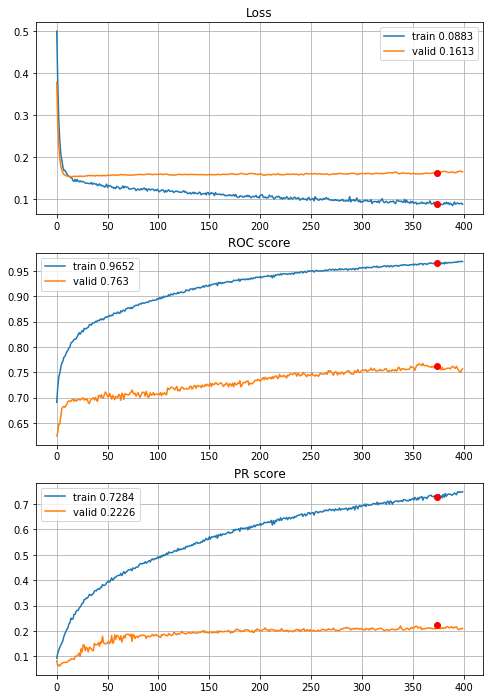


Fold 2------------------------------------------------------------


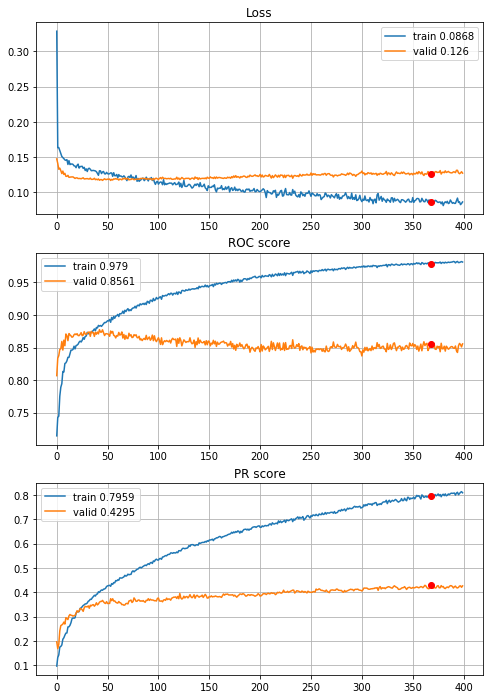


Fold 3------------------------------------------------------------


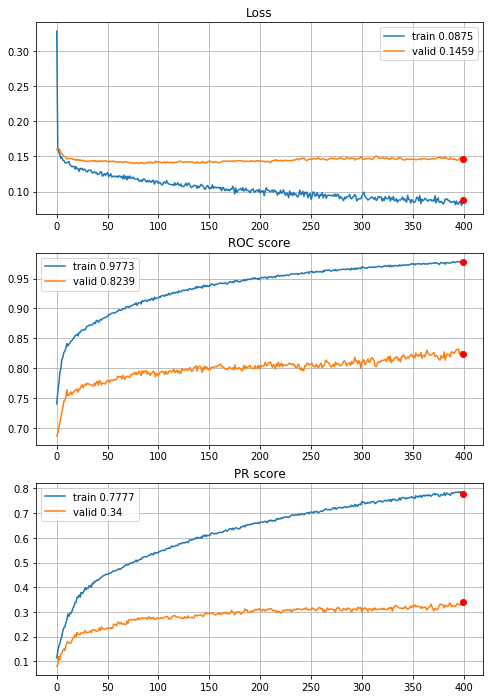


Fold 4------------------------------------------------------------


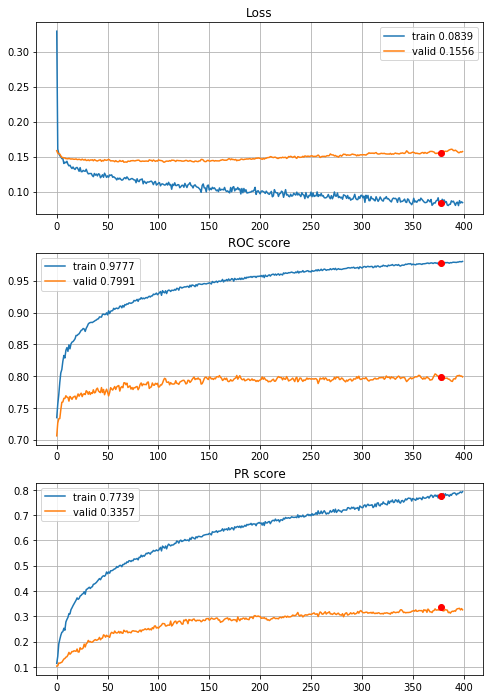


Fold 5------------------------------------------------------------


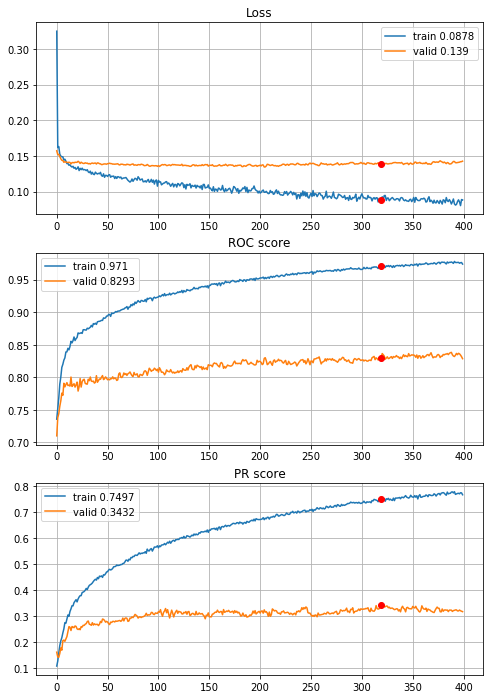


Fold 6------------------------------------------------------------


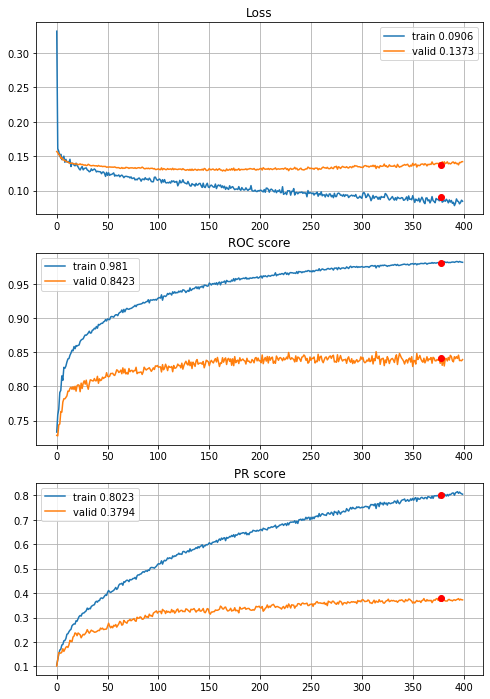

In [69]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

\+ 0.09 compared to the best preprocessing pipeline so far and + 0.21 to the raw data! Further experiments will be performed with this pipeline of course. Lets expermient with the best models for 1-, 2- ,3- and 4-horizon tasks. 

##### The best model for 1- and 2-year horizon


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/8000,
cumulative time: 7.25s train loss: 0.5363056295284511, validation loss: 0.4142493649723408
Epoch: 2/8000,
cumulative time: 7.36s train loss: 0.41287513363972106, validation loss: 0.3204139806966402
Epoch: 3/8000,
cumulative time: 7.46s train loss: 0.324088399233809, validation loss: 0.26595982292797804
Epoch: 4/8000,
cumulative time: 7.56s train loss: 0.2761334767660561, validation loss: 0.2344718127594501
Epoch: 5/8000,
cumulative time: 7.66s train loss: 0.2440324613220099, validation loss: 0.21649316999446283
Epoch: 6/8000,
cumulative time: 7.76s train loss: 0.2298709992496067, validation loss: 0.20548713382552652
Epoch: 7/8000,
cumulative time: 7.86s train loss: 0.2138440747245213, validation loss: 0.19915293736747366
Epoch: 8/8000,
cumulative time: 7.96s train loss: 0.20430395198841023, validation loss: 0.1946404063667699
Epoch: 9/8000,
cumulative time: 8.06s train loss: 0.2044059787405057

cumulative time: 22.33s train loss: 0.14565258854876434, validation loss: 0.17154438457181376
Epoch: 150/8000,
cumulative time: 22.43s train loss: 0.14420019115058022, validation loss: 0.17181501015879397
Epoch: 151/8000,
cumulative time: 22.53s train loss: 0.1420061152817176, validation loss: 0.17197121990812797
Epoch: 152/8000,
cumulative time: 22.63s train loss: 0.14388254381560736, validation loss: 0.17157836784334743
Epoch: 153/8000,
cumulative time: 22.73s train loss: 0.1435802045170451, validation loss: 0.17199428232503344
Epoch: 154/8000,
cumulative time: 22.83s train loss: 0.1442346496560542, validation loss: 0.17164885731983004
Epoch: 155/8000,
cumulative time: 22.93s train loss: 0.1452357773225493, validation loss: 0.17156101429598156
Epoch: 156/8000,
cumulative time: 23.03s train loss: 0.1395797186462205, validation loss: 0.171664291840803
Epoch: 157/8000,
cumulative time: 23.15s train loss: 0.14584083414055138, validation loss: 0.17204454538378816
Epoch: 158/8000,
cumulati

Epoch: 224/8000,
cumulative time: 30.26s train loss: 0.13837665502667654, validation loss: 0.16915799852679758
Epoch: 225/8000,
cumulative time: 30.35s train loss: 0.13722566976379852, validation loss: 0.16924161714213623
Epoch: 226/8000,
cumulative time: 30.46s train loss: 0.13738061386448608, validation loss: 0.16966424415867062
Epoch: 227/8000,
cumulative time: 30.57s train loss: 0.13948746471748857, validation loss: 0.17085530056107429
Epoch: 228/8000,
cumulative time: 30.67s train loss: 0.13865622893626142, validation loss: 0.17058779562220855
Epoch: 229/8000,
cumulative time: 30.76s train loss: 0.1385180640463811, validation loss: 0.1712249991054553
Epoch: 230/8000,
cumulative time: 30.86s train loss: 0.1362237480322369, validation loss: 0.17044969838982063
Epoch: 231/8000,
cumulative time: 30.96s train loss: 0.13969718507673076, validation loss: 0.1707303805075289
Epoch: 232/8000,
cumulative time: 31.07s train loss: 0.13699257962504646, validation loss: 0.17051776760104032
Epoch

Epoch: 299/8000,
cumulative time: 38.11s train loss: 0.13305656961121187, validation loss: 0.1688054285137658
Epoch: 300/8000,
cumulative time: 38.24s train loss: 0.13050868519682585, validation loss: 0.1688987888409924
Epoch: 301/8000,
cumulative time: 38.38s train loss: 0.13202106475094916, validation loss: 0.16962833968353452
Epoch: 302/8000,
cumulative time: 38.5s train loss: 0.13132949369399327, validation loss: 0.16919057648028096
Epoch: 303/8000,
cumulative time: 38.61s train loss: 0.13335903878173522, validation loss: 0.16926452169721448
Epoch: 304/8000,
cumulative time: 38.74s train loss: 0.13134878621042567, validation loss: 0.16884363664621646
Epoch: 305/8000,
cumulative time: 38.87s train loss: 0.13096793269070547, validation loss: 0.1684566476652699
Epoch: 306/8000,
cumulative time: 38.99s train loss: 0.13351543267492552, validation loss: 0.16988319890888184
Epoch: 307/8000,
cumulative time: 39.11s train loss: 0.1297945433934228, validation loss: 0.1701616238823878
Epoch: 

Epoch: 375/8000,
cumulative time: 47.09s train loss: 0.12508019627384714, validation loss: 0.16770775412585748
Epoch: 376/8000,
cumulative time: 47.2s train loss: 0.12612664188051587, validation loss: 0.1673944948463784
Epoch: 377/8000,
cumulative time: 47.3s train loss: 0.12431827180469285, validation loss: 0.16942874145688774
Epoch: 378/8000,
cumulative time: 47.42s train loss: 0.12182208282671572, validation loss: 0.16965728477915956
Epoch: 379/8000,
cumulative time: 47.53s train loss: 0.12581035052293618, validation loss: 0.1693678448786093
Epoch: 380/8000,
cumulative time: 47.64s train loss: 0.12403662931138695, validation loss: 0.16971100892242488
Epoch: 381/8000,
cumulative time: 47.74s train loss: 0.1229389415831222, validation loss: 0.16988054862284796
Epoch: 382/8000,
cumulative time: 47.84s train loss: 0.12631894441664332, validation loss: 0.17021781109994458
Epoch: 383/8000,
cumulative time: 47.94s train loss: 0.12404235458068649, validation loss: 0.17020833565795218
Epoch:

Epoch: 450/8000,
cumulative time: 54.82s train loss: 0.12009249132204328, validation loss: 0.16837881632728866
Epoch: 451/8000,
cumulative time: 54.93s train loss: 0.12212127734124095, validation loss: 0.16794732869010723
Epoch: 452/8000,
cumulative time: 55.04s train loss: 0.11886082560785355, validation loss: 0.16890997062145646
Epoch: 453/8000,
cumulative time: 55.15s train loss: 0.12329018125610967, validation loss: 0.169028649887731
Epoch: 454/8000,
cumulative time: 55.26s train loss: 0.12146679903513113, validation loss: 0.16969973165577232
Epoch: 455/8000,
cumulative time: 55.36s train loss: 0.12059367894843588, validation loss: 0.17003270344670854
Epoch: 456/8000,
cumulative time: 55.46s train loss: 0.12333275415073988, validation loss: 0.16978381599601802
Epoch: 457/8000,
cumulative time: 55.56s train loss: 0.12204264219164622, validation loss: 0.1673632833887549
Epoch: 458/8000,
cumulative time: 55.66s train loss: 0.12211543050165194, validation loss: 0.16777894098799415
Epoc

Epoch: 525/8000,
cumulative time: 62.59s train loss: 0.11684792698334472, validation loss: 0.16806531076865586
Epoch: 526/8000,
cumulative time: 62.69s train loss: 0.1202011320407748, validation loss: 0.16800881831763592
Epoch: 527/8000,
cumulative time: 62.8s train loss: 0.11982035938600888, validation loss: 0.16794524645782738
Epoch: 528/8000,
cumulative time: 62.9s train loss: 0.11938497080578976, validation loss: 0.16803114065296057
Epoch: 529/8000,
cumulative time: 63.0s train loss: 0.11839351128129398, validation loss: 0.16906713851262767
Epoch: 530/8000,
cumulative time: 63.11s train loss: 0.11704959236580235, validation loss: 0.1683262009774485
Epoch: 531/8000,
cumulative time: 63.21s train loss: 0.12361656006644754, validation loss: 0.1683565874705957
Epoch: 532/8000,
cumulative time: 63.31s train loss: 0.1175180322814033, validation loss: 0.169560082666788
Epoch: 533/8000,
cumulative time: 63.41s train loss: 0.11775309014252512, validation loss: 0.17068389408728657
Epoch: 534

cumulative time: 78.14s train loss: 0.11765967313999016, validation loss: 0.16970276985267987
Epoch: 676/8000,
cumulative time: 78.24s train loss: 0.11331775191556344, validation loss: 0.16982850794321672
Epoch: 677/8000,
cumulative time: 78.34s train loss: 0.11357020952613349, validation loss: 0.16962649620913917
Epoch: 678/8000,
cumulative time: 78.45s train loss: 0.11586933718177807, validation loss: 0.1703944557136105
Epoch: 679/8000,
cumulative time: 78.55s train loss: 0.11296203738428384, validation loss: 0.1713723877632188
Epoch: 680/8000,
cumulative time: 78.66s train loss: 0.11629090695668443, validation loss: 0.16917709206041848
Epoch: 681/8000,
cumulative time: 78.76s train loss: 0.11424996393115969, validation loss: 0.1683468635156892
Epoch: 682/8000,
cumulative time: 78.86s train loss: 0.11897066517731271, validation loss: 0.16706590656989892
Epoch: 683/8000,
cumulative time: 78.97s train loss: 0.11796379142513311, validation loss: 0.16863921013231295
Epoch: 684/8000,
cumu

Epoch: 750/8000,
cumulative time: 86.05s train loss: 0.11116713289687484, validation loss: 0.17607200357787298
Epoch: 751/8000,
cumulative time: 86.17s train loss: 0.11139777633847503, validation loss: 0.17466522227315343
Epoch: 752/8000,
cumulative time: 86.27s train loss: 0.11276603134691829, validation loss: 0.17456569738926425
Epoch: 753/8000,
cumulative time: 86.37s train loss: 0.11523098194339018, validation loss: 0.1750165624738418
Epoch: 754/8000,
cumulative time: 86.47s train loss: 0.11009591964039903, validation loss: 0.17401449823402138
Epoch: 755/8000,
cumulative time: 86.57s train loss: 0.1111420268747793, validation loss: 0.1758965852986703
Epoch: 756/8000,
cumulative time: 86.68s train loss: 0.1114942875968211, validation loss: 0.17588330576270536
Epoch: 757/8000,
cumulative time: 86.78s train loss: 0.11092751645951389, validation loss: 0.17499563083816072
Epoch: 758/8000,
cumulative time: 86.89s train loss: 0.11162291965403186, validation loss: 0.17624001038142353
Epoch

Epoch: 827/8000,
cumulative time: 94.34s train loss: 0.10857541647084072, validation loss: 0.17487452336122233
Epoch: 828/8000,
cumulative time: 94.44s train loss: 0.11351894891804944, validation loss: 0.17639554397996507
Epoch: 829/8000,
cumulative time: 94.55s train loss: 0.11065275967121124, validation loss: 0.17413068544367008
Epoch: 830/8000,
cumulative time: 94.65s train loss: 0.10931136213398522, validation loss: 0.17563720909875077
Epoch: 831/8000,
cumulative time: 94.76s train loss: 0.1117325514470151, validation loss: 0.17609519478944494
Epoch: 832/8000,
cumulative time: 94.87s train loss: 0.10971234923182674, validation loss: 0.17658332306927024
Epoch: 833/8000,
cumulative time: 94.97s train loss: 0.1154729928220472, validation loss: 0.1753245068456009
Epoch: 834/8000,
cumulative time: 95.08s train loss: 0.11108505172792829, validation loss: 0.1738019810964758
Epoch: 835/8000,
cumulative time: 95.18s train loss: 0.11434002273505733, validation loss: 0.17553719001657822
Epoch

cumulative time: 102.25s train loss: 0.111168788480917, validation loss: 0.18094597098044699
Epoch: 903/8000,
cumulative time: 102.35s train loss: 0.10978842288029488, validation loss: 0.17913335115000237
Epoch: 904/8000,
cumulative time: 102.46s train loss: 0.11170695274785529, validation loss: 0.1780721403559426
Epoch: 905/8000,
cumulative time: 102.55s train loss: 0.10644740510654178, validation loss: 0.17943704676809075
Epoch: 906/8000,
cumulative time: 102.66s train loss: 0.11288100170003396, validation loss: 0.17900772562402475
Epoch: 907/8000,
cumulative time: 102.76s train loss: 0.10860804510240989, validation loss: 0.1792806860561389
Epoch: 908/8000,
cumulative time: 102.86s train loss: 0.10681754307118041, validation loss: 0.178580117859017
Epoch: 909/8000,
cumulative time: 102.97s train loss: 0.1118591445248991, validation loss: 0.17630871799571238
Epoch: 910/8000,
cumulative time: 103.08s train loss: 0.10788383621588152, validation loss: 0.17614593646671106
Epoch: 911/8000,

Epoch: 976/8000,
cumulative time: 110.21s train loss: 0.10858023347336608, validation loss: 0.18061460285983005
Epoch: 977/8000,
cumulative time: 110.32s train loss: 0.10803147992101521, validation loss: 0.17907240339316272
Epoch: 978/8000,
cumulative time: 110.43s train loss: 0.10833745936260504, validation loss: 0.1784631189178018
Epoch: 979/8000,
cumulative time: 110.54s train loss: 0.10931380200261635, validation loss: 0.17823121087374677
Epoch: 980/8000,
cumulative time: 110.65s train loss: 0.11214932844580011, validation loss: 0.17700136225295926
Epoch: 981/8000,
cumulative time: 110.76s train loss: 0.1074354361537738, validation loss: 0.17860546561074664
Epoch: 982/8000,
cumulative time: 110.87s train loss: 0.11125524424907152, validation loss: 0.18024520618413387
Epoch: 983/8000,
cumulative time: 110.98s train loss: 0.10685731294711581, validation loss: 0.17935435326886584
Epoch: 984/8000,
cumulative time: 111.09s train loss: 0.11105784094650334, validation loss: 0.180574269686

Epoch: 1051/8000,
cumulative time: 118.5s train loss: 0.10398242238067812, validation loss: 0.18445167499656243
Epoch: 1052/8000,
cumulative time: 118.61s train loss: 0.10437438400069948, validation loss: 0.18393212915937182
Epoch: 1053/8000,
cumulative time: 118.72s train loss: 0.10564351617667887, validation loss: 0.18215320170264995
Epoch: 1054/8000,
cumulative time: 118.83s train loss: 0.10730787924785994, validation loss: 0.18328823709058129
Epoch: 1055/8000,
cumulative time: 118.94s train loss: 0.10895870413906887, validation loss: 0.18358768635841202
Epoch: 1056/8000,
cumulative time: 119.06s train loss: 0.10422741428045891, validation loss: 0.1838460452925322
Epoch: 1057/8000,
cumulative time: 119.17s train loss: 0.11013785281432421, validation loss: 0.18429251447800668
Epoch: 1058/8000,
cumulative time: 119.28s train loss: 0.10390804263513952, validation loss: 0.18586911343080495
Epoch: 1059/8000,
cumulative time: 119.39s train loss: 0.10290846807115218, validation loss: 0.185

Epoch: 1124/8000,
cumulative time: 126.44s train loss: 0.10836937110270223, validation loss: 0.1858124139469534
Epoch: 1125/8000,
cumulative time: 126.55s train loss: 0.10667022701911275, validation loss: 0.18497097466770115
Epoch: 1126/8000,
cumulative time: 126.66s train loss: 0.10142228385924841, validation loss: 0.18571716496116522
Epoch: 1127/8000,
cumulative time: 126.76s train loss: 0.10602245532980001, validation loss: 0.18695307148362472
Epoch: 1128/8000,
cumulative time: 126.87s train loss: 0.10776003456658612, validation loss: 0.18663970981874772
Epoch: 1129/8000,
cumulative time: 126.98s train loss: 0.10739613286797417, validation loss: 0.18615833117115882
Epoch: 1130/8000,
cumulative time: 127.09s train loss: 0.10712488571029913, validation loss: 0.18459442404913495
Epoch: 1131/8000,
cumulative time: 127.21s train loss: 0.10612785593947605, validation loss: 0.18558008375045698
Epoch: 1132/8000,
cumulative time: 127.32s train loss: 0.11115675114759684, validation loss: 0.18

Epoch: 1198/8000,
cumulative time: 134.3s train loss: 0.10210955527238194, validation loss: 0.1879190369677046
Epoch: 1199/8000,
cumulative time: 134.41s train loss: 0.10149263652214742, validation loss: 0.18827737169428613
Epoch: 1200/8000,
cumulative time: 134.52s train loss: 0.10737189502937744, validation loss: 0.18941137805383165
Epoch: 1201/8000,
cumulative time: 134.63s train loss: 0.10835937274588127, validation loss: 0.1859653011614729
Epoch: 1202/8000,
cumulative time: 134.74s train loss: 0.10680285222559771, validation loss: 0.18511511133789338
Epoch: 1203/8000,
cumulative time: 134.85s train loss: 0.10535835862385932, validation loss: 0.1880779200192873
Epoch: 1204/8000,
cumulative time: 134.95s train loss: 0.10279600399438525, validation loss: 0.18851328526660657
Epoch: 1205/8000,
cumulative time: 135.06s train loss: 0.10537080629048357, validation loss: 0.188520478286146
Epoch: 1206/8000,
cumulative time: 135.16s train loss: 0.10921098345597284, validation loss: 0.1909891

Epoch: 1272/8000,
cumulative time: 142.27s train loss: 0.10563855297029358, validation loss: 0.19252544033572616
Epoch: 1273/8000,
cumulative time: 142.37s train loss: 0.10542420794943479, validation loss: 0.19309338192107328
Epoch: 1274/8000,
cumulative time: 142.48s train loss: 0.10227284704315595, validation loss: 0.19232802497367932
Epoch: 1275/8000,
cumulative time: 142.6s train loss: 0.10843391516855591, validation loss: 0.1923694044238476
Epoch: 1276/8000,
cumulative time: 142.71s train loss: 0.10128218160634701, validation loss: 0.1931951618002307
Epoch: 1277/8000,
cumulative time: 142.83s train loss: 0.10412587809607923, validation loss: 0.19405526666419556
Epoch: 1278/8000,
cumulative time: 142.94s train loss: 0.10597663554000673, validation loss: 0.19427986802140948
Epoch: 1279/8000,
cumulative time: 143.05s train loss: 0.10807370849703023, validation loss: 0.19338758643257098
Epoch: 1280/8000,
cumulative time: 143.16s train loss: 0.10744443356538406, validation loss: 0.1925

Epoch: 1345/8000,
cumulative time: 150.13s train loss: 0.10328708045340128, validation loss: 0.19460304310471102
Epoch: 1346/8000,
cumulative time: 150.23s train loss: 0.10522985619826833, validation loss: 0.1944344992372976
Epoch: 1347/8000,
cumulative time: 150.34s train loss: 0.10219875029526806, validation loss: 0.1965303184637761
Epoch: 1348/8000,
cumulative time: 150.44s train loss: 0.10232206828453962, validation loss: 0.19700385994884048
Epoch: 1349/8000,
cumulative time: 150.55s train loss: 0.1061797797481973, validation loss: 0.19319923951571535
Epoch: 1350/8000,
cumulative time: 150.65s train loss: 0.1011589195600497, validation loss: 0.19800106225362085
Epoch: 1351/8000,
cumulative time: 150.75s train loss: 0.10309250119232362, validation loss: 0.19773214600230982
Epoch: 1352/8000,
cumulative time: 150.86s train loss: 0.10745592156046935, validation loss: 0.19626768722253687
Epoch: 1353/8000,
cumulative time: 150.96s train loss: 0.10247080054918774, validation loss: 0.19375

Epoch: 1419/8000,
cumulative time: 157.85s train loss: 0.1082022580917239, validation loss: 0.19570696382187802
Epoch: 1420/8000,
cumulative time: 157.95s train loss: 0.10332657665692878, validation loss: 0.19540378230798855
Epoch: 1421/8000,
cumulative time: 158.06s train loss: 0.10206551376228315, validation loss: 0.19568655514061112
Epoch: 1422/8000,
cumulative time: 158.16s train loss: 0.10950624696217633, validation loss: 0.19336750896990412
Epoch: 1423/8000,
cumulative time: 158.26s train loss: 0.10135500906371075, validation loss: 0.20156581838397872
Epoch: 1424/8000,
cumulative time: 158.37s train loss: 0.10386070801648514, validation loss: 0.19923539069504168
Epoch: 1425/8000,
cumulative time: 158.47s train loss: 0.10345106048816974, validation loss: 0.19964272298441893
Epoch: 1426/8000,
cumulative time: 158.58s train loss: 0.10225338786840439, validation loss: 0.2010022971842728
Epoch: 1427/8000,
cumulative time: 158.68s train loss: 0.10341716401943446, validation loss: 0.201

Epoch: 1492/8000,
cumulative time: 165.54s train loss: 0.10315806048248932, validation loss: 0.19811712064032763
Epoch: 1493/8000,
cumulative time: 165.64s train loss: 0.10353193379783088, validation loss: 0.1978118011349745
Epoch: 1494/8000,
cumulative time: 165.75s train loss: 0.10601802626642376, validation loss: 0.19626255135495477
Epoch: 1495/8000,
cumulative time: 165.85s train loss: 0.10460535256471308, validation loss: 0.19847994598876367
Epoch: 1496/8000,
cumulative time: 165.95s train loss: 0.10103078978224543, validation loss: 0.19904418894755999
Epoch: 1497/8000,
cumulative time: 166.04s train loss: 0.1011656093275072, validation loss: 0.19671898811659733
Epoch: 1498/8000,
cumulative time: 166.14s train loss: 0.1031740996145433, validation loss: 0.1993630849941858
Epoch: 1499/8000,
cumulative time: 166.24s train loss: 0.10259647944790136, validation loss: 0.2011690900380064
Epoch: 1500/8000,
cumulative time: 166.34s train loss: 0.09827193473898709, validation loss: 0.199469

Epoch: 1565/8000,
cumulative time: 173.07s train loss: 0.10432230343854858, validation loss: 0.20364295217637998
Epoch: 1566/8000,
cumulative time: 173.18s train loss: 0.10663217596808693, validation loss: 0.19883656046535303
Epoch: 1567/8000,
cumulative time: 173.29s train loss: 0.10155050680465445, validation loss: 0.19969292954882814
Epoch: 1568/8000,
cumulative time: 173.39s train loss: 0.10323818409550348, validation loss: 0.2015242283099969
Epoch: 1569/8000,
cumulative time: 173.5s train loss: 0.10397834674061136, validation loss: 0.20023431121398194
Epoch: 1570/8000,
cumulative time: 173.61s train loss: 0.10532834900850589, validation loss: 0.2026983990954267
Epoch: 1571/8000,
cumulative time: 173.7s train loss: 0.10794643004773012, validation loss: 0.20086874381640832
Epoch: 1572/8000,
cumulative time: 173.8s train loss: 0.0995438324347619, validation loss: 0.2031115805853929
Epoch: 1573/8000,
cumulative time: 173.91s train loss: 0.10709864961750368, validation loss: 0.20147368

Epoch: 1639/8000,
cumulative time: 180.8s train loss: 0.10053614161385531, validation loss: 0.2053817003908827
Epoch: 1640/8000,
cumulative time: 180.9s train loss: 0.10199678942306671, validation loss: 0.20595859160798777
Epoch: 1641/8000,
cumulative time: 181.01s train loss: 0.1015588226987922, validation loss: 0.20457147189064315
Epoch: 1642/8000,
cumulative time: 181.11s train loss: 0.10248775095652357, validation loss: 0.2032465221081106
Epoch: 1643/8000,
cumulative time: 181.21s train loss: 0.09774772133501476, validation loss: 0.20344638782049718
Epoch: 1644/8000,
cumulative time: 181.3s train loss: 0.1042448304183569, validation loss: 0.20508995335513772
Epoch: 1645/8000,
cumulative time: 181.4s train loss: 0.10083200619388125, validation loss: 0.20378855741680008
Epoch: 1646/8000,
cumulative time: 181.5s train loss: 0.10051727790873236, validation loss: 0.20183242868766388
Epoch: 1647/8000,
cumulative time: 181.6s train loss: 0.10044950576219884, validation loss: 0.20322966188

Epoch: 1712/8000,
cumulative time: 188.46s train loss: 0.10341672479427742, validation loss: 0.20839954923972687
Epoch: 1713/8000,
cumulative time: 188.57s train loss: 0.09961616970047327, validation loss: 0.20982587201771746
Epoch: 1714/8000,
cumulative time: 188.68s train loss: 0.10325565979704684, validation loss: 0.2098593940035894
Epoch: 1715/8000,
cumulative time: 188.78s train loss: 0.10661012437017864, validation loss: 0.20856873060539508
Epoch: 1716/8000,
cumulative time: 188.89s train loss: 0.10133535181096202, validation loss: 0.20570444458462933
Epoch: 1717/8000,
cumulative time: 189.0s train loss: 0.09856854148732191, validation loss: 0.2072553778000077
Epoch: 1718/8000,
cumulative time: 189.1s train loss: 0.09967337132800914, validation loss: 0.20747580666243465
Epoch: 1719/8000,
cumulative time: 189.21s train loss: 0.09847499776553836, validation loss: 0.20803035063354522
Epoch: 1720/8000,
cumulative time: 189.31s train loss: 0.0973190707940983, validation loss: 0.208209

Epoch: 1786/8000,
cumulative time: 196.32s train loss: 0.10343146600974353, validation loss: 0.20750720714142926
Epoch: 1787/8000,
cumulative time: 196.42s train loss: 0.09915933467348793, validation loss: 0.2099630586110211
Epoch: 1788/8000,
cumulative time: 196.53s train loss: 0.09946035020039248, validation loss: 0.2097239492344449
Epoch: 1789/8000,
cumulative time: 196.63s train loss: 0.10300857596933502, validation loss: 0.20800535968969625
Epoch: 1790/8000,
cumulative time: 196.74s train loss: 0.10615293736193167, validation loss: 0.20880794864451863
Epoch: 1791/8000,
cumulative time: 196.84s train loss: 0.09929004883291147, validation loss: 0.21178690517989238
Epoch: 1792/8000,
cumulative time: 196.95s train loss: 0.10443653559605583, validation loss: 0.21063440370831138
Epoch: 1793/8000,
cumulative time: 197.05s train loss: 0.09995559124555262, validation loss: 0.21037086895340082
Epoch: 1794/8000,
cumulative time: 197.16s train loss: 0.10023404068297634, validation loss: 0.209

Epoch: 1861/8000,
cumulative time: 204.13s train loss: 0.10130860381379751, validation loss: 0.20975180761976983
Epoch: 1862/8000,
cumulative time: 204.23s train loss: 0.09818990486735864, validation loss: 0.20765609453932385
Epoch: 1863/8000,
cumulative time: 204.33s train loss: 0.10490067690837089, validation loss: 0.2091808950482555
Epoch: 1864/8000,
cumulative time: 204.44s train loss: 0.09763597810404125, validation loss: 0.21180064580359087
Epoch: 1865/8000,
cumulative time: 204.54s train loss: 0.09902343181946247, validation loss: 0.2103628818178991
Epoch: 1866/8000,
cumulative time: 204.64s train loss: 0.10087453125493576, validation loss: 0.21053742748849533
Epoch: 1867/8000,
cumulative time: 204.75s train loss: 0.09872781666847515, validation loss: 0.21083958970075314
Epoch: 1868/8000,
cumulative time: 204.85s train loss: 0.09911719577871192, validation loss: 0.2077361013902885
Epoch: 1869/8000,
cumulative time: 204.95s train loss: 0.0983596964115436, validation loss: 0.20731

cumulative time: 211.75s train loss: 0.1035510744609688, validation loss: 0.208482295811968
Epoch: 1936/8000,
cumulative time: 211.87s train loss: 0.09937829216641765, validation loss: 0.21239365894608978
Epoch: 1937/8000,
cumulative time: 211.97s train loss: 0.10386731658816564, validation loss: 0.21131643805603376
Epoch: 1938/8000,
cumulative time: 212.07s train loss: 0.10401112700492653, validation loss: 0.21209781508065717
Epoch: 1939/8000,
cumulative time: 212.18s train loss: 0.09695800619175131, validation loss: 0.21453339783245065
Epoch: 1940/8000,
cumulative time: 212.28s train loss: 0.10048058018286268, validation loss: 0.21456951262037036
Epoch: 1941/8000,
cumulative time: 212.39s train loss: 0.1016743828636193, validation loss: 0.21424703045520205
Epoch: 1942/8000,
cumulative time: 212.5s train loss: 0.0980610015496357, validation loss: 0.21456454018487875
Epoch: 1943/8000,
cumulative time: 212.6s train loss: 0.10312338024095069, validation loss: 0.2134016681271667
Epoch: 19

cumulative time: 219.33s train loss: 0.09493705034255981, validation loss: 0.21497985044851248
Epoch: 2010/8000,
cumulative time: 219.43s train loss: 0.0964860961039107, validation loss: 0.21347075717725156
Epoch: 2011/8000,
cumulative time: 219.52s train loss: 0.0968740148635924, validation loss: 0.21201305665372672
Epoch: 2012/8000,
cumulative time: 219.62s train loss: 0.102978940432506, validation loss: 0.2111203124785559
Epoch: 2013/8000,
cumulative time: 219.72s train loss: 0.10003276241685227, validation loss: 0.21493213486626206
Epoch: 2014/8000,
cumulative time: 219.83s train loss: 0.09777699397343159, validation loss: 0.21487296006485
Epoch: 2015/8000,
cumulative time: 219.93s train loss: 0.10283182797497545, validation loss: 0.21505240261894024
Epoch: 2016/8000,
cumulative time: 220.03s train loss: 0.09886012228605191, validation loss: 0.21660810279212822
Epoch: 2017/8000,
cumulative time: 220.14s train loss: 0.10443548190865164, validation loss: 0.21563508905880366
Epoch: 20

Epoch: 2085/8000,
cumulative time: 227.19s train loss: 0.10042346996702324, validation loss: 0.21926467768155194
Epoch: 2086/8000,
cumulative time: 227.3s train loss: 0.10234739799511954, validation loss: 0.21671559145599886
Epoch: 2087/8000,
cumulative time: 227.4s train loss: 0.0959878241342883, validation loss: 0.21885185144431676
Epoch: 2088/8000,
cumulative time: 227.51s train loss: 0.10175275809963921, validation loss: 0.21731944000472153
Epoch: 2089/8000,
cumulative time: 227.61s train loss: 0.0983326654930721, validation loss: 0.21846217032967302
Epoch: 2090/8000,
cumulative time: 227.71s train loss: 0.1013069275519201, validation loss: 0.2179275480235098
Epoch: 2091/8000,
cumulative time: 227.82s train loss: 0.0967327947917428, validation loss: 0.21704360788981422
Epoch: 2092/8000,
cumulative time: 227.92s train loss: 0.09766256751976836, validation loss: 0.21710338900166173
Epoch: 2093/8000,
cumulative time: 228.02s train loss: 0.10266889449088804, validation loss: 0.21484641

Epoch: 2160/8000,
cumulative time: 235.03s train loss: 0.0982498242093897, validation loss: 0.21935774626270418
Epoch: 2161/8000,
cumulative time: 235.13s train loss: 0.09669269160199663, validation loss: 0.22079899081469034
Epoch: 2162/8000,
cumulative time: 235.24s train loss: 0.10210123638670178, validation loss: 0.22022492841479901
Epoch: 2163/8000,
cumulative time: 235.34s train loss: 0.09617635053237883, validation loss: 0.22130001592228943
Epoch: 2164/8000,
cumulative time: 235.45s train loss: 0.09546136981622091, validation loss: 0.22134376985977
Epoch: 2165/8000,
cumulative time: 235.55s train loss: 0.09511763576764536, validation loss: 0.22024554339373587
Epoch: 2166/8000,
cumulative time: 235.67s train loss: 0.10067677441595628, validation loss: 0.21933116423111035
Epoch: 2167/8000,
cumulative time: 235.77s train loss: 0.09986792623261573, validation loss: 0.21819637879814097
Epoch: 2168/8000,
cumulative time: 235.87s train loss: 0.10119545831286704, validation loss: 0.21765

Epoch: 2233/8000,
cumulative time: 242.72s train loss: 0.10221081855627345, validation loss: 0.22144443243459236
Epoch: 2234/8000,
cumulative time: 242.83s train loss: 0.09715667360478153, validation loss: 0.21861395186106666
Epoch: 2235/8000,
cumulative time: 242.93s train loss: 0.10068418375963957, validation loss: 0.2200150799706041
Epoch: 2236/8000,
cumulative time: 243.04s train loss: 0.09759473218184947, validation loss: 0.22137012517882027
Epoch: 2237/8000,
cumulative time: 243.15s train loss: 0.09797082234887969, validation loss: 0.21980656977509638
Epoch: 2238/8000,
cumulative time: 243.24s train loss: 0.09915673571587513, validation loss: 0.22068767885781782
Epoch: 2239/8000,
cumulative time: 243.34s train loss: 0.09980082918220046, validation loss: 0.22036835050786469
Epoch: 2240/8000,
cumulative time: 243.45s train loss: 0.09411224120029689, validation loss: 0.21920275368658823
Epoch: 2241/8000,
cumulative time: 243.54s train loss: 0.09561156053979664, validation loss: 0.21

Epoch: 2306/8000,
cumulative time: 250.33s train loss: 0.09344384354138058, validation loss: 0.21963028697406545
Epoch: 2307/8000,
cumulative time: 250.44s train loss: 0.1015400278952814, validation loss: 0.22122128245613382
Epoch: 2308/8000,
cumulative time: 250.55s train loss: 0.10121489881451261, validation loss: 0.2228923402373207
Epoch: 2309/8000,
cumulative time: 250.65s train loss: 0.09964279710850635, validation loss: 0.22174718625405254
Epoch: 2310/8000,
cumulative time: 250.76s train loss: 0.09716603196379808, validation loss: 0.21963387702289525
Epoch: 2311/8000,
cumulative time: 250.86s train loss: 0.0959447693129192, validation loss: 0.21981413942360561
Epoch: 2312/8000,
cumulative time: 250.97s train loss: 0.1001869821938663, validation loss: 0.22020789749029693
Epoch: 2313/8000,
cumulative time: 251.07s train loss: 0.0961627837235154, validation loss: 0.21879123089096353
Epoch: 2314/8000,
cumulative time: 251.18s train loss: 0.09461163756573675, validation loss: 0.222002

Epoch: 2379/8000,
cumulative time: 257.93s train loss: 0.0980583908690221, validation loss: 0.22202119757147395
Epoch: 2380/8000,
cumulative time: 258.03s train loss: 0.09880715657513327, validation loss: 0.22244644781443834
Epoch: 2381/8000,
cumulative time: 258.14s train loss: 0.0969298126490564, validation loss: 0.22458030241037907
Epoch: 2382/8000,
cumulative time: 258.25s train loss: 0.09928789835783743, validation loss: 0.2236676920749657
Epoch: 2383/8000,
cumulative time: 258.36s train loss: 0.09833918114597476, validation loss: 0.22438909331128087
Epoch: 2384/8000,
cumulative time: 258.46s train loss: 0.09844285138587572, validation loss: 0.2222793206600808
Epoch: 2385/8000,
cumulative time: 258.57s train loss: 0.09708227459235255, validation loss: 0.22302633456079965
Epoch: 2386/8000,
cumulative time: 258.68s train loss: 0.0967049837564834, validation loss: 0.2202628909184313
Epoch: 2387/8000,
cumulative time: 258.78s train loss: 0.0955112963264536, validation loss: 0.21689391

cumulative time: 265.52s train loss: 0.09723388250966679, validation loss: 0.2239700604717917
Epoch: 2453/8000,
cumulative time: 265.63s train loss: 0.10221600520090542, validation loss: 0.22187265996914887
Epoch: 2454/8000,
cumulative time: 265.73s train loss: 0.09368136405266213, validation loss: 0.22233994013896705
Epoch: 2455/8000,
cumulative time: 265.84s train loss: 0.1024393122664439, validation loss: 0.22303524930065452
Epoch: 2456/8000,
cumulative time: 265.95s train loss: 0.09374129511628024, validation loss: 0.22512719323558192
Epoch: 2457/8000,
cumulative time: 266.06s train loss: 0.09520882194193762, validation loss: 0.22694789498083054
Epoch: 2458/8000,
cumulative time: 266.17s train loss: 0.0956075950976341, validation loss: 0.22528027710584356
Epoch: 2459/8000,
cumulative time: 266.27s train loss: 0.09324508652345505, validation loss: 0.2253092566975154
Epoch: 2460/8000,
cumulative time: 266.38s train loss: 0.09476673636140136, validation loss: 0.2259516213265949
Epoch:

Epoch: 2528/8000,
cumulative time: 273.5s train loss: 0.0971767408232535, validation loss: 0.22326180237067944
Epoch: 2529/8000,
cumulative time: 273.59s train loss: 0.09454162753058114, validation loss: 0.22626021546815334
Epoch: 2530/8000,
cumulative time: 273.7s train loss: 0.09550469735428775, validation loss: 0.22665633190515144
Epoch: 2531/8000,
cumulative time: 273.81s train loss: 0.09672171867945616, validation loss: 0.22629094895760068
Epoch: 2532/8000,
cumulative time: 273.91s train loss: 0.09564285714893232, validation loss: 0.22762530957272656
Epoch: 2533/8000,
cumulative time: 274.01s train loss: 0.09933599067650438, validation loss: 0.22686339304049055
Epoch: 2534/8000,
cumulative time: 274.11s train loss: 0.09766254278582007, validation loss: 0.22541011691772056
Epoch: 2535/8000,
cumulative time: 274.22s train loss: 0.09731143670018755, validation loss: 0.22683940779778264
Epoch: 2536/8000,
cumulative time: 274.32s train loss: 0.09461745713365598, validation loss: 0.2275

Epoch: 2602/8000,
cumulative time: 281.26s train loss: 0.09747835667468113, validation loss: 0.2301217407497102
Epoch: 2603/8000,
cumulative time: 281.37s train loss: 0.09511741666685246, validation loss: 0.22952726407001323
Epoch: 2604/8000,
cumulative time: 281.47s train loss: 0.0943988131108275, validation loss: 0.23014494499626376
Epoch: 2605/8000,
cumulative time: 281.58s train loss: 0.09565301734452229, validation loss: 0.2312358460005592
Epoch: 2606/8000,
cumulative time: 281.69s train loss: 0.09326913570543394, validation loss: 0.23092386522374525
Epoch: 2607/8000,
cumulative time: 281.8s train loss: 0.09789953927670303, validation loss: 0.23054369732709265
Epoch: 2608/8000,
cumulative time: 281.9s train loss: 0.09476804495197093, validation loss: 0.2313848150862236
Epoch: 2609/8000,
cumulative time: 282.03s train loss: 0.09896953392639558, validation loss: 0.23021649225726298
Epoch: 2610/8000,
cumulative time: 282.13s train loss: 0.09702065606836575, validation loss: 0.2302300

cumulative time: 288.72s train loss: 0.09467708479464619, validation loss: 0.22232892475951554
Epoch: 2676/8000,
cumulative time: 288.82s train loss: 0.09937906570068121, validation loss: 0.22632017675115668
Epoch: 2677/8000,
cumulative time: 288.92s train loss: 0.09666253913907896, validation loss: 0.22771505536458525
Epoch: 2678/8000,
cumulative time: 289.03s train loss: 0.0942349167798683, validation loss: 0.2286737116453091
Epoch: 2679/8000,
cumulative time: 289.14s train loss: 0.09896406793730082, validation loss: 0.22863849516837828
Epoch: 2680/8000,
cumulative time: 289.25s train loss: 0.09395406895672348, validation loss: 0.22591730499855708
Epoch: 2681/8000,
cumulative time: 289.35s train loss: 0.09451037789403374, validation loss: 0.2254838698616064
Epoch: 2682/8000,
cumulative time: 289.45s train loss: 0.09832322532187376, validation loss: 0.2255519445865385
Epoch: 2683/8000,
cumulative time: 289.55s train loss: 0.09837151448572835, validation loss: 0.2267809231435099
Epoch:

Epoch: 2750/8000,
cumulative time: 296.51s train loss: 0.09367950552441816, validation loss: 0.22971641078619623
Epoch: 2751/8000,
cumulative time: 296.62s train loss: 0.09232130670174249, validation loss: 0.2306501022213098
Epoch: 2752/8000,
cumulative time: 296.72s train loss: 0.09350415622741266, validation loss: 0.2315798191463246
Epoch: 2753/8000,
cumulative time: 296.82s train loss: 0.09371519007877335, validation loss: 0.22884756470880202
Epoch: 2754/8000,
cumulative time: 296.92s train loss: 0.09334959249795048, validation loss: 0.22970776186382974
Epoch: 2755/8000,
cumulative time: 297.02s train loss: 0.09630571139209411, validation loss: 0.22870442446540384
Epoch: 2756/8000,
cumulative time: 297.11s train loss: 0.09274041936564943, validation loss: 0.22868624858317838
Epoch: 2757/8000,
cumulative time: 297.21s train loss: 0.09764048573640538, validation loss: 0.22846799953160296
Epoch: 2758/8000,
cumulative time: 297.3s train loss: 0.09542861710915755, validation loss: 0.2305

cumulative time: 304.09s train loss: 0.09559355853743978, validation loss: 0.2350753125305194
Epoch: 2824/8000,
cumulative time: 304.2s train loss: 0.09413477819999662, validation loss: 0.23345810683900084
Epoch: 2825/8000,
cumulative time: 304.31s train loss: 0.09464928719870731, validation loss: 0.2345930373250194
Epoch: 2826/8000,
cumulative time: 304.41s train loss: 0.09623262014459161, validation loss: 0.22985074950463405
Epoch: 2827/8000,
cumulative time: 304.52s train loss: 0.09447113676191055, validation loss: 0.23201682202277646
Epoch: 2828/8000,
cumulative time: 304.62s train loss: 0.09385810383159024, validation loss: 0.2334986176956763
Epoch: 2829/8000,
cumulative time: 304.73s train loss: 0.09454811102581658, validation loss: 0.22934653379546172
Epoch: 2830/8000,
cumulative time: 304.82s train loss: 0.1032220295020706, validation loss: 0.22891319111922662
Epoch: 2831/8000,
cumulative time: 304.93s train loss: 0.09256571534123322, validation loss: 0.22990847205075185
Epoch:

Epoch: 2897/8000,
cumulative time: 311.89s train loss: 0.0916897508914828, validation loss: 0.2270211004554886
Epoch: 2898/8000,
cumulative time: 312.0s train loss: 0.08998457122686013, validation loss: 0.22944337287935404
Epoch: 2899/8000,
cumulative time: 312.13s train loss: 0.0926918816295023, validation loss: 0.23012561069720158
Epoch: 2900/8000,
cumulative time: 312.24s train loss: 0.094855439199216, validation loss: 0.22913667500245277
Epoch: 2901/8000,
cumulative time: 312.38s train loss: 0.09253628273446826, validation loss: 0.22819263325470449
Epoch: 2902/8000,
cumulative time: 312.51s train loss: 0.08939564565525335, validation loss: 0.22920124311940268
Epoch: 2903/8000,
cumulative time: 312.62s train loss: 0.09748624073203646, validation loss: 0.23220233856726868
Epoch: 2904/8000,
cumulative time: 312.73s train loss: 0.0920667099658633, validation loss: 0.23263740160659777
Epoch: 2905/8000,
cumulative time: 312.84s train loss: 0.0948999177120216, validation loss: 0.232117511

Epoch: 3043/8000,
cumulative time: 327.07s train loss: 0.09230437134542772, validation loss: 0.2324211801025854
Epoch: 3044/8000,
cumulative time: 327.18s train loss: 0.09207289245764264, validation loss: 0.23300283779681746
Epoch: 3045/8000,
cumulative time: 327.28s train loss: 0.09322719398101321, validation loss: 0.23211605385992062
Epoch: 3046/8000,
cumulative time: 327.38s train loss: 0.0918264562790715, validation loss: 0.23425978727539756
Epoch: 3047/8000,
cumulative time: 327.49s train loss: 0.09334089337818084, validation loss: 0.23368498275809316
Epoch: 3048/8000,
cumulative time: 327.6s train loss: 0.0970170629177193, validation loss: 0.23451427380206236
Epoch: 3049/8000,
cumulative time: 327.7s train loss: 0.09242840321907735, validation loss: 0.23516511283744218
Epoch: 3050/8000,
cumulative time: 327.81s train loss: 0.0959381822475446, validation loss: 0.23597704651686
Epoch: 3051/8000,
cumulative time: 327.91s train loss: 0.10033039114450368, validation loss: 0.2320617503

Epoch: 3116/8000,
cumulative time: 334.84s train loss: 0.09823822130005545, validation loss: 0.23628450124268288
Epoch: 3117/8000,
cumulative time: 334.94s train loss: 0.09399796499953776, validation loss: 0.23601529675145302
Epoch: 3118/8000,
cumulative time: 335.04s train loss: 0.09730037717145128, validation loss: 0.23528973664911693
Epoch: 3119/8000,
cumulative time: 335.15s train loss: 0.09814711657319168, validation loss: 0.2338683852887018
Epoch: 3120/8000,
cumulative time: 335.26s train loss: 0.09623275512309862, validation loss: 0.23680018092129218
Epoch: 3121/8000,
cumulative time: 335.36s train loss: 0.09413078620436069, validation loss: 0.23847220207527423
Epoch: 3122/8000,
cumulative time: 335.47s train loss: 0.08766561056959109, validation loss: 0.24017102597899861
Epoch: 3123/8000,
cumulative time: 335.57s train loss: 0.09288576185929481, validation loss: 0.23940139935410226
Epoch: 3124/8000,
cumulative time: 335.68s train loss: 0.09208209258725114, validation loss: 0.23

Epoch: 3263/8000,
cumulative time: 350.33s train loss: 0.09371343408720091, validation loss: 0.2371918524012846
Epoch: 3264/8000,
cumulative time: 350.44s train loss: 0.09855452445697965, validation loss: 0.23802285880359345
Epoch: 3265/8000,
cumulative time: 350.54s train loss: 0.09351332350236415, validation loss: 0.2351514120255747
Epoch: 3266/8000,
cumulative time: 350.64s train loss: 0.09056917787220266, validation loss: 0.23429197553665407
Epoch: 3267/8000,
cumulative time: 350.75s train loss: 0.09209682105331765, validation loss: 0.22932245849545133
Epoch: 3268/8000,
cumulative time: 350.85s train loss: 0.09030797487191955, validation loss: 0.23149617296242397
Epoch: 3269/8000,
cumulative time: 350.97s train loss: 0.09028571544663956, validation loss: 0.23443875972188627
Epoch: 3270/8000,
cumulative time: 351.08s train loss: 0.09242203605893215, validation loss: 0.2361523824296821
Epoch: 3271/8000,
cumulative time: 351.18s train loss: 0.09576933670089186, validation loss: 0.2370

Epoch: 3337/8000,
cumulative time: 358.02s train loss: 0.09272770223117643, validation loss: 0.2409369307632012
Epoch: 3338/8000,
cumulative time: 358.12s train loss: 0.0932967811935993, validation loss: 0.24056372343362847
Epoch: 3339/8000,
cumulative time: 358.22s train loss: 0.08825239447251217, validation loss: 0.24036625966401434
Epoch: 3340/8000,
cumulative time: 358.33s train loss: 0.09316597542172365, validation loss: 0.24215696613521684
Epoch: 3341/8000,
cumulative time: 358.43s train loss: 0.09467995670647052, validation loss: 0.23455170540587952
Epoch: 3342/8000,
cumulative time: 358.54s train loss: 0.08860158574479354, validation loss: 0.236293599207442
Epoch: 3343/8000,
cumulative time: 358.64s train loss: 0.09448030041901843, validation loss: 0.2383918516776141
Epoch: 3344/8000,
cumulative time: 358.75s train loss: 0.09422502938438865, validation loss: 0.23856357333782274
Epoch: 3345/8000,
cumulative time: 358.85s train loss: 0.09240520604421337, validation loss: 0.239614

Epoch: 3410/8000,
cumulative time: 365.75s train loss: 0.09480336432891281, validation loss: 0.2426605520370563
Epoch: 3411/8000,
cumulative time: 365.85s train loss: 0.09250516689875547, validation loss: 0.23978374516715134
Epoch: 3412/8000,
cumulative time: 365.96s train loss: 0.09538163853494673, validation loss: 0.24013984016720666
Epoch: 3413/8000,
cumulative time: 366.07s train loss: 0.09714555969953084, validation loss: 0.24012150062668708
Epoch: 3414/8000,
cumulative time: 366.18s train loss: 0.09508988013247159, validation loss: 0.23972516431980387
Epoch: 3415/8000,
cumulative time: 366.29s train loss: 0.09445147962509115, validation loss: 0.23790193302468512
Epoch: 3416/8000,
cumulative time: 366.39s train loss: 0.09187989883563098, validation loss: 0.23406547715134593
Epoch: 3417/8000,
cumulative time: 366.5s train loss: 0.09299567926823528, validation loss: 0.2370215192069591
Epoch: 3418/8000,
cumulative time: 366.61s train loss: 0.092796843972559, validation loss: 0.237651

Epoch: 3485/8000,
cumulative time: 373.71s train loss: 0.08800138487026407, validation loss: 0.2420443988049958
Epoch: 3486/8000,
cumulative time: 373.82s train loss: 0.09558955394226415, validation loss: 0.2404503498290024
Epoch: 3487/8000,
cumulative time: 373.92s train loss: 0.08938826378258174, validation loss: 0.24188642155739568
Epoch: 3488/8000,
cumulative time: 374.02s train loss: 0.09145017728011567, validation loss: 0.24036982567871318
Epoch: 3489/8000,
cumulative time: 374.13s train loss: 0.09376663570442507, validation loss: 0.2414069230857339
Epoch: 3490/8000,
cumulative time: 374.24s train loss: 0.09433080532519143, validation loss: 0.24324075399811398
Epoch: 3491/8000,
cumulative time: 374.34s train loss: 0.0897178470904619, validation loss: 0.24296100437641144
Epoch: 3492/8000,
cumulative time: 374.43s train loss: 0.09220674036802332, validation loss: 0.2398573264225158
Epoch: 3493/8000,
cumulative time: 374.53s train loss: 0.09146242425326379, validation loss: 0.238564

cumulative time: 381.17s train loss: 0.08812636387246384, validation loss: 0.24021490164228362
Epoch: 3559/8000,
cumulative time: 381.27s train loss: 0.09469571684467724, validation loss: 0.23910680571588663
Epoch: 3560/8000,
cumulative time: 381.37s train loss: 0.0908430281637742, validation loss: 0.24106780853850565
Epoch: 3561/8000,
cumulative time: 381.47s train loss: 0.09277380707565928, validation loss: 0.24114211050676893
Epoch: 3562/8000,
cumulative time: 381.57s train loss: 0.0887851917115968, validation loss: 0.23858057921027775
Epoch: 3563/8000,
cumulative time: 381.67s train loss: 0.09095247597124365, validation loss: 0.2398974695287122
Epoch: 3564/8000,
cumulative time: 381.77s train loss: 0.0932145659962008, validation loss: 0.2417575598498223
Epoch: 3565/8000,
cumulative time: 381.87s train loss: 0.09600901833012615, validation loss: 0.2419375682804571
Epoch: 3566/8000,
cumulative time: 381.97s train loss: 0.08990721288905877, validation loss: 0.2438841422266933
Epoch: 3

Epoch: 3634/8000,
cumulative time: 388.94s train loss: 0.093294016312829, validation loss: 0.24546845178111001
Epoch: 3635/8000,
cumulative time: 389.03s train loss: 0.09183114308446816, validation loss: 0.24417514918085745
Epoch: 3636/8000,
cumulative time: 389.14s train loss: 0.08927973954597279, validation loss: 0.24416049885116448
Epoch: 3637/8000,
cumulative time: 389.24s train loss: 0.09399527991632356, validation loss: 0.24260783698798583
Epoch: 3638/8000,
cumulative time: 389.34s train loss: 0.09291558730817158, validation loss: 0.2432363155444614
Epoch: 3639/8000,
cumulative time: 389.44s train loss: 0.09461235366690995, validation loss: 0.23789826640594164
Epoch: 3640/8000,
cumulative time: 389.54s train loss: 0.09675302743289683, validation loss: 0.2379287915901622
Epoch: 3641/8000,
cumulative time: 389.64s train loss: 0.09180149278220008, validation loss: 0.2405565370022685
Epoch: 3642/8000,
cumulative time: 389.75s train loss: 0.09010478028536295, validation loss: 0.240483

cumulative time: 396.47s train loss: 0.08959718895987723, validation loss: 0.24523834109419437
Epoch: 3708/8000,
cumulative time: 396.56s train loss: 0.09683142755979379, validation loss: 0.2462491914488559
Epoch: 3709/8000,
cumulative time: 396.67s train loss: 0.09588673996687841, validation loss: 0.24474738784261627
Epoch: 3710/8000,
cumulative time: 396.77s train loss: 0.0909765422895579, validation loss: 0.24337544271004946
Epoch: 3711/8000,
cumulative time: 396.88s train loss: 0.0876187993718958, validation loss: 0.2431674242245857
Epoch: 3712/8000,
cumulative time: 396.98s train loss: 0.08999028231884994, validation loss: 0.24449707963548079
Epoch: 3713/8000,
cumulative time: 397.09s train loss: 0.0898400248341135, validation loss: 0.24242813667490992
Epoch: 3714/8000,
cumulative time: 397.23s train loss: 0.0893419113427231, validation loss: 0.24063668718148
Epoch: 3715/8000,
cumulative time: 397.37s train loss: 0.0915958593703764, validation loss: 0.24218359504750378
Epoch: 3716

Epoch: 3781/8000,
cumulative time: 404.55s train loss: 0.09206964739755616, validation loss: 0.24777979721833
Epoch: 3782/8000,
cumulative time: 404.66s train loss: 0.0954862889602243, validation loss: 0.24693558168592217
Epoch: 3783/8000,
cumulative time: 404.76s train loss: 0.09672794977673091, validation loss: 0.2487919793183256
Epoch: 3784/8000,
cumulative time: 404.86s train loss: 0.09273904756531544, validation loss: 0.24763906745688966
Epoch: 3785/8000,
cumulative time: 404.96s train loss: 0.09185278345839575, validation loss: 0.24758787173247654
Epoch: 3786/8000,
cumulative time: 405.07s train loss: 0.08514746257035058, validation loss: 0.24857655065788037
Epoch: 3787/8000,
cumulative time: 405.17s train loss: 0.09245660630473602, validation loss: 0.24742309531405482
Epoch: 3788/8000,
cumulative time: 405.27s train loss: 0.09154816119731943, validation loss: 0.2455669267693326
Epoch: 3789/8000,
cumulative time: 405.38s train loss: 0.09499332747604182, validation loss: 0.2500495

Epoch: 3855/8000,
cumulative time: 412.11s train loss: 0.0915448806967862, validation loss: 0.24367754899347077
Epoch: 3856/8000,
cumulative time: 412.22s train loss: 0.08932448240452971, validation loss: 0.245027674613008
Epoch: 3857/8000,
cumulative time: 412.32s train loss: 0.09192738348664098, validation loss: 0.24087060224512272
Epoch: 3858/8000,
cumulative time: 412.43s train loss: 0.09269008064745048, validation loss: 0.23992803630611703
Epoch: 3859/8000,
cumulative time: 412.53s train loss: 0.09096640340517323, validation loss: 0.2418662552815461
Epoch: 3860/8000,
cumulative time: 412.63s train loss: 0.09247150764972029, validation loss: 0.2454114579781183
Epoch: 3861/8000,
cumulative time: 412.74s train loss: 0.08890741997923299, validation loss: 0.24692265957989773
Epoch: 3862/8000,
cumulative time: 412.84s train loss: 0.08834390572397713, validation loss: 0.24912693163475458
Epoch: 3863/8000,
cumulative time: 412.96s train loss: 0.09385036528110505, validation loss: 0.246439

Epoch: 3929/8000,
cumulative time: 419.89s train loss: 0.0903263335775379, validation loss: 0.247758040957478
Epoch: 3930/8000,
cumulative time: 419.99s train loss: 0.08938352629344423, validation loss: 0.24939681284228585
Epoch: 3931/8000,
cumulative time: 420.09s train loss: 0.09241093770941929, validation loss: 0.25091618019557316
Epoch: 3932/8000,
cumulative time: 420.2s train loss: 0.09102542962617395, validation loss: 0.24987530270043543
Epoch: 3933/8000,
cumulative time: 420.3s train loss: 0.09026893604921435, validation loss: 0.2481119856662497
Epoch: 3934/8000,
cumulative time: 420.41s train loss: 0.09161498280669751, validation loss: 0.2490119046232958
Epoch: 3935/8000,
cumulative time: 420.51s train loss: 0.08689235967409, validation loss: 0.2470779233741127
Epoch: 3936/8000,
cumulative time: 420.61s train loss: 0.09272034012162934, validation loss: 0.24559545539588132
Epoch: 3937/8000,
cumulative time: 420.72s train loss: 0.08913465772509802, validation loss: 0.245087271736

Epoch: 4003/8000,
cumulative time: 427.66s train loss: 0.08618941451272656, validation loss: 0.2508076819285496
Epoch: 4004/8000,
cumulative time: 427.76s train loss: 0.08900220922319893, validation loss: 0.25061434069100547
Epoch: 4005/8000,
cumulative time: 427.87s train loss: 0.08615793223851546, validation loss: 0.24981754251969607
Epoch: 4006/8000,
cumulative time: 427.97s train loss: 0.09018684230617599, validation loss: 0.2508439138616511
Epoch: 4007/8000,
cumulative time: 428.08s train loss: 0.09252454306244624, validation loss: 0.25093300397414187
Epoch: 4008/8000,
cumulative time: 428.18s train loss: 0.09647092942494821, validation loss: 0.24721913520366914
Epoch: 4009/8000,
cumulative time: 428.28s train loss: 0.09317043421390613, validation loss: 0.2454776329322377
Epoch: 4010/8000,
cumulative time: 428.38s train loss: 0.09557638451937706, validation loss: 0.24394775635829688
Epoch: 4011/8000,
cumulative time: 428.49s train loss: 0.09382655552148367, validation loss: 0.2430

Epoch: 4077/8000,
cumulative time: 435.54s train loss: 0.08522376632158851, validation loss: 0.24446308666546837
Epoch: 4078/8000,
cumulative time: 435.65s train loss: 0.0883509471644939, validation loss: 0.24814275277520492
Epoch: 4079/8000,
cumulative time: 435.76s train loss: 0.08990727518552621, validation loss: 0.24866062049282117
Epoch: 4080/8000,
cumulative time: 435.86s train loss: 0.0872217074969688, validation loss: 0.24737145939746435
Epoch: 4081/8000,
cumulative time: 435.97s train loss: 0.09608633033577813, validation loss: 0.24854108074810743
Epoch: 4082/8000,
cumulative time: 436.08s train loss: 0.0896693808897849, validation loss: 0.24724488769016412
Epoch: 4083/8000,
cumulative time: 436.18s train loss: 0.08957965772393985, validation loss: 0.2489130603294445
Epoch: 4084/8000,
cumulative time: 436.27s train loss: 0.09172916151653883, validation loss: 0.24898506042174642
Epoch: 4085/8000,
cumulative time: 436.37s train loss: 0.09168734385064703, validation loss: 0.24957

Epoch: 4151/8000,
cumulative time: 443.23s train loss: 0.08837273846569504, validation loss: 0.2551212310508261
Epoch: 4152/8000,
cumulative time: 443.34s train loss: 0.09106934387837687, validation loss: 0.2555840051886705
Epoch: 4153/8000,
cumulative time: 443.44s train loss: 0.08941459055191199, validation loss: 0.2520372713483036
Epoch: 4154/8000,
cumulative time: 443.55s train loss: 0.08673549215300486, validation loss: 0.2526335958285395
Epoch: 4155/8000,
cumulative time: 443.66s train loss: 0.08810855244662776, validation loss: 0.25330398858045944
Epoch: 4156/8000,
cumulative time: 443.76s train loss: 0.09274894717720247, validation loss: 0.25230134607944815
Epoch: 4157/8000,
cumulative time: 443.87s train loss: 0.09315432261470599, validation loss: 0.2513617558203341
Epoch: 4158/8000,
cumulative time: 443.97s train loss: 0.09160996829592526, validation loss: 0.253217858228783
Epoch: 4159/8000,
cumulative time: 444.08s train loss: 0.09114459770284522, validation loss: 0.25549508

Epoch: 4225/8000,
cumulative time: 451.04s train loss: 0.09219265886683166, validation loss: 0.2567736280541266
Epoch: 4226/8000,
cumulative time: 451.16s train loss: 0.09589797208612287, validation loss: 0.25255693416102337
Epoch: 4227/8000,
cumulative time: 451.27s train loss: 0.0883388108557949, validation loss: 0.25119916096584166
Epoch: 4228/8000,
cumulative time: 451.37s train loss: 0.08734240705532638, validation loss: 0.25180374724928295
Epoch: 4229/8000,
cumulative time: 451.47s train loss: 0.09237633799494331, validation loss: 0.25357049440636353
Epoch: 4230/8000,
cumulative time: 451.58s train loss: 0.08904147396673513, validation loss: 0.25189435148374856
Epoch: 4231/8000,
cumulative time: 451.68s train loss: 0.09087372989706567, validation loss: 0.2486333764764344
Epoch: 4232/8000,
cumulative time: 451.78s train loss: 0.08961840184013124, validation loss: 0.25074898862974465
Epoch: 4233/8000,
cumulative time: 451.88s train loss: 0.0866888266982797, validation loss: 0.25214

Epoch: 4300/8000,
cumulative time: 458.99s train loss: 0.09121363708851912, validation loss: 0.25773738259608653
Epoch: 4301/8000,
cumulative time: 459.09s train loss: 0.08801807549974724, validation loss: 0.25697415309341404
Epoch: 4302/8000,
cumulative time: 459.2s train loss: 0.09093607472400737, validation loss: 0.2597329968575961
Epoch: 4303/8000,
cumulative time: 459.3s train loss: 0.09222521486725707, validation loss: 0.25750539424975866
Epoch: 4304/8000,
cumulative time: 459.4s train loss: 0.08978821519599693, validation loss: 0.25241861179951697
Epoch: 4305/8000,
cumulative time: 459.51s train loss: 0.09141912408583078, validation loss: 0.256366800198745
Epoch: 4306/8000,
cumulative time: 459.61s train loss: 0.08855759118042136, validation loss: 0.257600417767123
Epoch: 4307/8000,
cumulative time: 459.71s train loss: 0.09013756580325638, validation loss: 0.2577708329602482
Epoch: 4308/8000,
cumulative time: 459.82s train loss: 0.08962329610814632, validation loss: 0.2542760883

Epoch: 4374/8000,
cumulative time: 466.89s train loss: 0.08691755841703523, validation loss: 0.2513214513178795
Epoch: 4375/8000,
cumulative time: 467.0s train loss: 0.09101883913240125, validation loss: 0.25464949916617013
Epoch: 4376/8000,
cumulative time: 467.1s train loss: 0.08862322600561935, validation loss: 0.2572134026596623
Epoch: 4377/8000,
cumulative time: 467.21s train loss: 0.09326845593255656, validation loss: 0.2527313165974572
Epoch: 4378/8000,
cumulative time: 467.31s train loss: 0.09136317155590772, validation loss: 0.25326106020123956
Epoch: 4379/8000,
cumulative time: 467.41s train loss: 0.09318062689657229, validation loss: 0.25215428510585364
Epoch: 4380/8000,
cumulative time: 467.52s train loss: 0.0877435724609717, validation loss: 0.25141531709701787
Epoch: 4381/8000,
cumulative time: 467.63s train loss: 0.08785195106912609, validation loss: 0.2570429444030295
Epoch: 4382/8000,
cumulative time: 467.73s train loss: 0.08821010054345375, validation loss: 0.25702981

Epoch: 4448/8000,
cumulative time: 474.9s train loss: 0.0901486564802264, validation loss: 0.25729356228287353
Epoch: 4449/8000,
cumulative time: 475.02s train loss: 0.09446329726666156, validation loss: 0.25774297873141416
Epoch: 4450/8000,
cumulative time: 475.11s train loss: 0.09150255585700783, validation loss: 0.25790799249394797
Epoch: 4451/8000,
cumulative time: 475.21s train loss: 0.08734921325825197, validation loss: 0.2560744240908288
Epoch: 4452/8000,
cumulative time: 475.31s train loss: 0.08743839348176852, validation loss: 0.25840119172092635
Epoch: 4453/8000,
cumulative time: 475.41s train loss: 0.09179837148657786, validation loss: 0.25713539773870464
Epoch: 4454/8000,
cumulative time: 475.52s train loss: 0.09197754926654374, validation loss: 0.25393799625945046
Epoch: 4455/8000,
cumulative time: 475.63s train loss: 0.09284458884534619, validation loss: 0.2554314498148109
Epoch: 4456/8000,
cumulative time: 475.73s train loss: 0.0895509080201444, validation loss: 0.257403

Epoch: 4522/8000,
cumulative time: 482.85s train loss: 0.09049096481849844, validation loss: 0.26207819391586296
Epoch: 4523/8000,
cumulative time: 482.95s train loss: 0.08791748126385561, validation loss: 0.26010760942039274
Epoch: 4524/8000,
cumulative time: 483.06s train loss: 0.090317765729364, validation loss: 0.2646915168418378
Epoch: 4525/8000,
cumulative time: 483.16s train loss: 0.09136377450297861, validation loss: 0.2644942417825648
Epoch: 4526/8000,
cumulative time: 483.27s train loss: 0.0907947324258779, validation loss: 0.26361086365167735
Epoch: 4527/8000,
cumulative time: 483.37s train loss: 0.0889852052027858, validation loss: 0.2634568491515896
Epoch: 4528/8000,
cumulative time: 483.47s train loss: 0.08766557758628078, validation loss: 0.2624359696085584
Epoch: 4529/8000,
cumulative time: 483.58s train loss: 0.08489764757751288, validation loss: 0.26181809824716434
Epoch: 4530/8000,
cumulative time: 483.68s train loss: 0.08812551125742679, validation loss: 0.257846620

Epoch: 4598/8000,
cumulative time: 490.86s train loss: 0.08938438076617822, validation loss: 0.25998197493109804
Epoch: 4599/8000,
cumulative time: 490.96s train loss: 0.09179349044864499, validation loss: 0.2593497109707212
Epoch: 4600/8000,
cumulative time: 491.07s train loss: 0.09383300287786878, validation loss: 0.2592817940510654
Epoch: 4601/8000,
cumulative time: 491.17s train loss: 0.09333246709386583, validation loss: 0.26290354466302573
Epoch: 4602/8000,
cumulative time: 491.28s train loss: 0.09054429085476348, validation loss: 0.2617069712399984
Epoch: 4603/8000,
cumulative time: 491.38s train loss: 0.09677479830367289, validation loss: 0.2626210269314967
Epoch: 4604/8000,
cumulative time: 491.49s train loss: 0.09229159073257356, validation loss: 0.26429190114847395
Epoch: 4605/8000,
cumulative time: 491.59s train loss: 0.09117918298694622, validation loss: 0.26031459223274034
Epoch: 4606/8000,
cumulative time: 491.7s train loss: 0.09015307605012092, validation loss: 0.260153

Epoch: 4672/8000,
cumulative time: 498.74s train loss: 0.09018966929679577, validation loss: 0.26347434673408854
Epoch: 4673/8000,
cumulative time: 498.85s train loss: 0.08781600752580324, validation loss: 0.26486264584865243
Epoch: 4674/8000,
cumulative time: 498.95s train loss: 0.08978565319863624, validation loss: 0.26101681807801214
Epoch: 4675/8000,
cumulative time: 499.06s train loss: 0.09004818993060368, validation loss: 0.26233594017757184
Epoch: 4676/8000,
cumulative time: 499.16s train loss: 0.08768343970434037, validation loss: 0.26371742595531455
Epoch: 4677/8000,
cumulative time: 499.27s train loss: 0.08671911346816248, validation loss: 0.2651813944953669
Epoch: 4678/8000,
cumulative time: 499.37s train loss: 0.08576962849871031, validation loss: 0.26056159690616254
Epoch: 4679/8000,
cumulative time: 499.48s train loss: 0.09046688231955896, validation loss: 0.25989124953633697
Epoch: 4680/8000,
cumulative time: 499.58s train loss: 0.09051906553431073, validation loss: 0.25

cumulative time: 514.09s train loss: 0.08853198640204019, validation loss: 0.2595335126375564
Epoch: 4819/8000,
cumulative time: 514.22s train loss: 0.09480588937450406, validation loss: 0.26164710654592604
Epoch: 4820/8000,
cumulative time: 514.31s train loss: 0.08785956609124702, validation loss: 0.2595321603359715
Epoch: 4821/8000,
cumulative time: 514.41s train loss: 0.08682619357301342, validation loss: 0.25883991727905886
Epoch: 4822/8000,
cumulative time: 514.5s train loss: 0.09153164470359768, validation loss: 0.2588225728363873
Epoch: 4823/8000,
cumulative time: 514.61s train loss: 0.08997242965610022, validation loss: 0.26042774673091845
Epoch: 4824/8000,
cumulative time: 514.71s train loss: 0.08764189428294633, validation loss: 0.2596782486906993
Epoch: 4825/8000,
cumulative time: 514.81s train loss: 0.09151533225964777, validation loss: 0.25922687821076085
Epoch: 4826/8000,
cumulative time: 514.92s train loss: 0.09552176321593363, validation loss: 0.25889955494955774
Epoch:

Epoch: 4893/8000,
cumulative time: 521.99s train loss: 0.08931851469588234, validation loss: 0.274449025939945
Epoch: 4894/8000,
cumulative time: 522.09s train loss: 0.0874349042151187, validation loss: 0.2708098143056403
Epoch: 4895/8000,
cumulative time: 522.2s train loss: 0.09197995403403349, validation loss: 0.2674575526924694
Epoch: 4896/8000,
cumulative time: 522.3s train loss: 0.0864933377085872, validation loss: 0.2696804110194067
Epoch: 4897/8000,
cumulative time: 522.4s train loss: 0.0925980458166839, validation loss: 0.27157192031165456
Epoch: 4898/8000,
cumulative time: 522.51s train loss: 0.08823116223205878, validation loss: 0.2718486292482101
Epoch: 4899/8000,
cumulative time: 522.61s train loss: 0.09276116350541984, validation loss: 0.26894143885408
Epoch: 4900/8000,
cumulative time: 522.72s train loss: 0.09035010584108744, validation loss: 0.2688823419232522
Epoch: 4901/8000,
cumulative time: 522.82s train loss: 0.08855089049298578, validation loss: 0.26742135389819316

Epoch: 5040/8000,
cumulative time: 537.37s train loss: 0.08681096420455477, validation loss: 0.26835540839006145
Epoch: 5041/8000,
cumulative time: 537.48s train loss: 0.08816885916229895, validation loss: 0.268734926912771
Epoch: 5042/8000,
cumulative time: 537.58s train loss: 0.09404342551158999, validation loss: 0.2640415544584535
Epoch: 5043/8000,
cumulative time: 537.68s train loss: 0.08793696840868051, validation loss: 0.26855011581243554
Epoch: 5044/8000,
cumulative time: 537.79s train loss: 0.08597098868870419, validation loss: 0.27388322528670817
Epoch: 5045/8000,
cumulative time: 537.89s train loss: 0.09338858984340075, validation loss: 0.27640703080161927
Epoch: 5046/8000,
cumulative time: 537.99s train loss: 0.08897587152823551, validation loss: 0.2733905667994009
Epoch: 5047/8000,
cumulative time: 538.1s train loss: 0.08816762758274006, validation loss: 0.26731829314123295
Epoch: 5048/8000,
cumulative time: 538.2s train loss: 0.08573080922496387, validation loss: 0.2723219

Epoch: 5114/8000,
cumulative time: 545.1s train loss: 0.09013564710768622, validation loss: 0.27144049266370923
Epoch: 5115/8000,
cumulative time: 545.2s train loss: 0.08931201043939907, validation loss: 0.2699917682377618
Epoch: 5116/8000,
cumulative time: 545.31s train loss: 0.08879723331168209, validation loss: 0.2651133675276668
Epoch: 5117/8000,
cumulative time: 545.42s train loss: 0.08900467903835724, validation loss: 0.2681346965186736
Epoch: 5118/8000,
cumulative time: 545.53s train loss: 0.09042692372479973, validation loss: 0.27850005746000855
Epoch: 5119/8000,
cumulative time: 545.63s train loss: 0.08968877043907285, validation loss: 0.2770191474872477
Epoch: 5120/8000,
cumulative time: 545.74s train loss: 0.09082551282712133, validation loss: 0.27554127277074775
Epoch: 5121/8000,
cumulative time: 545.84s train loss: 0.09066842523256786, validation loss: 0.2736737086548977
Epoch: 5122/8000,
cumulative time: 545.95s train loss: 0.08838664348143555, validation loss: 0.27137837

Epoch: 5189/8000,
cumulative time: 552.93s train loss: 0.08732018862944627, validation loss: 0.2757071108474225
Epoch: 5190/8000,
cumulative time: 553.03s train loss: 0.08212830783689723, validation loss: 0.27465044179722753
Epoch: 5191/8000,
cumulative time: 553.14s train loss: 0.08854526857469068, validation loss: 0.27288026539379096
Epoch: 5192/8000,
cumulative time: 553.24s train loss: 0.09539284815824461, validation loss: 0.27091639238697757
Epoch: 5193/8000,
cumulative time: 553.34s train loss: 0.08980428777083727, validation loss: 0.2720237977421035
Epoch: 5194/8000,
cumulative time: 553.44s train loss: 0.08677308235946597, validation loss: 0.27386302841682364
Epoch: 5195/8000,
cumulative time: 553.55s train loss: 0.08609776324265596, validation loss: 0.2765167684946386
Epoch: 5196/8000,
cumulative time: 553.65s train loss: 0.08431668582405945, validation loss: 0.27512434300254374
Epoch: 5197/8000,
cumulative time: 553.76s train loss: 0.09087681272959573, validation loss: 0.2762

Epoch: 5264/8000,
cumulative time: 560.63s train loss: 0.09577249571172064, validation loss: 0.27613254007397386
Epoch: 5265/8000,
cumulative time: 560.74s train loss: 0.0864242104866473, validation loss: 0.2759282037870255
Epoch: 5266/8000,
cumulative time: 560.84s train loss: 0.08795628065713443, validation loss: 0.2769277104842821
Epoch: 5267/8000,
cumulative time: 560.95s train loss: 0.08881262498404088, validation loss: 0.27643899384893095
Epoch: 5268/8000,
cumulative time: 561.05s train loss: 0.09139669137446658, validation loss: 0.27267349436455024
Epoch: 5269/8000,
cumulative time: 561.16s train loss: 0.08871264577873292, validation loss: 0.2707166627360476
Epoch: 5270/8000,
cumulative time: 561.26s train loss: 0.0854720750643361, validation loss: 0.27347694232748854
Epoch: 5271/8000,
cumulative time: 561.37s train loss: 0.08747646030766688, validation loss: 0.2728544940192966
Epoch: 5272/8000,
cumulative time: 561.47s train loss: 0.08813295495860717, validation loss: 0.2701510

Epoch: 5340/8000,
cumulative time: 568.53s train loss: 0.09076465315395786, validation loss: 0.2718516942219671
Epoch: 5341/8000,
cumulative time: 568.64s train loss: 0.0866392060152946, validation loss: 0.2741517652483547
Epoch: 5342/8000,
cumulative time: 568.75s train loss: 0.09020469007444562, validation loss: 0.2732868584215754
Epoch: 5343/8000,
cumulative time: 568.86s train loss: 0.08862106589144503, validation loss: 0.2698152008160694
Epoch: 5344/8000,
cumulative time: 568.97s train loss: 0.09147371104025977, validation loss: 0.2715031020272615
Epoch: 5345/8000,
cumulative time: 569.07s train loss: 0.09531326815910086, validation loss: 0.2700986793756033
Epoch: 5346/8000,
cumulative time: 569.18s train loss: 0.09042942525370071, validation loss: 0.27004388715555816
Epoch: 5347/8000,
cumulative time: 569.28s train loss: 0.09071604300580169, validation loss: 0.2701603423033539
Epoch: 5348/8000,
cumulative time: 569.39s train loss: 0.09195269170363896, validation loss: 0.273809412

Epoch: 5414/8000,
cumulative time: 576.36s train loss: 0.08829449275243441, validation loss: 0.2765140054178419
Epoch: 5415/8000,
cumulative time: 576.47s train loss: 0.08730050939253657, validation loss: 0.27734649908044984
Epoch: 5416/8000,
cumulative time: 576.57s train loss: 0.08916906963828845, validation loss: 0.2802754896189275
Epoch: 5417/8000,
cumulative time: 576.67s train loss: 0.09001177442763743, validation loss: 0.2772990188064792
Epoch: 5418/8000,
cumulative time: 576.77s train loss: 0.08943931358871696, validation loss: 0.27653945513083766
Epoch: 5419/8000,
cumulative time: 576.88s train loss: 0.08700402215603859, validation loss: 0.28012196343582996
Epoch: 5420/8000,
cumulative time: 576.98s train loss: 0.08546299116944, validation loss: 0.2773775489721624
Epoch: 5421/8000,
cumulative time: 577.1s train loss: 0.08944519301858754, validation loss: 0.27694512431490353
Epoch: 5422/8000,
cumulative time: 577.2s train loss: 0.09059790178878936, validation loss: 0.2766781593

Epoch: 5488/8000,
cumulative time: 584.36s train loss: 0.08277127912137269, validation loss: 0.28386706891390134
Epoch: 5489/8000,
cumulative time: 584.47s train loss: 0.08610791453147976, validation loss: 0.2839156811106137
Epoch: 5490/8000,
cumulative time: 584.58s train loss: 0.09162710924161001, validation loss: 0.27894711731959565
Epoch: 5491/8000,
cumulative time: 584.69s train loss: 0.08657106778936097, validation loss: 0.2798125264031611
Epoch: 5492/8000,
cumulative time: 584.81s train loss: 0.08963745732348151, validation loss: 0.28455747635699313
Epoch: 5493/8000,
cumulative time: 584.92s train loss: 0.0856087548569891, validation loss: 0.2882041220307576
Epoch: 5494/8000,
cumulative time: 585.03s train loss: 0.08809456547025937, validation loss: 0.28512584034926075
Epoch: 5495/8000,
cumulative time: 585.14s train loss: 0.08556408511167234, validation loss: 0.2799210248115619
Epoch: 5496/8000,
cumulative time: 585.26s train loss: 0.09029496642964162, validation loss: 0.282421

Epoch: 5563/8000,
cumulative time: 592.39s train loss: 0.09199719342775996, validation loss: 0.2813217920698296
Epoch: 5564/8000,
cumulative time: 592.49s train loss: 0.08869592154953466, validation loss: 0.2812446983251897
Epoch: 5565/8000,
cumulative time: 592.59s train loss: 0.0865100192984096, validation loss: 0.27772266716047755
Epoch: 5566/8000,
cumulative time: 592.7s train loss: 0.08971060970533053, validation loss: 0.27593352932631404
Epoch: 5567/8000,
cumulative time: 592.8s train loss: 0.08719352283276462, validation loss: 0.2748967740239409
Epoch: 5568/8000,
cumulative time: 592.9s train loss: 0.0898003971158214, validation loss: 0.27738314516404095
Epoch: 5569/8000,
cumulative time: 593.01s train loss: 0.08769202390986104, validation loss: 0.2758128887335761
Epoch: 5570/8000,
cumulative time: 593.12s train loss: 0.09119491741287414, validation loss: 0.2763756775708986
Epoch: 5571/8000,
cumulative time: 593.22s train loss: 0.08747075895374143, validation loss: 0.27578139763

Epoch: 5637/8000,
cumulative time: 600.05s train loss: 0.08522643130520037, validation loss: 0.2768434320330846
Epoch: 5638/8000,
cumulative time: 600.15s train loss: 0.08774199675507066, validation loss: 0.2820466013459146
Epoch: 5639/8000,
cumulative time: 600.26s train loss: 0.08983541516696705, validation loss: 0.2814924486221806
Epoch: 5640/8000,
cumulative time: 600.36s train loss: 0.08867542111726594, validation loss: 0.277992639669431
Epoch: 5641/8000,
cumulative time: 600.46s train loss: 0.0839621606259916, validation loss: 0.27619408167177634
Epoch: 5642/8000,
cumulative time: 600.56s train loss: 0.08894247331531044, validation loss: 0.2779966994582815
Epoch: 5643/8000,
cumulative time: 600.65s train loss: 0.08772786975020024, validation loss: 0.27746757172203607
Epoch: 5644/8000,
cumulative time: 600.76s train loss: 0.08725343178074094, validation loss: 0.277517037102122
Epoch: 5645/8000,
cumulative time: 600.86s train loss: 0.0922817964622825, validation loss: 0.27700657854

Epoch: 5711/8000,
cumulative time: 607.73s train loss: 0.08519251279575323, validation loss: 0.28200211521570323
Epoch: 5712/8000,
cumulative time: 607.83s train loss: 0.09255633472095631, validation loss: 0.2823459338361443
Epoch: 5713/8000,
cumulative time: 607.93s train loss: 0.08515794264749965, validation loss: 0.28405501980482967
Epoch: 5714/8000,
cumulative time: 608.04s train loss: 0.08897101487929047, validation loss: 0.28551349467977855
Epoch: 5715/8000,
cumulative time: 608.15s train loss: 0.09098058753775917, validation loss: 0.2984737152732075
Epoch: 5716/8000,
cumulative time: 608.25s train loss: 0.09831950405517158, validation loss: 0.28697207762349036
Epoch: 5717/8000,
cumulative time: 608.35s train loss: 0.09458022555601439, validation loss: 0.28526076682944
Epoch: 5718/8000,
cumulative time: 608.45s train loss: 0.08516872911740525, validation loss: 0.2836218707305883
Epoch: 5719/8000,
cumulative time: 608.55s train loss: 0.08483975804790826, validation loss: 0.2828359

Epoch: 5787/8000,
cumulative time: 615.57s train loss: 0.08328897601711004, validation loss: 0.27960114248902795
Epoch: 5788/8000,
cumulative time: 615.68s train loss: 0.08545661243049876, validation loss: 0.2807820047723727
Epoch: 5789/8000,
cumulative time: 615.79s train loss: 0.08492162295208937, validation loss: 0.2824902690848092
Epoch: 5790/8000,
cumulative time: 615.89s train loss: 0.08950997236444556, validation loss: 0.2840471239141993
Epoch: 5791/8000,
cumulative time: 616.0s train loss: 0.086783516363186, validation loss: 0.28120874996655804
Epoch: 5792/8000,
cumulative time: 616.1s train loss: 0.08522877775740578, validation loss: 0.27919128313802
Epoch: 5793/8000,
cumulative time: 616.21s train loss: 0.08496143255927079, validation loss: 0.27852733455866974
Epoch: 5794/8000,
cumulative time: 616.31s train loss: 0.08623979880529291, validation loss: 0.27748925828390825
Epoch: 5795/8000,
cumulative time: 616.42s train loss: 0.08696648523041826, validation loss: 0.27435831796

Epoch: 5861/8000,
cumulative time: 623.42s train loss: 0.09209454129441187, validation loss: 0.2887750631887501
Epoch: 5862/8000,
cumulative time: 623.52s train loss: 0.08749419151040137, validation loss: 0.28356077712898686
Epoch: 5863/8000,
cumulative time: 623.63s train loss: 0.08755380197991909, validation loss: 0.2868359580607749
Epoch: 5864/8000,
cumulative time: 623.74s train loss: 0.08993081123598161, validation loss: 0.28805150241507976
Epoch: 5865/8000,
cumulative time: 623.84s train loss: 0.08971557284668229, validation loss: 0.2877261865975961
Epoch: 5866/8000,
cumulative time: 623.95s train loss: 0.08700392747852789, validation loss: 0.2861723800311731
Epoch: 5867/8000,
cumulative time: 624.06s train loss: 0.09446221237447275, validation loss: 0.2858880350836314
Epoch: 5868/8000,
cumulative time: 624.17s train loss: 0.09149680743859887, validation loss: 0.2864057000662842
Epoch: 5869/8000,
cumulative time: 624.27s train loss: 0.09014102603950355, validation loss: 0.2825690

cumulative time: 631.08s train loss: 0.08571755527262444, validation loss: 0.29108140768882673
Epoch: 5935/8000,
cumulative time: 631.17s train loss: 0.08713324536804457, validation loss: 0.29145179216730527
Epoch: 5936/8000,
cumulative time: 631.26s train loss: 0.09071029954549258, validation loss: 0.2891521025484382
Epoch: 5937/8000,
cumulative time: 631.37s train loss: 0.09176374489487461, validation loss: 0.2881458327881073
Epoch: 5938/8000,
cumulative time: 631.48s train loss: 0.09121058583259582, validation loss: 0.28353025536609555
Epoch: 5939/8000,
cumulative time: 631.58s train loss: 0.08920539255612715, validation loss: 0.28304387756271654
Epoch: 5940/8000,
cumulative time: 631.68s train loss: 0.08920921753717329, validation loss: 0.2828201783902279
Epoch: 5941/8000,
cumulative time: 631.8s train loss: 0.08781183519218633, validation loss: 0.2833806920153366
Epoch: 5942/8000,
cumulative time: 631.9s train loss: 0.08770293280397466, validation loss: 0.28524371365216017
Epoch: 

Epoch: 6009/8000,
cumulative time: 638.74s train loss: 0.08772085152806774, validation loss: 0.28832560972764776
Epoch: 6010/8000,
cumulative time: 638.84s train loss: 0.09262338318284141, validation loss: 0.29135885715937027
Epoch: 6011/8000,
cumulative time: 638.94s train loss: 0.08830692720028661, validation loss: 0.29257885277610574
Epoch: 6012/8000,
cumulative time: 639.04s train loss: 0.09338770078413854, validation loss: 0.2908684686533188
Epoch: 6013/8000,
cumulative time: 639.15s train loss: 0.08943747910308657, validation loss: 0.28808092019137216
Epoch: 6014/8000,
cumulative time: 639.25s train loss: 0.0910812340295066, validation loss: 0.28600745027499586
Epoch: 6015/8000,
cumulative time: 639.35s train loss: 0.0911663299267387, validation loss: 0.2828402989729532
Epoch: 6016/8000,
cumulative time: 639.46s train loss: 0.08775336313745329, validation loss: 0.2837581758650702
Epoch: 6017/8000,
cumulative time: 639.56s train loss: 0.08916467215576027, validation loss: 0.284784

Epoch: 6084/8000,
cumulative time: 646.59s train loss: 0.08463946405296308, validation loss: 0.28734215135479335
Epoch: 6085/8000,
cumulative time: 646.69s train loss: 0.09113354138054476, validation loss: 0.2844904950719178
Epoch: 6086/8000,
cumulative time: 646.8s train loss: 0.08549151033502377, validation loss: 0.2831437348244991
Epoch: 6087/8000,
cumulative time: 646.9s train loss: 0.0879826126616639, validation loss: 0.2850561087678913
Epoch: 6088/8000,
cumulative time: 647.01s train loss: 0.08637229621240718, validation loss: 0.28422867858771805
Epoch: 6089/8000,
cumulative time: 647.12s train loss: 0.08869318782830826, validation loss: 0.28809391462599304
Epoch: 6090/8000,
cumulative time: 647.22s train loss: 0.08816546406137422, validation loss: 0.29108541050264913
Epoch: 6091/8000,
cumulative time: 647.33s train loss: 0.08559146541006425, validation loss: 0.2911254764168719
Epoch: 6092/8000,
cumulative time: 647.43s train loss: 0.09131424284806966, validation loss: 0.28680359

Epoch: 6160/8000,
cumulative time: 654.52s train loss: 0.08639445841821367, validation loss: 0.29312483567666736
Epoch: 6161/8000,
cumulative time: 654.65s train loss: 0.0859040709979394, validation loss: 0.2979847882685218
Epoch: 6162/8000,
cumulative time: 654.75s train loss: 0.08898374311329066, validation loss: 0.30149914493936286
Epoch: 6163/8000,
cumulative time: 654.85s train loss: 0.09182122651579484, validation loss: 0.298107340338108
Epoch: 6164/8000,
cumulative time: 654.95s train loss: 0.09364485817288086, validation loss: 0.291218458051021
Epoch: 6165/8000,
cumulative time: 655.05s train loss: 0.08659750769158694, validation loss: 0.2915158252562246
Epoch: 6166/8000,
cumulative time: 655.16s train loss: 0.09211223057879442, validation loss: 0.2911456136821117
Epoch: 6167/8000,
cumulative time: 655.26s train loss: 0.08777121878326279, validation loss: 0.29111466097311456
Epoch: 6168/8000,
cumulative time: 655.37s train loss: 0.09181054028942191, validation loss: 0.290729258

Epoch: 6234/8000,
cumulative time: 662.27s train loss: 0.08768370150671512, validation loss: 0.29456240642794623
Epoch: 6235/8000,
cumulative time: 662.38s train loss: 0.09096867115549616, validation loss: 0.2944640905456706
Epoch: 6236/8000,
cumulative time: 662.48s train loss: 0.0890110873831065, validation loss: 0.2931069775256532
Epoch: 6237/8000,
cumulative time: 662.59s train loss: 0.08646779990908769, validation loss: 0.2941082220885061
Epoch: 6238/8000,
cumulative time: 662.7s train loss: 0.08741305467356314, validation loss: 0.291462180142837
Epoch: 6239/8000,
cumulative time: 662.8s train loss: 0.0869183616348643, validation loss: 0.29109753900166935
Epoch: 6240/8000,
cumulative time: 662.9s train loss: 0.0843111689674334, validation loss: 0.294125437595134
Epoch: 6241/8000,
cumulative time: 663.0s train loss: 0.08585454138734536, validation loss: 0.294535740587924
Epoch: 6242/8000,
cumulative time: 663.1s train loss: 0.08182270397949942, validation loss: 0.29292956198189246


Epoch: 6310/8000,
cumulative time: 670.3s train loss: 0.09075945969777044, validation loss: 0.29220074624445225
Epoch: 6311/8000,
cumulative time: 670.4s train loss: 0.087322719604399, validation loss: 0.2928298209322019
Epoch: 6312/8000,
cumulative time: 670.51s train loss: 0.08995288215167609, validation loss: 0.2903429134068498
Epoch: 6313/8000,
cumulative time: 670.61s train loss: 0.08276208932785427, validation loss: 0.28614994476370836
Epoch: 6314/8000,
cumulative time: 670.72s train loss: 0.08524648858485231, validation loss: 0.287053819286303
Epoch: 6315/8000,
cumulative time: 670.82s train loss: 0.08609730825535034, validation loss: 0.28864919995107957
Epoch: 6316/8000,
cumulative time: 670.93s train loss: 0.08821282402472659, validation loss: 0.28967699872248537
Epoch: 6317/8000,
cumulative time: 671.03s train loss: 0.0846185078204696, validation loss: 0.29483760050736524
Epoch: 6318/8000,
cumulative time: 671.13s train loss: 0.08417536008685997, validation loss: 0.2929230755

Epoch: 6457/8000,
cumulative time: 685.48s train loss: 0.08497338466897635, validation loss: 0.29432017702531543
Epoch: 6458/8000,
cumulative time: 685.59s train loss: 0.08725344904290205, validation loss: 0.2889773872534283
Epoch: 6459/8000,
cumulative time: 685.7s train loss: 0.08388436502959064, validation loss: 0.2890439813910671
Epoch: 6460/8000,
cumulative time: 685.81s train loss: 0.08765749292027565, validation loss: 0.29260683424445666
Epoch: 6461/8000,
cumulative time: 685.91s train loss: 0.08482490352989375, validation loss: 0.2945022527587934
Epoch: 6462/8000,
cumulative time: 686.01s train loss: 0.08678863907278828, validation loss: 0.29625558519499123
Epoch: 6463/8000,
cumulative time: 686.11s train loss: 0.08450156814176625, validation loss: 0.29488767180203035
Epoch: 6464/8000,
cumulative time: 686.22s train loss: 0.08813952816901216, validation loss: 0.29536638155834044
Epoch: 6465/8000,
cumulative time: 686.33s train loss: 0.0857454898206966, validation loss: 0.295383

Epoch: 6532/8000,
cumulative time: 693.35s train loss: 0.08440372347548972, validation loss: 0.2926177980494906
Epoch: 6533/8000,
cumulative time: 693.45s train loss: 0.088899318540232, validation loss: 0.29324203726801973
Epoch: 6534/8000,
cumulative time: 693.55s train loss: 0.09078843535632743, validation loss: 0.2872090285937293
Epoch: 6535/8000,
cumulative time: 693.66s train loss: 0.08397562542552062, validation loss: 0.2890233431131609
Epoch: 6536/8000,
cumulative time: 693.76s train loss: 0.08335411962001554, validation loss: 0.29402772624194057
Epoch: 6537/8000,
cumulative time: 693.86s train loss: 0.0861071425749862, validation loss: 0.2913367353817996
Epoch: 6538/8000,
cumulative time: 693.97s train loss: 0.08476420612104478, validation loss: 0.28882181955469627
Epoch: 6539/8000,
cumulative time: 694.07s train loss: 0.08578283433896089, validation loss: 0.29428645383135416
Epoch: 6540/8000,
cumulative time: 694.17s train loss: 0.08769970730484324, validation loss: 0.29422820

Epoch: 6607/8000,
cumulative time: 701.06s train loss: 0.08858911024381812, validation loss: 0.2999521890616281
Epoch: 6608/8000,
cumulative time: 701.17s train loss: 0.0906605837580375, validation loss: 0.3007527635886954
Epoch: 6609/8000,
cumulative time: 701.28s train loss: 0.08756170121553501, validation loss: 0.29975153723523107
Epoch: 6610/8000,
cumulative time: 701.38s train loss: 0.08724586949798595, validation loss: 0.29502008640449456
Epoch: 6611/8000,
cumulative time: 701.48s train loss: 0.08590751923691389, validation loss: 0.293440100703339
Epoch: 6612/8000,
cumulative time: 701.58s train loss: 0.08495808595498101, validation loss: 0.29546216571353645
Epoch: 6613/8000,
cumulative time: 701.67s train loss: 0.0867750634589503, validation loss: 0.2972941949991845
Epoch: 6614/8000,
cumulative time: 701.78s train loss: 0.08547379520829533, validation loss: 0.2952344655651295
Epoch: 6615/8000,
cumulative time: 701.9s train loss: 0.08818446424643048, validation loss: 0.2940540808

Epoch: 6682/8000,
cumulative time: 708.85s train loss: 0.08262052058438422, validation loss: 0.3012239428297166
Epoch: 6683/8000,
cumulative time: 708.96s train loss: 0.08813215761076115, validation loss: 0.2993368584189062
Epoch: 6684/8000,
cumulative time: 709.06s train loss: 0.086786804151716, validation loss: 0.2987489217372728
Epoch: 6685/8000,
cumulative time: 709.17s train loss: 0.08644529562690904, validation loss: 0.3016685802751067
Epoch: 6686/8000,
cumulative time: 709.28s train loss: 0.08831207080968644, validation loss: 0.3031735983756733
Epoch: 6687/8000,
cumulative time: 709.38s train loss: 0.08319716122446748, validation loss: 0.3048382589780855
Epoch: 6688/8000,
cumulative time: 709.49s train loss: 0.08631620635004604, validation loss: 0.30167561848656727
Epoch: 6689/8000,
cumulative time: 709.6s train loss: 0.08958990426285217, validation loss: 0.30091171387929394
Epoch: 6690/8000,
cumulative time: 709.71s train loss: 0.08798037113116407, validation loss: 0.2996411598

Epoch: 6756/8000,
cumulative time: 716.65s train loss: 0.08334754329648371, validation loss: 0.3046370101438754
Epoch: 6757/8000,
cumulative time: 716.76s train loss: 0.08552120173848331, validation loss: 0.3045060958932428
Epoch: 6758/8000,
cumulative time: 716.86s train loss: 0.08954869845786628, validation loss: 0.3063373958137049
Epoch: 6759/8000,
cumulative time: 716.97s train loss: 0.0859789002015197, validation loss: 0.30837713224385677
Epoch: 6760/8000,
cumulative time: 717.07s train loss: 0.08542958104972369, validation loss: 0.3113680298968556
Epoch: 6761/8000,
cumulative time: 717.18s train loss: 0.08782168460949774, validation loss: 0.31044085069331545
Epoch: 6762/8000,
cumulative time: 717.28s train loss: 0.08602595737016631, validation loss: 0.31218622262948376
Epoch: 6763/8000,
cumulative time: 717.39s train loss: 0.09105276299156319, validation loss: 0.31194128212033007
Epoch: 6764/8000,
cumulative time: 717.5s train loss: 0.08497616585902516, validation loss: 0.3100413

Epoch: 6831/8000,
cumulative time: 724.56s train loss: 0.09176074259647608, validation loss: 0.3061378956745879
Epoch: 6832/8000,
cumulative time: 724.66s train loss: 0.08921951104160504, validation loss: 0.306287587989666
Epoch: 6833/8000,
cumulative time: 724.77s train loss: 0.0878970024340293, validation loss: 0.30054495272984766
Epoch: 6834/8000,
cumulative time: 724.87s train loss: 0.08677939282592378, validation loss: 0.30131442415080895
Epoch: 6835/8000,
cumulative time: 724.99s train loss: 0.09335978375553407, validation loss: 0.30160139071308006
Epoch: 6836/8000,
cumulative time: 725.09s train loss: 0.08591428473026295, validation loss: 0.30255391243739194
Epoch: 6837/8000,
cumulative time: 725.2s train loss: 0.08709755273256628, validation loss: 0.3036442173386887
Epoch: 6838/8000,
cumulative time: 725.31s train loss: 0.08676477231551845, validation loss: 0.30522028276205515
Epoch: 6839/8000,
cumulative time: 725.42s train loss: 0.08348069910306406, validation loss: 0.3065103

Epoch: 6905/8000,
cumulative time: 732.37s train loss: 0.08701637560886948, validation loss: 0.3098958782441702
Epoch: 6906/8000,
cumulative time: 732.47s train loss: 0.08699325231775161, validation loss: 0.30577177174064196
Epoch: 6907/8000,
cumulative time: 732.57s train loss: 0.08542131572056993, validation loss: 0.30445685092027547
Epoch: 6908/8000,
cumulative time: 732.68s train loss: 0.0831602495015233, validation loss: 0.302527439605579
Epoch: 6909/8000,
cumulative time: 732.78s train loss: 0.0878900638002146, validation loss: 0.310820297735692
Epoch: 6910/8000,
cumulative time: 732.88s train loss: 0.08439994236380144, validation loss: 0.30854946917781795
Epoch: 6911/8000,
cumulative time: 732.99s train loss: 0.08993176111573287, validation loss: 0.3078484443604833
Epoch: 6912/8000,
cumulative time: 733.1s train loss: 0.08525421256358529, validation loss: 0.3081132972602374
Epoch: 6913/8000,
cumulative time: 733.2s train loss: 0.08532429770115883, validation loss: 0.307013184708

Epoch: 6981/8000,
cumulative time: 740.37s train loss: 0.0823716187867313, validation loss: 0.308017703794664
Epoch: 6982/8000,
cumulative time: 740.48s train loss: 0.08541795454735548, validation loss: 0.3063374985666836
Epoch: 6983/8000,
cumulative time: 740.59s train loss: 0.08746627032530602, validation loss: 0.3068683606340944
Epoch: 6984/8000,
cumulative time: 740.7s train loss: 0.08433724640810286, validation loss: 0.30452493076306364
Epoch: 6985/8000,
cumulative time: 740.8s train loss: 0.08625243526708469, validation loss: 0.30242971304019445
Epoch: 6986/8000,
cumulative time: 740.9s train loss: 0.08252115318625883, validation loss: 0.30398864744397225
Epoch: 6987/8000,
cumulative time: 741.01s train loss: 0.08945564646309195, validation loss: 0.3005525366857337
Epoch: 6988/8000,
cumulative time: 741.13s train loss: 0.08860133321111072, validation loss: 0.3046691039934104
Epoch: 6989/8000,
cumulative time: 741.24s train loss: 0.0876441420623202, validation loss: 0.309336233495

Epoch: 7056/8000,
cumulative time: 748.38s train loss: 0.08817930183951271, validation loss: 0.3102108805071018
Epoch: 7057/8000,
cumulative time: 748.49s train loss: 0.09030882009858199, validation loss: 0.3034337043649105
Epoch: 7058/8000,
cumulative time: 748.59s train loss: 0.08555240846845186, validation loss: 0.3054139203545717
Epoch: 7059/8000,
cumulative time: 748.7s train loss: 0.09106187300449078, validation loss: 0.3045586906585567
Epoch: 7060/8000,
cumulative time: 748.8s train loss: 0.0881333425273479, validation loss: 0.3054647159248421
Epoch: 7061/8000,
cumulative time: 748.92s train loss: 0.08694721764727607, validation loss: 0.3050750449328088
Epoch: 7062/8000,
cumulative time: 749.02s train loss: 0.09277236019976903, validation loss: 0.30590536684306796
Epoch: 7063/8000,
cumulative time: 749.13s train loss: 0.08329688219293471, validation loss: 0.31040264208018215
Epoch: 7064/8000,
cumulative time: 749.23s train loss: 0.08708948573023363, validation loss: 0.3053066766

cumulative time: 756.36s train loss: 0.08100770620144974, validation loss: 0.31058622466884483
Epoch: 7132/8000,
cumulative time: 756.47s train loss: 0.08021344530062159, validation loss: 0.3090844677736456
Epoch: 7133/8000,
cumulative time: 756.57s train loss: 0.08986095760929516, validation loss: 0.3137545085439646
Epoch: 7134/8000,
cumulative time: 756.67s train loss: 0.09339818808566461, validation loss: 0.31352411250122586
Epoch: 7135/8000,
cumulative time: 756.78s train loss: 0.08680267359432278, validation loss: 0.31170616546324126
Epoch: 7136/8000,
cumulative time: 756.88s train loss: 0.0861273803170311, validation loss: 0.3136423022063905
Epoch: 7137/8000,
cumulative time: 756.99s train loss: 0.08318332694117439, validation loss: 0.31259306473569126
Epoch: 7138/8000,
cumulative time: 757.1s train loss: 0.08249785647616215, validation loss: 0.31126223903227124
Epoch: 7139/8000,
cumulative time: 757.2s train loss: 0.08749865277385802, validation loss: 0.30916777513285065
Epoch: 

Epoch: 7206/8000,
cumulative time: 764.28s train loss: 0.08264501218381824, validation loss: 0.3101515139133247
Epoch: 7207/8000,
cumulative time: 764.38s train loss: 0.08720573521514319, validation loss: 0.31130131869886135
Epoch: 7208/8000,
cumulative time: 764.48s train loss: 0.09089889175468875, validation loss: 0.31427426995317215
Epoch: 7209/8000,
cumulative time: 764.59s train loss: 0.09123734659895273, validation loss: 0.3121140655518935
Epoch: 7210/8000,
cumulative time: 764.69s train loss: 0.08845540323847838, validation loss: 0.3126888986839515
Epoch: 7211/8000,
cumulative time: 764.8s train loss: 0.0830326722401143, validation loss: 0.31182146646379294
Epoch: 7212/8000,
cumulative time: 764.91s train loss: 0.08732119059540062, validation loss: 0.312870625696327
Epoch: 7213/8000,
cumulative time: 765.01s train loss: 0.0848807580260104, validation loss: 0.3136499510544301
Epoch: 7214/8000,
cumulative time: 765.12s train loss: 0.08714560725826918, validation loss: 0.3086771756

Epoch: 7282/8000,
cumulative time: 772.23s train loss: 0.08492950886572787, validation loss: 0.3245177290754029
Epoch: 7283/8000,
cumulative time: 772.33s train loss: 0.08466171847631628, validation loss: 0.32352115129044656
Epoch: 7284/8000,
cumulative time: 772.43s train loss: 0.08549274954895367, validation loss: 0.32223782845308024
Epoch: 7285/8000,
cumulative time: 772.54s train loss: 0.08813167869818504, validation loss: 0.31973206024242307
Epoch: 7286/8000,
cumulative time: 772.64s train loss: 0.08773482229129413, validation loss: 0.31970134954298696
Epoch: 7287/8000,
cumulative time: 772.74s train loss: 0.0903982898598604, validation loss: 0.32209518246451635
Epoch: 7288/8000,
cumulative time: 772.85s train loss: 0.0875926669877892, validation loss: 0.3224342683687156
Epoch: 7289/8000,
cumulative time: 772.97s train loss: 0.08793794355254472, validation loss: 0.31719730890566306
Epoch: 7290/8000,
cumulative time: 773.07s train loss: 0.08587871291153346, validation loss: 0.31858

Epoch: 7357/8000,
cumulative time: 780.15s train loss: 0.08943293376823983, validation loss: 0.3121593728576711
Epoch: 7358/8000,
cumulative time: 780.26s train loss: 0.08594684261241946, validation loss: 0.31411268419287464
Epoch: 7359/8000,
cumulative time: 780.36s train loss: 0.08413974572347735, validation loss: 0.3108633120439989
Epoch: 7360/8000,
cumulative time: 780.47s train loss: 0.08386648712958963, validation loss: 0.3084930011850607
Epoch: 7361/8000,
cumulative time: 780.57s train loss: 0.08430329197611257, validation loss: 0.3127082275258522
Epoch: 7362/8000,
cumulative time: 780.68s train loss: 0.08503556397851324, validation loss: 0.307208425321208
Epoch: 7363/8000,
cumulative time: 780.78s train loss: 0.09426410855333085, validation loss: 0.30744779293745245
Epoch: 7364/8000,
cumulative time: 780.89s train loss: 0.08459801762391313, validation loss: 0.3116179673845899
Epoch: 7365/8000,
cumulative time: 781.0s train loss: 0.08513440643446042, validation loss: 0.311360894

Epoch: 7432/8000,
cumulative time: 788.28s train loss: 0.08964268458579477, validation loss: 0.32013226785401916
Epoch: 7433/8000,
cumulative time: 788.39s train loss: 0.08636681924112834, validation loss: 0.3212636261047403
Epoch: 7434/8000,
cumulative time: 788.5s train loss: 0.08695269507237585, validation loss: 0.32378076104556813
Epoch: 7435/8000,
cumulative time: 788.61s train loss: 0.08690415121176663, validation loss: 0.3215706336543501
Epoch: 7436/8000,
cumulative time: 788.72s train loss: 0.08387846152034838, validation loss: 0.3220697593869928
Epoch: 7437/8000,
cumulative time: 788.83s train loss: 0.0889812620331938, validation loss: 0.3167282490225852
Epoch: 7438/8000,
cumulative time: 788.94s train loss: 0.08197913469863345, validation loss: 0.31178391808237477
Epoch: 7439/8000,
cumulative time: 789.05s train loss: 0.08624742039014538, validation loss: 0.3092965576691691
Epoch: 7440/8000,
cumulative time: 789.16s train loss: 0.08424155216741833, validation loss: 0.31431340

Epoch: 7506/8000,
cumulative time: 796.41s train loss: 0.08209460412471978, validation loss: 0.3221293343425476
Epoch: 7507/8000,
cumulative time: 796.51s train loss: 0.08788802823938953, validation loss: 0.3279911705789349
Epoch: 7508/8000,
cumulative time: 796.63s train loss: 0.08799121548091211, validation loss: 0.3297497432756695
Epoch: 7509/8000,
cumulative time: 796.74s train loss: 0.090986894898159, validation loss: 0.3292984183192027
Epoch: 7510/8000,
cumulative time: 796.84s train loss: 0.08545999280415631, validation loss: 0.32597243112902485
Epoch: 7511/8000,
cumulative time: 796.93s train loss: 0.09012168868103787, validation loss: 0.3245399069231873
Epoch: 7512/8000,
cumulative time: 797.03s train loss: 0.0806099809140702, validation loss: 0.3245530439508934
Epoch: 7513/8000,
cumulative time: 797.15s train loss: 0.08792300019872709, validation loss: 0.32596952791910694
Epoch: 7514/8000,
cumulative time: 797.26s train loss: 0.07949271836588459, validation loss: 0.3252660331

Epoch: 7581/8000,
cumulative time: 804.34s train loss: 0.08921146194045865, validation loss: 0.3171075440844277
Epoch: 7582/8000,
cumulative time: 804.45s train loss: 0.08482052126662555, validation loss: 0.3196296310458735
Epoch: 7583/8000,
cumulative time: 804.55s train loss: 0.08279436415015407, validation loss: 0.3152408129632812
Epoch: 7584/8000,
cumulative time: 804.65s train loss: 0.08750909787145014, validation loss: 0.3116820977976019
Epoch: 7585/8000,
cumulative time: 804.75s train loss: 0.08590836474350326, validation loss: 0.3088718686938512
Epoch: 7586/8000,
cumulative time: 804.86s train loss: 0.08932008191632139, validation loss: 0.31107132213165456
Epoch: 7587/8000,
cumulative time: 804.97s train loss: 0.08981277121538456, validation loss: 0.3166024258229493
Epoch: 7588/8000,
cumulative time: 805.07s train loss: 0.0844674113777376, validation loss: 0.3160412566598498
Epoch: 7589/8000,
cumulative time: 805.17s train loss: 0.09319641117352914, validation loss: 0.318904260

Epoch: 7655/8000,
cumulative time: 812.37s train loss: 0.08473237845233766, validation loss: 0.32178795849462616
Epoch: 7656/8000,
cumulative time: 812.48s train loss: 0.08920167859862832, validation loss: 0.3182164073216621
Epoch: 7657/8000,
cumulative time: 812.58s train loss: 0.08525819911054235, validation loss: 0.32248608844330007
Epoch: 7658/8000,
cumulative time: 812.69s train loss: 0.08378816328843812, validation loss: 0.32286141524391787
Epoch: 7659/8000,
cumulative time: 812.79s train loss: 0.08661521318911149, validation loss: 0.3249945877794975
Epoch: 7660/8000,
cumulative time: 812.9s train loss: 0.08877645637097802, validation loss: 0.3267442041997439
Epoch: 7661/8000,
cumulative time: 813.0s train loss: 0.08922285537961765, validation loss: 0.3259541305520729
Epoch: 7662/8000,
cumulative time: 813.1s train loss: 0.08324254533484493, validation loss: 0.32687609471677603
Epoch: 7663/8000,
cumulative time: 813.21s train loss: 0.0844960389259418, validation loss: 0.330696111

Epoch: 7729/8000,
cumulative time: 820.08s train loss: 0.08865593895033369, validation loss: 0.3220096488661739
Epoch: 7730/8000,
cumulative time: 820.2s train loss: 0.08094869010305948, validation loss: 0.3203658038852789
Epoch: 7731/8000,
cumulative time: 820.31s train loss: 0.08743509307531976, validation loss: 0.3254085687860366
Epoch: 7732/8000,
cumulative time: 820.41s train loss: 0.08601512477452207, validation loss: 0.32416907261060357
Epoch: 7733/8000,
cumulative time: 820.51s train loss: 0.0810983321189428, validation loss: 0.32189769211598096
Epoch: 7734/8000,
cumulative time: 820.61s train loss: 0.0863829990152616, validation loss: 0.32119741970832255
Epoch: 7735/8000,
cumulative time: 820.72s train loss: 0.08178092812875416, validation loss: 0.3223559354808344
Epoch: 7736/8000,
cumulative time: 820.82s train loss: 0.0832079094009336, validation loss: 0.3240412150490216
Epoch: 7737/8000,
cumulative time: 820.93s train loss: 0.08370122266138075, validation loss: 0.3256424258

Epoch: 7804/8000,
cumulative time: 827.89s train loss: 0.08670093596716759, validation loss: 0.31971182059178543
Epoch: 7805/8000,
cumulative time: 828.0s train loss: 0.08371727760506535, validation loss: 0.32201970802651864
Epoch: 7806/8000,
cumulative time: 828.1s train loss: 0.0820110699766275, validation loss: 0.3253107879317915
Epoch: 7807/8000,
cumulative time: 828.2s train loss: 0.08146626525461334, validation loss: 0.3238580425109085
Epoch: 7808/8000,
cumulative time: 828.31s train loss: 0.08550530960907067, validation loss: 0.32304638259438
Epoch: 7809/8000,
cumulative time: 828.42s train loss: 0.08458704615340513, validation loss: 0.3241976583535576
Epoch: 7810/8000,
cumulative time: 828.54s train loss: 0.08449210410608965, validation loss: 0.3261972258337535
Epoch: 7811/8000,
cumulative time: 828.65s train loss: 0.0903701676957069, validation loss: 0.3258432411152226
Epoch: 7812/8000,
cumulative time: 828.77s train loss: 0.08740493685459502, validation loss: 0.32489345990389

Epoch: 7878/8000,
cumulative time: 835.67s train loss: 0.08969823793849185, validation loss: 0.3252617634224937
Epoch: 7879/8000,
cumulative time: 835.78s train loss: 0.08590983663609629, validation loss: 0.3265761737296432
Epoch: 7880/8000,
cumulative time: 835.88s train loss: 0.08787997182903977, validation loss: 0.3268398265345499
Epoch: 7881/8000,
cumulative time: 835.99s train loss: 0.08724171865653721, validation loss: 0.32679351301867327
Epoch: 7882/8000,
cumulative time: 836.1s train loss: 0.08862991353224758, validation loss: 0.3256454666267084
Epoch: 7883/8000,
cumulative time: 836.2s train loss: 0.08007876331682902, validation loss: 0.3242266883038027
Epoch: 7884/8000,
cumulative time: 836.3s train loss: 0.08197852650222562, validation loss: 0.33060028693820764
Epoch: 7885/8000,
cumulative time: 836.41s train loss: 0.08541589966308913, validation loss: 0.3328634479296954
Epoch: 7886/8000,
cumulative time: 836.51s train loss: 0.08202403273143624, validation loss: 0.3297389419

Epoch: 7953/8000,
cumulative time: 843.63s train loss: 0.08011157563277847, validation loss: 0.3181146388375103
Epoch: 7954/8000,
cumulative time: 843.73s train loss: 0.08772698083514281, validation loss: 0.32266563906615325
Epoch: 7955/8000,
cumulative time: 843.83s train loss: 0.09116392318279512, validation loss: 0.32185326185805524
Epoch: 7956/8000,
cumulative time: 843.94s train loss: 0.0882977013796059, validation loss: 0.3257166998323046
Epoch: 7957/8000,
cumulative time: 844.04s train loss: 0.08256656275160851, validation loss: 0.32455240461473445
Epoch: 7958/8000,
cumulative time: 844.15s train loss: 0.0865060666650251, validation loss: 0.32571868273293497
Epoch: 7959/8000,
cumulative time: 844.26s train loss: 0.0874328336125307, validation loss: 0.32330507828908805
Epoch: 7960/8000,
cumulative time: 844.37s train loss: 0.08658219385022682, validation loss: 0.3232436508109945
Epoch: 7961/8000,
cumulative time: 844.48s train loss: 0.09006797227959026, validation loss: 0.3296722

Epoch: 25/8000,
cumulative time: 10.76s train loss: 0.15958912703977365, validation loss: 0.14166465062344097
Epoch: 26/8000,
cumulative time: 10.87s train loss: 0.16073938216837352, validation loss: 0.14282158263154907
Epoch: 27/8000,
cumulative time: 10.98s train loss: 0.1570697141609789, validation loss: 0.14257538677732226
Epoch: 28/8000,
cumulative time: 11.08s train loss: 0.15811145638152815, validation loss: 0.1410114567239099
Epoch: 29/8000,
cumulative time: 11.18s train loss: 0.15647767004919233, validation loss: 0.14118717214979754
Epoch: 30/8000,
cumulative time: 11.28s train loss: 0.15611106204805608, validation loss: 0.14072969584130246
Epoch: 31/8000,
cumulative time: 11.39s train loss: 0.15367726811704419, validation loss: 0.14134243981774888
Epoch: 32/8000,
cumulative time: 11.49s train loss: 0.1559509581870327, validation loss: 0.14036118619469132
Epoch: 33/8000,
cumulative time: 11.59s train loss: 0.15819453226660415, validation loss: 0.1404144033874461
Epoch: 34/8000

cumulative time: 18.66s train loss: 0.14635463873846932, validation loss: 0.13550611219211592
Epoch: 101/8000,
cumulative time: 18.75s train loss: 0.14340461587826714, validation loss: 0.13496362747345297
Epoch: 102/8000,
cumulative time: 18.85s train loss: 0.14589851808502732, validation loss: 0.13546688529526713
Epoch: 103/8000,
cumulative time: 18.95s train loss: 0.14419052263817253, validation loss: 0.13667852444259673
Epoch: 104/8000,
cumulative time: 19.06s train loss: 0.14599682001619682, validation loss: 0.13546012228874374
Epoch: 105/8000,
cumulative time: 19.16s train loss: 0.14399999196604035, validation loss: 0.13742539379922444
Epoch: 106/8000,
cumulative time: 19.27s train loss: 0.1456877958163817, validation loss: 0.1360008356919551
Epoch: 107/8000,
cumulative time: 19.37s train loss: 0.1438072870872505, validation loss: 0.13564715541517486
Epoch: 108/8000,
cumulative time: 19.47s train loss: 0.14575552012085688, validation loss: 0.1361009116077785
Epoch: 109/8000,
cumul

Epoch: 175/8000,
cumulative time: 26.4s train loss: 0.14016093095690293, validation loss: 0.13336388783730863
Epoch: 176/8000,
cumulative time: 26.5s train loss: 0.14158601676037913, validation loss: 0.13274812941533112
Epoch: 177/8000,
cumulative time: 26.6s train loss: 0.13930507416799806, validation loss: 0.13388944670303496
Epoch: 178/8000,
cumulative time: 26.7s train loss: 0.14204425553047229, validation loss: 0.13206739836784195
Epoch: 179/8000,
cumulative time: 26.8s train loss: 0.13801505470920558, validation loss: 0.13421955885651896
Epoch: 180/8000,
cumulative time: 26.9s train loss: 0.14235994528265108, validation loss: 0.13218729186668793
Epoch: 181/8000,
cumulative time: 27.0s train loss: 0.1410586430406661, validation loss: 0.13281876397313835
Epoch: 182/8000,
cumulative time: 27.1s train loss: 0.13900618370219472, validation loss: 0.13303523314180138
Epoch: 183/8000,
cumulative time: 27.21s train loss: 0.13888112831387167, validation loss: 0.13246297058728887
Epoch: 184

Epoch: 251/8000,
cumulative time: 34.33s train loss: 0.13643478424883884, validation loss: 0.13299845953593897
Epoch: 252/8000,
cumulative time: 34.47s train loss: 0.13899666053972842, validation loss: 0.13232940650302952
Epoch: 253/8000,
cumulative time: 34.58s train loss: 0.13771376090382262, validation loss: 0.13371980710545348
Epoch: 254/8000,
cumulative time: 34.68s train loss: 0.13454277188547195, validation loss: 0.1325460945802124
Epoch: 255/8000,
cumulative time: 34.78s train loss: 0.13459756711685228, validation loss: 0.1331045543050404
Epoch: 256/8000,
cumulative time: 34.88s train loss: 0.13528758229182386, validation loss: 0.13194271676115113
Epoch: 257/8000,
cumulative time: 34.99s train loss: 0.1340598877936432, validation loss: 0.13287599545954754
Epoch: 258/8000,
cumulative time: 35.1s train loss: 0.13518565204100547, validation loss: 0.1323038680899528
Epoch: 259/8000,
cumulative time: 35.2s train loss: 0.13665348837678754, validation loss: 0.13231429794142324
Epoch: 

Epoch: 327/8000,
cumulative time: 42.51s train loss: 0.130248227605218, validation loss: 0.13002134294052956
Epoch: 328/8000,
cumulative time: 42.62s train loss: 0.1310558720405233, validation loss: 0.13065823692072048
Epoch: 329/8000,
cumulative time: 42.73s train loss: 0.1281245153333702, validation loss: 0.13053259840217443
Epoch: 330/8000,
cumulative time: 42.85s train loss: 0.1327553271710081, validation loss: 0.13224869948127918
Epoch: 331/8000,
cumulative time: 42.96s train loss: 0.12958778462158888, validation loss: 0.1312030563148647
Epoch: 332/8000,
cumulative time: 43.07s train loss: 0.13033365694067284, validation loss: 0.13019754644306605
Epoch: 333/8000,
cumulative time: 43.18s train loss: 0.1291451296074567, validation loss: 0.13013835249917557
Epoch: 334/8000,
cumulative time: 43.29s train loss: 0.12888964742591758, validation loss: 0.1312463216950138
Epoch: 335/8000,
cumulative time: 43.39s train loss: 0.13107303977012635, validation loss: 0.13067139999011437
Epoch: 33

cumulative time: 58.65s train loss: 0.12146175656700949, validation loss: 0.13318657316620933
Epoch: 477/8000,
cumulative time: 58.77s train loss: 0.12512020416967784, validation loss: 0.13274666230128884
Epoch: 478/8000,
cumulative time: 58.86s train loss: 0.11889386672731594, validation loss: 0.1326436221854058
Epoch: 479/8000,
cumulative time: 58.97s train loss: 0.12178569937114245, validation loss: 0.1309350174082977
Epoch: 480/8000,
cumulative time: 59.07s train loss: 0.12256554639995437, validation loss: 0.13174112638780242
Epoch: 481/8000,
cumulative time: 59.16s train loss: 0.1228725433575813, validation loss: 0.13315661506023985
Epoch: 482/8000,
cumulative time: 59.27s train loss: 0.1212403751952146, validation loss: 0.131735891386499
Epoch: 483/8000,
cumulative time: 59.37s train loss: 0.11897139506842198, validation loss: 0.13140674066894195
Epoch: 484/8000,
cumulative time: 59.48s train loss: 0.12570515216754102, validation loss: 0.1320117207304124
Epoch: 485/8000,
cumulati

Epoch: 551/8000,
cumulative time: 66.65s train loss: 0.12128351307571274, validation loss: 0.13123681736965107
Epoch: 552/8000,
cumulative time: 66.77s train loss: 0.12234575501316186, validation loss: 0.13243311666220822
Epoch: 553/8000,
cumulative time: 66.87s train loss: 0.11848104865320268, validation loss: 0.13315112880330385
Epoch: 554/8000,
cumulative time: 66.98s train loss: 0.12302366590986216, validation loss: 0.13121261047570484
Epoch: 555/8000,
cumulative time: 67.08s train loss: 0.11784847268173772, validation loss: 0.13224145914277724
Epoch: 556/8000,
cumulative time: 67.18s train loss: 0.12097858987621384, validation loss: 0.1322063154327123
Epoch: 557/8000,
cumulative time: 67.28s train loss: 0.12241973206259495, validation loss: 0.132124349163877
Epoch: 558/8000,
cumulative time: 67.38s train loss: 0.1224067979310224, validation loss: 0.13236456013777675
Epoch: 559/8000,
cumulative time: 67.5s train loss: 0.12174920682889008, validation loss: 0.132801366075732
Epoch: 5

cumulative time: 74.52s train loss: 0.11567146812885491, validation loss: 0.1323917831313678
Epoch: 626/8000,
cumulative time: 74.64s train loss: 0.11635123839075244, validation loss: 0.1326618257351573
Epoch: 627/8000,
cumulative time: 74.76s train loss: 0.11630895216675366, validation loss: 0.13052582156895687
Epoch: 628/8000,
cumulative time: 74.86s train loss: 0.1162424207638518, validation loss: 0.13101591141558688
Epoch: 629/8000,
cumulative time: 74.96s train loss: 0.1211961224957933, validation loss: 0.13217997777167942
Epoch: 630/8000,
cumulative time: 75.06s train loss: 0.11904060778966212, validation loss: 0.13145313273401368
Epoch: 631/8000,
cumulative time: 75.17s train loss: 0.12045757474494388, validation loss: 0.13082805811736797
Epoch: 632/8000,
cumulative time: 75.27s train loss: 0.11878705148282948, validation loss: 0.13094151292908124
Epoch: 633/8000,
cumulative time: 75.38s train loss: 0.11773614762686688, validation loss: 0.13216482139629024
Epoch: 634/8000,
cumul

Epoch: 702/8000,
cumulative time: 82.81s train loss: 0.11738473580446822, validation loss: 0.13311015154311054
Epoch: 703/8000,
cumulative time: 82.92s train loss: 0.11591217263090996, validation loss: 0.13390464105235106
Epoch: 704/8000,
cumulative time: 83.03s train loss: 0.11448538232121115, validation loss: 0.13295420802125896
Epoch: 705/8000,
cumulative time: 83.13s train loss: 0.11281251593773912, validation loss: 0.13439460177914694
Epoch: 706/8000,
cumulative time: 83.24s train loss: 0.1149017230015552, validation loss: 0.13405984162266385
Epoch: 707/8000,
cumulative time: 83.34s train loss: 0.1166383965870461, validation loss: 0.13428709961374977
Epoch: 708/8000,
cumulative time: 83.45s train loss: 0.11431733020059977, validation loss: 0.1330199811529842
Epoch: 709/8000,
cumulative time: 83.56s train loss: 0.11441890084426815, validation loss: 0.1314128966015928
Epoch: 710/8000,
cumulative time: 83.66s train loss: 0.11268003603312729, validation loss: 0.13212832141193992
Epoch

Epoch: 777/8000,
cumulative time: 90.92s train loss: 0.11803598519294492, validation loss: 0.13462612926394482
Epoch: 778/8000,
cumulative time: 91.02s train loss: 0.12267132249061703, validation loss: 0.13319687022203738
Epoch: 779/8000,
cumulative time: 91.13s train loss: 0.11962145862418741, validation loss: 0.13313551826766593
Epoch: 780/8000,
cumulative time: 91.27s train loss: 0.116593031836868, validation loss: 0.1320167383642079
Epoch: 781/8000,
cumulative time: 91.39s train loss: 0.1166098139968045, validation loss: 0.13195883697588032
Epoch: 782/8000,
cumulative time: 91.49s train loss: 0.11850415550780251, validation loss: 0.13129572748459267
Epoch: 783/8000,
cumulative time: 91.59s train loss: 0.11521953285814915, validation loss: 0.1317057186274646
Epoch: 784/8000,
cumulative time: 91.7s train loss: 0.11711827999783196, validation loss: 0.134706829018905
Epoch: 785/8000,
cumulative time: 91.81s train loss: 0.1149492599338689, validation loss: 0.13398455749257013
Epoch: 786

Epoch: 852/8000,
cumulative time: 99.04s train loss: 0.1131608363460092, validation loss: 0.1318674693608646
Epoch: 853/8000,
cumulative time: 99.15s train loss: 0.11655798068365517, validation loss: 0.13156547961470297
Epoch: 854/8000,
cumulative time: 99.26s train loss: 0.1145372135023917, validation loss: 0.13316443496060326
Epoch: 855/8000,
cumulative time: 99.37s train loss: 0.11459524448558095, validation loss: 0.1319561379712492
Epoch: 856/8000,
cumulative time: 99.48s train loss: 0.11339726403101119, validation loss: 0.13261409191524282
Epoch: 857/8000,
cumulative time: 99.59s train loss: 0.11719302785860293, validation loss: 0.13186344823868948
Epoch: 858/8000,
cumulative time: 99.69s train loss: 0.11485153441750347, validation loss: 0.13035870633270075
Epoch: 859/8000,
cumulative time: 99.79s train loss: 0.11656319898547891, validation loss: 0.12874410616718163
Epoch: 860/8000,
cumulative time: 99.9s train loss: 0.11165891856068226, validation loss: 0.12908402556090473
Epoch:

Epoch: 999/8000,
cumulative time: 114.9s train loss: 0.10991641528748923, validation loss: 0.13550382913346534
Epoch: 1000/8000,
cumulative time: 114.99s train loss: 0.11625966590032179, validation loss: 0.13265769285427326
Epoch: 1001/8000,
cumulative time: 115.09s train loss: 0.11260282371539544, validation loss: 0.13380031396530612
Epoch: 1002/8000,
cumulative time: 115.19s train loss: 0.10979226958819539, validation loss: 0.13208669111613305
Epoch: 1003/8000,
cumulative time: 115.3s train loss: 0.10815746597026737, validation loss: 0.1320822418471215
Epoch: 1004/8000,
cumulative time: 115.41s train loss: 0.11134444663205681, validation loss: 0.13368037070167132
Epoch: 1005/8000,
cumulative time: 115.51s train loss: 0.1054064459349444, validation loss: 0.1343406526340027
Epoch: 1006/8000,
cumulative time: 115.63s train loss: 0.10856682608713461, validation loss: 0.1341620006048928
Epoch: 1007/8000,
cumulative time: 115.75s train loss: 0.11256760213191867, validation loss: 0.13345467

Epoch: 1072/8000,
cumulative time: 122.68s train loss: 0.11378139412945995, validation loss: 0.1314784874556413
Epoch: 1073/8000,
cumulative time: 122.78s train loss: 0.1120620666944777, validation loss: 0.13195467440577566
Epoch: 1074/8000,
cumulative time: 122.91s train loss: 0.11053293027563385, validation loss: 0.1339520210615824
Epoch: 1075/8000,
cumulative time: 123.0s train loss: 0.10821435409659905, validation loss: 0.13419130182978778
Epoch: 1076/8000,
cumulative time: 123.11s train loss: 0.11336626776651368, validation loss: 0.13413371893610854
Epoch: 1077/8000,
cumulative time: 123.22s train loss: 0.11513252983848782, validation loss: 0.13530514776650146
Epoch: 1078/8000,
cumulative time: 123.31s train loss: 0.11118726617810396, validation loss: 0.1336416351755611
Epoch: 1079/8000,
cumulative time: 123.42s train loss: 0.1080201592345844, validation loss: 0.13342519681299886
Epoch: 1080/8000,
cumulative time: 123.52s train loss: 0.11414334690887516, validation loss: 0.1350077

Epoch: 1146/8000,
cumulative time: 130.49s train loss: 0.11053776800689027, validation loss: 0.135695916171092
Epoch: 1147/8000,
cumulative time: 130.59s train loss: 0.11401423282030637, validation loss: 0.13592775696199352
Epoch: 1148/8000,
cumulative time: 130.7s train loss: 0.1082358507266307, validation loss: 0.13687581703264753
Epoch: 1149/8000,
cumulative time: 130.8s train loss: 0.1074716031296882, validation loss: 0.13833366506918557
Epoch: 1150/8000,
cumulative time: 130.9s train loss: 0.1086434811014378, validation loss: 0.136960886645023
Epoch: 1151/8000,
cumulative time: 131.0s train loss: 0.11592026477577112, validation loss: 0.13621031419432367
Epoch: 1152/8000,
cumulative time: 131.11s train loss: 0.10967893563705784, validation loss: 0.1365545018941899
Epoch: 1153/8000,
cumulative time: 131.22s train loss: 0.10748440936009843, validation loss: 0.13744815085542722
Epoch: 1154/8000,
cumulative time: 131.32s train loss: 0.11079689503790531, validation loss: 0.1369063106897

cumulative time: 146.09s train loss: 0.10885341104395702, validation loss: 0.1335252225116263
Epoch: 1292/8000,
cumulative time: 146.2s train loss: 0.10820746156873015, validation loss: 0.1374885621825251
Epoch: 1293/8000,
cumulative time: 146.3s train loss: 0.11045359763293837, validation loss: 0.13556417052331868
Epoch: 1294/8000,
cumulative time: 146.4s train loss: 0.10705268006679908, validation loss: 0.13467110916830782
Epoch: 1295/8000,
cumulative time: 146.53s train loss: 0.10967065303867411, validation loss: 0.13579924705754648
Epoch: 1296/8000,
cumulative time: 146.63s train loss: 0.10590252770248808, validation loss: 0.13493971253764697
Epoch: 1297/8000,
cumulative time: 146.74s train loss: 0.10941254362831532, validation loss: 0.1342076280877079
Epoch: 1298/8000,
cumulative time: 146.85s train loss: 0.10814626964208524, validation loss: 0.13601714130879805
Epoch: 1299/8000,
cumulative time: 146.96s train loss: 0.10915105624629831, validation loss: 0.13379033148797684
Epoch: 

Epoch: 1364/8000,
cumulative time: 153.84s train loss: 0.10606980894390049, validation loss: 0.13463802303433192
Epoch: 1365/8000,
cumulative time: 153.94s train loss: 0.1076097816822651, validation loss: 0.1371892957437423
Epoch: 1366/8000,
cumulative time: 154.05s train loss: 0.1088385025481119, validation loss: 0.13946226538924159
Epoch: 1367/8000,
cumulative time: 154.15s train loss: 0.1104082515841417, validation loss: 0.13764584405202793
Epoch: 1368/8000,
cumulative time: 154.26s train loss: 0.10606829754485125, validation loss: 0.13820000981074357
Epoch: 1369/8000,
cumulative time: 154.36s train loss: 0.10971704813063257, validation loss: 0.13928556860737376
Epoch: 1370/8000,
cumulative time: 154.46s train loss: 0.11233043659061363, validation loss: 0.14042295371332475
Epoch: 1371/8000,
cumulative time: 154.58s train loss: 0.10472162553945122, validation loss: 0.13754138392899928
Epoch: 1372/8000,
cumulative time: 154.68s train loss: 0.1104820935674139, validation loss: 0.136610

Epoch: 1438/8000,
cumulative time: 161.68s train loss: 0.10769494829922066, validation loss: 0.14010703388382406
Epoch: 1439/8000,
cumulative time: 161.8s train loss: 0.1037795403028575, validation loss: 0.13864567946550743
Epoch: 1440/8000,
cumulative time: 161.9s train loss: 0.1046565014904319, validation loss: 0.13770159531872458
Epoch: 1441/8000,
cumulative time: 162.01s train loss: 0.10837105574825004, validation loss: 0.1369882564306033
Epoch: 1442/8000,
cumulative time: 162.12s train loss: 0.11123783992748333, validation loss: 0.13643046249361598
Epoch: 1443/8000,
cumulative time: 162.22s train loss: 0.11017707465552289, validation loss: 0.136148887592769
Epoch: 1444/8000,
cumulative time: 162.33s train loss: 0.10955351390071792, validation loss: 0.1379385056147313
Epoch: 1445/8000,
cumulative time: 162.42s train loss: 0.10889884051380845, validation loss: 0.1387513501735747
Epoch: 1446/8000,
cumulative time: 162.53s train loss: 0.10793953200614882, validation loss: 0.1388294144

Epoch: 1511/8000,
cumulative time: 169.4s train loss: 0.10830939496660595, validation loss: 0.1372789281227783
Epoch: 1512/8000,
cumulative time: 169.5s train loss: 0.10958429634344871, validation loss: 0.13702391830239397
Epoch: 1513/8000,
cumulative time: 169.61s train loss: 0.10532205724342951, validation loss: 0.13752475348380758
Epoch: 1514/8000,
cumulative time: 169.72s train loss: 0.10282104581424814, validation loss: 0.13966794762993673
Epoch: 1515/8000,
cumulative time: 169.83s train loss: 0.10911622059300005, validation loss: 0.13680461651346942
Epoch: 1516/8000,
cumulative time: 169.93s train loss: 0.10777342876514855, validation loss: 0.1362263680607137
Epoch: 1517/8000,
cumulative time: 170.04s train loss: 0.10568476055785872, validation loss: 0.13700269072173443
Epoch: 1518/8000,
cumulative time: 170.14s train loss: 0.1129294318707211, validation loss: 0.1353938183985806
Epoch: 1519/8000,
cumulative time: 170.24s train loss: 0.1080252800681107, validation loss: 0.13752454

cumulative time: 177.1s train loss: 0.10877284079337708, validation loss: 0.13558866376272868
Epoch: 1585/8000,
cumulative time: 177.21s train loss: 0.10503135365089383, validation loss: 0.13458509518423842
Epoch: 1586/8000,
cumulative time: 177.32s train loss: 0.1096436814321965, validation loss: 0.13441642136286513
Epoch: 1587/8000,
cumulative time: 177.42s train loss: 0.1088959437931059, validation loss: 0.13481481083486746
Epoch: 1588/8000,
cumulative time: 177.53s train loss: 0.10543694093229648, validation loss: 0.13484740705429038
Epoch: 1589/8000,
cumulative time: 177.63s train loss: 0.10427572374891285, validation loss: 0.13832529614444475
Epoch: 1590/8000,
cumulative time: 177.74s train loss: 0.10923837533033325, validation loss: 0.13776550053192949
Epoch: 1591/8000,
cumulative time: 177.85s train loss: 0.10800263588466952, validation loss: 0.13685626586089777
Epoch: 1592/8000,
cumulative time: 177.95s train loss: 0.10431637031360189, validation loss: 0.13646162253233693
Epoc

Epoch: 1658/8000,
cumulative time: 184.91s train loss: 0.10978387515051767, validation loss: 0.1361469929963633
Epoch: 1659/8000,
cumulative time: 185.02s train loss: 0.10597532211150797, validation loss: 0.13627570135204345
Epoch: 1660/8000,
cumulative time: 185.13s train loss: 0.10762076608313555, validation loss: 0.13830171847818473
Epoch: 1661/8000,
cumulative time: 185.23s train loss: 0.10876013831972398, validation loss: 0.13689511019093262
Epoch: 1662/8000,
cumulative time: 185.34s train loss: 0.10982728341781663, validation loss: 0.13634418215482466
Epoch: 1663/8000,
cumulative time: 185.45s train loss: 0.1010529128972448, validation loss: 0.13519450097540978
Epoch: 1664/8000,
cumulative time: 185.56s train loss: 0.10480959220617952, validation loss: 0.13431540154189267
Epoch: 1665/8000,
cumulative time: 185.66s train loss: 0.11015421675776169, validation loss: 0.13720978855860527
Epoch: 1666/8000,
cumulative time: 185.77s train loss: 0.101116207776418, validation loss: 0.13633

cumulative time: 192.87s train loss: 0.10403588809482965, validation loss: 0.13789402519616048
Epoch: 1732/8000,
cumulative time: 192.97s train loss: 0.10800094592333745, validation loss: 0.13544173369032156
Epoch: 1733/8000,
cumulative time: 193.07s train loss: 0.10440752784769268, validation loss: 0.13660313261132087
Epoch: 1734/8000,
cumulative time: 193.17s train loss: 0.10835927520689521, validation loss: 0.13546948502479966
Epoch: 1735/8000,
cumulative time: 193.27s train loss: 0.10565489875523823, validation loss: 0.1371933979599028
Epoch: 1736/8000,
cumulative time: 193.37s train loss: 0.10086213992431449, validation loss: 0.13970032134985788
Epoch: 1737/8000,
cumulative time: 193.46s train loss: 0.1083024311648148, validation loss: 0.13923318743479546
Epoch: 1738/8000,
cumulative time: 193.57s train loss: 0.1089634620063219, validation loss: 0.1372945885645823
Epoch: 1739/8000,
cumulative time: 193.69s train loss: 0.10630751467350538, validation loss: 0.1361979612589335
Epoch:

Epoch: 1804/8000,
cumulative time: 201.01s train loss: 0.10593992255387767, validation loss: 0.13919574744730792
Epoch: 1805/8000,
cumulative time: 201.12s train loss: 0.10228026909665319, validation loss: 0.13879830011323915
Epoch: 1806/8000,
cumulative time: 201.23s train loss: 0.10785938731520181, validation loss: 0.13795018956715513
Epoch: 1807/8000,
cumulative time: 201.33s train loss: 0.10726875101253248, validation loss: 0.13565269217206133
Epoch: 1808/8000,
cumulative time: 201.44s train loss: 0.09874144804432451, validation loss: 0.13660271311677158
Epoch: 1809/8000,
cumulative time: 201.53s train loss: 0.10132126820607701, validation loss: 0.1379709298204652
Epoch: 1810/8000,
cumulative time: 201.64s train loss: 0.10624675442247282, validation loss: 0.13770268229764146
Epoch: 1811/8000,
cumulative time: 201.74s train loss: 0.1052439041054, validation loss: 0.1360259564625244
Epoch: 1812/8000,
cumulative time: 201.85s train loss: 0.1023824362702795, validation loss: 0.13665943

Epoch: 1878/8000,
cumulative time: 208.72s train loss: 0.10464212507914321, validation loss: 0.13585436359698225
Epoch: 1879/8000,
cumulative time: 208.83s train loss: 0.10634954236659877, validation loss: 0.13609133703206477
Epoch: 1880/8000,
cumulative time: 208.94s train loss: 0.10189365722535909, validation loss: 0.13550370620595437
Epoch: 1881/8000,
cumulative time: 209.04s train loss: 0.10212460278446805, validation loss: 0.13688036755603902
Epoch: 1882/8000,
cumulative time: 209.15s train loss: 0.10493256805970048, validation loss: 0.1349598038976966
Epoch: 1883/8000,
cumulative time: 209.25s train loss: 0.10599451917002731, validation loss: 0.13617375936974158
Epoch: 1884/8000,
cumulative time: 209.36s train loss: 0.1043665163939999, validation loss: 0.13626848220598992
Epoch: 1885/8000,
cumulative time: 209.46s train loss: 0.10458365397163767, validation loss: 0.1387296589179781
Epoch: 1886/8000,
cumulative time: 209.57s train loss: 0.10375279126798405, validation loss: 0.1416

Epoch: 2024/8000,
cumulative time: 224.31s train loss: 0.10340398150218733, validation loss: 0.13479301641629815
Epoch: 2025/8000,
cumulative time: 224.44s train loss: 0.10009521513724916, validation loss: 0.13492220722181295
Epoch: 2026/8000,
cumulative time: 224.55s train loss: 0.10531649379734749, validation loss: 0.13509813963348996
Epoch: 2027/8000,
cumulative time: 224.65s train loss: 0.10413257878634237, validation loss: 0.13258772719460601
Epoch: 2028/8000,
cumulative time: 224.75s train loss: 0.10866354936892891, validation loss: 0.1314095903817119
Epoch: 2029/8000,
cumulative time: 224.89s train loss: 0.10624354146633022, validation loss: 0.134817625160914
Epoch: 2030/8000,
cumulative time: 224.99s train loss: 0.10551906404504287, validation loss: 0.13665916398874497
Epoch: 2031/8000,
cumulative time: 225.1s train loss: 0.1070871640611758, validation loss: 0.13734234660241817
Epoch: 2032/8000,
cumulative time: 225.2s train loss: 0.10556615490671353, validation loss: 0.1392175

Epoch: 2097/8000,
cumulative time: 232.03s train loss: 0.09574070207534298, validation loss: 0.13895700862048022
Epoch: 2098/8000,
cumulative time: 232.12s train loss: 0.10249586227496615, validation loss: 0.13782915733118437
Epoch: 2099/8000,
cumulative time: 232.22s train loss: 0.09764568730764642, validation loss: 0.13624152173579757
Epoch: 2100/8000,
cumulative time: 232.33s train loss: 0.10300224539055092, validation loss: 0.1381496531743931
Epoch: 2101/8000,
cumulative time: 232.43s train loss: 0.1083189934605213, validation loss: 0.1389395915664577
Epoch: 2102/8000,
cumulative time: 232.54s train loss: 0.10100521532362733, validation loss: 0.13892773229211738
Epoch: 2103/8000,
cumulative time: 232.65s train loss: 0.10708220825306153, validation loss: 0.13733582909747363
Epoch: 2104/8000,
cumulative time: 232.79s train loss: 0.10173826400028008, validation loss: 0.1360864100776316
Epoch: 2105/8000,
cumulative time: 232.89s train loss: 0.10094179524076957, validation loss: 0.14057

Epoch: 2170/8000,
cumulative time: 239.69s train loss: 0.10364760520392623, validation loss: 0.13403817789321607
Epoch: 2171/8000,
cumulative time: 239.79s train loss: 0.10528765920782904, validation loss: 0.13644306275435145
Epoch: 2172/8000,
cumulative time: 239.89s train loss: 0.10132581832230204, validation loss: 0.1390038094778441
Epoch: 2173/8000,
cumulative time: 240.0s train loss: 0.10484591271495004, validation loss: 0.1387470248499903
Epoch: 2174/8000,
cumulative time: 240.12s train loss: 0.10305993915509001, validation loss: 0.13835127983927953
Epoch: 2175/8000,
cumulative time: 240.23s train loss: 0.10507652510162549, validation loss: 0.14121238549418422
Epoch: 2176/8000,
cumulative time: 240.33s train loss: 0.10388803330499262, validation loss: 0.1383710427234476
Epoch: 2177/8000,
cumulative time: 240.42s train loss: 0.10189054717912394, validation loss: 0.14086778143834344
Epoch: 2178/8000,
cumulative time: 240.53s train loss: 0.1052454036231059, validation loss: 0.141748

cumulative time: 254.93s train loss: 0.09992590204475048, validation loss: 0.13782697031009356
Epoch: 2316/8000,
cumulative time: 255.03s train loss: 0.10200692450016229, validation loss: 0.14032264911981415
Epoch: 2317/8000,
cumulative time: 255.14s train loss: 0.10559968972963897, validation loss: 0.13978562016301635
Epoch: 2318/8000,
cumulative time: 255.24s train loss: 0.10341152508638841, validation loss: 0.13845914955722766
Epoch: 2319/8000,
cumulative time: 255.33s train loss: 0.1006582186700497, validation loss: 0.13695909733224865
Epoch: 2320/8000,
cumulative time: 255.44s train loss: 0.09824606741741441, validation loss: 0.1365929267438132
Epoch: 2321/8000,
cumulative time: 255.55s train loss: 0.10260412240051002, validation loss: 0.13750912882458327
Epoch: 2322/8000,
cumulative time: 255.66s train loss: 0.10507356630783153, validation loss: 0.13918696220900573
Epoch: 2323/8000,
cumulative time: 255.75s train loss: 0.10203236093218006, validation loss: 0.13678752188438256
Epo

Epoch: 2390/8000,
cumulative time: 262.75s train loss: 0.10274812868695558, validation loss: 0.13518382156483363
Epoch: 2391/8000,
cumulative time: 262.86s train loss: 0.10287054980728613, validation loss: 0.1371074467190529
Epoch: 2392/8000,
cumulative time: 262.96s train loss: 0.10156964335654221, validation loss: 0.1406341071684175
Epoch: 2393/8000,
cumulative time: 263.06s train loss: 0.09896493196996385, validation loss: 0.14113416286641325
Epoch: 2394/8000,
cumulative time: 263.19s train loss: 0.10803204621038129, validation loss: 0.13874566997533958
Epoch: 2395/8000,
cumulative time: 263.28s train loss: 0.10060354017668476, validation loss: 0.13922965091138909
Epoch: 2396/8000,
cumulative time: 263.38s train loss: 0.09873432647401513, validation loss: 0.1377321014028799
Epoch: 2397/8000,
cumulative time: 263.48s train loss: 0.100001312812094, validation loss: 0.1389717823583668
Epoch: 2398/8000,
cumulative time: 263.58s train loss: 0.10243512494683944, validation loss: 0.1380274

cumulative time: 270.42s train loss: 0.10321275411170167, validation loss: 0.13713692329413976
Epoch: 2464/8000,
cumulative time: 270.52s train loss: 0.10331609686818928, validation loss: 0.13792238767617568
Epoch: 2465/8000,
cumulative time: 270.63s train loss: 0.10452027407950197, validation loss: 0.13616107545609266
Epoch: 2466/8000,
cumulative time: 270.73s train loss: 0.09823015339008093, validation loss: 0.13463057545093252
Epoch: 2467/8000,
cumulative time: 270.83s train loss: 0.10166308860059481, validation loss: 0.1349407573013197
Epoch: 2468/8000,
cumulative time: 270.94s train loss: 0.1016431499166552, validation loss: 0.13590616550459128
Epoch: 2469/8000,
cumulative time: 271.04s train loss: 0.09807827835178014, validation loss: 0.13792226783068853
Epoch: 2470/8000,
cumulative time: 271.14s train loss: 0.1028044230317029, validation loss: 0.13786319154093796
Epoch: 2471/8000,
cumulative time: 271.25s train loss: 0.09906721976947966, validation loss: 0.13866864167422452
Epoc

Epoch: 2537/8000,
cumulative time: 278.29s train loss: 0.09931020475429195, validation loss: 0.1392497801181261
Epoch: 2538/8000,
cumulative time: 278.4s train loss: 0.10628850579092126, validation loss: 0.1351753481340363
Epoch: 2539/8000,
cumulative time: 278.5s train loss: 0.10178028237378575, validation loss: 0.13684325522444507
Epoch: 2540/8000,
cumulative time: 278.61s train loss: 0.10565399801821591, validation loss: 0.13782319864806006
Epoch: 2541/8000,
cumulative time: 278.72s train loss: 0.10217870047185182, validation loss: 0.13848646977594728
Epoch: 2542/8000,
cumulative time: 278.82s train loss: 0.10453526772685928, validation loss: 0.1406965626145676
Epoch: 2543/8000,
cumulative time: 278.93s train loss: 0.10392939409619265, validation loss: 0.13999573033889737
Epoch: 2544/8000,
cumulative time: 279.04s train loss: 0.10422198420118335, validation loss: 0.14150760174363117
Epoch: 2545/8000,
cumulative time: 279.14s train loss: 0.1007584314192495, validation loss: 0.1379363

Epoch: 2610/8000,
cumulative time: 286.01s train loss: 0.09875528004861647, validation loss: 0.13999630578668112
Epoch: 2611/8000,
cumulative time: 286.13s train loss: 0.10905541087689843, validation loss: 0.13891865414844745
Epoch: 2612/8000,
cumulative time: 286.24s train loss: 0.10245454192331213, validation loss: 0.13874239269537988
Epoch: 2613/8000,
cumulative time: 286.35s train loss: 0.10158478716349466, validation loss: 0.1393347203561884
Epoch: 2614/8000,
cumulative time: 286.45s train loss: 0.10076371845020515, validation loss: 0.13853960492748915
Epoch: 2615/8000,
cumulative time: 286.56s train loss: 0.09599172236853803, validation loss: 0.1384039609719499
Epoch: 2616/8000,
cumulative time: 286.66s train loss: 0.10516925122751457, validation loss: 0.1380698897608996
Epoch: 2617/8000,
cumulative time: 286.76s train loss: 0.10145128172675617, validation loss: 0.13941451688023174
Epoch: 2618/8000,
cumulative time: 286.86s train loss: 0.10242098125662705, validation loss: 0.1391

cumulative time: 294.13s train loss: 0.10022926540935741, validation loss: 0.14018325510468382
Epoch: 2685/8000,
cumulative time: 294.23s train loss: 0.10522867423081081, validation loss: 0.140007269393787
Epoch: 2686/8000,
cumulative time: 294.34s train loss: 0.0980159707325007, validation loss: 0.14042311157515197
Epoch: 2687/8000,
cumulative time: 294.45s train loss: 0.10287530899500259, validation loss: 0.1453987988846578
Epoch: 2688/8000,
cumulative time: 294.56s train loss: 0.09967910365486055, validation loss: 0.14041588285785925
Epoch: 2689/8000,
cumulative time: 294.67s train loss: 0.10281213041840287, validation loss: 0.13955824453192825
Epoch: 2690/8000,
cumulative time: 294.8s train loss: 0.1018814982171303, validation loss: 0.13837371523398376
Epoch: 2691/8000,
cumulative time: 294.91s train loss: 0.10206743395079698, validation loss: 0.14211459056362935
Epoch: 2692/8000,
cumulative time: 295.01s train loss: 0.1017158743156654, validation loss: 0.14371984303563098
Epoch: 2

Epoch: 2758/8000,
cumulative time: 302.08s train loss: 0.10164539284961725, validation loss: 0.14040768024930467
Epoch: 2759/8000,
cumulative time: 302.2s train loss: 0.10172647855313498, validation loss: 0.1391973698783871
Epoch: 2760/8000,
cumulative time: 302.3s train loss: 0.09834725571764488, validation loss: 0.1381393353361106
Epoch: 2761/8000,
cumulative time: 302.42s train loss: 0.10269931751732808, validation loss: 0.13889589925531645
Epoch: 2762/8000,
cumulative time: 302.52s train loss: 0.10015025622930654, validation loss: 0.13840012642531965
Epoch: 2763/8000,
cumulative time: 302.62s train loss: 0.10216013217164624, validation loss: 0.14192383497444458
Epoch: 2764/8000,
cumulative time: 302.72s train loss: 0.09983541380182842, validation loss: 0.14111817991484726
Epoch: 2765/8000,
cumulative time: 302.82s train loss: 0.09515805813065063, validation loss: 0.14083925064872294
Epoch: 2766/8000,
cumulative time: 302.92s train loss: 0.10160202578247385, validation loss: 0.13889

Epoch: 2831/8000,
cumulative time: 309.85s train loss: 0.10148137598890507, validation loss: 0.13991729208255854
Epoch: 2832/8000,
cumulative time: 309.96s train loss: 0.09990922177256398, validation loss: 0.13874346522554273
Epoch: 2833/8000,
cumulative time: 310.06s train loss: 0.10233633952247123, validation loss: 0.13900863465480154
Epoch: 2834/8000,
cumulative time: 310.17s train loss: 0.10477779570408519, validation loss: 0.13871256213995717
Epoch: 2835/8000,
cumulative time: 310.28s train loss: 0.09707472041051347, validation loss: 0.13796634395276347
Epoch: 2836/8000,
cumulative time: 310.39s train loss: 0.10439777159091418, validation loss: 0.13771140376067026
Epoch: 2837/8000,
cumulative time: 310.5s train loss: 0.09913513263443616, validation loss: 0.14088755187205618
Epoch: 2838/8000,
cumulative time: 310.61s train loss: 0.10438872112608047, validation loss: 0.14122322357243786
Epoch: 2839/8000,
cumulative time: 310.72s train loss: 0.10082134690976911, validation loss: 0.13

cumulative time: 317.46s train loss: 0.10164359202873549, validation loss: 0.1430193814652242
Epoch: 2905/8000,
cumulative time: 317.56s train loss: 0.10391647292043045, validation loss: 0.14119872029524375
Epoch: 2906/8000,
cumulative time: 317.65s train loss: 0.09835978396929645, validation loss: 0.1407476065422371
Epoch: 2907/8000,
cumulative time: 317.75s train loss: 0.1021081693682544, validation loss: 0.1395946179412348
Epoch: 2908/8000,
cumulative time: 317.84s train loss: 0.09789896149902236, validation loss: 0.13955041825545128
Epoch: 2909/8000,
cumulative time: 317.94s train loss: 0.09883326791382378, validation loss: 0.13882837300339052
Epoch: 2910/8000,
cumulative time: 318.03s train loss: 0.09879982038568953, validation loss: 0.1405110797178587
Epoch: 2911/8000,
cumulative time: 318.13s train loss: 0.09731885098924672, validation loss: 0.14188423455892524
Epoch: 2912/8000,
cumulative time: 318.23s train loss: 0.09928809789484773, validation loss: 0.1405799283276699
Epoch: 

Epoch: 2978/8000,
cumulative time: 325.15s train loss: 0.10363683555791228, validation loss: 0.14356957148385907
Epoch: 2979/8000,
cumulative time: 325.27s train loss: 0.09814463958172463, validation loss: 0.1413034936536874
Epoch: 2980/8000,
cumulative time: 325.38s train loss: 0.09981636706407428, validation loss: 0.14167777820714736
Epoch: 2981/8000,
cumulative time: 325.48s train loss: 0.10436493267483685, validation loss: 0.1420679915929655
Epoch: 2982/8000,
cumulative time: 325.57s train loss: 0.09882443376041002, validation loss: 0.14146392648258516
Epoch: 2983/8000,
cumulative time: 325.68s train loss: 0.09901425979564946, validation loss: 0.14463146853718406
Epoch: 2984/8000,
cumulative time: 325.78s train loss: 0.10395759190848022, validation loss: 0.14309472997851344
Epoch: 2985/8000,
cumulative time: 325.88s train loss: 0.09741751309873031, validation loss: 0.14540799854206632
Epoch: 2986/8000,
cumulative time: 325.99s train loss: 0.10273034711999278, validation loss: 0.145

cumulative time: 332.63s train loss: 0.09873464822599512, validation loss: 0.1501387839949561
Epoch: 3052/8000,
cumulative time: 332.73s train loss: 0.09942010482190004, validation loss: 0.14859105171582732
Epoch: 3053/8000,
cumulative time: 332.82s train loss: 0.09607142241675216, validation loss: 0.14868974350604885
Epoch: 3054/8000,
cumulative time: 332.91s train loss: 0.09921479691703586, validation loss: 0.14901614466247343
Epoch: 3055/8000,
cumulative time: 333.01s train loss: 0.10156609038954895, validation loss: 0.14863830304349396
Epoch: 3056/8000,
cumulative time: 333.1s train loss: 0.09899525738531544, validation loss: 0.147319401548981
Epoch: 3057/8000,
cumulative time: 333.2s train loss: 0.0987193311725441, validation loss: 0.14675150161336903
Epoch: 3058/8000,
cumulative time: 333.29s train loss: 0.10215319261039683, validation loss: 0.14479146046701827
Epoch: 3059/8000,
cumulative time: 333.39s train loss: 0.09522446320167754, validation loss: 0.14460672763312338
Epoch: 

Epoch: 3125/8000,
cumulative time: 340.14s train loss: 0.1004896652200869, validation loss: 0.14354972387231052
Epoch: 3126/8000,
cumulative time: 340.24s train loss: 0.09778731681929594, validation loss: 0.14481106230837118
Epoch: 3127/8000,
cumulative time: 340.34s train loss: 0.09754204686158523, validation loss: 0.14615222987006693
Epoch: 3128/8000,
cumulative time: 340.44s train loss: 0.10504649409306796, validation loss: 0.14588579143869357
Epoch: 3129/8000,
cumulative time: 340.55s train loss: 0.10123820524288084, validation loss: 0.1425229268858962
Epoch: 3130/8000,
cumulative time: 340.65s train loss: 0.09990808832294801, validation loss: 0.1416284299298301
Epoch: 3131/8000,
cumulative time: 340.75s train loss: 0.09830213403735713, validation loss: 0.14328443691615136
Epoch: 3132/8000,
cumulative time: 340.85s train loss: 0.09395671214844742, validation loss: 0.14230974618013262
Epoch: 3133/8000,
cumulative time: 340.96s train loss: 0.09958986192093403, validation loss: 0.1438

Epoch: 3198/8000,
cumulative time: 347.62s train loss: 0.09737192914031262, validation loss: 0.14277517003850196
Epoch: 3199/8000,
cumulative time: 347.72s train loss: 0.09783111435751761, validation loss: 0.14297347408374753
Epoch: 3200/8000,
cumulative time: 347.82s train loss: 0.09760211909461972, validation loss: 0.14387901287094693
Epoch: 3201/8000,
cumulative time: 347.93s train loss: 0.09931437109916894, validation loss: 0.1442928646728255
Epoch: 3202/8000,
cumulative time: 348.03s train loss: 0.10003584137281837, validation loss: 0.14375587931676878
Epoch: 3203/8000,
cumulative time: 348.13s train loss: 0.09932761137467408, validation loss: 0.14551952433201573
Epoch: 3204/8000,
cumulative time: 348.23s train loss: 0.09663005782259483, validation loss: 0.14587167827182748
Epoch: 3205/8000,
cumulative time: 348.34s train loss: 0.09810262030905971, validation loss: 0.14532941008654673
Epoch: 3206/8000,
cumulative time: 348.43s train loss: 0.10376706436078507, validation loss: 0.14

Epoch: 3271/8000,
cumulative time: 355.12s train loss: 0.09686121445509695, validation loss: 0.14484995555493138
Epoch: 3272/8000,
cumulative time: 355.22s train loss: 0.09677322957898, validation loss: 0.14628581872361887
Epoch: 3273/8000,
cumulative time: 355.32s train loss: 0.0995659938205804, validation loss: 0.1472976990963069
Epoch: 3274/8000,
cumulative time: 355.43s train loss: 0.09681183300361008, validation loss: 0.146706791852638
Epoch: 3275/8000,
cumulative time: 355.53s train loss: 0.09874228829450807, validation loss: 0.1441783311810394
Epoch: 3276/8000,
cumulative time: 355.64s train loss: 0.09663115362345154, validation loss: 0.1447188807704417
Epoch: 3277/8000,
cumulative time: 355.73s train loss: 0.103335366597438, validation loss: 0.1458912542976962
Epoch: 3278/8000,
cumulative time: 355.84s train loss: 0.10251030204587915, validation loss: 0.1461712139494279
Epoch: 3279/8000,
cumulative time: 355.94s train loss: 0.095170491863134, validation loss: 0.1476846202161778

Epoch: 3346/8000,
cumulative time: 362.77s train loss: 0.1029449669188295, validation loss: 0.1430111495633053
Epoch: 3347/8000,
cumulative time: 362.88s train loss: 0.0980004485802587, validation loss: 0.14205695186835313
Epoch: 3348/8000,
cumulative time: 362.98s train loss: 0.09785836234377729, validation loss: 0.14679759725277972
Epoch: 3349/8000,
cumulative time: 363.08s train loss: 0.1020224417324763, validation loss: 0.14485403703105065
Epoch: 3350/8000,
cumulative time: 363.17s train loss: 0.09735064576653873, validation loss: 0.14669377247907178
Epoch: 3351/8000,
cumulative time: 363.28s train loss: 0.1003104233792656, validation loss: 0.14962076996603318
Epoch: 3352/8000,
cumulative time: 363.38s train loss: 0.10356161224265252, validation loss: 0.1446017048531963
Epoch: 3353/8000,
cumulative time: 363.48s train loss: 0.09599438951522168, validation loss: 0.1488897370658744
Epoch: 3354/8000,
cumulative time: 363.59s train loss: 0.10016889343112424, validation loss: 0.14664875

Epoch: 3420/8000,
cumulative time: 370.41s train loss: 0.09905204379072226, validation loss: 0.15125572648910238
Epoch: 3421/8000,
cumulative time: 370.51s train loss: 0.10124819511989488, validation loss: 0.14873388074550503
Epoch: 3422/8000,
cumulative time: 370.62s train loss: 0.09578747420202396, validation loss: 0.15217103882634436
Epoch: 3423/8000,
cumulative time: 370.72s train loss: 0.10038044801586267, validation loss: 0.1529673343025982
Epoch: 3424/8000,
cumulative time: 370.83s train loss: 0.09827119022664355, validation loss: 0.1488646095516107
Epoch: 3425/8000,
cumulative time: 370.94s train loss: 0.10165550783983444, validation loss: 0.14750953417349133
Epoch: 3426/8000,
cumulative time: 371.04s train loss: 0.10126436640856615, validation loss: 0.14947897962080686
Epoch: 3427/8000,
cumulative time: 371.14s train loss: 0.10232817678229858, validation loss: 0.1463480408266328
Epoch: 3428/8000,
cumulative time: 371.25s train loss: 0.09586066892070155, validation loss: 0.1479

Epoch: 3493/8000,
cumulative time: 378.26s train loss: 0.09653172192130188, validation loss: 0.14696734719529778
Epoch: 3494/8000,
cumulative time: 378.36s train loss: 0.0963718176227367, validation loss: 0.14763505657890943
Epoch: 3495/8000,
cumulative time: 378.47s train loss: 0.09893675018137275, validation loss: 0.14744073165266067
Epoch: 3496/8000,
cumulative time: 378.57s train loss: 0.09717309723769012, validation loss: 0.14830221645746106
Epoch: 3497/8000,
cumulative time: 378.67s train loss: 0.0989975415919492, validation loss: 0.14797892623653447
Epoch: 3498/8000,
cumulative time: 378.76s train loss: 0.10088570392222287, validation loss: 0.1512359315688515
Epoch: 3499/8000,
cumulative time: 378.86s train loss: 0.09806983036181732, validation loss: 0.1478680162717088
Epoch: 3500/8000,
cumulative time: 378.96s train loss: 0.10147047235685236, validation loss: 0.14457527384077123
Epoch: 3501/8000,
cumulative time: 379.06s train loss: 0.09869162673006926, validation loss: 0.14517

Epoch: 3567/8000,
cumulative time: 386.39s train loss: 0.09709341699077237, validation loss: 0.14453506024388255
Epoch: 3568/8000,
cumulative time: 386.5s train loss: 0.10095339890223075, validation loss: 0.14361033905332862
Epoch: 3569/8000,
cumulative time: 386.61s train loss: 0.09808183726651393, validation loss: 0.14118650401509464
Epoch: 3570/8000,
cumulative time: 386.71s train loss: 0.0997922720362837, validation loss: 0.1498580840213023
Epoch: 3571/8000,
cumulative time: 386.82s train loss: 0.10004793281686374, validation loss: 0.14485345226650673
Epoch: 3572/8000,
cumulative time: 386.92s train loss: 0.09882296846306528, validation loss: 0.14129872884481184
Epoch: 3573/8000,
cumulative time: 387.03s train loss: 0.09883067407689465, validation loss: 0.14168986871810293
Epoch: 3574/8000,
cumulative time: 387.13s train loss: 0.09882978268490797, validation loss: 0.1462797193418644
Epoch: 3575/8000,
cumulative time: 387.23s train loss: 0.09806774134201614, validation loss: 0.14252

cumulative time: 394.23s train loss: 0.10084366861172374, validation loss: 0.1444710840875781
Epoch: 3641/8000,
cumulative time: 394.33s train loss: 0.09936243317724405, validation loss: 0.14561753933524724
Epoch: 3642/8000,
cumulative time: 394.45s train loss: 0.10023385515927816, validation loss: 0.1458686964561636
Epoch: 3643/8000,
cumulative time: 394.55s train loss: 0.09906416647065523, validation loss: 0.14271748747386787
Epoch: 3644/8000,
cumulative time: 394.66s train loss: 0.09378689810266079, validation loss: 0.1442714610068124
Epoch: 3645/8000,
cumulative time: 394.75s train loss: 0.10148935013183832, validation loss: 0.1429902620514611
Epoch: 3646/8000,
cumulative time: 394.86s train loss: 0.09923289312328966, validation loss: 0.1429598979807443
Epoch: 3647/8000,
cumulative time: 394.98s train loss: 0.098050933779417, validation loss: 0.1449781564935561
Epoch: 3648/8000,
cumulative time: 395.09s train loss: 0.10050257483967341, validation loss: 0.14444963923837473
Epoch: 36

cumulative time: 401.88s train loss: 0.09851271245183257, validation loss: 0.14346071281797293
Epoch: 3714/8000,
cumulative time: 401.99s train loss: 0.09580788517925726, validation loss: 0.14645644567157556
Epoch: 3715/8000,
cumulative time: 402.1s train loss: 0.09719142098354434, validation loss: 0.1468483333173694
Epoch: 3716/8000,
cumulative time: 402.22s train loss: 0.09484745502415373, validation loss: 0.14106128957172046
Epoch: 3717/8000,
cumulative time: 402.32s train loss: 0.0994334322621293, validation loss: 0.1396967608912846
Epoch: 3718/8000,
cumulative time: 402.43s train loss: 0.09510990719980714, validation loss: 0.141664945564641
Epoch: 3719/8000,
cumulative time: 402.53s train loss: 0.09791815381857656, validation loss: 0.1403795998592983
Epoch: 3720/8000,
cumulative time: 402.63s train loss: 0.0971511527358694, validation loss: 0.14126464913986214
Epoch: 3721/8000,
cumulative time: 402.74s train loss: 0.09834458119672435, validation loss: 0.14152435522943566
Epoch: 37

Epoch: 3787/8000,
cumulative time: 409.72s train loss: 0.10068492600146461, validation loss: 0.14432950931436875
Epoch: 3788/8000,
cumulative time: 409.81s train loss: 0.09875395848244373, validation loss: 0.14368854929645328
Epoch: 3789/8000,
cumulative time: 409.91s train loss: 0.09844227422742735, validation loss: 0.14411620242941764
Epoch: 3790/8000,
cumulative time: 410.02s train loss: 0.09664640933614528, validation loss: 0.1450064574179206
Epoch: 3791/8000,
cumulative time: 410.11s train loss: 0.09414716247589358, validation loss: 0.1486557660027066
Epoch: 3792/8000,
cumulative time: 410.22s train loss: 0.09605631328115427, validation loss: 0.145934226800753
Epoch: 3793/8000,
cumulative time: 410.32s train loss: 0.09739979934194735, validation loss: 0.14491963720185932
Epoch: 3794/8000,
cumulative time: 410.42s train loss: 0.09369153772291694, validation loss: 0.14949472607652423
Epoch: 3795/8000,
cumulative time: 410.53s train loss: 0.0951366291892144, validation loss: 0.144928

cumulative time: 417.43s train loss: 0.10082334626105524, validation loss: 0.1498894746463032
Epoch: 3861/8000,
cumulative time: 417.55s train loss: 0.09894072814390374, validation loss: 0.14716031815171016
Epoch: 3862/8000,
cumulative time: 417.64s train loss: 0.09934707123086393, validation loss: 0.14704826993044232
Epoch: 3863/8000,
cumulative time: 417.76s train loss: 0.09809492346910191, validation loss: 0.14847227545062777
Epoch: 3864/8000,
cumulative time: 417.86s train loss: 0.09890181669078245, validation loss: 0.14702761832066233
Epoch: 3865/8000,
cumulative time: 417.98s train loss: 0.09839794558015223, validation loss: 0.14873253708206952
Epoch: 3866/8000,
cumulative time: 418.08s train loss: 0.09814293778287618, validation loss: 0.14889464870915242
Epoch: 3867/8000,
cumulative time: 418.18s train loss: 0.09560818238152047, validation loss: 0.14610638542973792
Epoch: 3868/8000,
cumulative time: 418.28s train loss: 0.09637534106874827, validation loss: 0.1428717865663416
Epo

cumulative time: 425.15s train loss: 0.098789448255719, validation loss: 0.1441920946230246
Epoch: 3934/8000,
cumulative time: 425.26s train loss: 0.09578025678077277, validation loss: 0.14814450948073243
Epoch: 3935/8000,
cumulative time: 425.35s train loss: 0.10067735096082742, validation loss: 0.14342738987711848
Epoch: 3936/8000,
cumulative time: 425.46s train loss: 0.09773443653416136, validation loss: 0.14355212899607092
Epoch: 3937/8000,
cumulative time: 425.56s train loss: 0.09341679394414801, validation loss: 0.14662082288308206
Epoch: 3938/8000,
cumulative time: 425.67s train loss: 0.09714996999649214, validation loss: 0.15153178790375676
Epoch: 3939/8000,
cumulative time: 425.78s train loss: 0.09473338093205692, validation loss: 0.14800073267216926
Epoch: 3940/8000,
cumulative time: 425.88s train loss: 0.09854779551388869, validation loss: 0.1437013394126856
Epoch: 3941/8000,
cumulative time: 425.99s train loss: 0.09594098270731136, validation loss: 0.14223356282009797
Epoch

Epoch: 4079/8000,
cumulative time: 440.65s train loss: 0.09571755078304878, validation loss: 0.14540374693257532
Epoch: 4080/8000,
cumulative time: 440.76s train loss: 0.09585496700974977, validation loss: 0.14750360530682713
Epoch: 4081/8000,
cumulative time: 440.86s train loss: 0.09744418582665174, validation loss: 0.1457941947784098
Epoch: 4082/8000,
cumulative time: 440.96s train loss: 0.09545566120398791, validation loss: 0.14457252392619566
Epoch: 4083/8000,
cumulative time: 441.07s train loss: 0.0978207789460441, validation loss: 0.14719287332932005
Epoch: 4084/8000,
cumulative time: 441.17s train loss: 0.0982213206377156, validation loss: 0.14786792747266378
Epoch: 4085/8000,
cumulative time: 441.26s train loss: 0.0931177769315763, validation loss: 0.14555323126759429
Epoch: 4086/8000,
cumulative time: 441.37s train loss: 0.09300151869965685, validation loss: 0.15097466956619068
Epoch: 4087/8000,
cumulative time: 441.48s train loss: 0.09092458965825853, validation loss: 0.14790

Epoch: 4152/8000,
cumulative time: 448.31s train loss: 0.0962317237732985, validation loss: 0.15083325286687438
Epoch: 4153/8000,
cumulative time: 448.4s train loss: 0.09543768475415358, validation loss: 0.14903699968582765
Epoch: 4154/8000,
cumulative time: 448.5s train loss: 0.09412515711117062, validation loss: 0.1519944788128194
Epoch: 4155/8000,
cumulative time: 448.61s train loss: 0.09616306334225005, validation loss: 0.147431044752729
Epoch: 4156/8000,
cumulative time: 448.71s train loss: 0.10146122132578204, validation loss: 0.1486457485910611
Epoch: 4157/8000,
cumulative time: 448.83s train loss: 0.09410154862749961, validation loss: 0.14850205858812388
Epoch: 4158/8000,
cumulative time: 448.92s train loss: 0.0958714961920789, validation loss: 0.14701534457066479
Epoch: 4159/8000,
cumulative time: 449.02s train loss: 0.09735313981941122, validation loss: 0.14457864211112317
Epoch: 4160/8000,
cumulative time: 449.12s train loss: 0.09329404003875758, validation loss: 0.147985406

cumulative time: 456.03s train loss: 0.09703246957606564, validation loss: 0.15479384758553877
Epoch: 4227/8000,
cumulative time: 456.13s train loss: 0.09501691140531363, validation loss: 0.15153408511426913
Epoch: 4228/8000,
cumulative time: 456.22s train loss: 0.09801436198956599, validation loss: 0.15021454074916624
Epoch: 4229/8000,
cumulative time: 456.34s train loss: 0.10157946081270076, validation loss: 0.1532885265983712
Epoch: 4230/8000,
cumulative time: 456.44s train loss: 0.09281004016664042, validation loss: 0.14462695563427638
Epoch: 4231/8000,
cumulative time: 456.54s train loss: 0.09843752046011431, validation loss: 0.14468863875069699
Epoch: 4232/8000,
cumulative time: 456.66s train loss: 0.09832413659150054, validation loss: 0.1467607560968716
Epoch: 4233/8000,
cumulative time: 456.76s train loss: 0.10019651215375035, validation loss: 0.1508641337986463
Epoch: 4234/8000,
cumulative time: 456.87s train loss: 0.10332666235415713, validation loss: 0.15015399234061902
Epoc

Epoch: 4300/8000,
cumulative time: 463.86s train loss: 0.0986925811254096, validation loss: 0.14750247724368404
Epoch: 4301/8000,
cumulative time: 463.96s train loss: 0.09441885491532664, validation loss: 0.1493688188846695
Epoch: 4302/8000,
cumulative time: 464.06s train loss: 0.09605143050993642, validation loss: 0.15143401823245145
Epoch: 4303/8000,
cumulative time: 464.17s train loss: 0.09351414755919853, validation loss: 0.1496076285414949
Epoch: 4304/8000,
cumulative time: 464.27s train loss: 0.09695860171510327, validation loss: 0.1506045094675312
Epoch: 4305/8000,
cumulative time: 464.39s train loss: 0.09368599774545691, validation loss: 0.14822780890867426
Epoch: 4306/8000,
cumulative time: 464.48s train loss: 0.09415743288493926, validation loss: 0.15424864512976025
Epoch: 4307/8000,
cumulative time: 464.59s train loss: 0.09660549193790334, validation loss: 0.15383499552561164
Epoch: 4308/8000,
cumulative time: 464.69s train loss: 0.0950484910799611, validation loss: 0.154092

Epoch: 4374/8000,
cumulative time: 471.63s train loss: 0.09464340655016491, validation loss: 0.1487490933466229
Epoch: 4375/8000,
cumulative time: 471.74s train loss: 0.09562897923945024, validation loss: 0.15718911107509367
Epoch: 4376/8000,
cumulative time: 471.84s train loss: 0.09629849186149449, validation loss: 0.15194730815500643
Epoch: 4377/8000,
cumulative time: 471.95s train loss: 0.09583311500540269, validation loss: 0.1532853470807736
Epoch: 4378/8000,
cumulative time: 472.05s train loss: 0.09670414692480152, validation loss: 0.14863839488214967
Epoch: 4379/8000,
cumulative time: 472.16s train loss: 0.09636254641430654, validation loss: 0.14748927262351907
Epoch: 4380/8000,
cumulative time: 472.27s train loss: 0.09179542239974527, validation loss: 0.15343306913434668
Epoch: 4381/8000,
cumulative time: 472.38s train loss: 0.09741595078973661, validation loss: 0.14911245076830518
Epoch: 4382/8000,
cumulative time: 472.48s train loss: 0.09929368034203093, validation loss: 0.149

Epoch: 4448/8000,
cumulative time: 479.44s train loss: 0.09520181463978322, validation loss: 0.15036482829070408
Epoch: 4449/8000,
cumulative time: 479.55s train loss: 0.09485160286274988, validation loss: 0.15232843730379553
Epoch: 4450/8000,
cumulative time: 479.66s train loss: 0.0990246187040204, validation loss: 0.15014374965847782
Epoch: 4451/8000,
cumulative time: 479.76s train loss: 0.09912520701055057, validation loss: 0.15554809455796934
Epoch: 4452/8000,
cumulative time: 479.86s train loss: 0.09410533895698399, validation loss: 0.1485559079633492
Epoch: 4453/8000,
cumulative time: 479.96s train loss: 0.09381060745333811, validation loss: 0.14917813512926084
Epoch: 4454/8000,
cumulative time: 480.07s train loss: 0.09633583600369532, validation loss: 0.1489030796419511
Epoch: 4455/8000,
cumulative time: 480.18s train loss: 0.09716118284884621, validation loss: 0.14873326992513558
Epoch: 4456/8000,
cumulative time: 480.28s train loss: 0.10021407968405302, validation loss: 0.1469

cumulative time: 487.11s train loss: 0.09619987048279402, validation loss: 0.15306804661393392
Epoch: 4522/8000,
cumulative time: 487.23s train loss: 0.09718653882307617, validation loss: 0.14924950617766697
Epoch: 4523/8000,
cumulative time: 487.33s train loss: 0.09529242962881555, validation loss: 0.14578725827373634
Epoch: 4524/8000,
cumulative time: 487.44s train loss: 0.094937139277327, validation loss: 0.15032777014900656
Epoch: 4525/8000,
cumulative time: 487.54s train loss: 0.09770021988838855, validation loss: 0.15144790776879782
Epoch: 4526/8000,
cumulative time: 487.64s train loss: 0.09755848080937732, validation loss: 0.1486320309270265
Epoch: 4527/8000,
cumulative time: 487.74s train loss: 0.0984132482583654, validation loss: 0.14792103474461377
Epoch: 4528/8000,
cumulative time: 487.9s train loss: 0.09630589495064863, validation loss: 0.15268857220092352
Epoch: 4529/8000,
cumulative time: 488.03s train loss: 0.09780963248444237, validation loss: 0.15248787388968965
Epoch:

Epoch: 4594/8000,
cumulative time: 495.36s train loss: 0.09435312731555562, validation loss: 0.14566973171265798
Epoch: 4595/8000,
cumulative time: 495.47s train loss: 0.09470501447651372, validation loss: 0.14542028367293175
Epoch: 4596/8000,
cumulative time: 495.59s train loss: 0.09423075809198267, validation loss: 0.1466785335959248
Epoch: 4597/8000,
cumulative time: 495.7s train loss: 0.10061575939748048, validation loss: 0.14680394210783762
Epoch: 4598/8000,
cumulative time: 495.8s train loss: 0.09736193001722701, validation loss: 0.1487319864177161
Epoch: 4599/8000,
cumulative time: 495.9s train loss: 0.09813265235815374, validation loss: 0.14460071172049194
Epoch: 4600/8000,
cumulative time: 496.0s train loss: 0.09540171876295242, validation loss: 0.15009133598327185
Epoch: 4601/8000,
cumulative time: 496.1s train loss: 0.09622659375025154, validation loss: 0.14950911000908212
Epoch: 4602/8000,
cumulative time: 496.21s train loss: 0.09333676266319611, validation loss: 0.14703701

Epoch: 4668/8000,
cumulative time: 503.25s train loss: 0.0974638842343153, validation loss: 0.14781816758964728
Epoch: 4669/8000,
cumulative time: 503.36s train loss: 0.09518868896891089, validation loss: 0.15220839552849927
Epoch: 4670/8000,
cumulative time: 503.47s train loss: 0.0930539119571617, validation loss: 0.15330152070782443
Epoch: 4671/8000,
cumulative time: 503.58s train loss: 0.09422621940186625, validation loss: 0.1476959633363492
Epoch: 4672/8000,
cumulative time: 503.69s train loss: 0.09788165405194718, validation loss: 0.14924947972598518
Epoch: 4673/8000,
cumulative time: 503.8s train loss: 0.09146193223784499, validation loss: 0.15507774787338227
Epoch: 4674/8000,
cumulative time: 503.91s train loss: 0.09630737549552881, validation loss: 0.15346620740824904
Epoch: 4675/8000,
cumulative time: 504.02s train loss: 0.09735959978381868, validation loss: 0.14990237208199908
Epoch: 4676/8000,
cumulative time: 504.13s train loss: 0.10058958088198015, validation loss: 0.15114

Epoch: 4742/8000,
cumulative time: 511.34s train loss: 0.09855211624836786, validation loss: 0.14837654247399298
Epoch: 4743/8000,
cumulative time: 511.45s train loss: 0.09184352799232137, validation loss: 0.15263240428136016
Epoch: 4744/8000,
cumulative time: 511.56s train loss: 0.09733289958629934, validation loss: 0.15478152838275827
Epoch: 4745/8000,
cumulative time: 511.67s train loss: 0.09820364896328218, validation loss: 0.15496008431775746
Epoch: 4746/8000,
cumulative time: 511.78s train loss: 0.09422594912533969, validation loss: 0.14880064833888065
Epoch: 4747/8000,
cumulative time: 511.89s train loss: 0.09567361739826383, validation loss: 0.15085335437780992
Epoch: 4748/8000,
cumulative time: 512.0s train loss: 0.0966779845149965, validation loss: 0.15223463026690076
Epoch: 4749/8000,
cumulative time: 512.11s train loss: 0.09640981158280508, validation loss: 0.15098720685750303
Epoch: 4750/8000,
cumulative time: 512.22s train loss: 0.09257560812318574, validation loss: 0.152

cumulative time: 518.98s train loss: 0.09656055947974239, validation loss: 0.15005536860940127
Epoch: 4816/8000,
cumulative time: 519.07s train loss: 0.09507405856019858, validation loss: 0.1518576731887669
Epoch: 4817/8000,
cumulative time: 519.19s train loss: 0.09464414046769802, validation loss: 0.15710621895498297
Epoch: 4818/8000,
cumulative time: 519.29s train loss: 0.09967143939670169, validation loss: 0.14926912713322288
Epoch: 4819/8000,
cumulative time: 519.39s train loss: 0.09603817650952873, validation loss: 0.150813429586349
Epoch: 4820/8000,
cumulative time: 519.49s train loss: 0.09683372016564945, validation loss: 0.15014193563296174
Epoch: 4821/8000,
cumulative time: 519.59s train loss: 0.09372144733649278, validation loss: 0.15138349738643564
Epoch: 4822/8000,
cumulative time: 519.7s train loss: 0.09609879790266279, validation loss: 0.1547478916692553
Epoch: 4823/8000,
cumulative time: 519.81s train loss: 0.09303783645439871, validation loss: 0.14880463322606893
Epoch:

Epoch: 4889/8000,
cumulative time: 526.89s train loss: 0.09501920429251, validation loss: 0.154535003020596
Epoch: 4890/8000,
cumulative time: 527.0s train loss: 0.09665664517280047, validation loss: 0.15292919748082787
Epoch: 4891/8000,
cumulative time: 527.11s train loss: 0.09401399322433761, validation loss: 0.14542882011556535
Epoch: 4892/8000,
cumulative time: 527.22s train loss: 0.09459519087985525, validation loss: 0.15045569186758045
Epoch: 4893/8000,
cumulative time: 527.33s train loss: 0.09134589433670044, validation loss: 0.15321260929616623
Epoch: 4894/8000,
cumulative time: 527.44s train loss: 0.09897256424859081, validation loss: 0.14797011689341272
Epoch: 4895/8000,
cumulative time: 527.55s train loss: 0.0951298803204151, validation loss: 0.15775331884509472
Epoch: 4896/8000,
cumulative time: 527.66s train loss: 0.09669884543660923, validation loss: 0.15081769287360008
Epoch: 4897/8000,
cumulative time: 527.77s train loss: 0.09350353990888234, validation loss: 0.15315949

Epoch: 4963/8000,
cumulative time: 534.96s train loss: 0.0915827321910089, validation loss: 0.15882077996938912
Epoch: 4964/8000,
cumulative time: 535.07s train loss: 0.09453696769430696, validation loss: 0.15523246497594428
Epoch: 4965/8000,
cumulative time: 535.18s train loss: 0.09769569361684897, validation loss: 0.15326849567709205
Epoch: 4966/8000,
cumulative time: 535.29s train loss: 0.09392641945061693, validation loss: 0.1562102293662826
Epoch: 4967/8000,
cumulative time: 535.4s train loss: 0.09317635626901485, validation loss: 0.15529680006078797
Epoch: 4968/8000,
cumulative time: 535.51s train loss: 0.09582349694487718, validation loss: 0.14769620249008997
Epoch: 4969/8000,
cumulative time: 535.62s train loss: 0.09464583771278555, validation loss: 0.15046983807430775
Epoch: 4970/8000,
cumulative time: 535.73s train loss: 0.09760406286202979, validation loss: 0.1547213262070741
Epoch: 4971/8000,
cumulative time: 535.85s train loss: 0.09754262382776054, validation loss: 0.15227

Epoch: 5037/8000,
cumulative time: 543.05s train loss: 0.09452992444416151, validation loss: 0.1500904819374971
Epoch: 5038/8000,
cumulative time: 543.15s train loss: 0.09536168197244123, validation loss: 0.1499823668734851
Epoch: 5039/8000,
cumulative time: 543.25s train loss: 0.09500380316201379, validation loss: 0.14643354301095235
Epoch: 5040/8000,
cumulative time: 543.35s train loss: 0.09697472906372805, validation loss: 0.15146612173805202
Epoch: 5041/8000,
cumulative time: 543.45s train loss: 0.09267897623426774, validation loss: 0.1536994396480935
Epoch: 5042/8000,
cumulative time: 543.56s train loss: 0.09552187896148077, validation loss: 0.15265245020276455
Epoch: 5043/8000,
cumulative time: 543.67s train loss: 0.09916255282665792, validation loss: 0.15411139146709352
Epoch: 5044/8000,
cumulative time: 543.77s train loss: 0.09323030522188606, validation loss: 0.1559898113899032
Epoch: 5045/8000,
cumulative time: 543.88s train loss: 0.09520312925443704, validation loss: 0.15180

cumulative time: 550.79s train loss: 0.09397976273490537, validation loss: 0.15364120484981864
Epoch: 5111/8000,
cumulative time: 550.89s train loss: 0.09284809644014153, validation loss: 0.15675724566378674
Epoch: 5112/8000,
cumulative time: 551.0s train loss: 0.09402310138239581, validation loss: 0.15442398931315093
Epoch: 5113/8000,
cumulative time: 551.1s train loss: 0.09411464845602607, validation loss: 0.14920080669464603
Epoch: 5114/8000,
cumulative time: 551.21s train loss: 0.09336478292546191, validation loss: 0.14964370307931413
Epoch: 5115/8000,
cumulative time: 551.32s train loss: 0.09978843163946322, validation loss: 0.15573023420809795
Epoch: 5116/8000,
cumulative time: 551.43s train loss: 0.09368671984668023, validation loss: 0.15233796563501376
Epoch: 5117/8000,
cumulative time: 551.53s train loss: 0.09465954949552692, validation loss: 0.15165213683524664
Epoch: 5118/8000,
cumulative time: 551.64s train loss: 0.09766853858047012, validation loss: 0.1534738688530008
Epoc

Epoch: 5185/8000,
cumulative time: 558.67s train loss: 0.09928635972670405, validation loss: 0.1544418895663075
Epoch: 5186/8000,
cumulative time: 558.78s train loss: 0.0937153188904051, validation loss: 0.15328208883019054
Epoch: 5187/8000,
cumulative time: 558.88s train loss: 0.1036283507914878, validation loss: 0.1554294756739144
Epoch: 5188/8000,
cumulative time: 558.98s train loss: 0.09725250152188868, validation loss: 0.15846828761487577
Epoch: 5189/8000,
cumulative time: 559.09s train loss: 0.09373688007045743, validation loss: 0.1522851473805574
Epoch: 5190/8000,
cumulative time: 559.19s train loss: 0.09570615903476158, validation loss: 0.14885423968650358
Epoch: 5191/8000,
cumulative time: 559.32s train loss: 0.09495440856385728, validation loss: 0.15279100693946093
Epoch: 5192/8000,
cumulative time: 559.42s train loss: 0.093177343489323, validation loss: 0.15013445584382684
Epoch: 5193/8000,
cumulative time: 559.52s train loss: 0.09440191241097858, validation loss: 0.15346747

Epoch: 5258/8000,
cumulative time: 566.3s train loss: 0.09569695499465859, validation loss: 0.14469324043851198
Epoch: 5259/8000,
cumulative time: 566.41s train loss: 0.09461155727194653, validation loss: 0.15157267902279714
Epoch: 5260/8000,
cumulative time: 566.51s train loss: 0.08929714630066331, validation loss: 0.1509001758338378
Epoch: 5261/8000,
cumulative time: 566.61s train loss: 0.09531621155408573, validation loss: 0.15490614588900806
Epoch: 5262/8000,
cumulative time: 566.72s train loss: 0.09277183416050344, validation loss: 0.15248373758747635
Epoch: 5263/8000,
cumulative time: 566.83s train loss: 0.09691894593908393, validation loss: 0.1521710079354172
Epoch: 5264/8000,
cumulative time: 566.94s train loss: 0.0912675527314986, validation loss: 0.1511035889980915
Epoch: 5265/8000,
cumulative time: 567.04s train loss: 0.09704805224624938, validation loss: 0.15002200813288932
Epoch: 5266/8000,
cumulative time: 567.15s train loss: 0.09457313467870401, validation loss: 0.151552

Epoch: 5405/8000,
cumulative time: 581.58s train loss: 0.09112932267802037, validation loss: 0.15876802366643974
Epoch: 5406/8000,
cumulative time: 581.67s train loss: 0.09435675119878671, validation loss: 0.15130730879544307
Epoch: 5407/8000,
cumulative time: 581.79s train loss: 0.09619674369607976, validation loss: 0.15008897844709074
Epoch: 5408/8000,
cumulative time: 581.89s train loss: 0.09684401029823402, validation loss: 0.1559352330594859
Epoch: 5409/8000,
cumulative time: 581.99s train loss: 0.09357701661436336, validation loss: 0.15597506222338106
Epoch: 5410/8000,
cumulative time: 582.08s train loss: 0.09449232162402296, validation loss: 0.1529762803292365
Epoch: 5411/8000,
cumulative time: 582.2s train loss: 0.09450353333122137, validation loss: 0.1498213618484801
Epoch: 5412/8000,
cumulative time: 582.3s train loss: 0.09441548624063578, validation loss: 0.14817160957508793
Epoch: 5413/8000,
cumulative time: 582.4s train loss: 0.09527513453245616, validation loss: 0.1515508

Epoch: 5480/8000,
cumulative time: 589.41s train loss: 0.09183847890067598, validation loss: 0.1528623328885272
Epoch: 5481/8000,
cumulative time: 589.51s train loss: 0.09143956765051811, validation loss: 0.16147928062890016
Epoch: 5482/8000,
cumulative time: 589.63s train loss: 0.09329898903673016, validation loss: 0.1622843616544861
Epoch: 5483/8000,
cumulative time: 589.73s train loss: 0.0971008536852967, validation loss: 0.15345413037054453
Epoch: 5484/8000,
cumulative time: 589.85s train loss: 0.09392675366641448, validation loss: 0.15055289908367045
Epoch: 5485/8000,
cumulative time: 589.95s train loss: 0.0922265434287757, validation loss: 0.15403089427744415
Epoch: 5486/8000,
cumulative time: 590.05s train loss: 0.09601130979506747, validation loss: 0.15532545652063792
Epoch: 5487/8000,
cumulative time: 590.16s train loss: 0.09742098748683929, validation loss: 0.15184283612801408
Epoch: 5488/8000,
cumulative time: 590.27s train loss: 0.09527953395750763, validation loss: 0.14999

Epoch: 5554/8000,
cumulative time: 597.18s train loss: 0.09187088078859862, validation loss: 0.1523702252069506
Epoch: 5555/8000,
cumulative time: 597.28s train loss: 0.09438403862081397, validation loss: 0.14889332116272236
Epoch: 5556/8000,
cumulative time: 597.39s train loss: 0.09537759656245613, validation loss: 0.15659742803795287
Epoch: 5557/8000,
cumulative time: 597.5s train loss: 0.09545444974523794, validation loss: 0.14918861270968783
Epoch: 5558/8000,
cumulative time: 597.59s train loss: 0.09468495176232064, validation loss: 0.14943497052568186
Epoch: 5559/8000,
cumulative time: 597.69s train loss: 0.09255266472612432, validation loss: 0.15382812665581025
Epoch: 5560/8000,
cumulative time: 597.81s train loss: 0.09423581089760819, validation loss: 0.15912109764692228
Epoch: 5561/8000,
cumulative time: 597.91s train loss: 0.0949316495142354, validation loss: 0.15426513404219608
Epoch: 5562/8000,
cumulative time: 598.02s train loss: 0.09506254268269385, validation loss: 0.1583

Epoch: 5627/8000,
cumulative time: 604.79s train loss: 0.09616136283134825, validation loss: 0.15659673278709516
Epoch: 5628/8000,
cumulative time: 604.89s train loss: 0.0948633501239022, validation loss: 0.15569942075568313
Epoch: 5629/8000,
cumulative time: 605.0s train loss: 0.09259623508242999, validation loss: 0.15955634904314941
Epoch: 5630/8000,
cumulative time: 605.1s train loss: 0.09308674433312787, validation loss: 0.1629276471866376
Epoch: 5631/8000,
cumulative time: 605.22s train loss: 0.09810851229605684, validation loss: 0.1566310378473669
Epoch: 5632/8000,
cumulative time: 605.32s train loss: 0.09474072615833391, validation loss: 0.1648716161299702
Epoch: 5633/8000,
cumulative time: 605.43s train loss: 0.09051375828499586, validation loss: 0.1569781841063409
Epoch: 5634/8000,
cumulative time: 605.54s train loss: 0.09157438768635891, validation loss: 0.1606744030593016
Epoch: 5635/8000,
cumulative time: 605.64s train loss: 0.10009998946646811, validation loss: 0.155622247

Epoch: 5701/8000,
cumulative time: 612.6s train loss: 0.09635684927907795, validation loss: 0.15340822513800192
Epoch: 5702/8000,
cumulative time: 612.7s train loss: 0.09367715755099364, validation loss: 0.15819670872115998
Epoch: 5703/8000,
cumulative time: 612.8s train loss: 0.0944992199144282, validation loss: 0.15874127109148017
Epoch: 5704/8000,
cumulative time: 612.9s train loss: 0.0947976966991144, validation loss: 0.15650417562397426
Epoch: 5705/8000,
cumulative time: 613.0s train loss: 0.09538540249192058, validation loss: 0.15400571644702038
Epoch: 5706/8000,
cumulative time: 613.1s train loss: 0.09588772293173159, validation loss: 0.156791669678869
Epoch: 5707/8000,
cumulative time: 613.21s train loss: 0.09209254414012807, validation loss: 0.15836289785166166
Epoch: 5708/8000,
cumulative time: 613.31s train loss: 0.09539953248833344, validation loss: 0.15421698684936683
Epoch: 5709/8000,
cumulative time: 613.43s train loss: 0.09393967716359097, validation loss: 0.15441071758

cumulative time: 620.26s train loss: 0.08869999396902786, validation loss: 0.15828947782290276
Epoch: 5776/8000,
cumulative time: 620.37s train loss: 0.09485236870891908, validation loss: 0.1571483704238508
Epoch: 5777/8000,
cumulative time: 620.47s train loss: 0.09331250971985497, validation loss: 0.15876580426996076
Epoch: 5778/8000,
cumulative time: 620.58s train loss: 0.09744020615911121, validation loss: 0.16198078620705253
Epoch: 5779/8000,
cumulative time: 620.67s train loss: 0.09657769000733826, validation loss: 0.15554871825780542
Epoch: 5780/8000,
cumulative time: 620.78s train loss: 0.09375844737214427, validation loss: 0.1580150916295893
Epoch: 5781/8000,
cumulative time: 620.88s train loss: 0.09370557691272793, validation loss: 0.1591560603234302
Epoch: 5782/8000,
cumulative time: 620.99s train loss: 0.0892307530501875, validation loss: 0.16080412620667942
Epoch: 5783/8000,
cumulative time: 621.1s train loss: 0.09590267217532507, validation loss: 0.15797604671352503
Epoch:

Epoch: 5851/8000,
cumulative time: 628.14s train loss: 0.09105951833826767, validation loss: 0.15898409573470845
Epoch: 5852/8000,
cumulative time: 628.23s train loss: 0.09343168097044531, validation loss: 0.1548552419530825
Epoch: 5853/8000,
cumulative time: 628.35s train loss: 0.09380310841427808, validation loss: 0.16330539559560212
Epoch: 5854/8000,
cumulative time: 628.45s train loss: 0.09536709411094492, validation loss: 0.15866640639938484
Epoch: 5855/8000,
cumulative time: 628.55s train loss: 0.09537650842424589, validation loss: 0.15282187380419737
Epoch: 5856/8000,
cumulative time: 628.65s train loss: 0.09735260826643323, validation loss: 0.1586420072465287
Epoch: 5857/8000,
cumulative time: 628.77s train loss: 0.09645338640097649, validation loss: 0.16485767689952363
Epoch: 5858/8000,
cumulative time: 628.87s train loss: 0.09563639184046516, validation loss: 0.1554682214498746
Epoch: 5859/8000,
cumulative time: 628.97s train loss: 0.09711708041646674, validation loss: 0.1529

cumulative time: 635.71s train loss: 0.09763926578653831, validation loss: 0.15882447622080229
Epoch: 5925/8000,
cumulative time: 635.82s train loss: 0.10199784512085526, validation loss: 0.16342213840366993
Epoch: 5926/8000,
cumulative time: 635.93s train loss: 0.09538179535623746, validation loss: 0.15864172966645385
Epoch: 5927/8000,
cumulative time: 636.03s train loss: 0.09203725555024518, validation loss: 0.15696679720163798
Epoch: 5928/8000,
cumulative time: 636.12s train loss: 0.09718852491600463, validation loss: 0.16097860060900845
Epoch: 5929/8000,
cumulative time: 636.21s train loss: 0.09664042549352718, validation loss: 0.1573562121877634
Epoch: 5930/8000,
cumulative time: 636.31s train loss: 0.09763204140669933, validation loss: 0.1591656380377187
Epoch: 5931/8000,
cumulative time: 636.4s train loss: 0.09265902077450472, validation loss: 0.1555260473286178
Epoch: 5932/8000,
cumulative time: 636.5s train loss: 0.09304445126364308, validation loss: 0.16211149630894922
Epoch:

Epoch: 5998/8000,
cumulative time: 643.2s train loss: 0.09245191624200774, validation loss: 0.1550714800830584
Epoch: 5999/8000,
cumulative time: 643.31s train loss: 0.09328244377415365, validation loss: 0.1608499814906428
Epoch: 6000/8000,
cumulative time: 643.41s train loss: 0.09603619327807562, validation loss: 0.15761987240083755
Epoch: 6001/8000,
cumulative time: 643.51s train loss: 0.09586146812624452, validation loss: 0.16064156466066498
Epoch: 6002/8000,
cumulative time: 643.61s train loss: 0.09185347486662006, validation loss: 0.1536597030721534
Epoch: 6003/8000,
cumulative time: 643.72s train loss: 0.0923360267700009, validation loss: 0.16094533086840976
Epoch: 6004/8000,
cumulative time: 643.83s train loss: 0.09225373360870912, validation loss: 0.1588466292992941
Epoch: 6005/8000,
cumulative time: 643.92s train loss: 0.09479827574919025, validation loss: 0.16079342988738526
Epoch: 6006/8000,
cumulative time: 644.01s train loss: 0.09359563138102671, validation loss: 0.1574752

Epoch: 6072/8000,
cumulative time: 650.83s train loss: 0.09462432842383575, validation loss: 0.1575845923041483
Epoch: 6073/8000,
cumulative time: 650.92s train loss: 0.09293389409441197, validation loss: 0.1553225173160745
Epoch: 6074/8000,
cumulative time: 651.02s train loss: 0.09594246156697481, validation loss: 0.15691940526016748
Epoch: 6075/8000,
cumulative time: 651.14s train loss: 0.09439688506739416, validation loss: 0.16110446500597236
Epoch: 6076/8000,
cumulative time: 651.24s train loss: 0.09467949427565316, validation loss: 0.15702478891588478
Epoch: 6077/8000,
cumulative time: 651.35s train loss: 0.09141300711391999, validation loss: 0.15630800213374946
Epoch: 6078/8000,
cumulative time: 651.46s train loss: 0.09486413324071515, validation loss: 0.16387192270165377
Epoch: 6079/8000,
cumulative time: 651.56s train loss: 0.09364293350270848, validation loss: 0.1620984763274609
Epoch: 6080/8000,
cumulative time: 651.66s train loss: 0.09408427500068801, validation loss: 0.1576

cumulative time: 658.41s train loss: 0.09198932619146875, validation loss: 0.15699789523230107
Epoch: 6146/8000,
cumulative time: 658.5s train loss: 0.09473969740987502, validation loss: 0.1565454211474822
Epoch: 6147/8000,
cumulative time: 658.6s train loss: 0.09547356156741872, validation loss: 0.15368323390013353
Epoch: 6148/8000,
cumulative time: 658.7s train loss: 0.09485559765200009, validation loss: 0.15818552535727082
Epoch: 6149/8000,
cumulative time: 658.81s train loss: 0.0940092562469857, validation loss: 0.15440052121425263
Epoch: 6150/8000,
cumulative time: 658.91s train loss: 0.09492087512077371, validation loss: 0.15831078752960154
Epoch: 6151/8000,
cumulative time: 659.01s train loss: 0.09041953569232174, validation loss: 0.1565735265471225
Epoch: 6152/8000,
cumulative time: 659.11s train loss: 0.09154576687478024, validation loss: 0.16184528150809557
Epoch: 6153/8000,
cumulative time: 659.21s train loss: 0.09616280672559249, validation loss: 0.1609523639620142
Epoch: 6

Epoch: 6220/8000,
cumulative time: 666.13s train loss: 0.09470087177556652, validation loss: 0.16063122497959878
Epoch: 6221/8000,
cumulative time: 666.22s train loss: 0.0941915571208923, validation loss: 0.1543336907221425
Epoch: 6222/8000,
cumulative time: 666.33s train loss: 0.09092839649212202, validation loss: 0.1558143437983189
Epoch: 6223/8000,
cumulative time: 666.44s train loss: 0.09478131110516626, validation loss: 0.15514994510210894
Epoch: 6224/8000,
cumulative time: 666.55s train loss: 0.09276113754431708, validation loss: 0.15710576998327896
Epoch: 6225/8000,
cumulative time: 666.64s train loss: 0.09237452606605172, validation loss: 0.15206730596198076
Epoch: 6226/8000,
cumulative time: 666.75s train loss: 0.09372236362218404, validation loss: 0.15096500439594096
Epoch: 6227/8000,
cumulative time: 666.85s train loss: 0.09160036654609205, validation loss: 0.16309704910080167
Epoch: 6228/8000,
cumulative time: 666.96s train loss: 0.09086639216378246, validation loss: 0.1627

Epoch: 6293/8000,
cumulative time: 673.81s train loss: 0.093431217501919, validation loss: 0.1595016167670545
Epoch: 6294/8000,
cumulative time: 673.92s train loss: 0.09015679989413021, validation loss: 0.1630725295935003
Epoch: 6295/8000,
cumulative time: 674.02s train loss: 0.0946565890447917, validation loss: 0.1543875888442405
Epoch: 6296/8000,
cumulative time: 674.12s train loss: 0.09159899295733595, validation loss: 0.15998842037040775
Epoch: 6297/8000,
cumulative time: 674.21s train loss: 0.09352054936949171, validation loss: 0.16464424134714553
Epoch: 6298/8000,
cumulative time: 674.33s train loss: 0.09634983392831722, validation loss: 0.15792812935767636
Epoch: 6299/8000,
cumulative time: 674.43s train loss: 0.09224822771730187, validation loss: 0.1583364564055962
Epoch: 6300/8000,
cumulative time: 674.53s train loss: 0.0959541387219809, validation loss: 0.16231000591670314
Epoch: 6301/8000,
cumulative time: 674.63s train loss: 0.09537990999459316, validation loss: 0.166639600

Epoch: 6368/8000,
cumulative time: 681.58s train loss: 0.0935818849410685, validation loss: 0.15836734895857732
Epoch: 6369/8000,
cumulative time: 681.68s train loss: 0.09544229456833236, validation loss: 0.16256969399481616
Epoch: 6370/8000,
cumulative time: 681.79s train loss: 0.09037870349931536, validation loss: 0.1589889104780255
Epoch: 6371/8000,
cumulative time: 681.9s train loss: 0.09582278277774463, validation loss: 0.16078392451583096
Epoch: 6372/8000,
cumulative time: 682.0s train loss: 0.098743421551851, validation loss: 0.16529266021622652
Epoch: 6373/8000,
cumulative time: 682.1s train loss: 0.09696293598221194, validation loss: 0.15508479961464483
Epoch: 6374/8000,
cumulative time: 682.19s train loss: 0.09283486619111031, validation loss: 0.15497417851179782
Epoch: 6375/8000,
cumulative time: 682.3s train loss: 0.09263514517832978, validation loss: 0.16756592405362644
Epoch: 6376/8000,
cumulative time: 682.39s train loss: 0.09444055767620312, validation loss: 0.160098161

Epoch: 6442/8000,
cumulative time: 689.26s train loss: 0.0948491285065546, validation loss: 0.1653995931403008
Epoch: 6443/8000,
cumulative time: 689.36s train loss: 0.09399492204528606, validation loss: 0.15867696913132406
Epoch: 6444/8000,
cumulative time: 689.47s train loss: 0.0937719457742159, validation loss: 0.15800774419782737
Epoch: 6445/8000,
cumulative time: 689.56s train loss: 0.09083454768673518, validation loss: 0.16187423994973216
Epoch: 6446/8000,
cumulative time: 689.67s train loss: 0.08970557933344561, validation loss: 0.16184661014313037
Epoch: 6447/8000,
cumulative time: 689.78s train loss: 0.09565295651979193, validation loss: 0.15759294212882388
Epoch: 6448/8000,
cumulative time: 689.88s train loss: 0.09202715758467535, validation loss: 0.16421466718023145
Epoch: 6449/8000,
cumulative time: 689.99s train loss: 0.09568753730809666, validation loss: 0.16277788148263375
Epoch: 6450/8000,
cumulative time: 690.1s train loss: 0.09457872490446301, validation loss: 0.15983

Epoch: 6517/8000,
cumulative time: 697.09s train loss: 0.10126647796814084, validation loss: 0.16054876425800108
Epoch: 6518/8000,
cumulative time: 697.19s train loss: 0.09962946938835014, validation loss: 0.1566457571267403
Epoch: 6519/8000,
cumulative time: 697.29s train loss: 0.0958739522484041, validation loss: 0.1648198050328405
Epoch: 6520/8000,
cumulative time: 697.39s train loss: 0.09334797632140046, validation loss: 0.16389949957661656
Epoch: 6521/8000,
cumulative time: 697.5s train loss: 0.09575938586096157, validation loss: 0.16204382989562666
Epoch: 6522/8000,
cumulative time: 697.6s train loss: 0.09659467769585253, validation loss: 0.15812249338886997
Epoch: 6523/8000,
cumulative time: 697.7s train loss: 0.09375437598187739, validation loss: 0.15586425355534853
Epoch: 6524/8000,
cumulative time: 697.82s train loss: 0.0933037943374613, validation loss: 0.16231598983566495
Epoch: 6525/8000,
cumulative time: 697.92s train loss: 0.10028971601312935, validation loss: 0.15950089

Epoch: 6590/8000,
cumulative time: 704.62s train loss: 0.09181738899600121, validation loss: 0.16262095454069422
Epoch: 6591/8000,
cumulative time: 704.72s train loss: 0.09599485055771453, validation loss: 0.16167219243307493
Epoch: 6592/8000,
cumulative time: 704.83s train loss: 0.08914964902276558, validation loss: 0.16087414481212337
Epoch: 6593/8000,
cumulative time: 704.94s train loss: 0.08882805904412405, validation loss: 0.16030227572461006
Epoch: 6594/8000,
cumulative time: 705.04s train loss: 0.09613264792331934, validation loss: 0.16006513557748506
Epoch: 6595/8000,
cumulative time: 705.15s train loss: 0.09211346617629451, validation loss: 0.1545524789865148
Epoch: 6596/8000,
cumulative time: 705.24s train loss: 0.09090495545000007, validation loss: 0.1564381492573351
Epoch: 6597/8000,
cumulative time: 705.34s train loss: 0.09371042131699013, validation loss: 0.1628853672199955
Epoch: 6598/8000,
cumulative time: 705.45s train loss: 0.09597873981526048, validation loss: 0.1664

Epoch: 6663/8000,
cumulative time: 712.15s train loss: 0.09657161353717945, validation loss: 0.16116141064173808
Epoch: 6664/8000,
cumulative time: 712.25s train loss: 0.09394610903068557, validation loss: 0.1619086907699393
Epoch: 6665/8000,
cumulative time: 712.36s train loss: 0.09152678490194016, validation loss: 0.1689516340136754
Epoch: 6666/8000,
cumulative time: 712.46s train loss: 0.0949288077723143, validation loss: 0.15737482438842984
Epoch: 6667/8000,
cumulative time: 712.57s train loss: 0.0996229378135426, validation loss: 0.1558170043059273
Epoch: 6668/8000,
cumulative time: 712.67s train loss: 0.09813258085237282, validation loss: 0.16121493735168646
Epoch: 6669/8000,
cumulative time: 712.77s train loss: 0.09950963773073689, validation loss: 0.16493311190740886
Epoch: 6670/8000,
cumulative time: 712.88s train loss: 0.09176731231769077, validation loss: 0.1591192860955079
Epoch: 6671/8000,
cumulative time: 712.98s train loss: 0.09426094650147762, validation loss: 0.1594930

Epoch: 6737/8000,
cumulative time: 719.81s train loss: 0.09290204679264742, validation loss: 0.16011435293947723
Epoch: 6738/8000,
cumulative time: 719.91s train loss: 0.09292236301037121, validation loss: 0.17032830014231082
Epoch: 6739/8000,
cumulative time: 720.02s train loss: 0.09567941986236446, validation loss: 0.1595236613526516
Epoch: 6740/8000,
cumulative time: 720.12s train loss: 0.10155689370247625, validation loss: 0.15126300550841743
Epoch: 6741/8000,
cumulative time: 720.22s train loss: 0.09823357430366231, validation loss: 0.16608128138239966
Epoch: 6742/8000,
cumulative time: 720.32s train loss: 0.0964487855331495, validation loss: 0.16738186491056004
Epoch: 6743/8000,
cumulative time: 720.43s train loss: 0.09274171377890929, validation loss: 0.15692110161740594
Epoch: 6744/8000,
cumulative time: 720.54s train loss: 0.09654999828881512, validation loss: 0.15498224698162621
Epoch: 6745/8000,
cumulative time: 720.63s train loss: 0.08859679190834288, validation loss: 0.164

Epoch: 6810/8000,
cumulative time: 727.42s train loss: 0.09215491253748338, validation loss: 0.16394838929685288
Epoch: 6811/8000,
cumulative time: 727.52s train loss: 0.09499285242306439, validation loss: 0.17446746039548908
Epoch: 6812/8000,
cumulative time: 727.63s train loss: 0.093672045118103, validation loss: 0.16606607112814398
Epoch: 6813/8000,
cumulative time: 727.74s train loss: 0.09465342099006081, validation loss: 0.16490872289130085
Epoch: 6814/8000,
cumulative time: 727.85s train loss: 0.09137577585013587, validation loss: 0.16194715779239358
Epoch: 6815/8000,
cumulative time: 727.93s train loss: 0.09451811044446884, validation loss: 0.1661624493787818
Epoch: 6816/8000,
cumulative time: 728.04s train loss: 0.09733654912101702, validation loss: 0.17025663521303397
Epoch: 6817/8000,
cumulative time: 728.15s train loss: 0.09773251820334447, validation loss: 0.16143102617315822
Epoch: 6818/8000,
cumulative time: 728.26s train loss: 0.09257504616279078, validation loss: 0.1711

Epoch: 6883/8000,
cumulative time: 735.27s train loss: 0.09621333454433384, validation loss: 0.1716541654414425
Epoch: 6884/8000,
cumulative time: 735.38s train loss: 0.0952579748274253, validation loss: 0.16548079489756806
Epoch: 6885/8000,
cumulative time: 735.49s train loss: 0.09363992847855675, validation loss: 0.1696164459555606
Epoch: 6886/8000,
cumulative time: 735.6s train loss: 0.09741994814074242, validation loss: 0.16986469746314597
Epoch: 6887/8000,
cumulative time: 735.71s train loss: 0.09507592292166751, validation loss: 0.16429791313930073
Epoch: 6888/8000,
cumulative time: 735.82s train loss: 0.09043268858255427, validation loss: 0.15739566082067688
Epoch: 6889/8000,
cumulative time: 735.93s train loss: 0.09543623640935381, validation loss: 0.16181618882876872
Epoch: 6890/8000,
cumulative time: 736.04s train loss: 0.09316159514197815, validation loss: 0.1682449760767269
Epoch: 6891/8000,
cumulative time: 736.15s train loss: 0.0960516706872484, validation loss: 0.1646111

Epoch: 6958/8000,
cumulative time: 743.25s train loss: 0.08884912349524036, validation loss: 0.1705268641803025
Epoch: 6959/8000,
cumulative time: 743.35s train loss: 0.09728061867280523, validation loss: 0.15731514974778246
Epoch: 6960/8000,
cumulative time: 743.45s train loss: 0.0933341619440229, validation loss: 0.1659655004202528
Epoch: 6961/8000,
cumulative time: 743.55s train loss: 0.09607192286673714, validation loss: 0.16270534185236726
Epoch: 6962/8000,
cumulative time: 743.65s train loss: 0.09551659289189036, validation loss: 0.16547232470430956
Epoch: 6963/8000,
cumulative time: 743.77s train loss: 0.09300254123599977, validation loss: 0.1651049142374712
Epoch: 6964/8000,
cumulative time: 743.87s train loss: 0.09593560416286766, validation loss: 0.16497594516802105
Epoch: 6965/8000,
cumulative time: 743.98s train loss: 0.09248101569613199, validation loss: 0.1660060154758323
Epoch: 6966/8000,
cumulative time: 744.07s train loss: 0.0969507894321456, validation loss: 0.1642437

Epoch: 7031/8000,
cumulative time: 750.79s train loss: 0.09255173917174113, validation loss: 0.15933243650412876
Epoch: 7032/8000,
cumulative time: 750.9s train loss: 0.09554945394481608, validation loss: 0.15919214854656633
Epoch: 7033/8000,
cumulative time: 751.0s train loss: 0.09199226541865256, validation loss: 0.1669752704124523
Epoch: 7034/8000,
cumulative time: 751.1s train loss: 0.09349367874453597, validation loss: 0.16467120287766718
Epoch: 7035/8000,
cumulative time: 751.19s train loss: 0.09259387660750401, validation loss: 0.1636858648095683
Epoch: 7036/8000,
cumulative time: 751.29s train loss: 0.09575217958023698, validation loss: 0.16872738588749797
Epoch: 7037/8000,
cumulative time: 751.41s train loss: 0.0895223138708996, validation loss: 0.16891023942200464
Epoch: 7038/8000,
cumulative time: 751.51s train loss: 0.08912340149255134, validation loss: 0.1652323376719594
Epoch: 7039/8000,
cumulative time: 751.61s train loss: 0.08995241489989482, validation loss: 0.16200051

cumulative time: 758.16s train loss: 0.09303739839984525, validation loss: 0.16339967173632
Epoch: 7105/8000,
cumulative time: 758.26s train loss: 0.09524207242130102, validation loss: 0.17198017168881996
Epoch: 7106/8000,
cumulative time: 758.36s train loss: 0.09597041651295529, validation loss: 0.1616131247390606
Epoch: 7107/8000,
cumulative time: 758.46s train loss: 0.09186482581060797, validation loss: 0.16118280015588937
Epoch: 7108/8000,
cumulative time: 758.56s train loss: 0.09623953833808482, validation loss: 0.1649979978121209
Epoch: 7109/8000,
cumulative time: 758.65s train loss: 0.09226411971806123, validation loss: 0.1575802132289369
Epoch: 7110/8000,
cumulative time: 758.76s train loss: 0.09217680243375857, validation loss: 0.16314172166518062
Epoch: 7111/8000,
cumulative time: 758.86s train loss: 0.09342137261857571, validation loss: 0.16383191487933924
Epoch: 7112/8000,
cumulative time: 758.96s train loss: 0.09458630479151203, validation loss: 0.16717037733863382
Epoch: 

Epoch: 7177/8000,
cumulative time: 765.83s train loss: 0.09180428469995394, validation loss: 0.17044674367617385
Epoch: 7178/8000,
cumulative time: 765.94s train loss: 0.0951552195470971, validation loss: 0.16310342599194236
Epoch: 7179/8000,
cumulative time: 766.04s train loss: 0.09436026534217584, validation loss: 0.16774349550820844
Epoch: 7180/8000,
cumulative time: 766.14s train loss: 0.0896805747099348, validation loss: 0.16612074819642633
Epoch: 7181/8000,
cumulative time: 766.25s train loss: 0.08999921742833769, validation loss: 0.17489496185894934
Epoch: 7182/8000,
cumulative time: 766.36s train loss: 0.09648586857137915, validation loss: 0.16953109374421824
Epoch: 7183/8000,
cumulative time: 766.46s train loss: 0.09704712398307826, validation loss: 0.16002542968040626
Epoch: 7184/8000,
cumulative time: 766.57s train loss: 0.09423574981132993, validation loss: 0.17527318668094033
Epoch: 7185/8000,
cumulative time: 766.67s train loss: 0.09387144409614903, validation loss: 0.165

Epoch: 7250/8000,
cumulative time: 773.73s train loss: 0.09723192150837104, validation loss: 0.16451710425812108
Epoch: 7251/8000,
cumulative time: 773.83s train loss: 0.09105102226873277, validation loss: 0.1538449437896486
Epoch: 7252/8000,
cumulative time: 773.93s train loss: 0.09514768493186816, validation loss: 0.15913099262587713
Epoch: 7253/8000,
cumulative time: 774.03s train loss: 0.0927276256386424, validation loss: 0.16521804723217093
Epoch: 7254/8000,
cumulative time: 774.15s train loss: 0.09056916835185926, validation loss: 0.17166006401096395
Epoch: 7255/8000,
cumulative time: 774.25s train loss: 0.09248348289015623, validation loss: 0.17426580346173534
Epoch: 7256/8000,
cumulative time: 774.35s train loss: 0.09731732894307749, validation loss: 0.16566535867255824
Epoch: 7257/8000,
cumulative time: 774.46s train loss: 0.09436516112292741, validation loss: 0.16446586749189493
Epoch: 7258/8000,
cumulative time: 774.56s train loss: 0.09026979028726212, validation loss: 0.166

Epoch: 7323/8000,
cumulative time: 781.4s train loss: 0.0928775174907308, validation loss: 0.17139662433224792
Epoch: 7324/8000,
cumulative time: 781.5s train loss: 0.0939249320319753, validation loss: 0.1617967416682551
Epoch: 7325/8000,
cumulative time: 781.6s train loss: 0.09574331443834576, validation loss: 0.1651642063113046
Epoch: 7326/8000,
cumulative time: 781.71s train loss: 0.0914155250595462, validation loss: 0.17491627582110308
Epoch: 7327/8000,
cumulative time: 781.81s train loss: 0.0923616640538373, validation loss: 0.1606825551961812
Epoch: 7328/8000,
cumulative time: 781.92s train loss: 0.0952134007096743, validation loss: 0.15242846445860853
Epoch: 7329/8000,
cumulative time: 782.02s train loss: 0.09665115484419991, validation loss: 0.15771946983952675
Epoch: 7330/8000,
cumulative time: 782.13s train loss: 0.09291439075906543, validation loss: 0.16180186837459198
Epoch: 7331/8000,
cumulative time: 782.24s train loss: 0.09101025471481472, validation loss: 0.170441209011

Epoch: 7398/8000,
cumulative time: 789.26s train loss: 0.08890439012075511, validation loss: 0.1651771145482217
Epoch: 7399/8000,
cumulative time: 789.36s train loss: 0.09528422566869453, validation loss: 0.16329424959771774
Epoch: 7400/8000,
cumulative time: 789.47s train loss: 0.09106866269172709, validation loss: 0.16319872663697435
Epoch: 7401/8000,
cumulative time: 789.57s train loss: 0.09634805262032224, validation loss: 0.16308512497672092
Epoch: 7402/8000,
cumulative time: 789.68s train loss: 0.09458191294145313, validation loss: 0.16752568090889441
Epoch: 7403/8000,
cumulative time: 789.78s train loss: 0.08989002611028628, validation loss: 0.1725118270097919
Epoch: 7404/8000,
cumulative time: 789.88s train loss: 0.0912874407797656, validation loss: 0.1640982687388471
Epoch: 7405/8000,
cumulative time: 789.99s train loss: 0.09365148063628904, validation loss: 0.16907066762786663
Epoch: 7406/8000,
cumulative time: 790.09s train loss: 0.09221029885862539, validation loss: 0.16141

Epoch: 7471/8000,
cumulative time: 796.88s train loss: 0.08972332132609112, validation loss: 0.16090711510158806
Epoch: 7472/8000,
cumulative time: 796.98s train loss: 0.09183855729152852, validation loss: 0.15891584943435677
Epoch: 7473/8000,
cumulative time: 797.09s train loss: 0.09088801860922428, validation loss: 0.16432202902871698
Epoch: 7474/8000,
cumulative time: 797.2s train loss: 0.09250548912859054, validation loss: 0.16734032952129502
Epoch: 7475/8000,
cumulative time: 797.3s train loss: 0.09120804505171767, validation loss: 0.16377645962830964
Epoch: 7476/8000,
cumulative time: 797.43s train loss: 0.09187058610187762, validation loss: 0.16364679656625924
Epoch: 7477/8000,
cumulative time: 797.52s train loss: 0.09254413516856236, validation loss: 0.1673975126708255
Epoch: 7478/8000,
cumulative time: 797.62s train loss: 0.09445527480664244, validation loss: 0.17104098815789032
Epoch: 7479/8000,
cumulative time: 797.72s train loss: 0.09843654104665742, validation loss: 0.1679

Epoch: 7545/8000,
cumulative time: 804.69s train loss: 0.09268239209785407, validation loss: 0.15955953902266284
Epoch: 7546/8000,
cumulative time: 804.79s train loss: 0.09547774712829028, validation loss: 0.1605466603525902
Epoch: 7547/8000,
cumulative time: 804.9s train loss: 0.09156650845420881, validation loss: 0.1563329086753856
Epoch: 7548/8000,
cumulative time: 805.0s train loss: 0.09361273624865335, validation loss: 0.16469684849710572
Epoch: 7549/8000,
cumulative time: 805.11s train loss: 0.09586061667050085, validation loss: 0.1639722238596974
Epoch: 7550/8000,
cumulative time: 805.21s train loss: 0.09086854856821798, validation loss: 0.1625538394986113
Epoch: 7551/8000,
cumulative time: 805.32s train loss: 0.09551159900947133, validation loss: 0.16349874193686462
Epoch: 7552/8000,
cumulative time: 805.42s train loss: 0.09349737160572291, validation loss: 0.16189780521720817
Epoch: 7553/8000,
cumulative time: 805.53s train loss: 0.09335367927006119, validation loss: 0.1693645

Epoch: 7619/8000,
cumulative time: 812.45s train loss: 0.09945789098287217, validation loss: 0.16068656888191343
Epoch: 7620/8000,
cumulative time: 812.56s train loss: 0.09414260411737539, validation loss: 0.16794326808126872
Epoch: 7621/8000,
cumulative time: 812.66s train loss: 0.08875473465706864, validation loss: 0.16847473258537857
Epoch: 7622/8000,
cumulative time: 812.77s train loss: 0.09108035880824873, validation loss: 0.1685257711124375
Epoch: 7623/8000,
cumulative time: 812.87s train loss: 0.08856205243256784, validation loss: 0.1671970810394812
Epoch: 7624/8000,
cumulative time: 812.98s train loss: 0.08914027006225748, validation loss: 0.16972920094993127
Epoch: 7625/8000,
cumulative time: 813.08s train loss: 0.08927823592691313, validation loss: 0.17229649674790634
Epoch: 7626/8000,
cumulative time: 813.19s train loss: 0.09136293051195325, validation loss: 0.1646844657876686
Epoch: 7627/8000,
cumulative time: 813.3s train loss: 0.09097388436773923, validation loss: 0.17272

Epoch: 7692/8000,
cumulative time: 820.18s train loss: 0.09222096391658403, validation loss: 0.16419581962887206
Epoch: 7693/8000,
cumulative time: 820.29s train loss: 0.09121784142711584, validation loss: 0.16715977619449826
Epoch: 7694/8000,
cumulative time: 820.4s train loss: 0.08895597045346954, validation loss: 0.165379041031823
Epoch: 7695/8000,
cumulative time: 820.51s train loss: 0.09455663377747817, validation loss: 0.16462518370920612
Epoch: 7696/8000,
cumulative time: 820.61s train loss: 0.08847128968311216, validation loss: 0.16383983997850762
Epoch: 7697/8000,
cumulative time: 820.72s train loss: 0.09348849783557868, validation loss: 0.16957905013432312
Epoch: 7698/8000,
cumulative time: 820.82s train loss: 0.0915766257036343, validation loss: 0.16914220572762065
Epoch: 7699/8000,
cumulative time: 820.93s train loss: 0.09257127309829506, validation loss: 0.16320451720842147
Epoch: 7700/8000,
cumulative time: 821.04s train loss: 0.09409665411914322, validation loss: 0.16309

Epoch: 7765/8000,
cumulative time: 827.87s train loss: 0.08889195548062985, validation loss: 0.1673190893439233
Epoch: 7766/8000,
cumulative time: 827.98s train loss: 0.09216150801763136, validation loss: 0.17130270413700951
Epoch: 7767/8000,
cumulative time: 828.09s train loss: 0.08713891492057345, validation loss: 0.17031025094823096
Epoch: 7768/8000,
cumulative time: 828.19s train loss: 0.09212621029685525, validation loss: 0.1713463737571036
Epoch: 7769/8000,
cumulative time: 828.3s train loss: 0.09110633394976042, validation loss: 0.16685505501176645
Epoch: 7770/8000,
cumulative time: 828.4s train loss: 0.08730381169909544, validation loss: 0.16294022841799644
Epoch: 7771/8000,
cumulative time: 828.51s train loss: 0.09206556346995555, validation loss: 0.15914703447520168
Epoch: 7772/8000,
cumulative time: 828.62s train loss: 0.0949520136418786, validation loss: 0.16429461309760526
Epoch: 7773/8000,
cumulative time: 828.73s train loss: 0.08893795386805027, validation loss: 0.170404

Epoch: 7839/8000,
cumulative time: 835.72s train loss: 0.09581025412740925, validation loss: 0.1617171114745357
Epoch: 7840/8000,
cumulative time: 835.84s train loss: 0.091014858866835, validation loss: 0.16328401634543852
Epoch: 7841/8000,
cumulative time: 835.95s train loss: 0.0914433067646832, validation loss: 0.16330323219864826
Epoch: 7842/8000,
cumulative time: 836.05s train loss: 0.0918788546176744, validation loss: 0.17341517703696038
Epoch: 7843/8000,
cumulative time: 836.17s train loss: 0.09432584334313304, validation loss: 0.17173498591842867
Epoch: 7844/8000,
cumulative time: 836.26s train loss: 0.09353433997569999, validation loss: 0.16336865461585193
Epoch: 7845/8000,
cumulative time: 836.36s train loss: 0.09902579484390805, validation loss: 0.16398756806888887
Epoch: 7846/8000,
cumulative time: 836.47s train loss: 0.09151401717986282, validation loss: 0.16689995674865296
Epoch: 7847/8000,
cumulative time: 836.57s train loss: 0.09142608473773699, validation loss: 0.166050

Epoch: 7913/8000,
cumulative time: 843.76s train loss: 0.0897846751862278, validation loss: 0.16494464327137656
Epoch: 7914/8000,
cumulative time: 843.86s train loss: 0.09980174672614918, validation loss: 0.16408941698255303
Epoch: 7915/8000,
cumulative time: 843.97s train loss: 0.08899964186905457, validation loss: 0.16009253693260322
Epoch: 7916/8000,
cumulative time: 844.07s train loss: 0.08698616900977871, validation loss: 0.164733728333827
Epoch: 7917/8000,
cumulative time: 844.18s train loss: 0.08804298959941068, validation loss: 0.16898181002438634
Epoch: 7918/8000,
cumulative time: 844.31s train loss: 0.09098090405312616, validation loss: 0.1700321313495654
Epoch: 7919/8000,
cumulative time: 844.45s train loss: 0.0882111146438167, validation loss: 0.1638167092905325
Epoch: 7920/8000,
cumulative time: 844.57s train loss: 0.0905520548404281, validation loss: 0.1650492323587244
Epoch: 7921/8000,
cumulative time: 844.67s train loss: 0.0921502125444177, validation loss: 0.1620500121

cumulative time: 851.51s train loss: 0.0934210788140487, validation loss: 0.16231365274263287
Epoch: 7987/8000,
cumulative time: 851.62s train loss: 0.09050371677984097, validation loss: 0.1661734743294725
Epoch: 7988/8000,
cumulative time: 851.74s train loss: 0.09345264761961389, validation loss: 0.1700297698265461
Epoch: 7989/8000,
cumulative time: 851.83s train loss: 0.09148906112226182, validation loss: 0.16437947768470593
Epoch: 7990/8000,
cumulative time: 851.95s train loss: 0.09223910245259753, validation loss: 0.1745358998454273
Epoch: 7991/8000,
cumulative time: 852.04s train loss: 0.09298109959040467, validation loss: 0.17935691994439945
Epoch: 7992/8000,
cumulative time: 852.13s train loss: 0.09941012059432053, validation loss: 0.1613694783264817
Epoch: 7993/8000,
cumulative time: 852.24s train loss: 0.09438281721193378, validation loss: 0.16046458369640518
Epoch: 7994/8000,
cumulative time: 852.34s train loss: 0.09298706385792999, validation loss: 0.1682893107919132
Epoch: 

cumulative time: 13.58s train loss: 0.14557118947410946, validation loss: 0.15875898368048713
Epoch: 60/8000,
cumulative time: 13.68s train loss: 0.14852576767583953, validation loss: 0.1590398941365772
Epoch: 61/8000,
cumulative time: 13.78s train loss: 0.14646771438773262, validation loss: 0.1578899580964101
Epoch: 62/8000,
cumulative time: 13.89s train loss: 0.1462548994418566, validation loss: 0.15848665708495724
Epoch: 63/8000,
cumulative time: 13.98s train loss: 0.1446471013369099, validation loss: 0.15792323552793072
Epoch: 64/8000,
cumulative time: 14.09s train loss: 0.14573746939707527, validation loss: 0.1587614492854312
Epoch: 65/8000,
cumulative time: 14.18s train loss: 0.1472789573629848, validation loss: 0.15808007098465762
Epoch: 66/8000,
cumulative time: 14.28s train loss: 0.14425969181239492, validation loss: 0.15807087832542252
Epoch: 67/8000,
cumulative time: 14.4s train loss: 0.14774264168467874, validation loss: 0.15887749154099476
Epoch: 68/8000,
cumulative time: 

Epoch: 208/8000,
cumulative time: 29.26s train loss: 0.1398244035424951, validation loss: 0.15021162433461402
Epoch: 209/8000,
cumulative time: 29.36s train loss: 0.1362231664741288, validation loss: 0.14984947827554518
Epoch: 210/8000,
cumulative time: 29.47s train loss: 0.1355873546236154, validation loss: 0.15034046113151753
Epoch: 211/8000,
cumulative time: 29.57s train loss: 0.13465333483985978, validation loss: 0.14833787601066495
Epoch: 212/8000,
cumulative time: 29.67s train loss: 0.13739240541912798, validation loss: 0.1499293378679757
Epoch: 213/8000,
cumulative time: 29.77s train loss: 0.1387418156047926, validation loss: 0.15112101727746696
Epoch: 214/8000,
cumulative time: 29.88s train loss: 0.13514197115031773, validation loss: 0.1503547977451129
Epoch: 215/8000,
cumulative time: 29.98s train loss: 0.13382724034379057, validation loss: 0.1500939380172534
Epoch: 216/8000,
cumulative time: 30.08s train loss: 0.13638427018610305, validation loss: 0.15092908630617655
Epoch: 2

Epoch: 283/8000,
cumulative time: 37.24s train loss: 0.12673671572439132, validation loss: 0.14566102800661065
Epoch: 284/8000,
cumulative time: 37.34s train loss: 0.13115886683651798, validation loss: 0.14573173880916393
Epoch: 285/8000,
cumulative time: 37.46s train loss: 0.12731764254635605, validation loss: 0.1453924264469002
Epoch: 286/8000,
cumulative time: 37.56s train loss: 0.1270988265776996, validation loss: 0.1471304505978635
Epoch: 287/8000,
cumulative time: 37.67s train loss: 0.1284930599284353, validation loss: 0.14659845096675903
Epoch: 288/8000,
cumulative time: 37.78s train loss: 0.13048768665577926, validation loss: 0.1449037533274638
Epoch: 289/8000,
cumulative time: 37.89s train loss: 0.1301048212644045, validation loss: 0.14515988107424307
Epoch: 290/8000,
cumulative time: 37.99s train loss: 0.1283886931172132, validation loss: 0.1468002193764672
Epoch: 291/8000,
cumulative time: 38.1s train loss: 0.12686459135681222, validation loss: 0.1457309768282485
Epoch: 292/

cumulative time: 45.5s train loss: 0.12072919600941877, validation loss: 0.1402459454208443
Epoch: 360/8000,
cumulative time: 45.6s train loss: 0.12484003514673497, validation loss: 0.14293933279487167
Epoch: 361/8000,
cumulative time: 45.72s train loss: 0.12671071516042418, validation loss: 0.1422714589753911
Epoch: 362/8000,
cumulative time: 45.83s train loss: 0.12600649174804707, validation loss: 0.14052312650083365
Epoch: 363/8000,
cumulative time: 45.93s train loss: 0.12896791085516027, validation loss: 0.14204036057051941
Epoch: 364/8000,
cumulative time: 46.04s train loss: 0.128477747777947, validation loss: 0.14195899238396414
Epoch: 365/8000,
cumulative time: 46.14s train loss: 0.12671077534471561, validation loss: 0.14123064449208964
Epoch: 366/8000,
cumulative time: 46.25s train loss: 0.12839487774378888, validation loss: 0.14096898304217229
Epoch: 367/8000,
cumulative time: 46.35s train loss: 0.12741401982431846, validation loss: 0.14288403452913043
Epoch: 368/8000,
cumulat

Epoch: 435/8000,
cumulative time: 53.64s train loss: 0.12312184245638422, validation loss: 0.14121615109113408
Epoch: 436/8000,
cumulative time: 53.76s train loss: 0.11912787426298438, validation loss: 0.14216754311232685
Epoch: 437/8000,
cumulative time: 53.86s train loss: 0.12211408561388953, validation loss: 0.14088301518949656
Epoch: 438/8000,
cumulative time: 53.98s train loss: 0.11991913604781569, validation loss: 0.140907202601659
Epoch: 439/8000,
cumulative time: 54.08s train loss: 0.12421502725449188, validation loss: 0.13869732150373243
Epoch: 440/8000,
cumulative time: 54.18s train loss: 0.117261949831892, validation loss: 0.14038089979475318
Epoch: 441/8000,
cumulative time: 54.29s train loss: 0.12123035444989376, validation loss: 0.14223610615424911
Epoch: 442/8000,
cumulative time: 54.38s train loss: 0.11894319816377628, validation loss: 0.1413493865581346
Epoch: 443/8000,
cumulative time: 54.49s train loss: 0.12147030642351571, validation loss: 0.14031584255496285
Epoch:

cumulative time: 61.75s train loss: 0.12061802874932478, validation loss: 0.13837078486549786
Epoch: 512/8000,
cumulative time: 61.86s train loss: 0.11966910687976816, validation loss: 0.1370439966415997
Epoch: 513/8000,
cumulative time: 61.96s train loss: 0.12125779625304058, validation loss: 0.13670841060168828
Epoch: 514/8000,
cumulative time: 62.06s train loss: 0.11966658148073381, validation loss: 0.13705751766402988
Epoch: 515/8000,
cumulative time: 62.16s train loss: 0.12097787419351726, validation loss: 0.13760699336001725
Epoch: 516/8000,
cumulative time: 62.27s train loss: 0.11861202348398303, validation loss: 0.138315893483456
Epoch: 517/8000,
cumulative time: 62.37s train loss: 0.11760000053800261, validation loss: 0.1360012340081937
Epoch: 518/8000,
cumulative time: 62.47s train loss: 0.1192706712000284, validation loss: 0.13583165599453834
Epoch: 519/8000,
cumulative time: 62.59s train loss: 0.11741953281795277, validation loss: 0.13737544731238763
Epoch: 520/8000,
cumula

Epoch: 587/8000,
cumulative time: 70.06s train loss: 0.11751305352917658, validation loss: 0.1349818083321573
Epoch: 588/8000,
cumulative time: 70.16s train loss: 0.11599893210565343, validation loss: 0.13319155202022767
Epoch: 589/8000,
cumulative time: 70.27s train loss: 0.12031726152609602, validation loss: 0.13315035934353237
Epoch: 590/8000,
cumulative time: 70.38s train loss: 0.11623603030049598, validation loss: 0.1370027711653845
Epoch: 591/8000,
cumulative time: 70.49s train loss: 0.12119741105038029, validation loss: 0.13669914731038363
Epoch: 592/8000,
cumulative time: 70.61s train loss: 0.11387795404985236, validation loss: 0.13609836325473532
Epoch: 593/8000,
cumulative time: 70.72s train loss: 0.11649412399111934, validation loss: 0.1362209707017868
Epoch: 594/8000,
cumulative time: 70.85s train loss: 0.11645186523389092, validation loss: 0.13683114162658605
Epoch: 595/8000,
cumulative time: 70.95s train loss: 0.11837165037583582, validation loss: 0.13661966940822817
Epoc

Epoch: 663/8000,
cumulative time: 78.33s train loss: 0.1132536237193466, validation loss: 0.13223134437876363
Epoch: 664/8000,
cumulative time: 78.43s train loss: 0.11328002191811404, validation loss: 0.1334083732040829
Epoch: 665/8000,
cumulative time: 78.53s train loss: 0.11271738434312918, validation loss: 0.1348433982743484
Epoch: 666/8000,
cumulative time: 78.64s train loss: 0.10899583110037972, validation loss: 0.13558227301661838
Epoch: 667/8000,
cumulative time: 78.74s train loss: 0.1179078771957184, validation loss: 0.1364524732617771
Epoch: 668/8000,
cumulative time: 78.86s train loss: 0.11601282327914826, validation loss: 0.1358810570762551
Epoch: 669/8000,
cumulative time: 78.95s train loss: 0.11867704492422843, validation loss: 0.1352534986028635
Epoch: 670/8000,
cumulative time: 79.06s train loss: 0.11745166319936684, validation loss: 0.13430413687195225
Epoch: 671/8000,
cumulative time: 79.17s train loss: 0.11763905707244855, validation loss: 0.13566018009038758
Epoch: 6

Epoch: 739/8000,
cumulative time: 86.45s train loss: 0.11697248323083602, validation loss: 0.13358530932348187
Epoch: 740/8000,
cumulative time: 86.55s train loss: 0.11255222384798459, validation loss: 0.13274378668820835
Epoch: 741/8000,
cumulative time: 86.66s train loss: 0.11360442484578778, validation loss: 0.13212485441786062
Epoch: 742/8000,
cumulative time: 86.77s train loss: 0.11740784943386545, validation loss: 0.13147868648652108
Epoch: 743/8000,
cumulative time: 86.89s train loss: 0.11643876564570577, validation loss: 0.13119603697726578
Epoch: 744/8000,
cumulative time: 86.98s train loss: 0.1137957017522383, validation loss: 0.13067713473168904
Epoch: 745/8000,
cumulative time: 87.08s train loss: 0.11212317616426062, validation loss: 0.13077738715699774
Epoch: 746/8000,
cumulative time: 87.18s train loss: 0.11575585451592078, validation loss: 0.13096574986569118
Epoch: 747/8000,
cumulative time: 87.29s train loss: 0.11500776361751827, validation loss: 0.13380966314328463
Ep

Epoch: 815/8000,
cumulative time: 94.72s train loss: 0.11174032383897047, validation loss: 0.1337848088970899
Epoch: 816/8000,
cumulative time: 94.83s train loss: 0.11633556399501478, validation loss: 0.1341507048319594
Epoch: 817/8000,
cumulative time: 94.94s train loss: 0.11452876049212306, validation loss: 0.13488034546318725
Epoch: 818/8000,
cumulative time: 95.05s train loss: 0.11253539468294303, validation loss: 0.13061020687307306
Epoch: 819/8000,
cumulative time: 95.17s train loss: 0.11466172976839926, validation loss: 0.13290348063723187
Epoch: 820/8000,
cumulative time: 95.26s train loss: 0.1110201295458162, validation loss: 0.13048281691671548
Epoch: 821/8000,
cumulative time: 95.38s train loss: 0.11367654152907275, validation loss: 0.13184872399697495
Epoch: 822/8000,
cumulative time: 95.49s train loss: 0.1125127504401234, validation loss: 0.13524575238831807
Epoch: 823/8000,
cumulative time: 95.59s train loss: 0.11268124127127867, validation loss: 0.13451215766186506
Epoch

Epoch: 891/8000,
cumulative time: 102.96s train loss: 0.11325626532199035, validation loss: 0.13271925300076973
Epoch: 892/8000,
cumulative time: 103.06s train loss: 0.11463666909446753, validation loss: 0.1351672251350061
Epoch: 893/8000,
cumulative time: 103.18s train loss: 0.1090868072785734, validation loss: 0.13303880984461963
Epoch: 894/8000,
cumulative time: 103.27s train loss: 0.10884403489402847, validation loss: 0.13324402233115637
Epoch: 895/8000,
cumulative time: 103.38s train loss: 0.10944802575590941, validation loss: 0.1338479986707671
Epoch: 896/8000,
cumulative time: 103.48s train loss: 0.10981668141976253, validation loss: 0.1318179450971578
Epoch: 897/8000,
cumulative time: 103.58s train loss: 0.11160970869733894, validation loss: 0.1308489570949064
Epoch: 898/8000,
cumulative time: 103.69s train loss: 0.10921835443270048, validation loss: 0.13389452152392445
Epoch: 899/8000,
cumulative time: 103.79s train loss: 0.11402158290430536, validation loss: 0.132671014407554

Epoch: 965/8000,
cumulative time: 110.94s train loss: 0.11169634627945282, validation loss: 0.13113237019677768
Epoch: 966/8000,
cumulative time: 111.04s train loss: 0.11323908994105102, validation loss: 0.1320673686927591
Epoch: 967/8000,
cumulative time: 111.15s train loss: 0.11067611857598375, validation loss: 0.13196055849826765
Epoch: 968/8000,
cumulative time: 111.26s train loss: 0.11039777719884036, validation loss: 0.1290750632051951
Epoch: 969/8000,
cumulative time: 111.36s train loss: 0.1091030238927881, validation loss: 0.13214721498159124
Epoch: 970/8000,
cumulative time: 111.48s train loss: 0.10795858429437344, validation loss: 0.13181404598354163
Epoch: 971/8000,
cumulative time: 111.59s train loss: 0.11188765091280783, validation loss: 0.13336602481085616
Epoch: 972/8000,
cumulative time: 111.71s train loss: 0.11631187930052828, validation loss: 0.13413516183222945
Epoch: 973/8000,
cumulative time: 111.8s train loss: 0.10957125682362569, validation loss: 0.13262131397366

Epoch: 1112/8000,
cumulative time: 126.4s train loss: 0.10678324363489532, validation loss: 0.1314929646264896
Epoch: 1113/8000,
cumulative time: 126.5s train loss: 0.10650075991873044, validation loss: 0.13408476179306603
Epoch: 1114/8000,
cumulative time: 126.6s train loss: 0.1069641096938041, validation loss: 0.13277081294123091
Epoch: 1115/8000,
cumulative time: 126.71s train loss: 0.10501750391506832, validation loss: 0.1313953562807539
Epoch: 1116/8000,
cumulative time: 126.82s train loss: 0.10867482327928579, validation loss: 0.13240253847566003
Epoch: 1117/8000,
cumulative time: 126.96s train loss: 0.10954937573515261, validation loss: 0.13097660370750716
Epoch: 1118/8000,
cumulative time: 127.06s train loss: 0.10789587657750219, validation loss: 0.13285431981199833
Epoch: 1119/8000,
cumulative time: 127.18s train loss: 0.1061354959203351, validation loss: 0.13198108202026737
Epoch: 1120/8000,
cumulative time: 127.28s train loss: 0.10962075015681971, validation loss: 0.13199080

Epoch: 1186/8000,
cumulative time: 134.36s train loss: 0.10877300977593807, validation loss: 0.13685075373192665
Epoch: 1187/8000,
cumulative time: 134.47s train loss: 0.10911600699743691, validation loss: 0.1338300198684155
Epoch: 1188/8000,
cumulative time: 134.58s train loss: 0.10646421043538051, validation loss: 0.1323747582012607
Epoch: 1189/8000,
cumulative time: 134.7s train loss: 0.10839146321650021, validation loss: 0.1335796844461611
Epoch: 1190/8000,
cumulative time: 134.81s train loss: 0.10590649551696071, validation loss: 0.13095292005072962
Epoch: 1191/8000,
cumulative time: 134.91s train loss: 0.10809000075089638, validation loss: 0.13014583760409473
Epoch: 1192/8000,
cumulative time: 135.01s train loss: 0.1066257345665112, validation loss: 0.1329555711947537
Epoch: 1193/8000,
cumulative time: 135.12s train loss: 0.10914364066646493, validation loss: 0.13354767965015016
Epoch: 1194/8000,
cumulative time: 135.22s train loss: 0.10558135132013734, validation loss: 0.1327194

Epoch: 1260/8000,
cumulative time: 142.32s train loss: 0.10418848977821828, validation loss: 0.1334475364528978
Epoch: 1261/8000,
cumulative time: 142.41s train loss: 0.10842459062697539, validation loss: 0.1335701912189118
Epoch: 1262/8000,
cumulative time: 142.52s train loss: 0.10658681935558283, validation loss: 0.13397329323262372
Epoch: 1263/8000,
cumulative time: 142.62s train loss: 0.10780359742707048, validation loss: 0.13440430448505414
Epoch: 1264/8000,
cumulative time: 142.72s train loss: 0.10835858295040746, validation loss: 0.13158862938860563
Epoch: 1265/8000,
cumulative time: 142.82s train loss: 0.10695459816385718, validation loss: 0.13219706994080227
Epoch: 1266/8000,
cumulative time: 142.91s train loss: 0.10898279641565833, validation loss: 0.13379804921500824
Epoch: 1267/8000,
cumulative time: 143.03s train loss: 0.1086880993430257, validation loss: 0.1317809467014823
Epoch: 1268/8000,
cumulative time: 143.13s train loss: 0.10160408699478551, validation loss: 0.13294

Epoch: 1334/8000,
cumulative time: 150.04s train loss: 0.10638488323288127, validation loss: 0.13722988015899623
Epoch: 1335/8000,
cumulative time: 150.13s train loss: 0.10841777099038437, validation loss: 0.13580126598109782
Epoch: 1336/8000,
cumulative time: 150.24s train loss: 0.10562279136741863, validation loss: 0.13465409738628417
Epoch: 1337/8000,
cumulative time: 150.35s train loss: 0.1098321910657738, validation loss: 0.13085788334286869
Epoch: 1338/8000,
cumulative time: 150.44s train loss: 0.10542686791415459, validation loss: 0.13640804269282145
Epoch: 1339/8000,
cumulative time: 150.55s train loss: 0.10603869974160783, validation loss: 0.13552539396953311
Epoch: 1340/8000,
cumulative time: 150.66s train loss: 0.10301357103932289, validation loss: 0.13187160231243727
Epoch: 1341/8000,
cumulative time: 150.77s train loss: 0.10391476719836357, validation loss: 0.13411107454342905
Epoch: 1342/8000,
cumulative time: 150.87s train loss: 0.10706738957700512, validation loss: 0.13

cumulative time: 157.73s train loss: 0.10550369711935634, validation loss: 0.13135322509952016
Epoch: 1408/8000,
cumulative time: 157.83s train loss: 0.10629892230203528, validation loss: 0.13456627124287823
Epoch: 1409/8000,
cumulative time: 157.94s train loss: 0.10642024049609616, validation loss: 0.13737002713517402
Epoch: 1410/8000,
cumulative time: 158.06s train loss: 0.10784688277534109, validation loss: 0.13571440227739726
Epoch: 1411/8000,
cumulative time: 158.15s train loss: 0.10483102199587921, validation loss: 0.1366957246522071
Epoch: 1412/8000,
cumulative time: 158.26s train loss: 0.1038356275893253, validation loss: 0.13370179011710906
Epoch: 1413/8000,
cumulative time: 158.36s train loss: 0.10652184670179574, validation loss: 0.1334215274939501
Epoch: 1414/8000,
cumulative time: 158.47s train loss: 0.10978096620633887, validation loss: 0.1339307372269187
Epoch: 1415/8000,
cumulative time: 158.58s train loss: 0.10715748717481768, validation loss: 0.13266539050573642
Epoch

cumulative time: 165.58s train loss: 0.10357147260114861, validation loss: 0.13432060419608338
Epoch: 1482/8000,
cumulative time: 165.68s train loss: 0.10648888011924229, validation loss: 0.13267176673240408
Epoch: 1483/8000,
cumulative time: 165.8s train loss: 0.10521612050015289, validation loss: 0.12974283629339153
Epoch: 1484/8000,
cumulative time: 165.9s train loss: 0.10606894320057285, validation loss: 0.13263807701657349
Epoch: 1485/8000,
cumulative time: 166.01s train loss: 0.1050666469776653, validation loss: 0.13395907978688065
Epoch: 1486/8000,
cumulative time: 166.11s train loss: 0.1075487813698499, validation loss: 0.13519021413471033
Epoch: 1487/8000,
cumulative time: 166.21s train loss: 0.10763205799647028, validation loss: 0.13340830542783358
Epoch: 1488/8000,
cumulative time: 166.33s train loss: 0.10501651631869673, validation loss: 0.13334242335080648
Epoch: 1489/8000,
cumulative time: 166.44s train loss: 0.11103026758052366, validation loss: 0.1317194517298939
Epoch:

Epoch: 1555/8000,
cumulative time: 173.53s train loss: 0.10607564209817257, validation loss: 0.1297261680439256
Epoch: 1556/8000,
cumulative time: 173.63s train loss: 0.1068000683917945, validation loss: 0.12996750754751335
Epoch: 1557/8000,
cumulative time: 173.73s train loss: 0.10550464552030166, validation loss: 0.13227991027442962
Epoch: 1558/8000,
cumulative time: 173.84s train loss: 0.10219984791989119, validation loss: 0.1328530591087278
Epoch: 1559/8000,
cumulative time: 173.94s train loss: 0.10291473145333369, validation loss: 0.1322147041078537
Epoch: 1560/8000,
cumulative time: 174.06s train loss: 0.10572574861644568, validation loss: 0.1361610479582193
Epoch: 1561/8000,
cumulative time: 174.16s train loss: 0.10198233000071723, validation loss: 0.13244713803283178
Epoch: 1562/8000,
cumulative time: 174.27s train loss: 0.10327576393477152, validation loss: 0.1369174302500837
Epoch: 1563/8000,
cumulative time: 174.37s train loss: 0.10525365373724099, validation loss: 0.1393068

Epoch: 1629/8000,
cumulative time: 181.44s train loss: 0.1056015385509216, validation loss: 0.13623775797675186
Epoch: 1630/8000,
cumulative time: 181.56s train loss: 0.10285829717339329, validation loss: 0.1357696434408709
Epoch: 1631/8000,
cumulative time: 181.67s train loss: 0.10530793670798162, validation loss: 0.13651559569747443
Epoch: 1632/8000,
cumulative time: 181.78s train loss: 0.10242617741877486, validation loss: 0.14105707643097673
Epoch: 1633/8000,
cumulative time: 181.9s train loss: 0.10093009910445512, validation loss: 0.14093533865188512
Epoch: 1634/8000,
cumulative time: 182.01s train loss: 0.10209186675709157, validation loss: 0.1429917009466061
Epoch: 1635/8000,
cumulative time: 182.12s train loss: 0.10237207294245598, validation loss: 0.14031245730520425
Epoch: 1636/8000,
cumulative time: 182.23s train loss: 0.10691258456041962, validation loss: 0.14046717932769423
Epoch: 1637/8000,
cumulative time: 182.34s train loss: 0.10435893640515927, validation loss: 0.13960

Epoch: 1703/8000,
cumulative time: 189.49s train loss: 0.10338358728946725, validation loss: 0.13786911140187189
Epoch: 1704/8000,
cumulative time: 189.6s train loss: 0.10335396800253831, validation loss: 0.13834412868154117
Epoch: 1705/8000,
cumulative time: 189.7s train loss: 0.10652347073892036, validation loss: 0.13582068890955235
Epoch: 1706/8000,
cumulative time: 189.82s train loss: 0.10249810117019421, validation loss: 0.1392435081995868
Epoch: 1707/8000,
cumulative time: 189.93s train loss: 0.10436270904835081, validation loss: 0.13969787347361984
Epoch: 1708/8000,
cumulative time: 190.04s train loss: 0.10140937875525097, validation loss: 0.1369579789675843
Epoch: 1709/8000,
cumulative time: 190.14s train loss: 0.10406155935727215, validation loss: 0.13771412491911503
Epoch: 1710/8000,
cumulative time: 190.26s train loss: 0.10376508043941103, validation loss: 0.13901603709644791
Epoch: 1711/8000,
cumulative time: 190.36s train loss: 0.10145238549704796, validation loss: 0.13915

Epoch: 1776/8000,
cumulative time: 197.3s train loss: 0.1025380754210691, validation loss: 0.13422755273571502
Epoch: 1777/8000,
cumulative time: 197.4s train loss: 0.10486879913415582, validation loss: 0.13448325606801703
Epoch: 1778/8000,
cumulative time: 197.51s train loss: 0.10696291236429559, validation loss: 0.1366840366705319
Epoch: 1779/8000,
cumulative time: 197.62s train loss: 0.1022642533568775, validation loss: 0.13426449528738035
Epoch: 1780/8000,
cumulative time: 197.73s train loss: 0.10300561133948856, validation loss: 0.13453125499853372
Epoch: 1781/8000,
cumulative time: 197.87s train loss: 0.10024655720031692, validation loss: 0.13477661030851235
Epoch: 1782/8000,
cumulative time: 197.96s train loss: 0.10552894353187967, validation loss: 0.13293762087991612
Epoch: 1783/8000,
cumulative time: 198.05s train loss: 0.10205286996301256, validation loss: 0.13562888110611426
Epoch: 1784/8000,
cumulative time: 198.15s train loss: 0.10641696585706334, validation loss: 0.136284

Epoch: 1922/8000,
cumulative time: 212.66s train loss: 0.10474608385020008, validation loss: 0.13923392808188523
Epoch: 1923/8000,
cumulative time: 212.76s train loss: 0.10455710514107511, validation loss: 0.14092226916008702
Epoch: 1924/8000,
cumulative time: 212.87s train loss: 0.102511409306775, validation loss: 0.14038203248093206
Epoch: 1925/8000,
cumulative time: 212.97s train loss: 0.10026520580562287, validation loss: 0.13998347540621062
Epoch: 1926/8000,
cumulative time: 213.08s train loss: 0.10060145959003601, validation loss: 0.1407589605625938
Epoch: 1927/8000,
cumulative time: 213.19s train loss: 0.10684193576592421, validation loss: 0.14347621483244072
Epoch: 1928/8000,
cumulative time: 213.29s train loss: 0.10303882148109758, validation loss: 0.14606750448299766
Epoch: 1929/8000,
cumulative time: 213.4s train loss: 0.10610516730420277, validation loss: 0.1408222502758426
Epoch: 1930/8000,
cumulative time: 213.5s train loss: 0.10732762088020115, validation loss: 0.1385463

Epoch: 1995/8000,
cumulative time: 220.38s train loss: 0.10118823521390585, validation loss: 0.1428826280659245
Epoch: 1996/8000,
cumulative time: 220.49s train loss: 0.10356688552608526, validation loss: 0.14082141394463618
Epoch: 1997/8000,
cumulative time: 220.59s train loss: 0.10542881611515494, validation loss: 0.14538550545131007
Epoch: 1998/8000,
cumulative time: 220.7s train loss: 0.10490150765517631, validation loss: 0.14670513735720056
Epoch: 1999/8000,
cumulative time: 220.81s train loss: 0.09894046870535646, validation loss: 0.14513492362266248
Epoch: 2000/8000,
cumulative time: 220.92s train loss: 0.10074118686808128, validation loss: 0.14181459570688812
Epoch: 2001/8000,
cumulative time: 221.02s train loss: 0.10311609081344315, validation loss: 0.14158803510145626
Epoch: 2002/8000,
cumulative time: 221.13s train loss: 0.10255398815621461, validation loss: 0.13830097302426875
Epoch: 2003/8000,
cumulative time: 221.24s train loss: 0.1071039546655749, validation loss: 0.1424

Epoch: 2068/8000,
cumulative time: 228.03s train loss: 0.09774004172894263, validation loss: 0.13716167987693645
Epoch: 2069/8000,
cumulative time: 228.14s train loss: 0.09967601792975214, validation loss: 0.13846583048012495
Epoch: 2070/8000,
cumulative time: 228.25s train loss: 0.10207070614965863, validation loss: 0.13928328192946582
Epoch: 2071/8000,
cumulative time: 228.35s train loss: 0.09928643377727531, validation loss: 0.14546268727397105
Epoch: 2072/8000,
cumulative time: 228.46s train loss: 0.09973958104396455, validation loss: 0.14681287320503927
Epoch: 2073/8000,
cumulative time: 228.56s train loss: 0.10180914511434042, validation loss: 0.1424333124052189
Epoch: 2074/8000,
cumulative time: 228.67s train loss: 0.1065611708972893, validation loss: 0.13827229494783866
Epoch: 2075/8000,
cumulative time: 228.77s train loss: 0.10133806331051369, validation loss: 0.13843537851517748
Epoch: 2076/8000,
cumulative time: 228.89s train loss: 0.10345988748365381, validation loss: 0.140

Epoch: 2141/8000,
cumulative time: 235.76s train loss: 0.107059769306961, validation loss: 0.1392390029593256
Epoch: 2142/8000,
cumulative time: 235.86s train loss: 0.10612099849012817, validation loss: 0.1418304362915725
Epoch: 2143/8000,
cumulative time: 235.96s train loss: 0.10461280238470044, validation loss: 0.14092630228518988
Epoch: 2144/8000,
cumulative time: 236.07s train loss: 0.10196357665184101, validation loss: 0.14408307891529923
Epoch: 2145/8000,
cumulative time: 236.17s train loss: 0.10298660169346735, validation loss: 0.1439797183537619
Epoch: 2146/8000,
cumulative time: 236.28s train loss: 0.10627559014583675, validation loss: 0.14262978427211068
Epoch: 2147/8000,
cumulative time: 236.38s train loss: 0.10366203564676886, validation loss: 0.13970956008393579
Epoch: 2148/8000,
cumulative time: 236.48s train loss: 0.10615753679619343, validation loss: 0.13790115948759402
Epoch: 2149/8000,
cumulative time: 236.59s train loss: 0.10949316751176537, validation loss: 0.143662

Epoch: 2215/8000,
cumulative time: 243.45s train loss: 0.10043083380137267, validation loss: 0.14337525286303526
Epoch: 2216/8000,
cumulative time: 243.56s train loss: 0.09816357306782615, validation loss: 0.14568416167764556
Epoch: 2217/8000,
cumulative time: 243.66s train loss: 0.10123194116512331, validation loss: 0.14529594598051718
Epoch: 2218/8000,
cumulative time: 243.77s train loss: 0.09734523429816316, validation loss: 0.14477914891274649
Epoch: 2219/8000,
cumulative time: 243.87s train loss: 0.1016162328549309, validation loss: 0.1425662034772605
Epoch: 2220/8000,
cumulative time: 243.97s train loss: 0.1016082078275011, validation loss: 0.1428289254826884
Epoch: 2221/8000,
cumulative time: 244.08s train loss: 0.09729556326508748, validation loss: 0.14324393465521212
Epoch: 2222/8000,
cumulative time: 244.18s train loss: 0.10070944483863788, validation loss: 0.13914645280851584
Epoch: 2223/8000,
cumulative time: 244.29s train loss: 0.09689550397800992, validation loss: 0.14469

Epoch: 2288/8000,
cumulative time: 251.08s train loss: 0.10198745420750449, validation loss: 0.14603136805022238
Epoch: 2289/8000,
cumulative time: 251.18s train loss: 0.1023169502135246, validation loss: 0.14737096806348388
Epoch: 2290/8000,
cumulative time: 251.29s train loss: 0.0990128259759474, validation loss: 0.14344712326999406
Epoch: 2291/8000,
cumulative time: 251.39s train loss: 0.10523713814409227, validation loss: 0.14051199411757756
Epoch: 2292/8000,
cumulative time: 251.49s train loss: 0.10367948391405862, validation loss: 0.1418707861619837
Epoch: 2293/8000,
cumulative time: 251.6s train loss: 0.0986341181075098, validation loss: 0.1375552211981797
Epoch: 2294/8000,
cumulative time: 251.7s train loss: 0.09510693320513224, validation loss: 0.14211054725936514
Epoch: 2295/8000,
cumulative time: 251.81s train loss: 0.10133168852872143, validation loss: 0.13977774870237317
Epoch: 2296/8000,
cumulative time: 251.91s train loss: 0.10200879090877367, validation loss: 0.14328729

Epoch: 2361/8000,
cumulative time: 258.69s train loss: 0.10314406222138957, validation loss: 0.14537338772523561
Epoch: 2362/8000,
cumulative time: 258.8s train loss: 0.10485857217599137, validation loss: 0.14339422952009107
Epoch: 2363/8000,
cumulative time: 258.9s train loss: 0.10441762252482789, validation loss: 0.145446012266673
Epoch: 2364/8000,
cumulative time: 259.01s train loss: 0.09945709883770862, validation loss: 0.1427757247745199
Epoch: 2365/8000,
cumulative time: 259.11s train loss: 0.10100839301180342, validation loss: 0.1420957845913165
Epoch: 2366/8000,
cumulative time: 259.22s train loss: 0.09918831645085192, validation loss: 0.1419270980884047
Epoch: 2367/8000,
cumulative time: 259.32s train loss: 0.1042575614700055, validation loss: 0.1425832123893262
Epoch: 2368/8000,
cumulative time: 259.42s train loss: 0.0994764971467304, validation loss: 0.14531074266393
Epoch: 2369/8000,
cumulative time: 259.53s train loss: 0.10077726231636992, validation loss: 0.14433201214394

Epoch: 2435/8000,
cumulative time: 266.13s train loss: 0.09995224490846583, validation loss: 0.14317875715994066
Epoch: 2436/8000,
cumulative time: 266.23s train loss: 0.10144424737913559, validation loss: 0.14387189510651285
Epoch: 2437/8000,
cumulative time: 266.33s train loss: 0.10015376892216518, validation loss: 0.14472117996023548
Epoch: 2438/8000,
cumulative time: 266.44s train loss: 0.103750071353659, validation loss: 0.1446258619116651
Epoch: 2439/8000,
cumulative time: 266.55s train loss: 0.10350155872513718, validation loss: 0.14428573774714623
Epoch: 2440/8000,
cumulative time: 266.65s train loss: 0.10176635638190401, validation loss: 0.14407821683888192
Epoch: 2441/8000,
cumulative time: 266.76s train loss: 0.10153123510743454, validation loss: 0.147187092951172
Epoch: 2442/8000,
cumulative time: 266.86s train loss: 0.09867487562222997, validation loss: 0.14670057600431244
Epoch: 2443/8000,
cumulative time: 266.97s train loss: 0.1008555227031744, validation loss: 0.1461210

Epoch: 2509/8000,
cumulative time: 273.79s train loss: 0.09594127431766358, validation loss: 0.14550729563894488
Epoch: 2510/8000,
cumulative time: 273.9s train loss: 0.09786027448509857, validation loss: 0.1438551991895209
Epoch: 2511/8000,
cumulative time: 274.0s train loss: 0.10063242530291175, validation loss: 0.14129542362870934
Epoch: 2512/8000,
cumulative time: 274.11s train loss: 0.09915226496317807, validation loss: 0.14572147248874806
Epoch: 2513/8000,
cumulative time: 274.21s train loss: 0.10047228238642555, validation loss: 0.14566832529186524
Epoch: 2514/8000,
cumulative time: 274.32s train loss: 0.10244632346919637, validation loss: 0.1411666802821621
Epoch: 2515/8000,
cumulative time: 274.42s train loss: 0.09953444301799308, validation loss: 0.14564005293984114
Epoch: 2516/8000,
cumulative time: 274.52s train loss: 0.10170033307184079, validation loss: 0.14709543214803403
Epoch: 2517/8000,
cumulative time: 274.63s train loss: 0.0993441908137848, validation loss: 0.144609

Epoch: 2584/8000,
cumulative time: 281.62s train loss: 0.09879817180264833, validation loss: 0.14763120461460308
Epoch: 2585/8000,
cumulative time: 281.73s train loss: 0.0992702208473515, validation loss: 0.14700983893090905
Epoch: 2586/8000,
cumulative time: 281.83s train loss: 0.09802757313004934, validation loss: 0.14766126000225205
Epoch: 2587/8000,
cumulative time: 281.94s train loss: 0.09641813436766955, validation loss: 0.1435416252749921
Epoch: 2588/8000,
cumulative time: 282.04s train loss: 0.09593946159564566, validation loss: 0.14194553860054976
Epoch: 2589/8000,
cumulative time: 282.14s train loss: 0.10211711105743893, validation loss: 0.14792040068182594
Epoch: 2590/8000,
cumulative time: 282.25s train loss: 0.09598057822269553, validation loss: 0.1494010259349613
Epoch: 2591/8000,
cumulative time: 282.36s train loss: 0.10077022501255123, validation loss: 0.1480799430461717
Epoch: 2592/8000,
cumulative time: 282.46s train loss: 0.10272363194987262, validation loss: 0.14889

cumulative time: 289.39s train loss: 0.10113193013862595, validation loss: 0.14350182031488057
Epoch: 2659/8000,
cumulative time: 289.5s train loss: 0.09805947367165528, validation loss: 0.14576556240924168
Epoch: 2660/8000,
cumulative time: 289.6s train loss: 0.10190356624590152, validation loss: 0.15514532192495334
Epoch: 2661/8000,
cumulative time: 289.72s train loss: 0.10105967986515849, validation loss: 0.1545358915058666
Epoch: 2662/8000,
cumulative time: 289.83s train loss: 0.09965909845575661, validation loss: 0.14913634603853695
Epoch: 2663/8000,
cumulative time: 289.94s train loss: 0.10120452371844757, validation loss: 0.15116452613750037
Epoch: 2664/8000,
cumulative time: 290.04s train loss: 0.10470681990968661, validation loss: 0.14553478295142555
Epoch: 2665/8000,
cumulative time: 290.14s train loss: 0.10145070289015996, validation loss: 0.149287580963104
Epoch: 2666/8000,
cumulative time: 290.24s train loss: 0.1020713991328254, validation loss: 0.15169335214643823
Epoch: 

Epoch: 2732/8000,
cumulative time: 297.29s train loss: 0.10625108959156829, validation loss: 0.14767592301348356
Epoch: 2733/8000,
cumulative time: 297.4s train loss: 0.09746432809947338, validation loss: 0.14324479630708242
Epoch: 2734/8000,
cumulative time: 297.5s train loss: 0.10217718203787107, validation loss: 0.14466385260591924
Epoch: 2735/8000,
cumulative time: 297.61s train loss: 0.1011664910860487, validation loss: 0.14571577751659126
Epoch: 2736/8000,
cumulative time: 297.72s train loss: 0.10003277160920047, validation loss: 0.14254063065296332
Epoch: 2737/8000,
cumulative time: 297.83s train loss: 0.09908878214841096, validation loss: 0.14733081818531768
Epoch: 2738/8000,
cumulative time: 297.94s train loss: 0.09591639982342041, validation loss: 0.14867115029234587
Epoch: 2739/8000,
cumulative time: 298.05s train loss: 0.09609716940649998, validation loss: 0.14845325811933974
Epoch: 2740/8000,
cumulative time: 298.17s train loss: 0.10181094433200427, validation loss: 0.1498

Epoch: 2806/8000,
cumulative time: 305.21s train loss: 0.10663904256736984, validation loss: 0.15230293078542434
Epoch: 2807/8000,
cumulative time: 305.32s train loss: 0.09671909348222743, validation loss: 0.14957770624638056
Epoch: 2808/8000,
cumulative time: 305.44s train loss: 0.10284107216055977, validation loss: 0.148836262368613
Epoch: 2809/8000,
cumulative time: 305.55s train loss: 0.09867092296905264, validation loss: 0.151276794652785
Epoch: 2810/8000,
cumulative time: 305.66s train loss: 0.1009419707860621, validation loss: 0.15440155458291974
Epoch: 2811/8000,
cumulative time: 305.76s train loss: 0.09994805204970109, validation loss: 0.15045484882095508
Epoch: 2812/8000,
cumulative time: 305.88s train loss: 0.10226969835427951, validation loss: 0.14634591391914484
Epoch: 2813/8000,
cumulative time: 305.97s train loss: 0.09812441107161357, validation loss: 0.1488847473116708
Epoch: 2814/8000,
cumulative time: 306.07s train loss: 0.10344994478988014, validation loss: 0.1450901

cumulative time: 312.97s train loss: 0.0957897021843428, validation loss: 0.15277496738044768
Epoch: 2880/8000,
cumulative time: 313.07s train loss: 0.09857482720993502, validation loss: 0.14929336084643172
Epoch: 2881/8000,
cumulative time: 313.17s train loss: 0.10169687445860434, validation loss: 0.15113369231262513
Epoch: 2882/8000,
cumulative time: 313.28s train loss: 0.10053145662939753, validation loss: 0.14595076569004348
Epoch: 2883/8000,
cumulative time: 313.39s train loss: 0.09849559373206386, validation loss: 0.14488070697101288
Epoch: 2884/8000,
cumulative time: 313.5s train loss: 0.10280107545332393, validation loss: 0.14779670752825275
Epoch: 2885/8000,
cumulative time: 313.6s train loss: 0.09992263520974136, validation loss: 0.15324128130751272
Epoch: 2886/8000,
cumulative time: 313.72s train loss: 0.0994068913656575, validation loss: 0.1541085058020912
Epoch: 2887/8000,
cumulative time: 313.82s train loss: 0.09979517520661599, validation loss: 0.1498167903729815
Epoch: 

Epoch: 2953/8000,
cumulative time: 320.83s train loss: 0.09579869274622575, validation loss: 0.15041032023515827
Epoch: 2954/8000,
cumulative time: 320.93s train loss: 0.10296876851815652, validation loss: 0.15422821388468572
Epoch: 2955/8000,
cumulative time: 321.04s train loss: 0.10271016057064683, validation loss: 0.14757776246238252
Epoch: 2956/8000,
cumulative time: 321.15s train loss: 0.10093189490078974, validation loss: 0.14999804109957005
Epoch: 2957/8000,
cumulative time: 321.24s train loss: 0.09939552090595524, validation loss: 0.15865080590153102
Epoch: 2958/8000,
cumulative time: 321.35s train loss: 0.10036052732076318, validation loss: 0.15483968085706573
Epoch: 2959/8000,
cumulative time: 321.46s train loss: 0.09901255624513698, validation loss: 0.15429486222635863
Epoch: 2960/8000,
cumulative time: 321.57s train loss: 0.10100387989682988, validation loss: 0.15308776117536102
Epoch: 2961/8000,
cumulative time: 321.68s train loss: 0.10087626343433952, validation loss: 0.1

Epoch: 3027/8000,
cumulative time: 328.71s train loss: 0.1016096923111512, validation loss: 0.15540719330593575
Epoch: 3028/8000,
cumulative time: 328.81s train loss: 0.10078416342159602, validation loss: 0.15864722771425174
Epoch: 3029/8000,
cumulative time: 328.93s train loss: 0.0992175796791996, validation loss: 0.15393216373572088
Epoch: 3030/8000,
cumulative time: 329.02s train loss: 0.09954274135166373, validation loss: 0.15461706442217674
Epoch: 3031/8000,
cumulative time: 329.12s train loss: 0.09860413412667768, validation loss: 0.15682052087173065
Epoch: 3032/8000,
cumulative time: 329.23s train loss: 0.09821826818715462, validation loss: 0.15397346814284968
Epoch: 3033/8000,
cumulative time: 329.34s train loss: 0.09601129500418053, validation loss: 0.15279573998087045
Epoch: 3034/8000,
cumulative time: 329.45s train loss: 0.10014950400059318, validation loss: 0.15160830833540923
Epoch: 3035/8000,
cumulative time: 329.56s train loss: 0.10067324824984657, validation loss: 0.153

Epoch: 3101/8000,
cumulative time: 336.6s train loss: 0.09869475621708883, validation loss: 0.1474834343796663
Epoch: 3102/8000,
cumulative time: 336.72s train loss: 0.09717602694170299, validation loss: 0.15131142913616585
Epoch: 3103/8000,
cumulative time: 336.82s train loss: 0.10022876010730551, validation loss: 0.148529303763804
Epoch: 3104/8000,
cumulative time: 336.92s train loss: 0.09878543529807955, validation loss: 0.15245487607407615
Epoch: 3105/8000,
cumulative time: 337.03s train loss: 0.10074649807737267, validation loss: 0.15717839494884805
Epoch: 3106/8000,
cumulative time: 337.13s train loss: 0.09862305168521925, validation loss: 0.15353567961893227
Epoch: 3107/8000,
cumulative time: 337.24s train loss: 0.09660049287824975, validation loss: 0.15351573150230313
Epoch: 3108/8000,
cumulative time: 337.34s train loss: 0.09661136888801712, validation loss: 0.14696587062311806
Epoch: 3109/8000,
cumulative time: 337.45s train loss: 0.09942083108244178, validation loss: 0.14753

Epoch: 3174/8000,
cumulative time: 344.47s train loss: 0.10037053945621005, validation loss: 0.15634329093927676
Epoch: 3175/8000,
cumulative time: 344.58s train loss: 0.09786119050782817, validation loss: 0.15899828599458402
Epoch: 3176/8000,
cumulative time: 344.68s train loss: 0.09312286074688583, validation loss: 0.1559812788775569
Epoch: 3177/8000,
cumulative time: 344.79s train loss: 0.09934199675493494, validation loss: 0.15471751630249694
Epoch: 3178/8000,
cumulative time: 344.89s train loss: 0.10282728675137887, validation loss: 0.1581105719368191
Epoch: 3179/8000,
cumulative time: 345.01s train loss: 0.09970931698633552, validation loss: 0.15688179567654173
Epoch: 3180/8000,
cumulative time: 345.11s train loss: 0.10176926614889836, validation loss: 0.15572229458948691
Epoch: 3181/8000,
cumulative time: 345.22s train loss: 0.09996597315317313, validation loss: 0.15299552413272677
Epoch: 3182/8000,
cumulative time: 345.33s train loss: 0.09769531437240019, validation loss: 0.150

Epoch: 3248/8000,
cumulative time: 352.53s train loss: 0.10179379004737683, validation loss: 0.1555439788826955
Epoch: 3249/8000,
cumulative time: 352.64s train loss: 0.09907551201403254, validation loss: 0.15540222584692306
Epoch: 3250/8000,
cumulative time: 352.76s train loss: 0.09979295889498839, validation loss: 0.15178337570216216
Epoch: 3251/8000,
cumulative time: 352.86s train loss: 0.09939646847560238, validation loss: 0.15134453872462603
Epoch: 3252/8000,
cumulative time: 352.96s train loss: 0.09688096099322842, validation loss: 0.15053249889917572
Epoch: 3253/8000,
cumulative time: 353.07s train loss: 0.09889708416398607, validation loss: 0.15415333783999793
Epoch: 3254/8000,
cumulative time: 353.17s train loss: 0.09814155855034062, validation loss: 0.1598242444659546
Epoch: 3255/8000,
cumulative time: 353.29s train loss: 0.0974571681961389, validation loss: 0.15878811085586078
Epoch: 3256/8000,
cumulative time: 353.4s train loss: 0.09816869839997626, validation loss: 0.15552

Epoch: 3323/8000,
cumulative time: 360.67s train loss: 0.09763101342733264, validation loss: 0.152369457443706
Epoch: 3324/8000,
cumulative time: 360.79s train loss: 0.09711115478168629, validation loss: 0.15888389142007484
Epoch: 3325/8000,
cumulative time: 360.9s train loss: 0.1007584395767163, validation loss: 0.15450565533913968
Epoch: 3326/8000,
cumulative time: 361.0s train loss: 0.09675368940072449, validation loss: 0.15146111619201058
Epoch: 3327/8000,
cumulative time: 361.11s train loss: 0.09829112045622415, validation loss: 0.15475328241172734
Epoch: 3328/8000,
cumulative time: 361.21s train loss: 0.1000081660526414, validation loss: 0.15912993670754008
Epoch: 3329/8000,
cumulative time: 361.32s train loss: 0.09931632768666722, validation loss: 0.15553280674415929
Epoch: 3330/8000,
cumulative time: 361.43s train loss: 0.09587489775959862, validation loss: 0.15583180511755554
Epoch: 3331/8000,
cumulative time: 361.55s train loss: 0.10051413509549408, validation loss: 0.1569735

Epoch: 3397/8000,
cumulative time: 368.61s train loss: 0.09523771714694812, validation loss: 0.15491892246130068
Epoch: 3398/8000,
cumulative time: 368.7s train loss: 0.10070844928555515, validation loss: 0.15445700837776377
Epoch: 3399/8000,
cumulative time: 368.8s train loss: 0.10167851739296198, validation loss: 0.1518350884148699
Epoch: 3400/8000,
cumulative time: 368.91s train loss: 0.10166978720695742, validation loss: 0.14683646215320312
Epoch: 3401/8000,
cumulative time: 369.01s train loss: 0.09941345806988186, validation loss: 0.14992231566041878
Epoch: 3402/8000,
cumulative time: 369.12s train loss: 0.09925998706349386, validation loss: 0.14982985946892335
Epoch: 3403/8000,
cumulative time: 369.22s train loss: 0.0966724571003181, validation loss: 0.15294868493385513
Epoch: 3404/8000,
cumulative time: 369.34s train loss: 0.10074779067393498, validation loss: 0.1517123784693188
Epoch: 3405/8000,
cumulative time: 369.44s train loss: 0.09516532427615414, validation loss: 0.154095

cumulative time: 376.41s train loss: 0.0944360238127057, validation loss: 0.15922945979593828
Epoch: 3471/8000,
cumulative time: 376.51s train loss: 0.10266663679531449, validation loss: 0.15264665083765305
Epoch: 3472/8000,
cumulative time: 376.62s train loss: 0.10100446790174017, validation loss: 0.15615993165596612
Epoch: 3473/8000,
cumulative time: 376.72s train loss: 0.09746664734787008, validation loss: 0.15662247044311756
Epoch: 3474/8000,
cumulative time: 376.83s train loss: 0.09909268173422714, validation loss: 0.15762927688559272
Epoch: 3475/8000,
cumulative time: 376.95s train loss: 0.09855042052732699, validation loss: 0.16049672340871712
Epoch: 3476/8000,
cumulative time: 377.05s train loss: 0.09725282532383867, validation loss: 0.1572175424199629
Epoch: 3477/8000,
cumulative time: 377.17s train loss: 0.09408617023894637, validation loss: 0.15460820337739797
Epoch: 3478/8000,
cumulative time: 377.27s train loss: 0.102221140941248, validation loss: 0.15730577017369712
Epoch

cumulative time: 384.4s train loss: 0.09757191255207985, validation loss: 0.15093951948001216
Epoch: 3544/8000,
cumulative time: 384.5s train loss: 0.09782777907613106, validation loss: 0.15472712388979643
Epoch: 3545/8000,
cumulative time: 384.6s train loss: 0.09759683476396937, validation loss: 0.15948946055809507
Epoch: 3546/8000,
cumulative time: 384.72s train loss: 0.09962640253427585, validation loss: 0.15202129486616014
Epoch: 3547/8000,
cumulative time: 384.83s train loss: 0.09990575896890612, validation loss: 0.15571186322528
Epoch: 3548/8000,
cumulative time: 384.95s train loss: 0.09852784939916129, validation loss: 0.15777432575001887
Epoch: 3549/8000,
cumulative time: 385.06s train loss: 0.09506219754267689, validation loss: 0.15682324894352248
Epoch: 3550/8000,
cumulative time: 385.16s train loss: 0.09774650403738475, validation loss: 0.15898989166435298
Epoch: 3551/8000,
cumulative time: 385.26s train loss: 0.0949052072764574, validation loss: 0.16043358175985276
Epoch: 3

Epoch: 3617/8000,
cumulative time: 392.29s train loss: 0.0997701977756037, validation loss: 0.15894919937826424
Epoch: 3618/8000,
cumulative time: 392.41s train loss: 0.09933536385223128, validation loss: 0.15611122104655634
Epoch: 3619/8000,
cumulative time: 392.51s train loss: 0.09363387798787973, validation loss: 0.15821737066561628
Epoch: 3620/8000,
cumulative time: 392.62s train loss: 0.09659978904296597, validation loss: 0.15491314981648774
Epoch: 3621/8000,
cumulative time: 392.73s train loss: 0.09975020320524075, validation loss: 0.1529524129810098
Epoch: 3622/8000,
cumulative time: 392.84s train loss: 0.09336254961180732, validation loss: 0.15787043257049185
Epoch: 3623/8000,
cumulative time: 392.96s train loss: 0.10280771774913147, validation loss: 0.1591827902780312
Epoch: 3624/8000,
cumulative time: 393.05s train loss: 0.09775461365081779, validation loss: 0.15668732583862102
Epoch: 3625/8000,
cumulative time: 393.15s train loss: 0.09704801568892242, validation loss: 0.1618

cumulative time: 400.06s train loss: 0.09720802000905802, validation loss: 0.15679038280667118
Epoch: 3691/8000,
cumulative time: 400.17s train loss: 0.09397593248614323, validation loss: 0.15480679300467023
Epoch: 3692/8000,
cumulative time: 400.27s train loss: 0.09928545843831049, validation loss: 0.15937284670020868
Epoch: 3693/8000,
cumulative time: 400.38s train loss: 0.0958453543017666, validation loss: 0.1626805730263015
Epoch: 3694/8000,
cumulative time: 400.49s train loss: 0.09698388342386857, validation loss: 0.16141619947535715
Epoch: 3695/8000,
cumulative time: 400.59s train loss: 0.10162693771341041, validation loss: 0.15989929017746923
Epoch: 3696/8000,
cumulative time: 400.71s train loss: 0.10191432566751339, validation loss: 0.1578334678932883
Epoch: 3697/8000,
cumulative time: 400.81s train loss: 0.09708853238730548, validation loss: 0.1595581284453792
Epoch: 3698/8000,
cumulative time: 400.91s train loss: 0.09795977953376082, validation loss: 0.15955027117901102
Epoch

cumulative time: 407.73s train loss: 0.09545204291646801, validation loss: 0.16540655417392558
Epoch: 3764/8000,
cumulative time: 407.84s train loss: 0.09812596066796576, validation loss: 0.1614880414372151
Epoch: 3765/8000,
cumulative time: 407.95s train loss: 0.09656199754076167, validation loss: 0.1613980047616832
Epoch: 3766/8000,
cumulative time: 408.05s train loss: 0.09855506656235491, validation loss: 0.16703996890749379
Epoch: 3767/8000,
cumulative time: 408.15s train loss: 0.09576598375583283, validation loss: 0.1632962565042036
Epoch: 3768/8000,
cumulative time: 408.27s train loss: 0.09531624896815877, validation loss: 0.16438711098124903
Epoch: 3769/8000,
cumulative time: 408.37s train loss: 0.09723945897376515, validation loss: 0.16097788412328914
Epoch: 3770/8000,
cumulative time: 408.48s train loss: 0.09348950366254549, validation loss: 0.15936533914458367
Epoch: 3771/8000,
cumulative time: 408.58s train loss: 0.09634725802367733, validation loss: 0.15973378155217904
Epoc

Epoch: 3838/8000,
cumulative time: 415.61s train loss: 0.09715229078024569, validation loss: 0.16516183443947127
Epoch: 3839/8000,
cumulative time: 415.72s train loss: 0.0985001781025806, validation loss: 0.17024368324813627
Epoch: 3840/8000,
cumulative time: 415.81s train loss: 0.09680661625269468, validation loss: 0.15998366097628053
Epoch: 3841/8000,
cumulative time: 415.91s train loss: 0.09762255442832407, validation loss: 0.16237581388378053
Epoch: 3842/8000,
cumulative time: 416.02s train loss: 0.09680026491124896, validation loss: 0.1642937894762128
Epoch: 3843/8000,
cumulative time: 416.12s train loss: 0.09336608460551195, validation loss: 0.16572807623211303
Epoch: 3844/8000,
cumulative time: 416.22s train loss: 0.0952340774365349, validation loss: 0.16240369983766745
Epoch: 3845/8000,
cumulative time: 416.33s train loss: 0.09702084620661708, validation loss: 0.16339562170249913
Epoch: 3846/8000,
cumulative time: 416.43s train loss: 0.0965866766657956, validation loss: 0.16466

Epoch: 3911/8000,
cumulative time: 423.36s train loss: 0.09826710141587303, validation loss: 0.16984075422361636
Epoch: 3912/8000,
cumulative time: 423.46s train loss: 0.09788166667127972, validation loss: 0.17187559252615445
Epoch: 3913/8000,
cumulative time: 423.57s train loss: 0.09451947129372175, validation loss: 0.1688644602838232
Epoch: 3914/8000,
cumulative time: 423.68s train loss: 0.09918426664888971, validation loss: 0.1680346502015894
Epoch: 3915/8000,
cumulative time: 423.8s train loss: 0.0985155796897253, validation loss: 0.17118938574019602
Epoch: 3916/8000,
cumulative time: 423.89s train loss: 0.10534395520669007, validation loss: 0.1662118237684755
Epoch: 3917/8000,
cumulative time: 424.0s train loss: 0.10317188272044148, validation loss: 0.1680096491634054
Epoch: 3918/8000,
cumulative time: 424.11s train loss: 0.09820935550857993, validation loss: 0.16756170343402668
Epoch: 3919/8000,
cumulative time: 424.21s train loss: 0.09950064575084021, validation loss: 0.16169365

Epoch: 3985/8000,
cumulative time: 431.38s train loss: 0.09792114968148309, validation loss: 0.16051688055159696
Epoch: 3986/8000,
cumulative time: 431.48s train loss: 0.09635319519201312, validation loss: 0.16583277740333746
Epoch: 3987/8000,
cumulative time: 431.59s train loss: 0.09683033083432992, validation loss: 0.16551638974240881
Epoch: 3988/8000,
cumulative time: 431.7s train loss: 0.09907977682533028, validation loss: 0.16589579725570877
Epoch: 3989/8000,
cumulative time: 431.81s train loss: 0.09791724928981665, validation loss: 0.16880669861862285
Epoch: 3990/8000,
cumulative time: 431.92s train loss: 0.09270936269065687, validation loss: 0.1690118140638214
Epoch: 3991/8000,
cumulative time: 432.04s train loss: 0.09449533262560444, validation loss: 0.16768739310285852
Epoch: 3992/8000,
cumulative time: 432.15s train loss: 0.10309717424454228, validation loss: 0.1655036096074097
Epoch: 3993/8000,
cumulative time: 432.25s train loss: 0.09905532186522203, validation loss: 0.1670

Epoch: 4059/8000,
cumulative time: 439.31s train loss: 0.09585817101388548, validation loss: 0.1665670191992845
Epoch: 4060/8000,
cumulative time: 439.41s train loss: 0.09442184704870155, validation loss: 0.16556813532532505
Epoch: 4061/8000,
cumulative time: 439.51s train loss: 0.0984549050850253, validation loss: 0.16598003425509925
Epoch: 4062/8000,
cumulative time: 439.62s train loss: 0.09989058213340263, validation loss: 0.162524687299466
Epoch: 4063/8000,
cumulative time: 439.72s train loss: 0.10034602741928209, validation loss: 0.16624328515278547
Epoch: 4064/8000,
cumulative time: 439.84s train loss: 0.09400662435413086, validation loss: 0.16532089250194054
Epoch: 4065/8000,
cumulative time: 439.94s train loss: 0.09391420701592879, validation loss: 0.1668681640185034
Epoch: 4066/8000,
cumulative time: 440.06s train loss: 0.09718639439208684, validation loss: 0.17230468719801822
Epoch: 4067/8000,
cumulative time: 440.16s train loss: 0.09609869739758221, validation loss: 0.170091

cumulative time: 447.04s train loss: 0.0965437451508285, validation loss: 0.16673189158457732
Epoch: 4133/8000,
cumulative time: 447.15s train loss: 0.0943376430524142, validation loss: 0.17015913176921107
Epoch: 4134/8000,
cumulative time: 447.26s train loss: 0.09936308829675816, validation loss: 0.17219463369651808
Epoch: 4135/8000,
cumulative time: 447.38s train loss: 0.10340448980709181, validation loss: 0.16839026352938483
Epoch: 4136/8000,
cumulative time: 447.48s train loss: 0.09592056030396945, validation loss: 0.17065114576009013
Epoch: 4137/8000,
cumulative time: 447.58s train loss: 0.09297833388681882, validation loss: 0.16741878997386067
Epoch: 4138/8000,
cumulative time: 447.69s train loss: 0.1014893467868528, validation loss: 0.1700313024265264
Epoch: 4139/8000,
cumulative time: 447.79s train loss: 0.09631763960763218, validation loss: 0.16805090848533208
Epoch: 4140/8000,
cumulative time: 447.9s train loss: 0.09563971543843651, validation loss: 0.168715792331682
Epoch: 4

Epoch: 4207/8000,
cumulative time: 455.06s train loss: 0.09809504274625254, validation loss: 0.1789729244851523
Epoch: 4208/8000,
cumulative time: 455.18s train loss: 0.09410678464954673, validation loss: 0.17656959833637362
Epoch: 4209/8000,
cumulative time: 455.28s train loss: 0.09467888887003205, validation loss: 0.17390667509987412
Epoch: 4210/8000,
cumulative time: 455.39s train loss: 0.09338815560886032, validation loss: 0.17280494106449257
Epoch: 4211/8000,
cumulative time: 455.5s train loss: 0.09621748906159085, validation loss: 0.17322145306294964
Epoch: 4212/8000,
cumulative time: 455.62s train loss: 0.09483783817664496, validation loss: 0.17117563999864135
Epoch: 4213/8000,
cumulative time: 455.71s train loss: 0.09886948241228397, validation loss: 0.17033913081239704
Epoch: 4214/8000,
cumulative time: 455.81s train loss: 0.09329854383414339, validation loss: 0.1728313876142764
Epoch: 4215/8000,
cumulative time: 455.91s train loss: 0.09688042339778716, validation loss: 0.1726

Epoch: 4281/8000,
cumulative time: 462.88s train loss: 0.09478342664026897, validation loss: 0.17698587366932936
Epoch: 4282/8000,
cumulative time: 462.99s train loss: 0.09836364454913185, validation loss: 0.1701230017408248
Epoch: 4283/8000,
cumulative time: 463.09s train loss: 0.09520653451755784, validation loss: 0.1719430839427282
Epoch: 4284/8000,
cumulative time: 463.2s train loss: 0.09793212142909048, validation loss: 0.17303722958297837
Epoch: 4285/8000,
cumulative time: 463.31s train loss: 0.09909873663587407, validation loss: 0.1700344259304611
Epoch: 4286/8000,
cumulative time: 463.42s train loss: 0.0961930834817253, validation loss: 0.16855689823853676
Epoch: 4287/8000,
cumulative time: 463.52s train loss: 0.0977198110444496, validation loss: 0.17545930414939515
Epoch: 4288/8000,
cumulative time: 463.63s train loss: 0.09224473943181011, validation loss: 0.17593598873327987
Epoch: 4289/8000,
cumulative time: 463.74s train loss: 0.09446805726588338, validation loss: 0.1748486

Epoch: 4355/8000,
cumulative time: 470.87s train loss: 0.1023488245324799, validation loss: 0.17655039310059467
Epoch: 4356/8000,
cumulative time: 470.97s train loss: 0.09695908590670554, validation loss: 0.1705165136414642
Epoch: 4357/8000,
cumulative time: 471.07s train loss: 0.0983351955264524, validation loss: 0.17126916415381477
Epoch: 4358/8000,
cumulative time: 471.19s train loss: 0.09899800427441804, validation loss: 0.16550376083864432
Epoch: 4359/8000,
cumulative time: 471.29s train loss: 0.09690490058239769, validation loss: 0.17384084389037832
Epoch: 4360/8000,
cumulative time: 471.41s train loss: 0.09619117015566274, validation loss: 0.17886128625788317
Epoch: 4361/8000,
cumulative time: 471.51s train loss: 0.0951038431779144, validation loss: 0.17371371173541958
Epoch: 4362/8000,
cumulative time: 471.62s train loss: 0.10066931200208429, validation loss: 0.174800460179119
Epoch: 4363/8000,
cumulative time: 471.73s train loss: 0.09291229257377773, validation loss: 0.1756402

Epoch: 4428/8000,
cumulative time: 478.66s train loss: 0.09262467801457791, validation loss: 0.17641643597346782
Epoch: 4429/8000,
cumulative time: 478.76s train loss: 0.09298099662818764, validation loss: 0.1751761430383181
Epoch: 4430/8000,
cumulative time: 478.86s train loss: 0.0960452736328856, validation loss: 0.17329652358617004
Epoch: 4431/8000,
cumulative time: 478.97s train loss: 0.09327178503575768, validation loss: 0.17319895273367866
Epoch: 4432/8000,
cumulative time: 479.07s train loss: 0.09700259605609941, validation loss: 0.17279104840370915
Epoch: 4433/8000,
cumulative time: 479.18s train loss: 0.09435310264805463, validation loss: 0.17333233988432098
Epoch: 4434/8000,
cumulative time: 479.28s train loss: 0.09749604961225158, validation loss: 0.17398954830371
Epoch: 4435/8000,
cumulative time: 479.39s train loss: 0.09738450338480821, validation loss: 0.1695512220320032
Epoch: 4436/8000,
cumulative time: 479.5s train loss: 0.09728931477841209, validation loss: 0.17313024

Epoch: 4501/8000,
cumulative time: 486.46s train loss: 0.0935358963496771, validation loss: 0.17894293488033355
Epoch: 4502/8000,
cumulative time: 486.56s train loss: 0.09420431262232094, validation loss: 0.17958753793526872
Epoch: 4503/8000,
cumulative time: 486.66s train loss: 0.08723148855414291, validation loss: 0.17857653048221708
Epoch: 4504/8000,
cumulative time: 486.77s train loss: 0.09285738200401672, validation loss: 0.18040885124532277
Epoch: 4505/8000,
cumulative time: 486.87s train loss: 0.0973953746640931, validation loss: 0.18186483590154992
Epoch: 4506/8000,
cumulative time: 486.98s train loss: 0.09400831778910174, validation loss: 0.17997764579711423
Epoch: 4507/8000,
cumulative time: 487.09s train loss: 0.09290343888627058, validation loss: 0.1796195414023336
Epoch: 4508/8000,
cumulative time: 487.2s train loss: 0.09832792197560902, validation loss: 0.18070160084363404
Epoch: 4509/8000,
cumulative time: 487.31s train loss: 0.09464571308874767, validation loss: 0.17947

Epoch: 4575/8000,
cumulative time: 494.33s train loss: 0.09259723221893781, validation loss: 0.17684452087252597
Epoch: 4576/8000,
cumulative time: 494.43s train loss: 0.09157887299667047, validation loss: 0.1764320719570091
Epoch: 4577/8000,
cumulative time: 494.54s train loss: 0.09598081362711185, validation loss: 0.17731646055345066
Epoch: 4578/8000,
cumulative time: 494.64s train loss: 0.09346697581843588, validation loss: 0.17801662825712442
Epoch: 4579/8000,
cumulative time: 494.75s train loss: 0.09433201682635457, validation loss: 0.18073532880200832
Epoch: 4580/8000,
cumulative time: 494.85s train loss: 0.0939510403989162, validation loss: 0.17864934101955263
Epoch: 4581/8000,
cumulative time: 494.96s train loss: 0.09877289747660255, validation loss: 0.17351576623699472
Epoch: 4582/8000,
cumulative time: 495.07s train loss: 0.09559162090014688, validation loss: 0.17431237688553175
Epoch: 4583/8000,
cumulative time: 495.17s train loss: 0.09557019122920407, validation loss: 0.175

cumulative time: 501.97s train loss: 0.09460457984421693, validation loss: 0.18378366708076882
Epoch: 4649/8000,
cumulative time: 502.08s train loss: 0.09503857634777815, validation loss: 0.18134592753433865
Epoch: 4650/8000,
cumulative time: 502.2s train loss: 0.09368151596250751, validation loss: 0.18403878284925754
Epoch: 4651/8000,
cumulative time: 502.31s train loss: 0.09308321179938724, validation loss: 0.18544749833601024
Epoch: 4652/8000,
cumulative time: 502.42s train loss: 0.0998611599178649, validation loss: 0.18191425392026014
Epoch: 4653/8000,
cumulative time: 502.53s train loss: 0.09245848177562854, validation loss: 0.18173596638995285
Epoch: 4654/8000,
cumulative time: 502.64s train loss: 0.09313970201947432, validation loss: 0.1840867177358841
Epoch: 4655/8000,
cumulative time: 502.75s train loss: 0.09618039594599147, validation loss: 0.18271358243315225
Epoch: 4656/8000,
cumulative time: 502.85s train loss: 0.09467977895003794, validation loss: 0.18288142512600156
Epoc

Epoch: 4722/8000,
cumulative time: 509.66s train loss: 0.0958688817847612, validation loss: 0.1781000792273308
Epoch: 4723/8000,
cumulative time: 509.77s train loss: 0.09865183198587718, validation loss: 0.1819597399127325
Epoch: 4724/8000,
cumulative time: 509.87s train loss: 0.09611624782689382, validation loss: 0.17987706212493002
Epoch: 4725/8000,
cumulative time: 509.98s train loss: 0.09468257856436879, validation loss: 0.17842084734896782
Epoch: 4726/8000,
cumulative time: 510.09s train loss: 0.09440993681352097, validation loss: 0.1804466931400308
Epoch: 4727/8000,
cumulative time: 510.19s train loss: 0.09532021144988188, validation loss: 0.17806451138554308
Epoch: 4728/8000,
cumulative time: 510.31s train loss: 0.0966981413270536, validation loss: 0.18109810459772144
Epoch: 4729/8000,
cumulative time: 510.41s train loss: 0.09899991855619075, validation loss: 0.1793283394889542
Epoch: 4730/8000,
cumulative time: 510.51s train loss: 0.10011030780522602, validation loss: 0.1782334

Epoch: 4796/8000,
cumulative time: 517.47s train loss: 0.09468163109651327, validation loss: 0.18126987383137166
Epoch: 4797/8000,
cumulative time: 517.59s train loss: 0.09052729911720504, validation loss: 0.18162657744631142
Epoch: 4798/8000,
cumulative time: 517.7s train loss: 0.0946433472395848, validation loss: 0.18279969627196693
Epoch: 4799/8000,
cumulative time: 517.81s train loss: 0.0950591884115163, validation loss: 0.18308663402155637
Epoch: 4800/8000,
cumulative time: 517.91s train loss: 0.09222785975550792, validation loss: 0.18471292831866068
Epoch: 4801/8000,
cumulative time: 518.02s train loss: 0.09443185784106463, validation loss: 0.1850818115122178
Epoch: 4802/8000,
cumulative time: 518.13s train loss: 0.09300588647599917, validation loss: 0.18031100221897212
Epoch: 4803/8000,
cumulative time: 518.22s train loss: 0.09308883807775643, validation loss: 0.1775628504762161
Epoch: 4804/8000,
cumulative time: 518.33s train loss: 0.09905282691036275, validation loss: 0.180301

Epoch: 4869/8000,
cumulative time: 525.24s train loss: 0.09507793477070173, validation loss: 0.1851006274374884
Epoch: 4870/8000,
cumulative time: 525.35s train loss: 0.09459289330176203, validation loss: 0.1886788638453556
Epoch: 4871/8000,
cumulative time: 525.45s train loss: 0.09302314834022432, validation loss: 0.18506385124442248
Epoch: 4872/8000,
cumulative time: 525.56s train loss: 0.09234190642607507, validation loss: 0.18546318627568756
Epoch: 4873/8000,
cumulative time: 525.67s train loss: 0.0930333695839207, validation loss: 0.18688030559322186
Epoch: 4874/8000,
cumulative time: 525.77s train loss: 0.09440846513016626, validation loss: 0.18376455225573546
Epoch: 4875/8000,
cumulative time: 525.89s train loss: 0.09940728275441128, validation loss: 0.1826348789813849
Epoch: 4876/8000,
cumulative time: 526.0s train loss: 0.10170561486618343, validation loss: 0.18025477253169217
Epoch: 4877/8000,
cumulative time: 526.12s train loss: 0.09729761412293002, validation loss: 0.183691

cumulative time: 533.31s train loss: 0.09627375448620976, validation loss: 0.1831013608928876
Epoch: 4944/8000,
cumulative time: 533.42s train loss: 0.09256279099824533, validation loss: 0.18321916910570532
Epoch: 4945/8000,
cumulative time: 533.52s train loss: 0.09610802142737712, validation loss: 0.1853188892130155
Epoch: 4946/8000,
cumulative time: 533.63s train loss: 0.0919587337993354, validation loss: 0.18201069259553074
Epoch: 4947/8000,
cumulative time: 533.74s train loss: 0.09349712117856096, validation loss: 0.1796844293711534
Epoch: 4948/8000,
cumulative time: 533.85s train loss: 0.09493304285763338, validation loss: 0.18193558302391638
Epoch: 4949/8000,
cumulative time: 533.96s train loss: 0.09801842690616902, validation loss: 0.1812723355484416
Epoch: 4950/8000,
cumulative time: 534.07s train loss: 0.09252049854233776, validation loss: 0.18396414332869382
Epoch: 4951/8000,
cumulative time: 534.18s train loss: 0.09532553922575837, validation loss: 0.1820741289735293
Epoch: 

Epoch: 5018/8000,
cumulative time: 541.38s train loss: 0.09190746178493554, validation loss: 0.18939376804815072
Epoch: 5019/8000,
cumulative time: 541.49s train loss: 0.09547475468671299, validation loss: 0.19019913346819453
Epoch: 5020/8000,
cumulative time: 541.59s train loss: 0.09424603995946598, validation loss: 0.19165317103464644
Epoch: 5021/8000,
cumulative time: 541.7s train loss: 0.0921642221524548, validation loss: 0.18934476211582235
Epoch: 5022/8000,
cumulative time: 541.8s train loss: 0.09378625288238109, validation loss: 0.18659118868311622
Epoch: 5023/8000,
cumulative time: 541.91s train loss: 0.09427825719174669, validation loss: 0.17674915672083732
Epoch: 5024/8000,
cumulative time: 542.01s train loss: 0.09650298580103174, validation loss: 0.18512930405773292
Epoch: 5025/8000,
cumulative time: 542.1s train loss: 0.09449288645154837, validation loss: 0.18222418069782928
Epoch: 5026/8000,
cumulative time: 542.21s train loss: 0.09858515073723766, validation loss: 0.18289

Epoch: 5091/8000,
cumulative time: 549.15s train loss: 0.0986056984121252, validation loss: 0.1856089916921431
Epoch: 5092/8000,
cumulative time: 549.26s train loss: 0.09679300600708775, validation loss: 0.18620760337338277
Epoch: 5093/8000,
cumulative time: 549.38s train loss: 0.0943499203962212, validation loss: 0.18591309136638606
Epoch: 5094/8000,
cumulative time: 549.5s train loss: 0.09184185121724456, validation loss: 0.18686489882460128
Epoch: 5095/8000,
cumulative time: 549.59s train loss: 0.0936156180172989, validation loss: 0.18187074467850817
Epoch: 5096/8000,
cumulative time: 549.72s train loss: 0.09837590588620763, validation loss: 0.1805869379916725
Epoch: 5097/8000,
cumulative time: 549.82s train loss: 0.09300242203660662, validation loss: 0.18483265072276966
Epoch: 5098/8000,
cumulative time: 549.92s train loss: 0.09747342152036798, validation loss: 0.1859316010685528
Epoch: 5099/8000,
cumulative time: 550.02s train loss: 0.09341218222703156, validation loss: 0.18731863

cumulative time: 557.09s train loss: 0.09364274913830369, validation loss: 0.1792933530610698
Epoch: 5165/8000,
cumulative time: 557.25s train loss: 0.09371631914569485, validation loss: 0.18345055109918457
Epoch: 5166/8000,
cumulative time: 557.38s train loss: 0.09551129990047025, validation loss: 0.17797765405795607
Epoch: 5167/8000,
cumulative time: 557.48s train loss: 0.09104912109404406, validation loss: 0.17644334816333238
Epoch: 5168/8000,
cumulative time: 557.58s train loss: 0.08929469491261459, validation loss: 0.18310332535792573
Epoch: 5169/8000,
cumulative time: 557.7s train loss: 0.09486851724433717, validation loss: 0.18470745474326317
Epoch: 5170/8000,
cumulative time: 557.82s train loss: 0.09844599805305759, validation loss: 0.18339908086258275
Epoch: 5171/8000,
cumulative time: 557.93s train loss: 0.09878841969105052, validation loss: 0.18139373806554407
Epoch: 5172/8000,
cumulative time: 558.04s train loss: 0.0934368019425213, validation loss: 0.1875508516687596
Epoch

Epoch: 5238/8000,
cumulative time: 565.16s train loss: 0.09775288513025704, validation loss: 0.18892031229424522
Epoch: 5239/8000,
cumulative time: 565.28s train loss: 0.09058669448973332, validation loss: 0.1915706331352129
Epoch: 5240/8000,
cumulative time: 565.38s train loss: 0.09581030189312387, validation loss: 0.18897672715743533
Epoch: 5241/8000,
cumulative time: 565.5s train loss: 0.09633172848023319, validation loss: 0.19102204253144237
Epoch: 5242/8000,
cumulative time: 565.61s train loss: 0.09415267853797953, validation loss: 0.19407332039648487
Epoch: 5243/8000,
cumulative time: 565.72s train loss: 0.09505401767747905, validation loss: 0.18611394348192034
Epoch: 5244/8000,
cumulative time: 565.82s train loss: 0.09462617183602512, validation loss: 0.18608714654278258
Epoch: 5245/8000,
cumulative time: 565.93s train loss: 0.09378722564262502, validation loss: 0.1895696607610985
Epoch: 5246/8000,
cumulative time: 566.03s train loss: 0.09183812538688504, validation loss: 0.1869

Epoch: 5311/8000,
cumulative time: 573.02s train loss: 0.09349508563470117, validation loss: 0.18846200471584892
Epoch: 5312/8000,
cumulative time: 573.12s train loss: 0.09163838073300229, validation loss: 0.18869150807441298
Epoch: 5313/8000,
cumulative time: 573.21s train loss: 0.09967845841761558, validation loss: 0.1913283929313609
Epoch: 5314/8000,
cumulative time: 573.32s train loss: 0.09561387008971463, validation loss: 0.19012186926501526
Epoch: 5315/8000,
cumulative time: 573.42s train loss: 0.09515916081940652, validation loss: 0.19046225513294482
Epoch: 5316/8000,
cumulative time: 573.53s train loss: 0.09545079659409043, validation loss: 0.1892119429765209
Epoch: 5317/8000,
cumulative time: 573.64s train loss: 0.0957613390440959, validation loss: 0.1891494998443285
Epoch: 5318/8000,
cumulative time: 573.74s train loss: 0.09597775159117393, validation loss: 0.18934966397579525
Epoch: 5319/8000,
cumulative time: 573.84s train loss: 0.09483822584717731, validation loss: 0.19027

Epoch: 5457/8000,
cumulative time: 588.57s train loss: 0.09494235866492795, validation loss: 0.19055383413521118
Epoch: 5458/8000,
cumulative time: 588.68s train loss: 0.09492903276853815, validation loss: 0.18782898212519725
Epoch: 5459/8000,
cumulative time: 588.79s train loss: 0.09883045269710063, validation loss: 0.1843672310491667
Epoch: 5460/8000,
cumulative time: 588.91s train loss: 0.0977957378330674, validation loss: 0.18607880160975954
Epoch: 5461/8000,
cumulative time: 589.01s train loss: 0.09400231153253585, validation loss: 0.188443131928652
Epoch: 5462/8000,
cumulative time: 589.12s train loss: 0.09427484975989901, validation loss: 0.19102751501823512
Epoch: 5463/8000,
cumulative time: 589.22s train loss: 0.09078435566014764, validation loss: 0.18622918384577336
Epoch: 5464/8000,
cumulative time: 589.34s train loss: 0.09306461755363041, validation loss: 0.1854424582232334
Epoch: 5465/8000,
cumulative time: 589.43s train loss: 0.09082118437061726, validation loss: 0.187000

cumulative time: 596.54s train loss: 0.09301932093031719, validation loss: 0.19101506341566848
Epoch: 5532/8000,
cumulative time: 596.66s train loss: 0.0987193661747214, validation loss: 0.1864956757177438
Epoch: 5533/8000,
cumulative time: 596.76s train loss: 0.09852600090021879, validation loss: 0.18646538907934185
Epoch: 5534/8000,
cumulative time: 596.88s train loss: 0.09327601789297144, validation loss: 0.19001100058234394
Epoch: 5535/8000,
cumulative time: 596.98s train loss: 0.09717640329640097, validation loss: 0.1902954919684318
Epoch: 5536/8000,
cumulative time: 597.09s train loss: 0.0950011516714458, validation loss: 0.1862658168661074
Epoch: 5537/8000,
cumulative time: 597.19s train loss: 0.09500816158766538, validation loss: 0.18725257740131593
Epoch: 5538/8000,
cumulative time: 597.29s train loss: 0.09142044821375914, validation loss: 0.1919067785059026
Epoch: 5539/8000,
cumulative time: 597.41s train loss: 0.09211333644005561, validation loss: 0.18867594953732428
Epoch: 

Epoch: 5605/8000,
cumulative time: 604.72s train loss: 0.09618036914652167, validation loss: 0.18788211429367935
Epoch: 5606/8000,
cumulative time: 604.83s train loss: 0.09510390107048078, validation loss: 0.18871801232024885
Epoch: 5607/8000,
cumulative time: 604.94s train loss: 0.09299827292420154, validation loss: 0.1947754086251503
Epoch: 5608/8000,
cumulative time: 605.04s train loss: 0.08859111311256998, validation loss: 0.19415309567152889
Epoch: 5609/8000,
cumulative time: 605.16s train loss: 0.09420445966878924, validation loss: 0.19001384681723377
Epoch: 5610/8000,
cumulative time: 605.26s train loss: 0.09766040180564153, validation loss: 0.19499178753858273
Epoch: 5611/8000,
cumulative time: 605.37s train loss: 0.09414583122537983, validation loss: 0.1916857126400412
Epoch: 5612/8000,
cumulative time: 605.46s train loss: 0.0941606224374934, validation loss: 0.19214524119470333
Epoch: 5613/8000,
cumulative time: 605.56s train loss: 0.0934223217122695, validation loss: 0.19400

Epoch: 5679/8000,
cumulative time: 612.96s train loss: 0.09783935419352728, validation loss: 0.19611694684969633
Epoch: 5680/8000,
cumulative time: 613.06s train loss: 0.09640644496373932, validation loss: 0.19573843855219955
Epoch: 5681/8000,
cumulative time: 613.18s train loss: 0.09834887473304992, validation loss: 0.19463742358974082
Epoch: 5682/8000,
cumulative time: 613.27s train loss: 0.08829001310710889, validation loss: 0.19191540797476073
Epoch: 5683/8000,
cumulative time: 613.38s train loss: 0.09879224904913604, validation loss: 0.19266953927233277
Epoch: 5684/8000,
cumulative time: 613.48s train loss: 0.09747554039197358, validation loss: 0.19197903550892673
Epoch: 5685/8000,
cumulative time: 613.58s train loss: 0.09705596816155218, validation loss: 0.1950694917218735
Epoch: 5686/8000,
cumulative time: 613.69s train loss: 0.09441814008372106, validation loss: 0.1958554549393663
Epoch: 5687/8000,
cumulative time: 613.8s train loss: 0.09144182567125932, validation loss: 0.1867

Epoch: 5753/8000,
cumulative time: 621.01s train loss: 0.08915527524034257, validation loss: 0.19502601448792886
Epoch: 5754/8000,
cumulative time: 621.12s train loss: 0.09084333841895695, validation loss: 0.1908465893886121
Epoch: 5755/8000,
cumulative time: 621.24s train loss: 0.09321768945489482, validation loss: 0.1928635675325792
Epoch: 5756/8000,
cumulative time: 621.34s train loss: 0.09379373445286923, validation loss: 0.1964561635278434
Epoch: 5757/8000,
cumulative time: 621.45s train loss: 0.09331676085431842, validation loss: 0.19683268154481784
Epoch: 5758/8000,
cumulative time: 621.55s train loss: 0.0964851642525852, validation loss: 0.196208092389342
Epoch: 5759/8000,
cumulative time: 621.68s train loss: 0.09311608832746575, validation loss: 0.19339835646595854
Epoch: 5760/8000,
cumulative time: 621.77s train loss: 0.10043855947097746, validation loss: 0.19214226379000937
Epoch: 5761/8000,
cumulative time: 621.88s train loss: 0.0920502321204379, validation loss: 0.19276912

Epoch: 5827/8000,
cumulative time: 629.0s train loss: 0.09159147395298196, validation loss: 0.19087898335375414
Epoch: 5828/8000,
cumulative time: 629.1s train loss: 0.09125896323846912, validation loss: 0.19442039278585047
Epoch: 5829/8000,
cumulative time: 629.21s train loss: 0.09143715632595192, validation loss: 0.19308943365059045
Epoch: 5830/8000,
cumulative time: 629.31s train loss: 0.09398553423739023, validation loss: 0.1939293711925141
Epoch: 5831/8000,
cumulative time: 629.42s train loss: 0.09258466688262218, validation loss: 0.19698225657333684
Epoch: 5832/8000,
cumulative time: 629.52s train loss: 0.0928549989860017, validation loss: 0.19677509961250383
Epoch: 5833/8000,
cumulative time: 629.62s train loss: 0.0923853768286714, validation loss: 0.19756985394959206
Epoch: 5834/8000,
cumulative time: 629.73s train loss: 0.09492058008343716, validation loss: 0.19799888905922422
Epoch: 5835/8000,
cumulative time: 629.83s train loss: 0.0933397218443637, validation loss: 0.1974433

Epoch: 5901/8000,
cumulative time: 636.74s train loss: 0.0889335548685443, validation loss: 0.19651962765819433
Epoch: 5902/8000,
cumulative time: 636.84s train loss: 0.09144931662354117, validation loss: 0.19834674501780994
Epoch: 5903/8000,
cumulative time: 636.95s train loss: 0.09671068102460659, validation loss: 0.20019568191873055
Epoch: 5904/8000,
cumulative time: 637.05s train loss: 0.09572791215421127, validation loss: 0.19022453532499425
Epoch: 5905/8000,
cumulative time: 637.16s train loss: 0.0946333644059849, validation loss: 0.18432611450411562
Epoch: 5906/8000,
cumulative time: 637.27s train loss: 0.09813303817098915, validation loss: 0.18474898935495337
Epoch: 5907/8000,
cumulative time: 637.37s train loss: 0.09816130635238463, validation loss: 0.18728549125298602
Epoch: 5908/8000,
cumulative time: 637.49s train loss: 0.0964241649552586, validation loss: 0.19464839548155297
Epoch: 5909/8000,
cumulative time: 637.59s train loss: 0.09595222714616859, validation loss: 0.1845

Epoch: 5975/8000,
cumulative time: 644.57s train loss: 0.09806172399864703, validation loss: 0.19581347655865453
Epoch: 5976/8000,
cumulative time: 644.68s train loss: 0.09112597545732583, validation loss: 0.19368732736164976
Epoch: 5977/8000,
cumulative time: 644.8s train loss: 0.0950485600607445, validation loss: 0.18884710006175504
Epoch: 5978/8000,
cumulative time: 644.92s train loss: 0.09485713041880552, validation loss: 0.19273620546995124
Epoch: 5979/8000,
cumulative time: 645.03s train loss: 0.0923502765694877, validation loss: 0.1957929551431757
Epoch: 5980/8000,
cumulative time: 645.12s train loss: 0.09614969120136474, validation loss: 0.1964885927807448
Epoch: 5981/8000,
cumulative time: 645.24s train loss: 0.09809083840765583, validation loss: 0.19502426242805748
Epoch: 5982/8000,
cumulative time: 645.35s train loss: 0.09360293035998064, validation loss: 0.18972408994890932
Epoch: 5983/8000,
cumulative time: 645.48s train loss: 0.09605151938391139, validation loss: 0.192551

Epoch: 6049/8000,
cumulative time: 652.46s train loss: 0.09366973779629033, validation loss: 0.1948612412080819
Epoch: 6050/8000,
cumulative time: 652.57s train loss: 0.09285420473148973, validation loss: 0.18942391999645522
Epoch: 6051/8000,
cumulative time: 652.67s train loss: 0.09643545690817897, validation loss: 0.1910191651087332
Epoch: 6052/8000,
cumulative time: 652.77s train loss: 0.09191283773934819, validation loss: 0.19319734277037562
Epoch: 6053/8000,
cumulative time: 652.86s train loss: 0.09571275243949166, validation loss: 0.19229044826026206
Epoch: 6054/8000,
cumulative time: 652.95s train loss: 0.09498803770660902, validation loss: 0.1932330840679002
Epoch: 6055/8000,
cumulative time: 653.07s train loss: 0.09342050188463145, validation loss: 0.19050182096759102
Epoch: 6056/8000,
cumulative time: 653.17s train loss: 0.09294257686814501, validation loss: 0.1848516206361311
Epoch: 6057/8000,
cumulative time: 653.29s train loss: 0.09445688188698079, validation loss: 0.19484

Epoch: 6122/8000,
cumulative time: 660.17s train loss: 0.09428824405459797, validation loss: 0.19183754957717555
Epoch: 6123/8000,
cumulative time: 660.28s train loss: 0.09151375635864613, validation loss: 0.1903439557190412
Epoch: 6124/8000,
cumulative time: 660.38s train loss: 0.08860988690742279, validation loss: 0.1965344531260134
Epoch: 6125/8000,
cumulative time: 660.49s train loss: 0.09678841402057904, validation loss: 0.19905074362058114
Epoch: 6126/8000,
cumulative time: 660.59s train loss: 0.09450726197781553, validation loss: 0.2022078799568046
Epoch: 6127/8000,
cumulative time: 660.7s train loss: 0.09156038664719637, validation loss: 0.19996064417841763
Epoch: 6128/8000,
cumulative time: 660.81s train loss: 0.09476575292434819, validation loss: 0.19244548585089152
Epoch: 6129/8000,
cumulative time: 660.91s train loss: 0.09373875119824111, validation loss: 0.19962900082458807
Epoch: 6130/8000,
cumulative time: 661.01s train loss: 0.09587510662185172, validation loss: 0.19970

Epoch: 6195/8000,
cumulative time: 667.95s train loss: 0.0957696185392492, validation loss: 0.19952572605076052
Epoch: 6196/8000,
cumulative time: 668.06s train loss: 0.0967465007101562, validation loss: 0.1937769633882186
Epoch: 6197/8000,
cumulative time: 668.15s train loss: 0.0963946350752968, validation loss: 0.19646437726278684
Epoch: 6198/8000,
cumulative time: 668.25s train loss: 0.09219993643844376, validation loss: 0.19947405874842258
Epoch: 6199/8000,
cumulative time: 668.38s train loss: 0.09164627899877034, validation loss: 0.19913115520631114
Epoch: 6200/8000,
cumulative time: 668.48s train loss: 0.08955525704703703, validation loss: 0.19745556721764226
Epoch: 6201/8000,
cumulative time: 668.59s train loss: 0.09307786903186813, validation loss: 0.19735943083518823
Epoch: 6202/8000,
cumulative time: 668.68s train loss: 0.09215363344951644, validation loss: 0.20045472955794216
Epoch: 6203/8000,
cumulative time: 668.78s train loss: 0.09492654039805483, validation loss: 0.20355

Epoch: 6268/8000,
cumulative time: 675.89s train loss: 0.09468147897460202, validation loss: 0.19156719526484522
Epoch: 6269/8000,
cumulative time: 675.99s train loss: 0.09589332035924723, validation loss: 0.19677906841096207
Epoch: 6270/8000,
cumulative time: 676.1s train loss: 0.097261338690879, validation loss: 0.1939148105808182
Epoch: 6271/8000,
cumulative time: 676.2s train loss: 0.09419110393897406, validation loss: 0.19176216024827686
Epoch: 6272/8000,
cumulative time: 676.34s train loss: 0.09507203995898733, validation loss: 0.19359146536414493
Epoch: 6273/8000,
cumulative time: 676.45s train loss: 0.09283303506460316, validation loss: 0.19437905003721392
Epoch: 6274/8000,
cumulative time: 676.56s train loss: 0.09527240020613517, validation loss: 0.19514666260193603
Epoch: 6275/8000,
cumulative time: 676.67s train loss: 0.09059744167938631, validation loss: 0.19989130653059234
Epoch: 6276/8000,
cumulative time: 676.79s train loss: 0.09193416919834926, validation loss: 0.197176

Epoch: 6341/8000,
cumulative time: 683.95s train loss: 0.09041834936479011, validation loss: 0.2044044005237449
Epoch: 6342/8000,
cumulative time: 684.05s train loss: 0.09768484861393807, validation loss: 0.20292122939166807
Epoch: 6343/8000,
cumulative time: 684.15s train loss: 0.0918810536756235, validation loss: 0.20119577804598002
Epoch: 6344/8000,
cumulative time: 684.25s train loss: 0.09862222147847488, validation loss: 0.20388646887534032
Epoch: 6345/8000,
cumulative time: 684.37s train loss: 0.09518518591798007, validation loss: 0.20362923875366262
Epoch: 6346/8000,
cumulative time: 684.46s train loss: 0.09169505103659133, validation loss: 0.19732360666232499
Epoch: 6347/8000,
cumulative time: 684.56s train loss: 0.09069546888347368, validation loss: 0.20114149829015787
Epoch: 6348/8000,
cumulative time: 684.68s train loss: 0.09817988408810725, validation loss: 0.2019586274135271
Epoch: 6349/8000,
cumulative time: 684.79s train loss: 0.09899331675648011, validation loss: 0.1993

Epoch: 6415/8000,
cumulative time: 691.87s train loss: 0.09305075984130096, validation loss: 0.20217631169130046
Epoch: 6416/8000,
cumulative time: 691.99s train loss: 0.09179861426523107, validation loss: 0.2051670773262317
Epoch: 6417/8000,
cumulative time: 692.1s train loss: 0.09677817778524005, validation loss: 0.20071539588173606
Epoch: 6418/8000,
cumulative time: 692.2s train loss: 0.09249779647339906, validation loss: 0.2038097941445671
Epoch: 6419/8000,
cumulative time: 692.3s train loss: 0.09536804375318242, validation loss: 0.2074823225415409
Epoch: 6420/8000,
cumulative time: 692.4s train loss: 0.09160419157944776, validation loss: 0.20247384529751664
Epoch: 6421/8000,
cumulative time: 692.5s train loss: 0.09530452740938886, validation loss: 0.19935116805206893
Epoch: 6422/8000,
cumulative time: 692.61s train loss: 0.09362799685582716, validation loss: 0.20128650861514813
Epoch: 6423/8000,
cumulative time: 692.71s train loss: 0.09292370285662122, validation loss: 0.205102433

cumulative time: 707.5s train loss: 0.09125544441832084, validation loss: 0.19538309353013192
Epoch: 6562/8000,
cumulative time: 707.61s train loss: 0.09480783170552136, validation loss: 0.19684600841388306
Epoch: 6563/8000,
cumulative time: 707.72s train loss: 0.09772550087330237, validation loss: 0.20175336830077634
Epoch: 6564/8000,
cumulative time: 707.82s train loss: 0.09257068703166674, validation loss: 0.20270409690926605
Epoch: 6565/8000,
cumulative time: 707.92s train loss: 0.0948949253395115, validation loss: 0.19949601169329215
Epoch: 6566/8000,
cumulative time: 708.02s train loss: 0.0898294733091482, validation loss: 0.20353257517547715
Epoch: 6567/8000,
cumulative time: 708.12s train loss: 0.09165525367126519, validation loss: 0.20734964412914508
Epoch: 6568/8000,
cumulative time: 708.22s train loss: 0.09030284849357786, validation loss: 0.20690227931884933
Epoch: 6569/8000,
cumulative time: 708.32s train loss: 0.09536134843525443, validation loss: 0.20671591651846832
Epoc

Epoch: 6635/8000,
cumulative time: 715.51s train loss: 0.09676307648476885, validation loss: 0.19959473016139906
Epoch: 6636/8000,
cumulative time: 715.69s train loss: 0.09710198468908639, validation loss: 0.1958863862155737
Epoch: 6637/8000,
cumulative time: 715.81s train loss: 0.09472761308841507, validation loss: 0.19966736834574017
Epoch: 6638/8000,
cumulative time: 715.91s train loss: 0.08857029419130799, validation loss: 0.2017639139402071
Epoch: 6639/8000,
cumulative time: 716.02s train loss: 0.09305348391777198, validation loss: 0.2034665814387052
Epoch: 6640/8000,
cumulative time: 716.12s train loss: 0.09774013798705089, validation loss: 0.19592366513197065
Epoch: 6641/8000,
cumulative time: 716.22s train loss: 0.09184687364372854, validation loss: 0.19399101735292396
Epoch: 6642/8000,
cumulative time: 716.31s train loss: 0.09247170172391399, validation loss: 0.19488817111251477
Epoch: 6643/8000,
cumulative time: 716.41s train loss: 0.09414458422156394, validation loss: 0.2049

Epoch: 6708/8000,
cumulative time: 723.36s train loss: 0.09387750855489746, validation loss: 0.20638354122638702
Epoch: 6709/8000,
cumulative time: 723.47s train loss: 0.08909361206376801, validation loss: 0.20726783813968783
Epoch: 6710/8000,
cumulative time: 723.56s train loss: 0.09071216123210411, validation loss: 0.20391782221916277
Epoch: 6711/8000,
cumulative time: 723.67s train loss: 0.09915715714163753, validation loss: 0.21023638198678815
Epoch: 6712/8000,
cumulative time: 723.78s train loss: 0.09671443500034724, validation loss: 0.20814713318275546
Epoch: 6713/8000,
cumulative time: 723.88s train loss: 0.091342748138891, validation loss: 0.20691701283491087
Epoch: 6714/8000,
cumulative time: 723.99s train loss: 0.09642936399301949, validation loss: 0.20729256241778496
Epoch: 6715/8000,
cumulative time: 724.1s train loss: 0.09214363574585833, validation loss: 0.21174343210243862
Epoch: 6716/8000,
cumulative time: 724.22s train loss: 0.09587911578916734, validation loss: 0.2091

Epoch: 6781/8000,
cumulative time: 731.06s train loss: 0.09107832006078065, validation loss: 0.2059033559440888
Epoch: 6782/8000,
cumulative time: 731.17s train loss: 0.08812722720955084, validation loss: 0.20203799057391383
Epoch: 6783/8000,
cumulative time: 731.27s train loss: 0.08989294447584442, validation loss: 0.20242170531451137
Epoch: 6784/8000,
cumulative time: 731.38s train loss: 0.0888848290101853, validation loss: 0.1969479331481615
Epoch: 6785/8000,
cumulative time: 731.48s train loss: 0.09288597244352272, validation loss: 0.19610553951598209
Epoch: 6786/8000,
cumulative time: 731.59s train loss: 0.09346236890814562, validation loss: 0.20526559161732727
Epoch: 6787/8000,
cumulative time: 731.69s train loss: 0.09110432571432849, validation loss: 0.2023251761578066
Epoch: 6788/8000,
cumulative time: 731.79s train loss: 0.09080685857238081, validation loss: 0.204556083034519
Epoch: 6789/8000,
cumulative time: 731.9s train loss: 0.09121411615519641, validation loss: 0.19802030

cumulative time: 738.89s train loss: 0.0909870955732561, validation loss: 0.19985633466456376
Epoch: 6856/8000,
cumulative time: 738.99s train loss: 0.09132839040636338, validation loss: 0.19850100673014118
Epoch: 6857/8000,
cumulative time: 739.1s train loss: 0.09577005265503273, validation loss: 0.20201867267461157
Epoch: 6858/8000,
cumulative time: 739.22s train loss: 0.09503971632478134, validation loss: 0.20266718339648598
Epoch: 6859/8000,
cumulative time: 739.32s train loss: 0.09010180426051087, validation loss: 0.20580016941793502
Epoch: 6860/8000,
cumulative time: 739.42s train loss: 0.08912210938939559, validation loss: 0.20670978818265492
Epoch: 6861/8000,
cumulative time: 739.53s train loss: 0.09147501623212047, validation loss: 0.20645034813677338
Epoch: 6862/8000,
cumulative time: 739.63s train loss: 0.09200439104488724, validation loss: 0.20766366003134218
Epoch: 6863/8000,
cumulative time: 739.73s train loss: 0.08994003921690656, validation loss: 0.19752275412177678
Epo

cumulative time: 746.8s train loss: 0.09110976532808518, validation loss: 0.20359446580541202
Epoch: 6930/8000,
cumulative time: 746.9s train loss: 0.09320256211273584, validation loss: 0.20511464008343966
Epoch: 6931/8000,
cumulative time: 747.0s train loss: 0.09424033272707485, validation loss: 0.2067941607910949
Epoch: 6932/8000,
cumulative time: 747.1s train loss: 0.10002121336659173, validation loss: 0.20912647496138398
Epoch: 6933/8000,
cumulative time: 747.2s train loss: 0.09527537329034064, validation loss: 0.20839914309118912
Epoch: 6934/8000,
cumulative time: 747.3s train loss: 0.09530650124208298, validation loss: 0.20196464734127217
Epoch: 6935/8000,
cumulative time: 747.4s train loss: 0.09362489226816728, validation loss: 0.20580056937414962
Epoch: 6936/8000,
cumulative time: 747.51s train loss: 0.09144389129736845, validation loss: 0.20546669110062
Epoch: 6937/8000,
cumulative time: 747.61s train loss: 0.09024920982133731, validation loss: 0.20233342747082067
Epoch: 6938/

Epoch: 7004/8000,
cumulative time: 754.62s train loss: 0.09437527315270516, validation loss: 0.20183211813841645
Epoch: 7005/8000,
cumulative time: 754.73s train loss: 0.0922147474575088, validation loss: 0.20778571942951918
Epoch: 7006/8000,
cumulative time: 754.84s train loss: 0.09431289323027718, validation loss: 0.20556910977870282
Epoch: 7007/8000,
cumulative time: 754.96s train loss: 0.09252835223751683, validation loss: 0.2026581946032323
Epoch: 7008/8000,
cumulative time: 755.12s train loss: 0.08914945295232524, validation loss: 0.1953258129575447
Epoch: 7009/8000,
cumulative time: 755.23s train loss: 0.09216191743056959, validation loss: 0.19768591041356834
Epoch: 7010/8000,
cumulative time: 755.33s train loss: 0.09805223915789567, validation loss: 0.20780813939996642
Epoch: 7011/8000,
cumulative time: 755.43s train loss: 0.09390140641798783, validation loss: 0.20589816366698754
Epoch: 7012/8000,
cumulative time: 755.54s train loss: 0.09381000751053359, validation loss: 0.2015

Epoch: 7079/8000,
cumulative time: 762.59s train loss: 0.0900714386926091, validation loss: 0.2048497479939144
Epoch: 7080/8000,
cumulative time: 762.7s train loss: 0.09112828652704916, validation loss: 0.2039265158167374
Epoch: 7081/8000,
cumulative time: 762.8s train loss: 0.09112899542081063, validation loss: 0.2021690546844218
Epoch: 7082/8000,
cumulative time: 762.91s train loss: 0.09091649079797842, validation loss: 0.2040477377244146
Epoch: 7083/8000,
cumulative time: 763.01s train loss: 0.08814157431050994, validation loss: 0.20169625605193217
Epoch: 7084/8000,
cumulative time: 763.12s train loss: 0.08879761946665042, validation loss: 0.2068941388455921
Epoch: 7085/8000,
cumulative time: 763.22s train loss: 0.08787545782338962, validation loss: 0.20816629138232634
Epoch: 7086/8000,
cumulative time: 763.33s train loss: 0.08924865469873743, validation loss: 0.20762871386769602
Epoch: 7087/8000,
cumulative time: 763.44s train loss: 0.0924706149966486, validation loss: 0.2068903902

Epoch: 7225/8000,
cumulative time: 778.48s train loss: 0.09327626979893933, validation loss: 0.20626872461253823
Epoch: 7226/8000,
cumulative time: 778.58s train loss: 0.09804857828189571, validation loss: 0.20649605554014275
Epoch: 7227/8000,
cumulative time: 778.68s train loss: 0.09938728158173117, validation loss: 0.21136862565489375
Epoch: 7228/8000,
cumulative time: 778.79s train loss: 0.09267383386898764, validation loss: 0.2085252485363488
Epoch: 7229/8000,
cumulative time: 778.9s train loss: 0.0930308517400861, validation loss: 0.20772780438415014
Epoch: 7230/8000,
cumulative time: 779.0s train loss: 0.09121882846787487, validation loss: 0.2050794441344842
Epoch: 7231/8000,
cumulative time: 779.11s train loss: 0.09506880141073658, validation loss: 0.20967902081967305
Epoch: 7232/8000,
cumulative time: 779.21s train loss: 0.0906781641536691, validation loss: 0.20634652176550264
Epoch: 7233/8000,
cumulative time: 779.32s train loss: 0.09442564878167418, validation loss: 0.1996107

cumulative time: 786.29s train loss: 0.09356633363683943, validation loss: 0.21750653465852793
Epoch: 7300/8000,
cumulative time: 786.4s train loss: 0.09603001904272716, validation loss: 0.21484458901737402
Epoch: 7301/8000,
cumulative time: 786.5s train loss: 0.08967722217204223, validation loss: 0.2108311512325475
Epoch: 7302/8000,
cumulative time: 786.61s train loss: 0.09452979182099934, validation loss: 0.20918686521121174
Epoch: 7303/8000,
cumulative time: 786.71s train loss: 0.09480659194022022, validation loss: 0.20905664130564658
Epoch: 7304/8000,
cumulative time: 786.82s train loss: 0.09049363981727404, validation loss: 0.21571835244968676
Epoch: 7305/8000,
cumulative time: 786.92s train loss: 0.09234582763412645, validation loss: 0.2135469941758114
Epoch: 7306/8000,
cumulative time: 787.03s train loss: 0.08944302287511174, validation loss: 0.2111029833894527
Epoch: 7307/8000,
cumulative time: 787.13s train loss: 0.087821340114161, validation loss: 0.2117062969101448
Epoch: 73

Epoch: 7373/8000,
cumulative time: 794.06s train loss: 0.09368150572114017, validation loss: 0.2087708064116382
Epoch: 7374/8000,
cumulative time: 794.17s train loss: 0.09663242621937558, validation loss: 0.21225956667645832
Epoch: 7375/8000,
cumulative time: 794.27s train loss: 0.09204581187051886, validation loss: 0.20966834378423455
Epoch: 7376/8000,
cumulative time: 794.38s train loss: 0.09815012333628349, validation loss: 0.2092342415729103
Epoch: 7377/8000,
cumulative time: 794.49s train loss: 0.09207398398890668, validation loss: 0.20531160510242324
Epoch: 7378/8000,
cumulative time: 794.59s train loss: 0.09036454776658957, validation loss: 0.2053394738365622
Epoch: 7379/8000,
cumulative time: 794.69s train loss: 0.08848847917067258, validation loss: 0.2068801849684634
Epoch: 7380/8000,
cumulative time: 794.8s train loss: 0.09170992284786995, validation loss: 0.20763380596488432
Epoch: 7381/8000,
cumulative time: 794.91s train loss: 0.09148267566366033, validation loss: 0.208508

Epoch: 7447/8000,
cumulative time: 802.03s train loss: 0.09136499971490657, validation loss: 0.2074026797086962
Epoch: 7448/8000,
cumulative time: 802.14s train loss: 0.09449173595466469, validation loss: 0.20336565157607112
Epoch: 7449/8000,
cumulative time: 802.24s train loss: 0.09284705933063261, validation loss: 0.20454346534196974
Epoch: 7450/8000,
cumulative time: 802.35s train loss: 0.08995570849478811, validation loss: 0.2041152456114369
Epoch: 7451/8000,
cumulative time: 802.45s train loss: 0.0917618878397815, validation loss: 0.2056016565160914
Epoch: 7452/8000,
cumulative time: 802.56s train loss: 0.09194235101313926, validation loss: 0.20654631401827483
Epoch: 7453/8000,
cumulative time: 802.66s train loss: 0.0925258742564091, validation loss: 0.20856802315368145
Epoch: 7454/8000,
cumulative time: 802.76s train loss: 0.09143015637117273, validation loss: 0.21158785162320398
Epoch: 7455/8000,
cumulative time: 802.87s train loss: 0.09124587874654574, validation loss: 0.208654

Epoch: 7521/8000,
cumulative time: 809.94s train loss: 0.09238501186332394, validation loss: 0.2107246349330645
Epoch: 7522/8000,
cumulative time: 810.04s train loss: 0.09347076775679326, validation loss: 0.21479592759310634
Epoch: 7523/8000,
cumulative time: 810.15s train loss: 0.08903958366819759, validation loss: 0.21898064254809602
Epoch: 7524/8000,
cumulative time: 810.27s train loss: 0.08885295110873072, validation loss: 0.21723610473764915
Epoch: 7525/8000,
cumulative time: 810.37s train loss: 0.09071125358738981, validation loss: 0.21892202627161197
Epoch: 7526/8000,
cumulative time: 810.47s train loss: 0.09020862250784996, validation loss: 0.21072723794254905
Epoch: 7527/8000,
cumulative time: 810.58s train loss: 0.09048368308191282, validation loss: 0.20729682737328747
Epoch: 7528/8000,
cumulative time: 810.69s train loss: 0.09473955932672382, validation loss: 0.2065125127840766
Epoch: 7529/8000,
cumulative time: 810.8s train loss: 0.0904985274151109, validation loss: 0.20602

Epoch: 7594/8000,
cumulative time: 817.82s train loss: 0.09172326048422584, validation loss: 0.21388152592322407
Epoch: 7595/8000,
cumulative time: 817.93s train loss: 0.09295895102467437, validation loss: 0.21607832110131714
Epoch: 7596/8000,
cumulative time: 818.03s train loss: 0.09151666332919864, validation loss: 0.21251101042559295
Epoch: 7597/8000,
cumulative time: 818.13s train loss: 0.09479496561881487, validation loss: 0.21825339414702422
Epoch: 7598/8000,
cumulative time: 818.24s train loss: 0.09153430401374085, validation loss: 0.220704974949473
Epoch: 7599/8000,
cumulative time: 818.34s train loss: 0.08642643251839806, validation loss: 0.21837495773521728
Epoch: 7600/8000,
cumulative time: 818.45s train loss: 0.08961057917725655, validation loss: 0.21141265304423373
Epoch: 7601/8000,
cumulative time: 818.56s train loss: 0.09783482197000587, validation loss: 0.20444580824936137
Epoch: 7602/8000,
cumulative time: 818.66s train loss: 0.09021057342894842, validation loss: 0.216

Epoch: 7668/8000,
cumulative time: 825.8s train loss: 0.090299532781629, validation loss: 0.20539582298761075
Epoch: 7669/8000,
cumulative time: 825.91s train loss: 0.09254509295130138, validation loss: 0.203813847712819
Epoch: 7670/8000,
cumulative time: 826.02s train loss: 0.09227806981476254, validation loss: 0.21383427391694665
Epoch: 7671/8000,
cumulative time: 826.13s train loss: 0.08855230965469549, validation loss: 0.2106987080153297
Epoch: 7672/8000,
cumulative time: 826.23s train loss: 0.09275967279975736, validation loss: 0.20530744111854618
Epoch: 7673/8000,
cumulative time: 826.33s train loss: 0.09279725577618637, validation loss: 0.2042137105901508
Epoch: 7674/8000,
cumulative time: 826.44s train loss: 0.0912756031955216, validation loss: 0.20728503761413652
Epoch: 7675/8000,
cumulative time: 826.55s train loss: 0.08888660588459, validation loss: 0.2109944992601532
Epoch: 7676/8000,
cumulative time: 826.66s train loss: 0.09430917368272224, validation loss: 0.2129567687097

Epoch: 7742/8000,
cumulative time: 833.75s train loss: 0.0962261996074691, validation loss: 0.21917091253473364
Epoch: 7743/8000,
cumulative time: 833.86s train loss: 0.1020174693167775, validation loss: 0.21542689450212402
Epoch: 7744/8000,
cumulative time: 833.96s train loss: 0.09741068491729885, validation loss: 0.2154511739508703
Epoch: 7745/8000,
cumulative time: 834.07s train loss: 0.09412004025599988, validation loss: 0.2151443717941161
Epoch: 7746/8000,
cumulative time: 834.18s train loss: 0.09562219304423178, validation loss: 0.20348333585759945
Epoch: 7747/8000,
cumulative time: 834.28s train loss: 0.09571862279294338, validation loss: 0.20502975987415387
Epoch: 7748/8000,
cumulative time: 834.39s train loss: 0.09035020910585176, validation loss: 0.20756061092386663
Epoch: 7749/8000,
cumulative time: 834.49s train loss: 0.09429325211998181, validation loss: 0.20595209102589898
Epoch: 7750/8000,
cumulative time: 834.6s train loss: 0.08858334916224968, validation loss: 0.209044

Epoch: 7816/8000,
cumulative time: 841.58s train loss: 0.0897895994544934, validation loss: 0.2157135614294707
Epoch: 7817/8000,
cumulative time: 841.68s train loss: 0.09031036984903537, validation loss: 0.21364618871763943
Epoch: 7818/8000,
cumulative time: 841.78s train loss: 0.08930935460430847, validation loss: 0.2172954468166127
Epoch: 7819/8000,
cumulative time: 841.89s train loss: 0.09175078134835332, validation loss: 0.22001337651622815
Epoch: 7820/8000,
cumulative time: 841.99s train loss: 0.08841860456643114, validation loss: 0.21835042298744933
Epoch: 7821/8000,
cumulative time: 842.09s train loss: 0.0947363902484217, validation loss: 0.21916835677352303
Epoch: 7822/8000,
cumulative time: 842.2s train loss: 0.08803982040093791, validation loss: 0.22015479484138273
Epoch: 7823/8000,
cumulative time: 842.3s train loss: 0.09298646358430272, validation loss: 0.2142562105318627
Epoch: 7824/8000,
cumulative time: 842.41s train loss: 0.09255638909181563, validation loss: 0.21629300

Epoch: 7890/8000,
cumulative time: 849.55s train loss: 0.08893255072820798, validation loss: 0.20867581809720687
Epoch: 7891/8000,
cumulative time: 849.66s train loss: 0.0967976626878219, validation loss: 0.2069248208454483
Epoch: 7892/8000,
cumulative time: 849.77s train loss: 0.09322286264606852, validation loss: 0.21250579241783388
Epoch: 7893/8000,
cumulative time: 849.88s train loss: 0.09012756108728713, validation loss: 0.21268156365945623
Epoch: 7894/8000,
cumulative time: 849.99s train loss: 0.09449301820665429, validation loss: 0.20805813092208225
Epoch: 7895/8000,
cumulative time: 850.1s train loss: 0.09009004534421881, validation loss: 0.21010681463712985
Epoch: 7896/8000,
cumulative time: 850.21s train loss: 0.09384948886096817, validation loss: 0.2086530723370456
Epoch: 7897/8000,
cumulative time: 850.32s train loss: 0.08657817134820985, validation loss: 0.20890173471516857
Epoch: 7898/8000,
cumulative time: 850.42s train loss: 0.0921048388535429, validation loss: 0.212444

Epoch: 7964/8000,
cumulative time: 857.44s train loss: 0.09274337022535263, validation loss: 0.2216951952826592
Epoch: 7965/8000,
cumulative time: 857.54s train loss: 0.09365522038665171, validation loss: 0.21878505850200183
Epoch: 7966/8000,
cumulative time: 857.65s train loss: 0.08818668693699919, validation loss: 0.21165754262930528
Epoch: 7967/8000,
cumulative time: 857.75s train loss: 0.09426909402097651, validation loss: 0.21249910035441
Epoch: 7968/8000,
cumulative time: 857.86s train loss: 0.08838802613388655, validation loss: 0.20966775480664884
Epoch: 7969/8000,
cumulative time: 857.96s train loss: 0.09257983054675911, validation loss: 0.21282588499660057
Epoch: 7970/8000,
cumulative time: 858.07s train loss: 0.09064929117740218, validation loss: 0.2184761769405126
Epoch: 7971/8000,
cumulative time: 858.18s train loss: 0.09341035584231708, validation loss: 0.21107921318152825
Epoch: 7972/8000,
cumulative time: 858.28s train loss: 0.0922822912854533, validation loss: 0.2187159

cumulative time: 11.39s train loss: 0.14791354548037616, validation loss: 0.16289944228569517
Epoch: 37/8000,
cumulative time: 11.49s train loss: 0.1453571356225059, validation loss: 0.16139177655698678
Epoch: 38/8000,
cumulative time: 11.59s train loss: 0.15013244935299006, validation loss: 0.16270392200073663
Epoch: 39/8000,
cumulative time: 11.69s train loss: 0.1477035020684834, validation loss: 0.16206753140834976
Epoch: 40/8000,
cumulative time: 11.79s train loss: 0.1493508135882229, validation loss: 0.16155512953279594
Epoch: 41/8000,
cumulative time: 11.92s train loss: 0.14552713598370326, validation loss: 0.16165726364676822
Epoch: 42/8000,
cumulative time: 12.02s train loss: 0.1499436779679338, validation loss: 0.16203346797592047
Epoch: 43/8000,
cumulative time: 12.11s train loss: 0.14971762389170828, validation loss: 0.1622412495979548
Epoch: 44/8000,
cumulative time: 12.22s train loss: 0.14461745096112563, validation loss: 0.16206129667202482
Epoch: 45/8000,
cumulative time

Epoch: 112/8000,
cumulative time: 19.89s train loss: 0.14156215527930793, validation loss: 0.16017057725442202
Epoch: 113/8000,
cumulative time: 20.01s train loss: 0.13954023134945917, validation loss: 0.15937174121501096
Epoch: 114/8000,
cumulative time: 20.11s train loss: 0.1371056522799398, validation loss: 0.1600208463150817
Epoch: 115/8000,
cumulative time: 20.21s train loss: 0.14195299405017886, validation loss: 0.159813293554525
Epoch: 116/8000,
cumulative time: 20.31s train loss: 0.14028010283238068, validation loss: 0.1593129965962676
Epoch: 117/8000,
cumulative time: 20.42s train loss: 0.14343514235184812, validation loss: 0.1587908206051622
Epoch: 118/8000,
cumulative time: 20.53s train loss: 0.14019230169578115, validation loss: 0.15785758372615366
Epoch: 119/8000,
cumulative time: 20.64s train loss: 0.14038890619997282, validation loss: 0.1587893574638204
Epoch: 120/8000,
cumulative time: 20.74s train loss: 0.13977161492070844, validation loss: 0.15927275316878106
Epoch: 1

cumulative time: 28.07s train loss: 0.1347792938973691, validation loss: 0.15883131002904793
Epoch: 189/8000,
cumulative time: 28.18s train loss: 0.13381580211349411, validation loss: 0.1586976348505527
Epoch: 190/8000,
cumulative time: 28.28s train loss: 0.13325444821840898, validation loss: 0.15937252334218324
Epoch: 191/8000,
cumulative time: 28.39s train loss: 0.1360441737315234, validation loss: 0.15898132372287013
Epoch: 192/8000,
cumulative time: 28.5s train loss: 0.13440510383480186, validation loss: 0.15825168859121697
Epoch: 193/8000,
cumulative time: 28.61s train loss: 0.13406309459422072, validation loss: 0.158556560665878
Epoch: 194/8000,
cumulative time: 28.72s train loss: 0.13629875148892176, validation loss: 0.15874923050290493
Epoch: 195/8000,
cumulative time: 28.83s train loss: 0.13495819033945308, validation loss: 0.1578274712503748
Epoch: 196/8000,
cumulative time: 28.93s train loss: 0.140721069915358, validation loss: 0.15857144828313216
Epoch: 197/8000,
cumulative

Epoch: 337/8000,
cumulative time: 44.26s train loss: 0.12638438274444166, validation loss: 0.15692599411820551
Epoch: 338/8000,
cumulative time: 44.36s train loss: 0.12690333456818925, validation loss: 0.15691782061922482
Epoch: 339/8000,
cumulative time: 44.47s train loss: 0.12749934851897057, validation loss: 0.15694143008122635
Epoch: 340/8000,
cumulative time: 44.58s train loss: 0.12400076217680774, validation loss: 0.15719952215166652
Epoch: 341/8000,
cumulative time: 44.69s train loss: 0.12370916743828178, validation loss: 0.15778243010139104
Epoch: 342/8000,
cumulative time: 44.79s train loss: 0.12828259593904356, validation loss: 0.15692740353619578
Epoch: 343/8000,
cumulative time: 44.9s train loss: 0.1267100789713226, validation loss: 0.15743742122595858
Epoch: 344/8000,
cumulative time: 45.01s train loss: 0.1270813500745473, validation loss: 0.15867656313830128
Epoch: 345/8000,
cumulative time: 45.12s train loss: 0.12299032634304416, validation loss: 0.1586970610286072
Epoch

Epoch: 412/8000,
cumulative time: 52.24s train loss: 0.12010514119488012, validation loss: 0.1583319403641138
Epoch: 413/8000,
cumulative time: 52.33s train loss: 0.1214354634087045, validation loss: 0.15767560384644502
Epoch: 414/8000,
cumulative time: 52.44s train loss: 0.12159001998871961, validation loss: 0.157152861215358
Epoch: 415/8000,
cumulative time: 52.54s train loss: 0.11922381406321245, validation loss: 0.15703633662306155
Epoch: 416/8000,
cumulative time: 52.65s train loss: 0.1204376264416968, validation loss: 0.1577947175367055
Epoch: 417/8000,
cumulative time: 52.76s train loss: 0.12116827779295775, validation loss: 0.1570355040524897
Epoch: 418/8000,
cumulative time: 52.86s train loss: 0.12231217281755052, validation loss: 0.15757893766691833
Epoch: 419/8000,
cumulative time: 52.97s train loss: 0.12129085074113488, validation loss: 0.15722011979775366
Epoch: 420/8000,
cumulative time: 53.07s train loss: 0.12448988301251826, validation loss: 0.1573236942065056
Epoch: 42

Epoch: 487/8000,
cumulative time: 60.32s train loss: 0.12105352281675845, validation loss: 0.15894007606456584
Epoch: 488/8000,
cumulative time: 60.43s train loss: 0.11957269476928113, validation loss: 0.15884159669364878
Epoch: 489/8000,
cumulative time: 60.54s train loss: 0.12075202556387071, validation loss: 0.1581480278009708
Epoch: 490/8000,
cumulative time: 60.64s train loss: 0.11894295412403809, validation loss: 0.15774450017107505
Epoch: 491/8000,
cumulative time: 60.74s train loss: 0.11730832913908153, validation loss: 0.15604830104893028
Epoch: 492/8000,
cumulative time: 60.85s train loss: 0.12141120021834093, validation loss: 0.15966196117862577
Epoch: 493/8000,
cumulative time: 60.96s train loss: 0.11825203287081203, validation loss: 0.15840617970225934
Epoch: 494/8000,
cumulative time: 61.07s train loss: 0.1187821924318851, validation loss: 0.1587138688598231
Epoch: 495/8000,
cumulative time: 61.18s train loss: 0.12128397526336124, validation loss: 0.15933437489920368
Epoc

Epoch: 562/8000,
cumulative time: 68.53s train loss: 0.11302141349557682, validation loss: 0.15754550613420512
Epoch: 563/8000,
cumulative time: 68.64s train loss: 0.11609292313088955, validation loss: 0.15786664142667456
Epoch: 564/8000,
cumulative time: 68.74s train loss: 0.12044248458217172, validation loss: 0.15758757612736898
Epoch: 565/8000,
cumulative time: 68.85s train loss: 0.1162837882478504, validation loss: 0.15896906280992606
Epoch: 566/8000,
cumulative time: 68.96s train loss: 0.11729725912015397, validation loss: 0.15647303232431864
Epoch: 567/8000,
cumulative time: 69.07s train loss: 0.11509702866172429, validation loss: 0.15705949418685017
Epoch: 568/8000,
cumulative time: 69.17s train loss: 0.11956414680157486, validation loss: 0.15668702962502581
Epoch: 569/8000,
cumulative time: 69.28s train loss: 0.11805373120353163, validation loss: 0.1565728016777328
Epoch: 570/8000,
cumulative time: 69.39s train loss: 0.11444988402006069, validation loss: 0.15698663146717498
Epo

Epoch: 637/8000,
cumulative time: 76.58s train loss: 0.11486389691847777, validation loss: 0.15569925274297
Epoch: 638/8000,
cumulative time: 76.69s train loss: 0.11754415712444787, validation loss: 0.1564253737170963
Epoch: 639/8000,
cumulative time: 76.8s train loss: 0.10935807278135923, validation loss: 0.15793005686670372
Epoch: 640/8000,
cumulative time: 76.9s train loss: 0.11689215832632, validation loss: 0.15734712926554273
Epoch: 641/8000,
cumulative time: 77.01s train loss: 0.11583314812556617, validation loss: 0.15560239816413207
Epoch: 642/8000,
cumulative time: 77.12s train loss: 0.11402206467835682, validation loss: 0.15672193990712827
Epoch: 643/8000,
cumulative time: 77.23s train loss: 0.11337184385172104, validation loss: 0.15690081010959633
Epoch: 644/8000,
cumulative time: 77.34s train loss: 0.11422271528608206, validation loss: 0.15773227157696826
Epoch: 645/8000,
cumulative time: 77.44s train loss: 0.11515957920668926, validation loss: 0.15709814432110686
Epoch: 646

Epoch: 712/8000,
cumulative time: 84.66s train loss: 0.11567224122202148, validation loss: 0.1571378220134261
Epoch: 713/8000,
cumulative time: 84.77s train loss: 0.11449696022091146, validation loss: 0.1565724339272537
Epoch: 714/8000,
cumulative time: 84.88s train loss: 0.11147008408461848, validation loss: 0.15784425657433396
Epoch: 715/8000,
cumulative time: 84.98s train loss: 0.11386590523952778, validation loss: 0.15795296300520706
Epoch: 716/8000,
cumulative time: 85.09s train loss: 0.11028102262535855, validation loss: 0.15785910392734992
Epoch: 717/8000,
cumulative time: 85.19s train loss: 0.11350738187612121, validation loss: 0.15942232734903664
Epoch: 718/8000,
cumulative time: 85.3s train loss: 0.11376879723633036, validation loss: 0.15951177364734817
Epoch: 719/8000,
cumulative time: 85.41s train loss: 0.11568902288996517, validation loss: 0.15760972482316635
Epoch: 720/8000,
cumulative time: 85.51s train loss: 0.11213811599495742, validation loss: 0.15725914455342338
Epoc

Epoch: 789/8000,
cumulative time: 92.9s train loss: 0.11331693899925564, validation loss: 0.15740503051249308
Epoch: 790/8000,
cumulative time: 93.01s train loss: 0.11587272103190197, validation loss: 0.15742425713864858
Epoch: 791/8000,
cumulative time: 93.12s train loss: 0.11447486126162748, validation loss: 0.15867482038105235
Epoch: 792/8000,
cumulative time: 93.22s train loss: 0.1090411848033402, validation loss: 0.15804301632084022
Epoch: 793/8000,
cumulative time: 93.33s train loss: 0.11157167299988148, validation loss: 0.15698076179516157
Epoch: 794/8000,
cumulative time: 93.44s train loss: 0.11383077005733801, validation loss: 0.15791174195409952
Epoch: 795/8000,
cumulative time: 93.55s train loss: 0.11056438372302553, validation loss: 0.15685723860530745
Epoch: 796/8000,
cumulative time: 93.65s train loss: 0.1078113052011441, validation loss: 0.1559147111774622
Epoch: 797/8000,
cumulative time: 93.76s train loss: 0.11099840176682318, validation loss: 0.15714373390068365
Epoch

Epoch: 865/8000,
cumulative time: 101.07s train loss: 0.11368558906739758, validation loss: 0.1557762355913021
Epoch: 866/8000,
cumulative time: 101.18s train loss: 0.10588307809049309, validation loss: 0.1559467146586648
Epoch: 867/8000,
cumulative time: 101.29s train loss: 0.11175412403903831, validation loss: 0.15609636478677422
Epoch: 868/8000,
cumulative time: 101.41s train loss: 0.1150855300294154, validation loss: 0.15835767232263337
Epoch: 869/8000,
cumulative time: 101.51s train loss: 0.11128111095141188, validation loss: 0.16018060395455225
Epoch: 870/8000,
cumulative time: 101.62s train loss: 0.10604400595179997, validation loss: 0.15850566313434145
Epoch: 871/8000,
cumulative time: 101.72s train loss: 0.11068095534587495, validation loss: 0.15828503606102273
Epoch: 872/8000,
cumulative time: 101.83s train loss: 0.1131926757334758, validation loss: 0.15792553791285013
Epoch: 873/8000,
cumulative time: 101.94s train loss: 0.11463823679841673, validation loss: 0.15771905059945

Epoch: 939/8000,
cumulative time: 109.16s train loss: 0.1101899097608208, validation loss: 0.15752851352293532
Epoch: 940/8000,
cumulative time: 109.27s train loss: 0.10858618127327038, validation loss: 0.15834833412966648
Epoch: 941/8000,
cumulative time: 109.38s train loss: 0.10666406619198182, validation loss: 0.15689434003671612
Epoch: 942/8000,
cumulative time: 109.5s train loss: 0.10710582933909979, validation loss: 0.15576645050487664
Epoch: 943/8000,
cumulative time: 109.61s train loss: 0.10838391302432689, validation loss: 0.155569781558111
Epoch: 944/8000,
cumulative time: 109.73s train loss: 0.10985050565603788, validation loss: 0.15821482422116587
Epoch: 945/8000,
cumulative time: 109.85s train loss: 0.11032411117368224, validation loss: 0.15787853164849291
Epoch: 946/8000,
cumulative time: 109.96s train loss: 0.10970995438336421, validation loss: 0.1592989049046044
Epoch: 947/8000,
cumulative time: 110.08s train loss: 0.10909948259083098, validation loss: 0.159483168988119

Epoch: 1013/8000,
cumulative time: 117.21s train loss: 0.10736828693798416, validation loss: 0.15921853304587913
Epoch: 1014/8000,
cumulative time: 117.32s train loss: 0.10785135980518765, validation loss: 0.15834320620748532
Epoch: 1015/8000,
cumulative time: 117.43s train loss: 0.11281610095353914, validation loss: 0.15999887903455992
Epoch: 1016/8000,
cumulative time: 117.53s train loss: 0.10574192950180404, validation loss: 0.1561241876439985
Epoch: 1017/8000,
cumulative time: 117.63s train loss: 0.11196241459086452, validation loss: 0.15339315952680144
Epoch: 1018/8000,
cumulative time: 117.73s train loss: 0.11016990017902241, validation loss: 0.15507918433683873
Epoch: 1019/8000,
cumulative time: 117.83s train loss: 0.10946178116201223, validation loss: 0.15910635263689102
Epoch: 1020/8000,
cumulative time: 117.93s train loss: 0.11078652388061021, validation loss: 0.15655459209117312
Epoch: 1021/8000,
cumulative time: 118.04s train loss: 0.11037250054289766, validation loss: 0.15

Epoch: 1087/8000,
cumulative time: 124.75s train loss: 0.10936487881180458, validation loss: 0.160753621378705
Epoch: 1088/8000,
cumulative time: 124.86s train loss: 0.10557814072782219, validation loss: 0.15848477891658697
Epoch: 1089/8000,
cumulative time: 124.96s train loss: 0.10692290821778933, validation loss: 0.15726360856808114
Epoch: 1090/8000,
cumulative time: 125.07s train loss: 0.10736841735848891, validation loss: 0.15605389500704844
Epoch: 1091/8000,
cumulative time: 125.18s train loss: 0.10675912337409477, validation loss: 0.15538624025160266
Epoch: 1092/8000,
cumulative time: 125.29s train loss: 0.10746968776496583, validation loss: 0.15953067439896332
Epoch: 1093/8000,
cumulative time: 125.4s train loss: 0.10582762950398664, validation loss: 0.15970240589902795
Epoch: 1094/8000,
cumulative time: 125.51s train loss: 0.11171261587054725, validation loss: 0.15941404057861053
Epoch: 1095/8000,
cumulative time: 125.63s train loss: 0.10750072122298789, validation loss: 0.1582

cumulative time: 132.76s train loss: 0.10626977753650531, validation loss: 0.16037460943892512
Epoch: 1162/8000,
cumulative time: 132.86s train loss: 0.10739236563953096, validation loss: 0.16167571450772728
Epoch: 1163/8000,
cumulative time: 132.97s train loss: 0.10941297209183677, validation loss: 0.16112744180482072
Epoch: 1164/8000,
cumulative time: 133.07s train loss: 0.11006739563971361, validation loss: 0.162163785275291
Epoch: 1165/8000,
cumulative time: 133.18s train loss: 0.10766089714681853, validation loss: 0.15923223001228565
Epoch: 1166/8000,
cumulative time: 133.28s train loss: 0.10372996575692121, validation loss: 0.15972376661463525
Epoch: 1167/8000,
cumulative time: 133.39s train loss: 0.10388945749124946, validation loss: 0.1582709983471901
Epoch: 1168/8000,
cumulative time: 133.49s train loss: 0.10527024626788424, validation loss: 0.15812650243742868
Epoch: 1169/8000,
cumulative time: 133.6s train loss: 0.10622270087476474, validation loss: 0.1596930146330448
Epoch:

Epoch: 1234/8000,
cumulative time: 140.5s train loss: 0.10958086583035268, validation loss: 0.1593348804924927
Epoch: 1235/8000,
cumulative time: 140.6s train loss: 0.10484810511403111, validation loss: 0.15876247749382902
Epoch: 1236/8000,
cumulative time: 140.71s train loss: 0.10339438662470178, validation loss: 0.1594439047394034
Epoch: 1237/8000,
cumulative time: 140.82s train loss: 0.1048520114520243, validation loss: 0.16060492096634923
Epoch: 1238/8000,
cumulative time: 140.92s train loss: 0.10752085831574743, validation loss: 0.1594188014006479
Epoch: 1239/8000,
cumulative time: 141.03s train loss: 0.11034246994150658, validation loss: 0.16014751978571998
Epoch: 1240/8000,
cumulative time: 141.14s train loss: 0.10463677511835008, validation loss: 0.15937449965463418
Epoch: 1241/8000,
cumulative time: 141.25s train loss: 0.10776646493225442, validation loss: 0.16058439171857128
Epoch: 1242/8000,
cumulative time: 141.35s train loss: 0.10928003590066247, validation loss: 0.1589000

Epoch: 1308/8000,
cumulative time: 148.45s train loss: 0.10794791868504355, validation loss: 0.16400316742158705
Epoch: 1309/8000,
cumulative time: 148.56s train loss: 0.10752208125150181, validation loss: 0.16181123183167184
Epoch: 1310/8000,
cumulative time: 148.67s train loss: 0.10485035876621558, validation loss: 0.15831675637774947
Epoch: 1311/8000,
cumulative time: 148.78s train loss: 0.10780851659161769, validation loss: 0.15908295832277475
Epoch: 1312/8000,
cumulative time: 148.88s train loss: 0.10475880488385737, validation loss: 0.159544763913417
Epoch: 1313/8000,
cumulative time: 148.99s train loss: 0.10791177868390671, validation loss: 0.15868870809363234
Epoch: 1314/8000,
cumulative time: 149.1s train loss: 0.10717223284083933, validation loss: 0.15797199569006345
Epoch: 1315/8000,
cumulative time: 149.2s train loss: 0.10994131061791017, validation loss: 0.15737942652865197
Epoch: 1316/8000,
cumulative time: 149.31s train loss: 0.10891700189638409, validation loss: 0.15740

Epoch: 1382/8000,
cumulative time: 156.37s train loss: 0.10778424888000995, validation loss: 0.16007909583072735
Epoch: 1383/8000,
cumulative time: 156.48s train loss: 0.10812943482478159, validation loss: 0.15906589711526767
Epoch: 1384/8000,
cumulative time: 156.59s train loss: 0.10450424097011844, validation loss: 0.15831313156425614
Epoch: 1385/8000,
cumulative time: 156.69s train loss: 0.102346496203423, validation loss: 0.15940266840541611
Epoch: 1386/8000,
cumulative time: 156.8s train loss: 0.102217432209052, validation loss: 0.161411556957795
Epoch: 1387/8000,
cumulative time: 156.91s train loss: 0.10625807574227368, validation loss: 0.16557397477088437
Epoch: 1388/8000,
cumulative time: 157.01s train loss: 0.10467055517423764, validation loss: 0.16084854672371324
Epoch: 1389/8000,
cumulative time: 157.12s train loss: 0.10742396873190461, validation loss: 0.16065170617325256
Epoch: 1390/8000,
cumulative time: 157.23s train loss: 0.10439561898387134, validation loss: 0.16118395

Epoch: 1457/8000,
cumulative time: 164.42s train loss: 0.10355199741966584, validation loss: 0.1596752754368411
Epoch: 1458/8000,
cumulative time: 164.52s train loss: 0.10697868983535205, validation loss: 0.16216410999053796
Epoch: 1459/8000,
cumulative time: 164.63s train loss: 0.1044523654813106, validation loss: 0.1635090028708076
Epoch: 1460/8000,
cumulative time: 164.74s train loss: 0.10571611395540455, validation loss: 0.1624009204317994
Epoch: 1461/8000,
cumulative time: 164.84s train loss: 0.10409777229210004, validation loss: 0.16007795138196204
Epoch: 1462/8000,
cumulative time: 164.95s train loss: 0.10270150987682351, validation loss: 0.15964894710670613
Epoch: 1463/8000,
cumulative time: 165.06s train loss: 0.104919687399828, validation loss: 0.16547873757595807
Epoch: 1464/8000,
cumulative time: 165.17s train loss: 0.1068228580467615, validation loss: 0.1626699046572879
Epoch: 1465/8000,
cumulative time: 165.27s train loss: 0.10226076795548145, validation loss: 0.161912306

Epoch: 1531/8000,
cumulative time: 172.35s train loss: 0.10389087046063603, validation loss: 0.16862162509385278
Epoch: 1532/8000,
cumulative time: 172.45s train loss: 0.1044611988896663, validation loss: 0.16547779320426412
Epoch: 1533/8000,
cumulative time: 172.56s train loss: 0.10295180854240903, validation loss: 0.16327463361864072
Epoch: 1534/8000,
cumulative time: 172.67s train loss: 0.10520554086515076, validation loss: 0.16138576974904967
Epoch: 1535/8000,
cumulative time: 172.77s train loss: 0.10538211561301175, validation loss: 0.16531391752851982
Epoch: 1536/8000,
cumulative time: 172.88s train loss: 0.10078825669564603, validation loss: 0.16243522431864005
Epoch: 1537/8000,
cumulative time: 172.99s train loss: 0.10131267094860945, validation loss: 0.1632208353654257
Epoch: 1538/8000,
cumulative time: 173.1s train loss: 0.10297565942018715, validation loss: 0.16215921587803783
Epoch: 1539/8000,
cumulative time: 173.2s train loss: 0.10314760335934908, validation loss: 0.16516

Epoch: 1605/8000,
cumulative time: 180.31s train loss: 0.10438316033789058, validation loss: 0.1627000323735333
Epoch: 1606/8000,
cumulative time: 180.42s train loss: 0.10077461546014789, validation loss: 0.16157028539922702
Epoch: 1607/8000,
cumulative time: 180.53s train loss: 0.1036507960458408, validation loss: 0.15933476804103525
Epoch: 1608/8000,
cumulative time: 180.63s train loss: 0.10410189766585261, validation loss: 0.1624374871037943
Epoch: 1609/8000,
cumulative time: 180.75s train loss: 0.10138696868403813, validation loss: 0.1627475513000416
Epoch: 1610/8000,
cumulative time: 180.85s train loss: 0.1065264375883895, validation loss: 0.162065472588141
Epoch: 1611/8000,
cumulative time: 180.96s train loss: 0.10187817615168823, validation loss: 0.16089340799843338
Epoch: 1612/8000,
cumulative time: 181.07s train loss: 0.10131642867791585, validation loss: 0.16018993015872912
Epoch: 1613/8000,
cumulative time: 181.17s train loss: 0.099703476927199, validation loss: 0.1632593956

Epoch: 1678/8000,
cumulative time: 188.16s train loss: 0.10252029972126181, validation loss: 0.16310276696193376
Epoch: 1679/8000,
cumulative time: 188.27s train loss: 0.1043774502327139, validation loss: 0.16255297921810025
Epoch: 1680/8000,
cumulative time: 188.38s train loss: 0.10506419654815427, validation loss: 0.16258411985986373
Epoch: 1681/8000,
cumulative time: 188.48s train loss: 0.10354763581585387, validation loss: 0.16198321769766835
Epoch: 1682/8000,
cumulative time: 188.59s train loss: 0.10691924595770619, validation loss: 0.1610927879668956
Epoch: 1683/8000,
cumulative time: 188.7s train loss: 0.10141210557444046, validation loss: 0.1610149051817364
Epoch: 1684/8000,
cumulative time: 188.8s train loss: 0.10505900339451416, validation loss: 0.16450457790940717
Epoch: 1685/8000,
cumulative time: 188.91s train loss: 0.10145627575762131, validation loss: 0.1656358204428566
Epoch: 1686/8000,
cumulative time: 189.01s train loss: 0.10044461696265544, validation loss: 0.1595554

Epoch: 1825/8000,
cumulative time: 204.14s train loss: 0.10356655608883845, validation loss: 0.1678156881563125
Epoch: 1826/8000,
cumulative time: 204.25s train loss: 0.10508694898132129, validation loss: 0.16997563313035405
Epoch: 1827/8000,
cumulative time: 204.36s train loss: 0.10163016545195733, validation loss: 0.16887773364160275
Epoch: 1828/8000,
cumulative time: 204.47s train loss: 0.10279373872947421, validation loss: 0.16829652906142784
Epoch: 1829/8000,
cumulative time: 204.58s train loss: 0.09827010509269966, validation loss: 0.16767303608852727
Epoch: 1830/8000,
cumulative time: 204.68s train loss: 0.10324966008341968, validation loss: 0.16488961956023718
Epoch: 1831/8000,
cumulative time: 204.79s train loss: 0.10321790470796473, validation loss: 0.16794697408771153
Epoch: 1832/8000,
cumulative time: 204.9s train loss: 0.10209032611557384, validation loss: 0.1693538255155426
Epoch: 1833/8000,
cumulative time: 205.0s train loss: 0.10302113898847769, validation loss: 0.17126

Epoch: 1898/8000,
cumulative time: 212.0s train loss: 0.10184669761831891, validation loss: 0.16865605432575523
Epoch: 1899/8000,
cumulative time: 212.1s train loss: 0.10731130820297878, validation loss: 0.16729000863924878
Epoch: 1900/8000,
cumulative time: 212.21s train loss: 0.09695284737016037, validation loss: 0.1706761867090692
Epoch: 1901/8000,
cumulative time: 212.31s train loss: 0.10178877455686029, validation loss: 0.17204608373782215
Epoch: 1902/8000,
cumulative time: 212.41s train loss: 0.09981987146374396, validation loss: 0.17128546244731666
Epoch: 1903/8000,
cumulative time: 212.52s train loss: 0.10261805151965632, validation loss: 0.17047014699602037
Epoch: 1904/8000,
cumulative time: 212.63s train loss: 0.10262131596256252, validation loss: 0.16710968318428893
Epoch: 1905/8000,
cumulative time: 212.73s train loss: 0.09893791121934352, validation loss: 0.16636691067148657
Epoch: 1906/8000,
cumulative time: 212.83s train loss: 0.09993142829448041, validation loss: 0.1665

Epoch: 2044/8000,
cumulative time: 227.51s train loss: 0.10069946889859223, validation loss: 0.1688219651834336
Epoch: 2045/8000,
cumulative time: 227.62s train loss: 0.10501619419630837, validation loss: 0.1683780825511328
Epoch: 2046/8000,
cumulative time: 227.72s train loss: 0.10234558665435727, validation loss: 0.167222111908263
Epoch: 2047/8000,
cumulative time: 227.83s train loss: 0.10381372757043965, validation loss: 0.16610673823494612
Epoch: 2048/8000,
cumulative time: 227.94s train loss: 0.10132176713484288, validation loss: 0.16545633235115706
Epoch: 2049/8000,
cumulative time: 228.05s train loss: 0.09755859938246927, validation loss: 0.1659024105861472
Epoch: 2050/8000,
cumulative time: 228.15s train loss: 0.10281643054856295, validation loss: 0.17070855709248747
Epoch: 2051/8000,
cumulative time: 228.26s train loss: 0.1025740981808876, validation loss: 0.1711017146452102
Epoch: 2052/8000,
cumulative time: 228.37s train loss: 0.10068871465987, validation loss: 0.17099036386

Epoch: 2117/8000,
cumulative time: 235.48s train loss: 0.10003691533654646, validation loss: 0.16702392734092372
Epoch: 2118/8000,
cumulative time: 235.59s train loss: 0.09892069523203305, validation loss: 0.16730142663280698
Epoch: 2119/8000,
cumulative time: 235.69s train loss: 0.10053176681389166, validation loss: 0.17065592275568384
Epoch: 2120/8000,
cumulative time: 235.8s train loss: 0.10471874845321988, validation loss: 0.16742018965095903
Epoch: 2121/8000,
cumulative time: 235.91s train loss: 0.10226280706487526, validation loss: 0.16558140374903887
Epoch: 2122/8000,
cumulative time: 236.02s train loss: 0.09934705937496852, validation loss: 0.16667022017419225
Epoch: 2123/8000,
cumulative time: 236.12s train loss: 0.09915958745316718, validation loss: 0.17070542035564298
Epoch: 2124/8000,
cumulative time: 236.23s train loss: 0.10145749263394716, validation loss: 0.1699740348889208
Epoch: 2125/8000,
cumulative time: 236.34s train loss: 0.10304520553723684, validation loss: 0.167

cumulative time: 243.09s train loss: 0.09831340227848664, validation loss: 0.16824558549746163
Epoch: 2191/8000,
cumulative time: 243.19s train loss: 0.09914480385280425, validation loss: 0.16913728219451668
Epoch: 2192/8000,
cumulative time: 243.29s train loss: 0.09958058392639631, validation loss: 0.16953543317725128
Epoch: 2193/8000,
cumulative time: 243.39s train loss: 0.10252993126917609, validation loss: 0.16998275492403947
Epoch: 2194/8000,
cumulative time: 243.49s train loss: 0.10152383057057744, validation loss: 0.16906551958770408
Epoch: 2195/8000,
cumulative time: 243.58s train loss: 0.10118448284703821, validation loss: 0.17238765344221632
Epoch: 2196/8000,
cumulative time: 243.68s train loss: 0.1008181736608384, validation loss: 0.17349131173494872
Epoch: 2197/8000,
cumulative time: 243.81s train loss: 0.099771445373204, validation loss: 0.17364525174336823
Epoch: 2198/8000,
cumulative time: 243.91s train loss: 0.10236998638968767, validation loss: 0.17047834054229383
Epoc

Epoch: 2265/8000,
cumulative time: 251.4s train loss: 0.10393387643616837, validation loss: 0.1693895744474382
Epoch: 2266/8000,
cumulative time: 251.49s train loss: 0.09755067158582315, validation loss: 0.17122514297093566
Epoch: 2267/8000,
cumulative time: 251.59s train loss: 0.10232056806277505, validation loss: 0.1761672756081514
Epoch: 2268/8000,
cumulative time: 251.7s train loss: 0.09880862040639603, validation loss: 0.1795874646877202
Epoch: 2269/8000,
cumulative time: 251.8s train loss: 0.09950865850955304, validation loss: 0.17793410371784016
Epoch: 2270/8000,
cumulative time: 251.91s train loss: 0.10003267476579043, validation loss: 0.17203126201649996
Epoch: 2271/8000,
cumulative time: 252.01s train loss: 0.10044145219635918, validation loss: 0.17168687634608326
Epoch: 2272/8000,
cumulative time: 252.13s train loss: 0.10213047631042506, validation loss: 0.1723597806929637
Epoch: 2273/8000,
cumulative time: 252.23s train loss: 0.09892725518125284, validation loss: 0.17542306

Epoch: 2338/8000,
cumulative time: 259.25s train loss: 0.09844151504860883, validation loss: 0.17391923761288627
Epoch: 2339/8000,
cumulative time: 259.35s train loss: 0.10116814657112679, validation loss: 0.1740578684878078
Epoch: 2340/8000,
cumulative time: 259.47s train loss: 0.0967463475872941, validation loss: 0.17298757834837153
Epoch: 2341/8000,
cumulative time: 259.57s train loss: 0.10199773461474866, validation loss: 0.17321410820425348
Epoch: 2342/8000,
cumulative time: 259.68s train loss: 0.10201131819095285, validation loss: 0.17142581217259564
Epoch: 2343/8000,
cumulative time: 259.79s train loss: 0.10028701305276302, validation loss: 0.17425367128690686
Epoch: 2344/8000,
cumulative time: 259.91s train loss: 0.0994206811094646, validation loss: 0.17524025194785176
Epoch: 2345/8000,
cumulative time: 260.01s train loss: 0.09718531512388469, validation loss: 0.17234888821274777
Epoch: 2346/8000,
cumulative time: 260.12s train loss: 0.09875740223975969, validation loss: 0.1712

Epoch: 2412/8000,
cumulative time: 267.27s train loss: 0.0994305471654635, validation loss: 0.17757620358489723
Epoch: 2413/8000,
cumulative time: 267.38s train loss: 0.09798558531947561, validation loss: 0.17804605636809312
Epoch: 2414/8000,
cumulative time: 267.49s train loss: 0.10090377887523604, validation loss: 0.17604489618845184
Epoch: 2415/8000,
cumulative time: 267.6s train loss: 0.09796172818999589, validation loss: 0.17449180561292782
Epoch: 2416/8000,
cumulative time: 267.72s train loss: 0.09791315882775996, validation loss: 0.17824310774029545
Epoch: 2417/8000,
cumulative time: 267.82s train loss: 0.10004410676983322, validation loss: 0.1795815720843183
Epoch: 2418/8000,
cumulative time: 267.93s train loss: 0.10141584074418052, validation loss: 0.178342853964393
Epoch: 2419/8000,
cumulative time: 268.03s train loss: 0.1042483341365883, validation loss: 0.17775132265330718
Epoch: 2420/8000,
cumulative time: 268.13s train loss: 0.0980459907928047, validation loss: 0.17443606

Epoch: 2485/8000,
cumulative time: 275.27s train loss: 0.10423858801373043, validation loss: 0.17273535829680695
Epoch: 2486/8000,
cumulative time: 275.38s train loss: 0.09654455292665981, validation loss: 0.17516729939707767
Epoch: 2487/8000,
cumulative time: 275.49s train loss: 0.0969959176949577, validation loss: 0.17495531542138312
Epoch: 2488/8000,
cumulative time: 275.6s train loss: 0.09727567656555935, validation loss: 0.17655563057599982
Epoch: 2489/8000,
cumulative time: 275.71s train loss: 0.10199524304446052, validation loss: 0.17467044131296636
Epoch: 2490/8000,
cumulative time: 275.82s train loss: 0.10163762428333004, validation loss: 0.17272016592677222
Epoch: 2491/8000,
cumulative time: 275.93s train loss: 0.10027136550456342, validation loss: 0.17879345557834436
Epoch: 2492/8000,
cumulative time: 276.06s train loss: 0.0999612001444176, validation loss: 0.18000548962058333
Epoch: 2493/8000,
cumulative time: 276.17s train loss: 0.09826213288804837, validation loss: 0.1797

Epoch: 2559/8000,
cumulative time: 283.33s train loss: 0.0982123395325563, validation loss: 0.17745849709300435
Epoch: 2560/8000,
cumulative time: 283.44s train loss: 0.09861642505401, validation loss: 0.17665337026119232
Epoch: 2561/8000,
cumulative time: 283.55s train loss: 0.09613072904113122, validation loss: 0.17670980568063327
Epoch: 2562/8000,
cumulative time: 283.65s train loss: 0.09686427450892594, validation loss: 0.17792910429343325
Epoch: 2563/8000,
cumulative time: 283.76s train loss: 0.09900970424771083, validation loss: 0.177026456204266
Epoch: 2564/8000,
cumulative time: 283.86s train loss: 0.09717216501030117, validation loss: 0.17563305699056195
Epoch: 2565/8000,
cumulative time: 284.01s train loss: 0.09829707582546593, validation loss: 0.1743905888817342
Epoch: 2566/8000,
cumulative time: 284.11s train loss: 0.10406608565991472, validation loss: 0.17386375435502524
Epoch: 2567/8000,
cumulative time: 284.22s train loss: 0.10056060220077775, validation loss: 0.17472709

Epoch: 2632/8000,
cumulative time: 291.2s train loss: 0.09569482020114811, validation loss: 0.18148597902432792
Epoch: 2633/8000,
cumulative time: 291.31s train loss: 0.09955747390777382, validation loss: 0.180147894532676
Epoch: 2634/8000,
cumulative time: 291.41s train loss: 0.09840845396950756, validation loss: 0.18156612077745585
Epoch: 2635/8000,
cumulative time: 291.52s train loss: 0.09948263618762851, validation loss: 0.17913492544213103
Epoch: 2636/8000,
cumulative time: 291.62s train loss: 0.09919496919161003, validation loss: 0.1784271842162116
Epoch: 2637/8000,
cumulative time: 291.72s train loss: 0.10130184573002965, validation loss: 0.17733540260135788
Epoch: 2638/8000,
cumulative time: 291.83s train loss: 0.09366364772564094, validation loss: 0.17467703237648932
Epoch: 2639/8000,
cumulative time: 291.95s train loss: 0.10005497627059241, validation loss: 0.17347428705932066
Epoch: 2640/8000,
cumulative time: 292.06s train loss: 0.09521760391725309, validation loss: 0.17458

Epoch: 2706/8000,
cumulative time: 299.13s train loss: 0.0986496159654867, validation loss: 0.18215234162006705
Epoch: 2707/8000,
cumulative time: 299.24s train loss: 0.09742752411164188, validation loss: 0.17916958998231328
Epoch: 2708/8000,
cumulative time: 299.35s train loss: 0.10265155646957075, validation loss: 0.18100853063576136
Epoch: 2709/8000,
cumulative time: 299.46s train loss: 0.09563452114529583, validation loss: 0.1809400534380998
Epoch: 2710/8000,
cumulative time: 299.56s train loss: 0.09667862408018656, validation loss: 0.17788471373423678
Epoch: 2711/8000,
cumulative time: 299.67s train loss: 0.09977995012471527, validation loss: 0.17721088004406307
Epoch: 2712/8000,
cumulative time: 299.78s train loss: 0.101158944908989, validation loss: 0.18103927328645392
Epoch: 2713/8000,
cumulative time: 299.88s train loss: 0.09699962382015738, validation loss: 0.18093818939331588
Epoch: 2714/8000,
cumulative time: 299.99s train loss: 0.09469725118642514, validation loss: 0.17913

Epoch: 2781/8000,
cumulative time: 307.13s train loss: 0.10633627360357958, validation loss: 0.17713053631940875
Epoch: 2782/8000,
cumulative time: 307.24s train loss: 0.1024827992525906, validation loss: 0.17863434021567937
Epoch: 2783/8000,
cumulative time: 307.35s train loss: 0.0974623475004645, validation loss: 0.1783399461738525
Epoch: 2784/8000,
cumulative time: 307.47s train loss: 0.09463575318088115, validation loss: 0.1784061439038454
Epoch: 2785/8000,
cumulative time: 307.58s train loss: 0.10174536842718522, validation loss: 0.17769629549256313
Epoch: 2786/8000,
cumulative time: 307.7s train loss: 0.0967808994158848, validation loss: 0.17826040121647166
Epoch: 2787/8000,
cumulative time: 307.81s train loss: 0.10198252922952515, validation loss: 0.17889130433607825
Epoch: 2788/8000,
cumulative time: 307.92s train loss: 0.10125031231193886, validation loss: 0.18095369051710705
Epoch: 2789/8000,
cumulative time: 308.02s train loss: 0.09817509823098806, validation loss: 0.1809331

Epoch: 2854/8000,
cumulative time: 314.9s train loss: 0.09486745804039305, validation loss: 0.1870887768958506
Epoch: 2855/8000,
cumulative time: 315.01s train loss: 0.09820856348217326, validation loss: 0.1859254788967871
Epoch: 2856/8000,
cumulative time: 315.12s train loss: 0.09973830335563229, validation loss: 0.1813712038764239
Epoch: 2857/8000,
cumulative time: 315.23s train loss: 0.0954669829677133, validation loss: 0.1775176555087942
Epoch: 2858/8000,
cumulative time: 315.33s train loss: 0.09350494409874223, validation loss: 0.17780095548059727
Epoch: 2859/8000,
cumulative time: 315.44s train loss: 0.09911892173186199, validation loss: 0.17908115164717867
Epoch: 2860/8000,
cumulative time: 315.56s train loss: 0.09716180599731106, validation loss: 0.17878104616274643
Epoch: 2861/8000,
cumulative time: 315.66s train loss: 0.09674421836121937, validation loss: 0.1770214731513436
Epoch: 2862/8000,
cumulative time: 315.77s train loss: 0.1017190579614784, validation loss: 0.177707111

Epoch: 2928/8000,
cumulative time: 322.76s train loss: 0.09449459858365937, validation loss: 0.17916916406923725
Epoch: 2929/8000,
cumulative time: 322.87s train loss: 0.09525714824276586, validation loss: 0.18008964920179668
Epoch: 2930/8000,
cumulative time: 322.97s train loss: 0.09748002578852526, validation loss: 0.18252269457142087
Epoch: 2931/8000,
cumulative time: 323.07s train loss: 0.09428824843163734, validation loss: 0.182163157290028
Epoch: 2932/8000,
cumulative time: 323.18s train loss: 0.09762960238633164, validation loss: 0.18227869724639226
Epoch: 2933/8000,
cumulative time: 323.29s train loss: 0.0978163594256316, validation loss: 0.18165391827783278
Epoch: 2934/8000,
cumulative time: 323.39s train loss: 0.09880764370455461, validation loss: 0.1801485925969408
Epoch: 2935/8000,
cumulative time: 323.5s train loss: 0.0961278107773647, validation loss: 0.18411773819285507
Epoch: 2936/8000,
cumulative time: 323.6s train loss: 0.0958386371353998, validation loss: 0.180033121

Epoch: 3002/8000,
cumulative time: 330.59s train loss: 0.09467870704759004, validation loss: 0.18126822128694017
Epoch: 3003/8000,
cumulative time: 330.69s train loss: 0.0979443990132388, validation loss: 0.18008189644148498
Epoch: 3004/8000,
cumulative time: 330.8s train loss: 0.09730231915750812, validation loss: 0.17626985124324712
Epoch: 3005/8000,
cumulative time: 330.91s train loss: 0.09871550535737224, validation loss: 0.17998911062895234
Epoch: 3006/8000,
cumulative time: 331.02s train loss: 0.10021051972878273, validation loss: 0.17986909032885898
Epoch: 3007/8000,
cumulative time: 331.13s train loss: 0.10231588483705013, validation loss: 0.18089821797564087
Epoch: 3008/8000,
cumulative time: 331.23s train loss: 0.09851719470132686, validation loss: 0.1805352450859162
Epoch: 3009/8000,
cumulative time: 331.35s train loss: 0.09883205343525595, validation loss: 0.18271213005061845
Epoch: 3010/8000,
cumulative time: 331.46s train loss: 0.09394683977854093, validation loss: 0.1823

cumulative time: 338.33s train loss: 0.09974004540599501, validation loss: 0.18165736024814041
Epoch: 3076/8000,
cumulative time: 338.42s train loss: 0.09527795988592748, validation loss: 0.18220898274339353
Epoch: 3077/8000,
cumulative time: 338.51s train loss: 0.10194076617483395, validation loss: 0.18577411001728428
Epoch: 3078/8000,
cumulative time: 338.61s train loss: 0.096528903441592, validation loss: 0.18404982545796564
Epoch: 3079/8000,
cumulative time: 338.71s train loss: 0.09729106910031932, validation loss: 0.18197822624524132
Epoch: 3080/8000,
cumulative time: 338.81s train loss: 0.09860974011034396, validation loss: 0.18035938388595546
Epoch: 3081/8000,
cumulative time: 338.91s train loss: 0.09764263642920036, validation loss: 0.18336941423407088
Epoch: 3082/8000,
cumulative time: 339.02s train loss: 0.09856592039144695, validation loss: 0.18488418351880062
Epoch: 3083/8000,
cumulative time: 339.12s train loss: 0.09592591463614686, validation loss: 0.18400932282944557
Epo

Epoch: 3148/8000,
cumulative time: 346.08s train loss: 0.09947860512097828, validation loss: 0.1815492108153211
Epoch: 3149/8000,
cumulative time: 346.18s train loss: 0.09492775995206562, validation loss: 0.18233425845966394
Epoch: 3150/8000,
cumulative time: 346.28s train loss: 0.09846618069190907, validation loss: 0.19053438744124243
Epoch: 3151/8000,
cumulative time: 346.39s train loss: 0.09723780130865, validation loss: 0.19116830907804463
Epoch: 3152/8000,
cumulative time: 346.49s train loss: 0.09854325798872074, validation loss: 0.1896664774225604
Epoch: 3153/8000,
cumulative time: 346.6s train loss: 0.09701794827572535, validation loss: 0.18713466628000452
Epoch: 3154/8000,
cumulative time: 346.7s train loss: 0.10082994987322212, validation loss: 0.1883847930625901
Epoch: 3155/8000,
cumulative time: 346.81s train loss: 0.09261624943146896, validation loss: 0.1878650928980033
Epoch: 3156/8000,
cumulative time: 346.92s train loss: 0.09517947542260223, validation loss: 0.1872222833

Epoch: 3222/8000,
cumulative time: 353.94s train loss: 0.09520452311810325, validation loss: 0.183805774536825
Epoch: 3223/8000,
cumulative time: 354.05s train loss: 0.10184958455288885, validation loss: 0.18275725680352162
Epoch: 3224/8000,
cumulative time: 354.15s train loss: 0.09623906415033612, validation loss: 0.18622049857531825
Epoch: 3225/8000,
cumulative time: 354.25s train loss: 0.09637361000905227, validation loss: 0.18709008954111947
Epoch: 3226/8000,
cumulative time: 354.35s train loss: 0.10048978504578121, validation loss: 0.18414893217625156
Epoch: 3227/8000,
cumulative time: 354.46s train loss: 0.09705805660877553, validation loss: 0.18521938457434725
Epoch: 3228/8000,
cumulative time: 354.56s train loss: 0.09695249642802144, validation loss: 0.18528407837566432
Epoch: 3229/8000,
cumulative time: 354.66s train loss: 0.09427440245079134, validation loss: 0.1871981038597096
Epoch: 3230/8000,
cumulative time: 354.77s train loss: 0.09692380844528806, validation loss: 0.1842

cumulative time: 361.69s train loss: 0.09987966410066416, validation loss: 0.1876588501248233
Epoch: 3297/8000,
cumulative time: 361.78s train loss: 0.0917340234063382, validation loss: 0.18751604893232432
Epoch: 3298/8000,
cumulative time: 361.88s train loss: 0.0960739169432384, validation loss: 0.1856952399807139
Epoch: 3299/8000,
cumulative time: 361.97s train loss: 0.09650082827406092, validation loss: 0.18612498189172438
Epoch: 3300/8000,
cumulative time: 362.07s train loss: 0.09476904525815649, validation loss: 0.18779811605217334
Epoch: 3301/8000,
cumulative time: 362.16s train loss: 0.09525483133557626, validation loss: 0.1875121307327806
Epoch: 3302/8000,
cumulative time: 362.26s train loss: 0.09566240331592776, validation loss: 0.18611543016257276
Epoch: 3303/8000,
cumulative time: 362.35s train loss: 0.09810104653437178, validation loss: 0.18730760025005413
Epoch: 3304/8000,
cumulative time: 362.45s train loss: 0.09486431128272974, validation loss: 0.1866208486951732
Epoch: 

Epoch: 3371/8000,
cumulative time: 369.43s train loss: 0.09541982969930095, validation loss: 0.18442213130969928
Epoch: 3372/8000,
cumulative time: 369.54s train loss: 0.09879989704042956, validation loss: 0.1865229944661401
Epoch: 3373/8000,
cumulative time: 369.66s train loss: 0.09703639377283191, validation loss: 0.18647797210619166
Epoch: 3374/8000,
cumulative time: 369.77s train loss: 0.09646058896065211, validation loss: 0.18755439254658499
Epoch: 3375/8000,
cumulative time: 369.88s train loss: 0.0987054316804124, validation loss: 0.18773305288867662
Epoch: 3376/8000,
cumulative time: 369.99s train loss: 0.09661286695802009, validation loss: 0.1862117335539615
Epoch: 3377/8000,
cumulative time: 370.09s train loss: 0.09969364963683955, validation loss: 0.18748416656900402
Epoch: 3378/8000,
cumulative time: 370.2s train loss: 0.10083936151166568, validation loss: 0.18696255677961082
Epoch: 3379/8000,
cumulative time: 370.3s train loss: 0.09468500490602551, validation loss: 0.185139

Epoch: 3445/8000,
cumulative time: 377.4s train loss: 0.0995246430968537, validation loss: 0.18825582093939155
Epoch: 3446/8000,
cumulative time: 377.51s train loss: 0.09618645694382504, validation loss: 0.18471243045870675
Epoch: 3447/8000,
cumulative time: 377.62s train loss: 0.09445713352998701, validation loss: 0.1867748600425485
Epoch: 3448/8000,
cumulative time: 377.73s train loss: 0.09743515960235975, validation loss: 0.1865912085607563
Epoch: 3449/8000,
cumulative time: 377.84s train loss: 0.094472737729097, validation loss: 0.18750276743121572
Epoch: 3450/8000,
cumulative time: 377.94s train loss: 0.09206129514967468, validation loss: 0.18878965181576007
Epoch: 3451/8000,
cumulative time: 378.04s train loss: 0.097397517275765, validation loss: 0.18293317445541468
Epoch: 3452/8000,
cumulative time: 378.15s train loss: 0.09382349517217624, validation loss: 0.18312892432287478
Epoch: 3453/8000,
cumulative time: 378.25s train loss: 0.09504114591306256, validation loss: 0.185926780

Epoch: 3518/8000,
cumulative time: 385.3s train loss: 0.09373594388167818, validation loss: 0.1876489991283281
Epoch: 3519/8000,
cumulative time: 385.41s train loss: 0.09158193587238919, validation loss: 0.18804468491611265
Epoch: 3520/8000,
cumulative time: 385.52s train loss: 0.09799646960546667, validation loss: 0.187177279190049
Epoch: 3521/8000,
cumulative time: 385.64s train loss: 0.09415002602101277, validation loss: 0.18724418881100088
Epoch: 3522/8000,
cumulative time: 385.75s train loss: 0.0965452517854647, validation loss: 0.19074259243156244
Epoch: 3523/8000,
cumulative time: 385.84s train loss: 0.09647083229312861, validation loss: 0.19179256059639369
Epoch: 3524/8000,
cumulative time: 385.94s train loss: 0.09290971001309734, validation loss: 0.18862948237266214
Epoch: 3525/8000,
cumulative time: 386.05s train loss: 0.09657322723397267, validation loss: 0.18888324216375768
Epoch: 3526/8000,
cumulative time: 386.15s train loss: 0.09502224445173364, validation loss: 0.189241

Epoch: 3592/8000,
cumulative time: 393.3s train loss: 0.0934375832072924, validation loss: 0.19012911951406178
Epoch: 3593/8000,
cumulative time: 393.41s train loss: 0.09244937573822898, validation loss: 0.1901144105693647
Epoch: 3594/8000,
cumulative time: 393.51s train loss: 0.09393167823439984, validation loss: 0.1920587348926678
Epoch: 3595/8000,
cumulative time: 393.62s train loss: 0.09419902490144437, validation loss: 0.19598298970843175
Epoch: 3596/8000,
cumulative time: 393.73s train loss: 0.09460746125376428, validation loss: 0.19313828370037295
Epoch: 3597/8000,
cumulative time: 393.83s train loss: 0.09681235798396015, validation loss: 0.19196285734366647
Epoch: 3598/8000,
cumulative time: 393.94s train loss: 0.09446627492866208, validation loss: 0.19008450883050118
Epoch: 3599/8000,
cumulative time: 394.05s train loss: 0.100596356439975, validation loss: 0.19533830581399023
Epoch: 3600/8000,
cumulative time: 394.15s train loss: 0.09898272298092634, validation loss: 0.1958776

Epoch: 3665/8000,
cumulative time: 401.17s train loss: 0.09026517704609902, validation loss: 0.19644010960490246
Epoch: 3666/8000,
cumulative time: 401.28s train loss: 0.0977375497232126, validation loss: 0.19665040692183733
Epoch: 3667/8000,
cumulative time: 401.38s train loss: 0.09452434589899016, validation loss: 0.19461941945258762
Epoch: 3668/8000,
cumulative time: 401.49s train loss: 0.0953874654742753, validation loss: 0.19332069953094172
Epoch: 3669/8000,
cumulative time: 401.61s train loss: 0.0972483432779276, validation loss: 0.19108207532305418
Epoch: 3670/8000,
cumulative time: 401.71s train loss: 0.09802175569127135, validation loss: 0.1931269020549034
Epoch: 3671/8000,
cumulative time: 401.82s train loss: 0.09346497759816769, validation loss: 0.19193324121510508
Epoch: 3672/8000,
cumulative time: 401.93s train loss: 0.09663450435454297, validation loss: 0.1913904622621283
Epoch: 3673/8000,
cumulative time: 402.04s train loss: 0.09689359911761655, validation loss: 0.193627

Epoch: 3738/8000,
cumulative time: 409.0s train loss: 0.09147651481390905, validation loss: 0.1918361846930162
Epoch: 3739/8000,
cumulative time: 409.11s train loss: 0.09812394847679862, validation loss: 0.19366783158150297
Epoch: 3740/8000,
cumulative time: 409.22s train loss: 0.09574669445431888, validation loss: 0.19228767783184883
Epoch: 3741/8000,
cumulative time: 409.33s train loss: 0.09484268082217429, validation loss: 0.19416964489549568
Epoch: 3742/8000,
cumulative time: 409.43s train loss: 0.09382151225599437, validation loss: 0.19689224875289982
Epoch: 3743/8000,
cumulative time: 409.54s train loss: 0.09571860074940397, validation loss: 0.19607568445988352
Epoch: 3744/8000,
cumulative time: 409.65s train loss: 0.09540596409246636, validation loss: 0.1937206512214563
Epoch: 3745/8000,
cumulative time: 409.76s train loss: 0.090673125253909, validation loss: 0.1923951258921759
Epoch: 3746/8000,
cumulative time: 409.87s train loss: 0.09443211180548514, validation loss: 0.1896202

Epoch: 3811/8000,
cumulative time: 416.72s train loss: 0.09646876928249844, validation loss: 0.19143225608898973
Epoch: 3812/8000,
cumulative time: 416.83s train loss: 0.0932532832422338, validation loss: 0.19154520457225235
Epoch: 3813/8000,
cumulative time: 416.93s train loss: 0.09521908205872016, validation loss: 0.1918760091914624
Epoch: 3814/8000,
cumulative time: 417.03s train loss: 0.09575442189962181, validation loss: 0.19095664673557317
Epoch: 3815/8000,
cumulative time: 417.14s train loss: 0.09836998912709036, validation loss: 0.18857294018512885
Epoch: 3816/8000,
cumulative time: 417.24s train loss: 0.0986950844978698, validation loss: 0.18929021153775746
Epoch: 3817/8000,
cumulative time: 417.35s train loss: 0.09413844302324914, validation loss: 0.18939630909199054
Epoch: 3818/8000,
cumulative time: 417.45s train loss: 0.09703358724515397, validation loss: 0.19171800624147992
Epoch: 3819/8000,
cumulative time: 417.56s train loss: 0.090630543319618, validation loss: 0.192452

Epoch: 3886/8000,
cumulative time: 424.64s train loss: 0.0951276061430828, validation loss: 0.19034252103693797
Epoch: 3887/8000,
cumulative time: 424.74s train loss: 0.09580015071316055, validation loss: 0.19184502291950828
Epoch: 3888/8000,
cumulative time: 424.85s train loss: 0.09832630230421359, validation loss: 0.1928504444163936
Epoch: 3889/8000,
cumulative time: 424.96s train loss: 0.0934746682050106, validation loss: 0.19296369688899964
Epoch: 3890/8000,
cumulative time: 425.06s train loss: 0.09704794364025289, validation loss: 0.19417852420621398
Epoch: 3891/8000,
cumulative time: 425.17s train loss: 0.09317254803551668, validation loss: 0.19435631861270491
Epoch: 3892/8000,
cumulative time: 425.28s train loss: 0.09459577430979803, validation loss: 0.1956013084532414
Epoch: 3893/8000,
cumulative time: 425.38s train loss: 0.09592726932417962, validation loss: 0.19677089952087945
Epoch: 3894/8000,
cumulative time: 425.49s train loss: 0.09826109895104475, validation loss: 0.19909

Epoch: 3960/8000,
cumulative time: 432.5s train loss: 0.09576640507697606, validation loss: 0.19805705906430957
Epoch: 3961/8000,
cumulative time: 432.6s train loss: 0.08969377200393115, validation loss: 0.1955720496415187
Epoch: 3962/8000,
cumulative time: 432.71s train loss: 0.09097969091481457, validation loss: 0.1970059708524248
Epoch: 3963/8000,
cumulative time: 432.82s train loss: 0.09565807321096507, validation loss: 0.198631275848148
Epoch: 3964/8000,
cumulative time: 432.93s train loss: 0.09541088954547325, validation loss: 0.1977372281182649
Epoch: 3965/8000,
cumulative time: 433.04s train loss: 0.09456562326630787, validation loss: 0.1993169043163647
Epoch: 3966/8000,
cumulative time: 433.15s train loss: 0.09348073918973246, validation loss: 0.19613126548010665
Epoch: 3967/8000,
cumulative time: 433.25s train loss: 0.09559099339160793, validation loss: 0.1989567536273989
Epoch: 3968/8000,
cumulative time: 433.36s train loss: 0.09550989850705217, validation loss: 0.1979730080

Epoch: 4035/8000,
cumulative time: 440.45s train loss: 0.09495901760328879, validation loss: 0.1987688096922308
Epoch: 4036/8000,
cumulative time: 440.55s train loss: 0.09831864007905945, validation loss: 0.19673397469792014
Epoch: 4037/8000,
cumulative time: 440.66s train loss: 0.094472935528581, validation loss: 0.19764964921537795
Epoch: 4038/8000,
cumulative time: 440.77s train loss: 0.09445743362580124, validation loss: 0.198373759663761
Epoch: 4039/8000,
cumulative time: 440.88s train loss: 0.09565633824925722, validation loss: 0.19892350769472755
Epoch: 4040/8000,
cumulative time: 440.98s train loss: 0.09418160382099804, validation loss: 0.20064104977549818
Epoch: 4041/8000,
cumulative time: 441.07s train loss: 0.09733121522916109, validation loss: 0.19894541718023326
Epoch: 4042/8000,
cumulative time: 441.18s train loss: 0.09400552860134241, validation loss: 0.19654225457664684
Epoch: 4043/8000,
cumulative time: 441.29s train loss: 0.09781590271210987, validation loss: 0.195190

Epoch: 4109/8000,
cumulative time: 448.55s train loss: 0.092424541222642, validation loss: 0.2041961254103134
Epoch: 4110/8000,
cumulative time: 448.66s train loss: 0.09707906332142666, validation loss: 0.1990700882967328
Epoch: 4111/8000,
cumulative time: 448.77s train loss: 0.0950738829258384, validation loss: 0.1988381086026921
Epoch: 4112/8000,
cumulative time: 448.88s train loss: 0.09676776112709372, validation loss: 0.1965705025410969
Epoch: 4113/8000,
cumulative time: 448.99s train loss: 0.09420349791900483, validation loss: 0.1972459815089119
Epoch: 4114/8000,
cumulative time: 449.09s train loss: 0.09212134473690271, validation loss: 0.1952781667349687
Epoch: 4115/8000,
cumulative time: 449.2s train loss: 0.09396959337948396, validation loss: 0.1983452896804918
Epoch: 4116/8000,
cumulative time: 449.31s train loss: 0.09345333191090788, validation loss: 0.199316058314955
Epoch: 4117/8000,
cumulative time: 449.42s train loss: 0.0961831361422955, validation loss: 0.206604872160437

Epoch: 4182/8000,
cumulative time: 456.35s train loss: 0.09472916613719948, validation loss: 0.1941261038438645
Epoch: 4183/8000,
cumulative time: 456.47s train loss: 0.09322392775958131, validation loss: 0.19766154851361514
Epoch: 4184/8000,
cumulative time: 456.58s train loss: 0.09711825342626228, validation loss: 0.19653141023538145
Epoch: 4185/8000,
cumulative time: 456.68s train loss: 0.0859963681541765, validation loss: 0.19873397298284454
Epoch: 4186/8000,
cumulative time: 456.79s train loss: 0.09005176043827122, validation loss: 0.19977066016966297
Epoch: 4187/8000,
cumulative time: 456.89s train loss: 0.09443983690392586, validation loss: 0.20013355677222844
Epoch: 4188/8000,
cumulative time: 457.0s train loss: 0.09404161617131568, validation loss: 0.20461056204742453
Epoch: 4189/8000,
cumulative time: 457.11s train loss: 0.09223757361466563, validation loss: 0.19951953949579931
Epoch: 4190/8000,
cumulative time: 457.22s train loss: 0.09333760626967537, validation loss: 0.2003

Epoch: 4255/8000,
cumulative time: 464.21s train loss: 0.09403750699373983, validation loss: 0.19955352259768028
Epoch: 4256/8000,
cumulative time: 464.33s train loss: 0.0948599762606666, validation loss: 0.2001712817903714
Epoch: 4257/8000,
cumulative time: 464.44s train loss: 0.09455202731676753, validation loss: 0.1993720207426987
Epoch: 4258/8000,
cumulative time: 464.54s train loss: 0.09727558580702578, validation loss: 0.1988929572888072
Epoch: 4259/8000,
cumulative time: 464.65s train loss: 0.09295786033884625, validation loss: 0.2020437601791161
Epoch: 4260/8000,
cumulative time: 464.76s train loss: 0.09616813060228467, validation loss: 0.20189232770813031
Epoch: 4261/8000,
cumulative time: 464.87s train loss: 0.09343191146341628, validation loss: 0.2031504970743715
Epoch: 4262/8000,
cumulative time: 464.98s train loss: 0.09510161338313933, validation loss: 0.2026975101436112
Epoch: 4263/8000,
cumulative time: 465.09s train loss: 0.09735841907179107, validation loss: 0.19984939

Epoch: 4329/8000,
cumulative time: 472.23s train loss: 0.09852310178175823, validation loss: 0.2013585072088513
Epoch: 4330/8000,
cumulative time: 472.34s train loss: 0.09756825471003548, validation loss: 0.19865588549757818
Epoch: 4331/8000,
cumulative time: 472.45s train loss: 0.09258287997608845, validation loss: 0.1977475726061573
Epoch: 4332/8000,
cumulative time: 472.56s train loss: 0.0916893592425949, validation loss: 0.20072282036409433
Epoch: 4333/8000,
cumulative time: 472.66s train loss: 0.09442177866735767, validation loss: 0.2005713313139367
Epoch: 4334/8000,
cumulative time: 472.78s train loss: 0.09550968473335371, validation loss: 0.19907578495127878
Epoch: 4335/8000,
cumulative time: 472.88s train loss: 0.09068052727425122, validation loss: 0.19850760064948442
Epoch: 4336/8000,
cumulative time: 472.99s train loss: 0.0939006809463311, validation loss: 0.20000503281488363
Epoch: 4337/8000,
cumulative time: 473.1s train loss: 0.09131573367955789, validation loss: 0.2009820

Epoch: 4402/8000,
cumulative time: 480.13s train loss: 0.09361739435729763, validation loss: 0.20828769057706367
Epoch: 4403/8000,
cumulative time: 480.24s train loss: 0.09164701205248851, validation loss: 0.20646921198892865
Epoch: 4404/8000,
cumulative time: 480.34s train loss: 0.09469511932507864, validation loss: 0.2038882536216298
Epoch: 4405/8000,
cumulative time: 480.44s train loss: 0.09100178304840537, validation loss: 0.2008069864203853
Epoch: 4406/8000,
cumulative time: 480.54s train loss: 0.09303204211948946, validation loss: 0.19792103965323157
Epoch: 4407/8000,
cumulative time: 480.64s train loss: 0.0979231322823937, validation loss: 0.2045700993155619
Epoch: 4408/8000,
cumulative time: 480.74s train loss: 0.09463531861834554, validation loss: 0.20570937081803858
Epoch: 4409/8000,
cumulative time: 480.84s train loss: 0.0977538397602836, validation loss: 0.2072946098429881
Epoch: 4410/8000,
cumulative time: 480.94s train loss: 0.10151559344618324, validation loss: 0.2077678

cumulative time: 487.78s train loss: 0.09840213549261527, validation loss: 0.2010807469911322
Epoch: 4477/8000,
cumulative time: 487.89s train loss: 0.09316113918906598, validation loss: 0.20328287194983105
Epoch: 4478/8000,
cumulative time: 488.02s train loss: 0.09073793455053553, validation loss: 0.20360723222681873
Epoch: 4479/8000,
cumulative time: 488.16s train loss: 0.09625189643374431, validation loss: 0.20322867385350324
Epoch: 4480/8000,
cumulative time: 488.28s train loss: 0.09485724628876463, validation loss: 0.20257730762239198
Epoch: 4481/8000,
cumulative time: 488.39s train loss: 0.09334090859037196, validation loss: 0.2029319210172378
Epoch: 4482/8000,
cumulative time: 488.5s train loss: 0.09563886174327735, validation loss: 0.21923058201511172
Epoch: 4483/8000,
cumulative time: 488.61s train loss: 0.09925361797072177, validation loss: 0.21577197533857212
Epoch: 4484/8000,
cumulative time: 488.71s train loss: 0.09346083597734259, validation loss: 0.21111123526797576
Epoc

Epoch: 4550/8000,
cumulative time: 495.87s train loss: 0.08944919753741946, validation loss: 0.20067660046822658
Epoch: 4551/8000,
cumulative time: 495.98s train loss: 0.10004154881444782, validation loss: 0.20064634647382956
Epoch: 4552/8000,
cumulative time: 496.09s train loss: 0.0928691828754188, validation loss: 0.20462876120034387
Epoch: 4553/8000,
cumulative time: 496.19s train loss: 0.08995203659984599, validation loss: 0.20658297401338646
Epoch: 4554/8000,
cumulative time: 496.3s train loss: 0.09327636534167874, validation loss: 0.2045418401823098
Epoch: 4555/8000,
cumulative time: 496.41s train loss: 0.09257787574061406, validation loss: 0.20744941517908613
Epoch: 4556/8000,
cumulative time: 496.52s train loss: 0.08969315734092832, validation loss: 0.20800003564900646
Epoch: 4557/8000,
cumulative time: 496.63s train loss: 0.09748538338651694, validation loss: 0.20563254323019248
Epoch: 4558/8000,
cumulative time: 496.74s train loss: 0.09422274729841348, validation loss: 0.2047

Epoch: 4624/8000,
cumulative time: 503.82s train loss: 0.09462237145179136, validation loss: 0.20461822076359557
Epoch: 4625/8000,
cumulative time: 503.93s train loss: 0.09697689359452738, validation loss: 0.20272591848640334
Epoch: 4626/8000,
cumulative time: 504.04s train loss: 0.0984313046711672, validation loss: 0.20520828514442951
Epoch: 4627/8000,
cumulative time: 504.14s train loss: 0.09537679456612642, validation loss: 0.20457230174677196
Epoch: 4628/8000,
cumulative time: 504.25s train loss: 0.09559799460181702, validation loss: 0.2028027682422008
Epoch: 4629/8000,
cumulative time: 504.36s train loss: 0.09041979773221025, validation loss: 0.2035661419779345
Epoch: 4630/8000,
cumulative time: 504.46s train loss: 0.09435822490383597, validation loss: 0.20802704367850267
Epoch: 4631/8000,
cumulative time: 504.57s train loss: 0.09663114764319425, validation loss: 0.20532182079564915
Epoch: 4632/8000,
cumulative time: 504.68s train loss: 0.0949964119315826, validation loss: 0.20500

Epoch: 4697/8000,
cumulative time: 511.62s train loss: 0.09276191032928127, validation loss: 0.210331744385399
Epoch: 4698/8000,
cumulative time: 511.72s train loss: 0.09410021003102442, validation loss: 0.2085041439114757
Epoch: 4699/8000,
cumulative time: 511.83s train loss: 0.09016979868317013, validation loss: 0.21303141026614514
Epoch: 4700/8000,
cumulative time: 511.94s train loss: 0.09384062229399437, validation loss: 0.21018638409518653
Epoch: 4701/8000,
cumulative time: 512.04s train loss: 0.09332645282969303, validation loss: 0.20517755697076642
Epoch: 4702/8000,
cumulative time: 512.15s train loss: 0.09104951339609482, validation loss: 0.20476423678972688
Epoch: 4703/8000,
cumulative time: 512.26s train loss: 0.09523802040537123, validation loss: 0.206920721386144
Epoch: 4704/8000,
cumulative time: 512.37s train loss: 0.09132390811728346, validation loss: 0.20732325985603586
Epoch: 4705/8000,
cumulative time: 512.47s train loss: 0.08981155811665859, validation loss: 0.210004

Epoch: 4770/8000,
cumulative time: 519.53s train loss: 0.08897416815303082, validation loss: 0.2059668965312516
Epoch: 4771/8000,
cumulative time: 519.64s train loss: 0.09114864941057263, validation loss: 0.20966904529810404
Epoch: 4772/8000,
cumulative time: 519.75s train loss: 0.09352351505118484, validation loss: 0.20842421767381383
Epoch: 4773/8000,
cumulative time: 519.87s train loss: 0.09412800106705932, validation loss: 0.20885932536007557
Epoch: 4774/8000,
cumulative time: 519.98s train loss: 0.09429164778801703, validation loss: 0.2145291320004092
Epoch: 4775/8000,
cumulative time: 520.09s train loss: 0.09630632361492576, validation loss: 0.21151705781807256
Epoch: 4776/8000,
cumulative time: 520.19s train loss: 0.09224374570532134, validation loss: 0.21246439933889957
Epoch: 4777/8000,
cumulative time: 520.31s train loss: 0.09315810093843507, validation loss: 0.21283713808774496
Epoch: 4778/8000,
cumulative time: 520.43s train loss: 0.09221025840494167, validation loss: 0.212

Epoch: 4844/8000,
cumulative time: 527.57s train loss: 0.0942101785054243, validation loss: 0.2069854313892929
Epoch: 4845/8000,
cumulative time: 527.67s train loss: 0.09421976285313294, validation loss: 0.20973960419081195
Epoch: 4846/8000,
cumulative time: 527.76s train loss: 0.09524764425670852, validation loss: 0.20459745275793312
Epoch: 4847/8000,
cumulative time: 527.86s train loss: 0.09637899500878079, validation loss: 0.20627741606117878
Epoch: 4848/8000,
cumulative time: 527.97s train loss: 0.09262866938532643, validation loss: 0.20859373758142316
Epoch: 4849/8000,
cumulative time: 528.08s train loss: 0.09229964963116274, validation loss: 0.2063292602547206
Epoch: 4850/8000,
cumulative time: 528.18s train loss: 0.09157444063354941, validation loss: 0.20744270504765086
Epoch: 4851/8000,
cumulative time: 528.29s train loss: 0.09238645273492277, validation loss: 0.21174066011887574
Epoch: 4852/8000,
cumulative time: 528.4s train loss: 0.09155591945720579, validation loss: 0.20665

Epoch: 4918/8000,
cumulative time: 535.47s train loss: 0.09553411059519824, validation loss: 0.21034539345319628
Epoch: 4919/8000,
cumulative time: 535.59s train loss: 0.09271193057637965, validation loss: 0.20986568760939747
Epoch: 4920/8000,
cumulative time: 535.7s train loss: 0.09731717635038004, validation loss: 0.2101947726006752
Epoch: 4921/8000,
cumulative time: 535.81s train loss: 0.09640531454525139, validation loss: 0.21052090914131794
Epoch: 4922/8000,
cumulative time: 535.91s train loss: 0.0920062214786459, validation loss: 0.2114020648785289
Epoch: 4923/8000,
cumulative time: 536.01s train loss: 0.08996794898154839, validation loss: 0.21273367154982784
Epoch: 4924/8000,
cumulative time: 536.12s train loss: 0.09260010616942194, validation loss: 0.21144552887956378
Epoch: 4925/8000,
cumulative time: 536.23s train loss: 0.09017274918094759, validation loss: 0.2121998053291491
Epoch: 4926/8000,
cumulative time: 536.33s train loss: 0.09022795548362117, validation loss: 0.211703

Epoch: 4991/8000,
cumulative time: 543.35s train loss: 0.0922957966121822, validation loss: 0.20828765899338803
Epoch: 4992/8000,
cumulative time: 543.46s train loss: 0.0923613185674461, validation loss: 0.21000501974370944
Epoch: 4993/8000,
cumulative time: 543.56s train loss: 0.09827253030192468, validation loss: 0.20855287902156136
Epoch: 4994/8000,
cumulative time: 543.67s train loss: 0.09401051519152336, validation loss: 0.2086475561081345
Epoch: 4995/8000,
cumulative time: 543.78s train loss: 0.10085366103352812, validation loss: 0.21420811950821125
Epoch: 4996/8000,
cumulative time: 543.88s train loss: 0.09520016485644925, validation loss: 0.21315291017802887
Epoch: 4997/8000,
cumulative time: 543.99s train loss: 0.09323541382628102, validation loss: 0.2124099840305788
Epoch: 4998/8000,
cumulative time: 544.1s train loss: 0.09214465771669228, validation loss: 0.21012018442832542
Epoch: 4999/8000,
cumulative time: 544.21s train loss: 0.09654641088091219, validation loss: 0.207235

Epoch: 5065/8000,
cumulative time: 551.37s train loss: 0.09239298626073623, validation loss: 0.21005291951222935
Epoch: 5066/8000,
cumulative time: 551.49s train loss: 0.09377070807585001, validation loss: 0.21067600192562227
Epoch: 5067/8000,
cumulative time: 551.59s train loss: 0.09337135785925546, validation loss: 0.21028250040207236
Epoch: 5068/8000,
cumulative time: 551.7s train loss: 0.09531745268226348, validation loss: 0.2062162380290891
Epoch: 5069/8000,
cumulative time: 551.8s train loss: 0.08992553899874045, validation loss: 0.2076997604553342
Epoch: 5070/8000,
cumulative time: 551.91s train loss: 0.09512828046162622, validation loss: 0.2103887927034548
Epoch: 5071/8000,
cumulative time: 552.01s train loss: 0.08942409231551911, validation loss: 0.20894855424846598
Epoch: 5072/8000,
cumulative time: 552.12s train loss: 0.09294150050100385, validation loss: 0.210103132664818
Epoch: 5073/8000,
cumulative time: 552.23s train loss: 0.0882343211071654, validation loss: 0.210969430

Epoch: 5138/8000,
cumulative time: 559.3s train loss: 0.0915386756779573, validation loss: 0.21302360409351181
Epoch: 5139/8000,
cumulative time: 559.41s train loss: 0.09398170954475367, validation loss: 0.21185292501490302
Epoch: 5140/8000,
cumulative time: 559.52s train loss: 0.09456434004164285, validation loss: 0.21070846903934876
Epoch: 5141/8000,
cumulative time: 559.62s train loss: 0.09428034338541683, validation loss: 0.21161051201978717
Epoch: 5142/8000,
cumulative time: 559.73s train loss: 0.0927973612125051, validation loss: 0.21242883770357274
Epoch: 5143/8000,
cumulative time: 559.84s train loss: 0.09494816622991942, validation loss: 0.20976784240023236
Epoch: 5144/8000,
cumulative time: 559.94s train loss: 0.09469045790820692, validation loss: 0.20771597119391078
Epoch: 5145/8000,
cumulative time: 560.05s train loss: 0.09430502457738602, validation loss: 0.20692718591703635
Epoch: 5146/8000,
cumulative time: 560.16s train loss: 0.09177835142307082, validation loss: 0.2109

Epoch: 5212/8000,
cumulative time: 567.27s train loss: 0.09221561262684484, validation loss: 0.2125102160268762
Epoch: 5213/8000,
cumulative time: 567.38s train loss: 0.09199631929793439, validation loss: 0.2096623365521657
Epoch: 5214/8000,
cumulative time: 567.49s train loss: 0.09403036036290073, validation loss: 0.20974165628146402
Epoch: 5215/8000,
cumulative time: 567.59s train loss: 0.09198289871837881, validation loss: 0.21227480052657552
Epoch: 5216/8000,
cumulative time: 567.7s train loss: 0.09258036151726287, validation loss: 0.21249438010764077
Epoch: 5217/8000,
cumulative time: 567.81s train loss: 0.09617837869069155, validation loss: 0.20509374025763777
Epoch: 5218/8000,
cumulative time: 567.92s train loss: 0.0929330021991223, validation loss: 0.20703452740719921
Epoch: 5219/8000,
cumulative time: 568.03s train loss: 0.09794612196353626, validation loss: 0.2168088803877188
Epoch: 5220/8000,
cumulative time: 568.14s train loss: 0.0935602736060262, validation loss: 0.2167828

Epoch: 5286/8000,
cumulative time: 575.19s train loss: 0.094146070531808, validation loss: 0.20809725102256327
Epoch: 5287/8000,
cumulative time: 575.31s train loss: 0.09295156900921175, validation loss: 0.2081023498775837
Epoch: 5288/8000,
cumulative time: 575.41s train loss: 0.09133758351800564, validation loss: 0.2107388070683778
Epoch: 5289/8000,
cumulative time: 575.52s train loss: 0.09313730687977467, validation loss: 0.21352602750685
Epoch: 5290/8000,
cumulative time: 575.62s train loss: 0.09193197279829228, validation loss: 0.21174391993874617
Epoch: 5291/8000,
cumulative time: 575.73s train loss: 0.0883154314795979, validation loss: 0.2101866098180894
Epoch: 5292/8000,
cumulative time: 575.84s train loss: 0.09308969466408018, validation loss: 0.21094935120169986
Epoch: 5293/8000,
cumulative time: 575.95s train loss: 0.09741093468564285, validation loss: 0.21278775917397957
Epoch: 5294/8000,
cumulative time: 576.05s train loss: 0.09854012957899574, validation loss: 0.2159137921

Epoch: 5360/8000,
cumulative time: 583.13s train loss: 0.09542194722782277, validation loss: 0.21741376322406067
Epoch: 5361/8000,
cumulative time: 583.23s train loss: 0.09318162162118437, validation loss: 0.21857446358597482
Epoch: 5362/8000,
cumulative time: 583.34s train loss: 0.08885977649089281, validation loss: 0.2194018408627845
Epoch: 5363/8000,
cumulative time: 583.45s train loss: 0.09331702545596254, validation loss: 0.21635889178548412
Epoch: 5364/8000,
cumulative time: 583.55s train loss: 0.09578042020155311, validation loss: 0.21385623735200748
Epoch: 5365/8000,
cumulative time: 583.66s train loss: 0.09129667870233814, validation loss: 0.21159262562160022
Epoch: 5366/8000,
cumulative time: 583.76s train loss: 0.10006373882350252, validation loss: 0.21137782874776923
Epoch: 5367/8000,
cumulative time: 583.87s train loss: 0.09004594133406935, validation loss: 0.2108108429573971
Epoch: 5368/8000,
cumulative time: 583.98s train loss: 0.09302817262723279, validation loss: 0.210

Epoch: 5434/8000,
cumulative time: 591.15s train loss: 0.09437158969593229, validation loss: 0.21201003686413594
Epoch: 5435/8000,
cumulative time: 591.26s train loss: 0.09563213314514685, validation loss: 0.20900975167751312
Epoch: 5436/8000,
cumulative time: 591.37s train loss: 0.09671115795224622, validation loss: 0.20856500076274945
Epoch: 5437/8000,
cumulative time: 591.48s train loss: 0.09612576307788973, validation loss: 0.21044065527603795
Epoch: 5438/8000,
cumulative time: 591.59s train loss: 0.09248137081031328, validation loss: 0.21259938409477755
Epoch: 5439/8000,
cumulative time: 591.69s train loss: 0.09680304796182228, validation loss: 0.21320984443292673
Epoch: 5440/8000,
cumulative time: 591.8s train loss: 0.09352870281835209, validation loss: 0.20902486541352644
Epoch: 5441/8000,
cumulative time: 591.91s train loss: 0.09102464410453413, validation loss: 0.20840352547462795
Epoch: 5442/8000,
cumulative time: 592.01s train loss: 0.0956888070397178, validation loss: 0.212

cumulative time: 598.98s train loss: 0.08827464870359232, validation loss: 0.21554793598416636
Epoch: 5508/8000,
cumulative time: 599.08s train loss: 0.09086804261865833, validation loss: 0.21592440550874714
Epoch: 5509/8000,
cumulative time: 599.19s train loss: 0.09707581730845757, validation loss: 0.21687258027875672
Epoch: 5510/8000,
cumulative time: 599.3s train loss: 0.09100436027916378, validation loss: 0.22033230465548767
Epoch: 5511/8000,
cumulative time: 599.41s train loss: 0.09269571011670401, validation loss: 0.22080486812107478
Epoch: 5512/8000,
cumulative time: 599.51s train loss: 0.09322273022366204, validation loss: 0.22017776041487816
Epoch: 5513/8000,
cumulative time: 599.62s train loss: 0.09507142321491151, validation loss: 0.21785430635627803
Epoch: 5514/8000,
cumulative time: 599.72s train loss: 0.09312041801395181, validation loss: 0.22036066162179047
Epoch: 5515/8000,
cumulative time: 599.84s train loss: 0.09407040026088367, validation loss: 0.2165854234227193
Epo

Epoch: 5580/8000,
cumulative time: 606.49s train loss: 0.0973244118396426, validation loss: 0.21726088893142098
Epoch: 5581/8000,
cumulative time: 606.6s train loss: 0.09560055563357116, validation loss: 0.21934414953276146
Epoch: 5582/8000,
cumulative time: 606.7s train loss: 0.09608360484836223, validation loss: 0.21871745699497055
Epoch: 5583/8000,
cumulative time: 606.81s train loss: 0.09416808413599655, validation loss: 0.2178122493415449
Epoch: 5584/8000,
cumulative time: 606.92s train loss: 0.09362767623769264, validation loss: 0.21704654980882068
Epoch: 5585/8000,
cumulative time: 607.02s train loss: 0.09215171131282422, validation loss: 0.21800523176365152
Epoch: 5586/8000,
cumulative time: 607.13s train loss: 0.09065425692575027, validation loss: 0.21645154050450624
Epoch: 5587/8000,
cumulative time: 607.24s train loss: 0.09037109101915722, validation loss: 0.21611998576593128
Epoch: 5588/8000,
cumulative time: 607.35s train loss: 0.09357840063393229, validation loss: 0.21594

Epoch: 5653/8000,
cumulative time: 614.32s train loss: 0.09287449912905014, validation loss: 0.2178667584960782
Epoch: 5654/8000,
cumulative time: 614.42s train loss: 0.09299233047966712, validation loss: 0.2158334293390361
Epoch: 5655/8000,
cumulative time: 614.54s train loss: 0.09397421570554856, validation loss: 0.2109527364797339
Epoch: 5656/8000,
cumulative time: 614.66s train loss: 0.09105804612898963, validation loss: 0.21379671117160082
Epoch: 5657/8000,
cumulative time: 614.76s train loss: 0.09052378176313876, validation loss: 0.21488564618398387
Epoch: 5658/8000,
cumulative time: 614.87s train loss: 0.09283096801058391, validation loss: 0.2125631108512462
Epoch: 5659/8000,
cumulative time: 614.97s train loss: 0.09435932608551047, validation loss: 0.2120504185020132
Epoch: 5660/8000,
cumulative time: 615.08s train loss: 0.09293225642286623, validation loss: 0.21346863595312868
Epoch: 5661/8000,
cumulative time: 615.19s train loss: 0.09512844098134557, validation loss: 0.214882

Epoch: 5726/8000,
cumulative time: 622.14s train loss: 0.09160768006852275, validation loss: 0.21837400762360734
Epoch: 5727/8000,
cumulative time: 622.24s train loss: 0.09493668793896796, validation loss: 0.21763779610338882
Epoch: 5728/8000,
cumulative time: 622.34s train loss: 0.09443123649940093, validation loss: 0.21592084871184442
Epoch: 5729/8000,
cumulative time: 622.43s train loss: 0.09215284174827743, validation loss: 0.21963245391958805
Epoch: 5730/8000,
cumulative time: 622.54s train loss: 0.09234083232662484, validation loss: 0.2141690139413106
Epoch: 5731/8000,
cumulative time: 622.64s train loss: 0.09663450016129402, validation loss: 0.21322082361980452
Epoch: 5732/8000,
cumulative time: 622.75s train loss: 0.09280880786888514, validation loss: 0.21390506164285672
Epoch: 5733/8000,
cumulative time: 622.86s train loss: 0.09228780201761727, validation loss: 0.2148875330611922
Epoch: 5734/8000,
cumulative time: 622.96s train loss: 0.08689655376849184, validation loss: 0.212

Epoch: 5800/8000,
cumulative time: 630.06s train loss: 0.0912475208036135, validation loss: 0.21959161577459982
Epoch: 5801/8000,
cumulative time: 630.17s train loss: 0.08850315577108449, validation loss: 0.21947814071766567
Epoch: 5802/8000,
cumulative time: 630.28s train loss: 0.08779181662727804, validation loss: 0.219410587448549
Epoch: 5803/8000,
cumulative time: 630.38s train loss: 0.09106012695597969, validation loss: 0.21914209510275715
Epoch: 5804/8000,
cumulative time: 630.49s train loss: 0.08977487231454541, validation loss: 0.2202496973115534
Epoch: 5805/8000,
cumulative time: 630.6s train loss: 0.09198643868007968, validation loss: 0.22155466893479314
Epoch: 5806/8000,
cumulative time: 630.7s train loss: 0.09218168976580622, validation loss: 0.22185368787857793
Epoch: 5807/8000,
cumulative time: 630.81s train loss: 0.09030869200797416, validation loss: 0.22002040675401235
Epoch: 5808/8000,
cumulative time: 630.92s train loss: 0.09361370003709757, validation loss: 0.2224020

Epoch: 5874/8000,
cumulative time: 637.99s train loss: 0.09365530291137478, validation loss: 0.2134112600357302
Epoch: 5875/8000,
cumulative time: 638.11s train loss: 0.09115880715892256, validation loss: 0.21586857241290344
Epoch: 5876/8000,
cumulative time: 638.22s train loss: 0.08967630610972699, validation loss: 0.21419259982158834
Epoch: 5877/8000,
cumulative time: 638.33s train loss: 0.09254127128131023, validation loss: 0.21344170924382147
Epoch: 5878/8000,
cumulative time: 638.43s train loss: 0.09326545394660174, validation loss: 0.21227694711377543
Epoch: 5879/8000,
cumulative time: 638.53s train loss: 0.09500292405570933, validation loss: 0.21158513511607044
Epoch: 5880/8000,
cumulative time: 638.64s train loss: 0.0940316167089247, validation loss: 0.21160709626082
Epoch: 5881/8000,
cumulative time: 638.75s train loss: 0.09284052469642158, validation loss: 0.2107114027867507
Epoch: 5882/8000,
cumulative time: 638.85s train loss: 0.09448615067993667, validation loss: 0.2132478

Epoch: 5947/8000,
cumulative time: 645.8s train loss: 0.09180496182342182, validation loss: 0.22279268703944768
Epoch: 5948/8000,
cumulative time: 645.91s train loss: 0.09344221075583228, validation loss: 0.21953110857751834
Epoch: 5949/8000,
cumulative time: 646.02s train loss: 0.09020076357605787, validation loss: 0.21889863744293264
Epoch: 5950/8000,
cumulative time: 646.13s train loss: 0.09168766186602655, validation loss: 0.21703769885837693
Epoch: 5951/8000,
cumulative time: 646.23s train loss: 0.09749933714206124, validation loss: 0.21924194504119865
Epoch: 5952/8000,
cumulative time: 646.35s train loss: 0.0910175055859211, validation loss: 0.21805870516024234
Epoch: 5953/8000,
cumulative time: 646.44s train loss: 0.0932847949907721, validation loss: 0.21904008800209812
Epoch: 5954/8000,
cumulative time: 646.55s train loss: 0.09336526185217574, validation loss: 0.217657039807915
Epoch: 5955/8000,
cumulative time: 646.65s train loss: 0.09297695483383236, validation loss: 0.217561

Epoch: 6020/8000,
cumulative time: 653.66s train loss: 0.09242106366485527, validation loss: 0.21826042036969476
Epoch: 6021/8000,
cumulative time: 653.77s train loss: 0.09643361693993918, validation loss: 0.22223275518168534
Epoch: 6022/8000,
cumulative time: 653.88s train loss: 0.09169334532300706, validation loss: 0.22027135333594153
Epoch: 6023/8000,
cumulative time: 653.99s train loss: 0.09129979417887313, validation loss: 0.21931532667189893
Epoch: 6024/8000,
cumulative time: 654.09s train loss: 0.09650411868231121, validation loss: 0.21873988307291461
Epoch: 6025/8000,
cumulative time: 654.2s train loss: 0.09748249749248349, validation loss: 0.21374842255911747
Epoch: 6026/8000,
cumulative time: 654.31s train loss: 0.09102791467472995, validation loss: 0.2118104129068313
Epoch: 6027/8000,
cumulative time: 654.41s train loss: 0.09001175953495887, validation loss: 0.21377546649843285
Epoch: 6028/8000,
cumulative time: 654.52s train loss: 0.08855138456968474, validation loss: 0.215

Epoch: 6093/8000,
cumulative time: 661.55s train loss: 0.09271523042297454, validation loss: 0.22185327225776505
Epoch: 6094/8000,
cumulative time: 661.66s train loss: 0.09448763740865736, validation loss: 0.2206008765118398
Epoch: 6095/8000,
cumulative time: 661.77s train loss: 0.09517778043106792, validation loss: 0.21911081032689653
Epoch: 6096/8000,
cumulative time: 661.87s train loss: 0.09036599529281512, validation loss: 0.22309276082710253
Epoch: 6097/8000,
cumulative time: 661.99s train loss: 0.09485636140578611, validation loss: 0.2220371089578806
Epoch: 6098/8000,
cumulative time: 662.08s train loss: 0.0913572116286637, validation loss: 0.22273933064666146
Epoch: 6099/8000,
cumulative time: 662.19s train loss: 0.09143077626513349, validation loss: 0.22213763046649196
Epoch: 6100/8000,
cumulative time: 662.29s train loss: 0.09552641296352789, validation loss: 0.22307731609869275
Epoch: 6101/8000,
cumulative time: 662.4s train loss: 0.09055069639176073, validation loss: 0.22105

Epoch: 6167/8000,
cumulative time: 669.46s train loss: 0.0954522430387801, validation loss: 0.2220257936041993
Epoch: 6168/8000,
cumulative time: 669.57s train loss: 0.08948689559775014, validation loss: 0.22349195128600105
Epoch: 6169/8000,
cumulative time: 669.68s train loss: 0.09524792944853401, validation loss: 0.224171887340989
Epoch: 6170/8000,
cumulative time: 669.78s train loss: 0.09242815452802793, validation loss: 0.22595562674175856
Epoch: 6171/8000,
cumulative time: 669.89s train loss: 0.09685060733918673, validation loss: 0.22477698204526414
Epoch: 6172/8000,
cumulative time: 670.0s train loss: 0.09119552259087789, validation loss: 0.22363517697780363
Epoch: 6173/8000,
cumulative time: 670.1s train loss: 0.09372289311670941, validation loss: 0.2223132234314135
Epoch: 6174/8000,
cumulative time: 670.21s train loss: 0.09076623595982394, validation loss: 0.22213912287292265
Epoch: 6175/8000,
cumulative time: 670.32s train loss: 0.09201236652524919, validation loss: 0.21890057

Epoch: 6241/8000,
cumulative time: 677.36s train loss: 0.09627750507737926, validation loss: 0.21979822108143873
Epoch: 6242/8000,
cumulative time: 677.47s train loss: 0.09535792399572467, validation loss: 0.22276756925193816
Epoch: 6243/8000,
cumulative time: 677.57s train loss: 0.09336980471574831, validation loss: 0.22163777378523825
Epoch: 6244/8000,
cumulative time: 677.69s train loss: 0.09490999789798961, validation loss: 0.22270524111599352
Epoch: 6245/8000,
cumulative time: 677.8s train loss: 0.0962699751926328, validation loss: 0.22205537684841445
Epoch: 6246/8000,
cumulative time: 677.92s train loss: 0.09078835915116702, validation loss: 0.22417321716359265
Epoch: 6247/8000,
cumulative time: 678.03s train loss: 0.09217253307011367, validation loss: 0.22199803336295504
Epoch: 6248/8000,
cumulative time: 678.13s train loss: 0.09253749013286387, validation loss: 0.22186356172163527
Epoch: 6249/8000,
cumulative time: 678.23s train loss: 0.09022881219011557, validation loss: 0.221

Epoch: 6315/8000,
cumulative time: 685.26s train loss: 0.09290150732537149, validation loss: 0.21811893093178802
Epoch: 6316/8000,
cumulative time: 685.37s train loss: 0.09205450937010531, validation loss: 0.2203419216443737
Epoch: 6317/8000,
cumulative time: 685.47s train loss: 0.09505842654935776, validation loss: 0.22029870072736685
Epoch: 6318/8000,
cumulative time: 685.58s train loss: 0.09079679984747797, validation loss: 0.22446890019827595
Epoch: 6319/8000,
cumulative time: 685.69s train loss: 0.09153909620738798, validation loss: 0.2227092000745958
Epoch: 6320/8000,
cumulative time: 685.79s train loss: 0.08775782531703447, validation loss: 0.2265040424336066
Epoch: 6321/8000,
cumulative time: 685.91s train loss: 0.09836901147519389, validation loss: 0.23030433607282402
Epoch: 6322/8000,
cumulative time: 686.02s train loss: 0.08993821332135735, validation loss: 0.23117889701415284
Epoch: 6323/8000,
cumulative time: 686.14s train loss: 0.09200355022919472, validation loss: 0.2274

Epoch: 6388/8000,
cumulative time: 693.04s train loss: 0.09168724863307526, validation loss: 0.22202400916893975
Epoch: 6389/8000,
cumulative time: 693.14s train loss: 0.09474261401387274, validation loss: 0.22142725453431059
Epoch: 6390/8000,
cumulative time: 693.25s train loss: 0.09049393546818782, validation loss: 0.22098219046895826
Epoch: 6391/8000,
cumulative time: 693.36s train loss: 0.09135279532458343, validation loss: 0.22175483193524195
Epoch: 6392/8000,
cumulative time: 693.46s train loss: 0.09427069355742529, validation loss: 0.22370713140525672
Epoch: 6393/8000,
cumulative time: 693.57s train loss: 0.09363155048870724, validation loss: 0.22233203047819336
Epoch: 6394/8000,
cumulative time: 693.68s train loss: 0.09350215636858225, validation loss: 0.2291292552138189
Epoch: 6395/8000,
cumulative time: 693.78s train loss: 0.09408016006905848, validation loss: 0.24139430123669373
Epoch: 6396/8000,
cumulative time: 693.89s train loss: 0.09561622884739508, validation loss: 0.23

Epoch: 6536/8000,
cumulative time: 708.81s train loss: 0.0917259475778244, validation loss: 0.2244657063167507
Epoch: 6537/8000,
cumulative time: 708.91s train loss: 0.09070853414385097, validation loss: 0.22470624693996313
Epoch: 6538/8000,
cumulative time: 709.02s train loss: 0.09005357383607235, validation loss: 0.22801449040986554
Epoch: 6539/8000,
cumulative time: 709.13s train loss: 0.08768774669977926, validation loss: 0.22878740742039183
Epoch: 6540/8000,
cumulative time: 709.23s train loss: 0.09146160377610114, validation loss: 0.22874786694882265
Epoch: 6541/8000,
cumulative time: 709.34s train loss: 0.08967256259590217, validation loss: 0.22810055510595129
Epoch: 6542/8000,
cumulative time: 709.45s train loss: 0.08890516930869453, validation loss: 0.22885776680153733
Epoch: 6543/8000,
cumulative time: 709.55s train loss: 0.08916497790100905, validation loss: 0.22905169783665513
Epoch: 6544/8000,
cumulative time: 709.66s train loss: 0.08768047504339091, validation loss: 0.226

Epoch: 6609/8000,
cumulative time: 716.65s train loss: 0.09304913067783757, validation loss: 0.22286748422391048
Epoch: 6610/8000,
cumulative time: 716.76s train loss: 0.09477744093429884, validation loss: 0.22572179282865218
Epoch: 6611/8000,
cumulative time: 716.87s train loss: 0.0935324456252907, validation loss: 0.22571994115437682
Epoch: 6612/8000,
cumulative time: 716.97s train loss: 0.09015036619761412, validation loss: 0.2263749854275126
Epoch: 6613/8000,
cumulative time: 717.08s train loss: 0.09269260438106092, validation loss: 0.2291911205089522
Epoch: 6614/8000,
cumulative time: 717.19s train loss: 0.09189174284688435, validation loss: 0.2251400772828531
Epoch: 6615/8000,
cumulative time: 717.29s train loss: 0.09278759390568145, validation loss: 0.22683097498466664
Epoch: 6616/8000,
cumulative time: 717.4s train loss: 0.0912998102647756, validation loss: 0.22545060252442078
Epoch: 6617/8000,
cumulative time: 717.51s train loss: 0.09307641482556794, validation loss: 0.2238844

Epoch: 6756/8000,
cumulative time: 732.24s train loss: 0.09228171468403126, validation loss: 0.22663188925051825
Epoch: 6757/8000,
cumulative time: 732.34s train loss: 0.08950539245438079, validation loss: 0.22975186327829306
Epoch: 6758/8000,
cumulative time: 732.45s train loss: 0.09491085721713542, validation loss: 0.2249600006518373
Epoch: 6759/8000,
cumulative time: 732.56s train loss: 0.09320146585098933, validation loss: 0.2228308944932876
Epoch: 6760/8000,
cumulative time: 732.66s train loss: 0.09432529584280228, validation loss: 0.22581028618780893
Epoch: 6761/8000,
cumulative time: 732.77s train loss: 0.09049699336460013, validation loss: 0.22443327686592116
Epoch: 6762/8000,
cumulative time: 732.88s train loss: 0.0912510096970274, validation loss: 0.22534685334512358
Epoch: 6763/8000,
cumulative time: 732.98s train loss: 0.09048636102133503, validation loss: 0.2258125018802042
Epoch: 6764/8000,
cumulative time: 733.09s train loss: 0.08824681030476794, validation loss: 0.22493

Epoch: 6830/8000,
cumulative time: 740.16s train loss: 0.08845089771829022, validation loss: 0.2257899373373904
Epoch: 6831/8000,
cumulative time: 740.26s train loss: 0.09255736533559478, validation loss: 0.22582762260025321
Epoch: 6832/8000,
cumulative time: 740.37s train loss: 0.0951279348988913, validation loss: 0.23164522331172646
Epoch: 6833/8000,
cumulative time: 740.48s train loss: 0.09343100432483249, validation loss: 0.2273567858411872
Epoch: 6834/8000,
cumulative time: 740.58s train loss: 0.0912018523086746, validation loss: 0.22611238658993701
Epoch: 6835/8000,
cumulative time: 740.69s train loss: 0.09125974624218026, validation loss: 0.2255262675389393
Epoch: 6836/8000,
cumulative time: 740.8s train loss: 0.09126717732968322, validation loss: 0.22374319580632776
Epoch: 6837/8000,
cumulative time: 740.9s train loss: 0.0917501952718286, validation loss: 0.22049259630507265
Epoch: 6838/8000,
cumulative time: 741.01s train loss: 0.08933515823543411, validation loss: 0.221759672

Epoch: 6903/8000,
cumulative time: 748.01s train loss: 0.09169201621294475, validation loss: 0.22447045489551898
Epoch: 6904/8000,
cumulative time: 748.11s train loss: 0.0876059412843136, validation loss: 0.22888819878988068
Epoch: 6905/8000,
cumulative time: 748.21s train loss: 0.09813428583927807, validation loss: 0.2316470748163491
Epoch: 6906/8000,
cumulative time: 748.32s train loss: 0.09200656766909576, validation loss: 0.23078357429726074
Epoch: 6907/8000,
cumulative time: 748.42s train loss: 0.09385858074367838, validation loss: 0.23107950013321762
Epoch: 6908/8000,
cumulative time: 748.53s train loss: 0.08892286500736252, validation loss: 0.2316185247852861
Epoch: 6909/8000,
cumulative time: 748.64s train loss: 0.09358972250793193, validation loss: 0.2319390936639775
Epoch: 6910/8000,
cumulative time: 748.74s train loss: 0.09682535124797749, validation loss: 0.23088726870701481
Epoch: 6911/8000,
cumulative time: 748.85s train loss: 0.091962162613077, validation loss: 0.2343609

Epoch: 6977/8000,
cumulative time: 756.1s train loss: 0.09084601693802585, validation loss: 0.22905625100380103
Epoch: 6978/8000,
cumulative time: 756.21s train loss: 0.08978261670815198, validation loss: 0.23153072550355597
Epoch: 6979/8000,
cumulative time: 756.33s train loss: 0.09184523629735046, validation loss: 0.22904476995599338
Epoch: 6980/8000,
cumulative time: 756.45s train loss: 0.09002270109287024, validation loss: 0.22825049924217095
Epoch: 6981/8000,
cumulative time: 756.55s train loss: 0.09252051583277433, validation loss: 0.2263141843354227
Epoch: 6982/8000,
cumulative time: 756.66s train loss: 0.09177542158050826, validation loss: 0.22454221402445146
Epoch: 6983/8000,
cumulative time: 756.76s train loss: 0.0895621656297054, validation loss: 0.22861114670248592
Epoch: 6984/8000,
cumulative time: 756.87s train loss: 0.09168596678259704, validation loss: 0.22995415281864903
Epoch: 6985/8000,
cumulative time: 756.98s train loss: 0.09051409499468795, validation loss: 0.2302

Epoch: 7051/8000,
cumulative time: 764.16s train loss: 0.094205157950775, validation loss: 0.2322060215292212
Epoch: 7052/8000,
cumulative time: 764.26s train loss: 0.09208376845327229, validation loss: 0.23081686558375097
Epoch: 7053/8000,
cumulative time: 764.36s train loss: 0.09127170662669574, validation loss: 0.23026404319157862
Epoch: 7054/8000,
cumulative time: 764.47s train loss: 0.09185184342415555, validation loss: 0.23459270056443152
Epoch: 7055/8000,
cumulative time: 764.58s train loss: 0.09121271600024297, validation loss: 0.23076697378163094
Epoch: 7056/8000,
cumulative time: 764.69s train loss: 0.0927171839369316, validation loss: 0.22905193062842005
Epoch: 7057/8000,
cumulative time: 764.8s train loss: 0.09116265429943743, validation loss: 0.22951375561601975
Epoch: 7058/8000,
cumulative time: 764.9s train loss: 0.08923001964868132, validation loss: 0.22841697634397468
Epoch: 7059/8000,
cumulative time: 765.01s train loss: 0.09264634126475685, validation loss: 0.2284236

Epoch: 7125/8000,
cumulative time: 772.21s train loss: 0.09288553316181479, validation loss: 0.22744679108855848
Epoch: 7126/8000,
cumulative time: 772.31s train loss: 0.09278659993036875, validation loss: 0.22890781703099353
Epoch: 7127/8000,
cumulative time: 772.42s train loss: 0.09406704837615396, validation loss: 0.2279460285940478
Epoch: 7128/8000,
cumulative time: 772.53s train loss: 0.09107260776425674, validation loss: 0.22644653155749392
Epoch: 7129/8000,
cumulative time: 772.64s train loss: 0.09221769004947095, validation loss: 0.2242589373516177
Epoch: 7130/8000,
cumulative time: 772.75s train loss: 0.09109566931876105, validation loss: 0.22351376760390498
Epoch: 7131/8000,
cumulative time: 772.86s train loss: 0.09371918113283685, validation loss: 0.22291210811210538
Epoch: 7132/8000,
cumulative time: 772.97s train loss: 0.09388564536082902, validation loss: 0.2249851617856089
Epoch: 7133/8000,
cumulative time: 773.08s train loss: 0.09101446028622097, validation loss: 0.2274

Epoch: 7198/8000,
cumulative time: 780.23s train loss: 0.09433398005858318, validation loss: 0.22999187803472015
Epoch: 7199/8000,
cumulative time: 780.32s train loss: 0.09413652094876292, validation loss: 0.23036703340129563
Epoch: 7200/8000,
cumulative time: 780.43s train loss: 0.09350731707331804, validation loss: 0.2305741264313403
Epoch: 7201/8000,
cumulative time: 780.53s train loss: 0.09290144799499855, validation loss: 0.22942118519171364
Epoch: 7202/8000,
cumulative time: 780.65s train loss: 0.08928432346408235, validation loss: 0.22858841748346187
Epoch: 7203/8000,
cumulative time: 780.76s train loss: 0.089584130532262, validation loss: 0.2267484801487407
Epoch: 7204/8000,
cumulative time: 780.88s train loss: 0.09449814562977378, validation loss: 0.22957587440054603
Epoch: 7205/8000,
cumulative time: 781.0s train loss: 0.0899145853983157, validation loss: 0.2291714682807506
Epoch: 7206/8000,
cumulative time: 781.12s train loss: 0.09027023977075176, validation loss: 0.23504411

Epoch: 7271/8000,
cumulative time: 788.12s train loss: 0.0925144219562496, validation loss: 0.23112341032082487
Epoch: 7272/8000,
cumulative time: 788.22s train loss: 0.0874599897120664, validation loss: 0.23339389886643447
Epoch: 7273/8000,
cumulative time: 788.33s train loss: 0.09601776919962107, validation loss: 0.23296245203072477
Epoch: 7274/8000,
cumulative time: 788.43s train loss: 0.08744411614972682, validation loss: 0.23209219755325644
Epoch: 7275/8000,
cumulative time: 788.54s train loss: 0.09063710069859955, validation loss: 0.23097039400060895
Epoch: 7276/8000,
cumulative time: 788.65s train loss: 0.0888584934867763, validation loss: 0.23260675300004585
Epoch: 7277/8000,
cumulative time: 788.77s train loss: 0.09247177919864202, validation loss: 0.23272638930541514
Epoch: 7278/8000,
cumulative time: 788.87s train loss: 0.09076046293046489, validation loss: 0.2316954797540263
Epoch: 7279/8000,
cumulative time: 788.98s train loss: 0.09248608453110907, validation loss: 0.23559

Epoch: 7344/8000,
cumulative time: 796.06s train loss: 0.0900094648395476, validation loss: 0.23464577335447243
Epoch: 7345/8000,
cumulative time: 796.17s train loss: 0.09295099737861351, validation loss: 0.23325059468198772
Epoch: 7346/8000,
cumulative time: 796.28s train loss: 0.09206507291920497, validation loss: 0.23551954416667714
Epoch: 7347/8000,
cumulative time: 796.38s train loss: 0.09524557708110483, validation loss: 0.23663499821295547
Epoch: 7348/8000,
cumulative time: 796.49s train loss: 0.09039336830038273, validation loss: 0.23351331253092475
Epoch: 7349/8000,
cumulative time: 796.6s train loss: 0.09192183108494902, validation loss: 0.23304847637774595
Epoch: 7350/8000,
cumulative time: 796.7s train loss: 0.0891693479252495, validation loss: 0.23321047032241352
Epoch: 7351/8000,
cumulative time: 796.81s train loss: 0.09203153119989771, validation loss: 0.23446467275637603
Epoch: 7352/8000,
cumulative time: 796.92s train loss: 0.0888940265525903, validation loss: 0.233057

Epoch: 7419/8000,
cumulative time: 804.15s train loss: 0.09025139967845558, validation loss: 0.232468237177923
Epoch: 7420/8000,
cumulative time: 804.24s train loss: 0.08919351762567118, validation loss: 0.23128788916842988
Epoch: 7421/8000,
cumulative time: 804.34s train loss: 0.093520521755689, validation loss: 0.2297439466900346
Epoch: 7422/8000,
cumulative time: 804.44s train loss: 0.08933705832858692, validation loss: 0.2295644457754193
Epoch: 7423/8000,
cumulative time: 804.55s train loss: 0.08873090128744802, validation loss: 0.22735314235176035
Epoch: 7424/8000,
cumulative time: 804.66s train loss: 0.09084134560495445, validation loss: 0.2297958684714062
Epoch: 7425/8000,
cumulative time: 804.77s train loss: 0.09040732015298937, validation loss: 0.2293638085391535
Epoch: 7426/8000,
cumulative time: 804.87s train loss: 0.08825795594779545, validation loss: 0.2304752998944704
Epoch: 7427/8000,
cumulative time: 804.98s train loss: 0.09135661153175799, validation loss: 0.2311292282

Epoch: 7492/8000,
cumulative time: 812.05s train loss: 0.09058797767764025, validation loss: 0.24047002948438873
Epoch: 7493/8000,
cumulative time: 812.16s train loss: 0.09353911272432139, validation loss: 0.24053588164599163
Epoch: 7494/8000,
cumulative time: 812.27s train loss: 0.09231787904163918, validation loss: 0.23965625063404866
Epoch: 7495/8000,
cumulative time: 812.37s train loss: 0.09677636926778127, validation loss: 0.2341521266119756
Epoch: 7496/8000,
cumulative time: 812.48s train loss: 0.09251253212991205, validation loss: 0.23075543035818458
Epoch: 7497/8000,
cumulative time: 812.59s train loss: 0.09469815543243057, validation loss: 0.23216115048533373
Epoch: 7498/8000,
cumulative time: 812.69s train loss: 0.0922160919720353, validation loss: 0.2423861397455042
Epoch: 7499/8000,
cumulative time: 812.8s train loss: 0.09285546605116503, validation loss: 0.2458134682909135
Epoch: 7500/8000,
cumulative time: 812.91s train loss: 0.09481040782505466, validation loss: 0.239080

Epoch: 7566/8000,
cumulative time: 820.08s train loss: 0.09351752431642625, validation loss: 0.2399053207724099
Epoch: 7567/8000,
cumulative time: 820.19s train loss: 0.09345055156063989, validation loss: 0.23905121807920865
Epoch: 7568/8000,
cumulative time: 820.31s train loss: 0.09565495598700739, validation loss: 0.2389720954863351
Epoch: 7569/8000,
cumulative time: 820.42s train loss: 0.09637763024620584, validation loss: 0.24274418026604733
Epoch: 7570/8000,
cumulative time: 820.53s train loss: 0.0884307049822762, validation loss: 0.24222246021654392
Epoch: 7571/8000,
cumulative time: 820.64s train loss: 0.08958798740235858, validation loss: 0.24285318002641992
Epoch: 7572/8000,
cumulative time: 820.76s train loss: 0.09288789894594414, validation loss: 0.2374367825050734
Epoch: 7573/8000,
cumulative time: 820.87s train loss: 0.09305569376280456, validation loss: 0.24445430431126192
Epoch: 7574/8000,
cumulative time: 820.98s train loss: 0.09423127029607146, validation loss: 0.23841

Epoch: 7639/8000,
cumulative time: 828.17s train loss: 0.09208691970673187, validation loss: 0.23468247403795398
Epoch: 7640/8000,
cumulative time: 828.28s train loss: 0.08912546747775865, validation loss: 0.23571783459729442
Epoch: 7641/8000,
cumulative time: 828.39s train loss: 0.0899214679392963, validation loss: 0.23966159992471367
Epoch: 7642/8000,
cumulative time: 828.49s train loss: 0.08872503173984658, validation loss: 0.24279401065389392
Epoch: 7643/8000,
cumulative time: 828.6s train loss: 0.09365560013723102, validation loss: 0.2411956812840033
Epoch: 7644/8000,
cumulative time: 828.71s train loss: 0.09669942708237121, validation loss: 0.27188617901512524
Epoch: 7645/8000,
cumulative time: 828.82s train loss: 0.09892816834250709, validation loss: 0.24942519129792926
Epoch: 7646/8000,
cumulative time: 828.93s train loss: 0.09396375781897123, validation loss: 0.2393147574147418
Epoch: 7647/8000,
cumulative time: 829.04s train loss: 0.09544546784271099, validation loss: 0.23603

Epoch: 7713/8000,
cumulative time: 836.13s train loss: 0.08970288272374495, validation loss: 0.23621413750711837
Epoch: 7714/8000,
cumulative time: 836.24s train loss: 0.08887441619184483, validation loss: 0.23621076571647312
Epoch: 7715/8000,
cumulative time: 836.34s train loss: 0.09165896697277362, validation loss: 0.2334722039029992
Epoch: 7716/8000,
cumulative time: 836.45s train loss: 0.09086861646887925, validation loss: 0.23490890871867737
Epoch: 7717/8000,
cumulative time: 836.56s train loss: 0.09168588570274935, validation loss: 0.23437962840811352
Epoch: 7718/8000,
cumulative time: 836.66s train loss: 0.08956467594096058, validation loss: 0.2317282061253372
Epoch: 7719/8000,
cumulative time: 836.77s train loss: 0.09385697598192679, validation loss: 0.230887157556228
Epoch: 7720/8000,
cumulative time: 836.88s train loss: 0.0875679131010565, validation loss: 0.23522457862149154
Epoch: 7721/8000,
cumulative time: 836.98s train loss: 0.09033679549902168, validation loss: 0.241242

cumulative time: 843.63s train loss: 0.08921064543882402, validation loss: 0.24312686801409134
Epoch: 7787/8000,
cumulative time: 843.75s train loss: 0.09151524401480152, validation loss: 0.24575653991730886
Epoch: 7788/8000,
cumulative time: 843.86s train loss: 0.09698463909087643, validation loss: 0.24798842812172603
Epoch: 7789/8000,
cumulative time: 843.95s train loss: 0.09227093992864384, validation loss: 0.2455593391376383
Epoch: 7790/8000,
cumulative time: 844.05s train loss: 0.08747646679970979, validation loss: 0.24253157120501972
Epoch: 7791/8000,
cumulative time: 844.15s train loss: 0.0897987130895059, validation loss: 0.24319332210343522
Epoch: 7792/8000,
cumulative time: 844.24s train loss: 0.09320309429625633, validation loss: 0.24504407488191376
Epoch: 7793/8000,
cumulative time: 844.35s train loss: 0.0929910302077344, validation loss: 0.2410479223026949
Epoch: 7794/8000,
cumulative time: 844.46s train loss: 0.09239078764105657, validation loss: 0.23791920889939483
Epoch

Epoch: 7860/8000,
cumulative time: 851.43s train loss: 0.0915726261542124, validation loss: 0.24541097056594247
Epoch: 7861/8000,
cumulative time: 851.53s train loss: 0.09046620728988801, validation loss: 0.24445081950365027
Epoch: 7862/8000,
cumulative time: 851.64s train loss: 0.09290708687997633, validation loss: 0.24440911149277406
Epoch: 7863/8000,
cumulative time: 851.75s train loss: 0.09335499100768815, validation loss: 0.24395187552558856
Epoch: 7864/8000,
cumulative time: 851.85s train loss: 0.09218145205128578, validation loss: 0.24433622999820132
Epoch: 7865/8000,
cumulative time: 851.96s train loss: 0.09181870905226502, validation loss: 0.2450703318306798
Epoch: 7866/8000,
cumulative time: 852.07s train loss: 0.09626786974621, validation loss: 0.24455171345646512
Epoch: 7867/8000,
cumulative time: 852.18s train loss: 0.09145736317282836, validation loss: 0.2503463906400344
Epoch: 7868/8000,
cumulative time: 852.28s train loss: 0.09006536708582737, validation loss: 0.2485825

Epoch: 7934/8000,
cumulative time: 859.45s train loss: 0.08765542634128393, validation loss: 0.2371232160411252
Epoch: 7935/8000,
cumulative time: 859.56s train loss: 0.08949008667717849, validation loss: 0.23724806387917594
Epoch: 7936/8000,
cumulative time: 859.67s train loss: 0.09142040526618089, validation loss: 0.2380666968039815
Epoch: 7937/8000,
cumulative time: 859.78s train loss: 0.09170289957574242, validation loss: 0.2358313399372336
Epoch: 7938/8000,
cumulative time: 859.89s train loss: 0.09197966576866679, validation loss: 0.2377871345353986
Epoch: 7939/8000,
cumulative time: 859.99s train loss: 0.0959371710242085, validation loss: 0.23739833391821136
Epoch: 7940/8000,
cumulative time: 860.1s train loss: 0.09605869068932035, validation loss: 0.23845575727253757
Epoch: 7941/8000,
cumulative time: 860.21s train loss: 0.09480658469322284, validation loss: 0.24057590483601224
Epoch: 7942/8000,
cumulative time: 860.31s train loss: 0.09160566901402863, validation loss: 0.2386931

Epoch: 6/8000,
cumulative time: 8.13s train loss: 0.17793099428376843, validation loss: 0.17249693505225644
Epoch: 7/8000,
cumulative time: 8.24s train loss: 0.1770278106378197, validation loss: 0.17062327935867563
Epoch: 8/8000,
cumulative time: 8.34s train loss: 0.17145117507148286, validation loss: 0.1675841905869388
Epoch: 9/8000,
cumulative time: 8.45s train loss: 0.17241116718051555, validation loss: 0.1677937648723881
Epoch: 10/8000,
cumulative time: 8.56s train loss: 0.16858055032294886, validation loss: 0.16658688841327543
Epoch: 11/8000,
cumulative time: 8.67s train loss: 0.16442240481415102, validation loss: 0.16564740560086447
Epoch: 12/8000,
cumulative time: 8.78s train loss: 0.1643807500487713, validation loss: 0.16506421006155647
Epoch: 13/8000,
cumulative time: 8.9s train loss: 0.16245187202316533, validation loss: 0.16490261485725924
Epoch: 14/8000,
cumulative time: 9.01s train loss: 0.16288971384630258, validation loss: 0.16380696405835124
Epoch: 15/8000,
cumulative t

Epoch: 83/8000,
cumulative time: 16.53s train loss: 0.14408852373456593, validation loss: 0.1537771434496657
Epoch: 84/8000,
cumulative time: 16.64s train loss: 0.1469731082358668, validation loss: 0.15444695768591574
Epoch: 85/8000,
cumulative time: 16.74s train loss: 0.14602256211146458, validation loss: 0.15404736664874277
Epoch: 86/8000,
cumulative time: 16.85s train loss: 0.14245367886558655, validation loss: 0.1539300982707818
Epoch: 87/8000,
cumulative time: 16.96s train loss: 0.14226413154850875, validation loss: 0.1531835062963008
Epoch: 88/8000,
cumulative time: 17.07s train loss: 0.14373738026313582, validation loss: 0.1532347677894064
Epoch: 89/8000,
cumulative time: 17.18s train loss: 0.14463697679807383, validation loss: 0.15378086028560514
Epoch: 90/8000,
cumulative time: 17.28s train loss: 0.145388667735022, validation loss: 0.15439822037034515
Epoch: 91/8000,
cumulative time: 17.39s train loss: 0.1452070907295542, validation loss: 0.15398106024206476
Epoch: 92/8000,
cu

Epoch: 158/8000,
cumulative time: 24.62s train loss: 0.13748785466012284, validation loss: 0.15308083701292072
Epoch: 159/8000,
cumulative time: 24.74s train loss: 0.1377273714802523, validation loss: 0.15300684647044374
Epoch: 160/8000,
cumulative time: 24.86s train loss: 0.1394466742646988, validation loss: 0.15376929118805185
Epoch: 161/8000,
cumulative time: 24.97s train loss: 0.13902460035268904, validation loss: 0.153016429217762
Epoch: 162/8000,
cumulative time: 25.08s train loss: 0.13621920487459968, validation loss: 0.15273567030393648
Epoch: 163/8000,
cumulative time: 25.2s train loss: 0.13899961359926147, validation loss: 0.15288093558864305
Epoch: 164/8000,
cumulative time: 25.29s train loss: 0.141826694881441, validation loss: 0.15273920120052867
Epoch: 165/8000,
cumulative time: 25.4s train loss: 0.13643153668920274, validation loss: 0.15290428191932373
Epoch: 166/8000,
cumulative time: 25.51s train loss: 0.13557067565492706, validation loss: 0.15257327863681475
Epoch: 16

Epoch: 234/8000,
cumulative time: 32.78s train loss: 0.13634258439407404, validation loss: 0.15174898474107884
Epoch: 235/8000,
cumulative time: 32.89s train loss: 0.13150327373331366, validation loss: 0.1516779894733791
Epoch: 236/8000,
cumulative time: 33.0s train loss: 0.13312206748993166, validation loss: 0.151539266137742
Epoch: 237/8000,
cumulative time: 33.11s train loss: 0.12780695726964234, validation loss: 0.15223126800508155
Epoch: 238/8000,
cumulative time: 33.22s train loss: 0.13184908129402084, validation loss: 0.15282951049379426
Epoch: 239/8000,
cumulative time: 33.33s train loss: 0.13378476773934753, validation loss: 0.15175515073978924
Epoch: 240/8000,
cumulative time: 33.43s train loss: 0.13152196662928167, validation loss: 0.15201789632694093
Epoch: 241/8000,
cumulative time: 33.54s train loss: 0.13038503384284775, validation loss: 0.15141244540856957
Epoch: 242/8000,
cumulative time: 33.65s train loss: 0.13046385242941258, validation loss: 0.15135195616639768
Epoch

Epoch: 311/8000,
cumulative time: 41.3s train loss: 0.1283032984559405, validation loss: 0.14744723600952178
Epoch: 312/8000,
cumulative time: 41.41s train loss: 0.12889369735511927, validation loss: 0.1475498672906995
Epoch: 313/8000,
cumulative time: 41.52s train loss: 0.1306231760237882, validation loss: 0.147095212787107
Epoch: 314/8000,
cumulative time: 41.62s train loss: 0.12823370007737991, validation loss: 0.14699845349652943
Epoch: 315/8000,
cumulative time: 41.73s train loss: 0.12704983564832406, validation loss: 0.14644211236620763
Epoch: 316/8000,
cumulative time: 41.83s train loss: 0.12850612370859288, validation loss: 0.14592717915943043
Epoch: 317/8000,
cumulative time: 41.93s train loss: 0.12557915927845795, validation loss: 0.14644411898993903
Epoch: 318/8000,
cumulative time: 42.04s train loss: 0.12675543603623388, validation loss: 0.14563664149287983
Epoch: 319/8000,
cumulative time: 42.17s train loss: 0.12811753553333047, validation loss: 0.1453847292478442
Epoch: 3

Epoch: 387/8000,
cumulative time: 49.45s train loss: 0.12623678326776402, validation loss: 0.1416732178297622
Epoch: 388/8000,
cumulative time: 49.55s train loss: 0.12572733055255897, validation loss: 0.14152375463064074
Epoch: 389/8000,
cumulative time: 49.64s train loss: 0.12428196497841171, validation loss: 0.14103030629696384
Epoch: 390/8000,
cumulative time: 49.75s train loss: 0.12445529090555162, validation loss: 0.14158428610219448
Epoch: 391/8000,
cumulative time: 49.86s train loss: 0.12492242344077217, validation loss: 0.14160426868659495
Epoch: 392/8000,
cumulative time: 49.96s train loss: 0.12583202850886496, validation loss: 0.1418012984563549
Epoch: 393/8000,
cumulative time: 50.08s train loss: 0.12562327907479012, validation loss: 0.1410618819706354
Epoch: 394/8000,
cumulative time: 50.19s train loss: 0.12521952567109573, validation loss: 0.1411570837364251
Epoch: 395/8000,
cumulative time: 50.35s train loss: 0.12410523699458681, validation loss: 0.14160961565867322
Epoch

Epoch: 462/8000,
cumulative time: 57.82s train loss: 0.12247626599652492, validation loss: 0.1392912695880633
Epoch: 463/8000,
cumulative time: 57.92s train loss: 0.1229355719838242, validation loss: 0.13864337939917476
Epoch: 464/8000,
cumulative time: 58.03s train loss: 0.12012543484879626, validation loss: 0.13771308458054993
Epoch: 465/8000,
cumulative time: 58.14s train loss: 0.12106415944375394, validation loss: 0.13834927790927254
Epoch: 466/8000,
cumulative time: 58.26s train loss: 0.12186260966750205, validation loss: 0.1372526458816239
Epoch: 467/8000,
cumulative time: 58.37s train loss: 0.1197715884085172, validation loss: 0.13724887935158422
Epoch: 468/8000,
cumulative time: 58.48s train loss: 0.12164669269289419, validation loss: 0.13756030166002106
Epoch: 469/8000,
cumulative time: 58.59s train loss: 0.12384423025701712, validation loss: 0.13778904351835233
Epoch: 470/8000,
cumulative time: 58.7s train loss: 0.12278758010047663, validation loss: 0.13777901707270113
Epoch:

Epoch: 538/8000,
cumulative time: 66.01s train loss: 0.11723271673386192, validation loss: 0.1355834289169402
Epoch: 539/8000,
cumulative time: 66.11s train loss: 0.12179696084595722, validation loss: 0.1350049755095983
Epoch: 540/8000,
cumulative time: 66.22s train loss: 0.11833531418267418, validation loss: 0.1359863272484611
Epoch: 541/8000,
cumulative time: 66.33s train loss: 0.11972300059089624, validation loss: 0.13654891227635305
Epoch: 542/8000,
cumulative time: 66.45s train loss: 0.11917702180441235, validation loss: 0.1372772735142391
Epoch: 543/8000,
cumulative time: 66.57s train loss: 0.1187388905792354, validation loss: 0.1382516270514005
Epoch: 544/8000,
cumulative time: 66.67s train loss: 0.11925054711963012, validation loss: 0.13701429575738236
Epoch: 545/8000,
cumulative time: 66.77s train loss: 0.11724861839068683, validation loss: 0.13604813084656645
Epoch: 546/8000,
cumulative time: 66.87s train loss: 0.1161229969654409, validation loss: 0.13606086661738734
Epoch: 5

Epoch: 614/8000,
cumulative time: 74.13s train loss: 0.11503559916193616, validation loss: 0.13620038765996864
Epoch: 615/8000,
cumulative time: 74.23s train loss: 0.12155490734771714, validation loss: 0.13598048342020733
Epoch: 616/8000,
cumulative time: 74.34s train loss: 0.11854434494332072, validation loss: 0.13603848447948977
Epoch: 617/8000,
cumulative time: 74.45s train loss: 0.11713153860713771, validation loss: 0.13511470036556417
Epoch: 618/8000,
cumulative time: 74.56s train loss: 0.11925839611825725, validation loss: 0.1348747452986082
Epoch: 619/8000,
cumulative time: 74.66s train loss: 0.11684736956681427, validation loss: 0.13515354410181463
Epoch: 620/8000,
cumulative time: 74.76s train loss: 0.11863543653906636, validation loss: 0.135534170767614
Epoch: 621/8000,
cumulative time: 74.87s train loss: 0.11482040849876585, validation loss: 0.1351136937313333
Epoch: 622/8000,
cumulative time: 74.98s train loss: 0.11709439847229554, validation loss: 0.13522194147788597
Epoch

Epoch: 689/8000,
cumulative time: 82.2s train loss: 0.11657916797462858, validation loss: 0.1342649751500115
Epoch: 690/8000,
cumulative time: 82.3s train loss: 0.11964914019182465, validation loss: 0.13477674412207089
Epoch: 691/8000,
cumulative time: 82.4s train loss: 0.11489770681627336, validation loss: 0.13247939710994824
Epoch: 692/8000,
cumulative time: 82.51s train loss: 0.11998671885346553, validation loss: 0.13286045620631448
Epoch: 693/8000,
cumulative time: 82.63s train loss: 0.11269097219042805, validation loss: 0.13378313675777284
Epoch: 694/8000,
cumulative time: 82.73s train loss: 0.11509502062987557, validation loss: 0.13294016503405526
Epoch: 695/8000,
cumulative time: 82.84s train loss: 0.11885967690646083, validation loss: 0.13364482490059545
Epoch: 696/8000,
cumulative time: 82.94s train loss: 0.1192645804846988, validation loss: 0.13580155550754952
Epoch: 697/8000,
cumulative time: 83.04s train loss: 0.11261396058031006, validation loss: 0.1344891086192466
Epoch: 

Epoch: 765/8000,
cumulative time: 90.33s train loss: 0.1149543042851354, validation loss: 0.13686867820300458
Epoch: 766/8000,
cumulative time: 90.43s train loss: 0.1170896564958444, validation loss: 0.13568526507837722
Epoch: 767/8000,
cumulative time: 90.53s train loss: 0.11388208018704203, validation loss: 0.13630624702182623
Epoch: 768/8000,
cumulative time: 90.65s train loss: 0.11556609838748566, validation loss: 0.13414176918241058
Epoch: 769/8000,
cumulative time: 90.77s train loss: 0.11835343349138293, validation loss: 0.1384341596878457
Epoch: 770/8000,
cumulative time: 90.88s train loss: 0.11074149581184876, validation loss: 0.13739014043697143
Epoch: 771/8000,
cumulative time: 90.99s train loss: 0.11477861841840128, validation loss: 0.13562581155173467
Epoch: 772/8000,
cumulative time: 91.1s train loss: 0.11313579423490919, validation loss: 0.13564536607412506
Epoch: 773/8000,
cumulative time: 91.21s train loss: 0.11056253804597276, validation loss: 0.13456477148483104
Epoch

Epoch: 914/8000,
cumulative time: 106.03s train loss: 0.11670667376135965, validation loss: 0.13363926041963203
Epoch: 915/8000,
cumulative time: 106.14s train loss: 0.10921633913688913, validation loss: 0.13387952586618276
Epoch: 916/8000,
cumulative time: 106.25s train loss: 0.11217869448933249, validation loss: 0.1326935600340932
Epoch: 917/8000,
cumulative time: 106.35s train loss: 0.11510885540233391, validation loss: 0.13208079072284518
Epoch: 918/8000,
cumulative time: 106.46s train loss: 0.11589502851978878, validation loss: 0.13260216524637175
Epoch: 919/8000,
cumulative time: 106.56s train loss: 0.11297858089095501, validation loss: 0.1326533210317143
Epoch: 920/8000,
cumulative time: 106.67s train loss: 0.11332149195716322, validation loss: 0.13561782506656828
Epoch: 921/8000,
cumulative time: 106.78s train loss: 0.1123014634089859, validation loss: 0.13252229341067218
Epoch: 922/8000,
cumulative time: 106.89s train loss: 0.11454066753500552, validation loss: 0.1314470395304

Epoch: 989/8000,
cumulative time: 114.09s train loss: 0.10836844537018372, validation loss: 0.13181220450256537
Epoch: 990/8000,
cumulative time: 114.2s train loss: 0.11115328498481573, validation loss: 0.13132128556324363
Epoch: 991/8000,
cumulative time: 114.3s train loss: 0.1142273060355399, validation loss: 0.13124551092481251
Epoch: 992/8000,
cumulative time: 114.41s train loss: 0.10981341971674725, validation loss: 0.13344355864870933
Epoch: 993/8000,
cumulative time: 114.52s train loss: 0.11143517285528852, validation loss: 0.13475027341091655
Epoch: 994/8000,
cumulative time: 114.63s train loss: 0.11301945687697554, validation loss: 0.13620248400169713
Epoch: 995/8000,
cumulative time: 114.74s train loss: 0.11161271154993625, validation loss: 0.13411317071550485
Epoch: 996/8000,
cumulative time: 114.85s train loss: 0.11023796717344697, validation loss: 0.13211155128603416
Epoch: 997/8000,
cumulative time: 114.96s train loss: 0.11137076319112271, validation loss: 0.1347223167825

Epoch: 1064/8000,
cumulative time: 122.07s train loss: 0.10966069252712676, validation loss: 0.13298483993115867
Epoch: 1065/8000,
cumulative time: 122.17s train loss: 0.11336890618251443, validation loss: 0.132889276352734
Epoch: 1066/8000,
cumulative time: 122.28s train loss: 0.11534598715165083, validation loss: 0.132610701194185
Epoch: 1067/8000,
cumulative time: 122.38s train loss: 0.11058919697264792, validation loss: 0.1316645719549235
Epoch: 1068/8000,
cumulative time: 122.49s train loss: 0.11340347936472359, validation loss: 0.13236196551196264
Epoch: 1069/8000,
cumulative time: 122.6s train loss: 0.10818846685214559, validation loss: 0.13246843361594418
Epoch: 1070/8000,
cumulative time: 122.7s train loss: 0.10901667736117256, validation loss: 0.131800747983709
Epoch: 1071/8000,
cumulative time: 122.81s train loss: 0.10945317151424329, validation loss: 0.13250871240187867
Epoch: 1072/8000,
cumulative time: 122.92s train loss: 0.10945378814238978, validation loss: 0.1325425075

Epoch: 1137/8000,
cumulative time: 129.79s train loss: 0.10709163402074655, validation loss: 0.1337694911254425
Epoch: 1138/8000,
cumulative time: 129.9s train loss: 0.10513284011289789, validation loss: 0.13422786734248926
Epoch: 1139/8000,
cumulative time: 130.0s train loss: 0.10905483411430635, validation loss: 0.13301798248879146
Epoch: 1140/8000,
cumulative time: 130.11s train loss: 0.11035597303164751, validation loss: 0.13226713590762196
Epoch: 1141/8000,
cumulative time: 130.22s train loss: 0.11017029497779524, validation loss: 0.1321996305795277
Epoch: 1142/8000,
cumulative time: 130.32s train loss: 0.10878048671208025, validation loss: 0.132929211337494
Epoch: 1143/8000,
cumulative time: 130.43s train loss: 0.10581539354978069, validation loss: 0.13430356097176133
Epoch: 1144/8000,
cumulative time: 130.53s train loss: 0.10822103377820419, validation loss: 0.13390551142719712
Epoch: 1145/8000,
cumulative time: 130.64s train loss: 0.11101244826018244, validation loss: 0.1327626

Epoch: 1212/8000,
cumulative time: 137.76s train loss: 0.1080296011390677, validation loss: 0.13252484720673913
Epoch: 1213/8000,
cumulative time: 137.87s train loss: 0.10963984983752303, validation loss: 0.1326506087234848
Epoch: 1214/8000,
cumulative time: 137.97s train loss: 0.10690167886708674, validation loss: 0.13111372477245964
Epoch: 1215/8000,
cumulative time: 138.08s train loss: 0.10953191122361786, validation loss: 0.13055869337503553
Epoch: 1216/8000,
cumulative time: 138.19s train loss: 0.10903200523563761, validation loss: 0.13128183588413858
Epoch: 1217/8000,
cumulative time: 138.29s train loss: 0.10980083016675156, validation loss: 0.13191612573796477
Epoch: 1218/8000,
cumulative time: 138.4s train loss: 0.10847508510048068, validation loss: 0.1313709807520347
Epoch: 1219/8000,
cumulative time: 138.5s train loss: 0.10723432265716892, validation loss: 0.1319759287491469
Epoch: 1220/8000,
cumulative time: 138.61s train loss: 0.11043247639341192, validation loss: 0.1319170

Epoch: 1286/8000,
cumulative time: 145.59s train loss: 0.10538199734812218, validation loss: 0.13588795859006145
Epoch: 1287/8000,
cumulative time: 145.69s train loss: 0.10912949028910902, validation loss: 0.1348366975869128
Epoch: 1288/8000,
cumulative time: 145.8s train loss: 0.11224181617573045, validation loss: 0.13661565418148403
Epoch: 1289/8000,
cumulative time: 145.9s train loss: 0.10703555333376835, validation loss: 0.1392495086596858
Epoch: 1290/8000,
cumulative time: 146.01s train loss: 0.10613085570439441, validation loss: 0.13949533935063704
Epoch: 1291/8000,
cumulative time: 146.12s train loss: 0.10590768138643007, validation loss: 0.13646591723361096
Epoch: 1292/8000,
cumulative time: 146.22s train loss: 0.1102747418141908, validation loss: 0.1358205877117233
Epoch: 1293/8000,
cumulative time: 146.33s train loss: 0.10614314598139142, validation loss: 0.1342536698623898
Epoch: 1294/8000,
cumulative time: 146.43s train loss: 0.10791672123790466, validation loss: 0.13497170

Epoch: 1360/8000,
cumulative time: 153.44s train loss: 0.11205222655292707, validation loss: 0.13417865337355087
Epoch: 1361/8000,
cumulative time: 153.55s train loss: 0.10724710015124117, validation loss: 0.13587843479705264
Epoch: 1362/8000,
cumulative time: 153.65s train loss: 0.11257668184204843, validation loss: 0.1349325251166463
Epoch: 1363/8000,
cumulative time: 153.77s train loss: 0.10592189172752894, validation loss: 0.13548504466463085
Epoch: 1364/8000,
cumulative time: 153.87s train loss: 0.10590892185578989, validation loss: 0.13664023744992107
Epoch: 1365/8000,
cumulative time: 153.98s train loss: 0.1142504751399527, validation loss: 0.1377677915783942
Epoch: 1366/8000,
cumulative time: 154.09s train loss: 0.10781581546029737, validation loss: 0.136187846848363
Epoch: 1367/8000,
cumulative time: 154.2s train loss: 0.10440893105639452, validation loss: 0.1355109421476241
Epoch: 1368/8000,
cumulative time: 154.31s train loss: 0.10809310083427737, validation loss: 0.13501901

Epoch: 1434/8000,
cumulative time: 161.32s train loss: 0.10520287079478577, validation loss: 0.13736978840556496
Epoch: 1435/8000,
cumulative time: 161.43s train loss: 0.10944486504148487, validation loss: 0.13360145535369525
Epoch: 1436/8000,
cumulative time: 161.53s train loss: 0.10670274741509382, validation loss: 0.13541856945352718
Epoch: 1437/8000,
cumulative time: 161.64s train loss: 0.10804446637064953, validation loss: 0.13442095048174232
Epoch: 1438/8000,
cumulative time: 161.74s train loss: 0.10595390657263418, validation loss: 0.1355676941248452
Epoch: 1439/8000,
cumulative time: 161.84s train loss: 0.1098090854072254, validation loss: 0.13707003400323514
Epoch: 1440/8000,
cumulative time: 161.94s train loss: 0.11208135404215819, validation loss: 0.13204520857368068
Epoch: 1441/8000,
cumulative time: 162.04s train loss: 0.10781035587276408, validation loss: 0.13237157984295653
Epoch: 1442/8000,
cumulative time: 162.15s train loss: 0.1083524758918688, validation loss: 0.1333

Epoch: 1507/8000,
cumulative time: 169.06s train loss: 0.10655233401953608, validation loss: 0.14001739084494408
Epoch: 1508/8000,
cumulative time: 169.16s train loss: 0.10426180707661883, validation loss: 0.13986913290093927
Epoch: 1509/8000,
cumulative time: 169.26s train loss: 0.10928088112166982, validation loss: 0.13716928250875599
Epoch: 1510/8000,
cumulative time: 169.37s train loss: 0.10461957985411559, validation loss: 0.13591679318523497
Epoch: 1511/8000,
cumulative time: 169.48s train loss: 0.10623826526204368, validation loss: 0.13510184322238195
Epoch: 1512/8000,
cumulative time: 169.58s train loss: 0.1046167203976262, validation loss: 0.13645968566413622
Epoch: 1513/8000,
cumulative time: 169.69s train loss: 0.10961856936763767, validation loss: 0.1359106201600757
Epoch: 1514/8000,
cumulative time: 169.79s train loss: 0.10470122875932046, validation loss: 0.1335865625337586
Epoch: 1515/8000,
cumulative time: 169.9s train loss: 0.1072765806226848, validation loss: 0.137265

Epoch: 1580/8000,
cumulative time: 176.75s train loss: 0.10941617293760492, validation loss: 0.1455280403880512
Epoch: 1581/8000,
cumulative time: 176.85s train loss: 0.10444155440610998, validation loss: 0.14126266779438143
Epoch: 1582/8000,
cumulative time: 176.96s train loss: 0.1102375988885619, validation loss: 0.13956563420720977
Epoch: 1583/8000,
cumulative time: 177.07s train loss: 0.10937735369354769, validation loss: 0.1373596618082763
Epoch: 1584/8000,
cumulative time: 177.17s train loss: 0.10894089077919213, validation loss: 0.1370505019739638
Epoch: 1585/8000,
cumulative time: 177.28s train loss: 0.10653517667550516, validation loss: 0.1364700769620331
Epoch: 1586/8000,
cumulative time: 177.39s train loss: 0.10928310781604199, validation loss: 0.13895659975749944
Epoch: 1587/8000,
cumulative time: 177.5s train loss: 0.10983765218018128, validation loss: 0.13650086664893368
Epoch: 1588/8000,
cumulative time: 177.6s train loss: 0.11007987177971418, validation loss: 0.13511260

Epoch: 1653/8000,
cumulative time: 184.49s train loss: 0.10481109629037032, validation loss: 0.14088880286271024
Epoch: 1654/8000,
cumulative time: 184.6s train loss: 0.10754372614101848, validation loss: 0.14259053759658585
Epoch: 1655/8000,
cumulative time: 184.7s train loss: 0.11091042315089046, validation loss: 0.14446870769167308
Epoch: 1656/8000,
cumulative time: 184.81s train loss: 0.10673096614838551, validation loss: 0.1427437669440284
Epoch: 1657/8000,
cumulative time: 184.91s train loss: 0.10546632870268324, validation loss: 0.140937123991959
Epoch: 1658/8000,
cumulative time: 185.02s train loss: 0.10416960168834882, validation loss: 0.14038258725936317
Epoch: 1659/8000,
cumulative time: 185.13s train loss: 0.10701114643343938, validation loss: 0.13983855523748687
Epoch: 1660/8000,
cumulative time: 185.23s train loss: 0.1064056945678405, validation loss: 0.14057508443236577
Epoch: 1661/8000,
cumulative time: 185.34s train loss: 0.10741880529010545, validation loss: 0.1414373

Epoch: 1799/8000,
cumulative time: 200.19s train loss: 0.10652029301115865, validation loss: 0.13982214583561137
Epoch: 1800/8000,
cumulative time: 200.3s train loss: 0.10868383403690762, validation loss: 0.1435505726729896
Epoch: 1801/8000,
cumulative time: 200.41s train loss: 0.10501818206493498, validation loss: 0.14526555195196303
Epoch: 1802/8000,
cumulative time: 200.52s train loss: 0.10822934186266314, validation loss: 0.14268201740858
Epoch: 1803/8000,
cumulative time: 200.62s train loss: 0.10183804491835256, validation loss: 0.14228049084629008
Epoch: 1804/8000,
cumulative time: 200.73s train loss: 0.10607785683203015, validation loss: 0.14320994099245127
Epoch: 1805/8000,
cumulative time: 200.83s train loss: 0.10276428832614218, validation loss: 0.14365785211268142
Epoch: 1806/8000,
cumulative time: 200.94s train loss: 0.10678099299687362, validation loss: 0.14172317016961677
Epoch: 1807/8000,
cumulative time: 201.05s train loss: 0.10404911487446337, validation loss: 0.138564

Epoch: 1873/8000,
cumulative time: 207.99s train loss: 0.10737342293563333, validation loss: 0.1456895935608947
Epoch: 1874/8000,
cumulative time: 208.09s train loss: 0.10401968291237866, validation loss: 0.14290721607049908
Epoch: 1875/8000,
cumulative time: 208.2s train loss: 0.10474603650578963, validation loss: 0.13999895974852328
Epoch: 1876/8000,
cumulative time: 208.3s train loss: 0.10186757836667591, validation loss: 0.1450103024406044
Epoch: 1877/8000,
cumulative time: 208.41s train loss: 0.10402431230447777, validation loss: 0.1426821814768681
Epoch: 1878/8000,
cumulative time: 208.51s train loss: 0.10514816850763119, validation loss: 0.14238004884072905
Epoch: 1879/8000,
cumulative time: 208.62s train loss: 0.1022835740300012, validation loss: 0.14292592487423425
Epoch: 1880/8000,
cumulative time: 208.72s train loss: 0.10781940056375128, validation loss: 0.14630387497242306
Epoch: 1881/8000,
cumulative time: 208.83s train loss: 0.10425558564671981, validation loss: 0.1438874

Epoch: 2020/8000,
cumulative time: 223.22s train loss: 0.10419323125984908, validation loss: 0.14572733007300737
Epoch: 2021/8000,
cumulative time: 223.32s train loss: 0.10288407788726818, validation loss: 0.1433244047287067
Epoch: 2022/8000,
cumulative time: 223.43s train loss: 0.10037092203998928, validation loss: 0.14394486903352574
Epoch: 2023/8000,
cumulative time: 223.54s train loss: 0.10933705068686429, validation loss: 0.1427849501201731
Epoch: 2024/8000,
cumulative time: 223.65s train loss: 0.10290723711648068, validation loss: 0.14122515796653687
Epoch: 2025/8000,
cumulative time: 223.76s train loss: 0.09899172706271485, validation loss: 0.14007944052427498
Epoch: 2026/8000,
cumulative time: 223.86s train loss: 0.10378562010669165, validation loss: 0.142717548393321
Epoch: 2027/8000,
cumulative time: 223.97s train loss: 0.09970828500033782, validation loss: 0.14101463060055558
Epoch: 2028/8000,
cumulative time: 224.08s train loss: 0.10593658033652369, validation loss: 0.14042

Epoch: 2093/8000,
cumulative time: 230.9s train loss: 0.10393712244630991, validation loss: 0.14395995226033045
Epoch: 2094/8000,
cumulative time: 231.0s train loss: 0.1008333519044592, validation loss: 0.14464642212105883
Epoch: 2095/8000,
cumulative time: 231.09s train loss: 0.10599823457805663, validation loss: 0.14954760239461343
Epoch: 2096/8000,
cumulative time: 231.19s train loss: 0.10549364427857426, validation loss: 0.14397802428683473
Epoch: 2097/8000,
cumulative time: 231.3s train loss: 0.10436848339534575, validation loss: 0.14914799712075227
Epoch: 2098/8000,
cumulative time: 231.4s train loss: 0.10495034716952684, validation loss: 0.15092533570935196
Epoch: 2099/8000,
cumulative time: 231.51s train loss: 0.10263547318964575, validation loss: 0.14694573877262662
Epoch: 2100/8000,
cumulative time: 231.61s train loss: 0.10383358930557457, validation loss: 0.14659555475501454
Epoch: 2101/8000,
cumulative time: 231.72s train loss: 0.10281587254390319, validation loss: 0.146049

Epoch: 2166/8000,
cumulative time: 238.54s train loss: 0.10230600156413083, validation loss: 0.1455017548810825
Epoch: 2167/8000,
cumulative time: 238.65s train loss: 0.10316159469013648, validation loss: 0.14632253466170472
Epoch: 2168/8000,
cumulative time: 238.75s train loss: 0.10704642068276596, validation loss: 0.14517669653982998
Epoch: 2169/8000,
cumulative time: 238.86s train loss: 0.1029768773257393, validation loss: 0.14530993339232748
Epoch: 2170/8000,
cumulative time: 238.97s train loss: 0.10839730312577688, validation loss: 0.15193062087616388
Epoch: 2171/8000,
cumulative time: 239.07s train loss: 0.10130853007991128, validation loss: 0.14757531622612047
Epoch: 2172/8000,
cumulative time: 239.18s train loss: 0.1057319305596813, validation loss: 0.14602048163509007
Epoch: 2173/8000,
cumulative time: 239.28s train loss: 0.1021044886796479, validation loss: 0.14708543236613048
Epoch: 2174/8000,
cumulative time: 239.38s train loss: 0.10065696274815746, validation loss: 0.14158

Epoch: 2239/8000,
cumulative time: 246.4s train loss: 0.10338660164168935, validation loss: 0.14701406560145475
Epoch: 2240/8000,
cumulative time: 246.51s train loss: 0.10367311574306615, validation loss: 0.14655578335786001
Epoch: 2241/8000,
cumulative time: 246.61s train loss: 0.10090127451313514, validation loss: 0.14852123643913123
Epoch: 2242/8000,
cumulative time: 246.72s train loss: 0.10249790130518871, validation loss: 0.14837096150844328
Epoch: 2243/8000,
cumulative time: 246.82s train loss: 0.10130881035746388, validation loss: 0.1418313025382031
Epoch: 2244/8000,
cumulative time: 246.93s train loss: 0.10655039196561816, validation loss: 0.14299428798046238
Epoch: 2245/8000,
cumulative time: 247.03s train loss: 0.10364378198726806, validation loss: 0.14391799739065386
Epoch: 2246/8000,
cumulative time: 247.14s train loss: 0.10297716456753479, validation loss: 0.1436630617367701
Epoch: 2247/8000,
cumulative time: 247.24s train loss: 0.10424988084884478, validation loss: 0.1424

Epoch: 2312/8000,
cumulative time: 254.07s train loss: 0.09895417798572066, validation loss: 0.14921234065995498
Epoch: 2313/8000,
cumulative time: 254.18s train loss: 0.10082360404831635, validation loss: 0.14899761629851085
Epoch: 2314/8000,
cumulative time: 254.28s train loss: 0.10281456546607008, validation loss: 0.15016002810261508
Epoch: 2315/8000,
cumulative time: 254.39s train loss: 0.10382580559212976, validation loss: 0.15388522924858886
Epoch: 2316/8000,
cumulative time: 254.49s train loss: 0.10216384308670684, validation loss: 0.15542583823543346
Epoch: 2317/8000,
cumulative time: 254.6s train loss: 0.10041196931867491, validation loss: 0.15079942383791056
Epoch: 2318/8000,
cumulative time: 254.7s train loss: 0.10456757020113364, validation loss: 0.14721542356475706
Epoch: 2319/8000,
cumulative time: 254.81s train loss: 0.10300570798214291, validation loss: 0.14577277167302607
Epoch: 2320/8000,
cumulative time: 254.91s train loss: 0.10312806669855933, validation loss: 0.142

Epoch: 2385/8000,
cumulative time: 261.73s train loss: 0.10394718363117673, validation loss: 0.1479317214926687
Epoch: 2386/8000,
cumulative time: 261.84s train loss: 0.10388048110526246, validation loss: 0.1479846740979171
Epoch: 2387/8000,
cumulative time: 261.95s train loss: 0.10019048333054928, validation loss: 0.1494913005625274
Epoch: 2388/8000,
cumulative time: 262.05s train loss: 0.10299806680805995, validation loss: 0.15161433127448953
Epoch: 2389/8000,
cumulative time: 262.16s train loss: 0.10141402214652447, validation loss: 0.15180661501027148
Epoch: 2390/8000,
cumulative time: 262.26s train loss: 0.10511620871058225, validation loss: 0.15149409415825946
Epoch: 2391/8000,
cumulative time: 262.37s train loss: 0.10126350668790897, validation loss: 0.1496563572189161
Epoch: 2392/8000,
cumulative time: 262.47s train loss: 0.09948740662897335, validation loss: 0.14379909589349432
Epoch: 2393/8000,
cumulative time: 262.58s train loss: 0.10037527583129492, validation loss: 0.14005

Epoch: 2460/8000,
cumulative time: 269.62s train loss: 0.10420773568257435, validation loss: 0.15024213033394299
Epoch: 2461/8000,
cumulative time: 269.73s train loss: 0.09806269822921428, validation loss: 0.1512000456989603
Epoch: 2462/8000,
cumulative time: 269.83s train loss: 0.10189484385261047, validation loss: 0.15335424087475102
Epoch: 2463/8000,
cumulative time: 269.94s train loss: 0.0989603709252781, validation loss: 0.1551183601540904
Epoch: 2464/8000,
cumulative time: 270.04s train loss: 0.10370254292660012, validation loss: 0.1531320384913875
Epoch: 2465/8000,
cumulative time: 270.15s train loss: 0.09950713558543113, validation loss: 0.15246127487868918
Epoch: 2466/8000,
cumulative time: 270.25s train loss: 0.101698333457593, validation loss: 0.1517389378522786
Epoch: 2467/8000,
cumulative time: 270.36s train loss: 0.09770735938815962, validation loss: 0.15207504606902938
Epoch: 2468/8000,
cumulative time: 270.46s train loss: 0.09727773763366623, validation loss: 0.15118385

Epoch: 2535/8000,
cumulative time: 277.54s train loss: 0.0974345092868443, validation loss: 0.1587166826910493
Epoch: 2536/8000,
cumulative time: 277.64s train loss: 0.10275076076360083, validation loss: 0.15613642832585936
Epoch: 2537/8000,
cumulative time: 277.75s train loss: 0.1012274518354568, validation loss: 0.15587174403260284
Epoch: 2538/8000,
cumulative time: 277.85s train loss: 0.10530685222578683, validation loss: 0.14937679527550088
Epoch: 2539/8000,
cumulative time: 277.96s train loss: 0.10541341858695083, validation loss: 0.1503595430439292
Epoch: 2540/8000,
cumulative time: 278.06s train loss: 0.10158473265691319, validation loss: 0.14833075218114727
Epoch: 2541/8000,
cumulative time: 278.17s train loss: 0.10164107900869236, validation loss: 0.14829467591852571
Epoch: 2542/8000,
cumulative time: 278.27s train loss: 0.1017087936203439, validation loss: 0.14835121515127467
Epoch: 2543/8000,
cumulative time: 278.37s train loss: 0.09922909065091406, validation loss: 0.148370

Epoch: 2608/8000,
cumulative time: 285.18s train loss: 0.10022008726108232, validation loss: 0.14677058597160697
Epoch: 2609/8000,
cumulative time: 285.29s train loss: 0.09880729406167253, validation loss: 0.14823586650659282
Epoch: 2610/8000,
cumulative time: 285.39s train loss: 0.1012731858262301, validation loss: 0.1522989645600319
Epoch: 2611/8000,
cumulative time: 285.49s train loss: 0.10192584033200139, validation loss: 0.1504612659339208
Epoch: 2612/8000,
cumulative time: 285.59s train loss: 0.10434406298218009, validation loss: 0.14908908600203227
Epoch: 2613/8000,
cumulative time: 285.69s train loss: 0.10535144437479113, validation loss: 0.147397417469088
Epoch: 2614/8000,
cumulative time: 285.8s train loss: 0.10423822365347755, validation loss: 0.1499193322471921
Epoch: 2615/8000,
cumulative time: 285.9s train loss: 0.1029189568868285, validation loss: 0.15188699078514634
Epoch: 2616/8000,
cumulative time: 286.01s train loss: 0.10023545544502631, validation loss: 0.1501562234

Epoch: 2682/8000,
cumulative time: 292.93s train loss: 0.09959426143646692, validation loss: 0.15278330448117156
Epoch: 2683/8000,
cumulative time: 293.02s train loss: 0.1008774531351321, validation loss: 0.15240141360594606
Epoch: 2684/8000,
cumulative time: 293.12s train loss: 0.09876061536414121, validation loss: 0.15003624451002087
Epoch: 2685/8000,
cumulative time: 293.22s train loss: 0.0966124614470937, validation loss: 0.14998519612896827
Epoch: 2686/8000,
cumulative time: 293.32s train loss: 0.10382971488207975, validation loss: 0.1532077518427847
Epoch: 2687/8000,
cumulative time: 293.42s train loss: 0.10042328929821952, validation loss: 0.15583922072142306
Epoch: 2688/8000,
cumulative time: 293.52s train loss: 0.09847290489886246, validation loss: 0.1588777911193683
Epoch: 2689/8000,
cumulative time: 293.62s train loss: 0.09924446997538464, validation loss: 0.1610346932169156
Epoch: 2690/8000,
cumulative time: 293.74s train loss: 0.10061143578738822, validation loss: 0.159886

Epoch: 2756/8000,
cumulative time: 300.68s train loss: 0.10197837232299277, validation loss: 0.15449208236057346
Epoch: 2757/8000,
cumulative time: 300.79s train loss: 0.10248627271043734, validation loss: 0.15668059492473133
Epoch: 2758/8000,
cumulative time: 300.89s train loss: 0.10054213730954129, validation loss: 0.1540612232866052
Epoch: 2759/8000,
cumulative time: 301.0s train loss: 0.10107699733022495, validation loss: 0.15174695807005467
Epoch: 2760/8000,
cumulative time: 301.11s train loss: 0.09872450611396805, validation loss: 0.15508417751237155
Epoch: 2761/8000,
cumulative time: 301.21s train loss: 0.09486672433492581, validation loss: 0.15505847985197063
Epoch: 2762/8000,
cumulative time: 301.32s train loss: 0.10350458063255903, validation loss: 0.1589314153796129
Epoch: 2763/8000,
cumulative time: 301.43s train loss: 0.10094233525941675, validation loss: 0.15888267428926997
Epoch: 2764/8000,
cumulative time: 301.53s train loss: 0.09811304047053408, validation loss: 0.1602

Epoch: 2829/8000,
cumulative time: 308.44s train loss: 0.0989802736287099, validation loss: 0.16086861236724276
Epoch: 2830/8000,
cumulative time: 308.55s train loss: 0.10181217538281229, validation loss: 0.1576352627838359
Epoch: 2831/8000,
cumulative time: 308.66s train loss: 0.10058529902906979, validation loss: 0.15990211659126988
Epoch: 2832/8000,
cumulative time: 308.77s train loss: 0.10406442863665225, validation loss: 0.16057063517579545
Epoch: 2833/8000,
cumulative time: 308.88s train loss: 0.09710735923255417, validation loss: 0.15465310552427847
Epoch: 2834/8000,
cumulative time: 308.99s train loss: 0.09742294788728177, validation loss: 0.15456421550299682
Epoch: 2835/8000,
cumulative time: 309.09s train loss: 0.09886704407900967, validation loss: 0.1566658332039102
Epoch: 2836/8000,
cumulative time: 309.2s train loss: 0.09714144486121028, validation loss: 0.15692597629053542
Epoch: 2837/8000,
cumulative time: 309.31s train loss: 0.0994217888906287, validation loss: 0.154246

Epoch: 2904/8000,
cumulative time: 316.46s train loss: 0.09915311091086444, validation loss: 0.1571858769858811
Epoch: 2905/8000,
cumulative time: 316.56s train loss: 0.09823084597739141, validation loss: 0.15399693755655633
Epoch: 2906/8000,
cumulative time: 316.67s train loss: 0.09858915888946468, validation loss: 0.15963329681578806
Epoch: 2907/8000,
cumulative time: 316.77s train loss: 0.0981138928819879, validation loss: 0.16217918146889396
Epoch: 2908/8000,
cumulative time: 316.87s train loss: 0.09472787236579229, validation loss: 0.16101516757789555
Epoch: 2909/8000,
cumulative time: 316.98s train loss: 0.10094903336530392, validation loss: 0.15795375552360655
Epoch: 2910/8000,
cumulative time: 317.09s train loss: 0.10086093266164103, validation loss: 0.16058313156667198
Epoch: 2911/8000,
cumulative time: 317.19s train loss: 0.10150618009424753, validation loss: 0.16122310315974522
Epoch: 2912/8000,
cumulative time: 317.3s train loss: 0.09648026463768287, validation loss: 0.1571

Epoch: 2977/8000,
cumulative time: 324.13s train loss: 0.09997400137855612, validation loss: 0.1514710858464241
Epoch: 2978/8000,
cumulative time: 324.24s train loss: 0.10014507074114042, validation loss: 0.1579861586499938
Epoch: 2979/8000,
cumulative time: 324.35s train loss: 0.1012717563439818, validation loss: 0.15870924752057164
Epoch: 2980/8000,
cumulative time: 324.45s train loss: 0.1050499943956252, validation loss: 0.1574948417620143
Epoch: 2981/8000,
cumulative time: 324.56s train loss: 0.09860095249124903, validation loss: 0.15493807182479402
Epoch: 2982/8000,
cumulative time: 324.67s train loss: 0.09993250491044553, validation loss: 0.15979123579256901
Epoch: 2983/8000,
cumulative time: 324.77s train loss: 0.09980235739383118, validation loss: 0.15547780956952803
Epoch: 2984/8000,
cumulative time: 324.88s train loss: 0.09847363033658865, validation loss: 0.15391453584581896
Epoch: 2985/8000,
cumulative time: 324.99s train loss: 0.09492578891015822, validation loss: 0.156283

Epoch: 3051/8000,
cumulative time: 332.28s train loss: 0.0984196092078084, validation loss: 0.15135728381220712
Epoch: 3052/8000,
cumulative time: 332.39s train loss: 0.10297308500566338, validation loss: 0.15138382925537097
Epoch: 3053/8000,
cumulative time: 332.49s train loss: 0.0966203869802902, validation loss: 0.15337367350168427
Epoch: 3054/8000,
cumulative time: 332.59s train loss: 0.10053842347079935, validation loss: 0.1553215425906869
Epoch: 3055/8000,
cumulative time: 332.69s train loss: 0.09836683399141175, validation loss: 0.15119878533499517
Epoch: 3056/8000,
cumulative time: 332.79s train loss: 0.10204878478846469, validation loss: 0.1538648400208303
Epoch: 3057/8000,
cumulative time: 332.9s train loss: 0.09565848649057085, validation loss: 0.15377223442186666
Epoch: 3058/8000,
cumulative time: 333.0s train loss: 0.09823984471229268, validation loss: 0.15384310568758838
Epoch: 3059/8000,
cumulative time: 333.09s train loss: 0.10025304147029963, validation loss: 0.1555435

Epoch: 3125/8000,
cumulative time: 339.71s train loss: 0.1014562187430076, validation loss: 0.14855019500800734
Epoch: 3126/8000,
cumulative time: 339.81s train loss: 0.09572805229016002, validation loss: 0.14954793092704588
Epoch: 3127/8000,
cumulative time: 339.92s train loss: 0.10180843197926172, validation loss: 0.15206046946756754
Epoch: 3128/8000,
cumulative time: 340.02s train loss: 0.10447313040494918, validation loss: 0.15673916181814512
Epoch: 3129/8000,
cumulative time: 340.12s train loss: 0.10018705525762442, validation loss: 0.15908803992977177
Epoch: 3130/8000,
cumulative time: 340.23s train loss: 0.10144946110316427, validation loss: 0.1566876401202276
Epoch: 3131/8000,
cumulative time: 340.33s train loss: 0.09688996354814272, validation loss: 0.14706879488035215
Epoch: 3132/8000,
cumulative time: 340.43s train loss: 0.09790844049806613, validation loss: 0.14728537135434105
Epoch: 3133/8000,
cumulative time: 340.53s train loss: 0.09498290304214724, validation loss: 0.150

Epoch: 3199/8000,
cumulative time: 347.3s train loss: 0.09647845045947938, validation loss: 0.15868286830876766
Epoch: 3200/8000,
cumulative time: 347.41s train loss: 0.10094271863490852, validation loss: 0.1556470140786506
Epoch: 3201/8000,
cumulative time: 347.52s train loss: 0.10216242540380308, validation loss: 0.15234902496864944
Epoch: 3202/8000,
cumulative time: 347.63s train loss: 0.10210681484421924, validation loss: 0.15490293877457306
Epoch: 3203/8000,
cumulative time: 347.74s train loss: 0.10041008871861608, validation loss: 0.15980072265784248
Epoch: 3204/8000,
cumulative time: 347.84s train loss: 0.09791214865344298, validation loss: 0.15832046488656942
Epoch: 3205/8000,
cumulative time: 347.95s train loss: 0.09704967521173452, validation loss: 0.15766206075502753
Epoch: 3206/8000,
cumulative time: 348.05s train loss: 0.09902209853877153, validation loss: 0.1552141711992376
Epoch: 3207/8000,
cumulative time: 348.15s train loss: 0.09788453064618573, validation loss: 0.1549

Epoch: 3274/8000,
cumulative time: 355.02s train loss: 0.10044722119363933, validation loss: 0.15296763963502544
Epoch: 3275/8000,
cumulative time: 355.12s train loss: 0.09897923911205958, validation loss: 0.1542212867391856
Epoch: 3276/8000,
cumulative time: 355.22s train loss: 0.10080341167846939, validation loss: 0.15638683756117125
Epoch: 3277/8000,
cumulative time: 355.33s train loss: 0.09886726281222175, validation loss: 0.1545540186270817
Epoch: 3278/8000,
cumulative time: 355.43s train loss: 0.09752018973938202, validation loss: 0.15474365038030288
Epoch: 3279/8000,
cumulative time: 355.53s train loss: 0.09654930919069493, validation loss: 0.15270363149256136
Epoch: 3280/8000,
cumulative time: 355.63s train loss: 0.10066792018556052, validation loss: 0.15285289715940178
Epoch: 3281/8000,
cumulative time: 355.74s train loss: 0.10149747159551172, validation loss: 0.1532120840231653
Epoch: 3282/8000,
cumulative time: 355.84s train loss: 0.09456854284771027, validation loss: 0.1606

Epoch: 3347/8000,
cumulative time: 362.52s train loss: 0.09885802709230662, validation loss: 0.1540542440435918
Epoch: 3348/8000,
cumulative time: 362.62s train loss: 0.1025607069625574, validation loss: 0.15757378491889368
Epoch: 3349/8000,
cumulative time: 362.73s train loss: 0.09512326310775764, validation loss: 0.16413377335673265
Epoch: 3350/8000,
cumulative time: 362.83s train loss: 0.09392577284766782, validation loss: 0.1664518008761433
Epoch: 3351/8000,
cumulative time: 362.93s train loss: 0.09663822209246924, validation loss: 0.1647548229916046
Epoch: 3352/8000,
cumulative time: 363.03s train loss: 0.09500283793717679, validation loss: 0.16295922953331493
Epoch: 3353/8000,
cumulative time: 363.14s train loss: 0.09499293291478275, validation loss: 0.1630250373731528
Epoch: 3354/8000,
cumulative time: 363.24s train loss: 0.09829181573818485, validation loss: 0.1588413468942018
Epoch: 3355/8000,
cumulative time: 363.34s train loss: 0.09723280565901544, validation loss: 0.1564599

cumulative time: 370.1s train loss: 0.09474658442120398, validation loss: 0.16001836910306616
Epoch: 3422/8000,
cumulative time: 370.19s train loss: 0.0943019047365356, validation loss: 0.16093205710063624
Epoch: 3423/8000,
cumulative time: 370.31s train loss: 0.09722886533393353, validation loss: 0.16030449858483145
Epoch: 3424/8000,
cumulative time: 370.41s train loss: 0.09831751206963972, validation loss: 0.1575505202194319
Epoch: 3425/8000,
cumulative time: 370.51s train loss: 0.0961766160331822, validation loss: 0.1597908406290429
Epoch: 3426/8000,
cumulative time: 370.6s train loss: 0.0933213480566213, validation loss: 0.1648749012987799
Epoch: 3427/8000,
cumulative time: 370.7s train loss: 0.09907366100140269, validation loss: 0.16409958698265467
Epoch: 3428/8000,
cumulative time: 370.81s train loss: 0.10003273016587606, validation loss: 0.1626857750725701
Epoch: 3429/8000,
cumulative time: 370.91s train loss: 0.09819672491959874, validation loss: 0.1687443707088818
Epoch: 3430/

Epoch: 3496/8000,
cumulative time: 377.83s train loss: 0.09663264912463003, validation loss: 0.15606278231971857
Epoch: 3497/8000,
cumulative time: 377.93s train loss: 0.09612698473559385, validation loss: 0.1570316798546735
Epoch: 3498/8000,
cumulative time: 378.04s train loss: 0.09697491164112453, validation loss: 0.15893108267655182
Epoch: 3499/8000,
cumulative time: 378.14s train loss: 0.09788878292580483, validation loss: 0.16332929970191146
Epoch: 3500/8000,
cumulative time: 378.24s train loss: 0.09894722469674117, validation loss: 0.1651564362181432
Epoch: 3501/8000,
cumulative time: 378.34s train loss: 0.10017320518532107, validation loss: 0.16655030546876012
Epoch: 3502/8000,
cumulative time: 378.45s train loss: 0.09707360025884078, validation loss: 0.1661109056825656
Epoch: 3503/8000,
cumulative time: 378.55s train loss: 0.09665598906364567, validation loss: 0.16559922468956326
Epoch: 3504/8000,
cumulative time: 378.65s train loss: 0.1017469936660164, validation loss: 0.16078

Epoch: 3571/8000,
cumulative time: 385.53s train loss: 0.09397968425922647, validation loss: 0.1629263676660563
Epoch: 3572/8000,
cumulative time: 385.63s train loss: 0.09168005800988009, validation loss: 0.1667169133869249
Epoch: 3573/8000,
cumulative time: 385.73s train loss: 0.0977571867986015, validation loss: 0.16442260704581155
Epoch: 3574/8000,
cumulative time: 385.83s train loss: 0.09666128097494368, validation loss: 0.1612889726541979
Epoch: 3575/8000,
cumulative time: 385.94s train loss: 0.09932551093300561, validation loss: 0.15745093262059864
Epoch: 3576/8000,
cumulative time: 386.04s train loss: 0.09925197555455582, validation loss: 0.15851771263175943
Epoch: 3577/8000,
cumulative time: 386.14s train loss: 0.09834186554350935, validation loss: 0.15825101221422092
Epoch: 3578/8000,
cumulative time: 386.25s train loss: 0.10061643688004655, validation loss: 0.16232921424864366
Epoch: 3579/8000,
cumulative time: 386.35s train loss: 0.09666307651962681, validation loss: 0.16378

Epoch: 3645/8000,
cumulative time: 393.11s train loss: 0.09884037246796845, validation loss: 0.155257621953225
Epoch: 3646/8000,
cumulative time: 393.22s train loss: 0.09553190144008658, validation loss: 0.15993236519919402
Epoch: 3647/8000,
cumulative time: 393.32s train loss: 0.09989124688353439, validation loss: 0.16111501302054076
Epoch: 3648/8000,
cumulative time: 393.42s train loss: 0.09288398521957633, validation loss: 0.16203644344374624
Epoch: 3649/8000,
cumulative time: 393.52s train loss: 0.09466584310699007, validation loss: 0.16444377606801788
Epoch: 3650/8000,
cumulative time: 393.62s train loss: 0.09346851571630933, validation loss: 0.16067646961284543
Epoch: 3651/8000,
cumulative time: 393.73s train loss: 0.09982942075555193, validation loss: 0.1581816793166709
Epoch: 3652/8000,
cumulative time: 393.83s train loss: 0.09474837467837831, validation loss: 0.15906207144712814
Epoch: 3653/8000,
cumulative time: 393.93s train loss: 0.09724655148539643, validation loss: 0.1596

Epoch: 3720/8000,
cumulative time: 400.84s train loss: 0.09847580936138273, validation loss: 0.15856294233556942
Epoch: 3721/8000,
cumulative time: 400.95s train loss: 0.10121945075733159, validation loss: 0.16073218379629178
Epoch: 3722/8000,
cumulative time: 401.05s train loss: 0.10159715901233213, validation loss: 0.15674953544388687
Epoch: 3723/8000,
cumulative time: 401.15s train loss: 0.10121560388826102, validation loss: 0.16656560972474332
Epoch: 3724/8000,
cumulative time: 401.25s train loss: 0.10358529967985751, validation loss: 0.164459380906153
Epoch: 3725/8000,
cumulative time: 401.36s train loss: 0.09623237937066767, validation loss: 0.16599128543765088
Epoch: 3726/8000,
cumulative time: 401.46s train loss: 0.09536733067182708, validation loss: 0.16181185079537036
Epoch: 3727/8000,
cumulative time: 401.56s train loss: 0.10069669208134148, validation loss: 0.16521285737262054
Epoch: 3728/8000,
cumulative time: 401.67s train loss: 0.09371312355633253, validation loss: 0.161

Epoch: 3794/8000,
cumulative time: 408.46s train loss: 0.09390288662073508, validation loss: 0.1617394518354586
Epoch: 3795/8000,
cumulative time: 408.56s train loss: 0.09731402479437316, validation loss: 0.1642865854857995
Epoch: 3796/8000,
cumulative time: 408.66s train loss: 0.09664205760894735, validation loss: 0.16311733959069513
Epoch: 3797/8000,
cumulative time: 408.76s train loss: 0.09305643932699478, validation loss: 0.16168831623878605
Epoch: 3798/8000,
cumulative time: 408.87s train loss: 0.09441494658674189, validation loss: 0.16344662318872094
Epoch: 3799/8000,
cumulative time: 408.97s train loss: 0.09684095004223556, validation loss: 0.16399249817603453
Epoch: 3800/8000,
cumulative time: 409.07s train loss: 0.0939751538425062, validation loss: 0.16119191669761795
Epoch: 3801/8000,
cumulative time: 409.18s train loss: 0.09715121422648657, validation loss: 0.16008309430426845
Epoch: 3802/8000,
cumulative time: 409.28s train loss: 0.09514284763888119, validation loss: 0.1647

Epoch: 3869/8000,
cumulative time: 416.17s train loss: 0.09674698443804113, validation loss: 0.1574254254236167
Epoch: 3870/8000,
cumulative time: 416.27s train loss: 0.09844519470798901, validation loss: 0.1571357841735999
Epoch: 3871/8000,
cumulative time: 416.37s train loss: 0.0962771919267906, validation loss: 0.1596618477516654
Epoch: 3872/8000,
cumulative time: 416.48s train loss: 0.09775430868597139, validation loss: 0.1572271844467583
Epoch: 3873/8000,
cumulative time: 416.58s train loss: 0.09522549330735795, validation loss: 0.15649235807005776
Epoch: 3874/8000,
cumulative time: 416.68s train loss: 0.09587722176392571, validation loss: 0.16736528775045043
Epoch: 3875/8000,
cumulative time: 416.78s train loss: 0.09783026369348649, validation loss: 0.16598778138859674
Epoch: 3876/8000,
cumulative time: 416.89s train loss: 0.08971427663793148, validation loss: 0.16317736760375623
Epoch: 3877/8000,
cumulative time: 416.99s train loss: 0.09863615546241204, validation loss: 0.164359

Epoch: 3943/8000,
cumulative time: 423.81s train loss: 0.09639591768921213, validation loss: 0.17120085455887232
Epoch: 3944/8000,
cumulative time: 423.91s train loss: 0.0944203456224029, validation loss: 0.17033013130274852
Epoch: 3945/8000,
cumulative time: 424.02s train loss: 0.09903612267473391, validation loss: 0.16668715819970933
Epoch: 3946/8000,
cumulative time: 424.12s train loss: 0.09500362033579336, validation loss: 0.16541469323341038
Epoch: 3947/8000,
cumulative time: 424.22s train loss: 0.09471646034966384, validation loss: 0.16517598632956365
Epoch: 3948/8000,
cumulative time: 424.33s train loss: 0.09990963870253011, validation loss: 0.1673082117790063
Epoch: 3949/8000,
cumulative time: 424.43s train loss: 0.09504059983357306, validation loss: 0.1691242942773866
Epoch: 3950/8000,
cumulative time: 424.53s train loss: 0.09529294660014491, validation loss: 0.1694470369725345
Epoch: 3951/8000,
cumulative time: 424.63s train loss: 0.09811204087688982, validation loss: 0.16864

Epoch: 4018/8000,
cumulative time: 431.55s train loss: 0.09712102412046472, validation loss: 0.17321668225967907
Epoch: 4019/8000,
cumulative time: 431.65s train loss: 0.09641200925808478, validation loss: 0.17410480717384386
Epoch: 4020/8000,
cumulative time: 431.75s train loss: 0.0963391684547095, validation loss: 0.17167649792765305
Epoch: 4021/8000,
cumulative time: 431.85s train loss: 0.09223149866713971, validation loss: 0.1664280222986862
Epoch: 4022/8000,
cumulative time: 431.96s train loss: 0.0965560499642334, validation loss: 0.16206946281938897
Epoch: 4023/8000,
cumulative time: 432.06s train loss: 0.09844934037785828, validation loss: 0.1684976889410779
Epoch: 4024/8000,
cumulative time: 432.16s train loss: 0.09583863765990938, validation loss: 0.1670711524431122
Epoch: 4025/8000,
cumulative time: 432.27s train loss: 0.09259316491164564, validation loss: 0.16605654473379397
Epoch: 4026/8000,
cumulative time: 432.37s train loss: 0.09218183039798908, validation loss: 0.162888

Epoch: 4091/8000,
cumulative time: 439.19s train loss: 0.09351084331577146, validation loss: 0.17748648947567822
Epoch: 4092/8000,
cumulative time: 439.29s train loss: 0.09318604164489985, validation loss: 0.1754585112351394
Epoch: 4093/8000,
cumulative time: 439.4s train loss: 0.09400936878326949, validation loss: 0.17167435843759063
Epoch: 4094/8000,
cumulative time: 439.5s train loss: 0.093219544242297, validation loss: 0.17147465512524068
Epoch: 4095/8000,
cumulative time: 439.6s train loss: 0.0984881421901017, validation loss: 0.1746461548236335
Epoch: 4096/8000,
cumulative time: 439.7s train loss: 0.09109533492765572, validation loss: 0.17301329599951432
Epoch: 4097/8000,
cumulative time: 439.81s train loss: 0.09864722083709725, validation loss: 0.17241492473027287
Epoch: 4098/8000,
cumulative time: 439.91s train loss: 0.09576863688920435, validation loss: 0.17139058348067118
Epoch: 4099/8000,
cumulative time: 440.01s train loss: 0.09461644058322545, validation loss: 0.1735515348

Epoch: 4165/8000,
cumulative time: 446.79s train loss: 0.09268283994419525, validation loss: 0.16062535526517221
Epoch: 4166/8000,
cumulative time: 446.89s train loss: 0.09261181492931024, validation loss: 0.16172919428043167
Epoch: 4167/8000,
cumulative time: 446.99s train loss: 0.09054442645533035, validation loss: 0.1649447179892484
Epoch: 4168/8000,
cumulative time: 447.09s train loss: 0.0957427215389554, validation loss: 0.16386945824186536
Epoch: 4169/8000,
cumulative time: 447.2s train loss: 0.09527239331540845, validation loss: 0.16143202071963497
Epoch: 4170/8000,
cumulative time: 447.3s train loss: 0.09315626700134838, validation loss: 0.16770942654792906
Epoch: 4171/8000,
cumulative time: 447.4s train loss: 0.09326803354542894, validation loss: 0.16576847168254671
Epoch: 4172/8000,
cumulative time: 447.51s train loss: 0.09624833915050388, validation loss: 0.16600416596462875
Epoch: 4173/8000,
cumulative time: 447.61s train loss: 0.09799473916217544, validation loss: 0.165452

cumulative time: 454.31s train loss: 0.10013051915496757, validation loss: 0.17784178343228643
Epoch: 4240/8000,
cumulative time: 454.4s train loss: 0.09683090982785487, validation loss: 0.17223186588773692
Epoch: 4241/8000,
cumulative time: 454.5s train loss: 0.09566110378763934, validation loss: 0.16557559331408941
Epoch: 4242/8000,
cumulative time: 454.6s train loss: 0.09165832259227474, validation loss: 0.1713992813054253
Epoch: 4243/8000,
cumulative time: 454.7s train loss: 0.09059245676876698, validation loss: 0.16906017074944624
Epoch: 4244/8000,
cumulative time: 454.8s train loss: 0.09256665183821484, validation loss: 0.16483291258339186
Epoch: 4245/8000,
cumulative time: 454.9s train loss: 0.09500727643607011, validation loss: 0.1739304379844575
Epoch: 4246/8000,
cumulative time: 455.0s train loss: 0.10166145817604644, validation loss: 0.16668296145872555
Epoch: 4247/8000,
cumulative time: 455.1s train loss: 0.10476726440030665, validation loss: 0.1688929695841031
Epoch: 4248/

Epoch: 4314/8000,
cumulative time: 461.87s train loss: 0.09693844961232206, validation loss: 0.17718881511428097
Epoch: 4315/8000,
cumulative time: 461.97s train loss: 0.09623110277659526, validation loss: 0.1743606519399377
Epoch: 4316/8000,
cumulative time: 462.07s train loss: 0.09294171124922936, validation loss: 0.16707491649905012
Epoch: 4317/8000,
cumulative time: 462.17s train loss: 0.09914237455070811, validation loss: 0.16869755356485974
Epoch: 4318/8000,
cumulative time: 462.28s train loss: 0.09373068411108212, validation loss: 0.1691196133617658
Epoch: 4319/8000,
cumulative time: 462.38s train loss: 0.09498654520262803, validation loss: 0.1700079631364323
Epoch: 4320/8000,
cumulative time: 462.48s train loss: 0.09684523049409748, validation loss: 0.1708549695969533
Epoch: 4321/8000,
cumulative time: 462.59s train loss: 0.09570719995862845, validation loss: 0.1742847766267733
Epoch: 4322/8000,
cumulative time: 462.69s train loss: 0.09845590814241195, validation loss: 0.174729

Epoch: 4388/8000,
cumulative time: 469.49s train loss: 0.09539069774537656, validation loss: 0.1745213900447118
Epoch: 4389/8000,
cumulative time: 469.59s train loss: 0.09633941544923204, validation loss: 0.17369705848607891
Epoch: 4390/8000,
cumulative time: 469.69s train loss: 0.09328103512808313, validation loss: 0.16875076853799187
Epoch: 4391/8000,
cumulative time: 469.8s train loss: 0.09552093653231011, validation loss: 0.1724797127453833
Epoch: 4392/8000,
cumulative time: 469.9s train loss: 0.09510156386717447, validation loss: 0.17240702031459482
Epoch: 4393/8000,
cumulative time: 470.0s train loss: 0.09712898269210866, validation loss: 0.1674034033797724
Epoch: 4394/8000,
cumulative time: 470.1s train loss: 0.09894689771945835, validation loss: 0.17230763389557543
Epoch: 4395/8000,
cumulative time: 470.21s train loss: 0.09622640843013658, validation loss: 0.1704207425212498
Epoch: 4396/8000,
cumulative time: 470.31s train loss: 0.09513722579551602, validation loss: 0.164357039

Epoch: 4461/8000,
cumulative time: 477.0s train loss: 0.0976202107923533, validation loss: 0.16816026923835165
Epoch: 4462/8000,
cumulative time: 477.1s train loss: 0.09404855039981556, validation loss: 0.16792034161271813
Epoch: 4463/8000,
cumulative time: 477.2s train loss: 0.09642749320736872, validation loss: 0.1657517891963926
Epoch: 4464/8000,
cumulative time: 477.3s train loss: 0.09542236315401048, validation loss: 0.16525633910236143
Epoch: 4465/8000,
cumulative time: 477.41s train loss: 0.09252394427610755, validation loss: 0.16826233452988304
Epoch: 4466/8000,
cumulative time: 477.51s train loss: 0.09625290467402062, validation loss: 0.1722777425762146
Epoch: 4467/8000,
cumulative time: 477.61s train loss: 0.08834605308026923, validation loss: 0.1748110798295354
Epoch: 4468/8000,
cumulative time: 477.72s train loss: 0.09423882888605291, validation loss: 0.16988170655900206
Epoch: 4469/8000,
cumulative time: 477.82s train loss: 0.10451459316872555, validation loss: 0.173193541

Epoch: 4534/8000,
cumulative time: 484.52s train loss: 0.09308919807369388, validation loss: 0.17792341821390492
Epoch: 4535/8000,
cumulative time: 484.62s train loss: 0.10157726573593476, validation loss: 0.1841144940093075
Epoch: 4536/8000,
cumulative time: 484.72s train loss: 0.09552756046038652, validation loss: 0.17938447137145888
Epoch: 4537/8000,
cumulative time: 484.82s train loss: 0.09583085569812858, validation loss: 0.17624697535947334
Epoch: 4538/8000,
cumulative time: 484.93s train loss: 0.09595426465517204, validation loss: 0.1701490024716171
Epoch: 4539/8000,
cumulative time: 485.03s train loss: 0.09182925179628991, validation loss: 0.17137761528566622
Epoch: 4540/8000,
cumulative time: 485.13s train loss: 0.09298923094765738, validation loss: 0.17012444767655638
Epoch: 4541/8000,
cumulative time: 485.23s train loss: 0.09296210545629432, validation loss: 0.16786251809497485
Epoch: 4542/8000,
cumulative time: 485.34s train loss: 0.09299478462739959, validation loss: 0.172

Epoch: 4607/8000,
cumulative time: 492.01s train loss: 0.09194267531132336, validation loss: 0.1691735394624198
Epoch: 4608/8000,
cumulative time: 492.11s train loss: 0.09319245889641528, validation loss: 0.1677927533889179
Epoch: 4609/8000,
cumulative time: 492.21s train loss: 0.09226024986670638, validation loss: 0.16943155460950318
Epoch: 4610/8000,
cumulative time: 492.31s train loss: 0.09195847270526063, validation loss: 0.17658500584015585
Epoch: 4611/8000,
cumulative time: 492.42s train loss: 0.09514467289257773, validation loss: 0.17622166104346118
Epoch: 4612/8000,
cumulative time: 492.52s train loss: 0.09711719881707849, validation loss: 0.16948345815321073
Epoch: 4613/8000,
cumulative time: 492.62s train loss: 0.09567657644370928, validation loss: 0.16767825241389717
Epoch: 4614/8000,
cumulative time: 492.73s train loss: 0.09282905730282785, validation loss: 0.16867473592850923
Epoch: 4615/8000,
cumulative time: 492.83s train loss: 0.09567142313865828, validation loss: 0.173

Epoch: 4682/8000,
cumulative time: 499.79s train loss: 0.09085026786890608, validation loss: 0.16812202696329728
Epoch: 4683/8000,
cumulative time: 499.9s train loss: 0.09502222232760922, validation loss: 0.1737002547992927
Epoch: 4684/8000,
cumulative time: 500.01s train loss: 0.099298762582398, validation loss: 0.17497631613398412
Epoch: 4685/8000,
cumulative time: 500.11s train loss: 0.09653607384925549, validation loss: 0.16796984688946145
Epoch: 4686/8000,
cumulative time: 500.21s train loss: 0.09535822494262988, validation loss: 0.16419471449711742
Epoch: 4687/8000,
cumulative time: 500.32s train loss: 0.09289865113186882, validation loss: 0.16387862600456832
Epoch: 4688/8000,
cumulative time: 500.43s train loss: 0.09580824278450555, validation loss: 0.16090403444909507
Epoch: 4689/8000,
cumulative time: 500.53s train loss: 0.09725277657696599, validation loss: 0.1632665753986623
Epoch: 4690/8000,
cumulative time: 500.64s train loss: 0.09382165549375979, validation loss: 0.162552

Epoch: 4755/8000,
cumulative time: 507.33s train loss: 0.09736676125644055, validation loss: 0.17381901217649287
Epoch: 4756/8000,
cumulative time: 507.43s train loss: 0.09357903702378952, validation loss: 0.1741888248123073
Epoch: 4757/8000,
cumulative time: 507.54s train loss: 0.09433577434500888, validation loss: 0.17470248568046703
Epoch: 4758/8000,
cumulative time: 507.64s train loss: 0.0980003508744475, validation loss: 0.1772943199585692
Epoch: 4759/8000,
cumulative time: 507.74s train loss: 0.09152039590042502, validation loss: 0.18009957736198998
Epoch: 4760/8000,
cumulative time: 507.85s train loss: 0.09291203729172133, validation loss: 0.17546664398919926
Epoch: 4761/8000,
cumulative time: 507.95s train loss: 0.0934959544374323, validation loss: 0.1757421075619149
Epoch: 4762/8000,
cumulative time: 508.05s train loss: 0.08884228277647518, validation loss: 0.1793090553081239
Epoch: 4763/8000,
cumulative time: 508.15s train loss: 0.09350863487320109, validation loss: 0.1724581

Epoch: 4829/8000,
cumulative time: 514.91s train loss: 0.09995088170952317, validation loss: 0.1777748193810968
Epoch: 4830/8000,
cumulative time: 515.01s train loss: 0.09088654782785636, validation loss: 0.17497895057162932
Epoch: 4831/8000,
cumulative time: 515.12s train loss: 0.09477354154641081, validation loss: 0.1832448492494661
Epoch: 4832/8000,
cumulative time: 515.22s train loss: 0.09352252402782893, validation loss: 0.17830038836943357
Epoch: 4833/8000,
cumulative time: 515.32s train loss: 0.09716935864944838, validation loss: 0.17391077874394475
Epoch: 4834/8000,
cumulative time: 515.42s train loss: 0.0940919227940534, validation loss: 0.17175909507828827
Epoch: 4835/8000,
cumulative time: 515.52s train loss: 0.09311087071839048, validation loss: 0.17404624833893279
Epoch: 4836/8000,
cumulative time: 515.63s train loss: 0.09560702369889452, validation loss: 0.1774689194373433
Epoch: 4837/8000,
cumulative time: 515.73s train loss: 0.09840836924212708, validation loss: 0.17527

Epoch: 4903/8000,
cumulative time: 522.49s train loss: 0.09927230303721817, validation loss: 0.17551728487863033
Epoch: 4904/8000,
cumulative time: 522.59s train loss: 0.09462769827478525, validation loss: 0.17445949120075924
Epoch: 4905/8000,
cumulative time: 522.69s train loss: 0.09628983326892472, validation loss: 0.17394545713909662
Epoch: 4906/8000,
cumulative time: 522.79s train loss: 0.09373001794152287, validation loss: 0.17599246119355794
Epoch: 4907/8000,
cumulative time: 522.9s train loss: 0.09746728931647325, validation loss: 0.17296617216584353
Epoch: 4908/8000,
cumulative time: 523.0s train loss: 0.09253305899406973, validation loss: 0.17735244415742848
Epoch: 4909/8000,
cumulative time: 523.1s train loss: 0.095609945398128, validation loss: 0.17970053819087697
Epoch: 4910/8000,
cumulative time: 523.2s train loss: 0.09292318524909426, validation loss: 0.17970692882388548
Epoch: 4911/8000,
cumulative time: 523.31s train loss: 0.09494245977368934, validation loss: 0.1775903

Epoch: 4977/8000,
cumulative time: 530.04s train loss: 0.09367874930038397, validation loss: 0.17018495601879352
Epoch: 4978/8000,
cumulative time: 530.15s train loss: 0.09336164764480301, validation loss: 0.17296862209205158
Epoch: 4979/8000,
cumulative time: 530.25s train loss: 0.09347775815871227, validation loss: 0.17737015316959123
Epoch: 4980/8000,
cumulative time: 530.35s train loss: 0.0955977628760365, validation loss: 0.1766231162102444
Epoch: 4981/8000,
cumulative time: 530.45s train loss: 0.09880201073197305, validation loss: 0.1714373773681371
Epoch: 4982/8000,
cumulative time: 530.55s train loss: 0.0930980371795524, validation loss: 0.1833179395016728
Epoch: 4983/8000,
cumulative time: 530.66s train loss: 0.09712751629343522, validation loss: 0.1639824190108102
Epoch: 4984/8000,
cumulative time: 530.76s train loss: 0.09774375001155901, validation loss: 0.16287938539341687
Epoch: 4985/8000,
cumulative time: 530.86s train loss: 0.0960438951821662, validation loss: 0.16641545

Epoch: 5050/8000,
cumulative time: 537.51s train loss: 0.0959332168385019, validation loss: 0.17866835020751157
Epoch: 5051/8000,
cumulative time: 537.61s train loss: 0.09795100285160926, validation loss: 0.1752254286572422
Epoch: 5052/8000,
cumulative time: 537.7s train loss: 0.09624533876069809, validation loss: 0.17656887824553466
Epoch: 5053/8000,
cumulative time: 537.81s train loss: 0.09166225601673353, validation loss: 0.17834557920864003
Epoch: 5054/8000,
cumulative time: 537.91s train loss: 0.09698348784186582, validation loss: 0.1789765743224173
Epoch: 5055/8000,
cumulative time: 538.01s train loss: 0.10023864727658158, validation loss: 0.18416267376131532
Epoch: 5056/8000,
cumulative time: 538.11s train loss: 0.09963917698590986, validation loss: 0.17972113952691007
Epoch: 5057/8000,
cumulative time: 538.22s train loss: 0.09200255400032879, validation loss: 0.18640548208519903
Epoch: 5058/8000,
cumulative time: 538.32s train loss: 0.09652491159016086, validation loss: 0.18607

Epoch: 5123/8000,
cumulative time: 544.97s train loss: 0.10127140905644455, validation loss: 0.1844998977696647
Epoch: 5124/8000,
cumulative time: 545.07s train loss: 0.09177891966627037, validation loss: 0.17650126442454572
Epoch: 5125/8000,
cumulative time: 545.17s train loss: 0.09664917746859213, validation loss: 0.1788781885856469
Epoch: 5126/8000,
cumulative time: 545.28s train loss: 0.09739472144468912, validation loss: 0.19128657046147043
Epoch: 5127/8000,
cumulative time: 545.38s train loss: 0.0983392153479569, validation loss: 0.19453707129554912
Epoch: 5128/8000,
cumulative time: 545.48s train loss: 0.09181789346958247, validation loss: 0.19381920502749067
Epoch: 5129/8000,
cumulative time: 545.58s train loss: 0.09367946835916906, validation loss: 0.18493505225179319
Epoch: 5130/8000,
cumulative time: 545.69s train loss: 0.09281245019053598, validation loss: 0.1804121946898312
Epoch: 5131/8000,
cumulative time: 545.79s train loss: 0.09278220748369789, validation loss: 0.18314

Epoch: 5196/8000,
cumulative time: 552.43s train loss: 0.09700904111651813, validation loss: 0.17974166196030503
Epoch: 5197/8000,
cumulative time: 552.54s train loss: 0.09739485396040459, validation loss: 0.17783740496499714
Epoch: 5198/8000,
cumulative time: 552.64s train loss: 0.09455858774666995, validation loss: 0.17405738458178754
Epoch: 5199/8000,
cumulative time: 552.74s train loss: 0.0946982712246322, validation loss: 0.17543555029881747
Epoch: 5200/8000,
cumulative time: 552.84s train loss: 0.09845710717975754, validation loss: 0.1737555830652845
Epoch: 5201/8000,
cumulative time: 552.94s train loss: 0.09486176784395946, validation loss: 0.17586265823872763
Epoch: 5202/8000,
cumulative time: 553.05s train loss: 0.093999502028867, validation loss: 0.1710159258185347
Epoch: 5203/8000,
cumulative time: 553.15s train loss: 0.09705373243458809, validation loss: 0.17163280912266737
Epoch: 5204/8000,
cumulative time: 553.25s train loss: 0.09311030387199808, validation loss: 0.171765

Epoch: 5270/8000,
cumulative time: 560.0s train loss: 0.09243369222931437, validation loss: 0.17212614287009048
Epoch: 5271/8000,
cumulative time: 560.1s train loss: 0.0908948919408914, validation loss: 0.16812051233236433
Epoch: 5272/8000,
cumulative time: 560.2s train loss: 0.09784918727752606, validation loss: 0.17467123354861133
Epoch: 5273/8000,
cumulative time: 560.31s train loss: 0.09158745584214209, validation loss: 0.18494413282715166
Epoch: 5274/8000,
cumulative time: 560.41s train loss: 0.09724295097747836, validation loss: 0.17547587865161263
Epoch: 5275/8000,
cumulative time: 560.51s train loss: 0.09740309536287409, validation loss: 0.17243390131664005
Epoch: 5276/8000,
cumulative time: 560.61s train loss: 0.09257610189168232, validation loss: 0.17760018026014432
Epoch: 5277/8000,
cumulative time: 560.72s train loss: 0.08912794396309517, validation loss: 0.1840358608503043
Epoch: 5278/8000,
cumulative time: 560.82s train loss: 0.09472851431177508, validation loss: 0.171134

Epoch: 5344/8000,
cumulative time: 567.64s train loss: 0.08837408695716333, validation loss: 0.17987063593554542
Epoch: 5345/8000,
cumulative time: 567.75s train loss: 0.09391678864351939, validation loss: 0.1799857434754806
Epoch: 5346/8000,
cumulative time: 567.85s train loss: 0.09767604709746038, validation loss: 0.17593433172132755
Epoch: 5347/8000,
cumulative time: 567.95s train loss: 0.09168872867182491, validation loss: 0.1734219631162495
Epoch: 5348/8000,
cumulative time: 568.05s train loss: 0.09542416613230895, validation loss: 0.1736743243188514
Epoch: 5349/8000,
cumulative time: 568.16s train loss: 0.09084793754501633, validation loss: 0.17765564542171852
Epoch: 5350/8000,
cumulative time: 568.26s train loss: 0.09246711007388313, validation loss: 0.1803153714684653
Epoch: 5351/8000,
cumulative time: 568.36s train loss: 0.09464776410776025, validation loss: 0.18458683260025516
Epoch: 5352/8000,
cumulative time: 568.47s train loss: 0.09145514216889014, validation loss: 0.18381

cumulative time: 582.16s train loss: 0.09118947515394928, validation loss: 0.17923908714607953
Epoch: 5490/8000,
cumulative time: 582.27s train loss: 0.09435131870761541, validation loss: 0.17789008240772153
Epoch: 5491/8000,
cumulative time: 582.37s train loss: 0.09019658778718119, validation loss: 0.18230389659443208
Epoch: 5492/8000,
cumulative time: 582.47s train loss: 0.09485029573684851, validation loss: 0.1802277592429626
Epoch: 5493/8000,
cumulative time: 582.57s train loss: 0.09369786921782557, validation loss: 0.17609293469045828
Epoch: 5494/8000,
cumulative time: 582.67s train loss: 0.09543489467713141, validation loss: 0.1747251924911984
Epoch: 5495/8000,
cumulative time: 582.78s train loss: 0.09070530180912995, validation loss: 0.177803515129682
Epoch: 5496/8000,
cumulative time: 582.88s train loss: 0.09399211261230583, validation loss: 0.18152205814276973
Epoch: 5497/8000,
cumulative time: 582.98s train loss: 0.09533801714145708, validation loss: 0.17878102369790286
Epoch

Epoch: 5564/8000,
cumulative time: 589.83s train loss: 0.09228507233977996, validation loss: 0.1730586607751403
Epoch: 5565/8000,
cumulative time: 589.93s train loss: 0.09788449442250904, validation loss: 0.18399465921029193
Epoch: 5566/8000,
cumulative time: 590.03s train loss: 0.09373049262409192, validation loss: 0.18715231835955234
Epoch: 5567/8000,
cumulative time: 590.14s train loss: 0.09090428231619793, validation loss: 0.186657078154173
Epoch: 5568/8000,
cumulative time: 590.24s train loss: 0.09649855209765443, validation loss: 0.185677071704584
Epoch: 5569/8000,
cumulative time: 590.34s train loss: 0.09534591821214958, validation loss: 0.18084076903689744
Epoch: 5570/8000,
cumulative time: 590.44s train loss: 0.09273545490383424, validation loss: 0.18025178077720827
Epoch: 5571/8000,
cumulative time: 590.54s train loss: 0.09127551869151715, validation loss: 0.1825548084541109
Epoch: 5572/8000,
cumulative time: 590.64s train loss: 0.09533234593481447, validation loss: 0.1790246

Epoch: 5637/8000,
cumulative time: 597.3s train loss: 0.09095899852335566, validation loss: 0.1798246394015806
Epoch: 5638/8000,
cumulative time: 597.4s train loss: 0.09554238837403184, validation loss: 0.17482111328749775
Epoch: 5639/8000,
cumulative time: 597.5s train loss: 0.09323309607365553, validation loss: 0.1763586303399455
Epoch: 5640/8000,
cumulative time: 597.6s train loss: 0.09103014946436294, validation loss: 0.17705357473421368
Epoch: 5641/8000,
cumulative time: 597.71s train loss: 0.09437112445170784, validation loss: 0.17959477373556124
Epoch: 5642/8000,
cumulative time: 597.81s train loss: 0.09480610825474846, validation loss: 0.17728209174618095
Epoch: 5643/8000,
cumulative time: 597.91s train loss: 0.09479322429795871, validation loss: 0.17561200934071694
Epoch: 5644/8000,
cumulative time: 598.01s train loss: 0.08657502938747633, validation loss: 0.17860333318954627
Epoch: 5645/8000,
cumulative time: 598.12s train loss: 0.09120520489039412, validation loss: 0.1793190

Epoch: 5711/8000,
cumulative time: 604.87s train loss: 0.09588352310306886, validation loss: 0.19419549449401743
Epoch: 5712/8000,
cumulative time: 604.98s train loss: 0.09180918206978568, validation loss: 0.18494294308111836
Epoch: 5713/8000,
cumulative time: 605.08s train loss: 0.09450778444871957, validation loss: 0.18627329623111058
Epoch: 5714/8000,
cumulative time: 605.18s train loss: 0.09914962671965756, validation loss: 0.1887811555808138
Epoch: 5715/8000,
cumulative time: 605.28s train loss: 0.09202347813736103, validation loss: 0.18805487550074054
Epoch: 5716/8000,
cumulative time: 605.38s train loss: 0.09334574394649076, validation loss: 0.18613697950369493
Epoch: 5717/8000,
cumulative time: 605.49s train loss: 0.09293301239807647, validation loss: 0.18651676954139568
Epoch: 5718/8000,
cumulative time: 605.59s train loss: 0.09138683100183277, validation loss: 0.18955106269815616
Epoch: 5719/8000,
cumulative time: 605.69s train loss: 0.096597487065213, validation loss: 0.1891

Epoch: 5785/8000,
cumulative time: 612.44s train loss: 0.09318116331292738, validation loss: 0.17904936906791502
Epoch: 5786/8000,
cumulative time: 612.54s train loss: 0.09122829235651914, validation loss: 0.18385265660127606
Epoch: 5787/8000,
cumulative time: 612.65s train loss: 0.09656788121477702, validation loss: 0.18228138831976015
Epoch: 5788/8000,
cumulative time: 612.75s train loss: 0.09546618497801461, validation loss: 0.18829672220931787
Epoch: 5789/8000,
cumulative time: 612.85s train loss: 0.09215708859901048, validation loss: 0.19119981246553291
Epoch: 5790/8000,
cumulative time: 612.95s train loss: 0.09712001207996818, validation loss: 0.18506806167072318
Epoch: 5791/8000,
cumulative time: 613.06s train loss: 0.09636092443563454, validation loss: 0.18191772751665658
Epoch: 5792/8000,
cumulative time: 613.16s train loss: 0.09556458719654373, validation loss: 0.18363690711345798
Epoch: 5793/8000,
cumulative time: 613.26s train loss: 0.09560097396034443, validation loss: 0.1

Epoch: 5860/8000,
cumulative time: 620.12s train loss: 0.09422962460560862, validation loss: 0.18829076286172053
Epoch: 5861/8000,
cumulative time: 620.22s train loss: 0.0918043198124055, validation loss: 0.19152334694391862
Epoch: 5862/8000,
cumulative time: 620.32s train loss: 0.09577227248695362, validation loss: 0.18685214789814017
Epoch: 5863/8000,
cumulative time: 620.42s train loss: 0.09533118201416177, validation loss: 0.1849449067827194
Epoch: 5864/8000,
cumulative time: 620.53s train loss: 0.0915615750501459, validation loss: 0.19577299498120568
Epoch: 5865/8000,
cumulative time: 620.63s train loss: 0.10140803648013996, validation loss: 0.19916699589203612
Epoch: 5866/8000,
cumulative time: 620.73s train loss: 0.09468485405368189, validation loss: 0.19765817822156867
Epoch: 5867/8000,
cumulative time: 620.83s train loss: 0.09630276796600624, validation loss: 0.19285067334855982
Epoch: 5868/8000,
cumulative time: 620.93s train loss: 0.09266953503949818, validation loss: 0.1944

Epoch: 5933/8000,
cumulative time: 627.68s train loss: 0.09153553246320764, validation loss: 0.18769468409512935
Epoch: 5934/8000,
cumulative time: 627.78s train loss: 0.09182368893833721, validation loss: 0.1903037981640908
Epoch: 5935/8000,
cumulative time: 627.88s train loss: 0.09331009000313575, validation loss: 0.18848395511592814
Epoch: 5936/8000,
cumulative time: 627.99s train loss: 0.09690001573858949, validation loss: 0.18302909513861224
Epoch: 5937/8000,
cumulative time: 628.09s train loss: 0.09481738650538664, validation loss: 0.18440879356872425
Epoch: 5938/8000,
cumulative time: 628.18s train loss: 0.0946356728588155, validation loss: 0.18437731926253445
Epoch: 5939/8000,
cumulative time: 628.29s train loss: 0.09652005746479958, validation loss: 0.18122444044537064
Epoch: 5940/8000,
cumulative time: 628.39s train loss: 0.09227441755994674, validation loss: 0.18408778606714288
Epoch: 5941/8000,
cumulative time: 628.49s train loss: 0.09353444510664388, validation loss: 0.181

Epoch: 6007/8000,
cumulative time: 635.36s train loss: 0.09359070932390115, validation loss: 0.17767440267543413
Epoch: 6008/8000,
cumulative time: 635.47s train loss: 0.08627994653169752, validation loss: 0.18998614343791578
Epoch: 6009/8000,
cumulative time: 635.58s train loss: 0.09675789077605423, validation loss: 0.18247079754520412
Epoch: 6010/8000,
cumulative time: 635.69s train loss: 0.09252054906490859, validation loss: 0.18067650215618977
Epoch: 6011/8000,
cumulative time: 635.8s train loss: 0.09353934829414909, validation loss: 0.1833294879864244
Epoch: 6012/8000,
cumulative time: 635.9s train loss: 0.09244058732883527, validation loss: 0.18246517782815266
Epoch: 6013/8000,
cumulative time: 636.01s train loss: 0.09067123722588993, validation loss: 0.18328496037613057
Epoch: 6014/8000,
cumulative time: 636.11s train loss: 0.09088413818002426, validation loss: 0.18331223574998934
Epoch: 6015/8000,
cumulative time: 636.22s train loss: 0.0952762424804454, validation loss: 0.17749

Epoch: 6081/8000,
cumulative time: 643.27s train loss: 0.08936196546966256, validation loss: 0.19568661402423196
Epoch: 6082/8000,
cumulative time: 643.37s train loss: 0.09148648758710448, validation loss: 0.18417787396364918
Epoch: 6083/8000,
cumulative time: 643.48s train loss: 0.09020828884059609, validation loss: 0.18556982240651998
Epoch: 6084/8000,
cumulative time: 643.59s train loss: 0.0940722867026501, validation loss: 0.1855826663450679
Epoch: 6085/8000,
cumulative time: 643.69s train loss: 0.09303835215616045, validation loss: 0.19125618689483212
Epoch: 6086/8000,
cumulative time: 643.8s train loss: 0.09315843576215477, validation loss: 0.1931761326780808
Epoch: 6087/8000,
cumulative time: 643.91s train loss: 0.09199461302449627, validation loss: 0.18172743164384614
Epoch: 6088/8000,
cumulative time: 644.02s train loss: 0.08726222517933746, validation loss: 0.18414129933211565
Epoch: 6089/8000,
cumulative time: 644.13s train loss: 0.08841001458140885, validation loss: 0.18394

Epoch: 6227/8000,
cumulative time: 658.77s train loss: 0.09411057239748269, validation loss: 0.18370567860198428
Epoch: 6228/8000,
cumulative time: 658.88s train loss: 0.09279362051774248, validation loss: 0.18447900166208422
Epoch: 6229/8000,
cumulative time: 658.99s train loss: 0.09186476895999185, validation loss: 0.1858462454358812
Epoch: 6230/8000,
cumulative time: 659.1s train loss: 0.09276321857206284, validation loss: 0.18732038073849633
Epoch: 6231/8000,
cumulative time: 659.2s train loss: 0.09048058181944563, validation loss: 0.1840852769180086
Epoch: 6232/8000,
cumulative time: 659.31s train loss: 0.09291943726492109, validation loss: 0.18433034513322408
Epoch: 6233/8000,
cumulative time: 659.42s train loss: 0.09916731330090728, validation loss: 0.1857902216786904
Epoch: 6234/8000,
cumulative time: 659.53s train loss: 0.09037753030007432, validation loss: 0.19182198520120677
Epoch: 6235/8000,
cumulative time: 659.63s train loss: 0.09258154662895021, validation loss: 0.191178

Epoch: 6300/8000,
cumulative time: 666.49s train loss: 0.09006412752835076, validation loss: 0.17711032177736907
Epoch: 6301/8000,
cumulative time: 666.59s train loss: 0.08980089789945668, validation loss: 0.17194163652253558
Epoch: 6302/8000,
cumulative time: 666.7s train loss: 0.09088570721291953, validation loss: 0.17741838253087291
Epoch: 6303/8000,
cumulative time: 666.8s train loss: 0.09135442868977842, validation loss: 0.17679931279943384
Epoch: 6304/8000,
cumulative time: 666.91s train loss: 0.08931333111348143, validation loss: 0.1788161940010268
Epoch: 6305/8000,
cumulative time: 667.02s train loss: 0.09251193043402973, validation loss: 0.17748983750080927
Epoch: 6306/8000,
cumulative time: 667.12s train loss: 0.09526562928814138, validation loss: 0.18445357432910567
Epoch: 6307/8000,
cumulative time: 667.27s train loss: 0.09225435403707584, validation loss: 0.17953812793264806
Epoch: 6308/8000,
cumulative time: 667.36s train loss: 0.09520832093209876, validation loss: 0.1787

Epoch: 6373/8000,
cumulative time: 674.21s train loss: 0.09579605364595917, validation loss: 0.17336802335855406
Epoch: 6374/8000,
cumulative time: 674.32s train loss: 0.08965474367565855, validation loss: 0.17815059981886758
Epoch: 6375/8000,
cumulative time: 674.42s train loss: 0.09107372199222304, validation loss: 0.17675237990986464
Epoch: 6376/8000,
cumulative time: 674.53s train loss: 0.09588122521677325, validation loss: 0.17973053164115668
Epoch: 6377/8000,
cumulative time: 674.63s train loss: 0.09602605406993707, validation loss: 0.1848138006690331
Epoch: 6378/8000,
cumulative time: 674.74s train loss: 0.08882328265079738, validation loss: 0.17940743527670286
Epoch: 6379/8000,
cumulative time: 674.84s train loss: 0.09907172283818645, validation loss: 0.18652726144333717
Epoch: 6380/8000,
cumulative time: 674.95s train loss: 0.09055808782012005, validation loss: 0.19362127973187354
Epoch: 6381/8000,
cumulative time: 675.05s train loss: 0.09640475818905025, validation loss: 0.18

Epoch: 6446/8000,
cumulative time: 681.88s train loss: 0.09109525635301276, validation loss: 0.1843238597633264
Epoch: 6447/8000,
cumulative time: 681.98s train loss: 0.09483503798125364, validation loss: 0.19006544360060393
Epoch: 6448/8000,
cumulative time: 682.09s train loss: 0.09549030590046063, validation loss: 0.19276111312846758
Epoch: 6449/8000,
cumulative time: 682.19s train loss: 0.09503225590008713, validation loss: 0.19058157806152184
Epoch: 6450/8000,
cumulative time: 682.3s train loss: 0.0918706581731675, validation loss: 0.18994570561672297
Epoch: 6451/8000,
cumulative time: 682.4s train loss: 0.09122362596599608, validation loss: 0.19022392482979247
Epoch: 6452/8000,
cumulative time: 682.51s train loss: 0.08906401228831208, validation loss: 0.1956049940448106
Epoch: 6453/8000,
cumulative time: 682.61s train loss: 0.0918449633968623, validation loss: 0.19818180802311797
Epoch: 6454/8000,
cumulative time: 682.72s train loss: 0.08977414729246831, validation loss: 0.1926021

Epoch: 6520/8000,
cumulative time: 689.78s train loss: 0.0958895081530486, validation loss: 0.18697104528122202
Epoch: 6521/8000,
cumulative time: 689.87s train loss: 0.09258013589332408, validation loss: 0.18869557220354477
Epoch: 6522/8000,
cumulative time: 689.97s train loss: 0.09327109582170816, validation loss: 0.1810677744858179
Epoch: 6523/8000,
cumulative time: 690.07s train loss: 0.09305635541960229, validation loss: 0.17748891557982116
Epoch: 6524/8000,
cumulative time: 690.18s train loss: 0.09520052893112009, validation loss: 0.18334530798658247
Epoch: 6525/8000,
cumulative time: 690.28s train loss: 0.09677859430521217, validation loss: 0.1798822455094028
Epoch: 6526/8000,
cumulative time: 690.38s train loss: 0.09642988505015111, validation loss: 0.1670351348237702
Epoch: 6527/8000,
cumulative time: 690.49s train loss: 0.09645975672655811, validation loss: 0.17218007418756467
Epoch: 6528/8000,
cumulative time: 690.61s train loss: 0.09669964805217124, validation loss: 0.18153

Epoch: 6593/8000,
cumulative time: 697.37s train loss: 0.08979836427226691, validation loss: 0.18181931357512665
Epoch: 6594/8000,
cumulative time: 697.48s train loss: 0.09156689534433879, validation loss: 0.1868173725040633
Epoch: 6595/8000,
cumulative time: 697.58s train loss: 0.09299633326804163, validation loss: 0.19462916585819998
Epoch: 6596/8000,
cumulative time: 697.68s train loss: 0.09344590706945144, validation loss: 0.19055483114165192
Epoch: 6597/8000,
cumulative time: 697.79s train loss: 0.09224486228297739, validation loss: 0.200828497815856
Epoch: 6598/8000,
cumulative time: 697.89s train loss: 0.09448534620102261, validation loss: 0.19431100695250836
Epoch: 6599/8000,
cumulative time: 698.0s train loss: 0.09234389301947896, validation loss: 0.18629068366660112
Epoch: 6600/8000,
cumulative time: 698.1s train loss: 0.0982411259633314, validation loss: 0.1856357347241389
Epoch: 6601/8000,
cumulative time: 698.2s train loss: 0.09599136509128495, validation loss: 0.184332269

Epoch: 6667/8000,
cumulative time: 705.22s train loss: 0.09383181564835036, validation loss: 0.1921933955694964
Epoch: 6668/8000,
cumulative time: 705.31s train loss: 0.09438564878600372, validation loss: 0.1915421591651055
Epoch: 6669/8000,
cumulative time: 705.41s train loss: 0.08721429481678263, validation loss: 0.19323231310952999
Epoch: 6670/8000,
cumulative time: 705.51s train loss: 0.09355015662521746, validation loss: 0.20143806548396823
Epoch: 6671/8000,
cumulative time: 705.62s train loss: 0.09353613688891481, validation loss: 0.19718475226998555
Epoch: 6672/8000,
cumulative time: 705.72s train loss: 0.09382382593412779, validation loss: 0.1953566926593346
Epoch: 6673/8000,
cumulative time: 705.83s train loss: 0.09637656053510517, validation loss: 0.2008212119821579
Epoch: 6674/8000,
cumulative time: 705.94s train loss: 0.09206933963061284, validation loss: 0.19858017726403712
Epoch: 6675/8000,
cumulative time: 706.08s train loss: 0.09361811959426815, validation loss: 0.20147

Epoch: 6740/8000,
cumulative time: 712.78s train loss: 0.09165531219861539, validation loss: 0.18791068455582552
Epoch: 6741/8000,
cumulative time: 712.88s train loss: 0.09401423416367292, validation loss: 0.1906701101439049
Epoch: 6742/8000,
cumulative time: 712.98s train loss: 0.0932787669988692, validation loss: 0.19210489787005836
Epoch: 6743/8000,
cumulative time: 713.07s train loss: 0.09252001422915106, validation loss: 0.1942654378584938
Epoch: 6744/8000,
cumulative time: 713.18s train loss: 0.09202870250144086, validation loss: 0.1989374050633731
Epoch: 6745/8000,
cumulative time: 713.28s train loss: 0.09106463663831381, validation loss: 0.19679724963724726
Epoch: 6746/8000,
cumulative time: 713.4s train loss: 0.09356716928378002, validation loss: 0.19175899667803206
Epoch: 6747/8000,
cumulative time: 713.5s train loss: 0.09104264068083247, validation loss: 0.19361754000695877
Epoch: 6748/8000,
cumulative time: 713.59s train loss: 0.08994925174247155, validation loss: 0.1903182

Epoch: 6814/8000,
cumulative time: 720.45s train loss: 0.09050173324301301, validation loss: 0.19563173973469852
Epoch: 6815/8000,
cumulative time: 720.55s train loss: 0.09051317523677163, validation loss: 0.19359887098677922
Epoch: 6816/8000,
cumulative time: 720.65s train loss: 0.09441410890679658, validation loss: 0.19117078408457522
Epoch: 6817/8000,
cumulative time: 720.76s train loss: 0.09170865401540806, validation loss: 0.19511569889378955
Epoch: 6818/8000,
cumulative time: 720.86s train loss: 0.09676711467541825, validation loss: 0.20050118289591012
Epoch: 6819/8000,
cumulative time: 720.96s train loss: 0.08903747308412585, validation loss: 0.20205918466230496
Epoch: 6820/8000,
cumulative time: 721.06s train loss: 0.09630897264270222, validation loss: 0.19477019614524135
Epoch: 6821/8000,
cumulative time: 721.16s train loss: 0.09503857949483553, validation loss: 0.2003013293136908
Epoch: 6822/8000,
cumulative time: 721.26s train loss: 0.09175002059459234, validation loss: 0.19

Epoch: 6887/8000,
cumulative time: 728.12s train loss: 0.09493514487141676, validation loss: 0.19507437055149385
Epoch: 6888/8000,
cumulative time: 728.26s train loss: 0.0947140224801069, validation loss: 0.1939441175314914
Epoch: 6889/8000,
cumulative time: 728.36s train loss: 0.09198062639874344, validation loss: 0.1882063675198202
Epoch: 6890/8000,
cumulative time: 728.46s train loss: 0.08781435756574772, validation loss: 0.18952110511528247
Epoch: 6891/8000,
cumulative time: 728.56s train loss: 0.09350373990960999, validation loss: 0.19068284493922283
Epoch: 6892/8000,
cumulative time: 728.67s train loss: 0.08955918911851561, validation loss: 0.19509648477951988
Epoch: 6893/8000,
cumulative time: 728.77s train loss: 0.09672941923198031, validation loss: 0.19850977920207852
Epoch: 6894/8000,
cumulative time: 728.87s train loss: 0.08976436471690263, validation loss: 0.19673699683437312
Epoch: 6895/8000,
cumulative time: 728.98s train loss: 0.08863502549152447, validation loss: 0.1908

Epoch: 6961/8000,
cumulative time: 735.93s train loss: 0.09253557041089494, validation loss: 0.19651527858323345
Epoch: 6962/8000,
cumulative time: 736.04s train loss: 0.09447654561904847, validation loss: 0.19382857777305526
Epoch: 6963/8000,
cumulative time: 736.15s train loss: 0.08799098003125508, validation loss: 0.19654508239008217
Epoch: 6964/8000,
cumulative time: 736.25s train loss: 0.0916907580007412, validation loss: 0.1940703026710018
Epoch: 6965/8000,
cumulative time: 736.36s train loss: 0.08888860210154269, validation loss: 0.19413735767017054
Epoch: 6966/8000,
cumulative time: 736.46s train loss: 0.09482266588217846, validation loss: 0.19263182635608161
Epoch: 6967/8000,
cumulative time: 736.56s train loss: 0.09602641802585102, validation loss: 0.1893827946011889
Epoch: 6968/8000,
cumulative time: 736.66s train loss: 0.09130591918666629, validation loss: 0.1907433304914487
Epoch: 6969/8000,
cumulative time: 736.77s train loss: 0.09512154202646729, validation loss: 0.18813

cumulative time: 743.53s train loss: 0.08981427404131789, validation loss: 0.1946538530530468
Epoch: 7035/8000,
cumulative time: 743.64s train loss: 0.09093912382958284, validation loss: 0.18904173429313148
Epoch: 7036/8000,
cumulative time: 743.75s train loss: 0.08944819962050929, validation loss: 0.18788237270300032
Epoch: 7037/8000,
cumulative time: 743.85s train loss: 0.08976254695337231, validation loss: 0.18787738157743747
Epoch: 7038/8000,
cumulative time: 743.96s train loss: 0.09857244179698955, validation loss: 0.1869159480821928
Epoch: 7039/8000,
cumulative time: 744.06s train loss: 0.08828988763763511, validation loss: 0.19267032258707387
Epoch: 7040/8000,
cumulative time: 744.17s train loss: 0.09415646989386267, validation loss: 0.1967951705152667
Epoch: 7041/8000,
cumulative time: 744.27s train loss: 0.08988995742922264, validation loss: 0.1934463588884931
Epoch: 7042/8000,
cumulative time: 744.39s train loss: 0.09093104750766247, validation loss: 0.19617280658101222
Epoch

Epoch: 7108/8000,
cumulative time: 751.28s train loss: 0.09135143233487909, validation loss: 0.19352201067010186
Epoch: 7109/8000,
cumulative time: 751.39s train loss: 0.09124025118305742, validation loss: 0.19521900677816692
Epoch: 7110/8000,
cumulative time: 751.5s train loss: 0.09155597056507839, validation loss: 0.19151313940815953
Epoch: 7111/8000,
cumulative time: 751.61s train loss: 0.09186768514834047, validation loss: 0.19202907698713173
Epoch: 7112/8000,
cumulative time: 751.71s train loss: 0.09228685401818332, validation loss: 0.18970068489012276
Epoch: 7113/8000,
cumulative time: 751.82s train loss: 0.09743252019671833, validation loss: 0.18986550236449523
Epoch: 7114/8000,
cumulative time: 751.92s train loss: 0.092126031929673, validation loss: 0.1954175702506496
Epoch: 7115/8000,
cumulative time: 752.03s train loss: 0.08997714293014393, validation loss: 0.1999102553363317
Epoch: 7116/8000,
cumulative time: 752.13s train loss: 0.09557777151210937, validation loss: 0.194232

Epoch: 7182/8000,
cumulative time: 759.23s train loss: 0.09251225446218331, validation loss: 0.20044003062275376
Epoch: 7183/8000,
cumulative time: 759.33s train loss: 0.09212649680066154, validation loss: 0.1924192250283891
Epoch: 7184/8000,
cumulative time: 759.43s train loss: 0.0901677060426978, validation loss: 0.19671282453543773
Epoch: 7185/8000,
cumulative time: 759.53s train loss: 0.09338170328447895, validation loss: 0.19663327765532643
Epoch: 7186/8000,
cumulative time: 759.63s train loss: 0.09123158092686529, validation loss: 0.19779724312461983
Epoch: 7187/8000,
cumulative time: 759.73s train loss: 0.0926870512187594, validation loss: 0.191716236735657
Epoch: 7188/8000,
cumulative time: 759.83s train loss: 0.09432144073709364, validation loss: 0.19563636130015358
Epoch: 7189/8000,
cumulative time: 759.96s train loss: 0.08547754472358403, validation loss: 0.19486454553350777
Epoch: 7190/8000,
cumulative time: 760.08s train loss: 0.09302294108684421, validation loss: 0.190533

Epoch: 7255/8000,
cumulative time: 766.93s train loss: 0.09489298292366784, validation loss: 0.19712411494929152
Epoch: 7256/8000,
cumulative time: 767.04s train loss: 0.08858063535400768, validation loss: 0.19675659212995977
Epoch: 7257/8000,
cumulative time: 767.14s train loss: 0.09258096706426121, validation loss: 0.1950116907820756
Epoch: 7258/8000,
cumulative time: 767.25s train loss: 0.0882482916498433, validation loss: 0.19147806272504453
Epoch: 7259/8000,
cumulative time: 767.35s train loss: 0.08924905030901563, validation loss: 0.19405430380035849
Epoch: 7260/8000,
cumulative time: 767.46s train loss: 0.09453595052464411, validation loss: 0.19617382400232655
Epoch: 7261/8000,
cumulative time: 767.56s train loss: 0.0893281080040805, validation loss: 0.19334051526192245
Epoch: 7262/8000,
cumulative time: 767.66s train loss: 0.09454086838003807, validation loss: 0.19698678555083682
Epoch: 7263/8000,
cumulative time: 767.77s train loss: 0.09025860617972868, validation loss: 0.1931

Epoch: 7328/8000,
cumulative time: 774.57s train loss: 0.09399074913343623, validation loss: 0.19774127642728345
Epoch: 7329/8000,
cumulative time: 774.68s train loss: 0.09371510538815095, validation loss: 0.19748456557007396
Epoch: 7330/8000,
cumulative time: 774.78s train loss: 0.09255221767149568, validation loss: 0.20138911860491338
Epoch: 7331/8000,
cumulative time: 774.88s train loss: 0.09256627053389965, validation loss: 0.199793106591792
Epoch: 7332/8000,
cumulative time: 774.99s train loss: 0.090021393817109, validation loss: 0.20191406450133623
Epoch: 7333/8000,
cumulative time: 775.09s train loss: 0.09350344317857409, validation loss: 0.1999504354268143
Epoch: 7334/8000,
cumulative time: 775.2s train loss: 0.09068607518297445, validation loss: 0.20346348589918872
Epoch: 7335/8000,
cumulative time: 775.3s train loss: 0.09498367588648986, validation loss: 0.20327359572250883
Epoch: 7336/8000,
cumulative time: 775.41s train loss: 0.09032777753398812, validation loss: 0.20134270

Epoch: 7403/8000,
cumulative time: 782.45s train loss: 0.08761453165105443, validation loss: 0.18984179685079622
Epoch: 7404/8000,
cumulative time: 782.55s train loss: 0.09019795103419212, validation loss: 0.19095476067835285
Epoch: 7405/8000,
cumulative time: 782.66s train loss: 0.09077985661079581, validation loss: 0.19241618465427204
Epoch: 7406/8000,
cumulative time: 782.76s train loss: 0.08732235104100075, validation loss: 0.19272133232972655
Epoch: 7407/8000,
cumulative time: 782.86s train loss: 0.09529914798275117, validation loss: 0.2018409366427834
Epoch: 7408/8000,
cumulative time: 782.97s train loss: 0.09256403630270678, validation loss: 0.2041195588896804
Epoch: 7409/8000,
cumulative time: 783.07s train loss: 0.09152017504089924, validation loss: 0.2004571238946191
Epoch: 7410/8000,
cumulative time: 783.18s train loss: 0.08965355436082582, validation loss: 0.19916274647389237
Epoch: 7411/8000,
cumulative time: 783.31s train loss: 0.09784188020048376, validation loss: 0.2063

Epoch: 7550/8000,
cumulative time: 798.09s train loss: 0.08764380023759955, validation loss: 0.19337018768690117
Epoch: 7551/8000,
cumulative time: 798.19s train loss: 0.08954189412394782, validation loss: 0.1957289045093408
Epoch: 7552/8000,
cumulative time: 798.3s train loss: 0.0957737271711089, validation loss: 0.19904486709177155
Epoch: 7553/8000,
cumulative time: 798.4s train loss: 0.08831509712525065, validation loss: 0.20186142808628715
Epoch: 7554/8000,
cumulative time: 798.51s train loss: 0.09344456749464575, validation loss: 0.2003030649596645
Epoch: 7555/8000,
cumulative time: 798.61s train loss: 0.08818501274912588, validation loss: 0.20108471680750656
Epoch: 7556/8000,
cumulative time: 798.71s train loss: 0.09028906095242817, validation loss: 0.2037179157335799
Epoch: 7557/8000,
cumulative time: 798.82s train loss: 0.08772003426723733, validation loss: 0.202327758625178
Epoch: 7558/8000,
cumulative time: 798.92s train loss: 0.09273708667288016, validation loss: 0.202408819

cumulative time: 805.82s train loss: 0.09482633757636488, validation loss: 0.20161512658084818
Epoch: 7625/8000,
cumulative time: 805.92s train loss: 0.08887532230402985, validation loss: 0.1986684394855427
Epoch: 7626/8000,
cumulative time: 806.02s train loss: 0.09730887542526455, validation loss: 0.19683497775155182
Epoch: 7627/8000,
cumulative time: 806.13s train loss: 0.09352127587037476, validation loss: 0.19655945398040695
Epoch: 7628/8000,
cumulative time: 806.23s train loss: 0.0953022190413846, validation loss: 0.2012023409471566
Epoch: 7629/8000,
cumulative time: 806.33s train loss: 0.09556064337096133, validation loss: 0.19904285723050133
Epoch: 7630/8000,
cumulative time: 806.44s train loss: 0.09196429383822591, validation loss: 0.1992216976730602
Epoch: 7631/8000,
cumulative time: 806.54s train loss: 0.09273122308150188, validation loss: 0.1970323601727015
Epoch: 7632/8000,
cumulative time: 806.64s train loss: 0.09310150835839802, validation loss: 0.1952032563638868
Epoch: 

cumulative time: 813.65s train loss: 0.09478704254982367, validation loss: 0.1964122622328646
Epoch: 7700/8000,
cumulative time: 813.75s train loss: 0.09213623527076936, validation loss: 0.19581038917660487
Epoch: 7701/8000,
cumulative time: 813.85s train loss: 0.08987977718209858, validation loss: 0.19722911822954212
Epoch: 7702/8000,
cumulative time: 813.94s train loss: 0.09099053292901059, validation loss: 0.19682873177573623
Epoch: 7703/8000,
cumulative time: 814.04s train loss: 0.08852708596149478, validation loss: 0.191701647127489
Epoch: 7704/8000,
cumulative time: 814.16s train loss: 0.08697026385528087, validation loss: 0.18789278454301028
Epoch: 7705/8000,
cumulative time: 814.27s train loss: 0.0851616947372679, validation loss: 0.18719390058709728
Epoch: 7706/8000,
cumulative time: 814.38s train loss: 0.0994406697900517, validation loss: 0.18916292217130679
Epoch: 7707/8000,
cumulative time: 814.48s train loss: 0.09234236136389865, validation loss: 0.18919666184985434
Epoch:

Epoch: 7774/8000,
cumulative time: 821.33s train loss: 0.09406998145625532, validation loss: 0.20014575587504277
Epoch: 7775/8000,
cumulative time: 821.43s train loss: 0.09261159217957075, validation loss: 0.20063785879220636
Epoch: 7776/8000,
cumulative time: 821.54s train loss: 0.09418606536720917, validation loss: 0.1996525512615915
Epoch: 7777/8000,
cumulative time: 821.64s train loss: 0.08758618464901959, validation loss: 0.2002446697123589
Epoch: 7778/8000,
cumulative time: 821.75s train loss: 0.0907355921770635, validation loss: 0.2008178892494153
Epoch: 7779/8000,
cumulative time: 821.86s train loss: 0.09484122553292443, validation loss: 0.2058293465560256
Epoch: 7780/8000,
cumulative time: 821.97s train loss: 0.09194934961635202, validation loss: 0.20605082529998142
Epoch: 7781/8000,
cumulative time: 822.08s train loss: 0.0937455719686776, validation loss: 0.2073114071840127
Epoch: 7782/8000,
cumulative time: 822.2s train loss: 0.09023222050981232, validation loss: 0.207312634

Epoch: 7847/8000,
cumulative time: 829.14s train loss: 0.09190177607298802, validation loss: 0.20066179903453848
Epoch: 7848/8000,
cumulative time: 829.25s train loss: 0.09229168376162564, validation loss: 0.1999584269732859
Epoch: 7849/8000,
cumulative time: 829.36s train loss: 0.09429292350555055, validation loss: 0.21073471945648628
Epoch: 7850/8000,
cumulative time: 829.46s train loss: 0.08843150353182878, validation loss: 0.21446381308548365
Epoch: 7851/8000,
cumulative time: 829.57s train loss: 0.0896531121582641, validation loss: 0.21036618997464823
Epoch: 7852/8000,
cumulative time: 829.68s train loss: 0.09152107546689162, validation loss: 0.21012790636839856
Epoch: 7853/8000,
cumulative time: 829.79s train loss: 0.09270123006949163, validation loss: 0.20929705894479717
Epoch: 7854/8000,
cumulative time: 829.89s train loss: 0.09497781640494797, validation loss: 0.1967195815334284
Epoch: 7855/8000,
cumulative time: 829.99s train loss: 0.08867125195615431, validation loss: 0.1918

Epoch: 7920/8000,
cumulative time: 836.85s train loss: 0.08984656400794774, validation loss: 0.19976038737416946
Epoch: 7921/8000,
cumulative time: 836.95s train loss: 0.09321398049366768, validation loss: 0.19929028045124528
Epoch: 7922/8000,
cumulative time: 837.06s train loss: 0.09121217243019951, validation loss: 0.19810085945835149
Epoch: 7923/8000,
cumulative time: 837.16s train loss: 0.08908831990930116, validation loss: 0.20194689891313466
Epoch: 7924/8000,
cumulative time: 837.27s train loss: 0.08599896592422047, validation loss: 0.2032614121005024
Epoch: 7925/8000,
cumulative time: 837.37s train loss: 0.08401140469131704, validation loss: 0.20474048384396357
Epoch: 7926/8000,
cumulative time: 837.48s train loss: 0.09244517976068228, validation loss: 0.20711823486399605
Epoch: 7927/8000,
cumulative time: 837.59s train loss: 0.09251027205637329, validation loss: 0.20443455708094746
Epoch: 7928/8000,
cumulative time: 837.71s train loss: 0.08962502504718371, validation loss: 0.20

Epoch: 7994/8000,
cumulative time: 844.63s train loss: 0.09238385886689064, validation loss: 0.2133136140270975
Epoch: 7995/8000,
cumulative time: 844.73s train loss: 0.08867632124353858, validation loss: 0.21304527364770195
Epoch: 7996/8000,
cumulative time: 844.83s train loss: 0.09953183008382624, validation loss: 0.20466871938510908
Epoch: 7997/8000,
cumulative time: 844.93s train loss: 0.09312497037807498, validation loss: 0.20406238309176641
Epoch: 7998/8000,
cumulative time: 845.04s train loss: 0.08797578864520596, validation loss: 0.2061793121033873
Epoch: 7999/8000,
cumulative time: 845.15s train loss: 0.09029176882989493, validation loss: 0.203605295104139
Epoch: 8000/8000,
cumulative time: 845.25s train loss: 0.09298809560358637, validation loss: 0.2048589369632035

Early stopping results:
best results in epoch: 1251, 
best valid PR: 0.4996268414548596, 
valid ROC: 0.9178484578527918        
overfitting PR: 0.2352194701273137, 
overfitting ROC: 0.054131444947224994

---------

cumulative time: 14.9s train loss: 0.14733047025027265, validation loss: 0.15079201859699481
Epoch: 69/8000,
cumulative time: 15.0s train loss: 0.1474393410802566, validation loss: 0.15155066080405544
Epoch: 70/8000,
cumulative time: 15.1s train loss: 0.14834788338452634, validation loss: 0.15135862903079225
Epoch: 71/8000,
cumulative time: 15.21s train loss: 0.147137609556798, validation loss: 0.15149971059535894
Epoch: 72/8000,
cumulative time: 15.31s train loss: 0.14624725081719303, validation loss: 0.15056729907668293
Epoch: 73/8000,
cumulative time: 15.41s train loss: 0.14430248633847065, validation loss: 0.15123804300966934
Epoch: 74/8000,
cumulative time: 15.51s train loss: 0.14667190512681144, validation loss: 0.15122021582027087
Epoch: 75/8000,
cumulative time: 15.62s train loss: 0.14570668576677565, validation loss: 0.1512450065173958
Epoch: 76/8000,
cumulative time: 15.72s train loss: 0.14611160497850892, validation loss: 0.15128880507353362
Epoch: 77/8000,
cumulative time: 

Epoch: 145/8000,
cumulative time: 22.97s train loss: 0.14596913175293344, validation loss: 0.14805176738204268
Epoch: 146/8000,
cumulative time: 23.07s train loss: 0.14136880454686832, validation loss: 0.14901399004504623
Epoch: 147/8000,
cumulative time: 23.18s train loss: 0.1411381750959599, validation loss: 0.14876389593960437
Epoch: 148/8000,
cumulative time: 23.29s train loss: 0.14270769881625328, validation loss: 0.14769416563990445
Epoch: 149/8000,
cumulative time: 23.39s train loss: 0.14272128395608977, validation loss: 0.14818422993966704
Epoch: 150/8000,
cumulative time: 23.5s train loss: 0.14405523564320136, validation loss: 0.14836785448909484
Epoch: 151/8000,
cumulative time: 23.61s train loss: 0.1403389719139919, validation loss: 0.14912265106554953
Epoch: 152/8000,
cumulative time: 23.72s train loss: 0.1412340829618968, validation loss: 0.1477656854454435
Epoch: 153/8000,
cumulative time: 23.82s train loss: 0.14446056265758608, validation loss: 0.1480325842435265
Epoch: 

Epoch: 221/8000,
cumulative time: 31.07s train loss: 0.1349631602725675, validation loss: 0.14748727574067957
Epoch: 222/8000,
cumulative time: 31.18s train loss: 0.1372454385349149, validation loss: 0.14637820366098486
Epoch: 223/8000,
cumulative time: 31.28s train loss: 0.14613178565221674, validation loss: 0.1474774827936795
Epoch: 224/8000,
cumulative time: 31.4s train loss: 0.13412169504493646, validation loss: 0.14666479710044172
Epoch: 225/8000,
cumulative time: 31.5s train loss: 0.13881438491014195, validation loss: 0.14799806823427356
Epoch: 226/8000,
cumulative time: 31.59s train loss: 0.13790286920780928, validation loss: 0.14746092245746156
Epoch: 227/8000,
cumulative time: 31.69s train loss: 0.13382529484309552, validation loss: 0.14742013362485498
Epoch: 228/8000,
cumulative time: 31.8s train loss: 0.14103077013024343, validation loss: 0.1480817946921716
Epoch: 229/8000,
cumulative time: 31.91s train loss: 0.13963985277138355, validation loss: 0.1466388510967794
Epoch: 23

Epoch: 296/8000,
cumulative time: 39.13s train loss: 0.13539059119161212, validation loss: 0.14614952147798702
Epoch: 297/8000,
cumulative time: 39.23s train loss: 0.13281231263839768, validation loss: 0.14577559185209038
Epoch: 298/8000,
cumulative time: 39.34s train loss: 0.13299596673849637, validation loss: 0.14567244776738436
Epoch: 299/8000,
cumulative time: 39.44s train loss: 0.13459117375809057, validation loss: 0.14555468086499643
Epoch: 300/8000,
cumulative time: 39.55s train loss: 0.13493594325075114, validation loss: 0.14578777869749793
Epoch: 301/8000,
cumulative time: 39.66s train loss: 0.13417127720827848, validation loss: 0.14556389836421274
Epoch: 302/8000,
cumulative time: 39.77s train loss: 0.1365549218100434, validation loss: 0.14587965002548536
Epoch: 303/8000,
cumulative time: 39.88s train loss: 0.13695311614752267, validation loss: 0.14596533525091873
Epoch: 304/8000,
cumulative time: 39.98s train loss: 0.13658318813656947, validation loss: 0.14666671167345155
Ep

Epoch: 371/8000,
cumulative time: 47.03s train loss: 0.13026926921825482, validation loss: 0.1437907289056217
Epoch: 372/8000,
cumulative time: 47.14s train loss: 0.13181239308283949, validation loss: 0.14449888966850358
Epoch: 373/8000,
cumulative time: 47.24s train loss: 0.13273555538572895, validation loss: 0.14423414964433864
Epoch: 374/8000,
cumulative time: 47.35s train loss: 0.13411141495154977, validation loss: 0.14446026247977306
Epoch: 375/8000,
cumulative time: 47.45s train loss: 0.12860051184270593, validation loss: 0.1441873038572876
Epoch: 376/8000,
cumulative time: 47.56s train loss: 0.13083807175706866, validation loss: 0.144175019503997
Epoch: 377/8000,
cumulative time: 47.67s train loss: 0.13098683645082831, validation loss: 0.1439036172894192
Epoch: 378/8000,
cumulative time: 47.78s train loss: 0.1327844172857518, validation loss: 0.1457018529045514
Epoch: 379/8000,
cumulative time: 47.88s train loss: 0.13407897047797462, validation loss: 0.143953030359926
Epoch: 380

Epoch: 447/8000,
cumulative time: 55.22s train loss: 0.1255541020004075, validation loss: 0.13994410248080966
Epoch: 448/8000,
cumulative time: 55.33s train loss: 0.13019376125405815, validation loss: 0.14054982498486082
Epoch: 449/8000,
cumulative time: 55.44s train loss: 0.12878271418233073, validation loss: 0.13996309849240973
Epoch: 450/8000,
cumulative time: 55.55s train loss: 0.12807217514039895, validation loss: 0.13987146300993564
Epoch: 451/8000,
cumulative time: 55.66s train loss: 0.12835968357053157, validation loss: 0.14072081752022483
Epoch: 452/8000,
cumulative time: 55.78s train loss: 0.12461219612346429, validation loss: 0.14083039821381813
Epoch: 453/8000,
cumulative time: 55.88s train loss: 0.12673922244749214, validation loss: 0.13962085372582786
Epoch: 454/8000,
cumulative time: 55.99s train loss: 0.12976619125091146, validation loss: 0.13886544488695587
Epoch: 455/8000,
cumulative time: 56.09s train loss: 0.12522880743757822, validation loss: 0.13948135372018
Epoch

Epoch: 523/8000,
cumulative time: 63.32s train loss: 0.12054732922302025, validation loss: 0.13727994158552992
Epoch: 524/8000,
cumulative time: 63.42s train loss: 0.12058474550719958, validation loss: 0.1369771444480831
Epoch: 525/8000,
cumulative time: 63.52s train loss: 0.12569235178449348, validation loss: 0.1367622311500942
Epoch: 526/8000,
cumulative time: 63.63s train loss: 0.12264988032192614, validation loss: 0.13781196427526238
Epoch: 527/8000,
cumulative time: 63.74s train loss: 0.12470758390211742, validation loss: 0.13714393003502653
Epoch: 528/8000,
cumulative time: 63.84s train loss: 0.12291691645103342, validation loss: 0.1370854816722915
Epoch: 529/8000,
cumulative time: 63.95s train loss: 0.123272014699127, validation loss: 0.13739138773767953
Epoch: 530/8000,
cumulative time: 64.06s train loss: 0.1237733860197963, validation loss: 0.13718181523358347
Epoch: 531/8000,
cumulative time: 64.16s train loss: 0.12482580559529662, validation loss: 0.13820814888436608
Epoch: 

Epoch: 599/8000,
cumulative time: 71.39s train loss: 0.1179408500412836, validation loss: 0.13439366244048276
Epoch: 600/8000,
cumulative time: 71.5s train loss: 0.11745403327853675, validation loss: 0.13401712997475432
Epoch: 601/8000,
cumulative time: 71.6s train loss: 0.12278817989342126, validation loss: 0.13511208485833157
Epoch: 602/8000,
cumulative time: 71.71s train loss: 0.12268232999818375, validation loss: 0.13504176438420276
Epoch: 603/8000,
cumulative time: 71.82s train loss: 0.12075683077553417, validation loss: 0.13510622970576078
Epoch: 604/8000,
cumulative time: 71.92s train loss: 0.11869167098793178, validation loss: 0.13645855741720272
Epoch: 605/8000,
cumulative time: 72.03s train loss: 0.12208643127550889, validation loss: 0.13349466548925107
Epoch: 606/8000,
cumulative time: 72.14s train loss: 0.11930908985732855, validation loss: 0.13429061032167197
Epoch: 607/8000,
cumulative time: 72.24s train loss: 0.11965579895242567, validation loss: 0.13503172276877362
Epoc

Epoch: 675/8000,
cumulative time: 79.48s train loss: 0.11717130350376669, validation loss: 0.13545771730636058
Epoch: 676/8000,
cumulative time: 79.58s train loss: 0.11814253001104497, validation loss: 0.13567021343524813
Epoch: 677/8000,
cumulative time: 79.69s train loss: 0.11651390186975757, validation loss: 0.137336958376461
Epoch: 678/8000,
cumulative time: 79.79s train loss: 0.11669268694333379, validation loss: 0.13629429098890222
Epoch: 679/8000,
cumulative time: 79.9s train loss: 0.11759384133105485, validation loss: 0.1367209660599761
Epoch: 680/8000,
cumulative time: 80.01s train loss: 0.12062834303338342, validation loss: 0.13786369275153249
Epoch: 681/8000,
cumulative time: 80.11s train loss: 0.1158580976939518, validation loss: 0.13775413549828575
Epoch: 682/8000,
cumulative time: 80.22s train loss: 0.11621342632756966, validation loss: 0.1360458686976098
Epoch: 683/8000,
cumulative time: 80.32s train loss: 0.11430575572788376, validation loss: 0.13760520199727289
Epoch: 

cumulative time: 87.39s train loss: 0.11372454556896293, validation loss: 0.1366686759484787
Epoch: 751/8000,
cumulative time: 87.49s train loss: 0.1108863453032622, validation loss: 0.13822462801349683
Epoch: 752/8000,
cumulative time: 87.58s train loss: 0.11588940207035311, validation loss: 0.1370849873891818
Epoch: 753/8000,
cumulative time: 87.68s train loss: 0.1143750434497502, validation loss: 0.13656471515572727
Epoch: 754/8000,
cumulative time: 87.77s train loss: 0.11563751029674198, validation loss: 0.13742352431141674
Epoch: 755/8000,
cumulative time: 87.87s train loss: 0.11271813031448585, validation loss: 0.1377311772481314
Epoch: 756/8000,
cumulative time: 87.96s train loss: 0.11492552138596378, validation loss: 0.13813684312396982
Epoch: 757/8000,
cumulative time: 88.06s train loss: 0.11354396957373936, validation loss: 0.1382604090663016
Epoch: 758/8000,
cumulative time: 88.15s train loss: 0.11212546481579486, validation loss: 0.1370312179769239
Epoch: 759/8000,
cumulati

cumulative time: 95.13s train loss: 0.11380624076390403, validation loss: 0.13783693032257924
Epoch: 827/8000,
cumulative time: 95.23s train loss: 0.11477081404691403, validation loss: 0.13850673685376966
Epoch: 828/8000,
cumulative time: 95.33s train loss: 0.11514404452276863, validation loss: 0.13828828875717675
Epoch: 829/8000,
cumulative time: 95.44s train loss: 0.11183764599475735, validation loss: 0.14089583438702732
Epoch: 830/8000,
cumulative time: 95.54s train loss: 0.11350274819746416, validation loss: 0.13891207005482245
Epoch: 831/8000,
cumulative time: 95.65s train loss: 0.11342808049476125, validation loss: 0.1374112824844002
Epoch: 832/8000,
cumulative time: 95.76s train loss: 0.11468502564437023, validation loss: 0.13917562269395398
Epoch: 833/8000,
cumulative time: 95.85s train loss: 0.11282316338857618, validation loss: 0.13838256033140975
Epoch: 834/8000,
cumulative time: 95.95s train loss: 0.11344486292331449, validation loss: 0.13851158541452274
Epoch: 835/8000,
cu

Epoch: 900/8000,
cumulative time: 103.09s train loss: 0.11139405470136447, validation loss: 0.14337988219010084
Epoch: 901/8000,
cumulative time: 103.2s train loss: 0.11286711706947783, validation loss: 0.14274432556792047
Epoch: 902/8000,
cumulative time: 103.31s train loss: 0.11206592002448819, validation loss: 0.13988018054267712
Epoch: 903/8000,
cumulative time: 103.41s train loss: 0.11426012800755492, validation loss: 0.14164817143775932
Epoch: 904/8000,
cumulative time: 103.52s train loss: 0.1141487106482942, validation loss: 0.14036767641382833
Epoch: 905/8000,
cumulative time: 103.63s train loss: 0.11634652474912792, validation loss: 0.14119888781313653
Epoch: 906/8000,
cumulative time: 103.74s train loss: 0.11381743671602271, validation loss: 0.13905473254211034
Epoch: 907/8000,
cumulative time: 103.84s train loss: 0.11229164413188847, validation loss: 0.13972885417531067
Epoch: 908/8000,
cumulative time: 103.95s train loss: 0.10794136359637331, validation loss: 0.139423589255

Epoch: 976/8000,
cumulative time: 111.29s train loss: 0.10963176494531432, validation loss: 0.14608886336070084
Epoch: 977/8000,
cumulative time: 111.4s train loss: 0.11100701287926035, validation loss: 0.1426570741654121
Epoch: 978/8000,
cumulative time: 111.51s train loss: 0.11206291037447312, validation loss: 0.1421748661282393
Epoch: 979/8000,
cumulative time: 111.61s train loss: 0.11181845929353468, validation loss: 0.14206920552864472
Epoch: 980/8000,
cumulative time: 111.72s train loss: 0.11342991187857496, validation loss: 0.14169159920380736
Epoch: 981/8000,
cumulative time: 111.83s train loss: 0.11293081616597565, validation loss: 0.13896921801555767
Epoch: 982/8000,
cumulative time: 111.93s train loss: 0.11387195160198936, validation loss: 0.1414142046441842
Epoch: 983/8000,
cumulative time: 112.03s train loss: 0.11442740335636392, validation loss: 0.14170195303673536
Epoch: 984/8000,
cumulative time: 112.14s train loss: 0.11135458485055467, validation loss: 0.14601371676238

Epoch: 1051/8000,
cumulative time: 119.42s train loss: 0.10951357330893656, validation loss: 0.14478786986681721
Epoch: 1052/8000,
cumulative time: 119.52s train loss: 0.11223111204958505, validation loss: 0.14644225357379587
Epoch: 1053/8000,
cumulative time: 119.63s train loss: 0.11061983384206128, validation loss: 0.14286448689181167
Epoch: 1054/8000,
cumulative time: 119.74s train loss: 0.10989331847915614, validation loss: 0.14197957046344112
Epoch: 1055/8000,
cumulative time: 119.84s train loss: 0.10716611273318133, validation loss: 0.14402944617242017
Epoch: 1056/8000,
cumulative time: 119.95s train loss: 0.11038485429827584, validation loss: 0.14273372363207237
Epoch: 1057/8000,
cumulative time: 120.06s train loss: 0.11088969780156915, validation loss: 0.14065060635897875
Epoch: 1058/8000,
cumulative time: 120.16s train loss: 0.10905507210592617, validation loss: 0.14182685302885026
Epoch: 1059/8000,
cumulative time: 120.27s train loss: 0.11133271975750263, validation loss: 0.1

Epoch: 1125/8000,
cumulative time: 127.3s train loss: 0.10869653634090803, validation loss: 0.14861196068873667
Epoch: 1126/8000,
cumulative time: 127.4s train loss: 0.10849110263574734, validation loss: 0.1457400132232192
Epoch: 1127/8000,
cumulative time: 127.51s train loss: 0.1106297559286883, validation loss: 0.14513152645480248
Epoch: 1128/8000,
cumulative time: 127.62s train loss: 0.11123797858462614, validation loss: 0.14747838260326712
Epoch: 1129/8000,
cumulative time: 127.73s train loss: 0.10653950550383137, validation loss: 0.1443229798206342
Epoch: 1130/8000,
cumulative time: 127.83s train loss: 0.10964323540962172, validation loss: 0.14574239977001013
Epoch: 1131/8000,
cumulative time: 127.93s train loss: 0.10965868814563842, validation loss: 0.14523485858537666
Epoch: 1132/8000,
cumulative time: 128.04s train loss: 0.11011423831646537, validation loss: 0.14919858483820306
Epoch: 1133/8000,
cumulative time: 128.14s train loss: 0.10976207843598197, validation loss: 0.145372

Epoch: 1199/8000,
cumulative time: 135.14s train loss: 0.10986018671426194, validation loss: 0.14843029733853277
Epoch: 1200/8000,
cumulative time: 135.26s train loss: 0.10545936650693756, validation loss: 0.14911043848948416
Epoch: 1201/8000,
cumulative time: 135.36s train loss: 0.10746840014629618, validation loss: 0.14929882763572164
Epoch: 1202/8000,
cumulative time: 135.47s train loss: 0.10536788489662492, validation loss: 0.15004216588369132
Epoch: 1203/8000,
cumulative time: 135.57s train loss: 0.10905243940156596, validation loss: 0.14903306264069774
Epoch: 1204/8000,
cumulative time: 135.68s train loss: 0.10845489734094554, validation loss: 0.14951394077044058
Epoch: 1205/8000,
cumulative time: 135.78s train loss: 0.11186774879467781, validation loss: 0.14908541084410343
Epoch: 1206/8000,
cumulative time: 135.88s train loss: 0.10951125393612787, validation loss: 0.1518536379854186
Epoch: 1207/8000,
cumulative time: 135.99s train loss: 0.1090057504018751, validation loss: 0.148

Epoch: 1273/8000,
cumulative time: 143.14s train loss: 0.10958885617511775, validation loss: 0.1478102224855993
Epoch: 1274/8000,
cumulative time: 143.25s train loss: 0.10290085740627782, validation loss: 0.15047327663742388
Epoch: 1275/8000,
cumulative time: 143.36s train loss: 0.10838835243651718, validation loss: 0.14769516724110554
Epoch: 1276/8000,
cumulative time: 143.46s train loss: 0.10425834118245449, validation loss: 0.15465042713244906
Epoch: 1277/8000,
cumulative time: 143.57s train loss: 0.10857719653188842, validation loss: 0.14931806601032585
Epoch: 1278/8000,
cumulative time: 143.67s train loss: 0.10596312375516548, validation loss: 0.14994397643508223
Epoch: 1279/8000,
cumulative time: 143.78s train loss: 0.10469661517885197, validation loss: 0.1457874698447774
Epoch: 1280/8000,
cumulative time: 143.9s train loss: 0.10497437314301786, validation loss: 0.14616256622876794
Epoch: 1281/8000,
cumulative time: 144.01s train loss: 0.1061376673955845, validation loss: 0.14775

Epoch: 1346/8000,
cumulative time: 150.96s train loss: 0.10362471653682231, validation loss: 0.1539263973680574
Epoch: 1347/8000,
cumulative time: 151.07s train loss: 0.1079873936169514, validation loss: 0.15085760918242655
Epoch: 1348/8000,
cumulative time: 151.17s train loss: 0.10510436298725048, validation loss: 0.1523428215049702
Epoch: 1349/8000,
cumulative time: 151.27s train loss: 0.10622443926062937, validation loss: 0.14779624730292037
Epoch: 1350/8000,
cumulative time: 151.37s train loss: 0.10758560984704707, validation loss: 0.1516410283447443
Epoch: 1351/8000,
cumulative time: 151.48s train loss: 0.10415624305464512, validation loss: 0.15157631214927225
Epoch: 1352/8000,
cumulative time: 151.59s train loss: 0.10941402317507218, validation loss: 0.15401693106941752
Epoch: 1353/8000,
cumulative time: 151.69s train loss: 0.10377626847723177, validation loss: 0.15202920222248478
Epoch: 1354/8000,
cumulative time: 151.79s train loss: 0.10150902677023434, validation loss: 0.15000

Epoch: 1419/8000,
cumulative time: 158.63s train loss: 0.10775255094330044, validation loss: 0.15462832069430904
Epoch: 1420/8000,
cumulative time: 158.73s train loss: 0.10543046410441173, validation loss: 0.15296297533123046
Epoch: 1421/8000,
cumulative time: 158.84s train loss: 0.1081348602329531, validation loss: 0.15089401154579202
Epoch: 1422/8000,
cumulative time: 158.94s train loss: 0.10423424553543159, validation loss: 0.1540445686234921
Epoch: 1423/8000,
cumulative time: 159.04s train loss: 0.10470510191607521, validation loss: 0.1527235875828669
Epoch: 1424/8000,
cumulative time: 159.15s train loss: 0.10160700480331732, validation loss: 0.1531190678081431
Epoch: 1425/8000,
cumulative time: 159.27s train loss: 0.10596740474284713, validation loss: 0.15456677732929106
Epoch: 1426/8000,
cumulative time: 159.38s train loss: 0.10260855521603825, validation loss: 0.15220573390401065
Epoch: 1427/8000,
cumulative time: 159.48s train loss: 0.10354665060875765, validation loss: 0.15275

Epoch: 1493/8000,
cumulative time: 166.7s train loss: 0.104309608254306, validation loss: 0.15654393074860834
Epoch: 1494/8000,
cumulative time: 166.8s train loss: 0.10487591789105812, validation loss: 0.1568273603774791
Epoch: 1495/8000,
cumulative time: 166.91s train loss: 0.10326591538975768, validation loss: 0.15687262815418007
Epoch: 1496/8000,
cumulative time: 167.02s train loss: 0.10508756784322819, validation loss: 0.15307651998818034
Epoch: 1497/8000,
cumulative time: 167.16s train loss: 0.10445693330644883, validation loss: 0.1573778570150741
Epoch: 1498/8000,
cumulative time: 167.27s train loss: 0.10371849822477779, validation loss: 0.16005661749975506
Epoch: 1499/8000,
cumulative time: 167.39s train loss: 0.1030510625559872, validation loss: 0.15404899211943263
Epoch: 1500/8000,
cumulative time: 167.48s train loss: 0.10445480950926016, validation loss: 0.15556244865992944
Epoch: 1501/8000,
cumulative time: 167.6s train loss: 0.10282861529593224, validation loss: 0.160120563

Epoch: 1566/8000,
cumulative time: 174.77s train loss: 0.10423194863877668, validation loss: 0.15858398690339057
Epoch: 1567/8000,
cumulative time: 174.88s train loss: 0.10327739082206132, validation loss: 0.1568346587372007
Epoch: 1568/8000,
cumulative time: 174.99s train loss: 0.10335106820546698, validation loss: 0.15902431145225576
Epoch: 1569/8000,
cumulative time: 175.1s train loss: 0.10289041733606039, validation loss: 0.15624440253572627
Epoch: 1570/8000,
cumulative time: 175.21s train loss: 0.10347549944720187, validation loss: 0.15804726254385834
Epoch: 1571/8000,
cumulative time: 175.31s train loss: 0.10341799834308407, validation loss: 0.16124638441448194
Epoch: 1572/8000,
cumulative time: 175.41s train loss: 0.10365439409944997, validation loss: 0.15825430470637172
Epoch: 1573/8000,
cumulative time: 175.52s train loss: 0.09773931353153269, validation loss: 0.15914191356533167
Epoch: 1574/8000,
cumulative time: 175.62s train loss: 0.10702141086505532, validation loss: 0.158

Epoch: 1639/8000,
cumulative time: 182.49s train loss: 0.10190645964706645, validation loss: 0.16211320937697757
Epoch: 1640/8000,
cumulative time: 182.61s train loss: 0.09727750794513176, validation loss: 0.163089545319949
Epoch: 1641/8000,
cumulative time: 182.71s train loss: 0.1010413248607963, validation loss: 0.15857864633570135
Epoch: 1642/8000,
cumulative time: 182.81s train loss: 0.10363629314433465, validation loss: 0.15963773498668615
Epoch: 1643/8000,
cumulative time: 182.92s train loss: 0.10488150669456207, validation loss: 0.16187816012855724
Epoch: 1644/8000,
cumulative time: 183.02s train loss: 0.10362573035584455, validation loss: 0.16086118558043547
Epoch: 1645/8000,
cumulative time: 183.13s train loss: 0.09957699714055324, validation loss: 0.16345860389197348
Epoch: 1646/8000,
cumulative time: 183.24s train loss: 0.10029102522010369, validation loss: 0.1652244138310485
Epoch: 1647/8000,
cumulative time: 183.35s train loss: 0.10052982594471503, validation loss: 0.16556

Epoch: 1785/8000,
cumulative time: 198.09s train loss: 0.10103798374618479, validation loss: 0.16275851719745874
Epoch: 1786/8000,
cumulative time: 198.21s train loss: 0.09889673737409671, validation loss: 0.16863539027477803
Epoch: 1787/8000,
cumulative time: 198.33s train loss: 0.10091835344934826, validation loss: 0.17056087678761364
Epoch: 1788/8000,
cumulative time: 198.42s train loss: 0.09757716002568348, validation loss: 0.16605638646197274
Epoch: 1789/8000,
cumulative time: 198.53s train loss: 0.09818295606286521, validation loss: 0.1708604144303577
Epoch: 1790/8000,
cumulative time: 198.63s train loss: 0.10421340427656554, validation loss: 0.167443124093186
Epoch: 1791/8000,
cumulative time: 198.73s train loss: 0.0976607317320536, validation loss: 0.16776899442048407
Epoch: 1792/8000,
cumulative time: 198.84s train loss: 0.10148317692288863, validation loss: 0.16448033916316857
Epoch: 1793/8000,
cumulative time: 198.94s train loss: 0.09928547975799842, validation loss: 0.17088

Epoch: 1859/8000,
cumulative time: 206.01s train loss: 0.10199672442629396, validation loss: 0.1652091285761665
Epoch: 1860/8000,
cumulative time: 206.12s train loss: 0.10095105425682648, validation loss: 0.1671472440069043
Epoch: 1861/8000,
cumulative time: 206.22s train loss: 0.1050386770654901, validation loss: 0.1698186264799261
Epoch: 1862/8000,
cumulative time: 206.33s train loss: 0.0988631718864477, validation loss: 0.16929094788867563
Epoch: 1863/8000,
cumulative time: 206.43s train loss: 0.09883990166196334, validation loss: 0.17207043906373362
Epoch: 1864/8000,
cumulative time: 206.53s train loss: 0.09976721273795251, validation loss: 0.16941713164268907
Epoch: 1865/8000,
cumulative time: 206.63s train loss: 0.10308868835841004, validation loss: 0.1644913102774059
Epoch: 1866/8000,
cumulative time: 206.73s train loss: 0.10040847089360742, validation loss: 0.16970277686499102
Epoch: 1867/8000,
cumulative time: 206.83s train loss: 0.1001042258270099, validation loss: 0.17228088

Epoch: 1933/8000,
cumulative time: 213.58s train loss: 0.09707565596026758, validation loss: 0.17124725934789575
Epoch: 1934/8000,
cumulative time: 213.69s train loss: 0.09874252775220989, validation loss: 0.17367094138767958
Epoch: 1935/8000,
cumulative time: 213.8s train loss: 0.09574344331501104, validation loss: 0.17210404140842933
Epoch: 1936/8000,
cumulative time: 213.91s train loss: 0.10127734475445702, validation loss: 0.16862577478449078
Epoch: 1937/8000,
cumulative time: 214.02s train loss: 0.10397368835769523, validation loss: 0.17077566584328321
Epoch: 1938/8000,
cumulative time: 214.13s train loss: 0.10047447711681731, validation loss: 0.17115174824870288
Epoch: 1939/8000,
cumulative time: 214.24s train loss: 0.0994013111833377, validation loss: 0.16913796689863222
Epoch: 1940/8000,
cumulative time: 214.35s train loss: 0.09971673917414114, validation loss: 0.16864898195755323
Epoch: 1941/8000,
cumulative time: 214.46s train loss: 0.10137974810159184, validation loss: 0.170

Epoch: 2007/8000,
cumulative time: 221.41s train loss: 0.09552539611620514, validation loss: 0.17301988986230665
Epoch: 2008/8000,
cumulative time: 221.52s train loss: 0.09917821712806058, validation loss: 0.1786737176934275
Epoch: 2009/8000,
cumulative time: 221.62s train loss: 0.09686370223647503, validation loss: 0.18008103805542897
Epoch: 2010/8000,
cumulative time: 221.73s train loss: 0.10055584217610802, validation loss: 0.16906858620143705
Epoch: 2011/8000,
cumulative time: 221.83s train loss: 0.09635847506079773, validation loss: 0.1742033983317453
Epoch: 2012/8000,
cumulative time: 221.94s train loss: 0.10095072742092089, validation loss: 0.1715352668001032
Epoch: 2013/8000,
cumulative time: 222.05s train loss: 0.09577826505820258, validation loss: 0.16428049116535023
Epoch: 2014/8000,
cumulative time: 222.15s train loss: 0.09668343118064997, validation loss: 0.17198786371346894
Epoch: 2015/8000,
cumulative time: 222.26s train loss: 0.10139402418028019, validation loss: 0.1706

Epoch: 2081/8000,
cumulative time: 229.38s train loss: 0.09689973519807522, validation loss: 0.17383869156326243
Epoch: 2082/8000,
cumulative time: 229.49s train loss: 0.10243361116699747, validation loss: 0.17034680182838802
Epoch: 2083/8000,
cumulative time: 229.59s train loss: 0.09835559678541415, validation loss: 0.17676767114500394
Epoch: 2084/8000,
cumulative time: 229.7s train loss: 0.10240423694337794, validation loss: 0.17562980005478723
Epoch: 2085/8000,
cumulative time: 229.81s train loss: 0.10575843802891827, validation loss: 0.17131838044133993
Epoch: 2086/8000,
cumulative time: 229.92s train loss: 0.10134405119652087, validation loss: 0.17897159227327333
Epoch: 2087/8000,
cumulative time: 230.03s train loss: 0.10206463318282784, validation loss: 0.1789522827717792
Epoch: 2088/8000,
cumulative time: 230.14s train loss: 0.10222803732306047, validation loss: 0.17418772665045068
Epoch: 2089/8000,
cumulative time: 230.23s train loss: 0.09999492426581355, validation loss: 0.170

Epoch: 2155/8000,
cumulative time: 237.24s train loss: 0.09523428094341814, validation loss: 0.17531287144212163
Epoch: 2156/8000,
cumulative time: 237.34s train loss: 0.09772746939021225, validation loss: 0.17645310430983666
Epoch: 2157/8000,
cumulative time: 237.45s train loss: 0.10073461507993134, validation loss: 0.17461143650354877
Epoch: 2158/8000,
cumulative time: 237.56s train loss: 0.09600866431585978, validation loss: 0.1759703792702315
Epoch: 2159/8000,
cumulative time: 237.67s train loss: 0.10163811187929628, validation loss: 0.18032362381353323
Epoch: 2160/8000,
cumulative time: 237.78s train loss: 0.10254710372926162, validation loss: 0.17142416973663688
Epoch: 2161/8000,
cumulative time: 237.89s train loss: 0.09894916432745317, validation loss: 0.17763188806498525
Epoch: 2162/8000,
cumulative time: 237.99s train loss: 0.10135483331200747, validation loss: 0.17650664180686848
Epoch: 2163/8000,
cumulative time: 238.1s train loss: 0.09561004165340872, validation loss: 0.174

cumulative time: 245.04s train loss: 0.09616553731107169, validation loss: 0.17890999218770628
Epoch: 2229/8000,
cumulative time: 245.14s train loss: 0.09505961855459936, validation loss: 0.17836553913026879
Epoch: 2230/8000,
cumulative time: 245.23s train loss: 0.10096405825703149, validation loss: 0.17558377964220645
Epoch: 2231/8000,
cumulative time: 245.33s train loss: 0.09785856464612643, validation loss: 0.1757505697532216
Epoch: 2232/8000,
cumulative time: 245.43s train loss: 0.10064450087029296, validation loss: 0.17549732171946278
Epoch: 2233/8000,
cumulative time: 245.53s train loss: 0.0984508638759718, validation loss: 0.1801860992296597
Epoch: 2234/8000,
cumulative time: 245.64s train loss: 0.09794768712835022, validation loss: 0.17502020141092153
Epoch: 2235/8000,
cumulative time: 245.74s train loss: 0.09761803152439037, validation loss: 0.1780407944627007
Epoch: 2236/8000,
cumulative time: 245.83s train loss: 0.10224740170437199, validation loss: 0.17733881411900781
Epoch

Epoch: 2301/8000,
cumulative time: 252.75s train loss: 0.09859366300153552, validation loss: 0.17046750533399818
Epoch: 2302/8000,
cumulative time: 252.86s train loss: 0.09614148370964025, validation loss: 0.17776154049546714
Epoch: 2303/8000,
cumulative time: 252.97s train loss: 0.09604340443065994, validation loss: 0.17626777097611093
Epoch: 2304/8000,
cumulative time: 253.07s train loss: 0.10117546918552786, validation loss: 0.17459395812007916
Epoch: 2305/8000,
cumulative time: 253.18s train loss: 0.0981291026074927, validation loss: 0.17891776823284955
Epoch: 2306/8000,
cumulative time: 253.29s train loss: 0.100270382808327, validation loss: 0.18060671467425926
Epoch: 2307/8000,
cumulative time: 253.4s train loss: 0.09840000799699798, validation loss: 0.17675825755555444
Epoch: 2308/8000,
cumulative time: 253.5s train loss: 0.09703562212736828, validation loss: 0.1728197503870307
Epoch: 2309/8000,
cumulative time: 253.61s train loss: 0.09777344455359331, validation loss: 0.1771843

Epoch: 2374/8000,
cumulative time: 260.54s train loss: 0.10104984716570581, validation loss: 0.17959639697249066
Epoch: 2375/8000,
cumulative time: 260.65s train loss: 0.09802976019920841, validation loss: 0.17699789001378435
Epoch: 2376/8000,
cumulative time: 260.75s train loss: 0.10030169927530995, validation loss: 0.1733609191097842
Epoch: 2377/8000,
cumulative time: 260.86s train loss: 0.10081024422138873, validation loss: 0.18345459376725118
Epoch: 2378/8000,
cumulative time: 260.97s train loss: 0.09878560999934995, validation loss: 0.1769581545829999
Epoch: 2379/8000,
cumulative time: 261.08s train loss: 0.09629585083001478, validation loss: 0.18143072078248354
Epoch: 2380/8000,
cumulative time: 261.18s train loss: 0.09554136594796317, validation loss: 0.17555867922995982
Epoch: 2381/8000,
cumulative time: 261.29s train loss: 0.0975275757332002, validation loss: 0.17848828259636373
Epoch: 2382/8000,
cumulative time: 261.39s train loss: 0.09835370628894846, validation loss: 0.1741

Epoch: 2448/8000,
cumulative time: 268.47s train loss: 0.09816669685168782, validation loss: 0.1747257439755398
Epoch: 2449/8000,
cumulative time: 268.57s train loss: 0.09757680553921712, validation loss: 0.1751377665962621
Epoch: 2450/8000,
cumulative time: 268.68s train loss: 0.09805536328389025, validation loss: 0.18306376113498007
Epoch: 2451/8000,
cumulative time: 268.78s train loss: 0.09923289818035358, validation loss: 0.18139843060237407
Epoch: 2452/8000,
cumulative time: 268.89s train loss: 0.09429397001664598, validation loss: 0.18389962549962852
Epoch: 2453/8000,
cumulative time: 269.0s train loss: 0.1003055808609758, validation loss: 0.1789575672268415
Epoch: 2454/8000,
cumulative time: 269.11s train loss: 0.10025447106564972, validation loss: 0.18661032590230456
Epoch: 2455/8000,
cumulative time: 269.21s train loss: 0.0968913674213176, validation loss: 0.18270933372189468
Epoch: 2456/8000,
cumulative time: 269.32s train loss: 0.09511662410321227, validation loss: 0.1813221

Epoch: 2522/8000,
cumulative time: 276.38s train loss: 0.09953439831309571, validation loss: 0.1831699040006189
Epoch: 2523/8000,
cumulative time: 276.48s train loss: 0.10031301894382462, validation loss: 0.1750739835612688
Epoch: 2524/8000,
cumulative time: 276.59s train loss: 0.09486052781004155, validation loss: 0.18374507737114487
Epoch: 2525/8000,
cumulative time: 276.7s train loss: 0.09794654288316813, validation loss: 0.17977322113525257
Epoch: 2526/8000,
cumulative time: 276.8s train loss: 0.09809062001092159, validation loss: 0.17752238027963513
Epoch: 2527/8000,
cumulative time: 276.91s train loss: 0.09905867647287742, validation loss: 0.1827942923955492
Epoch: 2528/8000,
cumulative time: 277.02s train loss: 0.09776305301535514, validation loss: 0.17603522451484904
Epoch: 2529/8000,
cumulative time: 277.12s train loss: 0.09769352536075934, validation loss: 0.17503414409097276
Epoch: 2530/8000,
cumulative time: 277.23s train loss: 0.09782194777672838, validation loss: 0.175025

Epoch: 2595/8000,
cumulative time: 284.15s train loss: 0.09934761754928097, validation loss: 0.18462117265139405
Epoch: 2596/8000,
cumulative time: 284.26s train loss: 0.1000641669420635, validation loss: 0.17026701514420067
Epoch: 2597/8000,
cumulative time: 284.36s train loss: 0.10303090670812289, validation loss: 0.17470299762159416
Epoch: 2598/8000,
cumulative time: 284.47s train loss: 0.09902759550927485, validation loss: 0.17921982651869758
Epoch: 2599/8000,
cumulative time: 284.57s train loss: 0.09683395597581845, validation loss: 0.17580635711352785
Epoch: 2600/8000,
cumulative time: 284.68s train loss: 0.0988807252988191, validation loss: 0.17778409063194012
Epoch: 2601/8000,
cumulative time: 284.79s train loss: 0.10398282151407716, validation loss: 0.17342425827679192
Epoch: 2602/8000,
cumulative time: 284.89s train loss: 0.09938484027953483, validation loss: 0.1703711610845868
Epoch: 2603/8000,
cumulative time: 285.0s train loss: 0.09137960677185367, validation loss: 0.17591

Epoch: 2669/8000,
cumulative time: 292.15s train loss: 0.09339965566342424, validation loss: 0.1750958827262359
Epoch: 2670/8000,
cumulative time: 292.26s train loss: 0.09564961731377318, validation loss: 0.17390319254016062
Epoch: 2671/8000,
cumulative time: 292.36s train loss: 0.09776729450223567, validation loss: 0.18032253173089796
Epoch: 2672/8000,
cumulative time: 292.47s train loss: 0.09317488782319897, validation loss: 0.17256853872277478
Epoch: 2673/8000,
cumulative time: 292.58s train loss: 0.09577893002888284, validation loss: 0.17935419867285288
Epoch: 2674/8000,
cumulative time: 292.68s train loss: 0.09672440183569855, validation loss: 0.17584409464355663
Epoch: 2675/8000,
cumulative time: 292.79s train loss: 0.09551606942003547, validation loss: 0.17385492415876044
Epoch: 2676/8000,
cumulative time: 292.9s train loss: 0.09855494343126069, validation loss: 0.17997191492927594
Epoch: 2677/8000,
cumulative time: 293.01s train loss: 0.09655141234680642, validation loss: 0.179

Epoch: 2743/8000,
cumulative time: 300.06s train loss: 0.09680759508650488, validation loss: 0.17708256952393892
Epoch: 2744/8000,
cumulative time: 300.16s train loss: 0.09522273790451788, validation loss: 0.18014789669574777
Epoch: 2745/8000,
cumulative time: 300.27s train loss: 0.09644621176330595, validation loss: 0.17972198644727186
Epoch: 2746/8000,
cumulative time: 300.37s train loss: 0.09790635946466529, validation loss: 0.17670785938257058
Epoch: 2747/8000,
cumulative time: 300.5s train loss: 0.09669147706405035, validation loss: 0.1797290543338153
Epoch: 2748/8000,
cumulative time: 300.62s train loss: 0.10008683858379241, validation loss: 0.18279833202400514
Epoch: 2749/8000,
cumulative time: 300.71s train loss: 0.09555274474892263, validation loss: 0.1833478369426682
Epoch: 2750/8000,
cumulative time: 300.82s train loss: 0.10136266371387231, validation loss: 0.178414451145696
Epoch: 2751/8000,
cumulative time: 300.93s train loss: 0.09500592875752097, validation loss: 0.183484

Epoch: 2818/8000,
cumulative time: 308.18s train loss: 0.09871372244050426, validation loss: 0.17539397473014057
Epoch: 2819/8000,
cumulative time: 308.29s train loss: 0.09265935980278356, validation loss: 0.18404716608137514
Epoch: 2820/8000,
cumulative time: 308.4s train loss: 0.09464001107600427, validation loss: 0.17803599884772436
Epoch: 2821/8000,
cumulative time: 308.51s train loss: 0.09229165730428876, validation loss: 0.18638228077929206
Epoch: 2822/8000,
cumulative time: 308.61s train loss: 0.0928770293801514, validation loss: 0.17395031790070561
Epoch: 2823/8000,
cumulative time: 308.72s train loss: 0.09219422889785024, validation loss: 0.17335400488616393
Epoch: 2824/8000,
cumulative time: 308.83s train loss: 0.09712809579874578, validation loss: 0.173829519827859
Epoch: 2825/8000,
cumulative time: 308.94s train loss: 0.09495202852041942, validation loss: 0.17311735533220265
Epoch: 2826/8000,
cumulative time: 309.05s train loss: 0.09713859100325963, validation loss: 0.17884

Epoch: 2891/8000,
cumulative time: 315.95s train loss: 0.0975849282894234, validation loss: 0.1806698274256156
Epoch: 2892/8000,
cumulative time: 316.06s train loss: 0.09218807735072142, validation loss: 0.18176835624101717
Epoch: 2893/8000,
cumulative time: 316.16s train loss: 0.09030076492669686, validation loss: 0.18416570464901952
Epoch: 2894/8000,
cumulative time: 316.27s train loss: 0.09485691523698973, validation loss: 0.18179547450234812
Epoch: 2895/8000,
cumulative time: 316.38s train loss: 0.09912969306026509, validation loss: 0.17980616840850244
Epoch: 2896/8000,
cumulative time: 316.48s train loss: 0.09963285870694571, validation loss: 0.1839924182537837
Epoch: 2897/8000,
cumulative time: 316.59s train loss: 0.09564204463696344, validation loss: 0.17625663668426209
Epoch: 2898/8000,
cumulative time: 316.7s train loss: 0.09150587368678775, validation loss: 0.178800414774065
Epoch: 2899/8000,
cumulative time: 316.81s train loss: 0.09336959753022926, validation loss: 0.1807150

Epoch: 2964/8000,
cumulative time: 323.71s train loss: 0.09895425991665932, validation loss: 0.18113712672377447
Epoch: 2965/8000,
cumulative time: 323.81s train loss: 0.09523207430482136, validation loss: 0.17782211839530682
Epoch: 2966/8000,
cumulative time: 323.9s train loss: 0.09639875639717764, validation loss: 0.17719470300982076
Epoch: 2967/8000,
cumulative time: 324.01s train loss: 0.09878523270307954, validation loss: 0.17476705221399183
Epoch: 2968/8000,
cumulative time: 324.11s train loss: 0.09619883307073782, validation loss: 0.17076190216095669
Epoch: 2969/8000,
cumulative time: 324.22s train loss: 0.09271821152044202, validation loss: 0.17356559738827837
Epoch: 2970/8000,
cumulative time: 324.33s train loss: 0.0963688566432506, validation loss: 0.17800238857176542
Epoch: 2971/8000,
cumulative time: 324.43s train loss: 0.09604716425376328, validation loss: 0.18215101492190044
Epoch: 2972/8000,
cumulative time: 324.53s train loss: 0.09565468412140063, validation loss: 0.182

Epoch: 3038/8000,
cumulative time: 331.36s train loss: 0.09416829760997526, validation loss: 0.18216607650384958
Epoch: 3039/8000,
cumulative time: 331.46s train loss: 0.10063786354248166, validation loss: 0.17892009989699556
Epoch: 3040/8000,
cumulative time: 331.57s train loss: 0.10417198357534589, validation loss: 0.18445407231629912
Epoch: 3041/8000,
cumulative time: 331.67s train loss: 0.09226860368387522, validation loss: 0.1856672415329564
Epoch: 3042/8000,
cumulative time: 331.77s train loss: 0.09609237541170682, validation loss: 0.1834281488433056
Epoch: 3043/8000,
cumulative time: 331.87s train loss: 0.09982513238232321, validation loss: 0.1821896614368998
Epoch: 3044/8000,
cumulative time: 331.97s train loss: 0.09492568405065863, validation loss: 0.18299073863074722
Epoch: 3045/8000,
cumulative time: 332.08s train loss: 0.09492760824580346, validation loss: 0.1839031660805617
Epoch: 3046/8000,
cumulative time: 332.18s train loss: 0.09833920498500513, validation loss: 0.18074

Epoch: 3111/8000,
cumulative time: 339.16s train loss: 0.09402835544135131, validation loss: 0.1879641836972119
Epoch: 3112/8000,
cumulative time: 339.26s train loss: 0.09922395532904811, validation loss: 0.18856965864971423
Epoch: 3113/8000,
cumulative time: 339.37s train loss: 0.09222012915183743, validation loss: 0.17879441510567856
Epoch: 3114/8000,
cumulative time: 339.48s train loss: 0.09610284161409345, validation loss: 0.1801974355495858
Epoch: 3115/8000,
cumulative time: 339.59s train loss: 0.09986689704871494, validation loss: 0.18891463076706402
Epoch: 3116/8000,
cumulative time: 339.7s train loss: 0.09774805961964932, validation loss: 0.1816484143770171
Epoch: 3117/8000,
cumulative time: 339.81s train loss: 0.09152866034738479, validation loss: 0.17600776822053504
Epoch: 3118/8000,
cumulative time: 339.91s train loss: 0.0978455870608451, validation loss: 0.18250440841494747
Epoch: 3119/8000,
cumulative time: 340.02s train loss: 0.09295529323069827, validation loss: 0.184576

cumulative time: 346.97s train loss: 0.09459430876645689, validation loss: 0.17509129414409116
Epoch: 3185/8000,
cumulative time: 347.07s train loss: 0.09437555802219054, validation loss: 0.17836013006530632
Epoch: 3186/8000,
cumulative time: 347.18s train loss: 0.09571375682582439, validation loss: 0.17655724493443853
Epoch: 3187/8000,
cumulative time: 347.28s train loss: 0.09618740352100394, validation loss: 0.17415819557443743
Epoch: 3188/8000,
cumulative time: 347.39s train loss: 0.09586998011344298, validation loss: 0.18211806036772266
Epoch: 3189/8000,
cumulative time: 347.51s train loss: 0.09633909145783655, validation loss: 0.1764635638646654
Epoch: 3190/8000,
cumulative time: 347.62s train loss: 0.0992530176207508, validation loss: 0.17571549841416628
Epoch: 3191/8000,
cumulative time: 347.72s train loss: 0.09387200963621574, validation loss: 0.1794760678338145
Epoch: 3192/8000,
cumulative time: 347.82s train loss: 0.09278648589265867, validation loss: 0.17779470544725487
Epoc

cumulative time: 362.33s train loss: 0.0896269285588382, validation loss: 0.18566596537715344
Epoch: 3329/8000,
cumulative time: 362.44s train loss: 0.09352260559966939, validation loss: 0.18786759835719158
Epoch: 3330/8000,
cumulative time: 362.55s train loss: 0.09392622827041534, validation loss: 0.18712379996871586
Epoch: 3331/8000,
cumulative time: 362.66s train loss: 0.09530282180890638, validation loss: 0.18904760030347437
Epoch: 3332/8000,
cumulative time: 362.78s train loss: 0.09780170798754104, validation loss: 0.19049676663226375
Epoch: 3333/8000,
cumulative time: 362.89s train loss: 0.0967224935822514, validation loss: 0.18150384929137167
Epoch: 3334/8000,
cumulative time: 363.01s train loss: 0.09535040214968814, validation loss: 0.18983848808612497
Epoch: 3335/8000,
cumulative time: 363.12s train loss: 0.09066107955671125, validation loss: 0.19018940907501858
Epoch: 3336/8000,
cumulative time: 363.23s train loss: 0.09721320847745639, validation loss: 0.18891376905864285
Epo

Epoch: 3403/8000,
cumulative time: 370.4s train loss: 0.09713798455427448, validation loss: 0.18848492704204636
Epoch: 3404/8000,
cumulative time: 370.51s train loss: 0.08983675783227923, validation loss: 0.18951186653671953
Epoch: 3405/8000,
cumulative time: 370.62s train loss: 0.09552777478262867, validation loss: 0.1859829025290044
Epoch: 3406/8000,
cumulative time: 370.74s train loss: 0.09695502414422877, validation loss: 0.18836772617171793
Epoch: 3407/8000,
cumulative time: 370.84s train loss: 0.09499604231492392, validation loss: 0.18682571968498446
Epoch: 3408/8000,
cumulative time: 370.94s train loss: 0.09771360831875955, validation loss: 0.18264054143677627
Epoch: 3409/8000,
cumulative time: 371.04s train loss: 0.09209581800724116, validation loss: 0.1903994542315065
Epoch: 3410/8000,
cumulative time: 371.15s train loss: 0.09084614086931525, validation loss: 0.19004836185098373
Epoch: 3411/8000,
cumulative time: 371.26s train loss: 0.09372822653919288, validation loss: 0.1854

Epoch: 3477/8000,
cumulative time: 378.22s train loss: 0.0971457903367066, validation loss: 0.19691798563134738
Epoch: 3478/8000,
cumulative time: 378.33s train loss: 0.09804093115017581, validation loss: 0.18068433343742107
Epoch: 3479/8000,
cumulative time: 378.44s train loss: 0.09960444673358602, validation loss: 0.18506602018336418
Epoch: 3480/8000,
cumulative time: 378.53s train loss: 0.09818594033566552, validation loss: 0.19624270681129236
Epoch: 3481/8000,
cumulative time: 378.63s train loss: 0.0974655777611814, validation loss: 0.19574746116288924
Epoch: 3482/8000,
cumulative time: 378.74s train loss: 0.10383478065199825, validation loss: 0.19019974553268368
Epoch: 3483/8000,
cumulative time: 378.85s train loss: 0.0993374865042643, validation loss: 0.18748036206503746
Epoch: 3484/8000,
cumulative time: 378.97s train loss: 0.09466081970783068, validation loss: 0.19426760196233384
Epoch: 3485/8000,
cumulative time: 379.07s train loss: 0.10142322670124061, validation loss: 0.1941

Epoch: 3550/8000,
cumulative time: 385.96s train loss: 0.09410866607807619, validation loss: 0.18987693598023855
Epoch: 3551/8000,
cumulative time: 386.06s train loss: 0.09669677641461877, validation loss: 0.18826094392750703
Epoch: 3552/8000,
cumulative time: 386.17s train loss: 0.09342438222617759, validation loss: 0.1879714107462532
Epoch: 3553/8000,
cumulative time: 386.28s train loss: 0.08627263088153933, validation loss: 0.18815199121748022
Epoch: 3554/8000,
cumulative time: 386.38s train loss: 0.091957446228734, validation loss: 0.18801085245168186
Epoch: 3555/8000,
cumulative time: 386.49s train loss: 0.0951100714490581, validation loss: 0.182200740676451
Epoch: 3556/8000,
cumulative time: 386.6s train loss: 0.09129083775676632, validation loss: 0.18400931771158946
Epoch: 3557/8000,
cumulative time: 386.71s train loss: 0.09164563007440693, validation loss: 0.19220158809785373
Epoch: 3558/8000,
cumulative time: 386.82s train loss: 0.10094791388941445, validation loss: 0.19213834

Epoch: 3623/8000,
cumulative time: 393.74s train loss: 0.09566782470898565, validation loss: 0.19235512243841812
Epoch: 3624/8000,
cumulative time: 393.83s train loss: 0.09905813173788548, validation loss: 0.19263896985117354
Epoch: 3625/8000,
cumulative time: 393.94s train loss: 0.09686900374446014, validation loss: 0.19735494271571088
Epoch: 3626/8000,
cumulative time: 394.04s train loss: 0.0921578587995987, validation loss: 0.19481867498080238
Epoch: 3627/8000,
cumulative time: 394.14s train loss: 0.09249463860348461, validation loss: 0.19222975542072554
Epoch: 3628/8000,
cumulative time: 394.24s train loss: 0.09492635726080448, validation loss: 0.19270764477904426
Epoch: 3629/8000,
cumulative time: 394.35s train loss: 0.09474704766635424, validation loss: 0.19188051134969974
Epoch: 3630/8000,
cumulative time: 394.45s train loss: 0.09193659432133416, validation loss: 0.18737500023796616
Epoch: 3631/8000,
cumulative time: 394.56s train loss: 0.09238517389860733, validation loss: 0.19

Epoch: 3696/8000,
cumulative time: 401.42s train loss: 0.09587515571651242, validation loss: 0.19524561678831673
Epoch: 3697/8000,
cumulative time: 401.54s train loss: 0.09618374330382193, validation loss: 0.19872152077235578
Epoch: 3698/8000,
cumulative time: 401.64s train loss: 0.09433672829359713, validation loss: 0.19867564568144094
Epoch: 3699/8000,
cumulative time: 401.75s train loss: 0.09304885915719129, validation loss: 0.19153032275146506
Epoch: 3700/8000,
cumulative time: 401.86s train loss: 0.09207024473901944, validation loss: 0.20275017645994672
Epoch: 3701/8000,
cumulative time: 401.96s train loss: 0.095075150809659, validation loss: 0.19296720543385004
Epoch: 3702/8000,
cumulative time: 402.07s train loss: 0.0903757504906781, validation loss: 0.19014642458317177
Epoch: 3703/8000,
cumulative time: 402.17s train loss: 0.09408214611957376, validation loss: 0.19304735637649864
Epoch: 3704/8000,
cumulative time: 402.28s train loss: 0.09177813611684307, validation loss: 0.1891

cumulative time: 409.1s train loss: 0.09892976825219178, validation loss: 0.19419392785039755
Epoch: 3770/8000,
cumulative time: 409.19s train loss: 0.09150647595666166, validation loss: 0.19518326434962438
Epoch: 3771/8000,
cumulative time: 409.3s train loss: 0.09375564032702563, validation loss: 0.1890078031049734
Epoch: 3772/8000,
cumulative time: 409.4s train loss: 0.09434711389116364, validation loss: 0.18830940913430202
Epoch: 3773/8000,
cumulative time: 409.51s train loss: 0.09082975219899835, validation loss: 0.19100336367140686
Epoch: 3774/8000,
cumulative time: 409.61s train loss: 0.08862811603514474, validation loss: 0.19712927449756149
Epoch: 3775/8000,
cumulative time: 409.71s train loss: 0.09431090575750684, validation loss: 0.19505148779678616
Epoch: 3776/8000,
cumulative time: 409.81s train loss: 0.09356610219098585, validation loss: 0.19621089010356274
Epoch: 3777/8000,
cumulative time: 409.92s train loss: 0.09434340885456871, validation loss: 0.19764961736308556
Epoch

Epoch: 3843/8000,
cumulative time: 416.91s train loss: 0.09232063989033057, validation loss: 0.1951210217469105
Epoch: 3844/8000,
cumulative time: 417.02s train loss: 0.0949790853787871, validation loss: 0.19416713675013983
Epoch: 3845/8000,
cumulative time: 417.13s train loss: 0.09480186577257214, validation loss: 0.19580290942988315
Epoch: 3846/8000,
cumulative time: 417.23s train loss: 0.09222138615667932, validation loss: 0.1994763947669876
Epoch: 3847/8000,
cumulative time: 417.35s train loss: 0.09427044273440707, validation loss: 0.19359248965639317
Epoch: 3848/8000,
cumulative time: 417.45s train loss: 0.08945190349498329, validation loss: 0.1984359021148374
Epoch: 3849/8000,
cumulative time: 417.55s train loss: 0.0938336269707336, validation loss: 0.19704451011864918
Epoch: 3850/8000,
cumulative time: 417.65s train loss: 0.0912251418693242, validation loss: 0.1912649582216138
Epoch: 3851/8000,
cumulative time: 417.74s train loss: 0.090483237214853, validation loss: 0.1992238817

Epoch: 3916/8000,
cumulative time: 424.65s train loss: 0.09347927299746979, validation loss: 0.19988551704774998
Epoch: 3917/8000,
cumulative time: 424.76s train loss: 0.09707459905228986, validation loss: 0.19779800982753512
Epoch: 3918/8000,
cumulative time: 424.87s train loss: 0.09005275653989762, validation loss: 0.20388042717550015
Epoch: 3919/8000,
cumulative time: 424.98s train loss: 0.09165236423149055, validation loss: 0.19986411594066494
Epoch: 3920/8000,
cumulative time: 425.08s train loss: 0.09575791525772898, validation loss: 0.19332863353687627
Epoch: 3921/8000,
cumulative time: 425.18s train loss: 0.09151010653834642, validation loss: 0.19887776129951512
Epoch: 3922/8000,
cumulative time: 425.28s train loss: 0.09522538483425608, validation loss: 0.18830738331154132
Epoch: 3923/8000,
cumulative time: 425.39s train loss: 0.09157614893575095, validation loss: 0.19364245535639704
Epoch: 3924/8000,
cumulative time: 425.5s train loss: 0.09467453678939103, validation loss: 0.19

Epoch: 3989/8000,
cumulative time: 432.47s train loss: 0.09309280571833507, validation loss: 0.20880022804752926
Epoch: 3990/8000,
cumulative time: 432.58s train loss: 0.09232925210551021, validation loss: 0.20667687751197272
Epoch: 3991/8000,
cumulative time: 432.68s train loss: 0.09138264692824977, validation loss: 0.21069047672133293
Epoch: 3992/8000,
cumulative time: 432.79s train loss: 0.09312498260155122, validation loss: 0.20613761581268436
Epoch: 3993/8000,
cumulative time: 432.91s train loss: 0.09686601289761813, validation loss: 0.20460523681916593
Epoch: 3994/8000,
cumulative time: 433.01s train loss: 0.09308744632909374, validation loss: 0.20074340990926554
Epoch: 3995/8000,
cumulative time: 433.12s train loss: 0.09186678620680912, validation loss: 0.1986199040283967
Epoch: 3996/8000,
cumulative time: 433.24s train loss: 0.09334178360804661, validation loss: 0.19991520100911156
Epoch: 3997/8000,
cumulative time: 433.35s train loss: 0.09290140303703594, validation loss: 0.20

Epoch: 4063/8000,
cumulative time: 440.49s train loss: 0.09483096664046879, validation loss: 0.19302019622509123
Epoch: 4064/8000,
cumulative time: 440.59s train loss: 0.09889017590648536, validation loss: 0.1967159644956833
Epoch: 4065/8000,
cumulative time: 440.69s train loss: 0.09587095946186634, validation loss: 0.19887446014093946
Epoch: 4066/8000,
cumulative time: 440.8s train loss: 0.08840104674026229, validation loss: 0.19945447655850615
Epoch: 4067/8000,
cumulative time: 440.91s train loss: 0.09485656069962757, validation loss: 0.20018227709425468
Epoch: 4068/8000,
cumulative time: 441.02s train loss: 0.09232060620013405, validation loss: 0.20201332912386255
Epoch: 4069/8000,
cumulative time: 441.12s train loss: 0.09210894221485905, validation loss: 0.19948465222991169
Epoch: 4070/8000,
cumulative time: 441.22s train loss: 0.08922010739060009, validation loss: 0.1965459440560902
Epoch: 4071/8000,
cumulative time: 441.31s train loss: 0.09401276079086018, validation loss: 0.2050

Epoch: 4137/8000,
cumulative time: 448.2s train loss: 0.09529188716434212, validation loss: 0.20071306533447028
Epoch: 4138/8000,
cumulative time: 448.33s train loss: 0.09646077569171192, validation loss: 0.20117040609046674
Epoch: 4139/8000,
cumulative time: 448.43s train loss: 0.09599298771180961, validation loss: 0.2036108801130778
Epoch: 4140/8000,
cumulative time: 448.53s train loss: 0.09356355499440851, validation loss: 0.2003457807923404
Epoch: 4141/8000,
cumulative time: 448.62s train loss: 0.09528612209169417, validation loss: 0.19943051324340832
Epoch: 4142/8000,
cumulative time: 448.72s train loss: 0.09417940445484653, validation loss: 0.20295726138907547
Epoch: 4143/8000,
cumulative time: 448.81s train loss: 0.0945042979106505, validation loss: 0.20242791019196302
Epoch: 4144/8000,
cumulative time: 448.91s train loss: 0.09896843724899998, validation loss: 0.20013434803237046
Epoch: 4145/8000,
cumulative time: 449.01s train loss: 0.09182279310145007, validation loss: 0.19849

Epoch: 4211/8000,
cumulative time: 455.76s train loss: 0.09153143407271529, validation loss: 0.20271681196832114
Epoch: 4212/8000,
cumulative time: 455.86s train loss: 0.09401815589623388, validation loss: 0.20933760648886665
Epoch: 4213/8000,
cumulative time: 455.98s train loss: 0.08888038203148507, validation loss: 0.2026811172404597
Epoch: 4214/8000,
cumulative time: 456.08s train loss: 0.08864931482857047, validation loss: 0.20052370143456974
Epoch: 4215/8000,
cumulative time: 456.19s train loss: 0.0907304928342916, validation loss: 0.2080838938987685
Epoch: 4216/8000,
cumulative time: 456.29s train loss: 0.0928439237276336, validation loss: 0.20461549977480348
Epoch: 4217/8000,
cumulative time: 456.4s train loss: 0.09802905714149945, validation loss: 0.20449692702214226
Epoch: 4218/8000,
cumulative time: 456.5s train loss: 0.09702660663926398, validation loss: 0.20435424086830423
Epoch: 4219/8000,
cumulative time: 456.6s train loss: 0.08838605286952893, validation loss: 0.20512767

Epoch: 4285/8000,
cumulative time: 463.57s train loss: 0.09734688110550621, validation loss: 0.2045562083795808
Epoch: 4286/8000,
cumulative time: 463.68s train loss: 0.09227018200242768, validation loss: 0.2040149367907468
Epoch: 4287/8000,
cumulative time: 463.79s train loss: 0.09169154319862713, validation loss: 0.20572042267281823
Epoch: 4288/8000,
cumulative time: 463.89s train loss: 0.09252792688994978, validation loss: 0.20376522276387948
Epoch: 4289/8000,
cumulative time: 464.0s train loss: 0.09122613349918848, validation loss: 0.20241154634183453
Epoch: 4290/8000,
cumulative time: 464.1s train loss: 0.09252895015579926, validation loss: 0.204431416244163
Epoch: 4291/8000,
cumulative time: 464.2s train loss: 0.09597583589562882, validation loss: 0.2038618791742388
Epoch: 4292/8000,
cumulative time: 464.31s train loss: 0.09415646685142445, validation loss: 0.20067635943416853
Epoch: 4293/8000,
cumulative time: 464.42s train loss: 0.09325942358663006, validation loss: 0.200929519

Epoch: 4358/8000,
cumulative time: 471.41s train loss: 0.0968316240317455, validation loss: 0.20179980095525393
Epoch: 4359/8000,
cumulative time: 471.52s train loss: 0.09278965753554393, validation loss: 0.20685943662837517
Epoch: 4360/8000,
cumulative time: 471.64s train loss: 0.09221517633950688, validation loss: 0.20443525223284112
Epoch: 4361/8000,
cumulative time: 471.75s train loss: 0.09307407565146289, validation loss: 0.2020758697498003
Epoch: 4362/8000,
cumulative time: 471.86s train loss: 0.09016938363634884, validation loss: 0.20716751730193222
Epoch: 4363/8000,
cumulative time: 471.97s train loss: 0.08693154418038689, validation loss: 0.20475454964945394
Epoch: 4364/8000,
cumulative time: 472.07s train loss: 0.09181775422431034, validation loss: 0.20022737749444014
Epoch: 4365/8000,
cumulative time: 472.18s train loss: 0.09630264376610008, validation loss: 0.203413312614982
Epoch: 4366/8000,
cumulative time: 472.29s train loss: 0.09717801067363152, validation loss: 0.21124

Epoch: 4432/8000,
cumulative time: 479.42s train loss: 0.08921627082510283, validation loss: 0.20600617119947012
Epoch: 4433/8000,
cumulative time: 479.53s train loss: 0.09090735580369236, validation loss: 0.2066033622939175
Epoch: 4434/8000,
cumulative time: 479.64s train loss: 0.09340055569921545, validation loss: 0.20405737526955142
Epoch: 4435/8000,
cumulative time: 479.75s train loss: 0.09080028218381545, validation loss: 0.20613390714834945
Epoch: 4436/8000,
cumulative time: 479.86s train loss: 0.0905682225607378, validation loss: 0.20551603185666806
Epoch: 4437/8000,
cumulative time: 479.97s train loss: 0.09514127768137876, validation loss: 0.20786570607767613
Epoch: 4438/8000,
cumulative time: 480.08s train loss: 0.09090076130752998, validation loss: 0.20941720507063494
Epoch: 4439/8000,
cumulative time: 480.19s train loss: 0.09369989768434069, validation loss: 0.2043878627513346
Epoch: 4440/8000,
cumulative time: 480.3s train loss: 0.09077511335063931, validation loss: 0.21265

Epoch: 4507/8000,
cumulative time: 487.48s train loss: 0.0913514058634045, validation loss: 0.2115337997674942
Epoch: 4508/8000,
cumulative time: 487.59s train loss: 0.09149189899044652, validation loss: 0.2090249771298222
Epoch: 4509/8000,
cumulative time: 487.69s train loss: 0.09074035057589497, validation loss: 0.2102515548326259
Epoch: 4510/8000,
cumulative time: 487.8s train loss: 0.08794747493751134, validation loss: 0.20546607147244847
Epoch: 4511/8000,
cumulative time: 487.91s train loss: 0.09279322011618958, validation loss: 0.20312868820704816
Epoch: 4512/8000,
cumulative time: 488.02s train loss: 0.09651290353748106, validation loss: 0.21238547885892967
Epoch: 4513/8000,
cumulative time: 488.12s train loss: 0.09328975233000189, validation loss: 0.21323998306349515
Epoch: 4514/8000,
cumulative time: 488.23s train loss: 0.09109754888393848, validation loss: 0.20965279562423533
Epoch: 4515/8000,
cumulative time: 488.34s train loss: 0.09514183784345522, validation loss: 0.207785

Epoch: 4580/8000,
cumulative time: 495.24s train loss: 0.08966668687294285, validation loss: 0.2088090649026621
Epoch: 4581/8000,
cumulative time: 495.35s train loss: 0.09487886519879951, validation loss: 0.2117201597686058
Epoch: 4582/8000,
cumulative time: 495.46s train loss: 0.09073902505398701, validation loss: 0.20576549041486103
Epoch: 4583/8000,
cumulative time: 495.57s train loss: 0.09332578328970036, validation loss: 0.20848982956479578
Epoch: 4584/8000,
cumulative time: 495.68s train loss: 0.09261770143511174, validation loss: 0.2065948985474612
Epoch: 4585/8000,
cumulative time: 495.79s train loss: 0.09137127921692108, validation loss: 0.2071947820442225
Epoch: 4586/8000,
cumulative time: 495.89s train loss: 0.08776660724428166, validation loss: 0.20632296073934384
Epoch: 4587/8000,
cumulative time: 496.0s train loss: 0.08921574005535476, validation loss: 0.20003101636834117
Epoch: 4588/8000,
cumulative time: 496.12s train loss: 0.09163527392289218, validation loss: 0.202188

Epoch: 4653/8000,
cumulative time: 502.97s train loss: 0.09772480495514409, validation loss: 0.2152292491758571
Epoch: 4654/8000,
cumulative time: 503.09s train loss: 0.09991343931862254, validation loss: 0.21439633473216696
Epoch: 4655/8000,
cumulative time: 503.19s train loss: 0.09092157669436095, validation loss: 0.219432868671372
Epoch: 4656/8000,
cumulative time: 503.33s train loss: 0.09154244309867356, validation loss: 0.20497981023460457
Epoch: 4657/8000,
cumulative time: 503.44s train loss: 0.09238721767062254, validation loss: 0.21037233285817974
Epoch: 4658/8000,
cumulative time: 503.55s train loss: 0.08859323377401146, validation loss: 0.21420427765237765
Epoch: 4659/8000,
cumulative time: 503.66s train loss: 0.08874270612589548, validation loss: 0.2107663514972638
Epoch: 4660/8000,
cumulative time: 503.77s train loss: 0.08823053932959034, validation loss: 0.21287285020500704
Epoch: 4661/8000,
cumulative time: 503.87s train loss: 0.09029367971295876, validation loss: 0.21222

Epoch: 4726/8000,
cumulative time: 510.74s train loss: 0.08922811138251022, validation loss: 0.21556804949802963
Epoch: 4727/8000,
cumulative time: 510.85s train loss: 0.09188168528692998, validation loss: 0.21091302652512828
Epoch: 4728/8000,
cumulative time: 510.95s train loss: 0.0896252146595117, validation loss: 0.20761209248478543
Epoch: 4729/8000,
cumulative time: 511.06s train loss: 0.09174430226126025, validation loss: 0.2137627397333422
Epoch: 4730/8000,
cumulative time: 511.17s train loss: 0.09354602270662445, validation loss: 0.21261527608422673
Epoch: 4731/8000,
cumulative time: 511.27s train loss: 0.08977746345116924, validation loss: 0.2077630541978344
Epoch: 4732/8000,
cumulative time: 511.38s train loss: 0.09373987348471013, validation loss: 0.21170443259674412
Epoch: 4733/8000,
cumulative time: 511.49s train loss: 0.09932053399323512, validation loss: 0.20737411662851385
Epoch: 4734/8000,
cumulative time: 511.59s train loss: 0.08967932158731193, validation loss: 0.2142

Epoch: 4799/8000,
cumulative time: 518.36s train loss: 0.09868851135532589, validation loss: 0.2114561862918412
Epoch: 4800/8000,
cumulative time: 518.47s train loss: 0.0882703419046678, validation loss: 0.2144444890786846
Epoch: 4801/8000,
cumulative time: 518.58s train loss: 0.09250555632519315, validation loss: 0.2070192873930343
Epoch: 4802/8000,
cumulative time: 518.68s train loss: 0.09354225454509145, validation loss: 0.20998536974926826
Epoch: 4803/8000,
cumulative time: 518.78s train loss: 0.09435589249887322, validation loss: 0.21609808599304203
Epoch: 4804/8000,
cumulative time: 518.88s train loss: 0.08977246404090009, validation loss: 0.2137516961632689
Epoch: 4805/8000,
cumulative time: 518.97s train loss: 0.08994940508588216, validation loss: 0.21516737791460425
Epoch: 4806/8000,
cumulative time: 519.08s train loss: 0.09252139550458774, validation loss: 0.2084225874104355
Epoch: 4807/8000,
cumulative time: 519.19s train loss: 0.09290908812288994, validation loss: 0.2157491

Epoch: 4872/8000,
cumulative time: 526.02s train loss: 0.09056463631778333, validation loss: 0.21337892393629285
Epoch: 4873/8000,
cumulative time: 526.12s train loss: 0.0927566068872555, validation loss: 0.20984271608392022
Epoch: 4874/8000,
cumulative time: 526.21s train loss: 0.08763729336705109, validation loss: 0.21155579987581133
Epoch: 4875/8000,
cumulative time: 526.31s train loss: 0.09002141790779085, validation loss: 0.21313888002787867
Epoch: 4876/8000,
cumulative time: 526.42s train loss: 0.0891105881452108, validation loss: 0.21110832800053103
Epoch: 4877/8000,
cumulative time: 526.52s train loss: 0.08769816593664648, validation loss: 0.2144683559038155
Epoch: 4878/8000,
cumulative time: 526.62s train loss: 0.09116330085997337, validation loss: 0.21452626338550215
Epoch: 4879/8000,
cumulative time: 526.73s train loss: 0.08759558332882525, validation loss: 0.21669442069485245
Epoch: 4880/8000,
cumulative time: 526.84s train loss: 0.09211308684984693, validation loss: 0.2057

Epoch: 4946/8000,
cumulative time: 533.82s train loss: 0.09113260083593272, validation loss: 0.21670717427920572
Epoch: 4947/8000,
cumulative time: 533.93s train loss: 0.0937005985818054, validation loss: 0.21500217424002271
Epoch: 4948/8000,
cumulative time: 534.03s train loss: 0.09143024077479935, validation loss: 0.2221896827673324
Epoch: 4949/8000,
cumulative time: 534.16s train loss: 0.09033081579875675, validation loss: 0.22279652664738317
Epoch: 4950/8000,
cumulative time: 534.26s train loss: 0.09048007795095896, validation loss: 0.2142717774102086
Epoch: 4951/8000,
cumulative time: 534.35s train loss: 0.09093890621890606, validation loss: 0.2185753850828312
Epoch: 4952/8000,
cumulative time: 534.46s train loss: 0.08893656608219165, validation loss: 0.21967542974501
Epoch: 4953/8000,
cumulative time: 534.56s train loss: 0.09404809537999317, validation loss: 0.22269230531051443
Epoch: 4954/8000,
cumulative time: 534.66s train loss: 0.0947676662221353, validation loss: 0.213984259

Epoch: 5020/8000,
cumulative time: 542.01s train loss: 0.08760385813590923, validation loss: 0.2188394241727733
Epoch: 5021/8000,
cumulative time: 542.11s train loss: 0.0917299102758547, validation loss: 0.2123425221618484
Epoch: 5022/8000,
cumulative time: 542.22s train loss: 0.09195468945453471, validation loss: 0.21656321930704353
Epoch: 5023/8000,
cumulative time: 542.33s train loss: 0.09931787597952124, validation loss: 0.21838568969571387
Epoch: 5024/8000,
cumulative time: 542.44s train loss: 0.09061519609060867, validation loss: 0.22095021351012606
Epoch: 5025/8000,
cumulative time: 542.54s train loss: 0.09600237230478699, validation loss: 0.21263452185286064
Epoch: 5026/8000,
cumulative time: 542.65s train loss: 0.08821914384611644, validation loss: 0.21446207909362366
Epoch: 5027/8000,
cumulative time: 542.77s train loss: 0.09670725819677736, validation loss: 0.21359840140057695
Epoch: 5028/8000,
cumulative time: 542.88s train loss: 0.09486799145672307, validation loss: 0.2177

Epoch: 5094/8000,
cumulative time: 549.96s train loss: 0.09503149090783646, validation loss: 0.2177958105614787
Epoch: 5095/8000,
cumulative time: 550.07s train loss: 0.08898048383348128, validation loss: 0.22271340952539354
Epoch: 5096/8000,
cumulative time: 550.18s train loss: 0.09260788645588243, validation loss: 0.22338832820106502
Epoch: 5097/8000,
cumulative time: 550.29s train loss: 0.08952398170669346, validation loss: 0.22295706852054686
Epoch: 5098/8000,
cumulative time: 550.39s train loss: 0.09171718483122748, validation loss: 0.22216143351634945
Epoch: 5099/8000,
cumulative time: 550.5s train loss: 0.09333471077612726, validation loss: 0.2242532784730705
Epoch: 5100/8000,
cumulative time: 550.61s train loss: 0.09418164645330503, validation loss: 0.21712495727319645
Epoch: 5101/8000,
cumulative time: 550.71s train loss: 0.0918320102981191, validation loss: 0.220424380952199
Epoch: 5102/8000,
cumulative time: 550.82s train loss: 0.08822823065903879, validation loss: 0.2220176

Epoch: 5167/8000,
cumulative time: 557.75s train loss: 0.0872751401938795, validation loss: 0.22233407213520506
Epoch: 5168/8000,
cumulative time: 557.86s train loss: 0.09210864969120985, validation loss: 0.22212701039194382
Epoch: 5169/8000,
cumulative time: 557.97s train loss: 0.09071783261970957, validation loss: 0.21676764292271358
Epoch: 5170/8000,
cumulative time: 558.08s train loss: 0.08646336316327216, validation loss: 0.22432937235544936
Epoch: 5171/8000,
cumulative time: 558.18s train loss: 0.09429172088570567, validation loss: 0.22232919730656062
Epoch: 5172/8000,
cumulative time: 558.29s train loss: 0.09078087769095314, validation loss: 0.22002592237500132
Epoch: 5173/8000,
cumulative time: 558.4s train loss: 0.08739847018325125, validation loss: 0.21221400880779667
Epoch: 5174/8000,
cumulative time: 558.51s train loss: 0.09384857930483356, validation loss: 0.21555846625589103
Epoch: 5175/8000,
cumulative time: 558.62s train loss: 0.08973722658924178, validation loss: 0.226

Epoch: 5240/8000,
cumulative time: 565.61s train loss: 0.08967009266481454, validation loss: 0.21711224068726714
Epoch: 5241/8000,
cumulative time: 565.72s train loss: 0.09401772183134614, validation loss: 0.21920286288636912
Epoch: 5242/8000,
cumulative time: 565.83s train loss: 0.08696195027690233, validation loss: 0.2210869262776067
Epoch: 5243/8000,
cumulative time: 565.93s train loss: 0.1034357664678988, validation loss: 0.2194937257347116
Epoch: 5244/8000,
cumulative time: 566.04s train loss: 0.09324229474707844, validation loss: 0.22275210504174459
Epoch: 5245/8000,
cumulative time: 566.14s train loss: 0.09588030786792513, validation loss: 0.21286630619182983
Epoch: 5246/8000,
cumulative time: 566.25s train loss: 0.09422567829178678, validation loss: 0.22345478417072623
Epoch: 5247/8000,
cumulative time: 566.35s train loss: 0.09076424797244045, validation loss: 0.22024431259175178
Epoch: 5248/8000,
cumulative time: 566.46s train loss: 0.0881251308395469, validation loss: 0.21188

Epoch: 5313/8000,
cumulative time: 573.23s train loss: 0.09119881250148028, validation loss: 0.23123699589234828
Epoch: 5314/8000,
cumulative time: 573.32s train loss: 0.09450937473061415, validation loss: 0.23218546448667768
Epoch: 5315/8000,
cumulative time: 573.42s train loss: 0.08572778572846183, validation loss: 0.22530323949835107
Epoch: 5316/8000,
cumulative time: 573.53s train loss: 0.09173844558181528, validation loss: 0.23251503701737075
Epoch: 5317/8000,
cumulative time: 573.64s train loss: 0.08819915629089219, validation loss: 0.23279365613010394
Epoch: 5318/8000,
cumulative time: 573.75s train loss: 0.08871771113158856, validation loss: 0.2230579848251035
Epoch: 5319/8000,
cumulative time: 573.86s train loss: 0.09271411955978658, validation loss: 0.22607070283939534
Epoch: 5320/8000,
cumulative time: 573.96s train loss: 0.08782884859156563, validation loss: 0.2297898482326312
Epoch: 5321/8000,
cumulative time: 574.06s train loss: 0.08887316935202655, validation loss: 0.228

Epoch: 5388/8000,
cumulative time: 581.18s train loss: 0.09390010576999165, validation loss: 0.2244169369226841
Epoch: 5389/8000,
cumulative time: 581.29s train loss: 0.09573222641502657, validation loss: 0.22657507242355673
Epoch: 5390/8000,
cumulative time: 581.4s train loss: 0.08979752079868226, validation loss: 0.2235037275436255
Epoch: 5391/8000,
cumulative time: 581.5s train loss: 0.09553393620637156, validation loss: 0.23097100028276896
Epoch: 5392/8000,
cumulative time: 581.61s train loss: 0.09044610692128058, validation loss: 0.2138940992374574
Epoch: 5393/8000,
cumulative time: 581.72s train loss: 0.09080354665216957, validation loss: 0.22100348029801697
Epoch: 5394/8000,
cumulative time: 581.83s train loss: 0.09069165192134467, validation loss: 0.2372994042890574
Epoch: 5395/8000,
cumulative time: 581.94s train loss: 0.08904588728634184, validation loss: 0.2170329255668669
Epoch: 5396/8000,
cumulative time: 582.05s train loss: 0.08939606348579252, validation loss: 0.22276390

Epoch: 5462/8000,
cumulative time: 589.21s train loss: 0.09262042029193501, validation loss: 0.23789792485266528
Epoch: 5463/8000,
cumulative time: 589.31s train loss: 0.0901251238058595, validation loss: 0.22924720648626676
Epoch: 5464/8000,
cumulative time: 589.42s train loss: 0.09191638113086092, validation loss: 0.22894862892222811
Epoch: 5465/8000,
cumulative time: 589.53s train loss: 0.08779002431447863, validation loss: 0.2291595691521661
Epoch: 5466/8000,
cumulative time: 589.64s train loss: 0.09016031275098645, validation loss: 0.22348659168893517
Epoch: 5467/8000,
cumulative time: 589.75s train loss: 0.09320371444328233, validation loss: 0.2251934731623027
Epoch: 5468/8000,
cumulative time: 589.87s train loss: 0.08848234747008082, validation loss: 0.2239459412034594
Epoch: 5469/8000,
cumulative time: 589.98s train loss: 0.0910860847674692, validation loss: 0.2263484363792291
Epoch: 5470/8000,
cumulative time: 590.09s train loss: 0.0948567316275394, validation loss: 0.22544062

cumulative time: 597.22s train loss: 0.09224717488098869, validation loss: 0.22723878043539383
Epoch: 5537/8000,
cumulative time: 597.33s train loss: 0.09187058932245117, validation loss: 0.2215151866540963
Epoch: 5538/8000,
cumulative time: 597.43s train loss: 0.09096039114572971, validation loss: 0.22220127078116053
Epoch: 5539/8000,
cumulative time: 597.54s train loss: 0.08864120537206616, validation loss: 0.22383381919740952
Epoch: 5540/8000,
cumulative time: 597.65s train loss: 0.08743333726471018, validation loss: 0.218998383370138
Epoch: 5541/8000,
cumulative time: 597.75s train loss: 0.09276261387332793, validation loss: 0.21979498679429801
Epoch: 5542/8000,
cumulative time: 597.86s train loss: 0.09189040156989668, validation loss: 0.22786032343442345
Epoch: 5543/8000,
cumulative time: 597.97s train loss: 0.08708689734481091, validation loss: 0.21648853243924182
Epoch: 5544/8000,
cumulative time: 598.08s train loss: 0.08893659843071815, validation loss: 0.2270390624763617
Epoch

Epoch: 5610/8000,
cumulative time: 605.12s train loss: 0.08888414070236389, validation loss: 0.2226363417376151
Epoch: 5611/8000,
cumulative time: 605.23s train loss: 0.09642014188207756, validation loss: 0.2257002999818755
Epoch: 5612/8000,
cumulative time: 605.33s train loss: 0.09053477976025848, validation loss: 0.22267232334817383
Epoch: 5613/8000,
cumulative time: 605.45s train loss: 0.0927509076921605, validation loss: 0.2275262684110672
Epoch: 5614/8000,
cumulative time: 605.55s train loss: 0.09145136908742915, validation loss: 0.2250728177956431
Epoch: 5615/8000,
cumulative time: 605.66s train loss: 0.09017036435895898, validation loss: 0.22605047076657783
Epoch: 5616/8000,
cumulative time: 605.77s train loss: 0.08652055486612573, validation loss: 0.23067260239506582
Epoch: 5617/8000,
cumulative time: 605.88s train loss: 0.08869601994809435, validation loss: 0.23278555616142627
Epoch: 5618/8000,
cumulative time: 605.99s train loss: 0.08980263738523625, validation loss: 0.226358

Epoch: 5683/8000,
cumulative time: 612.9s train loss: 0.09109323586582911, validation loss: 0.233491946867114
Epoch: 5684/8000,
cumulative time: 613.01s train loss: 0.08594869710858452, validation loss: 0.22837807860161818
Epoch: 5685/8000,
cumulative time: 613.11s train loss: 0.0914085424658922, validation loss: 0.22673494896128688
Epoch: 5686/8000,
cumulative time: 613.22s train loss: 0.08980755542442061, validation loss: 0.23075241816055164
Epoch: 5687/8000,
cumulative time: 613.33s train loss: 0.088020617202405, validation loss: 0.2314906846272425
Epoch: 5688/8000,
cumulative time: 613.43s train loss: 0.09013301414884697, validation loss: 0.23564125912748207
Epoch: 5689/8000,
cumulative time: 613.54s train loss: 0.09627486376314508, validation loss: 0.22675670973207285
Epoch: 5690/8000,
cumulative time: 613.65s train loss: 0.08519768974190645, validation loss: 0.23385056067236912
Epoch: 5691/8000,
cumulative time: 613.76s train loss: 0.08634221688110869, validation loss: 0.22663322

Epoch: 5756/8000,
cumulative time: 620.68s train loss: 0.0861112114430831, validation loss: 0.22946083305343504
Epoch: 5757/8000,
cumulative time: 620.79s train loss: 0.09113627291890657, validation loss: 0.23132806121454746
Epoch: 5758/8000,
cumulative time: 620.9s train loss: 0.08834718448274276, validation loss: 0.23079862169907261
Epoch: 5759/8000,
cumulative time: 621.0s train loss: 0.08804304675540164, validation loss: 0.2317466999508398
Epoch: 5760/8000,
cumulative time: 621.1s train loss: 0.09518034868437153, validation loss: 0.22735800845742904
Epoch: 5761/8000,
cumulative time: 621.21s train loss: 0.09383209982508726, validation loss: 0.22988669530433767
Epoch: 5762/8000,
cumulative time: 621.31s train loss: 0.09325559101928117, validation loss: 0.23467284267100255
Epoch: 5763/8000,
cumulative time: 621.42s train loss: 0.09059788325706063, validation loss: 0.22184207862988822
Epoch: 5764/8000,
cumulative time: 621.53s train loss: 0.08978762803652254, validation loss: 0.227190

Epoch: 5829/8000,
cumulative time: 628.46s train loss: 0.09609742352360792, validation loss: 0.23269405911554647
Epoch: 5830/8000,
cumulative time: 628.57s train loss: 0.09027580906985154, validation loss: 0.22898138929476547
Epoch: 5831/8000,
cumulative time: 628.68s train loss: 0.09145046127588971, validation loss: 0.23323878976719656
Epoch: 5832/8000,
cumulative time: 628.79s train loss: 0.09454505501537668, validation loss: 0.2275491242758237
Epoch: 5833/8000,
cumulative time: 628.9s train loss: 0.09058870481472088, validation loss: 0.23339969984324652
Epoch: 5834/8000,
cumulative time: 629.01s train loss: 0.08632590375713424, validation loss: 0.23855436235609725
Epoch: 5835/8000,
cumulative time: 629.11s train loss: 0.08731432077695794, validation loss: 0.2349624432185117
Epoch: 5836/8000,
cumulative time: 629.22s train loss: 0.08743248471894798, validation loss: 0.22796552291800898
Epoch: 5837/8000,
cumulative time: 629.33s train loss: 0.090512902401317, validation loss: 0.229837

Epoch: 5903/8000,
cumulative time: 636.37s train loss: 0.09501070473661233, validation loss: 0.22848441986193918
Epoch: 5904/8000,
cumulative time: 636.47s train loss: 0.08811476875867065, validation loss: 0.236333825188977
Epoch: 5905/8000,
cumulative time: 636.58s train loss: 0.0941964118456931, validation loss: 0.2290442398478908
Epoch: 5906/8000,
cumulative time: 636.68s train loss: 0.08944454242597269, validation loss: 0.231588561024227
Epoch: 5907/8000,
cumulative time: 636.79s train loss: 0.089005029733086, validation loss: 0.23079012146315042
Epoch: 5908/8000,
cumulative time: 636.9s train loss: 0.09133406350180591, validation loss: 0.2288184118451837
Epoch: 5909/8000,
cumulative time: 637.0s train loss: 0.08973897264340797, validation loss: 0.23775146866263203
Epoch: 5910/8000,
cumulative time: 637.11s train loss: 0.08986739513996204, validation loss: 0.23526508854507722
Epoch: 5911/8000,
cumulative time: 637.22s train loss: 0.08643718304455393, validation loss: 0.232822298197

cumulative time: 644.33s train loss: 0.09522535539103187, validation loss: 0.2355419353385804
Epoch: 5978/8000,
cumulative time: 644.43s train loss: 0.0933661703338433, validation loss: 0.2325082287277171
Epoch: 5979/8000,
cumulative time: 644.54s train loss: 0.09363442918098402, validation loss: 0.22530064089983645
Epoch: 5980/8000,
cumulative time: 644.65s train loss: 0.0940178586364471, validation loss: 0.23401461141555088
Epoch: 5981/8000,
cumulative time: 644.75s train loss: 0.09290782246293335, validation loss: 0.2338395343361815
Epoch: 5982/8000,
cumulative time: 644.86s train loss: 0.08717053254652747, validation loss: 0.2355950909049959
Epoch: 5983/8000,
cumulative time: 644.96s train loss: 0.08826368310872246, validation loss: 0.2393201368611723
Epoch: 5984/8000,
cumulative time: 645.07s train loss: 0.08945541643383834, validation loss: 0.23465594855725652
Epoch: 5985/8000,
cumulative time: 645.18s train loss: 0.08749227956983577, validation loss: 0.2336451077172833
Epoch: 59

Epoch: 6051/8000,
cumulative time: 652.21s train loss: 0.08781276049350425, validation loss: 0.2287941606153347
Epoch: 6052/8000,
cumulative time: 652.32s train loss: 0.08666857464320293, validation loss: 0.2383247999866728
Epoch: 6053/8000,
cumulative time: 652.42s train loss: 0.08698066449821334, validation loss: 0.23269886366556447
Epoch: 6054/8000,
cumulative time: 652.53s train loss: 0.09084408746102729, validation loss: 0.22780856186174125
Epoch: 6055/8000,
cumulative time: 652.63s train loss: 0.0881407372158664, validation loss: 0.2386913733871431
Epoch: 6056/8000,
cumulative time: 652.74s train loss: 0.08805940809184279, validation loss: 0.23147475760451305
Epoch: 6057/8000,
cumulative time: 652.84s train loss: 0.08458356996132255, validation loss: 0.2391289703731745
Epoch: 6058/8000,
cumulative time: 652.95s train loss: 0.09698665950171635, validation loss: 0.2353142241061978
Epoch: 6059/8000,
cumulative time: 653.06s train loss: 0.08710848781822755, validation loss: 0.2401986

Epoch: 6124/8000,
cumulative time: 659.89s train loss: 0.09217514399955123, validation loss: 0.23758936577266263
Epoch: 6125/8000,
cumulative time: 660.0s train loss: 0.09068155968720817, validation loss: 0.2351683862578032
Epoch: 6126/8000,
cumulative time: 660.11s train loss: 0.09137513580991828, validation loss: 0.23541245555798515
Epoch: 6127/8000,
cumulative time: 660.22s train loss: 0.09105554859823702, validation loss: 0.24046580469416035
Epoch: 6128/8000,
cumulative time: 660.33s train loss: 0.094724874215402, validation loss: 0.2428541176544195
Epoch: 6129/8000,
cumulative time: 660.42s train loss: 0.09136267235993886, validation loss: 0.22966077581641797
Epoch: 6130/8000,
cumulative time: 660.52s train loss: 0.09074756863334374, validation loss: 0.23238053807610579
Epoch: 6131/8000,
cumulative time: 660.63s train loss: 0.08843610335629172, validation loss: 0.23972587246426594
Epoch: 6132/8000,
cumulative time: 660.75s train loss: 0.08647254599678901, validation loss: 0.235816

Epoch: 6197/8000,
cumulative time: 667.8s train loss: 0.09427501562085053, validation loss: 0.23835839951796142
Epoch: 6198/8000,
cumulative time: 667.91s train loss: 0.0887005688795781, validation loss: 0.23774266662871363
Epoch: 6199/8000,
cumulative time: 668.01s train loss: 0.08923189031274767, validation loss: 0.2436097357033326
Epoch: 6200/8000,
cumulative time: 668.12s train loss: 0.08816222786564076, validation loss: 0.24115975031477224
Epoch: 6201/8000,
cumulative time: 668.24s train loss: 0.09219484604343743, validation loss: 0.2473450716323373
Epoch: 6202/8000,
cumulative time: 668.34s train loss: 0.08949434280225856, validation loss: 0.24722527405794928
Epoch: 6203/8000,
cumulative time: 668.45s train loss: 0.09226351211261026, validation loss: 0.24127425975828967
Epoch: 6204/8000,
cumulative time: 668.55s train loss: 0.09508199905817603, validation loss: 0.2527979091233954
Epoch: 6205/8000,
cumulative time: 668.66s train loss: 0.09993777515709514, validation loss: 0.229110

Epoch: 6270/8000,
cumulative time: 675.64s train loss: 0.08776833825025432, validation loss: 0.24534116698114425
Epoch: 6271/8000,
cumulative time: 675.75s train loss: 0.09173960060277067, validation loss: 0.24882221644641778
Epoch: 6272/8000,
cumulative time: 675.85s train loss: 0.09188827819683973, validation loss: 0.23432199416622038
Epoch: 6273/8000,
cumulative time: 675.96s train loss: 0.0889614389421139, validation loss: 0.24538737946884456
Epoch: 6274/8000,
cumulative time: 676.06s train loss: 0.0924640722954522, validation loss: 0.23982025288483677
Epoch: 6275/8000,
cumulative time: 676.17s train loss: 0.08875676018293714, validation loss: 0.23939336738787748
Epoch: 6276/8000,
cumulative time: 676.28s train loss: 0.08923840724935568, validation loss: 0.24805528131902105
Epoch: 6277/8000,
cumulative time: 676.38s train loss: 0.08825989159732435, validation loss: 0.24466697512586835
Epoch: 6278/8000,
cumulative time: 676.49s train loss: 0.09007093949239892, validation loss: 0.235

Epoch: 6345/8000,
cumulative time: 683.5s train loss: 0.09509878948868113, validation loss: 0.24746352943116393
Epoch: 6346/8000,
cumulative time: 683.6s train loss: 0.09317431769685455, validation loss: 0.2397660243641267
Epoch: 6347/8000,
cumulative time: 683.7s train loss: 0.09087411887109619, validation loss: 0.23944735938446346
Epoch: 6348/8000,
cumulative time: 683.8s train loss: 0.08548765529717621, validation loss: 0.24104248704052966
Epoch: 6349/8000,
cumulative time: 683.9s train loss: 0.09053693613641854, validation loss: 0.2431784316303608
Epoch: 6350/8000,
cumulative time: 684.01s train loss: 0.08814651995784191, validation loss: 0.23002672619566292
Epoch: 6351/8000,
cumulative time: 684.11s train loss: 0.08909471113326653, validation loss: 0.23765464596436192
Epoch: 6352/8000,
cumulative time: 684.22s train loss: 0.08515033021823731, validation loss: 0.24346267788245057
Epoch: 6353/8000,
cumulative time: 684.32s train loss: 0.09102435533586445, validation loss: 0.24251433

cumulative time: 691.11s train loss: 0.08944862839223311, validation loss: 0.24198240567656124
Epoch: 6419/8000,
cumulative time: 691.21s train loss: 0.0922028240035562, validation loss: 0.2411290297896179
Epoch: 6420/8000,
cumulative time: 691.32s train loss: 0.08982698949057417, validation loss: 0.23597667704157857
Epoch: 6421/8000,
cumulative time: 691.46s train loss: 0.09286012752458764, validation loss: 0.2402957026798992
Epoch: 6422/8000,
cumulative time: 691.58s train loss: 0.09143659519685514, validation loss: 0.24077321139413446
Epoch: 6423/8000,
cumulative time: 691.67s train loss: 0.09243484948403016, validation loss: 0.24073218185263748
Epoch: 6424/8000,
cumulative time: 691.77s train loss: 0.08910599447065784, validation loss: 0.24556794068449136
Epoch: 6425/8000,
cumulative time: 691.87s train loss: 0.08943945301495196, validation loss: 0.23714828652380993
Epoch: 6426/8000,
cumulative time: 691.98s train loss: 0.09147354465055738, validation loss: 0.236382923270991
Epoch:

Epoch: 6492/8000,
cumulative time: 698.97s train loss: 0.0849289241139079, validation loss: 0.24427893244620744
Epoch: 6493/8000,
cumulative time: 699.08s train loss: 0.09129566406615545, validation loss: 0.2420504164141541
Epoch: 6494/8000,
cumulative time: 699.19s train loss: 0.08932175041941583, validation loss: 0.24935410113782538
Epoch: 6495/8000,
cumulative time: 699.31s train loss: 0.08984950573043986, validation loss: 0.2457151118899206
Epoch: 6496/8000,
cumulative time: 699.42s train loss: 0.0896133135573009, validation loss: 0.25317426232278234
Epoch: 6497/8000,
cumulative time: 699.53s train loss: 0.08985901868405559, validation loss: 0.23650806312373288
Epoch: 6498/8000,
cumulative time: 699.65s train loss: 0.08980721839804351, validation loss: 0.24920273211694532
Epoch: 6499/8000,
cumulative time: 699.76s train loss: 0.08566099954256523, validation loss: 0.24698030151271277
Epoch: 6500/8000,
cumulative time: 699.88s train loss: 0.08719540297051988, validation loss: 0.24624

Epoch: 6567/8000,
cumulative time: 707.06s train loss: 0.08978794905899598, validation loss: 0.23188577244584882
Epoch: 6568/8000,
cumulative time: 707.16s train loss: 0.09226861198271927, validation loss: 0.23293177759455097
Epoch: 6569/8000,
cumulative time: 707.27s train loss: 0.0853543480925361, validation loss: 0.24006287845477206
Epoch: 6570/8000,
cumulative time: 707.38s train loss: 0.08811109136132633, validation loss: 0.2318683096280134
Epoch: 6571/8000,
cumulative time: 707.49s train loss: 0.08623205111759663, validation loss: 0.24084727867617778
Epoch: 6572/8000,
cumulative time: 707.59s train loss: 0.08599002632176402, validation loss: 0.2391156311901516
Epoch: 6573/8000,
cumulative time: 707.7s train loss: 0.09104992875960113, validation loss: 0.2306651531010018
Epoch: 6574/8000,
cumulative time: 707.8s train loss: 0.08945413390474935, validation loss: 0.2311363371771246
Epoch: 6575/8000,
cumulative time: 707.91s train loss: 0.08732739492572236, validation loss: 0.23564412

Epoch: 6641/8000,
cumulative time: 714.92s train loss: 0.08932863870031241, validation loss: 0.23501423761898924
Epoch: 6642/8000,
cumulative time: 715.02s train loss: 0.09732282931653101, validation loss: 0.23724994043584566
Epoch: 6643/8000,
cumulative time: 715.13s train loss: 0.09408597550876227, validation loss: 0.23902267927349857
Epoch: 6644/8000,
cumulative time: 715.23s train loss: 0.09073947124762824, validation loss: 0.24357927931327747
Epoch: 6645/8000,
cumulative time: 715.34s train loss: 0.09287242574698558, validation loss: 0.24520256381616196
Epoch: 6646/8000,
cumulative time: 715.44s train loss: 0.09327527432785541, validation loss: 0.24711150704287488
Epoch: 6647/8000,
cumulative time: 715.55s train loss: 0.08979896787391442, validation loss: 0.24752818234618293
Epoch: 6648/8000,
cumulative time: 715.66s train loss: 0.08671874973986587, validation loss: 0.24716370870877036
Epoch: 6649/8000,
cumulative time: 715.76s train loss: 0.0962296510896375, validation loss: 0.24

Epoch: 6715/8000,
cumulative time: 722.75s train loss: 0.08818809617402658, validation loss: 0.24220265818501785
Epoch: 6716/8000,
cumulative time: 722.85s train loss: 0.09398264072595104, validation loss: 0.24606819047930117
Epoch: 6717/8000,
cumulative time: 722.96s train loss: 0.09037594098520008, validation loss: 0.24217611689834487
Epoch: 6718/8000,
cumulative time: 723.07s train loss: 0.09089622170411658, validation loss: 0.24427593085186758
Epoch: 6719/8000,
cumulative time: 723.17s train loss: 0.09063531706919027, validation loss: 0.24268250858704551
Epoch: 6720/8000,
cumulative time: 723.28s train loss: 0.08786202517021766, validation loss: 0.24605790587880805
Epoch: 6721/8000,
cumulative time: 723.38s train loss: 0.0884601339386808, validation loss: 0.2431771136127568
Epoch: 6722/8000,
cumulative time: 723.49s train loss: 0.0849586292931658, validation loss: 0.25034060715158707
Epoch: 6723/8000,
cumulative time: 723.59s train loss: 0.0898873878554556, validation loss: 0.24328

cumulative time: 730.53s train loss: 0.08648568058715148, validation loss: 0.24225186917089647
Epoch: 6789/8000,
cumulative time: 730.63s train loss: 0.0839872419268628, validation loss: 0.24879625391575597
Epoch: 6790/8000,
cumulative time: 730.74s train loss: 0.09368516510985156, validation loss: 0.25146924485178557
Epoch: 6791/8000,
cumulative time: 730.84s train loss: 0.09014517302700871, validation loss: 0.24645275076890127
Epoch: 6792/8000,
cumulative time: 730.95s train loss: 0.09129053263216362, validation loss: 0.24540175050779808
Epoch: 6793/8000,
cumulative time: 731.06s train loss: 0.08738170404701125, validation loss: 0.23735751467536026
Epoch: 6794/8000,
cumulative time: 731.16s train loss: 0.08944297145620922, validation loss: 0.23909555368507157
Epoch: 6795/8000,
cumulative time: 731.27s train loss: 0.08953358627134754, validation loss: 0.24192345471773474
Epoch: 6796/8000,
cumulative time: 731.37s train loss: 0.08880338058921824, validation loss: 0.244504219680968
Epoc

Epoch: 6862/8000,
cumulative time: 738.46s train loss: 0.09225202270658012, validation loss: 0.24417783114953104
Epoch: 6863/8000,
cumulative time: 738.57s train loss: 0.08716523365119376, validation loss: 0.23316137878616575
Epoch: 6864/8000,
cumulative time: 738.67s train loss: 0.08647728018900927, validation loss: 0.23417416086289644
Epoch: 6865/8000,
cumulative time: 738.78s train loss: 0.08747443617012288, validation loss: 0.2351757246979726
Epoch: 6866/8000,
cumulative time: 738.89s train loss: 0.08519896494624059, validation loss: 0.239573113888898
Epoch: 6867/8000,
cumulative time: 738.99s train loss: 0.09214140203634746, validation loss: 0.2333478588024172
Epoch: 6868/8000,
cumulative time: 739.1s train loss: 0.0908303750392608, validation loss: 0.23205706140687388
Epoch: 6869/8000,
cumulative time: 739.21s train loss: 0.09020736587907151, validation loss: 0.23532761959977574
Epoch: 6870/8000,
cumulative time: 739.32s train loss: 0.08572268668116835, validation loss: 0.2400781

Epoch: 6936/8000,
cumulative time: 746.28s train loss: 0.09578189395184308, validation loss: 0.23452695658469336
Epoch: 6937/8000,
cumulative time: 746.39s train loss: 0.09003760948409618, validation loss: 0.231179733769491
Epoch: 6938/8000,
cumulative time: 746.5s train loss: 0.08797579104013642, validation loss: 0.2464053730217058
Epoch: 6939/8000,
cumulative time: 746.6s train loss: 0.08974992200817057, validation loss: 0.2382313875619329
Epoch: 6940/8000,
cumulative time: 746.7s train loss: 0.08705988177142514, validation loss: 0.2326983097353968
Epoch: 6941/8000,
cumulative time: 746.8s train loss: 0.08634135791257844, validation loss: 0.24020194412126034
Epoch: 6942/8000,
cumulative time: 746.9s train loss: 0.0869845456682301, validation loss: 0.2406019626973476
Epoch: 6943/8000,
cumulative time: 747.0s train loss: 0.09040482553743547, validation loss: 0.2456116135138488
Epoch: 6944/8000,
cumulative time: 747.1s train loss: 0.08481374071377279, validation loss: 0.2387688375118787

Epoch: 7011/8000,
cumulative time: 754.2s train loss: 0.09161183926536644, validation loss: 0.24963925674246656
Epoch: 7012/8000,
cumulative time: 754.31s train loss: 0.09245321270523758, validation loss: 0.2454578445577531
Epoch: 7013/8000,
cumulative time: 754.41s train loss: 0.0914620605546564, validation loss: 0.24717961733832078
Epoch: 7014/8000,
cumulative time: 754.52s train loss: 0.09212252636222731, validation loss: 0.25292106928477026
Epoch: 7015/8000,
cumulative time: 754.63s train loss: 0.08739624122401568, validation loss: 0.25063071754784016
Epoch: 7016/8000,
cumulative time: 754.74s train loss: 0.08599167528086867, validation loss: 0.24881794628823278
Epoch: 7017/8000,
cumulative time: 754.84s train loss: 0.08873243784033596, validation loss: 0.24271551964970647
Epoch: 7018/8000,
cumulative time: 754.95s train loss: 0.08975008443082759, validation loss: 0.2509933925557182
Epoch: 7019/8000,
cumulative time: 755.06s train loss: 0.08786537193991881, validation loss: 0.25571

Epoch: 7084/8000,
cumulative time: 761.97s train loss: 0.08950493101037657, validation loss: 0.24574305069062016
Epoch: 7085/8000,
cumulative time: 762.08s train loss: 0.08728752938404934, validation loss: 0.2438165203896148
Epoch: 7086/8000,
cumulative time: 762.19s train loss: 0.09008913631400754, validation loss: 0.2466915327299252
Epoch: 7087/8000,
cumulative time: 762.3s train loss: 0.08806537395975847, validation loss: 0.2522201380591691
Epoch: 7088/8000,
cumulative time: 762.4s train loss: 0.08631461463458624, validation loss: 0.23976294467299894
Epoch: 7089/8000,
cumulative time: 762.5s train loss: 0.09126124072120131, validation loss: 0.24223450674503985
Epoch: 7090/8000,
cumulative time: 762.6s train loss: 0.08692667303603334, validation loss: 0.2424626855543714
Epoch: 7091/8000,
cumulative time: 762.71s train loss: 0.08601950459055023, validation loss: 0.24528856181046543
Epoch: 7092/8000,
cumulative time: 762.82s train loss: 0.08809059167977076, validation loss: 0.246502812

Epoch: 7157/8000,
cumulative time: 769.7s train loss: 0.09054321096732901, validation loss: 0.24532104290640105
Epoch: 7158/8000,
cumulative time: 769.8s train loss: 0.08880852082535709, validation loss: 0.2479931770397997
Epoch: 7159/8000,
cumulative time: 769.92s train loss: 0.08635362088114758, validation loss: 0.24881131112914837
Epoch: 7160/8000,
cumulative time: 770.02s train loss: 0.0903857003720707, validation loss: 0.24735066721629373
Epoch: 7161/8000,
cumulative time: 770.13s train loss: 0.09089385214238736, validation loss: 0.24754859826596456
Epoch: 7162/8000,
cumulative time: 770.24s train loss: 0.08885797911396062, validation loss: 0.24146857751671233
Epoch: 7163/8000,
cumulative time: 770.34s train loss: 0.08628003710926824, validation loss: 0.2373376291040225
Epoch: 7164/8000,
cumulative time: 770.45s train loss: 0.09584148620914462, validation loss: 0.23577387362322727
Epoch: 7165/8000,
cumulative time: 770.56s train loss: 0.09008316235931367, validation loss: 0.232498

Epoch: 7230/8000,
cumulative time: 777.43s train loss: 0.08774487879940183, validation loss: 0.24699211772354548
Epoch: 7231/8000,
cumulative time: 777.53s train loss: 0.09120282369614552, validation loss: 0.24297355454719044
Epoch: 7232/8000,
cumulative time: 777.64s train loss: 0.08798478906532392, validation loss: 0.24713286336165
Epoch: 7233/8000,
cumulative time: 777.75s train loss: 0.09119508858254105, validation loss: 0.25147015838910325
Epoch: 7234/8000,
cumulative time: 777.85s train loss: 0.08650042281770616, validation loss: 0.24324911155612464
Epoch: 7235/8000,
cumulative time: 777.96s train loss: 0.08881928427056525, validation loss: 0.2439066069995882
Epoch: 7236/8000,
cumulative time: 778.06s train loss: 0.09233183890185274, validation loss: 0.24705938467547384
Epoch: 7237/8000,
cumulative time: 778.17s train loss: 0.09317716242183544, validation loss: 0.25506448293320366
Epoch: 7238/8000,
cumulative time: 778.28s train loss: 0.0907468301210503, validation loss: 0.253205

Epoch: 7305/8000,
cumulative time: 785.54s train loss: 0.09191855720087067, validation loss: 0.25840368459754015
Epoch: 7306/8000,
cumulative time: 785.65s train loss: 0.09011546281047972, validation loss: 0.2580801611748547
Epoch: 7307/8000,
cumulative time: 785.75s train loss: 0.09309905648966668, validation loss: 0.24677878366588868
Epoch: 7308/8000,
cumulative time: 785.86s train loss: 0.09154399264412993, validation loss: 0.2533564160964973
Epoch: 7309/8000,
cumulative time: 785.97s train loss: 0.08704913953845822, validation loss: 0.2511329471188433
Epoch: 7310/8000,
cumulative time: 786.07s train loss: 0.08980941555022741, validation loss: 0.2556496160475986
Epoch: 7311/8000,
cumulative time: 786.19s train loss: 0.08879226727775197, validation loss: 0.2515604457547588
Epoch: 7312/8000,
cumulative time: 786.29s train loss: 0.08919856441993641, validation loss: 0.2524859902839507
Epoch: 7313/8000,
cumulative time: 786.41s train loss: 0.09400616574898164, validation loss: 0.2465462

Epoch: 7381/8000,
cumulative time: 793.83s train loss: 0.08819014615250267, validation loss: 0.2631446798623626
Epoch: 7382/8000,
cumulative time: 793.94s train loss: 0.0896492068919104, validation loss: 0.2595320341285085
Epoch: 7383/8000,
cumulative time: 794.05s train loss: 0.08680049499224667, validation loss: 0.2608408935693229
Epoch: 7384/8000,
cumulative time: 794.16s train loss: 0.08991094203330081, validation loss: 0.2613982420831749
Epoch: 7385/8000,
cumulative time: 794.27s train loss: 0.08683390682121382, validation loss: 0.25768607426470097
Epoch: 7386/8000,
cumulative time: 794.38s train loss: 0.08956643970121242, validation loss: 0.26385329602961294
Epoch: 7387/8000,
cumulative time: 794.48s train loss: 0.09020117209125063, validation loss: 0.26801371944810226
Epoch: 7388/8000,
cumulative time: 794.58s train loss: 0.08827255811874508, validation loss: 0.26915579044615295
Epoch: 7389/8000,
cumulative time: 794.68s train loss: 0.10132363687430206, validation loss: 0.256470

Epoch: 7456/8000,
cumulative time: 801.93s train loss: 0.08796089899777461, validation loss: 0.2437544865586726
Epoch: 7457/8000,
cumulative time: 802.04s train loss: 0.08566737484038442, validation loss: 0.2460363172206752
Epoch: 7458/8000,
cumulative time: 802.14s train loss: 0.0912071928014339, validation loss: 0.2512558608455495
Epoch: 7459/8000,
cumulative time: 802.25s train loss: 0.09269792027559406, validation loss: 0.2479386634884342
Epoch: 7460/8000,
cumulative time: 802.35s train loss: 0.08905459166534485, validation loss: 0.2459940454114999
Epoch: 7461/8000,
cumulative time: 802.46s train loss: 0.08853583149258507, validation loss: 0.2558468869362429
Epoch: 7462/8000,
cumulative time: 802.57s train loss: 0.08792557518441492, validation loss: 0.24895236706202126
Epoch: 7463/8000,
cumulative time: 802.67s train loss: 0.0882972224670298, validation loss: 0.2499871740446371
Epoch: 7464/8000,
cumulative time: 802.78s train loss: 0.08823745320542262, validation loss: 0.2504835180

Epoch: 7529/8000,
cumulative time: 809.54s train loss: 0.08827822145915801, validation loss: 0.2599105383967539
Epoch: 7530/8000,
cumulative time: 809.64s train loss: 0.08976334369612374, validation loss: 0.257450411184576
Epoch: 7531/8000,
cumulative time: 809.74s train loss: 0.09270746768991228, validation loss: 0.26525714942581063
Epoch: 7532/8000,
cumulative time: 809.84s train loss: 0.09439618381931388, validation loss: 0.25747872193465876
Epoch: 7533/8000,
cumulative time: 809.94s train loss: 0.08740261518016486, validation loss: 0.25482786165469057
Epoch: 7534/8000,
cumulative time: 810.05s train loss: 0.09063193491842082, validation loss: 0.263012066002815
Epoch: 7535/8000,
cumulative time: 810.15s train loss: 0.08872400795372885, validation loss: 0.2604192062448958
Epoch: 7536/8000,
cumulative time: 810.27s train loss: 0.0900213886568397, validation loss: 0.2590343564239806
Epoch: 7537/8000,
cumulative time: 810.37s train loss: 0.08576885881697656, validation loss: 0.259165866

Epoch: 7603/8000,
cumulative time: 817.31s train loss: 0.08870319144153505, validation loss: 0.25727056229815765
Epoch: 7604/8000,
cumulative time: 817.42s train loss: 0.09009774937462309, validation loss: 0.2629837607805824
Epoch: 7605/8000,
cumulative time: 817.54s train loss: 0.08797693433809099, validation loss: 0.2632800045598164
Epoch: 7606/8000,
cumulative time: 817.65s train loss: 0.090344123491413, validation loss: 0.2630820990711507
Epoch: 7607/8000,
cumulative time: 817.76s train loss: 0.08770332072333095, validation loss: 0.2628634330132655
Epoch: 7608/8000,
cumulative time: 817.88s train loss: 0.09426641238878077, validation loss: 0.2613566664862226
Epoch: 7609/8000,
cumulative time: 817.99s train loss: 0.09100824797515399, validation loss: 0.2601593780195238
Epoch: 7610/8000,
cumulative time: 818.1s train loss: 0.09008498457481331, validation loss: 0.2706009137817081
Epoch: 7611/8000,
cumulative time: 818.22s train loss: 0.08784885933831249, validation loss: 0.26447440203

Epoch: 7679/8000,
cumulative time: 825.54s train loss: 0.08681212695884524, validation loss: 0.25728251500871646
Epoch: 7680/8000,
cumulative time: 825.65s train loss: 0.08885583715827913, validation loss: 0.25727905638416987
Epoch: 7681/8000,
cumulative time: 825.75s train loss: 0.09237678971360712, validation loss: 0.2604176639181613
Epoch: 7682/8000,
cumulative time: 825.86s train loss: 0.08597714797765073, validation loss: 0.24967498087679413
Epoch: 7683/8000,
cumulative time: 825.96s train loss: 0.08713713935249444, validation loss: 0.2546502202466498
Epoch: 7684/8000,
cumulative time: 826.07s train loss: 0.08810095600430382, validation loss: 0.2583796905894433
Epoch: 7685/8000,
cumulative time: 826.17s train loss: 0.08452810899441111, validation loss: 0.2691801722096085
Epoch: 7686/8000,
cumulative time: 826.28s train loss: 0.09210566052392945, validation loss: 0.26327365556240534
Epoch: 7687/8000,
cumulative time: 826.39s train loss: 0.08647978273582639, validation loss: 0.25943

Epoch: 7755/8000,
cumulative time: 833.62s train loss: 0.09071435619859587, validation loss: 0.264101054257867
Epoch: 7756/8000,
cumulative time: 833.72s train loss: 0.08352232489741956, validation loss: 0.26093904580744215
Epoch: 7757/8000,
cumulative time: 833.83s train loss: 0.08902990875564219, validation loss: 0.25217643170926785
Epoch: 7758/8000,
cumulative time: 833.93s train loss: 0.09085602675488597, validation loss: 0.26174759550949656
Epoch: 7759/8000,
cumulative time: 834.04s train loss: 0.08609021403870953, validation loss: 0.26018307352371417
Epoch: 7760/8000,
cumulative time: 834.16s train loss: 0.08577495798101009, validation loss: 0.26328326387072876
Epoch: 7761/8000,
cumulative time: 834.26s train loss: 0.0930514293784661, validation loss: 0.25682480976805516
Epoch: 7762/8000,
cumulative time: 834.37s train loss: 0.09131977975905733, validation loss: 0.2555309435391562
Epoch: 7763/8000,
cumulative time: 834.47s train loss: 0.09024875764036992, validation loss: 0.26115

Epoch: 7829/8000,
cumulative time: 841.5s train loss: 0.08797267099146146, validation loss: 0.26212932780187087
Epoch: 7830/8000,
cumulative time: 841.61s train loss: 0.0947333220371259, validation loss: 0.26455109945341126
Epoch: 7831/8000,
cumulative time: 841.72s train loss: 0.09317497241344352, validation loss: 0.2619321286904518
Epoch: 7832/8000,
cumulative time: 841.82s train loss: 0.08472706385423381, validation loss: 0.2647326899377852
Epoch: 7833/8000,
cumulative time: 841.93s train loss: 0.08651892776252874, validation loss: 0.2627094052944057
Epoch: 7834/8000,
cumulative time: 842.04s train loss: 0.08442125347861755, validation loss: 0.2661181382226989
Epoch: 7835/8000,
cumulative time: 842.14s train loss: 0.0882360811704024, validation loss: 0.26603644935014803
Epoch: 7836/8000,
cumulative time: 842.25s train loss: 0.08875755240727194, validation loss: 0.25832433438730873
Epoch: 7837/8000,
cumulative time: 842.35s train loss: 0.09071453327924522, validation loss: 0.26297956

Epoch: 7904/8000,
cumulative time: 849.42s train loss: 0.08602353128016108, validation loss: 0.25154149549283383
Epoch: 7905/8000,
cumulative time: 849.52s train loss: 0.08967301051293197, validation loss: 0.2533076824708727
Epoch: 7906/8000,
cumulative time: 849.63s train loss: 0.08736941094529696, validation loss: 0.2516340371610091
Epoch: 7907/8000,
cumulative time: 849.74s train loss: 0.08875371065322996, validation loss: 0.2588383147256198
Epoch: 7908/8000,
cumulative time: 849.85s train loss: 0.08767643313876139, validation loss: 0.2523478072214398
Epoch: 7909/8000,
cumulative time: 849.96s train loss: 0.08721351096198048, validation loss: 0.25260163420913795
Epoch: 7910/8000,
cumulative time: 850.07s train loss: 0.08725742502615166, validation loss: 0.25691987804545396
Epoch: 7911/8000,
cumulative time: 850.17s train loss: 0.08970630517268316, validation loss: 0.25282993970661505
Epoch: 7912/8000,
cumulative time: 850.28s train loss: 0.08786314503913586, validation loss: 0.25546

Epoch: 7977/8000,
cumulative time: 857.18s train loss: 0.09021620010176012, validation loss: 0.24802019109196635
Epoch: 7978/8000,
cumulative time: 857.28s train loss: 0.08982771307625852, validation loss: 0.2564726359223279
Epoch: 7979/8000,
cumulative time: 857.38s train loss: 0.09548438931665112, validation loss: 0.2655616207242691
Epoch: 7980/8000,
cumulative time: 857.49s train loss: 0.10074144681558664, validation loss: 0.2715971947734225
Epoch: 7981/8000,
cumulative time: 857.59s train loss: 0.0926090269715329, validation loss: 0.25327394648227114
Epoch: 7982/8000,
cumulative time: 857.7s train loss: 0.09013116872344569, validation loss: 0.2600356016937198
Epoch: 7983/8000,
cumulative time: 857.8s train loss: 0.09143004235325547, validation loss: 0.2624385113168713
Epoch: 7984/8000,
cumulative time: 857.91s train loss: 0.09219617003281609, validation loss: 0.25750709127147015
Epoch: 7985/8000,
cumulative time: 858.01s train loss: 0.08849730603608959, validation loss: 0.254106046

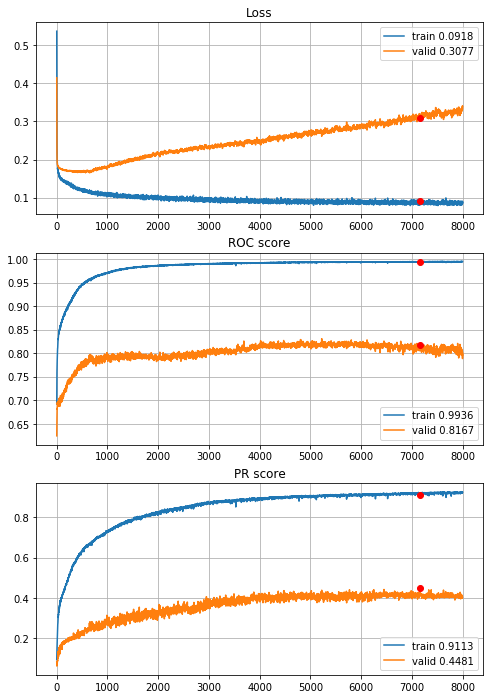


Fold 2------------------------------------------------------------


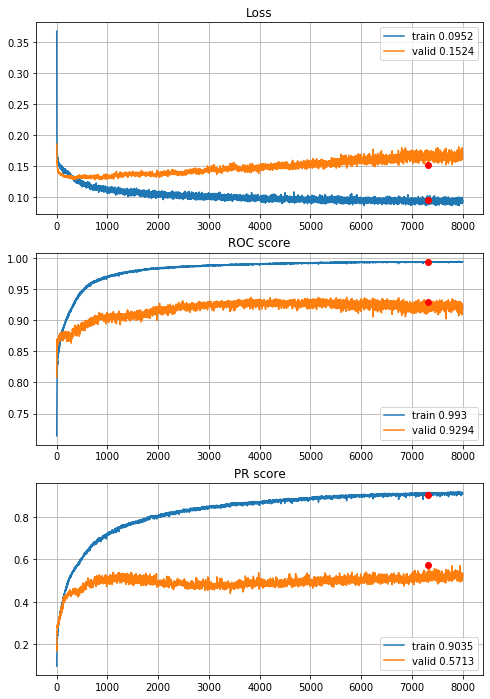


Fold 3------------------------------------------------------------


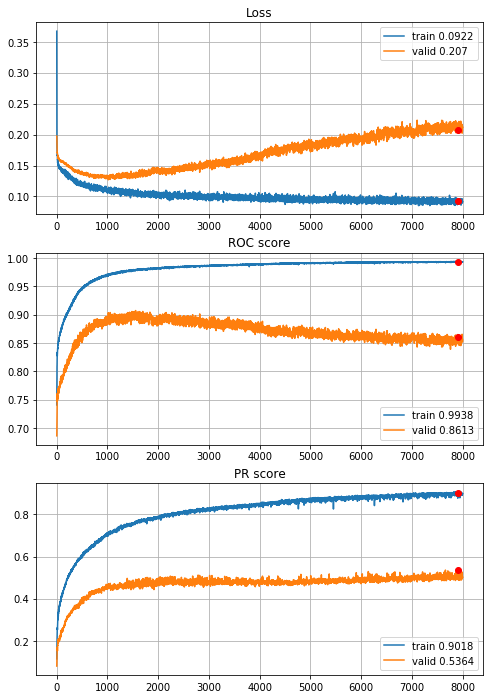


Fold 4------------------------------------------------------------


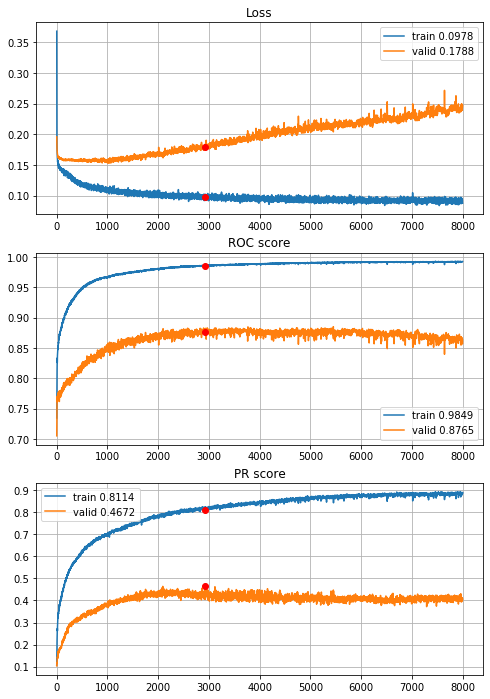


Fold 5------------------------------------------------------------


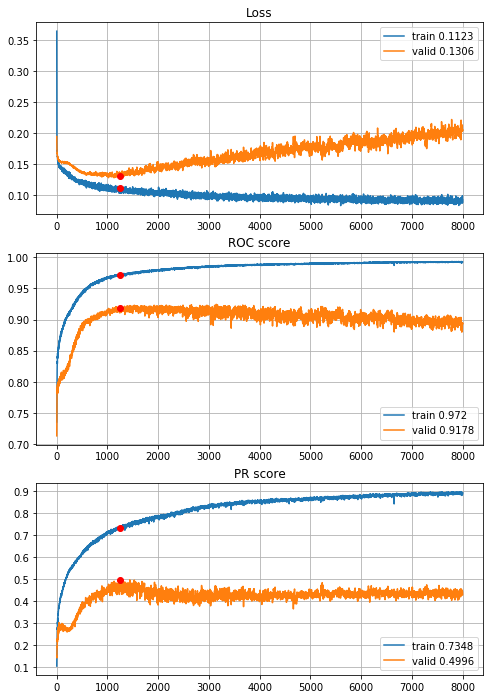


Fold 6------------------------------------------------------------


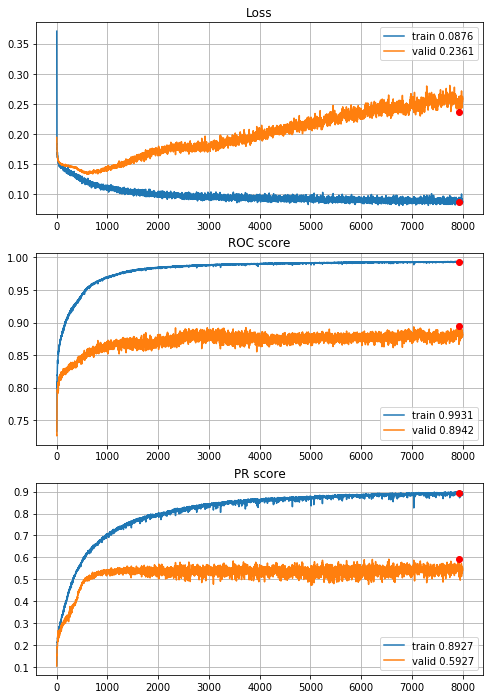

In [70]:
# THE BEST ONE
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=8000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\1year\MLP_L1_8000ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

##### The best model for 3-year horizon


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/8000,
cumulative time: 8.28s train loss: 0.496164968491053, validation loss: 0.3743743914015153
Epoch: 2/8000,
cumulative time: 8.39s train loss: 0.3734092220748851, validation loss: 0.28112739347190063
Epoch: 3/8000,
cumulative time: 8.5s train loss: 0.2851505077032256, validation loss: 0.22717151902545335
Epoch: 4/8000,
cumulative time: 8.61s train loss: 0.2377372186539069, validation loss: 0.19618361631312903
Epoch: 5/8000,
cumulative time: 8.71s train loss: 0.2061382745486283, validation loss: 0.17872710220614693
Epoch: 6/8000,
cumulative time: 8.82s train loss: 0.19255633489909163, validation loss: 0.16822568868663323
Epoch: 7/8000,
cumulative time: 8.92s train loss: 0.17696522651293245, validation loss: 0.1624229921618268
Epoch: 8/8000,
cumulative time: 9.02s train loss: 0.16791490504705475, validation loss: 0.15846269064542237
Epoch: 9/8000,
cumulative time: 9.13s train loss: 0.16845173369209

Epoch: 76/8000,
cumulative time: 16.17s train loss: 0.12509141353434358, validation loss: 0.15668679892564408
Epoch: 77/8000,
cumulative time: 16.28s train loss: 0.12563589733284836, validation loss: 0.15730035641501028
Epoch: 78/8000,
cumulative time: 16.39s train loss: 0.12435361963804578, validation loss: 0.15769470696544285
Epoch: 79/8000,
cumulative time: 16.49s train loss: 0.11996836651265055, validation loss: 0.15792152200749524
Epoch: 80/8000,
cumulative time: 16.6s train loss: 0.1224126001038859, validation loss: 0.15812553089302903
Epoch: 81/8000,
cumulative time: 16.71s train loss: 0.12423225244828827, validation loss: 0.158291577303206
Epoch: 82/8000,
cumulative time: 16.81s train loss: 0.12159381192707698, validation loss: 0.15808400268572784
Epoch: 83/8000,
cumulative time: 16.9s train loss: 0.1215433804286499, validation loss: 0.1587766365941607
Epoch: 84/8000,
cumulative time: 17.01s train loss: 0.12487711782303888, validation loss: 0.15835410220799456
Epoch: 85/8000,
c

Epoch: 225/8000,
cumulative time: 31.91s train loss: 0.10157164867960299, validation loss: 0.15760963988371998
Epoch: 226/8000,
cumulative time: 32.02s train loss: 0.10156006127086943, validation loss: 0.15765074828544196
Epoch: 227/8000,
cumulative time: 32.13s train loss: 0.10544015913636227, validation loss: 0.15900784038162774
Epoch: 228/8000,
cumulative time: 32.24s train loss: 0.10298391774409862, validation loss: 0.15802550544888064
Epoch: 229/8000,
cumulative time: 32.34s train loss: 0.09949772070379366, validation loss: 0.1591421483081025
Epoch: 230/8000,
cumulative time: 32.45s train loss: 0.10055748311064049, validation loss: 0.15768401853499875
Epoch: 231/8000,
cumulative time: 32.56s train loss: 0.10469176691499109, validation loss: 0.15815359037334145
Epoch: 232/8000,
cumulative time: 32.67s train loss: 0.10157763089072772, validation loss: 0.15845277568986338
Epoch: 233/8000,
cumulative time: 32.78s train loss: 0.10014056460454748, validation loss: 0.159134645389651
Epoc

Epoch: 301/8000,
cumulative time: 40.0s train loss: 0.09414722773280045, validation loss: 0.15988845057234138
Epoch: 302/8000,
cumulative time: 40.11s train loss: 0.09276493608499162, validation loss: 0.1593883109952286
Epoch: 303/8000,
cumulative time: 40.21s train loss: 0.09558913197644069, validation loss: 0.15942138215735469
Epoch: 304/8000,
cumulative time: 40.31s train loss: 0.09739977721075406, validation loss: 0.15953201513588994
Epoch: 305/8000,
cumulative time: 40.41s train loss: 0.09510812413307929, validation loss: 0.15907498668221867
Epoch: 306/8000,
cumulative time: 40.51s train loss: 0.09725343859568945, validation loss: 0.15995464268965784
Epoch: 307/8000,
cumulative time: 40.62s train loss: 0.09426390354360756, validation loss: 0.15975226066031084
Epoch: 308/8000,
cumulative time: 40.72s train loss: 0.09501038214909284, validation loss: 0.15950035237383797
Epoch: 309/8000,
cumulative time: 40.83s train loss: 0.09460126132168852, validation loss: 0.15964652999415568
Epo

Epoch: 376/8000,
cumulative time: 47.94s train loss: 0.08884968672661672, validation loss: 0.16044411552359528
Epoch: 377/8000,
cumulative time: 48.05s train loss: 0.08926367176523471, validation loss: 0.16344950912234
Epoch: 378/8000,
cumulative time: 48.16s train loss: 0.08582603974547061, validation loss: 0.16365662508377313
Epoch: 379/8000,
cumulative time: 48.26s train loss: 0.08790393187266826, validation loss: 0.1638618681643448
Epoch: 380/8000,
cumulative time: 48.37s train loss: 0.08689807251067497, validation loss: 0.1641300875672353
Epoch: 381/8000,
cumulative time: 48.47s train loss: 0.08752524934044599, validation loss: 0.16497148610156673
Epoch: 382/8000,
cumulative time: 48.58s train loss: 0.0900875590967838, validation loss: 0.16429071987942004
Epoch: 383/8000,
cumulative time: 48.72s train loss: 0.08814074562074338, validation loss: 0.1643665295794069
Epoch: 384/8000,
cumulative time: 48.81s train loss: 0.09245392270456908, validation loss: 0.16342619233950265
Epoch: 3

Epoch: 453/8000,
cumulative time: 56.05s train loss: 0.08211096509782141, validation loss: 0.16647344358279537
Epoch: 454/8000,
cumulative time: 56.16s train loss: 0.08144678449862595, validation loss: 0.16642006341035723
Epoch: 455/8000,
cumulative time: 56.27s train loss: 0.08237098369613093, validation loss: 0.16701327866575977
Epoch: 456/8000,
cumulative time: 56.37s train loss: 0.08465840514940148, validation loss: 0.16717374536864446
Epoch: 457/8000,
cumulative time: 56.48s train loss: 0.08562104751477884, validation loss: 0.16572218938276484
Epoch: 458/8000,
cumulative time: 56.59s train loss: 0.08575957923477244, validation loss: 0.16687051818990617
Epoch: 459/8000,
cumulative time: 56.69s train loss: 0.0823537975747626, validation loss: 0.16669271422631374
Epoch: 460/8000,
cumulative time: 56.8s train loss: 0.08196207683328433, validation loss: 0.16660436385609845
Epoch: 461/8000,
cumulative time: 56.9s train loss: 0.08568105067230719, validation loss: 0.16563482017060158
Epoc

Epoch: 529/8000,
cumulative time: 64.05s train loss: 0.07605062065331487, validation loss: 0.17013161786367137
Epoch: 530/8000,
cumulative time: 64.15s train loss: 0.07781339922541686, validation loss: 0.16994191513907525
Epoch: 531/8000,
cumulative time: 64.26s train loss: 0.07967587135435282, validation loss: 0.16918491935481156
Epoch: 532/8000,
cumulative time: 64.37s train loss: 0.0788805828827382, validation loss: 0.16939866050823363
Epoch: 533/8000,
cumulative time: 64.47s train loss: 0.07870515264443474, validation loss: 0.16934922196154803
Epoch: 534/8000,
cumulative time: 64.58s train loss: 0.07712473063190703, validation loss: 0.1692481561505591
Epoch: 535/8000,
cumulative time: 64.68s train loss: 0.07789418617479037, validation loss: 0.16966756946447906
Epoch: 536/8000,
cumulative time: 64.79s train loss: 0.0790399218971295, validation loss: 0.17000517721307346
Epoch: 537/8000,
cumulative time: 64.9s train loss: 0.07963667072680915, validation loss: 0.17027100007380208
Epoch

cumulative time: 71.92s train loss: 0.07480310327470642, validation loss: 0.17171276933328025
Epoch: 605/8000,
cumulative time: 72.03s train loss: 0.07277797188263464, validation loss: 0.17151788824310338
Epoch: 606/8000,
cumulative time: 72.14s train loss: 0.07221785974768352, validation loss: 0.17309844465590518
Epoch: 607/8000,
cumulative time: 72.24s train loss: 0.07382124297787387, validation loss: 0.1742588333941049
Epoch: 608/8000,
cumulative time: 72.34s train loss: 0.07521297787324979, validation loss: 0.17340071468244694
Epoch: 609/8000,
cumulative time: 72.45s train loss: 0.07488092201173419, validation loss: 0.17314512038027313
Epoch: 610/8000,
cumulative time: 72.56s train loss: 0.07636950761786675, validation loss: 0.1742955408071431
Epoch: 611/8000,
cumulative time: 72.66s train loss: 0.07455456557434469, validation loss: 0.17500835589258676
Epoch: 612/8000,
cumulative time: 72.78s train loss: 0.07012921323331756, validation loss: 0.17360301861500604
Epoch: 613/8000,
cum

cumulative time: 79.82s train loss: 0.0736948087966985, validation loss: 0.18012677104807895
Epoch: 680/8000,
cumulative time: 79.95s train loss: 0.07111995415991805, validation loss: 0.17907598097251987
Epoch: 681/8000,
cumulative time: 80.04s train loss: 0.06923462033724197, validation loss: 0.17946390380669364
Epoch: 682/8000,
cumulative time: 80.15s train loss: 0.07452576565052572, validation loss: 0.17972701499539037
Epoch: 683/8000,
cumulative time: 80.25s train loss: 0.07211140488085303, validation loss: 0.17943043650553847
Epoch: 684/8000,
cumulative time: 80.36s train loss: 0.07212435718505614, validation loss: 0.1790753757648269
Epoch: 685/8000,
cumulative time: 80.45s train loss: 0.06861954728950811, validation loss: 0.18006357564758757
Epoch: 686/8000,
cumulative time: 80.55s train loss: 0.06986364060182272, validation loss: 0.1793483337087016
Epoch: 687/8000,
cumulative time: 80.65s train loss: 0.0695482701939695, validation loss: 0.18079357055604345
Epoch: 688/8000,
cumul

Epoch: 754/8000,
cumulative time: 87.76s train loss: 0.06446510437430648, validation loss: 0.18631038796404056
Epoch: 755/8000,
cumulative time: 87.86s train loss: 0.06818385019587385, validation loss: 0.1885483764550265
Epoch: 756/8000,
cumulative time: 87.96s train loss: 0.06625941168707733, validation loss: 0.18723794600203547
Epoch: 757/8000,
cumulative time: 88.07s train loss: 0.07268084357766544, validation loss: 0.1872859910780836
Epoch: 758/8000,
cumulative time: 88.18s train loss: 0.06753302299942418, validation loss: 0.18680753520702276
Epoch: 759/8000,
cumulative time: 88.28s train loss: 0.06399352462004439, validation loss: 0.18774222555716982
Epoch: 760/8000,
cumulative time: 88.38s train loss: 0.06755886723974851, validation loss: 0.18977720639624224
Epoch: 761/8000,
cumulative time: 88.49s train loss: 0.06920982160070024, validation loss: 0.1871590767006268
Epoch: 762/8000,
cumulative time: 88.59s train loss: 0.068415774855996, validation loss: 0.1867211846178804
Epoch: 

Epoch: 830/8000,
cumulative time: 95.79s train loss: 0.06730017187444942, validation loss: 0.1864629973157307
Epoch: 831/8000,
cumulative time: 95.89s train loss: 0.06465881047752708, validation loss: 0.18767244833922703
Epoch: 832/8000,
cumulative time: 96.0s train loss: 0.06066218558875614, validation loss: 0.18869108190685793
Epoch: 833/8000,
cumulative time: 96.1s train loss: 0.0653729689415311, validation loss: 0.18790644288515457
Epoch: 834/8000,
cumulative time: 96.21s train loss: 0.0681604019081683, validation loss: 0.18778296677392167
Epoch: 835/8000,
cumulative time: 96.31s train loss: 0.06575493677121638, validation loss: 0.18784567671324315
Epoch: 836/8000,
cumulative time: 96.43s train loss: 0.06916195601083522, validation loss: 0.18886353604255185
Epoch: 837/8000,
cumulative time: 96.53s train loss: 0.06482345195066544, validation loss: 0.1885049257434523
Epoch: 838/8000,
cumulative time: 96.64s train loss: 0.06416619652193005, validation loss: 0.19143303219349153
Epoch: 

Epoch: 904/8000,
cumulative time: 103.57s train loss: 0.06103410268842156, validation loss: 0.19463961663350207
Epoch: 905/8000,
cumulative time: 103.67s train loss: 0.06036584408250434, validation loss: 0.19522584112364608
Epoch: 906/8000,
cumulative time: 103.79s train loss: 0.06360455039160527, validation loss: 0.19911995329372797
Epoch: 907/8000,
cumulative time: 103.88s train loss: 0.06525349435617395, validation loss: 0.1994769955212975
Epoch: 908/8000,
cumulative time: 103.98s train loss: 0.06284024744617984, validation loss: 0.2001340223274828
Epoch: 909/8000,
cumulative time: 104.07s train loss: 0.0673477463622134, validation loss: 0.1969790999023014
Epoch: 910/8000,
cumulative time: 104.17s train loss: 0.06320097974909777, validation loss: 0.1953619540981821
Epoch: 911/8000,
cumulative time: 104.26s train loss: 0.061575029029085016, validation loss: 0.19499810387785113
Epoch: 912/8000,
cumulative time: 104.36s train loss: 0.059957351497386846, validation loss: 0.1970741291595

Epoch: 979/8000,
cumulative time: 111.27s train loss: 0.05695507135913765, validation loss: 0.19831934282856603
Epoch: 980/8000,
cumulative time: 111.37s train loss: 0.0630463386862848, validation loss: 0.19919093298165577
Epoch: 981/8000,
cumulative time: 111.47s train loss: 0.061238436258099334, validation loss: 0.1977484043850166
Epoch: 982/8000,
cumulative time: 111.57s train loss: 0.06349071483260314, validation loss: 0.1955787619501635
Epoch: 983/8000,
cumulative time: 111.68s train loss: 0.05656540835774601, validation loss: 0.195513795262496
Epoch: 984/8000,
cumulative time: 111.79s train loss: 0.06238705747437432, validation loss: 0.19646955090636772
Epoch: 985/8000,
cumulative time: 111.89s train loss: 0.05782087963830814, validation loss: 0.19677322265997785
Epoch: 986/8000,
cumulative time: 112.0s train loss: 0.05888086015206587, validation loss: 0.19736761134648007
Epoch: 987/8000,
cumulative time: 112.11s train loss: 0.05748630660944804, validation loss: 0.196759184635115

Epoch: 1052/8000,
cumulative time: 118.96s train loss: 0.06071376900066687, validation loss: 0.20093354585614104
Epoch: 1053/8000,
cumulative time: 119.07s train loss: 0.057641117823304895, validation loss: 0.20007717708369585
Epoch: 1054/8000,
cumulative time: 119.18s train loss: 0.06008402535681254, validation loss: 0.2004462357829599
Epoch: 1055/8000,
cumulative time: 119.3s train loss: 0.057499655535483495, validation loss: 0.19975538800631348
Epoch: 1056/8000,
cumulative time: 119.4s train loss: 0.054624121418431315, validation loss: 0.20210593834208357
Epoch: 1057/8000,
cumulative time: 119.5s train loss: 0.05940618227877472, validation loss: 0.20351920445119182
Epoch: 1058/8000,
cumulative time: 119.61s train loss: 0.05312441565534648, validation loss: 0.20551954274838066
Epoch: 1059/8000,
cumulative time: 119.71s train loss: 0.054924822458732286, validation loss: 0.20520728925486895
Epoch: 1060/8000,
cumulative time: 119.83s train loss: 0.057803132884077145, validation loss: 0.

Epoch: 1126/8000,
cumulative time: 126.75s train loss: 0.057312746157965125, validation loss: 0.2076056595375687
Epoch: 1127/8000,
cumulative time: 126.86s train loss: 0.05537809828398802, validation loss: 0.2094871662203682
Epoch: 1128/8000,
cumulative time: 126.97s train loss: 0.05458427428973015, validation loss: 0.21125804147978208
Epoch: 1129/8000,
cumulative time: 127.08s train loss: 0.05384857607634289, validation loss: 0.21507266347616402
Epoch: 1130/8000,
cumulative time: 127.19s train loss: 0.05767889505771803, validation loss: 0.20974175513243087
Epoch: 1131/8000,
cumulative time: 127.29s train loss: 0.05781981612235817, validation loss: 0.2076417415259685
Epoch: 1132/8000,
cumulative time: 127.4s train loss: 0.06010310013391487, validation loss: 0.2093427734311663
Epoch: 1133/8000,
cumulative time: 127.5s train loss: 0.05589104487615473, validation loss: 0.20882102092144839
Epoch: 1134/8000,
cumulative time: 127.61s train loss: 0.06036723163226298, validation loss: 0.208640

Epoch: 1201/8000,
cumulative time: 134.66s train loss: 0.05370874573994407, validation loss: 0.210814031579689
Epoch: 1202/8000,
cumulative time: 134.77s train loss: 0.053735357059247126, validation loss: 0.21125568373153514
Epoch: 1203/8000,
cumulative time: 134.87s train loss: 0.051450176665690184, validation loss: 0.21312642063542606
Epoch: 1204/8000,
cumulative time: 134.98s train loss: 0.0523482736518193, validation loss: 0.2147771507727806
Epoch: 1205/8000,
cumulative time: 135.08s train loss: 0.054316062873239986, validation loss: 0.21637287266566585
Epoch: 1206/8000,
cumulative time: 135.19s train loss: 0.054685797492851566, validation loss: 0.21739073926176472
Epoch: 1207/8000,
cumulative time: 135.29s train loss: 0.05440751655730622, validation loss: 0.2171072919748766
Epoch: 1208/8000,
cumulative time: 135.4s train loss: 0.05340448235509744, validation loss: 0.21523130782641314
Epoch: 1209/8000,
cumulative time: 135.51s train loss: 0.05831593556835032, validation loss: 0.216

Epoch: 1275/8000,
cumulative time: 142.45s train loss: 0.053948845998498925, validation loss: 0.21411867451057037
Epoch: 1276/8000,
cumulative time: 142.55s train loss: 0.051911996449900535, validation loss: 0.21730283270298417
Epoch: 1277/8000,
cumulative time: 142.66s train loss: 0.060582898772079535, validation loss: 0.2167172162763534
Epoch: 1278/8000,
cumulative time: 142.76s train loss: 0.05536604054710444, validation loss: 0.21607411198982476
Epoch: 1279/8000,
cumulative time: 142.87s train loss: 0.056789320999972054, validation loss: 0.2171378174701271
Epoch: 1280/8000,
cumulative time: 142.97s train loss: 0.0553984289264317, validation loss: 0.21618730808118716
Epoch: 1281/8000,
cumulative time: 143.08s train loss: 0.05403647656204352, validation loss: 0.21725125243247573
Epoch: 1282/8000,
cumulative time: 143.19s train loss: 0.051417982998167994, validation loss: 0.21747277699679532
Epoch: 1283/8000,
cumulative time: 143.29s train loss: 0.05147333288073992, validation loss: 0

Epoch: 1349/8000,
cumulative time: 150.43s train loss: 0.05283310728631843, validation loss: 0.21714419188716605
Epoch: 1350/8000,
cumulative time: 150.53s train loss: 0.05708704096825345, validation loss: 0.21768771847126833
Epoch: 1351/8000,
cumulative time: 150.64s train loss: 0.050897249667790405, validation loss: 0.2200042939615883
Epoch: 1352/8000,
cumulative time: 150.75s train loss: 0.05475086552750114, validation loss: 0.22004932368729102
Epoch: 1353/8000,
cumulative time: 150.85s train loss: 0.05018887568965017, validation loss: 0.22127508302793558
Epoch: 1354/8000,
cumulative time: 150.96s train loss: 0.05187997707648227, validation loss: 0.22082881855670597
Epoch: 1355/8000,
cumulative time: 151.06s train loss: 0.05138683204010723, validation loss: 0.21977666484110722
Epoch: 1356/8000,
cumulative time: 151.16s train loss: 0.05600672391662109, validation loss: 0.21891849512054073
Epoch: 1357/8000,
cumulative time: 151.27s train loss: 0.04916413454038482, validation loss: 0.2

Epoch: 1423/8000,
cumulative time: 158.22s train loss: 0.050118912300501424, validation loss: 0.22108581681970854
Epoch: 1424/8000,
cumulative time: 158.32s train loss: 0.05526808419280758, validation loss: 0.2189984807931947
Epoch: 1425/8000,
cumulative time: 158.42s train loss: 0.05015326576480603, validation loss: 0.21920024274196298
Epoch: 1426/8000,
cumulative time: 158.53s train loss: 0.04663012456254896, validation loss: 0.22069803457106313
Epoch: 1427/8000,
cumulative time: 158.65s train loss: 0.05058519277771126, validation loss: 0.22169331714256438
Epoch: 1428/8000,
cumulative time: 158.75s train loss: 0.05547119327723641, validation loss: 0.22048380419583655
Epoch: 1429/8000,
cumulative time: 158.86s train loss: 0.052044031016910325, validation loss: 0.220095614384881
Epoch: 1430/8000,
cumulative time: 158.98s train loss: 0.0578962589873874, validation loss: 0.21997780939546438
Epoch: 1431/8000,
cumulative time: 159.09s train loss: 0.05052699007207008, validation loss: 0.219

Epoch: 1496/8000,
cumulative time: 165.97s train loss: 0.049456940356649076, validation loss: 0.22821604996297573
Epoch: 1497/8000,
cumulative time: 166.07s train loss: 0.04754578746303888, validation loss: 0.22765937048864093
Epoch: 1498/8000,
cumulative time: 166.17s train loss: 0.0499697862443933, validation loss: 0.22946251875082954
Epoch: 1499/8000,
cumulative time: 166.28s train loss: 0.04922066531170591, validation loss: 0.22928663254123485
Epoch: 1500/8000,
cumulative time: 166.38s train loss: 0.046814042486716945, validation loss: 0.22842033083004562
Epoch: 1501/8000,
cumulative time: 166.48s train loss: 0.050160878178516874, validation loss: 0.2260089937095624
Epoch: 1502/8000,
cumulative time: 166.58s train loss: 0.04684910425170549, validation loss: 0.22770027216856123
Epoch: 1503/8000,
cumulative time: 166.69s train loss: 0.050794954906152365, validation loss: 0.22962365272601595
Epoch: 1504/8000,
cumulative time: 166.79s train loss: 0.050196324020228306, validation loss: 

Epoch: 1569/8000,
cumulative time: 173.72s train loss: 0.048813816803230055, validation loss: 0.2315395899413885
Epoch: 1570/8000,
cumulative time: 173.82s train loss: 0.05181823249206484, validation loss: 0.23059951204389503
Epoch: 1571/8000,
cumulative time: 173.93s train loss: 0.05260612447189425, validation loss: 0.23087059227180662
Epoch: 1572/8000,
cumulative time: 174.03s train loss: 0.04511991390778172, validation loss: 0.23040723763901097
Epoch: 1573/8000,
cumulative time: 174.14s train loss: 0.05432461341613271, validation loss: 0.23078497356436511
Epoch: 1574/8000,
cumulative time: 174.24s train loss: 0.050100391335516775, validation loss: 0.2301319922962044
Epoch: 1575/8000,
cumulative time: 174.35s train loss: 0.04505338238965741, validation loss: 0.23059919352097122
Epoch: 1576/8000,
cumulative time: 174.45s train loss: 0.051372474871674796, validation loss: 0.23021750969271507
Epoch: 1577/8000,
cumulative time: 174.55s train loss: 0.04708712111232516, validation loss: 0.

cumulative time: 181.48s train loss: 0.04743222641127725, validation loss: 0.2368810149704935
Epoch: 1644/8000,
cumulative time: 181.59s train loss: 0.045095304490917094, validation loss: 0.23624426414889674
Epoch: 1645/8000,
cumulative time: 181.68s train loss: 0.048598659384211054, validation loss: 0.23552199431908877
Epoch: 1646/8000,
cumulative time: 181.79s train loss: 0.044204489326906835, validation loss: 0.23856043612029565
Epoch: 1647/8000,
cumulative time: 181.89s train loss: 0.04512320016095489, validation loss: 0.23792605308472997
Epoch: 1648/8000,
cumulative time: 181.98s train loss: 0.04274048502477455, validation loss: 0.23766178034062177
Epoch: 1649/8000,
cumulative time: 182.1s train loss: 0.046190528064768276, validation loss: 0.23592669735936558
Epoch: 1650/8000,
cumulative time: 182.2s train loss: 0.04200412039865918, validation loss: 0.23571581683303644
Epoch: 1651/8000,
cumulative time: 182.29s train loss: 0.051196543142849854, validation loss: 0.2368041889660725


Epoch: 1716/8000,
cumulative time: 189.06s train loss: 0.04862324290147203, validation loss: 0.2374430327646194
Epoch: 1717/8000,
cumulative time: 189.16s train loss: 0.04707032730290401, validation loss: 0.23757258730549966
Epoch: 1718/8000,
cumulative time: 189.26s train loss: 0.04313458641337149, validation loss: 0.23944038605101872
Epoch: 1719/8000,
cumulative time: 189.37s train loss: 0.0482874885823514, validation loss: 0.24259198472554136
Epoch: 1720/8000,
cumulative time: 189.47s train loss: 0.047681148136759166, validation loss: 0.24060047074332408
Epoch: 1721/8000,
cumulative time: 189.57s train loss: 0.044173679776503876, validation loss: 0.24097075419362626
Epoch: 1722/8000,
cumulative time: 189.66s train loss: 0.04600412511183709, validation loss: 0.23859963813475007
Epoch: 1723/8000,
cumulative time: 189.78s train loss: 0.04308442938896126, validation loss: 0.23728437554904133
Epoch: 1724/8000,
cumulative time: 189.88s train loss: 0.04256102103930836, validation loss: 0.2

Epoch: 1790/8000,
cumulative time: 196.86s train loss: 0.04357110949222571, validation loss: 0.24380228395593234
Epoch: 1791/8000,
cumulative time: 196.95s train loss: 0.045414802904260226, validation loss: 0.2440894004629052
Epoch: 1792/8000,
cumulative time: 197.06s train loss: 0.04487844932986957, validation loss: 0.24294964301857597
Epoch: 1793/8000,
cumulative time: 197.16s train loss: 0.04841566027426629, validation loss: 0.24342331196936076
Epoch: 1794/8000,
cumulative time: 197.28s train loss: 0.048650516607786264, validation loss: 0.2436368020650784
Epoch: 1795/8000,
cumulative time: 197.38s train loss: 0.04746528917912966, validation loss: 0.24573203553737227
Epoch: 1796/8000,
cumulative time: 197.48s train loss: 0.049090007539888035, validation loss: 0.23784686574108008
Epoch: 1797/8000,
cumulative time: 197.59s train loss: 0.04651996270175564, validation loss: 0.23613097949883063
Epoch: 1798/8000,
cumulative time: 197.7s train loss: 0.046698654329923796, validation loss: 0.

Epoch: 1864/8000,
cumulative time: 204.64s train loss: 0.04480947423690976, validation loss: 0.2440145042295474
Epoch: 1865/8000,
cumulative time: 204.75s train loss: 0.04346389235324267, validation loss: 0.24284504393585718
Epoch: 1866/8000,
cumulative time: 204.86s train loss: 0.0501367792409387, validation loss: 0.2406241143055161
Epoch: 1867/8000,
cumulative time: 204.97s train loss: 0.0447509221548826, validation loss: 0.24171203148659084
Epoch: 1868/8000,
cumulative time: 205.08s train loss: 0.04320993660692924, validation loss: 0.2391714913455992
Epoch: 1869/8000,
cumulative time: 205.2s train loss: 0.04314370142398455, validation loss: 0.23898187743418584
Epoch: 1870/8000,
cumulative time: 205.31s train loss: 0.048309313348252364, validation loss: 0.24236304274772558
Epoch: 1871/8000,
cumulative time: 205.42s train loss: 0.0456866566240222, validation loss: 0.24326919539490507
Epoch: 1872/8000,
cumulative time: 205.53s train loss: 0.04528159428197021, validation loss: 0.2454532

Epoch: 1938/8000,
cumulative time: 212.53s train loss: 0.0481937416731972, validation loss: 0.2418177870916913
Epoch: 1939/8000,
cumulative time: 212.62s train loss: 0.04212332886327376, validation loss: 0.24392805654251598
Epoch: 1940/8000,
cumulative time: 212.74s train loss: 0.04376470264916854, validation loss: 0.24382987708927784
Epoch: 1941/8000,
cumulative time: 212.84s train loss: 0.04450516733120017, validation loss: 0.2445491325018302
Epoch: 1942/8000,
cumulative time: 212.95s train loss: 0.04335068013285776, validation loss: 0.24752246915049977
Epoch: 1943/8000,
cumulative time: 213.04s train loss: 0.041964448943903825, validation loss: 0.25041724908284035
Epoch: 1944/8000,
cumulative time: 213.16s train loss: 0.040146528995212385, validation loss: 0.24999805493191932
Epoch: 1945/8000,
cumulative time: 213.26s train loss: 0.041420782755431235, validation loss: 0.2506299892571212
Epoch: 1946/8000,
cumulative time: 213.36s train loss: 0.04319831563099738, validation loss: 0.24

Epoch: 2011/8000,
cumulative time: 220.07s train loss: 0.04398883096308251, validation loss: 0.2534286166334514
Epoch: 2012/8000,
cumulative time: 220.17s train loss: 0.039787514753060055, validation loss: 0.2549253881430038
Epoch: 2013/8000,
cumulative time: 220.28s train loss: 0.04165762190475523, validation loss: 0.2560475376457598
Epoch: 2014/8000,
cumulative time: 220.38s train loss: 0.04550598851092287, validation loss: 0.2560230754527919
Epoch: 2015/8000,
cumulative time: 220.47s train loss: 0.04703368151267068, validation loss: 0.25335172958233776
Epoch: 2016/8000,
cumulative time: 220.57s train loss: 0.03803776404988268, validation loss: 0.2541486147854767
Epoch: 2017/8000,
cumulative time: 220.66s train loss: 0.04478618788552352, validation loss: 0.25361666798704713
Epoch: 2018/8000,
cumulative time: 220.78s train loss: 0.04590277564508639, validation loss: 0.25372967579220007
Epoch: 2019/8000,
cumulative time: 220.88s train loss: 0.0408944011611097, validation loss: 0.251432

Epoch: 2085/8000,
cumulative time: 227.5s train loss: 0.04879871104866888, validation loss: 0.25524941298834963
Epoch: 2086/8000,
cumulative time: 227.61s train loss: 0.0450922326257265, validation loss: 0.25278071550196446
Epoch: 2087/8000,
cumulative time: 227.72s train loss: 0.03832786388596276, validation loss: 0.25564182850848566
Epoch: 2088/8000,
cumulative time: 227.83s train loss: 0.04427215616860245, validation loss: 0.2580918950758578
Epoch: 2089/8000,
cumulative time: 227.94s train loss: 0.03967645477496469, validation loss: 0.2593540487637782
Epoch: 2090/8000,
cumulative time: 228.05s train loss: 0.04649944425802643, validation loss: 0.25995211981844857
Epoch: 2091/8000,
cumulative time: 228.16s train loss: 0.03982726712861369, validation loss: 0.2613448933530351
Epoch: 2092/8000,
cumulative time: 228.27s train loss: 0.04247951393618303, validation loss: 0.2614839370495002
Epoch: 2093/8000,
cumulative time: 228.38s train loss: 0.045564488357593934, validation loss: 0.257786

Epoch: 2158/8000,
cumulative time: 235.25s train loss: 0.04459932267213456, validation loss: 0.25781654457665937
Epoch: 2159/8000,
cumulative time: 235.35s train loss: 0.04218523516416889, validation loss: 0.2594498831361702
Epoch: 2160/8000,
cumulative time: 235.45s train loss: 0.03719738208436084, validation loss: 0.2602218480840806
Epoch: 2161/8000,
cumulative time: 235.55s train loss: 0.039848891750995985, validation loss: 0.2611791173126937
Epoch: 2162/8000,
cumulative time: 235.66s train loss: 0.04360595886406455, validation loss: 0.2621849098117347
Epoch: 2163/8000,
cumulative time: 235.77s train loss: 0.04022276849544252, validation loss: 0.2658243118246321
Epoch: 2164/8000,
cumulative time: 235.87s train loss: 0.04053925359003119, validation loss: 0.26012306257488604
Epoch: 2165/8000,
cumulative time: 235.97s train loss: 0.03805642724814745, validation loss: 0.2602375079038247
Epoch: 2166/8000,
cumulative time: 236.07s train loss: 0.04648492808331801, validation loss: 0.262765

Epoch: 2231/8000,
cumulative time: 242.77s train loss: 0.04024180664947748, validation loss: 0.2607459375878665
Epoch: 2232/8000,
cumulative time: 242.87s train loss: 0.04077571159762382, validation loss: 0.26038058727018293
Epoch: 2233/8000,
cumulative time: 242.98s train loss: 0.044302043034226773, validation loss: 0.2622266017338809
Epoch: 2234/8000,
cumulative time: 243.07s train loss: 0.03927177308759947, validation loss: 0.2600401068491547
Epoch: 2235/8000,
cumulative time: 243.18s train loss: 0.04029176291467117, validation loss: 0.2596323889674905
Epoch: 2236/8000,
cumulative time: 243.28s train loss: 0.04032219948222334, validation loss: 0.2593589540733558
Epoch: 2237/8000,
cumulative time: 243.38s train loss: 0.03849961740977398, validation loss: 0.2581827097644842
Epoch: 2238/8000,
cumulative time: 243.49s train loss: 0.043489498574378595, validation loss: 0.25852789852831803
Epoch: 2239/8000,
cumulative time: 243.58s train loss: 0.041727502082794396, validation loss: 0.2580

Epoch: 2305/8000,
cumulative time: 250.41s train loss: 0.047069164340789, validation loss: 0.264939542485143
Epoch: 2306/8000,
cumulative time: 250.5s train loss: 0.03823582291306196, validation loss: 0.26474172484829483
Epoch: 2307/8000,
cumulative time: 250.61s train loss: 0.037623435047506384, validation loss: 0.2674850520927042
Epoch: 2308/8000,
cumulative time: 250.72s train loss: 0.039567981919086406, validation loss: 0.2686512156105132
Epoch: 2309/8000,
cumulative time: 250.81s train loss: 0.04178185981240625, validation loss: 0.2671629955013065
Epoch: 2310/8000,
cumulative time: 250.91s train loss: 0.047618344361121556, validation loss: 0.26500551348845464
Epoch: 2311/8000,
cumulative time: 251.03s train loss: 0.03473002847064944, validation loss: 0.2639836911571546
Epoch: 2312/8000,
cumulative time: 251.13s train loss: 0.044426413002711995, validation loss: 0.2594676471299419
Epoch: 2313/8000,
cumulative time: 251.25s train loss: 0.03951170433814544, validation loss: 0.2553206

Epoch: 2380/8000,
cumulative time: 258.14s train loss: 0.03728043614856658, validation loss: 0.2597981272601086
Epoch: 2381/8000,
cumulative time: 258.24s train loss: 0.036810392044498756, validation loss: 0.26097739989775637
Epoch: 2382/8000,
cumulative time: 258.35s train loss: 0.037993005706983454, validation loss: 0.2605571722792041
Epoch: 2383/8000,
cumulative time: 258.45s train loss: 0.03916243515003904, validation loss: 0.26185594148495617
Epoch: 2384/8000,
cumulative time: 258.55s train loss: 0.04099220981648231, validation loss: 0.2610403145513227
Epoch: 2385/8000,
cumulative time: 258.65s train loss: 0.037911488980309334, validation loss: 0.2619362347944864
Epoch: 2386/8000,
cumulative time: 258.76s train loss: 0.03436310979444004, validation loss: 0.26290478001735695
Epoch: 2387/8000,
cumulative time: 258.85s train loss: 0.040295638568854875, validation loss: 0.26321730597308735
Epoch: 2388/8000,
cumulative time: 258.97s train loss: 0.04154656380980472, validation loss: 0.2

Epoch: 2454/8000,
cumulative time: 265.84s train loss: 0.04082855807168434, validation loss: 0.2697171256426842
Epoch: 2455/8000,
cumulative time: 265.94s train loss: 0.035130010401755854, validation loss: 0.2679402176467472
Epoch: 2456/8000,
cumulative time: 266.04s train loss: 0.04418075961048452, validation loss: 0.2662422102248646
Epoch: 2457/8000,
cumulative time: 266.14s train loss: 0.04006893840146585, validation loss: 0.2646978309473458
Epoch: 2458/8000,
cumulative time: 266.24s train loss: 0.03650192170274891, validation loss: 0.26452632087231587
Epoch: 2459/8000,
cumulative time: 266.34s train loss: 0.03425278986258118, validation loss: 0.2650477675547862
Epoch: 2460/8000,
cumulative time: 266.46s train loss: 0.036189270006453854, validation loss: 0.264146675901802
Epoch: 2461/8000,
cumulative time: 266.56s train loss: 0.04448807472098032, validation loss: 0.2616687217122916
Epoch: 2462/8000,
cumulative time: 266.66s train loss: 0.04090623874181928, validation loss: 0.2635120

Epoch: 2528/8000,
cumulative time: 273.53s train loss: 0.03596733426304085, validation loss: 0.2615355174896613
Epoch: 2529/8000,
cumulative time: 273.62s train loss: 0.04193777394192947, validation loss: 0.2612506506904479
Epoch: 2530/8000,
cumulative time: 273.74s train loss: 0.041348979168304684, validation loss: 0.26149325895580894
Epoch: 2531/8000,
cumulative time: 273.84s train loss: 0.03759872961216792, validation loss: 0.2628826977971383
Epoch: 2532/8000,
cumulative time: 273.94s train loss: 0.04058233988621542, validation loss: 0.26181061599806543
Epoch: 2533/8000,
cumulative time: 274.05s train loss: 0.04312348648962305, validation loss: 0.2617951574429615
Epoch: 2534/8000,
cumulative time: 274.16s train loss: 0.045583182757108896, validation loss: 0.2625579037182245
Epoch: 2535/8000,
cumulative time: 274.26s train loss: 0.03669684138679188, validation loss: 0.26164863729386445
Epoch: 2536/8000,
cumulative time: 274.36s train loss: 0.03601961445480415, validation loss: 0.2628

Epoch: 2674/8000,
cumulative time: 288.7s train loss: 0.03813958757714257, validation loss: 0.2750400061625457
Epoch: 2675/8000,
cumulative time: 288.81s train loss: 0.03658323540746374, validation loss: 0.27536434480881555
Epoch: 2676/8000,
cumulative time: 288.9s train loss: 0.037048638390069666, validation loss: 0.2744997349025176
Epoch: 2677/8000,
cumulative time: 289.0s train loss: 0.039197976757159046, validation loss: 0.27198083489511227
Epoch: 2678/8000,
cumulative time: 289.1s train loss: 0.03751534475561451, validation loss: 0.2740458915367072
Epoch: 2679/8000,
cumulative time: 289.2s train loss: 0.0414465360972585, validation loss: 0.2778505135815329
Epoch: 2680/8000,
cumulative time: 289.32s train loss: 0.04000753590614452, validation loss: 0.272804799268775
Epoch: 2681/8000,
cumulative time: 289.4s train loss: 0.03775438314102293, validation loss: 0.27178631148935495
Epoch: 2682/8000,
cumulative time: 289.5s train loss: 0.03657827987256097, validation loss: 0.2723590114650

Epoch: 2749/8000,
cumulative time: 296.32s train loss: 0.03757147686502965, validation loss: 0.27654812486393404
Epoch: 2750/8000,
cumulative time: 296.42s train loss: 0.03311288046811405, validation loss: 0.2742609072907826
Epoch: 2751/8000,
cumulative time: 296.53s train loss: 0.038103943355593556, validation loss: 0.27212774306818477
Epoch: 2752/8000,
cumulative time: 296.64s train loss: 0.03334744527752191, validation loss: 0.2727643665937138
Epoch: 2753/8000,
cumulative time: 296.74s train loss: 0.0371512794195616, validation loss: 0.27604739099345127
Epoch: 2754/8000,
cumulative time: 296.84s train loss: 0.03478116679802339, validation loss: 0.2747928301399075
Epoch: 2755/8000,
cumulative time: 296.95s train loss: 0.03533767476762721, validation loss: 0.274535131974736
Epoch: 2756/8000,
cumulative time: 297.04s train loss: 0.03359355100446453, validation loss: 0.27408602958159833
Epoch: 2757/8000,
cumulative time: 297.14s train loss: 0.04132063511858007, validation loss: 0.275765

Epoch: 2823/8000,
cumulative time: 303.84s train loss: 0.037467158681923345, validation loss: 0.27353539011057687
Epoch: 2824/8000,
cumulative time: 303.94s train loss: 0.03315447938736295, validation loss: 0.2740802354615825
Epoch: 2825/8000,
cumulative time: 304.04s train loss: 0.039579831701358766, validation loss: 0.2769084697204025
Epoch: 2826/8000,
cumulative time: 304.14s train loss: 0.037350990744113244, validation loss: 0.27343524740814484
Epoch: 2827/8000,
cumulative time: 304.24s train loss: 0.03300589972318802, validation loss: 0.2747426090701934
Epoch: 2828/8000,
cumulative time: 304.34s train loss: 0.038317391410667936, validation loss: 0.2792931756100121
Epoch: 2829/8000,
cumulative time: 304.44s train loss: 0.03719428364024895, validation loss: 0.27751852085626555
Epoch: 2830/8000,
cumulative time: 304.54s train loss: 0.04176312864561913, validation loss: 0.2788291932622667
Epoch: 2831/8000,
cumulative time: 304.62s train loss: 0.03405707586818221, validation loss: 0.27

Epoch: 2896/8000,
cumulative time: 311.21s train loss: 0.03402696947021095, validation loss: 0.2787884728845202
Epoch: 2897/8000,
cumulative time: 311.31s train loss: 0.03679586141891565, validation loss: 0.27698679788628383
Epoch: 2898/8000,
cumulative time: 311.41s train loss: 0.03677972827099645, validation loss: 0.27772954216605117
Epoch: 2899/8000,
cumulative time: 311.51s train loss: 0.03646047638633785, validation loss: 0.27700778358462186
Epoch: 2900/8000,
cumulative time: 311.61s train loss: 0.035520095569726635, validation loss: 0.2758003186568816
Epoch: 2901/8000,
cumulative time: 311.73s train loss: 0.034151502566472175, validation loss: 0.2767871188766816
Epoch: 2902/8000,
cumulative time: 311.83s train loss: 0.03595390150312907, validation loss: 0.279369440686092
Epoch: 2903/8000,
cumulative time: 311.93s train loss: 0.03510904470829742, validation loss: 0.274816049457275
Epoch: 2904/8000,
cumulative time: 312.03s train loss: 0.03879578328378626, validation loss: 0.272583

Epoch: 3041/8000,
cumulative time: 326.21s train loss: 0.03613278065831091, validation loss: 0.28714898251265686
Epoch: 3042/8000,
cumulative time: 326.31s train loss: 0.03593819469877959, validation loss: 0.28877776069478245
Epoch: 3043/8000,
cumulative time: 326.39s train loss: 0.03404626437803939, validation loss: 0.28842056821148127
Epoch: 3044/8000,
cumulative time: 326.51s train loss: 0.03414893855448579, validation loss: 0.2875601563044246
Epoch: 3045/8000,
cumulative time: 326.62s train loss: 0.03271848733202895, validation loss: 0.2937977157066624
Epoch: 3046/8000,
cumulative time: 326.72s train loss: 0.03724400857198397, validation loss: 0.29236515219795184
Epoch: 3047/8000,
cumulative time: 326.83s train loss: 0.035070465170765966, validation loss: 0.2903118705839993
Epoch: 3048/8000,
cumulative time: 326.93s train loss: 0.03489383965433775, validation loss: 0.28893805610500206
Epoch: 3049/8000,
cumulative time: 327.03s train loss: 0.03690559454545011, validation loss: 0.289

Epoch: 3187/8000,
cumulative time: 341.53s train loss: 0.033036717170570225, validation loss: 0.29577047441444543
Epoch: 3188/8000,
cumulative time: 341.63s train loss: 0.03451633741001137, validation loss: 0.2968021532276776
Epoch: 3189/8000,
cumulative time: 341.74s train loss: 0.03226115835346352, validation loss: 0.29722664730033116
Epoch: 3190/8000,
cumulative time: 341.84s train loss: 0.03519596327485011, validation loss: 0.2958212402954952
Epoch: 3191/8000,
cumulative time: 341.95s train loss: 0.03472921633969222, validation loss: 0.2918242396790343
Epoch: 3192/8000,
cumulative time: 342.06s train loss: 0.03827030406434238, validation loss: 0.2896251059799991
Epoch: 3193/8000,
cumulative time: 342.18s train loss: 0.03544100933907946, validation loss: 0.292574010294574
Epoch: 3194/8000,
cumulative time: 342.28s train loss: 0.03419080370333774, validation loss: 0.29420502489499845
Epoch: 3195/8000,
cumulative time: 342.39s train loss: 0.03565575437128996, validation loss: 0.290711

Epoch: 3260/8000,
cumulative time: 349.25s train loss: 0.029490477753629948, validation loss: 0.29748138680743086
Epoch: 3261/8000,
cumulative time: 349.35s train loss: 0.038750545321424724, validation loss: 0.29919095275184915
Epoch: 3262/8000,
cumulative time: 349.45s train loss: 0.034112399763143154, validation loss: 0.29969111093420686
Epoch: 3263/8000,
cumulative time: 349.55s train loss: 0.029164409079717957, validation loss: 0.299809114558647
Epoch: 3264/8000,
cumulative time: 349.66s train loss: 0.03033273253356596, validation loss: 0.2987586599712806
Epoch: 3265/8000,
cumulative time: 349.76s train loss: 0.031014220138739588, validation loss: 0.29867890785382867
Epoch: 3266/8000,
cumulative time: 349.85s train loss: 0.03334259657609847, validation loss: 0.30025546346036486
Epoch: 3267/8000,
cumulative time: 349.97s train loss: 0.0373576804111929, validation loss: 0.29765733117962245
Epoch: 3268/8000,
cumulative time: 350.06s train loss: 0.028850427808229454, validation loss: 0

Epoch: 3333/8000,
cumulative time: 356.98s train loss: 0.03302556934079025, validation loss: 0.29365519215078917
Epoch: 3334/8000,
cumulative time: 357.08s train loss: 0.031009474774182862, validation loss: 0.29413077605630233
Epoch: 3335/8000,
cumulative time: 357.18s train loss: 0.034829681476249416, validation loss: 0.29283956609369455
Epoch: 3336/8000,
cumulative time: 357.28s train loss: 0.037924026864699215, validation loss: 0.2930389560716654
Epoch: 3337/8000,
cumulative time: 357.38s train loss: 0.03487210329904785, validation loss: 0.2971688855927176
Epoch: 3338/8000,
cumulative time: 357.5s train loss: 0.031092865767215417, validation loss: 0.29501356379583166
Epoch: 3339/8000,
cumulative time: 357.61s train loss: 0.03367189516930132, validation loss: 0.2938705437606381
Epoch: 3340/8000,
cumulative time: 357.72s train loss: 0.034313045965907014, validation loss: 0.2938943674374351
Epoch: 3341/8000,
cumulative time: 357.82s train loss: 0.031081889805152474, validation loss: 0.

Epoch: 3406/8000,
cumulative time: 364.18s train loss: 0.03379845528154717, validation loss: 0.2947824553814513
Epoch: 3407/8000,
cumulative time: 364.28s train loss: 0.03662489854661744, validation loss: 0.2939285797683745
Epoch: 3408/8000,
cumulative time: 364.39s train loss: 0.03340420033252556, validation loss: 0.2919768512644849
Epoch: 3409/8000,
cumulative time: 364.48s train loss: 0.03480628185023676, validation loss: 0.2920418278202839
Epoch: 3410/8000,
cumulative time: 364.58s train loss: 0.029880678290730975, validation loss: 0.2909015261584034
Epoch: 3411/8000,
cumulative time: 364.7s train loss: 0.033500237191410515, validation loss: 0.2892700060495163
Epoch: 3412/8000,
cumulative time: 364.8s train loss: 0.03416505892543684, validation loss: 0.28983869430462367
Epoch: 3413/8000,
cumulative time: 364.89s train loss: 0.037114886301207364, validation loss: 0.29241598950278375
Epoch: 3414/8000,
cumulative time: 365.0s train loss: 0.03310349604196182, validation loss: 0.2937528

Epoch: 3479/8000,
cumulative time: 371.66s train loss: 0.031398435643179595, validation loss: 0.2956285069800871
Epoch: 3480/8000,
cumulative time: 371.75s train loss: 0.033355999060780996, validation loss: 0.2973695206234984
Epoch: 3481/8000,
cumulative time: 371.85s train loss: 0.030227831959286158, validation loss: 0.2972278024089404
Epoch: 3482/8000,
cumulative time: 371.93s train loss: 0.02999034054556144, validation loss: 0.2977767088211917
Epoch: 3483/8000,
cumulative time: 372.05s train loss: 0.031139382214569956, validation loss: 0.29953333690225287
Epoch: 3484/8000,
cumulative time: 372.15s train loss: 0.030585351474653837, validation loss: 0.29866036156323195
Epoch: 3485/8000,
cumulative time: 372.25s train loss: 0.030404270964849607, validation loss: 0.2990606506363943
Epoch: 3486/8000,
cumulative time: 372.35s train loss: 0.033985937091979626, validation loss: 0.29819856216491286
Epoch: 3487/8000,
cumulative time: 372.46s train loss: 0.03292871797121567, validation loss: 0

Epoch: 3552/8000,
cumulative time: 379.18s train loss: 0.03155799193954558, validation loss: 0.2992450002814154
Epoch: 3553/8000,
cumulative time: 379.29s train loss: 0.032775298535003834, validation loss: 0.301441637456304
Epoch: 3554/8000,
cumulative time: 379.38s train loss: 0.03219981958676108, validation loss: 0.3010973127901667
Epoch: 3555/8000,
cumulative time: 379.48s train loss: 0.032227903907408186, validation loss: 0.30009912607565775
Epoch: 3556/8000,
cumulative time: 379.59s train loss: 0.03150507660345855, validation loss: 0.2981061129009022
Epoch: 3557/8000,
cumulative time: 379.68s train loss: 0.027488744249691093, validation loss: 0.29822475306223195
Epoch: 3558/8000,
cumulative time: 379.79s train loss: 0.03202920979422568, validation loss: 0.2988797969677869
Epoch: 3559/8000,
cumulative time: 379.89s train loss: 0.03629788897889163, validation loss: 0.3006039286983081
Epoch: 3560/8000,
cumulative time: 379.98s train loss: 0.025550598043955482, validation loss: 0.3029

Epoch: 3626/8000,
cumulative time: 386.85s train loss: 0.03357904076123826, validation loss: 0.30514794554158453
Epoch: 3627/8000,
cumulative time: 386.95s train loss: 0.028300055902825926, validation loss: 0.3073771829792851
Epoch: 3628/8000,
cumulative time: 387.05s train loss: 0.03658149273716182, validation loss: 0.31061660751445924
Epoch: 3629/8000,
cumulative time: 387.15s train loss: 0.03505439112277479, validation loss: 0.31001529270037304
Epoch: 3630/8000,
cumulative time: 387.28s train loss: 0.031472513162348933, validation loss: 0.31210668673438413
Epoch: 3631/8000,
cumulative time: 387.38s train loss: 0.032079151043742614, validation loss: 0.31462528925579913
Epoch: 3632/8000,
cumulative time: 387.48s train loss: 0.03391133379738997, validation loss: 0.31364220629607026
Epoch: 3633/8000,
cumulative time: 387.58s train loss: 0.031339705088290704, validation loss: 0.3129675618781084
Epoch: 3634/8000,
cumulative time: 387.68s train loss: 0.0341325024722508, validation loss: 0.

Epoch: 3699/8000,
cumulative time: 394.35s train loss: 0.02891259418422289, validation loss: 0.3052582934187757
Epoch: 3700/8000,
cumulative time: 394.45s train loss: 0.028089715503651004, validation loss: 0.30585474765504334
Epoch: 3701/8000,
cumulative time: 394.56s train loss: 0.03254021643404716, validation loss: 0.3043275944026191
Epoch: 3702/8000,
cumulative time: 394.66s train loss: 0.03356376057243296, validation loss: 0.3049353398170598
Epoch: 3703/8000,
cumulative time: 394.76s train loss: 0.03534639951626309, validation loss: 0.30400080823355424
Epoch: 3704/8000,
cumulative time: 394.87s train loss: 0.026751112164240295, validation loss: 0.30468555343332054
Epoch: 3705/8000,
cumulative time: 394.97s train loss: 0.03351031301270965, validation loss: 0.3043139826866888
Epoch: 3706/8000,
cumulative time: 395.07s train loss: 0.02946573732459681, validation loss: 0.30336215891353996
Epoch: 3707/8000,
cumulative time: 395.17s train loss: 0.03204927017781495, validation loss: 0.305

Epoch: 3774/8000,
cumulative time: 402.09s train loss: 0.03207214840633028, validation loss: 0.30655253009845906
Epoch: 3775/8000,
cumulative time: 402.19s train loss: 0.03574610853981248, validation loss: 0.30712455771227265
Epoch: 3776/8000,
cumulative time: 402.29s train loss: 0.02960911262462329, validation loss: 0.307661902746168
Epoch: 3777/8000,
cumulative time: 402.4s train loss: 0.03344223964924039, validation loss: 0.30772560905573265
Epoch: 3778/8000,
cumulative time: 402.51s train loss: 0.03114898129767496, validation loss: 0.3035606606183061
Epoch: 3779/8000,
cumulative time: 402.6s train loss: 0.028138354443282283, validation loss: 0.3036037904883698
Epoch: 3780/8000,
cumulative time: 402.72s train loss: 0.029999252004403995, validation loss: 0.30276866245880524
Epoch: 3781/8000,
cumulative time: 402.82s train loss: 0.0376298369557033, validation loss: 0.30366587780232224
Epoch: 3782/8000,
cumulative time: 402.92s train loss: 0.03311874537642133, validation loss: 0.306589

Epoch: 3847/8000,
cumulative time: 409.68s train loss: 0.028733512391274408, validation loss: 0.3104152003094639
Epoch: 3848/8000,
cumulative time: 409.78s train loss: 0.02866717060211431, validation loss: 0.3078190409198432
Epoch: 3849/8000,
cumulative time: 409.88s train loss: 0.026033781997265693, validation loss: 0.30681829278903394
Epoch: 3850/8000,
cumulative time: 409.99s train loss: 0.03265314114189917, validation loss: 0.30495197957901166
Epoch: 3851/8000,
cumulative time: 410.09s train loss: 0.029495548622318644, validation loss: 0.304140319775585
Epoch: 3852/8000,
cumulative time: 410.18s train loss: 0.031150989987988174, validation loss: 0.3030014479182929
Epoch: 3853/8000,
cumulative time: 410.28s train loss: 0.030849389000963668, validation loss: 0.3056529275719536
Epoch: 3854/8000,
cumulative time: 410.4s train loss: 0.03162967911311752, validation loss: 0.3080082917462264
Epoch: 3855/8000,
cumulative time: 410.5s train loss: 0.03315536815680182, validation loss: 0.30733

Epoch: 3921/8000,
cumulative time: 417.37s train loss: 0.03371107229429246, validation loss: 0.3079488861323308
Epoch: 3922/8000,
cumulative time: 417.48s train loss: 0.030229728355777558, validation loss: 0.3078609069056484
Epoch: 3923/8000,
cumulative time: 417.58s train loss: 0.03087112947846047, validation loss: 0.3076980939908996
Epoch: 3924/8000,
cumulative time: 417.7s train loss: 0.032434299935991444, validation loss: 0.3085609035711361
Epoch: 3925/8000,
cumulative time: 417.8s train loss: 0.030861870675529767, validation loss: 0.30871806334725366
Epoch: 3926/8000,
cumulative time: 417.91s train loss: 0.0269028321060527, validation loss: 0.3117894953579785
Epoch: 3927/8000,
cumulative time: 418.01s train loss: 0.029636695701805646, validation loss: 0.3126748858807888
Epoch: 3928/8000,
cumulative time: 418.13s train loss: 0.030676497802477633, validation loss: 0.3128908306247143
Epoch: 3929/8000,
cumulative time: 418.23s train loss: 0.029813362814599127, validation loss: 0.31348

Epoch: 3995/8000,
cumulative time: 425.2s train loss: 0.03801407437184843, validation loss: 0.3105932293173484
Epoch: 3996/8000,
cumulative time: 425.31s train loss: 0.0329320111564684, validation loss: 0.31108595478919243
Epoch: 3997/8000,
cumulative time: 425.42s train loss: 0.031946289828453614, validation loss: 0.3103594144618941
Epoch: 3998/8000,
cumulative time: 425.53s train loss: 0.03110649139466616, validation loss: 0.31117131474800763
Epoch: 3999/8000,
cumulative time: 425.64s train loss: 0.02905925874310268, validation loss: 0.3103690388306721
Epoch: 4000/8000,
cumulative time: 425.76s train loss: 0.030764983487677755, validation loss: 0.3113397711029089
Epoch: 4001/8000,
cumulative time: 425.87s train loss: 0.02843013347269688, validation loss: 0.31128664458951644
Epoch: 4002/8000,
cumulative time: 425.98s train loss: 0.03502916547008551, validation loss: 0.3127610852811097
Epoch: 4003/8000,
cumulative time: 426.09s train loss: 0.028006552105355985, validation loss: 0.31422

Epoch: 4068/8000,
cumulative time: 433.07s train loss: 0.03312363533949943, validation loss: 0.31851552418332396
Epoch: 4069/8000,
cumulative time: 433.16s train loss: 0.028529797332181084, validation loss: 0.3157912634694825
Epoch: 4070/8000,
cumulative time: 433.28s train loss: 0.02787762224617674, validation loss: 0.3108385109132336
Epoch: 4071/8000,
cumulative time: 433.38s train loss: 0.02449164628925993, validation loss: 0.31341013742126594
Epoch: 4072/8000,
cumulative time: 433.48s train loss: 0.031158918830825888, validation loss: 0.3140037100500581
Epoch: 4073/8000,
cumulative time: 433.58s train loss: 0.030324391513158067, validation loss: 0.3135300896199424
Epoch: 4074/8000,
cumulative time: 433.7s train loss: 0.02709342228245181, validation loss: 0.3145007555014268
Epoch: 4075/8000,
cumulative time: 433.81s train loss: 0.03298507861729422, validation loss: 0.31471281010919094
Epoch: 4076/8000,
cumulative time: 433.91s train loss: 0.02768647128705508, validation loss: 0.3139

Epoch: 4142/8000,
cumulative time: 440.84s train loss: 0.030133221778078482, validation loss: 0.31433342535762676
Epoch: 4143/8000,
cumulative time: 440.95s train loss: 0.029707551065415314, validation loss: 0.3122161413336162
Epoch: 4144/8000,
cumulative time: 441.05s train loss: 0.02863565242692008, validation loss: 0.31121488933432034
Epoch: 4145/8000,
cumulative time: 441.15s train loss: 0.026388788327178874, validation loss: 0.31194110254295865
Epoch: 4146/8000,
cumulative time: 441.25s train loss: 0.023266866150006397, validation loss: 0.30954569993819864
Epoch: 4147/8000,
cumulative time: 441.36s train loss: 0.029609805326802793, validation loss: 0.30876511072411256
Epoch: 4148/8000,
cumulative time: 441.47s train loss: 0.03321954137035973, validation loss: 0.309294502864074
Epoch: 4149/8000,
cumulative time: 441.57s train loss: 0.029574512589927868, validation loss: 0.30861414281874044
Epoch: 4150/8000,
cumulative time: 441.68s train loss: 0.028520426363374974, validation loss:

Epoch: 4215/8000,
cumulative time: 448.57s train loss: 0.028918493111428772, validation loss: 0.30548830140926353
Epoch: 4216/8000,
cumulative time: 448.67s train loss: 0.030778232957651766, validation loss: 0.306677159536948
Epoch: 4217/8000,
cumulative time: 448.78s train loss: 0.026839690589729476, validation loss: 0.30731226628261
Epoch: 4218/8000,
cumulative time: 448.89s train loss: 0.02773586216486948, validation loss: 0.3083367528680154
Epoch: 4219/8000,
cumulative time: 449.0s train loss: 0.028688452651890337, validation loss: 0.30727625280562115
Epoch: 4220/8000,
cumulative time: 449.1s train loss: 0.032077409482545144, validation loss: 0.3080102350612293
Epoch: 4221/8000,
cumulative time: 449.21s train loss: 0.024793013182081693, validation loss: 0.3099327342164132
Epoch: 4222/8000,
cumulative time: 449.32s train loss: 0.028559358681656377, validation loss: 0.3114317894773646
Epoch: 4223/8000,
cumulative time: 449.43s train loss: 0.03013886805814629, validation loss: 0.31192

Epoch: 4288/8000,
cumulative time: 456.18s train loss: 0.02975526032668929, validation loss: 0.31278891035795664
Epoch: 4289/8000,
cumulative time: 456.3s train loss: 0.031110242047334757, validation loss: 0.3154060822510403
Epoch: 4290/8000,
cumulative time: 456.4s train loss: 0.03275541694343542, validation loss: 0.3161650338197795
Epoch: 4291/8000,
cumulative time: 456.5s train loss: 0.028377901230792053, validation loss: 0.31463354226534007
Epoch: 4292/8000,
cumulative time: 456.6s train loss: 0.03237224022488497, validation loss: 0.31385012036030385
Epoch: 4293/8000,
cumulative time: 456.71s train loss: 0.0323602102445951, validation loss: 0.3177051166146711
Epoch: 4294/8000,
cumulative time: 456.82s train loss: 0.029424046489641607, validation loss: 0.3208086970465459
Epoch: 4295/8000,
cumulative time: 456.92s train loss: 0.03367283693965404, validation loss: 0.3202183408630867
Epoch: 4296/8000,
cumulative time: 457.01s train loss: 0.032932327165704864, validation loss: 0.3190408

Epoch: 4362/8000,
cumulative time: 463.9s train loss: 0.02879119983165608, validation loss: 0.3175852578380755
Epoch: 4363/8000,
cumulative time: 463.99s train loss: 0.030122438232561104, validation loss: 0.31972687101907027
Epoch: 4364/8000,
cumulative time: 464.11s train loss: 0.031015400699847, validation loss: 0.31650793770119634
Epoch: 4365/8000,
cumulative time: 464.21s train loss: 0.03228544570767167, validation loss: 0.3146805473421285
Epoch: 4366/8000,
cumulative time: 464.32s train loss: 0.033980496485754706, validation loss: 0.3142962882708779
Epoch: 4367/8000,
cumulative time: 464.41s train loss: 0.03443395976380108, validation loss: 0.3140390856612113
Epoch: 4368/8000,
cumulative time: 464.51s train loss: 0.026560896369973216, validation loss: 0.3129947850554899
Epoch: 4369/8000,
cumulative time: 464.63s train loss: 0.0384577837604782, validation loss: 0.31450834689375573
Epoch: 4370/8000,
cumulative time: 464.74s train loss: 0.031832888259409275, validation loss: 0.309179

Epoch: 4437/8000,
cumulative time: 471.74s train loss: 0.0290044930348247, validation loss: 0.31871420345790474
Epoch: 4438/8000,
cumulative time: 471.84s train loss: 0.03178613845124643, validation loss: 0.3218159017345711
Epoch: 4439/8000,
cumulative time: 471.95s train loss: 0.030038014532153476, validation loss: 0.3235464055635445
Epoch: 4440/8000,
cumulative time: 472.05s train loss: 0.03351913529962471, validation loss: 0.3226428076031086
Epoch: 4441/8000,
cumulative time: 472.17s train loss: 0.02964088783283105, validation loss: 0.32255751836118934
Epoch: 4442/8000,
cumulative time: 472.26s train loss: 0.029370224564928257, validation loss: 0.32312945037571256
Epoch: 4443/8000,
cumulative time: 472.38s train loss: 0.02989461653047653, validation loss: 0.3231449652555093
Epoch: 4444/8000,
cumulative time: 472.48s train loss: 0.02639076725440188, validation loss: 0.3245649951063026
Epoch: 4445/8000,
cumulative time: 472.58s train loss: 0.03006554751372428, validation loss: 0.32306

Epoch: 4582/8000,
cumulative time: 486.71s train loss: 0.0289796035570681, validation loss: 0.31833474601016326
Epoch: 4583/8000,
cumulative time: 486.83s train loss: 0.032948407978243575, validation loss: 0.3183132151046333
Epoch: 4584/8000,
cumulative time: 486.92s train loss: 0.028155039853117726, validation loss: 0.3186697481196565
Epoch: 4585/8000,
cumulative time: 487.04s train loss: 0.02700866588852607, validation loss: 0.31962132346471755
Epoch: 4586/8000,
cumulative time: 487.15s train loss: 0.028323735684630032, validation loss: 0.3170011941859573
Epoch: 4587/8000,
cumulative time: 487.26s train loss: 0.03245659981919647, validation loss: 0.3169781266794711
Epoch: 4588/8000,
cumulative time: 487.37s train loss: 0.025014581057672482, validation loss: 0.31643208397633665
Epoch: 4589/8000,
cumulative time: 487.47s train loss: 0.02731071038867932, validation loss: 0.3185460513751014
Epoch: 4590/8000,
cumulative time: 487.57s train loss: 0.02624707443876443, validation loss: 0.318

Epoch: 4655/8000,
cumulative time: 494.33s train loss: 0.02607296239089864, validation loss: 0.3217847770542981
Epoch: 4656/8000,
cumulative time: 494.44s train loss: 0.027967250934559887, validation loss: 0.3184394951224101
Epoch: 4657/8000,
cumulative time: 494.55s train loss: 0.030575773914113105, validation loss: 0.31781248869886886
Epoch: 4658/8000,
cumulative time: 494.65s train loss: 0.027750235508978933, validation loss: 0.3199294852746732
Epoch: 4659/8000,
cumulative time: 494.76s train loss: 0.031898290863299504, validation loss: 0.3217730224132538
Epoch: 4660/8000,
cumulative time: 494.86s train loss: 0.032445493786890885, validation loss: 0.32173250024639904
Epoch: 4661/8000,
cumulative time: 494.96s train loss: 0.031309515278807626, validation loss: 0.32173085568978166
Epoch: 4662/8000,
cumulative time: 495.06s train loss: 0.030620034196302718, validation loss: 0.3191540775081917
Epoch: 4663/8000,
cumulative time: 495.16s train loss: 0.02836994872423175, validation loss: 0

Epoch: 4730/8000,
cumulative time: 502.1s train loss: 0.02858197583588975, validation loss: 0.3321778602063995
Epoch: 4731/8000,
cumulative time: 502.21s train loss: 0.032178876138658066, validation loss: 0.32848552299179207
Epoch: 4732/8000,
cumulative time: 502.31s train loss: 0.028618962121897677, validation loss: 0.32908458230165194
Epoch: 4733/8000,
cumulative time: 502.4s train loss: 0.03611936138190004, validation loss: 0.32983903852653684
Epoch: 4734/8000,
cumulative time: 502.5s train loss: 0.027826052383153894, validation loss: 0.3297308504694553
Epoch: 4735/8000,
cumulative time: 502.62s train loss: 0.03260887319564933, validation loss: 0.33066602800557465
Epoch: 4736/8000,
cumulative time: 502.72s train loss: 0.029067092214974326, validation loss: 0.3296127990312323
Epoch: 4737/8000,
cumulative time: 502.82s train loss: 0.029016746229278294, validation loss: 0.327196867348347
Epoch: 4738/8000,
cumulative time: 502.92s train loss: 0.024223875756988717, validation loss: 0.329

Epoch: 4804/8000,
cumulative time: 509.9s train loss: 0.024137389443574412, validation loss: 0.33325434726374875
Epoch: 4805/8000,
cumulative time: 510.01s train loss: 0.03566516388907491, validation loss: 0.333116231680595
Epoch: 4806/8000,
cumulative time: 510.12s train loss: 0.02609103750331465, validation loss: 0.32971832390867556
Epoch: 4807/8000,
cumulative time: 510.22s train loss: 0.026241268041725687, validation loss: 0.3283406983233946
Epoch: 4808/8000,
cumulative time: 510.31s train loss: 0.027462355438019, validation loss: 0.32752257627938686
Epoch: 4809/8000,
cumulative time: 510.43s train loss: 0.03152210882368305, validation loss: 0.32557957578429236
Epoch: 4810/8000,
cumulative time: 510.54s train loss: 0.030397836857632622, validation loss: 0.32770535807908147
Epoch: 4811/8000,
cumulative time: 510.65s train loss: 0.02660355467130156, validation loss: 0.3267009820103419
Epoch: 4812/8000,
cumulative time: 510.75s train loss: 0.03140810719095665, validation loss: 0.32728

Epoch: 4877/8000,
cumulative time: 517.45s train loss: 0.02900727078763934, validation loss: 0.328494365120296
Epoch: 4878/8000,
cumulative time: 517.55s train loss: 0.027647289563769183, validation loss: 0.3325473523965597
Epoch: 4879/8000,
cumulative time: 517.65s train loss: 0.03399380839640095, validation loss: 0.33141923697216463
Epoch: 4880/8000,
cumulative time: 517.76s train loss: 0.025814244334552386, validation loss: 0.32923395066492017
Epoch: 4881/8000,
cumulative time: 517.87s train loss: 0.0242229611158682, validation loss: 0.3301451414314574
Epoch: 4882/8000,
cumulative time: 517.96s train loss: 0.02491526117078267, validation loss: 0.333492248684903
Epoch: 4883/8000,
cumulative time: 518.07s train loss: 0.02651446716156585, validation loss: 0.33474744505742016
Epoch: 4884/8000,
cumulative time: 518.18s train loss: 0.027575797751630732, validation loss: 0.33144377471713005
Epoch: 4885/8000,
cumulative time: 518.28s train loss: 0.02854806360924719, validation loss: 0.33145

Epoch: 4950/8000,
cumulative time: 525.15s train loss: 0.02786353019894979, validation loss: 0.34112971056910124
Epoch: 4951/8000,
cumulative time: 525.23s train loss: 0.022718528161917512, validation loss: 0.3378791998527534
Epoch: 4952/8000,
cumulative time: 525.34s train loss: 0.025924924855426208, validation loss: 0.3327345205948068
Epoch: 4953/8000,
cumulative time: 525.44s train loss: 0.02461517544594051, validation loss: 0.332465915260324
Epoch: 4954/8000,
cumulative time: 525.54s train loss: 0.030670962632197242, validation loss: 0.3274102836451449
Epoch: 4955/8000,
cumulative time: 525.64s train loss: 0.027038388639207808, validation loss: 0.3281139792199379
Epoch: 4956/8000,
cumulative time: 525.73s train loss: 0.024063081651098984, validation loss: 0.3262012050658521
Epoch: 4957/8000,
cumulative time: 525.83s train loss: 0.02326505381748278, validation loss: 0.3292061010167088
Epoch: 4958/8000,
cumulative time: 525.93s train loss: 0.030538622943058865, validation loss: 0.331

cumulative time: 532.68s train loss: 0.02909154225886575, validation loss: 0.3338643490306793
Epoch: 5024/8000,
cumulative time: 532.79s train loss: 0.028541205719155763, validation loss: 0.3348258726397773
Epoch: 5025/8000,
cumulative time: 532.89s train loss: 0.027690835424347214, validation loss: 0.3331487174561173
Epoch: 5026/8000,
cumulative time: 533.0s train loss: 0.03233415980309078, validation loss: 0.3356075826360786
Epoch: 5027/8000,
cumulative time: 533.08s train loss: 0.02572928254847791, validation loss: 0.33170188081219254
Epoch: 5028/8000,
cumulative time: 533.19s train loss: 0.02657327729876399, validation loss: 0.3399414543126068
Epoch: 5029/8000,
cumulative time: 533.29s train loss: 0.03037335288620764, validation loss: 0.3388268534779775
Epoch: 5030/8000,
cumulative time: 533.4s train loss: 0.02213719421591207, validation loss: 0.33564764388485246
Epoch: 5031/8000,
cumulative time: 533.51s train loss: 0.032984887076227216, validation loss: 0.33460070475568354
Epoch:

Epoch: 5096/8000,
cumulative time: 540.4s train loss: 0.026274476746765214, validation loss: 0.332365746883785
Epoch: 5097/8000,
cumulative time: 540.51s train loss: 0.02666556731562715, validation loss: 0.3310225060531265
Epoch: 5098/8000,
cumulative time: 540.62s train loss: 0.02374277315482469, validation loss: 0.3318689424523366
Epoch: 5099/8000,
cumulative time: 540.73s train loss: 0.023253316832335218, validation loss: 0.33472947999693636
Epoch: 5100/8000,
cumulative time: 540.84s train loss: 0.031227257437438507, validation loss: 0.3350637524302137
Epoch: 5101/8000,
cumulative time: 540.95s train loss: 0.027617856069155164, validation loss: 0.3346228309442241
Epoch: 5102/8000,
cumulative time: 541.07s train loss: 0.029222598271815555, validation loss: 0.33459254997504956
Epoch: 5103/8000,
cumulative time: 541.18s train loss: 0.02624078701184868, validation loss: 0.3333661194035405
Epoch: 5104/8000,
cumulative time: 541.29s train loss: 0.02555935012611368, validation loss: 0.3345

Epoch: 5169/8000,
cumulative time: 548.22s train loss: 0.02518685103360514, validation loss: 0.3300135674580677
Epoch: 5170/8000,
cumulative time: 548.31s train loss: 0.029081270082781278, validation loss: 0.33354796964031924
Epoch: 5171/8000,
cumulative time: 548.4s train loss: 0.02487619741584759, validation loss: 0.3310899981341733
Epoch: 5172/8000,
cumulative time: 548.5s train loss: 0.02533464986809743, validation loss: 0.3298769523681228
Epoch: 5173/8000,
cumulative time: 548.61s train loss: 0.027901109024896453, validation loss: 0.3303770031037774
Epoch: 5174/8000,
cumulative time: 548.72s train loss: 0.027953212384480904, validation loss: 0.3313580145193458
Epoch: 5175/8000,
cumulative time: 548.81s train loss: 0.02759811971548669, validation loss: 0.3303549736172696
Epoch: 5176/8000,
cumulative time: 548.93s train loss: 0.02121117053981128, validation loss: 0.3282009852905201
Epoch: 5177/8000,
cumulative time: 549.03s train loss: 0.03366527348099386, validation loss: 0.3303500

Epoch: 5315/8000,
cumulative time: 563.81s train loss: 0.02886227406950162, validation loss: 0.33581398353970254
Epoch: 5316/8000,
cumulative time: 563.92s train loss: 0.02730647072945306, validation loss: 0.333138217396709
Epoch: 5317/8000,
cumulative time: 564.03s train loss: 0.02293740385538939, validation loss: 0.3318998015978757
Epoch: 5318/8000,
cumulative time: 564.13s train loss: 0.030728204725787356, validation loss: 0.3321905078426484
Epoch: 5319/8000,
cumulative time: 564.24s train loss: 0.03173097933994242, validation loss: 0.33235488897030446
Epoch: 5320/8000,
cumulative time: 564.35s train loss: 0.027961609364828305, validation loss: 0.3336242325391896
Epoch: 5321/8000,
cumulative time: 564.46s train loss: 0.02617951114494106, validation loss: 0.3387480895591642
Epoch: 5322/8000,
cumulative time: 564.58s train loss: 0.03264959907261708, validation loss: 0.34012361376968686
Epoch: 5323/8000,
cumulative time: 564.68s train loss: 0.026732331157380988, validation loss: 0.3388

Epoch: 5388/8000,
cumulative time: 571.6s train loss: 0.02829103875884069, validation loss: 0.3429065472826333
Epoch: 5389/8000,
cumulative time: 571.71s train loss: 0.031586546696849745, validation loss: 0.34627682341004684
Epoch: 5390/8000,
cumulative time: 571.81s train loss: 0.02249093460240728, validation loss: 0.34365047081824274
Epoch: 5391/8000,
cumulative time: 571.92s train loss: 0.024909696351220756, validation loss: 0.3390716012334009
Epoch: 5392/8000,
cumulative time: 572.03s train loss: 0.027237145281423316, validation loss: 0.3377050068618224
Epoch: 5393/8000,
cumulative time: 572.13s train loss: 0.026657547524987068, validation loss: 0.3390836703822554
Epoch: 5394/8000,
cumulative time: 572.24s train loss: 0.02875656423705013, validation loss: 0.34103960409562545
Epoch: 5395/8000,
cumulative time: 572.34s train loss: 0.021130921942247274, validation loss: 0.3409149334598085
Epoch: 5396/8000,
cumulative time: 572.45s train loss: 0.02754970850207378, validation loss: 0.34

Epoch: 5461/8000,
cumulative time: 579.2s train loss: 0.026865454223112997, validation loss: 0.3367421971156882
Epoch: 5462/8000,
cumulative time: 579.31s train loss: 0.030106406036828005, validation loss: 0.3385233508680984
Epoch: 5463/8000,
cumulative time: 579.41s train loss: 0.03002882501432068, validation loss: 0.34179656696726746
Epoch: 5464/8000,
cumulative time: 579.51s train loss: 0.02709961606037628, validation loss: 0.34379354402055323
Epoch: 5465/8000,
cumulative time: 579.62s train loss: 0.025450325301676933, validation loss: 0.3460291287874135
Epoch: 5466/8000,
cumulative time: 579.73s train loss: 0.0279342443867811, validation loss: 0.3442302872435644
Epoch: 5467/8000,
cumulative time: 579.83s train loss: 0.023223390062277752, validation loss: 0.34060896704047633
Epoch: 5468/8000,
cumulative time: 579.93s train loss: 0.02633260611013511, validation loss: 0.3425044768562353
Epoch: 5469/8000,
cumulative time: 580.04s train loss: 0.02677473341427616, validation loss: 0.3390

Epoch: 5536/8000,
cumulative time: 586.96s train loss: 0.025853476606563893, validation loss: 0.34046680563654347
Epoch: 5537/8000,
cumulative time: 587.07s train loss: 0.028174961049752964, validation loss: 0.3403318979312618
Epoch: 5538/8000,
cumulative time: 587.17s train loss: 0.027859506003233468, validation loss: 0.3368299726177664
Epoch: 5539/8000,
cumulative time: 587.27s train loss: 0.028061451599623945, validation loss: 0.33705982585672634
Epoch: 5540/8000,
cumulative time: 587.38s train loss: 0.03450956022547137, validation loss: 0.33610047473513877
Epoch: 5541/8000,
cumulative time: 587.48s train loss: 0.029922110696925835, validation loss: 0.3386783939158894
Epoch: 5542/8000,
cumulative time: 587.58s train loss: 0.027128919778812315, validation loss: 0.3408985782902426
Epoch: 5543/8000,
cumulative time: 587.69s train loss: 0.023653607218361954, validation loss: 0.3435573942634141
Epoch: 5544/8000,
cumulative time: 587.79s train loss: 0.031487821758259975, validation loss: 

Epoch: 5610/8000,
cumulative time: 594.72s train loss: 0.025838174189898616, validation loss: 0.34445161399284846
Epoch: 5611/8000,
cumulative time: 594.82s train loss: 0.02396665153533673, validation loss: 0.3449167942865071
Epoch: 5612/8000,
cumulative time: 594.92s train loss: 0.02496811036352754, validation loss: 0.3472151230928794
Epoch: 5613/8000,
cumulative time: 595.03s train loss: 0.023861397078271382, validation loss: 0.3455708259027416
Epoch: 5614/8000,
cumulative time: 595.13s train loss: 0.02991913937640145, validation loss: 0.3441627504024831
Epoch: 5615/8000,
cumulative time: 595.23s train loss: 0.026336450994622663, validation loss: 0.3448470451743598
Epoch: 5616/8000,
cumulative time: 595.34s train loss: 0.02572061800534008, validation loss: 0.3427092992829643
Epoch: 5617/8000,
cumulative time: 595.44s train loss: 0.025499377874357083, validation loss: 0.3410108279175279
Epoch: 5618/8000,
cumulative time: 595.54s train loss: 0.028059859095632578, validation loss: 0.341

Epoch: 5683/8000,
cumulative time: 602.36s train loss: 0.02658568353761532, validation loss: 0.3453049060572257
Epoch: 5684/8000,
cumulative time: 602.46s train loss: 0.026659629718034726, validation loss: 0.3384068840708181
Epoch: 5685/8000,
cumulative time: 602.57s train loss: 0.027397134678484255, validation loss: 0.33470601544660683
Epoch: 5686/8000,
cumulative time: 602.67s train loss: 0.025201579257563125, validation loss: 0.3339541694979966
Epoch: 5687/8000,
cumulative time: 602.78s train loss: 0.0291421381516322, validation loss: 0.3366990102140456
Epoch: 5688/8000,
cumulative time: 602.88s train loss: 0.026070226932145953, validation loss: 0.3392189568937164
Epoch: 5689/8000,
cumulative time: 602.99s train loss: 0.02793928335016095, validation loss: 0.3402352483494232
Epoch: 5690/8000,
cumulative time: 603.12s train loss: 0.027520396946390396, validation loss: 0.3410231839773551
Epoch: 5691/8000,
cumulative time: 603.22s train loss: 0.026862158908365574, validation loss: 0.342

Epoch: 5756/8000,
cumulative time: 609.83s train loss: 0.027337501526755445, validation loss: 0.3433149279690784
Epoch: 5757/8000,
cumulative time: 609.94s train loss: 0.027703618203100716, validation loss: 0.345867219386336
Epoch: 5758/8000,
cumulative time: 610.05s train loss: 0.02419899376621735, validation loss: 0.34189200274066633
Epoch: 5759/8000,
cumulative time: 610.16s train loss: 0.024774890349898663, validation loss: 0.34391684909360004
Epoch: 5760/8000,
cumulative time: 610.27s train loss: 0.027026385884993558, validation loss: 0.34236628854862877
Epoch: 5761/8000,
cumulative time: 610.38s train loss: 0.02217436526854305, validation loss: 0.3407181718826746
Epoch: 5762/8000,
cumulative time: 610.48s train loss: 0.028009918676353496, validation loss: 0.34270545967502886
Epoch: 5763/8000,
cumulative time: 610.59s train loss: 0.027161218415224744, validation loss: 0.34177681402191945
Epoch: 5764/8000,
cumulative time: 610.69s train loss: 0.02627467131825337, validation loss: 0

Epoch: 5830/8000,
cumulative time: 617.58s train loss: 0.028395984297798525, validation loss: 0.35107254738825777
Epoch: 5831/8000,
cumulative time: 617.69s train loss: 0.02552541727712643, validation loss: 0.3518105161993056
Epoch: 5832/8000,
cumulative time: 617.79s train loss: 0.023012083166224113, validation loss: 0.35249697350573495
Epoch: 5833/8000,
cumulative time: 617.9s train loss: 0.025148258640287722, validation loss: 0.3518500905165862
Epoch: 5834/8000,
cumulative time: 618.01s train loss: 0.023119909030365877, validation loss: 0.3487322560919756
Epoch: 5835/8000,
cumulative time: 618.11s train loss: 0.02548274235407587, validation loss: 0.3457243978637898
Epoch: 5836/8000,
cumulative time: 618.22s train loss: 0.02168577878861432, validation loss: 0.34804384447139397
Epoch: 5837/8000,
cumulative time: 618.32s train loss: 0.02495496841589346, validation loss: 0.3496430346590292
Epoch: 5838/8000,
cumulative time: 618.43s train loss: 0.025318550667681322, validation loss: 0.34

Epoch: 5904/8000,
cumulative time: 625.35s train loss: 0.028112346336132434, validation loss: 0.3440015066902823
Epoch: 5905/8000,
cumulative time: 625.47s train loss: 0.02212241689870717, validation loss: 0.3433795106196087
Epoch: 5906/8000,
cumulative time: 625.58s train loss: 0.022978177294488537, validation loss: 0.34511755183480497
Epoch: 5907/8000,
cumulative time: 625.69s train loss: 0.022147905439548407, validation loss: 0.3445804816099905
Epoch: 5908/8000,
cumulative time: 625.8s train loss: 0.023803679232946837, validation loss: 0.3412544110072406
Epoch: 5909/8000,
cumulative time: 625.92s train loss: 0.024432058663830247, validation loss: 0.34136585676353387
Epoch: 5910/8000,
cumulative time: 626.02s train loss: 0.023776630839188028, validation loss: 0.3417442165018259
Epoch: 5911/8000,
cumulative time: 626.12s train loss: 0.026576731686941586, validation loss: 0.3426982416317178
Epoch: 5912/8000,
cumulative time: 626.22s train loss: 0.026622226896149723, validation loss: 0.

cumulative time: 633.55s train loss: 0.026225722543329735, validation loss: 0.3392487711200678
Epoch: 5979/8000,
cumulative time: 633.64s train loss: 0.025479806970232353, validation loss: 0.3422661639424836
Epoch: 5980/8000,
cumulative time: 633.73s train loss: 0.021905647477654624, validation loss: 0.34517063271162407
Epoch: 5981/8000,
cumulative time: 633.84s train loss: 0.029156125443978713, validation loss: 0.34221334568802725
Epoch: 5982/8000,
cumulative time: 633.94s train loss: 0.025696677349832976, validation loss: 0.34020787358736404
Epoch: 5983/8000,
cumulative time: 634.05s train loss: 0.02471371115339068, validation loss: 0.3366043398287536
Epoch: 5984/8000,
cumulative time: 634.17s train loss: 0.02743338128194863, validation loss: 0.33825909302515145
Epoch: 5985/8000,
cumulative time: 634.28s train loss: 0.026938033328732684, validation loss: 0.33851896342335436
Epoch: 5986/8000,
cumulative time: 634.38s train loss: 0.022278243046345816, validation loss: 0.336919207755030

Epoch: 6051/8000,
cumulative time: 641.2s train loss: 0.026756504983190568, validation loss: 0.33787020220928443
Epoch: 6052/8000,
cumulative time: 641.3s train loss: 0.02859316017846285, validation loss: 0.33576166819236763
Epoch: 6053/8000,
cumulative time: 641.41s train loss: 0.028890485780585763, validation loss: 0.3348320278089911
Epoch: 6054/8000,
cumulative time: 641.51s train loss: 0.024821248733963415, validation loss: 0.33700641489232513
Epoch: 6055/8000,
cumulative time: 641.62s train loss: 0.02789193098336119, validation loss: 0.3393988736836236
Epoch: 6056/8000,
cumulative time: 641.73s train loss: 0.03123256604185423, validation loss: 0.3426919068851326
Epoch: 6057/8000,
cumulative time: 641.83s train loss: 0.027690860359051196, validation loss: 0.3402628431227447
Epoch: 6058/8000,
cumulative time: 641.93s train loss: 0.024414917578182024, validation loss: 0.33989649468174016
Epoch: 6059/8000,
cumulative time: 642.04s train loss: 0.02369790832482038, validation loss: 0.33

Epoch: 6124/8000,
cumulative time: 648.86s train loss: 0.02610401375646892, validation loss: 0.34583916287494565
Epoch: 6125/8000,
cumulative time: 648.96s train loss: 0.020034835875331225, validation loss: 0.34777726057697744
Epoch: 6126/8000,
cumulative time: 649.06s train loss: 0.022693512021993382, validation loss: 0.35067143029687076
Epoch: 6127/8000,
cumulative time: 649.17s train loss: 0.029360508599249643, validation loss: 0.3496187206011343
Epoch: 6128/8000,
cumulative time: 649.27s train loss: 0.024558028959769905, validation loss: 0.34929478078006115
Epoch: 6129/8000,
cumulative time: 649.38s train loss: 0.02232718675501602, validation loss: 0.3474773913339148
Epoch: 6130/8000,
cumulative time: 649.48s train loss: 0.030098065362087464, validation loss: 0.34108970324160703
Epoch: 6131/8000,
cumulative time: 649.59s train loss: 0.029226434763089757, validation loss: 0.3375547130148596
Epoch: 6132/8000,
cumulative time: 649.69s train loss: 0.02373392326965843, validation loss: 

Epoch: 6197/8000,
cumulative time: 656.53s train loss: 0.028961575194924673, validation loss: 0.33835528819226224
Epoch: 6198/8000,
cumulative time: 656.64s train loss: 0.030130796451863798, validation loss: 0.33883296535748003
Epoch: 6199/8000,
cumulative time: 656.74s train loss: 0.030338209640566945, validation loss: 0.33967772301505594
Epoch: 6200/8000,
cumulative time: 656.85s train loss: 0.025796008121179846, validation loss: 0.34284267663616386
Epoch: 6201/8000,
cumulative time: 656.95s train loss: 0.028296049447125795, validation loss: 0.3414241951489132
Epoch: 6202/8000,
cumulative time: 657.05s train loss: 0.024827837822092892, validation loss: 0.3394875010118539
Epoch: 6203/8000,
cumulative time: 657.16s train loss: 0.020764757759261177, validation loss: 0.3366992373224454
Epoch: 6204/8000,
cumulative time: 657.26s train loss: 0.025290697400212513, validation loss: 0.33714771952190253
Epoch: 6205/8000,
cumulative time: 657.37s train loss: 0.024145033533916414, validation los

Epoch: 6270/8000,
cumulative time: 664.29s train loss: 0.024729469006764482, validation loss: 0.3342082830149489
Epoch: 6271/8000,
cumulative time: 664.4s train loss: 0.02693544999613255, validation loss: 0.3290100309439357
Epoch: 6272/8000,
cumulative time: 664.51s train loss: 0.022544461567718287, validation loss: 0.3311946809687696
Epoch: 6273/8000,
cumulative time: 664.61s train loss: 0.021565028772012558, validation loss: 0.334862370503469
Epoch: 6274/8000,
cumulative time: 664.71s train loss: 0.030677668609262305, validation loss: 0.3348129932579551
Epoch: 6275/8000,
cumulative time: 664.82s train loss: 0.023496805169253808, validation loss: 0.3319951627240914
Epoch: 6276/8000,
cumulative time: 664.92s train loss: 0.023340587785902242, validation loss: 0.33275645032553336
Epoch: 6277/8000,
cumulative time: 665.02s train loss: 0.018333918087368218, validation loss: 0.33599338317166244
Epoch: 6278/8000,
cumulative time: 665.13s train loss: 0.024310955571000107, validation loss: 0.3

cumulative time: 679.47s train loss: 0.02254245663521214, validation loss: 0.3502538056029767
Epoch: 6415/8000,
cumulative time: 679.57s train loss: 0.023318375919572656, validation loss: 0.34850452656537806
Epoch: 6416/8000,
cumulative time: 679.68s train loss: 0.024510785218759438, validation loss: 0.35067544351605806
Epoch: 6417/8000,
cumulative time: 679.78s train loss: 0.023659320899145766, validation loss: 0.3502931558938814
Epoch: 6418/8000,
cumulative time: 679.88s train loss: 0.029305254036041093, validation loss: 0.34940509995767244
Epoch: 6419/8000,
cumulative time: 679.98s train loss: 0.022674465403172844, validation loss: 0.34517295661415953
Epoch: 6420/8000,
cumulative time: 680.08s train loss: 0.02342573863929544, validation loss: 0.3480198005571311
Epoch: 6421/8000,
cumulative time: 680.19s train loss: 0.019170713794737546, validation loss: 0.3457703068428293
Epoch: 6422/8000,
cumulative time: 680.3s train loss: 0.03129132714659767, validation loss: 0.3490717003874806
E

Epoch: 6488/8000,
cumulative time: 687.19s train loss: 0.024683171715339968, validation loss: 0.3500675517196221
Epoch: 6489/8000,
cumulative time: 687.29s train loss: 0.023026337026418726, validation loss: 0.35344706014844907
Epoch: 6490/8000,
cumulative time: 687.4s train loss: 0.024033468291234133, validation loss: 0.35475512044027135
Epoch: 6491/8000,
cumulative time: 687.51s train loss: 0.025697074519502143, validation loss: 0.35159891402698784
Epoch: 6492/8000,
cumulative time: 687.61s train loss: 0.023650435176969593, validation loss: 0.3505074354683878
Epoch: 6493/8000,
cumulative time: 687.71s train loss: 0.02475898936638287, validation loss: 0.3510537842532489
Epoch: 6494/8000,
cumulative time: 687.8s train loss: 0.0263522162439701, validation loss: 0.34967870323210104
Epoch: 6495/8000,
cumulative time: 687.9s train loss: 0.019195174021148027, validation loss: 0.3485569264845785
Epoch: 6496/8000,
cumulative time: 688.01s train loss: 0.022497758781802497, validation loss: 0.35

cumulative time: 701.93s train loss: 0.025368757123936964, validation loss: 0.35395786386739597
Epoch: 6635/8000,
cumulative time: 702.03s train loss: 0.03152881481029107, validation loss: 0.35336199815630687
Epoch: 6636/8000,
cumulative time: 702.13s train loss: 0.02880556980109079, validation loss: 0.35387653086963594
Epoch: 6637/8000,
cumulative time: 702.22s train loss: 0.021942611940671642, validation loss: 0.35527445525779217
Epoch: 6638/8000,
cumulative time: 702.32s train loss: 0.023921332052383976, validation loss: 0.35503415387314685
Epoch: 6639/8000,
cumulative time: 702.42s train loss: 0.028190268535145772, validation loss: 0.3552298149698373
Epoch: 6640/8000,
cumulative time: 702.53s train loss: 0.023669174722125454, validation loss: 0.3556682180464833
Epoch: 6641/8000,
cumulative time: 702.64s train loss: 0.02674949958609449, validation loss: 0.3498161899127363
Epoch: 6642/8000,
cumulative time: 702.73s train loss: 0.023834360563911965, validation loss: 0.3507781222717133

Epoch: 6708/8000,
cumulative time: 709.69s train loss: 0.025908087626226827, validation loss: 0.3503484871570707
Epoch: 6709/8000,
cumulative time: 709.8s train loss: 0.02563639116319748, validation loss: 0.3485491337710585
Epoch: 6710/8000,
cumulative time: 709.91s train loss: 0.02616855697724014, validation loss: 0.3475083703390787
Epoch: 6711/8000,
cumulative time: 710.02s train loss: 0.02464004618379038, validation loss: 0.34690703327221484
Epoch: 6712/8000,
cumulative time: 710.14s train loss: 0.024694815732934555, validation loss: 0.3449671996273171
Epoch: 6713/8000,
cumulative time: 710.25s train loss: 0.023958199040741576, validation loss: 0.3442638941688827
Epoch: 6714/8000,
cumulative time: 710.36s train loss: 0.02147379921240276, validation loss: 0.34732361324484934
Epoch: 6715/8000,
cumulative time: 710.47s train loss: 0.020920793207422378, validation loss: 0.3500472114083889
Epoch: 6716/8000,
cumulative time: 710.59s train loss: 0.022650818817628517, validation loss: 0.353

Epoch: 6781/8000,
cumulative time: 717.66s train loss: 0.023192637865087, validation loss: 0.34513438522702605
Epoch: 6782/8000,
cumulative time: 717.77s train loss: 0.02544377684112518, validation loss: 0.34438957256994845
Epoch: 6783/8000,
cumulative time: 717.87s train loss: 0.02771797944284424, validation loss: 0.3440126400349036
Epoch: 6784/8000,
cumulative time: 717.98s train loss: 0.02417487590229121, validation loss: 0.34585543027752036
Epoch: 6785/8000,
cumulative time: 718.09s train loss: 0.02394819032308951, validation loss: 0.3463227659803188
Epoch: 6786/8000,
cumulative time: 718.19s train loss: 0.0253661566323811, validation loss: 0.3448046802682714
Epoch: 6787/8000,
cumulative time: 718.3s train loss: 0.023082988684647053, validation loss: 0.34482434211012536
Epoch: 6788/8000,
cumulative time: 718.4s train loss: 0.022854497937920312, validation loss: 0.34498764150396016
Epoch: 6789/8000,
cumulative time: 718.5s train loss: 0.02278874080550399, validation loss: 0.34786033

Epoch: 6927/8000,
cumulative time: 732.61s train loss: 0.02120239389300403, validation loss: 0.35649250419474643
Epoch: 6928/8000,
cumulative time: 732.71s train loss: 0.02504919904939816, validation loss: 0.35532277556705294
Epoch: 6929/8000,
cumulative time: 732.82s train loss: 0.023988286313906565, validation loss: 0.35531255014707286
Epoch: 6930/8000,
cumulative time: 732.92s train loss: 0.019226080322358934, validation loss: 0.3590054938700439
Epoch: 6931/8000,
cumulative time: 733.03s train loss: 0.02902669422540538, validation loss: 0.3598927916566606
Epoch: 6932/8000,
cumulative time: 733.14s train loss: 0.023109729162839716, validation loss: 0.3607228312365697
Epoch: 6933/8000,
cumulative time: 733.26s train loss: 0.024462292073347536, validation loss: 0.3603075038662898
Epoch: 6934/8000,
cumulative time: 733.37s train loss: 0.02016693316735822, validation loss: 0.3595843969135628
Epoch: 6935/8000,
cumulative time: 733.48s train loss: 0.02112724710524478, validation loss: 0.35

Epoch: 7000/8000,
cumulative time: 740.47s train loss: 0.02049916317329461, validation loss: 0.365429206070909
Epoch: 7001/8000,
cumulative time: 740.58s train loss: 0.025190730865132877, validation loss: 0.36485543329643344
Epoch: 7002/8000,
cumulative time: 740.69s train loss: 0.025454760969844444, validation loss: 0.36614167288765737
Epoch: 7003/8000,
cumulative time: 740.8s train loss: 0.020045823439694164, validation loss: 0.3661310346461338
Epoch: 7004/8000,
cumulative time: 740.91s train loss: 0.021122031432684277, validation loss: 0.3680785052351074
Epoch: 7005/8000,
cumulative time: 741.02s train loss: 0.025780201075595064, validation loss: 0.36422452720790477
Epoch: 7006/8000,
cumulative time: 741.12s train loss: 0.022851721602765954, validation loss: 0.3642105759321173
Epoch: 7007/8000,
cumulative time: 741.21s train loss: 0.021934055335876272, validation loss: 0.36317734999946216
Epoch: 7008/8000,
cumulative time: 741.31s train loss: 0.02142032005415922, validation loss: 0.

cumulative time: 748.27s train loss: 0.021643202318907123, validation loss: 0.3508362086945738
Epoch: 7074/8000,
cumulative time: 748.37s train loss: 0.02089021186462729, validation loss: 0.35350990674301164
Epoch: 7075/8000,
cumulative time: 748.48s train loss: 0.021474805991015127, validation loss: 0.35801795110869905
Epoch: 7076/8000,
cumulative time: 748.58s train loss: 0.021868676164380117, validation loss: 0.3570328440227364
Epoch: 7077/8000,
cumulative time: 748.69s train loss: 0.02568447708860888, validation loss: 0.35462190193853976
Epoch: 7078/8000,
cumulative time: 748.79s train loss: 0.019733529912565873, validation loss: 0.3524974027835893
Epoch: 7079/8000,
cumulative time: 748.9s train loss: 0.02044788576287891, validation loss: 0.3533250968585204
Epoch: 7080/8000,
cumulative time: 749.0s train loss: 0.02163101062213956, validation loss: 0.3555307157295252
Epoch: 7081/8000,
cumulative time: 749.11s train loss: 0.020286419104247493, validation loss: 0.3561667751881384
Epoc

Epoch: 7147/8000,
cumulative time: 756.18s train loss: 0.022249351311793137, validation loss: 0.36437321823281177
Epoch: 7148/8000,
cumulative time: 756.29s train loss: 0.026360238366804494, validation loss: 0.36148346660824837
Epoch: 7149/8000,
cumulative time: 756.4s train loss: 0.023779783252647863, validation loss: 0.3624898603281441
Epoch: 7150/8000,
cumulative time: 756.52s train loss: 0.023660080200962483, validation loss: 0.3624801321319204
Epoch: 7151/8000,
cumulative time: 756.63s train loss: 0.01868557804944506, validation loss: 0.3662201317426602
Epoch: 7152/8000,
cumulative time: 756.74s train loss: 0.01830088097807126, validation loss: 0.3678979878746807
Epoch: 7153/8000,
cumulative time: 756.85s train loss: 0.02138513765303132, validation loss: 0.3645818028492991
Epoch: 7154/8000,
cumulative time: 756.96s train loss: 0.024021623410864164, validation loss: 0.36484223745579514
Epoch: 7155/8000,
cumulative time: 757.07s train loss: 0.021419770081847398, validation loss: 0.3

Epoch: 7221/8000,
cumulative time: 764.27s train loss: 0.02842327118435949, validation loss: 0.36109515043431484
Epoch: 7222/8000,
cumulative time: 764.37s train loss: 0.02534276774396989, validation loss: 0.3569331634542295
Epoch: 7223/8000,
cumulative time: 764.47s train loss: 0.025036309540370724, validation loss: 0.35500525336790356
Epoch: 7224/8000,
cumulative time: 764.58s train loss: 0.024242387990161523, validation loss: 0.3562243218609685
Epoch: 7225/8000,
cumulative time: 764.69s train loss: 0.020006703635221754, validation loss: 0.3545787275911961
Epoch: 7226/8000,
cumulative time: 764.79s train loss: 0.022596524900401566, validation loss: 0.35645232893936546
Epoch: 7227/8000,
cumulative time: 764.9s train loss: 0.022000766406984437, validation loss: 0.3593064293237067
Epoch: 7228/8000,
cumulative time: 765.0s train loss: 0.021196419446670806, validation loss: 0.36208816508866803
Epoch: 7229/8000,
cumulative time: 765.11s train loss: 0.024276262164059356, validation loss: 0.

Epoch: 7294/8000,
cumulative time: 771.89s train loss: 0.021852816981696426, validation loss: 0.3652390381303639
Epoch: 7295/8000,
cumulative time: 772.01s train loss: 0.024141911273041078, validation loss: 0.3651367971634729
Epoch: 7296/8000,
cumulative time: 772.12s train loss: 0.02450614160852793, validation loss: 0.36234756170346116
Epoch: 7297/8000,
cumulative time: 772.22s train loss: 0.02591612657401322, validation loss: 0.36018714681974623
Epoch: 7298/8000,
cumulative time: 772.31s train loss: 0.02417249098363592, validation loss: 0.3608648861834401
Epoch: 7299/8000,
cumulative time: 772.41s train loss: 0.028654525802246308, validation loss: 0.36068632715227933
Epoch: 7300/8000,
cumulative time: 772.52s train loss: 0.02647560709483031, validation loss: 0.36146892946517445
Epoch: 7301/8000,
cumulative time: 772.62s train loss: 0.019003406751625224, validation loss: 0.3588644639081702
Epoch: 7302/8000,
cumulative time: 772.73s train loss: 0.02437200055438212, validation loss: 0.3

cumulative time: 779.57s train loss: 0.02603081557722992, validation loss: 0.3607171534700231
Epoch: 7368/8000,
cumulative time: 779.67s train loss: 0.020686613271398157, validation loss: 0.3599182289284592
Epoch: 7369/8000,
cumulative time: 779.77s train loss: 0.024391117115881458, validation loss: 0.35907348294864344
Epoch: 7370/8000,
cumulative time: 779.88s train loss: 0.020685912075274017, validation loss: 0.3583170953127193
Epoch: 7371/8000,
cumulative time: 779.98s train loss: 0.03075199362731749, validation loss: 0.354996062320369
Epoch: 7372/8000,
cumulative time: 780.07s train loss: 0.01918918554665807, validation loss: 0.3567537517769287
Epoch: 7373/8000,
cumulative time: 780.17s train loss: 0.025465634670921476, validation loss: 0.3578100736046199
Epoch: 7374/8000,
cumulative time: 780.28s train loss: 0.025620422371799227, validation loss: 0.35927263368804724
Epoch: 7375/8000,
cumulative time: 780.38s train loss: 0.023584580861130973, validation loss: 0.3605051670909154
Epo

Epoch: 7440/8000,
cumulative time: 787.24s train loss: 0.02155218575842523, validation loss: 0.3693935694119962
Epoch: 7441/8000,
cumulative time: 787.35s train loss: 0.021395051346444992, validation loss: 0.3695013388227919
Epoch: 7442/8000,
cumulative time: 787.45s train loss: 0.022760457314367086, validation loss: 0.37223122078055904
Epoch: 7443/8000,
cumulative time: 787.56s train loss: 0.02022218821354677, validation loss: 0.37400644522803556
Epoch: 7444/8000,
cumulative time: 787.67s train loss: 0.027737266813498522, validation loss: 0.37312569368835646
Epoch: 7445/8000,
cumulative time: 787.78s train loss: 0.02136182542854966, validation loss: 0.3697705545110992
Epoch: 7446/8000,
cumulative time: 787.88s train loss: 0.020414057309673904, validation loss: 0.37001513021042043
Epoch: 7447/8000,
cumulative time: 787.98s train loss: 0.024435979240278818, validation loss: 0.36735803352587587
Epoch: 7448/8000,
cumulative time: 788.08s train loss: 0.022495686927672467, validation loss: 

Epoch: 7515/8000,
cumulative time: 795.03s train loss: 0.020731202426562668, validation loss: 0.36304183917887073
Epoch: 7516/8000,
cumulative time: 795.14s train loss: 0.025356463977688856, validation loss: 0.36071891449321153
Epoch: 7517/8000,
cumulative time: 795.25s train loss: 0.021715348923271365, validation loss: 0.36230126865900897
Epoch: 7518/8000,
cumulative time: 795.36s train loss: 0.02206541260623106, validation loss: 0.363546361054596
Epoch: 7519/8000,
cumulative time: 795.47s train loss: 0.024560333545226073, validation loss: 0.36058511326276826
Epoch: 7520/8000,
cumulative time: 795.58s train loss: 0.02742481632705997, validation loss: 0.3617128952630783
Epoch: 7521/8000,
cumulative time: 795.69s train loss: 0.020376240406574177, validation loss: 0.3638694779753006
Epoch: 7522/8000,
cumulative time: 795.8s train loss: 0.026513414482181395, validation loss: 0.3621635762744882
Epoch: 7523/8000,
cumulative time: 795.91s train loss: 0.022202371639434594, validation loss: 0.

Epoch: 7588/8000,
cumulative time: 803.03s train loss: 0.023232536225189126, validation loss: 0.3716891209472967
Epoch: 7589/8000,
cumulative time: 803.14s train loss: 0.022771468106657266, validation loss: 0.3700516325699084
Epoch: 7590/8000,
cumulative time: 803.24s train loss: 0.020830810125705132, validation loss: 0.36789230677163126
Epoch: 7591/8000,
cumulative time: 803.35s train loss: 0.02642059294733111, validation loss: 0.3667152100993741
Epoch: 7592/8000,
cumulative time: 803.46s train loss: 0.022273683087790715, validation loss: 0.36844047344160713
Epoch: 7593/8000,
cumulative time: 803.57s train loss: 0.021613311578839507, validation loss: 0.3666735634744959
Epoch: 7594/8000,
cumulative time: 803.66s train loss: 0.024410570663465383, validation loss: 0.36566281086805874
Epoch: 7595/8000,
cumulative time: 803.77s train loss: 0.025622510199613546, validation loss: 0.3662560095257732
Epoch: 7596/8000,
cumulative time: 803.87s train loss: 0.02324393553168034, validation loss: 0

cumulative time: 810.79s train loss: 0.022505193616862654, validation loss: 0.36972348496628893
Epoch: 7663/8000,
cumulative time: 810.89s train loss: 0.021305381872848497, validation loss: 0.37006634801795857
Epoch: 7664/8000,
cumulative time: 811.0s train loss: 0.027380036178135104, validation loss: 0.3670607577351963
Epoch: 7665/8000,
cumulative time: 811.1s train loss: 0.020756868205512157, validation loss: 0.3699382962040476
Epoch: 7666/8000,
cumulative time: 811.21s train loss: 0.025835810129157845, validation loss: 0.36872943981322664
Epoch: 7667/8000,
cumulative time: 811.31s train loss: 0.02195041475135416, validation loss: 0.3641881309944493
Epoch: 7668/8000,
cumulative time: 811.41s train loss: 0.02598982335366945, validation loss: 0.36559660175719794
Epoch: 7669/8000,
cumulative time: 811.52s train loss: 0.02963791060061733, validation loss: 0.36526904833384666
Epoch: 7670/8000,
cumulative time: 811.63s train loss: 0.022277336642570242, validation loss: 0.366712613678069
Ep

Epoch: 7735/8000,
cumulative time: 818.44s train loss: 0.023202511726523375, validation loss: 0.36422116285370243
Epoch: 7736/8000,
cumulative time: 818.55s train loss: 0.028353148543998685, validation loss: 0.36182724233483454
Epoch: 7737/8000,
cumulative time: 818.65s train loss: 0.021619405907064508, validation loss: 0.36332364524564437
Epoch: 7738/8000,
cumulative time: 818.76s train loss: 0.02355895371404273, validation loss: 0.3659859448105832
Epoch: 7739/8000,
cumulative time: 818.86s train loss: 0.020034360605339738, validation loss: 0.3671016441180991
Epoch: 7740/8000,
cumulative time: 818.96s train loss: 0.019982478165543112, validation loss: 0.3669653102840373
Epoch: 7741/8000,
cumulative time: 819.06s train loss: 0.020690389468460087, validation loss: 0.3665619491682559
Epoch: 7742/8000,
cumulative time: 819.17s train loss: 0.0228333952891476, validation loss: 0.36868858297816715
Epoch: 7743/8000,
cumulative time: 819.27s train loss: 0.023195374339458442, validation loss: 0

Epoch: 7808/8000,
cumulative time: 826.1s train loss: 0.02236746018452029, validation loss: 0.3647449814504193
Epoch: 7809/8000,
cumulative time: 826.21s train loss: 0.021959562967239794, validation loss: 0.36181833158181786
Epoch: 7810/8000,
cumulative time: 826.31s train loss: 0.02082275592243083, validation loss: 0.3640845478203084
Epoch: 7811/8000,
cumulative time: 826.41s train loss: 0.024427382209898454, validation loss: 0.3679113250360091
Epoch: 7812/8000,
cumulative time: 826.52s train loss: 0.02222153361872602, validation loss: 0.36899277392555685
Epoch: 7813/8000,
cumulative time: 826.62s train loss: 0.02416144926878544, validation loss: 0.36646033238188364
Epoch: 7814/8000,
cumulative time: 826.73s train loss: 0.022608953986168474, validation loss: 0.36697069387282094
Epoch: 7815/8000,
cumulative time: 826.84s train loss: 0.021616617426898268, validation loss: 0.36741076316507765
Epoch: 7816/8000,
cumulative time: 826.95s train loss: 0.02645905712686578, validation loss: 0.3

Epoch: 7881/8000,
cumulative time: 833.79s train loss: 0.02362582607979425, validation loss: 0.36447271252266594
Epoch: 7882/8000,
cumulative time: 833.89s train loss: 0.023073912278680126, validation loss: 0.3659571985479098
Epoch: 7883/8000,
cumulative time: 833.99s train loss: 0.020278126624831666, validation loss: 0.3665113738637269
Epoch: 7884/8000,
cumulative time: 834.09s train loss: 0.020194875629374887, validation loss: 0.36696878069944583
Epoch: 7885/8000,
cumulative time: 834.19s train loss: 0.02231794556539216, validation loss: 0.3698158295828658
Epoch: 7886/8000,
cumulative time: 834.3s train loss: 0.02064690542861508, validation loss: 0.36799561219604465
Epoch: 7887/8000,
cumulative time: 834.4s train loss: 0.020219720548029417, validation loss: 0.3709530095221648
Epoch: 7888/8000,
cumulative time: 834.51s train loss: 0.0217310860413754, validation loss: 0.3760791271076709
Epoch: 7889/8000,
cumulative time: 834.61s train loss: 0.022783427041172415, validation loss: 0.3741

Epoch: 7955/8000,
cumulative time: 841.51s train loss: 0.021219780487653425, validation loss: 0.3699388288569405
Epoch: 7956/8000,
cumulative time: 841.62s train loss: 0.023171265074802983, validation loss: 0.36731503748350847
Epoch: 7957/8000,
cumulative time: 841.73s train loss: 0.0220955032574285, validation loss: 0.36397276979922344
Epoch: 7958/8000,
cumulative time: 841.83s train loss: 0.02561198947544738, validation loss: 0.36499835678024584
Epoch: 7959/8000,
cumulative time: 841.94s train loss: 0.021266674577299173, validation loss: 0.36810211376401913
Epoch: 7960/8000,
cumulative time: 842.04s train loss: 0.01737149004582351, validation loss: 0.36721922024603815
Epoch: 7961/8000,
cumulative time: 842.15s train loss: 0.022025096973322996, validation loss: 0.36836965978711106
Epoch: 7962/8000,
cumulative time: 842.26s train loss: 0.01963417796485225, validation loss: 0.37116744712815114
Epoch: 7963/8000,
cumulative time: 842.37s train loss: 0.022298383082579504, validation loss: 

Epoch: 28/8000,
cumulative time: 11.69s train loss: 0.13560259105245348, validation loss: 0.11909721648953218
Epoch: 29/8000,
cumulative time: 11.8s train loss: 0.13108094319616367, validation loss: 0.11926586701193616
Epoch: 30/8000,
cumulative time: 11.91s train loss: 0.13331425855010465, validation loss: 0.11932937622748924
Epoch: 31/8000,
cumulative time: 12.02s train loss: 0.1296379004642226, validation loss: 0.11965637016454729
Epoch: 32/8000,
cumulative time: 12.12s train loss: 0.13372438873183795, validation loss: 0.1191182835080592
Epoch: 33/8000,
cumulative time: 12.23s train loss: 0.13425734553210422, validation loss: 0.11904533955302139
Epoch: 34/8000,
cumulative time: 12.34s train loss: 0.13282623898089496, validation loss: 0.12029625997088665
Epoch: 35/8000,
cumulative time: 12.46s train loss: 0.13079272984214255, validation loss: 0.11853713207158915
Epoch: 36/8000,
cumulative time: 12.56s train loss: 0.13104279173336628, validation loss: 0.11856095491426041
Epoch: 37/800

Epoch: 103/8000,
cumulative time: 19.79s train loss: 0.11479563843706302, validation loss: 0.12106755035142971
Epoch: 104/8000,
cumulative time: 19.89s train loss: 0.1143577102720172, validation loss: 0.11930279804135635
Epoch: 105/8000,
cumulative time: 19.99s train loss: 0.11093878948484924, validation loss: 0.12154804879845432
Epoch: 106/8000,
cumulative time: 20.09s train loss: 0.11804421813257279, validation loss: 0.12013704312763811
Epoch: 107/8000,
cumulative time: 20.19s train loss: 0.11082844736171175, validation loss: 0.11977036083841686
Epoch: 108/8000,
cumulative time: 20.3s train loss: 0.11284880474407713, validation loss: 0.11995502530227803
Epoch: 109/8000,
cumulative time: 20.4s train loss: 0.1112775444984436, validation loss: 0.11938129957814823
Epoch: 110/8000,
cumulative time: 20.5s train loss: 0.11233234777905231, validation loss: 0.11965028492051691
Epoch: 111/8000,
cumulative time: 20.61s train loss: 0.11266426525204186, validation loss: 0.11986990352170064
Epoch:

cumulative time: 27.66s train loss: 0.10249325757743738, validation loss: 0.12249908852170042
Epoch: 180/8000,
cumulative time: 27.76s train loss: 0.10448074638560782, validation loss: 0.12188497042916079
Epoch: 181/8000,
cumulative time: 27.86s train loss: 0.10431309162552488, validation loss: 0.12049661515955681
Epoch: 182/8000,
cumulative time: 27.95s train loss: 0.10207506563281199, validation loss: 0.12249662878391186
Epoch: 183/8000,
cumulative time: 28.05s train loss: 0.10140225505014525, validation loss: 0.12165867647534304
Epoch: 184/8000,
cumulative time: 28.15s train loss: 0.1033302069841345, validation loss: 0.12259221054344974
Epoch: 185/8000,
cumulative time: 28.25s train loss: 0.1007619223371855, validation loss: 0.12328550779389702
Epoch: 186/8000,
cumulative time: 28.35s train loss: 0.10037014466309231, validation loss: 0.12284311905248795
Epoch: 187/8000,
cumulative time: 28.46s train loss: 0.10387345621295174, validation loss: 0.12160020068542328
Epoch: 188/8000,
cum

cumulative time: 35.41s train loss: 0.09659371332634785, validation loss: 0.1253326500870245
Epoch: 255/8000,
cumulative time: 35.51s train loss: 0.0952207526117846, validation loss: 0.1263224112834831
Epoch: 256/8000,
cumulative time: 35.62s train loss: 0.09513202118749184, validation loss: 0.12478548661581253
Epoch: 257/8000,
cumulative time: 35.72s train loss: 0.09827257038802757, validation loss: 0.12496169994406728
Epoch: 258/8000,
cumulative time: 35.83s train loss: 0.09515692964620337, validation loss: 0.12497737254431397
Epoch: 259/8000,
cumulative time: 35.93s train loss: 0.09682575336726386, validation loss: 0.12496704527616953
Epoch: 260/8000,
cumulative time: 36.05s train loss: 0.0962553074056781, validation loss: 0.12441924659701407
Epoch: 261/8000,
cumulative time: 36.16s train loss: 0.089848278238097, validation loss: 0.12513718910981853
Epoch: 262/8000,
cumulative time: 36.26s train loss: 0.09183063629230015, validation loss: 0.12624224690999658
Epoch: 263/8000,
cumulat

Epoch: 330/8000,
cumulative time: 43.3s train loss: 0.09230953734615496, validation loss: 0.12787537036403532
Epoch: 331/8000,
cumulative time: 43.41s train loss: 0.09233128837463525, validation loss: 0.12645129961239093
Epoch: 332/8000,
cumulative time: 43.51s train loss: 0.08625958628627335, validation loss: 0.12472057006051464
Epoch: 333/8000,
cumulative time: 43.61s train loss: 0.09157264020711015, validation loss: 0.12403327601288483
Epoch: 334/8000,
cumulative time: 43.7s train loss: 0.08801898447199384, validation loss: 0.1269163518748202
Epoch: 335/8000,
cumulative time: 43.8s train loss: 0.08897610637986683, validation loss: 0.1290824773246016
Epoch: 336/8000,
cumulative time: 43.89s train loss: 0.09024220205970689, validation loss: 0.12709387558630794
Epoch: 337/8000,
cumulative time: 43.99s train loss: 0.0888993809059743, validation loss: 0.12746490559326856
Epoch: 338/8000,
cumulative time: 44.09s train loss: 0.08671620985814697, validation loss: 0.12686173940179923
Epoch: 

Epoch: 407/8000,
cumulative time: 51.2s train loss: 0.08813487306746179, validation loss: 0.12794231436793221
Epoch: 408/8000,
cumulative time: 51.3s train loss: 0.08657399842363607, validation loss: 0.1312030356596498
Epoch: 409/8000,
cumulative time: 51.41s train loss: 0.08787361739426003, validation loss: 0.12587973507973002
Epoch: 410/8000,
cumulative time: 51.51s train loss: 0.08761780320099455, validation loss: 0.127679945324924
Epoch: 411/8000,
cumulative time: 51.61s train loss: 0.08469281283258487, validation loss: 0.1296734978114405
Epoch: 412/8000,
cumulative time: 51.71s train loss: 0.08585232267230467, validation loss: 0.12773790521515388
Epoch: 413/8000,
cumulative time: 51.82s train loss: 0.08170632340395699, validation loss: 0.12782782719133023
Epoch: 414/8000,
cumulative time: 51.92s train loss: 0.08739963625425179, validation loss: 0.13005977413799097
Epoch: 415/8000,
cumulative time: 52.03s train loss: 0.0857315264670514, validation loss: 0.1302789407844109
Epoch: 41

Epoch: 483/8000,
cumulative time: 59.15s train loss: 0.07997914350519145, validation loss: 0.12870560891827323
Epoch: 484/8000,
cumulative time: 59.26s train loss: 0.08330337973541281, validation loss: 0.13216682810484798
Epoch: 485/8000,
cumulative time: 59.37s train loss: 0.08256559388206625, validation loss: 0.1320453994046805
Epoch: 486/8000,
cumulative time: 59.47s train loss: 0.08149394418839259, validation loss: 0.12925924673195807
Epoch: 487/8000,
cumulative time: 59.58s train loss: 0.08246473647950948, validation loss: 0.13180169318952867
Epoch: 488/8000,
cumulative time: 59.68s train loss: 0.0776179636579424, validation loss: 0.1338795605177445
Epoch: 489/8000,
cumulative time: 59.79s train loss: 0.08699862916849596, validation loss: 0.13184021771010682
Epoch: 490/8000,
cumulative time: 59.89s train loss: 0.07862291094445865, validation loss: 0.13269864236211415
Epoch: 491/8000,
cumulative time: 60.0s train loss: 0.07956648029146655, validation loss: 0.12973146778186764
Epoch

Epoch: 560/8000,
cumulative time: 67.23s train loss: 0.07865736694331413, validation loss: 0.13391787510725758
Epoch: 561/8000,
cumulative time: 67.34s train loss: 0.07906667304700647, validation loss: 0.13286953846406213
Epoch: 562/8000,
cumulative time: 67.44s train loss: 0.07862880175661091, validation loss: 0.13274779449264737
Epoch: 563/8000,
cumulative time: 67.55s train loss: 0.07590306052475093, validation loss: 0.1329880775548023
Epoch: 564/8000,
cumulative time: 67.65s train loss: 0.07571830368782809, validation loss: 0.13598521624955098
Epoch: 565/8000,
cumulative time: 67.76s train loss: 0.07922692998140994, validation loss: 0.1346393214994635
Epoch: 566/8000,
cumulative time: 67.86s train loss: 0.07501424026359191, validation loss: 0.1334072869886031
Epoch: 567/8000,
cumulative time: 67.97s train loss: 0.080207015247397, validation loss: 0.13283933925334598
Epoch: 568/8000,
cumulative time: 68.07s train loss: 0.07656716120197832, validation loss: 0.13340198551172097
Epoch:

cumulative time: 75.06s train loss: 0.0811478612446129, validation loss: 0.136672092315368
Epoch: 636/8000,
cumulative time: 75.16s train loss: 0.07728144433455404, validation loss: 0.1365194384015715
Epoch: 637/8000,
cumulative time: 75.27s train loss: 0.07557077540024634, validation loss: 0.13297376285467927
Epoch: 638/8000,
cumulative time: 75.37s train loss: 0.07720643020105995, validation loss: 0.13408658259055195
Epoch: 639/8000,
cumulative time: 75.48s train loss: 0.07990438523764176, validation loss: 0.13576425220357852
Epoch: 640/8000,
cumulative time: 75.58s train loss: 0.07099517465797049, validation loss: 0.13332365562103732
Epoch: 641/8000,
cumulative time: 75.7s train loss: 0.07670174587157465, validation loss: 0.13478822109821398
Epoch: 642/8000,
cumulative time: 75.8s train loss: 0.07618050403907131, validation loss: 0.13291327002152545
Epoch: 643/8000,
cumulative time: 75.91s train loss: 0.07343433226760922, validation loss: 0.13839967530468159
Epoch: 644/8000,
cumulat

Epoch: 710/8000,
cumulative time: 82.9s train loss: 0.07014982312550129, validation loss: 0.13776227001956112
Epoch: 711/8000,
cumulative time: 83.01s train loss: 0.07439905653444367, validation loss: 0.13791090641630216
Epoch: 712/8000,
cumulative time: 83.12s train loss: 0.07720575617799497, validation loss: 0.14081838124730328
Epoch: 713/8000,
cumulative time: 83.21s train loss: 0.07697936634495996, validation loss: 0.1346409426581475
Epoch: 714/8000,
cumulative time: 83.31s train loss: 0.07023766975729696, validation loss: 0.135252709109937
Epoch: 715/8000,
cumulative time: 83.42s train loss: 0.07180535537694392, validation loss: 0.13667361253070198
Epoch: 716/8000,
cumulative time: 83.53s train loss: 0.06915102164337034, validation loss: 0.13560977582404465
Epoch: 717/8000,
cumulative time: 83.63s train loss: 0.07511638199496994, validation loss: 0.1368234780187625
Epoch: 718/8000,
cumulative time: 83.74s train loss: 0.06876739217304188, validation loss: 0.13900433072159368
Epoch:

Epoch: 786/8000,
cumulative time: 90.88s train loss: 0.07062165406187979, validation loss: 0.1388225617060399
Epoch: 787/8000,
cumulative time: 90.98s train loss: 0.07274252253476764, validation loss: 0.13688906417908658
Epoch: 788/8000,
cumulative time: 91.09s train loss: 0.07034014854474131, validation loss: 0.13890175460581536
Epoch: 789/8000,
cumulative time: 91.2s train loss: 0.0712204036651006, validation loss: 0.13931014383144577
Epoch: 790/8000,
cumulative time: 91.3s train loss: 0.06826737060068454, validation loss: 0.14084538222207516
Epoch: 791/8000,
cumulative time: 91.41s train loss: 0.07468666546824308, validation loss: 0.14086384539699193
Epoch: 792/8000,
cumulative time: 91.51s train loss: 0.06767703745464672, validation loss: 0.14176510834264122
Epoch: 793/8000,
cumulative time: 91.62s train loss: 0.06881178474332961, validation loss: 0.13832212964769106
Epoch: 794/8000,
cumulative time: 91.72s train loss: 0.06958861359637196, validation loss: 0.13469712004998605
Epoch

Epoch: 861/8000,
cumulative time: 98.64s train loss: 0.07492392127184759, validation loss: 0.13814795717059775
Epoch: 862/8000,
cumulative time: 98.74s train loss: 0.06833671902993825, validation loss: 0.13651473151495153
Epoch: 863/8000,
cumulative time: 98.83s train loss: 0.06893888647178545, validation loss: 0.13698408044379848
Epoch: 864/8000,
cumulative time: 98.93s train loss: 0.07001771433190558, validation loss: 0.13795433822573927
Epoch: 865/8000,
cumulative time: 99.04s train loss: 0.0638027946116576, validation loss: 0.13456459839667495
Epoch: 866/8000,
cumulative time: 99.14s train loss: 0.06669034198831336, validation loss: 0.13733101404312667
Epoch: 867/8000,
cumulative time: 99.24s train loss: 0.06082353375046258, validation loss: 0.13783031313254213
Epoch: 868/8000,
cumulative time: 99.34s train loss: 0.068335513846924, validation loss: 0.13900083453311413
Epoch: 869/8000,
cumulative time: 99.44s train loss: 0.06734220379684297, validation loss: 0.14240865256686816
Epoc

Epoch: 935/8000,
cumulative time: 106.4s train loss: 0.061141039785952, validation loss: 0.14246035032186383
Epoch: 936/8000,
cumulative time: 106.5s train loss: 0.06463272984668018, validation loss: 0.14224178085290956
Epoch: 937/8000,
cumulative time: 106.61s train loss: 0.0628946444058554, validation loss: 0.1451348625052812
Epoch: 938/8000,
cumulative time: 106.71s train loss: 0.06495043421323204, validation loss: 0.1400266933118822
Epoch: 939/8000,
cumulative time: 106.81s train loss: 0.07212444857695975, validation loss: 0.13345502396123007
Epoch: 940/8000,
cumulative time: 106.91s train loss: 0.06147236473702841, validation loss: 0.1367597269067502
Epoch: 941/8000,
cumulative time: 107.02s train loss: 0.07046192497778436, validation loss: 0.14005446340712016
Epoch: 942/8000,
cumulative time: 107.12s train loss: 0.06537161585106117, validation loss: 0.1388417334636882
Epoch: 943/8000,
cumulative time: 107.23s train loss: 0.06949317843230897, validation loss: 0.14068488030211976
E

Epoch: 1011/8000,
cumulative time: 114.32s train loss: 0.05828302348106817, validation loss: 0.14906592310832167
Epoch: 1012/8000,
cumulative time: 114.42s train loss: 0.07019353813758611, validation loss: 0.14725235835481187
Epoch: 1013/8000,
cumulative time: 114.53s train loss: 0.06172670891660441, validation loss: 0.14714650347461283
Epoch: 1014/8000,
cumulative time: 114.64s train loss: 0.06161286125146913, validation loss: 0.1479769957303096
Epoch: 1015/8000,
cumulative time: 114.75s train loss: 0.06686500395582795, validation loss: 0.14486756697438474
Epoch: 1016/8000,
cumulative time: 114.87s train loss: 0.06492511678692059, validation loss: 0.14427147771760226
Epoch: 1017/8000,
cumulative time: 114.98s train loss: 0.06536073605379751, validation loss: 0.14229269905379874
Epoch: 1018/8000,
cumulative time: 115.09s train loss: 0.06568356179676427, validation loss: 0.14845252226493844
Epoch: 1019/8000,
cumulative time: 115.2s train loss: 0.06220673853831907, validation loss: 0.144

cumulative time: 129.38s train loss: 0.05798677455994391, validation loss: 0.15023341159949494
Epoch: 1157/8000,
cumulative time: 129.49s train loss: 0.061773628479954865, validation loss: 0.145099850601218
Epoch: 1158/8000,
cumulative time: 129.6s train loss: 0.05564039814616403, validation loss: 0.1386602405861614
Epoch: 1159/8000,
cumulative time: 129.72s train loss: 0.06100267677566132, validation loss: 0.14297849239615382
Epoch: 1160/8000,
cumulative time: 129.84s train loss: 0.06215945255838377, validation loss: 0.14549819812659295
Epoch: 1161/8000,
cumulative time: 129.97s train loss: 0.05845962233869695, validation loss: 0.14668617001690493
Epoch: 1162/8000,
cumulative time: 130.08s train loss: 0.05525333544617586, validation loss: 0.1443007610158631
Epoch: 1163/8000,
cumulative time: 130.18s train loss: 0.06080325084121675, validation loss: 0.14900610061535574
Epoch: 1164/8000,
cumulative time: 130.28s train loss: 0.06285772666306831, validation loss: 0.14680949327106493
Epoch

Epoch: 1231/8000,
cumulative time: 137.26s train loss: 0.06002273878729434, validation loss: 0.14465344094969967
Epoch: 1232/8000,
cumulative time: 137.36s train loss: 0.059200463678680745, validation loss: 0.1484998348513636
Epoch: 1233/8000,
cumulative time: 137.47s train loss: 0.05822415858775773, validation loss: 0.1520578435691077
Epoch: 1234/8000,
cumulative time: 137.57s train loss: 0.06037544566127109, validation loss: 0.14476628200039693
Epoch: 1235/8000,
cumulative time: 137.67s train loss: 0.060099655679609114, validation loss: 0.14702973134490524
Epoch: 1236/8000,
cumulative time: 137.78s train loss: 0.056316846087433585, validation loss: 0.14898418537579633
Epoch: 1237/8000,
cumulative time: 137.88s train loss: 0.05605266808021453, validation loss: 0.14866271219172106
Epoch: 1238/8000,
cumulative time: 137.99s train loss: 0.06149032783660988, validation loss: 0.14781658546521947
Epoch: 1239/8000,
cumulative time: 138.09s train loss: 0.061780539334555504, validation loss: 0

Epoch: 1305/8000,
cumulative time: 145.05s train loss: 0.05528846410239218, validation loss: 0.15018437703827528
Epoch: 1306/8000,
cumulative time: 145.16s train loss: 0.05588652855191783, validation loss: 0.14433257143230546
Epoch: 1307/8000,
cumulative time: 145.26s train loss: 0.05511429102585935, validation loss: 0.14469034892049187
Epoch: 1308/8000,
cumulative time: 145.37s train loss: 0.05896135127239028, validation loss: 0.14931156752062025
Epoch: 1309/8000,
cumulative time: 145.48s train loss: 0.06176213756967089, validation loss: 0.14683999449184315
Epoch: 1310/8000,
cumulative time: 145.59s train loss: 0.06173572471432487, validation loss: 0.14887208160741053
Epoch: 1311/8000,
cumulative time: 145.69s train loss: 0.0561106467608935, validation loss: 0.15028228077761815
Epoch: 1312/8000,
cumulative time: 145.8s train loss: 0.0553318756765048, validation loss: 0.14834601685150298
Epoch: 1313/8000,
cumulative time: 145.9s train loss: 0.06460258517788982, validation loss: 0.14837

cumulative time: 152.8s train loss: 0.05725140571594238, validation loss: 0.15250785795855115
Epoch: 1380/8000,
cumulative time: 152.9s train loss: 0.05357334223952307, validation loss: 0.14661004887699403
Epoch: 1381/8000,
cumulative time: 152.99s train loss: 0.05739690222454026, validation loss: 0.14660848583849376
Epoch: 1382/8000,
cumulative time: 153.09s train loss: 0.060373591736270084, validation loss: 0.14850926546263288
Epoch: 1383/8000,
cumulative time: 153.2s train loss: 0.05912920043324836, validation loss: 0.15046287921789248
Epoch: 1384/8000,
cumulative time: 153.31s train loss: 0.05972564518168936, validation loss: 0.14815388769759624
Epoch: 1385/8000,
cumulative time: 153.42s train loss: 0.05400447429668519, validation loss: 0.14844343136904137
Epoch: 1386/8000,
cumulative time: 153.53s train loss: 0.05589759002176362, validation loss: 0.1495836375447333
Epoch: 1387/8000,
cumulative time: 153.63s train loss: 0.059228757395633484, validation loss: 0.14579918655430796
Epo

Epoch: 1452/8000,
cumulative time: 160.54s train loss: 0.05353196126318747, validation loss: 0.15577353757631168
Epoch: 1453/8000,
cumulative time: 160.66s train loss: 0.06169782557597196, validation loss: 0.15506444441638817
Epoch: 1454/8000,
cumulative time: 160.77s train loss: 0.049686543781317385, validation loss: 0.1466283255046414
Epoch: 1455/8000,
cumulative time: 160.89s train loss: 0.05522044479733852, validation loss: 0.1475212107460232
Epoch: 1456/8000,
cumulative time: 161.03s train loss: 0.051825549705148424, validation loss: 0.1448658187599743
Epoch: 1457/8000,
cumulative time: 161.14s train loss: 0.056742828076376636, validation loss: 0.13996887544922856
Epoch: 1458/8000,
cumulative time: 161.24s train loss: 0.05179516363754671, validation loss: 0.1483241321352899
Epoch: 1459/8000,
cumulative time: 161.35s train loss: 0.053936487695014905, validation loss: 0.14723688624163053
Epoch: 1460/8000,
cumulative time: 161.45s train loss: 0.05657811839932282, validation loss: 0.1

Epoch: 1527/8000,
cumulative time: 168.22s train loss: 0.05266389861575679, validation loss: 0.1551502732245474
Epoch: 1528/8000,
cumulative time: 168.32s train loss: 0.055893143563331645, validation loss: 0.15694119888702426
Epoch: 1529/8000,
cumulative time: 168.42s train loss: 0.058510912730724354, validation loss: 0.15277518814100938
Epoch: 1530/8000,
cumulative time: 168.52s train loss: 0.05363975138150764, validation loss: 0.152071887036994
Epoch: 1531/8000,
cumulative time: 168.63s train loss: 0.05284241512488482, validation loss: 0.1547826885668105
Epoch: 1532/8000,
cumulative time: 168.74s train loss: 0.054450159975145525, validation loss: 0.15968673672011047
Epoch: 1533/8000,
cumulative time: 168.85s train loss: 0.05464726056359298, validation loss: 0.1675020901086887
Epoch: 1534/8000,
cumulative time: 168.96s train loss: 0.05676857287477723, validation loss: 0.1581460559843161
Epoch: 1535/8000,
cumulative time: 169.07s train loss: 0.05469953535615946, validation loss: 0.1528

cumulative time: 176.11s train loss: 0.05530469079256284, validation loss: 0.15118701606140644
Epoch: 1602/8000,
cumulative time: 176.21s train loss: 0.05378669388450866, validation loss: 0.14655544931171516
Epoch: 1603/8000,
cumulative time: 176.31s train loss: 0.052376444576983205, validation loss: 0.1492958288689266
Epoch: 1604/8000,
cumulative time: 176.41s train loss: 0.05626229614273873, validation loss: 0.14687000377637385
Epoch: 1605/8000,
cumulative time: 176.52s train loss: 0.051453139662629516, validation loss: 0.15104831022827178
Epoch: 1606/8000,
cumulative time: 176.64s train loss: 0.05313670037339037, validation loss: 0.14998244014930906
Epoch: 1607/8000,
cumulative time: 176.74s train loss: 0.05275165851402894, validation loss: 0.151934266401423
Epoch: 1608/8000,
cumulative time: 176.85s train loss: 0.05686067474097636, validation loss: 0.15388527232623417
Epoch: 1609/8000,
cumulative time: 176.95s train loss: 0.05070174786719923, validation loss: 0.15465082937897495
Ep

Epoch: 1675/8000,
cumulative time: 183.84s train loss: 0.04508810173826154, validation loss: 0.15390767325316707
Epoch: 1676/8000,
cumulative time: 183.95s train loss: 0.05237828844370041, validation loss: 0.15312053456874228
Epoch: 1677/8000,
cumulative time: 184.06s train loss: 0.05143570085559782, validation loss: 0.15778903009995562
Epoch: 1678/8000,
cumulative time: 184.17s train loss: 0.056077317706180255, validation loss: 0.15317893865212542
Epoch: 1679/8000,
cumulative time: 184.26s train loss: 0.053967198733049504, validation loss: 0.15073071841496896
Epoch: 1680/8000,
cumulative time: 184.36s train loss: 0.05990156074261303, validation loss: 0.15315990708414925
Epoch: 1681/8000,
cumulative time: 184.47s train loss: 0.04789218608593918, validation loss: 0.14692641101933068
Epoch: 1682/8000,
cumulative time: 184.57s train loss: 0.05451659600425377, validation loss: 0.15462012851939483
Epoch: 1683/8000,
cumulative time: 184.68s train loss: 0.05347154966963762, validation loss: 0

Epoch: 1748/8000,
cumulative time: 191.56s train loss: 0.05009905154581767, validation loss: 0.15046990713708994
Epoch: 1749/8000,
cumulative time: 191.67s train loss: 0.05151951534415558, validation loss: 0.148131771688217
Epoch: 1750/8000,
cumulative time: 191.78s train loss: 0.05275074662022165, validation loss: 0.14939808400181712
Epoch: 1751/8000,
cumulative time: 191.88s train loss: 0.051610840242037964, validation loss: 0.15131893891141357
Epoch: 1752/8000,
cumulative time: 191.99s train loss: 0.05191702849427821, validation loss: 0.1466289869663385
Epoch: 1753/8000,
cumulative time: 192.1s train loss: 0.05194320692141775, validation loss: 0.15165873738518248
Epoch: 1754/8000,
cumulative time: 192.2s train loss: 0.05024541620822514, validation loss: 0.1554510401141259
Epoch: 1755/8000,
cumulative time: 192.31s train loss: 0.04911318902894713, validation loss: 0.15857475345682148
Epoch: 1756/8000,
cumulative time: 192.42s train loss: 0.05014155337717773, validation loss: 0.156142

Epoch: 1821/8000,
cumulative time: 199.35s train loss: 0.05542949216556956, validation loss: 0.16173779661899726
Epoch: 1822/8000,
cumulative time: 199.45s train loss: 0.04825600392452001, validation loss: 0.15732681445876381
Epoch: 1823/8000,
cumulative time: 199.56s train loss: 0.05155233334488389, validation loss: 0.16340488425864214
Epoch: 1824/8000,
cumulative time: 199.67s train loss: 0.05274705263579254, validation loss: 0.16902017241354458
Epoch: 1825/8000,
cumulative time: 199.78s train loss: 0.050792923995224754, validation loss: 0.1660213203114622
Epoch: 1826/8000,
cumulative time: 199.89s train loss: 0.048695903321625614, validation loss: 0.16246321549960738
Epoch: 1827/8000,
cumulative time: 200.0s train loss: 0.04931141806720443, validation loss: 0.16065595595897714
Epoch: 1828/8000,
cumulative time: 200.11s train loss: 0.046171423167244756, validation loss: 0.1596601233875955
Epoch: 1829/8000,
cumulative time: 200.22s train loss: 0.0546838919920193, validation loss: 0.16

Epoch: 1895/8000,
cumulative time: 207.26s train loss: 0.05005508803071514, validation loss: 0.16143230191896718
Epoch: 1896/8000,
cumulative time: 207.37s train loss: 0.05272121884112566, validation loss: 0.15666279748110437
Epoch: 1897/8000,
cumulative time: 207.48s train loss: 0.04900363011451781, validation loss: 0.1582102002947109
Epoch: 1898/8000,
cumulative time: 207.59s train loss: 0.05268817155337424, validation loss: 0.1690997901943422
Epoch: 1899/8000,
cumulative time: 207.69s train loss: 0.05636741280612276, validation loss: 0.16351022496395365
Epoch: 1900/8000,
cumulative time: 207.8s train loss: 0.05192183191398515, validation loss: 0.15640505172835356
Epoch: 1901/8000,
cumulative time: 207.9s train loss: 0.052273775483048616, validation loss: 0.15486489743899123
Epoch: 1902/8000,
cumulative time: 208.0s train loss: 0.051308292352666894, validation loss: 0.1600615889314682
Epoch: 1903/8000,
cumulative time: 208.11s train loss: 0.04731528639680294, validation loss: 0.16542

Epoch: 1969/8000,
cumulative time: 215.15s train loss: 0.04801405985579884, validation loss: 0.16456727792404635
Epoch: 1970/8000,
cumulative time: 215.26s train loss: 0.05502554420063686, validation loss: 0.16198389635083799
Epoch: 1971/8000,
cumulative time: 215.37s train loss: 0.04256798708404943, validation loss: 0.1668494805212944
Epoch: 1972/8000,
cumulative time: 215.48s train loss: 0.048261829337681264, validation loss: 0.1647196121132125
Epoch: 1973/8000,
cumulative time: 215.58s train loss: 0.050493668502574855, validation loss: 0.16414665641436316
Epoch: 1974/8000,
cumulative time: 215.69s train loss: 0.05543854571242712, validation loss: 0.1668092718726091
Epoch: 1975/8000,
cumulative time: 215.79s train loss: 0.05105104525582388, validation loss: 0.16884062521202062
Epoch: 1976/8000,
cumulative time: 215.91s train loss: 0.04504591291045781, validation loss: 0.1674187556616043
Epoch: 1977/8000,
cumulative time: 216.01s train loss: 0.04533508170247644, validation loss: 0.164

Epoch: 2043/8000,
cumulative time: 222.96s train loss: 0.04526364197442043, validation loss: 0.1652440059880604
Epoch: 2044/8000,
cumulative time: 223.07s train loss: 0.04692074335630863, validation loss: 0.1626212145334403
Epoch: 2045/8000,
cumulative time: 223.17s train loss: 0.048770175269138655, validation loss: 0.16919501247396956
Epoch: 2046/8000,
cumulative time: 223.28s train loss: 0.051225310953535434, validation loss: 0.16787122158895634
Epoch: 2047/8000,
cumulative time: 223.38s train loss: 0.05125893517141098, validation loss: 0.16353747893329815
Epoch: 2048/8000,
cumulative time: 223.49s train loss: 0.046010330433920166, validation loss: 0.16746491834210264
Epoch: 2049/8000,
cumulative time: 223.59s train loss: 0.04678901432177487, validation loss: 0.16425760730790007
Epoch: 2050/8000,
cumulative time: 223.7s train loss: 0.04548431645188148, validation loss: 0.1660917740195028
Epoch: 2051/8000,
cumulative time: 223.8s train loss: 0.0462995050259401, validation loss: 0.1656

Epoch: 2118/8000,
cumulative time: 230.76s train loss: 0.045335167165725464, validation loss: 0.1634018920658888
Epoch: 2119/8000,
cumulative time: 230.85s train loss: 0.04721150086376201, validation loss: 0.16239419575264602
Epoch: 2120/8000,
cumulative time: 230.95s train loss: 0.04682537599323597, validation loss: 0.1626568907974341
Epoch: 2121/8000,
cumulative time: 231.06s train loss: 0.04581963948594438, validation loss: 0.1641752590518975
Epoch: 2122/8000,
cumulative time: 231.16s train loss: 0.05150286210329754, validation loss: 0.1649324356435146
Epoch: 2123/8000,
cumulative time: 231.27s train loss: 0.05041797914148169, validation loss: 0.16687771813693036
Epoch: 2124/8000,
cumulative time: 231.37s train loss: 0.047122107250386215, validation loss: 0.1717281149421064
Epoch: 2125/8000,
cumulative time: 231.48s train loss: 0.05042540009152957, validation loss: 0.16232695177451936
Epoch: 2126/8000,
cumulative time: 231.59s train loss: 0.05120320139590658, validation loss: 0.1605

Epoch: 2192/8000,
cumulative time: 238.4s train loss: 0.0459868169380829, validation loss: 0.16698210505482367
Epoch: 2193/8000,
cumulative time: 238.51s train loss: 0.04525692677036974, validation loss: 0.17449247446865465
Epoch: 2194/8000,
cumulative time: 238.61s train loss: 0.04480290704917523, validation loss: 0.18071908831766026
Epoch: 2195/8000,
cumulative time: 238.71s train loss: 0.04426503510088916, validation loss: 0.17014511372095267
Epoch: 2196/8000,
cumulative time: 238.82s train loss: 0.04223117739937676, validation loss: 0.1664664574829858
Epoch: 2197/8000,
cumulative time: 238.92s train loss: 0.051036888574456804, validation loss: 0.16895063463209703
Epoch: 2198/8000,
cumulative time: 239.03s train loss: 0.04721769408536704, validation loss: 0.17127729256759333
Epoch: 2199/8000,
cumulative time: 239.13s train loss: 0.04465603479723211, validation loss: 0.1721848552972361
Epoch: 2200/8000,
cumulative time: 239.24s train loss: 0.04739843806149385, validation loss: 0.1762

cumulative time: 253.13s train loss: 0.044262875024179804, validation loss: 0.17010343479137494
Epoch: 2338/8000,
cumulative time: 253.23s train loss: 0.04440272270544544, validation loss: 0.17207529523058226
Epoch: 2339/8000,
cumulative time: 253.33s train loss: 0.04602780365146541, validation loss: 0.17090870650658346
Epoch: 2340/8000,
cumulative time: 253.43s train loss: 0.041407226369604894, validation loss: 0.1673037885940957
Epoch: 2341/8000,
cumulative time: 253.54s train loss: 0.043315963176356546, validation loss: 0.17217595893642254
Epoch: 2342/8000,
cumulative time: 253.64s train loss: 0.04785696812878863, validation loss: 0.17312058755523566
Epoch: 2343/8000,
cumulative time: 253.73s train loss: 0.0479596709249368, validation loss: 0.16766897965031738
Epoch: 2344/8000,
cumulative time: 253.83s train loss: 0.04903444864308246, validation loss: 0.167768723923409
Epoch: 2345/8000,
cumulative time: 253.94s train loss: 0.04749465359046179, validation loss: 0.1706744266048328
Epo

Epoch: 2411/8000,
cumulative time: 260.68s train loss: 0.04977343311176354, validation loss: 0.1800625921285356
Epoch: 2412/8000,
cumulative time: 260.78s train loss: 0.04370223384145541, validation loss: 0.17770768543687673
Epoch: 2413/8000,
cumulative time: 260.89s train loss: 0.04365343220206773, validation loss: 0.17248336241299558
Epoch: 2414/8000,
cumulative time: 260.99s train loss: 0.04097744838407076, validation loss: 0.17422873710602013
Epoch: 2415/8000,
cumulative time: 261.1s train loss: 0.04315849887083446, validation loss: 0.1766521044542034
Epoch: 2416/8000,
cumulative time: 261.2s train loss: 0.04768824501836096, validation loss: 0.17788878168055408
Epoch: 2417/8000,
cumulative time: 261.31s train loss: 0.04214851755005585, validation loss: 0.17902648932454257
Epoch: 2418/8000,
cumulative time: 261.41s train loss: 0.04473683613951564, validation loss: 0.175776431001228
Epoch: 2419/8000,
cumulative time: 261.51s train loss: 0.04275290876754208, validation loss: 0.1794575

Epoch: 2485/8000,
cumulative time: 268.45s train loss: 0.043395477449220995, validation loss: 0.17433800447937206
Epoch: 2486/8000,
cumulative time: 268.56s train loss: 0.04163654469222226, validation loss: 0.17381667516828714
Epoch: 2487/8000,
cumulative time: 268.67s train loss: 0.04230115135647427, validation loss: 0.17696889195824483
Epoch: 2488/8000,
cumulative time: 268.78s train loss: 0.04581710097770537, validation loss: 0.17750084148525513
Epoch: 2489/8000,
cumulative time: 268.89s train loss: 0.044661912621764124, validation loss: 0.1712561148648244
Epoch: 2490/8000,
cumulative time: 268.99s train loss: 0.04483188884845268, validation loss: 0.17539087387483984
Epoch: 2491/8000,
cumulative time: 269.1s train loss: 0.045471449386491045, validation loss: 0.17074344028671054
Epoch: 2492/8000,
cumulative time: 269.21s train loss: 0.05101096097811123, validation loss: 0.17236924008863927
Epoch: 2493/8000,
cumulative time: 269.32s train loss: 0.04322296894408154, validation loss: 0.

Epoch: 2558/8000,
cumulative time: 276.1s train loss: 0.04252393085657985, validation loss: 0.17434592819304348
Epoch: 2559/8000,
cumulative time: 276.2s train loss: 0.045101817760199475, validation loss: 0.1760683664786974
Epoch: 2560/8000,
cumulative time: 276.3s train loss: 0.041573456658555843, validation loss: 0.17390247999886635
Epoch: 2561/8000,
cumulative time: 276.4s train loss: 0.044385940939244556, validation loss: 0.17636699425993202
Epoch: 2562/8000,
cumulative time: 276.51s train loss: 0.04556591134285112, validation loss: 0.17337956675372496
Epoch: 2563/8000,
cumulative time: 276.62s train loss: 0.04536408941620215, validation loss: 0.18065963076176633
Epoch: 2564/8000,
cumulative time: 276.72s train loss: 0.04702066179555779, validation loss: 0.18028131704176625
Epoch: 2565/8000,
cumulative time: 276.82s train loss: 0.04311001917145849, validation loss: 0.172303691393284
Epoch: 2566/8000,
cumulative time: 276.93s train loss: 0.040910846027466106, validation loss: 0.1756

Epoch: 2631/8000,
cumulative time: 283.71s train loss: 0.04236070820301828, validation loss: 0.17699012911014358
Epoch: 2632/8000,
cumulative time: 283.81s train loss: 0.04651533404693884, validation loss: 0.1820186607723444
Epoch: 2633/8000,
cumulative time: 283.92s train loss: 0.04143262894248035, validation loss: 0.18038220714912018
Epoch: 2634/8000,
cumulative time: 284.01s train loss: 0.03875399369965581, validation loss: 0.18005754900442356
Epoch: 2635/8000,
cumulative time: 284.1s train loss: 0.04267421184033438, validation loss: 0.18242905622584996
Epoch: 2636/8000,
cumulative time: 284.2s train loss: 0.043961124629687084, validation loss: 0.17587138701095978
Epoch: 2637/8000,
cumulative time: 284.31s train loss: 0.04771032352389262, validation loss: 0.17853995045007293
Epoch: 2638/8000,
cumulative time: 284.41s train loss: 0.04241523175258225, validation loss: 0.18095738994950814
Epoch: 2639/8000,
cumulative time: 284.51s train loss: 0.04527722539086835, validation loss: 0.172

cumulative time: 291.26s train loss: 0.04423290673763521, validation loss: 0.18452378916616005
Epoch: 2705/8000,
cumulative time: 291.37s train loss: 0.04299182573040025, validation loss: 0.17665248808134665
Epoch: 2706/8000,
cumulative time: 291.46s train loss: 0.04469590658989984, validation loss: 0.17692630713985813
Epoch: 2707/8000,
cumulative time: 291.57s train loss: 0.042481634544608037, validation loss: 0.17634266278436106
Epoch: 2708/8000,
cumulative time: 291.67s train loss: 0.04426796262910628, validation loss: 0.17743260037344818
Epoch: 2709/8000,
cumulative time: 291.78s train loss: 0.04386051545799683, validation loss: 0.17691775564054837
Epoch: 2710/8000,
cumulative time: 291.88s train loss: 0.04286379823054715, validation loss: 0.18163394495364157
Epoch: 2711/8000,
cumulative time: 291.99s train loss: 0.04269508992443727, validation loss: 0.18285392480681473
Epoch: 2712/8000,
cumulative time: 292.1s train loss: 0.045486541040086204, validation loss: 0.18000544538364466


Epoch: 2777/8000,
cumulative time: 298.82s train loss: 0.040074406393522666, validation loss: 0.17484516460992805
Epoch: 2778/8000,
cumulative time: 298.93s train loss: 0.04363426610869859, validation loss: 0.17585046313688923
Epoch: 2779/8000,
cumulative time: 299.04s train loss: 0.04701494195160988, validation loss: 0.17190412324508633
Epoch: 2780/8000,
cumulative time: 299.14s train loss: 0.046407892610135525, validation loss: 0.1722824474552777
Epoch: 2781/8000,
cumulative time: 299.24s train loss: 0.04066442885635813, validation loss: 0.17070175380758815
Epoch: 2782/8000,
cumulative time: 299.35s train loss: 0.039202188156135166, validation loss: 0.17295084835738792
Epoch: 2783/8000,
cumulative time: 299.45s train loss: 0.043518642993534314, validation loss: 0.1751700260409594
Epoch: 2784/8000,
cumulative time: 299.56s train loss: 0.04349536475296038, validation loss: 0.17488731599396953
Epoch: 2785/8000,
cumulative time: 299.66s train loss: 0.043515068405719594, validation loss: 

Epoch: 2850/8000,
cumulative time: 306.38s train loss: 0.04176808044286109, validation loss: 0.18255817188936121
Epoch: 2851/8000,
cumulative time: 306.47s train loss: 0.03881884968965058, validation loss: 0.1748575652177239
Epoch: 2852/8000,
cumulative time: 306.57s train loss: 0.04119253956078352, validation loss: 0.17715112457804708
Epoch: 2853/8000,
cumulative time: 306.66s train loss: 0.037408409960058994, validation loss: 0.184364812975251
Epoch: 2854/8000,
cumulative time: 306.76s train loss: 0.03774586181727148, validation loss: 0.18591540152705371
Epoch: 2855/8000,
cumulative time: 306.86s train loss: 0.040642709842754046, validation loss: 0.17731779184637758
Epoch: 2856/8000,
cumulative time: 306.96s train loss: 0.04508349943545557, validation loss: 0.1782377167574821
Epoch: 2857/8000,
cumulative time: 307.06s train loss: 0.041976551231583566, validation loss: 0.17925291596090093
Epoch: 2858/8000,
cumulative time: 307.16s train loss: 0.04902522125240748, validation loss: 0.17

cumulative time: 313.62s train loss: 0.044880090247083324, validation loss: 0.1671431977054426
Epoch: 2924/8000,
cumulative time: 313.72s train loss: 0.0345920143779756, validation loss: 0.17161652428827884
Epoch: 2925/8000,
cumulative time: 313.82s train loss: 0.04365643002092838, validation loss: 0.17800906478680062
Epoch: 2926/8000,
cumulative time: 313.93s train loss: 0.04346671085415913, validation loss: 0.17772600908659442
Epoch: 2927/8000,
cumulative time: 314.03s train loss: 0.04120380319372187, validation loss: 0.1750867936258298
Epoch: 2928/8000,
cumulative time: 314.12s train loss: 0.039301597716488244, validation loss: 0.1788921816242714
Epoch: 2929/8000,
cumulative time: 314.23s train loss: 0.04109404750620731, validation loss: 0.1798807683434387
Epoch: 2930/8000,
cumulative time: 314.32s train loss: 0.044925139256995136, validation loss: 0.17817820002107512
Epoch: 2931/8000,
cumulative time: 314.42s train loss: 0.03883359303708547, validation loss: 0.17999422178379273
Epo

cumulative time: 320.78s train loss: 0.04122665037084689, validation loss: 0.17757562829262843
Epoch: 2997/8000,
cumulative time: 320.88s train loss: 0.043888334034318265, validation loss: 0.17491294514295952
Epoch: 2998/8000,
cumulative time: 320.98s train loss: 0.040075284028443486, validation loss: 0.17849817556776176
Epoch: 2999/8000,
cumulative time: 321.08s train loss: 0.03998106798507005, validation loss: 0.17815219113281602
Epoch: 3000/8000,
cumulative time: 321.17s train loss: 0.041084506988624356, validation loss: 0.17624627808692106
Epoch: 3001/8000,
cumulative time: 321.27s train loss: 0.043251180117225285, validation loss: 0.18015393012501935
Epoch: 3002/8000,
cumulative time: 321.37s train loss: 0.041361695416342374, validation loss: 0.18210072305046404
Epoch: 3003/8000,
cumulative time: 321.48s train loss: 0.049532537570884154, validation loss: 0.17426663825192984
Epoch: 3004/8000,
cumulative time: 321.58s train loss: 0.03911045159034756, validation loss: 0.1741972203301

cumulative time: 328.3s train loss: 0.040837437664450235, validation loss: 0.19054309195314006
Epoch: 3071/8000,
cumulative time: 328.39s train loss: 0.041448159551202006, validation loss: 0.18405510035592645
Epoch: 3072/8000,
cumulative time: 328.49s train loss: 0.036613238412017385, validation loss: 0.17849499412743372
Epoch: 3073/8000,
cumulative time: 328.59s train loss: 0.04556201219601129, validation loss: 0.18264140180211366
Epoch: 3074/8000,
cumulative time: 328.69s train loss: 0.0368180206755929, validation loss: 0.18367780631927658
Epoch: 3075/8000,
cumulative time: 328.79s train loss: 0.040503178688872474, validation loss: 0.18562166189219964
Epoch: 3076/8000,
cumulative time: 328.88s train loss: 0.03746689399050467, validation loss: 0.18410643830584394
Epoch: 3077/8000,
cumulative time: 328.98s train loss: 0.038673698586151994, validation loss: 0.1825226739303437
Epoch: 3078/8000,
cumulative time: 329.08s train loss: 0.041101899064469385, validation loss: 0.1770094352468594

Epoch: 3143/8000,
cumulative time: 335.63s train loss: 0.03807943730104354, validation loss: 0.18016984120039606
Epoch: 3144/8000,
cumulative time: 335.74s train loss: 0.04607625079519721, validation loss: 0.1857274458999878
Epoch: 3145/8000,
cumulative time: 335.84s train loss: 0.04190998463847266, validation loss: 0.17534000975074532
Epoch: 3146/8000,
cumulative time: 335.95s train loss: 0.04391466051594582, validation loss: 0.17855708449513455
Epoch: 3147/8000,
cumulative time: 336.05s train loss: 0.042909775992441904, validation loss: 0.18552937047587853
Epoch: 3148/8000,
cumulative time: 336.15s train loss: 0.04096696621383164, validation loss: 0.17995567780970623
Epoch: 3149/8000,
cumulative time: 336.26s train loss: 0.043674052646648726, validation loss: 0.17757292004192576
Epoch: 3150/8000,
cumulative time: 336.35s train loss: 0.042542670991632246, validation loss: 0.18221919706526019
Epoch: 3151/8000,
cumulative time: 336.46s train loss: 0.035789228873274355, validation loss: 

Epoch: 3217/8000,
cumulative time: 343.06s train loss: 0.036135058244248494, validation loss: 0.18831365303873338
Epoch: 3218/8000,
cumulative time: 343.16s train loss: 0.038371671544674225, validation loss: 0.1924634035358619
Epoch: 3219/8000,
cumulative time: 343.26s train loss: 0.042959484195007995, validation loss: 0.19032026404617408
Epoch: 3220/8000,
cumulative time: 343.38s train loss: 0.03539547322625453, validation loss: 0.195074614398959
Epoch: 3221/8000,
cumulative time: 343.49s train loss: 0.040363153868285935, validation loss: 0.1877582752246558
Epoch: 3222/8000,
cumulative time: 343.59s train loss: 0.04315023731998746, validation loss: 0.17963444947687454
Epoch: 3223/8000,
cumulative time: 343.69s train loss: 0.041707263775947426, validation loss: 0.18462417274713516
Epoch: 3224/8000,
cumulative time: 343.8s train loss: 0.0370270816835467, validation loss: 0.18068239210169953
Epoch: 3225/8000,
cumulative time: 343.91s train loss: 0.03777405864840101, validation loss: 0.18

Epoch: 3290/8000,
cumulative time: 350.39s train loss: 0.04212718028398461, validation loss: 0.18512640433983288
Epoch: 3291/8000,
cumulative time: 350.48s train loss: 0.034818006589641154, validation loss: 0.19117539576776113
Epoch: 3292/8000,
cumulative time: 350.58s train loss: 0.04018916030126346, validation loss: 0.18691075675231908
Epoch: 3293/8000,
cumulative time: 350.68s train loss: 0.04055394739534642, validation loss: 0.17955776289868852
Epoch: 3294/8000,
cumulative time: 350.79s train loss: 0.04660148451659666, validation loss: 0.17657688469316746
Epoch: 3295/8000,
cumulative time: 350.89s train loss: 0.03607863335882577, validation loss: 0.1801318983199248
Epoch: 3296/8000,
cumulative time: 351.0s train loss: 0.03540549326999081, validation loss: 0.1855332696884588
Epoch: 3297/8000,
cumulative time: 351.1s train loss: 0.03989427805908265, validation loss: 0.18027512669789497
Epoch: 3298/8000,
cumulative time: 351.2s train loss: 0.04181534503454049, validation loss: 0.17723

cumulative time: 357.81s train loss: 0.03760094021250842, validation loss: 0.18505116427702514
Epoch: 3364/8000,
cumulative time: 357.91s train loss: 0.04125625379807696, validation loss: 0.18443387554537866
Epoch: 3365/8000,
cumulative time: 358.01s train loss: 0.03880169060809336, validation loss: 0.17845786156475657
Epoch: 3366/8000,
cumulative time: 358.12s train loss: 0.03919042229751369, validation loss: 0.17821894915495246
Epoch: 3367/8000,
cumulative time: 358.22s train loss: 0.03745480062302195, validation loss: 0.1851310028325222
Epoch: 3368/8000,
cumulative time: 358.32s train loss: 0.04012626575578209, validation loss: 0.1876191718528574
Epoch: 3369/8000,
cumulative time: 358.41s train loss: 0.03909274100748366, validation loss: 0.18147130153606694
Epoch: 3370/8000,
cumulative time: 358.51s train loss: 0.0458803947124298, validation loss: 0.17677323325082972
Epoch: 3371/8000,
cumulative time: 358.61s train loss: 0.04285969557717754, validation loss: 0.18318472989256965
Epoc

cumulative time: 365.16s train loss: 0.03267839973407181, validation loss: 0.19288922450461016
Epoch: 3437/8000,
cumulative time: 365.27s train loss: 0.03942986325602943, validation loss: 0.18569373624996624
Epoch: 3438/8000,
cumulative time: 365.37s train loss: 0.039988868890694244, validation loss: 0.17843881041603252
Epoch: 3439/8000,
cumulative time: 365.47s train loss: 0.03785952756665576, validation loss: 0.18244830230551382
Epoch: 3440/8000,
cumulative time: 365.56s train loss: 0.040801832347090373, validation loss: 0.18659969051660125
Epoch: 3441/8000,
cumulative time: 365.66s train loss: 0.037841614851802305, validation loss: 0.18417221706438336
Epoch: 3442/8000,
cumulative time: 365.76s train loss: 0.04558688234714561, validation loss: 0.18592017464891106
Epoch: 3443/8000,
cumulative time: 365.86s train loss: 0.04288181221851305, validation loss: 0.1781183134135304
Epoch: 3444/8000,
cumulative time: 365.97s train loss: 0.038286758774796065, validation loss: 0.1709606628688282

Epoch: 3511/8000,
cumulative time: 372.95s train loss: 0.03970201521390869, validation loss: 0.19516592820579684
Epoch: 3512/8000,
cumulative time: 373.06s train loss: 0.03810579071574238, validation loss: 0.18162094241810478
Epoch: 3513/8000,
cumulative time: 373.17s train loss: 0.04158196024158422, validation loss: 0.17833147114549236
Epoch: 3514/8000,
cumulative time: 373.28s train loss: 0.04006092826459394, validation loss: 0.1813176769826851
Epoch: 3515/8000,
cumulative time: 373.38s train loss: 0.04097382378335017, validation loss: 0.18703141108692484
Epoch: 3516/8000,
cumulative time: 373.49s train loss: 0.04022558243552919, validation loss: 0.17035257235254236
Epoch: 3517/8000,
cumulative time: 373.59s train loss: 0.03686278622236944, validation loss: 0.17097715988217993
Epoch: 3518/8000,
cumulative time: 373.7s train loss: 0.040290748091163626, validation loss: 0.18214376720350653
Epoch: 3519/8000,
cumulative time: 373.81s train loss: 0.038203277344863146, validation loss: 0.1

Epoch: 3656/8000,
cumulative time: 387.86s train loss: 0.041414494458338565, validation loss: 0.18522823782924006
Epoch: 3657/8000,
cumulative time: 387.96s train loss: 0.038617248123465724, validation loss: 0.18715341684657663
Epoch: 3658/8000,
cumulative time: 388.06s train loss: 0.037624021053342484, validation loss: 0.1873377298183414
Epoch: 3659/8000,
cumulative time: 388.16s train loss: 0.0404597038039107, validation loss: 0.18894988668824508
Epoch: 3660/8000,
cumulative time: 388.26s train loss: 0.03067872510724604, validation loss: 0.19239482361349708
Epoch: 3661/8000,
cumulative time: 388.36s train loss: 0.032028354124026465, validation loss: 0.19273469751202404
Epoch: 3662/8000,
cumulative time: 388.47s train loss: 0.037217051911908265, validation loss: 0.1920432566861274
Epoch: 3663/8000,
cumulative time: 388.57s train loss: 0.0349793552327371, validation loss: 0.19308475909694547
Epoch: 3664/8000,
cumulative time: 388.67s train loss: 0.037496619204331394, validation loss: 0

Epoch: 3729/8000,
cumulative time: 395.46s train loss: 0.04234353332396816, validation loss: 0.18440119585683268
Epoch: 3730/8000,
cumulative time: 395.57s train loss: 0.033614646460316665, validation loss: 0.18550455346844907
Epoch: 3731/8000,
cumulative time: 395.67s train loss: 0.038662715719224604, validation loss: 0.19069269296679597
Epoch: 3732/8000,
cumulative time: 395.78s train loss: 0.035415179271116655, validation loss: 0.18568287169175537
Epoch: 3733/8000,
cumulative time: 395.88s train loss: 0.04165619062348154, validation loss: 0.18256577139674374
Epoch: 3734/8000,
cumulative time: 395.99s train loss: 0.036603978655497194, validation loss: 0.18939456716886735
Epoch: 3735/8000,
cumulative time: 396.09s train loss: 0.036704111803301825, validation loss: 0.1867296183782239
Epoch: 3736/8000,
cumulative time: 396.19s train loss: 0.03943815672349545, validation loss: 0.17991729042505178
Epoch: 3737/8000,
cumulative time: 396.3s train loss: 0.03484481984936761, validation loss: 

Epoch: 3802/8000,
cumulative time: 403.25s train loss: 0.03263428044987867, validation loss: 0.18807682079710136
Epoch: 3803/8000,
cumulative time: 403.36s train loss: 0.03892361775917166, validation loss: 0.18823095789953245
Epoch: 3804/8000,
cumulative time: 403.46s train loss: 0.04262347650313061, validation loss: 0.18531555262530325
Epoch: 3805/8000,
cumulative time: 403.57s train loss: 0.038333283405772196, validation loss: 0.18451634375997014
Epoch: 3806/8000,
cumulative time: 403.67s train loss: 0.036643489576042035, validation loss: 0.18607886375919466
Epoch: 3807/8000,
cumulative time: 403.77s train loss: 0.037144582914418245, validation loss: 0.18486856792185746
Epoch: 3808/8000,
cumulative time: 403.88s train loss: 0.040511953260968715, validation loss: 0.18241414563479413
Epoch: 3809/8000,
cumulative time: 403.99s train loss: 0.03871318684675266, validation loss: 0.1793902538561278
Epoch: 3810/8000,
cumulative time: 404.1s train loss: 0.039304942533062805, validation loss: 

Epoch: 3877/8000,
cumulative time: 411.1s train loss: 0.03431946857279234, validation loss: 0.19143682359178785
Epoch: 3878/8000,
cumulative time: 411.21s train loss: 0.04164714021802627, validation loss: 0.19000333988689155
Epoch: 3879/8000,
cumulative time: 411.31s train loss: 0.03803495261005251, validation loss: 0.1868668589917713
Epoch: 3880/8000,
cumulative time: 411.42s train loss: 0.03617035204604749, validation loss: 0.18698541222023557
Epoch: 3881/8000,
cumulative time: 411.52s train loss: 0.03918203176538225, validation loss: 0.18844121944802536
Epoch: 3882/8000,
cumulative time: 411.62s train loss: 0.03666466726608702, validation loss: 0.1876704025539999
Epoch: 3883/8000,
cumulative time: 411.73s train loss: 0.03619460884615977, validation loss: 0.18611597220291448
Epoch: 3884/8000,
cumulative time: 411.83s train loss: 0.03468892047609392, validation loss: 0.19416397626191886
Epoch: 3885/8000,
cumulative time: 411.94s train loss: 0.036756249030157784, validation loss: 0.198

Epoch: 3951/8000,
cumulative time: 418.82s train loss: 0.036104613043495104, validation loss: 0.18183167373489384
Epoch: 3952/8000,
cumulative time: 418.93s train loss: 0.040675742816766704, validation loss: 0.1849616719604217
Epoch: 3953/8000,
cumulative time: 419.03s train loss: 0.03963211450648036, validation loss: 0.18522429090184098
Epoch: 3954/8000,
cumulative time: 419.14s train loss: 0.03720637518820659, validation loss: 0.18685490971667942
Epoch: 3955/8000,
cumulative time: 419.24s train loss: 0.0365537893599645, validation loss: 0.19014318013100742
Epoch: 3956/8000,
cumulative time: 419.35s train loss: 0.04040852251057946, validation loss: 0.18553949188462246
Epoch: 3957/8000,
cumulative time: 419.45s train loss: 0.03961589600417261, validation loss: 0.18686128646644287
Epoch: 3958/8000,
cumulative time: 419.56s train loss: 0.037817568287069586, validation loss: 0.20020087206103543
Epoch: 3959/8000,
cumulative time: 419.66s train loss: 0.0335435121155837, validation loss: 0.1

Epoch: 4024/8000,
cumulative time: 426.46s train loss: 0.04091532963842323, validation loss: 0.18416135625266938
Epoch: 4025/8000,
cumulative time: 426.56s train loss: 0.03921508824548187, validation loss: 0.1892612638690666
Epoch: 4026/8000,
cumulative time: 426.67s train loss: 0.03435430725545144, validation loss: 0.19165395391111809
Epoch: 4027/8000,
cumulative time: 426.77s train loss: 0.03661588356676432, validation loss: 0.1867869679994556
Epoch: 4028/8000,
cumulative time: 426.88s train loss: 0.03911954955439979, validation loss: 0.1892255141737339
Epoch: 4029/8000,
cumulative time: 426.98s train loss: 0.03991691577840292, validation loss: 0.19242306077672588
Epoch: 4030/8000,
cumulative time: 427.09s train loss: 0.033506008275065294, validation loss: 0.19439078221341463
Epoch: 4031/8000,
cumulative time: 427.19s train loss: 0.04187063763741637, validation loss: 0.1905152224131508
Epoch: 4032/8000,
cumulative time: 427.3s train loss: 0.03725372751436039, validation loss: 0.18780

Epoch: 4098/8000,
cumulative time: 434.17s train loss: 0.03365935917653893, validation loss: 0.18006582429501772
Epoch: 4099/8000,
cumulative time: 434.28s train loss: 0.032749784009025715, validation loss: 0.18302789087313628
Epoch: 4100/8000,
cumulative time: 434.39s train loss: 0.035163863889335796, validation loss: 0.18715292793580204
Epoch: 4101/8000,
cumulative time: 434.49s train loss: 0.03750912805478419, validation loss: 0.18575412259778215
Epoch: 4102/8000,
cumulative time: 434.6s train loss: 0.035854749234509875, validation loss: 0.1790787160142097
Epoch: 4103/8000,
cumulative time: 434.7s train loss: 0.03834148349639813, validation loss: 0.18788897438395408
Epoch: 4104/8000,
cumulative time: 434.82s train loss: 0.03455586405347262, validation loss: 0.1907752353761635
Epoch: 4105/8000,
cumulative time: 434.93s train loss: 0.03152908268587865, validation loss: 0.19274884425598485
Epoch: 4106/8000,
cumulative time: 435.03s train loss: 0.03648784364479995, validation loss: 0.18

cumulative time: 441.81s train loss: 0.03688709799560808, validation loss: 0.18721149816571875
Epoch: 4172/8000,
cumulative time: 441.92s train loss: 0.03801054378345863, validation loss: 0.1894896814786958
Epoch: 4173/8000,
cumulative time: 442.01s train loss: 0.030382125743044507, validation loss: 0.18986772759985426
Epoch: 4174/8000,
cumulative time: 442.12s train loss: 0.03028610914387162, validation loss: 0.1906175668964576
Epoch: 4175/8000,
cumulative time: 442.23s train loss: 0.037164203646598094, validation loss: 0.19099006408814914
Epoch: 4176/8000,
cumulative time: 442.33s train loss: 0.03700014470919147, validation loss: 0.1818604471419975
Epoch: 4177/8000,
cumulative time: 442.43s train loss: 0.03132119928919613, validation loss: 0.18404761602858213
Epoch: 4178/8000,
cumulative time: 442.53s train loss: 0.03736284073067571, validation loss: 0.1897051809974142
Epoch: 4179/8000,
cumulative time: 442.63s train loss: 0.03685699968300123, validation loss: 0.18218407828000285
Epo

Epoch: 4245/8000,
cumulative time: 449.48s train loss: 0.03514626626017198, validation loss: 0.1890383331949842
Epoch: 4246/8000,
cumulative time: 449.59s train loss: 0.036287624157074504, validation loss: 0.18681285831462274
Epoch: 4247/8000,
cumulative time: 449.69s train loss: 0.03496839579979428, validation loss: 0.18975503081049366
Epoch: 4248/8000,
cumulative time: 449.8s train loss: 0.03287685205364702, validation loss: 0.18908698818658742
Epoch: 4249/8000,
cumulative time: 449.9s train loss: 0.035507998321085206, validation loss: 0.19147783652145903
Epoch: 4250/8000,
cumulative time: 450.0s train loss: 0.029332823642799932, validation loss: 0.1882721274327734
Epoch: 4251/8000,
cumulative time: 450.11s train loss: 0.03905938871317955, validation loss: 0.18365061037115174
Epoch: 4252/8000,
cumulative time: 450.22s train loss: 0.033664478893185024, validation loss: 0.18178854942095574
Epoch: 4253/8000,
cumulative time: 450.32s train loss: 0.03935783655370322, validation loss: 0.18

Epoch: 4320/8000,
cumulative time: 457.24s train loss: 0.03470571489555786, validation loss: 0.1939264690994764
Epoch: 4321/8000,
cumulative time: 457.35s train loss: 0.03479138363640494, validation loss: 0.19143080728330014
Epoch: 4322/8000,
cumulative time: 457.46s train loss: 0.036810238041916764, validation loss: 0.18852351321723926
Epoch: 4323/8000,
cumulative time: 457.56s train loss: 0.03781395879073998, validation loss: 0.19014771360430366
Epoch: 4324/8000,
cumulative time: 457.67s train loss: 0.03754756286231345, validation loss: 0.19261860854542007
Epoch: 4325/8000,
cumulative time: 457.77s train loss: 0.031689137620480284, validation loss: 0.19625593885864207
Epoch: 4326/8000,
cumulative time: 457.87s train loss: 0.0389826923248268, validation loss: 0.19188918866061622
Epoch: 4327/8000,
cumulative time: 457.98s train loss: 0.03794009954981379, validation loss: 0.18673586045202767
Epoch: 4328/8000,
cumulative time: 458.09s train loss: 0.03635820044554501, validation loss: 0.1

Epoch: 4395/8000,
cumulative time: 465.17s train loss: 0.032218276635802, validation loss: 0.19268274959000056
Epoch: 4396/8000,
cumulative time: 465.27s train loss: 0.0347526020142453, validation loss: 0.1878931118171853
Epoch: 4397/8000,
cumulative time: 465.38s train loss: 0.042079993073017366, validation loss: 0.18618787497112377
Epoch: 4398/8000,
cumulative time: 465.48s train loss: 0.03253081292903627, validation loss: 0.18930452239241952
Epoch: 4399/8000,
cumulative time: 465.59s train loss: 0.03483698973167101, validation loss: 0.18800560172922923
Epoch: 4400/8000,
cumulative time: 465.69s train loss: 0.0331799633567711, validation loss: 0.18901761735752368
Epoch: 4401/8000,
cumulative time: 465.8s train loss: 0.03185785156153355, validation loss: 0.19186673966542142
Epoch: 4402/8000,
cumulative time: 465.9s train loss: 0.03855193655273437, validation loss: 0.19206108364932226
Epoch: 4403/8000,
cumulative time: 466.0s train loss: 0.03698676614341745, validation loss: 0.18881345

cumulative time: 472.8s train loss: 0.03679517795185097, validation loss: 0.18691482202660653
Epoch: 4469/8000,
cumulative time: 472.9s train loss: 0.04093557512511339, validation loss: 0.18612815856763942
Epoch: 4470/8000,
cumulative time: 473.03s train loss: 0.038295109032085994, validation loss: 0.18327505261667312
Epoch: 4471/8000,
cumulative time: 473.18s train loss: 0.03756890643946473, validation loss: 0.18137865021570357
Epoch: 4472/8000,
cumulative time: 473.29s train loss: 0.04006117231140101, validation loss: 0.1858726806189349
Epoch: 4473/8000,
cumulative time: 473.39s train loss: 0.03853028810651976, validation loss: 0.18339001501873278
Epoch: 4474/8000,
cumulative time: 473.49s train loss: 0.03812467268927896, validation loss: 0.18532906683335043
Epoch: 4475/8000,
cumulative time: 473.59s train loss: 0.036052086337891885, validation loss: 0.189849463059961
Epoch: 4476/8000,
cumulative time: 473.69s train loss: 0.03640914298806064, validation loss: 0.1908455691256152
Epoch

Epoch: 4613/8000,
cumulative time: 488.02s train loss: 0.032516703840903584, validation loss: 0.19376605300964395
Epoch: 4614/8000,
cumulative time: 488.12s train loss: 0.03241749121197826, validation loss: 0.195839055518724
Epoch: 4615/8000,
cumulative time: 488.22s train loss: 0.035218706941214414, validation loss: 0.1895972924480176
Epoch: 4616/8000,
cumulative time: 488.32s train loss: 0.036771185389336415, validation loss: 0.18985656927387448
Epoch: 4617/8000,
cumulative time: 488.42s train loss: 0.03681215042605346, validation loss: 0.19145839624601704
Epoch: 4618/8000,
cumulative time: 488.52s train loss: 0.03300571433945331, validation loss: 0.19482918717037795
Epoch: 4619/8000,
cumulative time: 488.62s train loss: 0.03607883017397074, validation loss: 0.19185328660303094
Epoch: 4620/8000,
cumulative time: 488.72s train loss: 0.03767877151267126, validation loss: 0.18683878777714788
Epoch: 4621/8000,
cumulative time: 488.82s train loss: 0.034676252909895365, validation loss: 0.

Epoch: 4686/8000,
cumulative time: 495.13s train loss: 0.03436748973063884, validation loss: 0.19156262097593954
Epoch: 4687/8000,
cumulative time: 495.24s train loss: 0.035423222563779104, validation loss: 0.18993368278305264
Epoch: 4688/8000,
cumulative time: 495.34s train loss: 0.033971426369131065, validation loss: 0.1917046238677099
Epoch: 4689/8000,
cumulative time: 495.44s train loss: 0.03213602955076681, validation loss: 0.19609517539079094
Epoch: 4690/8000,
cumulative time: 495.54s train loss: 0.03406509266144806, validation loss: 0.19496612017532453
Epoch: 4691/8000,
cumulative time: 495.63s train loss: 0.034595458385529285, validation loss: 0.1902174268349072
Epoch: 4692/8000,
cumulative time: 495.72s train loss: 0.03544474911312281, validation loss: 0.19055475312969036
Epoch: 4693/8000,
cumulative time: 495.82s train loss: 0.031106969447668633, validation loss: 0.19354916611364717
Epoch: 4694/8000,
cumulative time: 495.92s train loss: 0.03310892307402768, validation loss: 0

Epoch: 4759/8000,
cumulative time: 502.46s train loss: 0.0340042639248059, validation loss: 0.19279196130313275
Epoch: 4760/8000,
cumulative time: 502.56s train loss: 0.03324829601210876, validation loss: 0.19313886217362966
Epoch: 4761/8000,
cumulative time: 502.66s train loss: 0.032503390765662325, validation loss: 0.1927835390084835
Epoch: 4762/8000,
cumulative time: 502.77s train loss: 0.030664161197925994, validation loss: 0.1951157480506562
Epoch: 4763/8000,
cumulative time: 502.87s train loss: 0.035408587742109116, validation loss: 0.19450564346005839
Epoch: 4764/8000,
cumulative time: 502.97s train loss: 0.033021238528941343, validation loss: 0.1932815702126646
Epoch: 4765/8000,
cumulative time: 503.07s train loss: 0.03215860605692275, validation loss: 0.19223880278657013
Epoch: 4766/8000,
cumulative time: 503.18s train loss: 0.031656542471989964, validation loss: 0.1945778632950059
Epoch: 4767/8000,
cumulative time: 503.28s train loss: 0.03543939385103659, validation loss: 0.1

Epoch: 4833/8000,
cumulative time: 509.99s train loss: 0.034207125905144825, validation loss: 0.1929378479408132
Epoch: 4834/8000,
cumulative time: 510.09s train loss: 0.035234556695626626, validation loss: 0.19234575561655992
Epoch: 4835/8000,
cumulative time: 510.2s train loss: 0.0353916652111842, validation loss: 0.19413970881610035
Epoch: 4836/8000,
cumulative time: 510.29s train loss: 0.0373826682539321, validation loss: 0.19480015283743843
Epoch: 4837/8000,
cumulative time: 510.4s train loss: 0.034264497179714734, validation loss: 0.1859693911767775
Epoch: 4838/8000,
cumulative time: 510.49s train loss: 0.03317936365748888, validation loss: 0.18527053650009112
Epoch: 4839/8000,
cumulative time: 510.61s train loss: 0.029978312828367756, validation loss: 0.19776381584736155
Epoch: 4840/8000,
cumulative time: 510.71s train loss: 0.03169102391344716, validation loss: 0.19993538198819422
Epoch: 4841/8000,
cumulative time: 510.81s train loss: 0.033739736054863155, validation loss: 0.19

Epoch: 4906/8000,
cumulative time: 517.4s train loss: 0.033022379171124445, validation loss: 0.19539099301174426
Epoch: 4907/8000,
cumulative time: 517.51s train loss: 0.034152449962225315, validation loss: 0.19605106067272923
Epoch: 4908/8000,
cumulative time: 517.61s train loss: 0.03306045301569594, validation loss: 0.2035934160511227
Epoch: 4909/8000,
cumulative time: 517.71s train loss: 0.03198532897349892, validation loss: 0.20187691297997107
Epoch: 4910/8000,
cumulative time: 517.81s train loss: 0.03314450288958409, validation loss: 0.20028008488086416
Epoch: 4911/8000,
cumulative time: 517.91s train loss: 0.03163949091418645, validation loss: 0.19642827630156132
Epoch: 4912/8000,
cumulative time: 518.01s train loss: 0.032930287589412716, validation loss: 0.19414129342876757
Epoch: 4913/8000,
cumulative time: 518.11s train loss: 0.030812377032719596, validation loss: 0.19375092024425403
Epoch: 4914/8000,
cumulative time: 518.21s train loss: 0.034607887154964614, validation loss: 

Epoch: 4981/8000,
cumulative time: 525.04s train loss: 0.032629651339473716, validation loss: 0.18695518719403523
Epoch: 4982/8000,
cumulative time: 525.14s train loss: 0.034585710526558885, validation loss: 0.18686817508664483
Epoch: 4983/8000,
cumulative time: 525.24s train loss: 0.035027791026350556, validation loss: 0.19187190509498459
Epoch: 4984/8000,
cumulative time: 525.35s train loss: 0.039591593710984856, validation loss: 0.19369809383233086
Epoch: 4985/8000,
cumulative time: 525.46s train loss: 0.03338115189712233, validation loss: 0.19307702668081878
Epoch: 4986/8000,
cumulative time: 525.55s train loss: 0.028302534767894863, validation loss: 0.19425530642610347
Epoch: 4987/8000,
cumulative time: 525.67s train loss: 0.03374923015794446, validation loss: 0.19592178494190582
Epoch: 4988/8000,
cumulative time: 525.77s train loss: 0.03226378041706569, validation loss: 0.1891364994153126
Epoch: 4989/8000,
cumulative time: 525.87s train loss: 0.03269338052069496, validation loss:

Epoch: 5054/8000,
cumulative time: 532.47s train loss: 0.03299655567013448, validation loss: 0.19000737106098847
Epoch: 5055/8000,
cumulative time: 532.57s train loss: 0.03480106444121029, validation loss: 0.19539897618868318
Epoch: 5056/8000,
cumulative time: 532.68s train loss: 0.03295249236602711, validation loss: 0.19283508899598692
Epoch: 5057/8000,
cumulative time: 532.78s train loss: 0.03151154130400358, validation loss: 0.1966891537439891
Epoch: 5058/8000,
cumulative time: 532.87s train loss: 0.0365045004568471, validation loss: 0.19935648362426198
Epoch: 5059/8000,
cumulative time: 532.97s train loss: 0.0392615266434099, validation loss: 0.1955727516926217
Epoch: 5060/8000,
cumulative time: 533.07s train loss: 0.03117651038819065, validation loss: 0.19175376895765653
Epoch: 5061/8000,
cumulative time: 533.17s train loss: 0.030795344175590624, validation loss: 0.198222611078275
Epoch: 5062/8000,
cumulative time: 533.27s train loss: 0.030451126865675034, validation loss: 0.19970

Epoch: 5129/8000,
cumulative time: 540.07s train loss: 0.02862274427200178, validation loss: 0.19833002321464513
Epoch: 5130/8000,
cumulative time: 540.17s train loss: 0.03131461397619243, validation loss: 0.1914682651832841
Epoch: 5131/8000,
cumulative time: 540.27s train loss: 0.034646054748905225, validation loss: 0.19088211733374244
Epoch: 5132/8000,
cumulative time: 540.37s train loss: 0.033854364474397686, validation loss: 0.19740344770606147
Epoch: 5133/8000,
cumulative time: 540.48s train loss: 0.02895321867214887, validation loss: 0.19633099535724016
Epoch: 5134/8000,
cumulative time: 540.58s train loss: 0.029547295948062834, validation loss: 0.19453367619179684
Epoch: 5135/8000,
cumulative time: 540.69s train loss: 0.03088509188417126, validation loss: 0.19913853796824557
Epoch: 5136/8000,
cumulative time: 540.79s train loss: 0.03438631264701401, validation loss: 0.19284870560356968
Epoch: 5137/8000,
cumulative time: 540.88s train loss: 0.03249811814564229, validation loss: 0

Epoch: 5203/8000,
cumulative time: 547.57s train loss: 0.03319019806452901, validation loss: 0.19954031660615607
Epoch: 5204/8000,
cumulative time: 547.67s train loss: 0.031749698643765256, validation loss: 0.19651323757655706
Epoch: 5205/8000,
cumulative time: 547.78s train loss: 0.03257442947964854, validation loss: 0.19163557151915678
Epoch: 5206/8000,
cumulative time: 547.87s train loss: 0.036647099728715486, validation loss: 0.19783685196622272
Epoch: 5207/8000,
cumulative time: 547.97s train loss: 0.03838602918389287, validation loss: 0.1979276406697123
Epoch: 5208/8000,
cumulative time: 548.07s train loss: 0.03131816257356862, validation loss: 0.19379293880437765
Epoch: 5209/8000,
cumulative time: 548.17s train loss: 0.03358493427581647, validation loss: 0.1938280260200971
Epoch: 5210/8000,
cumulative time: 548.28s train loss: 0.03431785283875307, validation loss: 0.1942339233022035
Epoch: 5211/8000,
cumulative time: 548.37s train loss: 0.032854736429167315, validation loss: 0.1

Epoch: 5277/8000,
cumulative time: 555.05s train loss: 0.03247199318172018, validation loss: 0.19074186326430465
Epoch: 5278/8000,
cumulative time: 555.15s train loss: 0.03530401395142531, validation loss: 0.1904160313774784
Epoch: 5279/8000,
cumulative time: 555.25s train loss: 0.026785159268658574, validation loss: 0.18970284660468745
Epoch: 5280/8000,
cumulative time: 555.35s train loss: 0.02875270570152964, validation loss: 0.19002555866338722
Epoch: 5281/8000,
cumulative time: 555.45s train loss: 0.03211247536797338, validation loss: 0.186998283444591
Epoch: 5282/8000,
cumulative time: 555.55s train loss: 0.034405029061086036, validation loss: 0.18747120349185517
Epoch: 5283/8000,
cumulative time: 555.67s train loss: 0.029158920626839946, validation loss: 0.1917848886473129
Epoch: 5284/8000,
cumulative time: 555.77s train loss: 0.034568840509856674, validation loss: 0.1939687536467411
Epoch: 5285/8000,
cumulative time: 555.87s train loss: 0.02891880873894669, validation loss: 0.19

Epoch: 5350/8000,
cumulative time: 562.43s train loss: 0.03474046255990269, validation loss: 0.20157102580258243
Epoch: 5351/8000,
cumulative time: 562.53s train loss: 0.031077474158829825, validation loss: 0.20179626549217689
Epoch: 5352/8000,
cumulative time: 562.64s train loss: 0.028693735706964527, validation loss: 0.20027624415604847
Epoch: 5353/8000,
cumulative time: 562.74s train loss: 0.029468999078507894, validation loss: 0.19998534903128187
Epoch: 5354/8000,
cumulative time: 562.84s train loss: 0.03403941292591407, validation loss: 0.19954694489430658
Epoch: 5355/8000,
cumulative time: 562.93s train loss: 0.03489205797770161, validation loss: 0.19429651147330734
Epoch: 5356/8000,
cumulative time: 563.05s train loss: 0.030644136505374647, validation loss: 0.19669353534985312
Epoch: 5357/8000,
cumulative time: 563.15s train loss: 0.029652268660079823, validation loss: 0.19475565700874836
Epoch: 5358/8000,
cumulative time: 563.25s train loss: 0.027149219377994877, validation los

Epoch: 5425/8000,
cumulative time: 570.03s train loss: 0.03541094870138666, validation loss: 0.199459891957169
Epoch: 5426/8000,
cumulative time: 570.14s train loss: 0.03326274039368702, validation loss: 0.19666135460986583
Epoch: 5427/8000,
cumulative time: 570.24s train loss: 0.03331181609214936, validation loss: 0.19666680410871923
Epoch: 5428/8000,
cumulative time: 570.34s train loss: 0.030651329939149364, validation loss: 0.1997086287562716
Epoch: 5429/8000,
cumulative time: 570.44s train loss: 0.029119940875080436, validation loss: 0.19947439149389684
Epoch: 5430/8000,
cumulative time: 570.54s train loss: 0.0263776514166701, validation loss: 0.20148687111302163
Epoch: 5431/8000,
cumulative time: 570.65s train loss: 0.03263330410112692, validation loss: 0.20287323220009143
Epoch: 5432/8000,
cumulative time: 570.75s train loss: 0.03770605903083504, validation loss: 0.1979008048094201
Epoch: 5433/8000,
cumulative time: 570.85s train loss: 0.032548851713156454, validation loss: 0.193

Epoch: 5498/8000,
cumulative time: 577.43s train loss: 0.03466646049977536, validation loss: 0.1873218636867896
Epoch: 5499/8000,
cumulative time: 577.53s train loss: 0.030490484919250577, validation loss: 0.19318690874827654
Epoch: 5500/8000,
cumulative time: 577.63s train loss: 0.03957516286642321, validation loss: 0.195170898973037
Epoch: 5501/8000,
cumulative time: 577.73s train loss: 0.03207499559233548, validation loss: 0.19737971094799223
Epoch: 5502/8000,
cumulative time: 577.84s train loss: 0.033571043250767735, validation loss: 0.20036862961651025
Epoch: 5503/8000,
cumulative time: 577.93s train loss: 0.03304484445227052, validation loss: 0.20042430268745495
Epoch: 5504/8000,
cumulative time: 578.03s train loss: 0.030363381570611553, validation loss: 0.1972667318848324
Epoch: 5505/8000,
cumulative time: 578.13s train loss: 0.033640552087345885, validation loss: 0.19735104405450188
Epoch: 5506/8000,
cumulative time: 578.23s train loss: 0.03452540542824332, validation loss: 0.1

Epoch: 5572/8000,
cumulative time: 584.93s train loss: 0.02977475777367374, validation loss: 0.1978768635774473
Epoch: 5573/8000,
cumulative time: 585.03s train loss: 0.03050197196993588, validation loss: 0.1920430299594461
Epoch: 5574/8000,
cumulative time: 585.13s train loss: 0.030816470008463628, validation loss: 0.19757787566596688
Epoch: 5575/8000,
cumulative time: 585.23s train loss: 0.03245708283807453, validation loss: 0.20292575999500628
Epoch: 5576/8000,
cumulative time: 585.33s train loss: 0.03329614036675875, validation loss: 0.20164547864863724
Epoch: 5577/8000,
cumulative time: 585.43s train loss: 0.03188361215919426, validation loss: 0.2073335639383128
Epoch: 5578/8000,
cumulative time: 585.54s train loss: 0.030095913628049097, validation loss: 0.21361957914575905
Epoch: 5579/8000,
cumulative time: 585.65s train loss: 0.029813820524476963, validation loss: 0.2116561841353972
Epoch: 5580/8000,
cumulative time: 585.76s train loss: 0.030335529980583708, validation loss: 0.2

Epoch: 5647/8000,
cumulative time: 592.57s train loss: 0.028328429726244036, validation loss: 0.1941553508081744
Epoch: 5648/8000,
cumulative time: 592.68s train loss: 0.030690490817067973, validation loss: 0.19695366137224538
Epoch: 5649/8000,
cumulative time: 592.77s train loss: 0.03226378157459185, validation loss: 0.19731392401784828
Epoch: 5650/8000,
cumulative time: 592.89s train loss: 0.032745810563851015, validation loss: 0.19873701225421914
Epoch: 5651/8000,
cumulative time: 592.99s train loss: 0.03312308189779011, validation loss: 0.19671960175037384
Epoch: 5652/8000,
cumulative time: 593.09s train loss: 0.027820506545607235, validation loss: 0.19469443185562427
Epoch: 5653/8000,
cumulative time: 593.19s train loss: 0.03265192127862567, validation loss: 0.19739796761317316
Epoch: 5654/8000,
cumulative time: 593.29s train loss: 0.0330013952930184, validation loss: 0.19964002492701532
Epoch: 5655/8000,
cumulative time: 593.39s train loss: 0.02689161074561627, validation loss: 0

Epoch: 5721/8000,
cumulative time: 600.07s train loss: 0.03194603331782899, validation loss: 0.2045981596158623
Epoch: 5722/8000,
cumulative time: 600.17s train loss: 0.03261262294562424, validation loss: 0.1969829932618639
Epoch: 5723/8000,
cumulative time: 600.27s train loss: 0.028572950268295053, validation loss: 0.1952358342042684
Epoch: 5724/8000,
cumulative time: 600.37s train loss: 0.028230083453516693, validation loss: 0.19772426610144536
Epoch: 5725/8000,
cumulative time: 600.47s train loss: 0.031017924568119266, validation loss: 0.2050467772123031
Epoch: 5726/8000,
cumulative time: 600.58s train loss: 0.0352182933102862, validation loss: 0.1948093089930699
Epoch: 5727/8000,
cumulative time: 600.68s train loss: 0.03236417484485617, validation loss: 0.19133045023883316
Epoch: 5728/8000,
cumulative time: 600.79s train loss: 0.0329407169630281, validation loss: 0.19680439723227916
Epoch: 5729/8000,
cumulative time: 600.89s train loss: 0.031782443373971236, validation loss: 0.2045

Epoch: 5795/8000,
cumulative time: 607.57s train loss: 0.03391942433744273, validation loss: 0.19690431742107167
Epoch: 5796/8000,
cumulative time: 607.67s train loss: 0.027431195941479768, validation loss: 0.20574683618274087
Epoch: 5797/8000,
cumulative time: 607.77s train loss: 0.02596192312350875, validation loss: 0.20105925523296028
Epoch: 5798/8000,
cumulative time: 607.87s train loss: 0.032558352975934686, validation loss: 0.2005591190064881
Epoch: 5799/8000,
cumulative time: 607.97s train loss: 0.031397158188119785, validation loss: 0.1998206059072004
Epoch: 5800/8000,
cumulative time: 608.07s train loss: 0.03091982821925089, validation loss: 0.19742323263094141
Epoch: 5801/8000,
cumulative time: 608.17s train loss: 0.03216834779708616, validation loss: 0.19112077296006386
Epoch: 5802/8000,
cumulative time: 608.27s train loss: 0.03319598035904556, validation loss: 0.1919701983144885
Epoch: 5803/8000,
cumulative time: 608.37s train loss: 0.031320689787533294, validation loss: 0.

Epoch: 5870/8000,
cumulative time: 614.95s train loss: 0.030366302671112417, validation loss: 0.19917684080930995
Epoch: 5871/8000,
cumulative time: 615.05s train loss: 0.030271325632576358, validation loss: 0.19635418717673428
Epoch: 5872/8000,
cumulative time: 615.14s train loss: 0.03553520940187647, validation loss: 0.19519571393049645
Epoch: 5873/8000,
cumulative time: 615.24s train loss: 0.03749378580013308, validation loss: 0.19627890687796376
Epoch: 5874/8000,
cumulative time: 615.34s train loss: 0.03389440671323429, validation loss: 0.19385652391123365
Epoch: 5875/8000,
cumulative time: 615.44s train loss: 0.03318264829083231, validation loss: 0.1960804110827663
Epoch: 5876/8000,
cumulative time: 615.54s train loss: 0.03496908840442348, validation loss: 0.19473132836072224
Epoch: 5877/8000,
cumulative time: 615.65s train loss: 0.03398110233141247, validation loss: 0.19025414847049588
Epoch: 5878/8000,
cumulative time: 615.73s train loss: 0.03333393743003681, validation loss: 0.

cumulative time: 622.37s train loss: 0.030018535197714247, validation loss: 0.19518063112782347
Epoch: 5945/8000,
cumulative time: 622.47s train loss: 0.027944823260466784, validation loss: 0.1959682797175431
Epoch: 5946/8000,
cumulative time: 622.57s train loss: 0.03106658300155141, validation loss: 0.19685473435857037
Epoch: 5947/8000,
cumulative time: 622.67s train loss: 0.030780129660224892, validation loss: 0.19257345174985321
Epoch: 5948/8000,
cumulative time: 622.77s train loss: 0.02911749262949434, validation loss: 0.1949059522836213
Epoch: 5949/8000,
cumulative time: 622.87s train loss: 0.031593111516162044, validation loss: 0.19764657977410013
Epoch: 5950/8000,
cumulative time: 622.97s train loss: 0.03551749684043808, validation loss: 0.19613398724647355
Epoch: 5951/8000,
cumulative time: 623.07s train loss: 0.025539756658534737, validation loss: 0.20061347256123002
Epoch: 5952/8000,
cumulative time: 623.17s train loss: 0.02853044491982268, validation loss: 0.2006049902519419

Epoch: 6017/8000,
cumulative time: 629.77s train loss: 0.028337568697118443, validation loss: 0.20281120468871192
Epoch: 6018/8000,
cumulative time: 629.87s train loss: 0.032642508382631545, validation loss: 0.19998349820526998
Epoch: 6019/8000,
cumulative time: 629.97s train loss: 0.032476249844740644, validation loss: 0.20027878771640317
Epoch: 6020/8000,
cumulative time: 630.07s train loss: 0.03149692131810781, validation loss: 0.19969314374948588
Epoch: 6021/8000,
cumulative time: 630.17s train loss: 0.030769090683498125, validation loss: 0.20068215108008267
Epoch: 6022/8000,
cumulative time: 630.27s train loss: 0.02798847451212284, validation loss: 0.20163454023495572
Epoch: 6023/8000,
cumulative time: 630.37s train loss: 0.0339043268308298, validation loss: 0.19259560400835704
Epoch: 6024/8000,
cumulative time: 630.47s train loss: 0.03130320008964308, validation loss: 0.19802260543069533
Epoch: 6025/8000,
cumulative time: 630.57s train loss: 0.026526614892485586, validation loss:

Epoch: 6092/8000,
cumulative time: 637.37s train loss: 0.027837003883419725, validation loss: 0.2002112292163286
Epoch: 6093/8000,
cumulative time: 637.47s train loss: 0.029035545466025936, validation loss: 0.19937242682054782
Epoch: 6094/8000,
cumulative time: 637.57s train loss: 0.02929883153907658, validation loss: 0.20187579338532471
Epoch: 6095/8000,
cumulative time: 637.68s train loss: 0.025982626624037802, validation loss: 0.20095323537965878
Epoch: 6096/8000,
cumulative time: 637.78s train loss: 0.029123436237916887, validation loss: 0.20588433352322008
Epoch: 6097/8000,
cumulative time: 637.87s train loss: 0.0321303839086638, validation loss: 0.20689242522619256
Epoch: 6098/8000,
cumulative time: 637.97s train loss: 0.029970951444085906, validation loss: 0.2066479684675441
Epoch: 6099/8000,
cumulative time: 638.08s train loss: 0.03379956232330831, validation loss: 0.20312986959768653
Epoch: 6100/8000,
cumulative time: 638.18s train loss: 0.02623304551117391, validation loss: 0

cumulative time: 644.83s train loss: 0.032282098143783876, validation loss: 0.20723585920157422
Epoch: 6167/8000,
cumulative time: 644.93s train loss: 0.028009032032874887, validation loss: 0.20596255097658403
Epoch: 6168/8000,
cumulative time: 645.02s train loss: 0.02747182601239299, validation loss: 0.2065575349885101
Epoch: 6169/8000,
cumulative time: 645.13s train loss: 0.030467139624158163, validation loss: 0.2100732742298034
Epoch: 6170/8000,
cumulative time: 645.23s train loss: 0.0295513820072788, validation loss: 0.21257342726161854
Epoch: 6171/8000,
cumulative time: 645.33s train loss: 0.02875092780213994, validation loss: 0.2035574776737242
Epoch: 6172/8000,
cumulative time: 645.43s train loss: 0.03047537617880208, validation loss: 0.20487202267097115
Epoch: 6173/8000,
cumulative time: 645.53s train loss: 0.03196178840710101, validation loss: 0.2095232422285107
Epoch: 6174/8000,
cumulative time: 645.64s train loss: 0.028278642627755198, validation loss: 0.2074262201503287
Epo

Epoch: 6240/8000,
cumulative time: 652.41s train loss: 0.03405044378228556, validation loss: 0.19418444943948307
Epoch: 6241/8000,
cumulative time: 652.51s train loss: 0.027410105241204574, validation loss: 0.19685903455941908
Epoch: 6242/8000,
cumulative time: 652.62s train loss: 0.03339044139835368, validation loss: 0.20230854223473474
Epoch: 6243/8000,
cumulative time: 652.72s train loss: 0.029250878622610495, validation loss: 0.19892550962473454
Epoch: 6244/8000,
cumulative time: 652.81s train loss: 0.03379161306701078, validation loss: 0.19693288625530772
Epoch: 6245/8000,
cumulative time: 652.9s train loss: 0.03252318875556653, validation loss: 0.19758587035101324
Epoch: 6246/8000,
cumulative time: 652.99s train loss: 0.030222757721224364, validation loss: 0.19461543689812383
Epoch: 6247/8000,
cumulative time: 653.09s train loss: 0.03442978930307916, validation loss: 0.1973177900491901
Epoch: 6248/8000,
cumulative time: 653.19s train loss: 0.026621450235681923, validation loss: 0

Epoch: 6315/8000,
cumulative time: 659.99s train loss: 0.027180514507264296, validation loss: 0.20881249159009
Epoch: 6316/8000,
cumulative time: 660.09s train loss: 0.028946849850467644, validation loss: 0.20741195071919818
Epoch: 6317/8000,
cumulative time: 660.19s train loss: 0.028957767794138452, validation loss: 0.20260453327387515
Epoch: 6318/8000,
cumulative time: 660.29s train loss: 0.032926680116544864, validation loss: 0.20368809955622258
Epoch: 6319/8000,
cumulative time: 660.39s train loss: 0.031024742992753887, validation loss: 0.20110259606614284
Epoch: 6320/8000,
cumulative time: 660.49s train loss: 0.03171987189103689, validation loss: 0.20205354588760144
Epoch: 6321/8000,
cumulative time: 660.59s train loss: 0.034925903456614296, validation loss: 0.20085353540005674
Epoch: 6322/8000,
cumulative time: 660.7s train loss: 0.02818992391221607, validation loss: 0.2056864082558784
Epoch: 6323/8000,
cumulative time: 660.8s train loss: 0.02905325236141795, validation loss: 0.1

Epoch: 6388/8000,
cumulative time: 667.4s train loss: 0.028453962201609558, validation loss: 0.2080667239014745
Epoch: 6389/8000,
cumulative time: 667.5s train loss: 0.02889167551177446, validation loss: 0.2049390363172969
Epoch: 6390/8000,
cumulative time: 667.61s train loss: 0.029179262997586088, validation loss: 0.1976421196331788
Epoch: 6391/8000,
cumulative time: 667.71s train loss: 0.028249909360477776, validation loss: 0.2024203183048138
Epoch: 6392/8000,
cumulative time: 667.81s train loss: 0.03129535481418559, validation loss: 0.2068392352909698
Epoch: 6393/8000,
cumulative time: 667.9s train loss: 0.029789743618774574, validation loss: 0.20364464560710954
Epoch: 6394/8000,
cumulative time: 668.01s train loss: 0.027513862097285957, validation loss: 0.2026748948605056
Epoch: 6395/8000,
cumulative time: 668.11s train loss: 0.030888979044341725, validation loss: 0.20843441402663315
Epoch: 6396/8000,
cumulative time: 668.21s train loss: 0.03417016175916627, validation loss: 0.2077

Epoch: 6463/8000,
cumulative time: 675.0s train loss: 0.03352068508506896, validation loss: 0.2042773204521617
Epoch: 6464/8000,
cumulative time: 675.11s train loss: 0.02946188828573903, validation loss: 0.20239872975978274
Epoch: 6465/8000,
cumulative time: 675.21s train loss: 0.028992799583970934, validation loss: 0.19562277124321664
Epoch: 6466/8000,
cumulative time: 675.31s train loss: 0.027066146557977462, validation loss: 0.19745478687182325
Epoch: 6467/8000,
cumulative time: 675.41s train loss: 0.02800963980585789, validation loss: 0.2051000549003793
Epoch: 6468/8000,
cumulative time: 675.51s train loss: 0.029871488772898178, validation loss: 0.20513930652410753
Epoch: 6469/8000,
cumulative time: 675.62s train loss: 0.0341149604234286, validation loss: 0.2009425826328303
Epoch: 6470/8000,
cumulative time: 675.72s train loss: 0.02737085210297264, validation loss: 0.20548873124697176
Epoch: 6471/8000,
cumulative time: 675.82s train loss: 0.02317073987496476, validation loss: 0.208

Epoch: 6537/8000,
cumulative time: 682.51s train loss: 0.0315032372431409, validation loss: 0.20050938998612325
Epoch: 6538/8000,
cumulative time: 682.61s train loss: 0.030428336806722564, validation loss: 0.19904241456422228
Epoch: 6539/8000,
cumulative time: 682.71s train loss: 0.030668267127006283, validation loss: 0.20154531984333748
Epoch: 6540/8000,
cumulative time: 682.81s train loss: 0.03022444307896003, validation loss: 0.20062438271360108
Epoch: 6541/8000,
cumulative time: 682.92s train loss: 0.026553759822512374, validation loss: 0.19713461271838853
Epoch: 6542/8000,
cumulative time: 683.01s train loss: 0.03728103543255316, validation loss: 0.1965919683565451
Epoch: 6543/8000,
cumulative time: 683.11s train loss: 0.02659570310208275, validation loss: 0.19596452938933526
Epoch: 6544/8000,
cumulative time: 683.21s train loss: 0.029665395014511115, validation loss: 0.20137787669670876
Epoch: 6545/8000,
cumulative time: 683.31s train loss: 0.023056302888697082, validation loss: 

Epoch: 6610/8000,
cumulative time: 689.91s train loss: 0.0285055013355822, validation loss: 0.1988425057459149
Epoch: 6611/8000,
cumulative time: 690.0s train loss: 0.02947048120610628, validation loss: 0.20118283008205823
Epoch: 6612/8000,
cumulative time: 690.11s train loss: 0.028467804716592496, validation loss: 0.20791748686352537
Epoch: 6613/8000,
cumulative time: 690.21s train loss: 0.028457221176750973, validation loss: 0.20721036143445426
Epoch: 6614/8000,
cumulative time: 690.31s train loss: 0.031131880176191763, validation loss: 0.2071143094117999
Epoch: 6615/8000,
cumulative time: 690.41s train loss: 0.03199475481151912, validation loss: 0.2098404147027792
Epoch: 6616/8000,
cumulative time: 690.51s train loss: 0.030131376016552806, validation loss: 0.21016821796799068
Epoch: 6617/8000,
cumulative time: 690.62s train loss: 0.02726407571531394, validation loss: 0.2070030866781041
Epoch: 6618/8000,
cumulative time: 690.72s train loss: 0.02758828000336942, validation loss: 0.199

Epoch: 6684/8000,
cumulative time: 697.37s train loss: 0.027588690563583963, validation loss: 0.20581528063743346
Epoch: 6685/8000,
cumulative time: 697.48s train loss: 0.028569141244498105, validation loss: 0.21482286156920374
Epoch: 6686/8000,
cumulative time: 697.58s train loss: 0.029459452793086954, validation loss: 0.2135172372637935
Epoch: 6687/8000,
cumulative time: 697.68s train loss: 0.03605686066569708, validation loss: 0.20307411148833143
Epoch: 6688/8000,
cumulative time: 697.78s train loss: 0.029812636091046927, validation loss: 0.20286942117863407
Epoch: 6689/8000,
cumulative time: 697.88s train loss: 0.031041538427659863, validation loss: 0.20563293218725773
Epoch: 6690/8000,
cumulative time: 697.98s train loss: 0.025689360269820723, validation loss: 0.21079574072949123
Epoch: 6691/8000,
cumulative time: 698.09s train loss: 0.0342414804983467, validation loss: 0.2062245451437002
Epoch: 6692/8000,
cumulative time: 698.18s train loss: 0.025187415915914235, validation loss:

Epoch: 6758/8000,
cumulative time: 704.86s train loss: 0.0318786009661924, validation loss: 0.20379838126886501
Epoch: 6759/8000,
cumulative time: 704.96s train loss: 0.026940485807506815, validation loss: 0.20800127617774472
Epoch: 6760/8000,
cumulative time: 705.07s train loss: 0.026042044753000225, validation loss: 0.21475468632505335
Epoch: 6761/8000,
cumulative time: 705.17s train loss: 0.025308304893973316, validation loss: 0.20122318781304405
Epoch: 6762/8000,
cumulative time: 705.27s train loss: 0.033386974345956284, validation loss: 0.20152869625494196
Epoch: 6763/8000,
cumulative time: 705.37s train loss: 0.030281115645291797, validation loss: 0.20392841086555025
Epoch: 6764/8000,
cumulative time: 705.48s train loss: 0.03244268491835929, validation loss: 0.2085895101615781
Epoch: 6765/8000,
cumulative time: 705.57s train loss: 0.027883997068968398, validation loss: 0.21504557446578423
Epoch: 6766/8000,
cumulative time: 705.68s train loss: 0.026727785819353256, validation loss

Epoch: 6831/8000,
cumulative time: 712.35s train loss: 0.0273379522052362, validation loss: 0.20966020760884546
Epoch: 6832/8000,
cumulative time: 712.45s train loss: 0.03477118176883493, validation loss: 0.21536613226049992
Epoch: 6833/8000,
cumulative time: 712.55s train loss: 0.02935311269736098, validation loss: 0.21556839148957543
Epoch: 6834/8000,
cumulative time: 712.67s train loss: 0.029324816350084666, validation loss: 0.20247766966498554
Epoch: 6835/8000,
cumulative time: 712.77s train loss: 0.025235028068695847, validation loss: 0.200925175150047
Epoch: 6836/8000,
cumulative time: 712.87s train loss: 0.03221613009949789, validation loss: 0.20256575858626918
Epoch: 6837/8000,
cumulative time: 712.97s train loss: 0.02622960312415685, validation loss: 0.2051848960329957
Epoch: 6838/8000,
cumulative time: 713.07s train loss: 0.02709656322668298, validation loss: 0.20644924324536007
Epoch: 6839/8000,
cumulative time: 713.17s train loss: 0.02706483324788214, validation loss: 0.207

Epoch: 6904/8000,
cumulative time: 719.76s train loss: 0.028928908386905688, validation loss: 0.2156770314024567
Epoch: 6905/8000,
cumulative time: 719.86s train loss: 0.027060651183623177, validation loss: 0.20852238017592079
Epoch: 6906/8000,
cumulative time: 719.96s train loss: 0.030663865347316868, validation loss: 0.20819096107467075
Epoch: 6907/8000,
cumulative time: 720.06s train loss: 0.02948189422919413, validation loss: 0.20601248370741532
Epoch: 6908/8000,
cumulative time: 720.16s train loss: 0.024648542430753727, validation loss: 0.21479783313211046
Epoch: 6909/8000,
cumulative time: 720.26s train loss: 0.025462205383212675, validation loss: 0.21755145078761753
Epoch: 6910/8000,
cumulative time: 720.36s train loss: 0.02490184363437219, validation loss: 0.21718507866592515
Epoch: 6911/8000,
cumulative time: 720.46s train loss: 0.028279700475538138, validation loss: 0.21631638404596915
Epoch: 6912/8000,
cumulative time: 720.56s train loss: 0.02669268477199143, validation loss

Epoch: 6977/8000,
cumulative time: 727.14s train loss: 0.02569186128357839, validation loss: 0.20396291895767768
Epoch: 6978/8000,
cumulative time: 727.24s train loss: 0.031224623080731796, validation loss: 0.20492964404753536
Epoch: 6979/8000,
cumulative time: 727.34s train loss: 0.028117736216556756, validation loss: 0.20368932024973394
Epoch: 6980/8000,
cumulative time: 727.44s train loss: 0.03645813501310982, validation loss: 0.20184966431227308
Epoch: 6981/8000,
cumulative time: 727.54s train loss: 0.02630446093330121, validation loss: 0.19972721967966325
Epoch: 6982/8000,
cumulative time: 727.66s train loss: 0.02596062885021236, validation loss: 0.1991527798449518
Epoch: 6983/8000,
cumulative time: 727.75s train loss: 0.028220449347734676, validation loss: 0.20306471411485147
Epoch: 6984/8000,
cumulative time: 727.86s train loss: 0.02376928795376471, validation loss: 0.19696324502437798
Epoch: 6985/8000,
cumulative time: 727.96s train loss: 0.0273993997327432, validation loss: 0.

Epoch: 7052/8000,
cumulative time: 734.61s train loss: 0.02941287408284207, validation loss: 0.20940237055467248
Epoch: 7053/8000,
cumulative time: 734.7s train loss: 0.03193149224446779, validation loss: 0.20452165523052668
Epoch: 7054/8000,
cumulative time: 734.78s train loss: 0.028241236762725084, validation loss: 0.20823054913381925
Epoch: 7055/8000,
cumulative time: 734.88s train loss: 0.030267858001592603, validation loss: 0.20746180877457082
Epoch: 7056/8000,
cumulative time: 734.98s train loss: 0.03221729648223525, validation loss: 0.20902645050687627
Epoch: 7057/8000,
cumulative time: 735.06s train loss: 0.02571801741941491, validation loss: 0.21699176617037413
Epoch: 7058/8000,
cumulative time: 735.16s train loss: 0.02781833715390492, validation loss: 0.22648386727926628
Epoch: 7059/8000,
cumulative time: 735.26s train loss: 0.027632980153275623, validation loss: 0.2187637281259504
Epoch: 7060/8000,
cumulative time: 735.36s train loss: 0.030712388521608184, validation loss: 0

Epoch: 7126/8000,
cumulative time: 741.86s train loss: 0.02609410796250858, validation loss: 0.21591331666968128
Epoch: 7127/8000,
cumulative time: 741.96s train loss: 0.024337037866210574, validation loss: 0.2111483883586283
Epoch: 7128/8000,
cumulative time: 742.06s train loss: 0.031067478378255634, validation loss: 0.2097730233530166
Epoch: 7129/8000,
cumulative time: 742.16s train loss: 0.03011851536368057, validation loss: 0.2034207620080101
Epoch: 7130/8000,
cumulative time: 742.26s train loss: 0.027124836463375154, validation loss: 0.20700219106742054
Epoch: 7131/8000,
cumulative time: 742.36s train loss: 0.03197730219793953, validation loss: 0.20768363659307218
Epoch: 7132/8000,
cumulative time: 742.47s train loss: 0.022731929535374923, validation loss: 0.20063915851559538
Epoch: 7133/8000,
cumulative time: 742.57s train loss: 0.027772751769697755, validation loss: 0.2074719836097741
Epoch: 7134/8000,
cumulative time: 742.68s train loss: 0.024298893956845695, validation loss: 0

Epoch: 7201/8000,
cumulative time: 749.46s train loss: 0.03240049118264463, validation loss: 0.21552445913401683
Epoch: 7202/8000,
cumulative time: 749.56s train loss: 0.028058230766294916, validation loss: 0.21391215339387842
Epoch: 7203/8000,
cumulative time: 749.67s train loss: 0.02560821862385893, validation loss: 0.21388808834371803
Epoch: 7204/8000,
cumulative time: 749.77s train loss: 0.027044171803547828, validation loss: 0.2157888010681467
Epoch: 7205/8000,
cumulative time: 749.86s train loss: 0.027467286574037523, validation loss: 0.2133952725176793
Epoch: 7206/8000,
cumulative time: 749.96s train loss: 0.02558055544197842, validation loss: 0.2133327924718893
Epoch: 7207/8000,
cumulative time: 750.06s train loss: 0.02212286749978389, validation loss: 0.2216770067047575
Epoch: 7208/8000,
cumulative time: 750.18s train loss: 0.030083278688536764, validation loss: 0.21167280445797845
Epoch: 7209/8000,
cumulative time: 750.28s train loss: 0.03031961670961846, validation loss: 0.2

Epoch: 7276/8000,
cumulative time: 757.05s train loss: 0.030259626721026663, validation loss: 0.20910709816432316
Epoch: 7277/8000,
cumulative time: 757.17s train loss: 0.02943303058351579, validation loss: 0.20759379558364174
Epoch: 7278/8000,
cumulative time: 757.27s train loss: 0.02766098223195413, validation loss: 0.20265664379386342
Epoch: 7279/8000,
cumulative time: 757.37s train loss: 0.030389608140942947, validation loss: 0.20512059070806124
Epoch: 7280/8000,
cumulative time: 757.47s train loss: 0.030601396221504946, validation loss: 0.20531700070827238
Epoch: 7281/8000,
cumulative time: 757.57s train loss: 0.023528813522316134, validation loss: 0.2064869704124371
Epoch: 7282/8000,
cumulative time: 757.67s train loss: 0.02856721785237599, validation loss: 0.2095175242542768
Epoch: 7283/8000,
cumulative time: 757.78s train loss: 0.033707375744573304, validation loss: 0.20943127733706524
Epoch: 7284/8000,
cumulative time: 757.88s train loss: 0.026668603641230196, validation loss:

Epoch: 7350/8000,
cumulative time: 764.56s train loss: 0.027927811844963617, validation loss: 0.2197410426680458
Epoch: 7351/8000,
cumulative time: 764.66s train loss: 0.03439513829800051, validation loss: 0.2200606197288412
Epoch: 7352/8000,
cumulative time: 764.77s train loss: 0.02619225115107065, validation loss: 0.2094636066362573
Epoch: 7353/8000,
cumulative time: 764.87s train loss: 0.026693400283621542, validation loss: 0.21150044456435335
Epoch: 7354/8000,
cumulative time: 764.97s train loss: 0.025919151135792767, validation loss: 0.22081122776419207
Epoch: 7355/8000,
cumulative time: 765.05s train loss: 0.02991506291846736, validation loss: 0.22112855959888653
Epoch: 7356/8000,
cumulative time: 765.15s train loss: 0.028345518398047397, validation loss: 0.21359145470260443
Epoch: 7357/8000,
cumulative time: 765.25s train loss: 0.02930837985290748, validation loss: 0.21104272136878244
Epoch: 7358/8000,
cumulative time: 765.37s train loss: 0.03135626655057836, validation loss: 0.

Epoch: 7424/8000,
cumulative time: 772.08s train loss: 0.02669422136905976, validation loss: 0.2183721510152663
Epoch: 7425/8000,
cumulative time: 772.18s train loss: 0.02944453377064593, validation loss: 0.22169913737495664
Epoch: 7426/8000,
cumulative time: 772.28s train loss: 0.02595817263589808, validation loss: 0.21927244572474336
Epoch: 7427/8000,
cumulative time: 772.4s train loss: 0.02709788705029682, validation loss: 0.2165486190107561
Epoch: 7428/8000,
cumulative time: 772.5s train loss: 0.026679504006761754, validation loss: 0.21530869177611547
Epoch: 7429/8000,
cumulative time: 772.6s train loss: 0.02616310916678446, validation loss: 0.2140504160800514
Epoch: 7430/8000,
cumulative time: 772.7s train loss: 0.02904135981783186, validation loss: 0.218557813828652
Epoch: 7431/8000,
cumulative time: 772.81s train loss: 0.02414428834331556, validation loss: 0.22010794499680486
Epoch: 7432/8000,
cumulative time: 772.9s train loss: 0.028121337495334235, validation loss: 0.220272085

Epoch: 7498/8000,
cumulative time: 779.63s train loss: 0.026152841095764903, validation loss: 0.21489914860116915
Epoch: 7499/8000,
cumulative time: 779.73s train loss: 0.024846485462499186, validation loss: 0.22050092331146154
Epoch: 7500/8000,
cumulative time: 779.84s train loss: 0.02858580973571912, validation loss: 0.21554345851039525
Epoch: 7501/8000,
cumulative time: 779.93s train loss: 0.022710712285150387, validation loss: 0.21425690958576818
Epoch: 7502/8000,
cumulative time: 780.04s train loss: 0.024536424845570177, validation loss: 0.2196840863724361
Epoch: 7503/8000,
cumulative time: 780.13s train loss: 0.023182163471126296, validation loss: 0.21854284125781376
Epoch: 7504/8000,
cumulative time: 780.23s train loss: 0.03237148817112595, validation loss: 0.21576554777782828
Epoch: 7505/8000,
cumulative time: 780.35s train loss: 0.028842331665750075, validation loss: 0.20927188682601394
Epoch: 7506/8000,
cumulative time: 780.45s train loss: 0.025682306237716716, validation los

Epoch: 7573/8000,
cumulative time: 787.15s train loss: 0.027857681054204872, validation loss: 0.2127641278409189
Epoch: 7574/8000,
cumulative time: 787.25s train loss: 0.02485180646110418, validation loss: 0.2134357150750097
Epoch: 7575/8000,
cumulative time: 787.35s train loss: 0.03216541521427923, validation loss: 0.203066475237004
Epoch: 7576/8000,
cumulative time: 787.46s train loss: 0.025648100134444757, validation loss: 0.20979129927377774
Epoch: 7577/8000,
cumulative time: 787.55s train loss: 0.025801689743260504, validation loss: 0.21691146244134124
Epoch: 7578/8000,
cumulative time: 787.66s train loss: 0.02800679530036517, validation loss: 0.2100248735193057
Epoch: 7579/8000,
cumulative time: 787.77s train loss: 0.026817755795930435, validation loss: 0.21537492872415503
Epoch: 7580/8000,
cumulative time: 787.86s train loss: 0.02894232086766603, validation loss: 0.21841638771361147
Epoch: 7581/8000,
cumulative time: 787.96s train loss: 0.025857930541731262, validation loss: 0.2

Epoch: 7647/8000,
cumulative time: 794.65s train loss: 0.030098313716305614, validation loss: 0.21778896288412572
Epoch: 7648/8000,
cumulative time: 794.75s train loss: 0.029932870971395915, validation loss: 0.21138684830471052
Epoch: 7649/8000,
cumulative time: 794.86s train loss: 0.02721654291651733, validation loss: 0.2138888937839973
Epoch: 7650/8000,
cumulative time: 794.96s train loss: 0.030017373785093796, validation loss: 0.2082838709881455
Epoch: 7651/8000,
cumulative time: 795.06s train loss: 0.027698816303199113, validation loss: 0.2063343559287531
Epoch: 7652/8000,
cumulative time: 795.16s train loss: 0.024648616449161657, validation loss: 0.2015792171150955
Epoch: 7653/8000,
cumulative time: 795.26s train loss: 0.026999730111737744, validation loss: 0.20570926533647912
Epoch: 7654/8000,
cumulative time: 795.37s train loss: 0.02960089910528013, validation loss: 0.21254112915024587
Epoch: 7655/8000,
cumulative time: 795.46s train loss: 0.029428853099525993, validation loss: 

Epoch: 7720/8000,
cumulative time: 802.04s train loss: 0.02667072325612664, validation loss: 0.21698645394882168
Epoch: 7721/8000,
cumulative time: 802.14s train loss: 0.025602288739985487, validation loss: 0.21712607235790882
Epoch: 7722/8000,
cumulative time: 802.24s train loss: 0.030762512588686182, validation loss: 0.21621256521010535
Epoch: 7723/8000,
cumulative time: 802.34s train loss: 0.02726978178982547, validation loss: 0.2160791326773687
Epoch: 7724/8000,
cumulative time: 802.44s train loss: 0.029914628901294444, validation loss: 0.2111686174201106
Epoch: 7725/8000,
cumulative time: 802.55s train loss: 0.028302929083157537, validation loss: 0.20526522960676413
Epoch: 7726/8000,
cumulative time: 802.65s train loss: 0.029633469765111664, validation loss: 0.2108984368745471
Epoch: 7727/8000,
cumulative time: 802.76s train loss: 0.03677537088729512, validation loss: 0.21169708433085646
Epoch: 7728/8000,
cumulative time: 802.85s train loss: 0.028597598760061856, validation loss: 

Epoch: 7794/8000,
cumulative time: 809.54s train loss: 0.026147929772706368, validation loss: 0.21642807079390738
Epoch: 7795/8000,
cumulative time: 809.65s train loss: 0.029726874510593273, validation loss: 0.21325436611951415
Epoch: 7796/8000,
cumulative time: 809.75s train loss: 0.024751890914079925, validation loss: 0.22072593285304545
Epoch: 7797/8000,
cumulative time: 809.85s train loss: 0.030467496886920093, validation loss: 0.2162681244723711
Epoch: 7798/8000,
cumulative time: 809.95s train loss: 0.025430451149025497, validation loss: 0.21634086147940362
Epoch: 7799/8000,
cumulative time: 810.05s train loss: 0.029280616482277977, validation loss: 0.21426084476471852
Epoch: 7800/8000,
cumulative time: 810.15s train loss: 0.026620629246026786, validation loss: 0.2146249365139279
Epoch: 7801/8000,
cumulative time: 810.26s train loss: 0.031273344057334666, validation loss: 0.21553996148778998
Epoch: 7802/8000,
cumulative time: 810.35s train loss: 0.02901015452213543, validation los

Epoch: 7868/8000,
cumulative time: 817.05s train loss: 0.025286316020552077, validation loss: 0.22240971910998764
Epoch: 7869/8000,
cumulative time: 817.15s train loss: 0.029391207467884786, validation loss: 0.22130141147117235
Epoch: 7870/8000,
cumulative time: 817.25s train loss: 0.026741919500763888, validation loss: 0.2199041299111929
Epoch: 7871/8000,
cumulative time: 817.35s train loss: 0.024079523651561994, validation loss: 0.22018853893090018
Epoch: 7872/8000,
cumulative time: 817.45s train loss: 0.02684895124646925, validation loss: 0.21889279946769663
Epoch: 7873/8000,
cumulative time: 817.55s train loss: 0.02579961280944621, validation loss: 0.2198652148359867
Epoch: 7874/8000,
cumulative time: 817.65s train loss: 0.028934368686626827, validation loss: 0.2215637193261107
Epoch: 7875/8000,
cumulative time: 817.77s train loss: 0.024339324300596224, validation loss: 0.22033895782603258
Epoch: 7876/8000,
cumulative time: 817.87s train loss: 0.024000549305802955, validation loss:

Epoch: 7943/8000,
cumulative time: 824.65s train loss: 0.029668861322203893, validation loss: 0.20918235106418437
Epoch: 7944/8000,
cumulative time: 824.75s train loss: 0.02747758551619141, validation loss: 0.2032110040452494
Epoch: 7945/8000,
cumulative time: 824.85s train loss: 0.025147081404726466, validation loss: 0.19989686989467556
Epoch: 7946/8000,
cumulative time: 824.95s train loss: 0.028165041831670155, validation loss: 0.21431989555001485
Epoch: 7947/8000,
cumulative time: 825.05s train loss: 0.029461223279007586, validation loss: 0.2153708124692345
Epoch: 7948/8000,
cumulative time: 825.15s train loss: 0.03217514392900399, validation loss: 0.2167112768488093
Epoch: 7949/8000,
cumulative time: 825.26s train loss: 0.02416344577732869, validation loss: 0.21595264535814354
Epoch: 7950/8000,
cumulative time: 825.37s train loss: 0.02811813116200848, validation loss: 0.21240788760402396
Epoch: 7951/8000,
cumulative time: 825.46s train loss: 0.027065517141552645, validation loss: 0

Epoch: 14/8000,
cumulative time: 9.8s train loss: 0.13800491274986593, validation loss: 0.14675810114538873
Epoch: 15/8000,
cumulative time: 9.91s train loss: 0.13654270332440932, validation loss: 0.14660436559673504
Epoch: 16/8000,
cumulative time: 10.01s train loss: 0.13518827221651458, validation loss: 0.14698262074414423
Epoch: 17/8000,
cumulative time: 10.11s train loss: 0.13576619211421745, validation loss: 0.14586140710217224
Epoch: 18/8000,
cumulative time: 10.21s train loss: 0.13569347491979147, validation loss: 0.14586322327662238
Epoch: 19/8000,
cumulative time: 10.33s train loss: 0.13178525045655484, validation loss: 0.14475819132020395
Epoch: 20/8000,
cumulative time: 10.41s train loss: 0.13546302388978865, validation loss: 0.1455303613075269
Epoch: 21/8000,
cumulative time: 10.51s train loss: 0.1322938541420497, validation loss: 0.14442171262439332
Epoch: 22/8000,
cumulative time: 10.61s train loss: 0.13263789404049317, validation loss: 0.14582341561620557
Epoch: 23/8000,

Epoch: 89/8000,
cumulative time: 17.4s train loss: 0.11362043140452546, validation loss: 0.14032006016322737
Epoch: 90/8000,
cumulative time: 17.5s train loss: 0.11534513546687603, validation loss: 0.141675004710848
Epoch: 91/8000,
cumulative time: 17.61s train loss: 0.11349774339223949, validation loss: 0.1409825130137818
Epoch: 92/8000,
cumulative time: 17.7s train loss: 0.11591181048462468, validation loss: 0.14120366650525715
Epoch: 93/8000,
cumulative time: 17.82s train loss: 0.11424675923427549, validation loss: 0.14224511715786733
Epoch: 94/8000,
cumulative time: 17.92s train loss: 0.11307054453262567, validation loss: 0.1408445791427958
Epoch: 95/8000,
cumulative time: 18.02s train loss: 0.11516179788214433, validation loss: 0.1409041228822558
Epoch: 96/8000,
cumulative time: 18.12s train loss: 0.1160438299490107, validation loss: 0.14103844939983773
Epoch: 97/8000,
cumulative time: 18.22s train loss: 0.11052673022197365, validation loss: 0.14133228059059302
Epoch: 98/8000,
cum

Epoch: 164/8000,
cumulative time: 25.0s train loss: 0.10565422668459293, validation loss: 0.14328210701922087
Epoch: 165/8000,
cumulative time: 25.11s train loss: 0.1057181462475878, validation loss: 0.14318171956450934
Epoch: 166/8000,
cumulative time: 25.21s train loss: 0.10130820585948466, validation loss: 0.1430929855105999
Epoch: 167/8000,
cumulative time: 25.29s train loss: 0.10194034195828483, validation loss: 0.14316523735335476
Epoch: 168/8000,
cumulative time: 25.39s train loss: 0.10362395775668762, validation loss: 0.14345194277772416
Epoch: 169/8000,
cumulative time: 25.49s train loss: 0.10156427867555075, validation loss: 0.14345490038960437
Epoch: 170/8000,
cumulative time: 25.57s train loss: 0.10303639476620495, validation loss: 0.14307641379351407
Epoch: 171/8000,
cumulative time: 25.67s train loss: 0.10106022128344035, validation loss: 0.14323650721806955
Epoch: 172/8000,
cumulative time: 25.77s train loss: 0.10341777318286262, validation loss: 0.1433207003622399
Epoch

cumulative time: 32.57s train loss: 0.10203069025470364, validation loss: 0.1462355518618164
Epoch: 241/8000,
cumulative time: 32.67s train loss: 0.0959581409363638, validation loss: 0.14716624673561987
Epoch: 242/8000,
cumulative time: 32.75s train loss: 0.09655214109841515, validation loss: 0.1464318921206346
Epoch: 243/8000,
cumulative time: 32.85s train loss: 0.1003769480116114, validation loss: 0.14711193967985248
Epoch: 244/8000,
cumulative time: 32.95s train loss: 0.09317202745341259, validation loss: 0.14760477013843562
Epoch: 245/8000,
cumulative time: 33.06s train loss: 0.09907260131112086, validation loss: 0.14606981653812035
Epoch: 246/8000,
cumulative time: 33.17s train loss: 0.0967653129157916, validation loss: 0.1443961792019332
Epoch: 247/8000,
cumulative time: 33.27s train loss: 0.0992322334669799, validation loss: 0.1441193230775321
Epoch: 248/8000,
cumulative time: 33.37s train loss: 0.09118600425785814, validation loss: 0.1449971442204499
Epoch: 249/8000,
cumulative

Epoch: 315/8000,
cumulative time: 40.16s train loss: 0.08765381155588595, validation loss: 0.15027259638006366
Epoch: 316/8000,
cumulative time: 40.27s train loss: 0.08787490918497207, validation loss: 0.1501469614524995
Epoch: 317/8000,
cumulative time: 40.35s train loss: 0.09269769461348341, validation loss: 0.14857982653255028
Epoch: 318/8000,
cumulative time: 40.45s train loss: 0.09276328317156553, validation loss: 0.14707316543051593
Epoch: 319/8000,
cumulative time: 40.55s train loss: 0.09121173036901503, validation loss: 0.14737501886074186
Epoch: 320/8000,
cumulative time: 40.65s train loss: 0.0922427526546158, validation loss: 0.14747043390823722
Epoch: 321/8000,
cumulative time: 40.75s train loss: 0.08627941225013877, validation loss: 0.14790305270472334
Epoch: 322/8000,
cumulative time: 40.85s train loss: 0.08992154440459083, validation loss: 0.14813894483011633
Epoch: 323/8000,
cumulative time: 40.95s train loss: 0.0872860391788623, validation loss: 0.14671998943221637
Epoc

Epoch: 390/8000,
cumulative time: 47.75s train loss: 0.08530804402207287, validation loss: 0.14580772216281584
Epoch: 391/8000,
cumulative time: 47.85s train loss: 0.08488298940986565, validation loss: 0.14583747527178595
Epoch: 392/8000,
cumulative time: 47.96s train loss: 0.08630561761600469, validation loss: 0.1466293574171229
Epoch: 393/8000,
cumulative time: 48.05s train loss: 0.08125527286778365, validation loss: 0.14551013045055364
Epoch: 394/8000,
cumulative time: 48.16s train loss: 0.08635463054650648, validation loss: 0.1446609593630968
Epoch: 395/8000,
cumulative time: 48.25s train loss: 0.0827124564638061, validation loss: 0.1445219584049717
Epoch: 396/8000,
cumulative time: 48.35s train loss: 0.08202322234719482, validation loss: 0.1455029586517381
Epoch: 397/8000,
cumulative time: 48.45s train loss: 0.08540841883059018, validation loss: 0.14750157575170728
Epoch: 398/8000,
cumulative time: 48.57s train loss: 0.08591950092132448, validation loss: 0.14745445491523398
Epoch:

Epoch: 465/8000,
cumulative time: 55.33s train loss: 0.07973198727112567, validation loss: 0.14908068385363982
Epoch: 466/8000,
cumulative time: 55.43s train loss: 0.07488308774848138, validation loss: 0.14862246431085144
Epoch: 467/8000,
cumulative time: 55.53s train loss: 0.08377421477233436, validation loss: 0.14710022134448364
Epoch: 468/8000,
cumulative time: 55.63s train loss: 0.07791012491486557, validation loss: 0.1476967087337143
Epoch: 469/8000,
cumulative time: 55.73s train loss: 0.07416115805252227, validation loss: 0.14847039149992833
Epoch: 470/8000,
cumulative time: 55.83s train loss: 0.08126174385678836, validation loss: 0.1495294736616978
Epoch: 471/8000,
cumulative time: 55.93s train loss: 0.08427951837654811, validation loss: 0.14903419464826584
Epoch: 472/8000,
cumulative time: 56.03s train loss: 0.07926552644462467, validation loss: 0.14730820449977491
Epoch: 473/8000,
cumulative time: 56.13s train loss: 0.07965197948282991, validation loss: 0.14930319589557411
Epo

Epoch: 542/8000,
cumulative time: 63.12s train loss: 0.07663610628054988, validation loss: 0.15208389584604207
Epoch: 543/8000,
cumulative time: 63.23s train loss: 0.0763089970475243, validation loss: 0.1540867479436764
Epoch: 544/8000,
cumulative time: 63.33s train loss: 0.07968178898859522, validation loss: 0.15335839446740088
Epoch: 545/8000,
cumulative time: 63.43s train loss: 0.07768961404515624, validation loss: 0.15285496121056844
Epoch: 546/8000,
cumulative time: 63.53s train loss: 0.07482413980805896, validation loss: 0.1525296549784617
Epoch: 547/8000,
cumulative time: 63.63s train loss: 0.0747173489737669, validation loss: 0.15234038219619295
Epoch: 548/8000,
cumulative time: 63.73s train loss: 0.08118071874190101, validation loss: 0.1518059587229814
Epoch: 549/8000,
cumulative time: 63.83s train loss: 0.07816069110860409, validation loss: 0.1520397586207236
Epoch: 550/8000,
cumulative time: 63.93s train loss: 0.07562210351737672, validation loss: 0.151467835541242
Epoch: 55

Epoch: 617/8000,
cumulative time: 70.8s train loss: 0.07601165025860807, validation loss: 0.15479393385393117
Epoch: 618/8000,
cumulative time: 70.91s train loss: 0.07423737503489236, validation loss: 0.15472527572167666
Epoch: 619/8000,
cumulative time: 71.01s train loss: 0.0755493719971949, validation loss: 0.1548610511014991
Epoch: 620/8000,
cumulative time: 71.11s train loss: 0.07668645957615615, validation loss: 0.15342268719562316
Epoch: 621/8000,
cumulative time: 71.22s train loss: 0.07364492003560293, validation loss: 0.15245923360339605
Epoch: 622/8000,
cumulative time: 71.33s train loss: 0.07331968010800839, validation loss: 0.1525019671365025
Epoch: 623/8000,
cumulative time: 71.42s train loss: 0.07479859365457828, validation loss: 0.15240700226241768
Epoch: 624/8000,
cumulative time: 71.52s train loss: 0.07571287995497687, validation loss: 0.1533554140655094
Epoch: 625/8000,
cumulative time: 71.63s train loss: 0.07585150758387695, validation loss: 0.151978104557326
Epoch: 6

Epoch: 694/8000,
cumulative time: 78.64s train loss: 0.07499783662283896, validation loss: 0.15164157239264284
Epoch: 695/8000,
cumulative time: 78.74s train loss: 0.06981937825340474, validation loss: 0.15212273235791549
Epoch: 696/8000,
cumulative time: 78.84s train loss: 0.06688981726977698, validation loss: 0.15402743135502941
Epoch: 697/8000,
cumulative time: 78.94s train loss: 0.06706129017602334, validation loss: 0.15416525150216281
Epoch: 698/8000,
cumulative time: 79.04s train loss: 0.06746093163680307, validation loss: 0.15348558014778305
Epoch: 699/8000,
cumulative time: 79.14s train loss: 0.07469478054449273, validation loss: 0.15489558474049397
Epoch: 700/8000,
cumulative time: 79.24s train loss: 0.07377346489981411, validation loss: 0.15440062916991382
Epoch: 701/8000,
cumulative time: 79.34s train loss: 0.0680771209214738, validation loss: 0.15536636242773771
Epoch: 702/8000,
cumulative time: 79.44s train loss: 0.06931420333358324, validation loss: 0.1571683677538975
Epo

Epoch: 771/8000,
cumulative time: 86.44s train loss: 0.06403506990430251, validation loss: 0.15546467418179793
Epoch: 772/8000,
cumulative time: 86.54s train loss: 0.06849167964490134, validation loss: 0.15642485491917302
Epoch: 773/8000,
cumulative time: 86.64s train loss: 0.06781443236307357, validation loss: 0.15671780892069923
Epoch: 774/8000,
cumulative time: 86.75s train loss: 0.06841782741602051, validation loss: 0.1575067687984662
Epoch: 775/8000,
cumulative time: 86.85s train loss: 0.06912898020483059, validation loss: 0.1589137174372881
Epoch: 776/8000,
cumulative time: 86.95s train loss: 0.06340399668949605, validation loss: 0.15820102373834352
Epoch: 777/8000,
cumulative time: 87.05s train loss: 0.06857848495697387, validation loss: 0.15856720525523968
Epoch: 778/8000,
cumulative time: 87.15s train loss: 0.06787189303330045, validation loss: 0.1568937773977104
Epoch: 779/8000,
cumulative time: 87.25s train loss: 0.06585180994823038, validation loss: 0.15638815805287695
Epoc

Epoch: 847/8000,
cumulative time: 94.14s train loss: 0.06959081493332218, validation loss: 0.16209263015234493
Epoch: 848/8000,
cumulative time: 94.24s train loss: 0.06764002827612905, validation loss: 0.16114503181975978
Epoch: 849/8000,
cumulative time: 94.34s train loss: 0.06992770966842234, validation loss: 0.16053008944135463
Epoch: 850/8000,
cumulative time: 94.44s train loss: 0.0678824677427195, validation loss: 0.1630052802713139
Epoch: 851/8000,
cumulative time: 94.55s train loss: 0.061806114837951405, validation loss: 0.16299867320388725
Epoch: 852/8000,
cumulative time: 94.65s train loss: 0.06766881917018365, validation loss: 0.16624342134148165
Epoch: 853/8000,
cumulative time: 94.75s train loss: 0.0615908578836997, validation loss: 0.16516844620062232
Epoch: 854/8000,
cumulative time: 94.85s train loss: 0.06657682597580626, validation loss: 0.16612148170396543
Epoch: 855/8000,
cumulative time: 94.95s train loss: 0.06314837867270384, validation loss: 0.16555453373200527
Epo

Epoch: 922/8000,
cumulative time: 101.76s train loss: 0.06695505697598267, validation loss: 0.1716735008715226
Epoch: 923/8000,
cumulative time: 101.86s train loss: 0.06503914949365766, validation loss: 0.16982042342707146
Epoch: 924/8000,
cumulative time: 101.97s train loss: 0.06171254303299272, validation loss: 0.16976670112171027
Epoch: 925/8000,
cumulative time: 102.07s train loss: 0.06904581836097833, validation loss: 0.16808776961784436
Epoch: 926/8000,
cumulative time: 102.17s train loss: 0.06538698570184283, validation loss: 0.16856687573938714
Epoch: 927/8000,
cumulative time: 102.27s train loss: 0.05828162976302051, validation loss: 0.1686909933215753
Epoch: 928/8000,
cumulative time: 102.37s train loss: 0.06288317335836688, validation loss: 0.1709271964300742
Epoch: 929/8000,
cumulative time: 102.47s train loss: 0.06330132657057647, validation loss: 0.16983458617493596
Epoch: 930/8000,
cumulative time: 102.57s train loss: 0.06686848663429834, validation loss: 0.1678203663292

Epoch: 996/8000,
cumulative time: 109.28s train loss: 0.06056718816397538, validation loss: 0.16978651733337363
Epoch: 997/8000,
cumulative time: 109.38s train loss: 0.06081777350301987, validation loss: 0.16871628733581565
Epoch: 998/8000,
cumulative time: 109.48s train loss: 0.05781702391478097, validation loss: 0.17029552274795365
Epoch: 999/8000,
cumulative time: 109.58s train loss: 0.06623041098212834, validation loss: 0.1698441207974414
Epoch: 1000/8000,
cumulative time: 109.68s train loss: 0.0627179365909077, validation loss: 0.16978222725513537
Epoch: 1001/8000,
cumulative time: 109.78s train loss: 0.06396793942735927, validation loss: 0.16999139799338817
Epoch: 1002/8000,
cumulative time: 109.88s train loss: 0.06891602811737577, validation loss: 0.16904477311379543
Epoch: 1003/8000,
cumulative time: 109.98s train loss: 0.06435240386248313, validation loss: 0.17061171233936775
Epoch: 1004/8000,
cumulative time: 110.08s train loss: 0.05904698385742177, validation loss: 0.1682634

Epoch: 1070/8000,
cumulative time: 116.79s train loss: 0.05655793276610139, validation loss: 0.17134637242815753
Epoch: 1071/8000,
cumulative time: 116.89s train loss: 0.061235789684631795, validation loss: 0.17201864795734578
Epoch: 1072/8000,
cumulative time: 116.99s train loss: 0.059320162123588725, validation loss: 0.1731956278802774
Epoch: 1073/8000,
cumulative time: 117.09s train loss: 0.05781556223245228, validation loss: 0.17318550874770705
Epoch: 1074/8000,
cumulative time: 117.19s train loss: 0.056677432823396046, validation loss: 0.1738538447152505
Epoch: 1075/8000,
cumulative time: 117.29s train loss: 0.05902431093622883, validation loss: 0.17497759327942777
Epoch: 1076/8000,
cumulative time: 117.39s train loss: 0.0623865570569061, validation loss: 0.1750592667984103
Epoch: 1077/8000,
cumulative time: 117.49s train loss: 0.058020255522381874, validation loss: 0.17621129041491695
Epoch: 1078/8000,
cumulative time: 117.6s train loss: 0.0615152642272229, validation loss: 0.176

Epoch: 1143/8000,
cumulative time: 124.19s train loss: 0.06546203301374781, validation loss: 0.17574276735536062
Epoch: 1144/8000,
cumulative time: 124.29s train loss: 0.05580275326090701, validation loss: 0.17444670729098782
Epoch: 1145/8000,
cumulative time: 124.39s train loss: 0.05425088955283844, validation loss: 0.17437011768345137
Epoch: 1146/8000,
cumulative time: 124.49s train loss: 0.059624195066360186, validation loss: 0.1756887621965535
Epoch: 1147/8000,
cumulative time: 124.59s train loss: 0.05544416813968029, validation loss: 0.17578303353044522
Epoch: 1148/8000,
cumulative time: 124.69s train loss: 0.06132158296044909, validation loss: 0.17793560573792322
Epoch: 1149/8000,
cumulative time: 124.79s train loss: 0.05424184957960977, validation loss: 0.17546071253533155
Epoch: 1150/8000,
cumulative time: 124.89s train loss: 0.059848054105405335, validation loss: 0.17578895187864269
Epoch: 1151/8000,
cumulative time: 124.99s train loss: 0.05695354470477724, validation loss: 0.

Epoch: 1217/8000,
cumulative time: 131.72s train loss: 0.057868212683433826, validation loss: 0.1790988308428813
Epoch: 1218/8000,
cumulative time: 131.83s train loss: 0.05306823709431817, validation loss: 0.18010478468162963
Epoch: 1219/8000,
cumulative time: 131.94s train loss: 0.06009747476460133, validation loss: 0.18071173244567704
Epoch: 1220/8000,
cumulative time: 132.03s train loss: 0.05936177003725769, validation loss: 0.17862105578806187
Epoch: 1221/8000,
cumulative time: 132.15s train loss: 0.05652780429772906, validation loss: 0.17547252867547566
Epoch: 1222/8000,
cumulative time: 132.25s train loss: 0.054910242404838217, validation loss: 0.1748905545365652
Epoch: 1223/8000,
cumulative time: 132.35s train loss: 0.054694221541992404, validation loss: 0.17863216665370188
Epoch: 1224/8000,
cumulative time: 132.46s train loss: 0.05948881990288648, validation loss: 0.18227083995174864
Epoch: 1225/8000,
cumulative time: 132.56s train loss: 0.05640982388531121, validation loss: 0.

Epoch: 1292/8000,
cumulative time: 139.4s train loss: 0.05699531609294989, validation loss: 0.1822940796274388
Epoch: 1293/8000,
cumulative time: 139.5s train loss: 0.05408159729227622, validation loss: 0.1831998499340079
Epoch: 1294/8000,
cumulative time: 139.6s train loss: 0.05521441287090702, validation loss: 0.17973980095513178
Epoch: 1295/8000,
cumulative time: 139.7s train loss: 0.05472999538031656, validation loss: 0.18079993773456768
Epoch: 1296/8000,
cumulative time: 139.8s train loss: 0.052376742793893906, validation loss: 0.18068368297487328
Epoch: 1297/8000,
cumulative time: 139.9s train loss: 0.05534607630922853, validation loss: 0.18083771169751148
Epoch: 1298/8000,
cumulative time: 140.0s train loss: 0.055083265190191244, validation loss: 0.18068326523340178
Epoch: 1299/8000,
cumulative time: 140.1s train loss: 0.05303510080181783, validation loss: 0.18096557078596762
Epoch: 1300/8000,
cumulative time: 140.2s train loss: 0.05548041407195622, validation loss: 0.1807202399

Epoch: 1437/8000,
cumulative time: 153.88s train loss: 0.0555767959672993, validation loss: 0.18591807867476337
Epoch: 1438/8000,
cumulative time: 153.96s train loss: 0.048869175091385844, validation loss: 0.18600199384300262
Epoch: 1439/8000,
cumulative time: 154.06s train loss: 0.05230097091231898, validation loss: 0.18641005029488333
Epoch: 1440/8000,
cumulative time: 154.15s train loss: 0.054864258232899366, validation loss: 0.18594366187615005
Epoch: 1441/8000,
cumulative time: 154.25s train loss: 0.05064422114411161, validation loss: 0.18738314105052875
Epoch: 1442/8000,
cumulative time: 154.35s train loss: 0.0496147720217422, validation loss: 0.1879694198012578
Epoch: 1443/8000,
cumulative time: 154.45s train loss: 0.05216102132280366, validation loss: 0.18733301956694312
Epoch: 1444/8000,
cumulative time: 154.55s train loss: 0.04798746520275183, validation loss: 0.1882299711570794
Epoch: 1445/8000,
cumulative time: 154.65s train loss: 0.052931036089725464, validation loss: 0.18

Epoch: 1512/8000,
cumulative time: 161.42s train loss: 0.050635066993209396, validation loss: 0.19004533741008173
Epoch: 1513/8000,
cumulative time: 161.52s train loss: 0.050411970213592845, validation loss: 0.19009537078737082
Epoch: 1514/8000,
cumulative time: 161.63s train loss: 0.05611911166522942, validation loss: 0.19034352601705512
Epoch: 1515/8000,
cumulative time: 161.74s train loss: 0.05292087005313479, validation loss: 0.19157269696017595
Epoch: 1516/8000,
cumulative time: 161.84s train loss: 0.05624422393809912, validation loss: 0.19055511696401992
Epoch: 1517/8000,
cumulative time: 161.94s train loss: 0.051296893577930824, validation loss: 0.18937615363149987
Epoch: 1518/8000,
cumulative time: 162.04s train loss: 0.0522394727321741, validation loss: 0.18561779491363034
Epoch: 1519/8000,
cumulative time: 162.14s train loss: 0.05917060876820074, validation loss: 0.18569716469047193
Epoch: 1520/8000,
cumulative time: 162.24s train loss: 0.05753518393443477, validation loss: 0

Epoch: 1586/8000,
cumulative time: 168.92s train loss: 0.05328433005672931, validation loss: 0.19461693067591376
Epoch: 1587/8000,
cumulative time: 169.02s train loss: 0.04949486062100309, validation loss: 0.19508488614826094
Epoch: 1588/8000,
cumulative time: 169.13s train loss: 0.053785246877844466, validation loss: 0.19491760362031563
Epoch: 1589/8000,
cumulative time: 169.22s train loss: 0.0492869085496189, validation loss: 0.1970498604837812
Epoch: 1590/8000,
cumulative time: 169.34s train loss: 0.04955428966676261, validation loss: 0.19731447558701604
Epoch: 1591/8000,
cumulative time: 169.44s train loss: 0.048236122013439034, validation loss: 0.19808502124880478
Epoch: 1592/8000,
cumulative time: 169.54s train loss: 0.04793394046996418, validation loss: 0.19540574637717043
Epoch: 1593/8000,
cumulative time: 169.64s train loss: 0.0504301746172629, validation loss: 0.19239127672713893
Epoch: 1594/8000,
cumulative time: 169.74s train loss: 0.04940745641019697, validation loss: 0.19

Epoch: 1660/8000,
cumulative time: 176.42s train loss: 0.047318261605908345, validation loss: 0.1916782400187324
Epoch: 1661/8000,
cumulative time: 176.52s train loss: 0.04972169060662983, validation loss: 0.19070757914200226
Epoch: 1662/8000,
cumulative time: 176.62s train loss: 0.04721564854048122, validation loss: 0.18976924419968585
Epoch: 1663/8000,
cumulative time: 176.72s train loss: 0.04776027893728844, validation loss: 0.18888336765019673
Epoch: 1664/8000,
cumulative time: 176.82s train loss: 0.05225448569802451, validation loss: 0.19015539995972527
Epoch: 1665/8000,
cumulative time: 176.92s train loss: 0.05273469592068182, validation loss: 0.19248170819861612
Epoch: 1666/8000,
cumulative time: 177.03s train loss: 0.05532041820617962, validation loss: 0.1918993680764421
Epoch: 1667/8000,
cumulative time: 177.13s train loss: 0.04825881441146757, validation loss: 0.192210168777426
Epoch: 1668/8000,
cumulative time: 177.23s train loss: 0.050341943477543755, validation loss: 0.194

Epoch: 1735/8000,
cumulative time: 184.01s train loss: 0.05244572926206652, validation loss: 0.19922435639931535
Epoch: 1736/8000,
cumulative time: 184.11s train loss: 0.04609808924924264, validation loss: 0.19964567703359268
Epoch: 1737/8000,
cumulative time: 184.22s train loss: 0.05288494840207769, validation loss: 0.19934798918480665
Epoch: 1738/8000,
cumulative time: 184.32s train loss: 0.0498411116340468, validation loss: 0.19867408626219807
Epoch: 1739/8000,
cumulative time: 184.42s train loss: 0.04880489240306831, validation loss: 0.19761237306997492
Epoch: 1740/8000,
cumulative time: 184.52s train loss: 0.05023996556704365, validation loss: 0.19673407374681512
Epoch: 1741/8000,
cumulative time: 184.62s train loss: 0.05273309020463384, validation loss: 0.19423145943619946
Epoch: 1742/8000,
cumulative time: 184.72s train loss: 0.05279316572468919, validation loss: 0.19612338723335593
Epoch: 1743/8000,
cumulative time: 184.82s train loss: 0.04725382418373504, validation loss: 0.19

Epoch: 1809/8000,
cumulative time: 191.53s train loss: 0.048458780260647046, validation loss: 0.19970033090186978
Epoch: 1810/8000,
cumulative time: 191.63s train loss: 0.048393537671052526, validation loss: 0.19826824849991012
Epoch: 1811/8000,
cumulative time: 191.73s train loss: 0.04591939737861252, validation loss: 0.19801463138672612
Epoch: 1812/8000,
cumulative time: 191.83s train loss: 0.04834525390922231, validation loss: 0.19665245406428597
Epoch: 1813/8000,
cumulative time: 191.93s train loss: 0.049767493081952406, validation loss: 0.1984202625403142
Epoch: 1814/8000,
cumulative time: 192.03s train loss: 0.05506711087597842, validation loss: 0.1989845757353238
Epoch: 1815/8000,
cumulative time: 192.13s train loss: 0.045622010533989496, validation loss: 0.19792585677168628
Epoch: 1816/8000,
cumulative time: 192.23s train loss: 0.04688629682831452, validation loss: 0.1974551559512484
Epoch: 1817/8000,
cumulative time: 192.33s train loss: 0.04869105079594781, validation loss: 0.

Epoch: 1883/8000,
cumulative time: 199.09s train loss: 0.048628572793058926, validation loss: 0.20056686772341067
Epoch: 1884/8000,
cumulative time: 199.21s train loss: 0.04803901817614258, validation loss: 0.1977426821977409
Epoch: 1885/8000,
cumulative time: 199.31s train loss: 0.04670719746747664, validation loss: 0.19826617715367784
Epoch: 1886/8000,
cumulative time: 199.41s train loss: 0.05269901586070911, validation loss: 0.19824678172309665
Epoch: 1887/8000,
cumulative time: 199.51s train loss: 0.04971170519996413, validation loss: 0.2008713105484928
Epoch: 1888/8000,
cumulative time: 199.61s train loss: 0.043577726516144555, validation loss: 0.20013930740460498
Epoch: 1889/8000,
cumulative time: 199.71s train loss: 0.04723552923783858, validation loss: 0.19852128998151994
Epoch: 1890/8000,
cumulative time: 199.81s train loss: 0.044516794192666576, validation loss: 0.19968729289478324
Epoch: 1891/8000,
cumulative time: 199.91s train loss: 0.050357374528412345, validation loss: 0

Epoch: 1957/8000,
cumulative time: 206.56s train loss: 0.04436252930005429, validation loss: 0.20184454463238508
Epoch: 1958/8000,
cumulative time: 206.66s train loss: 0.04144262089561918, validation loss: 0.2040440737352878
Epoch: 1959/8000,
cumulative time: 206.76s train loss: 0.043979541428627505, validation loss: 0.20541703983773768
Epoch: 1960/8000,
cumulative time: 206.86s train loss: 0.05278098275231116, validation loss: 0.20535473109875052
Epoch: 1961/8000,
cumulative time: 206.96s train loss: 0.04613327995451623, validation loss: 0.2060757437173058
Epoch: 1962/8000,
cumulative time: 207.06s train loss: 0.04781367756440472, validation loss: 0.20299993574166886
Epoch: 1963/8000,
cumulative time: 207.16s train loss: 0.04555449556043297, validation loss: 0.20225739247206267
Epoch: 1964/8000,
cumulative time: 207.26s train loss: 0.045177466792727786, validation loss: 0.2013305591903556
Epoch: 1965/8000,
cumulative time: 207.36s train loss: 0.04477568301292705, validation loss: 0.20

Epoch: 2031/8000,
cumulative time: 214.01s train loss: 0.043621700173650337, validation loss: 0.20309096300511478
Epoch: 2032/8000,
cumulative time: 214.11s train loss: 0.04365549645964516, validation loss: 0.20412586985661363
Epoch: 2033/8000,
cumulative time: 214.21s train loss: 0.050121882424974354, validation loss: 0.20220167191250274
Epoch: 2034/8000,
cumulative time: 214.31s train loss: 0.04751554560234356, validation loss: 0.1997978495861593
Epoch: 2035/8000,
cumulative time: 214.42s train loss: 0.04847396008627917, validation loss: 0.20005864329084724
Epoch: 2036/8000,
cumulative time: 214.51s train loss: 0.042800799499228735, validation loss: 0.2002494195211092
Epoch: 2037/8000,
cumulative time: 214.61s train loss: 0.04743571581435611, validation loss: 0.19855888756221793
Epoch: 2038/8000,
cumulative time: 214.72s train loss: 0.04488819256721796, validation loss: 0.19906675450828995
Epoch: 2039/8000,
cumulative time: 214.82s train loss: 0.04534479371807494, validation loss: 0.

Epoch: 2105/8000,
cumulative time: 221.47s train loss: 0.046388429304340985, validation loss: 0.20479911540332738
Epoch: 2106/8000,
cumulative time: 221.57s train loss: 0.0442440548257821, validation loss: 0.20522784773946035
Epoch: 2107/8000,
cumulative time: 221.67s train loss: 0.04726924041685501, validation loss: 0.2037375427966326
Epoch: 2108/8000,
cumulative time: 221.77s train loss: 0.042061098245108605, validation loss: 0.20586537070699615
Epoch: 2109/8000,
cumulative time: 221.87s train loss: 0.04719553035904832, validation loss: 0.20625181973998416
Epoch: 2110/8000,
cumulative time: 221.97s train loss: 0.046921839468195274, validation loss: 0.2055182548017158
Epoch: 2111/8000,
cumulative time: 222.08s train loss: 0.04578232901485414, validation loss: 0.20750046214636633
Epoch: 2112/8000,
cumulative time: 222.18s train loss: 0.04417584526301335, validation loss: 0.20844770162110085
Epoch: 2113/8000,
cumulative time: 222.28s train loss: 0.042361885322296754, validation loss: 0.

Epoch: 2251/8000,
cumulative time: 236.17s train loss: 0.039466453567712764, validation loss: 0.2096242891090871
Epoch: 2252/8000,
cumulative time: 236.27s train loss: 0.046002080302819805, validation loss: 0.2087168061868968
Epoch: 2253/8000,
cumulative time: 236.38s train loss: 0.03988742555440377, validation loss: 0.2094466853922187
Epoch: 2254/8000,
cumulative time: 236.47s train loss: 0.04321774209600359, validation loss: 0.2087956371750732
Epoch: 2255/8000,
cumulative time: 236.57s train loss: 0.04560253745337252, validation loss: 0.20917187631130219
Epoch: 2256/8000,
cumulative time: 236.68s train loss: 0.041908635703079844, validation loss: 0.20841786073100182
Epoch: 2257/8000,
cumulative time: 236.77s train loss: 0.039945158821157754, validation loss: 0.2068240323600552
Epoch: 2258/8000,
cumulative time: 236.87s train loss: 0.04057745171509386, validation loss: 0.20823096587151232
Epoch: 2259/8000,
cumulative time: 236.98s train loss: 0.040982007346623196, validation loss: 0.2

Epoch: 2324/8000,
cumulative time: 243.49s train loss: 0.040542187899407674, validation loss: 0.21026686371164485
Epoch: 2325/8000,
cumulative time: 243.59s train loss: 0.04420534759208532, validation loss: 0.21417545282637146
Epoch: 2326/8000,
cumulative time: 243.69s train loss: 0.04597210625798019, validation loss: 0.21610958486851975
Epoch: 2327/8000,
cumulative time: 243.79s train loss: 0.043248418179929145, validation loss: 0.21252545773756798
Epoch: 2328/8000,
cumulative time: 243.89s train loss: 0.04514372161107113, validation loss: 0.21189471001982463
Epoch: 2329/8000,
cumulative time: 243.99s train loss: 0.03948568685768451, validation loss: 0.21236661356472653
Epoch: 2330/8000,
cumulative time: 244.09s train loss: 0.03748027781268451, validation loss: 0.21279133123962432
Epoch: 2331/8000,
cumulative time: 244.19s train loss: 0.04197763482804995, validation loss: 0.21189729329304632
Epoch: 2332/8000,
cumulative time: 244.29s train loss: 0.04839240628978559, validation loss: 0

Epoch: 2398/8000,
cumulative time: 250.95s train loss: 0.044527681764264714, validation loss: 0.21077626273460134
Epoch: 2399/8000,
cumulative time: 251.05s train loss: 0.0389736901537517, validation loss: 0.20979207327175864
Epoch: 2400/8000,
cumulative time: 251.15s train loss: 0.05067111114623198, validation loss: 0.21003790219549437
Epoch: 2401/8000,
cumulative time: 251.25s train loss: 0.04020749922467138, validation loss: 0.20897900871579064
Epoch: 2402/8000,
cumulative time: 251.35s train loss: 0.04061249351408156, validation loss: 0.2103035024718949
Epoch: 2403/8000,
cumulative time: 251.46s train loss: 0.04463640473344747, validation loss: 0.20962783937436127
Epoch: 2404/8000,
cumulative time: 251.55s train loss: 0.046068025395217614, validation loss: 0.20831442436298792
Epoch: 2405/8000,
cumulative time: 251.65s train loss: 0.04285858599522082, validation loss: 0.20634489380657334
Epoch: 2406/8000,
cumulative time: 251.75s train loss: 0.04320897017119618, validation loss: 0.2

Epoch: 2471/8000,
cumulative time: 258.28s train loss: 0.04678860807639372, validation loss: 0.21276193746918745
Epoch: 2472/8000,
cumulative time: 258.38s train loss: 0.04114587436902003, validation loss: 0.2086827033667682
Epoch: 2473/8000,
cumulative time: 258.48s train loss: 0.04160667058836803, validation loss: 0.2061806521334277
Epoch: 2474/8000,
cumulative time: 258.58s train loss: 0.04019404210051278, validation loss: 0.20748415973878676
Epoch: 2475/8000,
cumulative time: 258.68s train loss: 0.038096530508582235, validation loss: 0.20843950773552203
Epoch: 2476/8000,
cumulative time: 258.79s train loss: 0.04420924139839988, validation loss: 0.2087781440035442
Epoch: 2477/8000,
cumulative time: 258.89s train loss: 0.0468713235442281, validation loss: 0.20860403038179626
Epoch: 2478/8000,
cumulative time: 258.98s train loss: 0.042894718207885464, validation loss: 0.21181816857951416
Epoch: 2479/8000,
cumulative time: 259.09s train loss: 0.042761718618208135, validation loss: 0.21

Epoch: 2546/8000,
cumulative time: 265.81s train loss: 0.0369145999194266, validation loss: 0.21065758686138059
Epoch: 2547/8000,
cumulative time: 265.91s train loss: 0.03897965876792029, validation loss: 0.2117467060317577
Epoch: 2548/8000,
cumulative time: 266.01s train loss: 0.037601634358149554, validation loss: 0.2145431717500741
Epoch: 2549/8000,
cumulative time: 266.11s train loss: 0.04202409402044946, validation loss: 0.21462976341568768
Epoch: 2550/8000,
cumulative time: 266.21s train loss: 0.04163488553911165, validation loss: 0.21499855352646938
Epoch: 2551/8000,
cumulative time: 266.29s train loss: 0.04049585096792546, validation loss: 0.21265609336193417
Epoch: 2552/8000,
cumulative time: 266.4s train loss: 0.04078346152120116, validation loss: 0.2104990952268271
Epoch: 2553/8000,
cumulative time: 266.49s train loss: 0.04145779782584542, validation loss: 0.20921750912403925
Epoch: 2554/8000,
cumulative time: 266.59s train loss: 0.0429889653648552, validation loss: 0.210550

Epoch: 2620/8000,
cumulative time: 273.14s train loss: 0.04262606599270958, validation loss: 0.21663150100825634
Epoch: 2621/8000,
cumulative time: 273.23s train loss: 0.034912989670287047, validation loss: 0.21641019068700765
Epoch: 2622/8000,
cumulative time: 273.34s train loss: 0.039552460593194394, validation loss: 0.21641271347904567
Epoch: 2623/8000,
cumulative time: 273.44s train loss: 0.043794777700271056, validation loss: 0.2184096267146449
Epoch: 2624/8000,
cumulative time: 273.54s train loss: 0.042987716487083986, validation loss: 0.21722002782676886
Epoch: 2625/8000,
cumulative time: 273.64s train loss: 0.04481611620896342, validation loss: 0.21874999575868279
Epoch: 2626/8000,
cumulative time: 273.74s train loss: 0.03630495791657487, validation loss: 0.21850001696051863
Epoch: 2627/8000,
cumulative time: 273.84s train loss: 0.03877800712662358, validation loss: 0.21863149578702518
Epoch: 2628/8000,
cumulative time: 273.94s train loss: 0.039213054970726795, validation loss:

Epoch: 2694/8000,
cumulative time: 280.54s train loss: 0.043106866068784604, validation loss: 0.21602331169755454
Epoch: 2695/8000,
cumulative time: 280.64s train loss: 0.04130400074840271, validation loss: 0.22004104262850543
Epoch: 2696/8000,
cumulative time: 280.74s train loss: 0.040922337109523435, validation loss: 0.21980232113452744
Epoch: 2697/8000,
cumulative time: 280.84s train loss: 0.04105030661572542, validation loss: 0.21813490517451595
Epoch: 2698/8000,
cumulative time: 280.94s train loss: 0.04347626128758832, validation loss: 0.22100289949203578
Epoch: 2699/8000,
cumulative time: 281.04s train loss: 0.046642046119925874, validation loss: 0.2209196869969594
Epoch: 2700/8000,
cumulative time: 281.14s train loss: 0.036387358803082914, validation loss: 0.21836369276838466
Epoch: 2701/8000,
cumulative time: 281.24s train loss: 0.03867716842544825, validation loss: 0.2200337253100958
Epoch: 2702/8000,
cumulative time: 281.34s train loss: 0.043065586114970286, validation loss: 

Epoch: 2767/8000,
cumulative time: 287.87s train loss: 0.040299158451453106, validation loss: 0.21867403328644935
Epoch: 2768/8000,
cumulative time: 287.97s train loss: 0.03755136475009416, validation loss: 0.21885243502129187
Epoch: 2769/8000,
cumulative time: 288.08s train loss: 0.04115772240457657, validation loss: 0.21707709648238188
Epoch: 2770/8000,
cumulative time: 288.17s train loss: 0.046881116166767406, validation loss: 0.21644049413516353
Epoch: 2771/8000,
cumulative time: 288.27s train loss: 0.04190066663488265, validation loss: 0.2175490775020118
Epoch: 2772/8000,
cumulative time: 288.38s train loss: 0.041862176850692594, validation loss: 0.2177058004224549
Epoch: 2773/8000,
cumulative time: 288.47s train loss: 0.04059574228960604, validation loss: 0.21804727811854072
Epoch: 2774/8000,
cumulative time: 288.58s train loss: 0.03415758862554235, validation loss: 0.2186092381176505
Epoch: 2775/8000,
cumulative time: 288.68s train loss: 0.04460831134804512, validation loss: 0.2

Epoch: 2841/8000,
cumulative time: 295.31s train loss: 0.046141159975551335, validation loss: 0.2152875047141732
Epoch: 2842/8000,
cumulative time: 295.41s train loss: 0.04844439398970957, validation loss: 0.21502963794250415
Epoch: 2843/8000,
cumulative time: 295.51s train loss: 0.03713503852698676, validation loss: 0.21145934952278064
Epoch: 2844/8000,
cumulative time: 295.61s train loss: 0.03918708689737026, validation loss: 0.2124800727308588
Epoch: 2845/8000,
cumulative time: 295.71s train loss: 0.03878305952437575, validation loss: 0.21469406048419126
Epoch: 2846/8000,
cumulative time: 295.81s train loss: 0.040300040970604155, validation loss: 0.21316041581092343
Epoch: 2847/8000,
cumulative time: 295.91s train loss: 0.038197506518868385, validation loss: 0.21280026684675996
Epoch: 2848/8000,
cumulative time: 296.01s train loss: 0.04235603185777024, validation loss: 0.2149364217635124
Epoch: 2849/8000,
cumulative time: 296.11s train loss: 0.03365009496557531, validation loss: 0.2

Epoch: 2914/8000,
cumulative time: 302.64s train loss: 0.04021402596367039, validation loss: 0.2194795957156784
Epoch: 2915/8000,
cumulative time: 302.74s train loss: 0.03734924850713257, validation loss: 0.21835003660344987
Epoch: 2916/8000,
cumulative time: 302.84s train loss: 0.04060902105577191, validation loss: 0.21788648124324755
Epoch: 2917/8000,
cumulative time: 302.94s train loss: 0.038433678849004706, validation loss: 0.2185010809939093
Epoch: 2918/8000,
cumulative time: 303.04s train loss: 0.041067008717264805, validation loss: 0.21478576748941158
Epoch: 2919/8000,
cumulative time: 303.14s train loss: 0.03833317927436539, validation loss: 0.21581558968016498
Epoch: 2920/8000,
cumulative time: 303.24s train loss: 0.038653809155215574, validation loss: 0.21997140345130067
Epoch: 2921/8000,
cumulative time: 303.35s train loss: 0.04067441445317621, validation loss: 0.2226541812268335
Epoch: 2922/8000,
cumulative time: 303.44s train loss: 0.03953845560253798, validation loss: 0.2

Epoch: 2987/8000,
cumulative time: 309.99s train loss: 0.037505860738739, validation loss: 0.21990956793021432
Epoch: 2988/8000,
cumulative time: 310.08s train loss: 0.04188590677599979, validation loss: 0.21747861604649835
Epoch: 2989/8000,
cumulative time: 310.19s train loss: 0.03791879536531003, validation loss: 0.21661316901728142
Epoch: 2990/8000,
cumulative time: 310.3s train loss: 0.03845042322940799, validation loss: 0.21694370855416473
Epoch: 2991/8000,
cumulative time: 310.38s train loss: 0.03955161547397866, validation loss: 0.21652489168254882
Epoch: 2992/8000,
cumulative time: 310.5s train loss: 0.03817207197352989, validation loss: 0.2167590511591656
Epoch: 2993/8000,
cumulative time: 310.6s train loss: 0.039359487104008724, validation loss: 0.2169471345205687
Epoch: 2994/8000,
cumulative time: 310.7s train loss: 0.04299703765681731, validation loss: 0.21998187110704534
Epoch: 2995/8000,
cumulative time: 310.8s train loss: 0.03931880137641018, validation loss: 0.221762995

Epoch: 3060/8000,
cumulative time: 317.33s train loss: 0.043130941391415344, validation loss: 0.2227094834511375
Epoch: 3061/8000,
cumulative time: 317.43s train loss: 0.040611427845663094, validation loss: 0.22204208051683327
Epoch: 3062/8000,
cumulative time: 317.53s train loss: 0.037378675680416695, validation loss: 0.22048595864361106
Epoch: 3063/8000,
cumulative time: 317.63s train loss: 0.03976661796474819, validation loss: 0.21794659382817416
Epoch: 3064/8000,
cumulative time: 317.73s train loss: 0.04113952187464291, validation loss: 0.2163650195275131
Epoch: 3065/8000,
cumulative time: 317.83s train loss: 0.03636432449338672, validation loss: 0.215250412839866
Epoch: 3066/8000,
cumulative time: 317.93s train loss: 0.039844190259331544, validation loss: 0.2147603814527251
Epoch: 3067/8000,
cumulative time: 318.03s train loss: 0.044221611248163165, validation loss: 0.21495243369741276
Epoch: 3068/8000,
cumulative time: 318.13s train loss: 0.04185300002146717, validation loss: 0.2

Epoch: 3134/8000,
cumulative time: 324.76s train loss: 0.03774008694647386, validation loss: 0.22281544148017152
Epoch: 3135/8000,
cumulative time: 324.86s train loss: 0.03702223863191125, validation loss: 0.22151469242753746
Epoch: 3136/8000,
cumulative time: 324.96s train loss: 0.049315682316527644, validation loss: 0.2227102185845149
Epoch: 3137/8000,
cumulative time: 325.06s train loss: 0.041277868565051785, validation loss: 0.2234390113905666
Epoch: 3138/8000,
cumulative time: 325.16s train loss: 0.03769180050766559, validation loss: 0.22426016526950604
Epoch: 3139/8000,
cumulative time: 325.27s train loss: 0.0388868395946001, validation loss: 0.22476376652491387
Epoch: 3140/8000,
cumulative time: 325.38s train loss: 0.03929455818385734, validation loss: 0.22737846502316744
Epoch: 3141/8000,
cumulative time: 325.46s train loss: 0.037156488904040275, validation loss: 0.22631134073014955
Epoch: 3142/8000,
cumulative time: 325.56s train loss: 0.04192863461018966, validation loss: 0.2

Epoch: 3207/8000,
cumulative time: 332.1s train loss: 0.04140990826971051, validation loss: 0.22137116481049915
Epoch: 3208/8000,
cumulative time: 332.19s train loss: 0.03885173602506829, validation loss: 0.22359966290178063
Epoch: 3209/8000,
cumulative time: 332.3s train loss: 0.03848021385353589, validation loss: 0.22235439613150465
Epoch: 3210/8000,
cumulative time: 332.39s train loss: 0.03609078338253091, validation loss: 0.22244224922141267
Epoch: 3211/8000,
cumulative time: 332.49s train loss: 0.03243599636992705, validation loss: 0.2226885606656717
Epoch: 3212/8000,
cumulative time: 332.59s train loss: 0.03379448109166785, validation loss: 0.22193489765193475
Epoch: 3213/8000,
cumulative time: 332.69s train loss: 0.04332603521334039, validation loss: 0.2210891354525112
Epoch: 3214/8000,
cumulative time: 332.8s train loss: 0.03402864222381215, validation loss: 0.21924498705529172
Epoch: 3215/8000,
cumulative time: 332.89s train loss: 0.04086606279651739, validation loss: 0.217373

Epoch: 3280/8000,
cumulative time: 339.44s train loss: 0.03657455570691846, validation loss: 0.22096333682423977
Epoch: 3281/8000,
cumulative time: 339.54s train loss: 0.03473278344016826, validation loss: 0.22236501367540015
Epoch: 3282/8000,
cumulative time: 339.64s train loss: 0.03460022014419087, validation loss: 0.2219623886543614
Epoch: 3283/8000,
cumulative time: 339.74s train loss: 0.035753483677272324, validation loss: 0.22427968310450241
Epoch: 3284/8000,
cumulative time: 339.84s train loss: 0.03505650689751193, validation loss: 0.22437172508895736
Epoch: 3285/8000,
cumulative time: 339.94s train loss: 0.03650587752984529, validation loss: 0.22766862119737113
Epoch: 3286/8000,
cumulative time: 340.04s train loss: 0.03877624902287516, validation loss: 0.22594603042222516
Epoch: 3287/8000,
cumulative time: 340.14s train loss: 0.041484116174040304, validation loss: 0.22477185757268764
Epoch: 3288/8000,
cumulative time: 340.24s train loss: 0.04002726670333398, validation loss: 0.

Epoch: 3353/8000,
cumulative time: 346.76s train loss: 0.03853043418526084, validation loss: 0.22424314155524325
Epoch: 3354/8000,
cumulative time: 346.86s train loss: 0.03973769266759196, validation loss: 0.22473147802719354
Epoch: 3355/8000,
cumulative time: 346.97s train loss: 0.03611638350960086, validation loss: 0.2261746349042914
Epoch: 3356/8000,
cumulative time: 347.06s train loss: 0.04014274761207982, validation loss: 0.22328102591481108
Epoch: 3357/8000,
cumulative time: 347.16s train loss: 0.03575065337206313, validation loss: 0.21995241809954452
Epoch: 3358/8000,
cumulative time: 347.26s train loss: 0.03926624977215418, validation loss: 0.2196064424865386
Epoch: 3359/8000,
cumulative time: 347.36s train loss: 0.04207428081678598, validation loss: 0.21967376157839338
Epoch: 3360/8000,
cumulative time: 347.47s train loss: 0.03494716225301518, validation loss: 0.2237473001572846
Epoch: 3361/8000,
cumulative time: 347.57s train loss: 0.034987430393243424, validation loss: 0.223

Epoch: 3426/8000,
cumulative time: 354.1s train loss: 0.03950972854172143, validation loss: 0.22287221368847582
Epoch: 3427/8000,
cumulative time: 354.19s train loss: 0.036268828830467906, validation loss: 0.22521797306058078
Epoch: 3428/8000,
cumulative time: 354.3s train loss: 0.03714526180863607, validation loss: 0.22732850049659467
Epoch: 3429/8000,
cumulative time: 354.39s train loss: 0.0434635742791916, validation loss: 0.22358187388423725
Epoch: 3430/8000,
cumulative time: 354.51s train loss: 0.04139572244837343, validation loss: 0.21950488256209263
Epoch: 3431/8000,
cumulative time: 354.61s train loss: 0.03791230366948773, validation loss: 0.2179408383889714
Epoch: 3432/8000,
cumulative time: 354.71s train loss: 0.035512998688831725, validation loss: 0.2196755651844068
Epoch: 3433/8000,
cumulative time: 354.81s train loss: 0.03361852350989374, validation loss: 0.2189942000599921
Epoch: 3434/8000,
cumulative time: 354.91s train loss: 0.03748606756343674, validation loss: 0.21933

Epoch: 3501/8000,
cumulative time: 361.64s train loss: 0.033896197144656075, validation loss: 0.22679870376324518
Epoch: 3502/8000,
cumulative time: 361.74s train loss: 0.03610542560848045, validation loss: 0.2274211339468748
Epoch: 3503/8000,
cumulative time: 361.84s train loss: 0.04511739148615208, validation loss: 0.22655864696122663
Epoch: 3504/8000,
cumulative time: 361.94s train loss: 0.03746109263197408, validation loss: 0.22535311392520818
Epoch: 3505/8000,
cumulative time: 362.04s train loss: 0.039056341379060916, validation loss: 0.2263346512358374
Epoch: 3506/8000,
cumulative time: 362.14s train loss: 0.03570366180033566, validation loss: 0.22921158774867229
Epoch: 3507/8000,
cumulative time: 362.24s train loss: 0.039408419438879905, validation loss: 0.22850860793857466
Epoch: 3508/8000,
cumulative time: 362.34s train loss: 0.042136819737360755, validation loss: 0.22798707527046638
Epoch: 3509/8000,
cumulative time: 362.44s train loss: 0.03336545325872228, validation loss: 0

Epoch: 3575/8000,
cumulative time: 369.17s train loss: 0.036323704069349524, validation loss: 0.23182618448358785
Epoch: 3576/8000,
cumulative time: 369.27s train loss: 0.03020278687396244, validation loss: 0.2326976480757715
Epoch: 3577/8000,
cumulative time: 369.37s train loss: 0.0372433633552387, validation loss: 0.2353181253970235
Epoch: 3578/8000,
cumulative time: 369.47s train loss: 0.03649247125059762, validation loss: 0.23292618842912127
Epoch: 3579/8000,
cumulative time: 369.57s train loss: 0.03541182872098809, validation loss: 0.23253933946819413
Epoch: 3580/8000,
cumulative time: 369.67s train loss: 0.0433799187778239, validation loss: 0.23013161965407275
Epoch: 3581/8000,
cumulative time: 369.77s train loss: 0.036931779200964, validation loss: 0.2292096140941135
Epoch: 3582/8000,
cumulative time: 369.87s train loss: 0.03628813736211416, validation loss: 0.23017963210025366
Epoch: 3583/8000,
cumulative time: 369.97s train loss: 0.03430454630751085, validation loss: 0.2316403

Epoch: 3648/8000,
cumulative time: 376.52s train loss: 0.03462693519904446, validation loss: 0.22367363650726413
Epoch: 3649/8000,
cumulative time: 376.61s train loss: 0.036114921817375766, validation loss: 0.2249702212649912
Epoch: 3650/8000,
cumulative time: 376.71s train loss: 0.03490342279751228, validation loss: 0.22434430237173808
Epoch: 3651/8000,
cumulative time: 376.81s train loss: 0.033781028565097126, validation loss: 0.22403569725930578
Epoch: 3652/8000,
cumulative time: 376.91s train loss: 0.04127877902458696, validation loss: 0.22483305033628584
Epoch: 3653/8000,
cumulative time: 377.02s train loss: 0.0377534112311631, validation loss: 0.22819487354673967
Epoch: 3654/8000,
cumulative time: 377.11s train loss: 0.029517271774034574, validation loss: 0.23039689628969334
Epoch: 3655/8000,
cumulative time: 377.21s train loss: 0.03571676222264654, validation loss: 0.22931630406139925
Epoch: 3656/8000,
cumulative time: 377.31s train loss: 0.03986906142908889, validation loss: 0.

Epoch: 3721/8000,
cumulative time: 383.86s train loss: 0.039229833296512515, validation loss: 0.22881116535677176
Epoch: 3722/8000,
cumulative time: 383.96s train loss: 0.03343871810227859, validation loss: 0.23075235939003258
Epoch: 3723/8000,
cumulative time: 384.06s train loss: 0.03154328543077836, validation loss: 0.23110882264952506
Epoch: 3724/8000,
cumulative time: 384.16s train loss: 0.03262148374864793, validation loss: 0.23202160071489708
Epoch: 3725/8000,
cumulative time: 384.26s train loss: 0.033911815211459626, validation loss: 0.23409938713291792
Epoch: 3726/8000,
cumulative time: 384.36s train loss: 0.03994330691714441, validation loss: 0.22818304366472777
Epoch: 3727/8000,
cumulative time: 384.46s train loss: 0.03808159548718574, validation loss: 0.22691305490666594
Epoch: 3728/8000,
cumulative time: 384.56s train loss: 0.034979781446239755, validation loss: 0.22723694264436356
Epoch: 3729/8000,
cumulative time: 384.66s train loss: 0.036479953160435244, validation loss:

Epoch: 3794/8000,
cumulative time: 391.15s train loss: 0.03883279169144452, validation loss: 0.23424773763660237
Epoch: 3795/8000,
cumulative time: 391.24s train loss: 0.03628676122574019, validation loss: 0.23544906320110445
Epoch: 3796/8000,
cumulative time: 391.34s train loss: 0.02938910057057805, validation loss: 0.2351966995102631
Epoch: 3797/8000,
cumulative time: 391.42s train loss: 0.03375053774897695, validation loss: 0.23189611337103472
Epoch: 3798/8000,
cumulative time: 391.52s train loss: 0.03510269609826, validation loss: 0.2332083912852593
Epoch: 3799/8000,
cumulative time: 391.61s train loss: 0.03895624765536025, validation loss: 0.2357741410524162
Epoch: 3800/8000,
cumulative time: 391.71s train loss: 0.03801252824842817, validation loss: 0.2341135387402558
Epoch: 3801/8000,
cumulative time: 391.81s train loss: 0.03655131364796148, validation loss: 0.23629137831236424
Epoch: 3802/8000,
cumulative time: 391.91s train loss: 0.035250961044679556, validation loss: 0.2344454

cumulative time: 398.48s train loss: 0.03333689545756612, validation loss: 0.23643217604798203
Epoch: 3869/8000,
cumulative time: 398.57s train loss: 0.0337704725210083, validation loss: 0.23888522765441908
Epoch: 3870/8000,
cumulative time: 398.67s train loss: 0.03506328144183195, validation loss: 0.2398750127436314
Epoch: 3871/8000,
cumulative time: 398.77s train loss: 0.03303077108769251, validation loss: 0.24064520145616225
Epoch: 3872/8000,
cumulative time: 398.87s train loss: 0.035512852986154114, validation loss: 0.23543498680645872
Epoch: 3873/8000,
cumulative time: 398.97s train loss: 0.0440294397659105, validation loss: 0.2368608080345494
Epoch: 3874/8000,
cumulative time: 399.07s train loss: 0.030341489596090915, validation loss: 0.23848277601842863
Epoch: 3875/8000,
cumulative time: 399.18s train loss: 0.036131327924454684, validation loss: 0.23956255872064117
Epoch: 3876/8000,
cumulative time: 399.28s train loss: 0.03674799430288332, validation loss: 0.23631731603132028
Ep

Epoch: 3942/8000,
cumulative time: 405.92s train loss: 0.03328796302938597, validation loss: 0.2349034681548656
Epoch: 3943/8000,
cumulative time: 406.02s train loss: 0.036419085814728906, validation loss: 0.23570339681414545
Epoch: 3944/8000,
cumulative time: 406.12s train loss: 0.034058591843612734, validation loss: 0.23488541843768995
Epoch: 3945/8000,
cumulative time: 406.22s train loss: 0.033218978018812705, validation loss: 0.23245762938905712
Epoch: 3946/8000,
cumulative time: 406.32s train loss: 0.03181997969732452, validation loss: 0.23073918764007612
Epoch: 3947/8000,
cumulative time: 406.42s train loss: 0.03511343620632699, validation loss: 0.23162928574225483
Epoch: 3948/8000,
cumulative time: 406.52s train loss: 0.030525086539491757, validation loss: 0.2327628305051087
Epoch: 3949/8000,
cumulative time: 406.62s train loss: 0.035554900914571995, validation loss: 0.2335841750171198
Epoch: 3950/8000,
cumulative time: 406.72s train loss: 0.03719764189897158, validation loss: 0

Epoch: 4015/8000,
cumulative time: 413.25s train loss: 0.03386019142927775, validation loss: 0.23437037959383833
Epoch: 4016/8000,
cumulative time: 413.35s train loss: 0.03472563825844587, validation loss: 0.23673219201234533
Epoch: 4017/8000,
cumulative time: 413.45s train loss: 0.03765505982290748, validation loss: 0.23768878325226184
Epoch: 4018/8000,
cumulative time: 413.55s train loss: 0.034636963004391265, validation loss: 0.23707420629161133
Epoch: 4019/8000,
cumulative time: 413.65s train loss: 0.032315501018623474, validation loss: 0.23597880095186904
Epoch: 4020/8000,
cumulative time: 413.75s train loss: 0.03155600005933976, validation loss: 0.23875888370585396
Epoch: 4021/8000,
cumulative time: 413.85s train loss: 0.036052740814846426, validation loss: 0.2408990339151596
Epoch: 4022/8000,
cumulative time: 413.95s train loss: 0.03631503861150095, validation loss: 0.24176041026947848
Epoch: 4023/8000,
cumulative time: 414.05s train loss: 0.036089551838316324, validation loss: 

Epoch: 4088/8000,
cumulative time: 420.6s train loss: 0.03229867804519818, validation loss: 0.2321981142435852
Epoch: 4089/8000,
cumulative time: 420.69s train loss: 0.03471382748356806, validation loss: 0.23127137749425827
Epoch: 4090/8000,
cumulative time: 420.8s train loss: 0.030015808032150513, validation loss: 0.23136479304343519
Epoch: 4091/8000,
cumulative time: 420.89s train loss: 0.035293470193018726, validation loss: 0.23258708332589276
Epoch: 4092/8000,
cumulative time: 420.99s train loss: 0.032213013216259356, validation loss: 0.23251261820829344
Epoch: 4093/8000,
cumulative time: 421.09s train loss: 0.032012221572012334, validation loss: 0.23062642667958588
Epoch: 4094/8000,
cumulative time: 421.19s train loss: 0.03786885758094928, validation loss: 0.22897999359036758
Epoch: 4095/8000,
cumulative time: 421.3s train loss: 0.0380659372392031, validation loss: 0.22997700056835188
Epoch: 4096/8000,
cumulative time: 421.39s train loss: 0.03644250737718771, validation loss: 0.23

Epoch: 4161/8000,
cumulative time: 428.02s train loss: 0.035458956590979106, validation loss: 0.23045148342791275
Epoch: 4162/8000,
cumulative time: 428.12s train loss: 0.042374698689783545, validation loss: 0.22919553286436614
Epoch: 4163/8000,
cumulative time: 428.22s train loss: 0.03477913232933751, validation loss: 0.2273471400961704
Epoch: 4164/8000,
cumulative time: 428.32s train loss: 0.03512526814926564, validation loss: 0.22917534518400226
Epoch: 4165/8000,
cumulative time: 428.42s train loss: 0.03538136784149867, validation loss: 0.2314604059342415
Epoch: 4166/8000,
cumulative time: 428.54s train loss: 0.03713922906928542, validation loss: 0.2312634915283102
Epoch: 4167/8000,
cumulative time: 428.64s train loss: 0.0375022944536562, validation loss: 0.2308231842416061
Epoch: 4168/8000,
cumulative time: 428.74s train loss: 0.03133889292729082, validation loss: 0.2330576588578197
Epoch: 4169/8000,
cumulative time: 428.84s train loss: 0.03556007332534333, validation loss: 0.22950

Epoch: 4234/8000,
cumulative time: 435.39s train loss: 0.03723933152232383, validation loss: 0.2322897975539799
Epoch: 4235/8000,
cumulative time: 435.49s train loss: 0.036266255963318034, validation loss: 0.23363475402573256
Epoch: 4236/8000,
cumulative time: 435.59s train loss: 0.03782366439382028, validation loss: 0.23066876591156737
Epoch: 4237/8000,
cumulative time: 435.69s train loss: 0.03456014442969771, validation loss: 0.23116807732907826
Epoch: 4238/8000,
cumulative time: 435.79s train loss: 0.03709439149080463, validation loss: 0.2321184610902019
Epoch: 4239/8000,
cumulative time: 435.89s train loss: 0.03827770111739522, validation loss: 0.23043193460302516
Epoch: 4240/8000,
cumulative time: 435.99s train loss: 0.033370501005870114, validation loss: 0.22877175563087498
Epoch: 4241/8000,
cumulative time: 436.09s train loss: 0.03441878614957803, validation loss: 0.22701983566641581
Epoch: 4242/8000,
cumulative time: 436.19s train loss: 0.03453313731880014, validation loss: 0.2

Epoch: 4307/8000,
cumulative time: 442.73s train loss: 0.036677484053135825, validation loss: 0.23944758828835425
Epoch: 4308/8000,
cumulative time: 442.85s train loss: 0.030663783446774312, validation loss: 0.23969400983720848
Epoch: 4309/8000,
cumulative time: 442.95s train loss: 0.027114482009094172, validation loss: 0.24093565571014072
Epoch: 4310/8000,
cumulative time: 443.05s train loss: 0.03120399661418722, validation loss: 0.23694542474493355
Epoch: 4311/8000,
cumulative time: 443.15s train loss: 0.033427724440845415, validation loss: 0.23684708833468254
Epoch: 4312/8000,
cumulative time: 443.25s train loss: 0.031306039143982826, validation loss: 0.23838217157792774
Epoch: 4313/8000,
cumulative time: 443.35s train loss: 0.03537313003248519, validation loss: 0.23698028551672623
Epoch: 4314/8000,
cumulative time: 443.45s train loss: 0.035530153753154645, validation loss: 0.23593899542624855
Epoch: 4315/8000,
cumulative time: 443.55s train loss: 0.03163601899169654, validation los

Epoch: 4380/8000,
cumulative time: 450.08s train loss: 0.03346143627514536, validation loss: 0.24147377724439414
Epoch: 4381/8000,
cumulative time: 450.17s train loss: 0.03181419739220468, validation loss: 0.24140873562678894
Epoch: 4382/8000,
cumulative time: 450.27s train loss: 0.03695028573557367, validation loss: 0.24320657539978424
Epoch: 4383/8000,
cumulative time: 450.37s train loss: 0.031058465334563825, validation loss: 0.24175857338326254
Epoch: 4384/8000,
cumulative time: 450.47s train loss: 0.038703000190644835, validation loss: 0.23988794943978708
Epoch: 4385/8000,
cumulative time: 450.58s train loss: 0.028610411556561317, validation loss: 0.2393026446368708
Epoch: 4386/8000,
cumulative time: 450.67s train loss: 0.03429790510737692, validation loss: 0.23989220749608028
Epoch: 4387/8000,
cumulative time: 450.77s train loss: 0.03444585955403109, validation loss: 0.23915764372760476
Epoch: 4388/8000,
cumulative time: 450.87s train loss: 0.03416303328151834, validation loss: 0

Epoch: 4455/8000,
cumulative time: 457.61s train loss: 0.03485758872084192, validation loss: 0.23645569726230975
Epoch: 4456/8000,
cumulative time: 457.71s train loss: 0.03665894980151807, validation loss: 0.23949672474015143
Epoch: 4457/8000,
cumulative time: 457.81s train loss: 0.029053649965115246, validation loss: 0.24052141940457997
Epoch: 4458/8000,
cumulative time: 457.91s train loss: 0.025768982317913643, validation loss: 0.24052843609842448
Epoch: 4459/8000,
cumulative time: 458.01s train loss: 0.036986380347900756, validation loss: 0.23950643373734584
Epoch: 4460/8000,
cumulative time: 458.11s train loss: 0.030328683496101193, validation loss: 0.23847419753020357
Epoch: 4461/8000,
cumulative time: 458.21s train loss: 0.03817070744811527, validation loss: 0.2384292178803196
Epoch: 4462/8000,
cumulative time: 458.31s train loss: 0.03177237999598996, validation loss: 0.24022350306189716
Epoch: 4463/8000,
cumulative time: 458.41s train loss: 0.033291462909225265, validation loss:

Epoch: 4530/8000,
cumulative time: 465.15s train loss: 0.033953431428920836, validation loss: 0.23663130563735058
Epoch: 4531/8000,
cumulative time: 465.26s train loss: 0.0371652347076352, validation loss: 0.23655155586676083
Epoch: 4532/8000,
cumulative time: 465.36s train loss: 0.030481707104667313, validation loss: 0.2349745761285018
Epoch: 4533/8000,
cumulative time: 465.46s train loss: 0.02964157485023169, validation loss: 0.23435237087606253
Epoch: 4534/8000,
cumulative time: 465.56s train loss: 0.03744862089163325, validation loss: 0.23662170889368545
Epoch: 4535/8000,
cumulative time: 465.66s train loss: 0.03628686094264265, validation loss: 0.23609522072707906
Epoch: 4536/8000,
cumulative time: 465.76s train loss: 0.035646932418378637, validation loss: 0.23637762306650403
Epoch: 4537/8000,
cumulative time: 465.86s train loss: 0.02579920593034158, validation loss: 0.23571030589163416
Epoch: 4538/8000,
cumulative time: 465.96s train loss: 0.034670446613057744, validation loss: 0

Epoch: 4603/8000,
cumulative time: 472.5s train loss: 0.03252269373870891, validation loss: 0.23283783099004393
Epoch: 4604/8000,
cumulative time: 472.6s train loss: 0.03506817590883549, validation loss: 0.23249900298620763
Epoch: 4605/8000,
cumulative time: 472.7s train loss: 0.03174528609925927, validation loss: 0.2348466765778793
Epoch: 4606/8000,
cumulative time: 472.8s train loss: 0.031796946494612115, validation loss: 0.2374747743586209
Epoch: 4607/8000,
cumulative time: 472.9s train loss: 0.027524404351438696, validation loss: 0.23638216308556653
Epoch: 4608/8000,
cumulative time: 473.0s train loss: 0.03499872397836404, validation loss: 0.23582657931312437
Epoch: 4609/8000,
cumulative time: 473.1s train loss: 0.036456252965348046, validation loss: 0.23685592661772553
Epoch: 4610/8000,
cumulative time: 473.2s train loss: 0.030519046901285197, validation loss: 0.23544500612669697
Epoch: 4611/8000,
cumulative time: 473.3s train loss: 0.03503848041922024, validation loss: 0.23571305

Epoch: 4677/8000,
cumulative time: 479.95s train loss: 0.0331144865955698, validation loss: 0.23528225013042536
Epoch: 4678/8000,
cumulative time: 480.05s train loss: 0.0344125587146807, validation loss: 0.23227392035259015
Epoch: 4679/8000,
cumulative time: 480.15s train loss: 0.03593117441960824, validation loss: 0.2303761522898864
Epoch: 4680/8000,
cumulative time: 480.25s train loss: 0.037672595996445, validation loss: 0.2311151623725891
Epoch: 4681/8000,
cumulative time: 480.35s train loss: 0.029879862070437063, validation loss: 0.23050592565446018
Epoch: 4682/8000,
cumulative time: 480.45s train loss: 0.03614098193791944, validation loss: 0.2279152997134985
Epoch: 4683/8000,
cumulative time: 480.55s train loss: 0.035227088918609005, validation loss: 0.22977543954491841
Epoch: 4684/8000,
cumulative time: 480.65s train loss: 0.03565562998017109, validation loss: 0.22937881316021227
Epoch: 4685/8000,
cumulative time: 480.75s train loss: 0.03130658322934634, validation loss: 0.229022

Epoch: 4750/8000,
cumulative time: 487.28s train loss: 0.03458963718081504, validation loss: 0.24057142484572627
Epoch: 4751/8000,
cumulative time: 487.38s train loss: 0.037389700610607694, validation loss: 0.2387569642270539
Epoch: 4752/8000,
cumulative time: 487.49s train loss: 0.029902592932618093, validation loss: 0.23838622141382046
Epoch: 4753/8000,
cumulative time: 487.6s train loss: 0.029395742627458057, validation loss: 0.23952582091149613
Epoch: 4754/8000,
cumulative time: 487.71s train loss: 0.03647243435825071, validation loss: 0.24059823440985165
Epoch: 4755/8000,
cumulative time: 487.8s train loss: 0.036391422766803336, validation loss: 0.23856232941603073
Epoch: 4756/8000,
cumulative time: 487.9s train loss: 0.02912016185725097, validation loss: 0.2376149876407247
Epoch: 4757/8000,
cumulative time: 488.0s train loss: 0.031258345047892044, validation loss: 0.23585416413348811
Epoch: 4758/8000,
cumulative time: 488.1s train loss: 0.03175476050036173, validation loss: 0.236

Epoch: 4825/8000,
cumulative time: 494.84s train loss: 0.02890423050952591, validation loss: 0.23611015895738546
Epoch: 4826/8000,
cumulative time: 494.94s train loss: 0.03382191333665285, validation loss: 0.23855847750827527
Epoch: 4827/8000,
cumulative time: 495.04s train loss: 0.029749928788410984, validation loss: 0.23730950936873
Epoch: 4828/8000,
cumulative time: 495.14s train loss: 0.03636689669606356, validation loss: 0.23399444854689277
Epoch: 4829/8000,
cumulative time: 495.24s train loss: 0.0298645703853647, validation loss: 0.23435264797545474
Epoch: 4830/8000,
cumulative time: 495.34s train loss: 0.029456902409159706, validation loss: 0.23691954241758054
Epoch: 4831/8000,
cumulative time: 495.44s train loss: 0.03276584694653297, validation loss: 0.2372265028885691
Epoch: 4832/8000,
cumulative time: 495.54s train loss: 0.029598089393786733, validation loss: 0.24013746485990636
Epoch: 4833/8000,
cumulative time: 495.64s train loss: 0.029511968314336643, validation loss: 0.24

Epoch: 4898/8000,
cumulative time: 502.16s train loss: 0.028226966758663333, validation loss: 0.23858419128568167
Epoch: 4899/8000,
cumulative time: 502.25s train loss: 0.02833336446102023, validation loss: 0.23829199172966395
Epoch: 4900/8000,
cumulative time: 502.35s train loss: 0.03087289444748772, validation loss: 0.23785362029324447
Epoch: 4901/8000,
cumulative time: 502.45s train loss: 0.03087862143628794, validation loss: 0.23806754342745107
Epoch: 4902/8000,
cumulative time: 502.55s train loss: 0.034503481251521625, validation loss: 0.23889841068627937
Epoch: 4903/8000,
cumulative time: 502.66s train loss: 0.030835719907787086, validation loss: 0.2380450877168373
Epoch: 4904/8000,
cumulative time: 502.75s train loss: 0.02893241759022058, validation loss: 0.2390897329719967
Epoch: 4905/8000,
cumulative time: 502.86s train loss: 0.027917436198941104, validation loss: 0.23816654993754863
Epoch: 4906/8000,
cumulative time: 502.95s train loss: 0.033472453497802625, validation loss: 

Epoch: 4971/8000,
cumulative time: 509.47s train loss: 0.03317482558660478, validation loss: 0.24061992996331635
Epoch: 4972/8000,
cumulative time: 509.57s train loss: 0.032370031472345004, validation loss: 0.23916753634555968
Epoch: 4973/8000,
cumulative time: 509.67s train loss: 0.03370081716423865, validation loss: 0.2398439830123134
Epoch: 4974/8000,
cumulative time: 509.77s train loss: 0.03172051164390523, validation loss: 0.24312752038523186
Epoch: 4975/8000,
cumulative time: 509.87s train loss: 0.0355558519041346, validation loss: 0.24142750749891126
Epoch: 4976/8000,
cumulative time: 509.97s train loss: 0.03206828188582322, validation loss: 0.23925456797714703
Epoch: 4977/8000,
cumulative time: 510.07s train loss: 0.031162722954487666, validation loss: 0.23867133613216357
Epoch: 4978/8000,
cumulative time: 510.17s train loss: 0.028827855107948833, validation loss: 0.2393681551179578
Epoch: 4979/8000,
cumulative time: 510.27s train loss: 0.030490195749069526, validation loss: 0.

Epoch: 5045/8000,
cumulative time: 516.78s train loss: 0.029324445033364663, validation loss: 0.23678581410951813
Epoch: 5046/8000,
cumulative time: 516.88s train loss: 0.03631015571092293, validation loss: 0.23538239732865365
Epoch: 5047/8000,
cumulative time: 516.98s train loss: 0.03692873343542586, validation loss: 0.23515192542288743
Epoch: 5048/8000,
cumulative time: 517.08s train loss: 0.026071130221380908, validation loss: 0.23643633412229043
Epoch: 5049/8000,
cumulative time: 517.18s train loss: 0.03034292667065049, validation loss: 0.23923159123484958
Epoch: 5050/8000,
cumulative time: 517.28s train loss: 0.03325116528406655, validation loss: 0.2398071925825593
Epoch: 5051/8000,
cumulative time: 517.38s train loss: 0.03259996683451663, validation loss: 0.24138144173251158
Epoch: 5052/8000,
cumulative time: 517.49s train loss: 0.02880681213663018, validation loss: 0.24181290615555004
Epoch: 5053/8000,
cumulative time: 517.6s train loss: 0.029657147455062767, validation loss: 0.

Epoch: 5119/8000,
cumulative time: 524.18s train loss: 0.030512695981497105, validation loss: 0.24046353181467112
Epoch: 5120/8000,
cumulative time: 524.28s train loss: 0.028463770654511972, validation loss: 0.2424619607556703
Epoch: 5121/8000,
cumulative time: 524.39s train loss: 0.03396404142680611, validation loss: 0.24478637999669425
Epoch: 5122/8000,
cumulative time: 524.48s train loss: 0.029546544414572065, validation loss: 0.24152781230448772
Epoch: 5123/8000,
cumulative time: 524.58s train loss: 0.029662071394626285, validation loss: 0.24066784963775179
Epoch: 5124/8000,
cumulative time: 524.69s train loss: 0.02765256750699578, validation loss: 0.24204823448264395
Epoch: 5125/8000,
cumulative time: 524.78s train loss: 0.028158191548381176, validation loss: 0.24126444395058974
Epoch: 5126/8000,
cumulative time: 524.89s train loss: 0.033592576089984894, validation loss: 0.24182389854706215
Epoch: 5127/8000,
cumulative time: 524.98s train loss: 0.03028769126759252, validation loss

Epoch: 5192/8000,
cumulative time: 531.51s train loss: 0.035175874755069246, validation loss: 0.2367331882129358
Epoch: 5193/8000,
cumulative time: 531.61s train loss: 0.03162686553707725, validation loss: 0.23810074414768073
Epoch: 5194/8000,
cumulative time: 531.72s train loss: 0.03250210776614057, validation loss: 0.2379893546595293
Epoch: 5195/8000,
cumulative time: 531.81s train loss: 0.033816914722691, validation loss: 0.2388327515328858
Epoch: 5196/8000,
cumulative time: 531.91s train loss: 0.0361032951563116, validation loss: 0.24019899701370911
Epoch: 5197/8000,
cumulative time: 532.01s train loss: 0.03151007206576825, validation loss: 0.2394387710422447
Epoch: 5198/8000,
cumulative time: 532.11s train loss: 0.031763046522902245, validation loss: 0.2397039016351754
Epoch: 5199/8000,
cumulative time: 532.22s train loss: 0.036609194499124156, validation loss: 0.23868780742899517
Epoch: 5200/8000,
cumulative time: 532.31s train loss: 0.02772452755666831, validation loss: 0.239112

Epoch: 5266/8000,
cumulative time: 538.98s train loss: 0.03175925520731161, validation loss: 0.23738880936176546
Epoch: 5267/8000,
cumulative time: 539.08s train loss: 0.039928108062135655, validation loss: 0.23859079320697676
Epoch: 5268/8000,
cumulative time: 539.18s train loss: 0.027575821031160668, validation loss: 0.24008159738111767
Epoch: 5269/8000,
cumulative time: 539.28s train loss: 0.02637928499569816, validation loss: 0.23865224715088984
Epoch: 5270/8000,
cumulative time: 539.38s train loss: 0.028542090432481588, validation loss: 0.23720498651661953
Epoch: 5271/8000,
cumulative time: 539.48s train loss: 0.030143293231527764, validation loss: 0.23608229457766552
Epoch: 5272/8000,
cumulative time: 539.58s train loss: 0.02788823675823732, validation loss: 0.2360935226167628
Epoch: 5273/8000,
cumulative time: 539.68s train loss: 0.03294537876798034, validation loss: 0.2378361395911881
Epoch: 5274/8000,
cumulative time: 539.78s train loss: 0.03048978652911123, validation loss: 0

Epoch: 5340/8000,
cumulative time: 546.46s train loss: 0.02937492104901082, validation loss: 0.24055310747315806
Epoch: 5341/8000,
cumulative time: 546.56s train loss: 0.032782849482131636, validation loss: 0.2400719048402341
Epoch: 5342/8000,
cumulative time: 546.66s train loss: 0.028634226676677504, validation loss: 0.23854526521132613
Epoch: 5343/8000,
cumulative time: 546.76s train loss: 0.035613957667048224, validation loss: 0.23771161774077948
Epoch: 5344/8000,
cumulative time: 546.86s train loss: 0.03231998169423563, validation loss: 0.23938866358328137
Epoch: 5345/8000,
cumulative time: 546.96s train loss: 0.02586263002477855, validation loss: 0.239250983526856
Epoch: 5346/8000,
cumulative time: 547.06s train loss: 0.03135035692429633, validation loss: 0.23825611569962873
Epoch: 5347/8000,
cumulative time: 547.16s train loss: 0.026214028372865815, validation loss: 0.23755182487010051
Epoch: 5348/8000,
cumulative time: 547.26s train loss: 0.02594555016303085, validation loss: 0.

Epoch: 5414/8000,
cumulative time: 553.94s train loss: 0.031212386679066877, validation loss: 0.24135604192568183
Epoch: 5415/8000,
cumulative time: 554.04s train loss: 0.02824003659824945, validation loss: 0.2427140436147603
Epoch: 5416/8000,
cumulative time: 554.14s train loss: 0.030246518038750485, validation loss: 0.24200140802186174
Epoch: 5417/8000,
cumulative time: 554.24s train loss: 0.026558722253090063, validation loss: 0.24167005760167537
Epoch: 5418/8000,
cumulative time: 554.34s train loss: 0.026629459572358648, validation loss: 0.24196455597990604
Epoch: 5419/8000,
cumulative time: 554.44s train loss: 0.031083571268298596, validation loss: 0.24107382954071777
Epoch: 5420/8000,
cumulative time: 554.54s train loss: 0.03135901067823002, validation loss: 0.23947802994690087
Epoch: 5421/8000,
cumulative time: 554.65s train loss: 0.03048147000160344, validation loss: 0.24013443802972897
Epoch: 5422/8000,
cumulative time: 554.75s train loss: 0.03362838520652542, validation loss:

Epoch: 5488/8000,
cumulative time: 561.44s train loss: 0.03105370451924188, validation loss: 0.24792610682843985
Epoch: 5489/8000,
cumulative time: 561.54s train loss: 0.027601432465582353, validation loss: 0.24576902222701222
Epoch: 5490/8000,
cumulative time: 561.64s train loss: 0.02793275006857667, validation loss: 0.246223621480379
Epoch: 5491/8000,
cumulative time: 561.74s train loss: 0.030992509052510844, validation loss: 0.24719153726349746
Epoch: 5492/8000,
cumulative time: 561.84s train loss: 0.033738674320266414, validation loss: 0.24667377116784198
Epoch: 5493/8000,
cumulative time: 561.94s train loss: 0.03146833269247181, validation loss: 0.24740017831777938
Epoch: 5494/8000,
cumulative time: 562.04s train loss: 0.029091688631848207, validation loss: 0.2461214927104664
Epoch: 5495/8000,
cumulative time: 562.14s train loss: 0.025263237110224237, validation loss: 0.2448366955346808
Epoch: 5496/8000,
cumulative time: 562.24s train loss: 0.03106652288017282, validation loss: 0.

Epoch: 5561/8000,
cumulative time: 568.8s train loss: 0.03260940889221752, validation loss: 0.2424745852626026
Epoch: 5562/8000,
cumulative time: 568.9s train loss: 0.02706383090303677, validation loss: 0.24291829985391483
Epoch: 5563/8000,
cumulative time: 569.0s train loss: 0.028146735202005058, validation loss: 0.24406959665002587
Epoch: 5564/8000,
cumulative time: 569.1s train loss: 0.030839531975082587, validation loss: 0.24519976818018666
Epoch: 5565/8000,
cumulative time: 569.2s train loss: 0.029493698721267354, validation loss: 0.24534033883568004
Epoch: 5566/8000,
cumulative time: 569.3s train loss: 0.031314379843464385, validation loss: 0.2440769326302313
Epoch: 5567/8000,
cumulative time: 569.41s train loss: 0.030179438441002165, validation loss: 0.24246044505027034
Epoch: 5568/8000,
cumulative time: 569.5s train loss: 0.02489755994002326, validation loss: 0.24494388289537555
Epoch: 5569/8000,
cumulative time: 569.61s train loss: 0.029237160200440454, validation loss: 0.2463

Epoch: 5635/8000,
cumulative time: 576.28s train loss: 0.03151357777105676, validation loss: 0.2468367210488618
Epoch: 5636/8000,
cumulative time: 576.38s train loss: 0.027126040891434933, validation loss: 0.24694513140751695
Epoch: 5637/8000,
cumulative time: 576.48s train loss: 0.028837249909776777, validation loss: 0.2469149101843644
Epoch: 5638/8000,
cumulative time: 576.6s train loss: 0.02828180919625784, validation loss: 0.24851460811422266
Epoch: 5639/8000,
cumulative time: 576.7s train loss: 0.02379165872281145, validation loss: 0.24832142403161955
Epoch: 5640/8000,
cumulative time: 576.8s train loss: 0.030038356893754208, validation loss: 0.2470859304720808
Epoch: 5641/8000,
cumulative time: 576.9s train loss: 0.025849442704239653, validation loss: 0.24689869294243474
Epoch: 5642/8000,
cumulative time: 577.0s train loss: 0.03213170234792542, validation loss: 0.24589428065284605
Epoch: 5643/8000,
cumulative time: 577.1s train loss: 0.03305909509012437, validation loss: 0.244650

Epoch: 5709/8000,
cumulative time: 583.76s train loss: 0.03736417170727106, validation loss: 0.24429081558502602
Epoch: 5710/8000,
cumulative time: 583.86s train loss: 0.03100206032890183, validation loss: 0.24130917695373919
Epoch: 5711/8000,
cumulative time: 583.96s train loss: 0.027024690974397723, validation loss: 0.24175715353163188
Epoch: 5712/8000,
cumulative time: 584.06s train loss: 0.02887525330748289, validation loss: 0.24288182837121627
Epoch: 5713/8000,
cumulative time: 584.16s train loss: 0.031091526485060604, validation loss: 0.24324444165379092
Epoch: 5714/8000,
cumulative time: 584.26s train loss: 0.033193541048147646, validation loss: 0.24583000532816213
Epoch: 5715/8000,
cumulative time: 584.36s train loss: 0.028338523995505904, validation loss: 0.24692644311761947
Epoch: 5716/8000,
cumulative time: 584.46s train loss: 0.026260453709303994, validation loss: 0.24562210378995203
Epoch: 5717/8000,
cumulative time: 584.56s train loss: 0.03184558949035644, validation loss

Epoch: 5782/8000,
cumulative time: 591.14s train loss: 0.03170529140876977, validation loss: 0.2510994228850732
Epoch: 5783/8000,
cumulative time: 591.24s train loss: 0.03124930536024541, validation loss: 0.249693861043883
Epoch: 5784/8000,
cumulative time: 591.35s train loss: 0.03163675797901751, validation loss: 0.2483938642312725
Epoch: 5785/8000,
cumulative time: 591.45s train loss: 0.030300143409513317, validation loss: 0.24857491741144228
Epoch: 5786/8000,
cumulative time: 591.55s train loss: 0.034501247428202084, validation loss: 0.24995893310663597
Epoch: 5787/8000,
cumulative time: 591.65s train loss: 0.026528447272301966, validation loss: 0.251526492822781
Epoch: 5788/8000,
cumulative time: 591.75s train loss: 0.02748925699631505, validation loss: 0.2511844131706788
Epoch: 5789/8000,
cumulative time: 591.85s train loss: 0.028004230503028214, validation loss: 0.25119639390220677
Epoch: 5790/8000,
cumulative time: 591.95s train loss: 0.02779490050013253, validation loss: 0.2493

Epoch: 5855/8000,
cumulative time: 598.6s train loss: 0.03266360757826515, validation loss: 0.24388584200526098
Epoch: 5856/8000,
cumulative time: 598.7s train loss: 0.03078791377765517, validation loss: 0.2420282286699628
Epoch: 5857/8000,
cumulative time: 598.8s train loss: 0.027483212522299964, validation loss: 0.24208767304949788
Epoch: 5858/8000,
cumulative time: 598.9s train loss: 0.026831184905128414, validation loss: 0.24529914280834414
Epoch: 5859/8000,
cumulative time: 599.01s train loss: 0.02930044792415804, validation loss: 0.24709846249002207
Epoch: 5860/8000,
cumulative time: 599.11s train loss: 0.0251079036021849, validation loss: 0.24763387843146495
Epoch: 5861/8000,
cumulative time: 599.22s train loss: 0.031989115697156775, validation loss: 0.2471911990608617
Epoch: 5862/8000,
cumulative time: 599.33s train loss: 0.023249406740069388, validation loss: 0.24708978226673445
Epoch: 5863/8000,
cumulative time: 599.42s train loss: 0.03277858499529466, validation loss: 0.2487

Epoch: 5928/8000,
cumulative time: 606.0s train loss: 0.030510748056889258, validation loss: 0.24661537156611738
Epoch: 5929/8000,
cumulative time: 606.1s train loss: 0.025616095945295618, validation loss: 0.24750394409476467
Epoch: 5930/8000,
cumulative time: 606.2s train loss: 0.026962203215418888, validation loss: 0.24771109483499906
Epoch: 5931/8000,
cumulative time: 606.3s train loss: 0.02821931742075159, validation loss: 0.24560810453072898
Epoch: 5932/8000,
cumulative time: 606.4s train loss: 0.027594363567484737, validation loss: 0.24801697628660943
Epoch: 5933/8000,
cumulative time: 606.5s train loss: 0.029930022981661093, validation loss: 0.24954014671595318
Epoch: 5934/8000,
cumulative time: 606.6s train loss: 0.0284692734437491, validation loss: 0.25017742026576056
Epoch: 5935/8000,
cumulative time: 606.7s train loss: 0.02683893591448297, validation loss: 0.25065863946809713
Epoch: 5936/8000,
cumulative time: 606.8s train loss: 0.026763934645610922, validation loss: 0.24967

Epoch: 6002/8000,
cumulative time: 613.47s train loss: 0.029289348571573646, validation loss: 0.25043230782310694
Epoch: 6003/8000,
cumulative time: 613.56s train loss: 0.02535748853254533, validation loss: 0.2501267775525631
Epoch: 6004/8000,
cumulative time: 613.66s train loss: 0.026935381811303026, validation loss: 0.2493096099180334
Epoch: 6005/8000,
cumulative time: 613.76s train loss: 0.03051240675723926, validation loss: 0.2502271259023297
Epoch: 6006/8000,
cumulative time: 613.86s train loss: 0.02862144444576081, validation loss: 0.2488683091169064
Epoch: 6007/8000,
cumulative time: 613.97s train loss: 0.02959455606727322, validation loss: 0.24921441177150103
Epoch: 6008/8000,
cumulative time: 614.06s train loss: 0.02597450210909011, validation loss: 0.25006857217489203
Epoch: 6009/8000,
cumulative time: 614.16s train loss: 0.029416475771083382, validation loss: 0.25057446758706386
Epoch: 6010/8000,
cumulative time: 614.26s train loss: 0.026852152381707302, validation loss: 0.2

Epoch: 6075/8000,
cumulative time: 620.76s train loss: 0.032721522386473884, validation loss: 0.2537304381265586
Epoch: 6076/8000,
cumulative time: 620.86s train loss: 0.029291947389929865, validation loss: 0.2512344875756432
Epoch: 6077/8000,
cumulative time: 620.96s train loss: 0.02873134437093133, validation loss: 0.24728783012228175
Epoch: 6078/8000,
cumulative time: 621.06s train loss: 0.030517195243621686, validation loss: 0.2465996202752984
Epoch: 6079/8000,
cumulative time: 621.16s train loss: 0.025234401041546402, validation loss: 0.24655915434831008
Epoch: 6080/8000,
cumulative time: 621.27s train loss: 0.027575034249142746, validation loss: 0.24634696882522084
Epoch: 6081/8000,
cumulative time: 621.36s train loss: 0.03519359006558808, validation loss: 0.24715108584181408
Epoch: 6082/8000,
cumulative time: 621.46s train loss: 0.02493309803073784, validation loss: 0.2489216394397294
Epoch: 6083/8000,
cumulative time: 621.56s train loss: 0.029520739178107856, validation loss: 0

Epoch: 6148/8000,
cumulative time: 628.11s train loss: 0.030501282367098943, validation loss: 0.2531787104466382
Epoch: 6149/8000,
cumulative time: 628.22s train loss: 0.025134279214877785, validation loss: 0.25294425747086924
Epoch: 6150/8000,
cumulative time: 628.32s train loss: 0.027923502277872707, validation loss: 0.25341907841996403
Epoch: 6151/8000,
cumulative time: 628.42s train loss: 0.0328273100216486, validation loss: 0.25241451632705086
Epoch: 6152/8000,
cumulative time: 628.52s train loss: 0.02726979110234433, validation loss: 0.25334735517257534
Epoch: 6153/8000,
cumulative time: 628.62s train loss: 0.02601555800507202, validation loss: 0.2564879127935395
Epoch: 6154/8000,
cumulative time: 628.72s train loss: 0.031181807601488632, validation loss: 0.2591014875406558
Epoch: 6155/8000,
cumulative time: 628.83s train loss: 0.0257951132617396, validation loss: 0.26108543309020815
Epoch: 6156/8000,
cumulative time: 628.92s train loss: 0.025559123716824308, validation loss: 0.2

Epoch: 6293/8000,
cumulative time: 642.45s train loss: 0.025370593850396615, validation loss: 0.2547437304903027
Epoch: 6294/8000,
cumulative time: 642.53s train loss: 0.030675639086305755, validation loss: 0.25241209230115336
Epoch: 6295/8000,
cumulative time: 642.63s train loss: 0.022456864709038096, validation loss: 0.25234882069832915
Epoch: 6296/8000,
cumulative time: 642.73s train loss: 0.027674174276966976, validation loss: 0.2514896024110421
Epoch: 6297/8000,
cumulative time: 642.82s train loss: 0.034205209458179675, validation loss: 0.2503117907375267
Epoch: 6298/8000,
cumulative time: 642.92s train loss: 0.025416307654620576, validation loss: 0.2527337487101329
Epoch: 6299/8000,
cumulative time: 643.0s train loss: 0.030892281798359567, validation loss: 0.2563710218079855
Epoch: 6300/8000,
cumulative time: 643.1s train loss: 0.031959964948188535, validation loss: 0.25748042377733416
Epoch: 6301/8000,
cumulative time: 643.2s train loss: 0.027651293563746637, validation loss: 0.

Epoch: 6366/8000,
cumulative time: 649.77s train loss: 0.032679321389977575, validation loss: 0.26010247423142135
Epoch: 6367/8000,
cumulative time: 649.88s train loss: 0.030115960668807805, validation loss: 0.25846142297790897
Epoch: 6368/8000,
cumulative time: 649.98s train loss: 0.02927682979325755, validation loss: 0.2589261512602529
Epoch: 6369/8000,
cumulative time: 650.08s train loss: 0.029090929954918895, validation loss: 0.2557628219505415
Epoch: 6370/8000,
cumulative time: 650.18s train loss: 0.029830484686019978, validation loss: 0.25560021852858833
Epoch: 6371/8000,
cumulative time: 650.28s train loss: 0.026860527178905268, validation loss: 0.2569523556635095
Epoch: 6372/8000,
cumulative time: 650.38s train loss: 0.029997859185162148, validation loss: 0.25813294836873124
Epoch: 6373/8000,
cumulative time: 650.47s train loss: 0.025773728542043996, validation loss: 0.2606224436631013
Epoch: 6374/8000,
cumulative time: 650.56s train loss: 0.030600215107612523, validation loss:

Epoch: 6441/8000,
cumulative time: 657.33s train loss: 0.03120075467641711, validation loss: 0.260647046215394
Epoch: 6442/8000,
cumulative time: 657.43s train loss: 0.02775082623540111, validation loss: 0.2620704872728073
Epoch: 6443/8000,
cumulative time: 657.53s train loss: 0.027832378631553117, validation loss: 0.26112203568615994
Epoch: 6444/8000,
cumulative time: 657.64s train loss: 0.02713423401605076, validation loss: 0.2593263687682559
Epoch: 6445/8000,
cumulative time: 657.75s train loss: 0.030064316539790133, validation loss: 0.25969121018442304
Epoch: 6446/8000,
cumulative time: 657.85s train loss: 0.0247687430624661, validation loss: 0.2623954557829609
Epoch: 6447/8000,
cumulative time: 657.95s train loss: 0.031219003546056983, validation loss: 0.2636393817597594
Epoch: 6448/8000,
cumulative time: 658.05s train loss: 0.029626880345452557, validation loss: 0.26276177996363087
Epoch: 6449/8000,
cumulative time: 658.16s train loss: 0.030297318010447827, validation loss: 0.260

Epoch: 6514/8000,
cumulative time: 664.81s train loss: 0.029896382219467377, validation loss: 0.2605524205901365
Epoch: 6515/8000,
cumulative time: 664.9s train loss: 0.029105678936236837, validation loss: 0.2586583074401407
Epoch: 6516/8000,
cumulative time: 665.0s train loss: 0.028512203411342297, validation loss: 0.25746842104750745
Epoch: 6517/8000,
cumulative time: 665.1s train loss: 0.02678680071639042, validation loss: 0.25740715988560015
Epoch: 6518/8000,
cumulative time: 665.19s train loss: 0.03281280480862456, validation loss: 0.256122239400585
Epoch: 6519/8000,
cumulative time: 665.29s train loss: 0.0279377113801535, validation loss: 0.2567932864463759
Epoch: 6520/8000,
cumulative time: 665.41s train loss: 0.034474373252203504, validation loss: 0.2585845020452984
Epoch: 6521/8000,
cumulative time: 665.51s train loss: 0.026018463423302437, validation loss: 0.25800438612642956
Epoch: 6522/8000,
cumulative time: 665.61s train loss: 0.030286086693165765, validation loss: 0.25742

Epoch: 6587/8000,
cumulative time: 672.17s train loss: 0.026692079537790233, validation loss: 0.2555349782194087
Epoch: 6588/8000,
cumulative time: 672.27s train loss: 0.028115342869520527, validation loss: 0.2541430104785445
Epoch: 6589/8000,
cumulative time: 672.38s train loss: 0.02405671021835684, validation loss: 0.25519750735225893
Epoch: 6590/8000,
cumulative time: 672.47s train loss: 0.03050327444593979, validation loss: 0.2520086423439138
Epoch: 6591/8000,
cumulative time: 672.57s train loss: 0.026904836807053613, validation loss: 0.2542430289386572
Epoch: 6592/8000,
cumulative time: 672.67s train loss: 0.029866162564541856, validation loss: 0.2579265410465805
Epoch: 6593/8000,
cumulative time: 672.77s train loss: 0.022280342436167614, validation loss: 0.2608964080715541
Epoch: 6594/8000,
cumulative time: 672.88s train loss: 0.025992612122598704, validation loss: 0.2605083686577075
Epoch: 6595/8000,
cumulative time: 672.97s train loss: 0.02542839560063955, validation loss: 0.25

Epoch: 6661/8000,
cumulative time: 679.65s train loss: 0.023721843749723012, validation loss: 0.26210321367239364
Epoch: 6662/8000,
cumulative time: 679.75s train loss: 0.02828475100127892, validation loss: 0.2648911430611782
Epoch: 6663/8000,
cumulative time: 679.86s train loss: 0.02239328960744943, validation loss: 0.2665061035972845
Epoch: 6664/8000,
cumulative time: 679.96s train loss: 0.02809872601315577, validation loss: 0.266942401877843
Epoch: 6665/8000,
cumulative time: 680.07s train loss: 0.025829892402666796, validation loss: 0.265754256178351
Epoch: 6666/8000,
cumulative time: 680.17s train loss: 0.030642826420801076, validation loss: 0.26680985701038895
Epoch: 6667/8000,
cumulative time: 680.27s train loss: 0.023637413796906905, validation loss: 0.2625740904226701
Epoch: 6668/8000,
cumulative time: 680.37s train loss: 0.02827981761153045, validation loss: 0.25927119610205546
Epoch: 6669/8000,
cumulative time: 680.47s train loss: 0.02604180240201317, validation loss: 0.2587

Epoch: 6736/8000,
cumulative time: 687.2s train loss: 0.025695418027111203, validation loss: 0.26125831347828343
Epoch: 6737/8000,
cumulative time: 687.3s train loss: 0.03012541192610248, validation loss: 0.2634656057468628
Epoch: 6738/8000,
cumulative time: 687.4s train loss: 0.02706933699661346, validation loss: 0.264428570499004
Epoch: 6739/8000,
cumulative time: 687.5s train loss: 0.02877995333399277, validation loss: 0.2629959605902829
Epoch: 6740/8000,
cumulative time: 687.6s train loss: 0.025438583182591585, validation loss: 0.2622158175062183
Epoch: 6741/8000,
cumulative time: 687.71s train loss: 0.025045844860219414, validation loss: 0.2624410180767302
Epoch: 6742/8000,
cumulative time: 687.82s train loss: 0.02604891803801286, validation loss: 0.2611795621420446
Epoch: 6743/8000,
cumulative time: 687.91s train loss: 0.03168166640021996, validation loss: 0.26017490821047573
Epoch: 6744/8000,
cumulative time: 688.02s train loss: 0.023121655992173945, validation loss: 0.260033003

Epoch: 6810/8000,
cumulative time: 694.67s train loss: 0.02538072439670506, validation loss: 0.2627708644975521
Epoch: 6811/8000,
cumulative time: 694.77s train loss: 0.028687565326266543, validation loss: 0.2630318385430486
Epoch: 6812/8000,
cumulative time: 694.87s train loss: 0.02834983890384888, validation loss: 0.26204180768364066
Epoch: 6813/8000,
cumulative time: 694.97s train loss: 0.029584607589049742, validation loss: 0.26213526708803775
Epoch: 6814/8000,
cumulative time: 695.07s train loss: 0.027325668201147377, validation loss: 0.26020800094676877
Epoch: 6815/8000,
cumulative time: 695.18s train loss: 0.023073654972808524, validation loss: 0.25870870918996874
Epoch: 6816/8000,
cumulative time: 695.28s train loss: 0.025815184195958914, validation loss: 0.26183300356484907
Epoch: 6817/8000,
cumulative time: 695.38s train loss: 0.022787597548195374, validation loss: 0.26333647771284296
Epoch: 6818/8000,
cumulative time: 695.48s train loss: 0.027353963794882995, validation loss

Epoch: 6884/8000,
cumulative time: 702.16s train loss: 0.02707771211049645, validation loss: 0.26497131784002964
Epoch: 6885/8000,
cumulative time: 702.26s train loss: 0.021661660300861103, validation loss: 0.26389146116924467
Epoch: 6886/8000,
cumulative time: 702.36s train loss: 0.028322395836082648, validation loss: 0.26442278033755084
Epoch: 6887/8000,
cumulative time: 702.46s train loss: 0.030690323437018007, validation loss: 0.26236302251494587
Epoch: 6888/8000,
cumulative time: 702.56s train loss: 0.028745247177652436, validation loss: 0.26317216263663384
Epoch: 6889/8000,
cumulative time: 702.67s train loss: 0.023820395676146987, validation loss: 0.26413617468310036
Epoch: 6890/8000,
cumulative time: 702.77s train loss: 0.02706599391756519, validation loss: 0.2631690990200984
Epoch: 6891/8000,
cumulative time: 702.87s train loss: 0.02662872844031063, validation loss: 0.263578904789132
Epoch: 6892/8000,
cumulative time: 702.97s train loss: 0.028249686606143524, validation loss: 

Epoch: 6958/8000,
cumulative time: 709.65s train loss: 0.030076382894500157, validation loss: 0.2599122890145774
Epoch: 6959/8000,
cumulative time: 709.75s train loss: 0.024296816545883212, validation loss: 0.2604617663646785
Epoch: 6960/8000,
cumulative time: 709.86s train loss: 0.0276788600973177, validation loss: 0.2597648774254254
Epoch: 6961/8000,
cumulative time: 709.95s train loss: 0.024755096885479944, validation loss: 0.2598687922422981
Epoch: 6962/8000,
cumulative time: 710.05s train loss: 0.023978438494157973, validation loss: 0.2592514461821804
Epoch: 6963/8000,
cumulative time: 710.15s train loss: 0.029044362603628433, validation loss: 0.25869009277626054
Epoch: 6964/8000,
cumulative time: 710.25s train loss: 0.02236735427211369, validation loss: 0.2593047063818919
Epoch: 6965/8000,
cumulative time: 710.36s train loss: 0.029585706610480003, validation loss: 0.2619048279252405
Epoch: 6966/8000,
cumulative time: 710.45s train loss: 0.026171885983421125, validation loss: 0.26

Epoch: 7032/8000,
cumulative time: 717.14s train loss: 0.022913114242149656, validation loss: 0.263049843132609
Epoch: 7033/8000,
cumulative time: 717.24s train loss: 0.031258048131651964, validation loss: 0.2605297321725842
Epoch: 7034/8000,
cumulative time: 717.34s train loss: 0.023695833228733497, validation loss: 0.2612391413106412
Epoch: 7035/8000,
cumulative time: 717.44s train loss: 0.024291384641074026, validation loss: 0.26048273863217863
Epoch: 7036/8000,
cumulative time: 717.54s train loss: 0.025335412685612686, validation loss: 0.25988229984802813
Epoch: 7037/8000,
cumulative time: 717.64s train loss: 0.028625485578117154, validation loss: 0.2615870259688068
Epoch: 7038/8000,
cumulative time: 717.74s train loss: 0.026263759560190298, validation loss: 0.26354206179531975
Epoch: 7039/8000,
cumulative time: 717.84s train loss: 0.025851509268386766, validation loss: 0.26470623200713345
Epoch: 7040/8000,
cumulative time: 717.95s train loss: 0.026013079653909355, validation loss:

Epoch: 7106/8000,
cumulative time: 724.65s train loss: 0.024012712585833453, validation loss: 0.25808266848608485
Epoch: 7107/8000,
cumulative time: 724.75s train loss: 0.02839784734410568, validation loss: 0.25879076174133414
Epoch: 7108/8000,
cumulative time: 724.85s train loss: 0.026751187746633955, validation loss: 0.26241341493387604
Epoch: 7109/8000,
cumulative time: 724.95s train loss: 0.025506174894830872, validation loss: 0.26347767336884304
Epoch: 7110/8000,
cumulative time: 725.05s train loss: 0.026675243549883026, validation loss: 0.262922609327414
Epoch: 7111/8000,
cumulative time: 725.15s train loss: 0.025158007378271115, validation loss: 0.2636723577750023
Epoch: 7112/8000,
cumulative time: 725.25s train loss: 0.026148180634249885, validation loss: 0.2638377534540147
Epoch: 7113/8000,
cumulative time: 725.35s train loss: 0.02843418419997312, validation loss: 0.26502526049595854
Epoch: 7114/8000,
cumulative time: 725.46s train loss: 0.026310592293527252, validation loss: 

Epoch: 7179/8000,
cumulative time: 732.03s train loss: 0.025543135947121955, validation loss: 0.25969730812412967
Epoch: 7180/8000,
cumulative time: 732.13s train loss: 0.03074114620067052, validation loss: 0.26285348900468347
Epoch: 7181/8000,
cumulative time: 732.23s train loss: 0.02147173902737348, validation loss: 0.2640923817255013
Epoch: 7182/8000,
cumulative time: 732.33s train loss: 0.02338584835271738, validation loss: 0.26193574418718496
Epoch: 7183/8000,
cumulative time: 732.43s train loss: 0.025901759273427374, validation loss: 0.25942301088537617
Epoch: 7184/8000,
cumulative time: 732.53s train loss: 0.035893216808335376, validation loss: 0.25942287824524873
Epoch: 7185/8000,
cumulative time: 732.63s train loss: 0.02420890809688894, validation loss: 0.259723496957341
Epoch: 7186/8000,
cumulative time: 732.73s train loss: 0.028485660438745706, validation loss: 0.25789333054304575
Epoch: 7187/8000,
cumulative time: 732.83s train loss: 0.0269394298492307, validation loss: 0.2

Epoch: 7252/8000,
cumulative time: 739.39s train loss: 0.03345434861558099, validation loss: 0.2621294340610052
Epoch: 7253/8000,
cumulative time: 739.49s train loss: 0.023431931568956465, validation loss: 0.26247353693452685
Epoch: 7254/8000,
cumulative time: 739.59s train loss: 0.025216124124782587, validation loss: 0.2613105784953206
Epoch: 7255/8000,
cumulative time: 739.69s train loss: 0.02631177374743194, validation loss: 0.2599744497033179
Epoch: 7256/8000,
cumulative time: 739.8s train loss: 0.027513606343383016, validation loss: 0.26341544165217673
Epoch: 7257/8000,
cumulative time: 739.89s train loss: 0.021608634795145302, validation loss: 0.26358313948990497
Epoch: 7258/8000,
cumulative time: 739.99s train loss: 0.028555329933239455, validation loss: 0.2656267476489015
Epoch: 7259/8000,
cumulative time: 740.09s train loss: 0.02846879530344618, validation loss: 0.264315704325571
Epoch: 7260/8000,
cumulative time: 740.19s train loss: 0.026107921040275858, validation loss: 0.26

Epoch: 7326/8000,
cumulative time: 746.87s train loss: 0.022874572891494582, validation loss: 0.26473876194890583
Epoch: 7327/8000,
cumulative time: 746.97s train loss: 0.028883024033307465, validation loss: 0.2622061443057413
Epoch: 7328/8000,
cumulative time: 747.08s train loss: 0.03007203845317834, validation loss: 0.2599678675465611
Epoch: 7329/8000,
cumulative time: 747.17s train loss: 0.02725634442101563, validation loss: 0.26175062805131444
Epoch: 7330/8000,
cumulative time: 747.27s train loss: 0.023762336459922723, validation loss: 0.26259826988943163
Epoch: 7331/8000,
cumulative time: 747.37s train loss: 0.025982556368031696, validation loss: 0.263215997554998
Epoch: 7332/8000,
cumulative time: 747.47s train loss: 0.02446647637878921, validation loss: 0.26453238064016743
Epoch: 7333/8000,
cumulative time: 747.58s train loss: 0.029860092034701264, validation loss: 0.26682450575665684
Epoch: 7334/8000,
cumulative time: 747.67s train loss: 0.024955398186800943, validation loss: 0

Epoch: 7399/8000,
cumulative time: 754.25s train loss: 0.027100382593992313, validation loss: 0.26513887568601396
Epoch: 7400/8000,
cumulative time: 754.35s train loss: 0.027085261352261285, validation loss: 0.26341437411263047
Epoch: 7401/8000,
cumulative time: 754.45s train loss: 0.027903163784397396, validation loss: 0.2585220852940992
Epoch: 7402/8000,
cumulative time: 754.56s train loss: 0.025475375550804372, validation loss: 0.25924379450659596
Epoch: 7403/8000,
cumulative time: 754.67s train loss: 0.030605335398957104, validation loss: 0.2597010346585478
Epoch: 7404/8000,
cumulative time: 754.77s train loss: 0.02731146710505974, validation loss: 0.2632042139598948
Epoch: 7405/8000,
cumulative time: 754.87s train loss: 0.02545253893314548, validation loss: 0.2644759235334577
Epoch: 7406/8000,
cumulative time: 754.97s train loss: 0.027440563225641534, validation loss: 0.2645788845063613
Epoch: 7407/8000,
cumulative time: 755.07s train loss: 0.027820681166292594, validation loss: 0

Epoch: 7472/8000,
cumulative time: 761.34s train loss: 0.025119569086499753, validation loss: 0.26408756848078296
Epoch: 7473/8000,
cumulative time: 761.45s train loss: 0.02310416684388775, validation loss: 0.2657462363847067
Epoch: 7474/8000,
cumulative time: 761.55s train loss: 0.026005495416329186, validation loss: 0.2664316690454447
Epoch: 7475/8000,
cumulative time: 761.65s train loss: 0.028059815551972535, validation loss: 0.26382206043889445
Epoch: 7476/8000,
cumulative time: 761.75s train loss: 0.022064891116838528, validation loss: 0.2613671683552595
Epoch: 7477/8000,
cumulative time: 761.86s train loss: 0.028706390763751356, validation loss: 0.2604851082561138
Epoch: 7478/8000,
cumulative time: 761.96s train loss: 0.02724432628531101, validation loss: 0.2628375689659897
Epoch: 7479/8000,
cumulative time: 762.06s train loss: 0.02576212801491626, validation loss: 0.26097421362232665
Epoch: 7480/8000,
cumulative time: 762.16s train loss: 0.02660989366945381, validation loss: 0.2

Epoch: 7545/8000,
cumulative time: 768.69s train loss: 0.020850731798251507, validation loss: 0.2645168108211749
Epoch: 7546/8000,
cumulative time: 768.78s train loss: 0.025498964873794643, validation loss: 0.263167219268303
Epoch: 7547/8000,
cumulative time: 768.88s train loss: 0.026904048861147556, validation loss: 0.2644920668068149
Epoch: 7548/8000,
cumulative time: 768.98s train loss: 0.024694169695140968, validation loss: 0.2640132564747356
Epoch: 7549/8000,
cumulative time: 769.08s train loss: 0.027279461316934008, validation loss: 0.2648756804626852
Epoch: 7550/8000,
cumulative time: 769.19s train loss: 0.025770891830325125, validation loss: 0.2660303087852033
Epoch: 7551/8000,
cumulative time: 769.3s train loss: 0.029136876343083224, validation loss: 0.26695185419051876
Epoch: 7552/8000,
cumulative time: 769.39s train loss: 0.028783119552940186, validation loss: 0.2667347033573509
Epoch: 7553/8000,
cumulative time: 769.5s train loss: 0.023767149568211986, validation loss: 0.26

Epoch: 7620/8000,
cumulative time: 776.27s train loss: 0.021841916740930285, validation loss: 0.267958044666493
Epoch: 7621/8000,
cumulative time: 776.37s train loss: 0.029727851587437813, validation loss: 0.2676633445429395
Epoch: 7622/8000,
cumulative time: 776.47s train loss: 0.02342280564976386, validation loss: 0.26799649466712744
Epoch: 7623/8000,
cumulative time: 776.57s train loss: 0.02685803679088431, validation loss: 0.26917933838077923
Epoch: 7624/8000,
cumulative time: 776.67s train loss: 0.024927093198547665, validation loss: 0.27483968394304814
Epoch: 7625/8000,
cumulative time: 776.77s train loss: 0.03513605689039662, validation loss: 0.27203600770268993
Epoch: 7626/8000,
cumulative time: 776.87s train loss: 0.026700601704503484, validation loss: 0.26754556890343806
Epoch: 7627/8000,
cumulative time: 776.97s train loss: 0.025328521568335212, validation loss: 0.2652672927056137
Epoch: 7628/8000,
cumulative time: 777.07s train loss: 0.024705720644097852, validation loss: 0

Epoch: 7695/8000,
cumulative time: 783.84s train loss: 0.028982990576516293, validation loss: 0.2635200321674347
Epoch: 7696/8000,
cumulative time: 783.94s train loss: 0.02633582469203158, validation loss: 0.2618477276086355
Epoch: 7697/8000,
cumulative time: 784.05s train loss: 0.02440908352581102, validation loss: 0.26185166680269945
Epoch: 7698/8000,
cumulative time: 784.14s train loss: 0.028598303200793672, validation loss: 0.262767793331472
Epoch: 7699/8000,
cumulative time: 784.24s train loss: 0.028796385092558285, validation loss: 0.26493462462126643
Epoch: 7700/8000,
cumulative time: 784.36s train loss: 0.0277755598710811, validation loss: 0.2638380418353108
Epoch: 7701/8000,
cumulative time: 784.45s train loss: 0.02454977368748618, validation loss: 0.2629949737488658
Epoch: 7702/8000,
cumulative time: 784.56s train loss: 0.021178218309875343, validation loss: 0.26349718453083365
Epoch: 7703/8000,
cumulative time: 784.66s train loss: 0.027553336066768224, validation loss: 0.265

Epoch: 7769/8000,
cumulative time: 791.31s train loss: 0.019566644300871034, validation loss: 0.2710274856898092
Epoch: 7770/8000,
cumulative time: 791.41s train loss: 0.027737529308621754, validation loss: 0.27110497848584936
Epoch: 7771/8000,
cumulative time: 791.51s train loss: 0.029933608147320982, validation loss: 0.27123436099890286
Epoch: 7772/8000,
cumulative time: 791.61s train loss: 0.026141017653839752, validation loss: 0.2715933264659071
Epoch: 7773/8000,
cumulative time: 791.71s train loss: 0.025166506846868338, validation loss: 0.2709843918426666
Epoch: 7774/8000,
cumulative time: 791.81s train loss: 0.027489370116486833, validation loss: 0.27114757095274483
Epoch: 7775/8000,
cumulative time: 791.91s train loss: 0.024119851605319886, validation loss: 0.2709329461632915
Epoch: 7776/8000,
cumulative time: 792.01s train loss: 0.03237686034016297, validation loss: 0.27002607175702165
Epoch: 7777/8000,
cumulative time: 792.11s train loss: 0.02476632231404648, validation loss: 

Epoch: 7844/8000,
cumulative time: 798.91s train loss: 0.026060495245318147, validation loss: 0.2585227739143643
Epoch: 7845/8000,
cumulative time: 799.01s train loss: 0.028032133272677603, validation loss: 0.25923746207859755
Epoch: 7846/8000,
cumulative time: 799.11s train loss: 0.03026436779354708, validation loss: 0.2615137251776129
Epoch: 7847/8000,
cumulative time: 799.21s train loss: 0.030198902603896224, validation loss: 0.26319089681758373
Epoch: 7848/8000,
cumulative time: 799.31s train loss: 0.02406676409437376, validation loss: 0.264544473201093
Epoch: 7849/8000,
cumulative time: 799.41s train loss: 0.0217053978260345, validation loss: 0.26269844830375466
Epoch: 7850/8000,
cumulative time: 799.51s train loss: 0.026924204509316516, validation loss: 0.26403897234452517
Epoch: 7851/8000,
cumulative time: 799.61s train loss: 0.030549372674674644, validation loss: 0.266299220851748
Epoch: 7852/8000,
cumulative time: 799.71s train loss: 0.02468490335432922, validation loss: 0.265

Epoch: 7919/8000,
cumulative time: 806.48s train loss: 0.024385648230320474, validation loss: 0.26412119398307077
Epoch: 7920/8000,
cumulative time: 806.58s train loss: 0.026300715182181553, validation loss: 0.26740585892431196
Epoch: 7921/8000,
cumulative time: 806.69s train loss: 0.022402119114853625, validation loss: 0.267593116642628
Epoch: 7922/8000,
cumulative time: 806.78s train loss: 0.025458952290424813, validation loss: 0.26736201425091816
Epoch: 7923/8000,
cumulative time: 806.88s train loss: 0.02925885900416795, validation loss: 0.2659868317491868
Epoch: 7924/8000,
cumulative time: 806.98s train loss: 0.027806997270918888, validation loss: 0.26735961375019357
Epoch: 7925/8000,
cumulative time: 807.08s train loss: 0.026915678960506218, validation loss: 0.26658649092267994
Epoch: 7926/8000,
cumulative time: 807.19s train loss: 0.026182054545539492, validation loss: 0.26712629159442386
Epoch: 7927/8000,
cumulative time: 807.3s train loss: 0.028838075802041185, validation loss:

Epoch: 7993/8000,
cumulative time: 813.96s train loss: 0.023456647321652528, validation loss: 0.263753409375502
Epoch: 7994/8000,
cumulative time: 814.06s train loss: 0.022567932489743384, validation loss: 0.26558436345895736
Epoch: 7995/8000,
cumulative time: 814.17s train loss: 0.024028788106533677, validation loss: 0.26845933513917325
Epoch: 7996/8000,
cumulative time: 814.27s train loss: 0.02731667954715029, validation loss: 0.2683896036991811
Epoch: 7997/8000,
cumulative time: 814.37s train loss: 0.025347419099730265, validation loss: 0.2694760003680296
Epoch: 7998/8000,
cumulative time: 814.47s train loss: 0.0206180061286128, validation loss: 0.2703585757023922
Epoch: 7999/8000,
cumulative time: 814.57s train loss: 0.02140796492388737, validation loss: 0.2719247449450972
Epoch: 8000/8000,
cumulative time: 814.67s train loss: 0.024593634103942642, validation loss: 0.27399627016097367

Early stopping results:
best results in epoch: 7108, 
best valid PR: 0.480212768594498, 
valid RO

Epoch: 67/8000,
cumulative time: 15.48s train loss: 0.11895361179079457, validation loss: 0.14198546658713632
Epoch: 68/8000,
cumulative time: 15.58s train loss: 0.12000590699108095, validation loss: 0.14224355957652857
Epoch: 69/8000,
cumulative time: 15.68s train loss: 0.11832355712973415, validation loss: 0.14236458928184673
Epoch: 70/8000,
cumulative time: 15.79s train loss: 0.12103385944520273, validation loss: 0.14197950690023362
Epoch: 71/8000,
cumulative time: 15.9s train loss: 0.11913082720376056, validation loss: 0.14355615519368897
Epoch: 72/8000,
cumulative time: 16.0s train loss: 0.11694320127848656, validation loss: 0.14332884028412585
Epoch: 73/8000,
cumulative time: 16.12s train loss: 0.11718893618635706, validation loss: 0.14315694809468918
Epoch: 74/8000,
cumulative time: 16.22s train loss: 0.11815724384456704, validation loss: 0.1441529382592813
Epoch: 75/8000,
cumulative time: 16.34s train loss: 0.11872427989172075, validation loss: 0.1440048015603983
Epoch: 76/8000

Epoch: 143/8000,
cumulative time: 23.51s train loss: 0.09899378152002193, validation loss: 0.14597615571356815
Epoch: 144/8000,
cumulative time: 23.61s train loss: 0.10874327567372422, validation loss: 0.1458538478307525
Epoch: 145/8000,
cumulative time: 23.71s train loss: 0.11092493281305628, validation loss: 0.1451405190369662
Epoch: 146/8000,
cumulative time: 23.81s train loss: 0.10530232001640312, validation loss: 0.14324960272328
Epoch: 147/8000,
cumulative time: 23.91s train loss: 0.10518343206318326, validation loss: 0.14278153856010997
Epoch: 148/8000,
cumulative time: 24.03s train loss: 0.09954860299486364, validation loss: 0.1430114553481397
Epoch: 149/8000,
cumulative time: 24.13s train loss: 0.10822454057563188, validation loss: 0.14441067147187084
Epoch: 150/8000,
cumulative time: 24.24s train loss: 0.10938473627169173, validation loss: 0.1446291222970445
Epoch: 151/8000,
cumulative time: 24.33s train loss: 0.10224009301280161, validation loss: 0.14351718336965824
Epoch: 1

Epoch: 219/8000,
cumulative time: 31.37s train loss: 0.09302494033633871, validation loss: 0.14743087641484823
Epoch: 220/8000,
cumulative time: 31.48s train loss: 0.09697303323665425, validation loss: 0.1483600771008678
Epoch: 221/8000,
cumulative time: 31.58s train loss: 0.09728739032878822, validation loss: 0.14854188144659408
Epoch: 222/8000,
cumulative time: 31.69s train loss: 0.10059053234939783, validation loss: 0.14820438101746325
Epoch: 223/8000,
cumulative time: 31.8s train loss: 0.09938944224727674, validation loss: 0.14913589442307854
Epoch: 224/8000,
cumulative time: 31.89s train loss: 0.09178035100338808, validation loss: 0.14856489097427372
Epoch: 225/8000,
cumulative time: 31.99s train loss: 0.09698799383284018, validation loss: 0.1487373630507395
Epoch: 226/8000,
cumulative time: 32.11s train loss: 0.10278202541582498, validation loss: 0.149016226873339
Epoch: 227/8000,
cumulative time: 32.21s train loss: 0.09499930878659353, validation loss: 0.14742062409077922
Epoch:

Epoch: 294/8000,
cumulative time: 39.13s train loss: 0.09612837841122833, validation loss: 0.15276800070587102
Epoch: 295/8000,
cumulative time: 39.22s train loss: 0.0900796791775403, validation loss: 0.15231701619993804
Epoch: 296/8000,
cumulative time: 39.32s train loss: 0.08856077695820318, validation loss: 0.15102046106074296
Epoch: 297/8000,
cumulative time: 39.42s train loss: 0.08856048639828386, validation loss: 0.152475334308066
Epoch: 298/8000,
cumulative time: 39.52s train loss: 0.09272457299015327, validation loss: 0.15140714077897496
Epoch: 299/8000,
cumulative time: 39.63s train loss: 0.09024506429284529, validation loss: 0.15235060224383787
Epoch: 300/8000,
cumulative time: 39.74s train loss: 0.09448038052760446, validation loss: 0.1526244211609721
Epoch: 301/8000,
cumulative time: 39.84s train loss: 0.09471849813859422, validation loss: 0.15244971820819536
Epoch: 302/8000,
cumulative time: 39.94s train loss: 0.09116458060817202, validation loss: 0.15266145751643678
Epoch

Epoch: 370/8000,
cumulative time: 46.9s train loss: 0.08034644432691063, validation loss: 0.15740555321242822
Epoch: 371/8000,
cumulative time: 47.0s train loss: 0.08208900341018327, validation loss: 0.15698417721482336
Epoch: 372/8000,
cumulative time: 47.11s train loss: 0.08403092178973799, validation loss: 0.15647026975648
Epoch: 373/8000,
cumulative time: 47.22s train loss: 0.08354530288949184, validation loss: 0.15478493915110883
Epoch: 374/8000,
cumulative time: 47.32s train loss: 0.08671681597772314, validation loss: 0.15436299992071384
Epoch: 375/8000,
cumulative time: 47.42s train loss: 0.08731326446417839, validation loss: 0.15507667213395607
Epoch: 376/8000,
cumulative time: 47.52s train loss: 0.09114948888883645, validation loss: 0.1545952840706429
Epoch: 377/8000,
cumulative time: 47.62s train loss: 0.08329866894253969, validation loss: 0.1556962825202399
Epoch: 378/8000,
cumulative time: 47.72s train loss: 0.08421690691213002, validation loss: 0.154875024389723
Epoch: 379

Epoch: 446/8000,
cumulative time: 54.69s train loss: 0.08198830466964892, validation loss: 0.15916025710682716
Epoch: 447/8000,
cumulative time: 54.79s train loss: 0.08225484961604937, validation loss: 0.15798459682733781
Epoch: 448/8000,
cumulative time: 54.89s train loss: 0.08095686711667838, validation loss: 0.1578506989938258
Epoch: 449/8000,
cumulative time: 54.99s train loss: 0.0787846164795547, validation loss: 0.15700714189764217
Epoch: 450/8000,
cumulative time: 55.09s train loss: 0.07846507981447838, validation loss: 0.15790356774823264
Epoch: 451/8000,
cumulative time: 55.2s train loss: 0.07855689400061258, validation loss: 0.15954834854749847
Epoch: 452/8000,
cumulative time: 55.3s train loss: 0.08154797742896107, validation loss: 0.15942441450124448
Epoch: 453/8000,
cumulative time: 55.41s train loss: 0.08025057162149356, validation loss: 0.1603677083916637
Epoch: 454/8000,
cumulative time: 55.5s train loss: 0.08523178285648746, validation loss: 0.1598448496050355
Epoch: 4

Epoch: 597/8000,
cumulative time: 69.91s train loss: 0.07073761768766328, validation loss: 0.1652702108675886
Epoch: 598/8000,
cumulative time: 70.01s train loss: 0.0719553897712217, validation loss: 0.16624975263846214
Epoch: 599/8000,
cumulative time: 70.11s train loss: 0.07281803816443828, validation loss: 0.1670659471734425
Epoch: 600/8000,
cumulative time: 70.21s train loss: 0.07045352383175656, validation loss: 0.16652160652504927
Epoch: 601/8000,
cumulative time: 70.32s train loss: 0.06746035041941412, validation loss: 0.16868443326208127
Epoch: 602/8000,
cumulative time: 70.41s train loss: 0.07320052162519669, validation loss: 0.16718022689308115
Epoch: 603/8000,
cumulative time: 70.51s train loss: 0.07430347364954297, validation loss: 0.1670910756773469
Epoch: 604/8000,
cumulative time: 70.59s train loss: 0.0693904795558448, validation loss: 0.1674920075079974
Epoch: 605/8000,
cumulative time: 70.69s train loss: 0.07351561298547932, validation loss: 0.1647871941101845
Epoch: 6

Epoch: 672/8000,
cumulative time: 77.62s train loss: 0.06936393397130369, validation loss: 0.1678783684629643
Epoch: 673/8000,
cumulative time: 77.73s train loss: 0.06694781860969325, validation loss: 0.16860250735644824
Epoch: 674/8000,
cumulative time: 77.84s train loss: 0.06685340165441583, validation loss: 0.16780537881480223
Epoch: 675/8000,
cumulative time: 77.93s train loss: 0.06669199057559587, validation loss: 0.1680860654000313
Epoch: 676/8000,
cumulative time: 78.05s train loss: 0.06467233420238323, validation loss: 0.16630126165484116
Epoch: 677/8000,
cumulative time: 78.15s train loss: 0.07249748581416014, validation loss: 0.16770281875947848
Epoch: 678/8000,
cumulative time: 78.25s train loss: 0.06506401412683827, validation loss: 0.16895709010070822
Epoch: 679/8000,
cumulative time: 78.35s train loss: 0.07399391693397084, validation loss: 0.17045908807237867
Epoch: 680/8000,
cumulative time: 78.47s train loss: 0.06864382044413962, validation loss: 0.17141151139813085
Epo

Epoch: 748/8000,
cumulative time: 85.45s train loss: 0.06751577617915125, validation loss: 0.16981486390844922
Epoch: 749/8000,
cumulative time: 85.55s train loss: 0.06158596075491616, validation loss: 0.1707177463021179
Epoch: 750/8000,
cumulative time: 85.65s train loss: 0.0622687713527589, validation loss: 0.17169887726628125
Epoch: 751/8000,
cumulative time: 85.75s train loss: 0.06602560040281212, validation loss: 0.17190209183792463
Epoch: 752/8000,
cumulative time: 85.85s train loss: 0.06625514446247009, validation loss: 0.17243534414207234
Epoch: 753/8000,
cumulative time: 85.96s train loss: 0.06332636861240162, validation loss: 0.17216742666441756
Epoch: 754/8000,
cumulative time: 86.06s train loss: 0.06031336123282814, validation loss: 0.17289527348707479
Epoch: 755/8000,
cumulative time: 86.16s train loss: 0.07276277221187921, validation loss: 0.17246332012498627
Epoch: 756/8000,
cumulative time: 86.26s train loss: 0.06912254905734615, validation loss: 0.1720315916375372
Epoc

Epoch: 824/8000,
cumulative time: 93.25s train loss: 0.06336988018970562, validation loss: 0.1715064764701438
Epoch: 825/8000,
cumulative time: 93.34s train loss: 0.0673036299476248, validation loss: 0.17311470555512684
Epoch: 826/8000,
cumulative time: 93.44s train loss: 0.06435236066183962, validation loss: 0.17481850339294158
Epoch: 827/8000,
cumulative time: 93.54s train loss: 0.06223978564652139, validation loss: 0.1758519835784268
Epoch: 828/8000,
cumulative time: 93.65s train loss: 0.06551086629053447, validation loss: 0.17657360751217185
Epoch: 829/8000,
cumulative time: 93.75s train loss: 0.06383085491337179, validation loss: 0.17647237490431408
Epoch: 830/8000,
cumulative time: 93.86s train loss: 0.06801247675205091, validation loss: 0.17699787012200655
Epoch: 831/8000,
cumulative time: 93.97s train loss: 0.0693684320126358, validation loss: 0.1742253189012267
Epoch: 832/8000,
cumulative time: 94.06s train loss: 0.07014200661253658, validation loss: 0.17385710068965998
Epoch:

Epoch: 900/8000,
cumulative time: 101.05s train loss: 0.06525410281412967, validation loss: 0.1746306335111723
Epoch: 901/8000,
cumulative time: 101.16s train loss: 0.06215637344619581, validation loss: 0.17549596288624933
Epoch: 902/8000,
cumulative time: 101.26s train loss: 0.061324203834361775, validation loss: 0.17455487125738747
Epoch: 903/8000,
cumulative time: 101.36s train loss: 0.05980251912289145, validation loss: 0.17563740770549882
Epoch: 904/8000,
cumulative time: 101.46s train loss: 0.06463523263949371, validation loss: 0.17733948755535728
Epoch: 905/8000,
cumulative time: 101.57s train loss: 0.06160313094094876, validation loss: 0.17563716334907561
Epoch: 906/8000,
cumulative time: 101.68s train loss: 0.06051890689745348, validation loss: 0.1750287078533046
Epoch: 907/8000,
cumulative time: 101.78s train loss: 0.06417948989589933, validation loss: 0.17623836429793197
Epoch: 908/8000,
cumulative time: 101.88s train loss: 0.05986125833961045, validation loss: 0.17737713967

Epoch: 974/8000,
cumulative time: 108.66s train loss: 0.05995066012883209, validation loss: 0.17293081340685743
Epoch: 975/8000,
cumulative time: 108.77s train loss: 0.06061150535121136, validation loss: 0.17285956120016
Epoch: 976/8000,
cumulative time: 108.87s train loss: 0.06066871358389194, validation loss: 0.17545901117333879
Epoch: 977/8000,
cumulative time: 108.97s train loss: 0.05896879886285856, validation loss: 0.17552102101256317
Epoch: 978/8000,
cumulative time: 109.07s train loss: 0.06499527557072649, validation loss: 0.17654670311219325
Epoch: 979/8000,
cumulative time: 109.19s train loss: 0.0598639375330488, validation loss: 0.17385545980885087
Epoch: 980/8000,
cumulative time: 109.29s train loss: 0.06114589367097198, validation loss: 0.17436530049430804
Epoch: 981/8000,
cumulative time: 109.39s train loss: 0.06549399053603694, validation loss: 0.17403985011396644
Epoch: 982/8000,
cumulative time: 109.49s train loss: 0.0580659136911271, validation loss: 0.173205330246879

Epoch: 1049/8000,
cumulative time: 116.35s train loss: 0.05499688457464357, validation loss: 0.17818533347838292
Epoch: 1050/8000,
cumulative time: 116.45s train loss: 0.06181725830518317, validation loss: 0.17867048797277166
Epoch: 1051/8000,
cumulative time: 116.55s train loss: 0.05577190473209183, validation loss: 0.17857976283248958
Epoch: 1052/8000,
cumulative time: 116.65s train loss: 0.06180092772253324, validation loss: 0.17851271493045837
Epoch: 1053/8000,
cumulative time: 116.77s train loss: 0.06080438616690871, validation loss: 0.17693961760916338
Epoch: 1054/8000,
cumulative time: 116.87s train loss: 0.05788830187475659, validation loss: 0.17789856871798548
Epoch: 1055/8000,
cumulative time: 116.97s train loss: 0.05471914077506346, validation loss: 0.17748547457087877
Epoch: 1056/8000,
cumulative time: 117.07s train loss: 0.059288374579156373, validation loss: 0.17676759082859336
Epoch: 1057/8000,
cumulative time: 117.17s train loss: 0.05485260535660686, validation loss: 0.

Epoch: 1124/8000,
cumulative time: 124.04s train loss: 0.0552714350681038, validation loss: 0.17768328451680504
Epoch: 1125/8000,
cumulative time: 124.14s train loss: 0.05761532684544232, validation loss: 0.17781890422614746
Epoch: 1126/8000,
cumulative time: 124.24s train loss: 0.058468397371682995, validation loss: 0.17804538222485747
Epoch: 1127/8000,
cumulative time: 124.36s train loss: 0.05484234077301039, validation loss: 0.17968116137967843
Epoch: 1128/8000,
cumulative time: 124.46s train loss: 0.0625474640721388, validation loss: 0.17871731847694294
Epoch: 1129/8000,
cumulative time: 124.56s train loss: 0.059701973271946755, validation loss: 0.1795302549451307
Epoch: 1130/8000,
cumulative time: 124.66s train loss: 0.05441501978466701, validation loss: 0.18025479662237404
Epoch: 1131/8000,
cumulative time: 124.77s train loss: 0.05844400878536181, validation loss: 0.18167810359761205
Epoch: 1132/8000,
cumulative time: 124.87s train loss: 0.05330971108159259, validation loss: 0.18

Epoch: 1197/8000,
cumulative time: 131.54s train loss: 0.05401818190314286, validation loss: 0.1805270214121527
Epoch: 1198/8000,
cumulative time: 131.64s train loss: 0.05727161894175993, validation loss: 0.1794349155910101
Epoch: 1199/8000,
cumulative time: 131.74s train loss: 0.05950231384945436, validation loss: 0.17966437133371943
Epoch: 1200/8000,
cumulative time: 131.84s train loss: 0.05424472225275053, validation loss: 0.1797530826965817
Epoch: 1201/8000,
cumulative time: 131.96s train loss: 0.052862518276503234, validation loss: 0.17748578574218604
Epoch: 1202/8000,
cumulative time: 132.06s train loss: 0.05581502733748597, validation loss: 0.17743144488312035
Epoch: 1203/8000,
cumulative time: 132.16s train loss: 0.05986448469407418, validation loss: 0.1769491770292369
Epoch: 1204/8000,
cumulative time: 132.26s train loss: 0.06155913881038579, validation loss: 0.17742371706175397
Epoch: 1205/8000,
cumulative time: 132.36s train loss: 0.05665345856640665, validation loss: 0.1778

Epoch: 1271/8000,
cumulative time: 139.14s train loss: 0.059673759943506974, validation loss: 0.1814074786326917
Epoch: 1272/8000,
cumulative time: 139.24s train loss: 0.05592911172043214, validation loss: 0.181571000695681
Epoch: 1273/8000,
cumulative time: 139.34s train loss: 0.05430382190862462, validation loss: 0.18336894101617007
Epoch: 1274/8000,
cumulative time: 139.44s train loss: 0.056033913689388044, validation loss: 0.18392876754788792
Epoch: 1275/8000,
cumulative time: 139.54s train loss: 0.05458920746193439, validation loss: 0.1824524797909174
Epoch: 1276/8000,
cumulative time: 139.64s train loss: 0.05477879120273767, validation loss: 0.18114839482918182
Epoch: 1277/8000,
cumulative time: 139.74s train loss: 0.05371524605058855, validation loss: 0.18179938431822146
Epoch: 1278/8000,
cumulative time: 139.85s train loss: 0.05390716794687385, validation loss: 0.18367083229308337
Epoch: 1279/8000,
cumulative time: 139.95s train loss: 0.05304113872335125, validation loss: 0.180

Epoch: 1344/8000,
cumulative time: 146.62s train loss: 0.05650516755073075, validation loss: 0.18412013029577157
Epoch: 1345/8000,
cumulative time: 146.72s train loss: 0.048337671990582344, validation loss: 0.184978270298842
Epoch: 1346/8000,
cumulative time: 146.82s train loss: 0.0525955152720835, validation loss: 0.18553686062796518
Epoch: 1347/8000,
cumulative time: 146.92s train loss: 0.052493590739974484, validation loss: 0.18781376159281613
Epoch: 1348/8000,
cumulative time: 147.02s train loss: 0.051711680669429404, validation loss: 0.18817603373210842
Epoch: 1349/8000,
cumulative time: 147.13s train loss: 0.05213456040202327, validation loss: 0.1861906654751052
Epoch: 1350/8000,
cumulative time: 147.24s train loss: 0.049781924674192006, validation loss: 0.1839408858677468
Epoch: 1351/8000,
cumulative time: 147.34s train loss: 0.053643112584411304, validation loss: 0.18345594095098
Epoch: 1352/8000,
cumulative time: 147.44s train loss: 0.046824397698073054, validation loss: 0.185

cumulative time: 161.31s train loss: 0.05092158815072429, validation loss: 0.18695879842117571
Epoch: 1490/8000,
cumulative time: 161.39s train loss: 0.052171368899081874, validation loss: 0.18593983567077702
Epoch: 1491/8000,
cumulative time: 161.51s train loss: 0.04875980512410459, validation loss: 0.18605018035284257
Epoch: 1492/8000,
cumulative time: 161.61s train loss: 0.0509237297621522, validation loss: 0.18661810582118424
Epoch: 1493/8000,
cumulative time: 161.7s train loss: 0.053635605438780286, validation loss: 0.1864353608078477
Epoch: 1494/8000,
cumulative time: 161.8s train loss: 0.04953271762611065, validation loss: 0.18548386039272433
Epoch: 1495/8000,
cumulative time: 161.92s train loss: 0.04849693502601681, validation loss: 0.18608989980799875
Epoch: 1496/8000,
cumulative time: 162.03s train loss: 0.04401490717164932, validation loss: 0.18896768704424322
Epoch: 1497/8000,
cumulative time: 162.13s train loss: 0.04903487087116069, validation loss: 0.18817566572715028
Epo

Epoch: 1564/8000,
cumulative time: 168.98s train loss: 0.05328940860997793, validation loss: 0.18575070792741974
Epoch: 1565/8000,
cumulative time: 169.1s train loss: 0.0468996987206264, validation loss: 0.18711452372725593
Epoch: 1566/8000,
cumulative time: 169.2s train loss: 0.049927965487995, validation loss: 0.18824184379156897
Epoch: 1567/8000,
cumulative time: 169.3s train loss: 0.05147904699396137, validation loss: 0.18956861793429394
Epoch: 1568/8000,
cumulative time: 169.4s train loss: 0.04770167851131374, validation loss: 0.18869205424297014
Epoch: 1569/8000,
cumulative time: 169.5s train loss: 0.0550261864569427, validation loss: 0.19052638356667542
Epoch: 1570/8000,
cumulative time: 169.6s train loss: 0.050185403289305194, validation loss: 0.1907244281705462
Epoch: 1571/8000,
cumulative time: 169.71s train loss: 0.048189011137699266, validation loss: 0.19257702917369537
Epoch: 1572/8000,
cumulative time: 169.82s train loss: 0.05127213298426181, validation loss: 0.1920663583

Epoch: 1637/8000,
cumulative time: 176.47s train loss: 0.04838836710666796, validation loss: 0.19579356303703627
Epoch: 1638/8000,
cumulative time: 176.58s train loss: 0.044136055563161226, validation loss: 0.19511749602472533
Epoch: 1639/8000,
cumulative time: 176.69s train loss: 0.05597287144448319, validation loss: 0.1950569399111185
Epoch: 1640/8000,
cumulative time: 176.78s train loss: 0.046006379981986485, validation loss: 0.1959432456253602
Epoch: 1641/8000,
cumulative time: 176.88s train loss: 0.048453098980876026, validation loss: 0.19735827796033936
Epoch: 1642/8000,
cumulative time: 176.98s train loss: 0.05304350261726687, validation loss: 0.19681939264967951
Epoch: 1643/8000,
cumulative time: 177.08s train loss: 0.04959026718162269, validation loss: 0.19565355698569223
Epoch: 1644/8000,
cumulative time: 177.19s train loss: 0.05310476745498248, validation loss: 0.19553384433661286
Epoch: 1645/8000,
cumulative time: 177.3s train loss: 0.05022694390033861, validation loss: 0.1

Epoch: 1710/8000,
cumulative time: 183.95s train loss: 0.04690804130183904, validation loss: 0.19595458501317242
Epoch: 1711/8000,
cumulative time: 184.04s train loss: 0.048975272882425806, validation loss: 0.19584998233947176
Epoch: 1712/8000,
cumulative time: 184.14s train loss: 0.05022701374776449, validation loss: 0.19343031911741398
Epoch: 1713/8000,
cumulative time: 184.24s train loss: 0.055331031563895024, validation loss: 0.19424341579429114
Epoch: 1714/8000,
cumulative time: 184.35s train loss: 0.047127548360621004, validation loss: 0.19615742165517536
Epoch: 1715/8000,
cumulative time: 184.45s train loss: 0.04335545278958396, validation loss: 0.197192373097056
Epoch: 1716/8000,
cumulative time: 184.55s train loss: 0.050505884586916475, validation loss: 0.19672333464676786
Epoch: 1717/8000,
cumulative time: 184.63s train loss: 0.05085987058632514, validation loss: 0.19619607119564766
Epoch: 1718/8000,
cumulative time: 184.73s train loss: 0.04989839518262494, validation loss: 0

Epoch: 1783/8000,
cumulative time: 191.22s train loss: 0.049480139656412986, validation loss: 0.19673288007049453
Epoch: 1784/8000,
cumulative time: 191.32s train loss: 0.04441374044377618, validation loss: 0.19526298055725713
Epoch: 1785/8000,
cumulative time: 191.43s train loss: 0.044457824658991264, validation loss: 0.1952464311353622
Epoch: 1786/8000,
cumulative time: 191.53s train loss: 0.04962200028026579, validation loss: 0.19550796189615804
Epoch: 1787/8000,
cumulative time: 191.63s train loss: 0.04769432813112944, validation loss: 0.1964407322868224
Epoch: 1788/8000,
cumulative time: 191.73s train loss: 0.049575783209822206, validation loss: 0.1953376533862988
Epoch: 1789/8000,
cumulative time: 191.84s train loss: 0.048579731597733, validation loss: 0.19335420958457455
Epoch: 1790/8000,
cumulative time: 191.94s train loss: 0.04536631718504135, validation loss: 0.19253043635294154
Epoch: 1791/8000,
cumulative time: 192.04s train loss: 0.04532797051703229, validation loss: 0.194

Epoch: 1856/8000,
cumulative time: 198.63s train loss: 0.03967410015822362, validation loss: 0.20075356063964922
Epoch: 1857/8000,
cumulative time: 198.73s train loss: 0.04481946938163981, validation loss: 0.20204978454610653
Epoch: 1858/8000,
cumulative time: 198.83s train loss: 0.045900604236991174, validation loss: 0.20116601938088433
Epoch: 1859/8000,
cumulative time: 198.93s train loss: 0.04263482793416312, validation loss: 0.20035775217883275
Epoch: 1860/8000,
cumulative time: 199.03s train loss: 0.04919031118475735, validation loss: 0.1986343169008758
Epoch: 1861/8000,
cumulative time: 199.14s train loss: 0.05246462242313761, validation loss: 0.1978693499284632
Epoch: 1862/8000,
cumulative time: 199.24s train loss: 0.0443761051690782, validation loss: 0.19777788798655233
Epoch: 1863/8000,
cumulative time: 199.34s train loss: 0.040444908267774214, validation loss: 0.1961485094601108
Epoch: 1864/8000,
cumulative time: 199.44s train loss: 0.047049625394636134, validation loss: 0.19

Epoch: 1930/8000,
cumulative time: 206.12s train loss: 0.04151853219989468, validation loss: 0.20044374615802257
Epoch: 1931/8000,
cumulative time: 206.22s train loss: 0.045582700201948184, validation loss: 0.20043297304261115
Epoch: 1932/8000,
cumulative time: 206.33s train loss: 0.04282242127992849, validation loss: 0.19877711882853644
Epoch: 1933/8000,
cumulative time: 206.42s train loss: 0.043094977106637476, validation loss: 0.19537393743105133
Epoch: 1934/8000,
cumulative time: 206.52s train loss: 0.04462787014780393, validation loss: 0.19657709182326663
Epoch: 1935/8000,
cumulative time: 206.62s train loss: 0.050068704798761084, validation loss: 0.1984363209025005
Epoch: 1936/8000,
cumulative time: 206.72s train loss: 0.04719267030665386, validation loss: 0.1980777175874366
Epoch: 1937/8000,
cumulative time: 206.83s train loss: 0.04581153025917808, validation loss: 0.19944060058023716
Epoch: 1938/8000,
cumulative time: 206.92s train loss: 0.04573954869719113, validation loss: 0.

Epoch: 2005/8000,
cumulative time: 213.72s train loss: 0.047159119154657085, validation loss: 0.20129931142705668
Epoch: 2006/8000,
cumulative time: 213.82s train loss: 0.044057969032898124, validation loss: 0.20122343069914397
Epoch: 2007/8000,
cumulative time: 213.92s train loss: 0.04396881080697338, validation loss: 0.20043289938506864
Epoch: 2008/8000,
cumulative time: 214.02s train loss: 0.04937223907369251, validation loss: 0.20188061969330007
Epoch: 2009/8000,
cumulative time: 214.13s train loss: 0.04921305803210957, validation loss: 0.20279088113068178
Epoch: 2010/8000,
cumulative time: 214.24s train loss: 0.044869030368791814, validation loss: 0.20422121605339266
Epoch: 2011/8000,
cumulative time: 214.34s train loss: 0.04713214525928194, validation loss: 0.20499567342550976
Epoch: 2012/8000,
cumulative time: 214.44s train loss: 0.0436083833642827, validation loss: 0.20360784020550562
Epoch: 2013/8000,
cumulative time: 214.54s train loss: 0.046714366750484175, validation loss: 

cumulative time: 221.12s train loss: 0.042354336602920824, validation loss: 0.20216782956580284
Epoch: 2079/8000,
cumulative time: 221.22s train loss: 0.04043391153810146, validation loss: 0.2029532696875042
Epoch: 2080/8000,
cumulative time: 221.33s train loss: 0.041243547167932965, validation loss: 0.20126087940960727
Epoch: 2081/8000,
cumulative time: 221.43s train loss: 0.04897371794060014, validation loss: 0.20105197810810024
Epoch: 2082/8000,
cumulative time: 221.53s train loss: 0.0423295536023729, validation loss: 0.2018240214072776
Epoch: 2083/8000,
cumulative time: 221.63s train loss: 0.04393198089126278, validation loss: 0.2019426261394707
Epoch: 2084/8000,
cumulative time: 221.73s train loss: 0.043506264327486284, validation loss: 0.20322389623584963
Epoch: 2085/8000,
cumulative time: 221.83s train loss: 0.04169051041172736, validation loss: 0.20417320493615781
Epoch: 2086/8000,
cumulative time: 221.93s train loss: 0.03968254261821565, validation loss: 0.20380165652713014
Ep

Epoch: 2151/8000,
cumulative time: 228.53s train loss: 0.048151450718715925, validation loss: 0.20338533185351731
Epoch: 2152/8000,
cumulative time: 228.63s train loss: 0.049592897840254224, validation loss: 0.20398292047249073
Epoch: 2153/8000,
cumulative time: 228.73s train loss: 0.0454142135435422, validation loss: 0.20541898264378253
Epoch: 2154/8000,
cumulative time: 228.83s train loss: 0.049739448244080824, validation loss: 0.20538265307555842
Epoch: 2155/8000,
cumulative time: 228.93s train loss: 0.04252599647844765, validation loss: 0.2039886409066886
Epoch: 2156/8000,
cumulative time: 229.03s train loss: 0.045128680518218646, validation loss: 0.202968069650869
Epoch: 2157/8000,
cumulative time: 229.13s train loss: 0.04407227158800927, validation loss: 0.20372881492921477
Epoch: 2158/8000,
cumulative time: 229.23s train loss: 0.04100295309069261, validation loss: 0.20271223387636766
Epoch: 2159/8000,
cumulative time: 229.33s train loss: 0.04209296338019833, validation loss: 0.1

Epoch: 2224/8000,
cumulative time: 235.87s train loss: 0.0434394957571939, validation loss: 0.2091000363145879
Epoch: 2225/8000,
cumulative time: 235.97s train loss: 0.04140294235220896, validation loss: 0.20958919246350566
Epoch: 2226/8000,
cumulative time: 236.07s train loss: 0.04391418346742865, validation loss: 0.20763941411727746
Epoch: 2227/8000,
cumulative time: 236.17s train loss: 0.045166680799263476, validation loss: 0.2085079767898545
Epoch: 2228/8000,
cumulative time: 236.27s train loss: 0.04450054052701146, validation loss: 0.2087789368471113
Epoch: 2229/8000,
cumulative time: 236.38s train loss: 0.044872224864601185, validation loss: 0.20970042264778202
Epoch: 2230/8000,
cumulative time: 236.47s train loss: 0.04220931378442377, validation loss: 0.2107564920039964
Epoch: 2231/8000,
cumulative time: 236.58s train loss: 0.04407812156900057, validation loss: 0.21006952876497265
Epoch: 2232/8000,
cumulative time: 236.67s train loss: 0.05022245675353669, validation loss: 0.2071

Epoch: 2298/8000,
cumulative time: 243.37s train loss: 0.047267611152306904, validation loss: 0.2060634331243993
Epoch: 2299/8000,
cumulative time: 243.47s train loss: 0.04217485096765085, validation loss: 0.20535578995773418
Epoch: 2300/8000,
cumulative time: 243.57s train loss: 0.04705905434825728, validation loss: 0.2057998569742326
Epoch: 2301/8000,
cumulative time: 243.67s train loss: 0.04302916805519664, validation loss: 0.2053218798630604
Epoch: 2302/8000,
cumulative time: 243.77s train loss: 0.048079808422521575, validation loss: 0.20252880295720907
Epoch: 2303/8000,
cumulative time: 243.88s train loss: 0.042883287755457904, validation loss: 0.20198726702120998
Epoch: 2304/8000,
cumulative time: 243.97s train loss: 0.046879669774387324, validation loss: 0.20255198743922434
Epoch: 2305/8000,
cumulative time: 244.07s train loss: 0.042881009562305075, validation loss: 0.20573138260411583
Epoch: 2306/8000,
cumulative time: 244.17s train loss: 0.04056191397035597, validation loss: 0

Epoch: 2371/8000,
cumulative time: 250.81s train loss: 0.047002588865652936, validation loss: 0.20682906004577253
Epoch: 2372/8000,
cumulative time: 250.91s train loss: 0.04542497691169975, validation loss: 0.2069538036322458
Epoch: 2373/8000,
cumulative time: 251.02s train loss: 0.04904580143275026, validation loss: 0.20569353489880318
Epoch: 2374/8000,
cumulative time: 251.11s train loss: 0.04299617811924366, validation loss: 0.2087315920690884
Epoch: 2375/8000,
cumulative time: 251.21s train loss: 0.04390062398756139, validation loss: 0.209328393669237
Epoch: 2376/8000,
cumulative time: 251.33s train loss: 0.042831272448093205, validation loss: 0.20759219157401707
Epoch: 2377/8000,
cumulative time: 251.41s train loss: 0.045281587525551864, validation loss: 0.20703729628046277
Epoch: 2378/8000,
cumulative time: 251.51s train loss: 0.04984861235125467, validation loss: 0.20575907874491908
Epoch: 2379/8000,
cumulative time: 251.63s train loss: 0.04628265169952807, validation loss: 0.20

Epoch: 2445/8000,
cumulative time: 258.31s train loss: 0.03806983975506258, validation loss: 0.20731202446532204
Epoch: 2446/8000,
cumulative time: 258.41s train loss: 0.04218774475298638, validation loss: 0.2056972465037847
Epoch: 2447/8000,
cumulative time: 258.51s train loss: 0.03915057512852001, validation loss: 0.20602232065101275
Epoch: 2448/8000,
cumulative time: 258.61s train loss: 0.038385106920064964, validation loss: 0.20844333142438015
Epoch: 2449/8000,
cumulative time: 258.71s train loss: 0.042870634148848126, validation loss: 0.2097415373266535
Epoch: 2450/8000,
cumulative time: 258.82s train loss: 0.04403558738345892, validation loss: 0.20962040445836264
Epoch: 2451/8000,
cumulative time: 258.91s train loss: 0.045014193252549, validation loss: 0.20874453408102836
Epoch: 2452/8000,
cumulative time: 259.01s train loss: 0.04124971879204378, validation loss: 0.20851739579405232
Epoch: 2453/8000,
cumulative time: 259.13s train loss: 0.04837259218110871, validation loss: 0.208

Epoch: 2520/8000,
cumulative time: 265.91s train loss: 0.04581715142534625, validation loss: 0.21397892924368495
Epoch: 2521/8000,
cumulative time: 266.01s train loss: 0.04142622627544109, validation loss: 0.2126965854719875
Epoch: 2522/8000,
cumulative time: 266.11s train loss: 0.04244708982729256, validation loss: 0.21159086225154955
Epoch: 2523/8000,
cumulative time: 266.21s train loss: 0.04138298971221501, validation loss: 0.21070682790406062
Epoch: 2524/8000,
cumulative time: 266.31s train loss: 0.03901723718281263, validation loss: 0.20999743895467363
Epoch: 2525/8000,
cumulative time: 266.42s train loss: 0.037865696945696, validation loss: 0.2101793443285763
Epoch: 2526/8000,
cumulative time: 266.52s train loss: 0.04528952706216408, validation loss: 0.21117705921068136
Epoch: 2527/8000,
cumulative time: 266.63s train loss: 0.039137968469757506, validation loss: 0.21118252021764217
Epoch: 2528/8000,
cumulative time: 266.72s train loss: 0.040128731547344115, validation loss: 0.211

Epoch: 2594/8000,
cumulative time: 273.4s train loss: 0.04334423993157481, validation loss: 0.2093598551100979
Epoch: 2595/8000,
cumulative time: 273.5s train loss: 0.040402233262017966, validation loss: 0.21103687083924744
Epoch: 2596/8000,
cumulative time: 273.6s train loss: 0.04683906403025594, validation loss: 0.2111288417109502
Epoch: 2597/8000,
cumulative time: 273.7s train loss: 0.04068492302914951, validation loss: 0.21400442315120624
Epoch: 2598/8000,
cumulative time: 273.81s train loss: 0.04315873664756088, validation loss: 0.21415979792655532
Epoch: 2599/8000,
cumulative time: 273.91s train loss: 0.0393268227269714, validation loss: 0.21567012810729713
Epoch: 2600/8000,
cumulative time: 274.01s train loss: 0.037557606999205684, validation loss: 0.21393803714914159
Epoch: 2601/8000,
cumulative time: 274.11s train loss: 0.039945926011117634, validation loss: 0.21492566015620837
Epoch: 2602/8000,
cumulative time: 274.21s train loss: 0.04492855385384139, validation loss: 0.21316

Epoch: 2667/8000,
cumulative time: 280.8s train loss: 0.043621398277396944, validation loss: 0.21734752985286532
Epoch: 2668/8000,
cumulative time: 280.9s train loss: 0.03802663375335468, validation loss: 0.2151022253158649
Epoch: 2669/8000,
cumulative time: 281.0s train loss: 0.04191170798391952, validation loss: 0.21237616158979442
Epoch: 2670/8000,
cumulative time: 281.1s train loss: 0.03986114895561502, validation loss: 0.21214385565363253
Epoch: 2671/8000,
cumulative time: 281.2s train loss: 0.0392666478303793, validation loss: 0.21493626800162516
Epoch: 2672/8000,
cumulative time: 281.3s train loss: 0.04448167005274622, validation loss: 0.21427148656894857
Epoch: 2673/8000,
cumulative time: 281.4s train loss: 0.04276663106238819, validation loss: 0.21383172047432278
Epoch: 2674/8000,
cumulative time: 281.5s train loss: 0.039002878262009294, validation loss: 0.21409611590560065
Epoch: 2675/8000,
cumulative time: 281.6s train loss: 0.041160097365502614, validation loss: 0.213647243

Epoch: 2741/8000,
cumulative time: 288.3s train loss: 0.03834998285083323, validation loss: 0.21345215009444127
Epoch: 2742/8000,
cumulative time: 288.39s train loss: 0.03686348832578202, validation loss: 0.2122264050046226
Epoch: 2743/8000,
cumulative time: 288.49s train loss: 0.03925129446206328, validation loss: 0.21226267711713598
Epoch: 2744/8000,
cumulative time: 288.59s train loss: 0.0466242362718598, validation loss: 0.21133566456908745
Epoch: 2745/8000,
cumulative time: 288.69s train loss: 0.04027964751990742, validation loss: 0.21114539322522832
Epoch: 2746/8000,
cumulative time: 288.8s train loss: 0.0433732512334549, validation loss: 0.21307676493329838
Epoch: 2747/8000,
cumulative time: 288.89s train loss: 0.03921916905642121, validation loss: 0.214966460977605
Epoch: 2748/8000,
cumulative time: 288.99s train loss: 0.0430779844840575, validation loss: 0.21435885510250105
Epoch: 2749/8000,
cumulative time: 289.11s train loss: 0.0415384722976067, validation loss: 0.2142720955

Epoch: 2815/8000,
cumulative time: 295.79s train loss: 0.04089994315955738, validation loss: 0.21398040734273885
Epoch: 2816/8000,
cumulative time: 295.89s train loss: 0.037019248570419806, validation loss: 0.2134569060248261
Epoch: 2817/8000,
cumulative time: 295.99s train loss: 0.03779886924720014, validation loss: 0.21359107839880226
Epoch: 2818/8000,
cumulative time: 296.09s train loss: 0.038846014508627624, validation loss: 0.21572677369814444
Epoch: 2819/8000,
cumulative time: 296.19s train loss: 0.041198526746973364, validation loss: 0.21527674797024626
Epoch: 2820/8000,
cumulative time: 296.29s train loss: 0.037389322113691066, validation loss: 0.21628236326705347
Epoch: 2821/8000,
cumulative time: 296.39s train loss: 0.04110916364421994, validation loss: 0.21711076213580607
Epoch: 2822/8000,
cumulative time: 296.49s train loss: 0.03911862533885908, validation loss: 0.21433946159465037
Epoch: 2823/8000,
cumulative time: 296.6s train loss: 0.05009041665160792, validation loss: 0

Epoch: 2888/8000,
cumulative time: 303.17s train loss: 0.040073755734107076, validation loss: 0.214069168979348
Epoch: 2889/8000,
cumulative time: 303.27s train loss: 0.03684062758916583, validation loss: 0.21237452486547617
Epoch: 2890/8000,
cumulative time: 303.37s train loss: 0.04300388721307383, validation loss: 0.21115480125855224
Epoch: 2891/8000,
cumulative time: 303.49s train loss: 0.03862388622814496, validation loss: 0.20978355848811836
Epoch: 2892/8000,
cumulative time: 303.59s train loss: 0.033802479359213496, validation loss: 0.2117040216979311
Epoch: 2893/8000,
cumulative time: 303.69s train loss: 0.039832470871409155, validation loss: 0.21312327572697706
Epoch: 2894/8000,
cumulative time: 303.79s train loss: 0.035785401716079045, validation loss: 0.2121803991538976
Epoch: 2895/8000,
cumulative time: 303.89s train loss: 0.03163936160349303, validation loss: 0.21315243138986475
Epoch: 2896/8000,
cumulative time: 303.99s train loss: 0.041709960315666345, validation loss: 0.

Epoch: 2962/8000,
cumulative time: 310.48s train loss: 0.03691473645873834, validation loss: 0.21903641564343868
Epoch: 2963/8000,
cumulative time: 310.58s train loss: 0.03803110531331579, validation loss: 0.2187672077308796
Epoch: 2964/8000,
cumulative time: 310.68s train loss: 0.038926528483289924, validation loss: 0.21819494257502584
Epoch: 2965/8000,
cumulative time: 310.78s train loss: 0.045611165917745354, validation loss: 0.21477337953487882
Epoch: 2966/8000,
cumulative time: 310.88s train loss: 0.042480987053102964, validation loss: 0.21473212673044295
Epoch: 2967/8000,
cumulative time: 311.0s train loss: 0.04309568766511595, validation loss: 0.21665497667083705
Epoch: 2968/8000,
cumulative time: 311.09s train loss: 0.04180451155387473, validation loss: 0.21852118085073113
Epoch: 2969/8000,
cumulative time: 311.19s train loss: 0.03807569201929632, validation loss: 0.21842514032204643
Epoch: 2970/8000,
cumulative time: 311.29s train loss: 0.04018203589280597, validation loss: 0.

Epoch: 3035/8000,
cumulative time: 317.86s train loss: 0.03516106597683348, validation loss: 0.21836425745736038
Epoch: 3036/8000,
cumulative time: 317.96s train loss: 0.039894932857670415, validation loss: 0.2175474607967109
Epoch: 3037/8000,
cumulative time: 318.06s train loss: 0.037475466612988, validation loss: 0.21857656052148772
Epoch: 3038/8000,
cumulative time: 318.18s train loss: 0.0422183822904072, validation loss: 0.21630374352099546
Epoch: 3039/8000,
cumulative time: 318.28s train loss: 0.041676189615417705, validation loss: 0.21734695809502755
Epoch: 3040/8000,
cumulative time: 318.38s train loss: 0.03621694771272521, validation loss: 0.21831008500686408
Epoch: 3041/8000,
cumulative time: 318.48s train loss: 0.04001223826939965, validation loss: 0.21760773302481795
Epoch: 3042/8000,
cumulative time: 318.58s train loss: 0.03998427073306897, validation loss: 0.21786939113823242
Epoch: 3043/8000,
cumulative time: 318.68s train loss: 0.03738003281038785, validation loss: 0.219

Epoch: 3110/8000,
cumulative time: 325.46s train loss: 0.034520742966593784, validation loss: 0.21564168402433848
Epoch: 3111/8000,
cumulative time: 325.56s train loss: 0.03661635472197121, validation loss: 0.21609453848462404
Epoch: 3112/8000,
cumulative time: 325.66s train loss: 0.04544749054668976, validation loss: 0.214302150981476
Epoch: 3113/8000,
cumulative time: 325.76s train loss: 0.03666415493405182, validation loss: 0.21298658471745377
Epoch: 3114/8000,
cumulative time: 325.86s train loss: 0.03978112803902866, validation loss: 0.2121827051015235
Epoch: 3115/8000,
cumulative time: 325.96s train loss: 0.04048121184732701, validation loss: 0.21439357305500495
Epoch: 3116/8000,
cumulative time: 326.06s train loss: 0.04049533393933832, validation loss: 0.21604301861047293
Epoch: 3117/8000,
cumulative time: 326.16s train loss: 0.04014070111007007, validation loss: 0.21542886849598822
Epoch: 3118/8000,
cumulative time: 326.26s train loss: 0.037502010217540856, validation loss: 0.21

Epoch: 3184/8000,
cumulative time: 332.97s train loss: 0.03886620689614674, validation loss: 0.22002404535178668
Epoch: 3185/8000,
cumulative time: 333.07s train loss: 0.03452603726009829, validation loss: 0.21711353980273404
Epoch: 3186/8000,
cumulative time: 333.16s train loss: 0.03700406891090594, validation loss: 0.2163129909497737
Epoch: 3187/8000,
cumulative time: 333.27s train loss: 0.036060790436261064, validation loss: 0.2171840433886653
Epoch: 3188/8000,
cumulative time: 333.37s train loss: 0.0342235881128336, validation loss: 0.2180167027453996
Epoch: 3189/8000,
cumulative time: 333.47s train loss: 0.035614568595571244, validation loss: 0.21879948672804933
Epoch: 3190/8000,
cumulative time: 333.57s train loss: 0.03807767194605643, validation loss: 0.21995189867956136
Epoch: 3191/8000,
cumulative time: 333.67s train loss: 0.03938212935482302, validation loss: 0.2200479871351307
Epoch: 3192/8000,
cumulative time: 333.77s train loss: 0.041632066723630824, validation loss: 0.219

Epoch: 3259/8000,
cumulative time: 340.56s train loss: 0.0424826677726048, validation loss: 0.21949926055472987
Epoch: 3260/8000,
cumulative time: 340.66s train loss: 0.04002071821839465, validation loss: 0.22233006284630502
Epoch: 3261/8000,
cumulative time: 340.77s train loss: 0.03999330834317705, validation loss: 0.22114371492808413
Epoch: 3262/8000,
cumulative time: 340.86s train loss: 0.04441074431508044, validation loss: 0.22317672231052588
Epoch: 3263/8000,
cumulative time: 340.96s train loss: 0.03582901228678747, validation loss: 0.22175963471804444
Epoch: 3264/8000,
cumulative time: 341.06s train loss: 0.041264457541890794, validation loss: 0.21993950846299273
Epoch: 3265/8000,
cumulative time: 341.18s train loss: 0.03440960161034477, validation loss: 0.21865241204086247
Epoch: 3266/8000,
cumulative time: 341.27s train loss: 0.04254291037864545, validation loss: 0.21842836030181037
Epoch: 3267/8000,
cumulative time: 341.38s train loss: 0.03563176489857501, validation loss: 0.2

Epoch: 3333/8000,
cumulative time: 348.06s train loss: 0.03539696309072243, validation loss: 0.2233525434017634
Epoch: 3334/8000,
cumulative time: 348.16s train loss: 0.036812261617839674, validation loss: 0.2249968215342491
Epoch: 3335/8000,
cumulative time: 348.26s train loss: 0.035371447054128494, validation loss: 0.22497572134862137
Epoch: 3336/8000,
cumulative time: 348.36s train loss: 0.03498051389203578, validation loss: 0.22366878675894222
Epoch: 3337/8000,
cumulative time: 348.46s train loss: 0.03801328829600983, validation loss: 0.22166379638708972
Epoch: 3338/8000,
cumulative time: 348.56s train loss: 0.03858737560586414, validation loss: 0.22076634313395171
Epoch: 3339/8000,
cumulative time: 348.66s train loss: 0.03218731935395801, validation loss: 0.2208711747822318
Epoch: 3340/8000,
cumulative time: 348.76s train loss: 0.037602205773147504, validation loss: 0.2202894374360622
Epoch: 3341/8000,
cumulative time: 348.86s train loss: 0.03833804989633004, validation loss: 0.22

Epoch: 3408/8000,
cumulative time: 355.65s train loss: 0.042648918108848514, validation loss: 0.2242781862305509
Epoch: 3409/8000,
cumulative time: 355.75s train loss: 0.03400252149060397, validation loss: 0.22644213031433114
Epoch: 3410/8000,
cumulative time: 355.86s train loss: 0.03929716099470684, validation loss: 0.22610095230972066
Epoch: 3411/8000,
cumulative time: 355.97s train loss: 0.04132159910671964, validation loss: 0.223908998397315
Epoch: 3412/8000,
cumulative time: 356.08s train loss: 0.03219140033879135, validation loss: 0.22368202484310012
Epoch: 3413/8000,
cumulative time: 356.17s train loss: 0.03639374299989254, validation loss: 0.22252872382667077
Epoch: 3414/8000,
cumulative time: 356.27s train loss: 0.03776043125373476, validation loss: 0.2231938866385925
Epoch: 3415/8000,
cumulative time: 356.39s train loss: 0.03207891406155628, validation loss: 0.22437570194591833
Epoch: 3416/8000,
cumulative time: 356.49s train loss: 0.04348340828600825, validation loss: 0.2224

Epoch: 3482/8000,
cumulative time: 363.18s train loss: 0.04124543684087623, validation loss: 0.22508024584070782
Epoch: 3483/8000,
cumulative time: 363.28s train loss: 0.03607633164968957, validation loss: 0.22273714716000168
Epoch: 3484/8000,
cumulative time: 363.38s train loss: 0.036784341982238886, validation loss: 0.22238067869782674
Epoch: 3485/8000,
cumulative time: 363.48s train loss: 0.0404771796369349, validation loss: 0.2223954811777064
Epoch: 3486/8000,
cumulative time: 363.58s train loss: 0.03697361812151021, validation loss: 0.2227260264545057
Epoch: 3487/8000,
cumulative time: 363.69s train loss: 0.032605656820298146, validation loss: 0.22431224058656132
Epoch: 3488/8000,
cumulative time: 363.79s train loss: 0.03891134983250267, validation loss: 0.22349330206071177
Epoch: 3489/8000,
cumulative time: 363.89s train loss: 0.04241812860547252, validation loss: 0.22256082075822964
Epoch: 3490/8000,
cumulative time: 363.99s train loss: 0.03726334436540359, validation loss: 0.22

Epoch: 3627/8000,
cumulative time: 377.67s train loss: 0.03839990697744562, validation loss: 0.22905237610810622
Epoch: 3628/8000,
cumulative time: 377.77s train loss: 0.0375179094334877, validation loss: 0.22688762442097493
Epoch: 3629/8000,
cumulative time: 377.87s train loss: 0.03677227598821755, validation loss: 0.22601902595168047
Epoch: 3630/8000,
cumulative time: 377.97s train loss: 0.033357329893525, validation loss: 0.22563494119856797
Epoch: 3631/8000,
cumulative time: 378.07s train loss: 0.03570841640283476, validation loss: 0.22757220729139316
Epoch: 3632/8000,
cumulative time: 378.17s train loss: 0.03529994514270684, validation loss: 0.227694989296924
Epoch: 3633/8000,
cumulative time: 378.28s train loss: 0.03452970981739278, validation loss: 0.22613017781296538
Epoch: 3634/8000,
cumulative time: 378.38s train loss: 0.035219435162658484, validation loss: 0.2274528778877385
Epoch: 3635/8000,
cumulative time: 378.49s train loss: 0.04065825683780481, validation loss: 0.226520

Epoch: 3700/8000,
cumulative time: 385.05s train loss: 0.03450185118748522, validation loss: 0.22427929601361674
Epoch: 3701/8000,
cumulative time: 385.14s train loss: 0.03450786315993295, validation loss: 0.22540003807766387
Epoch: 3702/8000,
cumulative time: 385.24s train loss: 0.0358455147311459, validation loss: 0.2242153058185523
Epoch: 3703/8000,
cumulative time: 385.34s train loss: 0.040374022068374524, validation loss: 0.22379058186650502
Epoch: 3704/8000,
cumulative time: 385.44s train loss: 0.04177002078682128, validation loss: 0.2223031655434639
Epoch: 3705/8000,
cumulative time: 385.55s train loss: 0.03768482619659724, validation loss: 0.22140083757478327
Epoch: 3706/8000,
cumulative time: 385.64s train loss: 0.03715816587421768, validation loss: 0.2210270955847608
Epoch: 3707/8000,
cumulative time: 385.74s train loss: 0.030984278315186953, validation loss: 0.22004393950472295
Epoch: 3708/8000,
cumulative time: 385.84s train loss: 0.03774830695927369, validation loss: 0.219

Epoch: 3775/8000,
cumulative time: 392.62s train loss: 0.039971545742969586, validation loss: 0.22754073284382612
Epoch: 3776/8000,
cumulative time: 392.72s train loss: 0.034472967926024035, validation loss: 0.22875835312498588
Epoch: 3777/8000,
cumulative time: 392.83s train loss: 0.03663176373636926, validation loss: 0.23056190425576023
Epoch: 3778/8000,
cumulative time: 392.94s train loss: 0.04089746179246473, validation loss: 0.23027107580450046
Epoch: 3779/8000,
cumulative time: 393.04s train loss: 0.03323613840245431, validation loss: 0.2280527697681702
Epoch: 3780/8000,
cumulative time: 393.14s train loss: 0.034249833150567094, validation loss: 0.22768843332323221
Epoch: 3781/8000,
cumulative time: 393.24s train loss: 0.03706755200559998, validation loss: 0.2266072423623228
Epoch: 3782/8000,
cumulative time: 393.34s train loss: 0.037400261181242324, validation loss: 0.2244149176739651
Epoch: 3783/8000,
cumulative time: 393.44s train loss: 0.03159923056667172, validation loss: 0.

Epoch: 3848/8000,
cumulative time: 400.1s train loss: 0.033448559251495515, validation loss: 0.23068596258674673
Epoch: 3849/8000,
cumulative time: 400.2s train loss: 0.03811971742511361, validation loss: 0.23218850381460315
Epoch: 3850/8000,
cumulative time: 400.3s train loss: 0.030743089340542366, validation loss: 0.2349520835184282
Epoch: 3851/8000,
cumulative time: 400.41s train loss: 0.03404673097983879, validation loss: 0.23354495852563595
Epoch: 3852/8000,
cumulative time: 400.51s train loss: 0.03615278369646371, validation loss: 0.2313694621116432
Epoch: 3853/8000,
cumulative time: 400.61s train loss: 0.03832500540002813, validation loss: 0.22863050989905617
Epoch: 3854/8000,
cumulative time: 400.71s train loss: 0.03228267893810143, validation loss: 0.22826602769418278
Epoch: 3855/8000,
cumulative time: 400.81s train loss: 0.03440730027020317, validation loss: 0.22857225865860817
Epoch: 3856/8000,
cumulative time: 400.91s train loss: 0.04089172644650235, validation loss: 0.2265

cumulative time: 407.63s train loss: 0.03778267441639072, validation loss: 0.22720343584240726
Epoch: 3923/8000,
cumulative time: 407.73s train loss: 0.027498925058082792, validation loss: 0.23292326831048535
Epoch: 3924/8000,
cumulative time: 407.83s train loss: 0.0410461677040417, validation loss: 0.2318257668834936
Epoch: 3925/8000,
cumulative time: 407.93s train loss: 0.03783981851045841, validation loss: 0.22779061166000547
Epoch: 3926/8000,
cumulative time: 408.03s train loss: 0.03240935247907489, validation loss: 0.22846146606516793
Epoch: 3927/8000,
cumulative time: 408.13s train loss: 0.037000461379719976, validation loss: 0.2271917048113622
Epoch: 3928/8000,
cumulative time: 408.23s train loss: 0.03755338707023373, validation loss: 0.22612556125226463
Epoch: 3929/8000,
cumulative time: 408.33s train loss: 0.03611199989865412, validation loss: 0.22697780882158586
Epoch: 3930/8000,
cumulative time: 408.44s train loss: 0.03777182961706305, validation loss: 0.22852415389308894
Ep

Epoch: 3995/8000,
cumulative time: 415.06s train loss: 0.03609977665744312, validation loss: 0.23503061416479396
Epoch: 3996/8000,
cumulative time: 415.18s train loss: 0.03146322142240897, validation loss: 0.23509712491813603
Epoch: 3997/8000,
cumulative time: 415.27s train loss: 0.03317533684240573, validation loss: 0.23388342064517273
Epoch: 3998/8000,
cumulative time: 415.38s train loss: 0.03207502090628391, validation loss: 0.23272872044646536
Epoch: 3999/8000,
cumulative time: 415.48s train loss: 0.03645342608712317, validation loss: 0.23136909472874492
Epoch: 4000/8000,
cumulative time: 415.58s train loss: 0.03450023573973487, validation loss: 0.23140237388506787
Epoch: 4001/8000,
cumulative time: 415.68s train loss: 0.03566946863096059, validation loss: 0.23152762577927316
Epoch: 4002/8000,
cumulative time: 415.78s train loss: 0.04168860244244846, validation loss: 0.23131409392071856
Epoch: 4003/8000,
cumulative time: 415.88s train loss: 0.036084113490946264, validation loss: 0.

Epoch: 4070/8000,
cumulative time: 422.7s train loss: 0.036677521951425915, validation loss: 0.2274916054118969
Epoch: 4071/8000,
cumulative time: 422.8s train loss: 0.03411639619060214, validation loss: 0.23116599911191205
Epoch: 4072/8000,
cumulative time: 422.91s train loss: 0.030617447454743867, validation loss: 0.23087602276955882
Epoch: 4073/8000,
cumulative time: 423.0s train loss: 0.038195632767829994, validation loss: 0.2309591251317645
Epoch: 4074/8000,
cumulative time: 423.11s train loss: 0.03598876766351527, validation loss: 0.23164262485458909
Epoch: 4075/8000,
cumulative time: 423.22s train loss: 0.02912801816084014, validation loss: 0.23143769860041435
Epoch: 4076/8000,
cumulative time: 423.32s train loss: 0.035197662464581586, validation loss: 0.2296126658764917
Epoch: 4077/8000,
cumulative time: 423.42s train loss: 0.03495346094769703, validation loss: 0.22963055877803173
Epoch: 4078/8000,
cumulative time: 423.52s train loss: 0.0291076892891464, validation loss: 0.2298

Epoch: 4143/8000,
cumulative time: 430.18s train loss: 0.033043619824584, validation loss: 0.22870422831861978
Epoch: 4144/8000,
cumulative time: 430.28s train loss: 0.03542719276540646, validation loss: 0.2297695667626057
Epoch: 4145/8000,
cumulative time: 430.38s train loss: 0.03259488968761811, validation loss: 0.22983394828987302
Epoch: 4146/8000,
cumulative time: 430.5s train loss: 0.029628018068549075, validation loss: 0.2288554282523197
Epoch: 4147/8000,
cumulative time: 430.6s train loss: 0.03445795720736487, validation loss: 0.22892000960217934
Epoch: 4148/8000,
cumulative time: 430.7s train loss: 0.031303449796487984, validation loss: 0.2309182046769466
Epoch: 4149/8000,
cumulative time: 430.8s train loss: 0.031969986508902606, validation loss: 0.2293686156198241
Epoch: 4150/8000,
cumulative time: 430.9s train loss: 0.030996070939347684, validation loss: 0.23078107548280277
Epoch: 4151/8000,
cumulative time: 431.0s train loss: 0.035611466591226985, validation loss: 0.22916744

Epoch: 4217/8000,
cumulative time: 437.75s train loss: 0.03245864166848121, validation loss: 0.22735733282973236
Epoch: 4218/8000,
cumulative time: 437.85s train loss: 0.03705148965233417, validation loss: 0.22817072769948607
Epoch: 4219/8000,
cumulative time: 437.95s train loss: 0.036277002767894764, validation loss: 0.22709496980939464
Epoch: 4220/8000,
cumulative time: 438.05s train loss: 0.033310137381618116, validation loss: 0.2279059139895032
Epoch: 4221/8000,
cumulative time: 438.15s train loss: 0.03214560854310555, validation loss: 0.22932685546902146
Epoch: 4222/8000,
cumulative time: 438.27s train loss: 0.03364450455673279, validation loss: 0.22944947079078523
Epoch: 4223/8000,
cumulative time: 438.37s train loss: 0.03377946422451248, validation loss: 0.22785557792354127
Epoch: 4224/8000,
cumulative time: 438.47s train loss: 0.03135827474041614, validation loss: 0.22527783453125202
Epoch: 4225/8000,
cumulative time: 438.57s train loss: 0.03480171480125958, validation loss: 0.

Epoch: 4291/8000,
cumulative time: 445.28s train loss: 0.03342521280205793, validation loss: 0.22578098592427923
Epoch: 4292/8000,
cumulative time: 445.39s train loss: 0.041471517462092516, validation loss: 0.22366732076178014
Epoch: 4293/8000,
cumulative time: 445.5s train loss: 0.036989608145472676, validation loss: 0.22531303132847094
Epoch: 4294/8000,
cumulative time: 445.59s train loss: 0.037520959014090687, validation loss: 0.22825842230550705
Epoch: 4295/8000,
cumulative time: 445.69s train loss: 0.0329528016948355, validation loss: 0.23131037168416851
Epoch: 4296/8000,
cumulative time: 445.79s train loss: 0.030748780947213946, validation loss: 0.23192024884119886
Epoch: 4297/8000,
cumulative time: 445.89s train loss: 0.03359232151658191, validation loss: 0.2334035368074276
Epoch: 4298/8000,
cumulative time: 446.0s train loss: 0.034339761362186645, validation loss: 0.23059845182768987
Epoch: 4299/8000,
cumulative time: 446.09s train loss: 0.030103779300708018, validation loss: 0

Epoch: 4366/8000,
cumulative time: 452.94s train loss: 0.03330723928036681, validation loss: 0.22843672422801747
Epoch: 4367/8000,
cumulative time: 453.04s train loss: 0.034879921903335394, validation loss: 0.2279548136626973
Epoch: 4368/8000,
cumulative time: 453.14s train loss: 0.028766101147746224, validation loss: 0.2279434428608621
Epoch: 4369/8000,
cumulative time: 453.24s train loss: 0.03306130566042221, validation loss: 0.22688487124058507
Epoch: 4370/8000,
cumulative time: 453.35s train loss: 0.03331679215184651, validation loss: 0.22850002676418202
Epoch: 4371/8000,
cumulative time: 453.45s train loss: 0.0282938006745768, validation loss: 0.23075306310938704
Epoch: 4372/8000,
cumulative time: 453.55s train loss: 0.031079334446867005, validation loss: 0.23070773442737066
Epoch: 4373/8000,
cumulative time: 453.65s train loss: 0.03088424625811812, validation loss: 0.22870890835770166
Epoch: 4374/8000,
cumulative time: 453.75s train loss: 0.0321029289821746, validation loss: 0.23

Epoch: 4439/8000,
cumulative time: 460.39s train loss: 0.036500849860386334, validation loss: 0.23510604339035004
Epoch: 4440/8000,
cumulative time: 460.49s train loss: 0.03503761972093944, validation loss: 0.23450125100716693
Epoch: 4441/8000,
cumulative time: 460.6s train loss: 0.03127783723599657, validation loss: 0.23223157899995003
Epoch: 4442/8000,
cumulative time: 460.7s train loss: 0.03422677736354734, validation loss: 0.23263185351125656
Epoch: 4443/8000,
cumulative time: 460.8s train loss: 0.03079320599821589, validation loss: 0.23068314793553252
Epoch: 4444/8000,
cumulative time: 460.9s train loss: 0.0362207001029201, validation loss: 0.22813301232327093
Epoch: 4445/8000,
cumulative time: 461.0s train loss: 0.02987359807361801, validation loss: 0.2273613265671359
Epoch: 4446/8000,
cumulative time: 461.11s train loss: 0.0281884963834478, validation loss: 0.2291044292572101
Epoch: 4447/8000,
cumulative time: 461.2s train loss: 0.028913603846047364, validation loss: 0.229375172

Epoch: 4512/8000,
cumulative time: 467.92s train loss: 0.03658903910861522, validation loss: 0.23551461680224997
Epoch: 4513/8000,
cumulative time: 468.02s train loss: 0.03340609976968797, validation loss: 0.23463922484549898
Epoch: 4514/8000,
cumulative time: 468.12s train loss: 0.031068900889899064, validation loss: 0.23250711026408866
Epoch: 4515/8000,
cumulative time: 468.22s train loss: 0.03247913013599403, validation loss: 0.22968852627435718
Epoch: 4516/8000,
cumulative time: 468.32s train loss: 0.030263819655074794, validation loss: 0.23054154491515041
Epoch: 4517/8000,
cumulative time: 468.42s train loss: 0.03638385115633144, validation loss: 0.2310152075605103
Epoch: 4518/8000,
cumulative time: 468.53s train loss: 0.03055151294867386, validation loss: 0.23270657149618898
Epoch: 4519/8000,
cumulative time: 468.63s train loss: 0.02918686661127057, validation loss: 0.23282244756280585
Epoch: 4520/8000,
cumulative time: 468.73s train loss: 0.03510899060181354, validation loss: 0.

Epoch: 4587/8000,
cumulative time: 475.58s train loss: 0.029276253047277285, validation loss: 0.22646586000353833
Epoch: 4588/8000,
cumulative time: 475.68s train loss: 0.03197189501435469, validation loss: 0.22565577418121033
Epoch: 4589/8000,
cumulative time: 475.78s train loss: 0.033646632540808456, validation loss: 0.22820600632585203
Epoch: 4590/8000,
cumulative time: 475.88s train loss: 0.03795975037131183, validation loss: 0.22988746774716892
Epoch: 4591/8000,
cumulative time: 475.98s train loss: 0.02892760539840928, validation loss: 0.2313526434792061
Epoch: 4592/8000,
cumulative time: 476.08s train loss: 0.031132393226423347, validation loss: 0.23569362349030643
Epoch: 4593/8000,
cumulative time: 476.18s train loss: 0.03167183426769001, validation loss: 0.23604342810795476
Epoch: 4594/8000,
cumulative time: 476.28s train loss: 0.032746619064594126, validation loss: 0.23443110519048158
Epoch: 4595/8000,
cumulative time: 476.39s train loss: 0.035265339290337955, validation loss:

Epoch: 4660/8000,
cumulative time: 483.03s train loss: 0.03105818920714014, validation loss: 0.23135461741651936
Epoch: 4661/8000,
cumulative time: 483.13s train loss: 0.03057665622932748, validation loss: 0.22889348366907472
Epoch: 4662/8000,
cumulative time: 483.23s train loss: 0.029892326974481402, validation loss: 0.2271618230349651
Epoch: 4663/8000,
cumulative time: 483.33s train loss: 0.034274272109952666, validation loss: 0.22642058035114912
Epoch: 4664/8000,
cumulative time: 483.43s train loss: 0.030436255339271544, validation loss: 0.22720052089817835
Epoch: 4665/8000,
cumulative time: 483.53s train loss: 0.03352372840937559, validation loss: 0.22851651850416266
Epoch: 4666/8000,
cumulative time: 483.63s train loss: 0.02963581280234982, validation loss: 0.22969768435271912
Epoch: 4667/8000,
cumulative time: 483.74s train loss: 0.03772243153819888, validation loss: 0.2282785705981716
Epoch: 4668/8000,
cumulative time: 483.84s train loss: 0.027587637538178708, validation loss: 0

Epoch: 4734/8000,
cumulative time: 490.48s train loss: 0.034751046058744815, validation loss: 0.22630127144719436
Epoch: 4735/8000,
cumulative time: 490.56s train loss: 0.03212148324786147, validation loss: 0.2286269529607762
Epoch: 4736/8000,
cumulative time: 490.66s train loss: 0.03455943984935587, validation loss: 0.2287575938161003
Epoch: 4737/8000,
cumulative time: 490.76s train loss: 0.024588212384303334, validation loss: 0.22966491927231963
Epoch: 4738/8000,
cumulative time: 490.86s train loss: 0.030750414899477923, validation loss: 0.2318912592682938
Epoch: 4739/8000,
cumulative time: 490.96s train loss: 0.027892359732818107, validation loss: 0.23361750201550108
Epoch: 4740/8000,
cumulative time: 491.06s train loss: 0.03736415822942524, validation loss: 0.231705367310676
Epoch: 4741/8000,
cumulative time: 491.14s train loss: 0.02963643580943742, validation loss: 0.23289876828496778
Epoch: 4742/8000,
cumulative time: 491.24s train loss: 0.03760214157232863, validation loss: 0.23

Epoch: 4808/8000,
cumulative time: 497.87s train loss: 0.02781301040831508, validation loss: 0.23052766554382767
Epoch: 4809/8000,
cumulative time: 497.97s train loss: 0.031230335274757198, validation loss: 0.2297950131390986
Epoch: 4810/8000,
cumulative time: 498.07s train loss: 0.035410185663676354, validation loss: 0.23151541564903405
Epoch: 4811/8000,
cumulative time: 498.18s train loss: 0.03369835360891113, validation loss: 0.2309887823445521
Epoch: 4812/8000,
cumulative time: 498.28s train loss: 0.030741790581346122, validation loss: 0.2318347540933222
Epoch: 4813/8000,
cumulative time: 498.38s train loss: 0.03079852735662596, validation loss: 0.2323486753783597
Epoch: 4814/8000,
cumulative time: 498.48s train loss: 0.033161939690826175, validation loss: 0.2329176865673608
Epoch: 4815/8000,
cumulative time: 498.58s train loss: 0.03135875617516222, validation loss: 0.2330426494016593
Epoch: 4816/8000,
cumulative time: 498.68s train loss: 0.029207509137209386, validation loss: 0.23

Epoch: 4882/8000,
cumulative time: 505.39s train loss: 0.03509090567534291, validation loss: 0.22942745001311546
Epoch: 4883/8000,
cumulative time: 505.49s train loss: 0.03284086549771239, validation loss: 0.23047360172760328
Epoch: 4884/8000,
cumulative time: 505.59s train loss: 0.029052541165328117, validation loss: 0.22897038873164885
Epoch: 4885/8000,
cumulative time: 505.7s train loss: 0.02979146769443488, validation loss: 0.228717049848875
Epoch: 4886/8000,
cumulative time: 505.8s train loss: 0.03145808952646701, validation loss: 0.22770969165344165
Epoch: 4887/8000,
cumulative time: 505.9s train loss: 0.03240414671387799, validation loss: 0.22627821298885165
Epoch: 4888/8000,
cumulative time: 506.0s train loss: 0.03274973591248835, validation loss: 0.22610621827263985
Epoch: 4889/8000,
cumulative time: 506.11s train loss: 0.031118177635987523, validation loss: 0.2295450321354495
Epoch: 4890/8000,
cumulative time: 506.21s train loss: 0.03298251891554646, validation loss: 0.228818

Epoch: 4956/8000,
cumulative time: 512.92s train loss: 0.028208322559379082, validation loss: 0.2290308057300506
Epoch: 4957/8000,
cumulative time: 513.02s train loss: 0.03817820911573165, validation loss: 0.22990995611592532
Epoch: 4958/8000,
cumulative time: 513.12s train loss: 0.037039526178019096, validation loss: 0.22985661699943796
Epoch: 4959/8000,
cumulative time: 513.23s train loss: 0.032051841248060084, validation loss: 0.22983207752967016
Epoch: 4960/8000,
cumulative time: 513.33s train loss: 0.033913591919039185, validation loss: 0.2294779621220178
Epoch: 4961/8000,
cumulative time: 513.43s train loss: 0.02947815353231084, validation loss: 0.23016950488090515
Epoch: 4962/8000,
cumulative time: 513.53s train loss: 0.02907998729921326, validation loss: 0.2296006447110728
Epoch: 4963/8000,
cumulative time: 513.63s train loss: 0.03080939663153502, validation loss: 0.228880152162836
Epoch: 4964/8000,
cumulative time: 513.73s train loss: 0.03312940966246024, validation loss: 0.22

Epoch: 5030/8000,
cumulative time: 520.41s train loss: 0.03215561234931227, validation loss: 0.23149725760861636
Epoch: 5031/8000,
cumulative time: 520.51s train loss: 0.03206203893901501, validation loss: 0.23140989419292002
Epoch: 5032/8000,
cumulative time: 520.61s train loss: 0.03270469307015867, validation loss: 0.23178802902829715
Epoch: 5033/8000,
cumulative time: 520.71s train loss: 0.027923996581835583, validation loss: 0.2307269719395737
Epoch: 5034/8000,
cumulative time: 520.81s train loss: 0.02912645762401016, validation loss: 0.22944211781703544
Epoch: 5035/8000,
cumulative time: 520.91s train loss: 0.029474746055575884, validation loss: 0.22850562702772514
Epoch: 5036/8000,
cumulative time: 521.01s train loss: 0.029188738843210507, validation loss: 0.2298571833566651
Epoch: 5037/8000,
cumulative time: 521.11s train loss: 0.03411149116413247, validation loss: 0.23089372947727255
Epoch: 5038/8000,
cumulative time: 521.21s train loss: 0.02713686049733827, validation loss: 0.

Epoch: 5103/8000,
cumulative time: 527.84s train loss: 0.03415872495077141, validation loss: 0.2379265606855758
Epoch: 5104/8000,
cumulative time: 527.94s train loss: 0.031578255718330055, validation loss: 0.23582865416551224
Epoch: 5105/8000,
cumulative time: 528.06s train loss: 0.026994877767729693, validation loss: 0.23429720335599366
Epoch: 5106/8000,
cumulative time: 528.16s train loss: 0.03376900028168759, validation loss: 0.23471521567800693
Epoch: 5107/8000,
cumulative time: 528.26s train loss: 0.0315482076001221, validation loss: 0.23383466432850095
Epoch: 5108/8000,
cumulative time: 528.36s train loss: 0.02767562572216965, validation loss: 0.23211522137417512
Epoch: 5109/8000,
cumulative time: 528.47s train loss: 0.028505709302917376, validation loss: 0.232848205676115
Epoch: 5110/8000,
cumulative time: 528.56s train loss: 0.029993657901374166, validation loss: 0.23622120569055402
Epoch: 5111/8000,
cumulative time: 528.67s train loss: 0.030052336164002626, validation loss: 0.

Epoch: 5177/8000,
cumulative time: 535.37s train loss: 0.03127026197869875, validation loss: 0.23594200065398352
Epoch: 5178/8000,
cumulative time: 535.49s train loss: 0.03228978931663498, validation loss: 0.2340904971340802
Epoch: 5179/8000,
cumulative time: 535.59s train loss: 0.029231354962871808, validation loss: 0.2341809650526101
Epoch: 5180/8000,
cumulative time: 535.69s train loss: 0.032611841016733555, validation loss: 0.2322344539061443
Epoch: 5181/8000,
cumulative time: 535.79s train loss: 0.03640579249907773, validation loss: 0.23117046372035424
Epoch: 5182/8000,
cumulative time: 535.89s train loss: 0.036729141130011383, validation loss: 0.2311793638418024
Epoch: 5183/8000,
cumulative time: 535.99s train loss: 0.03210580532758919, validation loss: 0.23240639484245365
Epoch: 5184/8000,
cumulative time: 536.09s train loss: 0.02874205904593956, validation loss: 0.2322111045782661
Epoch: 5185/8000,
cumulative time: 536.19s train loss: 0.03087554984006755, validation loss: 0.233

Epoch: 5252/8000,
cumulative time: 542.98s train loss: 0.029299621256439465, validation loss: 0.23101755023794338
Epoch: 5253/8000,
cumulative time: 543.07s train loss: 0.03107489104147654, validation loss: 0.22947584723159528
Epoch: 5254/8000,
cumulative time: 543.17s train loss: 0.029416033860995828, validation loss: 0.23013044678848202
Epoch: 5255/8000,
cumulative time: 543.27s train loss: 0.028615753451252685, validation loss: 0.23163215244856913
Epoch: 5256/8000,
cumulative time: 543.37s train loss: 0.029838652478308334, validation loss: 0.2292095190886076
Epoch: 5257/8000,
cumulative time: 543.47s train loss: 0.0381875195796734, validation loss: 0.229974644149051
Epoch: 5258/8000,
cumulative time: 543.57s train loss: 0.031829326097240256, validation loss: 0.2308429257919485
Epoch: 5259/8000,
cumulative time: 543.67s train loss: 0.0328049497802581, validation loss: 0.2305923228698166
Epoch: 5260/8000,
cumulative time: 543.77s train loss: 0.0289382017795456, validation loss: 0.2308

Epoch: 5326/8000,
cumulative time: 550.48s train loss: 0.028183960292551956, validation loss: 0.23025349503563297
Epoch: 5327/8000,
cumulative time: 550.58s train loss: 0.03229973092463143, validation loss: 0.23023345209728835
Epoch: 5328/8000,
cumulative time: 550.69s train loss: 0.031809467114366774, validation loss: 0.2350658478331973
Epoch: 5329/8000,
cumulative time: 550.78s train loss: 0.03168022147604252, validation loss: 0.23625661246125115
Epoch: 5330/8000,
cumulative time: 550.88s train loss: 0.027595105059303526, validation loss: 0.23616185035040527
Epoch: 5331/8000,
cumulative time: 550.98s train loss: 0.0351496978399593, validation loss: 0.23567773410219847
Epoch: 5332/8000,
cumulative time: 551.08s train loss: 0.03164323458105213, validation loss: 0.23171100797983454
Epoch: 5333/8000,
cumulative time: 551.19s train loss: 0.027474293632316182, validation loss: 0.23143125951742538
Epoch: 5334/8000,
cumulative time: 551.28s train loss: 0.03191415853303569, validation loss: 0

Epoch: 5399/8000,
cumulative time: 557.87s train loss: 0.02945136419396699, validation loss: 0.2286038886494157
Epoch: 5400/8000,
cumulative time: 557.97s train loss: 0.027617957305862962, validation loss: 0.2281688827547674
Epoch: 5401/8000,
cumulative time: 558.08s train loss: 0.032213951174374776, validation loss: 0.2287325925234373
Epoch: 5402/8000,
cumulative time: 558.17s train loss: 0.024486506392426464, validation loss: 0.22833945835451022
Epoch: 5403/8000,
cumulative time: 558.28s train loss: 0.026516956510464085, validation loss: 0.22782252709146242
Epoch: 5404/8000,
cumulative time: 558.38s train loss: 0.027659181399408737, validation loss: 0.2292365746491322
Epoch: 5405/8000,
cumulative time: 558.48s train loss: 0.02866094219913632, validation loss: 0.23178147107532399
Epoch: 5406/8000,
cumulative time: 558.58s train loss: 0.03203786615727636, validation loss: 0.23432223114275164
Epoch: 5407/8000,
cumulative time: 558.68s train loss: 0.029530926452034225, validation loss: 0

Epoch: 5473/8000,
cumulative time: 565.37s train loss: 0.033450926543413126, validation loss: 0.23788925207995826
Epoch: 5474/8000,
cumulative time: 565.47s train loss: 0.03466846149068403, validation loss: 0.23701675567047872
Epoch: 5475/8000,
cumulative time: 565.57s train loss: 0.03032395907481549, validation loss: 0.2349847070802095
Epoch: 5476/8000,
cumulative time: 565.67s train loss: 0.029068461230176677, validation loss: 0.23477705122736872
Epoch: 5477/8000,
cumulative time: 565.79s train loss: 0.0310908771507032, validation loss: 0.23340758135581152
Epoch: 5478/8000,
cumulative time: 565.89s train loss: 0.03124005207385465, validation loss: 0.23253448451718978
Epoch: 5479/8000,
cumulative time: 565.99s train loss: 0.03016221205292153, validation loss: 0.23341953304845423
Epoch: 5480/8000,
cumulative time: 566.09s train loss: 0.02980284574927596, validation loss: 0.2310344200489417
Epoch: 5481/8000,
cumulative time: 566.19s train loss: 0.03348365568289042, validation loss: 0.23

Epoch: 5546/8000,
cumulative time: 572.78s train loss: 0.02875156313873672, validation loss: 0.2377927400298996
Epoch: 5547/8000,
cumulative time: 572.88s train loss: 0.029494028034809078, validation loss: 0.23664492642969967
Epoch: 5548/8000,
cumulative time: 572.99s train loss: 0.02495386917921635, validation loss: 0.23565095250249135
Epoch: 5549/8000,
cumulative time: 573.08s train loss: 0.02896039005213433, validation loss: 0.2350621539569218
Epoch: 5550/8000,
cumulative time: 573.19s train loss: 0.029668342556090462, validation loss: 0.23466475194839645
Epoch: 5551/8000,
cumulative time: 573.28s train loss: 0.027824808112866965, validation loss: 0.2336105081682187
Epoch: 5552/8000,
cumulative time: 573.38s train loss: 0.03201386805454117, validation loss: 0.23136640098334715
Epoch: 5553/8000,
cumulative time: 573.48s train loss: 0.032767972996214534, validation loss: 0.2301668399481891
Epoch: 5554/8000,
cumulative time: 573.6s train loss: 0.03375741364275312, validation loss: 0.23

Epoch: 5620/8000,
cumulative time: 580.3s train loss: 0.026037761481369243, validation loss: 0.23036973786308823
Epoch: 5621/8000,
cumulative time: 580.39s train loss: 0.03405329117540842, validation loss: 0.23004595796795
Epoch: 5622/8000,
cumulative time: 580.5s train loss: 0.026380162722514183, validation loss: 0.23109055391072775
Epoch: 5623/8000,
cumulative time: 580.6s train loss: 0.028513780338035814, validation loss: 0.22958758597808274
Epoch: 5624/8000,
cumulative time: 580.7s train loss: 0.031125475952589084, validation loss: 0.22818612792234041
Epoch: 5625/8000,
cumulative time: 580.8s train loss: 0.02932595077626393, validation loss: 0.22882009564812314
Epoch: 5626/8000,
cumulative time: 580.91s train loss: 0.026897991668482432, validation loss: 0.2297154991291958
Epoch: 5627/8000,
cumulative time: 581.01s train loss: 0.03441777368070844, validation loss: 0.22965596166688532
Epoch: 5628/8000,
cumulative time: 581.11s train loss: 0.024595285665095418, validation loss: 0.2306

Epoch: 5694/8000,
cumulative time: 587.79s train loss: 0.032271523145955244, validation loss: 0.23139581949480117
Epoch: 5695/8000,
cumulative time: 587.89s train loss: 0.03127239318900305, validation loss: 0.23112069539711644
Epoch: 5696/8000,
cumulative time: 587.99s train loss: 0.027014502194273572, validation loss: 0.231654361427622
Epoch: 5697/8000,
cumulative time: 588.09s train loss: 0.029617518811103177, validation loss: 0.23116817476627272
Epoch: 5698/8000,
cumulative time: 588.21s train loss: 0.03236992954359561, validation loss: 0.23328671959251787
Epoch: 5699/8000,
cumulative time: 588.31s train loss: 0.031184741392364084, validation loss: 0.23480417281106483
Epoch: 5700/8000,
cumulative time: 588.41s train loss: 0.032168820218679686, validation loss: 0.23587678726303057
Epoch: 5701/8000,
cumulative time: 588.51s train loss: 0.02852387930879783, validation loss: 0.2369884568950483
Epoch: 5702/8000,
cumulative time: 588.61s train loss: 0.02498868299255844, validation loss: 0

Epoch: 5768/8000,
cumulative time: 595.38s train loss: 0.031634383222381574, validation loss: 0.22839883368540081
Epoch: 5769/8000,
cumulative time: 595.48s train loss: 0.029054991593071927, validation loss: 0.22652843275038523
Epoch: 5770/8000,
cumulative time: 595.58s train loss: 0.03414583962297586, validation loss: 0.2250707737352183
Epoch: 5771/8000,
cumulative time: 595.68s train loss: 0.02743741897424326, validation loss: 0.2256931022120608
Epoch: 5772/8000,
cumulative time: 595.78s train loss: 0.02978478167100016, validation loss: 0.22704081853720903
Epoch: 5773/8000,
cumulative time: 595.88s train loss: 0.029793917290880514, validation loss: 0.23052211501679792
Epoch: 5774/8000,
cumulative time: 595.98s train loss: 0.027373214778923332, validation loss: 0.22982295445631307
Epoch: 5775/8000,
cumulative time: 596.08s train loss: 0.03223129917197707, validation loss: 0.23082360780781994
Epoch: 5776/8000,
cumulative time: 596.18s train loss: 0.03338942305773383, validation loss: 0

Epoch: 5842/8000,
cumulative time: 602.89s train loss: 0.027761081492340994, validation loss: 0.2335275115844647
Epoch: 5843/8000,
cumulative time: 602.99s train loss: 0.02841295255224381, validation loss: 0.2368210247334312
Epoch: 5844/8000,
cumulative time: 603.09s train loss: 0.025444044113738826, validation loss: 0.24006528931844845
Epoch: 5845/8000,
cumulative time: 603.19s train loss: 0.024986039727318332, validation loss: 0.23955261526343039
Epoch: 5846/8000,
cumulative time: 603.29s train loss: 0.02738786092773787, validation loss: 0.23712873718996427
Epoch: 5847/8000,
cumulative time: 603.39s train loss: 0.03045539448048347, validation loss: 0.23605118369581124
Epoch: 5848/8000,
cumulative time: 603.49s train loss: 0.027668853342335185, validation loss: 0.23458738820150182
Epoch: 5849/8000,
cumulative time: 603.59s train loss: 0.0296280785674049, validation loss: 0.2337775436535732
Epoch: 5850/8000,
cumulative time: 603.69s train loss: 0.0299081801473953, validation loss: 0.23

Epoch: 5989/8000,
cumulative time: 617.5s train loss: 0.027650965158553684, validation loss: 0.23528444119490527
Epoch: 5990/8000,
cumulative time: 617.6s train loss: 0.029520544713006074, validation loss: 0.2350036883037502
Epoch: 5991/8000,
cumulative time: 617.7s train loss: 0.029585243692971497, validation loss: 0.23315725499583828
Epoch: 5992/8000,
cumulative time: 617.8s train loss: 0.029413298980476055, validation loss: 0.23331299675822936
Epoch: 5993/8000,
cumulative time: 617.9s train loss: 0.029848249524520743, validation loss: 0.23465533848618647
Epoch: 5994/8000,
cumulative time: 618.0s train loss: 0.022177702972782064, validation loss: 0.23573547098396852
Epoch: 5995/8000,
cumulative time: 618.1s train loss: 0.030225238613819656, validation loss: 0.23238587543453165
Epoch: 5996/8000,
cumulative time: 618.21s train loss: 0.025994611077851826, validation loss: 0.23131488311675288
Epoch: 5997/8000,
cumulative time: 618.31s train loss: 0.02846314573282309, validation loss: 0.2

Epoch: 6064/8000,
cumulative time: 625.09s train loss: 0.030616589307085218, validation loss: 0.23058027857508107
Epoch: 6065/8000,
cumulative time: 625.21s train loss: 0.03162448283716103, validation loss: 0.23016448726124736
Epoch: 6066/8000,
cumulative time: 625.3s train loss: 0.026610854566026573, validation loss: 0.23133418031842704
Epoch: 6067/8000,
cumulative time: 625.41s train loss: 0.02742495468625025, validation loss: 0.23081360952451513
Epoch: 6068/8000,
cumulative time: 625.51s train loss: 0.034297518703584655, validation loss: 0.231962763691989
Epoch: 6069/8000,
cumulative time: 625.61s train loss: 0.025269790602745434, validation loss: 0.23078228807539822
Epoch: 6070/8000,
cumulative time: 625.72s train loss: 0.027128218683772905, validation loss: 0.23070845092722767
Epoch: 6071/8000,
cumulative time: 625.82s train loss: 0.028926627334044712, validation loss: 0.23073293576882958
Epoch: 6072/8000,
cumulative time: 625.92s train loss: 0.029447638237074837, validation loss:

Epoch: 6138/8000,
cumulative time: 632.61s train loss: 0.02960557108974717, validation loss: 0.235559302274371
Epoch: 6139/8000,
cumulative time: 632.71s train loss: 0.027921023421639848, validation loss: 0.23396758853936783
Epoch: 6140/8000,
cumulative time: 632.82s train loss: 0.030407615374611157, validation loss: 0.23722783364426253
Epoch: 6141/8000,
cumulative time: 632.92s train loss: 0.037116186196369735, validation loss: 0.24001784823424901
Epoch: 6142/8000,
cumulative time: 633.02s train loss: 0.024545915660570312, validation loss: 0.24026988226163998
Epoch: 6143/8000,
cumulative time: 633.11s train loss: 0.028504245449387712, validation loss: 0.24033003938039746
Epoch: 6144/8000,
cumulative time: 633.22s train loss: 0.03142229655131952, validation loss: 0.23965817760584252
Epoch: 6145/8000,
cumulative time: 633.33s train loss: 0.03178351092906898, validation loss: 0.2394107121557167
Epoch: 6146/8000,
cumulative time: 633.43s train loss: 0.031168317373495628, validation loss: 

Epoch: 6213/8000,
cumulative time: 640.22s train loss: 0.02820887202626727, validation loss: 0.23748162487765642
Epoch: 6214/8000,
cumulative time: 640.32s train loss: 0.029703474173806536, validation loss: 0.23791582184000756
Epoch: 6215/8000,
cumulative time: 640.42s train loss: 0.028799248193752947, validation loss: 0.2364611705690905
Epoch: 6216/8000,
cumulative time: 640.54s train loss: 0.027853236135371044, validation loss: 0.23544903150432703
Epoch: 6217/8000,
cumulative time: 640.63s train loss: 0.03317479292563458, validation loss: 0.23454250629984225
Epoch: 6218/8000,
cumulative time: 640.74s train loss: 0.02629439884609414, validation loss: 0.23462143235007546
Epoch: 6219/8000,
cumulative time: 640.84s train loss: 0.030768239336968373, validation loss: 0.23330773933449553
Epoch: 6220/8000,
cumulative time: 640.94s train loss: 0.029162884158995955, validation loss: 0.23125549328055733
Epoch: 6221/8000,
cumulative time: 641.04s train loss: 0.027586436746341567, validation loss

Epoch: 6287/8000,
cumulative time: 647.7s train loss: 0.025136459020427666, validation loss: 0.23990568032300902
Epoch: 6288/8000,
cumulative time: 647.8s train loss: 0.026264463816071372, validation loss: 0.23912864004525106
Epoch: 6289/8000,
cumulative time: 647.91s train loss: 0.02652731242305131, validation loss: 0.23967609657734576
Epoch: 6290/8000,
cumulative time: 648.02s train loss: 0.029921256303009656, validation loss: 0.24012760439113603
Epoch: 6291/8000,
cumulative time: 648.11s train loss: 0.02492062384810518, validation loss: 0.23841510119316023
Epoch: 6292/8000,
cumulative time: 648.22s train loss: 0.02576353721059081, validation loss: 0.23966034800096978
Epoch: 6293/8000,
cumulative time: 648.32s train loss: 0.026890534445275845, validation loss: 0.23978356646631882
Epoch: 6294/8000,
cumulative time: 648.42s train loss: 0.027280402489967884, validation loss: 0.2405362150418012
Epoch: 6295/8000,
cumulative time: 648.52s train loss: 0.03558511332320703, validation loss: 0

Epoch: 6361/8000,
cumulative time: 655.2s train loss: 0.02949920072303325, validation loss: 0.242896438182192
Epoch: 6362/8000,
cumulative time: 655.3s train loss: 0.028138466646622663, validation loss: 0.24223890145657412
Epoch: 6363/8000,
cumulative time: 655.41s train loss: 0.029200070250630945, validation loss: 0.24369154785683758
Epoch: 6364/8000,
cumulative time: 655.5s train loss: 0.02838686791759345, validation loss: 0.2445363530171664
Epoch: 6365/8000,
cumulative time: 655.62s train loss: 0.023895209043709106, validation loss: 0.2439317909657842
Epoch: 6366/8000,
cumulative time: 655.72s train loss: 0.031079369681256432, validation loss: 0.24096222747774684
Epoch: 6367/8000,
cumulative time: 655.82s train loss: 0.028335682116095436, validation loss: 0.24067832422098126
Epoch: 6368/8000,
cumulative time: 655.92s train loss: 0.026580826926842133, validation loss: 0.2377511585233786
Epoch: 6369/8000,
cumulative time: 656.02s train loss: 0.027504256101540756, validation loss: 0.23

Epoch: 6435/8000,
cumulative time: 662.7s train loss: 0.026745585484723552, validation loss: 0.24389535363982706
Epoch: 6436/8000,
cumulative time: 662.81s train loss: 0.0323967825699124, validation loss: 0.2409242476129894
Epoch: 6437/8000,
cumulative time: 662.9s train loss: 0.02847101351164946, validation loss: 0.2393298247790201
Epoch: 6438/8000,
cumulative time: 663.0s train loss: 0.026155084511176797, validation loss: 0.23755110288480655
Epoch: 6439/8000,
cumulative time: 663.1s train loss: 0.02737628037862805, validation loss: 0.23754954954478502
Epoch: 6440/8000,
cumulative time: 663.21s train loss: 0.03021144404816503, validation loss: 0.2386002500719997
Epoch: 6441/8000,
cumulative time: 663.32s train loss: 0.027039613238972325, validation loss: 0.23968036806447682
Epoch: 6442/8000,
cumulative time: 663.42s train loss: 0.030135926264965557, validation loss: 0.23827504475496752
Epoch: 6443/8000,
cumulative time: 663.52s train loss: 0.02836019788679633, validation loss: 0.23438

Epoch: 6510/8000,
cumulative time: 670.31s train loss: 0.025500701454802075, validation loss: 0.2363770969735151
Epoch: 6511/8000,
cumulative time: 670.41s train loss: 0.029562451293165364, validation loss: 0.23897428004746193
Epoch: 6512/8000,
cumulative time: 670.52s train loss: 0.025165954970558523, validation loss: 0.23970214154507674
Epoch: 6513/8000,
cumulative time: 670.61s train loss: 0.02390157901620107, validation loss: 0.24090374955303076
Epoch: 6514/8000,
cumulative time: 670.71s train loss: 0.025975356166175013, validation loss: 0.23894956719264587
Epoch: 6515/8000,
cumulative time: 670.81s train loss: 0.027479786197858132, validation loss: 0.23643804272279795
Epoch: 6516/8000,
cumulative time: 670.91s train loss: 0.028559353032928718, validation loss: 0.23589413911386956
Epoch: 6517/8000,
cumulative time: 671.02s train loss: 0.02766708678882251, validation loss: 0.23685407924131832
Epoch: 6518/8000,
cumulative time: 671.11s train loss: 0.026848806592810765, validation los

Epoch: 6584/8000,
cumulative time: 677.81s train loss: 0.026003243978112316, validation loss: 0.23948653862304434
Epoch: 6585/8000,
cumulative time: 677.91s train loss: 0.03336941920772223, validation loss: 0.23999055501858244
Epoch: 6586/8000,
cumulative time: 678.01s train loss: 0.028344637943710956, validation loss: 0.24166709506986717
Epoch: 6587/8000,
cumulative time: 678.11s train loss: 0.02506710343147704, validation loss: 0.24148414641675278
Epoch: 6588/8000,
cumulative time: 678.21s train loss: 0.028834200239752684, validation loss: 0.24119421856679318
Epoch: 6589/8000,
cumulative time: 678.31s train loss: 0.02677838840544846, validation loss: 0.24052833832192466
Epoch: 6590/8000,
cumulative time: 678.41s train loss: 0.028405507011392085, validation loss: 0.2401307719199436
Epoch: 6591/8000,
cumulative time: 678.53s train loss: 0.026496754660919677, validation loss: 0.23973720915177288
Epoch: 6592/8000,
cumulative time: 678.62s train loss: 0.02387902658022728, validation loss:

Epoch: 6657/8000,
cumulative time: 685.19s train loss: 0.023061666646848594, validation loss: 0.24675136538791476
Epoch: 6658/8000,
cumulative time: 685.3s train loss: 0.02982522174963406, validation loss: 0.24546529604316436
Epoch: 6659/8000,
cumulative time: 685.4s train loss: 0.0271384019390512, validation loss: 0.24612025942024288
Epoch: 6660/8000,
cumulative time: 685.5s train loss: 0.029895049459044688, validation loss: 0.2419218137096861
Epoch: 6661/8000,
cumulative time: 685.6s train loss: 0.024834131853446448, validation loss: 0.24127648971564855
Epoch: 6662/8000,
cumulative time: 685.7s train loss: 0.023394831738645032, validation loss: 0.2402823215361112
Epoch: 6663/8000,
cumulative time: 685.8s train loss: 0.025037336689853012, validation loss: 0.2399306518416251
Epoch: 6664/8000,
cumulative time: 685.9s train loss: 0.023420046162093502, validation loss: 0.24035338969791636
Epoch: 6665/8000,
cumulative time: 686.0s train loss: 0.02837387984883627, validation loss: 0.2409922

Epoch: 6731/8000,
cumulative time: 692.7s train loss: 0.029251221343309423, validation loss: 0.24064568635182318
Epoch: 6732/8000,
cumulative time: 692.79s train loss: 0.024998992796725746, validation loss: 0.24028470379917174
Epoch: 6733/8000,
cumulative time: 692.9s train loss: 0.024963479186540762, validation loss: 0.2409111273243486
Epoch: 6734/8000,
cumulative time: 693.0s train loss: 0.027668585925516753, validation loss: 0.2430502513045378
Epoch: 6735/8000,
cumulative time: 693.1s train loss: 0.02598997260597614, validation loss: 0.2441777940380053
Epoch: 6736/8000,
cumulative time: 693.2s train loss: 0.024092365845161327, validation loss: 0.2457648892330264
Epoch: 6737/8000,
cumulative time: 693.3s train loss: 0.026424247155803656, validation loss: 0.24515456699216615
Epoch: 6738/8000,
cumulative time: 693.4s train loss: 0.02800927398235058, validation loss: 0.24432473537817853
Epoch: 6739/8000,
cumulative time: 693.5s train loss: 0.029232690446573596, validation loss: 0.245299

Epoch: 6804/8000,
cumulative time: 700.08s train loss: 0.024975912674794952, validation loss: 0.25087427230555376
Epoch: 6805/8000,
cumulative time: 700.18s train loss: 0.026984512425987386, validation loss: 0.24989198832516427
Epoch: 6806/8000,
cumulative time: 700.28s train loss: 0.029294887486230263, validation loss: 0.24948434981268316
Epoch: 6807/8000,
cumulative time: 700.38s train loss: 0.02565027471504526, validation loss: 0.2512009683890406
Epoch: 6808/8000,
cumulative time: 700.48s train loss: 0.02834058817886028, validation loss: 0.2506134862635122
Epoch: 6809/8000,
cumulative time: 700.59s train loss: 0.027715733134500556, validation loss: 0.2490402714294546
Epoch: 6810/8000,
cumulative time: 700.69s train loss: 0.03003053223145189, validation loss: 0.2496564989411175
Epoch: 6811/8000,
cumulative time: 700.79s train loss: 0.030022105889879098, validation loss: 0.25057211427806225
Epoch: 6812/8000,
cumulative time: 700.88s train loss: 0.029655747247092863, validation loss: 0

Epoch: 6879/8000,
cumulative time: 707.67s train loss: 0.027286699455252635, validation loss: 0.2416207328071178
Epoch: 6880/8000,
cumulative time: 707.77s train loss: 0.02379871399002238, validation loss: 0.24119776662658243
Epoch: 6881/8000,
cumulative time: 707.88s train loss: 0.028349193128663516, validation loss: 0.2394455861038682
Epoch: 6882/8000,
cumulative time: 707.97s train loss: 0.02917321137765836, validation loss: 0.2404142456161003
Epoch: 6883/8000,
cumulative time: 708.08s train loss: 0.03085836703470242, validation loss: 0.24199562637131852
Epoch: 6884/8000,
cumulative time: 708.17s train loss: 0.02782713816884686, validation loss: 0.24378561009378993
Epoch: 6885/8000,
cumulative time: 708.27s train loss: 0.023822856483807827, validation loss: 0.24200184660233853
Epoch: 6886/8000,
cumulative time: 708.37s train loss: 0.02998711022970742, validation loss: 0.24084066943154164
Epoch: 6887/8000,
cumulative time: 708.47s train loss: 0.02958092424149079, validation loss: 0.2

Epoch: 6953/8000,
cumulative time: 715.2s train loss: 0.026944349389487924, validation loss: 0.2439914018877091
Epoch: 6954/8000,
cumulative time: 715.32s train loss: 0.02681315753863421, validation loss: 0.24520240565744253
Epoch: 6955/8000,
cumulative time: 715.42s train loss: 0.026463130163117198, validation loss: 0.24384233465796404
Epoch: 6956/8000,
cumulative time: 715.52s train loss: 0.031541427255977486, validation loss: 0.24030104548134884
Epoch: 6957/8000,
cumulative time: 715.62s train loss: 0.025211796269485234, validation loss: 0.23885691773846207
Epoch: 6958/8000,
cumulative time: 715.73s train loss: 0.028591896799981482, validation loss: 0.23803975383629156
Epoch: 6959/8000,
cumulative time: 715.83s train loss: 0.031107042594839318, validation loss: 0.2371010250735328
Epoch: 6960/8000,
cumulative time: 715.94s train loss: 0.029617942644873427, validation loss: 0.23649205340945517
Epoch: 6961/8000,
cumulative time: 716.03s train loss: 0.026884884597553362, validation loss

Epoch: 7027/8000,
cumulative time: 722.7s train loss: 0.029045361531385885, validation loss: 0.23995882959813727
Epoch: 7028/8000,
cumulative time: 722.81s train loss: 0.02791082600813776, validation loss: 0.23885884719849537
Epoch: 7029/8000,
cumulative time: 722.92s train loss: 0.02647550166310633, validation loss: 0.2393659969095487
Epoch: 7030/8000,
cumulative time: 723.01s train loss: 0.025822155875289916, validation loss: 0.23769605617821782
Epoch: 7031/8000,
cumulative time: 723.11s train loss: 0.023851736677382884, validation loss: 0.23967375539851143
Epoch: 7032/8000,
cumulative time: 723.21s train loss: 0.0248949449163008, validation loss: 0.24269455801377487
Epoch: 7033/8000,
cumulative time: 723.32s train loss: 0.028970437631915823, validation loss: 0.24184218119738
Epoch: 7034/8000,
cumulative time: 723.42s train loss: 0.024600716900129924, validation loss: 0.23872905514385034
Epoch: 7035/8000,
cumulative time: 723.52s train loss: 0.02626402669319392, validation loss: 0.23

cumulative time: 729.88s train loss: 0.027240716680120923, validation loss: 0.24388691519989686
Epoch: 7101/8000,
cumulative time: 729.97s train loss: 0.025478264249408834, validation loss: 0.2420030714664785
Epoch: 7102/8000,
cumulative time: 730.07s train loss: 0.030795733288524273, validation loss: 0.24197137304908636
Epoch: 7103/8000,
cumulative time: 730.16s train loss: 0.030891016380511494, validation loss: 0.2428725145516857
Epoch: 7104/8000,
cumulative time: 730.24s train loss: 0.027446591221432306, validation loss: 0.24203791903363686
Epoch: 7105/8000,
cumulative time: 730.35s train loss: 0.02393991725883346, validation loss: 0.23978419364403503
Epoch: 7106/8000,
cumulative time: 730.45s train loss: 0.024490442337994897, validation loss: 0.2379263620505523
Epoch: 7107/8000,
cumulative time: 730.53s train loss: 0.032499726051623726, validation loss: 0.23678381500705595
Epoch: 7108/8000,
cumulative time: 730.63s train loss: 0.025631757027538497, validation loss: 0.23445697459595

Epoch: 7173/8000,
cumulative time: 737.07s train loss: 0.026413072783507026, validation loss: 0.2441533736361498
Epoch: 7174/8000,
cumulative time: 737.17s train loss: 0.02502623817917009, validation loss: 0.24509838107527998
Epoch: 7175/8000,
cumulative time: 737.27s train loss: 0.028032515743001588, validation loss: 0.244033624115886
Epoch: 7176/8000,
cumulative time: 737.38s train loss: 0.026730017458040982, validation loss: 0.243090754385465
Epoch: 7177/8000,
cumulative time: 737.48s train loss: 0.026582575349783987, validation loss: 0.24544804999905248
Epoch: 7178/8000,
cumulative time: 737.58s train loss: 0.024267282767974165, validation loss: 0.24773666618897294
Epoch: 7179/8000,
cumulative time: 737.68s train loss: 0.02937346209172845, validation loss: 0.24882891731764378
Epoch: 7180/8000,
cumulative time: 737.78s train loss: 0.0331674289064344, validation loss: 0.24849847346487716
Epoch: 7181/8000,
cumulative time: 737.88s train loss: 0.025905293096175005, validation loss: 0.2

Epoch: 7247/8000,
cumulative time: 744.56s train loss: 0.028846566799667572, validation loss: 0.2365808657439429
Epoch: 7248/8000,
cumulative time: 744.65s train loss: 0.023763444637296547, validation loss: 0.2398350818163982
Epoch: 7249/8000,
cumulative time: 744.76s train loss: 0.02855917567270587, validation loss: 0.24223442898755734
Epoch: 7250/8000,
cumulative time: 744.86s train loss: 0.033274834926118206, validation loss: 0.23911432299826585
Epoch: 7251/8000,
cumulative time: 744.96s train loss: 0.026545552008801213, validation loss: 0.23997650511803165
Epoch: 7252/8000,
cumulative time: 745.06s train loss: 0.03245801380331817, validation loss: 0.24011073195052102
Epoch: 7253/8000,
cumulative time: 745.16s train loss: 0.025580727603406676, validation loss: 0.23781934767904953
Epoch: 7254/8000,
cumulative time: 745.26s train loss: 0.02067635295385993, validation loss: 0.2366406664224006
Epoch: 7255/8000,
cumulative time: 745.36s train loss: 0.02532060219706575, validation loss: 0

Epoch: 7320/8000,
cumulative time: 751.96s train loss: 0.023959152652498553, validation loss: 0.23750696041439245
Epoch: 7321/8000,
cumulative time: 752.05s train loss: 0.023242549079009092, validation loss: 0.23660460380268278
Epoch: 7322/8000,
cumulative time: 752.15s train loss: 0.028251718437790417, validation loss: 0.2379260098515697
Epoch: 7323/8000,
cumulative time: 752.25s train loss: 0.02503701284761051, validation loss: 0.24110289723868614
Epoch: 7324/8000,
cumulative time: 752.35s train loss: 0.025989615285249543, validation loss: 0.24051309070166418
Epoch: 7325/8000,
cumulative time: 752.45s train loss: 0.026660479879469755, validation loss: 0.2430666529589405
Epoch: 7326/8000,
cumulative time: 752.55s train loss: 0.03253770281209043, validation loss: 0.24488695163767524
Epoch: 7327/8000,
cumulative time: 752.66s train loss: 0.029367868684981535, validation loss: 0.24586024722066732
Epoch: 7328/8000,
cumulative time: 752.77s train loss: 0.024435911819239833, validation loss

Epoch: 7394/8000,
cumulative time: 759.44s train loss: 0.025166608629645728, validation loss: 0.24201082233233515
Epoch: 7395/8000,
cumulative time: 759.53s train loss: 0.02605569479099883, validation loss: 0.24304268750904634
Epoch: 7396/8000,
cumulative time: 759.63s train loss: 0.026792896228296368, validation loss: 0.2434532267997568
Epoch: 7397/8000,
cumulative time: 759.73s train loss: 0.027701180815286722, validation loss: 0.24323175553465703
Epoch: 7398/8000,
cumulative time: 759.83s train loss: 0.026131937897408936, validation loss: 0.2420058495009873
Epoch: 7399/8000,
cumulative time: 759.94s train loss: 0.02490291851952644, validation loss: 0.24245581028018098
Epoch: 7400/8000,
cumulative time: 760.03s train loss: 0.02632852674583839, validation loss: 0.2427384959395968
Epoch: 7401/8000,
cumulative time: 760.13s train loss: 0.02648487268669612, validation loss: 0.24325151017653196
Epoch: 7402/8000,
cumulative time: 760.25s train loss: 0.031990422401400515, validation loss: 0

Epoch: 7467/8000,
cumulative time: 766.81s train loss: 0.029271121479683967, validation loss: 0.23909292032189342
Epoch: 7468/8000,
cumulative time: 766.92s train loss: 0.023285914826572676, validation loss: 0.24073256244017005
Epoch: 7469/8000,
cumulative time: 767.03s train loss: 0.027072372239443563, validation loss: 0.24145764856116822
Epoch: 7470/8000,
cumulative time: 767.13s train loss: 0.028101408650897147, validation loss: 0.24057446841496896
Epoch: 7471/8000,
cumulative time: 767.22s train loss: 0.024651596858121978, validation loss: 0.24289143068514468
Epoch: 7472/8000,
cumulative time: 767.33s train loss: 0.024333928835594168, validation loss: 0.24300078776235598
Epoch: 7473/8000,
cumulative time: 767.43s train loss: 0.022549209397363934, validation loss: 0.24404219381044667
Epoch: 7474/8000,
cumulative time: 767.53s train loss: 0.023395353348915106, validation loss: 0.2460968575848574
Epoch: 7475/8000,
cumulative time: 767.63s train loss: 0.023894389599307213, validation l

Epoch: 7542/8000,
cumulative time: 774.42s train loss: 0.030928063022584232, validation loss: 0.24064075610330027
Epoch: 7543/8000,
cumulative time: 774.52s train loss: 0.031030885239027483, validation loss: 0.2406610507779601
Epoch: 7544/8000,
cumulative time: 774.62s train loss: 0.024265206404440316, validation loss: 0.24263713818460533
Epoch: 7545/8000,
cumulative time: 774.74s train loss: 0.02181525180748959, validation loss: 0.24244678119441362
Epoch: 7546/8000,
cumulative time: 774.84s train loss: 0.02628308472168796, validation loss: 0.2424277586321677
Epoch: 7547/8000,
cumulative time: 774.94s train loss: 0.03210622692689215, validation loss: 0.24705017927814932
Epoch: 7548/8000,
cumulative time: 775.04s train loss: 0.027649827686401767, validation loss: 0.24816142121573778
Epoch: 7549/8000,
cumulative time: 775.14s train loss: 0.025442900146009573, validation loss: 0.2469103730493976
Epoch: 7550/8000,
cumulative time: 775.24s train loss: 0.027689913892499977, validation loss: 

Epoch: 7615/8000,
cumulative time: 781.91s train loss: 0.024033822823648094, validation loss: 0.24378785117753768
Epoch: 7616/8000,
cumulative time: 782.0s train loss: 0.030100657116529837, validation loss: 0.24616300423525317
Epoch: 7617/8000,
cumulative time: 782.1s train loss: 0.023700196936062096, validation loss: 0.24713812881561112
Epoch: 7618/8000,
cumulative time: 782.2s train loss: 0.028691084020942507, validation loss: 0.24854214958832432
Epoch: 7619/8000,
cumulative time: 782.3s train loss: 0.023772637387189793, validation loss: 0.24812112273595366
Epoch: 7620/8000,
cumulative time: 782.41s train loss: 0.023904845279339254, validation loss: 0.25049234216986843
Epoch: 7621/8000,
cumulative time: 782.52s train loss: 0.022015116326652283, validation loss: 0.2512960008414466
Epoch: 7622/8000,
cumulative time: 782.62s train loss: 0.0305983539967598, validation loss: 0.24946469105285304
Epoch: 7623/8000,
cumulative time: 782.72s train loss: 0.025154567803954263, validation loss: 0

Epoch: 7689/8000,
cumulative time: 789.42s train loss: 0.025255135498389574, validation loss: 0.24236314708412937
Epoch: 7690/8000,
cumulative time: 789.51s train loss: 0.028394915358971033, validation loss: 0.24048525705735643
Epoch: 7691/8000,
cumulative time: 789.61s train loss: 0.027894421744971507, validation loss: 0.2409039433812281
Epoch: 7692/8000,
cumulative time: 789.71s train loss: 0.02951121687168075, validation loss: 0.23969283832883925
Epoch: 7693/8000,
cumulative time: 789.81s train loss: 0.02365824466277854, validation loss: 0.23923395755055735
Epoch: 7694/8000,
cumulative time: 789.91s train loss: 0.026168743636551008, validation loss: 0.23948984495602704
Epoch: 7695/8000,
cumulative time: 790.01s train loss: 0.02453655091130247, validation loss: 0.24017577687635366
Epoch: 7696/8000,
cumulative time: 790.11s train loss: 0.027376336207793606, validation loss: 0.23931675767649735
Epoch: 7697/8000,
cumulative time: 790.22s train loss: 0.02609605260433689, validation loss:

Epoch: 7762/8000,
cumulative time: 796.82s train loss: 0.023105756088073384, validation loss: 0.24566039853010052
Epoch: 7763/8000,
cumulative time: 796.91s train loss: 0.02725708909558956, validation loss: 0.2464742516883184
Epoch: 7764/8000,
cumulative time: 797.02s train loss: 0.026476487824145484, validation loss: 0.24516016420196085
Epoch: 7765/8000,
cumulative time: 797.11s train loss: 0.020615180929596102, validation loss: 0.24480218930873293
Epoch: 7766/8000,
cumulative time: 797.2s train loss: 0.02430859433851104, validation loss: 0.24585084439002586
Epoch: 7767/8000,
cumulative time: 797.3s train loss: 0.023439517724318907, validation loss: 0.2497062767649059
Epoch: 7768/8000,
cumulative time: 797.4s train loss: 0.02361572247839743, validation loss: 0.2507558708172822
Epoch: 7769/8000,
cumulative time: 797.5s train loss: 0.027492658459922506, validation loss: 0.24840453855226796
Epoch: 7770/8000,
cumulative time: 797.6s train loss: 0.02821407262836733, validation loss: 0.2474

Epoch: 7835/8000,
cumulative time: 804.16s train loss: 0.024428266585686118, validation loss: 0.24579030917197522
Epoch: 7836/8000,
cumulative time: 804.27s train loss: 0.02928094125796371, validation loss: 0.24671125697569332
Epoch: 7837/8000,
cumulative time: 804.37s train loss: 0.02766232062413921, validation loss: 0.2504215576956349
Epoch: 7838/8000,
cumulative time: 804.47s train loss: 0.027070934263604077, validation loss: 0.2488195619897553
Epoch: 7839/8000,
cumulative time: 804.57s train loss: 0.028284783747605628, validation loss: 0.24698998718266243
Epoch: 7840/8000,
cumulative time: 804.67s train loss: 0.022655160161728426, validation loss: 0.2456297675674283
Epoch: 7841/8000,
cumulative time: 804.77s train loss: 0.026553160930494202, validation loss: 0.24516270712611798
Epoch: 7842/8000,
cumulative time: 804.87s train loss: 0.02305927023086591, validation loss: 0.24549657810458195
Epoch: 7843/8000,
cumulative time: 804.97s train loss: 0.025913861455781072, validation loss: 

Epoch: 7910/8000,
cumulative time: 811.76s train loss: 0.022322984078308777, validation loss: 0.2402447163210422
Epoch: 7911/8000,
cumulative time: 811.87s train loss: 0.02538996851725585, validation loss: 0.23933820392533542
Epoch: 7912/8000,
cumulative time: 811.97s train loss: 0.02346008934992484, validation loss: 0.2397951389569259
Epoch: 7913/8000,
cumulative time: 812.07s train loss: 0.024115968394169206, validation loss: 0.2425060769299176
Epoch: 7914/8000,
cumulative time: 812.17s train loss: 0.02832103688411231, validation loss: 0.2427131170000478
Epoch: 7915/8000,
cumulative time: 812.27s train loss: 0.02463963409458098, validation loss: 0.24040990694650435
Epoch: 7916/8000,
cumulative time: 812.37s train loss: 0.0203978746684102, validation loss: 0.2416402196804984
Epoch: 7917/8000,
cumulative time: 812.47s train loss: 0.031488827035976205, validation loss: 0.24107419217334075
Epoch: 7918/8000,
cumulative time: 812.58s train loss: 0.027420282868608353, validation loss: 0.241

Epoch: 7983/8000,
cumulative time: 819.22s train loss: 0.025056861133881947, validation loss: 0.24361975349669665
Epoch: 7984/8000,
cumulative time: 819.32s train loss: 0.027129180542064348, validation loss: 0.2422928240369348
Epoch: 7985/8000,
cumulative time: 819.42s train loss: 0.02713311420792477, validation loss: 0.2441525262209677
Epoch: 7986/8000,
cumulative time: 819.52s train loss: 0.02774136031516589, validation loss: 0.24274627855878175
Epoch: 7987/8000,
cumulative time: 819.62s train loss: 0.023959370892304058, validation loss: 0.24522770610434733
Epoch: 7988/8000,
cumulative time: 819.72s train loss: 0.024130723659705505, validation loss: 0.24620965216485555
Epoch: 7989/8000,
cumulative time: 819.82s train loss: 0.026132973780823725, validation loss: 0.24547872512797478
Epoch: 7990/8000,
cumulative time: 819.92s train loss: 0.03095140986080923, validation loss: 0.2437253709762327
Epoch: 7991/8000,
cumulative time: 820.02s train loss: 0.023963230965302045, validation loss: 

Epoch: 56/8000,
cumulative time: 14.35s train loss: 0.12147175250910718, validation loss: 0.13858869844301827
Epoch: 57/8000,
cumulative time: 14.45s train loss: 0.12181846857692982, validation loss: 0.13864821257808402
Epoch: 58/8000,
cumulative time: 14.55s train loss: 0.11847075916953964, validation loss: 0.13847341484600498
Epoch: 59/8000,
cumulative time: 14.65s train loss: 0.12111527714206778, validation loss: 0.1386222380020813
Epoch: 60/8000,
cumulative time: 14.75s train loss: 0.11851049212056726, validation loss: 0.13883102675316683
Epoch: 61/8000,
cumulative time: 14.85s train loss: 0.12102590962763755, validation loss: 0.1390915707715096
Epoch: 62/8000,
cumulative time: 14.95s train loss: 0.12067838303561003, validation loss: 0.13787670631449409
Epoch: 63/8000,
cumulative time: 15.05s train loss: 0.11945392368697125, validation loss: 0.13739678479971423
Epoch: 64/8000,
cumulative time: 15.15s train loss: 0.12053583240599515, validation loss: 0.13851963609909423
Epoch: 65/80

Epoch: 131/8000,
cumulative time: 21.94s train loss: 0.10937580732907923, validation loss: 0.13592131843037578
Epoch: 132/8000,
cumulative time: 22.04s train loss: 0.11107583103641387, validation loss: 0.1354754212572181
Epoch: 133/8000,
cumulative time: 22.15s train loss: 0.10530284763343872, validation loss: 0.13560740516805558
Epoch: 134/8000,
cumulative time: 22.24s train loss: 0.10888541534797516, validation loss: 0.13679241490827793
Epoch: 135/8000,
cumulative time: 22.34s train loss: 0.10775974957834385, validation loss: 0.1377149881544104
Epoch: 136/8000,
cumulative time: 22.44s train loss: 0.10738280922513758, validation loss: 0.1375288791403146
Epoch: 137/8000,
cumulative time: 22.54s train loss: 0.1092365076125686, validation loss: 0.13613226283094235
Epoch: 138/8000,
cumulative time: 22.64s train loss: 0.10508208316971726, validation loss: 0.1372930369493631
Epoch: 139/8000,
cumulative time: 22.75s train loss: 0.10891177776133538, validation loss: 0.13626182306932544
Epoch:

Epoch: 280/8000,
cumulative time: 36.63s train loss: 0.09481001543535, validation loss: 0.1383524969700844
Epoch: 281/8000,
cumulative time: 36.73s train loss: 0.09365351319426152, validation loss: 0.1391945094492223
Epoch: 282/8000,
cumulative time: 36.83s train loss: 0.09187712539729628, validation loss: 0.13797400105723392
Epoch: 283/8000,
cumulative time: 36.93s train loss: 0.09218149665580529, validation loss: 0.13847162701769164
Epoch: 284/8000,
cumulative time: 37.03s train loss: 0.0946943347577352, validation loss: 0.138883855469539
Epoch: 285/8000,
cumulative time: 37.13s train loss: 0.08938487755166512, validation loss: 0.13858270283215865
Epoch: 286/8000,
cumulative time: 37.23s train loss: 0.09127263020745265, validation loss: 0.139162888054151
Epoch: 287/8000,
cumulative time: 37.33s train loss: 0.09168250213820749, validation loss: 0.1391630723111091
Epoch: 288/8000,
cumulative time: 37.43s train loss: 0.08772452753991511, validation loss: 0.13926508611304936
Epoch: 289/8

Epoch: 356/8000,
cumulative time: 44.31s train loss: 0.08779521597517509, validation loss: 0.1403541600709848
Epoch: 357/8000,
cumulative time: 44.41s train loss: 0.08748045875010499, validation loss: 0.1402281230948229
Epoch: 358/8000,
cumulative time: 44.51s train loss: 0.08769499122728885, validation loss: 0.14101201548917922
Epoch: 359/8000,
cumulative time: 44.61s train loss: 0.08985767428121712, validation loss: 0.1396738117599623
Epoch: 360/8000,
cumulative time: 44.71s train loss: 0.09016950682964904, validation loss: 0.13974649905875694
Epoch: 361/8000,
cumulative time: 44.81s train loss: 0.08977011132002782, validation loss: 0.13918593863778142
Epoch: 362/8000,
cumulative time: 44.91s train loss: 0.09092761719249458, validation loss: 0.1400140418018969
Epoch: 363/8000,
cumulative time: 45.01s train loss: 0.08967811093017092, validation loss: 0.13931106555450573
Epoch: 364/8000,
cumulative time: 45.12s train loss: 0.08543264207622811, validation loss: 0.1409534619700524
Epoch:

Epoch: 433/8000,
cumulative time: 52.07s train loss: 0.07948407492471375, validation loss: 0.14400623354219622
Epoch: 434/8000,
cumulative time: 52.17s train loss: 0.07833894141428385, validation loss: 0.145396873397325
Epoch: 435/8000,
cumulative time: 52.28s train loss: 0.08569763459873155, validation loss: 0.14479728096802727
Epoch: 436/8000,
cumulative time: 52.38s train loss: 0.08251216621677156, validation loss: 0.1433215997476958
Epoch: 437/8000,
cumulative time: 52.49s train loss: 0.08540347019030202, validation loss: 0.14271611272157708
Epoch: 438/8000,
cumulative time: 52.59s train loss: 0.08546399164669201, validation loss: 0.14334337927924162
Epoch: 439/8000,
cumulative time: 52.69s train loss: 0.08538919221008978, validation loss: 0.14175154291361966
Epoch: 440/8000,
cumulative time: 52.79s train loss: 0.08005914570060356, validation loss: 0.14055728284638566
Epoch: 441/8000,
cumulative time: 52.89s train loss: 0.08195532412043785, validation loss: 0.14073910323842878
Epoc

Epoch: 510/8000,
cumulative time: 59.85s train loss: 0.07878894299636303, validation loss: 0.14122383432211866
Epoch: 511/8000,
cumulative time: 59.95s train loss: 0.08008208103067961, validation loss: 0.14288439338698106
Epoch: 512/8000,
cumulative time: 60.05s train loss: 0.07836378482956814, validation loss: 0.14122403979980064
Epoch: 513/8000,
cumulative time: 60.15s train loss: 0.07945029587401838, validation loss: 0.1417566581542623
Epoch: 514/8000,
cumulative time: 60.25s train loss: 0.07925309519472566, validation loss: 0.1409896671121668
Epoch: 515/8000,
cumulative time: 60.37s train loss: 0.07747822751978543, validation loss: 0.1419976143134613
Epoch: 516/8000,
cumulative time: 60.47s train loss: 0.07994910440278687, validation loss: 0.14272341933772958
Epoch: 517/8000,
cumulative time: 60.57s train loss: 0.07783271320291443, validation loss: 0.14168235990422048
Epoch: 518/8000,
cumulative time: 60.67s train loss: 0.08110991832031471, validation loss: 0.14260248005729473
Epoc

Epoch: 587/8000,
cumulative time: 67.64s train loss: 0.08055472564680301, validation loss: 0.14026726014643512
Epoch: 588/8000,
cumulative time: 67.75s train loss: 0.07674382437140712, validation loss: 0.14120685156484256
Epoch: 589/8000,
cumulative time: 67.85s train loss: 0.0758875904968839, validation loss: 0.14298690315442023
Epoch: 590/8000,
cumulative time: 67.95s train loss: 0.07897084358181854, validation loss: 0.14299702994963703
Epoch: 591/8000,
cumulative time: 68.05s train loss: 0.0760898099183697, validation loss: 0.14381787937268814
Epoch: 592/8000,
cumulative time: 68.15s train loss: 0.07486451686531362, validation loss: 0.14415608784731695
Epoch: 593/8000,
cumulative time: 68.25s train loss: 0.07339643843231662, validation loss: 0.14298834158302032
Epoch: 594/8000,
cumulative time: 68.35s train loss: 0.07250515819726905, validation loss: 0.14232241811912924
Epoch: 595/8000,
cumulative time: 68.45s train loss: 0.07606098443071801, validation loss: 0.14249595360692582
Epo

Epoch: 662/8000,
cumulative time: 75.22s train loss: 0.070462106665918, validation loss: 0.1455049319528538
Epoch: 663/8000,
cumulative time: 75.32s train loss: 0.0670422397129789, validation loss: 0.1452594899786265
Epoch: 664/8000,
cumulative time: 75.42s train loss: 0.0751275978190736, validation loss: 0.14457780122756958
Epoch: 665/8000,
cumulative time: 75.52s train loss: 0.07376716310685003, validation loss: 0.14391818282104307
Epoch: 666/8000,
cumulative time: 75.62s train loss: 0.06923419610655511, validation loss: 0.14424014850687483
Epoch: 667/8000,
cumulative time: 75.72s train loss: 0.07654319728319967, validation loss: 0.14281092934748707
Epoch: 668/8000,
cumulative time: 75.82s train loss: 0.07287356844436964, validation loss: 0.1426494566607068
Epoch: 669/8000,
cumulative time: 75.94s train loss: 0.07170402237003849, validation loss: 0.14429577820328202
Epoch: 670/8000,
cumulative time: 76.04s train loss: 0.07395630724855347, validation loss: 0.1447103781876573
Epoch: 67

Epoch: 738/8000,
cumulative time: 82.91s train loss: 0.07258298663277554, validation loss: 0.14185610621375874
Epoch: 739/8000,
cumulative time: 83.0s train loss: 0.0734135946721913, validation loss: 0.14319657729461477
Epoch: 740/8000,
cumulative time: 83.1s train loss: 0.06834364657553595, validation loss: 0.1444251864611311
Epoch: 741/8000,
cumulative time: 83.21s train loss: 0.07049340395931954, validation loss: 0.146058345005001
Epoch: 742/8000,
cumulative time: 83.3s train loss: 0.06794481276193425, validation loss: 0.14607292769982194
Epoch: 743/8000,
cumulative time: 83.4s train loss: 0.07276796323496432, validation loss: 0.14477829261907363
Epoch: 744/8000,
cumulative time: 83.5s train loss: 0.06869654186437546, validation loss: 0.14509731870448567
Epoch: 745/8000,
cumulative time: 83.6s train loss: 0.0724236179164397, validation loss: 0.14401056845115756
Epoch: 746/8000,
cumulative time: 83.7s train loss: 0.07105742813259419, validation loss: 0.1435270575802964
Epoch: 747/800

Epoch: 814/8000,
cumulative time: 90.57s train loss: 0.06611396469515121, validation loss: 0.1462585633687774
Epoch: 815/8000,
cumulative time: 90.67s train loss: 0.07120260892177895, validation loss: 0.14697024175292853
Epoch: 816/8000,
cumulative time: 90.77s train loss: 0.06794651362062405, validation loss: 0.14764825796153558
Epoch: 817/8000,
cumulative time: 90.87s train loss: 0.07140156933489968, validation loss: 0.14852401953494526
Epoch: 818/8000,
cumulative time: 90.97s train loss: 0.06668886594771208, validation loss: 0.1473863996862234
Epoch: 819/8000,
cumulative time: 91.07s train loss: 0.06859506792768807, validation loss: 0.1439825977840279
Epoch: 820/8000,
cumulative time: 91.17s train loss: 0.0698457788951709, validation loss: 0.14386840291900924
Epoch: 821/8000,
cumulative time: 91.27s train loss: 0.06579907699938743, validation loss: 0.14609266970257154
Epoch: 822/8000,
cumulative time: 91.37s train loss: 0.06889067139950152, validation loss: 0.1492494402958727
Epoch:

Epoch: 889/8000,
cumulative time: 98.13s train loss: 0.06964209862124084, validation loss: 0.14685615495667287
Epoch: 890/8000,
cumulative time: 98.23s train loss: 0.06771225603385714, validation loss: 0.14570534806097707
Epoch: 891/8000,
cumulative time: 98.34s train loss: 0.06737744119831235, validation loss: 0.14304054654300552
Epoch: 892/8000,
cumulative time: 98.44s train loss: 0.06661415648782729, validation loss: 0.14218529364698526
Epoch: 893/8000,
cumulative time: 98.54s train loss: 0.06599801097213656, validation loss: 0.14231870388453102
Epoch: 894/8000,
cumulative time: 98.64s train loss: 0.07015444495250424, validation loss: 0.1433122554048189
Epoch: 895/8000,
cumulative time: 98.74s train loss: 0.06960421620074667, validation loss: 0.14519732714095196
Epoch: 896/8000,
cumulative time: 98.84s train loss: 0.06565794342778891, validation loss: 0.14298927935239714
Epoch: 897/8000,
cumulative time: 98.94s train loss: 0.07302309667843569, validation loss: 0.14170380290138201
Ep

Epoch: 964/8000,
cumulative time: 105.72s train loss: 0.06531593588232089, validation loss: 0.1480554076763439
Epoch: 965/8000,
cumulative time: 105.82s train loss: 0.06401308307272208, validation loss: 0.14806803919558734
Epoch: 966/8000,
cumulative time: 105.93s train loss: 0.06222399847203799, validation loss: 0.1496802455899385
Epoch: 967/8000,
cumulative time: 106.03s train loss: 0.0638126477599144, validation loss: 0.14924790590040146
Epoch: 968/8000,
cumulative time: 106.13s train loss: 0.06606304219992835, validation loss: 0.1492209201802339
Epoch: 969/8000,
cumulative time: 106.23s train loss: 0.06959889021611983, validation loss: 0.1489624414713152
Epoch: 970/8000,
cumulative time: 106.33s train loss: 0.062099944578176206, validation loss: 0.14871894614859368
Epoch: 971/8000,
cumulative time: 106.43s train loss: 0.06521913070775978, validation loss: 0.1486938657695021
Epoch: 972/8000,
cumulative time: 106.53s train loss: 0.0623993022406237, validation loss: 0.1491554768533362

Epoch: 1038/8000,
cumulative time: 113.21s train loss: 0.061344622119384656, validation loss: 0.14820656448998532
Epoch: 1039/8000,
cumulative time: 113.31s train loss: 0.06158742537223637, validation loss: 0.1482391701251325
Epoch: 1040/8000,
cumulative time: 113.41s train loss: 0.06336510604710462, validation loss: 0.1456079975025025
Epoch: 1041/8000,
cumulative time: 113.51s train loss: 0.060471271196171725, validation loss: 0.1467718120940044
Epoch: 1042/8000,
cumulative time: 113.62s train loss: 0.06278149068525213, validation loss: 0.14842502897220047
Epoch: 1043/8000,
cumulative time: 113.72s train loss: 0.06381036271491358, validation loss: 0.14895521579363313
Epoch: 1044/8000,
cumulative time: 113.82s train loss: 0.06523248871657608, validation loss: 0.14817440617242847
Epoch: 1045/8000,
cumulative time: 113.92s train loss: 0.0636069918337651, validation loss: 0.14620755395129237
Epoch: 1046/8000,
cumulative time: 114.02s train loss: 0.06521651414726672, validation loss: 0.147

Epoch: 1113/8000,
cumulative time: 120.7s train loss: 0.06065756072497006, validation loss: 0.1486503600904566
Epoch: 1114/8000,
cumulative time: 120.8s train loss: 0.06582386854194826, validation loss: 0.14928015178702136
Epoch: 1115/8000,
cumulative time: 120.9s train loss: 0.06041173010117302, validation loss: 0.1481735021215236
Epoch: 1116/8000,
cumulative time: 121.0s train loss: 0.06136404925239833, validation loss: 0.14920310458376917
Epoch: 1117/8000,
cumulative time: 121.1s train loss: 0.06185302001475383, validation loss: 0.15055960439414182
Epoch: 1118/8000,
cumulative time: 121.2s train loss: 0.05687889079554483, validation loss: 0.15035364687782085
Epoch: 1119/8000,
cumulative time: 121.3s train loss: 0.06153209915762834, validation loss: 0.1502062290397948
Epoch: 1120/8000,
cumulative time: 121.4s train loss: 0.06356936958415232, validation loss: 0.1521386034800839
Epoch: 1121/8000,
cumulative time: 121.5s train loss: 0.06132334368957288, validation loss: 0.15480734077079

Epoch: 1188/8000,
cumulative time: 128.35s train loss: 0.05647138995480718, validation loss: 0.15477839191453055
Epoch: 1189/8000,
cumulative time: 128.45s train loss: 0.06129061873344814, validation loss: 0.15280573265149877
Epoch: 1190/8000,
cumulative time: 128.55s train loss: 0.062358722206650466, validation loss: 0.151691968911513
Epoch: 1191/8000,
cumulative time: 128.65s train loss: 0.0611940093465729, validation loss: 0.15118533223019154
Epoch: 1192/8000,
cumulative time: 128.75s train loss: 0.06132607933494352, validation loss: 0.15095745507747896
Epoch: 1193/8000,
cumulative time: 128.85s train loss: 0.06069762485077078, validation loss: 0.15209860370213438
Epoch: 1194/8000,
cumulative time: 128.95s train loss: 0.05893540224678941, validation loss: 0.15165568825981424
Epoch: 1195/8000,
cumulative time: 129.05s train loss: 0.0610985297886425, validation loss: 0.15086112201100735
Epoch: 1196/8000,
cumulative time: 129.15s train loss: 0.06095804936575935, validation loss: 0.1502

Epoch: 1261/8000,
cumulative time: 135.71s train loss: 0.054554784251288624, validation loss: 0.15240225563465531
Epoch: 1262/8000,
cumulative time: 135.82s train loss: 0.059319146996827006, validation loss: 0.15203330763377093
Epoch: 1263/8000,
cumulative time: 135.91s train loss: 0.056510923988056815, validation loss: 0.1519444784471161
Epoch: 1264/8000,
cumulative time: 136.02s train loss: 0.05275091047644389, validation loss: 0.15292750711798442
Epoch: 1265/8000,
cumulative time: 136.12s train loss: 0.05592926682752382, validation loss: 0.1542654296195937
Epoch: 1266/8000,
cumulative time: 136.22s train loss: 0.059245961917249707, validation loss: 0.15470291569517958
Epoch: 1267/8000,
cumulative time: 136.32s train loss: 0.05416419140188698, validation loss: 0.15283427504819078
Epoch: 1268/8000,
cumulative time: 136.43s train loss: 0.055489291983039826, validation loss: 0.15280075557883369
Epoch: 1269/8000,
cumulative time: 136.52s train loss: 0.057464566013901236, validation loss:

Epoch: 1336/8000,
cumulative time: 143.3s train loss: 0.056379349692327024, validation loss: 0.15330369247431094
Epoch: 1337/8000,
cumulative time: 143.4s train loss: 0.05343821604702572, validation loss: 0.15257379647337282
Epoch: 1338/8000,
cumulative time: 143.51s train loss: 0.05759996021806176, validation loss: 0.15141819109274268
Epoch: 1339/8000,
cumulative time: 143.6s train loss: 0.055821499991207696, validation loss: 0.1516287968665418
Epoch: 1340/8000,
cumulative time: 143.7s train loss: 0.055816054662276036, validation loss: 0.1514829767892664
Epoch: 1341/8000,
cumulative time: 143.8s train loss: 0.05535799126216764, validation loss: 0.15207009560356105
Epoch: 1342/8000,
cumulative time: 143.9s train loss: 0.05843188815964015, validation loss: 0.1529219648191101
Epoch: 1343/8000,
cumulative time: 144.01s train loss: 0.05902409073410722, validation loss: 0.15122319350771932
Epoch: 1344/8000,
cumulative time: 144.1s train loss: 0.05820284375542708, validation loss: 0.15059031

Epoch: 1483/8000,
cumulative time: 157.81s train loss: 0.04867016308829612, validation loss: 0.1514413657914529
Epoch: 1484/8000,
cumulative time: 157.92s train loss: 0.05156796550841214, validation loss: 0.15282002608848477
Epoch: 1485/8000,
cumulative time: 158.02s train loss: 0.0574506930823118, validation loss: 0.1530664463366684
Epoch: 1486/8000,
cumulative time: 158.12s train loss: 0.05479344353715993, validation loss: 0.15185218667735184
Epoch: 1487/8000,
cumulative time: 158.22s train loss: 0.051206922297855485, validation loss: 0.15247318349368658
Epoch: 1488/8000,
cumulative time: 158.32s train loss: 0.05709558653254663, validation loss: 0.15349365847160512
Epoch: 1489/8000,
cumulative time: 158.42s train loss: 0.04930502784136238, validation loss: 0.15347732433897268
Epoch: 1490/8000,
cumulative time: 158.52s train loss: 0.052108341553716776, validation loss: 0.1530466888389732
Epoch: 1491/8000,
cumulative time: 158.62s train loss: 0.054382022490735524, validation loss: 0.15

Epoch: 1558/8000,
cumulative time: 165.38s train loss: 0.05315778225773426, validation loss: 0.15335287419510069
Epoch: 1559/8000,
cumulative time: 165.48s train loss: 0.05567556248811662, validation loss: 0.15549249653006414
Epoch: 1560/8000,
cumulative time: 165.58s train loss: 0.05115576395358487, validation loss: 0.15419876561332246
Epoch: 1561/8000,
cumulative time: 165.68s train loss: 0.06025132838728532, validation loss: 0.15411977079719927
Epoch: 1562/8000,
cumulative time: 165.78s train loss: 0.05271418767802742, validation loss: 0.15466158386086604
Epoch: 1563/8000,
cumulative time: 165.88s train loss: 0.05107197558376549, validation loss: 0.15509955893205285
Epoch: 1564/8000,
cumulative time: 165.98s train loss: 0.05436256124551427, validation loss: 0.1549658094739552
Epoch: 1565/8000,
cumulative time: 166.08s train loss: 0.0527408137231839, validation loss: 0.15391107983675129
Epoch: 1566/8000,
cumulative time: 166.18s train loss: 0.06068105753193092, validation loss: 0.152

Epoch: 1633/8000,
cumulative time: 172.93s train loss: 0.05144165805072667, validation loss: 0.15204558330649895
Epoch: 1634/8000,
cumulative time: 173.03s train loss: 0.05404393965381938, validation loss: 0.15288083156326918
Epoch: 1635/8000,
cumulative time: 173.13s train loss: 0.05063785492553883, validation loss: 0.15456529518684808
Epoch: 1636/8000,
cumulative time: 173.23s train loss: 0.04801494848598113, validation loss: 0.15765398214845097
Epoch: 1637/8000,
cumulative time: 173.33s train loss: 0.05327864125286153, validation loss: 0.15841946226369724
Epoch: 1638/8000,
cumulative time: 173.43s train loss: 0.05230093046075592, validation loss: 0.1572413804182744
Epoch: 1639/8000,
cumulative time: 173.53s train loss: 0.050699976630918894, validation loss: 0.15540652336160418
Epoch: 1640/8000,
cumulative time: 173.65s train loss: 0.05131000075171184, validation loss: 0.15447700758812777
Epoch: 1641/8000,
cumulative time: 173.74s train loss: 0.05322752968961306, validation loss: 0.1

Epoch: 1708/8000,
cumulative time: 180.5s train loss: 0.053269931805484436, validation loss: 0.15825444731359464
Epoch: 1709/8000,
cumulative time: 180.62s train loss: 0.04557201803946405, validation loss: 0.15995838160872233
Epoch: 1710/8000,
cumulative time: 180.72s train loss: 0.05124219321350671, validation loss: 0.1587760825933044
Epoch: 1711/8000,
cumulative time: 180.82s train loss: 0.054637861879546, validation loss: 0.1547675288831939
Epoch: 1712/8000,
cumulative time: 180.92s train loss: 0.05107124050835278, validation loss: 0.15433712447843245
Epoch: 1713/8000,
cumulative time: 181.02s train loss: 0.05231281635218938, validation loss: 0.15379197550566417
Epoch: 1714/8000,
cumulative time: 181.12s train loss: 0.050620395141659016, validation loss: 0.15405764002388297
Epoch: 1715/8000,
cumulative time: 181.23s train loss: 0.044675607184050656, validation loss: 0.1548327605118109
Epoch: 1716/8000,
cumulative time: 181.33s train loss: 0.04931535335077394, validation loss: 0.1563

Epoch: 1781/8000,
cumulative time: 187.94s train loss: 0.04685665054257387, validation loss: 0.15766505602980474
Epoch: 1782/8000,
cumulative time: 188.04s train loss: 0.05127515086950116, validation loss: 0.15719388371626838
Epoch: 1783/8000,
cumulative time: 188.14s train loss: 0.054449462984640866, validation loss: 0.15524732223950483
Epoch: 1784/8000,
cumulative time: 188.24s train loss: 0.045818447319532704, validation loss: 0.15482621180490932
Epoch: 1785/8000,
cumulative time: 188.34s train loss: 0.048709826437187374, validation loss: 0.15674030198318004
Epoch: 1786/8000,
cumulative time: 188.46s train loss: 0.05458126970950295, validation loss: 0.15835698327823652
Epoch: 1787/8000,
cumulative time: 188.54s train loss: 0.05148102927535942, validation loss: 0.15928049594785954
Epoch: 1788/8000,
cumulative time: 188.66s train loss: 0.05368156813551624, validation loss: 0.15667870649237334
Epoch: 1789/8000,
cumulative time: 188.76s train loss: 0.04816298035293309, validation loss: 

Epoch: 1854/8000,
cumulative time: 195.3s train loss: 0.052464240201991016, validation loss: 0.1497472982705205
Epoch: 1855/8000,
cumulative time: 195.4s train loss: 0.047875424451150526, validation loss: 0.1507099357908998
Epoch: 1856/8000,
cumulative time: 195.5s train loss: 0.04598073806663166, validation loss: 0.15302801174615321
Epoch: 1857/8000,
cumulative time: 195.6s train loss: 0.04992797961794335, validation loss: 0.15228349725367674
Epoch: 1858/8000,
cumulative time: 195.7s train loss: 0.05339624202850874, validation loss: 0.15132709223586197
Epoch: 1859/8000,
cumulative time: 195.8s train loss: 0.0506824234185963, validation loss: 0.15179117580971185
Epoch: 1860/8000,
cumulative time: 195.9s train loss: 0.05243223590362796, validation loss: 0.1519274178899443
Epoch: 1861/8000,
cumulative time: 195.98s train loss: 0.05329621497619424, validation loss: 0.15376054533744898
Epoch: 1862/8000,
cumulative time: 196.08s train loss: 0.051782007960061875, validation loss: 0.154663596

Epoch: 1927/8000,
cumulative time: 202.63s train loss: 0.045260525942979773, validation loss: 0.16092227566174358
Epoch: 1928/8000,
cumulative time: 202.74s train loss: 0.047564084022756546, validation loss: 0.1611834194164801
Epoch: 1929/8000,
cumulative time: 202.84s train loss: 0.04715392400406344, validation loss: 0.16242242891489894
Epoch: 1930/8000,
cumulative time: 202.94s train loss: 0.04750155469073969, validation loss: 0.16267386056214175
Epoch: 1931/8000,
cumulative time: 203.03s train loss: 0.04542011466492286, validation loss: 0.16388127066378802
Epoch: 1932/8000,
cumulative time: 203.14s train loss: 0.04973090864873475, validation loss: 0.1645848925244876
Epoch: 1933/8000,
cumulative time: 203.24s train loss: 0.04578714316014547, validation loss: 0.16474676383853637
Epoch: 1934/8000,
cumulative time: 203.34s train loss: 0.04751492727908396, validation loss: 0.16588610848959753
Epoch: 1935/8000,
cumulative time: 203.44s train loss: 0.04800131163529811, validation loss: 0.1

Epoch: 2002/8000,
cumulative time: 210.19s train loss: 0.05097836444907215, validation loss: 0.1542460801931667
Epoch: 2003/8000,
cumulative time: 210.29s train loss: 0.05242159253576562, validation loss: 0.15463261552282256
Epoch: 2004/8000,
cumulative time: 210.4s train loss: 0.04916471925332605, validation loss: 0.15299301406464044
Epoch: 2005/8000,
cumulative time: 210.49s train loss: 0.05011196918432129, validation loss: 0.15340036068966992
Epoch: 2006/8000,
cumulative time: 210.59s train loss: 0.04761167597626486, validation loss: 0.15499319297312786
Epoch: 2007/8000,
cumulative time: 210.69s train loss: 0.049394636350971924, validation loss: 0.15514806455860103
Epoch: 2008/8000,
cumulative time: 210.79s train loss: 0.050190661105360884, validation loss: 0.15621100753489212
Epoch: 2009/8000,
cumulative time: 210.9s train loss: 0.05055808677590776, validation loss: 0.15417772817091427
Epoch: 2010/8000,
cumulative time: 210.99s train loss: 0.04908142937188244, validation loss: 0.15

Epoch: 2075/8000,
cumulative time: 217.57s train loss: 0.05014388103469273, validation loss: 0.15395449540194342
Epoch: 2076/8000,
cumulative time: 217.67s train loss: 0.04431859416855354, validation loss: 0.1533528374087426
Epoch: 2077/8000,
cumulative time: 217.77s train loss: 0.04374569078776597, validation loss: 0.15450321180318294
Epoch: 2078/8000,
cumulative time: 217.88s train loss: 0.04579112544599249, validation loss: 0.15366134644120197
Epoch: 2079/8000,
cumulative time: 217.98s train loss: 0.04841339155762992, validation loss: 0.15461266442313365
Epoch: 2080/8000,
cumulative time: 218.08s train loss: 0.046023471047659976, validation loss: 0.15868401207892222
Epoch: 2081/8000,
cumulative time: 218.18s train loss: 0.04267078851909859, validation loss: 0.16133893961245918
Epoch: 2082/8000,
cumulative time: 218.29s train loss: 0.048108305126089296, validation loss: 0.1615674466007801
Epoch: 2083/8000,
cumulative time: 218.38s train loss: 0.04926350689731694, validation loss: 0.1

Epoch: 2149/8000,
cumulative time: 225.04s train loss: 0.05188374925878401, validation loss: 0.15972106888239931
Epoch: 2150/8000,
cumulative time: 225.13s train loss: 0.04690735061605244, validation loss: 0.1621367936172793
Epoch: 2151/8000,
cumulative time: 225.25s train loss: 0.050394142166741436, validation loss: 0.16093969455367022
Epoch: 2152/8000,
cumulative time: 225.35s train loss: 0.048094077761049965, validation loss: 0.16319021107575926
Epoch: 2153/8000,
cumulative time: 225.45s train loss: 0.04784090108250531, validation loss: 0.1611801597379869
Epoch: 2154/8000,
cumulative time: 225.55s train loss: 0.04669370132744086, validation loss: 0.15959876852085286
Epoch: 2155/8000,
cumulative time: 225.65s train loss: 0.04721845570506362, validation loss: 0.15811310767901238
Epoch: 2156/8000,
cumulative time: 225.75s train loss: 0.048491489571259414, validation loss: 0.1577489218573869
Epoch: 2157/8000,
cumulative time: 225.85s train loss: 0.04535231701040064, validation loss: 0.1

Epoch: 2224/8000,
cumulative time: 232.61s train loss: 0.047137670035154136, validation loss: 0.15959074278936441
Epoch: 2225/8000,
cumulative time: 232.71s train loss: 0.04674187258903849, validation loss: 0.15746896475044556
Epoch: 2226/8000,
cumulative time: 232.81s train loss: 0.04945428507575726, validation loss: 0.15692076214237502
Epoch: 2227/8000,
cumulative time: 232.92s train loss: 0.05083026537915561, validation loss: 0.15745766605100325
Epoch: 2228/8000,
cumulative time: 233.02s train loss: 0.047150620689484835, validation loss: 0.1598718390292868
Epoch: 2229/8000,
cumulative time: 233.12s train loss: 0.046139902972123205, validation loss: 0.1597834243324269
Epoch: 2230/8000,
cumulative time: 233.22s train loss: 0.04378504487818401, validation loss: 0.1595778436430039
Epoch: 2231/8000,
cumulative time: 233.32s train loss: 0.04515391771153209, validation loss: 0.15717735179687586
Epoch: 2232/8000,
cumulative time: 233.42s train loss: 0.044391249963550684, validation loss: 0.

Epoch: 2297/8000,
cumulative time: 239.96s train loss: 0.04058153825534589, validation loss: 0.16113994732866704
Epoch: 2298/8000,
cumulative time: 240.06s train loss: 0.04330623856828719, validation loss: 0.16411450024574034
Epoch: 2299/8000,
cumulative time: 240.16s train loss: 0.042860007197711, validation loss: 0.16661685773046012
Epoch: 2300/8000,
cumulative time: 240.26s train loss: 0.05188056249348217, validation loss: 0.16279079314088007
Epoch: 2301/8000,
cumulative time: 240.36s train loss: 0.044604193728127337, validation loss: 0.1608839928255588
Epoch: 2302/8000,
cumulative time: 240.47s train loss: 0.05347567042459573, validation loss: 0.15971694131729952
Epoch: 2303/8000,
cumulative time: 240.57s train loss: 0.04254458673241808, validation loss: 0.15841020553229657
Epoch: 2304/8000,
cumulative time: 240.67s train loss: 0.041362446950186586, validation loss: 0.15750801187199479
Epoch: 2305/8000,
cumulative time: 240.78s train loss: 0.046260723801050514, validation loss: 0.1

Epoch: 2370/8000,
cumulative time: 247.32s train loss: 0.04839735753707008, validation loss: 0.15813504917232543
Epoch: 2371/8000,
cumulative time: 247.42s train loss: 0.04511040029605494, validation loss: 0.1590136516365652
Epoch: 2372/8000,
cumulative time: 247.52s train loss: 0.05251358519511499, validation loss: 0.16144574163534609
Epoch: 2373/8000,
cumulative time: 247.62s train loss: 0.04567501267782312, validation loss: 0.16187737404282224
Epoch: 2374/8000,
cumulative time: 247.73s train loss: 0.04451433469239177, validation loss: 0.16172647405507667
Epoch: 2375/8000,
cumulative time: 247.83s train loss: 0.04282524057326439, validation loss: 0.16274965637888356
Epoch: 2376/8000,
cumulative time: 247.93s train loss: 0.04775875054257418, validation loss: 0.16129065999156836
Epoch: 2377/8000,
cumulative time: 248.04s train loss: 0.048036104364345376, validation loss: 0.1603739522609584
Epoch: 2378/8000,
cumulative time: 248.13s train loss: 0.046855309173690976, validation loss: 0.1

Epoch: 2443/8000,
cumulative time: 254.77s train loss: 0.0481988000130348, validation loss: 0.16357248258093052
Epoch: 2444/8000,
cumulative time: 254.87s train loss: 0.04171277226304081, validation loss: 0.16348725794841035
Epoch: 2445/8000,
cumulative time: 254.97s train loss: 0.04257842114502723, validation loss: 0.16167510392769915
Epoch: 2446/8000,
cumulative time: 255.07s train loss: 0.03934648861892988, validation loss: 0.15923243893957229
Epoch: 2447/8000,
cumulative time: 255.17s train loss: 0.03974609277732458, validation loss: 0.15940772910271922
Epoch: 2448/8000,
cumulative time: 255.27s train loss: 0.04917275723939376, validation loss: 0.15924681239607663
Epoch: 2449/8000,
cumulative time: 255.37s train loss: 0.0422647556852005, validation loss: 0.1574984014147373
Epoch: 2450/8000,
cumulative time: 255.47s train loss: 0.0459092589063425, validation loss: 0.15801788185081628
Epoch: 2451/8000,
cumulative time: 255.57s train loss: 0.0442022245720142, validation loss: 0.157982

Epoch: 2516/8000,
cumulative time: 262.13s train loss: 0.0410751021111939, validation loss: 0.1587237307706413
Epoch: 2517/8000,
cumulative time: 262.23s train loss: 0.04154897942375639, validation loss: 0.15948349545644402
Epoch: 2518/8000,
cumulative time: 262.33s train loss: 0.04057919579139244, validation loss: 0.15954443883058922
Epoch: 2519/8000,
cumulative time: 262.43s train loss: 0.04680331422959718, validation loss: 0.15994648050085644
Epoch: 2520/8000,
cumulative time: 262.53s train loss: 0.04146239609940002, validation loss: 0.16132922985182768
Epoch: 2521/8000,
cumulative time: 262.63s train loss: 0.04460639921944779, validation loss: 0.16177169930550359
Epoch: 2522/8000,
cumulative time: 262.74s train loss: 0.04468497596115609, validation loss: 0.16129581669815576
Epoch: 2523/8000,
cumulative time: 262.84s train loss: 0.04313553300327436, validation loss: 0.16050344001523006
Epoch: 2524/8000,
cumulative time: 262.93s train loss: 0.04348602632460038, validation loss: 0.161

Epoch: 2590/8000,
cumulative time: 269.39s train loss: 0.04323461899070857, validation loss: 0.16472447959024042
Epoch: 2591/8000,
cumulative time: 269.48s train loss: 0.04746124492339663, validation loss: 0.16518940215318886
Epoch: 2592/8000,
cumulative time: 269.56s train loss: 0.045592149324446524, validation loss: 0.16460164117519047
Epoch: 2593/8000,
cumulative time: 269.66s train loss: 0.04579373143641614, validation loss: 0.16547072708493618
Epoch: 2594/8000,
cumulative time: 269.75s train loss: 0.040258735978173574, validation loss: 0.16523122405757035
Epoch: 2595/8000,
cumulative time: 269.86s train loss: 0.04151386060739604, validation loss: 0.16445628996139686
Epoch: 2596/8000,
cumulative time: 269.96s train loss: 0.03736435783429662, validation loss: 0.1657824382553517
Epoch: 2597/8000,
cumulative time: 270.05s train loss: 0.040613752690477886, validation loss: 0.164082334265537
Epoch: 2598/8000,
cumulative time: 270.14s train loss: 0.03916330034835741, validation loss: 0.1

Epoch: 2664/8000,
cumulative time: 276.68s train loss: 0.046514551767786044, validation loss: 0.1613495017647517
Epoch: 2665/8000,
cumulative time: 276.78s train loss: 0.04398562193086523, validation loss: 0.1615415651782414
Epoch: 2666/8000,
cumulative time: 276.88s train loss: 0.043317662257227545, validation loss: 0.16092086135210076
Epoch: 2667/8000,
cumulative time: 276.99s train loss: 0.04436604259588687, validation loss: 0.16224773714506197
Epoch: 2668/8000,
cumulative time: 277.09s train loss: 0.03996253937864552, validation loss: 0.161946929185395
Epoch: 2669/8000,
cumulative time: 277.18s train loss: 0.04342241296420966, validation loss: 0.15854392032469472
Epoch: 2670/8000,
cumulative time: 277.29s train loss: 0.040220405130277775, validation loss: 0.15757212690316297
Epoch: 2671/8000,
cumulative time: 277.4s train loss: 0.04495287556802073, validation loss: 0.1590360525776358
Epoch: 2672/8000,
cumulative time: 277.5s train loss: 0.03905131116693228, validation loss: 0.16129

Epoch: 2738/8000,
cumulative time: 284.14s train loss: 0.04211213647739598, validation loss: 0.16484680050803768
Epoch: 2739/8000,
cumulative time: 284.25s train loss: 0.04099644271045414, validation loss: 0.16615119881829002
Epoch: 2740/8000,
cumulative time: 284.35s train loss: 0.040765667548385474, validation loss: 0.16527318174065403
Epoch: 2741/8000,
cumulative time: 284.45s train loss: 0.04143246581081647, validation loss: 0.16415406936033852
Epoch: 2742/8000,
cumulative time: 284.55s train loss: 0.041925303783599974, validation loss: 0.16200537040857935
Epoch: 2743/8000,
cumulative time: 284.65s train loss: 0.039833358475192676, validation loss: 0.1634791405196434
Epoch: 2744/8000,
cumulative time: 284.75s train loss: 0.040224527828466056, validation loss: 0.1649202314511196
Epoch: 2745/8000,
cumulative time: 284.85s train loss: 0.04135019548619042, validation loss: 0.16524228968249327
Epoch: 2746/8000,
cumulative time: 284.95s train loss: 0.04078650647876837, validation loss: 0

Epoch: 2811/8000,
cumulative time: 291.49s train loss: 0.03984132610416955, validation loss: 0.16569498167205354
Epoch: 2812/8000,
cumulative time: 291.6s train loss: 0.04425958385178554, validation loss: 0.16682856412607985
Epoch: 2813/8000,
cumulative time: 291.69s train loss: 0.03906231492517456, validation loss: 0.16605492374476263
Epoch: 2814/8000,
cumulative time: 291.81s train loss: 0.03930570714324147, validation loss: 0.16655072940255478
Epoch: 2815/8000,
cumulative time: 291.91s train loss: 0.040760918700293525, validation loss: 0.16627019977433857
Epoch: 2816/8000,
cumulative time: 292.01s train loss: 0.04210301761001179, validation loss: 0.1660551897601792
Epoch: 2817/8000,
cumulative time: 292.11s train loss: 0.037725977194575024, validation loss: 0.16636100459483363
Epoch: 2818/8000,
cumulative time: 292.21s train loss: 0.04305068102702357, validation loss: 0.16577677637960697
Epoch: 2819/8000,
cumulative time: 292.31s train loss: 0.04291441363531679, validation loss: 0.1

Epoch: 2884/8000,
cumulative time: 298.85s train loss: 0.04119080938328149, validation loss: 0.16183569866181324
Epoch: 2885/8000,
cumulative time: 298.95s train loss: 0.0461452826850498, validation loss: 0.16101335506511594
Epoch: 2886/8000,
cumulative time: 299.05s train loss: 0.04546339243537335, validation loss: 0.1610604982391933
Epoch: 2887/8000,
cumulative time: 299.15s train loss: 0.04173764863760127, validation loss: 0.16023901189753406
Epoch: 2888/8000,
cumulative time: 299.25s train loss: 0.035819484470889285, validation loss: 0.16116481957218454
Epoch: 2889/8000,
cumulative time: 299.36s train loss: 0.03968536022209352, validation loss: 0.15977652916645868
Epoch: 2890/8000,
cumulative time: 299.46s train loss: 0.037639681766590764, validation loss: 0.16073771847493282
Epoch: 2891/8000,
cumulative time: 299.56s train loss: 0.038969760865990986, validation loss: 0.15842244393798385
Epoch: 2892/8000,
cumulative time: 299.66s train loss: 0.04532122476560115, validation loss: 0.

Epoch: 2959/8000,
cumulative time: 306.38s train loss: 0.044291494048043265, validation loss: 0.16208737633373071
Epoch: 2960/8000,
cumulative time: 306.48s train loss: 0.04306625788165451, validation loss: 0.16043304229257682
Epoch: 2961/8000,
cumulative time: 306.59s train loss: 0.045083385933565236, validation loss: 0.1624619696692226
Epoch: 2962/8000,
cumulative time: 306.68s train loss: 0.03972133133115081, validation loss: 0.163395844300965
Epoch: 2963/8000,
cumulative time: 306.79s train loss: 0.04333953964868578, validation loss: 0.16155051749616692
Epoch: 2964/8000,
cumulative time: 306.88s train loss: 0.043661107018278945, validation loss: 0.1636395597480506
Epoch: 2965/8000,
cumulative time: 306.98s train loss: 0.04183698894077845, validation loss: 0.16560675927651675
Epoch: 2966/8000,
cumulative time: 307.1s train loss: 0.03771111174032403, validation loss: 0.16789640621962537
Epoch: 2967/8000,
cumulative time: 307.2s train loss: 0.038444194148879576, validation loss: 0.167

Epoch: 3033/8000,
cumulative time: 313.88s train loss: 0.04118803116215474, validation loss: 0.1645782349571105
Epoch: 3034/8000,
cumulative time: 313.98s train loss: 0.03662427815359503, validation loss: 0.16445863840702135
Epoch: 3035/8000,
cumulative time: 314.09s train loss: 0.04122326627755414, validation loss: 0.1640783899536169
Epoch: 3036/8000,
cumulative time: 314.2s train loss: 0.04196935794978938, validation loss: 0.16591447484334912
Epoch: 3037/8000,
cumulative time: 314.3s train loss: 0.041110606782802823, validation loss: 0.1665596475637389
Epoch: 3038/8000,
cumulative time: 314.4s train loss: 0.04010562307326798, validation loss: 0.16796993949155428
Epoch: 3039/8000,
cumulative time: 314.5s train loss: 0.0429107131984304, validation loss: 0.16797779164006632
Epoch: 3040/8000,
cumulative time: 314.61s train loss: 0.038228528545833626, validation loss: 0.17006918807749052
Epoch: 3041/8000,
cumulative time: 314.71s train loss: 0.03861000910259967, validation loss: 0.1724175

Epoch: 3107/8000,
cumulative time: 321.39s train loss: 0.03634289694027498, validation loss: 0.16580283294027173
Epoch: 3108/8000,
cumulative time: 321.49s train loss: 0.0388398042849956, validation loss: 0.17160440461119844
Epoch: 3109/8000,
cumulative time: 321.6s train loss: 0.036525812362668865, validation loss: 0.17301768075809082
Epoch: 3110/8000,
cumulative time: 321.7s train loss: 0.04052996929218918, validation loss: 0.1723348364318797
Epoch: 3111/8000,
cumulative time: 321.8s train loss: 0.037969509565202515, validation loss: 0.1694830963688512
Epoch: 3112/8000,
cumulative time: 321.9s train loss: 0.035708625279579034, validation loss: 0.17079514694847237
Epoch: 3113/8000,
cumulative time: 322.0s train loss: 0.04047941630335076, validation loss: 0.17075724376673038
Epoch: 3114/8000,
cumulative time: 322.1s train loss: 0.04196020102223816, validation loss: 0.17110756265823032
Epoch: 3115/8000,
cumulative time: 322.2s train loss: 0.03966896358163465, validation loss: 0.17312303

Epoch: 3180/8000,
cumulative time: 328.74s train loss: 0.04083986182112169, validation loss: 0.16749409533881598
Epoch: 3181/8000,
cumulative time: 328.84s train loss: 0.041979260167965854, validation loss: 0.1711938658011706
Epoch: 3182/8000,
cumulative time: 328.94s train loss: 0.043195053949895576, validation loss: 0.17154148486805143
Epoch: 3183/8000,
cumulative time: 329.04s train loss: 0.03864369454035497, validation loss: 0.17431629611712932
Epoch: 3184/8000,
cumulative time: 329.14s train loss: 0.03681408640110346, validation loss: 0.17451844888914242
Epoch: 3185/8000,
cumulative time: 329.24s train loss: 0.03638865376559335, validation loss: 0.17290267614078703
Epoch: 3186/8000,
cumulative time: 329.34s train loss: 0.0363640418286794, validation loss: 0.16991447192215603
Epoch: 3187/8000,
cumulative time: 329.45s train loss: 0.04197235464682163, validation loss: 0.16811567505351507
Epoch: 3188/8000,
cumulative time: 329.54s train loss: 0.043531139117914765, validation loss: 0.

Epoch: 3253/8000,
cumulative time: 336.1s train loss: 0.041355554835846124, validation loss: 0.16952947537066587
Epoch: 3254/8000,
cumulative time: 336.2s train loss: 0.03737844071179572, validation loss: 0.16925089988694925
Epoch: 3255/8000,
cumulative time: 336.3s train loss: 0.036676552179896856, validation loss: 0.17120059108824612
Epoch: 3256/8000,
cumulative time: 336.4s train loss: 0.03543710442475508, validation loss: 0.17099272574260974
Epoch: 3257/8000,
cumulative time: 336.5s train loss: 0.035104811325867215, validation loss: 0.17326493937331314
Epoch: 3258/8000,
cumulative time: 336.6s train loss: 0.03978157250928132, validation loss: 0.17376231754188068
Epoch: 3259/8000,
cumulative time: 336.7s train loss: 0.038389493523614454, validation loss: 0.1742849427450314
Epoch: 3260/8000,
cumulative time: 336.8s train loss: 0.0391392004338625, validation loss: 0.17315137001775927
Epoch: 3261/8000,
cumulative time: 336.9s train loss: 0.03472891643190972, validation loss: 0.17366583

Epoch: 3327/8000,
cumulative time: 343.52s train loss: 0.03812306521202401, validation loss: 0.17213166031484586
Epoch: 3328/8000,
cumulative time: 343.63s train loss: 0.03962113600174774, validation loss: 0.16999511183213012
Epoch: 3329/8000,
cumulative time: 343.73s train loss: 0.040366073494929065, validation loss: 0.171558119625249
Epoch: 3330/8000,
cumulative time: 343.83s train loss: 0.04054696175501288, validation loss: 0.17164426241812264
Epoch: 3331/8000,
cumulative time: 343.93s train loss: 0.04042918490744293, validation loss: 0.17237879694978472
Epoch: 3332/8000,
cumulative time: 344.03s train loss: 0.03782179875818896, validation loss: 0.17360792757211646
Epoch: 3333/8000,
cumulative time: 344.13s train loss: 0.040781189985502606, validation loss: 0.16832228019070128
Epoch: 3334/8000,
cumulative time: 344.23s train loss: 0.03690563226207044, validation loss: 0.16532474679897136
Epoch: 3335/8000,
cumulative time: 344.33s train loss: 0.037688466156541284, validation loss: 0.

Epoch: 3400/8000,
cumulative time: 350.88s train loss: 0.043255762622976215, validation loss: 0.1680865237450464
Epoch: 3401/8000,
cumulative time: 350.98s train loss: 0.04046470035553205, validation loss: 0.16640176939330925
Epoch: 3402/8000,
cumulative time: 351.08s train loss: 0.03840294682705312, validation loss: 0.16735593295979545
Epoch: 3403/8000,
cumulative time: 351.18s train loss: 0.039427602100954785, validation loss: 0.1650423595020848
Epoch: 3404/8000,
cumulative time: 351.28s train loss: 0.03469896792934278, validation loss: 0.16653210724893058
Epoch: 3405/8000,
cumulative time: 351.38s train loss: 0.04064321505079007, validation loss: 0.16893562086393077
Epoch: 3406/8000,
cumulative time: 351.48s train loss: 0.03566601420390425, validation loss: 0.1719052251817153
Epoch: 3407/8000,
cumulative time: 351.58s train loss: 0.03914241998101208, validation loss: 0.17127998905570954
Epoch: 3408/8000,
cumulative time: 351.68s train loss: 0.0360758435065934, validation loss: 0.169

Epoch: 3474/8000,
cumulative time: 358.32s train loss: 0.037641599087974154, validation loss: 0.17206963469792136
Epoch: 3475/8000,
cumulative time: 358.42s train loss: 0.03662498917402364, validation loss: 0.17228933009522238
Epoch: 3476/8000,
cumulative time: 358.52s train loss: 0.03787719607918719, validation loss: 0.1743461033028941
Epoch: 3477/8000,
cumulative time: 358.62s train loss: 0.03917689950998866, validation loss: 0.17397258449098416
Epoch: 3478/8000,
cumulative time: 358.73s train loss: 0.039515536428346126, validation loss: 0.17417634754977146
Epoch: 3479/8000,
cumulative time: 358.82s train loss: 0.037072415673218145, validation loss: 0.1728221195868342
Epoch: 3480/8000,
cumulative time: 358.92s train loss: 0.03468626130591421, validation loss: 0.17212090232679922
Epoch: 3481/8000,
cumulative time: 359.02s train loss: 0.036109770543915724, validation loss: 0.16831422180107014
Epoch: 3482/8000,
cumulative time: 359.12s train loss: 0.03302007236816625, validation loss: 0

Epoch: 3548/8000,
cumulative time: 365.75s train loss: 0.04265664410927603, validation loss: 0.16655464159356576
Epoch: 3549/8000,
cumulative time: 365.85s train loss: 0.036335430303111364, validation loss: 0.1661012712760035
Epoch: 3550/8000,
cumulative time: 365.95s train loss: 0.04230590566526215, validation loss: 0.16868961018561413
Epoch: 3551/8000,
cumulative time: 366.05s train loss: 0.034097773165387264, validation loss: 0.16992865330354087
Epoch: 3552/8000,
cumulative time: 366.15s train loss: 0.03484237599601895, validation loss: 0.16883014235822255
Epoch: 3553/8000,
cumulative time: 366.27s train loss: 0.04082631089811194, validation loss: 0.16587845231821685
Epoch: 3554/8000,
cumulative time: 366.37s train loss: 0.035749183728782004, validation loss: 0.1673157982514072
Epoch: 3555/8000,
cumulative time: 366.47s train loss: 0.03842584641272135, validation loss: 0.1660081414502305
Epoch: 3556/8000,
cumulative time: 366.57s train loss: 0.03666981795707283, validation loss: 0.1

Epoch: 3621/8000,
cumulative time: 373.11s train loss: 0.035164467988984635, validation loss: 0.16749614457364778
Epoch: 3622/8000,
cumulative time: 373.21s train loss: 0.03710100400761703, validation loss: 0.16862410117485038
Epoch: 3623/8000,
cumulative time: 373.31s train loss: 0.03783466591547461, validation loss: 0.1691135763839255
Epoch: 3624/8000,
cumulative time: 373.41s train loss: 0.0412875634761248, validation loss: 0.1710430625437333
Epoch: 3625/8000,
cumulative time: 373.51s train loss: 0.039466482813008824, validation loss: 0.17009856915225113
Epoch: 3626/8000,
cumulative time: 373.62s train loss: 0.03850697682042954, validation loss: 0.17133540404250092
Epoch: 3627/8000,
cumulative time: 373.71s train loss: 0.03506028311684077, validation loss: 0.1751780533700107
Epoch: 3628/8000,
cumulative time: 373.82s train loss: 0.03434248368487299, validation loss: 0.17486290065341928
Epoch: 3629/8000,
cumulative time: 373.91s train loss: 0.03904067159151443, validation loss: 0.173

Epoch: 3695/8000,
cumulative time: 380.65s train loss: 0.03895077612639831, validation loss: 0.17507223095002616
Epoch: 3696/8000,
cumulative time: 380.74s train loss: 0.03487398933329437, validation loss: 0.17629937847379942
Epoch: 3697/8000,
cumulative time: 380.84s train loss: 0.035239646226818015, validation loss: 0.173956987188256
Epoch: 3698/8000,
cumulative time: 380.94s train loss: 0.03435874304202238, validation loss: 0.1684253793174447
Epoch: 3699/8000,
cumulative time: 381.04s train loss: 0.03808274242030262, validation loss: 0.16926550022564985
Epoch: 3700/8000,
cumulative time: 381.15s train loss: 0.03554851011261768, validation loss: 0.1727988010226436
Epoch: 3701/8000,
cumulative time: 381.24s train loss: 0.04270194139282097, validation loss: 0.16920083928040355
Epoch: 3702/8000,
cumulative time: 381.34s train loss: 0.03461638375678483, validation loss: 0.17015251141232376
Epoch: 3703/8000,
cumulative time: 381.44s train loss: 0.03491915847286158, validation loss: 0.1695

Epoch: 3770/8000,
cumulative time: 388.05s train loss: 0.03396893898184204, validation loss: 0.16515235752715557
Epoch: 3771/8000,
cumulative time: 388.15s train loss: 0.04006624356110137, validation loss: 0.16535296117218892
Epoch: 3772/8000,
cumulative time: 388.23s train loss: 0.03730744446576546, validation loss: 0.16422894031544563
Epoch: 3773/8000,
cumulative time: 388.33s train loss: 0.03353914406143511, validation loss: 0.16401730463672182
Epoch: 3774/8000,
cumulative time: 388.43s train loss: 0.03584764600012176, validation loss: 0.163762952361885
Epoch: 3775/8000,
cumulative time: 388.53s train loss: 0.03691040928240519, validation loss: 0.16832208118809694
Epoch: 3776/8000,
cumulative time: 388.63s train loss: 0.036389145014040614, validation loss: 0.16819759530405845
Epoch: 3777/8000,
cumulative time: 388.73s train loss: 0.03548519929916911, validation loss: 0.16505326189284533
Epoch: 3778/8000,
cumulative time: 388.83s train loss: 0.03949998590027811, validation loss: 0.16

cumulative time: 395.21s train loss: 0.03664509476793389, validation loss: 0.17026684279120624
Epoch: 3844/8000,
cumulative time: 395.31s train loss: 0.03732061091478228, validation loss: 0.17214313395448608
Epoch: 3845/8000,
cumulative time: 395.41s train loss: 0.03766949086236207, validation loss: 0.16952636241347332
Epoch: 3846/8000,
cumulative time: 395.5s train loss: 0.0372076916732813, validation loss: 0.17005557260092566
Epoch: 3847/8000,
cumulative time: 395.59s train loss: 0.035472444481652876, validation loss: 0.17219350994538085
Epoch: 3848/8000,
cumulative time: 395.69s train loss: 0.037079331829465316, validation loss: 0.16983989833993748
Epoch: 3849/8000,
cumulative time: 395.79s train loss: 0.04079293067756142, validation loss: 0.16882706214399898
Epoch: 3850/8000,
cumulative time: 395.9s train loss: 0.03651907739761432, validation loss: 0.17028792623776864
Epoch: 3851/8000,
cumulative time: 395.99s train loss: 0.04320895782401485, validation loss: 0.1673085836859763
Epo

Epoch: 3916/8000,
cumulative time: 402.55s train loss: 0.03966821821537258, validation loss: 0.1658435178888817
Epoch: 3917/8000,
cumulative time: 402.65s train loss: 0.03629291024716461, validation loss: 0.16767679530936355
Epoch: 3918/8000,
cumulative time: 402.74s train loss: 0.0342377990519582, validation loss: 0.1660590296225937
Epoch: 3919/8000,
cumulative time: 402.85s train loss: 0.03553378786220157, validation loss: 0.16617523750159502
Epoch: 3920/8000,
cumulative time: 402.95s train loss: 0.03436100961997455, validation loss: 0.16953442080310446
Epoch: 3921/8000,
cumulative time: 403.05s train loss: 0.03371842705045581, validation loss: 0.16987673949584564
Epoch: 3922/8000,
cumulative time: 403.15s train loss: 0.037317667382308045, validation loss: 0.16950778284267412
Epoch: 3923/8000,
cumulative time: 403.25s train loss: 0.035648011540255355, validation loss: 0.16716566427382845
Epoch: 3924/8000,
cumulative time: 403.35s train loss: 0.03785376940028604, validation loss: 0.16

Epoch: 3990/8000,
cumulative time: 409.99s train loss: 0.03408733589161166, validation loss: 0.1708315438405386
Epoch: 3991/8000,
cumulative time: 410.09s train loss: 0.03613858183941307, validation loss: 0.17145395010313907
Epoch: 3992/8000,
cumulative time: 410.19s train loss: 0.035998997826701774, validation loss: 0.17091176991105306
Epoch: 3993/8000,
cumulative time: 410.3s train loss: 0.03656839608184753, validation loss: 0.16781942846087397
Epoch: 3994/8000,
cumulative time: 410.4s train loss: 0.034257940047436465, validation loss: 0.16745447351878237
Epoch: 3995/8000,
cumulative time: 410.5s train loss: 0.03671099601041321, validation loss: 0.1666859036604865
Epoch: 3996/8000,
cumulative time: 410.6s train loss: 0.0370976919170462, validation loss: 0.16214339033589192
Epoch: 3997/8000,
cumulative time: 410.7s train loss: 0.04169638829846536, validation loss: 0.16213357276097648
Epoch: 3998/8000,
cumulative time: 410.8s train loss: 0.035447285887723404, validation loss: 0.1649520

Epoch: 4063/8000,
cumulative time: 417.34s train loss: 0.036664086575328284, validation loss: 0.16908428157755725
Epoch: 4064/8000,
cumulative time: 417.43s train loss: 0.03997218087386248, validation loss: 0.16828795761378937
Epoch: 4065/8000,
cumulative time: 417.54s train loss: 0.037685637058693724, validation loss: 0.16835113740623336
Epoch: 4066/8000,
cumulative time: 417.63s train loss: 0.034276025604449596, validation loss: 0.1692781549307608
Epoch: 4067/8000,
cumulative time: 417.73s train loss: 0.03749900311231613, validation loss: 0.17050244898112946
Epoch: 4068/8000,
cumulative time: 417.83s train loss: 0.03914950821244739, validation loss: 0.17210376661348614
Epoch: 4069/8000,
cumulative time: 417.93s train loss: 0.035519876393296915, validation loss: 0.17242353970796379
Epoch: 4070/8000,
cumulative time: 418.04s train loss: 0.03888544308223127, validation loss: 0.1728471146023477
Epoch: 4071/8000,
cumulative time: 418.13s train loss: 0.03473329934975454, validation loss: 0

Epoch: 4136/8000,
cumulative time: 424.69s train loss: 0.038683645500743186, validation loss: 0.16986475514506028
Epoch: 4137/8000,
cumulative time: 424.79s train loss: 0.03567273921175971, validation loss: 0.16956129562696423
Epoch: 4138/8000,
cumulative time: 424.89s train loss: 0.035258667380946636, validation loss: 0.16743105372848727
Epoch: 4139/8000,
cumulative time: 424.99s train loss: 0.03722770672496514, validation loss: 0.16844149490913812
Epoch: 4140/8000,
cumulative time: 425.09s train loss: 0.03669011167955693, validation loss: 0.17054033768584198
Epoch: 4141/8000,
cumulative time: 425.19s train loss: 0.0347069838326389, validation loss: 0.16980306985143015
Epoch: 4142/8000,
cumulative time: 425.29s train loss: 0.037740095060113714, validation loss: 0.16763314104283783
Epoch: 4143/8000,
cumulative time: 425.4s train loss: 0.03710156089751725, validation loss: 0.1648651024704866
Epoch: 4144/8000,
cumulative time: 425.5s train loss: 0.03246503015679698, validation loss: 0.16

Epoch: 4210/8000,
cumulative time: 432.13s train loss: 0.037067679265616514, validation loss: 0.16769298048693496
Epoch: 4211/8000,
cumulative time: 432.23s train loss: 0.03349157733280756, validation loss: 0.16739882260165134
Epoch: 4212/8000,
cumulative time: 432.33s train loss: 0.0366490185296117, validation loss: 0.1673080357360659
Epoch: 4213/8000,
cumulative time: 432.43s train loss: 0.03304804535883088, validation loss: 0.16628984066408545
Epoch: 4214/8000,
cumulative time: 432.53s train loss: 0.03774663734566102, validation loss: 0.16757602098996996
Epoch: 4215/8000,
cumulative time: 432.63s train loss: 0.0351643175473419, validation loss: 0.16548918405339208
Epoch: 4216/8000,
cumulative time: 432.73s train loss: 0.03108352880210985, validation loss: 0.16550114323902854
Epoch: 4217/8000,
cumulative time: 432.83s train loss: 0.036407598569649896, validation loss: 0.16210062077986448
Epoch: 4218/8000,
cumulative time: 432.93s train loss: 0.03491112672612495, validation loss: 0.16

Epoch: 4284/8000,
cumulative time: 439.57s train loss: 0.03543696723864246, validation loss: 0.17220975311589648
Epoch: 4285/8000,
cumulative time: 439.67s train loss: 0.035605629986643336, validation loss: 0.17333258566865434
Epoch: 4286/8000,
cumulative time: 439.78s train loss: 0.03695301184858384, validation loss: 0.17211239828782923
Epoch: 4287/8000,
cumulative time: 439.89s train loss: 0.03642501860390465, validation loss: 0.174490479437857
Epoch: 4288/8000,
cumulative time: 439.99s train loss: 0.03696398603353487, validation loss: 0.17788912010939342
Epoch: 4289/8000,
cumulative time: 440.09s train loss: 0.030211719834516124, validation loss: 0.1732544149970194
Epoch: 4290/8000,
cumulative time: 440.19s train loss: 0.0341386367840802, validation loss: 0.17515589036683657
Epoch: 4291/8000,
cumulative time: 440.29s train loss: 0.04071940373579849, validation loss: 0.17377863015689704
Epoch: 4292/8000,
cumulative time: 440.39s train loss: 0.0291013471269715, validation loss: 0.1713

Epoch: 4358/8000,
cumulative time: 447.08s train loss: 0.033881327233841005, validation loss: 0.17656937029488398
Epoch: 4359/8000,
cumulative time: 447.18s train loss: 0.03338242228190632, validation loss: 0.1757057478237876
Epoch: 4360/8000,
cumulative time: 447.29s train loss: 0.04095137628321969, validation loss: 0.17351806658608185
Epoch: 4361/8000,
cumulative time: 447.38s train loss: 0.037439761807756815, validation loss: 0.17309716445671314
Epoch: 4362/8000,
cumulative time: 447.49s train loss: 0.03638297733435481, validation loss: 0.17475843503081595
Epoch: 4363/8000,
cumulative time: 447.58s train loss: 0.03515414599138374, validation loss: 0.17467636028322367
Epoch: 4364/8000,
cumulative time: 447.68s train loss: 0.03266751165987758, validation loss: 0.17590145147502761
Epoch: 4365/8000,
cumulative time: 447.79s train loss: 0.03666065255254224, validation loss: 0.17824957504218172
Epoch: 4366/8000,
cumulative time: 447.88s train loss: 0.03991699125158266, validation loss: 0.

Epoch: 4431/8000,
cumulative time: 454.43s train loss: 0.03169013429715862, validation loss: 0.1781139866903113
Epoch: 4432/8000,
cumulative time: 454.53s train loss: 0.03128288890636284, validation loss: 0.1749204474676266
Epoch: 4433/8000,
cumulative time: 454.63s train loss: 0.03332493602027816, validation loss: 0.1734727525790231
Epoch: 4434/8000,
cumulative time: 454.73s train loss: 0.03673293433334163, validation loss: 0.17360634751179638
Epoch: 4435/8000,
cumulative time: 454.83s train loss: 0.034297176145823, validation loss: 0.17595479480455678
Epoch: 4436/8000,
cumulative time: 454.93s train loss: 0.033670747785544484, validation loss: 0.17325829308783985
Epoch: 4437/8000,
cumulative time: 455.03s train loss: 0.03414595930128441, validation loss: 0.1743817145050816
Epoch: 4438/8000,
cumulative time: 455.13s train loss: 0.03411708094561349, validation loss: 0.17123720827432917
Epoch: 4439/8000,
cumulative time: 455.23s train loss: 0.030431855186480724, validation loss: 0.17376

cumulative time: 461.85s train loss: 0.031505830360459876, validation loss: 0.1762317128663271
Epoch: 4506/8000,
cumulative time: 461.95s train loss: 0.03205831964770632, validation loss: 0.17704918782670312
Epoch: 4507/8000,
cumulative time: 462.07s train loss: 0.03019933738768723, validation loss: 0.1776398415527036
Epoch: 4508/8000,
cumulative time: 462.16s train loss: 0.041397398961902344, validation loss: 0.17670244405459634
Epoch: 4509/8000,
cumulative time: 462.27s train loss: 0.028723280876168038, validation loss: 0.17646808048579454
Epoch: 4510/8000,
cumulative time: 462.37s train loss: 0.03408144044299279, validation loss: 0.17491830755343246
Epoch: 4511/8000,
cumulative time: 462.47s train loss: 0.031596410273091846, validation loss: 0.17421686768079392
Epoch: 4512/8000,
cumulative time: 462.57s train loss: 0.03549291942926014, validation loss: 0.17506791736075275
Epoch: 4513/8000,
cumulative time: 462.68s train loss: 0.03820713623948183, validation loss: 0.17516820856583865

Epoch: 4578/8000,
cumulative time: 469.22s train loss: 0.034775395929615455, validation loss: 0.18021507159695455
Epoch: 4579/8000,
cumulative time: 469.32s train loss: 0.03805485308467211, validation loss: 0.18030146044277828
Epoch: 4580/8000,
cumulative time: 469.42s train loss: 0.039175851351141475, validation loss: 0.17734299902671655
Epoch: 4581/8000,
cumulative time: 469.52s train loss: 0.03618616314226694, validation loss: 0.17610178056545908
Epoch: 4582/8000,
cumulative time: 469.62s train loss: 0.032758602403118446, validation loss: 0.17307772729157045
Epoch: 4583/8000,
cumulative time: 469.72s train loss: 0.03671933478787117, validation loss: 0.17368673421513198
Epoch: 4584/8000,
cumulative time: 469.82s train loss: 0.032658733894776346, validation loss: 0.17652595851860192
Epoch: 4585/8000,
cumulative time: 469.92s train loss: 0.04377782940086988, validation loss: 0.17732419653228385
Epoch: 4586/8000,
cumulative time: 470.02s train loss: 0.04378963954803274, validation loss:

Epoch: 4652/8000,
cumulative time: 476.68s train loss: 0.03740548831985051, validation loss: 0.17606177374692297
Epoch: 4653/8000,
cumulative time: 476.78s train loss: 0.03783144678786199, validation loss: 0.1767118745386261
Epoch: 4654/8000,
cumulative time: 476.88s train loss: 0.03364560914206437, validation loss: 0.17706290461419882
Epoch: 4655/8000,
cumulative time: 476.98s train loss: 0.03481462634322313, validation loss: 0.17889722200566496
Epoch: 4656/8000,
cumulative time: 477.08s train loss: 0.032099033996066964, validation loss: 0.17539596028866306
Epoch: 4657/8000,
cumulative time: 477.18s train loss: 0.027869638541900683, validation loss: 0.1754915360538059
Epoch: 4658/8000,
cumulative time: 477.28s train loss: 0.03454712839440162, validation loss: 0.17611390250457531
Epoch: 4659/8000,
cumulative time: 477.38s train loss: 0.0386464851369385, validation loss: 0.17839822956348506
Epoch: 4660/8000,
cumulative time: 477.48s train loss: 0.03299571067391695, validation loss: 0.18

Epoch: 4726/8000,
cumulative time: 484.13s train loss: 0.03294675429289775, validation loss: 0.17817418989804937
Epoch: 4727/8000,
cumulative time: 484.23s train loss: 0.03017575334884806, validation loss: 0.17861573154944396
Epoch: 4728/8000,
cumulative time: 484.33s train loss: 0.037640794408304416, validation loss: 0.1767289375557619
Epoch: 4729/8000,
cumulative time: 484.43s train loss: 0.02866855256181684, validation loss: 0.1780536132078243
Epoch: 4730/8000,
cumulative time: 484.53s train loss: 0.03596160640300338, validation loss: 0.178783341365702
Epoch: 4731/8000,
cumulative time: 484.63s train loss: 0.0319887856017989, validation loss: 0.18115974450925723
Epoch: 4732/8000,
cumulative time: 484.73s train loss: 0.03381096369019609, validation loss: 0.18179767506737862
Epoch: 4733/8000,
cumulative time: 484.83s train loss: 0.030647678044138642, validation loss: 0.18031528278252204
Epoch: 4734/8000,
cumulative time: 484.93s train loss: 0.03298925727860299, validation loss: 0.1788

Epoch: 4800/8000,
cumulative time: 491.54s train loss: 0.03489708353569148, validation loss: 0.17012775908498204
Epoch: 4801/8000,
cumulative time: 491.64s train loss: 0.029736462419948043, validation loss: 0.16865079729787766
Epoch: 4802/8000,
cumulative time: 491.74s train loss: 0.03319389475421164, validation loss: 0.1735067459731672
Epoch: 4803/8000,
cumulative time: 491.86s train loss: 0.03227278959126242, validation loss: 0.1753054822475227
Epoch: 4804/8000,
cumulative time: 491.96s train loss: 0.03153089512302143, validation loss: 0.17636513831606399
Epoch: 4805/8000,
cumulative time: 492.06s train loss: 0.03470823860725483, validation loss: 0.1760181312429837
Epoch: 4806/8000,
cumulative time: 492.16s train loss: 0.03561773113906384, validation loss: 0.17435883392758342
Epoch: 4807/8000,
cumulative time: 492.26s train loss: 0.03417208036814288, validation loss: 0.17341229981217937
Epoch: 4808/8000,
cumulative time: 492.36s train loss: 0.031098939278348572, validation loss: 0.17

Epoch: 4874/8000,
cumulative time: 498.99s train loss: 0.03190042349303131, validation loss: 0.17559039567295018
Epoch: 4875/8000,
cumulative time: 499.09s train loss: 0.028921328534494087, validation loss: 0.1765040141694686
Epoch: 4876/8000,
cumulative time: 499.19s train loss: 0.0332609833142167, validation loss: 0.1769656214643927
Epoch: 4877/8000,
cumulative time: 499.29s train loss: 0.03315682822460241, validation loss: 0.17334088762299613
Epoch: 4878/8000,
cumulative time: 499.39s train loss: 0.029807261556768667, validation loss: 0.1723995498280824
Epoch: 4879/8000,
cumulative time: 499.49s train loss: 0.03050681591012729, validation loss: 0.17558565594439715
Epoch: 4880/8000,
cumulative time: 499.59s train loss: 0.03459143613233625, validation loss: 0.1761405529910292
Epoch: 4881/8000,
cumulative time: 499.69s train loss: 0.030697270247385444, validation loss: 0.17468117366931923
Epoch: 4882/8000,
cumulative time: 499.8s train loss: 0.03407639815512712, validation loss: 0.1754

Epoch: 5020/8000,
cumulative time: 513.48s train loss: 0.03640154382634547, validation loss: 0.17080922690582456
Epoch: 5021/8000,
cumulative time: 513.58s train loss: 0.03623110843253317, validation loss: 0.16984828031379764
Epoch: 5022/8000,
cumulative time: 513.69s train loss: 0.031182764421095206, validation loss: 0.1708952714697912
Epoch: 5023/8000,
cumulative time: 513.78s train loss: 0.0321584470746809, validation loss: 0.17119425359894247
Epoch: 5024/8000,
cumulative time: 513.88s train loss: 0.038099828833251116, validation loss: 0.17112679691875682
Epoch: 5025/8000,
cumulative time: 513.98s train loss: 0.031015850422617605, validation loss: 0.17169908571288528
Epoch: 5026/8000,
cumulative time: 514.06s train loss: 0.031127040484033003, validation loss: 0.17237929555903803
Epoch: 5027/8000,
cumulative time: 514.16s train loss: 0.030838539608996327, validation loss: 0.17418389811235316
Epoch: 5028/8000,
cumulative time: 514.27s train loss: 0.035090949162275335, validation loss:

Epoch: 5093/8000,
cumulative time: 520.75s train loss: 0.0308523713001377, validation loss: 0.17330153580521723
Epoch: 5094/8000,
cumulative time: 520.85s train loss: 0.028769316098368258, validation loss: 0.17632427975620218
Epoch: 5095/8000,
cumulative time: 520.96s train loss: 0.02823363530539697, validation loss: 0.17722172582737636
Epoch: 5096/8000,
cumulative time: 521.05s train loss: 0.030450404358345597, validation loss: 0.17747877789855682
Epoch: 5097/8000,
cumulative time: 521.15s train loss: 0.03046611193991646, validation loss: 0.17932302650396467
Epoch: 5098/8000,
cumulative time: 521.25s train loss: 0.03268297132532302, validation loss: 0.17618028443497544
Epoch: 5099/8000,
cumulative time: 521.36s train loss: 0.03379048145600582, validation loss: 0.17557193092874604
Epoch: 5100/8000,
cumulative time: 521.46s train loss: 0.029573803651632573, validation loss: 0.18095072657152642
Epoch: 5101/8000,
cumulative time: 521.56s train loss: 0.03375140165440046, validation loss: 0

Epoch: 5167/8000,
cumulative time: 528.21s train loss: 0.03604476658567306, validation loss: 0.16710077701189485
Epoch: 5168/8000,
cumulative time: 528.3s train loss: 0.03143190978487257, validation loss: 0.16814828193278195
Epoch: 5169/8000,
cumulative time: 528.4s train loss: 0.028938970983070824, validation loss: 0.1725687871225871
Epoch: 5170/8000,
cumulative time: 528.5s train loss: 0.03259793483993247, validation loss: 0.17690129513080025
Epoch: 5171/8000,
cumulative time: 528.6s train loss: 0.03716354757420139, validation loss: 0.17483490103223065
Epoch: 5172/8000,
cumulative time: 528.71s train loss: 0.027513556200763532, validation loss: 0.17360762454413825
Epoch: 5173/8000,
cumulative time: 528.8s train loss: 0.03228590557213865, validation loss: 0.1705066772068248
Epoch: 5174/8000,
cumulative time: 528.91s train loss: 0.03311495255304243, validation loss: 0.1713867486654242
Epoch: 5175/8000,
cumulative time: 529.01s train loss: 0.03015031813868309, validation loss: 0.1706011

Epoch: 5240/8000,
cumulative time: 535.55s train loss: 0.031708006527225364, validation loss: 0.17447517724598155
Epoch: 5241/8000,
cumulative time: 535.65s train loss: 0.03151454496775282, validation loss: 0.17689636030165476
Epoch: 5242/8000,
cumulative time: 535.75s train loss: 0.03557384170916999, validation loss: 0.1749762762090513
Epoch: 5243/8000,
cumulative time: 535.86s train loss: 0.029351704016299583, validation loss: 0.17502959089555142
Epoch: 5244/8000,
cumulative time: 535.96s train loss: 0.03446348989612124, validation loss: 0.17426551417562497
Epoch: 5245/8000,
cumulative time: 536.06s train loss: 0.029599301656973203, validation loss: 0.1731950460563801
Epoch: 5246/8000,
cumulative time: 536.16s train loss: 0.03531917609783346, validation loss: 0.1715395826089993
Epoch: 5247/8000,
cumulative time: 536.26s train loss: 0.03007320447681751, validation loss: 0.173129031367501
Epoch: 5248/8000,
cumulative time: 536.36s train loss: 0.03471194640282662, validation loss: 0.172

Epoch: 5315/8000,
cumulative time: 543.11s train loss: 0.02795421724319034, validation loss: 0.18065454718962567
Epoch: 5316/8000,
cumulative time: 543.21s train loss: 0.030227563126574656, validation loss: 0.17896245518943163
Epoch: 5317/8000,
cumulative time: 543.31s train loss: 0.03235871558991284, validation loss: 0.1787920006086071
Epoch: 5318/8000,
cumulative time: 543.42s train loss: 0.028466000422425357, validation loss: 0.1773168655285573
Epoch: 5319/8000,
cumulative time: 543.52s train loss: 0.033269868442608465, validation loss: 0.1757125037331735
Epoch: 5320/8000,
cumulative time: 543.62s train loss: 0.031282612619182866, validation loss: 0.17579729275413888
Epoch: 5321/8000,
cumulative time: 543.72s train loss: 0.029378057954094216, validation loss: 0.17790315253571723
Epoch: 5322/8000,
cumulative time: 543.82s train loss: 0.035131657521189165, validation loss: 0.17707461477796313
Epoch: 5323/8000,
cumulative time: 543.92s train loss: 0.03132268057524649, validation loss: 

Epoch: 5390/8000,
cumulative time: 550.67s train loss: 0.03639926317605619, validation loss: 0.17474015543424654
Epoch: 5391/8000,
cumulative time: 550.77s train loss: 0.03774044925251541, validation loss: 0.17204788380940453
Epoch: 5392/8000,
cumulative time: 550.87s train loss: 0.029686938739422377, validation loss: 0.17390007900332138
Epoch: 5393/8000,
cumulative time: 550.97s train loss: 0.03149446266609645, validation loss: 0.17349088022333395
Epoch: 5394/8000,
cumulative time: 551.07s train loss: 0.03364265284746659, validation loss: 0.173600208516139
Epoch: 5395/8000,
cumulative time: 551.18s train loss: 0.033495169871644005, validation loss: 0.17397283054393428
Epoch: 5396/8000,
cumulative time: 551.27s train loss: 0.03580688323111643, validation loss: 0.17284401369049607
Epoch: 5397/8000,
cumulative time: 551.37s train loss: 0.030885331593524572, validation loss: 0.17028302152197547
Epoch: 5398/8000,
cumulative time: 551.48s train loss: 0.034303912944540355, validation loss: 0

Epoch: 5463/8000,
cumulative time: 558.02s train loss: 0.031477247247122496, validation loss: 0.17708170218870356
Epoch: 5464/8000,
cumulative time: 558.12s train loss: 0.02956480855896249, validation loss: 0.17868695087179512
Epoch: 5465/8000,
cumulative time: 558.22s train loss: 0.033732310484960476, validation loss: 0.18040186825581248
Epoch: 5466/8000,
cumulative time: 558.32s train loss: 0.031109946520832956, validation loss: 0.17781467730112274
Epoch: 5467/8000,
cumulative time: 558.42s train loss: 0.029478717272291826, validation loss: 0.17896855129123412
Epoch: 5468/8000,
cumulative time: 558.52s train loss: 0.03364729880155603, validation loss: 0.1770553284057856
Epoch: 5469/8000,
cumulative time: 558.62s train loss: 0.03182951887783222, validation loss: 0.17384754997842453
Epoch: 5470/8000,
cumulative time: 558.72s train loss: 0.033660445580050435, validation loss: 0.1753734115518248
Epoch: 5471/8000,
cumulative time: 558.82s train loss: 0.028867049520902435, validation loss:

Epoch: 5610/8000,
cumulative time: 572.88s train loss: 0.029839995577118486, validation loss: 0.17055062050498188
Epoch: 5611/8000,
cumulative time: 572.98s train loss: 0.03311314809028292, validation loss: 0.16810948759373948
Epoch: 5612/8000,
cumulative time: 573.09s train loss: 0.0305972021787058, validation loss: 0.16781146759326362
Epoch: 5613/8000,
cumulative time: 573.18s train loss: 0.030622856791857524, validation loss: 0.16892598444981186
Epoch: 5614/8000,
cumulative time: 573.28s train loss: 0.03527008040650859, validation loss: 0.1698151198012553
Epoch: 5615/8000,
cumulative time: 573.38s train loss: 0.030317379497839896, validation loss: 0.17030828840592327
Epoch: 5616/8000,
cumulative time: 573.48s train loss: 0.032186531716961224, validation loss: 0.17082448727831215
Epoch: 5617/8000,
cumulative time: 573.59s train loss: 0.029936550010130007, validation loss: 0.17239961358921804
Epoch: 5618/8000,
cumulative time: 573.7s train loss: 0.036373856077695256, validation loss: 

Epoch: 5683/8000,
cumulative time: 580.18s train loss: 0.034920583531769446, validation loss: 0.17429595060321365
Epoch: 5684/8000,
cumulative time: 580.28s train loss: 0.033230127228434554, validation loss: 0.17052295201756695
Epoch: 5685/8000,
cumulative time: 580.39s train loss: 0.02758172745383442, validation loss: 0.1724593114581461
Epoch: 5686/8000,
cumulative time: 580.49s train loss: 0.03330296187094312, validation loss: 0.17494106388861133
Epoch: 5687/8000,
cumulative time: 580.59s train loss: 0.037340724271716835, validation loss: 0.17392007415615857
Epoch: 5688/8000,
cumulative time: 580.69s train loss: 0.02890494901057778, validation loss: 0.1718275778886263
Epoch: 5689/8000,
cumulative time: 580.79s train loss: 0.033423821068239844, validation loss: 0.1737352950919059
Epoch: 5690/8000,
cumulative time: 580.89s train loss: 0.034356122729730786, validation loss: 0.17480597553149121
Epoch: 5691/8000,
cumulative time: 580.99s train loss: 0.034008906930119535, validation loss: 

Epoch: 5756/8000,
cumulative time: 587.52s train loss: 0.026271210550074333, validation loss: 0.16875566986073126
Epoch: 5757/8000,
cumulative time: 587.62s train loss: 0.031294000804410145, validation loss: 0.16872940654998939
Epoch: 5758/8000,
cumulative time: 587.72s train loss: 0.033245939706969985, validation loss: 0.1696765669382953
Epoch: 5759/8000,
cumulative time: 587.82s train loss: 0.028178919692730543, validation loss: 0.16880632326204817
Epoch: 5760/8000,
cumulative time: 587.92s train loss: 0.03167021303690362, validation loss: 0.1688025585274995
Epoch: 5761/8000,
cumulative time: 588.02s train loss: 0.028510014711396744, validation loss: 0.171286980951986
Epoch: 5762/8000,
cumulative time: 588.12s train loss: 0.02816488180465049, validation loss: 0.17100568757563886
Epoch: 5763/8000,
cumulative time: 588.22s train loss: 0.030672128898651823, validation loss: 0.17150938468481602
Epoch: 5764/8000,
cumulative time: 588.32s train loss: 0.03038879448275808, validation loss: 0

Epoch: 5829/8000,
cumulative time: 594.85s train loss: 0.029025352308685685, validation loss: 0.17653618320342032
Epoch: 5830/8000,
cumulative time: 594.95s train loss: 0.029644818680689616, validation loss: 0.17923080635591068
Epoch: 5831/8000,
cumulative time: 595.05s train loss: 0.029424680626299056, validation loss: 0.17898629936592855
Epoch: 5832/8000,
cumulative time: 595.15s train loss: 0.03334078087561553, validation loss: 0.1802326551085405
Epoch: 5833/8000,
cumulative time: 595.25s train loss: 0.026576424801838805, validation loss: 0.18131128965790402
Epoch: 5834/8000,
cumulative time: 595.35s train loss: 0.02915879918979852, validation loss: 0.18016482417452268
Epoch: 5835/8000,
cumulative time: 595.45s train loss: 0.026850113651557938, validation loss: 0.18107357383679168
Epoch: 5836/8000,
cumulative time: 595.56s train loss: 0.02906099841090545, validation loss: 0.17384960286078915
Epoch: 5837/8000,
cumulative time: 595.65s train loss: 0.034377863611213054, validation loss

Epoch: 5902/8000,
cumulative time: 602.16s train loss: 0.03231661544981955, validation loss: 0.17913571752226104
Epoch: 5903/8000,
cumulative time: 602.26s train loss: 0.030997839012312255, validation loss: 0.17704157802705747
Epoch: 5904/8000,
cumulative time: 602.37s train loss: 0.03305545813020538, validation loss: 0.17437377091377013
Epoch: 5905/8000,
cumulative time: 602.46s train loss: 0.030365719200523687, validation loss: 0.17581292622116532
Epoch: 5906/8000,
cumulative time: 602.57s train loss: 0.03153827602973303, validation loss: 0.17891641673711492
Epoch: 5907/8000,
cumulative time: 602.66s train loss: 0.028135910489909224, validation loss: 0.17572040154653437
Epoch: 5908/8000,
cumulative time: 602.76s train loss: 0.028612491433673046, validation loss: 0.1767692836514008
Epoch: 5909/8000,
cumulative time: 602.86s train loss: 0.030803023501382382, validation loss: 0.17833465156790426
Epoch: 5910/8000,
cumulative time: 602.96s train loss: 0.03003848650240016, validation loss:

Epoch: 5975/8000,
cumulative time: 609.52s train loss: 0.031562823314834704, validation loss: 0.1706125763098248
Epoch: 5976/8000,
cumulative time: 609.62s train loss: 0.028951245068485867, validation loss: 0.1738752627451913
Epoch: 5977/8000,
cumulative time: 609.73s train loss: 0.02875304091686429, validation loss: 0.17586760174843571
Epoch: 5978/8000,
cumulative time: 609.82s train loss: 0.03265371839860472, validation loss: 0.1816022765365
Epoch: 5979/8000,
cumulative time: 609.93s train loss: 0.02776546644460431, validation loss: 0.1803123599494431
Epoch: 5980/8000,
cumulative time: 610.02s train loss: 0.03092884665082935, validation loss: 0.16851397067930485
Epoch: 5981/8000,
cumulative time: 610.12s train loss: 0.03338401362872497, validation loss: 0.1707221573568612
Epoch: 5982/8000,
cumulative time: 610.23s train loss: 0.030071346636020367, validation loss: 0.17142607814559901
Epoch: 5983/8000,
cumulative time: 610.32s train loss: 0.031209009923959818, validation loss: 0.17095

Epoch: 6049/8000,
cumulative time: 616.96s train loss: 0.0308099248748718, validation loss: 0.16921854923979382
Epoch: 6050/8000,
cumulative time: 617.06s train loss: 0.026573105047561187, validation loss: 0.16937149201556898
Epoch: 6051/8000,
cumulative time: 617.16s train loss: 0.03546462924744531, validation loss: 0.1702666010643997
Epoch: 6052/8000,
cumulative time: 617.26s train loss: 0.03025073223805631, validation loss: 0.16882864890560026
Epoch: 6053/8000,
cumulative time: 617.36s train loss: 0.03038790220504298, validation loss: 0.16928426098552102
Epoch: 6054/8000,
cumulative time: 617.46s train loss: 0.030033187925165246, validation loss: 0.1742888270847259
Epoch: 6055/8000,
cumulative time: 617.56s train loss: 0.036003257370990416, validation loss: 0.1752461684157319
Epoch: 6056/8000,
cumulative time: 617.66s train loss: 0.02948363452259119, validation loss: 0.17499024753213155
Epoch: 6057/8000,
cumulative time: 617.76s train loss: 0.03285288037396473, validation loss: 0.17

Epoch: 6122/8000,
cumulative time: 624.32s train loss: 0.028571419526365157, validation loss: 0.17629357796353226
Epoch: 6123/8000,
cumulative time: 624.42s train loss: 0.02885307297958821, validation loss: 0.1718114914206445
Epoch: 6124/8000,
cumulative time: 624.52s train loss: 0.03217954727303258, validation loss: 0.17101995301993114
Epoch: 6125/8000,
cumulative time: 624.62s train loss: 0.026689857688416113, validation loss: 0.17104401494565452
Epoch: 6126/8000,
cumulative time: 624.73s train loss: 0.03123662102246477, validation loss: 0.1738881737389646
Epoch: 6127/8000,
cumulative time: 624.83s train loss: 0.035229529919671834, validation loss: 0.17419914273541612
Epoch: 6128/8000,
cumulative time: 624.93s train loss: 0.028541314431185176, validation loss: 0.17702218180476376
Epoch: 6129/8000,
cumulative time: 625.02s train loss: 0.029966499749747806, validation loss: 0.1775501971566021
Epoch: 6130/8000,
cumulative time: 625.13s train loss: 0.030848485332484264, validation loss: 

Epoch: 6197/8000,
cumulative time: 631.6s train loss: 0.028485071604304454, validation loss: 0.18392576087810508
Epoch: 6198/8000,
cumulative time: 631.7s train loss: 0.030836073153314714, validation loss: 0.18468426968160118
Epoch: 6199/8000,
cumulative time: 631.8s train loss: 0.03198696444380102, validation loss: 0.17896912853450883
Epoch: 6200/8000,
cumulative time: 631.9s train loss: 0.03125349242360361, validation loss: 0.1751206997053899
Epoch: 6201/8000,
cumulative time: 632.0s train loss: 0.02875865031832536, validation loss: 0.1720449660376308
Epoch: 6202/8000,
cumulative time: 632.1s train loss: 0.02731560077800979, validation loss: 0.1720738310006357
Epoch: 6203/8000,
cumulative time: 632.2s train loss: 0.03410749378096334, validation loss: 0.17290479699732908
Epoch: 6204/8000,
cumulative time: 632.3s train loss: 0.029007953885355982, validation loss: 0.1746774885867081
Epoch: 6205/8000,
cumulative time: 632.4s train loss: 0.03142339050755668, validation loss: 0.17472902565

Epoch: 6270/8000,
cumulative time: 638.89s train loss: 0.028767549266695863, validation loss: 0.17348384003259198
Epoch: 6271/8000,
cumulative time: 638.99s train loss: 0.02841872695720343, validation loss: 0.17339125753466952
Epoch: 6272/8000,
cumulative time: 639.1s train loss: 0.031915763276054804, validation loss: 0.17359173159332383
Epoch: 6273/8000,
cumulative time: 639.2s train loss: 0.028021298275034048, validation loss: 0.17287956291290116
Epoch: 6274/8000,
cumulative time: 639.3s train loss: 0.032947656324228705, validation loss: 0.1686494663442561
Epoch: 6275/8000,
cumulative time: 639.41s train loss: 0.0356795825028838, validation loss: 0.16576793221527078
Epoch: 6276/8000,
cumulative time: 639.51s train loss: 0.030604440655269478, validation loss: 0.16843724083968312
Epoch: 6277/8000,
cumulative time: 639.61s train loss: 0.028041682772310113, validation loss: 0.17158628267852813
Epoch: 6278/8000,
cumulative time: 639.71s train loss: 0.03255681436883544, validation loss: 0.

Epoch: 6343/8000,
cumulative time: 646.25s train loss: 0.03215722759666038, validation loss: 0.174095048341172
Epoch: 6344/8000,
cumulative time: 646.36s train loss: 0.027442541226843614, validation loss: 0.17435086316356624
Epoch: 6345/8000,
cumulative time: 646.46s train loss: 0.02708992048483024, validation loss: 0.17463586212222446
Epoch: 6346/8000,
cumulative time: 646.56s train loss: 0.02943918756765987, validation loss: 0.17356764266454744
Epoch: 6347/8000,
cumulative time: 646.66s train loss: 0.026756924121822647, validation loss: 0.17378090729184123
Epoch: 6348/8000,
cumulative time: 646.76s train loss: 0.03183790285500788, validation loss: 0.17256462268630288
Epoch: 6349/8000,
cumulative time: 646.86s train loss: 0.029703317272991112, validation loss: 0.17182684518693747
Epoch: 6350/8000,
cumulative time: 646.96s train loss: 0.029309108769927577, validation loss: 0.17112744699958607
Epoch: 6351/8000,
cumulative time: 647.06s train loss: 0.0270903696028597, validation loss: 0.

Epoch: 6417/8000,
cumulative time: 653.72s train loss: 0.02487313690466322, validation loss: 0.172647853588696
Epoch: 6418/8000,
cumulative time: 653.81s train loss: 0.03443852568140688, validation loss: 0.17481316201940209
Epoch: 6419/8000,
cumulative time: 653.9s train loss: 0.028161840100880478, validation loss: 0.1740980455952306
Epoch: 6420/8000,
cumulative time: 653.99s train loss: 0.03119308012740888, validation loss: 0.1737124688598191
Epoch: 6421/8000,
cumulative time: 654.08s train loss: 0.027197585429861944, validation loss: 0.17563687284712096
Epoch: 6422/8000,
cumulative time: 654.18s train loss: 0.03527218859989118, validation loss: 0.17277792327996674
Epoch: 6423/8000,
cumulative time: 654.28s train loss: 0.026550741787766594, validation loss: 0.17536385951164324
Epoch: 6424/8000,
cumulative time: 654.38s train loss: 0.026792210543729662, validation loss: 0.17334866492639683
Epoch: 6425/8000,
cumulative time: 654.49s train loss: 0.03289099492917307, validation loss: 0.17

Epoch: 6490/8000,
cumulative time: 661.02s train loss: 0.03026172147826972, validation loss: 0.1757026883071921
Epoch: 6491/8000,
cumulative time: 661.12s train loss: 0.03155589497611068, validation loss: 0.17370650814086255
Epoch: 6492/8000,
cumulative time: 661.22s train loss: 0.027673770507101316, validation loss: 0.16971808705881833
Epoch: 6493/8000,
cumulative time: 661.32s train loss: 0.034250136800958605, validation loss: 0.1694924165503576
Epoch: 6494/8000,
cumulative time: 661.42s train loss: 0.02915794418972742, validation loss: 0.170768863986294
Epoch: 6495/8000,
cumulative time: 661.52s train loss: 0.028942695384459885, validation loss: 0.17225492467124728
Epoch: 6496/8000,
cumulative time: 661.62s train loss: 0.02388885522639446, validation loss: 0.17389678191641025
Epoch: 6497/8000,
cumulative time: 661.72s train loss: 0.031135260470147887, validation loss: 0.17663916894561651
Epoch: 6498/8000,
cumulative time: 661.82s train loss: 0.031058744367996702, validation loss: 0.

Epoch: 6564/8000,
cumulative time: 668.46s train loss: 0.029388627812860134, validation loss: 0.17266343056137692
Epoch: 6565/8000,
cumulative time: 668.56s train loss: 0.032933687728315425, validation loss: 0.17620793016065456
Epoch: 6566/8000,
cumulative time: 668.66s train loss: 0.029518858550127022, validation loss: 0.17848881264791544
Epoch: 6567/8000,
cumulative time: 668.76s train loss: 0.028836883588975022, validation loss: 0.1806476408548554
Epoch: 6568/8000,
cumulative time: 668.86s train loss: 0.03145602202110091, validation loss: 0.1781772227508972
Epoch: 6569/8000,
cumulative time: 668.96s train loss: 0.024612934924167294, validation loss: 0.17771887459723276
Epoch: 6570/8000,
cumulative time: 669.06s train loss: 0.03271327217584882, validation loss: 0.1778544273503139
Epoch: 6571/8000,
cumulative time: 669.16s train loss: 0.029824840090815437, validation loss: 0.1771148871029577
Epoch: 6572/8000,
cumulative time: 669.26s train loss: 0.02375125684907953, validation loss: 0

Epoch: 6639/8000,
cumulative time: 676.0s train loss: 0.032594175453684815, validation loss: 0.1810198397971195
Epoch: 6640/8000,
cumulative time: 676.11s train loss: 0.026879041584692825, validation loss: 0.18141453185841527
Epoch: 6641/8000,
cumulative time: 676.21s train loss: 0.030822720262354532, validation loss: 0.18112398867815224
Epoch: 6642/8000,
cumulative time: 676.31s train loss: 0.0334773517731556, validation loss: 0.17946645283834758
Epoch: 6643/8000,
cumulative time: 676.41s train loss: 0.03918614529242891, validation loss: 0.17536651296452735
Epoch: 6644/8000,
cumulative time: 676.51s train loss: 0.028357835722984694, validation loss: 0.17660318954054274
Epoch: 6645/8000,
cumulative time: 676.61s train loss: 0.030662733923283315, validation loss: 0.17859819650197617
Epoch: 6646/8000,
cumulative time: 676.71s train loss: 0.02682914643016497, validation loss: 0.17732584287025444
Epoch: 6647/8000,
cumulative time: 676.81s train loss: 0.03088909124202701, validation loss: 0

Epoch: 6713/8000,
cumulative time: 683.45s train loss: 0.035248967994577066, validation loss: 0.18145553335066764
Epoch: 6714/8000,
cumulative time: 683.57s train loss: 0.03189063053542794, validation loss: 0.17934426637030643
Epoch: 6715/8000,
cumulative time: 683.67s train loss: 0.030133381722745906, validation loss: 0.17633224873886616
Epoch: 6716/8000,
cumulative time: 683.77s train loss: 0.027130560933186387, validation loss: 0.17740727381416696
Epoch: 6717/8000,
cumulative time: 683.87s train loss: 0.024009414483391923, validation loss: 0.17636429081605554
Epoch: 6718/8000,
cumulative time: 683.97s train loss: 0.02951345674771342, validation loss: 0.1726718713481693
Epoch: 6719/8000,
cumulative time: 684.07s train loss: 0.026395800753904814, validation loss: 0.17250948149067627
Epoch: 6720/8000,
cumulative time: 684.17s train loss: 0.029904416695845083, validation loss: 0.1719662698385159
Epoch: 6721/8000,
cumulative time: 684.27s train loss: 0.02794428424206359, validation loss:

Epoch: 6788/8000,
cumulative time: 691.08s train loss: 0.027313962764331127, validation loss: 0.17905484419846218
Epoch: 6789/8000,
cumulative time: 691.18s train loss: 0.0361381181800275, validation loss: 0.17564605671269165
Epoch: 6790/8000,
cumulative time: 691.28s train loss: 0.026875943189356086, validation loss: 0.17876118695826412
Epoch: 6791/8000,
cumulative time: 691.38s train loss: 0.0311839578980739, validation loss: 0.1809958370236337
Epoch: 6792/8000,
cumulative time: 691.48s train loss: 0.025293730327990295, validation loss: 0.17992822025713479
Epoch: 6793/8000,
cumulative time: 691.58s train loss: 0.02342520642962017, validation loss: 0.18031858682519344
Epoch: 6794/8000,
cumulative time: 691.68s train loss: 0.023284264985450758, validation loss: 0.183456146683141
Epoch: 6795/8000,
cumulative time: 691.79s train loss: 0.03521086398080924, validation loss: 0.17611029161674022
Epoch: 6796/8000,
cumulative time: 691.88s train loss: 0.033752976116181777, validation loss: 0.1

Epoch: 6861/8000,
cumulative time: 698.44s train loss: 0.029249006152449908, validation loss: 0.18009285252732163
Epoch: 6862/8000,
cumulative time: 698.54s train loss: 0.029684821971863565, validation loss: 0.18038357158087237
Epoch: 6863/8000,
cumulative time: 698.64s train loss: 0.032974618479284325, validation loss: 0.1816491083978928
Epoch: 6864/8000,
cumulative time: 698.74s train loss: 0.028260931418236677, validation loss: 0.182085026486775
Epoch: 6865/8000,
cumulative time: 698.84s train loss: 0.029240073028252066, validation loss: 0.1797972220566965
Epoch: 6866/8000,
cumulative time: 698.94s train loss: 0.02531078639855534, validation loss: 0.18130057464853863
Epoch: 6867/8000,
cumulative time: 699.04s train loss: 0.030795948220455782, validation loss: 0.18392558164003905
Epoch: 6868/8000,
cumulative time: 699.14s train loss: 0.03444132648507377, validation loss: 0.18685560321445935
Epoch: 6869/8000,
cumulative time: 699.24s train loss: 0.02774914477119466, validation loss: 0

Epoch: 6934/8000,
cumulative time: 705.77s train loss: 0.03199167077162743, validation loss: 0.17567369152404777
Epoch: 6935/8000,
cumulative time: 705.87s train loss: 0.022185882069241162, validation loss: 0.17354644286451576
Epoch: 6936/8000,
cumulative time: 705.97s train loss: 0.028054924646791855, validation loss: 0.17185167592209702
Epoch: 6937/8000,
cumulative time: 706.07s train loss: 0.029624780495094392, validation loss: 0.1768147058968752
Epoch: 6938/8000,
cumulative time: 706.17s train loss: 0.029215278393770982, validation loss: 0.17782150053435078
Epoch: 6939/8000,
cumulative time: 706.27s train loss: 0.0312918376502717, validation loss: 0.17745136553015156
Epoch: 6940/8000,
cumulative time: 706.37s train loss: 0.03193861447359511, validation loss: 0.1748489101313097
Epoch: 6941/8000,
cumulative time: 706.48s train loss: 0.03310057298409305, validation loss: 0.17281097688303954
Epoch: 6942/8000,
cumulative time: 706.57s train loss: 0.027376740951571735, validation loss: 0

Epoch: 7009/8000,
cumulative time: 713.32s train loss: 0.025733182900205282, validation loss: 0.17929480769150172
Epoch: 7010/8000,
cumulative time: 713.42s train loss: 0.027076587090145026, validation loss: 0.1751758726543448
Epoch: 7011/8000,
cumulative time: 713.52s train loss: 0.03134071639397904, validation loss: 0.17173313718479996
Epoch: 7012/8000,
cumulative time: 713.62s train loss: 0.027451232090889278, validation loss: 0.17038171966003512
Epoch: 7013/8000,
cumulative time: 713.72s train loss: 0.029894378880282735, validation loss: 0.17042449456012226
Epoch: 7014/8000,
cumulative time: 713.82s train loss: 0.029194776368887645, validation loss: 0.1728472223318053
Epoch: 7015/8000,
cumulative time: 713.92s train loss: 0.027394968196325555, validation loss: 0.17665070852360193
Epoch: 7016/8000,
cumulative time: 714.04s train loss: 0.02859633311388954, validation loss: 0.1733644916561116
Epoch: 7017/8000,
cumulative time: 714.14s train loss: 0.025571316030350084, validation loss:

Epoch: 7084/8000,
cumulative time: 720.85s train loss: 0.02862446593258537, validation loss: 0.1820423327089487
Epoch: 7085/8000,
cumulative time: 720.95s train loss: 0.03142661085525489, validation loss: 0.18629271855164298
Epoch: 7086/8000,
cumulative time: 721.05s train loss: 0.02866305100538925, validation loss: 0.1792132334758932
Epoch: 7087/8000,
cumulative time: 721.15s train loss: 0.026685652273231712, validation loss: 0.17547666203704232
Epoch: 7088/8000,
cumulative time: 721.25s train loss: 0.027984141056519533, validation loss: 0.1736084169918491
Epoch: 7089/8000,
cumulative time: 721.35s train loss: 0.025863000068749944, validation loss: 0.17442065106962845
Epoch: 7090/8000,
cumulative time: 721.45s train loss: 0.02904750566003558, validation loss: 0.17403815022229696
Epoch: 7091/8000,
cumulative time: 721.56s train loss: 0.029218848352894837, validation loss: 0.17561775813518937
Epoch: 7092/8000,
cumulative time: 721.65s train loss: 0.029037111192460982, validation loss: 0

Epoch: 7159/8000,
cumulative time: 728.39s train loss: 0.030389940352718112, validation loss: 0.18185638745211108
Epoch: 7160/8000,
cumulative time: 728.49s train loss: 0.026686654905779764, validation loss: 0.18189392904742166
Epoch: 7161/8000,
cumulative time: 728.6s train loss: 0.03060414832954841, validation loss: 0.1817884948776162
Epoch: 7162/8000,
cumulative time: 728.69s train loss: 0.031157516090436158, validation loss: 0.17932899477246592
Epoch: 7163/8000,
cumulative time: 728.79s train loss: 0.03259621460761246, validation loss: 0.17511382755563654
Epoch: 7164/8000,
cumulative time: 728.89s train loss: 0.032193788753882534, validation loss: 0.17478129126315325
Epoch: 7165/8000,
cumulative time: 728.99s train loss: 0.031694863633070655, validation loss: 0.17744673152349932
Epoch: 7166/8000,
cumulative time: 729.1s train loss: 0.030879635118174258, validation loss: 0.1729667156482331
Epoch: 7167/8000,
cumulative time: 729.2s train loss: 0.029900423504511137, validation loss: 0

Epoch: 7234/8000,
cumulative time: 735.94s train loss: 0.027998957978437815, validation loss: 0.17573615603247902
Epoch: 7235/8000,
cumulative time: 736.04s train loss: 0.03242620526153799, validation loss: 0.17747913380162314
Epoch: 7236/8000,
cumulative time: 736.14s train loss: 0.024898645095880616, validation loss: 0.17738260416423574
Epoch: 7237/8000,
cumulative time: 736.24s train loss: 0.02944952590140095, validation loss: 0.17687904108068295
Epoch: 7238/8000,
cumulative time: 736.34s train loss: 0.03017695480833922, validation loss: 0.17639220939980965
Epoch: 7239/8000,
cumulative time: 736.44s train loss: 0.02861179462519158, validation loss: 0.17789058231764546
Epoch: 7240/8000,
cumulative time: 736.54s train loss: 0.025326841614037695, validation loss: 0.181864066413503
Epoch: 7241/8000,
cumulative time: 736.64s train loss: 0.028159164698119406, validation loss: 0.18486194615119775
Epoch: 7242/8000,
cumulative time: 736.74s train loss: 0.02969997285757447, validation loss: 0

Epoch: 7308/8000,
cumulative time: 743.37s train loss: 0.026158559863478568, validation loss: 0.17910578024115914
Epoch: 7309/8000,
cumulative time: 743.48s train loss: 0.029935286371867955, validation loss: 0.1792765288583694
Epoch: 7310/8000,
cumulative time: 743.57s train loss: 0.029613584647241422, validation loss: 0.1788776838688968
Epoch: 7311/8000,
cumulative time: 743.67s train loss: 0.031047647552426897, validation loss: 0.1793254477305928
Epoch: 7312/8000,
cumulative time: 743.77s train loss: 0.03221521666927345, validation loss: 0.1749197346153024
Epoch: 7313/8000,
cumulative time: 743.88s train loss: 0.03215568282728064, validation loss: 0.17411749735050455
Epoch: 7314/8000,
cumulative time: 743.98s train loss: 0.03282267487761644, validation loss: 0.1733539549799979
Epoch: 7315/8000,
cumulative time: 744.08s train loss: 0.03052190085325171, validation loss: 0.17603538842762217
Epoch: 7316/8000,
cumulative time: 744.18s train loss: 0.0302455109729656, validation loss: 0.179

Epoch: 7382/8000,
cumulative time: 750.55s train loss: 0.031054108991575704, validation loss: 0.18409933692703212
Epoch: 7383/8000,
cumulative time: 750.64s train loss: 0.030411216563260644, validation loss: 0.17891199578596473
Epoch: 7384/8000,
cumulative time: 750.74s train loss: 0.02704301684656564, validation loss: 0.18235305234422267
Epoch: 7385/8000,
cumulative time: 750.85s train loss: 0.03043744400871716, validation loss: 0.18907897344011057
Epoch: 7386/8000,
cumulative time: 750.95s train loss: 0.02601398858338934, validation loss: 0.18579604777823816
Epoch: 7387/8000,
cumulative time: 751.05s train loss: 0.027734362878315363, validation loss: 0.18735160795968217
Epoch: 7388/8000,
cumulative time: 751.15s train loss: 0.03227754896701061, validation loss: 0.18205995187587484
Epoch: 7389/8000,
cumulative time: 751.25s train loss: 0.028604191293201253, validation loss: 0.179218042648947
Epoch: 7390/8000,
cumulative time: 751.35s train loss: 0.027085794600705832, validation loss: 

Epoch: 7456/8000,
cumulative time: 757.93s train loss: 0.024046198784442623, validation loss: 0.18552528825045989
Epoch: 7457/8000,
cumulative time: 758.03s train loss: 0.028210943379214978, validation loss: 0.1865531585587496
Epoch: 7458/8000,
cumulative time: 758.13s train loss: 0.029759874869936784, validation loss: 0.18556682318731774
Epoch: 7459/8000,
cumulative time: 758.24s train loss: 0.033149244360611604, validation loss: 0.18210281505191123
Epoch: 7460/8000,
cumulative time: 758.34s train loss: 0.031040501381063824, validation loss: 0.1796276930161174
Epoch: 7461/8000,
cumulative time: 758.44s train loss: 0.02875380123341615, validation loss: 0.17789340002260806
Epoch: 7462/8000,
cumulative time: 758.54s train loss: 0.02367663796623529, validation loss: 0.17822946265933637
Epoch: 7463/8000,
cumulative time: 758.65s train loss: 0.026744490312288677, validation loss: 0.1804015653692115
Epoch: 7464/8000,
cumulative time: 758.74s train loss: 0.030300984118819464, validation loss:

Epoch: 7529/8000,
cumulative time: 765.29s train loss: 0.028882072572605208, validation loss: 0.18424265889673577
Epoch: 7530/8000,
cumulative time: 765.39s train loss: 0.0280951536234037, validation loss: 0.18512749055531263
Epoch: 7531/8000,
cumulative time: 765.49s train loss: 0.03246347780889024, validation loss: 0.1836434964945918
Epoch: 7532/8000,
cumulative time: 765.59s train loss: 0.027233433005606766, validation loss: 0.18215525147471529
Epoch: 7533/8000,
cumulative time: 765.69s train loss: 0.03126585235433967, validation loss: 0.1803574607313471
Epoch: 7534/8000,
cumulative time: 765.79s train loss: 0.029300905145577507, validation loss: 0.17847499833839894
Epoch: 7535/8000,
cumulative time: 765.89s train loss: 0.029490970761516966, validation loss: 0.17851479744549267
Epoch: 7536/8000,
cumulative time: 765.99s train loss: 0.02782630916168839, validation loss: 0.18027567688156576
Epoch: 7537/8000,
cumulative time: 766.09s train loss: 0.028435266720558707, validation loss: 0

Epoch: 7603/8000,
cumulative time: 772.72s train loss: 0.028858084716539004, validation loss: 0.18351993583976883
Epoch: 7604/8000,
cumulative time: 772.82s train loss: 0.02963936206031117, validation loss: 0.18343721132237725
Epoch: 7605/8000,
cumulative time: 772.92s train loss: 0.03326002981803562, validation loss: 0.1799790086454413
Epoch: 7606/8000,
cumulative time: 773.02s train loss: 0.025002672602784815, validation loss: 0.18045086027662036
Epoch: 7607/8000,
cumulative time: 773.12s train loss: 0.03197956013102685, validation loss: 0.18186952128469153
Epoch: 7608/8000,
cumulative time: 773.22s train loss: 0.029712383760814424, validation loss: 0.183035873908698
Epoch: 7609/8000,
cumulative time: 773.32s train loss: 0.025881033279779288, validation loss: 0.18239477132597276
Epoch: 7610/8000,
cumulative time: 773.42s train loss: 0.02628940201065798, validation loss: 0.1791562360253687
Epoch: 7611/8000,
cumulative time: 773.54s train loss: 0.029845109988406893, validation loss: 0.

Epoch: 7676/8000,
cumulative time: 780.07s train loss: 0.02975332262895761, validation loss: 0.17649816855986158
Epoch: 7677/8000,
cumulative time: 780.17s train loss: 0.02536141931218938, validation loss: 0.1790556081727967
Epoch: 7678/8000,
cumulative time: 780.27s train loss: 0.029636569038754508, validation loss: 0.1789774408093892
Epoch: 7679/8000,
cumulative time: 780.37s train loss: 0.03091886085926412, validation loss: 0.17937540815722558
Epoch: 7680/8000,
cumulative time: 780.47s train loss: 0.025638804417209563, validation loss: 0.18213390817678404
Epoch: 7681/8000,
cumulative time: 780.57s train loss: 0.029023413461557037, validation loss: 0.18905311059454136
Epoch: 7682/8000,
cumulative time: 780.67s train loss: 0.02809399254266632, validation loss: 0.19287757897852043
Epoch: 7683/8000,
cumulative time: 780.77s train loss: 0.024357669661263362, validation loss: 0.1928916309431789
Epoch: 7684/8000,
cumulative time: 780.87s train loss: 0.02404184724775053, validation loss: 0.

Epoch: 7749/8000,
cumulative time: 787.41s train loss: 0.02983339239491514, validation loss: 0.18129185302999484
Epoch: 7750/8000,
cumulative time: 787.51s train loss: 0.025542613654353247, validation loss: 0.18749850968595247
Epoch: 7751/8000,
cumulative time: 787.61s train loss: 0.031274908141673066, validation loss: 0.18536543074210635
Epoch: 7752/8000,
cumulative time: 787.71s train loss: 0.0261505292742681, validation loss: 0.1860357353029034
Epoch: 7753/8000,
cumulative time: 787.81s train loss: 0.02235658531814135, validation loss: 0.18558610930501623
Epoch: 7754/8000,
cumulative time: 787.91s train loss: 0.032269654709994225, validation loss: 0.1872640186231548
Epoch: 7755/8000,
cumulative time: 788.01s train loss: 0.02706114771781203, validation loss: 0.18739720260056417
Epoch: 7756/8000,
cumulative time: 788.12s train loss: 0.02490438660270971, validation loss: 0.18502504425211694
Epoch: 7757/8000,
cumulative time: 788.21s train loss: 0.030562701207749985, validation loss: 0.

Epoch: 7822/8000,
cumulative time: 794.74s train loss: 0.032984970681249136, validation loss: 0.18763299860357108
Epoch: 7823/8000,
cumulative time: 794.84s train loss: 0.02764725258619837, validation loss: 0.18863017551699898
Epoch: 7824/8000,
cumulative time: 794.94s train loss: 0.023878053575754166, validation loss: 0.18638297683600005
Epoch: 7825/8000,
cumulative time: 795.04s train loss: 0.03383720766901405, validation loss: 0.1851132186359427
Epoch: 7826/8000,
cumulative time: 795.14s train loss: 0.02771200543513391, validation loss: 0.18834833297489717
Epoch: 7827/8000,
cumulative time: 795.24s train loss: 0.029670867099615778, validation loss: 0.18893618516949143
Epoch: 7828/8000,
cumulative time: 795.34s train loss: 0.024810310893566605, validation loss: 0.18547962258165204
Epoch: 7829/8000,
cumulative time: 795.45s train loss: 0.02522184785731151, validation loss: 0.18844775917747214
Epoch: 7830/8000,
cumulative time: 795.56s train loss: 0.034606920748213886, validation loss:

Epoch: 7895/8000,
cumulative time: 802.17s train loss: 0.027521466703792113, validation loss: 0.1837965092803767
Epoch: 7896/8000,
cumulative time: 802.27s train loss: 0.028356931345321704, validation loss: 0.18530892915811664
Epoch: 7897/8000,
cumulative time: 802.37s train loss: 0.02891492963056354, validation loss: 0.18264454939673025
Epoch: 7898/8000,
cumulative time: 802.47s train loss: 0.029536899215978282, validation loss: 0.1830472386878627
Epoch: 7899/8000,
cumulative time: 802.58s train loss: 0.026961811090089677, validation loss: 0.18160326326481532
Epoch: 7900/8000,
cumulative time: 802.69s train loss: 0.027976156763407267, validation loss: 0.18253534271662783
Epoch: 7901/8000,
cumulative time: 802.79s train loss: 0.028325589148211074, validation loss: 0.18682429239691095
Epoch: 7902/8000,
cumulative time: 802.89s train loss: 0.02427607162712421, validation loss: 0.1890057723198715
Epoch: 7903/8000,
cumulative time: 802.98s train loss: 0.025621540149571322, validation loss:

Epoch: 7968/8000,
cumulative time: 809.54s train loss: 0.02749777544975507, validation loss: 0.17581205949385206
Epoch: 7969/8000,
cumulative time: 809.64s train loss: 0.029264535516344958, validation loss: 0.18449939004157934
Epoch: 7970/8000,
cumulative time: 809.74s train loss: 0.031453161770778316, validation loss: 0.18015171641190544
Epoch: 7971/8000,
cumulative time: 809.84s train loss: 0.02466100554213465, validation loss: 0.17919059584104585
Epoch: 7972/8000,
cumulative time: 809.94s train loss: 0.02657590292613296, validation loss: 0.17877076894214528
Epoch: 7973/8000,
cumulative time: 810.05s train loss: 0.02322993343324883, validation loss: 0.1793586008066923
Epoch: 7974/8000,
cumulative time: 810.15s train loss: 0.02951255924999714, validation loss: 0.17985720867450142
Epoch: 7975/8000,
cumulative time: 810.25s train loss: 0.02542689300727177, validation loss: 0.18534846900762597
Epoch: 7976/8000,
cumulative time: 810.35s train loss: 0.02823433529628013, validation loss: 0.

Epoch: 41/8000,
cumulative time: 11.89s train loss: 0.1281147389897133, validation loss: 0.1353397901811455
Epoch: 42/8000,
cumulative time: 11.99s train loss: 0.12771262939050934, validation loss: 0.13657728885167916
Epoch: 43/8000,
cumulative time: 12.09s train loss: 0.1275163373158824, validation loss: 0.13566216341514967
Epoch: 44/8000,
cumulative time: 12.19s train loss: 0.12733028910813793, validation loss: 0.13545278943297534
Epoch: 45/8000,
cumulative time: 12.27s train loss: 0.12459624965853663, validation loss: 0.13561122870139877
Epoch: 46/8000,
cumulative time: 12.37s train loss: 0.12690408563760924, validation loss: 0.13493347409723833
Epoch: 47/8000,
cumulative time: 12.46s train loss: 0.1270858324003853, validation loss: 0.1351928076719197
Epoch: 48/8000,
cumulative time: 12.56s train loss: 0.1249334462679767, validation loss: 0.13510261634382395
Epoch: 49/8000,
cumulative time: 12.64s train loss: 0.12066977308529378, validation loss: 0.13511229481767206
Epoch: 50/8000,


Epoch: 116/8000,
cumulative time: 19.45s train loss: 0.1141437466162658, validation loss: 0.13046953428458896
Epoch: 117/8000,
cumulative time: 19.55s train loss: 0.11209503027983363, validation loss: 0.13164316335484472
Epoch: 118/8000,
cumulative time: 19.65s train loss: 0.11290827601921852, validation loss: 0.13113738607749542
Epoch: 119/8000,
cumulative time: 19.75s train loss: 0.11337793790920862, validation loss: 0.13094495706246068
Epoch: 120/8000,
cumulative time: 19.85s train loss: 0.10698183737624528, validation loss: 0.13066331292917877
Epoch: 121/8000,
cumulative time: 19.95s train loss: 0.11011080774540467, validation loss: 0.13138283700090206
Epoch: 122/8000,
cumulative time: 20.04s train loss: 0.11489258435690879, validation loss: 0.13124802626626994
Epoch: 123/8000,
cumulative time: 20.13s train loss: 0.11140934204297455, validation loss: 0.13137477661785182
Epoch: 124/8000,
cumulative time: 20.23s train loss: 0.11210439033254953, validation loss: 0.13036835152634632
Ep

Epoch: 192/8000,
cumulative time: 26.85s train loss: 0.10735296446412972, validation loss: 0.1316730690239955
Epoch: 193/8000,
cumulative time: 26.95s train loss: 0.10001068250956527, validation loss: 0.131458930572251
Epoch: 194/8000,
cumulative time: 27.05s train loss: 0.09937419727359822, validation loss: 0.13104470462964202
Epoch: 195/8000,
cumulative time: 27.15s train loss: 0.09946844662332897, validation loss: 0.1321126956923863
Epoch: 196/8000,
cumulative time: 27.25s train loss: 0.1008378068115951, validation loss: 0.13052398875440546
Epoch: 197/8000,
cumulative time: 27.33s train loss: 0.0989967934037974, validation loss: 0.12985029290704167
Epoch: 198/8000,
cumulative time: 27.43s train loss: 0.09861175559842836, validation loss: 0.13104228265371448
Epoch: 199/8000,
cumulative time: 27.53s train loss: 0.10009272318241492, validation loss: 0.13033107419337447
Epoch: 200/8000,
cumulative time: 27.64s train loss: 0.0995355020013887, validation loss: 0.13110381791781656
Epoch: 2

Epoch: 268/8000,
cumulative time: 34.23s train loss: 0.09138815499969406, validation loss: 0.13217027855779007
Epoch: 269/8000,
cumulative time: 34.33s train loss: 0.09520427895678063, validation loss: 0.1318550837390563
Epoch: 270/8000,
cumulative time: 34.43s train loss: 0.09506977493441761, validation loss: 0.13234403791644767
Epoch: 271/8000,
cumulative time: 34.51s train loss: 0.09111146070982067, validation loss: 0.13401155163882128
Epoch: 272/8000,
cumulative time: 34.61s train loss: 0.09310627577285613, validation loss: 0.13237875519034079
Epoch: 273/8000,
cumulative time: 34.71s train loss: 0.08978558836586109, validation loss: 0.13199926850578592
Epoch: 274/8000,
cumulative time: 34.81s train loss: 0.09610448406418994, validation loss: 0.1345950155969589
Epoch: 275/8000,
cumulative time: 34.91s train loss: 0.09146323651358118, validation loss: 0.13460565629844648
Epoch: 276/8000,
cumulative time: 35.0s train loss: 0.0914434477630331, validation loss: 0.13540366318861494
Epoch

Epoch: 343/8000,
cumulative time: 41.49s train loss: 0.08647948025356433, validation loss: 0.13795744438268653
Epoch: 344/8000,
cumulative time: 41.6s train loss: 0.0882590915095874, validation loss: 0.13698411225367768
Epoch: 345/8000,
cumulative time: 41.69s train loss: 0.09090674075614343, validation loss: 0.13759516108872993
Epoch: 346/8000,
cumulative time: 41.79s train loss: 0.08569486709682719, validation loss: 0.13835546908726953
Epoch: 347/8000,
cumulative time: 41.89s train loss: 0.09232960473710718, validation loss: 0.13582046314423632
Epoch: 348/8000,
cumulative time: 41.99s train loss: 0.08748616480765126, validation loss: 0.13488140911485935
Epoch: 349/8000,
cumulative time: 42.07s train loss: 0.08770318756576281, validation loss: 0.13693330708389265
Epoch: 350/8000,
cumulative time: 42.17s train loss: 0.08677120331455679, validation loss: 0.13561239307021733
Epoch: 351/8000,
cumulative time: 42.27s train loss: 0.09268983461712071, validation loss: 0.13962105838352182
Epo

Epoch: 419/8000,
cumulative time: 48.95s train loss: 0.07981289641991739, validation loss: 0.14077561357159316
Epoch: 420/8000,
cumulative time: 49.05s train loss: 0.08432144076904491, validation loss: 0.14138829114314955
Epoch: 421/8000,
cumulative time: 49.14s train loss: 0.08449331999560235, validation loss: 0.13964470518325267
Epoch: 422/8000,
cumulative time: 49.24s train loss: 0.08361053362460472, validation loss: 0.13926073115679524
Epoch: 423/8000,
cumulative time: 49.35s train loss: 0.08893328630833744, validation loss: 0.14002275782190193
Epoch: 424/8000,
cumulative time: 49.44s train loss: 0.08521115166723615, validation loss: 0.1401163158227868
Epoch: 425/8000,
cumulative time: 49.54s train loss: 0.0830185356668322, validation loss: 0.14149766083121074
Epoch: 426/8000,
cumulative time: 49.62s train loss: 0.08809087249031555, validation loss: 0.14089994852128926
Epoch: 427/8000,
cumulative time: 49.72s train loss: 0.08019851484323588, validation loss: 0.14053284262344098
Epo

cumulative time: 56.31s train loss: 0.07669193535138352, validation loss: 0.1438662542111507
Epoch: 496/8000,
cumulative time: 56.39s train loss: 0.07440832145582793, validation loss: 0.14482941846071656
Epoch: 497/8000,
cumulative time: 56.49s train loss: 0.07990620042952007, validation loss: 0.14408471626167732
Epoch: 498/8000,
cumulative time: 56.61s train loss: 0.08179713678767152, validation loss: 0.14259655951775002
Epoch: 499/8000,
cumulative time: 56.71s train loss: 0.08433538696514814, validation loss: 0.14600744926895542
Epoch: 500/8000,
cumulative time: 56.81s train loss: 0.07497931604593483, validation loss: 0.1411092898735964
Epoch: 501/8000,
cumulative time: 56.89s train loss: 0.07702048166851165, validation loss: 0.145277680309606
Epoch: 502/8000,
cumulative time: 57.01s train loss: 0.08150868654901434, validation loss: 0.14321734214756476
Epoch: 503/8000,
cumulative time: 57.11s train loss: 0.08028636115834654, validation loss: 0.14603887272175167
Epoch: 504/8000,
cumul

Epoch: 572/8000,
cumulative time: 63.96s train loss: 0.07377924656590881, validation loss: 0.15006557405277718
Epoch: 573/8000,
cumulative time: 64.04s train loss: 0.07566309113203913, validation loss: 0.14804786572363615
Epoch: 574/8000,
cumulative time: 64.14s train loss: 0.06785544558539562, validation loss: 0.14946443112514052
Epoch: 575/8000,
cumulative time: 64.24s train loss: 0.07972549533142763, validation loss: 0.14778323696335985
Epoch: 576/8000,
cumulative time: 64.34s train loss: 0.07629552111029625, validation loss: 0.14843544289045588
Epoch: 577/8000,
cumulative time: 64.45s train loss: 0.07384681082145086, validation loss: 0.1470848137841505
Epoch: 578/8000,
cumulative time: 64.54s train loss: 0.0750914696370741, validation loss: 0.15150594644856408
Epoch: 579/8000,
cumulative time: 64.65s train loss: 0.07482230056367065, validation loss: 0.14832932449721747
Epoch: 580/8000,
cumulative time: 64.75s train loss: 0.07749961070871896, validation loss: 0.14864997312681047
Epo

Epoch: 649/8000,
cumulative time: 71.64s train loss: 0.07346759317071659, validation loss: 0.15326786389047778
Epoch: 650/8000,
cumulative time: 71.74s train loss: 0.07054261425669098, validation loss: 0.15169596655092837
Epoch: 651/8000,
cumulative time: 71.84s train loss: 0.0768214586712208, validation loss: 0.14987765054662042
Epoch: 652/8000,
cumulative time: 71.94s train loss: 0.07230204472873197, validation loss: 0.1533256064414752
Epoch: 653/8000,
cumulative time: 72.04s train loss: 0.07924330454934707, validation loss: 0.15086134294122175
Epoch: 654/8000,
cumulative time: 72.14s train loss: 0.07580171603094468, validation loss: 0.14987053693867725
Epoch: 655/8000,
cumulative time: 72.24s train loss: 0.0733644761145115, validation loss: 0.14900465692752227
Epoch: 656/8000,
cumulative time: 72.34s train loss: 0.06857753206305983, validation loss: 0.15290978364292993
Epoch: 657/8000,
cumulative time: 72.44s train loss: 0.07593458855570606, validation loss: 0.15296537372543417
Epoc

Epoch: 726/8000,
cumulative time: 79.32s train loss: 0.07741955519853552, validation loss: 0.15578616734247733
Epoch: 727/8000,
cumulative time: 79.42s train loss: 0.06985015420409263, validation loss: 0.15554162553128073
Epoch: 728/8000,
cumulative time: 79.53s train loss: 0.07359918170737587, validation loss: 0.15653234274891795
Epoch: 729/8000,
cumulative time: 79.62s train loss: 0.07540613883784646, validation loss: 0.1614967853650875
Epoch: 730/8000,
cumulative time: 79.72s train loss: 0.07243059592664355, validation loss: 0.15567933957479485
Epoch: 731/8000,
cumulative time: 79.82s train loss: 0.07380160848261962, validation loss: 0.15247035076032328
Epoch: 732/8000,
cumulative time: 79.92s train loss: 0.06973284891677536, validation loss: 0.15711717792491534
Epoch: 733/8000,
cumulative time: 80.03s train loss: 0.07569401151937144, validation loss: 0.15614514927993012
Epoch: 734/8000,
cumulative time: 80.12s train loss: 0.07022763602223522, validation loss: 0.1560179048431666
Epo

Epoch: 801/8000,
cumulative time: 86.84s train loss: 0.07324766733982305, validation loss: 0.15813234755221536
Epoch: 802/8000,
cumulative time: 86.93s train loss: 0.06626922435620251, validation loss: 0.16210101936471982
Epoch: 803/8000,
cumulative time: 87.03s train loss: 0.0666546820222879, validation loss: 0.15573065062062338
Epoch: 804/8000,
cumulative time: 87.13s train loss: 0.06862106158537702, validation loss: 0.15804654112407332
Epoch: 805/8000,
cumulative time: 87.23s train loss: 0.06343868048808607, validation loss: 0.15783047568639721
Epoch: 806/8000,
cumulative time: 87.34s train loss: 0.07133902293652918, validation loss: 0.15626983656998603
Epoch: 807/8000,
cumulative time: 87.43s train loss: 0.06400452550267359, validation loss: 0.16124078550816034
Epoch: 808/8000,
cumulative time: 87.54s train loss: 0.06890847033324458, validation loss: 0.15598193294522433
Epoch: 809/8000,
cumulative time: 87.63s train loss: 0.06568570231322546, validation loss: 0.15676004489074397
Ep

Epoch: 876/8000,
cumulative time: 94.34s train loss: 0.06523434946444275, validation loss: 0.16106592729489763
Epoch: 877/8000,
cumulative time: 94.43s train loss: 0.06890465510864185, validation loss: 0.16119434649170689
Epoch: 878/8000,
cumulative time: 94.53s train loss: 0.06576593207651343, validation loss: 0.1632893608858282
Epoch: 879/8000,
cumulative time: 94.63s train loss: 0.06557561974597836, validation loss: 0.16381813549000127
Epoch: 880/8000,
cumulative time: 94.73s train loss: 0.06077181062532105, validation loss: 0.16394680369454498
Epoch: 881/8000,
cumulative time: 94.84s train loss: 0.06516747951818598, validation loss: 0.16275927206709895
Epoch: 882/8000,
cumulative time: 94.93s train loss: 0.06793066437870433, validation loss: 0.16064957577374675
Epoch: 883/8000,
cumulative time: 95.03s train loss: 0.0729179040332673, validation loss: 0.16164931649275024
Epoch: 884/8000,
cumulative time: 95.13s train loss: 0.0676692177451426, validation loss: 0.16102607139656622
Epoc

Epoch: 952/8000,
cumulative time: 101.94s train loss: 0.060350460970537485, validation loss: 0.16309455777933746
Epoch: 953/8000,
cumulative time: 102.04s train loss: 0.06057120969190317, validation loss: 0.16105667873510146
Epoch: 954/8000,
cumulative time: 102.15s train loss: 0.0657857052699099, validation loss: 0.16368421920675932
Epoch: 955/8000,
cumulative time: 102.24s train loss: 0.057759216945950625, validation loss: 0.17020154723180086
Epoch: 956/8000,
cumulative time: 102.34s train loss: 0.06404031716725406, validation loss: 0.16984553099300648
Epoch: 957/8000,
cumulative time: 102.44s train loss: 0.06224450030040696, validation loss: 0.1663851961493492
Epoch: 958/8000,
cumulative time: 102.54s train loss: 0.060891738615972496, validation loss: 0.16901219933094064
Epoch: 959/8000,
cumulative time: 102.65s train loss: 0.06482672689224556, validation loss: 0.16737333668194415
Epoch: 960/8000,
cumulative time: 102.74s train loss: 0.06439810962446274, validation loss: 0.165830357

Epoch: 1028/8000,
cumulative time: 109.62s train loss: 0.06184119531845911, validation loss: 0.1757131736916428
Epoch: 1029/8000,
cumulative time: 109.72s train loss: 0.05923806880326832, validation loss: 0.17086730412502668
Epoch: 1030/8000,
cumulative time: 109.83s train loss: 0.0615188755914993, validation loss: 0.16871537822360558
Epoch: 1031/8000,
cumulative time: 109.93s train loss: 0.06364709053054254, validation loss: 0.1670533523840063
Epoch: 1032/8000,
cumulative time: 110.03s train loss: 0.06008517914071707, validation loss: 0.16725901744736665
Epoch: 1033/8000,
cumulative time: 110.13s train loss: 0.06195355166011336, validation loss: 0.16567501431398193
Epoch: 1034/8000,
cumulative time: 110.23s train loss: 0.06659407611420304, validation loss: 0.16477327642562944
Epoch: 1035/8000,
cumulative time: 110.33s train loss: 0.06361911052120478, validation loss: 0.170640735362128
Epoch: 1036/8000,
cumulative time: 110.43s train loss: 0.058691453610668826, validation loss: 0.16985

Epoch: 1101/8000,
cumulative time: 116.93s train loss: 0.05867892941795785, validation loss: 0.174603646956879
Epoch: 1102/8000,
cumulative time: 117.01s train loss: 0.05903349927214789, validation loss: 0.173456220023433
Epoch: 1103/8000,
cumulative time: 117.11s train loss: 0.06114248101947656, validation loss: 0.17679800928713474
Epoch: 1104/8000,
cumulative time: 117.21s train loss: 0.05508500924457635, validation loss: 0.17016789954742398
Epoch: 1105/8000,
cumulative time: 117.31s train loss: 0.05919559444291994, validation loss: 0.1751620894195459
Epoch: 1106/8000,
cumulative time: 117.41s train loss: 0.05831102385721125, validation loss: 0.17369212781342427
Epoch: 1107/8000,
cumulative time: 117.51s train loss: 0.05833301623502085, validation loss: 0.17438776877335851
Epoch: 1108/8000,
cumulative time: 117.62s train loss: 0.05747972131694404, validation loss: 0.17118085079616116
Epoch: 1109/8000,
cumulative time: 117.72s train loss: 0.06385553814400079, validation loss: 0.171579

Epoch: 1176/8000,
cumulative time: 124.41s train loss: 0.06140253838625307, validation loss: 0.17297997372313287
Epoch: 1177/8000,
cumulative time: 124.51s train loss: 0.056194722954982596, validation loss: 0.17200070548894508
Epoch: 1178/8000,
cumulative time: 124.61s train loss: 0.057109319306980724, validation loss: 0.1745403584877499
Epoch: 1179/8000,
cumulative time: 124.71s train loss: 0.0637320673160354, validation loss: 0.17761662188189306
Epoch: 1180/8000,
cumulative time: 124.81s train loss: 0.061097535565919625, validation loss: 0.17821184863854178
Epoch: 1181/8000,
cumulative time: 124.9s train loss: 0.05579574741776573, validation loss: 0.17198186012893293
Epoch: 1182/8000,
cumulative time: 125.0s train loss: 0.06435899273465888, validation loss: 0.16937687701812507
Epoch: 1183/8000,
cumulative time: 125.1s train loss: 0.058306869798016504, validation loss: 0.17368826445411234
Epoch: 1184/8000,
cumulative time: 125.2s train loss: 0.06003953825251201, validation loss: 0.174

Epoch: 1249/8000,
cumulative time: 131.69s train loss: 0.062177399393220555, validation loss: 0.17573824288779463
Epoch: 1250/8000,
cumulative time: 131.79s train loss: 0.05831016969692096, validation loss: 0.17956365820239573
Epoch: 1251/8000,
cumulative time: 131.89s train loss: 0.05962181184476196, validation loss: 0.1722908718705856
Epoch: 1252/8000,
cumulative time: 131.99s train loss: 0.05652084945642744, validation loss: 0.1798671084178693
Epoch: 1253/8000,
cumulative time: 132.08s train loss: 0.05595263029524678, validation loss: 0.1811048176556656
Epoch: 1254/8000,
cumulative time: 132.19s train loss: 0.060434283829334794, validation loss: 0.17545067756463273
Epoch: 1255/8000,
cumulative time: 132.28s train loss: 0.059767601617118894, validation loss: 0.17733558514765138
Epoch: 1256/8000,
cumulative time: 132.38s train loss: 0.05947291618760894, validation loss: 0.18212415007927385
Epoch: 1257/8000,
cumulative time: 132.48s train loss: 0.056830833019579155, validation loss: 0.

Epoch: 1324/8000,
cumulative time: 139.16s train loss: 0.05923282259923231, validation loss: 0.184656189744002
Epoch: 1325/8000,
cumulative time: 139.26s train loss: 0.05694795275775034, validation loss: 0.18421284175801322
Epoch: 1326/8000,
cumulative time: 139.36s train loss: 0.05566119300855405, validation loss: 0.17723847133950446
Epoch: 1327/8000,
cumulative time: 139.46s train loss: 0.057384540711792865, validation loss: 0.1768642263999474
Epoch: 1328/8000,
cumulative time: 139.56s train loss: 0.05488803092623571, validation loss: 0.17831821644950863
Epoch: 1329/8000,
cumulative time: 139.66s train loss: 0.05772901599134621, validation loss: 0.18096488763700175
Epoch: 1330/8000,
cumulative time: 139.76s train loss: 0.06120083463683979, validation loss: 0.17716163869035312
Epoch: 1331/8000,
cumulative time: 139.86s train loss: 0.05481816324241021, validation loss: 0.18533224974400178
Epoch: 1332/8000,
cumulative time: 139.96s train loss: 0.05232706508639868, validation loss: 0.185

Epoch: 1399/8000,
cumulative time: 146.65s train loss: 0.052027114306839865, validation loss: 0.1885399442781081
Epoch: 1400/8000,
cumulative time: 146.75s train loss: 0.05341934761212718, validation loss: 0.1877305952998221
Epoch: 1401/8000,
cumulative time: 146.85s train loss: 0.0577573383032597, validation loss: 0.19332320424083063
Epoch: 1402/8000,
cumulative time: 146.95s train loss: 0.06063854505415773, validation loss: 0.18911826052125083
Epoch: 1403/8000,
cumulative time: 147.05s train loss: 0.05304582972411752, validation loss: 0.18111102046900954
Epoch: 1404/8000,
cumulative time: 147.15s train loss: 0.05443073840249874, validation loss: 0.1791915153303454
Epoch: 1405/8000,
cumulative time: 147.25s train loss: 0.055685998213811434, validation loss: 0.18015951593980845
Epoch: 1406/8000,
cumulative time: 147.35s train loss: 0.05479544501546664, validation loss: 0.18422175726130519
Epoch: 1407/8000,
cumulative time: 147.45s train loss: 0.053666318723299244, validation loss: 0.18

Epoch: 1473/8000,
cumulative time: 154.04s train loss: 0.05591979060937037, validation loss: 0.18877831955336077
Epoch: 1474/8000,
cumulative time: 154.14s train loss: 0.05391435698947147, validation loss: 0.18984226613840977
Epoch: 1475/8000,
cumulative time: 154.24s train loss: 0.05298235420088162, validation loss: 0.1847859119017391
Epoch: 1476/8000,
cumulative time: 154.34s train loss: 0.05847689707461299, validation loss: 0.1836155877789691
Epoch: 1477/8000,
cumulative time: 154.44s train loss: 0.051216190814462964, validation loss: 0.18868409832356325
Epoch: 1478/8000,
cumulative time: 154.54s train loss: 0.052517730088116325, validation loss: 0.19093259788724457
Epoch: 1479/8000,
cumulative time: 154.64s train loss: 0.057403587883575136, validation loss: 0.19060896434582614
Epoch: 1480/8000,
cumulative time: 154.74s train loss: 0.054457854290105814, validation loss: 0.18976515732295599
Epoch: 1481/8000,
cumulative time: 154.84s train loss: 0.051874654102483785, validation loss: 

Epoch: 1546/8000,
cumulative time: 161.32s train loss: 0.05318518499976317, validation loss: 0.19003749761794053
Epoch: 1547/8000,
cumulative time: 161.42s train loss: 0.05712184562459164, validation loss: 0.2002539659445607
Epoch: 1548/8000,
cumulative time: 161.52s train loss: 0.0542778646308342, validation loss: 0.1960029255111032
Epoch: 1549/8000,
cumulative time: 161.62s train loss: 0.053524006626072144, validation loss: 0.19265185132537893
Epoch: 1550/8000,
cumulative time: 161.71s train loss: 0.05080013400972229, validation loss: 0.19247732256350075
Epoch: 1551/8000,
cumulative time: 161.8s train loss: 0.04880600066350126, validation loss: 0.1892702900000496
Epoch: 1552/8000,
cumulative time: 161.91s train loss: 0.05126968060798618, validation loss: 0.18967371043772127
Epoch: 1553/8000,
cumulative time: 162.01s train loss: 0.053242002795158797, validation loss: 0.18936765753793083
Epoch: 1554/8000,
cumulative time: 162.1s train loss: 0.05534363877614942, validation loss: 0.19001

Epoch: 1620/8000,
cumulative time: 168.7s train loss: 0.05068991596066522, validation loss: 0.1874163779633321
Epoch: 1621/8000,
cumulative time: 168.81s train loss: 0.05306892095370469, validation loss: 0.18917149540029848
Epoch: 1622/8000,
cumulative time: 168.91s train loss: 0.05475054630688065, validation loss: 0.19061658320775293
Epoch: 1623/8000,
cumulative time: 169.01s train loss: 0.052498657673427686, validation loss: 0.1914281763376728
Epoch: 1624/8000,
cumulative time: 169.11s train loss: 0.052385180871898356, validation loss: 0.1895035947240055
Epoch: 1625/8000,
cumulative time: 169.21s train loss: 0.05338264383813914, validation loss: 0.1915294483897808
Epoch: 1626/8000,
cumulative time: 169.32s train loss: 0.05130177176287097, validation loss: 0.19162043578484478
Epoch: 1627/8000,
cumulative time: 169.43s train loss: 0.05512382909372816, validation loss: 0.19124349796229115
Epoch: 1628/8000,
cumulative time: 169.53s train loss: 0.05045332391896556, validation loss: 0.1917

Epoch: 1694/8000,
cumulative time: 176.14s train loss: 0.05457723974700897, validation loss: 0.1964678922403017
Epoch: 1695/8000,
cumulative time: 176.22s train loss: 0.051257784754405435, validation loss: 0.20147466253793217
Epoch: 1696/8000,
cumulative time: 176.32s train loss: 0.04745350440069892, validation loss: 0.20071309684745728
Epoch: 1697/8000,
cumulative time: 176.42s train loss: 0.04828143940577584, validation loss: 0.1979214882856302
Epoch: 1698/8000,
cumulative time: 176.52s train loss: 0.0522785087775234, validation loss: 0.20091524937912908
Epoch: 1699/8000,
cumulative time: 176.62s train loss: 0.04840639646976225, validation loss: 0.20159148077075803
Epoch: 1700/8000,
cumulative time: 176.72s train loss: 0.054285151695221155, validation loss: 0.19956392100685236
Epoch: 1701/8000,
cumulative time: 176.82s train loss: 0.04708260195983655, validation loss: 0.19118779842552697
Epoch: 1702/8000,
cumulative time: 176.93s train loss: 0.052033360225397673, validation loss: 0.1

Epoch: 1769/8000,
cumulative time: 183.57s train loss: 0.050210067417748284, validation loss: 0.20123085776870572
Epoch: 1770/8000,
cumulative time: 183.67s train loss: 0.05281883750810682, validation loss: 0.20554187042776503
Epoch: 1771/8000,
cumulative time: 183.77s train loss: 0.05432253039708852, validation loss: 0.20121520214786565
Epoch: 1772/8000,
cumulative time: 183.87s train loss: 0.062073706065002385, validation loss: 0.20209157953226137
Epoch: 1773/8000,
cumulative time: 183.97s train loss: 0.048731074627821086, validation loss: 0.20698196906066257
Epoch: 1774/8000,
cumulative time: 184.07s train loss: 0.051318492386949584, validation loss: 0.20462806220298926
Epoch: 1775/8000,
cumulative time: 184.17s train loss: 0.04877226417583804, validation loss: 0.20657448009702695
Epoch: 1776/8000,
cumulative time: 184.27s train loss: 0.049102856900960036, validation loss: 0.19968445898798884
Epoch: 1777/8000,
cumulative time: 184.37s train loss: 0.05008810846385965, validation loss

Epoch: 1843/8000,
cumulative time: 190.95s train loss: 0.046829351272426926, validation loss: 0.20530913559546732
Epoch: 1844/8000,
cumulative time: 191.05s train loss: 0.05103806648297373, validation loss: 0.19709503277429366
Epoch: 1845/8000,
cumulative time: 191.15s train loss: 0.04514143568741076, validation loss: 0.196262398031337
Epoch: 1846/8000,
cumulative time: 191.25s train loss: 0.04753496843042025, validation loss: 0.2042664681372199
Epoch: 1847/8000,
cumulative time: 191.35s train loss: 0.04408640039756018, validation loss: 0.20128688405654915
Epoch: 1848/8000,
cumulative time: 191.45s train loss: 0.04983097937035832, validation loss: 0.20676800569049322
Epoch: 1849/8000,
cumulative time: 191.55s train loss: 0.04602771254655758, validation loss: 0.2054333784096155
Epoch: 1850/8000,
cumulative time: 191.65s train loss: 0.045786799361798525, validation loss: 0.20508742150081855
Epoch: 1851/8000,
cumulative time: 191.75s train loss: 0.051355340514876356, validation loss: 0.20

Epoch: 1916/8000,
cumulative time: 198.26s train loss: 0.050183826658090104, validation loss: 0.2042826714252159
Epoch: 1917/8000,
cumulative time: 198.36s train loss: 0.04767010980612639, validation loss: 0.20696642385544767
Epoch: 1918/8000,
cumulative time: 198.46s train loss: 0.04907935229350991, validation loss: 0.20997771080689367
Epoch: 1919/8000,
cumulative time: 198.57s train loss: 0.0529828055823607, validation loss: 0.21055495744638245
Epoch: 1920/8000,
cumulative time: 198.66s train loss: 0.048432732741056854, validation loss: 0.2008562494472263
Epoch: 1921/8000,
cumulative time: 198.78s train loss: 0.05357373064804462, validation loss: 0.2103617917569584
Epoch: 1922/8000,
cumulative time: 198.88s train loss: 0.04915867123675075, validation loss: 0.2118221836224679
Epoch: 1923/8000,
cumulative time: 198.98s train loss: 0.05119316502345242, validation loss: 0.2053739048356802
Epoch: 1924/8000,
cumulative time: 199.08s train loss: 0.04915544204060448, validation loss: 0.20622

Epoch: 1989/8000,
cumulative time: 205.65s train loss: 0.04688251609410348, validation loss: 0.20808454007758587
Epoch: 1990/8000,
cumulative time: 205.74s train loss: 0.048660734401877966, validation loss: 0.2072470182768534
Epoch: 1991/8000,
cumulative time: 205.84s train loss: 0.04646377464159051, validation loss: 0.21422628171925753
Epoch: 1992/8000,
cumulative time: 205.94s train loss: 0.04652360912900157, validation loss: 0.21624148307647378
Epoch: 1993/8000,
cumulative time: 206.03s train loss: 0.0512735197677558, validation loss: 0.2152561045320708
Epoch: 1994/8000,
cumulative time: 206.13s train loss: 0.04936176347325377, validation loss: 0.2170651347095419
Epoch: 1995/8000,
cumulative time: 206.23s train loss: 0.04839533276969048, validation loss: 0.2227409696047401
Epoch: 1996/8000,
cumulative time: 206.33s train loss: 0.04541229359678344, validation loss: 0.22396799329618802
Epoch: 1997/8000,
cumulative time: 206.43s train loss: 0.045749644299640374, validation loss: 0.2224

Epoch: 2062/8000,
cumulative time: 212.96s train loss: 0.04994397288651349, validation loss: 0.22110662483513016
Epoch: 2063/8000,
cumulative time: 213.06s train loss: 0.0465467646060621, validation loss: 0.21262540738937752
Epoch: 2064/8000,
cumulative time: 213.16s train loss: 0.04428562916589077, validation loss: 0.20832819008114667
Epoch: 2065/8000,
cumulative time: 213.26s train loss: 0.0466080012467939, validation loss: 0.21497620479601384
Epoch: 2066/8000,
cumulative time: 213.36s train loss: 0.046102340014004616, validation loss: 0.22082227557558262
Epoch: 2067/8000,
cumulative time: 213.46s train loss: 0.045252313296641075, validation loss: 0.22457235439395995
Epoch: 2068/8000,
cumulative time: 213.56s train loss: 0.04681620054385242, validation loss: 0.2191576205010206
Epoch: 2069/8000,
cumulative time: 213.66s train loss: 0.0447595869150345, validation loss: 0.22264650401851938
Epoch: 2070/8000,
cumulative time: 213.76s train loss: 0.047223355194140205, validation loss: 0.21

Epoch: 2135/8000,
cumulative time: 220.28s train loss: 0.04667927412213704, validation loss: 0.21212955435607195
Epoch: 2136/8000,
cumulative time: 220.38s train loss: 0.04912466752843002, validation loss: 0.21241677358774805
Epoch: 2137/8000,
cumulative time: 220.48s train loss: 0.04259562741830747, validation loss: 0.21491425755863172
Epoch: 2138/8000,
cumulative time: 220.58s train loss: 0.039892679102987445, validation loss: 0.21617910786190794
Epoch: 2139/8000,
cumulative time: 220.68s train loss: 0.05061430016097805, validation loss: 0.21616361199735012
Epoch: 2140/8000,
cumulative time: 220.79s train loss: 0.05043918925144867, validation loss: 0.22113227463933502
Epoch: 2141/8000,
cumulative time: 220.88s train loss: 0.04643121586239542, validation loss: 0.21866663789952728
Epoch: 2142/8000,
cumulative time: 220.98s train loss: 0.04737675343224853, validation loss: 0.2204861349975814
Epoch: 2143/8000,
cumulative time: 221.08s train loss: 0.04842231018465203, validation loss: 0.2

Epoch: 2209/8000,
cumulative time: 227.7s train loss: 0.04631068466100453, validation loss: 0.22644567766723417
Epoch: 2210/8000,
cumulative time: 227.8s train loss: 0.047710855377297245, validation loss: 0.2285236853830502
Epoch: 2211/8000,
cumulative time: 227.9s train loss: 0.04465426451736881, validation loss: 0.22551632685272247
Epoch: 2212/8000,
cumulative time: 228.0s train loss: 0.04449389075164098, validation loss: 0.2203496974774511
Epoch: 2213/8000,
cumulative time: 228.1s train loss: 0.04059917397613317, validation loss: 0.22683650829194846
Epoch: 2214/8000,
cumulative time: 228.2s train loss: 0.049380592022805106, validation loss: 0.22819887846708298
Epoch: 2215/8000,
cumulative time: 228.3s train loss: 0.047466710139157875, validation loss: 0.22220790534646054
Epoch: 2216/8000,
cumulative time: 228.4s train loss: 0.047482294698848446, validation loss: 0.22156483114500877
Epoch: 2217/8000,
cumulative time: 228.5s train loss: 0.04777097684919721, validation loss: 0.21997393

Epoch: 2284/8000,
cumulative time: 235.2s train loss: 0.04597301597104353, validation loss: 0.22558437477252968
Epoch: 2285/8000,
cumulative time: 235.29s train loss: 0.04553015036208014, validation loss: 0.2234991632925039
Epoch: 2286/8000,
cumulative time: 235.39s train loss: 0.04336356119212095, validation loss: 0.22538309920388336
Epoch: 2287/8000,
cumulative time: 235.49s train loss: 0.04801293209803059, validation loss: 0.2262010348844121
Epoch: 2288/8000,
cumulative time: 235.59s train loss: 0.04715385596202492, validation loss: 0.22139226115066593
Epoch: 2289/8000,
cumulative time: 235.7s train loss: 0.041834990494306674, validation loss: 0.22322979838051876
Epoch: 2290/8000,
cumulative time: 235.79s train loss: 0.04264993173277016, validation loss: 0.22786442343096128
Epoch: 2291/8000,
cumulative time: 235.9s train loss: 0.04770762124849904, validation loss: 0.22889813455616953
Epoch: 2292/8000,
cumulative time: 235.99s train loss: 0.0451544400248005, validation loss: 0.225125

Epoch: 2359/8000,
cumulative time: 242.72s train loss: 0.046317429101868646, validation loss: 0.22022495917848664
Epoch: 2360/8000,
cumulative time: 242.82s train loss: 0.04231562323627933, validation loss: 0.21744386529447457
Epoch: 2361/8000,
cumulative time: 242.92s train loss: 0.036875332551928805, validation loss: 0.22276664724612372
Epoch: 2362/8000,
cumulative time: 243.02s train loss: 0.04796567782123469, validation loss: 0.22803366710157955
Epoch: 2363/8000,
cumulative time: 243.12s train loss: 0.045181729064890284, validation loss: 0.22391244793130505
Epoch: 2364/8000,
cumulative time: 243.23s train loss: 0.044964299566577236, validation loss: 0.21976087800804986
Epoch: 2365/8000,
cumulative time: 243.32s train loss: 0.04500778529234584, validation loss: 0.22769543141183182
Epoch: 2366/8000,
cumulative time: 243.42s train loss: 0.04730773483751168, validation loss: 0.22844551534761287
Epoch: 2367/8000,
cumulative time: 243.52s train loss: 0.043371593266499336, validation loss

Epoch: 2432/8000,
cumulative time: 250.04s train loss: 0.0414680438494377, validation loss: 0.2321154330159048
Epoch: 2433/8000,
cumulative time: 250.14s train loss: 0.04497276146947433, validation loss: 0.22627287786418618
Epoch: 2434/8000,
cumulative time: 250.24s train loss: 0.05119585644743587, validation loss: 0.22796009322610708
Epoch: 2435/8000,
cumulative time: 250.34s train loss: 0.04363217123093144, validation loss: 0.2157006995360132
Epoch: 2436/8000,
cumulative time: 250.44s train loss: 0.04012733562946659, validation loss: 0.22364316549880228
Epoch: 2437/8000,
cumulative time: 250.54s train loss: 0.047224936835057824, validation loss: 0.22967931599951785
Epoch: 2438/8000,
cumulative time: 250.64s train loss: 0.05015239123629664, validation loss: 0.22594675512196216
Epoch: 2439/8000,
cumulative time: 250.74s train loss: 0.04153718921290516, validation loss: 0.21823882768231054
Epoch: 2440/8000,
cumulative time: 250.84s train loss: 0.049440718287393534, validation loss: 0.21

Epoch: 2505/8000,
cumulative time: 257.35s train loss: 0.03923441702941789, validation loss: 0.22569357378998564
Epoch: 2506/8000,
cumulative time: 257.45s train loss: 0.04507977798920429, validation loss: 0.2270465334435568
Epoch: 2507/8000,
cumulative time: 257.55s train loss: 0.04739159649658588, validation loss: 0.22977167527691464
Epoch: 2508/8000,
cumulative time: 257.65s train loss: 0.039828583802427014, validation loss: 0.228232577641051
Epoch: 2509/8000,
cumulative time: 257.75s train loss: 0.04078103336072624, validation loss: 0.2313741810577418
Epoch: 2510/8000,
cumulative time: 257.85s train loss: 0.048050899903309414, validation loss: 0.2305046071137604
Epoch: 2511/8000,
cumulative time: 257.95s train loss: 0.04263849582812931, validation loss: 0.23345965845422004
Epoch: 2512/8000,
cumulative time: 258.05s train loss: 0.04295714427160357, validation loss: 0.23046935746972882
Epoch: 2513/8000,
cumulative time: 258.15s train loss: 0.04122578310700702, validation loss: 0.2343

Epoch: 2578/8000,
cumulative time: 264.67s train loss: 0.045697424514837694, validation loss: 0.23796271440878766
Epoch: 2579/8000,
cumulative time: 264.76s train loss: 0.04046764170125381, validation loss: 0.23831168798273836
Epoch: 2580/8000,
cumulative time: 264.87s train loss: 0.04553290454271396, validation loss: 0.23541696338544987
Epoch: 2581/8000,
cumulative time: 264.96s train loss: 0.04234310508099521, validation loss: 0.2255514066744122
Epoch: 2582/8000,
cumulative time: 265.06s train loss: 0.04437533028324822, validation loss: 0.23060504570461993
Epoch: 2583/8000,
cumulative time: 265.18s train loss: 0.03939433586368411, validation loss: 0.22970651548207371
Epoch: 2584/8000,
cumulative time: 265.28s train loss: 0.040812068364001544, validation loss: 0.23507533557500965
Epoch: 2585/8000,
cumulative time: 265.36s train loss: 0.04267112351529852, validation loss: 0.23733610208844325
Epoch: 2586/8000,
cumulative time: 265.48s train loss: 0.042298442436350364, validation loss: 0

Epoch: 2651/8000,
cumulative time: 271.98s train loss: 0.0437396550109253, validation loss: 0.22528791499714698
Epoch: 2652/8000,
cumulative time: 272.08s train loss: 0.043453572346940215, validation loss: 0.2323059160014936
Epoch: 2653/8000,
cumulative time: 272.18s train loss: 0.04248770762383372, validation loss: 0.2288403229141145
Epoch: 2654/8000,
cumulative time: 272.28s train loss: 0.04109150708230668, validation loss: 0.23139280383342584
Epoch: 2655/8000,
cumulative time: 272.38s train loss: 0.03934832388708329, validation loss: 0.23467467025459604
Epoch: 2656/8000,
cumulative time: 272.48s train loss: 0.040615677064464936, validation loss: 0.23401784001932652
Epoch: 2657/8000,
cumulative time: 272.58s train loss: 0.04608763816149683, validation loss: 0.22784542303666672
Epoch: 2658/8000,
cumulative time: 272.68s train loss: 0.04494023030408193, validation loss: 0.2263358689604267
Epoch: 2659/8000,
cumulative time: 272.78s train loss: 0.04941067558552441, validation loss: 0.233

Epoch: 2725/8000,
cumulative time: 279.44s train loss: 0.046891790785361966, validation loss: 0.23480726843540764
Epoch: 2726/8000,
cumulative time: 279.54s train loss: 0.046168759723231055, validation loss: 0.23750265516637625
Epoch: 2727/8000,
cumulative time: 279.64s train loss: 0.03934845720864903, validation loss: 0.23827135582689543
Epoch: 2728/8000,
cumulative time: 279.74s train loss: 0.039640934102986525, validation loss: 0.23720571424182949
Epoch: 2729/8000,
cumulative time: 279.84s train loss: 0.04315541402792003, validation loss: 0.23525127039009977
Epoch: 2730/8000,
cumulative time: 279.94s train loss: 0.03801817857435917, validation loss: 0.2386144183053011
Epoch: 2731/8000,
cumulative time: 280.04s train loss: 0.041843253974953004, validation loss: 0.24434377863805254
Epoch: 2732/8000,
cumulative time: 280.14s train loss: 0.039818202659657374, validation loss: 0.23912394063748715
Epoch: 2733/8000,
cumulative time: 280.24s train loss: 0.04226837220903931, validation loss:

Epoch: 2798/8000,
cumulative time: 286.75s train loss: 0.042814115987670036, validation loss: 0.23760654852218374
Epoch: 2799/8000,
cumulative time: 286.85s train loss: 0.04098493326278633, validation loss: 0.24313446033951
Epoch: 2800/8000,
cumulative time: 286.95s train loss: 0.04570992146910255, validation loss: 0.24213675928409908
Epoch: 2801/8000,
cumulative time: 287.06s train loss: 0.04156174622193346, validation loss: 0.2384055543839366
Epoch: 2802/8000,
cumulative time: 287.16s train loss: 0.04090394462464091, validation loss: 0.2412142833337838
Epoch: 2803/8000,
cumulative time: 287.26s train loss: 0.04268254407273298, validation loss: 0.24498061448392197
Epoch: 2804/8000,
cumulative time: 287.36s train loss: 0.041244542713946813, validation loss: 0.24012150079633976
Epoch: 2805/8000,
cumulative time: 287.46s train loss: 0.04502366139170001, validation loss: 0.24050399429205474
Epoch: 2806/8000,
cumulative time: 287.56s train loss: 0.03619773601388569, validation loss: 0.2433

cumulative time: 294.03s train loss: 0.04238451539098764, validation loss: 0.24164800382655757
Epoch: 2872/8000,
cumulative time: 294.12s train loss: 0.039284584233696365, validation loss: 0.24525783181303593
Epoch: 2873/8000,
cumulative time: 294.22s train loss: 0.03898898707013542, validation loss: 0.2506923024636292
Epoch: 2874/8000,
cumulative time: 294.32s train loss: 0.03798873831873205, validation loss: 0.25239966674027453
Epoch: 2875/8000,
cumulative time: 294.42s train loss: 0.041561599764301384, validation loss: 0.24712185680413834
Epoch: 2876/8000,
cumulative time: 294.52s train loss: 0.039083049809683884, validation loss: 0.24494174546942085
Epoch: 2877/8000,
cumulative time: 294.62s train loss: 0.0390526823614648, validation loss: 0.2452201248346289
Epoch: 2878/8000,
cumulative time: 294.72s train loss: 0.043216625770705924, validation loss: 0.2448977088622848
Epoch: 2879/8000,
cumulative time: 294.82s train loss: 0.04719675601702148, validation loss: 0.24974973154814464
E

Epoch: 2945/8000,
cumulative time: 301.32s train loss: 0.03841953300915135, validation loss: 0.25003291112308934
Epoch: 2946/8000,
cumulative time: 301.42s train loss: 0.03640246032268883, validation loss: 0.24118096193394128
Epoch: 2947/8000,
cumulative time: 301.5s train loss: 0.0430609506189088, validation loss: 0.24028000829341967
Epoch: 2948/8000,
cumulative time: 301.6s train loss: 0.0436974410066625, validation loss: 0.24207039525205767
Epoch: 2949/8000,
cumulative time: 301.7s train loss: 0.038541138529834075, validation loss: 0.2405141605032463
Epoch: 2950/8000,
cumulative time: 301.82s train loss: 0.035952268058055944, validation loss: 0.23849812981299703
Epoch: 2951/8000,
cumulative time: 301.92s train loss: 0.03739360882220277, validation loss: 0.23991188124189794
Epoch: 2952/8000,
cumulative time: 302.0s train loss: 0.040070686926906206, validation loss: 0.24419243373612978
Epoch: 2953/8000,
cumulative time: 302.1s train loss: 0.04081417652203982, validation loss: 0.240653

Epoch: 3018/8000,
cumulative time: 308.61s train loss: 0.03469255757668326, validation loss: 0.24727131573366712
Epoch: 3019/8000,
cumulative time: 308.71s train loss: 0.03776516128451594, validation loss: 0.24717510985016145
Epoch: 3020/8000,
cumulative time: 308.81s train loss: 0.036359846432900064, validation loss: 0.24517921320175085
Epoch: 3021/8000,
cumulative time: 308.91s train loss: 0.0392992294370506, validation loss: 0.24591477543285267
Epoch: 3022/8000,
cumulative time: 309.01s train loss: 0.04764920049673918, validation loss: 0.24449614473606196
Epoch: 3023/8000,
cumulative time: 309.11s train loss: 0.03789338921134906, validation loss: 0.2464065114902138
Epoch: 3024/8000,
cumulative time: 309.21s train loss: 0.04095684225534918, validation loss: 0.24611611081820964
Epoch: 3025/8000,
cumulative time: 309.31s train loss: 0.044539348184496896, validation loss: 0.23495989500684575
Epoch: 3026/8000,
cumulative time: 309.41s train loss: 0.041296668734535774, validation loss: 0.

Epoch: 3092/8000,
cumulative time: 316.01s train loss: 0.04030462918516807, validation loss: 0.24508912213839434
Epoch: 3093/8000,
cumulative time: 316.11s train loss: 0.04381848818479385, validation loss: 0.24635342648517927
Epoch: 3094/8000,
cumulative time: 316.21s train loss: 0.03984295345234916, validation loss: 0.24492245434696805
Epoch: 3095/8000,
cumulative time: 316.31s train loss: 0.043816394292426064, validation loss: 0.24403075367721253
Epoch: 3096/8000,
cumulative time: 316.41s train loss: 0.041716776185260776, validation loss: 0.24088152974448124
Epoch: 3097/8000,
cumulative time: 316.51s train loss: 0.0402363130373905, validation loss: 0.24287088351073255
Epoch: 3098/8000,
cumulative time: 316.61s train loss: 0.039478726447533384, validation loss: 0.24441642411745929
Epoch: 3099/8000,
cumulative time: 316.71s train loss: 0.041743403219351057, validation loss: 0.24130425962709612
Epoch: 3100/8000,
cumulative time: 316.81s train loss: 0.03713706070716286, validation loss: 

Epoch: 3165/8000,
cumulative time: 323.3s train loss: 0.04482446524687465, validation loss: 0.242045004408545
Epoch: 3166/8000,
cumulative time: 323.4s train loss: 0.04006386535061944, validation loss: 0.23991895451491427
Epoch: 3167/8000,
cumulative time: 323.51s train loss: 0.04156505422599515, validation loss: 0.2436707960247315
Epoch: 3168/8000,
cumulative time: 323.6s train loss: 0.03803057126078818, validation loss: 0.2508015561092511
Epoch: 3169/8000,
cumulative time: 323.7s train loss: 0.037883741628428114, validation loss: 0.25524344556811185
Epoch: 3170/8000,
cumulative time: 323.8s train loss: 0.040593448561568525, validation loss: 0.2520175955101028
Epoch: 3171/8000,
cumulative time: 323.9s train loss: 0.04689477706783976, validation loss: 0.2392806135669379
Epoch: 3172/8000,
cumulative time: 324.01s train loss: 0.043299467261505985, validation loss: 0.2376982401172848
Epoch: 3173/8000,
cumulative time: 324.11s train loss: 0.040011303204569464, validation loss: 0.2543319132

Epoch: 3238/8000,
cumulative time: 330.62s train loss: 0.035010268621895976, validation loss: 0.25501892202493137
Epoch: 3239/8000,
cumulative time: 330.72s train loss: 0.038991802498924436, validation loss: 0.257676416177451
Epoch: 3240/8000,
cumulative time: 330.8s train loss: 0.0366956694836267, validation loss: 0.25713211105715844
Epoch: 3241/8000,
cumulative time: 330.92s train loss: 0.039278743919373915, validation loss: 0.2537901588420488
Epoch: 3242/8000,
cumulative time: 331.0s train loss: 0.0392177989787689, validation loss: 0.2544323943654319
Epoch: 3243/8000,
cumulative time: 331.1s train loss: 0.044829209468396386, validation loss: 0.2489583836956766
Epoch: 3244/8000,
cumulative time: 331.2s train loss: 0.03933638983902714, validation loss: 0.24650759760297453
Epoch: 3245/8000,
cumulative time: 331.3s train loss: 0.037740904265975816, validation loss: 0.2430922358210218
Epoch: 3246/8000,
cumulative time: 331.4s train loss: 0.03649694376556199, validation loss: 0.2484412717

Epoch: 3313/8000,
cumulative time: 338.1s train loss: 0.03631571267556533, validation loss: 0.25192618548191476
Epoch: 3314/8000,
cumulative time: 338.2s train loss: 0.04079889544838972, validation loss: 0.24986221128102723
Epoch: 3315/8000,
cumulative time: 338.3s train loss: 0.036898641775325085, validation loss: 0.24884006553515084
Epoch: 3316/8000,
cumulative time: 338.4s train loss: 0.03760593885509916, validation loss: 0.24672441679341064
Epoch: 3317/8000,
cumulative time: 338.5s train loss: 0.03793814612351061, validation loss: 0.2420499683896776
Epoch: 3318/8000,
cumulative time: 338.6s train loss: 0.0363974093118474, validation loss: 0.24686622529147473
Epoch: 3319/8000,
cumulative time: 338.7s train loss: 0.03998334771711415, validation loss: 0.251926806099727
Epoch: 3320/8000,
cumulative time: 338.82s train loss: 0.036001321032247464, validation loss: 0.2469912126971377
Epoch: 3321/8000,
cumulative time: 338.93s train loss: 0.04651501521192477, validation loss: 0.24725413729

Epoch: 3387/8000,
cumulative time: 345.63s train loss: 0.039795009148231156, validation loss: 0.2487163085356157
Epoch: 3388/8000,
cumulative time: 345.73s train loss: 0.03819734108770369, validation loss: 0.24415252859610534
Epoch: 3389/8000,
cumulative time: 345.83s train loss: 0.035842153737480544, validation loss: 0.24912182689844092
Epoch: 3390/8000,
cumulative time: 345.93s train loss: 0.03500100515174911, validation loss: 0.25589150639933017
Epoch: 3391/8000,
cumulative time: 346.03s train loss: 0.03642354776881338, validation loss: 0.256095684994104
Epoch: 3392/8000,
cumulative time: 346.13s train loss: 0.04046996110587238, validation loss: 0.24948862706800565
Epoch: 3393/8000,
cumulative time: 346.23s train loss: 0.0350836679791816, validation loss: 0.25036059334110716
Epoch: 3394/8000,
cumulative time: 346.33s train loss: 0.035006651805406276, validation loss: 0.2565476244608863
Epoch: 3395/8000,
cumulative time: 346.43s train loss: 0.03598184575533505, validation loss: 0.260

Epoch: 3460/8000,
cumulative time: 352.93s train loss: 0.034718749508176855, validation loss: 0.25644114042368965
Epoch: 3461/8000,
cumulative time: 353.03s train loss: 0.04319302813844504, validation loss: 0.25090845302454207
Epoch: 3462/8000,
cumulative time: 353.13s train loss: 0.03717467833091231, validation loss: 0.24268368186263026
Epoch: 3463/8000,
cumulative time: 353.23s train loss: 0.04035961941040105, validation loss: 0.24597109625190214
Epoch: 3464/8000,
cumulative time: 353.33s train loss: 0.03995922886937913, validation loss: 0.24864098941465482
Epoch: 3465/8000,
cumulative time: 353.43s train loss: 0.03788281787801852, validation loss: 0.25589122607653686
Epoch: 3466/8000,
cumulative time: 353.53s train loss: 0.038102801691959884, validation loss: 0.2589433126759484
Epoch: 3467/8000,
cumulative time: 353.63s train loss: 0.032326191115905255, validation loss: 0.26184931688675167
Epoch: 3468/8000,
cumulative time: 353.73s train loss: 0.04330964051540481, validation loss: 0

Epoch: 3533/8000,
cumulative time: 360.24s train loss: 0.035096277838017956, validation loss: 0.2566203561238591
Epoch: 3534/8000,
cumulative time: 360.34s train loss: 0.03561753672132343, validation loss: 0.2549681860875812
Epoch: 3535/8000,
cumulative time: 360.45s train loss: 0.03807343627472869, validation loss: 0.25554749609962585
Epoch: 3536/8000,
cumulative time: 360.54s train loss: 0.03707164900988849, validation loss: 0.2554003643243091
Epoch: 3537/8000,
cumulative time: 360.64s train loss: 0.03708283074016363, validation loss: 0.25197539380990125
Epoch: 3538/8000,
cumulative time: 360.74s train loss: 0.0346673057289119, validation loss: 0.2539090611167832
Epoch: 3539/8000,
cumulative time: 360.84s train loss: 0.03490561296778114, validation loss: 0.2517772932489185
Epoch: 3540/8000,
cumulative time: 360.95s train loss: 0.039839943953607744, validation loss: 0.25497708247667017
Epoch: 3541/8000,
cumulative time: 361.04s train loss: 0.03802832311595414, validation loss: 0.25783

Epoch: 3606/8000,
cumulative time: 367.52s train loss: 0.03819638618906038, validation loss: 0.2607307555383704
Epoch: 3607/8000,
cumulative time: 367.62s train loss: 0.03726572423565433, validation loss: 0.26118531842951076
Epoch: 3608/8000,
cumulative time: 367.72s train loss: 0.033537948690708266, validation loss: 0.260865912689656
Epoch: 3609/8000,
cumulative time: 367.82s train loss: 0.03627306687834706, validation loss: 0.2580762467924965
Epoch: 3610/8000,
cumulative time: 367.92s train loss: 0.03805181538541245, validation loss: 0.25528203454257414
Epoch: 3611/8000,
cumulative time: 368.02s train loss: 0.04075484422779513, validation loss: 0.26091265186412965
Epoch: 3612/8000,
cumulative time: 368.12s train loss: 0.03761751797170408, validation loss: 0.26243380382232917
Epoch: 3613/8000,
cumulative time: 368.22s train loss: 0.0441743464599694, validation loss: 0.2528836484256234
Epoch: 3614/8000,
cumulative time: 368.32s train loss: 0.040292127807209345, validation loss: 0.24528

Epoch: 3680/8000,
cumulative time: 374.9s train loss: 0.033296230971191144, validation loss: 0.2537622101166669
Epoch: 3681/8000,
cumulative time: 375.0s train loss: 0.037450216612310294, validation loss: 0.25489206012670634
Epoch: 3682/8000,
cumulative time: 375.1s train loss: 0.03727806964129266, validation loss: 0.24748625474817612
Epoch: 3683/8000,
cumulative time: 375.2s train loss: 0.03859760313377887, validation loss: 0.2512275966509922
Epoch: 3684/8000,
cumulative time: 375.3s train loss: 0.03754305284138083, validation loss: 0.25865475578936953
Epoch: 3685/8000,
cumulative time: 375.4s train loss: 0.035271029433048204, validation loss: 0.26647140818031284
Epoch: 3686/8000,
cumulative time: 375.5s train loss: 0.033968922841155894, validation loss: 0.2653191209235273
Epoch: 3687/8000,
cumulative time: 375.6s train loss: 0.04303176510633735, validation loss: 0.26216533200451275
Epoch: 3688/8000,
cumulative time: 375.7s train loss: 0.03353813546630192, validation loss: 0.262190804

Epoch: 3755/8000,
cumulative time: 382.4s train loss: 0.037320654555109016, validation loss: 0.26390692286292333
Epoch: 3756/8000,
cumulative time: 382.5s train loss: 0.04003839289462035, validation loss: 0.2580177493859966
Epoch: 3757/8000,
cumulative time: 382.6s train loss: 0.03718195214471735, validation loss: 0.2592847359417964
Epoch: 3758/8000,
cumulative time: 382.7s train loss: 0.03735895862474161, validation loss: 0.25805261886662734
Epoch: 3759/8000,
cumulative time: 382.8s train loss: 0.03692809583113813, validation loss: 0.2600262906734586
Epoch: 3760/8000,
cumulative time: 382.9s train loss: 0.03471206017474748, validation loss: 0.2578784817197065
Epoch: 3761/8000,
cumulative time: 383.0s train loss: 0.04156728010249997, validation loss: 0.253628926553129
Epoch: 3762/8000,
cumulative time: 383.1s train loss: 0.0350173494486983, validation loss: 0.2564200767133901
Epoch: 3763/8000,
cumulative time: 383.2s train loss: 0.033378198416991973, validation loss: 0.2542043170225462

Epoch: 3830/8000,
cumulative time: 389.88s train loss: 0.03354995970099995, validation loss: 0.2544455804510406
Epoch: 3831/8000,
cumulative time: 389.98s train loss: 0.035679977672065, validation loss: 0.26078623858416555
Epoch: 3832/8000,
cumulative time: 390.06s train loss: 0.03605704803542858, validation loss: 0.2631964114630697
Epoch: 3833/8000,
cumulative time: 390.16s train loss: 0.03628792674254195, validation loss: 0.25604166995302774
Epoch: 3834/8000,
cumulative time: 390.26s train loss: 0.03651248246707036, validation loss: 0.25800949586749755
Epoch: 3835/8000,
cumulative time: 390.36s train loss: 0.03565002636492705, validation loss: 0.2608619250031983
Epoch: 3836/8000,
cumulative time: 390.46s train loss: 0.036583917684838936, validation loss: 0.2608127769019165
Epoch: 3837/8000,
cumulative time: 390.56s train loss: 0.03951886467974937, validation loss: 0.2511978335183757
Epoch: 3838/8000,
cumulative time: 390.66s train loss: 0.03498504017841997, validation loss: 0.2566726

Epoch: 3905/8000,
cumulative time: 397.32s train loss: 0.032140519185808174, validation loss: 0.2601799978477
Epoch: 3906/8000,
cumulative time: 397.42s train loss: 0.03542174385609618, validation loss: 0.2590912653158014
Epoch: 3907/8000,
cumulative time: 397.52s train loss: 0.03802904955604497, validation loss: 0.26012163036688457
Epoch: 3908/8000,
cumulative time: 397.62s train loss: 0.03896838645229869, validation loss: 0.25818735146205835
Epoch: 3909/8000,
cumulative time: 397.72s train loss: 0.036477478496744466, validation loss: 0.2630221653142962
Epoch: 3910/8000,
cumulative time: 397.82s train loss: 0.03907024515068169, validation loss: 0.2620087795284713
Epoch: 3911/8000,
cumulative time: 397.92s train loss: 0.035332551412637817, validation loss: 0.2607674861090007
Epoch: 3912/8000,
cumulative time: 398.02s train loss: 0.03569231734697688, validation loss: 0.258501054100565
Epoch: 3913/8000,
cumulative time: 398.12s train loss: 0.032742371075420836, validation loss: 0.2592765

Epoch: 3979/8000,
cumulative time: 404.75s train loss: 0.03274331444227605, validation loss: 0.26793070459840873
Epoch: 3980/8000,
cumulative time: 404.85s train loss: 0.04245272000625984, validation loss: 0.26197550642309425
Epoch: 3981/8000,
cumulative time: 404.95s train loss: 0.03835726232608989, validation loss: 0.26092905117167015
Epoch: 3982/8000,
cumulative time: 405.05s train loss: 0.03321701240296382, validation loss: 0.26806758505343486
Epoch: 3983/8000,
cumulative time: 405.15s train loss: 0.03544120016972582, validation loss: 0.2666643364266607
Epoch: 3984/8000,
cumulative time: 405.26s train loss: 0.03377149802273885, validation loss: 0.26697847679738074
Epoch: 3985/8000,
cumulative time: 405.35s train loss: 0.03203057389939646, validation loss: 0.27146201870586206
Epoch: 3986/8000,
cumulative time: 405.45s train loss: 0.033266862160906165, validation loss: 0.26752460271515927
Epoch: 3987/8000,
cumulative time: 405.57s train loss: 0.027885212067451037, validation loss: 0.

cumulative time: 412.08s train loss: 0.04123303050235395, validation loss: 0.2623916493138507
Epoch: 4053/8000,
cumulative time: 412.18s train loss: 0.04226894504558543, validation loss: 0.26467796693603723
Epoch: 4054/8000,
cumulative time: 412.28s train loss: 0.03619992426142408, validation loss: 0.25929134668503134
Epoch: 4055/8000,
cumulative time: 412.39s train loss: 0.03616318247675104, validation loss: 0.26375725845571263
Epoch: 4056/8000,
cumulative time: 412.48s train loss: 0.03647244359866718, validation loss: 0.26638990188233086
Epoch: 4057/8000,
cumulative time: 412.58s train loss: 0.03652383793972475, validation loss: 0.26291766047364623
Epoch: 4058/8000,
cumulative time: 412.68s train loss: 0.0348498785744582, validation loss: 0.26736047502034527
Epoch: 4059/8000,
cumulative time: 412.76s train loss: 0.037124770416735016, validation loss: 0.26818381651415996
Epoch: 4060/8000,
cumulative time: 412.86s train loss: 0.03455573849528462, validation loss: 0.26174603948330744
Ep

Epoch: 4126/8000,
cumulative time: 419.35s train loss: 0.0334925797741429, validation loss: 0.2653538216562832
Epoch: 4127/8000,
cumulative time: 419.45s train loss: 0.03868148137711031, validation loss: 0.26311920210012224
Epoch: 4128/8000,
cumulative time: 419.56s train loss: 0.037484948136322416, validation loss: 0.2645930230221667
Epoch: 4129/8000,
cumulative time: 419.65s train loss: 0.03088976000161732, validation loss: 0.2637840358141025
Epoch: 4130/8000,
cumulative time: 419.75s train loss: 0.038174511574958034, validation loss: 0.2611716669017495
Epoch: 4131/8000,
cumulative time: 419.85s train loss: 0.036860595278767075, validation loss: 0.25835746639819934
Epoch: 4132/8000,
cumulative time: 419.95s train loss: 0.03376476158311969, validation loss: 0.25976375930110235
Epoch: 4133/8000,
cumulative time: 420.05s train loss: 0.03387093714153857, validation loss: 0.2665899376432629
Epoch: 4134/8000,
cumulative time: 420.15s train loss: 0.03225776425419655, validation loss: 0.2678

Epoch: 4201/8000,
cumulative time: 426.78s train loss: 0.036509538251037164, validation loss: 0.2683631648544568
Epoch: 4202/8000,
cumulative time: 426.88s train loss: 0.034953180852521075, validation loss: 0.269591340275598
Epoch: 4203/8000,
cumulative time: 426.98s train loss: 0.035788580817674095, validation loss: 0.2508771680224779
Epoch: 4204/8000,
cumulative time: 427.08s train loss: 0.03552690215649143, validation loss: 0.2598800888776327
Epoch: 4205/8000,
cumulative time: 427.18s train loss: 0.032661993778266535, validation loss: 0.2660714763391629
Epoch: 4206/8000,
cumulative time: 427.28s train loss: 0.02729355516601389, validation loss: 0.2706957340410131
Epoch: 4207/8000,
cumulative time: 427.38s train loss: 0.03152630782246137, validation loss: 0.27369206730962026
Epoch: 4208/8000,
cumulative time: 427.48s train loss: 0.03570386524960766, validation loss: 0.2712341843339026
Epoch: 4209/8000,
cumulative time: 427.59s train loss: 0.03585500778025988, validation loss: 0.27086

Epoch: 4275/8000,
cumulative time: 434.16s train loss: 0.032249704947380574, validation loss: 0.2705233921588485
Epoch: 4276/8000,
cumulative time: 434.26s train loss: 0.0405398258780336, validation loss: 0.26049719875293165
Epoch: 4277/8000,
cumulative time: 434.36s train loss: 0.0333987424418726, validation loss: 0.26998331984487384
Epoch: 4278/8000,
cumulative time: 434.46s train loss: 0.03298544571496391, validation loss: 0.2658257551166093
Epoch: 4279/8000,
cumulative time: 434.56s train loss: 0.03365241012180779, validation loss: 0.269252068403776
Epoch: 4280/8000,
cumulative time: 434.66s train loss: 0.0306899177119051, validation loss: 0.2695330294022298
Epoch: 4281/8000,
cumulative time: 434.76s train loss: 0.03136401576196785, validation loss: 0.27264346535789447
Epoch: 4282/8000,
cumulative time: 434.86s train loss: 0.03852109405259819, validation loss: 0.27213526558152185
Epoch: 4283/8000,
cumulative time: 434.97s train loss: 0.035131844526874276, validation loss: 0.2709858

Epoch: 4348/8000,
cumulative time: 441.46s train loss: 0.034794323617482886, validation loss: 0.2747352581040004
Epoch: 4349/8000,
cumulative time: 441.57s train loss: 0.034748285471601324, validation loss: 0.2843166903311659
Epoch: 4350/8000,
cumulative time: 441.67s train loss: 0.03941515933375883, validation loss: 0.2641659720007337
Epoch: 4351/8000,
cumulative time: 441.77s train loss: 0.039274851318653776, validation loss: 0.26124207214567197
Epoch: 4352/8000,
cumulative time: 441.87s train loss: 0.03780697252763969, validation loss: 0.2705259918318301
Epoch: 4353/8000,
cumulative time: 441.97s train loss: 0.0355118731690652, validation loss: 0.27233436098587355
Epoch: 4354/8000,
cumulative time: 442.06s train loss: 0.03375863628055498, validation loss: 0.26485598344617367
Epoch: 4355/8000,
cumulative time: 442.17s train loss: 0.03242054275631113, validation loss: 0.26771394201541987
Epoch: 4356/8000,
cumulative time: 442.27s train loss: 0.03300799800885357, validation loss: 0.272

Epoch: 4422/8000,
cumulative time: 448.85s train loss: 0.03365205381935077, validation loss: 0.2790175745620673
Epoch: 4423/8000,
cumulative time: 448.95s train loss: 0.033325437766692445, validation loss: 0.2757168665556573
Epoch: 4424/8000,
cumulative time: 449.06s train loss: 0.032787285590335814, validation loss: 0.2710016140788511
Epoch: 4425/8000,
cumulative time: 449.15s train loss: 0.028494125999778904, validation loss: 0.2746705954622272
Epoch: 4426/8000,
cumulative time: 449.26s train loss: 0.03205681947507035, validation loss: 0.28017765945230083
Epoch: 4427/8000,
cumulative time: 449.35s train loss: 0.034067191551501314, validation loss: 0.27640174366038933
Epoch: 4428/8000,
cumulative time: 449.45s train loss: 0.03488725431164483, validation loss: 0.27655361496633096
Epoch: 4429/8000,
cumulative time: 449.55s train loss: 0.03123485402432067, validation loss: 0.2744620690083368
Epoch: 4430/8000,
cumulative time: 449.65s train loss: 0.034457152910120574, validation loss: 0.2

Epoch: 4495/8000,
cumulative time: 456.15s train loss: 0.0342825336357052, validation loss: 0.27822694193706116
Epoch: 4496/8000,
cumulative time: 456.25s train loss: 0.03413636183235406, validation loss: 0.2832396019115846
Epoch: 4497/8000,
cumulative time: 456.35s train loss: 0.02835670829639263, validation loss: 0.27848531311445035
Epoch: 4498/8000,
cumulative time: 456.45s train loss: 0.03660168752031828, validation loss: 0.2711146449002188
Epoch: 4499/8000,
cumulative time: 456.56s train loss: 0.032680740886751346, validation loss: 0.2774763343965306
Epoch: 4500/8000,
cumulative time: 456.65s train loss: 0.03601796335171364, validation loss: 0.2756128781943439
Epoch: 4501/8000,
cumulative time: 456.75s train loss: 0.03588387315820698, validation loss: 0.2759915135617048
Epoch: 4502/8000,
cumulative time: 456.85s train loss: 0.03412992241218036, validation loss: 0.2774989229451999
Epoch: 4503/8000,
cumulative time: 456.95s train loss: 0.03579734249687285, validation loss: 0.2747945

Epoch: 4570/8000,
cumulative time: 463.62s train loss: 0.033013741107236955, validation loss: 0.281267413236837
Epoch: 4571/8000,
cumulative time: 463.72s train loss: 0.03166249871494309, validation loss: 0.2864857171246856
Epoch: 4572/8000,
cumulative time: 463.82s train loss: 0.03027342705929076, validation loss: 0.2806203092750607
Epoch: 4573/8000,
cumulative time: 463.92s train loss: 0.039376064872747356, validation loss: 0.2688367641910882
Epoch: 4574/8000,
cumulative time: 464.02s train loss: 0.03342136675403568, validation loss: 0.2743380255219606
Epoch: 4575/8000,
cumulative time: 464.12s train loss: 0.03551234293312004, validation loss: 0.2855423180495991
Epoch: 4576/8000,
cumulative time: 464.22s train loss: 0.03605840430264511, validation loss: 0.2767731015777226
Epoch: 4577/8000,
cumulative time: 464.32s train loss: 0.03390844795548938, validation loss: 0.2779758056834255
Epoch: 4578/8000,
cumulative time: 464.42s train loss: 0.030210945101727005, validation loss: 0.2836401

Epoch: 4644/8000,
cumulative time: 471.13s train loss: 0.03433765610450246, validation loss: 0.277881189389066
Epoch: 4645/8000,
cumulative time: 471.23s train loss: 0.03121359962581231, validation loss: 0.2835134315875269
Epoch: 4646/8000,
cumulative time: 471.32s train loss: 0.035109212673649165, validation loss: 0.2834578417170885
Epoch: 4647/8000,
cumulative time: 471.43s train loss: 0.031216919124550567, validation loss: 0.2692761540808759
Epoch: 4648/8000,
cumulative time: 471.52s train loss: 0.03157962294617064, validation loss: 0.2755566004670775
Epoch: 4649/8000,
cumulative time: 471.62s train loss: 0.03364737000478965, validation loss: 0.2796602401832928
Epoch: 4650/8000,
cumulative time: 471.71s train loss: 0.03547060134408879, validation loss: 0.2808649808847022
Epoch: 4651/8000,
cumulative time: 471.82s train loss: 0.03026942086513852, validation loss: 0.28623132399182616
Epoch: 4652/8000,
cumulative time: 471.92s train loss: 0.03231473507525742, validation loss: 0.2832060

Epoch: 4718/8000,
cumulative time: 478.49s train loss: 0.030572507753119975, validation loss: 0.28079933287183517
Epoch: 4719/8000,
cumulative time: 478.59s train loss: 0.028811405081146414, validation loss: 0.2814489031878549
Epoch: 4720/8000,
cumulative time: 478.67s train loss: 0.03168350364906851, validation loss: 0.28536959738953066
Epoch: 4721/8000,
cumulative time: 478.77s train loss: 0.03315407376828298, validation loss: 0.28114632447824534
Epoch: 4722/8000,
cumulative time: 478.87s train loss: 0.033503387871585376, validation loss: 0.2818248184853758
Epoch: 4723/8000,
cumulative time: 478.97s train loss: 0.0331274295918488, validation loss: 0.2801295219438126
Epoch: 4724/8000,
cumulative time: 479.07s train loss: 0.030383707814102382, validation loss: 0.2735495357517952
Epoch: 4725/8000,
cumulative time: 479.17s train loss: 0.03933111480534416, validation loss: 0.2780912596824273
Epoch: 4726/8000,
cumulative time: 479.28s train loss: 0.03425638619068112, validation loss: 0.286

Epoch: 4793/8000,
cumulative time: 485.93s train loss: 0.034722526760266444, validation loss: 0.2779218098979295
Epoch: 4794/8000,
cumulative time: 486.03s train loss: 0.03406564558713045, validation loss: 0.28369088072252
Epoch: 4795/8000,
cumulative time: 486.14s train loss: 0.03343662974094191, validation loss: 0.2836467133131606
Epoch: 4796/8000,
cumulative time: 486.24s train loss: 0.03569488496867767, validation loss: 0.28462297976921813
Epoch: 4797/8000,
cumulative time: 486.34s train loss: 0.031697667381272034, validation loss: 0.279305842869422
Epoch: 4798/8000,
cumulative time: 486.44s train loss: 0.03177329461413667, validation loss: 0.2763433394497667
Epoch: 4799/8000,
cumulative time: 486.54s train loss: 0.02935796154263576, validation loss: 0.2805996446727123
Epoch: 4800/8000,
cumulative time: 486.64s train loss: 0.027132712869747652, validation loss: 0.2819562881789126
Epoch: 4801/8000,
cumulative time: 486.74s train loss: 0.028878266519497535, validation loss: 0.2899244

Epoch: 4867/8000,
cumulative time: 493.29s train loss: 0.02716788801751621, validation loss: 0.2791622620097148
Epoch: 4868/8000,
cumulative time: 493.39s train loss: 0.03015168278921657, validation loss: 0.2865146466970896
Epoch: 4869/8000,
cumulative time: 493.49s train loss: 0.03159025209961173, validation loss: 0.28685165616547587
Epoch: 4870/8000,
cumulative time: 493.59s train loss: 0.03314491856270655, validation loss: 0.2879601374014053
Epoch: 4871/8000,
cumulative time: 493.69s train loss: 0.02923745637904478, validation loss: 0.2874020545883016
Epoch: 4872/8000,
cumulative time: 493.79s train loss: 0.033293726069736074, validation loss: 0.2857160489631559
Epoch: 4873/8000,
cumulative time: 493.87s train loss: 0.03115619397324561, validation loss: 0.27671005018408884
Epoch: 4874/8000,
cumulative time: 493.97s train loss: 0.03190379857988692, validation loss: 0.27362523161482766
Epoch: 4875/8000,
cumulative time: 494.07s train loss: 0.03032254463864006, validation loss: 0.28127

Epoch: 4941/8000,
cumulative time: 500.66s train loss: 0.03233744547096217, validation loss: 0.2909191033080135
Epoch: 4942/8000,
cumulative time: 500.76s train loss: 0.03214468017354805, validation loss: 0.29425867648346377
Epoch: 4943/8000,
cumulative time: 500.86s train loss: 0.031658673053872426, validation loss: 0.2843125466773361
Epoch: 4944/8000,
cumulative time: 500.96s train loss: 0.03687283728462582, validation loss: 0.2884919515314319
Epoch: 4945/8000,
cumulative time: 501.06s train loss: 0.029829604532463614, validation loss: 0.29401074101056274
Epoch: 4946/8000,
cumulative time: 501.16s train loss: 0.038479996844419266, validation loss: 0.2936980838850282
Epoch: 4947/8000,
cumulative time: 501.26s train loss: 0.035996193535611794, validation loss: 0.2805336594185748
Epoch: 4948/8000,
cumulative time: 501.35s train loss: 0.030371664633066085, validation loss: 0.2811795650385815
Epoch: 4949/8000,
cumulative time: 501.45s train loss: 0.029916736684329596, validation loss: 0.2

Epoch: 5014/8000,
cumulative time: 507.94s train loss: 0.03145784644703372, validation loss: 0.28507016522834605
Epoch: 5015/8000,
cumulative time: 508.04s train loss: 0.03399171310439847, validation loss: 0.2902926462764306
Epoch: 5016/8000,
cumulative time: 508.15s train loss: 0.03028996806181755, validation loss: 0.28963939887975154
Epoch: 5017/8000,
cumulative time: 508.24s train loss: 0.03013655324192608, validation loss: 0.2820528370436048
Epoch: 5018/8000,
cumulative time: 508.34s train loss: 0.03492804487117441, validation loss: 0.2778387979323317
Epoch: 5019/8000,
cumulative time: 508.45s train loss: 0.02753646536049852, validation loss: 0.28781413862329736
Epoch: 5020/8000,
cumulative time: 508.55s train loss: 0.02920377543531853, validation loss: 0.29740962598197146
Epoch: 5021/8000,
cumulative time: 508.65s train loss: 0.03441814853680767, validation loss: 0.28887976100933394
Epoch: 5022/8000,
cumulative time: 508.75s train loss: 0.03136779250651315, validation loss: 0.2916

Epoch: 5088/8000,
cumulative time: 515.33s train loss: 0.03405219057762193, validation loss: 0.28566370873342656
Epoch: 5089/8000,
cumulative time: 515.43s train loss: 0.028894265343839803, validation loss: 0.2897190068206932
Epoch: 5090/8000,
cumulative time: 515.53s train loss: 0.030233072577153935, validation loss: 0.2939760250090648
Epoch: 5091/8000,
cumulative time: 515.63s train loss: 0.0320219921679775, validation loss: 0.2865586967916145
Epoch: 5092/8000,
cumulative time: 515.73s train loss: 0.03132702892034737, validation loss: 0.28759325079379544
Epoch: 5093/8000,
cumulative time: 515.83s train loss: 0.030206570982848218, validation loss: 0.29398330706799053
Epoch: 5094/8000,
cumulative time: 515.93s train loss: 0.034930934761235564, validation loss: 0.2920641991852357
Epoch: 5095/8000,
cumulative time: 516.03s train loss: 0.03549476547813506, validation loss: 0.2998304862451282
Epoch: 5096/8000,
cumulative time: 516.13s train loss: 0.03381030768636734, validation loss: 0.295

Epoch: 5161/8000,
cumulative time: 522.6s train loss: 0.029093497292451434, validation loss: 0.2945018436978845
Epoch: 5162/8000,
cumulative time: 522.7s train loss: 0.03013423330678942, validation loss: 0.2932329230448779
Epoch: 5163/8000,
cumulative time: 522.81s train loss: 0.03534004434508464, validation loss: 0.2949754410552345
Epoch: 5164/8000,
cumulative time: 522.9s train loss: 0.031672357318947617, validation loss: 0.2938734995628896
Epoch: 5165/8000,
cumulative time: 523.01s train loss: 0.036563652040581776, validation loss: 0.287596342176821
Epoch: 5166/8000,
cumulative time: 523.1s train loss: 0.02839139915606894, validation loss: 0.29226289502922903
Epoch: 5167/8000,
cumulative time: 523.2s train loss: 0.030142706443522075, validation loss: 0.28913146268710693
Epoch: 5168/8000,
cumulative time: 523.3s train loss: 0.028450942340976712, validation loss: 0.2912051069498967
Epoch: 5169/8000,
cumulative time: 523.4s train loss: 0.03772745489035035, validation loss: 0.2901843263

Epoch: 5236/8000,
cumulative time: 530.09s train loss: 0.03612200193375745, validation loss: 0.3007512674216301
Epoch: 5237/8000,
cumulative time: 530.19s train loss: 0.03681183800921268, validation loss: 0.2885963104707693
Epoch: 5238/8000,
cumulative time: 530.29s train loss: 0.03287768139445578, validation loss: 0.29070487064247563
Epoch: 5239/8000,
cumulative time: 530.4s train loss: 0.034603995608211806, validation loss: 0.2956389748337599
Epoch: 5240/8000,
cumulative time: 530.5s train loss: 0.03272628181771264, validation loss: 0.29089478393433443
Epoch: 5241/8000,
cumulative time: 530.6s train loss: 0.02900135953551904, validation loss: 0.2892503396270397
Epoch: 5242/8000,
cumulative time: 530.7s train loss: 0.028327424320581402, validation loss: 0.2927068143347861
Epoch: 5243/8000,
cumulative time: 530.81s train loss: 0.031127777573717954, validation loss: 0.2938253891988316
Epoch: 5244/8000,
cumulative time: 530.92s train loss: 0.0316112821575332, validation loss: 0.291539207

cumulative time: 537.2s train loss: 0.036250849072406145, validation loss: 0.2890963086706411
Epoch: 5310/8000,
cumulative time: 537.3s train loss: 0.026233457625831215, validation loss: 0.2891372939610617
Epoch: 5311/8000,
cumulative time: 537.4s train loss: 0.030905212615342702, validation loss: 0.2924327087752959
Epoch: 5312/8000,
cumulative time: 537.49s train loss: 0.02853029892378729, validation loss: 0.29453344535669296
Epoch: 5313/8000,
cumulative time: 537.59s train loss: 0.029278869634985473, validation loss: 0.29708479274156196
Epoch: 5314/8000,
cumulative time: 537.69s train loss: 0.034021269383025576, validation loss: 0.2948627160893898
Epoch: 5315/8000,
cumulative time: 537.79s train loss: 0.02926174071555572, validation loss: 0.2960636359577613
Epoch: 5316/8000,
cumulative time: 537.89s train loss: 0.030595494147948567, validation loss: 0.2904415371804807
Epoch: 5317/8000,
cumulative time: 537.99s train loss: 0.027176611582824584, validation loss: 0.28715442369852845
Epo

Epoch: 5384/8000,
cumulative time: 544.63s train loss: 0.033726240203236946, validation loss: 0.2978632503827111
Epoch: 5385/8000,
cumulative time: 544.73s train loss: 0.029388884246787605, validation loss: 0.2926516837990035
Epoch: 5386/8000,
cumulative time: 544.84s train loss: 0.03267070347517446, validation loss: 0.2951948939905673
Epoch: 5387/8000,
cumulative time: 544.93s train loss: 0.030536030317732686, validation loss: 0.2866094414378027
Epoch: 5388/8000,
cumulative time: 545.03s train loss: 0.02899096732326488, validation loss: 0.289144409816903
Epoch: 5389/8000,
cumulative time: 545.13s train loss: 0.028079558214423664, validation loss: 0.2921669164237759
Epoch: 5390/8000,
cumulative time: 545.23s train loss: 0.02998877449890694, validation loss: 0.2947699546078803
Epoch: 5391/8000,
cumulative time: 545.34s train loss: 0.02829558794232937, validation loss: 0.2909294744031027
Epoch: 5392/8000,
cumulative time: 545.43s train loss: 0.03017001654457944, validation loss: 0.287192

Epoch: 5457/8000,
cumulative time: 551.98s train loss: 0.028177803001265826, validation loss: 0.29610051121386
Epoch: 5458/8000,
cumulative time: 552.08s train loss: 0.033996489702722156, validation loss: 0.29583712852430977
Epoch: 5459/8000,
cumulative time: 552.18s train loss: 0.030145047197871234, validation loss: 0.28874757244080246
Epoch: 5460/8000,
cumulative time: 552.28s train loss: 0.025512026940990216, validation loss: 0.29318195199717606
Epoch: 5461/8000,
cumulative time: 552.38s train loss: 0.029244445445302317, validation loss: 0.2942261654579662
Epoch: 5462/8000,
cumulative time: 552.48s train loss: 0.029400416295374595, validation loss: 0.29512640387102596
Epoch: 5463/8000,
cumulative time: 552.58s train loss: 0.03174951650534511, validation loss: 0.2878693751071843
Epoch: 5464/8000,
cumulative time: 552.68s train loss: 0.03208573566435127, validation loss: 0.2891337399917038
Epoch: 5465/8000,
cumulative time: 552.78s train loss: 0.02867863740757871, validation loss: 0.2

Epoch: 5531/8000,
cumulative time: 559.41s train loss: 0.02848693444844215, validation loss: 0.29132662377049845
Epoch: 5532/8000,
cumulative time: 559.51s train loss: 0.027371188391007103, validation loss: 0.29407507311234665
Epoch: 5533/8000,
cumulative time: 559.61s train loss: 0.03299559355771745, validation loss: 0.2888805611479667
Epoch: 5534/8000,
cumulative time: 559.71s train loss: 0.028479658344325802, validation loss: 0.2840870699405218
Epoch: 5535/8000,
cumulative time: 559.81s train loss: 0.02614864367829102, validation loss: 0.2871226540552823
Epoch: 5536/8000,
cumulative time: 559.91s train loss: 0.024771366677330046, validation loss: 0.29485195363382233
Epoch: 5537/8000,
cumulative time: 560.01s train loss: 0.03134322474503879, validation loss: 0.2996722178169627
Epoch: 5538/8000,
cumulative time: 560.12s train loss: 0.028282152896701045, validation loss: 0.29916656718534584
Epoch: 5539/8000,
cumulative time: 560.21s train loss: 0.030905827069460667, validation loss: 0.

Epoch: 5604/8000,
cumulative time: 566.76s train loss: 0.03205374405848346, validation loss: 0.29170318634957926
Epoch: 5605/8000,
cumulative time: 566.84s train loss: 0.02744723082974242, validation loss: 0.29513996672698173
Epoch: 5606/8000,
cumulative time: 566.96s train loss: 0.03178110760504087, validation loss: 0.29773974622223365
Epoch: 5607/8000,
cumulative time: 567.06s train loss: 0.02874565935380884, validation loss: 0.2987310627379951
Epoch: 5608/8000,
cumulative time: 567.16s train loss: 0.03097520605775844, validation loss: 0.29796713013802806
Epoch: 5609/8000,
cumulative time: 567.26s train loss: 0.031565253577235754, validation loss: 0.29715128296692866
Epoch: 5610/8000,
cumulative time: 567.36s train loss: 0.031136671449473054, validation loss: 0.291730265011145
Epoch: 5611/8000,
cumulative time: 567.46s train loss: 0.028031385171119357, validation loss: 0.29117177457918025
Epoch: 5612/8000,
cumulative time: 567.56s train loss: 0.02847586850789455, validation loss: 0.2

Epoch: 5677/8000,
cumulative time: 574.1s train loss: 0.026683662392100075, validation loss: 0.2979411868205333
Epoch: 5678/8000,
cumulative time: 574.2s train loss: 0.03245373598496081, validation loss: 0.2980344256481591
Epoch: 5679/8000,
cumulative time: 574.31s train loss: 0.027223811811808163, validation loss: 0.2987045508295128
Epoch: 5680/8000,
cumulative time: 574.4s train loss: 0.03068722108382541, validation loss: 0.30033387580225546
Epoch: 5681/8000,
cumulative time: 574.5s train loss: 0.028984892623856014, validation loss: 0.3047586057681513
Epoch: 5682/8000,
cumulative time: 574.6s train loss: 0.030319483063591952, validation loss: 0.2976080367246208
Epoch: 5683/8000,
cumulative time: 574.7s train loss: 0.0340984093445924, validation loss: 0.289087523375788
Epoch: 5684/8000,
cumulative time: 574.81s train loss: 0.026847467171752813, validation loss: 0.29092738481920627
Epoch: 5685/8000,
cumulative time: 574.9s train loss: 0.03423096905736362, validation loss: 0.29755724242

Epoch: 5750/8000,
cumulative time: 581.37s train loss: 0.03033943176693663, validation loss: 0.29352128081575063
Epoch: 5751/8000,
cumulative time: 581.47s train loss: 0.02980046911727093, validation loss: 0.29609859351641316
Epoch: 5752/8000,
cumulative time: 581.57s train loss: 0.031080283654369486, validation loss: 0.29526450902053936
Epoch: 5753/8000,
cumulative time: 581.67s train loss: 0.0326638532805997, validation loss: 0.30293032396902847
Epoch: 5754/8000,
cumulative time: 581.77s train loss: 0.029486467161231746, validation loss: 0.3009787535248943
Epoch: 5755/8000,
cumulative time: 581.87s train loss: 0.03250689882134747, validation loss: 0.30762654701265485
Epoch: 5756/8000,
cumulative time: 581.97s train loss: 0.027080242887874483, validation loss: 0.3117467893086077
Epoch: 5757/8000,
cumulative time: 582.07s train loss: 0.03168303401083942, validation loss: 0.30815668780165784
Epoch: 5758/8000,
cumulative time: 582.17s train loss: 0.030580711711120333, validation loss: 0.

Epoch: 5823/8000,
cumulative time: 588.63s train loss: 0.029901682421126785, validation loss: 0.30576583293515774
Epoch: 5824/8000,
cumulative time: 588.73s train loss: 0.025647486552624367, validation loss: 0.3053663679782082
Epoch: 5825/8000,
cumulative time: 588.83s train loss: 0.030898170997397497, validation loss: 0.30100894522847893
Epoch: 5826/8000,
cumulative time: 588.93s train loss: 0.02703576998809879, validation loss: 0.30521677985815665
Epoch: 5827/8000,
cumulative time: 589.03s train loss: 0.025376057192202536, validation loss: 0.308463094328341
Epoch: 5828/8000,
cumulative time: 589.13s train loss: 0.022776364791693, validation loss: 0.30258702162999584
Epoch: 5829/8000,
cumulative time: 589.23s train loss: 0.029141825234315993, validation loss: 0.3026335054771724
Epoch: 5830/8000,
cumulative time: 589.34s train loss: 0.02919410353551214, validation loss: 0.29999788965061447
Epoch: 5831/8000,
cumulative time: 589.45s train loss: 0.036603177550197555, validation loss: 0.3

Epoch: 5897/8000,
cumulative time: 596.16s train loss: 0.030250420346431984, validation loss: 0.2895700076782274
Epoch: 5898/8000,
cumulative time: 596.26s train loss: 0.02716092366541416, validation loss: 0.2958585888825965
Epoch: 5899/8000,
cumulative time: 596.36s train loss: 0.030075737208382455, validation loss: 0.29905318255329494
Epoch: 5900/8000,
cumulative time: 596.46s train loss: 0.026058028291635203, validation loss: 0.299642542366511
Epoch: 5901/8000,
cumulative time: 596.56s train loss: 0.02706122214727429, validation loss: 0.3034819744004244
Epoch: 5902/8000,
cumulative time: 596.66s train loss: 0.029642995937145977, validation loss: 0.30701321886544886
Epoch: 5903/8000,
cumulative time: 596.76s train loss: 0.029940746420644492, validation loss: 0.29165433002264723
Epoch: 5904/8000,
cumulative time: 596.86s train loss: 0.029261890106412107, validation loss: 0.2976594233365846
Epoch: 5905/8000,
cumulative time: 596.96s train loss: 0.031217614686084767, validation loss: 0.

Epoch: 5971/8000,
cumulative time: 603.57s train loss: 0.029887662005153054, validation loss: 0.30926988597612903
Epoch: 5972/8000,
cumulative time: 603.67s train loss: 0.02936326926697816, validation loss: 0.30797154115657877
Epoch: 5973/8000,
cumulative time: 603.77s train loss: 0.03032616254514829, validation loss: 0.3081479843642273
Epoch: 5974/8000,
cumulative time: 603.87s train loss: 0.02742207573914098, validation loss: 0.3056439098529164
Epoch: 5975/8000,
cumulative time: 603.97s train loss: 0.030466830817031793, validation loss: 0.30157591956729457
Epoch: 5976/8000,
cumulative time: 604.07s train loss: 0.03515089412362967, validation loss: 0.30466384603244306
Epoch: 5977/8000,
cumulative time: 604.17s train loss: 0.032211906654120506, validation loss: 0.3001114544538212
Epoch: 5978/8000,
cumulative time: 604.28s train loss: 0.03030948404618583, validation loss: 0.2993336217849033
Epoch: 5979/8000,
cumulative time: 604.37s train loss: 0.03009115760682939, validation loss: 0.30

Epoch: 6046/8000,
cumulative time: 611.08s train loss: 0.02937927751022566, validation loss: 0.303211427786771
Epoch: 6047/8000,
cumulative time: 611.18s train loss: 0.02907654815079535, validation loss: 0.30877073021496043
Epoch: 6048/8000,
cumulative time: 611.28s train loss: 0.02785381414703106, validation loss: 0.30683112073781593
Epoch: 6049/8000,
cumulative time: 611.38s train loss: 0.030278757577178825, validation loss: 0.3075637900795385
Epoch: 6050/8000,
cumulative time: 611.48s train loss: 0.0322732622535507, validation loss: 0.31185647675615563
Epoch: 6051/8000,
cumulative time: 611.59s train loss: 0.02972114436236516, validation loss: 0.31057502538587833
Epoch: 6052/8000,
cumulative time: 611.68s train loss: 0.0250961258696424, validation loss: 0.3122010269472676
Epoch: 6053/8000,
cumulative time: 611.79s train loss: 0.02953457469173638, validation loss: 0.3147473072869954
Epoch: 6054/8000,
cumulative time: 611.88s train loss: 0.027411990240216254, validation loss: 0.321291

Epoch: 6119/8000,
cumulative time: 618.4s train loss: 0.031658274952880684, validation loss: 0.310708110710249
Epoch: 6120/8000,
cumulative time: 618.49s train loss: 0.031294786355739186, validation loss: 0.30473113701850235
Epoch: 6121/8000,
cumulative time: 618.59s train loss: 0.027584326464817125, validation loss: 0.2978181891864346
Epoch: 6122/8000,
cumulative time: 618.69s train loss: 0.025231918035184635, validation loss: 0.2983179646323256
Epoch: 6123/8000,
cumulative time: 618.8s train loss: 0.032268682233211665, validation loss: 0.2991755446118693
Epoch: 6124/8000,
cumulative time: 618.9s train loss: 0.02830843247006695, validation loss: 0.29878362736168124
Epoch: 6125/8000,
cumulative time: 619.0s train loss: 0.027925074892206934, validation loss: 0.3037338741477119
Epoch: 6126/8000,
cumulative time: 619.1s train loss: 0.029335554138151133, validation loss: 0.3057779949971349
Epoch: 6127/8000,
cumulative time: 619.2s train loss: 0.027708083597246903, validation loss: 0.313556

Epoch: 6192/8000,
cumulative time: 625.71s train loss: 0.028468559036982127, validation loss: 0.3058916669925657
Epoch: 6193/8000,
cumulative time: 625.81s train loss: 0.026799975338425538, validation loss: 0.30802174232037743
Epoch: 6194/8000,
cumulative time: 625.91s train loss: 0.021060483941571537, validation loss: 0.3054577021716442
Epoch: 6195/8000,
cumulative time: 626.01s train loss: 0.027205576306205435, validation loss: 0.30034924760828435
Epoch: 6196/8000,
cumulative time: 626.11s train loss: 0.029654843339685922, validation loss: 0.30722760452943687
Epoch: 6197/8000,
cumulative time: 626.21s train loss: 0.025871849879693147, validation loss: 0.3156238050682495
Epoch: 6198/8000,
cumulative time: 626.31s train loss: 0.026939485393521118, validation loss: 0.31165420941202643
Epoch: 6199/8000,
cumulative time: 626.41s train loss: 0.025810666683799742, validation loss: 0.3117661072079099
Epoch: 6200/8000,
cumulative time: 626.51s train loss: 0.030756873051429157, validation loss

Epoch: 6265/8000,
cumulative time: 633.03s train loss: 0.02770337786108425, validation loss: 0.3116004929879585
Epoch: 6266/8000,
cumulative time: 633.12s train loss: 0.026089341565966605, validation loss: 0.3162880111521064
Epoch: 6267/8000,
cumulative time: 633.23s train loss: 0.028586284069793275, validation loss: 0.31473010877391194
Epoch: 6268/8000,
cumulative time: 633.32s train loss: 0.028772860132440556, validation loss: 0.3030230509827666
Epoch: 6269/8000,
cumulative time: 633.42s train loss: 0.030187023907857442, validation loss: 0.30738679849784784
Epoch: 6270/8000,
cumulative time: 633.52s train loss: 0.025844493969582178, validation loss: 0.312778315519246
Epoch: 6271/8000,
cumulative time: 633.62s train loss: 0.026409803243244396, validation loss: 0.31321276551858296
Epoch: 6272/8000,
cumulative time: 633.73s train loss: 0.027893028707655265, validation loss: 0.3142364786291032
Epoch: 6273/8000,
cumulative time: 633.82s train loss: 0.027703054247519437, validation loss: 0

Epoch: 6338/8000,
cumulative time: 640.37s train loss: 0.024666698230695568, validation loss: 0.3063819822086555
Epoch: 6339/8000,
cumulative time: 640.47s train loss: 0.02686884390133693, validation loss: 0.3012739271208276
Epoch: 6340/8000,
cumulative time: 640.57s train loss: 0.02289867834868422, validation loss: 0.30138904537715766
Epoch: 6341/8000,
cumulative time: 640.67s train loss: 0.025906869457006116, validation loss: 0.30675855264831087
Epoch: 6342/8000,
cumulative time: 640.77s train loss: 0.03051193641106363, validation loss: 0.3074370928857992
Epoch: 6343/8000,
cumulative time: 640.87s train loss: 0.03257417661337574, validation loss: 0.30402708333515804
Epoch: 6344/8000,
cumulative time: 640.97s train loss: 0.026973150914757594, validation loss: 0.30068146486888575
Epoch: 6345/8000,
cumulative time: 641.07s train loss: 0.03053995557447482, validation loss: 0.30678255053014414
Epoch: 6346/8000,
cumulative time: 641.17s train loss: 0.02352902662517959, validation loss: 0.3

Epoch: 6412/8000,
cumulative time: 647.81s train loss: 0.028589932819513827, validation loss: 0.3072070335753729
Epoch: 6413/8000,
cumulative time: 647.9s train loss: 0.028600696610035888, validation loss: 0.30472164144439084
Epoch: 6414/8000,
cumulative time: 648.0s train loss: 0.02251664985579207, validation loss: 0.30210640019890933
Epoch: 6415/8000,
cumulative time: 648.1s train loss: 0.028207211844637228, validation loss: 0.3016035192322686
Epoch: 6416/8000,
cumulative time: 648.2s train loss: 0.03160124291052628, validation loss: 0.30877430454264104
Epoch: 6417/8000,
cumulative time: 648.31s train loss: 0.0308070489451063, validation loss: 0.3133097661401108
Epoch: 6418/8000,
cumulative time: 648.4s train loss: 0.03318307202811259, validation loss: 0.31999599766799125
Epoch: 6419/8000,
cumulative time: 648.5s train loss: 0.027415543802054264, validation loss: 0.3194036321463576
Epoch: 6420/8000,
cumulative time: 648.6s train loss: 0.026201623565105605, validation loss: 0.31331669

cumulative time: 655.06s train loss: 0.025941318028608242, validation loss: 0.31240521167781365
Epoch: 6487/8000,
cumulative time: 655.14s train loss: 0.027631980410655094, validation loss: 0.3102729364635822
Epoch: 6488/8000,
cumulative time: 655.24s train loss: 0.027657927830387227, validation loss: 0.3192769527378752
Epoch: 6489/8000,
cumulative time: 655.33s train loss: 0.025579734455504273, validation loss: 0.31915365476196583
Epoch: 6490/8000,
cumulative time: 655.43s train loss: 0.031051390847116993, validation loss: 0.3214687933788354
Epoch: 6491/8000,
cumulative time: 655.53s train loss: 0.028298507505706186, validation loss: 0.3237029031852165
Epoch: 6492/8000,
cumulative time: 655.63s train loss: 0.02356137773287138, validation loss: 0.3197463560545467
Epoch: 6493/8000,
cumulative time: 655.73s train loss: 0.030592892167690358, validation loss: 0.31755096885239603
Epoch: 6494/8000,
cumulative time: 655.81s train loss: 0.03147114125244758, validation loss: 0.3157094858685752


Epoch: 6560/8000,
cumulative time: 662.26s train loss: 0.033206961091530054, validation loss: 0.3153402871492918
Epoch: 6561/8000,
cumulative time: 662.36s train loss: 0.029291883291256045, validation loss: 0.31290917050453926
Epoch: 6562/8000,
cumulative time: 662.46s train loss: 0.025512898702040116, validation loss: 0.31102582043217075
Epoch: 6563/8000,
cumulative time: 662.54s train loss: 0.03572777876916714, validation loss: 0.2990407718653018
Epoch: 6564/8000,
cumulative time: 662.64s train loss: 0.02887877627175153, validation loss: 0.30453907708289274
Epoch: 6565/8000,
cumulative time: 662.73s train loss: 0.02520633476169557, validation loss: 0.30636910211994706
Epoch: 6566/8000,
cumulative time: 662.83s train loss: 0.03486619773312018, validation loss: 0.30141408099621475
Epoch: 6567/8000,
cumulative time: 662.93s train loss: 0.025944798417827663, validation loss: 0.30088243776299695
Epoch: 6568/8000,
cumulative time: 663.03s train loss: 0.022515761487511124, validation loss: 

Epoch: 6635/8000,
cumulative time: 669.76s train loss: 0.030070419349412538, validation loss: 0.30406746223031683
Epoch: 6636/8000,
cumulative time: 669.86s train loss: 0.026056261489652028, validation loss: 0.30432899398075336
Epoch: 6637/8000,
cumulative time: 669.96s train loss: 0.02412550998975362, validation loss: 0.3110862264031477
Epoch: 6638/8000,
cumulative time: 670.06s train loss: 0.03323216348589598, validation loss: 0.31389420025715115
Epoch: 6639/8000,
cumulative time: 670.16s train loss: 0.027912020512929, validation loss: 0.30438514989738896
Epoch: 6640/8000,
cumulative time: 670.26s train loss: 0.02740542276230494, validation loss: 0.3067780927078095
Epoch: 6641/8000,
cumulative time: 670.36s train loss: 0.024256306636435257, validation loss: 0.3124393506622405
Epoch: 6642/8000,
cumulative time: 670.46s train loss: 0.025073958144114977, validation loss: 0.3145327860139579
Epoch: 6643/8000,
cumulative time: 670.56s train loss: 0.02744299985178564, validation loss: 0.308

Epoch: 6708/8000,
cumulative time: 677.08s train loss: 0.021481773220144027, validation loss: 0.32249034378515024
Epoch: 6709/8000,
cumulative time: 677.19s train loss: 0.027704790008008705, validation loss: 0.3129214143673881
Epoch: 6710/8000,
cumulative time: 677.29s train loss: 0.028058051615529312, validation loss: 0.30194421287845163
Epoch: 6711/8000,
cumulative time: 677.4s train loss: 0.03212140502312717, validation loss: 0.306344989807375
Epoch: 6712/8000,
cumulative time: 677.5s train loss: 0.024941643906414394, validation loss: 0.315588901091572
Epoch: 6713/8000,
cumulative time: 677.6s train loss: 0.02759507590766989, validation loss: 0.3202840863414236
Epoch: 6714/8000,
cumulative time: 677.7s train loss: 0.033487172438224085, validation loss: 0.3055921878941371
Epoch: 6715/8000,
cumulative time: 677.8s train loss: 0.02608137554003092, validation loss: 0.30640587264378566
Epoch: 6716/8000,
cumulative time: 677.9s train loss: 0.029124177294647217, validation loss: 0.31031566

Epoch: 6782/8000,
cumulative time: 684.53s train loss: 0.025948360420240398, validation loss: 0.31356638161009587
Epoch: 6783/8000,
cumulative time: 684.63s train loss: 0.023251904217805538, validation loss: 0.30363701773096985
Epoch: 6784/8000,
cumulative time: 684.73s train loss: 0.0283163726891778, validation loss: 0.3020002936672214
Epoch: 6785/8000,
cumulative time: 684.83s train loss: 0.03003556850937105, validation loss: 0.3001321204416666
Epoch: 6786/8000,
cumulative time: 684.93s train loss: 0.029174081051096576, validation loss: 0.3045893814803527
Epoch: 6787/8000,
cumulative time: 685.03s train loss: 0.029626459044455575, validation loss: 0.30070535323990816
Epoch: 6788/8000,
cumulative time: 685.13s train loss: 0.031123999924711755, validation loss: 0.3021058203542934
Epoch: 6789/8000,
cumulative time: 685.24s train loss: 0.028866858714290202, validation loss: 0.3096412173710919
Epoch: 6790/8000,
cumulative time: 685.34s train loss: 0.028288400357684554, validation loss: 0.

Epoch: 6856/8000,
cumulative time: 691.96s train loss: 0.027837755596813035, validation loss: 0.298246012947591
Epoch: 6857/8000,
cumulative time: 692.06s train loss: 0.02869528745295766, validation loss: 0.29546400709554865
Epoch: 6858/8000,
cumulative time: 692.17s train loss: 0.02602169155205054, validation loss: 0.3005406604885376
Epoch: 6859/8000,
cumulative time: 692.26s train loss: 0.026715386325963535, validation loss: 0.3061546140988366
Epoch: 6860/8000,
cumulative time: 692.37s train loss: 0.025234821475900893, validation loss: 0.3088553978777022
Epoch: 6861/8000,
cumulative time: 692.48s train loss: 0.023442423702756638, validation loss: 0.31214887924506496
Epoch: 6862/8000,
cumulative time: 692.58s train loss: 0.025341250933353317, validation loss: 0.318529543376738
Epoch: 6863/8000,
cumulative time: 692.68s train loss: 0.02917799128173538, validation loss: 0.32775673445533304
Epoch: 6864/8000,
cumulative time: 692.78s train loss: 0.027880751238729403, validation loss: 0.32

Epoch: 6931/8000,
cumulative time: 699.51s train loss: 0.029884219728056802, validation loss: 0.3065348275189608
Epoch: 6932/8000,
cumulative time: 699.61s train loss: 0.026797380656060504, validation loss: 0.30300915492892944
Epoch: 6933/8000,
cumulative time: 699.71s train loss: 0.02518250289032027, validation loss: 0.3096122814649875
Epoch: 6934/8000,
cumulative time: 699.81s train loss: 0.023052399853276232, validation loss: 0.31490688608425615
Epoch: 6935/8000,
cumulative time: 699.91s train loss: 0.028763582646860908, validation loss: 0.31193613960801764
Epoch: 6936/8000,
cumulative time: 700.01s train loss: 0.023789705391937914, validation loss: 0.3128487014510374
Epoch: 6937/8000,
cumulative time: 700.11s train loss: 0.027004713258322547, validation loss: 0.3146333886448301
Epoch: 6938/8000,
cumulative time: 700.21s train loss: 0.024781710683832923, validation loss: 0.30773887125884786
Epoch: 6939/8000,
cumulative time: 700.31s train loss: 0.025733591861089786, validation loss:

Epoch: 7004/8000,
cumulative time: 706.84s train loss: 0.02340941528172941, validation loss: 0.3112663664277183
Epoch: 7005/8000,
cumulative time: 706.94s train loss: 0.023774974849039735, validation loss: 0.31182128609470894
Epoch: 7006/8000,
cumulative time: 707.04s train loss: 0.027678802621107286, validation loss: 0.30814209297666967
Epoch: 7007/8000,
cumulative time: 707.14s train loss: 0.027664179997465642, validation loss: 0.30430484143221853
Epoch: 7008/8000,
cumulative time: 707.24s train loss: 0.02839463362240531, validation loss: 0.30581973018071684
Epoch: 7009/8000,
cumulative time: 707.34s train loss: 0.030496482560994277, validation loss: 0.3067631414425215
Epoch: 7010/8000,
cumulative time: 707.44s train loss: 0.029890673493425692, validation loss: 0.30147070815146987
Epoch: 7011/8000,
cumulative time: 707.54s train loss: 0.023642809504901097, validation loss: 0.3074386199579293
Epoch: 7012/8000,
cumulative time: 707.64s train loss: 0.024642470182472773, validation loss:

Epoch: 7079/8000,
cumulative time: 714.32s train loss: 0.02822746513429075, validation loss: 0.2979878310743274
Epoch: 7080/8000,
cumulative time: 714.42s train loss: 0.02862160453710712, validation loss: 0.2974897108731731
Epoch: 7081/8000,
cumulative time: 714.52s train loss: 0.02495341355253216, validation loss: 0.3051783034765291
Epoch: 7082/8000,
cumulative time: 714.64s train loss: 0.022360381787992746, validation loss: 0.31442040247415004
Epoch: 7083/8000,
cumulative time: 714.74s train loss: 0.029008132053196318, validation loss: 0.3107818736353681
Epoch: 7084/8000,
cumulative time: 714.84s train loss: 0.02461089063223727, validation loss: 0.3072869790968904
Epoch: 7085/8000,
cumulative time: 714.94s train loss: 0.02891891104022511, validation loss: 0.30703123567000284
Epoch: 7086/8000,
cumulative time: 715.04s train loss: 0.02488944839714431, validation loss: 0.2997374886919018
Epoch: 7087/8000,
cumulative time: 715.14s train loss: 0.02753288128167617, validation loss: 0.30272

Epoch: 7152/8000,
cumulative time: 721.66s train loss: 0.025182332043700358, validation loss: 0.30973407612014314
Epoch: 7153/8000,
cumulative time: 721.76s train loss: 0.02194959542464882, validation loss: 0.3102769643011763
Epoch: 7154/8000,
cumulative time: 721.86s train loss: 0.028846081886687927, validation loss: 0.3069984365742392
Epoch: 7155/8000,
cumulative time: 721.96s train loss: 0.02721186856221429, validation loss: 0.31198244786466095
Epoch: 7156/8000,
cumulative time: 722.06s train loss: 0.026264039726054872, validation loss: 0.3185753589336967
Epoch: 7157/8000,
cumulative time: 722.16s train loss: 0.02601181841587941, validation loss: 0.31955618336372626
Epoch: 7158/8000,
cumulative time: 722.27s train loss: 0.024430951785713265, validation loss: 0.31455299871809345
Epoch: 7159/8000,
cumulative time: 722.37s train loss: 0.025984907747587396, validation loss: 0.3167709338936453
Epoch: 7160/8000,
cumulative time: 722.47s train loss: 0.023304440293362122, validation loss: 0

Epoch: 7225/8000,
cumulative time: 728.99s train loss: 0.028232968701456144, validation loss: 0.3036780898552918
Epoch: 7226/8000,
cumulative time: 729.09s train loss: 0.02917913139304694, validation loss: 0.3014632767416268
Epoch: 7227/8000,
cumulative time: 729.2s train loss: 0.024061728884206213, validation loss: 0.30485918919999416
Epoch: 7228/8000,
cumulative time: 729.29s train loss: 0.02538381410052247, validation loss: 0.3087378482721336
Epoch: 7229/8000,
cumulative time: 729.4s train loss: 0.03106087710552865, validation loss: 0.31149759153487333
Epoch: 7230/8000,
cumulative time: 729.49s train loss: 0.026167409935616226, validation loss: 0.31235356238693623
Epoch: 7231/8000,
cumulative time: 729.59s train loss: 0.028554190658527715, validation loss: 0.30153284319437884
Epoch: 7232/8000,
cumulative time: 729.69s train loss: 0.027382788952418816, validation loss: 0.3066449254977409
Epoch: 7233/8000,
cumulative time: 729.79s train loss: 0.03079283979405036, validation loss: 0.30

Epoch: 7300/8000,
cumulative time: 736.49s train loss: 0.020404788473553856, validation loss: 0.3235109596030762
Epoch: 7301/8000,
cumulative time: 736.59s train loss: 0.030515379484820637, validation loss: 0.3091308696220224
Epoch: 7302/8000,
cumulative time: 736.7s train loss: 0.029834918194296692, validation loss: 0.31232518441197543
Epoch: 7303/8000,
cumulative time: 736.79s train loss: 0.03028509462397171, validation loss: 0.3227593839111998
Epoch: 7304/8000,
cumulative time: 736.89s train loss: 0.026115602228889485, validation loss: 0.3156046683580192
Epoch: 7305/8000,
cumulative time: 736.99s train loss: 0.02666073640635276, validation loss: 0.3105030114386068
Epoch: 7306/8000,
cumulative time: 737.09s train loss: 0.027946105199835956, validation loss: 0.3090105804082791
Epoch: 7307/8000,
cumulative time: 737.2s train loss: 0.02738436857835731, validation loss: 0.30130369517337213
Epoch: 7308/8000,
cumulative time: 737.29s train loss: 0.02724377656429723, validation loss: 0.3019

Epoch: 7373/8000,
cumulative time: 743.79s train loss: 0.027668206860263615, validation loss: 0.3154473461394518
Epoch: 7374/8000,
cumulative time: 743.89s train loss: 0.02724073906791391, validation loss: 0.31068583666938987
Epoch: 7375/8000,
cumulative time: 743.99s train loss: 0.02768110613810496, validation loss: 0.3111813069238156
Epoch: 7376/8000,
cumulative time: 744.09s train loss: 0.026210884974325745, validation loss: 0.3112063035510297
Epoch: 7377/8000,
cumulative time: 744.21s train loss: 0.024881813318894528, validation loss: 0.3144906226552641
Epoch: 7378/8000,
cumulative time: 744.31s train loss: 0.027840406677740463, validation loss: 0.3188290161414662
Epoch: 7379/8000,
cumulative time: 744.41s train loss: 0.023190106714826495, validation loss: 0.3166908806709456
Epoch: 7380/8000,
cumulative time: 744.51s train loss: 0.02463537295732428, validation loss: 0.312084353456461
Epoch: 7381/8000,
cumulative time: 744.61s train loss: 0.029528295459752402, validation loss: 0.317

Epoch: 7446/8000,
cumulative time: 751.13s train loss: 0.03373955253518736, validation loss: 0.3189677561030668
Epoch: 7447/8000,
cumulative time: 751.23s train loss: 0.021391097881408864, validation loss: 0.3100878900266915
Epoch: 7448/8000,
cumulative time: 751.34s train loss: 0.028418654245121203, validation loss: 0.3131212745943377
Epoch: 7449/8000,
cumulative time: 751.43s train loss: 0.025816844861099118, validation loss: 0.31457767142177306
Epoch: 7450/8000,
cumulative time: 751.54s train loss: 0.031194522577838044, validation loss: 0.30978443132858346
Epoch: 7451/8000,
cumulative time: 751.63s train loss: 0.024212486048775107, validation loss: 0.3031690136248518
Epoch: 7452/8000,
cumulative time: 751.74s train loss: 0.02626251296389431, validation loss: 0.3039475853008835
Epoch: 7453/8000,
cumulative time: 751.84s train loss: 0.024025928694224673, validation loss: 0.303887274816095
Epoch: 7454/8000,
cumulative time: 751.94s train loss: 0.03030396278636562, validation loss: 0.30

Epoch: 7521/8000,
cumulative time: 758.67s train loss: 0.028311251262573976, validation loss: 0.3031431388753189
Epoch: 7522/8000,
cumulative time: 758.76s train loss: 0.02224474293648122, validation loss: 0.3029428638475443
Epoch: 7523/8000,
cumulative time: 758.86s train loss: 0.02293366390957269, validation loss: 0.31365798094240943
Epoch: 7524/8000,
cumulative time: 758.97s train loss: 0.02816394984552485, validation loss: 0.3098327470289462
Epoch: 7525/8000,
cumulative time: 759.07s train loss: 0.025449094330040167, validation loss: 0.31010640394190003
Epoch: 7526/8000,
cumulative time: 759.16s train loss: 0.024965671325134258, validation loss: 0.29809866181134725
Epoch: 7527/8000,
cumulative time: 759.27s train loss: 0.024783921204295286, validation loss: 0.2984635467434291
Epoch: 7528/8000,
cumulative time: 759.37s train loss: 0.023749232552309416, validation loss: 0.3042852682338946
Epoch: 7529/8000,
cumulative time: 759.47s train loss: 0.027248861524408977, validation loss: 0.

Epoch: 7595/8000,
cumulative time: 766.15s train loss: 0.03476006612676484, validation loss: 0.30372020248783155
Epoch: 7596/8000,
cumulative time: 766.26s train loss: 0.026439395106876484, validation loss: 0.30799554438247173
Epoch: 7597/8000,
cumulative time: 766.36s train loss: 0.026926301616956205, validation loss: 0.31300015869131576
Epoch: 7598/8000,
cumulative time: 766.46s train loss: 0.02835258643233007, validation loss: 0.3101023273291579
Epoch: 7599/8000,
cumulative time: 766.56s train loss: 0.028241896697194572, validation loss: 0.3032832178490438
Epoch: 7600/8000,
cumulative time: 766.66s train loss: 0.027781620596940195, validation loss: 0.3067949574575026
Epoch: 7601/8000,
cumulative time: 766.76s train loss: 0.02424529579872764, validation loss: 0.31270547666404913
Epoch: 7602/8000,
cumulative time: 766.86s train loss: 0.028549996584625578, validation loss: 0.31553593153519244
Epoch: 7603/8000,
cumulative time: 766.96s train loss: 0.028494342785519485, validation loss: 

cumulative time: 773.43s train loss: 0.024743352057076496, validation loss: 0.3128507083857987
Epoch: 7669/8000,
cumulative time: 773.51s train loss: 0.02410920490767008, validation loss: 0.3076329688476204
Epoch: 7670/8000,
cumulative time: 773.59s train loss: 0.028364130982906476, validation loss: 0.31058593190485434
Epoch: 7671/8000,
cumulative time: 773.69s train loss: 0.022597233863084435, validation loss: 0.3092489669795733
Epoch: 7672/8000,
cumulative time: 773.81s train loss: 0.024562664086836793, validation loss: 0.3056431565101504
Epoch: 7673/8000,
cumulative time: 773.93s train loss: 0.025973100848036484, validation loss: 0.3088124294604477
Epoch: 7674/8000,
cumulative time: 774.01s train loss: 0.02494216081129645, validation loss: 0.31316026290295473
Epoch: 7675/8000,
cumulative time: 774.1s train loss: 0.02478180883180145, validation loss: 0.3135888841165763
Epoch: 7676/8000,
cumulative time: 774.2s train loss: 0.02780861828504466, validation loss: 0.3003526905116818
Epoch

Epoch: 7742/8000,
cumulative time: 780.62s train loss: 0.024145830569318735, validation loss: 0.30568996648634633
Epoch: 7743/8000,
cumulative time: 780.71s train loss: 0.02176224274430035, validation loss: 0.3058712458418262
Epoch: 7744/8000,
cumulative time: 780.81s train loss: 0.021507205258510596, validation loss: 0.31036402697920573
Epoch: 7745/8000,
cumulative time: 780.91s train loss: 0.029808735694609, validation loss: 0.31114121205553386
Epoch: 7746/8000,
cumulative time: 781.01s train loss: 0.02854109462491984, validation loss: 0.309987938324912
Epoch: 7747/8000,
cumulative time: 781.12s train loss: 0.02533999255008331, validation loss: 0.3221814841654088
Epoch: 7748/8000,
cumulative time: 781.21s train loss: 0.02518953383233985, validation loss: 0.3240157840260971
Epoch: 7749/8000,
cumulative time: 781.31s train loss: 0.03160756785648767, validation loss: 0.31671457170761513
Epoch: 7750/8000,
cumulative time: 781.41s train loss: 0.02766529956348311, validation loss: 0.309997

Epoch: 7815/8000,
cumulative time: 787.89s train loss: 0.029001367835776854, validation loss: 0.31954878599752284
Epoch: 7816/8000,
cumulative time: 787.99s train loss: 0.02593718886029053, validation loss: 0.31978004704277246
Epoch: 7817/8000,
cumulative time: 788.08s train loss: 0.02561643368704156, validation loss: 0.3221544221015311
Epoch: 7818/8000,
cumulative time: 788.19s train loss: 0.02544649769560888, validation loss: 0.30643746319034293
Epoch: 7819/8000,
cumulative time: 788.29s train loss: 0.025491617598784717, validation loss: 0.3096652727369113
Epoch: 7820/8000,
cumulative time: 788.4s train loss: 0.027613625168602426, validation loss: 0.321542592553079
Epoch: 7821/8000,
cumulative time: 788.49s train loss: 0.024240844890447, validation loss: 0.3224774952235665
Epoch: 7822/8000,
cumulative time: 788.6s train loss: 0.02637126376318694, validation loss: 0.31728375489616756
Epoch: 7823/8000,
cumulative time: 788.7s train loss: 0.02605609461643947, validation loss: 0.30256632

Epoch: 7888/8000,
cumulative time: 795.19s train loss: 0.02778069915875538, validation loss: 0.3063279660931122
Epoch: 7889/8000,
cumulative time: 795.29s train loss: 0.025214433407082276, validation loss: 0.30233964923437
Epoch: 7890/8000,
cumulative time: 795.39s train loss: 0.023701642589746098, validation loss: 0.3077292972203676
Epoch: 7891/8000,
cumulative time: 795.49s train loss: 0.023144866102525304, validation loss: 0.3172712608521532
Epoch: 7892/8000,
cumulative time: 795.59s train loss: 0.028255653251280596, validation loss: 0.3044787857971336
Epoch: 7893/8000,
cumulative time: 795.7s train loss: 0.025967800423884642, validation loss: 0.30001589141263
Epoch: 7894/8000,
cumulative time: 795.79s train loss: 0.024180224988135938, validation loss: 0.30694022203532295
Epoch: 7895/8000,
cumulative time: 795.9s train loss: 0.023116171619089663, validation loss: 0.316438355583846
Epoch: 7896/8000,
cumulative time: 795.99s train loss: 0.025155687090398237, validation loss: 0.3137100

Epoch: 7961/8000,
cumulative time: 802.52s train loss: 0.02562114303079796, validation loss: 0.31225363367309605
Epoch: 7962/8000,
cumulative time: 802.62s train loss: 0.0279402602368531, validation loss: 0.29478074010793803
Epoch: 7963/8000,
cumulative time: 802.71s train loss: 0.021830298704938148, validation loss: 0.3028553363776976
Epoch: 7964/8000,
cumulative time: 802.81s train loss: 0.021497274144946735, validation loss: 0.30701804435343627
Epoch: 7965/8000,
cumulative time: 802.91s train loss: 0.023291279032006437, validation loss: 0.2996749032776541
Epoch: 7966/8000,
cumulative time: 803.01s train loss: 0.027488686283961984, validation loss: 0.2966185642770391
Epoch: 7967/8000,
cumulative time: 803.11s train loss: 0.022997557898838446, validation loss: 0.3012319247908113
Epoch: 7968/8000,
cumulative time: 803.21s train loss: 0.021641012403647464, validation loss: 0.30702006788588565
Epoch: 7969/8000,
cumulative time: 803.31s train loss: 0.02501869015112887, validation loss: 0.

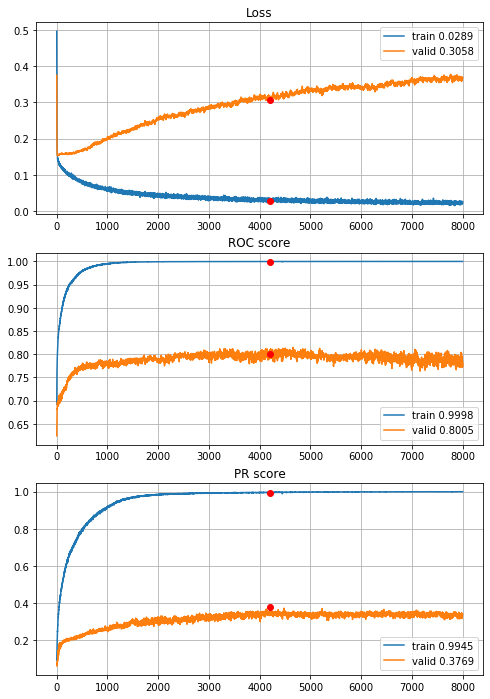


Fold 2------------------------------------------------------------


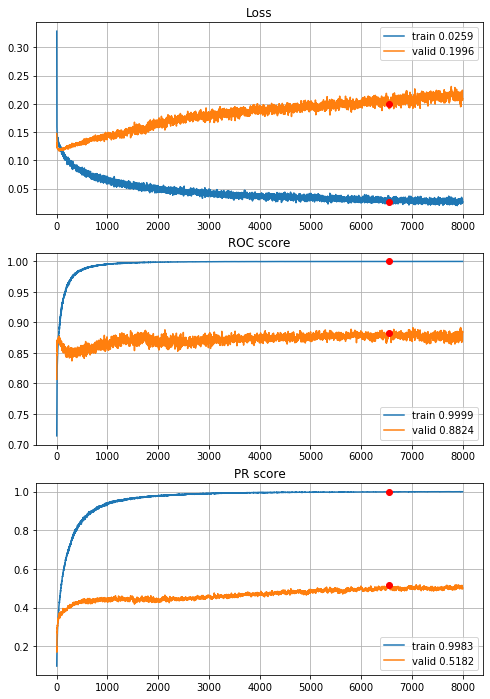


Fold 3------------------------------------------------------------


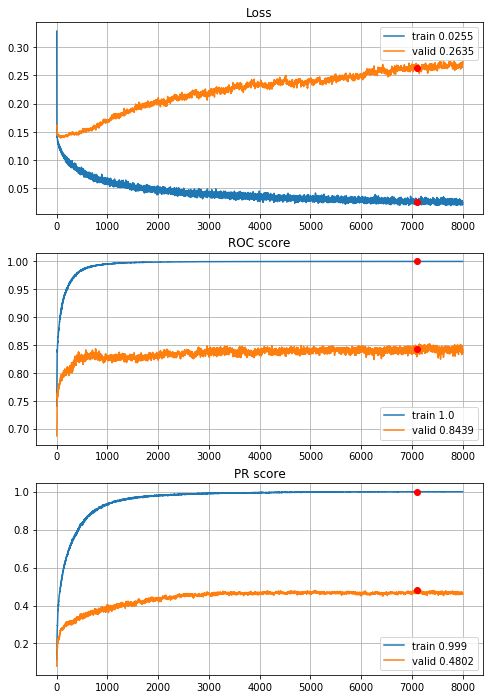


Fold 4------------------------------------------------------------


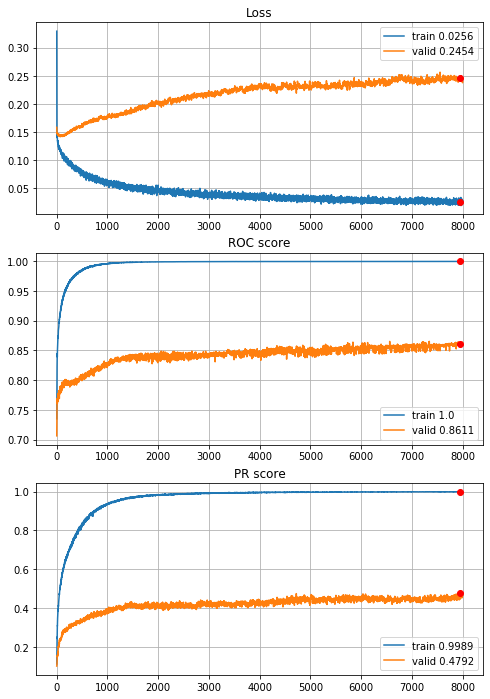


Fold 5------------------------------------------------------------


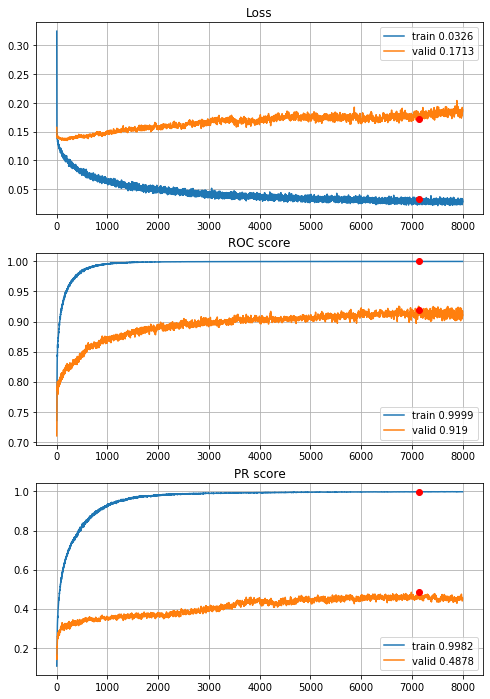


Fold 6------------------------------------------------------------


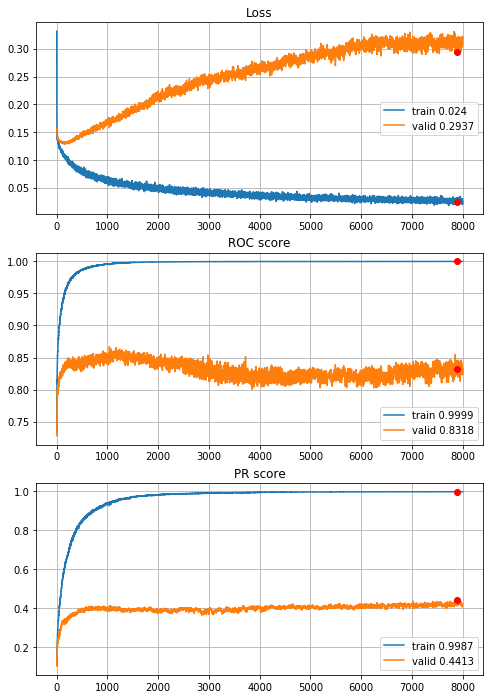

In [71]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=8000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\1year\MLP_standard_8000ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

Much worse results.

##### Best model for 4-year horizon


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/8000,
cumulative time: 9.12s train loss: 0.5026826123358855, validation loss: 0.38103504436518254
Epoch: 2/8000,
cumulative time: 9.22s train loss: 0.3795477439149281, validation loss: 0.2868145681649051
Epoch: 3/8000,
cumulative time: 9.33s train loss: 0.2906697043205348, validation loss: 0.2327833532495336
Epoch: 4/8000,
cumulative time: 9.42s train loss: 0.24330445474872553, validation loss: 0.2019129537993183
Epoch: 5/8000,
cumulative time: 9.52s train loss: 0.2118062642821777, validation loss: 0.18450302270150953
Epoch: 6/8000,
cumulative time: 9.62s train loss: 0.19824258552782903, validation loss: 0.17400923179041955
Epoch: 7/8000,
cumulative time: 9.73s train loss: 0.1826737413087425, validation loss: 0.1681957603971239
Epoch: 8/8000,
cumulative time: 9.83s train loss: 0.17361250511269868, validation loss: 0.16421189856144688
Epoch: 9/8000,
cumulative time: 9.94s train loss: 0.17413559088048

Epoch: 77/8000,
cumulative time: 16.97s train loss: 0.13250150181480333, validation loss: 0.16233505384971791
Epoch: 78/8000,
cumulative time: 17.09s train loss: 0.1312218011895891, validation loss: 0.1627173622260736
Epoch: 79/8000,
cumulative time: 17.2s train loss: 0.12704026975034535, validation loss: 0.16289056970453353
Epoch: 80/8000,
cumulative time: 17.31s train loss: 0.12937540430610953, validation loss: 0.16302320075555363
Epoch: 81/8000,
cumulative time: 17.42s train loss: 0.1316554976482319, validation loss: 0.16308894787386655
Epoch: 82/8000,
cumulative time: 17.53s train loss: 0.12840820589938698, validation loss: 0.16296941861934408
Epoch: 83/8000,
cumulative time: 17.64s train loss: 0.12848658678484143, validation loss: 0.16365143634110293
Epoch: 84/8000,
cumulative time: 17.74s train loss: 0.1318619930992995, validation loss: 0.16323200710810565
Epoch: 85/8000,
cumulative time: 17.85s train loss: 0.1293047317008592, validation loss: 0.16283262183136912
Epoch: 86/8000,


Epoch: 227/8000,
cumulative time: 32.44s train loss: 0.11782398472135389, validation loss: 0.16582683622271557
Epoch: 228/8000,
cumulative time: 32.54s train loss: 0.11666739826749806, validation loss: 0.16476606372637811
Epoch: 229/8000,
cumulative time: 32.64s train loss: 0.11370054121770715, validation loss: 0.1655083246090833
Epoch: 230/8000,
cumulative time: 32.75s train loss: 0.11251185923192714, validation loss: 0.16436275206435563
Epoch: 231/8000,
cumulative time: 32.85s train loss: 0.11792862418706775, validation loss: 0.16498388694970387
Epoch: 232/8000,
cumulative time: 32.96s train loss: 0.11504122698273107, validation loss: 0.16524914673315733
Epoch: 233/8000,
cumulative time: 33.06s train loss: 0.11399767807697209, validation loss: 0.16575940114497234
Epoch: 234/8000,
cumulative time: 33.17s train loss: 0.11595299878993569, validation loss: 0.16441652031732013
Epoch: 235/8000,
cumulative time: 33.27s train loss: 0.11850112135711159, validation loss: 0.16491225797265938
Ep

Epoch: 303/8000,
cumulative time: 40.41s train loss: 0.11135500953930379, validation loss: 0.16678667274892217
Epoch: 304/8000,
cumulative time: 40.51s train loss: 0.11326213594123127, validation loss: 0.1664489825773963
Epoch: 305/8000,
cumulative time: 40.62s train loss: 0.10958862586876474, validation loss: 0.1661861745015041
Epoch: 306/8000,
cumulative time: 40.72s train loss: 0.11273630075086, validation loss: 0.16742882234321826
Epoch: 307/8000,
cumulative time: 40.83s train loss: 0.10962931794985648, validation loss: 0.1671444052367328
Epoch: 308/8000,
cumulative time: 40.94s train loss: 0.11056622420022338, validation loss: 0.1671549035996142
Epoch: 309/8000,
cumulative time: 41.04s train loss: 0.11076095132210223, validation loss: 0.16678352359915594
Epoch: 310/8000,
cumulative time: 41.15s train loss: 0.11186218847868791, validation loss: 0.16552250553806094
Epoch: 311/8000,
cumulative time: 41.26s train loss: 0.10549378465486432, validation loss: 0.16541564359949934
Epoch: 3

Epoch: 378/8000,
cumulative time: 48.35s train loss: 0.10322810358295405, validation loss: 0.16921282018158423
Epoch: 379/8000,
cumulative time: 48.45s train loss: 0.1058166747555787, validation loss: 0.1692186857819331
Epoch: 380/8000,
cumulative time: 48.54s train loss: 0.10286075504782982, validation loss: 0.1699681618804045
Epoch: 381/8000,
cumulative time: 48.64s train loss: 0.10476270160537064, validation loss: 0.1712496524121775
Epoch: 382/8000,
cumulative time: 48.74s train loss: 0.10720576380416609, validation loss: 0.1704579648301995
Epoch: 383/8000,
cumulative time: 48.84s train loss: 0.10531775219616898, validation loss: 0.17119738742341578
Epoch: 384/8000,
cumulative time: 48.94s train loss: 0.10703778957110428, validation loss: 0.16947061750875253
Epoch: 385/8000,
cumulative time: 49.04s train loss: 0.10510649156581744, validation loss: 0.16897753785864453
Epoch: 386/8000,
cumulative time: 49.14s train loss: 0.10846923107892784, validation loss: 0.1678494519820928
Epoch: 

cumulative time: 55.99s train loss: 0.10169382072433801, validation loss: 0.17344644453652217
Epoch: 454/8000,
cumulative time: 56.09s train loss: 0.10070823536199681, validation loss: 0.1733476721471356
Epoch: 455/8000,
cumulative time: 56.18s train loss: 0.1018070369987153, validation loss: 0.17421998994060892
Epoch: 456/8000,
cumulative time: 56.27s train loss: 0.10567197638229808, validation loss: 0.17297991864255982
Epoch: 457/8000,
cumulative time: 56.38s train loss: 0.10475141540933153, validation loss: 0.1720491988722242
Epoch: 458/8000,
cumulative time: 56.48s train loss: 0.10325286396879851, validation loss: 0.17343997780014486
Epoch: 459/8000,
cumulative time: 56.58s train loss: 0.10226941675060841, validation loss: 0.17211789675975886
Epoch: 460/8000,
cumulative time: 56.69s train loss: 0.10009435797269249, validation loss: 0.17259005424646093
Epoch: 461/8000,
cumulative time: 56.8s train loss: 0.1039342870946401, validation loss: 0.17146548628807068
Epoch: 462/8000,
cumula

Epoch: 529/8000,
cumulative time: 63.63s train loss: 0.09714567972739462, validation loss: 0.17407721784354613
Epoch: 530/8000,
cumulative time: 63.73s train loss: 0.09725056704861842, validation loss: 0.17342072439713993
Epoch: 531/8000,
cumulative time: 63.82s train loss: 0.10168595265109354, validation loss: 0.1737483463319022
Epoch: 532/8000,
cumulative time: 63.91s train loss: 0.09716177938870053, validation loss: 0.1751778530384603
Epoch: 533/8000,
cumulative time: 64.02s train loss: 0.09860666246070356, validation loss: 0.17530197233131306
Epoch: 534/8000,
cumulative time: 64.12s train loss: 0.09724177143039921, validation loss: 0.17472940304473863
Epoch: 535/8000,
cumulative time: 64.22s train loss: 0.09824030094795932, validation loss: 0.17521958644068897
Epoch: 536/8000,
cumulative time: 64.32s train loss: 0.10095902596241609, validation loss: 0.1752731726845935
Epoch: 537/8000,
cumulative time: 64.41s train loss: 0.09814888319491888, validation loss: 0.17570622372785602
Epoc

Epoch: 604/8000,
cumulative time: 71.16s train loss: 0.09472679186760814, validation loss: 0.17644829669193254
Epoch: 605/8000,
cumulative time: 71.27s train loss: 0.09477524728827051, validation loss: 0.17520689444026186
Epoch: 606/8000,
cumulative time: 71.38s train loss: 0.09502740162910728, validation loss: 0.17695646615702468
Epoch: 607/8000,
cumulative time: 71.48s train loss: 0.09452412819217686, validation loss: 0.1785017042730067
Epoch: 608/8000,
cumulative time: 71.58s train loss: 0.0969774691412752, validation loss: 0.17741988030963876
Epoch: 609/8000,
cumulative time: 71.68s train loss: 0.09547828919407991, validation loss: 0.177024551937657
Epoch: 610/8000,
cumulative time: 71.78s train loss: 0.09778911624619811, validation loss: 0.17918987331851835
Epoch: 611/8000,
cumulative time: 71.89s train loss: 0.09643377580271727, validation loss: 0.17795073194340918
Epoch: 612/8000,
cumulative time: 71.98s train loss: 0.09372303964856453, validation loss: 0.17605924289638222
Epoch

Epoch: 679/8000,
cumulative time: 78.89s train loss: 0.09862260803212704, validation loss: 0.1803895827997794
Epoch: 680/8000,
cumulative time: 78.99s train loss: 0.09427548989059803, validation loss: 0.17990059684078427
Epoch: 681/8000,
cumulative time: 79.09s train loss: 0.09264356326276482, validation loss: 0.18054699764871507
Epoch: 682/8000,
cumulative time: 79.19s train loss: 0.09957163145861092, validation loss: 0.18134412209042108
Epoch: 683/8000,
cumulative time: 79.29s train loss: 0.09603500667344461, validation loss: 0.1808254619816449
Epoch: 684/8000,
cumulative time: 79.4s train loss: 0.09428633167293538, validation loss: 0.1802765716581236
Epoch: 685/8000,
cumulative time: 79.5s train loss: 0.0922323561681742, validation loss: 0.1818084239790064
Epoch: 686/8000,
cumulative time: 79.6s train loss: 0.09211923299636515, validation loss: 0.1804072797524635
Epoch: 687/8000,
cumulative time: 79.71s train loss: 0.09252029155191932, validation loss: 0.18250273368842687
Epoch: 688

Epoch: 755/8000,
cumulative time: 87.02s train loss: 0.0902472544242354, validation loss: 0.186277882678459
Epoch: 756/8000,
cumulative time: 87.13s train loss: 0.09180179438226815, validation loss: 0.1855920163854476
Epoch: 757/8000,
cumulative time: 87.24s train loss: 0.09365960817635625, validation loss: 0.1856537339413641
Epoch: 758/8000,
cumulative time: 87.38s train loss: 0.09206164544006452, validation loss: 0.18666308397246945
Epoch: 759/8000,
cumulative time: 87.48s train loss: 0.0872033193976083, validation loss: 0.18636358966184974
Epoch: 760/8000,
cumulative time: 87.59s train loss: 0.09016589590081454, validation loss: 0.18711854455253885
Epoch: 761/8000,
cumulative time: 87.7s train loss: 0.09257372339067016, validation loss: 0.18551715029371757
Epoch: 762/8000,
cumulative time: 87.8s train loss: 0.09198979051956868, validation loss: 0.18582339760135202
Epoch: 763/8000,
cumulative time: 87.9s train loss: 0.08778511128711745, validation loss: 0.18465520565944107
Epoch: 764

Epoch: 832/8000,
cumulative time: 95.11s train loss: 0.08747437235950518, validation loss: 0.18459227929983918
Epoch: 833/8000,
cumulative time: 95.22s train loss: 0.09253798890328724, validation loss: 0.18349179410617764
Epoch: 834/8000,
cumulative time: 95.32s train loss: 0.09045605757317914, validation loss: 0.1847946779551497
Epoch: 835/8000,
cumulative time: 95.43s train loss: 0.0927337337193385, validation loss: 0.18594936164099532
Epoch: 836/8000,
cumulative time: 95.53s train loss: 0.09414729221496003, validation loss: 0.18587642057005324
Epoch: 837/8000,
cumulative time: 95.64s train loss: 0.09235739004170872, validation loss: 0.18508473966108102
Epoch: 838/8000,
cumulative time: 95.74s train loss: 0.08760447245112407, validation loss: 0.1855918779488533
Epoch: 839/8000,
cumulative time: 95.86s train loss: 0.0902814962351571, validation loss: 0.18585029221802554
Epoch: 840/8000,
cumulative time: 95.98s train loss: 0.09309302184455083, validation loss: 0.1859592696125186
Epoch:

Epoch: 907/8000,
cumulative time: 103.02s train loss: 0.08848775419666373, validation loss: 0.18981575612438245
Epoch: 908/8000,
cumulative time: 103.12s train loss: 0.08525064662523016, validation loss: 0.1918366593812403
Epoch: 909/8000,
cumulative time: 103.23s train loss: 0.09108766566191498, validation loss: 0.189205990627097
Epoch: 910/8000,
cumulative time: 103.33s train loss: 0.08903427240518284, validation loss: 0.18850208069613128
Epoch: 911/8000,
cumulative time: 103.44s train loss: 0.08722973938826366, validation loss: 0.18781912875356438
Epoch: 912/8000,
cumulative time: 103.54s train loss: 0.08718613361695912, validation loss: 0.18989502467511954
Epoch: 913/8000,
cumulative time: 103.64s train loss: 0.0847066656009522, validation loss: 0.18924718447722338
Epoch: 914/8000,
cumulative time: 103.75s train loss: 0.08614867848876079, validation loss: 0.18905859798249527
Epoch: 915/8000,
cumulative time: 103.85s train loss: 0.09218236821397885, validation loss: 0.18761238116467

Epoch: 1054/8000,
cumulative time: 118.38s train loss: 0.08734733313039313, validation loss: 0.19308860444479695
Epoch: 1055/8000,
cumulative time: 118.48s train loss: 0.08304382414191226, validation loss: 0.1946113327309574
Epoch: 1056/8000,
cumulative time: 118.59s train loss: 0.08190555458842463, validation loss: 0.19733564818606658
Epoch: 1057/8000,
cumulative time: 118.69s train loss: 0.08689371711897895, validation loss: 0.1988470936635866
Epoch: 1058/8000,
cumulative time: 118.8s train loss: 0.08182157403321148, validation loss: 0.19858825014483544
Epoch: 1059/8000,
cumulative time: 118.9s train loss: 0.08177149905991056, validation loss: 0.19675830147976667
Epoch: 1060/8000,
cumulative time: 119.0s train loss: 0.08192067847956516, validation loss: 0.19911066814550185
Epoch: 1061/8000,
cumulative time: 119.15s train loss: 0.08580123103971274, validation loss: 0.1999594934242274
Epoch: 1062/8000,
cumulative time: 119.28s train loss: 0.08466487148850874, validation loss: 0.2010265

cumulative time: 125.85s train loss: 0.08500851470927585, validation loss: 0.20170592970481635
Epoch: 1128/8000,
cumulative time: 125.95s train loss: 0.0843018857815234, validation loss: 0.20251495613092715
Epoch: 1129/8000,
cumulative time: 126.04s train loss: 0.08642604999541105, validation loss: 0.20289485722045067
Epoch: 1130/8000,
cumulative time: 126.13s train loss: 0.08411931062728675, validation loss: 0.20030161809084313
Epoch: 1131/8000,
cumulative time: 126.23s train loss: 0.0877918737069253, validation loss: 0.2001907423675852
Epoch: 1132/8000,
cumulative time: 126.33s train loss: 0.08968090383615168, validation loss: 0.20165032038086958
Epoch: 1133/8000,
cumulative time: 126.42s train loss: 0.08406203543268978, validation loss: 0.2019109523782694
Epoch: 1134/8000,
cumulative time: 126.52s train loss: 0.08664183835348775, validation loss: 0.2032565745106232
Epoch: 1135/8000,
cumulative time: 126.63s train loss: 0.08312173214877126, validation loss: 0.2036098329742674
Epoch: 

cumulative time: 133.37s train loss: 0.08307706334502693, validation loss: 0.2004435251288441
Epoch: 1202/8000,
cumulative time: 133.47s train loss: 0.08177488571778646, validation loss: 0.20036386066528153
Epoch: 1203/8000,
cumulative time: 133.57s train loss: 0.08340206923108173, validation loss: 0.20102454278003107
Epoch: 1204/8000,
cumulative time: 133.67s train loss: 0.08337087032351594, validation loss: 0.20454111491706384
Epoch: 1205/8000,
cumulative time: 133.77s train loss: 0.08180578373641172, validation loss: 0.20635324097335678
Epoch: 1206/8000,
cumulative time: 133.87s train loss: 0.08553588156936517, validation loss: 0.20785473224899575
Epoch: 1207/8000,
cumulative time: 133.97s train loss: 0.08466960078483514, validation loss: 0.2077382100035615
Epoch: 1208/8000,
cumulative time: 134.06s train loss: 0.08622071411623222, validation loss: 0.2076573154731765
Epoch: 1209/8000,
cumulative time: 134.16s train loss: 0.08314044732579244, validation loss: 0.2078131415246786
Epoch

cumulative time: 140.93s train loss: 0.08697587457225717, validation loss: 0.20168366550381314
Epoch: 1276/8000,
cumulative time: 141.02s train loss: 0.08095374518203102, validation loss: 0.20235574070145101
Epoch: 1277/8000,
cumulative time: 141.13s train loss: 0.08707759723039009, validation loss: 0.20283566929923064
Epoch: 1278/8000,
cumulative time: 141.24s train loss: 0.08457252872397371, validation loss: 0.2023822879542436
Epoch: 1279/8000,
cumulative time: 141.34s train loss: 0.08932995103737887, validation loss: 0.20236298682228213
Epoch: 1280/8000,
cumulative time: 141.44s train loss: 0.09033530378251194, validation loss: 0.2036231057806757
Epoch: 1281/8000,
cumulative time: 141.54s train loss: 0.08286816341912046, validation loss: 0.20497471501297923
Epoch: 1282/8000,
cumulative time: 141.65s train loss: 0.08472185584184568, validation loss: 0.20417513295414325
Epoch: 1283/8000,
cumulative time: 141.75s train loss: 0.08121619916024425, validation loss: 0.20705940544718357
Epo

Epoch: 1348/8000,
cumulative time: 148.12s train loss: 0.08311168313931243, validation loss: 0.20659943549863755
Epoch: 1349/8000,
cumulative time: 148.24s train loss: 0.08607290701293854, validation loss: 0.20547371845430848
Epoch: 1350/8000,
cumulative time: 148.34s train loss: 0.08308242917682912, validation loss: 0.2078988782821163
Epoch: 1351/8000,
cumulative time: 148.45s train loss: 0.08218440484870543, validation loss: 0.2103170885419936
Epoch: 1352/8000,
cumulative time: 148.54s train loss: 0.08540595683642085, validation loss: 0.2087214406459562
Epoch: 1353/8000,
cumulative time: 148.64s train loss: 0.08142239703059875, validation loss: 0.2077226143408093
Epoch: 1354/8000,
cumulative time: 148.74s train loss: 0.08426540192407495, validation loss: 0.20724492549783138
Epoch: 1355/8000,
cumulative time: 148.83s train loss: 0.0805341284912949, validation loss: 0.20747694050790688
Epoch: 1356/8000,
cumulative time: 148.93s train loss: 0.08668991213335711, validation loss: 0.208233

Epoch: 1421/8000,
cumulative time: 155.53s train loss: 0.08193894896154386, validation loss: 0.20742984605242676
Epoch: 1422/8000,
cumulative time: 155.63s train loss: 0.08112400033329198, validation loss: 0.20898299312229626
Epoch: 1423/8000,
cumulative time: 155.75s train loss: 0.07923403032675413, validation loss: 0.20842319913561927
Epoch: 1424/8000,
cumulative time: 155.84s train loss: 0.08719240326639371, validation loss: 0.20685835326871566
Epoch: 1425/8000,
cumulative time: 155.95s train loss: 0.08251949626902928, validation loss: 0.20672768408139244
Epoch: 1426/8000,
cumulative time: 156.06s train loss: 0.07979530398884127, validation loss: 0.20849311088814454
Epoch: 1427/8000,
cumulative time: 156.16s train loss: 0.08420552707911669, validation loss: 0.2089553514117308
Epoch: 1428/8000,
cumulative time: 156.26s train loss: 0.08269315556228952, validation loss: 0.2076872113307468
Epoch: 1429/8000,
cumulative time: 156.35s train loss: 0.08453857976752395, validation loss: 0.206

Epoch: 1494/8000,
cumulative time: 162.9s train loss: 0.07959903773959492, validation loss: 0.2108846610479156
Epoch: 1495/8000,
cumulative time: 163.01s train loss: 0.08402891727252748, validation loss: 0.21060934501648854
Epoch: 1496/8000,
cumulative time: 163.1s train loss: 0.08138369746661729, validation loss: 0.2104575664822924
Epoch: 1497/8000,
cumulative time: 163.2s train loss: 0.0787474985649735, validation loss: 0.21098561649983025
Epoch: 1498/8000,
cumulative time: 163.31s train loss: 0.0798801792626476, validation loss: 0.2124760234887505
Epoch: 1499/8000,
cumulative time: 163.41s train loss: 0.08329149487461944, validation loss: 0.21043384425780354
Epoch: 1500/8000,
cumulative time: 163.52s train loss: 0.07798420920317721, validation loss: 0.21059853109960538
Epoch: 1501/8000,
cumulative time: 163.62s train loss: 0.07816348230533401, validation loss: 0.21060573042456973
Epoch: 1502/8000,
cumulative time: 163.72s train loss: 0.07810194802804508, validation loss: 0.211861737

Epoch: 1568/8000,
cumulative time: 170.43s train loss: 0.07920056019805415, validation loss: 0.21202179667958726
Epoch: 1569/8000,
cumulative time: 170.52s train loss: 0.08086349090147742, validation loss: 0.21207863765378152
Epoch: 1570/8000,
cumulative time: 170.62s train loss: 0.08327562492870967, validation loss: 0.21226880901565587
Epoch: 1571/8000,
cumulative time: 170.72s train loss: 0.08408370210137041, validation loss: 0.21051427235639525
Epoch: 1572/8000,
cumulative time: 170.81s train loss: 0.08022978037765402, validation loss: 0.2126934972558121
Epoch: 1573/8000,
cumulative time: 170.92s train loss: 0.08698809608336418, validation loss: 0.21508918925978426
Epoch: 1574/8000,
cumulative time: 171.02s train loss: 0.08111362447520361, validation loss: 0.2146324201767992
Epoch: 1575/8000,
cumulative time: 171.12s train loss: 0.07752144766487253, validation loss: 0.21621013702771696
Epoch: 1576/8000,
cumulative time: 171.22s train loss: 0.08251420784833535, validation loss: 0.218

Epoch: 1641/8000,
cumulative time: 177.82s train loss: 0.08001216508066405, validation loss: 0.21535982658107547
Epoch: 1642/8000,
cumulative time: 177.93s train loss: 0.07720562026215685, validation loss: 0.2132558727060821
Epoch: 1643/8000,
cumulative time: 178.05s train loss: 0.07907699278964037, validation loss: 0.21480615974264308
Epoch: 1644/8000,
cumulative time: 178.16s train loss: 0.07849835977382406, validation loss: 0.21401811160670287
Epoch: 1645/8000,
cumulative time: 178.27s train loss: 0.08071009106863382, validation loss: 0.2143843325537115
Epoch: 1646/8000,
cumulative time: 178.39s train loss: 0.0780814562692701, validation loss: 0.21691252443889966
Epoch: 1647/8000,
cumulative time: 178.48s train loss: 0.08008066893217686, validation loss: 0.21717851652818568
Epoch: 1648/8000,
cumulative time: 178.58s train loss: 0.07923748934291572, validation loss: 0.21847087433261256
Epoch: 1649/8000,
cumulative time: 178.69s train loss: 0.0760693926484354, validation loss: 0.21759

Epoch: 1715/8000,
cumulative time: 185.49s train loss: 0.07955817456517998, validation loss: 0.22039435990508185
Epoch: 1716/8000,
cumulative time: 185.59s train loss: 0.07840150122511319, validation loss: 0.22003475552605045
Epoch: 1717/8000,
cumulative time: 185.69s train loss: 0.07394444190771575, validation loss: 0.22113055773998347
Epoch: 1718/8000,
cumulative time: 185.79s train loss: 0.07848120954106835, validation loss: 0.22105230727503378
Epoch: 1719/8000,
cumulative time: 185.89s train loss: 0.07824517908087265, validation loss: 0.22204399838393282
Epoch: 1720/8000,
cumulative time: 185.98s train loss: 0.07837422073057074, validation loss: 0.22149608865295461
Epoch: 1721/8000,
cumulative time: 186.07s train loss: 0.07306378588532814, validation loss: 0.21977255243164764
Epoch: 1722/8000,
cumulative time: 186.16s train loss: 0.0814366512961926, validation loss: 0.2183553724067261
Epoch: 1723/8000,
cumulative time: 186.26s train loss: 0.08018412044452082, validation loss: 0.218

Epoch: 1789/8000,
cumulative time: 192.84s train loss: 0.08178008529843596, validation loss: 0.2230551814275177
Epoch: 1790/8000,
cumulative time: 192.94s train loss: 0.08016472153888708, validation loss: 0.22359974413714329
Epoch: 1791/8000,
cumulative time: 193.05s train loss: 0.07612203383213881, validation loss: 0.2252201538045221
Epoch: 1792/8000,
cumulative time: 193.15s train loss: 0.08134446651224167, validation loss: 0.22680605512529442
Epoch: 1793/8000,
cumulative time: 193.26s train loss: 0.08039791916251408, validation loss: 0.2255008402483739
Epoch: 1794/8000,
cumulative time: 193.36s train loss: 0.07750510509908765, validation loss: 0.22471423430166843
Epoch: 1795/8000,
cumulative time: 193.46s train loss: 0.077180231488407, validation loss: 0.2241591419847912
Epoch: 1796/8000,
cumulative time: 193.57s train loss: 0.08268500635191883, validation loss: 0.22060899826675032
Epoch: 1797/8000,
cumulative time: 193.66s train loss: 0.07875995227830233, validation loss: 0.2193078

cumulative time: 200.76s train loss: 0.07818914006059491, validation loss: 0.2206765898773747
Epoch: 1864/8000,
cumulative time: 200.86s train loss: 0.07667170361080251, validation loss: 0.21991478641865603
Epoch: 1865/8000,
cumulative time: 200.97s train loss: 0.0787586215551257, validation loss: 0.2193061145591555
Epoch: 1866/8000,
cumulative time: 201.07s train loss: 0.07879036129991289, validation loss: 0.2167999155720452
Epoch: 1867/8000,
cumulative time: 201.16s train loss: 0.07846023262367077, validation loss: 0.21766833751771664
Epoch: 1868/8000,
cumulative time: 201.27s train loss: 0.07856357151066329, validation loss: 0.2164308009156692
Epoch: 1869/8000,
cumulative time: 201.36s train loss: 0.07498893899952665, validation loss: 0.2178821854109556
Epoch: 1870/8000,
cumulative time: 201.48s train loss: 0.08008740090356832, validation loss: 0.21701350171946032
Epoch: 1871/8000,
cumulative time: 201.57s train loss: 0.08096769963739267, validation loss: 0.2150533443610175
Epoch: 1

Epoch: 1938/8000,
cumulative time: 208.64s train loss: 0.08080386724994576, validation loss: 0.21896678788951499
Epoch: 1939/8000,
cumulative time: 208.75s train loss: 0.07747513080966541, validation loss: 0.2176157439116961
Epoch: 1940/8000,
cumulative time: 208.85s train loss: 0.07869359174958895, validation loss: 0.21662897323973943
Epoch: 1941/8000,
cumulative time: 208.95s train loss: 0.07723247721451962, validation loss: 0.2175031527452722
Epoch: 1942/8000,
cumulative time: 209.06s train loss: 0.07412715186232408, validation loss: 0.21990883353199858
Epoch: 1943/8000,
cumulative time: 209.17s train loss: 0.07967244680737635, validation loss: 0.22122031501167413
Epoch: 1944/8000,
cumulative time: 209.27s train loss: 0.07624057864724346, validation loss: 0.22088554343191
Epoch: 1945/8000,
cumulative time: 209.38s train loss: 0.07298637280343154, validation loss: 0.22178898655599164
Epoch: 1946/8000,
cumulative time: 209.49s train loss: 0.07866341559608701, validation loss: 0.221724

Epoch: 2013/8000,
cumulative time: 216.57s train loss: 0.07793741628838671, validation loss: 0.2316832233368785
Epoch: 2014/8000,
cumulative time: 216.68s train loss: 0.0767528472026453, validation loss: 0.23174768969049037
Epoch: 2015/8000,
cumulative time: 216.78s train loss: 0.07925841956058309, validation loss: 0.22651511306328384
Epoch: 2016/8000,
cumulative time: 216.89s train loss: 0.07408975338319447, validation loss: 0.22747335397767388
Epoch: 2017/8000,
cumulative time: 216.99s train loss: 0.07412977550581691, validation loss: 0.22597985953601532
Epoch: 2018/8000,
cumulative time: 217.1s train loss: 0.07603923231646051, validation loss: 0.22918638892372825
Epoch: 2019/8000,
cumulative time: 217.21s train loss: 0.07358675021854931, validation loss: 0.22689890132004667
Epoch: 2020/8000,
cumulative time: 217.31s train loss: 0.0771454209493618, validation loss: 0.226814096634483
Epoch: 2021/8000,
cumulative time: 217.42s train loss: 0.07553376453085688, validation loss: 0.2274395

Epoch: 2087/8000,
cumulative time: 224.33s train loss: 0.07154305677655978, validation loss: 0.22692642280340647
Epoch: 2088/8000,
cumulative time: 224.43s train loss: 0.07817365453354096, validation loss: 0.228389111540123
Epoch: 2089/8000,
cumulative time: 224.54s train loss: 0.07296172146043922, validation loss: 0.22945314413908538
Epoch: 2090/8000,
cumulative time: 224.64s train loss: 0.08004577576661698, validation loss: 0.22762424093043782
Epoch: 2091/8000,
cumulative time: 224.75s train loss: 0.07587788084087155, validation loss: 0.2267117313969972
Epoch: 2092/8000,
cumulative time: 224.85s train loss: 0.07994610394653379, validation loss: 0.22312879700927626
Epoch: 2093/8000,
cumulative time: 224.96s train loss: 0.07983025211197602, validation loss: 0.22230397026271928
Epoch: 2094/8000,
cumulative time: 225.06s train loss: 0.08250297256506824, validation loss: 0.22322358301287584
Epoch: 2095/8000,
cumulative time: 225.17s train loss: 0.07944930913156531, validation loss: 0.2262

Epoch: 2161/8000,
cumulative time: 232.13s train loss: 0.072149453054852, validation loss: 0.2346030076156305
Epoch: 2162/8000,
cumulative time: 232.23s train loss: 0.07801121706443448, validation loss: 0.23493041559007632
Epoch: 2163/8000,
cumulative time: 232.34s train loss: 0.07386394008372042, validation loss: 0.2356490434290562
Epoch: 2164/8000,
cumulative time: 232.49s train loss: 0.07280267050076254, validation loss: 0.23302901048474792
Epoch: 2165/8000,
cumulative time: 232.59s train loss: 0.07588543978288233, validation loss: 0.23341768406034646
Epoch: 2166/8000,
cumulative time: 232.68s train loss: 0.08031916183894906, validation loss: 0.23297361404665054
Epoch: 2167/8000,
cumulative time: 232.78s train loss: 0.07618027624640564, validation loss: 0.23067568152068463
Epoch: 2168/8000,
cumulative time: 232.89s train loss: 0.07740573248555584, validation loss: 0.23164632472525964
Epoch: 2169/8000,
cumulative time: 232.99s train loss: 0.07566668143534797, validation loss: 0.22917

Epoch: 2235/8000,
cumulative time: 239.81s train loss: 0.07555443642544339, validation loss: 0.23120288451889662
Epoch: 2236/8000,
cumulative time: 239.92s train loss: 0.0798148854817679, validation loss: 0.22752244221983192
Epoch: 2237/8000,
cumulative time: 240.04s train loss: 0.07389356443054083, validation loss: 0.2259747180698945
Epoch: 2238/8000,
cumulative time: 240.13s train loss: 0.07564309950797789, validation loss: 0.22740764732152732
Epoch: 2239/8000,
cumulative time: 240.22s train loss: 0.07706350511120212, validation loss: 0.22706543805477064
Epoch: 2240/8000,
cumulative time: 240.33s train loss: 0.06990506814145951, validation loss: 0.227004202425593
Epoch: 2241/8000,
cumulative time: 240.42s train loss: 0.0776190753906004, validation loss: 0.2233173106947253
Epoch: 2242/8000,
cumulative time: 240.52s train loss: 0.07436444219166459, validation loss: 0.22292987776096676
Epoch: 2243/8000,
cumulative time: 240.63s train loss: 0.07416142168149098, validation loss: 0.2252602

Epoch: 2308/8000,
cumulative time: 247.35s train loss: 0.07525609181858105, validation loss: 0.2308784790011918
Epoch: 2309/8000,
cumulative time: 247.46s train loss: 0.07999018609410671, validation loss: 0.22814279322493008
Epoch: 2310/8000,
cumulative time: 247.56s train loss: 0.07769311422188775, validation loss: 0.22807674579308201
Epoch: 2311/8000,
cumulative time: 247.67s train loss: 0.07185013547709364, validation loss: 0.22901165672000037
Epoch: 2312/8000,
cumulative time: 247.77s train loss: 0.07697234555541678, validation loss: 0.22797395631077166
Epoch: 2313/8000,
cumulative time: 247.88s train loss: 0.07060288729347586, validation loss: 0.22835278762698852
Epoch: 2314/8000,
cumulative time: 247.98s train loss: 0.07310670479792798, validation loss: 0.22974200583499568
Epoch: 2315/8000,
cumulative time: 248.1s train loss: 0.07330300160586495, validation loss: 0.22907444026031348
Epoch: 2316/8000,
cumulative time: 248.21s train loss: 0.07367378645903472, validation loss: 0.228

cumulative time: 255.08s train loss: 0.07482218049622125, validation loss: 0.23187715660575672
Epoch: 2383/8000,
cumulative time: 255.18s train loss: 0.0755915328648217, validation loss: 0.23077545268372748
Epoch: 2384/8000,
cumulative time: 255.27s train loss: 0.0779300105328578, validation loss: 0.22940449982146385
Epoch: 2385/8000,
cumulative time: 255.36s train loss: 0.07382990047477002, validation loss: 0.23203561046431143
Epoch: 2386/8000,
cumulative time: 255.46s train loss: 0.0766226728851474, validation loss: 0.23292927254535667
Epoch: 2387/8000,
cumulative time: 255.56s train loss: 0.07202888731994937, validation loss: 0.2331576476852627
Epoch: 2388/8000,
cumulative time: 255.66s train loss: 0.08014167094960159, validation loss: 0.2317519127417787
Epoch: 2389/8000,
cumulative time: 255.77s train loss: 0.0747034393519559, validation loss: 0.23202447369836088
Epoch: 2390/8000,
cumulative time: 255.87s train loss: 0.07443671913170724, validation loss: 0.23348573698490802
Epoch: 

Epoch: 2456/8000,
cumulative time: 262.84s train loss: 0.0768414998062987, validation loss: 0.23625109153861565
Epoch: 2457/8000,
cumulative time: 262.94s train loss: 0.07435354350498777, validation loss: 0.24050146805041203
Epoch: 2458/8000,
cumulative time: 263.04s train loss: 0.07275923119267658, validation loss: 0.23750440852691823
Epoch: 2459/8000,
cumulative time: 263.14s train loss: 0.0717306547983774, validation loss: 0.23918239557426388
Epoch: 2460/8000,
cumulative time: 263.24s train loss: 0.0739452071007221, validation loss: 0.2393862631673831
Epoch: 2461/8000,
cumulative time: 263.35s train loss: 0.0800453641580902, validation loss: 0.23943188560303066
Epoch: 2462/8000,
cumulative time: 263.47s train loss: 0.07168502368075345, validation loss: 0.23813668719052816
Epoch: 2463/8000,
cumulative time: 263.57s train loss: 0.07471351872076346, validation loss: 0.23700290186016112
Epoch: 2464/8000,
cumulative time: 263.67s train loss: 0.07157273087261751, validation loss: 0.242185

Epoch: 2530/8000,
cumulative time: 270.23s train loss: 0.07801184609277877, validation loss: 0.23160571134180905
Epoch: 2531/8000,
cumulative time: 270.34s train loss: 0.07126235854891491, validation loss: 0.23424983018942078
Epoch: 2532/8000,
cumulative time: 270.44s train loss: 0.07645688941119065, validation loss: 0.23439129833591504
Epoch: 2533/8000,
cumulative time: 270.54s train loss: 0.07510790911978517, validation loss: 0.2354884156409432
Epoch: 2534/8000,
cumulative time: 270.65s train loss: 0.07929693512915434, validation loss: 0.23614211841371524
Epoch: 2535/8000,
cumulative time: 270.75s train loss: 0.07033937595205017, validation loss: 0.2363444802826677
Epoch: 2536/8000,
cumulative time: 270.85s train loss: 0.07785044738729494, validation loss: 0.2384613538037215
Epoch: 2537/8000,
cumulative time: 270.96s train loss: 0.07010016758030234, validation loss: 0.23780373943372288
Epoch: 2538/8000,
cumulative time: 271.06s train loss: 0.07833961194250344, validation loss: 0.2365

Epoch: 2605/8000,
cumulative time: 277.99s train loss: 0.07451815496303099, validation loss: 0.2403661345168807
Epoch: 2606/8000,
cumulative time: 278.09s train loss: 0.0763972170806474, validation loss: 0.24003299952005752
Epoch: 2607/8000,
cumulative time: 278.19s train loss: 0.07391061880104456, validation loss: 0.239827263598424
Epoch: 2608/8000,
cumulative time: 278.29s train loss: 0.07266657599292173, validation loss: 0.23974629586290364
Epoch: 2609/8000,
cumulative time: 278.4s train loss: 0.07622920967200224, validation loss: 0.23845485582297396
Epoch: 2610/8000,
cumulative time: 278.51s train loss: 0.07446216607088156, validation loss: 0.23910357682935654
Epoch: 2611/8000,
cumulative time: 278.6s train loss: 0.07393053361626459, validation loss: 0.24038380715267935
Epoch: 2612/8000,
cumulative time: 278.7s train loss: 0.07702604662733015, validation loss: 0.24022269302685753
Epoch: 2613/8000,
cumulative time: 278.8s train loss: 0.07596855923476889, validation loss: 0.241112512

Epoch: 2679/8000,
cumulative time: 285.42s train loss: 0.0726938835569645, validation loss: 0.23793636194555765
Epoch: 2680/8000,
cumulative time: 285.52s train loss: 0.07308355867579946, validation loss: 0.23910500024369366
Epoch: 2681/8000,
cumulative time: 285.62s train loss: 0.07404692205662293, validation loss: 0.23817492837697776
Epoch: 2682/8000,
cumulative time: 285.72s train loss: 0.07092282113953152, validation loss: 0.23639969722821996
Epoch: 2683/8000,
cumulative time: 285.82s train loss: 0.07427061412207768, validation loss: 0.2365657799440724
Epoch: 2684/8000,
cumulative time: 285.93s train loss: 0.07413595846696869, validation loss: 0.23837256369373605
Epoch: 2685/8000,
cumulative time: 286.04s train loss: 0.07537303956426977, validation loss: 0.23773228624513978
Epoch: 2686/8000,
cumulative time: 286.14s train loss: 0.07479637749705188, validation loss: 0.23962732346505775
Epoch: 2687/8000,
cumulative time: 286.24s train loss: 0.07224747146951632, validation loss: 0.238

Epoch: 2752/8000,
cumulative time: 292.98s train loss: 0.07274819944739568, validation loss: 0.23761789376301376
Epoch: 2753/8000,
cumulative time: 293.08s train loss: 0.07121156899141858, validation loss: 0.23892873734857822
Epoch: 2754/8000,
cumulative time: 293.18s train loss: 0.07172239042210624, validation loss: 0.23951474324123231
Epoch: 2755/8000,
cumulative time: 293.28s train loss: 0.07022463697268569, validation loss: 0.24074858910557895
Epoch: 2756/8000,
cumulative time: 293.38s train loss: 0.07203844078804103, validation loss: 0.24088400975576615
Epoch: 2757/8000,
cumulative time: 293.48s train loss: 0.07868989849113196, validation loss: 0.2397990857853609
Epoch: 2758/8000,
cumulative time: 293.57s train loss: 0.07028074188748167, validation loss: 0.24018763214971806
Epoch: 2759/8000,
cumulative time: 293.66s train loss: 0.07231960110437033, validation loss: 0.23811036817715336
Epoch: 2760/8000,
cumulative time: 293.76s train loss: 0.06705937428113631, validation loss: 0.23

Epoch: 2826/8000,
cumulative time: 300.43s train loss: 0.07196571676933562, validation loss: 0.24536401892975115
Epoch: 2827/8000,
cumulative time: 300.53s train loss: 0.07243852360311903, validation loss: 0.24592737025056438
Epoch: 2828/8000,
cumulative time: 300.64s train loss: 0.07415894666789152, validation loss: 0.2482665233186798
Epoch: 2829/8000,
cumulative time: 300.74s train loss: 0.0702575938101059, validation loss: 0.2487488212010892
Epoch: 2830/8000,
cumulative time: 300.84s train loss: 0.0720057262485914, validation loss: 0.24751967197351257
Epoch: 2831/8000,
cumulative time: 300.95s train loss: 0.0706111950301468, validation loss: 0.24691033730923112
Epoch: 2832/8000,
cumulative time: 301.05s train loss: 0.0727723389807417, validation loss: 0.24933147108079812
Epoch: 2833/8000,
cumulative time: 301.15s train loss: 0.070771433777782, validation loss: 0.2489973499211686
Epoch: 2834/8000,
cumulative time: 301.25s train loss: 0.06972622434684629, validation loss: 0.2486254476

Epoch: 2901/8000,
cumulative time: 308.17s train loss: 0.07209746199580479, validation loss: 0.24719975812385386
Epoch: 2902/8000,
cumulative time: 308.27s train loss: 0.07231965320612493, validation loss: 0.24577376393484662
Epoch: 2903/8000,
cumulative time: 308.38s train loss: 0.06987328311212827, validation loss: 0.24559071360322057
Epoch: 2904/8000,
cumulative time: 308.48s train loss: 0.07579339736015792, validation loss: 0.2443835524103447
Epoch: 2905/8000,
cumulative time: 308.58s train loss: 0.07378703233356494, validation loss: 0.2423544808006377
Epoch: 2906/8000,
cumulative time: 308.68s train loss: 0.07532032532670466, validation loss: 0.24320679413865143
Epoch: 2907/8000,
cumulative time: 308.79s train loss: 0.07243693419069448, validation loss: 0.24482706290947193
Epoch: 2908/8000,
cumulative time: 308.9s train loss: 0.07285926766990485, validation loss: 0.24442378738347223
Epoch: 2909/8000,
cumulative time: 309.0s train loss: 0.07454384392166273, validation loss: 0.24564

Epoch: 2975/8000,
cumulative time: 315.96s train loss: 0.07492204541075388, validation loss: 0.2420100320618338
Epoch: 2976/8000,
cumulative time: 316.06s train loss: 0.07142460788308556, validation loss: 0.24365720859741125
Epoch: 2977/8000,
cumulative time: 316.16s train loss: 0.07411361160834781, validation loss: 0.24558737449899345
Epoch: 2978/8000,
cumulative time: 316.26s train loss: 0.07391030609579421, validation loss: 0.246135618558871
Epoch: 2979/8000,
cumulative time: 316.37s train loss: 0.07102238062974171, validation loss: 0.2462547159059224
Epoch: 2980/8000,
cumulative time: 316.47s train loss: 0.06905846442228476, validation loss: 0.2467211239760922
Epoch: 2981/8000,
cumulative time: 316.58s train loss: 0.07270813511659796, validation loss: 0.2480580096735674
Epoch: 2982/8000,
cumulative time: 316.68s train loss: 0.07338731246638117, validation loss: 0.249885828518777
Epoch: 2983/8000,
cumulative time: 316.78s train loss: 0.070677785394427, validation loss: 0.25151134504

Epoch: 3049/8000,
cumulative time: 323.58s train loss: 0.07571105255941513, validation loss: 0.2483864059314782
Epoch: 3050/8000,
cumulative time: 323.69s train loss: 0.06838283460919499, validation loss: 0.24906889104639557
Epoch: 3051/8000,
cumulative time: 323.81s train loss: 0.07540308073643714, validation loss: 0.24932132828167766
Epoch: 3052/8000,
cumulative time: 323.9s train loss: 0.07173668978845373, validation loss: 0.24701563086523276
Epoch: 3053/8000,
cumulative time: 324.0s train loss: 0.07263543519140195, validation loss: 0.24816008350428412
Epoch: 3054/8000,
cumulative time: 324.1s train loss: 0.07446975517714047, validation loss: 0.2501051240164143
Epoch: 3055/8000,
cumulative time: 324.2s train loss: 0.06821532011512788, validation loss: 0.2505860470617066
Epoch: 3056/8000,
cumulative time: 324.3s train loss: 0.0730790030684824, validation loss: 0.24728784191314365
Epoch: 3057/8000,
cumulative time: 324.41s train loss: 0.07647428717004733, validation loss: 0.2436419170

Epoch: 3122/8000,
cumulative time: 331.14s train loss: 0.07088177966296785, validation loss: 0.2486918532135817
Epoch: 3123/8000,
cumulative time: 331.25s train loss: 0.07048723975185878, validation loss: 0.24920828592392705
Epoch: 3124/8000,
cumulative time: 331.35s train loss: 0.07132385107609081, validation loss: 0.24888097055157402
Epoch: 3125/8000,
cumulative time: 331.45s train loss: 0.07341667024924135, validation loss: 0.24787213482259574
Epoch: 3126/8000,
cumulative time: 331.56s train loss: 0.07229505478628899, validation loss: 0.24933297731392298
Epoch: 3127/8000,
cumulative time: 331.66s train loss: 0.07422343546655417, validation loss: 0.24512707078705703
Epoch: 3128/8000,
cumulative time: 331.78s train loss: 0.0726561533446217, validation loss: 0.2485275901924727
Epoch: 3129/8000,
cumulative time: 331.89s train loss: 0.07353453575659974, validation loss: 0.250527802720468
Epoch: 3130/8000,
cumulative time: 331.99s train loss: 0.07297247583064227, validation loss: 0.248710

cumulative time: 338.99s train loss: 0.07462669220493233, validation loss: 0.24693822456378864
Epoch: 3197/8000,
cumulative time: 339.12s train loss: 0.06689165209259208, validation loss: 0.24542174365307845
Epoch: 3198/8000,
cumulative time: 339.22s train loss: 0.0722883584589275, validation loss: 0.24532422383777105
Epoch: 3199/8000,
cumulative time: 339.33s train loss: 0.07192137460356872, validation loss: 0.2452239364215952
Epoch: 3200/8000,
cumulative time: 339.44s train loss: 0.07579456019644719, validation loss: 0.25008400695034405
Epoch: 3201/8000,
cumulative time: 339.55s train loss: 0.07266999864685694, validation loss: 0.25423017766263045
Epoch: 3202/8000,
cumulative time: 339.66s train loss: 0.06861182724388998, validation loss: 0.25533330765688894
Epoch: 3203/8000,
cumulative time: 339.77s train loss: 0.07269838951683587, validation loss: 0.2527540441482298
Epoch: 3204/8000,
cumulative time: 339.88s train loss: 0.07678474413630405, validation loss: 0.2531579282467008
Epoch

Epoch: 3271/8000,
cumulative time: 346.95s train loss: 0.07085529508411997, validation loss: 0.25370222584572416
Epoch: 3272/8000,
cumulative time: 347.05s train loss: 0.06709655294834549, validation loss: 0.251307939583934
Epoch: 3273/8000,
cumulative time: 347.15s train loss: 0.07331126776631688, validation loss: 0.2511888956209288
Epoch: 3274/8000,
cumulative time: 347.25s train loss: 0.07360755214343939, validation loss: 0.2490656731590148
Epoch: 3275/8000,
cumulative time: 347.35s train loss: 0.07088139248866962, validation loss: 0.25159063494182854
Epoch: 3276/8000,
cumulative time: 347.45s train loss: 0.07180129538451019, validation loss: 0.2541939021005124
Epoch: 3277/8000,
cumulative time: 347.55s train loss: 0.06956907593745887, validation loss: 0.2531056547470292
Epoch: 3278/8000,
cumulative time: 347.65s train loss: 0.07424619637245924, validation loss: 0.2543801109976289
Epoch: 3279/8000,
cumulative time: 347.75s train loss: 0.07205393511582824, validation loss: 0.25985511

Epoch: 3346/8000,
cumulative time: 354.54s train loss: 0.07274963352157676, validation loss: 0.24957373922079293
Epoch: 3347/8000,
cumulative time: 354.64s train loss: 0.07128436632836113, validation loss: 0.24879834966370004
Epoch: 3348/8000,
cumulative time: 354.73s train loss: 0.07166641774592634, validation loss: 0.24610382114913476
Epoch: 3349/8000,
cumulative time: 354.84s train loss: 0.07239958007291553, validation loss: 0.24954508394851177
Epoch: 3350/8000,
cumulative time: 354.94s train loss: 0.07202087512815926, validation loss: 0.2508781323849137
Epoch: 3351/8000,
cumulative time: 355.04s train loss: 0.0736540674654311, validation loss: 0.2509323462589416
Epoch: 3352/8000,
cumulative time: 355.14s train loss: 0.07049978518932776, validation loss: 0.250176793823206
Epoch: 3353/8000,
cumulative time: 355.24s train loss: 0.07065342737952039, validation loss: 0.24781199336843654
Epoch: 3354/8000,
cumulative time: 355.34s train loss: 0.07024136618119037, validation loss: 0.248864

Epoch: 3421/8000,
cumulative time: 362.13s train loss: 0.06670165390228637, validation loss: 0.2556764750937583
Epoch: 3422/8000,
cumulative time: 362.23s train loss: 0.06995271203555238, validation loss: 0.255842171849743
Epoch: 3423/8000,
cumulative time: 362.33s train loss: 0.06841989747854745, validation loss: 0.25513931537715034
Epoch: 3424/8000,
cumulative time: 362.43s train loss: 0.07362456274779064, validation loss: 0.2504740389915752
Epoch: 3425/8000,
cumulative time: 362.53s train loss: 0.07322258820343741, validation loss: 0.2532733928207202
Epoch: 3426/8000,
cumulative time: 362.64s train loss: 0.07265520983250137, validation loss: 0.25313297982912586
Epoch: 3427/8000,
cumulative time: 362.75s train loss: 0.07489332351020662, validation loss: 0.25040848982967506
Epoch: 3428/8000,
cumulative time: 362.85s train loss: 0.07211892724715781, validation loss: 0.25276878693863836
Epoch: 3429/8000,
cumulative time: 362.95s train loss: 0.07499817846452489, validation loss: 0.249872

Epoch: 3495/8000,
cumulative time: 369.69s train loss: 0.06998525027334125, validation loss: 0.254971683901899
Epoch: 3496/8000,
cumulative time: 369.79s train loss: 0.07060194280868011, validation loss: 0.2596072317922817
Epoch: 3497/8000,
cumulative time: 369.9s train loss: 0.0746671093115318, validation loss: 0.2618044916490902
Epoch: 3498/8000,
cumulative time: 370.0s train loss: 0.0705949394269166, validation loss: 0.2580004989874657
Epoch: 3499/8000,
cumulative time: 370.11s train loss: 0.07168843583318721, validation loss: 0.2595771592131602
Epoch: 3500/8000,
cumulative time: 370.22s train loss: 0.06862260311898516, validation loss: 0.26161484558849224
Epoch: 3501/8000,
cumulative time: 370.32s train loss: 0.0712704973935063, validation loss: 0.26047010742396515
Epoch: 3502/8000,
cumulative time: 370.42s train loss: 0.07397597026383854, validation loss: 0.2569490595945145
Epoch: 3503/8000,
cumulative time: 370.52s train loss: 0.0661676387010987, validation loss: 0.25702818001017

Epoch: 3571/8000,
cumulative time: 377.56s train loss: 0.06838454636524254, validation loss: 0.2620659521453973
Epoch: 3572/8000,
cumulative time: 377.67s train loss: 0.06964900170009322, validation loss: 0.26231871553797426
Epoch: 3573/8000,
cumulative time: 377.77s train loss: 0.07576606135525558, validation loss: 0.2618563278406802
Epoch: 3574/8000,
cumulative time: 377.87s train loss: 0.07088872741278707, validation loss: 0.2616934659245797
Epoch: 3575/8000,
cumulative time: 377.97s train loss: 0.06814731603781683, validation loss: 0.2610406063256725
Epoch: 3576/8000,
cumulative time: 378.07s train loss: 0.07196426044096305, validation loss: 0.25712262874423214
Epoch: 3577/8000,
cumulative time: 378.17s train loss: 0.07398351164255468, validation loss: 0.2596227888307716
Epoch: 3578/8000,
cumulative time: 378.27s train loss: 0.06855177757042183, validation loss: 0.25580134665491006
Epoch: 3579/8000,
cumulative time: 378.37s train loss: 0.0728348099416302, validation loss: 0.2597969

Epoch: 3646/8000,
cumulative time: 385.17s train loss: 0.07074354102082225, validation loss: 0.25489915384287176
Epoch: 3647/8000,
cumulative time: 385.27s train loss: 0.07470939455437253, validation loss: 0.253838694751602
Epoch: 3648/8000,
cumulative time: 385.38s train loss: 0.07323099775575596, validation loss: 0.2514057111355566
Epoch: 3649/8000,
cumulative time: 385.48s train loss: 0.07514668374659893, validation loss: 0.2529733184110055
Epoch: 3650/8000,
cumulative time: 385.58s train loss: 0.07613172713645948, validation loss: 0.2547757608049056
Epoch: 3651/8000,
cumulative time: 385.68s train loss: 0.06811896324638397, validation loss: 0.2580446410337481
Epoch: 3652/8000,
cumulative time: 385.79s train loss: 0.07236510570491514, validation loss: 0.2558738982315534
Epoch: 3653/8000,
cumulative time: 385.89s train loss: 0.07136425515053621, validation loss: 0.2577400117603606
Epoch: 3654/8000,
cumulative time: 385.99s train loss: 0.07129789070425947, validation loss: 0.260554144

cumulative time: 392.53s train loss: 0.07208299355500111, validation loss: 0.25646396097241136
Epoch: 3720/8000,
cumulative time: 392.63s train loss: 0.07425333633594766, validation loss: 0.260233937478156
Epoch: 3721/8000,
cumulative time: 392.72s train loss: 0.07004702758376241, validation loss: 0.2585780664967405
Epoch: 3722/8000,
cumulative time: 392.81s train loss: 0.07117408362325048, validation loss: 0.25668750086930037
Epoch: 3723/8000,
cumulative time: 392.91s train loss: 0.07461364555404128, validation loss: 0.2589389192933602
Epoch: 3724/8000,
cumulative time: 393.0s train loss: 0.0673503868804937, validation loss: 0.25967390054882816
Epoch: 3725/8000,
cumulative time: 393.1s train loss: 0.07229503428376151, validation loss: 0.2597412705930406
Epoch: 3726/8000,
cumulative time: 393.19s train loss: 0.07319617374063217, validation loss: 0.2525589203416057
Epoch: 3727/8000,
cumulative time: 393.28s train loss: 0.07073392021475074, validation loss: 0.2514798370608795
Epoch: 3728

Epoch: 3867/8000,
cumulative time: 407.79s train loss: 0.07315871498248835, validation loss: 0.25792018953265455
Epoch: 3868/8000,
cumulative time: 407.89s train loss: 0.07315962522147502, validation loss: 0.25874170078498365
Epoch: 3869/8000,
cumulative time: 407.99s train loss: 0.06953920296179501, validation loss: 0.2634692060879557
Epoch: 3870/8000,
cumulative time: 408.09s train loss: 0.0714841309956061, validation loss: 0.2642399988206107
Epoch: 3871/8000,
cumulative time: 408.19s train loss: 0.07547361522177817, validation loss: 0.2634723361800699
Epoch: 3872/8000,
cumulative time: 408.29s train loss: 0.07129692438233509, validation loss: 0.26209517589556425
Epoch: 3873/8000,
cumulative time: 408.39s train loss: 0.07138046813418336, validation loss: 0.2627004676514378
Epoch: 3874/8000,
cumulative time: 408.48s train loss: 0.0717120021468548, validation loss: 0.2655029755220015
Epoch: 3875/8000,
cumulative time: 408.58s train loss: 0.07065975476317886, validation loss: 0.26117817

cumulative time: 415.42s train loss: 0.06699352144940528, validation loss: 0.26974376959750956
Epoch: 3941/8000,
cumulative time: 415.51s train loss: 0.06750939711080105, validation loss: 0.27109560291274
Epoch: 3942/8000,
cumulative time: 415.6s train loss: 0.07410976358139763, validation loss: 0.2663649268010083
Epoch: 3943/8000,
cumulative time: 415.7s train loss: 0.07100372271050312, validation loss: 0.265862147937011
Epoch: 3944/8000,
cumulative time: 415.79s train loss: 0.07577143662822992, validation loss: 0.26555630892684834
Epoch: 3945/8000,
cumulative time: 415.88s train loss: 0.06821433709089625, validation loss: 0.2636539942003518
Epoch: 3946/8000,
cumulative time: 415.97s train loss: 0.07225885018706321, validation loss: 0.2623004319828421
Epoch: 3947/8000,
cumulative time: 416.07s train loss: 0.06886131408601377, validation loss: 0.26391923328617717
Epoch: 3948/8000,
cumulative time: 416.17s train loss: 0.07312457548062082, validation loss: 0.26334904015516647
Epoch: 3949

Epoch: 4015/8000,
cumulative time: 422.95s train loss: 0.06924439624121564, validation loss: 0.26501361870222795
Epoch: 4016/8000,
cumulative time: 423.06s train loss: 0.07260478991711163, validation loss: 0.2624211886180194
Epoch: 4017/8000,
cumulative time: 423.16s train loss: 0.06782327017108901, validation loss: 0.26516600756197317
Epoch: 4018/8000,
cumulative time: 423.26s train loss: 0.06990859687215237, validation loss: 0.2646856230225916
Epoch: 4019/8000,
cumulative time: 423.36s train loss: 0.06311812363211525, validation loss: 0.2645990293494212
Epoch: 4020/8000,
cumulative time: 423.45s train loss: 0.06693512744339186, validation loss: 0.26692433578918284
Epoch: 4021/8000,
cumulative time: 423.55s train loss: 0.06924754393479629, validation loss: 0.26651699162411735
Epoch: 4022/8000,
cumulative time: 423.64s train loss: 0.07221856701843427, validation loss: 0.26803572026330563
Epoch: 4023/8000,
cumulative time: 423.73s train loss: 0.06927733157657129, validation loss: 0.2678

Epoch: 4090/8000,
cumulative time: 430.99s train loss: 0.07560920175553726, validation loss: 0.2622170962068116
Epoch: 4091/8000,
cumulative time: 431.11s train loss: 0.0666520922881263, validation loss: 0.26428840667065906
Epoch: 4092/8000,
cumulative time: 431.22s train loss: 0.07421082900077161, validation loss: 0.26391424204751257
Epoch: 4093/8000,
cumulative time: 431.34s train loss: 0.06799456209113973, validation loss: 0.2633975208993202
Epoch: 4094/8000,
cumulative time: 431.44s train loss: 0.07167866835953841, validation loss: 0.2617790107482751
Epoch: 4095/8000,
cumulative time: 431.53s train loss: 0.06917391920027516, validation loss: 0.2640620617079328
Epoch: 4096/8000,
cumulative time: 431.63s train loss: 0.07197303681915354, validation loss: 0.2639691901501035
Epoch: 4097/8000,
cumulative time: 431.73s train loss: 0.0706509305089995, validation loss: 0.26532352550319294
Epoch: 4098/8000,
cumulative time: 431.82s train loss: 0.06892951579598366, validation loss: 0.26227312

Epoch: 4164/8000,
cumulative time: 438.86s train loss: 0.07105962416931166, validation loss: 0.2763937540931991
Epoch: 4165/8000,
cumulative time: 438.97s train loss: 0.07058185375449327, validation loss: 0.277563899444448
Epoch: 4166/8000,
cumulative time: 439.06s train loss: 0.06606644679433481, validation loss: 0.27470186075630404
Epoch: 4167/8000,
cumulative time: 439.16s train loss: 0.0720330957514172, validation loss: 0.26858501023201153
Epoch: 4168/8000,
cumulative time: 439.26s train loss: 0.06932456560814629, validation loss: 0.2666696103349809
Epoch: 4169/8000,
cumulative time: 439.36s train loss: 0.0664268846020979, validation loss: 0.26531959908963154
Epoch: 4170/8000,
cumulative time: 439.47s train loss: 0.07142574756461031, validation loss: 0.268303776007902
Epoch: 4171/8000,
cumulative time: 439.57s train loss: 0.07015181479434814, validation loss: 0.2667457879550995
Epoch: 4172/8000,
cumulative time: 439.67s train loss: 0.07370202095730255, validation loss: 0.2679857821

Epoch: 4239/8000,
cumulative time: 446.77s train loss: 0.0689976230730255, validation loss: 0.27136866329856346
Epoch: 4240/8000,
cumulative time: 446.87s train loss: 0.07059083855101235, validation loss: 0.27176577763267895
Epoch: 4241/8000,
cumulative time: 446.98s train loss: 0.07019099540994335, validation loss: 0.2704402943772654
Epoch: 4242/8000,
cumulative time: 447.09s train loss: 0.06537080706155504, validation loss: 0.2692149258598657
Epoch: 4243/8000,
cumulative time: 447.2s train loss: 0.0662991644097121, validation loss: 0.2681256667542955
Epoch: 4244/8000,
cumulative time: 447.31s train loss: 0.06658290624194399, validation loss: 0.26859977700000015
Epoch: 4245/8000,
cumulative time: 447.42s train loss: 0.06703466682693085, validation loss: 0.26927399923724515
Epoch: 4246/8000,
cumulative time: 447.53s train loss: 0.06817992541097825, validation loss: 0.2734180860207248
Epoch: 4247/8000,
cumulative time: 447.63s train loss: 0.06880187332149475, validation loss: 0.27222958

Epoch: 4312/8000,
cumulative time: 454.46s train loss: 0.07078645293100735, validation loss: 0.26779666904932636
Epoch: 4313/8000,
cumulative time: 454.56s train loss: 0.06651577598060104, validation loss: 0.2713049253770477
Epoch: 4314/8000,
cumulative time: 454.66s train loss: 0.07139633964796673, validation loss: 0.27130602981605384
Epoch: 4315/8000,
cumulative time: 454.76s train loss: 0.06670410503020097, validation loss: 0.2742636771536869
Epoch: 4316/8000,
cumulative time: 454.87s train loss: 0.06790556288562871, validation loss: 0.27279130789315226
Epoch: 4317/8000,
cumulative time: 454.98s train loss: 0.07764725208254196, validation loss: 0.2678375245837152
Epoch: 4318/8000,
cumulative time: 455.09s train loss: 0.07190749163702272, validation loss: 0.264576752594119
Epoch: 4319/8000,
cumulative time: 455.19s train loss: 0.06870506625530616, validation loss: 0.2656638905321172
Epoch: 4320/8000,
cumulative time: 455.29s train loss: 0.06698239229803293, validation loss: 0.2681660

Epoch: 4388/8000,
cumulative time: 462.38s train loss: 0.06970165510161778, validation loss: 0.26908786965276077
Epoch: 4389/8000,
cumulative time: 462.49s train loss: 0.07013055727988537, validation loss: 0.2681725671270993
Epoch: 4390/8000,
cumulative time: 462.58s train loss: 0.06727845866438108, validation loss: 0.26900165393750625
Epoch: 4391/8000,
cumulative time: 462.68s train loss: 0.07398446011418862, validation loss: 0.26729090885034773
Epoch: 4392/8000,
cumulative time: 462.79s train loss: 0.06968156039092753, validation loss: 0.2689259941539457
Epoch: 4393/8000,
cumulative time: 462.89s train loss: 0.07383258974416432, validation loss: 0.2689861213290035
Epoch: 4394/8000,
cumulative time: 462.99s train loss: 0.07499787203501027, validation loss: 0.2675328779209271
Epoch: 4395/8000,
cumulative time: 463.1s train loss: 0.07111026870768934, validation loss: 0.266583989393779
Epoch: 4396/8000,
cumulative time: 463.2s train loss: 0.06843872760798944, validation loss: 0.265075279

Epoch: 4462/8000,
cumulative time: 470.06s train loss: 0.06759276228198743, validation loss: 0.2712045439167312
Epoch: 4463/8000,
cumulative time: 470.16s train loss: 0.07012628632291897, validation loss: 0.2704335511918312
Epoch: 4464/8000,
cumulative time: 470.26s train loss: 0.07232075587084669, validation loss: 0.2689136216095322
Epoch: 4465/8000,
cumulative time: 470.36s train loss: 0.06961884800153846, validation loss: 0.2669965108499581
Epoch: 4466/8000,
cumulative time: 470.45s train loss: 0.0678692665976071, validation loss: 0.2652262707984877
Epoch: 4467/8000,
cumulative time: 470.56s train loss: 0.07202239427326752, validation loss: 0.26674467845478816
Epoch: 4468/8000,
cumulative time: 470.66s train loss: 0.06707796091372872, validation loss: 0.2668797149264609
Epoch: 4469/8000,
cumulative time: 470.76s train loss: 0.06834319596809725, validation loss: 0.27353358212186896
Epoch: 4470/8000,
cumulative time: 470.86s train loss: 0.06804579033090448, validation loss: 0.27449029

cumulative time: 477.91s train loss: 0.06927312488404352, validation loss: 0.2773391071431325
Epoch: 4538/8000,
cumulative time: 478.0s train loss: 0.06975361046432543, validation loss: 0.2755856022832516
Epoch: 4539/8000,
cumulative time: 478.1s train loss: 0.06662117429431068, validation loss: 0.2754018948019343
Epoch: 4540/8000,
cumulative time: 478.21s train loss: 0.07041612587996407, validation loss: 0.2749235739461385
Epoch: 4541/8000,
cumulative time: 478.31s train loss: 0.07155561716043067, validation loss: 0.2768039068585329
Epoch: 4542/8000,
cumulative time: 478.41s train loss: 0.07182294084943223, validation loss: 0.2766607933071578
Epoch: 4543/8000,
cumulative time: 478.52s train loss: 0.06501729462924899, validation loss: 0.27712307904318567
Epoch: 4544/8000,
cumulative time: 478.61s train loss: 0.06821354896508765, validation loss: 0.27874238633566606
Epoch: 4545/8000,
cumulative time: 478.72s train loss: 0.07099115415361394, validation loss: 0.2724814278124858
Epoch: 454

Epoch: 4611/8000,
cumulative time: 485.59s train loss: 0.07385084994094875, validation loss: 0.2782445168246354
Epoch: 4612/8000,
cumulative time: 485.7s train loss: 0.06899016061391279, validation loss: 0.27535141260845614
Epoch: 4613/8000,
cumulative time: 485.8s train loss: 0.07104184395108774, validation loss: 0.27699828470228294
Epoch: 4614/8000,
cumulative time: 485.91s train loss: 0.06782037504512173, validation loss: 0.27460292210728215
Epoch: 4615/8000,
cumulative time: 486.02s train loss: 0.06628419463531568, validation loss: 0.27614093720347427
Epoch: 4616/8000,
cumulative time: 486.13s train loss: 0.06956103296925718, validation loss: 0.2795533445686724
Epoch: 4617/8000,
cumulative time: 486.23s train loss: 0.06905949228854967, validation loss: 0.27906566496365887
Epoch: 4618/8000,
cumulative time: 486.34s train loss: 0.07442430839847342, validation loss: 0.2759580972411827
Epoch: 4619/8000,
cumulative time: 486.45s train loss: 0.07126044147494169, validation loss: 0.271910

cumulative time: 493.37s train loss: 0.07289432756730004, validation loss: 0.2829655651462598
Epoch: 4686/8000,
cumulative time: 493.46s train loss: 0.07068596782562177, validation loss: 0.283951410589001
Epoch: 4687/8000,
cumulative time: 493.56s train loss: 0.07039772464100279, validation loss: 0.2824572995163684
Epoch: 4688/8000,
cumulative time: 493.67s train loss: 0.06819148705936473, validation loss: 0.2805335907375111
Epoch: 4689/8000,
cumulative time: 493.8s train loss: 0.07211949437913225, validation loss: 0.2787036618652561
Epoch: 4690/8000,
cumulative time: 493.9s train loss: 0.06556034693936243, validation loss: 0.276275234215626
Epoch: 4691/8000,
cumulative time: 494.0s train loss: 0.0741906716104816, validation loss: 0.2762298329788096
Epoch: 4692/8000,
cumulative time: 494.1s train loss: 0.06805548193869826, validation loss: 0.2814560594493117
Epoch: 4693/8000,
cumulative time: 494.2s train loss: 0.07041976172512351, validation loss: 0.2811008417515872
Epoch: 4694/8000,


Epoch: 4760/8000,
cumulative time: 501.24s train loss: 0.0695516222031112, validation loss: 0.27437115773077936
Epoch: 4761/8000,
cumulative time: 501.34s train loss: 0.0686973308433957, validation loss: 0.2762171512423702
Epoch: 4762/8000,
cumulative time: 501.45s train loss: 0.07388036673361933, validation loss: 0.27472161686850227
Epoch: 4763/8000,
cumulative time: 501.55s train loss: 0.0679725147585828, validation loss: 0.27994879805951234
Epoch: 4764/8000,
cumulative time: 501.66s train loss: 0.06895721202019948, validation loss: 0.275932260041445
Epoch: 4765/8000,
cumulative time: 501.77s train loss: 0.07141014828684208, validation loss: 0.27178476349339314
Epoch: 4766/8000,
cumulative time: 501.87s train loss: 0.07356183056134653, validation loss: 0.2707787814357475
Epoch: 4767/8000,
cumulative time: 501.98s train loss: 0.06923524131980748, validation loss: 0.27283519661969435
Epoch: 4768/8000,
cumulative time: 502.09s train loss: 0.07151363084562816, validation loss: 0.27024378

Epoch: 4835/8000,
cumulative time: 509.09s train loss: 0.0673265892510396, validation loss: 0.28487966123409925
Epoch: 4836/8000,
cumulative time: 509.2s train loss: 0.06979785522117335, validation loss: 0.2874267597521957
Epoch: 4837/8000,
cumulative time: 509.31s train loss: 0.07007832723392254, validation loss: 0.2866516601315486
Epoch: 4838/8000,
cumulative time: 509.41s train loss: 0.07073009535387526, validation loss: 0.2845182027208285
Epoch: 4839/8000,
cumulative time: 509.52s train loss: 0.06564242698718746, validation loss: 0.28231729335192257
Epoch: 4840/8000,
cumulative time: 509.63s train loss: 0.06665225212640735, validation loss: 0.2778280362967522
Epoch: 4841/8000,
cumulative time: 509.74s train loss: 0.06850740411787151, validation loss: 0.27786718170375935
Epoch: 4842/8000,
cumulative time: 509.85s train loss: 0.07344447761152004, validation loss: 0.2759673860652171
Epoch: 4843/8000,
cumulative time: 509.96s train loss: 0.0701819361387213, validation loss: 0.272905058

Epoch: 4909/8000,
cumulative time: 517.17s train loss: 0.06500691472777154, validation loss: 0.2805010033117526
Epoch: 4910/8000,
cumulative time: 517.28s train loss: 0.07618213145228446, validation loss: 0.28182582167000203
Epoch: 4911/8000,
cumulative time: 517.39s train loss: 0.0653287165291056, validation loss: 0.2822049319235152
Epoch: 4912/8000,
cumulative time: 517.5s train loss: 0.06898524813509531, validation loss: 0.28229808911992205
Epoch: 4913/8000,
cumulative time: 517.61s train loss: 0.06668562242156867, validation loss: 0.2828599094665933
Epoch: 4914/8000,
cumulative time: 517.72s train loss: 0.07350370811556503, validation loss: 0.27896169059869236
Epoch: 4915/8000,
cumulative time: 517.83s train loss: 0.06711855415233625, validation loss: 0.27777554312512365
Epoch: 4916/8000,
cumulative time: 517.93s train loss: 0.07021100715339976, validation loss: 0.2775610797036531
Epoch: 4917/8000,
cumulative time: 518.04s train loss: 0.0674016586884828, validation loss: 0.27983257

Epoch: 4983/8000,
cumulative time: 524.94s train loss: 0.06913301589875791, validation loss: 0.27512100887479546
Epoch: 4984/8000,
cumulative time: 525.04s train loss: 0.06865332466629696, validation loss: 0.27572817467082383
Epoch: 4985/8000,
cumulative time: 525.15s train loss: 0.07002185283677628, validation loss: 0.27881094222389996
Epoch: 4986/8000,
cumulative time: 525.25s train loss: 0.07023962120997386, validation loss: 0.27776383477098804
Epoch: 4987/8000,
cumulative time: 525.36s train loss: 0.07145956418347992, validation loss: 0.2752401783525152
Epoch: 4988/8000,
cumulative time: 525.47s train loss: 0.06744364547407151, validation loss: 0.272400939204435
Epoch: 4989/8000,
cumulative time: 525.58s train loss: 0.06993359229765989, validation loss: 0.2745974945219011
Epoch: 4990/8000,
cumulative time: 525.68s train loss: 0.06347125041841103, validation loss: 0.27470609565500514
Epoch: 4991/8000,
cumulative time: 525.79s train loss: 0.06833405080030494, validation loss: 0.27530

cumulative time: 532.71s train loss: 0.06834619879100536, validation loss: 0.27065243171899095
Epoch: 5058/8000,
cumulative time: 532.81s train loss: 0.06728069324901706, validation loss: 0.27155925788734625
Epoch: 5059/8000,
cumulative time: 532.92s train loss: 0.07169190545971073, validation loss: 0.27375534779093524
Epoch: 5060/8000,
cumulative time: 533.04s train loss: 0.06779590688462049, validation loss: 0.2702041808127
Epoch: 5061/8000,
cumulative time: 533.15s train loss: 0.0718716215151424, validation loss: 0.2707284718356051
Epoch: 5062/8000,
cumulative time: 533.26s train loss: 0.06831734559906955, validation loss: 0.27178719942325436
Epoch: 5063/8000,
cumulative time: 533.36s train loss: 0.06533367276983423, validation loss: 0.2713727523525028
Epoch: 5064/8000,
cumulative time: 533.46s train loss: 0.06622344957244011, validation loss: 0.27221630400566266
Epoch: 5065/8000,
cumulative time: 533.55s train loss: 0.06541439601038167, validation loss: 0.27016153402866855
Epoch: 5

Epoch: 5131/8000,
cumulative time: 540.33s train loss: 0.0669017247459807, validation loss: 0.2822209550827685
Epoch: 5132/8000,
cumulative time: 540.43s train loss: 0.06781469651655182, validation loss: 0.27887394820716394
Epoch: 5133/8000,
cumulative time: 540.53s train loss: 0.06468449504992993, validation loss: 0.2808993224344398
Epoch: 5134/8000,
cumulative time: 540.64s train loss: 0.06931312348432062, validation loss: 0.2797537560537599
Epoch: 5135/8000,
cumulative time: 540.74s train loss: 0.06417745651935264, validation loss: 0.2756133464923167
Epoch: 5136/8000,
cumulative time: 540.84s train loss: 0.07187776520735173, validation loss: 0.2738522121813537
Epoch: 5137/8000,
cumulative time: 540.95s train loss: 0.07109831921770406, validation loss: 0.271169216882798
Epoch: 5138/8000,
cumulative time: 541.06s train loss: 0.068000194320077, validation loss: 0.27290495805993703
Epoch: 5139/8000,
cumulative time: 541.17s train loss: 0.06938439624726886, validation loss: 0.27359997618

Epoch: 5205/8000,
cumulative time: 548.09s train loss: 0.06619761919698182, validation loss: 0.2857776919001646
Epoch: 5206/8000,
cumulative time: 548.2s train loss: 0.0710823756227344, validation loss: 0.27990825971910127
Epoch: 5207/8000,
cumulative time: 548.31s train loss: 0.06413184960975367, validation loss: 0.2775481334221205
Epoch: 5208/8000,
cumulative time: 548.42s train loss: 0.06686903303754171, validation loss: 0.2777691247963136
Epoch: 5209/8000,
cumulative time: 548.53s train loss: 0.06728686196075671, validation loss: 0.28342269126332914
Epoch: 5210/8000,
cumulative time: 548.64s train loss: 0.06493003430300917, validation loss: 0.28151786615771635
Epoch: 5211/8000,
cumulative time: 548.78s train loss: 0.0646801951431459, validation loss: 0.28471057541117045
Epoch: 5212/8000,
cumulative time: 548.88s train loss: 0.06676868946632579, validation loss: 0.28320711921808617
Epoch: 5213/8000,
cumulative time: 548.98s train loss: 0.06681903557996823, validation loss: 0.2821845

Epoch: 5281/8000,
cumulative time: 556.21s train loss: 0.06755070836482963, validation loss: 0.2806618766155822
Epoch: 5282/8000,
cumulative time: 556.31s train loss: 0.06988325904793259, validation loss: 0.2821850689018474
Epoch: 5283/8000,
cumulative time: 556.41s train loss: 0.07077455941651306, validation loss: 0.28193645894640534
Epoch: 5284/8000,
cumulative time: 556.52s train loss: 0.06808888097585265, validation loss: 0.28117158997669617
Epoch: 5285/8000,
cumulative time: 556.62s train loss: 0.06876324540043013, validation loss: 0.28188301645487945
Epoch: 5286/8000,
cumulative time: 556.72s train loss: 0.06777064336120969, validation loss: 0.2839611197558481
Epoch: 5287/8000,
cumulative time: 556.83s train loss: 0.06791788087115117, validation loss: 0.2828536002527378
Epoch: 5288/8000,
cumulative time: 556.93s train loss: 0.07008734545626269, validation loss: 0.2802328695834701
Epoch: 5289/8000,
cumulative time: 557.03s train loss: 0.07272457556350181, validation loss: 0.279502

Epoch: 5355/8000,
cumulative time: 563.99s train loss: 0.06569152296833566, validation loss: 0.27077462483176246
Epoch: 5356/8000,
cumulative time: 564.1s train loss: 0.06612736315977188, validation loss: 0.272507585910285
Epoch: 5357/8000,
cumulative time: 564.21s train loss: 0.06956227985290242, validation loss: 0.27402627278663627
Epoch: 5358/8000,
cumulative time: 564.3s train loss: 0.07042456974595276, validation loss: 0.27361303140927085
Epoch: 5359/8000,
cumulative time: 564.39s train loss: 0.06977211015556976, validation loss: 0.2764273229880396
Epoch: 5360/8000,
cumulative time: 564.49s train loss: 0.06735900425877019, validation loss: 0.28238928515951817
Epoch: 5361/8000,
cumulative time: 564.59s train loss: 0.06805960852546755, validation loss: 0.2815113482427778
Epoch: 5362/8000,
cumulative time: 564.7s train loss: 0.07070990298968338, validation loss: 0.2798555702593114
Epoch: 5363/8000,
cumulative time: 564.8s train loss: 0.06656736420499305, validation loss: 0.2804534350

Epoch: 5430/8000,
cumulative time: 571.7s train loss: 0.0682046184418776, validation loss: 0.28935991405762124
Epoch: 5431/8000,
cumulative time: 571.81s train loss: 0.06966074806208629, validation loss: 0.28773015324712026
Epoch: 5432/8000,
cumulative time: 571.91s train loss: 0.06609103638092073, validation loss: 0.29036883348192616
Epoch: 5433/8000,
cumulative time: 572.01s train loss: 0.06768186488374361, validation loss: 0.2909612028490208
Epoch: 5434/8000,
cumulative time: 572.11s train loss: 0.0641171940575854, validation loss: 0.28892153320547753
Epoch: 5435/8000,
cumulative time: 572.22s train loss: 0.06451526111030714, validation loss: 0.28377846304673626
Epoch: 5436/8000,
cumulative time: 572.32s train loss: 0.07420656627054685, validation loss: 0.2797544537221684
Epoch: 5437/8000,
cumulative time: 572.42s train loss: 0.06520558969882906, validation loss: 0.28281796546882654
Epoch: 5438/8000,
cumulative time: 572.52s train loss: 0.06918813381662178, validation loss: 0.286568

cumulative time: 579.33s train loss: 0.06673321855842954, validation loss: 0.2772194698198471
Epoch: 5505/8000,
cumulative time: 579.43s train loss: 0.0674787612197182, validation loss: 0.2804821592806865
Epoch: 5506/8000,
cumulative time: 579.52s train loss: 0.06682108954386874, validation loss: 0.284504117193213
Epoch: 5507/8000,
cumulative time: 579.61s train loss: 0.06676846300260618, validation loss: 0.2849323793086427
Epoch: 5508/8000,
cumulative time: 579.7s train loss: 0.06879856522553786, validation loss: 0.28485468801895625
Epoch: 5509/8000,
cumulative time: 579.8s train loss: 0.07462470113552498, validation loss: 0.27957645593037866
Epoch: 5510/8000,
cumulative time: 579.9s train loss: 0.07164023436987649, validation loss: 0.278680641550493
Epoch: 5511/8000,
cumulative time: 580.0s train loss: 0.0726073059371798, validation loss: 0.28367252975871937
Epoch: 5512/8000,
cumulative time: 580.1s train loss: 0.06301616474392292, validation loss: 0.2819713398785926
Epoch: 5513/8000

Epoch: 5578/8000,
cumulative time: 586.83s train loss: 0.0685839050097755, validation loss: 0.28075399943954354
Epoch: 5579/8000,
cumulative time: 586.94s train loss: 0.07335392101835707, validation loss: 0.2799056066903489
Epoch: 5580/8000,
cumulative time: 587.04s train loss: 0.07154637066332846, validation loss: 0.2794202642773315
Epoch: 5581/8000,
cumulative time: 587.14s train loss: 0.06790284357215694, validation loss: 0.27904169125733386
Epoch: 5582/8000,
cumulative time: 587.25s train loss: 0.06517477972288059, validation loss: 0.28088326084885246
Epoch: 5583/8000,
cumulative time: 587.35s train loss: 0.06529187525161304, validation loss: 0.2822690282080612
Epoch: 5584/8000,
cumulative time: 587.44s train loss: 0.0662828479421659, validation loss: 0.2817916674733841
Epoch: 5585/8000,
cumulative time: 587.55s train loss: 0.06304465098981613, validation loss: 0.2806083353296403
Epoch: 5586/8000,
cumulative time: 587.65s train loss: 0.06786847516357107, validation loss: 0.28303166

Epoch: 5651/8000,
cumulative time: 594.35s train loss: 0.06690591840352686, validation loss: 0.2835019173160676
Epoch: 5652/8000,
cumulative time: 594.45s train loss: 0.06384098253705922, validation loss: 0.2823319944077696
Epoch: 5653/8000,
cumulative time: 594.56s train loss: 0.06630420998671928, validation loss: 0.2841177934487359
Epoch: 5654/8000,
cumulative time: 594.66s train loss: 0.06134504545798112, validation loss: 0.2859131128896572
Epoch: 5655/8000,
cumulative time: 594.76s train loss: 0.0660589129213364, validation loss: 0.2871589146031374
Epoch: 5656/8000,
cumulative time: 594.85s train loss: 0.0675336899140415, validation loss: 0.2860875442426164
Epoch: 5657/8000,
cumulative time: 594.95s train loss: 0.0671663153683325, validation loss: 0.28772031520078034
Epoch: 5658/8000,
cumulative time: 595.05s train loss: 0.0751705841672036, validation loss: 0.2862463433443935
Epoch: 5659/8000,
cumulative time: 595.15s train loss: 0.07236482793963611, validation loss: 0.286265639726

cumulative time: 601.77s train loss: 0.06647392510802289, validation loss: 0.28731931963726964
Epoch: 5725/8000,
cumulative time: 601.88s train loss: 0.06721928858072754, validation loss: 0.2894778229310345
Epoch: 5726/8000,
cumulative time: 601.98s train loss: 0.06572174468348103, validation loss: 0.28284407159635194
Epoch: 5727/8000,
cumulative time: 602.08s train loss: 0.07071214691369991, validation loss: 0.2801369363883867
Epoch: 5728/8000,
cumulative time: 602.18s train loss: 0.06937872243928501, validation loss: 0.28280504375865834
Epoch: 5729/8000,
cumulative time: 602.28s train loss: 0.07271644749185618, validation loss: 0.28005372129196915
Epoch: 5730/8000,
cumulative time: 602.38s train loss: 0.06387973914534363, validation loss: 0.2787009752169958
Epoch: 5731/8000,
cumulative time: 602.48s train loss: 0.06670563099817488, validation loss: 0.27959743897082456
Epoch: 5732/8000,
cumulative time: 602.57s train loss: 0.06465118368080264, validation loss: 0.2796612408514041
Epoch

Epoch: 5798/8000,
cumulative time: 609.27s train loss: 0.06511503060753024, validation loss: 0.2828286669059768
Epoch: 5799/8000,
cumulative time: 609.37s train loss: 0.07169680184697064, validation loss: 0.2841648596570433
Epoch: 5800/8000,
cumulative time: 609.48s train loss: 0.06943847201128386, validation loss: 0.2821422772344195
Epoch: 5801/8000,
cumulative time: 609.57s train loss: 0.06549484337303625, validation loss: 0.28192496672979567
Epoch: 5802/8000,
cumulative time: 609.67s train loss: 0.06911863871837703, validation loss: 0.28423773543997555
Epoch: 5803/8000,
cumulative time: 609.77s train loss: 0.06772706777535988, validation loss: 0.2849347904692112
Epoch: 5804/8000,
cumulative time: 609.88s train loss: 0.06902885629426143, validation loss: 0.28434733698671183
Epoch: 5805/8000,
cumulative time: 609.99s train loss: 0.06777503862128764, validation loss: 0.2838063451551622
Epoch: 5806/8000,
cumulative time: 610.08s train loss: 0.06426504752554522, validation loss: 0.288504

Epoch: 5872/8000,
cumulative time: 616.77s train loss: 0.06886295091212362, validation loss: 0.28967870135687335
Epoch: 5873/8000,
cumulative time: 616.86s train loss: 0.07018097075836935, validation loss: 0.2896423385649976
Epoch: 5874/8000,
cumulative time: 616.96s train loss: 0.06754285887279592, validation loss: 0.2917010169723681
Epoch: 5875/8000,
cumulative time: 617.06s train loss: 0.06478614970136864, validation loss: 0.2957009252662677
Epoch: 5876/8000,
cumulative time: 617.16s train loss: 0.0697164037351477, validation loss: 0.2960046897350724
Epoch: 5877/8000,
cumulative time: 617.27s train loss: 0.06650213915183151, validation loss: 0.2946625403649893
Epoch: 5878/8000,
cumulative time: 617.37s train loss: 0.06373530391328022, validation loss: 0.2955257846236908
Epoch: 5879/8000,
cumulative time: 617.47s train loss: 0.0639287542445723, validation loss: 0.2987210136719854
Epoch: 5880/8000,
cumulative time: 617.57s train loss: 0.06602506204251998, validation loss: 0.2948635589

cumulative time: 624.15s train loss: 0.0657419757963471, validation loss: 0.2880502421783541
Epoch: 5946/8000,
cumulative time: 624.24s train loss: 0.06725235275316284, validation loss: 0.2906030706311991
Epoch: 5947/8000,
cumulative time: 624.33s train loss: 0.06830772631845845, validation loss: 0.2903698544800847
Epoch: 5948/8000,
cumulative time: 624.44s train loss: 0.06915594606573713, validation loss: 0.28547990466317824
Epoch: 5949/8000,
cumulative time: 624.54s train loss: 0.06882571020575357, validation loss: 0.28419496611015166
Epoch: 5950/8000,
cumulative time: 624.63s train loss: 0.06273575874444882, validation loss: 0.28624505231570474
Epoch: 5951/8000,
cumulative time: 624.73s train loss: 0.0712917029475917, validation loss: 0.28881731307031533
Epoch: 5952/8000,
cumulative time: 624.83s train loss: 0.06924231873517697, validation loss: 0.28993647569610226
Epoch: 5953/8000,
cumulative time: 624.93s train loss: 0.07221407166044219, validation loss: 0.28507663298263947
Epoch:

Epoch: 6019/8000,
cumulative time: 631.53s train loss: 0.06776205322349999, validation loss: 0.2841715231622645
Epoch: 6020/8000,
cumulative time: 631.64s train loss: 0.06794358227239387, validation loss: 0.2842930560150454
Epoch: 6021/8000,
cumulative time: 631.74s train loss: 0.06278654791174397, validation loss: 0.2831770298998994
Epoch: 6022/8000,
cumulative time: 631.84s train loss: 0.06379596688121954, validation loss: 0.2847209611529417
Epoch: 6023/8000,
cumulative time: 631.93s train loss: 0.06781081664013681, validation loss: 0.28444850651204473
Epoch: 6024/8000,
cumulative time: 632.04s train loss: 0.06688052174092696, validation loss: 0.28238918461202445
Epoch: 6025/8000,
cumulative time: 632.14s train loss: 0.06956987588805989, validation loss: 0.28232566981207036
Epoch: 6026/8000,
cumulative time: 632.24s train loss: 0.06902769155644828, validation loss: 0.28496980418290313
Epoch: 6027/8000,
cumulative time: 632.34s train loss: 0.0666051078198983, validation loss: 0.287324

Epoch: 6093/8000,
cumulative time: 638.97s train loss: 0.06799623590577712, validation loss: 0.2976478792910784
Epoch: 6094/8000,
cumulative time: 639.07s train loss: 0.06708245116376108, validation loss: 0.29792784420204343
Epoch: 6095/8000,
cumulative time: 639.17s train loss: 0.06569958623406782, validation loss: 0.3030772768173091
Epoch: 6096/8000,
cumulative time: 639.27s train loss: 0.061437796401231065, validation loss: 0.3023600643907145
Epoch: 6097/8000,
cumulative time: 639.37s train loss: 0.06888396404895655, validation loss: 0.3040863827181948
Epoch: 6098/8000,
cumulative time: 639.47s train loss: 0.06294826991163349, validation loss: 0.30308666319163974
Epoch: 6099/8000,
cumulative time: 639.57s train loss: 0.0695179108480801, validation loss: 0.3035361524494595
Epoch: 6100/8000,
cumulative time: 639.67s train loss: 0.06864711212054375, validation loss: 0.3012747253650054
Epoch: 6101/8000,
cumulative time: 639.78s train loss: 0.06354067237655397, validation loss: 0.3004891

Epoch: 6169/8000,
cumulative time: 646.62s train loss: 0.06591540616450997, validation loss: 0.295298466928996
Epoch: 6170/8000,
cumulative time: 646.73s train loss: 0.06789407319825785, validation loss: 0.29220124539093906
Epoch: 6171/8000,
cumulative time: 646.83s train loss: 0.06728819427442731, validation loss: 0.28757606384537027
Epoch: 6172/8000,
cumulative time: 646.93s train loss: 0.06845430006508131, validation loss: 0.29201119827138405
Epoch: 6173/8000,
cumulative time: 647.04s train loss: 0.06784950417715639, validation loss: 0.295134556700654
Epoch: 6174/8000,
cumulative time: 647.14s train loss: 0.0645831362331954, validation loss: 0.29185920815200916
Epoch: 6175/8000,
cumulative time: 647.24s train loss: 0.07223820300239087, validation loss: 0.2889764402238422
Epoch: 6176/8000,
cumulative time: 647.35s train loss: 0.07125369568675248, validation loss: 0.29527665066764297
Epoch: 6177/8000,
cumulative time: 647.45s train loss: 0.07044369921342698, validation loss: 0.2963133

Epoch: 6242/8000,
cumulative time: 654.13s train loss: 0.06319861279295111, validation loss: 0.2985162949596003
Epoch: 6243/8000,
cumulative time: 654.23s train loss: 0.07069483206128487, validation loss: 0.29724509900955365
Epoch: 6244/8000,
cumulative time: 654.33s train loss: 0.06821234162889803, validation loss: 0.2912265377603401
Epoch: 6245/8000,
cumulative time: 654.43s train loss: 0.06718941942790428, validation loss: 0.292342643046741
Epoch: 6246/8000,
cumulative time: 654.51s train loss: 0.06840912857759157, validation loss: 0.2969995776095924
Epoch: 6247/8000,
cumulative time: 654.62s train loss: 0.06971711445550312, validation loss: 0.29785290145557336
Epoch: 6248/8000,
cumulative time: 654.72s train loss: 0.06813571566479029, validation loss: 0.3008939265017265
Epoch: 6249/8000,
cumulative time: 654.83s train loss: 0.0699188052773815, validation loss: 0.29729019784045174
Epoch: 6250/8000,
cumulative time: 654.93s train loss: 0.06967631258791493, validation loss: 0.29377437

Epoch: 6315/8000,
cumulative time: 661.46s train loss: 0.07150650175263579, validation loss: 0.28638321757882096
Epoch: 6316/8000,
cumulative time: 661.57s train loss: 0.06651048706225923, validation loss: 0.2912029422381345
Epoch: 6317/8000,
cumulative time: 661.67s train loss: 0.06568134566609954, validation loss: 0.29084715849421283
Epoch: 6318/8000,
cumulative time: 661.77s train loss: 0.06365134362025324, validation loss: 0.2875190586190975
Epoch: 6319/8000,
cumulative time: 661.88s train loss: 0.06536169799726874, validation loss: 0.2883471649783386
Epoch: 6320/8000,
cumulative time: 661.98s train loss: 0.06706548758854902, validation loss: 0.28512003045154477
Epoch: 6321/8000,
cumulative time: 662.07s train loss: 0.06628119232984829, validation loss: 0.28872283829457396
Epoch: 6322/8000,
cumulative time: 662.18s train loss: 0.06347206259248832, validation loss: 0.29074974208221943
Epoch: 6323/8000,
cumulative time: 662.29s train loss: 0.0692675610944148, validation loss: 0.28819

Epoch: 6390/8000,
cumulative time: 669.29s train loss: 0.06952165746937666, validation loss: 0.2953538696159674
Epoch: 6391/8000,
cumulative time: 669.39s train loss: 0.06741844445071139, validation loss: 0.2938692680006914
Epoch: 6392/8000,
cumulative time: 669.49s train loss: 0.06338526008958156, validation loss: 0.2958021555555387
Epoch: 6393/8000,
cumulative time: 669.59s train loss: 0.0694815511438833, validation loss: 0.29414908500278697
Epoch: 6394/8000,
cumulative time: 669.69s train loss: 0.06861433129496095, validation loss: 0.29520282983440604
Epoch: 6395/8000,
cumulative time: 669.81s train loss: 0.0695827565366222, validation loss: 0.29748203473932605
Epoch: 6396/8000,
cumulative time: 669.91s train loss: 0.07230438510171602, validation loss: 0.29563616453696473
Epoch: 6397/8000,
cumulative time: 670.01s train loss: 0.06732147792937407, validation loss: 0.2950647770227472
Epoch: 6398/8000,
cumulative time: 670.1s train loss: 0.07058353814556205, validation loss: 0.29261969

cumulative time: 676.49s train loss: 0.06614001895631513, validation loss: 0.3041789082410892
Epoch: 6464/8000,
cumulative time: 676.59s train loss: 0.06375595838453557, validation loss: 0.304866259475813
Epoch: 6465/8000,
cumulative time: 676.69s train loss: 0.06506672319187386, validation loss: 0.3064093815138037
Epoch: 6466/8000,
cumulative time: 676.79s train loss: 0.06691434879485073, validation loss: 0.30500591649502456
Epoch: 6467/8000,
cumulative time: 676.88s train loss: 0.07114035353432117, validation loss: 0.2987725741214046
Epoch: 6468/8000,
cumulative time: 676.99s train loss: 0.06697560675597734, validation loss: 0.3005817444319969
Epoch: 6469/8000,
cumulative time: 677.08s train loss: 0.07056146197911684, validation loss: 0.30173495901038117
Epoch: 6470/8000,
cumulative time: 677.19s train loss: 0.06713345741722344, validation loss: 0.3019219420327181
Epoch: 6471/8000,
cumulative time: 677.29s train loss: 0.06652535926232528, validation loss: 0.2999094355943307
Epoch: 64

cumulative time: 684.0s train loss: 0.06581510138155387, validation loss: 0.2975470060076162
Epoch: 6539/8000,
cumulative time: 684.1s train loss: 0.06448273696500165, validation loss: 0.2979796945596329
Epoch: 6540/8000,
cumulative time: 684.19s train loss: 0.07151055962723844, validation loss: 0.29777044841075984
Epoch: 6541/8000,
cumulative time: 684.29s train loss: 0.06421618543324932, validation loss: 0.2997185433781803
Epoch: 6542/8000,
cumulative time: 684.39s train loss: 0.06992797867255374, validation loss: 0.2976883468014918
Epoch: 6543/8000,
cumulative time: 684.49s train loss: 0.06477352271609334, validation loss: 0.2997201226185124
Epoch: 6544/8000,
cumulative time: 684.6s train loss: 0.06981530469158342, validation loss: 0.3016215804292762
Epoch: 6545/8000,
cumulative time: 684.7s train loss: 0.06439152721464068, validation loss: 0.3037888566049724
Epoch: 6546/8000,
cumulative time: 684.8s train loss: 0.07104000277831388, validation loss: 0.30188317820288424
Epoch: 6547/8

Epoch: 6612/8000,
cumulative time: 691.38s train loss: 0.06536564278563015, validation loss: 0.29260672903151397
Epoch: 6613/8000,
cumulative time: 691.48s train loss: 0.06783138417994049, validation loss: 0.29399733135098527
Epoch: 6614/8000,
cumulative time: 691.59s train loss: 0.0628904621616939, validation loss: 0.29324602919579457
Epoch: 6615/8000,
cumulative time: 691.69s train loss: 0.06759836122223956, validation loss: 0.28927492866366816
Epoch: 6616/8000,
cumulative time: 691.79s train loss: 0.07040868507418958, validation loss: 0.29269103383542916
Epoch: 6617/8000,
cumulative time: 691.89s train loss: 0.06570881478332931, validation loss: 0.2952106443200211
Epoch: 6618/8000,
cumulative time: 691.98s train loss: 0.0630383173219393, validation loss: 0.29354579249075285
Epoch: 6619/8000,
cumulative time: 692.08s train loss: 0.07144718610838875, validation loss: 0.2926649943814106
Epoch: 6620/8000,
cumulative time: 692.18s train loss: 0.06568333722325836, validation loss: 0.29666

Epoch: 6685/8000,
cumulative time: 698.66s train loss: 0.06918968793421815, validation loss: 0.29912836473626025
Epoch: 6686/8000,
cumulative time: 698.76s train loss: 0.06640578163133853, validation loss: 0.2990794447330189
Epoch: 6687/8000,
cumulative time: 698.86s train loss: 0.06664051361509248, validation loss: 0.3029868206613656
Epoch: 6688/8000,
cumulative time: 698.96s train loss: 0.06575366078506611, validation loss: 0.3045461549930826
Epoch: 6689/8000,
cumulative time: 699.05s train loss: 0.06429165585471965, validation loss: 0.3031839706300558
Epoch: 6690/8000,
cumulative time: 699.15s train loss: 0.06737482814114731, validation loss: 0.30021954736401957
Epoch: 6691/8000,
cumulative time: 699.25s train loss: 0.06830319130697785, validation loss: 0.2996045901268664
Epoch: 6692/8000,
cumulative time: 699.35s train loss: 0.06483917686897392, validation loss: 0.2991570514225643
Epoch: 6693/8000,
cumulative time: 699.46s train loss: 0.0658462878719566, validation loss: 0.29720727

cumulative time: 706.14s train loss: 0.06646021817734843, validation loss: 0.29439088509928796
Epoch: 6760/8000,
cumulative time: 706.23s train loss: 0.0675300535231659, validation loss: 0.29422229237190006
Epoch: 6761/8000,
cumulative time: 706.33s train loss: 0.06423143191542299, validation loss: 0.2939842898377431
Epoch: 6762/8000,
cumulative time: 706.43s train loss: 0.06939639778104408, validation loss: 0.2972550722690868
Epoch: 6763/8000,
cumulative time: 706.54s train loss: 0.0658250065128084, validation loss: 0.29838100273649876
Epoch: 6764/8000,
cumulative time: 706.63s train loss: 0.06864278263481337, validation loss: 0.29730724920810286
Epoch: 6765/8000,
cumulative time: 706.73s train loss: 0.07065290050895662, validation loss: 0.2997369375185903
Epoch: 6766/8000,
cumulative time: 706.82s train loss: 0.06815581193487151, validation loss: 0.3000462174245936
Epoch: 6767/8000,
cumulative time: 706.92s train loss: 0.07010552598131675, validation loss: 0.3017129289018135
Epoch: 6

Epoch: 6833/8000,
cumulative time: 713.55s train loss: 0.06319775134890536, validation loss: 0.2954061431721899
Epoch: 6834/8000,
cumulative time: 713.65s train loss: 0.07324779003971668, validation loss: 0.29630818307060447
Epoch: 6835/8000,
cumulative time: 713.76s train loss: 0.07171667474808005, validation loss: 0.2948972077534819
Epoch: 6836/8000,
cumulative time: 713.86s train loss: 0.0656689348522807, validation loss: 0.3015717202108318
Epoch: 6837/8000,
cumulative time: 713.96s train loss: 0.06416805790316674, validation loss: 0.3061980868087095
Epoch: 6838/8000,
cumulative time: 714.06s train loss: 0.06508633489853065, validation loss: 0.30732615789720186
Epoch: 6839/8000,
cumulative time: 714.16s train loss: 0.06415153898341154, validation loss: 0.30325723231630486
Epoch: 6840/8000,
cumulative time: 714.26s train loss: 0.07003209190531519, validation loss: 0.3029701721905757
Epoch: 6841/8000,
cumulative time: 714.36s train loss: 0.06671956763010777, validation loss: 0.3041161

cumulative time: 720.88s train loss: 0.07147598178947673, validation loss: 0.29708245973433217
Epoch: 6907/8000,
cumulative time: 720.98s train loss: 0.06472359100317819, validation loss: 0.2976658920522433
Epoch: 6908/8000,
cumulative time: 721.08s train loss: 0.06547076306968531, validation loss: 0.29756384567698674
Epoch: 6909/8000,
cumulative time: 721.18s train loss: 0.06906641789727917, validation loss: 0.299114767469084
Epoch: 6910/8000,
cumulative time: 721.28s train loss: 0.06680294783676372, validation loss: 0.3014429533108362
Epoch: 6911/8000,
cumulative time: 721.38s train loss: 0.0671200771259402, validation loss: 0.3001229076220369
Epoch: 6912/8000,
cumulative time: 721.49s train loss: 0.06575108231442929, validation loss: 0.30137880720495047
Epoch: 6913/8000,
cumulative time: 721.59s train loss: 0.06978587180489154, validation loss: 0.30495520569454787
Epoch: 6914/8000,
cumulative time: 721.69s train loss: 0.06224182540625051, validation loss: 0.3008133002487939
Epoch: 6

Epoch: 6982/8000,
cumulative time: 728.59s train loss: 0.06922221561395465, validation loss: 0.3007380912324283
Epoch: 6983/8000,
cumulative time: 728.68s train loss: 0.06757092191722859, validation loss: 0.298987587981025
Epoch: 6984/8000,
cumulative time: 728.79s train loss: 0.0696649968525151, validation loss: 0.3006135597118164
Epoch: 6985/8000,
cumulative time: 728.9s train loss: 0.07092498021741067, validation loss: 0.29933956101451925
Epoch: 6986/8000,
cumulative time: 729.0s train loss: 0.06460717071476879, validation loss: 0.3012301758412392
Epoch: 6987/8000,
cumulative time: 729.1s train loss: 0.07202001408845243, validation loss: 0.3002614464320992
Epoch: 6988/8000,
cumulative time: 729.21s train loss: 0.07000339030229842, validation loss: 0.3016877675983892
Epoch: 6989/8000,
cumulative time: 729.31s train loss: 0.06969305136624504, validation loss: 0.3005449733426494
Epoch: 6990/8000,
cumulative time: 729.42s train loss: 0.06684172302343135, validation loss: 0.2969714758574

Epoch: 7056/8000,
cumulative time: 736.25s train loss: 0.07335140871509656, validation loss: 0.29573602292976525
Epoch: 7057/8000,
cumulative time: 736.34s train loss: 0.06967875952116678, validation loss: 0.2984634456869773
Epoch: 7058/8000,
cumulative time: 736.45s train loss: 0.06605429494827703, validation loss: 0.30018758875595325
Epoch: 7059/8000,
cumulative time: 736.55s train loss: 0.06830032075661635, validation loss: 0.29533026252910355
Epoch: 7060/8000,
cumulative time: 736.66s train loss: 0.06364637546000942, validation loss: 0.29382028613076944
Epoch: 7061/8000,
cumulative time: 736.77s train loss: 0.06819587858001466, validation loss: 0.30090575791061264
Epoch: 7062/8000,
cumulative time: 736.87s train loss: 0.070539284910321, validation loss: 0.30184491332160907
Epoch: 7063/8000,
cumulative time: 737.05s train loss: 0.06667346072575851, validation loss: 0.3043404511923582
Epoch: 7064/8000,
cumulative time: 737.18s train loss: 0.06636586320609476, validation loss: 0.30692

Epoch: 7130/8000,
cumulative time: 744.06s train loss: 0.0667065913992204, validation loss: 0.3014018172557259
Epoch: 7131/8000,
cumulative time: 744.17s train loss: 0.06796707835126195, validation loss: 0.3008067861510409
Epoch: 7132/8000,
cumulative time: 744.3s train loss: 0.06458176931461754, validation loss: 0.3012437232305248
Epoch: 7133/8000,
cumulative time: 744.4s train loss: 0.06452025702148959, validation loss: 0.3053760654672952
Epoch: 7134/8000,
cumulative time: 744.5s train loss: 0.0651805974217927, validation loss: 0.3043904930805572
Epoch: 7135/8000,
cumulative time: 744.6s train loss: 0.0667548274674384, validation loss: 0.30657951612965656
Epoch: 7136/8000,
cumulative time: 744.7s train loss: 0.07030104012343417, validation loss: 0.30300538501997376
Epoch: 7137/8000,
cumulative time: 744.8s train loss: 0.06647656447973378, validation loss: 0.30130901782856495
Epoch: 7138/8000,
cumulative time: 744.9s train loss: 0.06443556883359997, validation loss: 0.3026218580566276

Epoch: 7204/8000,
cumulative time: 751.74s train loss: 0.060624975171046196, validation loss: 0.3153547488251945
Epoch: 7205/8000,
cumulative time: 751.84s train loss: 0.06752494637071521, validation loss: 0.3156348190056531
Epoch: 7206/8000,
cumulative time: 751.94s train loss: 0.06833596858823322, validation loss: 0.3131325926341866
Epoch: 7207/8000,
cumulative time: 752.04s train loss: 0.0676814910667671, validation loss: 0.3127332004299652
Epoch: 7208/8000,
cumulative time: 752.15s train loss: 0.07658321570880726, validation loss: 0.3121891092982645
Epoch: 7209/8000,
cumulative time: 752.25s train loss: 0.0658361132940599, validation loss: 0.315988982142262
Epoch: 7210/8000,
cumulative time: 752.36s train loss: 0.07294757315850123, validation loss: 0.30948010273631205
Epoch: 7211/8000,
cumulative time: 752.46s train loss: 0.06411978880498395, validation loss: 0.30645089563993166
Epoch: 7212/8000,
cumulative time: 752.56s train loss: 0.062497766403590935, validation loss: 0.30897639

cumulative time: 759.66s train loss: 0.0685235386187709, validation loss: 0.30584816843893314
Epoch: 7280/8000,
cumulative time: 759.76s train loss: 0.06681959903754817, validation loss: 0.30534465842839664
Epoch: 7281/8000,
cumulative time: 759.87s train loss: 0.06526424753315309, validation loss: 0.308335831371159
Epoch: 7282/8000,
cumulative time: 759.97s train loss: 0.06531227024049414, validation loss: 0.3100856514311832
Epoch: 7283/8000,
cumulative time: 760.08s train loss: 0.06719083348165426, validation loss: 0.3075183209250955
Epoch: 7284/8000,
cumulative time: 760.19s train loss: 0.06616506000567206, validation loss: 0.30494020113004
Epoch: 7285/8000,
cumulative time: 760.29s train loss: 0.06806363118582703, validation loss: 0.30637420366113505
Epoch: 7286/8000,
cumulative time: 760.4s train loss: 0.06330179208341767, validation loss: 0.30574706649192146
Epoch: 7287/8000,
cumulative time: 760.5s train loss: 0.06433980471297279, validation loss: 0.3062384300768036
Epoch: 7288/

Epoch: 7426/8000,
cumulative time: 775.31s train loss: 0.06880553001555591, validation loss: 0.3092732355988229
Epoch: 7427/8000,
cumulative time: 775.4s train loss: 0.06435258365898928, validation loss: 0.3090844271983775
Epoch: 7428/8000,
cumulative time: 775.5s train loss: 0.06581792217702295, validation loss: 0.3065100691123977
Epoch: 7429/8000,
cumulative time: 775.59s train loss: 0.06911139443545007, validation loss: 0.305828733451
Epoch: 7430/8000,
cumulative time: 775.69s train loss: 0.06567530240262709, validation loss: 0.30820247103977927
Epoch: 7431/8000,
cumulative time: 775.79s train loss: 0.06439364342552661, validation loss: 0.31315387808055084
Epoch: 7432/8000,
cumulative time: 775.91s train loss: 0.06850392749176079, validation loss: 0.31610035472169545
Epoch: 7433/8000,
cumulative time: 776.02s train loss: 0.06269238333463442, validation loss: 0.3159309120626106
Epoch: 7434/8000,
cumulative time: 776.13s train loss: 0.06238690939867972, validation loss: 0.316023724977

Epoch: 7500/8000,
cumulative time: 782.86s train loss: 0.06413690835322329, validation loss: 0.3073531327030464
Epoch: 7501/8000,
cumulative time: 782.96s train loss: 0.06635704336571287, validation loss: 0.3040394737779302
Epoch: 7502/8000,
cumulative time: 783.11s train loss: 0.06795140458323924, validation loss: 0.3037154584614104
Epoch: 7503/8000,
cumulative time: 783.21s train loss: 0.0655053236099416, validation loss: 0.30250044280143573
Epoch: 7504/8000,
cumulative time: 783.3s train loss: 0.07170799154456019, validation loss: 0.3007838508888259
Epoch: 7505/8000,
cumulative time: 783.41s train loss: 0.06651832826110399, validation loss: 0.30495178080261093
Epoch: 7506/8000,
cumulative time: 783.51s train loss: 0.06305561040367302, validation loss: 0.309449834038682
Epoch: 7507/8000,
cumulative time: 783.62s train loss: 0.06510328784500173, validation loss: 0.30663325163965205
Epoch: 7508/8000,
cumulative time: 783.72s train loss: 0.06683863169695665, validation loss: 0.308380672

Epoch: 7575/8000,
cumulative time: 790.41s train loss: 0.06349269598863835, validation loss: 0.3038078290348487
Epoch: 7576/8000,
cumulative time: 790.51s train loss: 0.06520650780121787, validation loss: 0.29875975442905356
Epoch: 7577/8000,
cumulative time: 790.61s train loss: 0.06549756217330864, validation loss: 0.29820215837779035
Epoch: 7578/8000,
cumulative time: 790.71s train loss: 0.06190458659146271, validation loss: 0.2990326837864501
Epoch: 7579/8000,
cumulative time: 790.8s train loss: 0.06560621238128057, validation loss: 0.30404676239676
Epoch: 7580/8000,
cumulative time: 790.9s train loss: 0.06472054190891291, validation loss: 0.30361865045223563
Epoch: 7581/8000,
cumulative time: 791.0s train loss: 0.07024937323957285, validation loss: 0.30303629681439737
Epoch: 7582/8000,
cumulative time: 791.09s train loss: 0.06713606162558697, validation loss: 0.30281608926390335
Epoch: 7583/8000,
cumulative time: 791.19s train loss: 0.06711083006474279, validation loss: 0.300711741

Epoch: 7650/8000,
cumulative time: 798.11s train loss: 0.06753103373399043, validation loss: 0.2900001348704948
Epoch: 7651/8000,
cumulative time: 798.21s train loss: 0.06413840295382876, validation loss: 0.294533952024449
Epoch: 7652/8000,
cumulative time: 798.32s train loss: 0.06651142834910179, validation loss: 0.2981191850647302
Epoch: 7653/8000,
cumulative time: 798.42s train loss: 0.06456910093974116, validation loss: 0.3004944004698089
Epoch: 7654/8000,
cumulative time: 798.53s train loss: 0.06720998051525068, validation loss: 0.30407633619697544
Epoch: 7655/8000,
cumulative time: 798.63s train loss: 0.06734823579608376, validation loss: 0.30241843766799686
Epoch: 7656/8000,
cumulative time: 798.73s train loss: 0.06744397950749244, validation loss: 0.3045788421180714
Epoch: 7657/8000,
cumulative time: 798.84s train loss: 0.0678489201845322, validation loss: 0.30194622818274564
Epoch: 7658/8000,
cumulative time: 798.94s train loss: 0.06619266501329203, validation loss: 0.30185444

cumulative time: 805.71s train loss: 0.06376691165413757, validation loss: 0.3001044229153664
Epoch: 7724/8000,
cumulative time: 805.81s train loss: 0.06375206977666216, validation loss: 0.29834293165514547
Epoch: 7725/8000,
cumulative time: 805.9s train loss: 0.06777214030867736, validation loss: 0.2952044070389058
Epoch: 7726/8000,
cumulative time: 806.0s train loss: 0.06308775958543258, validation loss: 0.2968998183787887
Epoch: 7727/8000,
cumulative time: 806.1s train loss: 0.06837188080094571, validation loss: 0.29934281506619825
Epoch: 7728/8000,
cumulative time: 806.19s train loss: 0.06621485269103602, validation loss: 0.2974820178871589
Epoch: 7729/8000,
cumulative time: 806.29s train loss: 0.06767869681204745, validation loss: 0.2979425627886684
Epoch: 7730/8000,
cumulative time: 806.39s train loss: 0.06660580235821473, validation loss: 0.2953730578157888
Epoch: 7731/8000,
cumulative time: 806.5s train loss: 0.0636309407156604, validation loss: 0.29606996454029877
Epoch: 7732/

Epoch: 7797/8000,
cumulative time: 813.17s train loss: 0.06874811562092752, validation loss: 0.3035630405627799
Epoch: 7798/8000,
cumulative time: 813.27s train loss: 0.06678519906366573, validation loss: 0.3039373770723759
Epoch: 7799/8000,
cumulative time: 813.39s train loss: 0.0662197131755456, validation loss: 0.3064860542370201
Epoch: 7800/8000,
cumulative time: 813.49s train loss: 0.06549156699506337, validation loss: 0.3024898768319577
Epoch: 7801/8000,
cumulative time: 813.59s train loss: 0.06820351379221938, validation loss: 0.300163858812267
Epoch: 7802/8000,
cumulative time: 813.69s train loss: 0.06500832146383553, validation loss: 0.30050836509160794
Epoch: 7803/8000,
cumulative time: 813.8s train loss: 0.06697508181379913, validation loss: 0.3021023677524172
Epoch: 7804/8000,
cumulative time: 813.89s train loss: 0.06761842235866262, validation loss: 0.3015131970736741
Epoch: 7805/8000,
cumulative time: 813.99s train loss: 0.07034509482261578, validation loss: 0.30394034732

Epoch: 7871/8000,
cumulative time: 820.71s train loss: 0.0723568019904267, validation loss: 0.306441678211404
Epoch: 7872/8000,
cumulative time: 820.81s train loss: 0.06579083148284022, validation loss: 0.3010827179086276
Epoch: 7873/8000,
cumulative time: 820.91s train loss: 0.06659847523387967, validation loss: 0.30375272176976
Epoch: 7874/8000,
cumulative time: 821.01s train loss: 0.06599057313669791, validation loss: 0.3085276331802021
Epoch: 7875/8000,
cumulative time: 821.11s train loss: 0.06469223385206663, validation loss: 0.3120174714747597
Epoch: 7876/8000,
cumulative time: 821.21s train loss: 0.06941510842126959, validation loss: 0.3114668252459061
Epoch: 7877/8000,
cumulative time: 821.3s train loss: 0.0640806932051788, validation loss: 0.31053675561295063
Epoch: 7878/8000,
cumulative time: 821.39s train loss: 0.06863669309574241, validation loss: 0.3103617619178779
Epoch: 7879/8000,
cumulative time: 821.48s train loss: 0.06797986773940146, validation loss: 0.31133980627756

Epoch: 7946/8000,
cumulative time: 828.3s train loss: 0.06866953163575629, validation loss: 0.29527367674082916
Epoch: 7947/8000,
cumulative time: 828.4s train loss: 0.06755081356928969, validation loss: 0.2951440450928017
Epoch: 7948/8000,
cumulative time: 828.5s train loss: 0.06477747979013698, validation loss: 0.2886863796206534
Epoch: 7949/8000,
cumulative time: 828.6s train loss: 0.06572934647410598, validation loss: 0.2964346881326733
Epoch: 7950/8000,
cumulative time: 828.7s train loss: 0.06641854282602866, validation loss: 0.29873695412555273
Epoch: 7951/8000,
cumulative time: 828.8s train loss: 0.06603225437920732, validation loss: 0.3008388333460864
Epoch: 7952/8000,
cumulative time: 828.89s train loss: 0.06524570892640942, validation loss: 0.30266886386857766
Epoch: 7953/8000,
cumulative time: 828.98s train loss: 0.06506606715058014, validation loss: 0.30660156303384045
Epoch: 7954/8000,
cumulative time: 829.09s train loss: 0.06719604263919807, validation loss: 0.30245012652

Epoch: 18/8000,
cumulative time: 12.61s train loss: 0.14401326282144272, validation loss: 0.12689712112044926
Epoch: 19/8000,
cumulative time: 12.71s train loss: 0.1437494207944092, validation loss: 0.12595418847715606
Epoch: 20/8000,
cumulative time: 12.82s train loss: 0.14156420431055652, validation loss: 0.12662012672910655
Epoch: 21/8000,
cumulative time: 12.93s train loss: 0.1446551489762156, validation loss: 0.12751046436674454
Epoch: 22/8000,
cumulative time: 13.03s train loss: 0.14625613666802248, validation loss: 0.12564217820904966
Epoch: 23/8000,
cumulative time: 13.15s train loss: 0.1408932096874465, validation loss: 0.12634006990879718
Epoch: 24/8000,
cumulative time: 13.26s train loss: 0.14305212032297304, validation loss: 0.12596616140466035
Epoch: 25/8000,
cumulative time: 13.36s train loss: 0.14328305864356727, validation loss: 0.12554776467792902
Epoch: 26/8000,
cumulative time: 13.47s train loss: 0.14348276646867875, validation loss: 0.12656403997421717
Epoch: 27/800

Epoch: 95/8000,
cumulative time: 20.53s train loss: 0.1261427493543281, validation loss: 0.12480356243122687
Epoch: 96/8000,
cumulative time: 20.64s train loss: 0.13006269073916116, validation loss: 0.1263371734567114
Epoch: 97/8000,
cumulative time: 20.74s train loss: 0.1253696357955064, validation loss: 0.12472300077355564
Epoch: 98/8000,
cumulative time: 20.84s train loss: 0.12194135046548138, validation loss: 0.12665386382045057
Epoch: 99/8000,
cumulative time: 20.94s train loss: 0.12610867694727157, validation loss: 0.12706858830162424
Epoch: 100/8000,
cumulative time: 21.05s train loss: 0.1250759781622796, validation loss: 0.12589505750268867
Epoch: 101/8000,
cumulative time: 21.15s train loss: 0.12206407947151213, validation loss: 0.12563579566281932
Epoch: 102/8000,
cumulative time: 21.26s train loss: 0.12403744365843243, validation loss: 0.12646364272206287
Epoch: 103/8000,
cumulative time: 21.36s train loss: 0.12422329375424919, validation loss: 0.12757830314719926
Epoch: 104

cumulative time: 28.27s train loss: 0.11858687192993327, validation loss: 0.13051069338418952
Epoch: 170/8000,
cumulative time: 28.37s train loss: 0.12198158683258849, validation loss: 0.12914684120798925
Epoch: 171/8000,
cumulative time: 28.46s train loss: 0.11588652426875294, validation loss: 0.12953414063921917
Epoch: 172/8000,
cumulative time: 28.56s train loss: 0.11826211930282654, validation loss: 0.12880401208685743
Epoch: 173/8000,
cumulative time: 28.65s train loss: 0.12002442192420561, validation loss: 0.1314314336885311
Epoch: 174/8000,
cumulative time: 28.76s train loss: 0.11580578655117603, validation loss: 0.12966154421020504
Epoch: 175/8000,
cumulative time: 28.86s train loss: 0.11640788530771827, validation loss: 0.1323839264870595
Epoch: 176/8000,
cumulative time: 28.96s train loss: 0.12077951858233682, validation loss: 0.1296229721020476
Epoch: 177/8000,
cumulative time: 29.06s train loss: 0.1174882276432564, validation loss: 0.13217806601207668
Epoch: 178/8000,
cumul

Epoch: 245/8000,
cumulative time: 36.09s train loss: 0.11095341938835847, validation loss: 0.13448370703314017
Epoch: 246/8000,
cumulative time: 36.19s train loss: 0.11552081932322576, validation loss: 0.13401211123821632
Epoch: 247/8000,
cumulative time: 36.29s train loss: 0.11436907909739855, validation loss: 0.13495717288138065
Epoch: 248/8000,
cumulative time: 36.39s train loss: 0.11401045559649223, validation loss: 0.13269796732820188
Epoch: 249/8000,
cumulative time: 36.49s train loss: 0.11844749101199054, validation loss: 0.13443121711318815
Epoch: 250/8000,
cumulative time: 36.59s train loss: 0.11575810448381435, validation loss: 0.1341189826066399
Epoch: 251/8000,
cumulative time: 36.68s train loss: 0.11331937676136589, validation loss: 0.1352926664040256
Epoch: 252/8000,
cumulative time: 36.78s train loss: 0.11656336555331663, validation loss: 0.13392129295860794
Epoch: 253/8000,
cumulative time: 36.87s train loss: 0.11467403772037893, validation loss: 0.135638159355131
Epoch

Epoch: 322/8000,
cumulative time: 44.07s train loss: 0.11196360949716713, validation loss: 0.1350658729926911
Epoch: 323/8000,
cumulative time: 44.18s train loss: 0.10877295729670625, validation loss: 0.1361034187634937
Epoch: 324/8000,
cumulative time: 44.28s train loss: 0.1095811727264122, validation loss: 0.13680049695032145
Epoch: 325/8000,
cumulative time: 44.39s train loss: 0.10627604782920634, validation loss: 0.13872912455442055
Epoch: 326/8000,
cumulative time: 44.49s train loss: 0.10904597450592034, validation loss: 0.13563386725519821
Epoch: 327/8000,
cumulative time: 44.6s train loss: 0.10935294165556979, validation loss: 0.1385635107444631
Epoch: 328/8000,
cumulative time: 44.69s train loss: 0.10826822033247414, validation loss: 0.13669100260994693
Epoch: 329/8000,
cumulative time: 44.79s train loss: 0.10617418419251631, validation loss: 0.13581714753690663
Epoch: 330/8000,
cumulative time: 44.89s train loss: 0.11440501835699099, validation loss: 0.1377675118493853
Epoch: 

cumulative time: 51.75s train loss: 0.10830566856084105, validation loss: 0.13795014709743195
Epoch: 398/8000,
cumulative time: 51.86s train loss: 0.10536984063585976, validation loss: 0.13849751348739783
Epoch: 399/8000,
cumulative time: 51.97s train loss: 0.10521644037464312, validation loss: 0.13885836470059246
Epoch: 400/8000,
cumulative time: 52.06s train loss: 0.10621721512395924, validation loss: 0.13829247209559808
Epoch: 401/8000,
cumulative time: 52.17s train loss: 0.1063099801738303, validation loss: 0.14080687749431076
Epoch: 402/8000,
cumulative time: 52.27s train loss: 0.10791929266088601, validation loss: 0.14091724367985464
Epoch: 403/8000,
cumulative time: 52.37s train loss: 0.10445469067320652, validation loss: 0.1384865116801615
Epoch: 404/8000,
cumulative time: 52.48s train loss: 0.10295295919480767, validation loss: 0.1433017342095131
Epoch: 405/8000,
cumulative time: 52.58s train loss: 0.10900910536297359, validation loss: 0.1407531650146678
Epoch: 406/8000,
cumul

Epoch: 472/8000,
cumulative time: 59.47s train loss: 0.10551274710067989, validation loss: 0.1398326119927573
Epoch: 473/8000,
cumulative time: 59.58s train loss: 0.10789988470145376, validation loss: 0.13850941841244924
Epoch: 474/8000,
cumulative time: 59.69s train loss: 0.10160200241988479, validation loss: 0.1397342540648902
Epoch: 475/8000,
cumulative time: 59.79s train loss: 0.10285066697866686, validation loss: 0.13949244640470682
Epoch: 476/8000,
cumulative time: 59.9s train loss: 0.10749802715242249, validation loss: 0.13971744070582418
Epoch: 477/8000,
cumulative time: 60.0s train loss: 0.10580871038464035, validation loss: 0.13752786040419193
Epoch: 478/8000,
cumulative time: 60.11s train loss: 0.10018860548169156, validation loss: 0.13978882340371496
Epoch: 479/8000,
cumulative time: 60.2s train loss: 0.10733296989376676, validation loss: 0.13641815706097876
Epoch: 480/8000,
cumulative time: 60.3s train loss: 0.10269030416826143, validation loss: 0.141694693555755
Epoch: 48

Epoch: 548/8000,
cumulative time: 67.33s train loss: 0.10308969145538233, validation loss: 0.14090535075773097
Epoch: 549/8000,
cumulative time: 67.42s train loss: 0.10516196046257834, validation loss: 0.14221290038082135
Epoch: 550/8000,
cumulative time: 67.53s train loss: 0.09967773273389299, validation loss: 0.14008144313289272
Epoch: 551/8000,
cumulative time: 67.63s train loss: 0.10509060776211053, validation loss: 0.1409053511818627
Epoch: 552/8000,
cumulative time: 67.73s train loss: 0.10522965520507244, validation loss: 0.14079559192881413
Epoch: 553/8000,
cumulative time: 67.83s train loss: 0.09573979827326208, validation loss: 0.14386333522353273
Epoch: 554/8000,
cumulative time: 67.94s train loss: 0.10848587498323288, validation loss: 0.14006187568862252
Epoch: 555/8000,
cumulative time: 68.04s train loss: 0.10291957722612757, validation loss: 0.14065855204267338
Epoch: 556/8000,
cumulative time: 68.15s train loss: 0.1032881586725843, validation loss: 0.14077569917551255
Epo

cumulative time: 75.31s train loss: 0.09868942786156566, validation loss: 0.14375232879701558
Epoch: 624/8000,
cumulative time: 75.4s train loss: 0.10055872063087105, validation loss: 0.14358357622851908
Epoch: 625/8000,
cumulative time: 75.5s train loss: 0.10518823337848997, validation loss: 0.14198133763653956
Epoch: 626/8000,
cumulative time: 75.6s train loss: 0.09865640286476382, validation loss: 0.1425864814835436
Epoch: 627/8000,
cumulative time: 75.73s train loss: 0.0981209919054549, validation loss: 0.14042317605731158
Epoch: 628/8000,
cumulative time: 75.83s train loss: 0.10361498438769093, validation loss: 0.1437568229674388
Epoch: 629/8000,
cumulative time: 75.94s train loss: 0.10453418105897234, validation loss: 0.14225297722350488
Epoch: 630/8000,
cumulative time: 76.03s train loss: 0.10030056384358506, validation loss: 0.141054442431601
Epoch: 631/8000,
cumulative time: 76.13s train loss: 0.10331723495215121, validation loss: 0.14079941260633705
Epoch: 632/8000,
cumulativ

Epoch: 772/8000,
cumulative time: 90.95s train loss: 0.09700018863354508, validation loss: 0.14701553636302983
Epoch: 773/8000,
cumulative time: 91.05s train loss: 0.10102825572526884, validation loss: 0.14637410834403372
Epoch: 774/8000,
cumulative time: 91.16s train loss: 0.09711564814767304, validation loss: 0.14245486901313123
Epoch: 775/8000,
cumulative time: 91.26s train loss: 0.09883222663085872, validation loss: 0.14739795555086696
Epoch: 776/8000,
cumulative time: 91.36s train loss: 0.09700816692731412, validation loss: 0.14597745232665787
Epoch: 777/8000,
cumulative time: 91.47s train loss: 0.10216284131019798, validation loss: 0.1469729304087456
Epoch: 778/8000,
cumulative time: 91.58s train loss: 0.10312267390894482, validation loss: 0.14706549042768677
Epoch: 779/8000,
cumulative time: 91.68s train loss: 0.09746820883970334, validation loss: 0.14673008581718866
Epoch: 780/8000,
cumulative time: 91.78s train loss: 0.10180925363833809, validation loss: 0.146875028295241
Epoc

Epoch: 847/8000,
cumulative time: 98.83s train loss: 0.09609285106977883, validation loss: 0.1465135145317445
Epoch: 848/8000,
cumulative time: 98.94s train loss: 0.09602089729548857, validation loss: 0.14820647019136562
Epoch: 849/8000,
cumulative time: 99.06s train loss: 0.10070598907839415, validation loss: 0.14842302673116356
Epoch: 850/8000,
cumulative time: 99.17s train loss: 0.09642670729976904, validation loss: 0.147631036446375
Epoch: 851/8000,
cumulative time: 99.27s train loss: 0.0958202442702125, validation loss: 0.14770050642329782
Epoch: 852/8000,
cumulative time: 99.37s train loss: 0.09730699577243324, validation loss: 0.1456366379584488
Epoch: 853/8000,
cumulative time: 99.47s train loss: 0.09631268690557589, validation loss: 0.14905740372992105
Epoch: 854/8000,
cumulative time: 99.58s train loss: 0.09703648044839078, validation loss: 0.14882642244195576
Epoch: 855/8000,
cumulative time: 99.69s train loss: 0.103296813886238, validation loss: 0.14753889042240845
Epoch: 8

Epoch: 922/8000,
cumulative time: 107.27s train loss: 0.09601428811023086, validation loss: 0.14549178327566306
Epoch: 923/8000,
cumulative time: 107.38s train loss: 0.09089683863905168, validation loss: 0.14766441780430542
Epoch: 924/8000,
cumulative time: 107.48s train loss: 0.09297910534283695, validation loss: 0.14941479380205416
Epoch: 925/8000,
cumulative time: 107.58s train loss: 0.09815324170539683, validation loss: 0.1485068492690345
Epoch: 926/8000,
cumulative time: 107.69s train loss: 0.09661326969936632, validation loss: 0.14417092209466267
Epoch: 927/8000,
cumulative time: 107.8s train loss: 0.09363506468864727, validation loss: 0.14641853133516927
Epoch: 928/8000,
cumulative time: 107.92s train loss: 0.09503444778738257, validation loss: 0.14659683031703308
Epoch: 929/8000,
cumulative time: 108.03s train loss: 0.09293826938354087, validation loss: 0.14479728793792526
Epoch: 930/8000,
cumulative time: 108.15s train loss: 0.10090822353817706, validation loss: 0.147102591901

Epoch: 1070/8000,
cumulative time: 122.64s train loss: 0.098525833444532, validation loss: 0.14942214605478002
Epoch: 1071/8000,
cumulative time: 122.74s train loss: 0.09631092468916352, validation loss: 0.14893205794709005
Epoch: 1072/8000,
cumulative time: 122.84s train loss: 0.09772266342642186, validation loss: 0.14628333816096273
Epoch: 1073/8000,
cumulative time: 122.94s train loss: 0.09639847796035672, validation loss: 0.14636708393099185
Epoch: 1074/8000,
cumulative time: 123.04s train loss: 0.09745287769942401, validation loss: 0.15029597279582124
Epoch: 1075/8000,
cumulative time: 123.14s train loss: 0.09252927628764618, validation loss: 0.14923341170773335
Epoch: 1076/8000,
cumulative time: 123.25s train loss: 0.09557448370520033, validation loss: 0.151341659039881
Epoch: 1077/8000,
cumulative time: 123.35s train loss: 0.09349950428422986, validation loss: 0.15054428831902128
Epoch: 1078/8000,
cumulative time: 123.45s train loss: 0.09249382351844994, validation loss: 0.14675

cumulative time: 130.01s train loss: 0.09296587043401186, validation loss: 0.14974411623640801
Epoch: 1144/8000,
cumulative time: 130.11s train loss: 0.09212610898309687, validation loss: 0.14811524514115965
Epoch: 1145/8000,
cumulative time: 130.21s train loss: 0.0882917278773192, validation loss: 0.15102998796405104
Epoch: 1146/8000,
cumulative time: 130.31s train loss: 0.09120493711341716, validation loss: 0.14809165893571427
Epoch: 1147/8000,
cumulative time: 130.41s train loss: 0.09582720311673136, validation loss: 0.14836620563460934
Epoch: 1148/8000,
cumulative time: 130.51s train loss: 0.09338723384904228, validation loss: 0.14851987896313928
Epoch: 1149/8000,
cumulative time: 130.6s train loss: 0.09226196468639872, validation loss: 0.1480576667574144
Epoch: 1150/8000,
cumulative time: 130.71s train loss: 0.09613530026497832, validation loss: 0.14783777214544322
Epoch: 1151/8000,
cumulative time: 130.81s train loss: 0.09897984337818012, validation loss: 0.1481977245386909
Epoch

Epoch: 1218/8000,
cumulative time: 137.92s train loss: 0.09111332515611595, validation loss: 0.15158752090451388
Epoch: 1219/8000,
cumulative time: 138.02s train loss: 0.0952156940210024, validation loss: 0.147850640994661
Epoch: 1220/8000,
cumulative time: 138.12s train loss: 0.09711976390070436, validation loss: 0.14788282689491758
Epoch: 1221/8000,
cumulative time: 138.23s train loss: 0.0874724391430786, validation loss: 0.14983991337003472
Epoch: 1222/8000,
cumulative time: 138.34s train loss: 0.08893210509866194, validation loss: 0.14909080100692879
Epoch: 1223/8000,
cumulative time: 138.44s train loss: 0.09067996503817062, validation loss: 0.1494905951466461
Epoch: 1224/8000,
cumulative time: 138.54s train loss: 0.09253861311632271, validation loss: 0.1514913610817133
Epoch: 1225/8000,
cumulative time: 138.66s train loss: 0.09861685145059618, validation loss: 0.14583902547323274
Epoch: 1226/8000,
cumulative time: 138.76s train loss: 0.09525604490367466, validation loss: 0.1491058

Epoch: 1292/8000,
cumulative time: 145.89s train loss: 0.0963229102331728, validation loss: 0.14994713624469244
Epoch: 1293/8000,
cumulative time: 146.0s train loss: 0.08950936399272995, validation loss: 0.14764146272100126
Epoch: 1294/8000,
cumulative time: 146.11s train loss: 0.08940305958521434, validation loss: 0.14811318363478332
Epoch: 1295/8000,
cumulative time: 146.21s train loss: 0.08456512014514128, validation loss: 0.1504442157538385
Epoch: 1296/8000,
cumulative time: 146.32s train loss: 0.08994009585545683, validation loss: 0.1495729064749133
Epoch: 1297/8000,
cumulative time: 146.42s train loss: 0.09739712244871672, validation loss: 0.14918320932809045
Epoch: 1298/8000,
cumulative time: 146.53s train loss: 0.08546493112531967, validation loss: 0.15208658969040387
Epoch: 1299/8000,
cumulative time: 146.65s train loss: 0.09505640012432999, validation loss: 0.14970719764818502
Epoch: 1300/8000,
cumulative time: 146.76s train loss: 0.09381286575400626, validation loss: 0.14937

Epoch: 1366/8000,
cumulative time: 153.86s train loss: 0.09043183464422624, validation loss: 0.14760653780635438
Epoch: 1367/8000,
cumulative time: 153.97s train loss: 0.09255270994987615, validation loss: 0.14882893618585036
Epoch: 1368/8000,
cumulative time: 154.08s train loss: 0.08833877305434823, validation loss: 0.15002570025608708
Epoch: 1369/8000,
cumulative time: 154.18s train loss: 0.09049196410959541, validation loss: 0.1476439869975003
Epoch: 1370/8000,
cumulative time: 154.28s train loss: 0.08982929837601913, validation loss: 0.15059229591596285
Epoch: 1371/8000,
cumulative time: 154.39s train loss: 0.09098238598915838, validation loss: 0.14816717167280657
Epoch: 1372/8000,
cumulative time: 154.49s train loss: 0.08793036175973049, validation loss: 0.14903216578589445
Epoch: 1373/8000,
cumulative time: 154.6s train loss: 0.08938986455325383, validation loss: 0.14508183834901117
Epoch: 1374/8000,
cumulative time: 154.71s train loss: 0.09141880839045179, validation loss: 0.149

Epoch: 1440/8000,
cumulative time: 161.8s train loss: 0.08595075508759868, validation loss: 0.1473554385935559
Epoch: 1441/8000,
cumulative time: 161.9s train loss: 0.09395916441586258, validation loss: 0.14503335234562406
Epoch: 1442/8000,
cumulative time: 162.01s train loss: 0.0905256416047773, validation loss: 0.14639029393159914
Epoch: 1443/8000,
cumulative time: 162.11s train loss: 0.08991864563957337, validation loss: 0.146956579989455
Epoch: 1444/8000,
cumulative time: 162.23s train loss: 0.08862766085697985, validation loss: 0.14980562718362464
Epoch: 1445/8000,
cumulative time: 162.34s train loss: 0.09145234862529801, validation loss: 0.15045977102511296
Epoch: 1446/8000,
cumulative time: 162.46s train loss: 0.09132428290552161, validation loss: 0.14767183633468184
Epoch: 1447/8000,
cumulative time: 162.58s train loss: 0.09005440221056767, validation loss: 0.1490685951947261
Epoch: 1448/8000,
cumulative time: 162.7s train loss: 0.08900315101334447, validation loss: 0.147249919

Epoch: 1514/8000,
cumulative time: 169.7s train loss: 0.08598862678604288, validation loss: 0.14859284539715842
Epoch: 1515/8000,
cumulative time: 169.81s train loss: 0.09356534427607988, validation loss: 0.14871841218089243
Epoch: 1516/8000,
cumulative time: 169.92s train loss: 0.08765155232071424, validation loss: 0.1495684375544653
Epoch: 1517/8000,
cumulative time: 170.03s train loss: 0.08745677477946996, validation loss: 0.14777322752539077
Epoch: 1518/8000,
cumulative time: 170.15s train loss: 0.09034523410436325, validation loss: 0.14779914639876057
Epoch: 1519/8000,
cumulative time: 170.24s train loss: 0.08613013909737345, validation loss: 0.1546793798483074
Epoch: 1520/8000,
cumulative time: 170.35s train loss: 0.08884332643740543, validation loss: 0.14939754001046945
Epoch: 1521/8000,
cumulative time: 170.46s train loss: 0.08679304591731736, validation loss: 0.1497137179948121
Epoch: 1522/8000,
cumulative time: 170.57s train loss: 0.09033938327652227, validation loss: 0.14967

Epoch: 1588/8000,
cumulative time: 177.57s train loss: 0.08945370564198359, validation loss: 0.1487427689771272
Epoch: 1589/8000,
cumulative time: 177.68s train loss: 0.08583144118313092, validation loss: 0.14729803024421834
Epoch: 1590/8000,
cumulative time: 177.78s train loss: 0.08382748105409475, validation loss: 0.14580672635808162
Epoch: 1591/8000,
cumulative time: 177.9s train loss: 0.08746829020456752, validation loss: 0.1466445628645524
Epoch: 1592/8000,
cumulative time: 178.01s train loss: 0.08370853075351163, validation loss: 0.15103502646512731
Epoch: 1593/8000,
cumulative time: 178.12s train loss: 0.08612772937885271, validation loss: 0.1525003234988372
Epoch: 1594/8000,
cumulative time: 178.23s train loss: 0.08427269427667759, validation loss: 0.1494713154898875
Epoch: 1595/8000,
cumulative time: 178.34s train loss: 0.08721615221966376, validation loss: 0.14813990767981566
Epoch: 1596/8000,
cumulative time: 178.44s train loss: 0.08931843195767963, validation loss: 0.149506

Epoch: 1735/8000,
cumulative time: 193.08s train loss: 0.08416454697299953, validation loss: 0.15257206051636918
Epoch: 1736/8000,
cumulative time: 193.17s train loss: 0.08036249579412888, validation loss: 0.15203526531270153
Epoch: 1737/8000,
cumulative time: 193.27s train loss: 0.08813216957127573, validation loss: 0.15214744450584536
Epoch: 1738/8000,
cumulative time: 193.38s train loss: 0.08753093350855404, validation loss: 0.15234618043028653
Epoch: 1739/8000,
cumulative time: 193.48s train loss: 0.0856878023530998, validation loss: 0.15176712058526967
Epoch: 1740/8000,
cumulative time: 193.58s train loss: 0.08238948366023331, validation loss: 0.15429625079120585
Epoch: 1741/8000,
cumulative time: 193.69s train loss: 0.08244792778023732, validation loss: 0.15186642004314818
Epoch: 1742/8000,
cumulative time: 193.79s train loss: 0.08555165420814755, validation loss: 0.15299397188131
Epoch: 1743/8000,
cumulative time: 193.88s train loss: 0.0818539730624863, validation loss: 0.153277

Epoch: 1809/8000,
cumulative time: 200.86s train loss: 0.08416217481558418, validation loss: 0.1576435805865664
Epoch: 1810/8000,
cumulative time: 200.96s train loss: 0.08606951996768901, validation loss: 0.1540968263878768
Epoch: 1811/8000,
cumulative time: 201.07s train loss: 0.08496436889529002, validation loss: 0.1513810404337787
Epoch: 1812/8000,
cumulative time: 201.17s train loss: 0.08249007547009149, validation loss: 0.15476092855946164
Epoch: 1813/8000,
cumulative time: 201.27s train loss: 0.08134897243959628, validation loss: 0.1536144808047863
Epoch: 1814/8000,
cumulative time: 201.37s train loss: 0.08138316353991543, validation loss: 0.15114008705971138
Epoch: 1815/8000,
cumulative time: 201.47s train loss: 0.08490761438317498, validation loss: 0.15068356687135895
Epoch: 1816/8000,
cumulative time: 201.58s train loss: 0.08748984462678772, validation loss: 0.15366365364708529
Epoch: 1817/8000,
cumulative time: 201.69s train loss: 0.08307985891455491, validation loss: 0.15375

Epoch: 1883/8000,
cumulative time: 208.82s train loss: 0.08372523629970749, validation loss: 0.1501959229782365
Epoch: 1884/8000,
cumulative time: 208.92s train loss: 0.08023551710982024, validation loss: 0.15161344728501516
Epoch: 1885/8000,
cumulative time: 209.03s train loss: 0.08443404046193019, validation loss: 0.15384648047543115
Epoch: 1886/8000,
cumulative time: 209.14s train loss: 0.08297515694879037, validation loss: 0.15452988553205524
Epoch: 1887/8000,
cumulative time: 209.24s train loss: 0.08521433330973366, validation loss: 0.15608707314933273
Epoch: 1888/8000,
cumulative time: 209.35s train loss: 0.08410563297018381, validation loss: 0.1547696713139029
Epoch: 1889/8000,
cumulative time: 209.45s train loss: 0.08338724875387929, validation loss: 0.15485764649719622
Epoch: 1890/8000,
cumulative time: 209.58s train loss: 0.08298921737346296, validation loss: 0.14978791281326445
Epoch: 1891/8000,
cumulative time: 209.68s train loss: 0.08222352991576891, validation loss: 0.152

Epoch: 1956/8000,
cumulative time: 216.82s train loss: 0.08317243013764242, validation loss: 0.14798177965338813
Epoch: 1957/8000,
cumulative time: 216.92s train loss: 0.08429345951841498, validation loss: 0.15283704366697531
Epoch: 1958/8000,
cumulative time: 217.02s train loss: 0.0810449881814915, validation loss: 0.15113738070346372
Epoch: 1959/8000,
cumulative time: 217.14s train loss: 0.08653767662267757, validation loss: 0.15027986410333716
Epoch: 1960/8000,
cumulative time: 217.24s train loss: 0.08475689413255713, validation loss: 0.1563514900982267
Epoch: 1961/8000,
cumulative time: 217.33s train loss: 0.0818908444222282, validation loss: 0.1559489452239458
Epoch: 1962/8000,
cumulative time: 217.44s train loss: 0.08734406796929053, validation loss: 0.15317032906090738
Epoch: 1963/8000,
cumulative time: 217.54s train loss: 0.08359902089557114, validation loss: 0.15728989390539716
Epoch: 1964/8000,
cumulative time: 217.65s train loss: 0.08413204804656628, validation loss: 0.15817

Epoch: 2030/8000,
cumulative time: 224.66s train loss: 0.0835853933411486, validation loss: 0.1589914763335711
Epoch: 2031/8000,
cumulative time: 224.79s train loss: 0.08287371782695546, validation loss: 0.1574166015469146
Epoch: 2032/8000,
cumulative time: 224.89s train loss: 0.07924153289317633, validation loss: 0.16273636352518253
Epoch: 2033/8000,
cumulative time: 224.99s train loss: 0.08431808505157819, validation loss: 0.15779774685512232
Epoch: 2034/8000,
cumulative time: 225.1s train loss: 0.0809874291240151, validation loss: 0.15972558215288782
Epoch: 2035/8000,
cumulative time: 225.2s train loss: 0.08442441018075598, validation loss: 0.15722996895634472
Epoch: 2036/8000,
cumulative time: 225.31s train loss: 0.08065852147917593, validation loss: 0.1568890155436192
Epoch: 2037/8000,
cumulative time: 225.42s train loss: 0.07733227164401502, validation loss: 0.1558218624379196
Epoch: 2038/8000,
cumulative time: 225.55s train loss: 0.0855020335633343, validation loss: 0.1534675975

Epoch: 2103/8000,
cumulative time: 233.06s train loss: 0.08011127376550742, validation loss: 0.15503685467609643
Epoch: 2104/8000,
cumulative time: 233.16s train loss: 0.0788620415629653, validation loss: 0.15543210328303886
Epoch: 2105/8000,
cumulative time: 233.25s train loss: 0.07874558247781342, validation loss: 0.1533096391545075
Epoch: 2106/8000,
cumulative time: 233.35s train loss: 0.0809651349892087, validation loss: 0.1536681035381567
Epoch: 2107/8000,
cumulative time: 233.46s train loss: 0.08255672603280087, validation loss: 0.16040078622679557
Epoch: 2108/8000,
cumulative time: 233.57s train loss: 0.08108575894325915, validation loss: 0.15642910979447827
Epoch: 2109/8000,
cumulative time: 233.67s train loss: 0.080676862439123, validation loss: 0.1578634010744502
Epoch: 2110/8000,
cumulative time: 233.78s train loss: 0.08305100729332024, validation loss: 0.15694405339248266
Epoch: 2111/8000,
cumulative time: 233.89s train loss: 0.07891507265944409, validation loss: 0.15623108

Epoch: 2250/8000,
cumulative time: 249.07s train loss: 0.0899433530089525, validation loss: 0.1538223176911841
Epoch: 2251/8000,
cumulative time: 249.17s train loss: 0.07791676712726053, validation loss: 0.1563289401314064
Epoch: 2252/8000,
cumulative time: 249.28s train loss: 0.07685638551637389, validation loss: 0.1583519615869142
Epoch: 2253/8000,
cumulative time: 249.38s train loss: 0.08029982796543238, validation loss: 0.15810905215975454
Epoch: 2254/8000,
cumulative time: 249.49s train loss: 0.07919071182976185, validation loss: 0.1622913145023686
Epoch: 2255/8000,
cumulative time: 249.6s train loss: 0.0821686344055116, validation loss: 0.15530888576491733
Epoch: 2256/8000,
cumulative time: 249.7s train loss: 0.07727912499991721, validation loss: 0.15780113619068317
Epoch: 2257/8000,
cumulative time: 249.81s train loss: 0.0823869578441361, validation loss: 0.1568140926747892
Epoch: 2258/8000,
cumulative time: 249.91s train loss: 0.08026253429490655, validation loss: 0.15396010386

Epoch: 2396/8000,
cumulative time: 264.58s train loss: 0.07510381785187821, validation loss: 0.15482793741309891
Epoch: 2397/8000,
cumulative time: 264.69s train loss: 0.08341214029963148, validation loss: 0.15690211909319463
Epoch: 2398/8000,
cumulative time: 264.8s train loss: 0.08125964550184796, validation loss: 0.16152732639769676
Epoch: 2399/8000,
cumulative time: 264.9s train loss: 0.07889568175576217, validation loss: 0.16026179646574795
Epoch: 2400/8000,
cumulative time: 264.99s train loss: 0.0794350110630609, validation loss: 0.16053635366897204
Epoch: 2401/8000,
cumulative time: 265.09s train loss: 0.07293181426724175, validation loss: 0.153372554670475
Epoch: 2402/8000,
cumulative time: 265.19s train loss: 0.08095069220271915, validation loss: 0.15550844060288888
Epoch: 2403/8000,
cumulative time: 265.29s train loss: 0.07816131078201634, validation loss: 0.15504577377037035
Epoch: 2404/8000,
cumulative time: 265.4s train loss: 0.07873079922523851, validation loss: 0.1542388

Epoch: 2470/8000,
cumulative time: 272.65s train loss: 0.08627559496001455, validation loss: 0.16067304296783072
Epoch: 2471/8000,
cumulative time: 272.75s train loss: 0.07882346325965715, validation loss: 0.16369339408073752
Epoch: 2472/8000,
cumulative time: 272.84s train loss: 0.07972369899503194, validation loss: 0.16248488423380952
Epoch: 2473/8000,
cumulative time: 272.95s train loss: 0.0789526709314768, validation loss: 0.16064751028053223
Epoch: 2474/8000,
cumulative time: 273.06s train loss: 0.07536788054899202, validation loss: 0.16365098195465058
Epoch: 2475/8000,
cumulative time: 273.17s train loss: 0.07948069750159922, validation loss: 0.15906979324582407
Epoch: 2476/8000,
cumulative time: 273.28s train loss: 0.07656974493326227, validation loss: 0.16076202043093585
Epoch: 2477/8000,
cumulative time: 273.39s train loss: 0.07930876956775473, validation loss: 0.16446202354367814
Epoch: 2478/8000,
cumulative time: 273.5s train loss: 0.08169027673084098, validation loss: 0.158

Epoch: 2544/8000,
cumulative time: 280.69s train loss: 0.07574007626078613, validation loss: 0.1538389219108976
Epoch: 2545/8000,
cumulative time: 280.8s train loss: 0.07816845291988674, validation loss: 0.1583736703167378
Epoch: 2546/8000,
cumulative time: 280.91s train loss: 0.07593919039479469, validation loss: 0.1585217412327906
Epoch: 2547/8000,
cumulative time: 281.03s train loss: 0.07897218794648517, validation loss: 0.1587239820828248
Epoch: 2548/8000,
cumulative time: 281.15s train loss: 0.07731281237312693, validation loss: 0.15731998698421853
Epoch: 2549/8000,
cumulative time: 281.26s train loss: 0.07492709827434406, validation loss: 0.156876992087889
Epoch: 2550/8000,
cumulative time: 281.37s train loss: 0.08057615771409005, validation loss: 0.16158673000403553
Epoch: 2551/8000,
cumulative time: 281.49s train loss: 0.07698759216058865, validation loss: 0.1607952258731654
Epoch: 2552/8000,
cumulative time: 281.59s train loss: 0.08297561097331699, validation loss: 0.155030483

Epoch: 2618/8000,
cumulative time: 288.54s train loss: 0.078129530493064, validation loss: 0.16266779137856593
Epoch: 2619/8000,
cumulative time: 288.64s train loss: 0.08058520156812396, validation loss: 0.16018050391601657
Epoch: 2620/8000,
cumulative time: 288.75s train loss: 0.0732422852977064, validation loss: 0.1689768794648335
Epoch: 2621/8000,
cumulative time: 288.85s train loss: 0.08375539869720389, validation loss: 0.16095467511232256
Epoch: 2622/8000,
cumulative time: 288.96s train loss: 0.07602535984151956, validation loss: 0.15870159098161013
Epoch: 2623/8000,
cumulative time: 289.06s train loss: 0.07653720290232202, validation loss: 0.16287042364562937
Epoch: 2624/8000,
cumulative time: 289.17s train loss: 0.0836671109330722, validation loss: 0.1585001374897061
Epoch: 2625/8000,
cumulative time: 289.28s train loss: 0.07513662761031337, validation loss: 0.16375168128755557
Epoch: 2626/8000,
cumulative time: 289.38s train loss: 0.07902164161488046, validation loss: 0.1649609

Epoch: 2691/8000,
cumulative time: 296.29s train loss: 0.07939400614241042, validation loss: 0.16676382268063258
Epoch: 2692/8000,
cumulative time: 296.4s train loss: 0.07521331789116932, validation loss: 0.16219186109881248
Epoch: 2693/8000,
cumulative time: 296.52s train loss: 0.07673789190103704, validation loss: 0.16487448265249408
Epoch: 2694/8000,
cumulative time: 296.61s train loss: 0.07860916657284948, validation loss: 0.1643873015436321
Epoch: 2695/8000,
cumulative time: 296.72s train loss: 0.07744848796182384, validation loss: 0.16235119864994932
Epoch: 2696/8000,
cumulative time: 296.82s train loss: 0.07811686840947484, validation loss: 0.16320917321337242
Epoch: 2697/8000,
cumulative time: 296.93s train loss: 0.07716233501709163, validation loss: 0.16442076225660784
Epoch: 2698/8000,
cumulative time: 297.04s train loss: 0.07844023247597566, validation loss: 0.16334225364609053
Epoch: 2699/8000,
cumulative time: 297.14s train loss: 0.08247238901749508, validation loss: 0.166

cumulative time: 303.75s train loss: 0.07740417726663078, validation loss: 0.1614154826644702
Epoch: 2766/8000,
cumulative time: 303.86s train loss: 0.07423919490635734, validation loss: 0.15919918244602105
Epoch: 2767/8000,
cumulative time: 303.98s train loss: 0.08189015030945727, validation loss: 0.16203727648086294
Epoch: 2768/8000,
cumulative time: 304.08s train loss: 0.07705395840094256, validation loss: 0.16115256284400678
Epoch: 2769/8000,
cumulative time: 304.17s train loss: 0.0753151087991653, validation loss: 0.16055106039404643
Epoch: 2770/8000,
cumulative time: 304.27s train loss: 0.07869236494433948, validation loss: 0.15847083844202067
Epoch: 2771/8000,
cumulative time: 304.37s train loss: 0.07804390290147666, validation loss: 0.1621447955408404
Epoch: 2772/8000,
cumulative time: 304.49s train loss: 0.07360506662126963, validation loss: 0.16214498781388806
Epoch: 2773/8000,
cumulative time: 304.59s train loss: 0.0741347566982148, validation loss: 0.15984386122260646
Epoch

cumulative time: 311.58s train loss: 0.07507070027560392, validation loss: 0.15659766002386752
Epoch: 2841/8000,
cumulative time: 311.68s train loss: 0.07858155251001724, validation loss: 0.15838490877533773
Epoch: 2842/8000,
cumulative time: 311.81s train loss: 0.07420118685804689, validation loss: 0.1618943043067288
Epoch: 2843/8000,
cumulative time: 311.91s train loss: 0.07798597107321532, validation loss: 0.16186551848670336
Epoch: 2844/8000,
cumulative time: 312.02s train loss: 0.07853005741788269, validation loss: 0.16020865745460738
Epoch: 2845/8000,
cumulative time: 312.12s train loss: 0.07801548425228365, validation loss: 0.16303027995227637
Epoch: 2846/8000,
cumulative time: 312.22s train loss: 0.07503216941567029, validation loss: 0.1603043909260625
Epoch: 2847/8000,
cumulative time: 312.35s train loss: 0.0757660346377846, validation loss: 0.16632263966088504
Epoch: 2848/8000,
cumulative time: 312.46s train loss: 0.07447296729491602, validation loss: 0.1617468545739972
Epoch

Epoch: 2914/8000,
cumulative time: 319.43s train loss: 0.08165051672727831, validation loss: 0.16077573532397652
Epoch: 2915/8000,
cumulative time: 319.54s train loss: 0.07561051011990325, validation loss: 0.16494421542143234
Epoch: 2916/8000,
cumulative time: 319.65s train loss: 0.07808182951791011, validation loss: 0.16114289213176922
Epoch: 2917/8000,
cumulative time: 319.75s train loss: 0.08256080634679921, validation loss: 0.15992395958705916
Epoch: 2918/8000,
cumulative time: 319.86s train loss: 0.07858487167722586, validation loss: 0.16021124373916432
Epoch: 2919/8000,
cumulative time: 319.97s train loss: 0.07644035651488142, validation loss: 0.16034134902922434
Epoch: 2920/8000,
cumulative time: 320.09s train loss: 0.07995430640805605, validation loss: 0.16160153763004678
Epoch: 2921/8000,
cumulative time: 320.2s train loss: 0.08148335476867162, validation loss: 0.16451087048316138
Epoch: 2922/8000,
cumulative time: 320.31s train loss: 0.08034793372200608, validation loss: 0.16

Epoch: 2988/8000,
cumulative time: 327.48s train loss: 0.078633647826297, validation loss: 0.1651131394522466
Epoch: 2989/8000,
cumulative time: 327.59s train loss: 0.07625615844322789, validation loss: 0.17079411582770337
Epoch: 2990/8000,
cumulative time: 327.69s train loss: 0.07536314472386461, validation loss: 0.17125631470155445
Epoch: 2991/8000,
cumulative time: 327.79s train loss: 0.07589977599496633, validation loss: 0.16699546855473202
Epoch: 2992/8000,
cumulative time: 327.89s train loss: 0.0766125389362422, validation loss: 0.1648468719318198
Epoch: 2993/8000,
cumulative time: 328.0s train loss: 0.0758956351446472, validation loss: 0.16351915856353247
Epoch: 2994/8000,
cumulative time: 328.11s train loss: 0.07802507545820224, validation loss: 0.17390146311478552
Epoch: 2995/8000,
cumulative time: 328.21s train loss: 0.07674725328128523, validation loss: 0.1646213187947445
Epoch: 2996/8000,
cumulative time: 328.31s train loss: 0.0778386405130152, validation loss: 0.1650866904

Epoch: 3061/8000,
cumulative time: 335.14s train loss: 0.07448785365391275, validation loss: 0.1634183676040376
Epoch: 3062/8000,
cumulative time: 335.24s train loss: 0.0780142850028722, validation loss: 0.16218190867828464
Epoch: 3063/8000,
cumulative time: 335.34s train loss: 0.07892713193592582, validation loss: 0.16354259742561736
Epoch: 3064/8000,
cumulative time: 335.46s train loss: 0.07634023214059492, validation loss: 0.16495476646147372
Epoch: 3065/8000,
cumulative time: 335.57s train loss: 0.07901264453974802, validation loss: 0.16189695645894225
Epoch: 3066/8000,
cumulative time: 335.67s train loss: 0.08014679393630326, validation loss: 0.16634932061413435
Epoch: 3067/8000,
cumulative time: 335.78s train loss: 0.07486656015381868, validation loss: 0.16135499349298693
Epoch: 3068/8000,
cumulative time: 335.89s train loss: 0.07696457859800256, validation loss: 0.1623538840258144
Epoch: 3069/8000,
cumulative time: 335.99s train loss: 0.07826429226168871, validation loss: 0.1644

Epoch: 3134/8000,
cumulative time: 343.02s train loss: 0.07374813684052037, validation loss: 0.16174763992457056
Epoch: 3135/8000,
cumulative time: 343.13s train loss: 0.07773698732483093, validation loss: 0.16355847809074953
Epoch: 3136/8000,
cumulative time: 343.23s train loss: 0.0726025250056437, validation loss: 0.16473114920295845
Epoch: 3137/8000,
cumulative time: 343.34s train loss: 0.07828435633734462, validation loss: 0.1664283557227712
Epoch: 3138/8000,
cumulative time: 343.45s train loss: 0.07958684163115057, validation loss: 0.16230482561425422
Epoch: 3139/8000,
cumulative time: 343.56s train loss: 0.07919966920899259, validation loss: 0.16325675174452547
Epoch: 3140/8000,
cumulative time: 343.66s train loss: 0.07195193273575527, validation loss: 0.1693436734420751
Epoch: 3141/8000,
cumulative time: 343.77s train loss: 0.07442848510064708, validation loss: 0.16462516397294327
Epoch: 3142/8000,
cumulative time: 343.87s train loss: 0.07565149552908071, validation loss: 0.1656

Epoch: 3208/8000,
cumulative time: 350.84s train loss: 0.0762999441891739, validation loss: 0.16756049101108392
Epoch: 3209/8000,
cumulative time: 350.95s train loss: 0.08042010993641965, validation loss: 0.16800049074573806
Epoch: 3210/8000,
cumulative time: 351.05s train loss: 0.07735575741930976, validation loss: 0.1682795300316313
Epoch: 3211/8000,
cumulative time: 351.16s train loss: 0.0753884734617691, validation loss: 0.1682967820701382
Epoch: 3212/8000,
cumulative time: 351.27s train loss: 0.08093318904430183, validation loss: 0.16655732578186203
Epoch: 3213/8000,
cumulative time: 351.37s train loss: 0.07370844345674117, validation loss: 0.1715860047591479
Epoch: 3214/8000,
cumulative time: 351.48s train loss: 0.07353587150715107, validation loss: 0.17087848832304156
Epoch: 3215/8000,
cumulative time: 351.59s train loss: 0.07551355545163381, validation loss: 0.16756923895406994
Epoch: 3216/8000,
cumulative time: 351.7s train loss: 0.07525747513833263, validation loss: 0.1668096

Epoch: 3281/8000,
cumulative time: 358.69s train loss: 0.07986311907164285, validation loss: 0.17097019513033374
Epoch: 3282/8000,
cumulative time: 358.8s train loss: 0.07635456544030776, validation loss: 0.17054666216843947
Epoch: 3283/8000,
cumulative time: 358.9s train loss: 0.08096602765924564, validation loss: 0.16755207038468609
Epoch: 3284/8000,
cumulative time: 359.01s train loss: 0.07600415008004748, validation loss: 0.1614495659462641
Epoch: 3285/8000,
cumulative time: 359.12s train loss: 0.07518542629350294, validation loss: 0.164423117431789
Epoch: 3286/8000,
cumulative time: 359.23s train loss: 0.07531836050398209, validation loss: 0.1661976642581498
Epoch: 3287/8000,
cumulative time: 359.34s train loss: 0.07895061544211585, validation loss: 0.17378358410024553
Epoch: 3288/8000,
cumulative time: 359.46s train loss: 0.0733156241617913, validation loss: 0.17016213255770066
Epoch: 3289/8000,
cumulative time: 359.57s train loss: 0.07287504116260575, validation loss: 0.17138985

Epoch: 3354/8000,
cumulative time: 366.53s train loss: 0.0763285677151956, validation loss: 0.1643802653114529
Epoch: 3355/8000,
cumulative time: 366.64s train loss: 0.0748725634358074, validation loss: 0.16690720397222653
Epoch: 3356/8000,
cumulative time: 366.76s train loss: 0.07327281209928262, validation loss: 0.16721632335851044
Epoch: 3357/8000,
cumulative time: 366.87s train loss: 0.073117827478464, validation loss: 0.16876346568455053
Epoch: 3358/8000,
cumulative time: 366.99s train loss: 0.07419209831749465, validation loss: 0.16578508102011635
Epoch: 3359/8000,
cumulative time: 367.09s train loss: 0.07505745871639342, validation loss: 0.16669487842911787
Epoch: 3360/8000,
cumulative time: 367.21s train loss: 0.07494521209054698, validation loss: 0.16939663689095788
Epoch: 3361/8000,
cumulative time: 367.31s train loss: 0.07456031326183332, validation loss: 0.17143026005611023
Epoch: 3362/8000,
cumulative time: 367.42s train loss: 0.08000323776106229, validation loss: 0.168945

Epoch: 3428/8000,
cumulative time: 374.9s train loss: 0.0763178584386773, validation loss: 0.16759272553097365
Epoch: 3429/8000,
cumulative time: 375.01s train loss: 0.07702464118910922, validation loss: 0.17334339576835198
Epoch: 3430/8000,
cumulative time: 375.1s train loss: 0.07718513107503389, validation loss: 0.1701227800047601
Epoch: 3431/8000,
cumulative time: 375.21s train loss: 0.07012353318918361, validation loss: 0.17214162791928939
Epoch: 3432/8000,
cumulative time: 375.35s train loss: 0.07104129570569892, validation loss: 0.17625111731677626
Epoch: 3433/8000,
cumulative time: 375.44s train loss: 0.07866692463010266, validation loss: 0.17024369161766892
Epoch: 3434/8000,
cumulative time: 375.55s train loss: 0.0740649535629962, validation loss: 0.16441320994094835
Epoch: 3435/8000,
cumulative time: 375.65s train loss: 0.07471278070470413, validation loss: 0.16543968378140306
Epoch: 3436/8000,
cumulative time: 375.76s train loss: 0.07225976996759988, validation loss: 0.166974

Epoch: 3502/8000,
cumulative time: 382.81s train loss: 0.07334363280850298, validation loss: 0.16823078363964183
Epoch: 3503/8000,
cumulative time: 382.92s train loss: 0.07337381522925801, validation loss: 0.1684051283283523
Epoch: 3504/8000,
cumulative time: 383.02s train loss: 0.07654348122949166, validation loss: 0.16633996440970694
Epoch: 3505/8000,
cumulative time: 383.12s train loss: 0.07904750695858553, validation loss: 0.1666261804850323
Epoch: 3506/8000,
cumulative time: 383.21s train loss: 0.07611823390031223, validation loss: 0.16907997830882243
Epoch: 3507/8000,
cumulative time: 383.32s train loss: 0.0723598709849524, validation loss: 0.16914054796636896
Epoch: 3508/8000,
cumulative time: 383.42s train loss: 0.07935567874694685, validation loss: 0.1666351175907667
Epoch: 3509/8000,
cumulative time: 383.55s train loss: 0.07724841542443017, validation loss: 0.1611612921817479
Epoch: 3510/8000,
cumulative time: 383.64s train loss: 0.07846423017260472, validation loss: 0.166852

Epoch: 3575/8000,
cumulative time: 390.57s train loss: 0.07599702004831023, validation loss: 0.1621406195681733
Epoch: 3576/8000,
cumulative time: 390.68s train loss: 0.07519329611982521, validation loss: 0.16473712072313623
Epoch: 3577/8000,
cumulative time: 390.79s train loss: 0.07160181254572615, validation loss: 0.16544426680742225
Epoch: 3578/8000,
cumulative time: 390.9s train loss: 0.07322740390811971, validation loss: 0.16901788217293018
Epoch: 3579/8000,
cumulative time: 390.99s train loss: 0.07648731817896044, validation loss: 0.1675096798044907
Epoch: 3580/8000,
cumulative time: 391.1s train loss: 0.07276760106888623, validation loss: 0.16934115845406078
Epoch: 3581/8000,
cumulative time: 391.21s train loss: 0.07620211089811017, validation loss: 0.16555312193887736
Epoch: 3582/8000,
cumulative time: 391.33s train loss: 0.07281658467774825, validation loss: 0.16601180936964458
Epoch: 3583/8000,
cumulative time: 391.43s train loss: 0.07494286042717647, validation loss: 0.16613

Epoch: 3649/8000,
cumulative time: 398.58s train loss: 0.07828467792391325, validation loss: 0.1683875329410781
Epoch: 3650/8000,
cumulative time: 398.69s train loss: 0.07118590895715655, validation loss: 0.17392599828668517
Epoch: 3651/8000,
cumulative time: 398.83s train loss: 0.0722533943007861, validation loss: 0.17342998938497148
Epoch: 3652/8000,
cumulative time: 398.93s train loss: 0.07531047040416348, validation loss: 0.17161416020633147
Epoch: 3653/8000,
cumulative time: 399.02s train loss: 0.08218538500156529, validation loss: 0.1691693838056622
Epoch: 3654/8000,
cumulative time: 399.13s train loss: 0.07750422824068133, validation loss: 0.17259983195299441
Epoch: 3655/8000,
cumulative time: 399.23s train loss: 0.07130281884908903, validation loss: 0.17658080505578297
Epoch: 3656/8000,
cumulative time: 399.34s train loss: 0.07467627301246663, validation loss: 0.1757200550026414
Epoch: 3657/8000,
cumulative time: 399.45s train loss: 0.07628096557121576, validation loss: 0.16690

Epoch: 3796/8000,
cumulative time: 414.38s train loss: 0.07298093515481849, validation loss: 0.17510813881821605
Epoch: 3797/8000,
cumulative time: 414.49s train loss: 0.07496516942355845, validation loss: 0.17054183942317058
Epoch: 3798/8000,
cumulative time: 414.6s train loss: 0.07227838795625055, validation loss: 0.1705014301884559
Epoch: 3799/8000,
cumulative time: 414.7s train loss: 0.07096758527960452, validation loss: 0.17009955562608745
Epoch: 3800/8000,
cumulative time: 414.8s train loss: 0.07140678897697966, validation loss: 0.1708809424057405
Epoch: 3801/8000,
cumulative time: 414.92s train loss: 0.07181153986921121, validation loss: 0.17366313996532157
Epoch: 3802/8000,
cumulative time: 415.02s train loss: 0.07147125515811131, validation loss: 0.17868514327894353
Epoch: 3803/8000,
cumulative time: 415.13s train loss: 0.07347093979479918, validation loss: 0.17588555773250067
Epoch: 3804/8000,
cumulative time: 415.24s train loss: 0.07283499644083136, validation loss: 0.170972

Epoch: 3870/8000,
cumulative time: 422.29s train loss: 0.07339334266235525, validation loss: 0.1710464212711215
Epoch: 3871/8000,
cumulative time: 422.4s train loss: 0.0720773698284911, validation loss: 0.16900163707968405
Epoch: 3872/8000,
cumulative time: 422.53s train loss: 0.0716508285525967, validation loss: 0.16930824885784562
Epoch: 3873/8000,
cumulative time: 422.63s train loss: 0.07250099372281295, validation loss: 0.17245033151510772
Epoch: 3874/8000,
cumulative time: 422.73s train loss: 0.07244469758822977, validation loss: 0.17265887787491366
Epoch: 3875/8000,
cumulative time: 422.82s train loss: 0.08048018234193438, validation loss: 0.17130814529460567
Epoch: 3876/8000,
cumulative time: 422.93s train loss: 0.07353845884920976, validation loss: 0.17156147371546368
Epoch: 3877/8000,
cumulative time: 423.05s train loss: 0.07557624108113871, validation loss: 0.1735940909815468
Epoch: 3878/8000,
cumulative time: 423.16s train loss: 0.07463971623546485, validation loss: 0.175856

cumulative time: 430.19s train loss: 0.07368262867377877, validation loss: 0.1684078591711381
Epoch: 3944/8000,
cumulative time: 430.29s train loss: 0.07280703307159485, validation loss: 0.17290934945758876
Epoch: 3945/8000,
cumulative time: 430.4s train loss: 0.07405076981919767, validation loss: 0.16894230577366628
Epoch: 3946/8000,
cumulative time: 430.51s train loss: 0.07119688347999918, validation loss: 0.17166251122272896
Epoch: 3947/8000,
cumulative time: 430.62s train loss: 0.07214065940601776, validation loss: 0.17340628542642214
Epoch: 3948/8000,
cumulative time: 430.73s train loss: 0.07442537828488187, validation loss: 0.17316351652823997
Epoch: 3949/8000,
cumulative time: 430.83s train loss: 0.07320301922381037, validation loss: 0.18032563544201896
Epoch: 3950/8000,
cumulative time: 430.93s train loss: 0.07536895781953376, validation loss: 0.17602035502215715
Epoch: 3951/8000,
cumulative time: 431.03s train loss: 0.07204003315383614, validation loss: 0.17508989377424433
Epo

Epoch: 4018/8000,
cumulative time: 438.24s train loss: 0.07316650440050483, validation loss: 0.17217178942469538
Epoch: 4019/8000,
cumulative time: 438.35s train loss: 0.07846176482779478, validation loss: 0.17061681864496878
Epoch: 4020/8000,
cumulative time: 438.46s train loss: 0.07185096178889501, validation loss: 0.17479116923442603
Epoch: 4021/8000,
cumulative time: 438.57s train loss: 0.07090980513639876, validation loss: 0.17356178650819826
Epoch: 4022/8000,
cumulative time: 438.68s train loss: 0.06850249968483281, validation loss: 0.16882126904189926
Epoch: 4023/8000,
cumulative time: 438.78s train loss: 0.06945186461793856, validation loss: 0.17173865030341176
Epoch: 4024/8000,
cumulative time: 438.89s train loss: 0.07941303316793587, validation loss: 0.17355957519849743
Epoch: 4025/8000,
cumulative time: 439.01s train loss: 0.07539283629132176, validation loss: 0.17128048854150174
Epoch: 4026/8000,
cumulative time: 439.12s train loss: 0.07075008217111033, validation loss: 0.1

Epoch: 4091/8000,
cumulative time: 445.85s train loss: 0.07464108446743728, validation loss: 0.17185055321715137
Epoch: 4092/8000,
cumulative time: 445.96s train loss: 0.06962693859124998, validation loss: 0.17506889176097268
Epoch: 4093/8000,
cumulative time: 446.07s train loss: 0.07056753376262012, validation loss: 0.1776269299651459
Epoch: 4094/8000,
cumulative time: 446.18s train loss: 0.07241772898601852, validation loss: 0.1741085178315979
Epoch: 4095/8000,
cumulative time: 446.28s train loss: 0.07828565227040982, validation loss: 0.1773513685593795
Epoch: 4096/8000,
cumulative time: 446.38s train loss: 0.07751763616131876, validation loss: 0.17563613539515682
Epoch: 4097/8000,
cumulative time: 446.5s train loss: 0.07417342491179309, validation loss: 0.1763279205877369
Epoch: 4098/8000,
cumulative time: 446.61s train loss: 0.07060307271396865, validation loss: 0.17901984866588347
Epoch: 4099/8000,
cumulative time: 446.71s train loss: 0.07186340683579898, validation loss: 0.171900

Epoch: 4165/8000,
cumulative time: 453.87s train loss: 0.07130968956244965, validation loss: 0.1721252334468505
Epoch: 4166/8000,
cumulative time: 453.99s train loss: 0.07087704684493437, validation loss: 0.17269450454377133
Epoch: 4167/8000,
cumulative time: 454.09s train loss: 0.07201023356285674, validation loss: 0.18087627075654958
Epoch: 4168/8000,
cumulative time: 454.19s train loss: 0.07174332710212729, validation loss: 0.17433022375464213
Epoch: 4169/8000,
cumulative time: 454.3s train loss: 0.07289430364627088, validation loss: 0.17464111210951544
Epoch: 4170/8000,
cumulative time: 454.43s train loss: 0.07294664758573899, validation loss: 0.17645247433285108
Epoch: 4171/8000,
cumulative time: 454.54s train loss: 0.07152380927464089, validation loss: 0.17565080088049004
Epoch: 4172/8000,
cumulative time: 454.63s train loss: 0.07337497198915346, validation loss: 0.17880598055569905
Epoch: 4173/8000,
cumulative time: 454.74s train loss: 0.07092010611261769, validation loss: 0.176

Epoch: 4239/8000,
cumulative time: 461.88s train loss: 0.07464818010350559, validation loss: 0.17057064257604573
Epoch: 4240/8000,
cumulative time: 461.99s train loss: 0.07414818555682162, validation loss: 0.17086142349627712
Epoch: 4241/8000,
cumulative time: 462.1s train loss: 0.07352346943185949, validation loss: 0.17399037387610838
Epoch: 4242/8000,
cumulative time: 462.2s train loss: 0.0759851211501706, validation loss: 0.16934598607684448
Epoch: 4243/8000,
cumulative time: 462.31s train loss: 0.07072980348480268, validation loss: 0.1745780085759552
Epoch: 4244/8000,
cumulative time: 462.42s train loss: 0.07100628570033206, validation loss: 0.17638234703658429
Epoch: 4245/8000,
cumulative time: 462.53s train loss: 0.07134884662742406, validation loss: 0.17417798424581424
Epoch: 4246/8000,
cumulative time: 462.63s train loss: 0.07028930848588075, validation loss: 0.17290780819118362
Epoch: 4247/8000,
cumulative time: 462.74s train loss: 0.07199191241410245, validation loss: 0.17107

Epoch: 4314/8000,
cumulative time: 469.89s train loss: 0.06893387402512091, validation loss: 0.17100211500103604
Epoch: 4315/8000,
cumulative time: 469.99s train loss: 0.0755356290619785, validation loss: 0.17223843957599697
Epoch: 4316/8000,
cumulative time: 470.1s train loss: 0.06901127844059264, validation loss: 0.1723417636904816
Epoch: 4317/8000,
cumulative time: 470.22s train loss: 0.07328782911629786, validation loss: 0.18117017127870383
Epoch: 4318/8000,
cumulative time: 470.33s train loss: 0.07112061060130935, validation loss: 0.17736410138955377
Epoch: 4319/8000,
cumulative time: 470.43s train loss: 0.07049788707969763, validation loss: 0.1764457468402906
Epoch: 4320/8000,
cumulative time: 470.55s train loss: 0.07600307075246687, validation loss: 0.17050682503086792
Epoch: 4321/8000,
cumulative time: 470.65s train loss: 0.07657029152877869, validation loss: 0.1732020751348709
Epoch: 4322/8000,
cumulative time: 470.74s train loss: 0.07927815595206997, validation loss: 0.174174

Epoch: 4388/8000,
cumulative time: 477.99s train loss: 0.07330027943798668, validation loss: 0.17381384292974417
Epoch: 4389/8000,
cumulative time: 478.16s train loss: 0.07482425913469162, validation loss: 0.17363347257337264
Epoch: 4390/8000,
cumulative time: 478.27s train loss: 0.07221686269458828, validation loss: 0.17009022512404245
Epoch: 4391/8000,
cumulative time: 478.38s train loss: 0.07481980766867777, validation loss: 0.17428764403997382
Epoch: 4392/8000,
cumulative time: 478.48s train loss: 0.07076820163109271, validation loss: 0.1733245841409495
Epoch: 4393/8000,
cumulative time: 478.59s train loss: 0.07138010691957411, validation loss: 0.17218544312966616
Epoch: 4394/8000,
cumulative time: 478.69s train loss: 0.07791493687022343, validation loss: 0.17215446977959187
Epoch: 4395/8000,
cumulative time: 478.79s train loss: 0.07416506692823695, validation loss: 0.17429452348479282
Epoch: 4396/8000,
cumulative time: 478.9s train loss: 0.07686904231669554, validation loss: 0.165

Epoch: 4461/8000,
cumulative time: 485.74s train loss: 0.07321493209284895, validation loss: 0.18506834524519303
Epoch: 4462/8000,
cumulative time: 485.86s train loss: 0.07423467496569061, validation loss: 0.1831130612733468
Epoch: 4463/8000,
cumulative time: 485.96s train loss: 0.07275249602474569, validation loss: 0.17789667943736406
Epoch: 4464/8000,
cumulative time: 486.06s train loss: 0.07544451137082174, validation loss: 0.17826006947477582
Epoch: 4465/8000,
cumulative time: 486.16s train loss: 0.07064296052538467, validation loss: 0.1817622612560949
Epoch: 4466/8000,
cumulative time: 486.27s train loss: 0.07007006840105301, validation loss: 0.18532276965069816
Epoch: 4467/8000,
cumulative time: 486.37s train loss: 0.0744904027364625, validation loss: 0.17700623832572343
Epoch: 4468/8000,
cumulative time: 486.48s train loss: 0.07145867253277288, validation loss: 0.17548491038113437
Epoch: 4469/8000,
cumulative time: 486.59s train loss: 0.07741186542319844, validation loss: 0.1765

Epoch: 4535/8000,
cumulative time: 493.67s train loss: 0.07299026346551625, validation loss: 0.17731739948212083
Epoch: 4536/8000,
cumulative time: 493.77s train loss: 0.07101284035780173, validation loss: 0.17268706759194044
Epoch: 4537/8000,
cumulative time: 493.89s train loss: 0.07320607101131209, validation loss: 0.17476272566042544
Epoch: 4538/8000,
cumulative time: 493.99s train loss: 0.06984974031515094, validation loss: 0.17829873250263692
Epoch: 4539/8000,
cumulative time: 494.1s train loss: 0.07562170944952422, validation loss: 0.17104786928509852
Epoch: 4540/8000,
cumulative time: 494.21s train loss: 0.06894666587322441, validation loss: 0.16824896288664562
Epoch: 4541/8000,
cumulative time: 494.31s train loss: 0.0713350466747664, validation loss: 0.17824577451091564
Epoch: 4542/8000,
cumulative time: 494.43s train loss: 0.07303876642286213, validation loss: 0.1770311687601133
Epoch: 4543/8000,
cumulative time: 494.53s train loss: 0.07243074781810989, validation loss: 0.1727

Epoch: 4608/8000,
cumulative time: 501.63s train loss: 0.0718598076497581, validation loss: 0.1765705950741976
Epoch: 4609/8000,
cumulative time: 501.74s train loss: 0.07355342911135766, validation loss: 0.17428733507415148
Epoch: 4610/8000,
cumulative time: 501.85s train loss: 0.0766113716281908, validation loss: 0.1771963097621639
Epoch: 4611/8000,
cumulative time: 501.96s train loss: 0.07021100897575239, validation loss: 0.18061002989987043
Epoch: 4612/8000,
cumulative time: 502.06s train loss: 0.06690066388933663, validation loss: 0.1698744351033694
Epoch: 4613/8000,
cumulative time: 502.17s train loss: 0.07003924487692355, validation loss: 0.17621281884426862
Epoch: 4614/8000,
cumulative time: 502.28s train loss: 0.07154108165309145, validation loss: 0.18291709480181592
Epoch: 4615/8000,
cumulative time: 502.39s train loss: 0.07349215290125678, validation loss: 0.17669525974389497
Epoch: 4616/8000,
cumulative time: 502.5s train loss: 0.0746995826713048, validation loss: 0.17504779

Epoch: 4682/8000,
cumulative time: 509.62s train loss: 0.07061168823030688, validation loss: 0.17382975346788734
Epoch: 4683/8000,
cumulative time: 509.73s train loss: 0.07138906565178504, validation loss: 0.17171781285324858
Epoch: 4684/8000,
cumulative time: 509.85s train loss: 0.07916444646198112, validation loss: 0.17131344810043386
Epoch: 4685/8000,
cumulative time: 509.95s train loss: 0.07623319662047066, validation loss: 0.17209700290007654
Epoch: 4686/8000,
cumulative time: 510.04s train loss: 0.07175778537932112, validation loss: 0.16738400247789198
Epoch: 4687/8000,
cumulative time: 510.15s train loss: 0.07199044976333965, validation loss: 0.16634845343441393
Epoch: 4688/8000,
cumulative time: 510.26s train loss: 0.06918963818780838, validation loss: 0.174613271735651
Epoch: 4689/8000,
cumulative time: 510.36s train loss: 0.0737487264316833, validation loss: 0.1767232740400412
Epoch: 4690/8000,
cumulative time: 510.48s train loss: 0.07400443857885629, validation loss: 0.17611

Epoch: 4757/8000,
cumulative time: 517.59s train loss: 0.0704239180322164, validation loss: 0.18078677972647905
Epoch: 4758/8000,
cumulative time: 517.7s train loss: 0.0782485689084263, validation loss: 0.18360304504463298
Epoch: 4759/8000,
cumulative time: 517.8s train loss: 0.07557976304410305, validation loss: 0.1800196275991552
Epoch: 4760/8000,
cumulative time: 517.92s train loss: 0.07340933288778029, validation loss: 0.17738703820691842
Epoch: 4761/8000,
cumulative time: 518.02s train loss: 0.07146181253119031, validation loss: 0.17304234407432165
Epoch: 4762/8000,
cumulative time: 518.12s train loss: 0.06556577607706557, validation loss: 0.17502772002224679
Epoch: 4763/8000,
cumulative time: 518.22s train loss: 0.07384458195552428, validation loss: 0.17926990541945825
Epoch: 4764/8000,
cumulative time: 518.33s train loss: 0.07043249903271502, validation loss: 0.17724233478364274
Epoch: 4765/8000,
cumulative time: 518.47s train loss: 0.07008240328256952, validation loss: 0.174718

Epoch: 4902/8000,
cumulative time: 533.13s train loss: 0.07165761115824701, validation loss: 0.1781120103213095
Epoch: 4903/8000,
cumulative time: 533.25s train loss: 0.07193416536306747, validation loss: 0.17960308715559725
Epoch: 4904/8000,
cumulative time: 533.34s train loss: 0.07117405638268369, validation loss: 0.1729190473708075
Epoch: 4905/8000,
cumulative time: 533.45s train loss: 0.0727236760974609, validation loss: 0.16679536227483224
Epoch: 4906/8000,
cumulative time: 533.56s train loss: 0.06906790225934485, validation loss: 0.168961992582741
Epoch: 4907/8000,
cumulative time: 533.66s train loss: 0.0742881402472278, validation loss: 0.16857378880371404
Epoch: 4908/8000,
cumulative time: 533.77s train loss: 0.06611797393386233, validation loss: 0.17134334771863877
Epoch: 4909/8000,
cumulative time: 533.87s train loss: 0.06829623736059418, validation loss: 0.17186843277267985
Epoch: 4910/8000,
cumulative time: 533.99s train loss: 0.0733541210402913, validation loss: 0.17140895

Epoch: 4975/8000,
cumulative time: 540.87s train loss: 0.07042517004644169, validation loss: 0.1790568565338341
Epoch: 4976/8000,
cumulative time: 540.98s train loss: 0.0723915090625381, validation loss: 0.18367372238319332
Epoch: 4977/8000,
cumulative time: 541.09s train loss: 0.07224250950583697, validation loss: 0.18108728511057498
Epoch: 4978/8000,
cumulative time: 541.2s train loss: 0.07331901939419687, validation loss: 0.17943310508578733
Epoch: 4979/8000,
cumulative time: 541.3s train loss: 0.07493834342715636, validation loss: 0.17473292181116354
Epoch: 4980/8000,
cumulative time: 541.39s train loss: 0.07641043637435621, validation loss: 0.17443258361979272
Epoch: 4981/8000,
cumulative time: 541.48s train loss: 0.0708940029356353, validation loss: 0.17783592511286545
Epoch: 4982/8000,
cumulative time: 541.59s train loss: 0.07016719758538865, validation loss: 0.17781492287339024
Epoch: 4983/8000,
cumulative time: 541.7s train loss: 0.07094545676823585, validation loss: 0.1765630

Epoch: 5048/8000,
cumulative time: 548.67s train loss: 0.0735042987910914, validation loss: 0.17999291315363752
Epoch: 5049/8000,
cumulative time: 548.76s train loss: 0.06935142590832212, validation loss: 0.1793523328184403
Epoch: 5050/8000,
cumulative time: 548.86s train loss: 0.06785487211265193, validation loss: 0.18428152033341677
Epoch: 5051/8000,
cumulative time: 548.96s train loss: 0.07330967398674935, validation loss: 0.17727554613544094
Epoch: 5052/8000,
cumulative time: 549.07s train loss: 0.07375843709995669, validation loss: 0.18031135065732012
Epoch: 5053/8000,
cumulative time: 549.17s train loss: 0.07064525973214371, validation loss: 0.17980037295954052
Epoch: 5054/8000,
cumulative time: 549.28s train loss: 0.07016148354568337, validation loss: 0.1806414220941587
Epoch: 5055/8000,
cumulative time: 549.38s train loss: 0.07538852481563811, validation loss: 0.17972892228747228
Epoch: 5056/8000,
cumulative time: 549.49s train loss: 0.06935878753435906, validation loss: 0.1804

Epoch: 5122/8000,
cumulative time: 556.69s train loss: 0.07142242378002099, validation loss: 0.1761521292988218
Epoch: 5123/8000,
cumulative time: 556.79s train loss: 0.07218854081670292, validation loss: 0.1743435840452871
Epoch: 5124/8000,
cumulative time: 556.9s train loss: 0.07277967496942976, validation loss: 0.17297236742964278
Epoch: 5125/8000,
cumulative time: 557.01s train loss: 0.07378982310899068, validation loss: 0.17698303871634335
Epoch: 5126/8000,
cumulative time: 557.12s train loss: 0.07323505450075446, validation loss: 0.17736185810032107
Epoch: 5127/8000,
cumulative time: 557.24s train loss: 0.0747965337500061, validation loss: 0.17612134270808277
Epoch: 5128/8000,
cumulative time: 557.35s train loss: 0.07007758890117821, validation loss: 0.17780780560377654
Epoch: 5129/8000,
cumulative time: 557.46s train loss: 0.06935067450949318, validation loss: 0.1788963625451419
Epoch: 5130/8000,
cumulative time: 557.57s train loss: 0.0699107006828405, validation loss: 0.1775221

cumulative time: 572.21s train loss: 0.07234973200584499, validation loss: 0.1846858071590963
Epoch: 5269/8000,
cumulative time: 572.31s train loss: 0.07172428639694002, validation loss: 0.18124737015146006
Epoch: 5270/8000,
cumulative time: 572.42s train loss: 0.07837587869116432, validation loss: 0.18735870512545222
Epoch: 5271/8000,
cumulative time: 572.53s train loss: 0.06908635743230977, validation loss: 0.18569454152059284
Epoch: 5272/8000,
cumulative time: 572.63s train loss: 0.06685847783394058, validation loss: 0.1767450869931668
Epoch: 5273/8000,
cumulative time: 572.74s train loss: 0.06973014468684142, validation loss: 0.17417146927152233
Epoch: 5274/8000,
cumulative time: 572.85s train loss: 0.06917545451893978, validation loss: 0.1761429968380159
Epoch: 5275/8000,
cumulative time: 572.95s train loss: 0.06871243712741465, validation loss: 0.1767341736032569
Epoch: 5276/8000,
cumulative time: 573.06s train loss: 0.0711693031511904, validation loss: 0.1791148809203613
Epoch: 

Epoch: 5341/8000,
cumulative time: 580.03s train loss: 0.07088190994492292, validation loss: 0.183478588340857
Epoch: 5342/8000,
cumulative time: 580.17s train loss: 0.0752230898903036, validation loss: 0.18235753994060422
Epoch: 5343/8000,
cumulative time: 580.27s train loss: 0.06728976858493499, validation loss: 0.18290145437902924
Epoch: 5344/8000,
cumulative time: 580.37s train loss: 0.07024965581874694, validation loss: 0.18718676195538247
Epoch: 5345/8000,
cumulative time: 580.48s train loss: 0.07216995633587213, validation loss: 0.18329573268569171
Epoch: 5346/8000,
cumulative time: 580.59s train loss: 0.07192983324206531, validation loss: 0.18185522663186127
Epoch: 5347/8000,
cumulative time: 580.71s train loss: 0.07081983035299538, validation loss: 0.18853015111904217
Epoch: 5348/8000,
cumulative time: 580.81s train loss: 0.0707444080549241, validation loss: 0.1817653426013364
Epoch: 5349/8000,
cumulative time: 580.92s train loss: 0.07317685437807549, validation loss: 0.181471

Epoch: 5415/8000,
cumulative time: 587.91s train loss: 0.07235967921379395, validation loss: 0.17481935957351263
Epoch: 5416/8000,
cumulative time: 588.02s train loss: 0.07004872436796013, validation loss: 0.17112168237086264
Epoch: 5417/8000,
cumulative time: 588.12s train loss: 0.07379543313180473, validation loss: 0.17792989429531786
Epoch: 5418/8000,
cumulative time: 588.23s train loss: 0.06695129749925358, validation loss: 0.1790521408111366
Epoch: 5419/8000,
cumulative time: 588.33s train loss: 0.06842093507722162, validation loss: 0.18099005738064733
Epoch: 5420/8000,
cumulative time: 588.44s train loss: 0.06563652320932845, validation loss: 0.17975146064722108
Epoch: 5421/8000,
cumulative time: 588.55s train loss: 0.0690998695267672, validation loss: 0.1797427917058373
Epoch: 5422/8000,
cumulative time: 588.66s train loss: 0.07034635168466667, validation loss: 0.17707889480427955
Epoch: 5423/8000,
cumulative time: 588.76s train loss: 0.07199286341356145, validation loss: 0.1839

Epoch: 5489/8000,
cumulative time: 595.79s train loss: 0.07306876637790868, validation loss: 0.18551915997119736
Epoch: 5490/8000,
cumulative time: 595.89s train loss: 0.07031096988684539, validation loss: 0.1870311891387943
Epoch: 5491/8000,
cumulative time: 596.0s train loss: 0.07239002071363423, validation loss: 0.18727108267837503
Epoch: 5492/8000,
cumulative time: 596.11s train loss: 0.07204167874533492, validation loss: 0.18769986460964413
Epoch: 5493/8000,
cumulative time: 596.21s train loss: 0.0719047700813079, validation loss: 0.1886136069526256
Epoch: 5494/8000,
cumulative time: 596.32s train loss: 0.06790425534549203, validation loss: 0.18809821322362383
Epoch: 5495/8000,
cumulative time: 596.43s train loss: 0.07038905469159926, validation loss: 0.18731595024438238
Epoch: 5496/8000,
cumulative time: 596.53s train loss: 0.0699181532681667, validation loss: 0.18723667219309473
Epoch: 5497/8000,
cumulative time: 596.65s train loss: 0.07369455216448945, validation loss: 0.183395

Epoch: 5636/8000,
cumulative time: 611.44s train loss: 0.06838841234851607, validation loss: 0.18051035984983027
Epoch: 5637/8000,
cumulative time: 611.54s train loss: 0.0679907519038081, validation loss: 0.18385347155624368
Epoch: 5638/8000,
cumulative time: 611.65s train loss: 0.07126870127765911, validation loss: 0.18923656749883686
Epoch: 5639/8000,
cumulative time: 611.76s train loss: 0.06903748290447176, validation loss: 0.18289400594736638
Epoch: 5640/8000,
cumulative time: 611.87s train loss: 0.07086277336758726, validation loss: 0.1845666307821672
Epoch: 5641/8000,
cumulative time: 611.98s train loss: 0.06829649638490613, validation loss: 0.186188394080077
Epoch: 5642/8000,
cumulative time: 612.09s train loss: 0.07244447383471186, validation loss: 0.18500658154374508
Epoch: 5643/8000,
cumulative time: 612.2s train loss: 0.06905008343099643, validation loss: 0.18621909771065107
Epoch: 5644/8000,
cumulative time: 612.3s train loss: 0.06666804302971549, validation loss: 0.1828567

Epoch: 5709/8000,
cumulative time: 619.39s train loss: 0.06990034059962466, validation loss: 0.17945052683353424
Epoch: 5710/8000,
cumulative time: 619.49s train loss: 0.0721019435779985, validation loss: 0.18476062656806136
Epoch: 5711/8000,
cumulative time: 619.6s train loss: 0.06565841054102049, validation loss: 0.1872330628321338
Epoch: 5712/8000,
cumulative time: 619.7s train loss: 0.0722241904310868, validation loss: 0.17869724282390478
Epoch: 5713/8000,
cumulative time: 619.82s train loss: 0.07120898309282153, validation loss: 0.18720265589583757
Epoch: 5714/8000,
cumulative time: 619.92s train loss: 0.07394781582326093, validation loss: 0.18050999817857255
Epoch: 5715/8000,
cumulative time: 620.03s train loss: 0.06860388122795881, validation loss: 0.1811049715165169
Epoch: 5716/8000,
cumulative time: 620.14s train loss: 0.072273156844235, validation loss: 0.18224433680865526
Epoch: 5717/8000,
cumulative time: 620.24s train loss: 0.07402438254606339, validation loss: 0.186450461

Epoch: 5783/8000,
cumulative time: 627.34s train loss: 0.06720424821526094, validation loss: 0.17971321620909494
Epoch: 5784/8000,
cumulative time: 627.45s train loss: 0.07091929996827974, validation loss: 0.1770125943071702
Epoch: 5785/8000,
cumulative time: 627.56s train loss: 0.06712895634617706, validation loss: 0.1770321218971962
Epoch: 5786/8000,
cumulative time: 627.67s train loss: 0.07186585564654059, validation loss: 0.17963308002623027
Epoch: 5787/8000,
cumulative time: 627.77s train loss: 0.07326380373517748, validation loss: 0.18181261137495458
Epoch: 5788/8000,
cumulative time: 627.88s train loss: 0.07230893396392493, validation loss: 0.18683685325580937
Epoch: 5789/8000,
cumulative time: 627.99s train loss: 0.07454610823369116, validation loss: 0.17885593835271513
Epoch: 5790/8000,
cumulative time: 628.11s train loss: 0.06828165028732008, validation loss: 0.183506137534156
Epoch: 5791/8000,
cumulative time: 628.22s train loss: 0.06790327771762969, validation loss: 0.18867

Epoch: 5856/8000,
cumulative time: 635.18s train loss: 0.0704647033431159, validation loss: 0.1797532110953919
Epoch: 5857/8000,
cumulative time: 635.3s train loss: 0.07250652940947372, validation loss: 0.18660967162257128
Epoch: 5858/8000,
cumulative time: 635.4s train loss: 0.07392972960672298, validation loss: 0.1819574470990523
Epoch: 5859/8000,
cumulative time: 635.51s train loss: 0.06919346715427893, validation loss: 0.1792467225491435
Epoch: 5860/8000,
cumulative time: 635.62s train loss: 0.07304784959814806, validation loss: 0.18074149125214997
Epoch: 5861/8000,
cumulative time: 635.72s train loss: 0.0730749934346219, validation loss: 0.17761288475831952
Epoch: 5862/8000,
cumulative time: 635.83s train loss: 0.07399354888659954, validation loss: 0.18475634823827183
Epoch: 5863/8000,
cumulative time: 635.94s train loss: 0.06926393200284615, validation loss: 0.18805662775854007
Epoch: 5864/8000,
cumulative time: 636.06s train loss: 0.06940182431457843, validation loss: 0.18842541

cumulative time: 643.14s train loss: 0.06767330036358996, validation loss: 0.18617218981657807
Epoch: 5931/8000,
cumulative time: 643.25s train loss: 0.06533289894150601, validation loss: 0.18572522733763455
Epoch: 5932/8000,
cumulative time: 643.34s train loss: 0.07103749121445632, validation loss: 0.18167954606960124
Epoch: 5933/8000,
cumulative time: 643.44s train loss: 0.06772569031286738, validation loss: 0.18103599347584162
Epoch: 5934/8000,
cumulative time: 643.55s train loss: 0.07137770305831247, validation loss: 0.18231094853362276
Epoch: 5935/8000,
cumulative time: 643.65s train loss: 0.07388432388117915, validation loss: 0.18326269808372012
Epoch: 5936/8000,
cumulative time: 643.77s train loss: 0.0695265044438771, validation loss: 0.1842569094681423
Epoch: 5937/8000,
cumulative time: 643.88s train loss: 0.0734673340248202, validation loss: 0.1827163711840559
Epoch: 5938/8000,
cumulative time: 643.99s train loss: 0.07488685015454691, validation loss: 0.1811556360018095
Epoch:

Epoch: 6005/8000,
cumulative time: 651.04s train loss: 0.07344929387888374, validation loss: 0.18268893195397487
Epoch: 6006/8000,
cumulative time: 651.15s train loss: 0.06925773700200856, validation loss: 0.182421470474473
Epoch: 6007/8000,
cumulative time: 651.25s train loss: 0.07109003367160484, validation loss: 0.18503846177226904
Epoch: 6008/8000,
cumulative time: 651.36s train loss: 0.06717611563443232, validation loss: 0.18981599081060238
Epoch: 6009/8000,
cumulative time: 651.47s train loss: 0.07379520129292241, validation loss: 0.18440954661459805
Epoch: 6010/8000,
cumulative time: 651.6s train loss: 0.069878735708557, validation loss: 0.1872019448814175
Epoch: 6011/8000,
cumulative time: 651.69s train loss: 0.07115857521004876, validation loss: 0.1894077880898282
Epoch: 6012/8000,
cumulative time: 651.79s train loss: 0.0688411218603716, validation loss: 0.1850549791580812
Epoch: 6013/8000,
cumulative time: 651.9s train loss: 0.07116384171585656, validation loss: 0.19368718468

Epoch: 6078/8000,
cumulative time: 658.81s train loss: 0.07634736086742024, validation loss: 0.1848533848544452
Epoch: 6079/8000,
cumulative time: 658.91s train loss: 0.07247381750246831, validation loss: 0.1854861299498484
Epoch: 6080/8000,
cumulative time: 659.02s train loss: 0.07423227456393007, validation loss: 0.18389293469446208
Epoch: 6081/8000,
cumulative time: 659.13s train loss: 0.06638767098764088, validation loss: 0.18254048633168274
Epoch: 6082/8000,
cumulative time: 659.23s train loss: 0.0721638393144793, validation loss: 0.1853668617908145
Epoch: 6083/8000,
cumulative time: 659.34s train loss: 0.06891251038300471, validation loss: 0.18426824891250546
Epoch: 6084/8000,
cumulative time: 659.44s train loss: 0.07041625390977968, validation loss: 0.190216121484704
Epoch: 6085/8000,
cumulative time: 659.55s train loss: 0.07434343415996382, validation loss: 0.18939667270011648
Epoch: 6086/8000,
cumulative time: 659.66s train loss: 0.07323983305573915, validation loss: 0.1793973

Epoch: 6151/8000,
cumulative time: 666.5s train loss: 0.06464557143553837, validation loss: 0.18456470745790615
Epoch: 6152/8000,
cumulative time: 666.6s train loss: 0.07125774156832378, validation loss: 0.1881512259000619
Epoch: 6153/8000,
cumulative time: 666.71s train loss: 0.07524245292429001, validation loss: 0.18557127716419142
Epoch: 6154/8000,
cumulative time: 666.81s train loss: 0.06873730096605517, validation loss: 0.18776139631103972
Epoch: 6155/8000,
cumulative time: 666.92s train loss: 0.07027217739136214, validation loss: 0.19038420010789295
Epoch: 6156/8000,
cumulative time: 667.02s train loss: 0.07245614745528693, validation loss: 0.18602434462342815
Epoch: 6157/8000,
cumulative time: 667.13s train loss: 0.07085449292520644, validation loss: 0.18393517244586002
Epoch: 6158/8000,
cumulative time: 667.23s train loss: 0.07155427880712432, validation loss: 0.18596308617596383
Epoch: 6159/8000,
cumulative time: 667.34s train loss: 0.06792511901265078, validation loss: 0.1836

Epoch: 6224/8000,
cumulative time: 674.28s train loss: 0.07570120960304362, validation loss: 0.1815655724316892
Epoch: 6225/8000,
cumulative time: 674.38s train loss: 0.07073836227069544, validation loss: 0.18816726441288356
Epoch: 6226/8000,
cumulative time: 674.5s train loss: 0.07212628452301705, validation loss: 0.18417169204586145
Epoch: 6227/8000,
cumulative time: 674.6s train loss: 0.0691906925905814, validation loss: 0.17980993373683554
Epoch: 6228/8000,
cumulative time: 674.71s train loss: 0.07240654783751073, validation loss: 0.18611270257146353
Epoch: 6229/8000,
cumulative time: 674.81s train loss: 0.07069629224784234, validation loss: 0.18042576624048728
Epoch: 6230/8000,
cumulative time: 674.91s train loss: 0.06751975064825061, validation loss: 0.1821657751441228
Epoch: 6231/8000,
cumulative time: 675.02s train loss: 0.0665017925485601, validation loss: 0.18252766864688844
Epoch: 6232/8000,
cumulative time: 675.12s train loss: 0.06698745825881071, validation loss: 0.1839617

Epoch: 6297/8000,
cumulative time: 682.04s train loss: 0.06665944361624501, validation loss: 0.18268322206651916
Epoch: 6298/8000,
cumulative time: 682.15s train loss: 0.06897882227653344, validation loss: 0.18398230962554238
Epoch: 6299/8000,
cumulative time: 682.25s train loss: 0.06995869151385505, validation loss: 0.18154557812711544
Epoch: 6300/8000,
cumulative time: 682.36s train loss: 0.06964484182181123, validation loss: 0.1902011406715726
Epoch: 6301/8000,
cumulative time: 682.47s train loss: 0.070612033412737, validation loss: 0.1890847836771319
Epoch: 6302/8000,
cumulative time: 682.57s train loss: 0.07171335322835413, validation loss: 0.1830689114513162
Epoch: 6303/8000,
cumulative time: 682.68s train loss: 0.0715931602967532, validation loss: 0.17958007320280997
Epoch: 6304/8000,
cumulative time: 682.78s train loss: 0.06846246245605217, validation loss: 0.18212646783189937
Epoch: 6305/8000,
cumulative time: 682.88s train loss: 0.07396591682078943, validation loss: 0.1839646

Epoch: 6370/8000,
cumulative time: 689.41s train loss: 0.0688683454392644, validation loss: 0.18406883357145754
Epoch: 6371/8000,
cumulative time: 689.52s train loss: 0.06956394156847552, validation loss: 0.18082767679750128
Epoch: 6372/8000,
cumulative time: 689.63s train loss: 0.07413497948047106, validation loss: 0.1827680784678776
Epoch: 6373/8000,
cumulative time: 689.74s train loss: 0.07018614994817939, validation loss: 0.18217197269823338
Epoch: 6374/8000,
cumulative time: 689.85s train loss: 0.07043528783027315, validation loss: 0.1836800967436814
Epoch: 6375/8000,
cumulative time: 689.96s train loss: 0.06885049782650973, validation loss: 0.19123818393111003
Epoch: 6376/8000,
cumulative time: 690.07s train loss: 0.07216521110067557, validation loss: 0.19340356825311902
Epoch: 6377/8000,
cumulative time: 690.18s train loss: 0.07256123395159529, validation loss: 0.19188329783856756
Epoch: 6378/8000,
cumulative time: 690.29s train loss: 0.06978050188304577, validation loss: 0.1888

Epoch: 6444/8000,
cumulative time: 697.36s train loss: 0.06827186830695259, validation loss: 0.18915936687300283
Epoch: 6445/8000,
cumulative time: 697.46s train loss: 0.06986049750300241, validation loss: 0.18995691604021606
Epoch: 6446/8000,
cumulative time: 697.57s train loss: 0.06428927960160562, validation loss: 0.18989289055739228
Epoch: 6447/8000,
cumulative time: 697.67s train loss: 0.07087410629021827, validation loss: 0.1935106641144635
Epoch: 6448/8000,
cumulative time: 697.78s train loss: 0.06818848826146669, validation loss: 0.1947921023649328
Epoch: 6449/8000,
cumulative time: 697.88s train loss: 0.06710996835066653, validation loss: 0.19137837278322659
Epoch: 6450/8000,
cumulative time: 697.99s train loss: 0.06832825465152567, validation loss: 0.18934983750222079
Epoch: 6451/8000,
cumulative time: 698.11s train loss: 0.06632097467808389, validation loss: 0.18936352564668746
Epoch: 6452/8000,
cumulative time: 698.22s train loss: 0.07298660639256409, validation loss: 0.187

cumulative time: 705.25s train loss: 0.07519591491266492, validation loss: 0.18767731595763218
Epoch: 6519/8000,
cumulative time: 705.35s train loss: 0.0712026819063658, validation loss: 0.18575799250286038
Epoch: 6520/8000,
cumulative time: 705.46s train loss: 0.06857764951503029, validation loss: 0.18710002534982148
Epoch: 6521/8000,
cumulative time: 705.56s train loss: 0.06820814128703591, validation loss: 0.18879358631609966
Epoch: 6522/8000,
cumulative time: 705.66s train loss: 0.06989953352078315, validation loss: 0.18500325547449956
Epoch: 6523/8000,
cumulative time: 705.76s train loss: 0.06898669149776111, validation loss: 0.18836299133481743
Epoch: 6524/8000,
cumulative time: 705.86s train loss: 0.06868627839624543, validation loss: 0.19451935193457232
Epoch: 6525/8000,
cumulative time: 705.95s train loss: 0.06698269477746745, validation loss: 0.19242251974016258
Epoch: 6526/8000,
cumulative time: 706.04s train loss: 0.06855688653532875, validation loss: 0.1912807003653253
Epo

Epoch: 6591/8000,
cumulative time: 712.98s train loss: 0.0682538230134708, validation loss: 0.18636074744207357
Epoch: 6592/8000,
cumulative time: 713.08s train loss: 0.06695155496276081, validation loss: 0.19331084163523715
Epoch: 6593/8000,
cumulative time: 713.19s train loss: 0.0691804227003902, validation loss: 0.18507248307428054
Epoch: 6594/8000,
cumulative time: 713.29s train loss: 0.0695650613978081, validation loss: 0.1839402787655988
Epoch: 6595/8000,
cumulative time: 713.4s train loss: 0.0672868101926524, validation loss: 0.1842121760125857
Epoch: 6596/8000,
cumulative time: 713.51s train loss: 0.07138611541131416, validation loss: 0.18378135525184972
Epoch: 6597/8000,
cumulative time: 713.61s train loss: 0.0741789666988818, validation loss: 0.18589465775345038
Epoch: 6598/8000,
cumulative time: 713.72s train loss: 0.071996395705547, validation loss: 0.18285102313790874
Epoch: 6599/8000,
cumulative time: 713.82s train loss: 0.0744893807726974, validation loss: 0.183654533306

cumulative time: 720.73s train loss: 0.06897763505691143, validation loss: 0.1897593753331074
Epoch: 6666/8000,
cumulative time: 720.83s train loss: 0.07160846161774485, validation loss: 0.1903172172111171
Epoch: 6667/8000,
cumulative time: 720.93s train loss: 0.07653772346746085, validation loss: 0.1952169956869147
Epoch: 6668/8000,
cumulative time: 721.03s train loss: 0.06621833046230238, validation loss: 0.1922020561837607
Epoch: 6669/8000,
cumulative time: 721.12s train loss: 0.07078169396242562, validation loss: 0.19657767265752327
Epoch: 6670/8000,
cumulative time: 721.22s train loss: 0.06984440755855427, validation loss: 0.1900025668644136
Epoch: 6671/8000,
cumulative time: 721.32s train loss: 0.06743219911882502, validation loss: 0.18692596695002386
Epoch: 6672/8000,
cumulative time: 721.42s train loss: 0.07438217664607562, validation loss: 0.18478919772088415
Epoch: 6673/8000,
cumulative time: 721.52s train loss: 0.06665482843538616, validation loss: 0.18051052025644784
Epoch:

Epoch: 6739/8000,
cumulative time: 728.46s train loss: 0.07033122010543179, validation loss: 0.1875602444898924
Epoch: 6740/8000,
cumulative time: 728.58s train loss: 0.06956311069443058, validation loss: 0.18398100728667438
Epoch: 6741/8000,
cumulative time: 728.69s train loss: 0.06951932303282296, validation loss: 0.19204273514548562
Epoch: 6742/8000,
cumulative time: 728.8s train loss: 0.06686331816229693, validation loss: 0.19319674604531709
Epoch: 6743/8000,
cumulative time: 728.91s train loss: 0.06656019912442401, validation loss: 0.19320486293685052
Epoch: 6744/8000,
cumulative time: 729.01s train loss: 0.06657747485492894, validation loss: 0.19143578919106688
Epoch: 6745/8000,
cumulative time: 729.12s train loss: 0.07001359823532756, validation loss: 0.19513920950482422
Epoch: 6746/8000,
cumulative time: 729.24s train loss: 0.06861929579494801, validation loss: 0.1949597135101369
Epoch: 6747/8000,
cumulative time: 729.35s train loss: 0.07210959755944572, validation loss: 0.1829

cumulative time: 736.27s train loss: 0.07052270963759757, validation loss: 0.19091536667360526
Epoch: 6813/8000,
cumulative time: 736.38s train loss: 0.06927904208708534, validation loss: 0.1875389962822934
Epoch: 6814/8000,
cumulative time: 736.49s train loss: 0.06726098350855386, validation loss: 0.18111900349043353
Epoch: 6815/8000,
cumulative time: 736.59s train loss: 0.07165194344362226, validation loss: 0.19105285366527044
Epoch: 6816/8000,
cumulative time: 736.7s train loss: 0.07212255472843969, validation loss: 0.18942951288010634
Epoch: 6817/8000,
cumulative time: 736.81s train loss: 0.07212469731749122, validation loss: 0.1837384989750227
Epoch: 6818/8000,
cumulative time: 736.91s train loss: 0.07060715750538421, validation loss: 0.18055948824312473
Epoch: 6819/8000,
cumulative time: 737.02s train loss: 0.06846196605087006, validation loss: 0.17889945553986805
Epoch: 6820/8000,
cumulative time: 737.13s train loss: 0.06478511377801478, validation loss: 0.18719176719039396
Epoc

Epoch: 6887/8000,
cumulative time: 744.26s train loss: 0.07243394535847814, validation loss: 0.19421638587959802
Epoch: 6888/8000,
cumulative time: 744.36s train loss: 0.06518825144848063, validation loss: 0.19459964665787496
Epoch: 6889/8000,
cumulative time: 744.46s train loss: 0.0740849609152755, validation loss: 0.19155010255848887
Epoch: 6890/8000,
cumulative time: 744.56s train loss: 0.06943234827023077, validation loss: 0.19023496127445286
Epoch: 6891/8000,
cumulative time: 744.67s train loss: 0.07501076250646327, validation loss: 0.1895056612634116
Epoch: 6892/8000,
cumulative time: 744.77s train loss: 0.06956929300948836, validation loss: 0.18863986749237358
Epoch: 6893/8000,
cumulative time: 744.88s train loss: 0.06791598771537956, validation loss: 0.17981833779382073
Epoch: 6894/8000,
cumulative time: 744.98s train loss: 0.06884523746212927, validation loss: 0.18649283820582974
Epoch: 6895/8000,
cumulative time: 745.09s train loss: 0.06935549721093513, validation loss: 0.191

Epoch: 6960/8000,
cumulative time: 752.0s train loss: 0.0655786360689992, validation loss: 0.19410795578468004
Epoch: 6961/8000,
cumulative time: 752.1s train loss: 0.06498950452347634, validation loss: 0.19135064652907102
Epoch: 6962/8000,
cumulative time: 752.2s train loss: 0.06711840096302683, validation loss: 0.19502990434133577
Epoch: 6963/8000,
cumulative time: 752.31s train loss: 0.06753529932427678, validation loss: 0.19302670080815593
Epoch: 6964/8000,
cumulative time: 752.41s train loss: 0.06687067716578605, validation loss: 0.19298716669856258
Epoch: 6965/8000,
cumulative time: 752.52s train loss: 0.07060566835204383, validation loss: 0.18930756975057228
Epoch: 6966/8000,
cumulative time: 752.63s train loss: 0.06751827909496297, validation loss: 0.1975537778869752
Epoch: 6967/8000,
cumulative time: 752.73s train loss: 0.06782734313347082, validation loss: 0.2033446719852299
Epoch: 6968/8000,
cumulative time: 752.84s train loss: 0.07235752953043247, validation loss: 0.2016973

Epoch: 7033/8000,
cumulative time: 759.73s train loss: 0.07438273582416649, validation loss: 0.19412902458456027
Epoch: 7034/8000,
cumulative time: 759.83s train loss: 0.06870076123349354, validation loss: 0.19875201939179277
Epoch: 7035/8000,
cumulative time: 759.94s train loss: 0.07150227356793984, validation loss: 0.20286410357060874
Epoch: 7036/8000,
cumulative time: 760.05s train loss: 0.07393612642215823, validation loss: 0.19703248131885925
Epoch: 7037/8000,
cumulative time: 760.15s train loss: 0.0662772946102117, validation loss: 0.18797927588733368
Epoch: 7038/8000,
cumulative time: 760.26s train loss: 0.06848556709102933, validation loss: 0.18690560800527034
Epoch: 7039/8000,
cumulative time: 760.37s train loss: 0.0687481954863447, validation loss: 0.1902165552583546
Epoch: 7040/8000,
cumulative time: 760.47s train loss: 0.06673520110703057, validation loss: 0.19509559852800967
Epoch: 7041/8000,
cumulative time: 760.58s train loss: 0.06775829828922166, validation loss: 0.2004

Epoch: 7106/8000,
cumulative time: 767.46s train loss: 0.07223225560117039, validation loss: 0.18960678311633883
Epoch: 7107/8000,
cumulative time: 767.57s train loss: 0.06988051573567418, validation loss: 0.1933165168004425
Epoch: 7108/8000,
cumulative time: 767.68s train loss: 0.07037787048934306, validation loss: 0.19819300354544986
Epoch: 7109/8000,
cumulative time: 767.78s train loss: 0.07146941672381459, validation loss: 0.19873340232774928
Epoch: 7110/8000,
cumulative time: 767.89s train loss: 0.06862190905569626, validation loss: 0.1866905416946936
Epoch: 7111/8000,
cumulative time: 767.99s train loss: 0.07117945661722369, validation loss: 0.18384509419128156
Epoch: 7112/8000,
cumulative time: 768.1s train loss: 0.06764789803459025, validation loss: 0.19118832495678534
Epoch: 7113/8000,
cumulative time: 768.21s train loss: 0.07011624840167713, validation loss: 0.19483134048713452
Epoch: 7114/8000,
cumulative time: 768.31s train loss: 0.06875726942545549, validation loss: 0.1874

Epoch: 7179/8000,
cumulative time: 775.31s train loss: 0.07471603815509201, validation loss: 0.19733593973421282
Epoch: 7180/8000,
cumulative time: 775.41s train loss: 0.0676554774791285, validation loss: 0.19365619264359266
Epoch: 7181/8000,
cumulative time: 775.52s train loss: 0.06781050904567373, validation loss: 0.18945992284187554
Epoch: 7182/8000,
cumulative time: 775.61s train loss: 0.06863860655611335, validation loss: 0.187278919049187
Epoch: 7183/8000,
cumulative time: 775.71s train loss: 0.07021669004911263, validation loss: 0.1953075004483536
Epoch: 7184/8000,
cumulative time: 775.81s train loss: 0.06943391510470995, validation loss: 0.1984007649505387
Epoch: 7185/8000,
cumulative time: 775.92s train loss: 0.07380869975154494, validation loss: 0.19036487895691417
Epoch: 7186/8000,
cumulative time: 776.02s train loss: 0.07080971867948826, validation loss: 0.1876051745163648
Epoch: 7187/8000,
cumulative time: 776.12s train loss: 0.06434998470703157, validation loss: 0.1934813

Epoch: 7253/8000,
cumulative time: 783.16s train loss: 0.06903074256072009, validation loss: 0.18851555315547922
Epoch: 7254/8000,
cumulative time: 783.27s train loss: 0.06417857368231046, validation loss: 0.20430441938722382
Epoch: 7255/8000,
cumulative time: 783.37s train loss: 0.0674711888638348, validation loss: 0.2068610433100297
Epoch: 7256/8000,
cumulative time: 783.48s train loss: 0.06912757748105268, validation loss: 0.19817059431967293
Epoch: 7257/8000,
cumulative time: 783.58s train loss: 0.06998981175205513, validation loss: 0.1979338519656907
Epoch: 7258/8000,
cumulative time: 783.69s train loss: 0.06374650956387765, validation loss: 0.19740665892043646
Epoch: 7259/8000,
cumulative time: 783.8s train loss: 0.06455982587736743, validation loss: 0.19940182035064336
Epoch: 7260/8000,
cumulative time: 783.9s train loss: 0.0766758240844199, validation loss: 0.19918943421324922
Epoch: 7261/8000,
cumulative time: 784.01s train loss: 0.06861870406333365, validation loss: 0.1947931

Epoch: 7326/8000,
cumulative time: 790.93s train loss: 0.068261308720657, validation loss: 0.19090388856644422
Epoch: 7327/8000,
cumulative time: 791.05s train loss: 0.06746852417570137, validation loss: 0.19085302182687075
Epoch: 7328/8000,
cumulative time: 791.16s train loss: 0.07068698126433923, validation loss: 0.19433604327845166
Epoch: 7329/8000,
cumulative time: 791.27s train loss: 0.07075418313749601, validation loss: 0.19552514152124212
Epoch: 7330/8000,
cumulative time: 791.38s train loss: 0.06781593507025002, validation loss: 0.19790416667538305
Epoch: 7331/8000,
cumulative time: 791.48s train loss: 0.06957732024523067, validation loss: 0.1980535384599805
Epoch: 7332/8000,
cumulative time: 791.59s train loss: 0.06625592560282921, validation loss: 0.2011942169584857
Epoch: 7333/8000,
cumulative time: 791.7s train loss: 0.0750245581216672, validation loss: 0.1983477085885332
Epoch: 7334/8000,
cumulative time: 791.8s train loss: 0.06463087935431859, validation loss: 0.202002760

Epoch: 7400/8000,
cumulative time: 798.84s train loss: 0.07069287881453078, validation loss: 0.19175529542186454
Epoch: 7401/8000,
cumulative time: 798.95s train loss: 0.06901880279042011, validation loss: 0.19059414194589322
Epoch: 7402/8000,
cumulative time: 799.06s train loss: 0.06924916386067076, validation loss: 0.18999752351409796
Epoch: 7403/8000,
cumulative time: 799.17s train loss: 0.07215246694901184, validation loss: 0.19000694938922968
Epoch: 7404/8000,
cumulative time: 799.28s train loss: 0.06613538182946717, validation loss: 0.19463443900308303
Epoch: 7405/8000,
cumulative time: 799.39s train loss: 0.07236254918450875, validation loss: 0.19742837983697822
Epoch: 7406/8000,
cumulative time: 799.51s train loss: 0.0675555767198102, validation loss: 0.20355654780733518
Epoch: 7407/8000,
cumulative time: 799.62s train loss: 0.07124033856013015, validation loss: 0.20130419225009613
Epoch: 7408/8000,
cumulative time: 799.73s train loss: 0.06579773173414778, validation loss: 0.19

cumulative time: 806.71s train loss: 0.07211427188688709, validation loss: 0.19818712807696956
Epoch: 7474/8000,
cumulative time: 806.81s train loss: 0.06531006000243283, validation loss: 0.19952614792044746
Epoch: 7475/8000,
cumulative time: 806.91s train loss: 0.06923908977088937, validation loss: 0.1971028429054897
Epoch: 7476/8000,
cumulative time: 807.01s train loss: 0.07186613399853517, validation loss: 0.19431166339531342
Epoch: 7477/8000,
cumulative time: 807.11s train loss: 0.06793800283654591, validation loss: 0.19291079739918066
Epoch: 7478/8000,
cumulative time: 807.2s train loss: 0.0737598184927365, validation loss: 0.19416086881843872
Epoch: 7479/8000,
cumulative time: 807.3s train loss: 0.07264192087091577, validation loss: 0.1952853177371921
Epoch: 7480/8000,
cumulative time: 807.4s train loss: 0.06655023442104148, validation loss: 0.19527372819648975
Epoch: 7481/8000,
cumulative time: 807.52s train loss: 0.06812543942393343, validation loss: 0.19832764772355443
Epoch: 

cumulative time: 814.36s train loss: 0.06808292806798864, validation loss: 0.19846843590207072
Epoch: 7548/8000,
cumulative time: 814.46s train loss: 0.07259451683744986, validation loss: 0.20348880543202105
Epoch: 7549/8000,
cumulative time: 814.55s train loss: 0.06545769252886809, validation loss: 0.19886141732702672
Epoch: 7550/8000,
cumulative time: 814.66s train loss: 0.06482145133829434, validation loss: 0.19256637130901075
Epoch: 7551/8000,
cumulative time: 814.76s train loss: 0.06906246185811693, validation loss: 0.19264218680546452
Epoch: 7552/8000,
cumulative time: 814.87s train loss: 0.07085524324674082, validation loss: 0.18994375390391197
Epoch: 7553/8000,
cumulative time: 814.98s train loss: 0.06889846566958491, validation loss: 0.1959428611075403
Epoch: 7554/8000,
cumulative time: 815.08s train loss: 0.06613311173228203, validation loss: 0.18061024255951622
Epoch: 7555/8000,
cumulative time: 815.19s train loss: 0.06614395599296242, validation loss: 0.17861299493846677
Ep

cumulative time: 822.15s train loss: 0.06704809958472198, validation loss: 0.197998581676827
Epoch: 7622/8000,
cumulative time: 822.25s train loss: 0.07179877004626806, validation loss: 0.20120440810862258
Epoch: 7623/8000,
cumulative time: 822.36s train loss: 0.06629665401363057, validation loss: 0.19457379025910793
Epoch: 7624/8000,
cumulative time: 822.47s train loss: 0.07131759465391088, validation loss: 0.1919419779044627
Epoch: 7625/8000,
cumulative time: 822.58s train loss: 0.06985082866684084, validation loss: 0.19364081218527662
Epoch: 7626/8000,
cumulative time: 822.69s train loss: 0.06842167167668098, validation loss: 0.1885055957019216
Epoch: 7627/8000,
cumulative time: 822.79s train loss: 0.06767890621012031, validation loss: 0.19324295267999964
Epoch: 7628/8000,
cumulative time: 822.89s train loss: 0.06884439767283553, validation loss: 0.1963907123969221
Epoch: 7629/8000,
cumulative time: 823.0s train loss: 0.07047139710023914, validation loss: 0.18983116061682945
Epoch: 

Epoch: 7695/8000,
cumulative time: 829.96s train loss: 0.06888302470605107, validation loss: 0.19791913513214357
Epoch: 7696/8000,
cumulative time: 830.07s train loss: 0.06786004927228478, validation loss: 0.1912853382739894
Epoch: 7697/8000,
cumulative time: 830.17s train loss: 0.0689569739437533, validation loss: 0.19584992412032393
Epoch: 7698/8000,
cumulative time: 830.28s train loss: 0.07426505073113279, validation loss: 0.1914254019789723
Epoch: 7699/8000,
cumulative time: 830.38s train loss: 0.06787377277378566, validation loss: 0.19364170164605018
Epoch: 7700/8000,
cumulative time: 830.49s train loss: 0.06662423218930921, validation loss: 0.19111858401624257
Epoch: 7701/8000,
cumulative time: 830.59s train loss: 0.06739791507993523, validation loss: 0.19270627565356765
Epoch: 7702/8000,
cumulative time: 830.7s train loss: 0.07205402554495285, validation loss: 0.19346668779058293
Epoch: 7703/8000,
cumulative time: 830.81s train loss: 0.07021302631870618, validation loss: 0.19111

Epoch: 7841/8000,
cumulative time: 845.56s train loss: 0.06592075133685595, validation loss: 0.19359500228340756
Epoch: 7842/8000,
cumulative time: 845.66s train loss: 0.06971402617994929, validation loss: 0.19211400250782323
Epoch: 7843/8000,
cumulative time: 845.77s train loss: 0.06937867316931656, validation loss: 0.19060498255479946
Epoch: 7844/8000,
cumulative time: 845.88s train loss: 0.06611089736958382, validation loss: 0.19479532172263686
Epoch: 7845/8000,
cumulative time: 845.99s train loss: 0.0719217927606893, validation loss: 0.1966635361455197
Epoch: 7846/8000,
cumulative time: 846.1s train loss: 0.0686959702754835, validation loss: 0.19587738744108682
Epoch: 7847/8000,
cumulative time: 846.2s train loss: 0.06737535373366083, validation loss: 0.1999794189911866
Epoch: 7848/8000,
cumulative time: 846.31s train loss: 0.06502890349904772, validation loss: 0.20854142593817196
Epoch: 7849/8000,
cumulative time: 846.4s train loss: 0.07003261813402628, validation loss: 0.21266067

Epoch: 7915/8000,
cumulative time: 853.42s train loss: 0.06370072965660403, validation loss: 0.1971034029855674
Epoch: 7916/8000,
cumulative time: 853.53s train loss: 0.06541671609997297, validation loss: 0.1985558088183177
Epoch: 7917/8000,
cumulative time: 853.64s train loss: 0.06948328938412937, validation loss: 0.19713231395272648
Epoch: 7918/8000,
cumulative time: 853.74s train loss: 0.07352302006005788, validation loss: 0.20383052078324884
Epoch: 7919/8000,
cumulative time: 853.85s train loss: 0.0709455553732063, validation loss: 0.1977090945280028
Epoch: 7920/8000,
cumulative time: 853.95s train loss: 0.06742148525037395, validation loss: 0.20235029125914855
Epoch: 7921/8000,
cumulative time: 854.06s train loss: 0.07348639218444164, validation loss: 0.19976284483578444
Epoch: 7922/8000,
cumulative time: 854.17s train loss: 0.06938341503549346, validation loss: 0.19691716725505054
Epoch: 7923/8000,
cumulative time: 854.27s train loss: 0.06622808696224974, validation loss: 0.19767

cumulative time: 861.19s train loss: 0.07022844529242397, validation loss: 0.19731828146234184
Epoch: 7989/8000,
cumulative time: 861.3s train loss: 0.06516689190064934, validation loss: 0.19203863905095964
Epoch: 7990/8000,
cumulative time: 861.4s train loss: 0.06660616089372526, validation loss: 0.19751915324345032
Epoch: 7991/8000,
cumulative time: 861.5s train loss: 0.06731089567889299, validation loss: 0.21103629048567343
Epoch: 7992/8000,
cumulative time: 861.62s train loss: 0.07072362591153757, validation loss: 0.19817173579951616
Epoch: 7993/8000,
cumulative time: 861.73s train loss: 0.06670015227947335, validation loss: 0.19688629696898488
Epoch: 7994/8000,
cumulative time: 861.83s train loss: 0.06957932012526767, validation loss: 0.19802613440455702
Epoch: 7995/8000,
cumulative time: 861.94s train loss: 0.07146695082621964, validation loss: 0.1920537559255477
Epoch: 7996/8000,
cumulative time: 862.04s train loss: 0.07033319715869947, validation loss: 0.19191868051858282
Epoch

Epoch: 62/8000,
cumulative time: 16.85s train loss: 0.13066377127419387, validation loss: 0.147690927394201
Epoch: 63/8000,
cumulative time: 16.96s train loss: 0.13002348005545433, validation loss: 0.1474505360229418
Epoch: 64/8000,
cumulative time: 17.06s train loss: 0.12817961654185797, validation loss: 0.14770981252363102
Epoch: 65/8000,
cumulative time: 17.17s train loss: 0.13042090705382078, validation loss: 0.14771425316863088
Epoch: 66/8000,
cumulative time: 17.28s train loss: 0.1262350583127373, validation loss: 0.14641844119304046
Epoch: 67/8000,
cumulative time: 17.37s train loss: 0.1313191577254934, validation loss: 0.1477297120064893
Epoch: 68/8000,
cumulative time: 17.46s train loss: 0.1264196855208679, validation loss: 0.14800896361272295
Epoch: 69/8000,
cumulative time: 17.56s train loss: 0.13006510438514163, validation loss: 0.14760234239431666
Epoch: 70/8000,
cumulative time: 17.66s train loss: 0.1254484205801867, validation loss: 0.14776039592907597
Epoch: 71/8000,
cu

Epoch: 139/8000,
cumulative time: 24.92s train loss: 0.11695569386348778, validation loss: 0.14627271367544467
Epoch: 140/8000,
cumulative time: 25.01s train loss: 0.12143672262468645, validation loss: 0.1451825239541861
Epoch: 141/8000,
cumulative time: 25.12s train loss: 0.11759613141898186, validation loss: 0.14500535408165693
Epoch: 142/8000,
cumulative time: 25.23s train loss: 0.11943989103444387, validation loss: 0.1445232282977629
Epoch: 143/8000,
cumulative time: 25.34s train loss: 0.1228024892438295, validation loss: 0.14523417355609347
Epoch: 144/8000,
cumulative time: 25.45s train loss: 0.12122049532137967, validation loss: 0.1467584340746534
Epoch: 145/8000,
cumulative time: 25.55s train loss: 0.12099271129668325, validation loss: 0.14545466036905147
Epoch: 146/8000,
cumulative time: 25.66s train loss: 0.11664172798621361, validation loss: 0.1462304490906464
Epoch: 147/8000,
cumulative time: 25.76s train loss: 0.1159192390980259, validation loss: 0.1444024809227949
Epoch: 1

Epoch: 215/8000,
cumulative time: 32.79s train loss: 0.11407449246583899, validation loss: 0.14652204666237226
Epoch: 216/8000,
cumulative time: 32.89s train loss: 0.11536727955943041, validation loss: 0.1473730387876563
Epoch: 217/8000,
cumulative time: 33.0s train loss: 0.11422055916722856, validation loss: 0.14539823627392753
Epoch: 218/8000,
cumulative time: 33.1s train loss: 0.10954988075445002, validation loss: 0.14683408971586082
Epoch: 219/8000,
cumulative time: 33.21s train loss: 0.11178900367055492, validation loss: 0.14549371684977405
Epoch: 220/8000,
cumulative time: 33.31s train loss: 0.11139426889919465, validation loss: 0.1463426378974426
Epoch: 221/8000,
cumulative time: 33.41s train loss: 0.11605880771404878, validation loss: 0.1470300008947528
Epoch: 222/8000,
cumulative time: 33.5s train loss: 0.11101361713045237, validation loss: 0.1454750143231884
Epoch: 223/8000,
cumulative time: 33.62s train loss: 0.11277205265450523, validation loss: 0.14721436989431816
Epoch: 2

Epoch: 291/8000,
cumulative time: 40.65s train loss: 0.10661787749524361, validation loss: 0.14710728804345827
Epoch: 292/8000,
cumulative time: 40.76s train loss: 0.10787963110819261, validation loss: 0.14794148838384327
Epoch: 293/8000,
cumulative time: 40.86s train loss: 0.1086932712844246, validation loss: 0.1473302235385046
Epoch: 294/8000,
cumulative time: 40.97s train loss: 0.11419897420752433, validation loss: 0.145199106684559
Epoch: 295/8000,
cumulative time: 41.08s train loss: 0.1116398687493869, validation loss: 0.14696157997937084
Epoch: 296/8000,
cumulative time: 41.19s train loss: 0.10664952665963254, validation loss: 0.14846160654438062
Epoch: 297/8000,
cumulative time: 41.29s train loss: 0.10685651574064703, validation loss: 0.1474827394115631
Epoch: 298/8000,
cumulative time: 41.4s train loss: 0.10780763516955402, validation loss: 0.1467008764875003
Epoch: 299/8000,
cumulative time: 41.51s train loss: 0.10952873363157829, validation loss: 0.14887200392061664
Epoch: 30

cumulative time: 48.67s train loss: 0.10675160230280552, validation loss: 0.14771040838628838
Epoch: 368/8000,
cumulative time: 48.78s train loss: 0.10573739786075687, validation loss: 0.14819138358564485
Epoch: 369/8000,
cumulative time: 48.88s train loss: 0.10691117990684237, validation loss: 0.1472195232219895
Epoch: 370/8000,
cumulative time: 48.99s train loss: 0.10376728284517321, validation loss: 0.14741777355802127
Epoch: 371/8000,
cumulative time: 49.1s train loss: 0.10725120585093688, validation loss: 0.14773519956409592
Epoch: 372/8000,
cumulative time: 49.2s train loss: 0.10630551955505385, validation loss: 0.14689591030751054
Epoch: 373/8000,
cumulative time: 49.31s train loss: 0.10861597732699121, validation loss: 0.14732515546130953
Epoch: 374/8000,
cumulative time: 49.42s train loss: 0.10145071381579314, validation loss: 0.1486820083754791
Epoch: 375/8000,
cumulative time: 49.53s train loss: 0.1062203266871722, validation loss: 0.1485701515789955
Epoch: 376/8000,
cumulat

Epoch: 442/8000,
cumulative time: 56.52s train loss: 0.10077372695225692, validation loss: 0.14934599572046883
Epoch: 443/8000,
cumulative time: 56.61s train loss: 0.10410109549987022, validation loss: 0.14837531287371547
Epoch: 444/8000,
cumulative time: 56.73s train loss: 0.10338720363163631, validation loss: 0.15009166054300385
Epoch: 445/8000,
cumulative time: 56.83s train loss: 0.10525622689916242, validation loss: 0.1506097837151567
Epoch: 446/8000,
cumulative time: 56.94s train loss: 0.10505462976515406, validation loss: 0.1480988150699315
Epoch: 447/8000,
cumulative time: 57.05s train loss: 0.10057459402355795, validation loss: 0.148965802319362
Epoch: 448/8000,
cumulative time: 57.16s train loss: 0.10127854809532581, validation loss: 0.14899832031475752
Epoch: 449/8000,
cumulative time: 57.26s train loss: 0.0996274020515764, validation loss: 0.1495150350020099
Epoch: 450/8000,
cumulative time: 57.36s train loss: 0.09891917279424885, validation loss: 0.14899664107830293
Epoch: 

Epoch: 517/8000,
cumulative time: 64.55s train loss: 0.10014274487628883, validation loss: 0.1509307534972902
Epoch: 518/8000,
cumulative time: 64.64s train loss: 0.0998386880690391, validation loss: 0.14950535589196423
Epoch: 519/8000,
cumulative time: 64.74s train loss: 0.09868863999447741, validation loss: 0.1512751108074324
Epoch: 520/8000,
cumulative time: 64.85s train loss: 0.0990900023612397, validation loss: 0.14767256695812522
Epoch: 521/8000,
cumulative time: 64.94s train loss: 0.098568996993482, validation loss: 0.14853420460586078
Epoch: 522/8000,
cumulative time: 65.03s train loss: 0.10017283840751738, validation loss: 0.14846448481535324
Epoch: 523/8000,
cumulative time: 65.13s train loss: 0.09980377173457698, validation loss: 0.1499729071526419
Epoch: 524/8000,
cumulative time: 65.23s train loss: 0.10254913689515623, validation loss: 0.14807094664682247
Epoch: 525/8000,
cumulative time: 65.33s train loss: 0.09827815770707049, validation loss: 0.15098507781521872
Epoch: 5

Epoch: 593/8000,
cumulative time: 72.11s train loss: 0.09516949541089205, validation loss: 0.14761204050546353
Epoch: 594/8000,
cumulative time: 72.23s train loss: 0.09863647089624314, validation loss: 0.14786165463517242
Epoch: 595/8000,
cumulative time: 72.34s train loss: 0.09667119863646306, validation loss: 0.14952095223332718
Epoch: 596/8000,
cumulative time: 72.44s train loss: 0.09488259027985965, validation loss: 0.14878917106584535
Epoch: 597/8000,
cumulative time: 72.55s train loss: 0.09661136530834538, validation loss: 0.1479623587749036
Epoch: 598/8000,
cumulative time: 72.64s train loss: 0.09503928863317962, validation loss: 0.1495640269238537
Epoch: 599/8000,
cumulative time: 72.76s train loss: 0.0965515349010815, validation loss: 0.1507177936510524
Epoch: 600/8000,
cumulative time: 72.85s train loss: 0.09646956494512775, validation loss: 0.1502773965615249
Epoch: 601/8000,
cumulative time: 72.94s train loss: 0.09883455594248744, validation loss: 0.1512107229040515
Epoch: 

Epoch: 668/8000,
cumulative time: 80.04s train loss: 0.09741193268737938, validation loss: 0.1493663302776483
Epoch: 669/8000,
cumulative time: 80.13s train loss: 0.09586628712925785, validation loss: 0.14818312192381672
Epoch: 670/8000,
cumulative time: 80.23s train loss: 0.09617782234297305, validation loss: 0.14878234906259932
Epoch: 671/8000,
cumulative time: 80.33s train loss: 0.09419239211184251, validation loss: 0.14755415126144095
Epoch: 672/8000,
cumulative time: 80.44s train loss: 0.0987983358313508, validation loss: 0.14757558211429747
Epoch: 673/8000,
cumulative time: 80.53s train loss: 0.09157643342775909, validation loss: 0.14734408017636702
Epoch: 674/8000,
cumulative time: 80.65s train loss: 0.09697197582395978, validation loss: 0.14897648746985412
Epoch: 675/8000,
cumulative time: 80.76s train loss: 0.09722480478164593, validation loss: 0.15017076529406959
Epoch: 676/8000,
cumulative time: 80.86s train loss: 0.09697344478438882, validation loss: 0.15061749290300275
Epo

Epoch: 743/8000,
cumulative time: 87.96s train loss: 0.09633477446419916, validation loss: 0.15007063045221217
Epoch: 744/8000,
cumulative time: 88.06s train loss: 0.0928238564186802, validation loss: 0.14924674451464268
Epoch: 745/8000,
cumulative time: 88.16s train loss: 0.09692777960474622, validation loss: 0.15008730783464785
Epoch: 746/8000,
cumulative time: 88.27s train loss: 0.093961291320523, validation loss: 0.1503600316153984
Epoch: 747/8000,
cumulative time: 88.38s train loss: 0.0925088188849545, validation loss: 0.14895261604996288
Epoch: 748/8000,
cumulative time: 88.48s train loss: 0.09686704074974531, validation loss: 0.15115469219110045
Epoch: 749/8000,
cumulative time: 88.59s train loss: 0.09713929228385666, validation loss: 0.14999323741195325
Epoch: 750/8000,
cumulative time: 88.7s train loss: 0.09099828405217382, validation loss: 0.1530214958387715
Epoch: 751/8000,
cumulative time: 88.81s train loss: 0.09743691512314599, validation loss: 0.14951540528314164
Epoch: 7

cumulative time: 96.0s train loss: 0.09153781485455764, validation loss: 0.14898639477690437
Epoch: 819/8000,
cumulative time: 96.08s train loss: 0.09331221754964886, validation loss: 0.1493464403660293
Epoch: 820/8000,
cumulative time: 96.2s train loss: 0.08752245213942464, validation loss: 0.1477352629152376
Epoch: 821/8000,
cumulative time: 96.3s train loss: 0.0934306678356889, validation loss: 0.15164078936065623
Epoch: 822/8000,
cumulative time: 96.4s train loss: 0.09273779982068281, validation loss: 0.15154248900160164
Epoch: 823/8000,
cumulative time: 96.51s train loss: 0.09098781709766025, validation loss: 0.1514287184945094
Epoch: 824/8000,
cumulative time: 96.65s train loss: 0.09172130544339457, validation loss: 0.15040136534416698
Epoch: 825/8000,
cumulative time: 96.79s train loss: 0.09758668581776646, validation loss: 0.1505145942633247
Epoch: 826/8000,
cumulative time: 96.92s train loss: 0.09260177692041452, validation loss: 0.15107436471069108
Epoch: 827/8000,
cumulative

Epoch: 895/8000,
cumulative time: 104.2s train loss: 0.0905143285527175, validation loss: 0.15285173345505626
Epoch: 896/8000,
cumulative time: 104.32s train loss: 0.09011741164343633, validation loss: 0.15621358337167093
Epoch: 897/8000,
cumulative time: 104.42s train loss: 0.08910227163325452, validation loss: 0.154411730393626
Epoch: 898/8000,
cumulative time: 104.52s train loss: 0.0909820784922456, validation loss: 0.15559539960898755
Epoch: 899/8000,
cumulative time: 104.63s train loss: 0.09164956738108476, validation loss: 0.15572135191431988
Epoch: 900/8000,
cumulative time: 104.73s train loss: 0.09254852175373281, validation loss: 0.15439903779941447
Epoch: 901/8000,
cumulative time: 104.83s train loss: 0.09446005302373553, validation loss: 0.15338576459228653
Epoch: 902/8000,
cumulative time: 104.95s train loss: 0.09229257224124116, validation loss: 0.1547426620968379
Epoch: 903/8000,
cumulative time: 105.05s train loss: 0.09098105675751163, validation loss: 0.1550603274404437

Epoch: 969/8000,
cumulative time: 112.11s train loss: 0.09076683606238474, validation loss: 0.1549547338677991
Epoch: 970/8000,
cumulative time: 112.22s train loss: 0.08885710223293394, validation loss: 0.15580164851793982
Epoch: 971/8000,
cumulative time: 112.33s train loss: 0.08994054747232902, validation loss: 0.15422633465598612
Epoch: 972/8000,
cumulative time: 112.44s train loss: 0.09253286725825557, validation loss: 0.15350525715941496
Epoch: 973/8000,
cumulative time: 112.54s train loss: 0.08920696888974315, validation loss: 0.15318103114839296
Epoch: 974/8000,
cumulative time: 112.65s train loss: 0.09487328261589416, validation loss: 0.15143263788162192
Epoch: 975/8000,
cumulative time: 112.76s train loss: 0.09025042900635351, validation loss: 0.15250846294004053
Epoch: 976/8000,
cumulative time: 112.87s train loss: 0.09215582071094856, validation loss: 0.15558224902320406
Epoch: 977/8000,
cumulative time: 112.97s train loss: 0.08959203306479517, validation loss: 0.15198153924

Epoch: 1043/8000,
cumulative time: 119.98s train loss: 0.08847057328787429, validation loss: 0.15385223836046016
Epoch: 1044/8000,
cumulative time: 120.09s train loss: 0.08286050962146364, validation loss: 0.1555561903418807
Epoch: 1045/8000,
cumulative time: 120.2s train loss: 0.08571597192386975, validation loss: 0.15315507653485666
Epoch: 1046/8000,
cumulative time: 120.31s train loss: 0.09338514816150267, validation loss: 0.15380964104432535
Epoch: 1047/8000,
cumulative time: 120.42s train loss: 0.09044720967931132, validation loss: 0.15514424364073678
Epoch: 1048/8000,
cumulative time: 120.53s train loss: 0.08726544640887621, validation loss: 0.1537434899970974
Epoch: 1049/8000,
cumulative time: 120.64s train loss: 0.09165021188740938, validation loss: 0.15324229414820445
Epoch: 1050/8000,
cumulative time: 120.75s train loss: 0.08562707392891172, validation loss: 0.154946306695635
Epoch: 1051/8000,
cumulative time: 120.86s train loss: 0.09033887242258613, validation loss: 0.155602

Epoch: 1116/8000,
cumulative time: 127.89s train loss: 0.09042217744199782, validation loss: 0.1589024170978698
Epoch: 1117/8000,
cumulative time: 127.99s train loss: 0.08715631466719412, validation loss: 0.15663718058952117
Epoch: 1118/8000,
cumulative time: 128.1s train loss: 0.08597850144559789, validation loss: 0.1544396058573216
Epoch: 1119/8000,
cumulative time: 128.21s train loss: 0.0913742840629375, validation loss: 0.15496993329255812
Epoch: 1120/8000,
cumulative time: 128.31s train loss: 0.08963858495401024, validation loss: 0.15416599301165376
Epoch: 1121/8000,
cumulative time: 128.42s train loss: 0.08896224507514168, validation loss: 0.1548408559564169
Epoch: 1122/8000,
cumulative time: 128.53s train loss: 0.09010024298215727, validation loss: 0.15874712080102718
Epoch: 1123/8000,
cumulative time: 128.64s train loss: 0.08544632029884001, validation loss: 0.15976417176354768
Epoch: 1124/8000,
cumulative time: 128.75s train loss: 0.0834026784666123, validation loss: 0.1557344

Epoch: 1189/8000,
cumulative time: 135.58s train loss: 0.08941389564601475, validation loss: 0.15657034294372266
Epoch: 1190/8000,
cumulative time: 135.68s train loss: 0.08544607677088743, validation loss: 0.15498715390290435
Epoch: 1191/8000,
cumulative time: 135.78s train loss: 0.08895013760315852, validation loss: 0.15495784822462633
Epoch: 1192/8000,
cumulative time: 135.9s train loss: 0.0864540227803718, validation loss: 0.15495914048329704
Epoch: 1193/8000,
cumulative time: 136.01s train loss: 0.08742192029330943, validation loss: 0.1551336028826983
Epoch: 1194/8000,
cumulative time: 136.12s train loss: 0.08671879077885138, validation loss: 0.15631365797268598
Epoch: 1195/8000,
cumulative time: 136.23s train loss: 0.08868178817986085, validation loss: 0.15699309120537885
Epoch: 1196/8000,
cumulative time: 136.33s train loss: 0.0885775118472454, validation loss: 0.15858161138402443
Epoch: 1197/8000,
cumulative time: 136.44s train loss: 0.0869325338507626, validation loss: 0.158510

cumulative time: 143.55s train loss: 0.08769183851340238, validation loss: 0.15957368196357585
Epoch: 1263/8000,
cumulative time: 143.65s train loss: 0.08859569476722992, validation loss: 0.15819954394276273
Epoch: 1264/8000,
cumulative time: 143.76s train loss: 0.09106687893649207, validation loss: 0.153759330723159
Epoch: 1265/8000,
cumulative time: 143.86s train loss: 0.08408615532308195, validation loss: 0.15406175572743225
Epoch: 1266/8000,
cumulative time: 143.98s train loss: 0.08750042117835222, validation loss: 0.15782771150685804
Epoch: 1267/8000,
cumulative time: 144.09s train loss: 0.08789721317094462, validation loss: 0.1551439195051365
Epoch: 1268/8000,
cumulative time: 144.21s train loss: 0.08513805711433377, validation loss: 0.1556396696864993
Epoch: 1269/8000,
cumulative time: 144.3s train loss: 0.08641613865062679, validation loss: 0.15712845111990337
Epoch: 1270/8000,
cumulative time: 144.41s train loss: 0.08926519462856441, validation loss: 0.15584459923476376
Epoch:

cumulative time: 151.36s train loss: 0.08626474429635893, validation loss: 0.15697855025925717
Epoch: 1337/8000,
cumulative time: 151.46s train loss: 0.09004226711629916, validation loss: 0.15551269988916405
Epoch: 1338/8000,
cumulative time: 151.57s train loss: 0.08274202489168639, validation loss: 0.1559861498607404
Epoch: 1339/8000,
cumulative time: 151.67s train loss: 0.08441989956533208, validation loss: 0.15461293443952612
Epoch: 1340/8000,
cumulative time: 151.77s train loss: 0.0821958953193062, validation loss: 0.15676121901459214
Epoch: 1341/8000,
cumulative time: 151.86s train loss: 0.09025749997916213, validation loss: 0.1575691783677016
Epoch: 1342/8000,
cumulative time: 151.96s train loss: 0.08477477711224239, validation loss: 0.15761609883021133
Epoch: 1343/8000,
cumulative time: 152.06s train loss: 0.08396763541440584, validation loss: 0.15989784066489346
Epoch: 1344/8000,
cumulative time: 152.17s train loss: 0.08377308137078665, validation loss: 0.15794887679295025
Epoc

Epoch: 1411/8000,
cumulative time: 159.28s train loss: 0.09052583122276038, validation loss: 0.15657963138603848
Epoch: 1412/8000,
cumulative time: 159.38s train loss: 0.08434168298002438, validation loss: 0.1558805903458731
Epoch: 1413/8000,
cumulative time: 159.49s train loss: 0.0891752314635427, validation loss: 0.15573843637838308
Epoch: 1414/8000,
cumulative time: 159.59s train loss: 0.08994671343286757, validation loss: 0.15758598320172001
Epoch: 1415/8000,
cumulative time: 159.7s train loss: 0.0881803003756552, validation loss: 0.15669046630782466
Epoch: 1416/8000,
cumulative time: 159.81s train loss: 0.08453022128631991, validation loss: 0.15872684723398944
Epoch: 1417/8000,
cumulative time: 159.91s train loss: 0.08866383415811202, validation loss: 0.15939278304011364
Epoch: 1418/8000,
cumulative time: 160.02s train loss: 0.08371260493597903, validation loss: 0.15949268226266133
Epoch: 1419/8000,
cumulative time: 160.12s train loss: 0.08580314705335663, validation loss: 0.15729

Epoch: 1485/8000,
cumulative time: 167.25s train loss: 0.08964644676989804, validation loss: 0.15900244732056895
Epoch: 1486/8000,
cumulative time: 167.36s train loss: 0.0836181981117947, validation loss: 0.1598343356906576
Epoch: 1487/8000,
cumulative time: 167.47s train loss: 0.0874803787729998, validation loss: 0.1614741807559636
Epoch: 1488/8000,
cumulative time: 167.58s train loss: 0.08441729952052829, validation loss: 0.16077411420770568
Epoch: 1489/8000,
cumulative time: 167.69s train loss: 0.08569148474530205, validation loss: 0.15852040060896574
Epoch: 1490/8000,
cumulative time: 167.8s train loss: 0.08680190316187589, validation loss: 0.15746496204972493
Epoch: 1491/8000,
cumulative time: 167.92s train loss: 0.08716942947746681, validation loss: 0.15751514025385963
Epoch: 1492/8000,
cumulative time: 168.03s train loss: 0.08437985235249068, validation loss: 0.15766634587092462
Epoch: 1493/8000,
cumulative time: 168.14s train loss: 0.08774576178085645, validation loss: 0.160708

Epoch: 1558/8000,
cumulative time: 175.09s train loss: 0.08093577514082702, validation loss: 0.15982953474575926
Epoch: 1559/8000,
cumulative time: 175.2s train loss: 0.08397695270898899, validation loss: 0.1567409300091597
Epoch: 1560/8000,
cumulative time: 175.31s train loss: 0.08607191918046696, validation loss: 0.15619104778291604
Epoch: 1561/8000,
cumulative time: 175.47s train loss: 0.08363825278445032, validation loss: 0.15747762560505116
Epoch: 1562/8000,
cumulative time: 175.57s train loss: 0.07907881016438328, validation loss: 0.1578875936892951
Epoch: 1563/8000,
cumulative time: 175.67s train loss: 0.08765723782483721, validation loss: 0.15774135883947024
Epoch: 1564/8000,
cumulative time: 175.77s train loss: 0.08233545761718017, validation loss: 0.15675871396539787
Epoch: 1565/8000,
cumulative time: 175.87s train loss: 0.08154004376657321, validation loss: 0.1558280039500919
Epoch: 1566/8000,
cumulative time: 175.98s train loss: 0.08689517567687062, validation loss: 0.15958

Epoch: 1633/8000,
cumulative time: 183.14s train loss: 0.08514148228195632, validation loss: 0.1616692106880997
Epoch: 1634/8000,
cumulative time: 183.25s train loss: 0.08387547513395831, validation loss: 0.16288776685831896
Epoch: 1635/8000,
cumulative time: 183.37s train loss: 0.08379818529625771, validation loss: 0.16153788518521092
Epoch: 1636/8000,
cumulative time: 183.48s train loss: 0.08834963007149706, validation loss: 0.160190728600835
Epoch: 1637/8000,
cumulative time: 183.59s train loss: 0.08425652587775713, validation loss: 0.15947954054123084
Epoch: 1638/8000,
cumulative time: 183.7s train loss: 0.08731153091907048, validation loss: 0.1573054736349343
Epoch: 1639/8000,
cumulative time: 183.83s train loss: 0.08242213771284418, validation loss: 0.15756597108361392
Epoch: 1640/8000,
cumulative time: 183.93s train loss: 0.08221770431811036, validation loss: 0.15800328377415152
Epoch: 1641/8000,
cumulative time: 184.04s train loss: 0.08583160990838534, validation loss: 0.158843

cumulative time: 190.58s train loss: 0.08368890678944804, validation loss: 0.15895390731107578
Epoch: 1707/8000,
cumulative time: 190.68s train loss: 0.08648147836073074, validation loss: 0.15781054601949804
Epoch: 1708/8000,
cumulative time: 190.82s train loss: 0.07788062214257595, validation loss: 0.15817923713793564
Epoch: 1709/8000,
cumulative time: 190.92s train loss: 0.08330464150466774, validation loss: 0.15865178729992438
Epoch: 1710/8000,
cumulative time: 191.01s train loss: 0.08497045594612154, validation loss: 0.15969888962084247
Epoch: 1711/8000,
cumulative time: 191.11s train loss: 0.08191505892085622, validation loss: 0.15842474256226868
Epoch: 1712/8000,
cumulative time: 191.2s train loss: 0.08804020710020861, validation loss: 0.15928432772349588
Epoch: 1713/8000,
cumulative time: 191.3s train loss: 0.08523480911832833, validation loss: 0.1593621101732272
Epoch: 1714/8000,
cumulative time: 191.39s train loss: 0.0820982647660335, validation loss: 0.15676421940722546
Epoch

Epoch: 1780/8000,
cumulative time: 198.28s train loss: 0.081591003881573, validation loss: 0.16133808372878033
Epoch: 1781/8000,
cumulative time: 198.39s train loss: 0.08788426970564663, validation loss: 0.16051662615738965
Epoch: 1782/8000,
cumulative time: 198.5s train loss: 0.08183918259260324, validation loss: 0.16394605176555138
Epoch: 1783/8000,
cumulative time: 198.6s train loss: 0.07907758013573273, validation loss: 0.16259879442161582
Epoch: 1784/8000,
cumulative time: 198.71s train loss: 0.07801825642529203, validation loss: 0.16330581952939677
Epoch: 1785/8000,
cumulative time: 198.81s train loss: 0.08122660799740161, validation loss: 0.16214889179088132
Epoch: 1786/8000,
cumulative time: 198.92s train loss: 0.08304004106790788, validation loss: 0.1584061798012234
Epoch: 1787/8000,
cumulative time: 199.02s train loss: 0.08446839491516861, validation loss: 0.15841071669584886
Epoch: 1788/8000,
cumulative time: 199.14s train loss: 0.08316275246116196, validation loss: 0.160383

Epoch: 1854/8000,
cumulative time: 206.14s train loss: 0.08082495017058483, validation loss: 0.15696319063994646
Epoch: 1855/8000,
cumulative time: 206.24s train loss: 0.08478073327036917, validation loss: 0.15849602891156978
Epoch: 1856/8000,
cumulative time: 206.35s train loss: 0.0842032141884545, validation loss: 0.15810438316223518
Epoch: 1857/8000,
cumulative time: 206.46s train loss: 0.08088727180176261, validation loss: 0.15880275155776366
Epoch: 1858/8000,
cumulative time: 206.57s train loss: 0.08522299793769784, validation loss: 0.16012852992402987
Epoch: 1859/8000,
cumulative time: 206.68s train loss: 0.08160181198926533, validation loss: 0.1612296269701147
Epoch: 1860/8000,
cumulative time: 206.79s train loss: 0.0820560854571594, validation loss: 0.16107306659108547
Epoch: 1861/8000,
cumulative time: 206.9s train loss: 0.08399024665270856, validation loss: 0.16079719272747892
Epoch: 1862/8000,
cumulative time: 207.01s train loss: 0.08359977804138494, validation loss: 0.16106

Epoch: 2000/8000,
cumulative time: 221.49s train loss: 0.08151812556233307, validation loss: 0.16822388516544617
Epoch: 2001/8000,
cumulative time: 221.6s train loss: 0.08022372038359886, validation loss: 0.1667251059718331
Epoch: 2002/8000,
cumulative time: 221.71s train loss: 0.08151924451229921, validation loss: 0.16480606247227378
Epoch: 2003/8000,
cumulative time: 221.82s train loss: 0.08800725693155285, validation loss: 0.16552203298463314
Epoch: 2004/8000,
cumulative time: 221.93s train loss: 0.08247597112657902, validation loss: 0.16394186391719603
Epoch: 2005/8000,
cumulative time: 222.04s train loss: 0.08296245716978748, validation loss: 0.16171765634242227
Epoch: 2006/8000,
cumulative time: 222.14s train loss: 0.07979765085810954, validation loss: 0.16006028377919315
Epoch: 2007/8000,
cumulative time: 222.25s train loss: 0.08052177319207725, validation loss: 0.16130539339452812
Epoch: 2008/8000,
cumulative time: 222.37s train loss: 0.08211657283456547, validation loss: 0.164

cumulative time: 229.41s train loss: 0.08397613210175929, validation loss: 0.16159768603332128
Epoch: 2074/8000,
cumulative time: 229.51s train loss: 0.07921152068779183, validation loss: 0.15825654457427518
Epoch: 2075/8000,
cumulative time: 229.61s train loss: 0.08094119348296404, validation loss: 0.1592289010023935
Epoch: 2076/8000,
cumulative time: 229.71s train loss: 0.08275426450190779, validation loss: 0.16276667684146984
Epoch: 2077/8000,
cumulative time: 229.86s train loss: 0.08260168635641602, validation loss: 0.1589074409381262
Epoch: 2078/8000,
cumulative time: 229.96s train loss: 0.08413161644729762, validation loss: 0.1599521630176783
Epoch: 2079/8000,
cumulative time: 230.07s train loss: 0.08153238939916613, validation loss: 0.1598194419659066
Epoch: 2080/8000,
cumulative time: 230.18s train loss: 0.08505007747200227, validation loss: 0.15996463014346599
Epoch: 2081/8000,
cumulative time: 230.28s train loss: 0.07780446981060438, validation loss: 0.16181373272437524
Epoch

Epoch: 2148/8000,
cumulative time: 237.52s train loss: 0.0825650315823659, validation loss: 0.15906175471969528
Epoch: 2149/8000,
cumulative time: 237.63s train loss: 0.08538814832719725, validation loss: 0.16368108312025015
Epoch: 2150/8000,
cumulative time: 237.73s train loss: 0.07960632247620561, validation loss: 0.1605376195607873
Epoch: 2151/8000,
cumulative time: 237.83s train loss: 0.0829384332391976, validation loss: 0.16061952735599574
Epoch: 2152/8000,
cumulative time: 237.94s train loss: 0.08209741039509112, validation loss: 0.16117514641619723
Epoch: 2153/8000,
cumulative time: 238.04s train loss: 0.08047258187177285, validation loss: 0.15746740644808285
Epoch: 2154/8000,
cumulative time: 238.14s train loss: 0.08103271583678374, validation loss: 0.15507307842345572
Epoch: 2155/8000,
cumulative time: 238.25s train loss: 0.08331736718398118, validation loss: 0.16100073935184805
Epoch: 2156/8000,
cumulative time: 238.35s train loss: 0.08160691070714983, validation loss: 0.1599

Epoch: 2222/8000,
cumulative time: 245.21s train loss: 0.07862447703812109, validation loss: 0.16307158817659068
Epoch: 2223/8000,
cumulative time: 245.32s train loss: 0.07746973406290193, validation loss: 0.16560561782494895
Epoch: 2224/8000,
cumulative time: 245.42s train loss: 0.07715777029518385, validation loss: 0.16522272216753445
Epoch: 2225/8000,
cumulative time: 245.52s train loss: 0.08807462799933649, validation loss: 0.16699607270209568
Epoch: 2226/8000,
cumulative time: 245.63s train loss: 0.08291876718006053, validation loss: 0.1647457451024137
Epoch: 2227/8000,
cumulative time: 245.73s train loss: 0.08018130304776061, validation loss: 0.1656300078731108
Epoch: 2228/8000,
cumulative time: 245.83s train loss: 0.07467392248718291, validation loss: 0.1641484930178246
Epoch: 2229/8000,
cumulative time: 245.94s train loss: 0.07806198315896391, validation loss: 0.16710169881978115
Epoch: 2230/8000,
cumulative time: 246.04s train loss: 0.0785177067473559, validation loss: 0.16550

cumulative time: 252.79s train loss: 0.07750444084801755, validation loss: 0.16760990297884823
Epoch: 2296/8000,
cumulative time: 252.89s train loss: 0.07683157816218245, validation loss: 0.16879125623707528
Epoch: 2297/8000,
cumulative time: 253.01s train loss: 0.07945528426958669, validation loss: 0.16555233374662146
Epoch: 2298/8000,
cumulative time: 253.11s train loss: 0.07635676638705681, validation loss: 0.16339897497272582
Epoch: 2299/8000,
cumulative time: 253.21s train loss: 0.0762524211485879, validation loss: 0.1653186378742531
Epoch: 2300/8000,
cumulative time: 253.32s train loss: 0.08021279459914628, validation loss: 0.16297160114463863
Epoch: 2301/8000,
cumulative time: 253.43s train loss: 0.08028971459257082, validation loss: 0.164518588761564
Epoch: 2302/8000,
cumulative time: 253.53s train loss: 0.07988228974492771, validation loss: 0.16442863052212536
Epoch: 2303/8000,
cumulative time: 253.63s train loss: 0.07871274924651495, validation loss: 0.16291139161733795
Epoch

Epoch: 2369/8000,
cumulative time: 260.65s train loss: 0.07952803575506247, validation loss: 0.15849118794277453
Epoch: 2370/8000,
cumulative time: 260.76s train loss: 0.07903802205421441, validation loss: 0.16213631888664198
Epoch: 2371/8000,
cumulative time: 260.87s train loss: 0.07862460194632723, validation loss: 0.16497323372219275
Epoch: 2372/8000,
cumulative time: 260.97s train loss: 0.08255898550690012, validation loss: 0.16196566869626688
Epoch: 2373/8000,
cumulative time: 261.08s train loss: 0.07829836285346146, validation loss: 0.16474025548069934
Epoch: 2374/8000,
cumulative time: 261.19s train loss: 0.0778262916422207, validation loss: 0.1660269675405247
Epoch: 2375/8000,
cumulative time: 261.3s train loss: 0.07771128360076014, validation loss: 0.16885088709319113
Epoch: 2376/8000,
cumulative time: 261.41s train loss: 0.0832556598284326, validation loss: 0.1673854646295931
Epoch: 2377/8000,
cumulative time: 261.52s train loss: 0.08150725503800264, validation loss: 0.167531

Epoch: 2442/8000,
cumulative time: 268.34s train loss: 0.07562408303202217, validation loss: 0.16701760701481713
Epoch: 2443/8000,
cumulative time: 268.45s train loss: 0.07872600279451547, validation loss: 0.1661310150964889
Epoch: 2444/8000,
cumulative time: 268.56s train loss: 0.07735804998275225, validation loss: 0.1672051362622621
Epoch: 2445/8000,
cumulative time: 268.66s train loss: 0.07840965470507656, validation loss: 0.16421818006536312
Epoch: 2446/8000,
cumulative time: 268.77s train loss: 0.0795296071772331, validation loss: 0.16366943674589696
Epoch: 2447/8000,
cumulative time: 268.88s train loss: 0.07570265845962901, validation loss: 0.16508822136008988
Epoch: 2448/8000,
cumulative time: 268.98s train loss: 0.07976734736329917, validation loss: 0.1669463887103821
Epoch: 2449/8000,
cumulative time: 269.08s train loss: 0.07607168137631334, validation loss: 0.1652636396817057
Epoch: 2450/8000,
cumulative time: 269.22s train loss: 0.08126142354827, validation loss: 0.165701718

Epoch: 2515/8000,
cumulative time: 276.07s train loss: 0.07746472489194807, validation loss: 0.1683634142665302
Epoch: 2516/8000,
cumulative time: 276.19s train loss: 0.07976308491865643, validation loss: 0.16671115437087797
Epoch: 2517/8000,
cumulative time: 276.29s train loss: 0.07549350322197691, validation loss: 0.16724260513311998
Epoch: 2518/8000,
cumulative time: 276.39s train loss: 0.08143387765992977, validation loss: 0.16702036867784142
Epoch: 2519/8000,
cumulative time: 276.5s train loss: 0.07628562745039105, validation loss: 0.16895661839554388
Epoch: 2520/8000,
cumulative time: 276.6s train loss: 0.08018371307024241, validation loss: 0.16770325670375769
Epoch: 2521/8000,
cumulative time: 276.71s train loss: 0.07650224986774193, validation loss: 0.16694379531454995
Epoch: 2522/8000,
cumulative time: 276.84s train loss: 0.07979773108828, validation loss: 0.16629536847179258
Epoch: 2523/8000,
cumulative time: 276.94s train loss: 0.08530152319900451, validation loss: 0.1666891

Epoch: 2588/8000,
cumulative time: 283.9s train loss: 0.07180579114684117, validation loss: 0.16564449986029395
Epoch: 2589/8000,
cumulative time: 284.01s train loss: 0.07783918988093931, validation loss: 0.16666890694927672
Epoch: 2590/8000,
cumulative time: 284.11s train loss: 0.07692607612379136, validation loss: 0.16578005997912934
Epoch: 2591/8000,
cumulative time: 284.22s train loss: 0.07722788097962482, validation loss: 0.1675760458865021
Epoch: 2592/8000,
cumulative time: 284.32s train loss: 0.07890916160772603, validation loss: 0.16639924120066063
Epoch: 2593/8000,
cumulative time: 284.42s train loss: 0.07741655097740652, validation loss: 0.1664921154729329
Epoch: 2594/8000,
cumulative time: 284.53s train loss: 0.07858586111150159, validation loss: 0.16752298799762239
Epoch: 2595/8000,
cumulative time: 284.64s train loss: 0.07986377477645874, validation loss: 0.1657357625027083
Epoch: 2596/8000,
cumulative time: 284.75s train loss: 0.08190001626507833, validation loss: 0.16624

Epoch: 2661/8000,
cumulative time: 291.73s train loss: 0.07935441720530928, validation loss: 0.16555800868562323
Epoch: 2662/8000,
cumulative time: 291.85s train loss: 0.07501239684857498, validation loss: 0.16297306253290267
Epoch: 2663/8000,
cumulative time: 291.94s train loss: 0.07787933106581899, validation loss: 0.166453152626357
Epoch: 2664/8000,
cumulative time: 292.04s train loss: 0.07920804703201696, validation loss: 0.16728052038847835
Epoch: 2665/8000,
cumulative time: 292.16s train loss: 0.07942589993608065, validation loss: 0.16616318684488365
Epoch: 2666/8000,
cumulative time: 292.26s train loss: 0.07344089256320326, validation loss: 0.16687902734673227
Epoch: 2667/8000,
cumulative time: 292.37s train loss: 0.07855193406286909, validation loss: 0.16857348761363997
Epoch: 2668/8000,
cumulative time: 292.49s train loss: 0.0783703808851215, validation loss: 0.16730553433440443
Epoch: 2669/8000,
cumulative time: 292.6s train loss: 0.08022501615973532, validation loss: 0.16750

Epoch: 2734/8000,
cumulative time: 299.52s train loss: 0.07873947229342397, validation loss: 0.1717658252994295
Epoch: 2735/8000,
cumulative time: 299.62s train loss: 0.08053343594357004, validation loss: 0.16925229621340698
Epoch: 2736/8000,
cumulative time: 299.73s train loss: 0.07909589952716792, validation loss: 0.16947898557109217
Epoch: 2737/8000,
cumulative time: 299.83s train loss: 0.08003371211450964, validation loss: 0.1701204184676031
Epoch: 2738/8000,
cumulative time: 299.94s train loss: 0.08120407705288911, validation loss: 0.16768934710598082
Epoch: 2739/8000,
cumulative time: 300.05s train loss: 0.07805484635525682, validation loss: 0.1703503734416256
Epoch: 2740/8000,
cumulative time: 300.16s train loss: 0.0771847162487611, validation loss: 0.17314524663014927
Epoch: 2741/8000,
cumulative time: 300.25s train loss: 0.07330322562517205, validation loss: 0.1739995027742078
Epoch: 2742/8000,
cumulative time: 300.37s train loss: 0.0810988669971135, validation loss: 0.1713727

Epoch: 2880/8000,
cumulative time: 314.82s train loss: 0.07518308740639369, validation loss: 0.16935382978513525
Epoch: 2881/8000,
cumulative time: 314.92s train loss: 0.07632895528817765, validation loss: 0.1706434305919868
Epoch: 2882/8000,
cumulative time: 315.02s train loss: 0.07903253882699265, validation loss: 0.16994849161246697
Epoch: 2883/8000,
cumulative time: 315.12s train loss: 0.07921310673967936, validation loss: 0.17019065117474072
Epoch: 2884/8000,
cumulative time: 315.23s train loss: 0.07700695524829841, validation loss: 0.16940682945486715
Epoch: 2885/8000,
cumulative time: 315.34s train loss: 0.07223475493165528, validation loss: 0.16653983136621328
Epoch: 2886/8000,
cumulative time: 315.44s train loss: 0.07474925930291923, validation loss: 0.16479991379227538
Epoch: 2887/8000,
cumulative time: 315.54s train loss: 0.07534203206169537, validation loss: 0.16367660293203604
Epoch: 2888/8000,
cumulative time: 315.65s train loss: 0.07161008447436952, validation loss: 0.16

cumulative time: 322.4s train loss: 0.07866926411806519, validation loss: 0.17636620930521493
Epoch: 2954/8000,
cumulative time: 322.51s train loss: 0.07505248874652092, validation loss: 0.17884249433846808
Epoch: 2955/8000,
cumulative time: 322.61s train loss: 0.0799062282214581, validation loss: 0.17386178171838257
Epoch: 2956/8000,
cumulative time: 322.71s train loss: 0.07719069902256726, validation loss: 0.17192392978654641
Epoch: 2957/8000,
cumulative time: 322.82s train loss: 0.0733075800215723, validation loss: 0.17259473154282434
Epoch: 2958/8000,
cumulative time: 322.92s train loss: 0.07890826379438505, validation loss: 0.1686991109765458
Epoch: 2959/8000,
cumulative time: 323.03s train loss: 0.07815998567434371, validation loss: 0.16782744030911736
Epoch: 2960/8000,
cumulative time: 323.13s train loss: 0.07264955307319902, validation loss: 0.1702139440930998
Epoch: 2961/8000,
cumulative time: 323.24s train loss: 0.07759468321895237, validation loss: 0.16869211399068867
Epoch:

Epoch: 3027/8000,
cumulative time: 330.21s train loss: 0.07880946302351735, validation loss: 0.17717677897701228
Epoch: 3028/8000,
cumulative time: 330.31s train loss: 0.07291057746878611, validation loss: 0.178067889340236
Epoch: 3029/8000,
cumulative time: 330.42s train loss: 0.07460606256093427, validation loss: 0.178447911590055
Epoch: 3030/8000,
cumulative time: 330.52s train loss: 0.07850550304412615, validation loss: 0.17534118477940785
Epoch: 3031/8000,
cumulative time: 330.63s train loss: 0.07784062020296842, validation loss: 0.17416507262998107
Epoch: 3032/8000,
cumulative time: 330.73s train loss: 0.07417130086719424, validation loss: 0.17143886968974145
Epoch: 3033/8000,
cumulative time: 330.84s train loss: 0.07278910121072854, validation loss: 0.17048823595951812
Epoch: 3034/8000,
cumulative time: 330.94s train loss: 0.07440080896189588, validation loss: 0.17213168662515038
Epoch: 3035/8000,
cumulative time: 331.05s train loss: 0.07570254330786627, validation loss: 0.17439

Epoch: 3102/8000,
cumulative time: 338.08s train loss: 0.07796705740396166, validation loss: 0.16991313637377414
Epoch: 3103/8000,
cumulative time: 338.19s train loss: 0.07444705475241907, validation loss: 0.16956154249990235
Epoch: 3104/8000,
cumulative time: 338.29s train loss: 0.08344521253339705, validation loss: 0.16898390373649813
Epoch: 3105/8000,
cumulative time: 338.39s train loss: 0.07886630813582346, validation loss: 0.1723118289258946
Epoch: 3106/8000,
cumulative time: 338.49s train loss: 0.07362942944300242, validation loss: 0.17409840441066807
Epoch: 3107/8000,
cumulative time: 338.59s train loss: 0.07886170153090805, validation loss: 0.1733807998318826
Epoch: 3108/8000,
cumulative time: 338.7s train loss: 0.07331498798965502, validation loss: 0.17120813432748674
Epoch: 3109/8000,
cumulative time: 338.8s train loss: 0.07816154223493878, validation loss: 0.16982880910501535
Epoch: 3110/8000,
cumulative time: 338.91s train loss: 0.07453682870662416, validation loss: 0.17199

Epoch: 3175/8000,
cumulative time: 345.7s train loss: 0.08070338408142837, validation loss: 0.16726141176990586
Epoch: 3176/8000,
cumulative time: 345.8s train loss: 0.0732155094365015, validation loss: 0.16950238341963947
Epoch: 3177/8000,
cumulative time: 345.9s train loss: 0.07565332335725682, validation loss: 0.17104517582245524
Epoch: 3178/8000,
cumulative time: 346.01s train loss: 0.077183844830551, validation loss: 0.17680941601292685
Epoch: 3179/8000,
cumulative time: 346.11s train loss: 0.07738735722466257, validation loss: 0.1775046016391812
Epoch: 3180/8000,
cumulative time: 346.22s train loss: 0.07438559861433121, validation loss: 0.1768728560808714
Epoch: 3181/8000,
cumulative time: 346.33s train loss: 0.0757646779888495, validation loss: 0.1757495621576255
Epoch: 3182/8000,
cumulative time: 346.43s train loss: 0.07296879318254722, validation loss: 0.17456537586914295
Epoch: 3183/8000,
cumulative time: 346.54s train loss: 0.07713912184963416, validation loss: 0.17648825736

Epoch: 3249/8000,
cumulative time: 353.52s train loss: 0.0783603172742212, validation loss: 0.1720491942350507
Epoch: 3250/8000,
cumulative time: 353.62s train loss: 0.0767850783634118, validation loss: 0.16949060792545215
Epoch: 3251/8000,
cumulative time: 353.73s train loss: 0.07776031856490494, validation loss: 0.169325311535676
Epoch: 3252/8000,
cumulative time: 353.84s train loss: 0.06916848070905376, validation loss: 0.17213856612652031
Epoch: 3253/8000,
cumulative time: 353.95s train loss: 0.07008514749681474, validation loss: 0.1723504621514333
Epoch: 3254/8000,
cumulative time: 354.06s train loss: 0.0748557359333622, validation loss: 0.17668543931315928
Epoch: 3255/8000,
cumulative time: 354.16s train loss: 0.07749788923157234, validation loss: 0.17487228485054038
Epoch: 3256/8000,
cumulative time: 354.27s train loss: 0.07956130492873843, validation loss: 0.17216281567398015
Epoch: 3257/8000,
cumulative time: 354.39s train loss: 0.07685852510115906, validation loss: 0.16924907

Epoch: 3323/8000,
cumulative time: 361.39s train loss: 0.0719039733060397, validation loss: 0.17715234395675009
Epoch: 3324/8000,
cumulative time: 361.5s train loss: 0.07813828752377906, validation loss: 0.17843122627635608
Epoch: 3325/8000,
cumulative time: 361.61s train loss: 0.07465544261985531, validation loss: 0.17387474250522011
Epoch: 3326/8000,
cumulative time: 361.71s train loss: 0.0758464104720379, validation loss: 0.17328650944033883
Epoch: 3327/8000,
cumulative time: 361.82s train loss: 0.0772305634812906, validation loss: 0.17439961767060932
Epoch: 3328/8000,
cumulative time: 361.93s train loss: 0.07839406570543374, validation loss: 0.17306942751443816
Epoch: 3329/8000,
cumulative time: 362.03s train loss: 0.07660778798799135, validation loss: 0.1743177150639456
Epoch: 3330/8000,
cumulative time: 362.14s train loss: 0.07499117490745359, validation loss: 0.17154116026590627
Epoch: 3331/8000,
cumulative time: 362.24s train loss: 0.07504231335146377, validation loss: 0.173728

Epoch: 3397/8000,
cumulative time: 369.24s train loss: 0.07664233829112162, validation loss: 0.17776308063085436
Epoch: 3398/8000,
cumulative time: 369.35s train loss: 0.07701977108953348, validation loss: 0.17605563149958905
Epoch: 3399/8000,
cumulative time: 369.45s train loss: 0.07372530344767633, validation loss: 0.1747086275460824
Epoch: 3400/8000,
cumulative time: 369.56s train loss: 0.07603487884749498, validation loss: 0.17161189542775815
Epoch: 3401/8000,
cumulative time: 369.66s train loss: 0.07485886830589124, validation loss: 0.16933630223066123
Epoch: 3402/8000,
cumulative time: 369.77s train loss: 0.07414676373580602, validation loss: 0.16889598620684368
Epoch: 3403/8000,
cumulative time: 369.87s train loss: 0.07743861943455077, validation loss: 0.1761028707253639
Epoch: 3404/8000,
cumulative time: 369.98s train loss: 0.07500750991945249, validation loss: 0.1752405222611364
Epoch: 3405/8000,
cumulative time: 370.09s train loss: 0.0759342318354793, validation loss: 0.17435

Epoch: 3471/8000,
cumulative time: 377.09s train loss: 0.07505441511604773, validation loss: 0.17713905028306104
Epoch: 3472/8000,
cumulative time: 377.2s train loss: 0.07694549591649869, validation loss: 0.17368752047051966
Epoch: 3473/8000,
cumulative time: 377.29s train loss: 0.07302966811172876, validation loss: 0.17347965546418864
Epoch: 3474/8000,
cumulative time: 377.4s train loss: 0.07797597217350576, validation loss: 0.17774745437406725
Epoch: 3475/8000,
cumulative time: 377.49s train loss: 0.07927115847422005, validation loss: 0.17925173985777137
Epoch: 3476/8000,
cumulative time: 377.62s train loss: 0.0760365775374579, validation loss: 0.18202581973410648
Epoch: 3477/8000,
cumulative time: 377.73s train loss: 0.07844825589453247, validation loss: 0.17888270004650672
Epoch: 3478/8000,
cumulative time: 377.83s train loss: 0.08431656165525628, validation loss: 0.17838426078519515
Epoch: 3479/8000,
cumulative time: 377.93s train loss: 0.07613572226784261, validation loss: 0.1792

Epoch: 3545/8000,
cumulative time: 385.09s train loss: 0.07591940707313267, validation loss: 0.17904796107783488
Epoch: 3546/8000,
cumulative time: 385.2s train loss: 0.07995820496605967, validation loss: 0.17178578926444732
Epoch: 3547/8000,
cumulative time: 385.31s train loss: 0.07206331287038846, validation loss: 0.17287215183310536
Epoch: 3548/8000,
cumulative time: 385.42s train loss: 0.07518732995925864, validation loss: 0.17888696353168596
Epoch: 3549/8000,
cumulative time: 385.52s train loss: 0.07401916283188101, validation loss: 0.17902291706096968
Epoch: 3550/8000,
cumulative time: 385.62s train loss: 0.07061482060424969, validation loss: 0.17837872267108715
Epoch: 3551/8000,
cumulative time: 385.73s train loss: 0.07598968595549097, validation loss: 0.17951780351221674
Epoch: 3552/8000,
cumulative time: 385.84s train loss: 0.07269953399811796, validation loss: 0.17484441422194638
Epoch: 3553/8000,
cumulative time: 385.95s train loss: 0.07839614364974186, validation loss: 0.17

cumulative time: 393.09s train loss: 0.0791553192589948, validation loss: 0.17847585197417967
Epoch: 3619/8000,
cumulative time: 393.19s train loss: 0.0743632119028799, validation loss: 0.17889216652518206
Epoch: 3620/8000,
cumulative time: 393.29s train loss: 0.07247530763838052, validation loss: 0.1772672288840817
Epoch: 3621/8000,
cumulative time: 393.39s train loss: 0.07928915026348501, validation loss: 0.1767660714473851
Epoch: 3622/8000,
cumulative time: 393.49s train loss: 0.07797703584072939, validation loss: 0.17542626079617235
Epoch: 3623/8000,
cumulative time: 393.6s train loss: 0.07759525722751581, validation loss: 0.16866449468841588
Epoch: 3624/8000,
cumulative time: 393.71s train loss: 0.07436876721694302, validation loss: 0.16833937159638704
Epoch: 3625/8000,
cumulative time: 393.81s train loss: 0.07528198467005588, validation loss: 0.17235982641436343
Epoch: 3626/8000,
cumulative time: 393.92s train loss: 0.07442313243530733, validation loss: 0.17237254341028674
Epoch:

cumulative time: 400.9s train loss: 0.07155674294033132, validation loss: 0.18173344014831014
Epoch: 3693/8000,
cumulative time: 401.01s train loss: 0.0723881445259591, validation loss: 0.18381599793511053
Epoch: 3694/8000,
cumulative time: 401.11s train loss: 0.07836556224827522, validation loss: 0.17712383105135054
Epoch: 3695/8000,
cumulative time: 401.2s train loss: 0.07251162320177515, validation loss: 0.17417691517939377
Epoch: 3696/8000,
cumulative time: 401.3s train loss: 0.0783628442849561, validation loss: 0.17617842772767034
Epoch: 3697/8000,
cumulative time: 401.41s train loss: 0.07248776831029714, validation loss: 0.17711699766723663
Epoch: 3698/8000,
cumulative time: 401.52s train loss: 0.073383620047705, validation loss: 0.17868870001929535
Epoch: 3699/8000,
cumulative time: 401.62s train loss: 0.07497179399631508, validation loss: 0.18163959532127888
Epoch: 3700/8000,
cumulative time: 401.73s train loss: 0.07037365045221752, validation loss: 0.17898684038835413
Epoch: 3

cumulative time: 408.63s train loss: 0.07344682228378598, validation loss: 0.18023787942172453
Epoch: 3766/8000,
cumulative time: 408.73s train loss: 0.07588887723053203, validation loss: 0.18015231220387418
Epoch: 3767/8000,
cumulative time: 408.84s train loss: 0.07143037539024959, validation loss: 0.17819922676122618
Epoch: 3768/8000,
cumulative time: 408.95s train loss: 0.07659390759451114, validation loss: 0.1792337587933839
Epoch: 3769/8000,
cumulative time: 409.04s train loss: 0.07413361031258128, validation loss: 0.17690754445725645
Epoch: 3770/8000,
cumulative time: 409.14s train loss: 0.07206854235091065, validation loss: 0.17773016221269936
Epoch: 3771/8000,
cumulative time: 409.24s train loss: 0.07612913515581352, validation loss: 0.18045837526868824
Epoch: 3772/8000,
cumulative time: 409.35s train loss: 0.07564838048374631, validation loss: 0.18348061091194118
Epoch: 3773/8000,
cumulative time: 409.45s train loss: 0.07715277079301948, validation loss: 0.17712664171572653
Ep

Epoch: 3838/8000,
cumulative time: 416.36s train loss: 0.07589133919642592, validation loss: 0.18191390621707382
Epoch: 3839/8000,
cumulative time: 416.47s train loss: 0.07397250453791311, validation loss: 0.17921019279074624
Epoch: 3840/8000,
cumulative time: 416.58s train loss: 0.07796713637304713, validation loss: 0.17980738433760077
Epoch: 3841/8000,
cumulative time: 416.7s train loss: 0.07463733878205804, validation loss: 0.18123424384014883
Epoch: 3842/8000,
cumulative time: 416.81s train loss: 0.07614553087237212, validation loss: 0.18141192268488304
Epoch: 3843/8000,
cumulative time: 416.91s train loss: 0.06894270402345756, validation loss: 0.18039328920207848
Epoch: 3844/8000,
cumulative time: 417.03s train loss: 0.07342105383155921, validation loss: 0.17853182192319259
Epoch: 3845/8000,
cumulative time: 417.13s train loss: 0.07636853925304124, validation loss: 0.17669775358187406
Epoch: 3846/8000,
cumulative time: 417.23s train loss: 0.07632809963211615, validation loss: 0.17

Epoch: 3912/8000,
cumulative time: 424.38s train loss: 0.07762315382710896, validation loss: 0.18090667396048668
Epoch: 3913/8000,
cumulative time: 424.51s train loss: 0.07321546287956229, validation loss: 0.18186343756753534
Epoch: 3914/8000,
cumulative time: 424.6s train loss: 0.07710217311130077, validation loss: 0.18043360764432903
Epoch: 3915/8000,
cumulative time: 424.7s train loss: 0.07159730551138775, validation loss: 0.17518150150436604
Epoch: 3916/8000,
cumulative time: 424.8s train loss: 0.07708078126583877, validation loss: 0.175161754298934
Epoch: 3917/8000,
cumulative time: 424.91s train loss: 0.07603271908817753, validation loss: 0.17689882956826936
Epoch: 3918/8000,
cumulative time: 425.02s train loss: 0.07421349275157393, validation loss: 0.18081481848088796
Epoch: 3919/8000,
cumulative time: 425.13s train loss: 0.07410945567449084, validation loss: 0.1769594822142563
Epoch: 3920/8000,
cumulative time: 425.24s train loss: 0.07432569098540456, validation loss: 0.1794077

cumulative time: 439.23s train loss: 0.0733552233855005, validation loss: 0.181374357592675
Epoch: 4058/8000,
cumulative time: 439.33s train loss: 0.0727224829795804, validation loss: 0.184093254538822
Epoch: 4059/8000,
cumulative time: 439.43s train loss: 0.07227504347686071, validation loss: 0.18458374825781618
Epoch: 4060/8000,
cumulative time: 439.53s train loss: 0.074250918230929, validation loss: 0.18386278571507964
Epoch: 4061/8000,
cumulative time: 439.63s train loss: 0.0723287326391553, validation loss: 0.18384248306674342
Epoch: 4062/8000,
cumulative time: 439.74s train loss: 0.07206373598278135, validation loss: 0.18467931706719878
Epoch: 4063/8000,
cumulative time: 439.84s train loss: 0.07563427777314095, validation loss: 0.18253359973317532
Epoch: 4064/8000,
cumulative time: 439.95s train loss: 0.07584197708534561, validation loss: 0.18673341185476566
Epoch: 4065/8000,
cumulative time: 440.06s train loss: 0.0782838494589365, validation loss: 0.1851315842464255
Epoch: 4066/

Epoch: 4131/8000,
cumulative time: 446.98s train loss: 0.07064356077073647, validation loss: 0.17766826544699227
Epoch: 4132/8000,
cumulative time: 447.09s train loss: 0.07350229803310174, validation loss: 0.1836422404426325
Epoch: 4133/8000,
cumulative time: 447.2s train loss: 0.0744579321123391, validation loss: 0.18323150622098225
Epoch: 4134/8000,
cumulative time: 447.31s train loss: 0.07178582078167564, validation loss: 0.18317032021521618
Epoch: 4135/8000,
cumulative time: 447.43s train loss: 0.07368142011750355, validation loss: 0.1790002310751059
Epoch: 4136/8000,
cumulative time: 447.53s train loss: 0.07041391676302426, validation loss: 0.17771690908600302
Epoch: 4137/8000,
cumulative time: 447.64s train loss: 0.07851387688455365, validation loss: 0.1823188183260145
Epoch: 4138/8000,
cumulative time: 447.75s train loss: 0.07447156136328853, validation loss: 0.18420536816120148
Epoch: 4139/8000,
cumulative time: 447.85s train loss: 0.070986379494986, validation loss: 0.18239691

Epoch: 4204/8000,
cumulative time: 454.74s train loss: 0.07406754218734646, validation loss: 0.18088529169898784
Epoch: 4205/8000,
cumulative time: 454.85s train loss: 0.07173264915197805, validation loss: 0.18121384861799525
Epoch: 4206/8000,
cumulative time: 454.96s train loss: 0.07285982158310726, validation loss: 0.1831254536388495
Epoch: 4207/8000,
cumulative time: 455.07s train loss: 0.07382441958310029, validation loss: 0.18028629824264678
Epoch: 4208/8000,
cumulative time: 455.19s train loss: 0.07214658877598493, validation loss: 0.17940004124700232
Epoch: 4209/8000,
cumulative time: 455.3s train loss: 0.0704385273328203, validation loss: 0.17936469950983602
Epoch: 4210/8000,
cumulative time: 455.41s train loss: 0.07120338107620064, validation loss: 0.17943530090054252
Epoch: 4211/8000,
cumulative time: 455.52s train loss: 0.074517454868589, validation loss: 0.18074298247101184
Epoch: 4212/8000,
cumulative time: 455.62s train loss: 0.07337885161957207, validation loss: 0.182068

Epoch: 4279/8000,
cumulative time: 462.88s train loss: 0.07133441072600616, validation loss: 0.1826263266620871
Epoch: 4280/8000,
cumulative time: 462.98s train loss: 0.07320352034533725, validation loss: 0.1839725047180277
Epoch: 4281/8000,
cumulative time: 463.09s train loss: 0.07156364445272388, validation loss: 0.1844026528341268
Epoch: 4282/8000,
cumulative time: 463.2s train loss: 0.07213159504945636, validation loss: 0.18559369464639922
Epoch: 4283/8000,
cumulative time: 463.3s train loss: 0.07153724632323127, validation loss: 0.1865042443236997
Epoch: 4284/8000,
cumulative time: 463.39s train loss: 0.07204135087737548, validation loss: 0.18881426121071124
Epoch: 4285/8000,
cumulative time: 463.5s train loss: 0.07242286185074803, validation loss: 0.18905770818241632
Epoch: 4286/8000,
cumulative time: 463.6s train loss: 0.07228106389801235, validation loss: 0.18947189805969114
Epoch: 4287/8000,
cumulative time: 463.71s train loss: 0.0735800787495481, validation loss: 0.1903431701

Epoch: 4352/8000,
cumulative time: 470.81s train loss: 0.07346250548308443, validation loss: 0.18182134812086312
Epoch: 4353/8000,
cumulative time: 470.91s train loss: 0.07649846105382158, validation loss: 0.18346476778246645
Epoch: 4354/8000,
cumulative time: 471.02s train loss: 0.0697829078819313, validation loss: 0.18590849683225946
Epoch: 4355/8000,
cumulative time: 471.13s train loss: 0.07708718790981982, validation loss: 0.18741030592393604
Epoch: 4356/8000,
cumulative time: 471.23s train loss: 0.07757474924852997, validation loss: 0.1851993390912123
Epoch: 4357/8000,
cumulative time: 471.34s train loss: 0.07653543093370758, validation loss: 0.18212921606408577
Epoch: 4358/8000,
cumulative time: 471.44s train loss: 0.07164600788557327, validation loss: 0.180953627236654
Epoch: 4359/8000,
cumulative time: 471.55s train loss: 0.0743364842739345, validation loss: 0.18455898580786398
Epoch: 4360/8000,
cumulative time: 471.65s train loss: 0.07440355104841363, validation loss: 0.184711

Epoch: 4425/8000,
cumulative time: 478.56s train loss: 0.07146020710920699, validation loss: 0.18892999196979987
Epoch: 4426/8000,
cumulative time: 478.67s train loss: 0.07193331776126738, validation loss: 0.19000104462738507
Epoch: 4427/8000,
cumulative time: 478.77s train loss: 0.07556362842444676, validation loss: 0.19143926509191234
Epoch: 4428/8000,
cumulative time: 478.89s train loss: 0.06968970799101146, validation loss: 0.1898559563752596
Epoch: 4429/8000,
cumulative time: 479.0s train loss: 0.0711557252371447, validation loss: 0.1883440539664969
Epoch: 4430/8000,
cumulative time: 479.1s train loss: 0.07273583048972278, validation loss: 0.18611798626308876
Epoch: 4431/8000,
cumulative time: 479.2s train loss: 0.07176201530437089, validation loss: 0.18242913685329046
Epoch: 4432/8000,
cumulative time: 479.31s train loss: 0.07594822241979486, validation loss: 0.18408733074760075
Epoch: 4433/8000,
cumulative time: 479.42s train loss: 0.07304690193519194, validation loss: 0.1854178

Epoch: 4498/8000,
cumulative time: 486.36s train loss: 0.07010730072799398, validation loss: 0.19338198099462087
Epoch: 4499/8000,
cumulative time: 486.47s train loss: 0.07247656993355878, validation loss: 0.19544428988471202
Epoch: 4500/8000,
cumulative time: 486.57s train loss: 0.07385096655596592, validation loss: 0.19464480011693894
Epoch: 4501/8000,
cumulative time: 486.68s train loss: 0.0742938123148578, validation loss: 0.19288427047643536
Epoch: 4502/8000,
cumulative time: 486.79s train loss: 0.0743909284189711, validation loss: 0.19600725035400499
Epoch: 4503/8000,
cumulative time: 486.89s train loss: 0.06806043461247911, validation loss: 0.19596432019343185
Epoch: 4504/8000,
cumulative time: 486.99s train loss: 0.0708164770827687, validation loss: 0.19401618258663553
Epoch: 4505/8000,
cumulative time: 487.1s train loss: 0.07508530147387814, validation loss: 0.19196093076772888
Epoch: 4506/8000,
cumulative time: 487.21s train loss: 0.07004797724013763, validation loss: 0.18987

Epoch: 4571/8000,
cumulative time: 494.05s train loss: 0.07392871285977808, validation loss: 0.19314382978815733
Epoch: 4572/8000,
cumulative time: 494.16s train loss: 0.07274097247187056, validation loss: 0.188179730577306
Epoch: 4573/8000,
cumulative time: 494.26s train loss: 0.07360650625581759, validation loss: 0.18909785487959463
Epoch: 4574/8000,
cumulative time: 494.37s train loss: 0.07340231094177127, validation loss: 0.18782883497976488
Epoch: 4575/8000,
cumulative time: 494.48s train loss: 0.073146334498329, validation loss: 0.18351078089998163
Epoch: 4576/8000,
cumulative time: 494.59s train loss: 0.07621800197002106, validation loss: 0.18542662890631514
Epoch: 4577/8000,
cumulative time: 494.7s train loss: 0.07601585563208618, validation loss: 0.19057999124336966
Epoch: 4578/8000,
cumulative time: 494.8s train loss: 0.0740248748781672, validation loss: 0.18830866701688892
Epoch: 4579/8000,
cumulative time: 494.91s train loss: 0.07836884087838755, validation loss: 0.18761064

Epoch: 4644/8000,
cumulative time: 501.83s train loss: 0.06824435911917144, validation loss: 0.18836503723314638
Epoch: 4645/8000,
cumulative time: 501.94s train loss: 0.07324841719905384, validation loss: 0.1878657994166271
Epoch: 4646/8000,
cumulative time: 502.05s train loss: 0.07593898817020305, validation loss: 0.19124824385489186
Epoch: 4647/8000,
cumulative time: 502.16s train loss: 0.07434045822276562, validation loss: 0.19467113038394213
Epoch: 4648/8000,
cumulative time: 502.27s train loss: 0.07200411792271956, validation loss: 0.19616413588655063
Epoch: 4649/8000,
cumulative time: 502.38s train loss: 0.06948770316603967, validation loss: 0.19028674289442782
Epoch: 4650/8000,
cumulative time: 502.49s train loss: 0.0745699961989609, validation loss: 0.19202960453630624
Epoch: 4651/8000,
cumulative time: 502.6s train loss: 0.07200560724995395, validation loss: 0.19276289070693095
Epoch: 4652/8000,
cumulative time: 502.71s train loss: 0.07214166695213182, validation loss: 0.1854

cumulative time: 509.86s train loss: 0.07086109364196742, validation loss: 0.1851824453026339
Epoch: 4719/8000,
cumulative time: 509.96s train loss: 0.07458697992184357, validation loss: 0.1907265842017458
Epoch: 4720/8000,
cumulative time: 510.05s train loss: 0.0708736789350944, validation loss: 0.19530442509750714
Epoch: 4721/8000,
cumulative time: 510.16s train loss: 0.07331770226726948, validation loss: 0.19494293604675236
Epoch: 4722/8000,
cumulative time: 510.26s train loss: 0.0721446153942842, validation loss: 0.19515404566076267
Epoch: 4723/8000,
cumulative time: 510.36s train loss: 0.07413624607351744, validation loss: 0.19460202513202543
Epoch: 4724/8000,
cumulative time: 510.46s train loss: 0.071735361774065, validation loss: 0.19429143485692693
Epoch: 4725/8000,
cumulative time: 510.57s train loss: 0.06921592315754356, validation loss: 0.19361327554627658
Epoch: 4726/8000,
cumulative time: 510.67s train loss: 0.06945096628291557, validation loss: 0.19297366418241324
Epoch: 

Epoch: 4793/8000,
cumulative time: 517.76s train loss: 0.0693189560744975, validation loss: 0.19304772595074415
Epoch: 4794/8000,
cumulative time: 517.86s train loss: 0.07142709985205752, validation loss: 0.19322978375758798
Epoch: 4795/8000,
cumulative time: 517.97s train loss: 0.07203416673915436, validation loss: 0.19207119616543772
Epoch: 4796/8000,
cumulative time: 518.08s train loss: 0.07194553450372007, validation loss: 0.19413217879563174
Epoch: 4797/8000,
cumulative time: 518.19s train loss: 0.0780995839121672, validation loss: 0.19298633800172715
Epoch: 4798/8000,
cumulative time: 518.29s train loss: 0.07098025995990583, validation loss: 0.19566856347293057
Epoch: 4799/8000,
cumulative time: 518.4s train loss: 0.07204292085184318, validation loss: 0.19152432405858158
Epoch: 4800/8000,
cumulative time: 518.52s train loss: 0.07382049285568142, validation loss: 0.18954649454502273
Epoch: 4801/8000,
cumulative time: 518.62s train loss: 0.07205959279266888, validation loss: 0.1867

Epoch: 4867/8000,
cumulative time: 525.63s train loss: 0.07360361967610453, validation loss: 0.1881817021112062
Epoch: 4868/8000,
cumulative time: 525.74s train loss: 0.07244771232358418, validation loss: 0.18870035170151567
Epoch: 4869/8000,
cumulative time: 525.84s train loss: 0.07242280741768273, validation loss: 0.18902361042359295
Epoch: 4870/8000,
cumulative time: 525.95s train loss: 0.07314194848432261, validation loss: 0.19275739930386335
Epoch: 4871/8000,
cumulative time: 526.06s train loss: 0.07228673425356397, validation loss: 0.19651990054454477
Epoch: 4872/8000,
cumulative time: 526.16s train loss: 0.06993964445517457, validation loss: 0.19493237007727432
Epoch: 4873/8000,
cumulative time: 526.27s train loss: 0.07221773521129954, validation loss: 0.19238549052424855
Epoch: 4874/8000,
cumulative time: 526.37s train loss: 0.0737267402900238, validation loss: 0.1917152891122865
Epoch: 4875/8000,
cumulative time: 526.48s train loss: 0.0709329883347087, validation loss: 0.19168

Epoch: 4941/8000,
cumulative time: 533.46s train loss: 0.07173122512406371, validation loss: 0.19315283766733854
Epoch: 4942/8000,
cumulative time: 533.56s train loss: 0.07310537965773857, validation loss: 0.1976449456228477
Epoch: 4943/8000,
cumulative time: 533.67s train loss: 0.07834571874373551, validation loss: 0.19627626715280977
Epoch: 4944/8000,
cumulative time: 533.78s train loss: 0.0731613328662724, validation loss: 0.1926829479564073
Epoch: 4945/8000,
cumulative time: 533.88s train loss: 0.069051762636348, validation loss: 0.18982544281224825
Epoch: 4946/8000,
cumulative time: 533.99s train loss: 0.06807456282471118, validation loss: 0.19014848743263188
Epoch: 4947/8000,
cumulative time: 534.09s train loss: 0.07138696621672252, validation loss: 0.19108516690400792
Epoch: 4948/8000,
cumulative time: 534.2s train loss: 0.0724653589007298, validation loss: 0.1859319836636422
Epoch: 4949/8000,
cumulative time: 534.3s train loss: 0.0748000360431549, validation loss: 0.18943188999

Epoch: 5014/8000,
cumulative time: 541.28s train loss: 0.06606289344986431, validation loss: 0.20215862124196946
Epoch: 5015/8000,
cumulative time: 541.39s train loss: 0.07361221029449685, validation loss: 0.20189127430630815
Epoch: 5016/8000,
cumulative time: 541.5s train loss: 0.07238888024322448, validation loss: 0.201966909942636
Epoch: 5017/8000,
cumulative time: 541.6s train loss: 0.0709201629999919, validation loss: 0.20530641384323814
Epoch: 5018/8000,
cumulative time: 541.71s train loss: 0.07226415473890033, validation loss: 0.20492483288106247
Epoch: 5019/8000,
cumulative time: 541.82s train loss: 0.07309119551384245, validation loss: 0.20486295675643254
Epoch: 5020/8000,
cumulative time: 541.96s train loss: 0.08040425553210999, validation loss: 0.1960758127738674
Epoch: 5021/8000,
cumulative time: 542.05s train loss: 0.07773514296824159, validation loss: 0.19569903991027846
Epoch: 5022/8000,
cumulative time: 542.16s train loss: 0.07041032159209704, validation loss: 0.2001316

Epoch: 5088/8000,
cumulative time: 549.34s train loss: 0.06805835163089989, validation loss: 0.19517726560019
Epoch: 5089/8000,
cumulative time: 549.45s train loss: 0.07371920009463516, validation loss: 0.19203773217250997
Epoch: 5090/8000,
cumulative time: 549.57s train loss: 0.06923753457741222, validation loss: 0.191326695725859
Epoch: 5091/8000,
cumulative time: 549.67s train loss: 0.07045180798566544, validation loss: 0.19401976042047173
Epoch: 5092/8000,
cumulative time: 549.79s train loss: 0.07208811544602917, validation loss: 0.19271988329783338
Epoch: 5093/8000,
cumulative time: 549.9s train loss: 0.07528968866652963, validation loss: 0.1922342506090649
Epoch: 5094/8000,
cumulative time: 550.01s train loss: 0.07451914799111618, validation loss: 0.19161187397913418
Epoch: 5095/8000,
cumulative time: 550.11s train loss: 0.07115980416564606, validation loss: 0.18980799233664597
Epoch: 5096/8000,
cumulative time: 550.22s train loss: 0.07147351002614005, validation loss: 0.19329124

cumulative time: 557.09s train loss: 0.07138769865969101, validation loss: 0.19658602884417467
Epoch: 5162/8000,
cumulative time: 557.19s train loss: 0.06883765147323853, validation loss: 0.19515036210502573
Epoch: 5163/8000,
cumulative time: 557.29s train loss: 0.07239894119057755, validation loss: 0.1999836531264506
Epoch: 5164/8000,
cumulative time: 557.41s train loss: 0.0733960144716603, validation loss: 0.19550877761456273
Epoch: 5165/8000,
cumulative time: 557.5s train loss: 0.07423346430289451, validation loss: 0.19301787250634614
Epoch: 5166/8000,
cumulative time: 557.61s train loss: 0.06794577465026835, validation loss: 0.1948114862025802
Epoch: 5167/8000,
cumulative time: 557.71s train loss: 0.06747337643629686, validation loss: 0.19674588731389345
Epoch: 5168/8000,
cumulative time: 557.81s train loss: 0.06956913292521091, validation loss: 0.19794206462616712
Epoch: 5169/8000,
cumulative time: 557.92s train loss: 0.06748757621510205, validation loss: 0.19740012522779787
Epoch

Epoch: 5235/8000,
cumulative time: 564.85s train loss: 0.07110907720433693, validation loss: 0.19212139611339207
Epoch: 5236/8000,
cumulative time: 564.95s train loss: 0.07337549724094782, validation loss: 0.19747094835456905
Epoch: 5237/8000,
cumulative time: 565.06s train loss: 0.07225909753078753, validation loss: 0.19885014082381122
Epoch: 5238/8000,
cumulative time: 565.17s train loss: 0.07632986527409906, validation loss: 0.19934543302773977
Epoch: 5239/8000,
cumulative time: 565.28s train loss: 0.067995915123645, validation loss: 0.1976758629875346
Epoch: 5240/8000,
cumulative time: 565.39s train loss: 0.07335932877982138, validation loss: 0.1969918562010977
Epoch: 5241/8000,
cumulative time: 565.49s train loss: 0.07203354675047086, validation loss: 0.19432099372770573
Epoch: 5242/8000,
cumulative time: 565.6s train loss: 0.06821945783535488, validation loss: 0.1961361538526908
Epoch: 5243/8000,
cumulative time: 565.7s train loss: 0.07039075911440931, validation loss: 0.19953408

Epoch: 5308/8000,
cumulative time: 572.58s train loss: 0.07043437131272322, validation loss: 0.2006189894970273
Epoch: 5309/8000,
cumulative time: 572.68s train loss: 0.07276203247808641, validation loss: 0.19897597824599755
Epoch: 5310/8000,
cumulative time: 572.79s train loss: 0.06983428890949409, validation loss: 0.2070806975100027
Epoch: 5311/8000,
cumulative time: 572.9s train loss: 0.07408003811309188, validation loss: 0.20749734124377284
Epoch: 5312/8000,
cumulative time: 573.0s train loss: 0.07192854905603506, validation loss: 0.20757900229328272
Epoch: 5313/8000,
cumulative time: 573.1s train loss: 0.07346640125030132, validation loss: 0.2114142644903013
Epoch: 5314/8000,
cumulative time: 573.21s train loss: 0.07364610203133588, validation loss: 0.20523333611705497
Epoch: 5315/8000,
cumulative time: 573.31s train loss: 0.06963292919876905, validation loss: 0.20409529315452649
Epoch: 5316/8000,
cumulative time: 573.41s train loss: 0.07508511381962493, validation loss: 0.2027544

cumulative time: 580.26s train loss: 0.07485640676412908, validation loss: 0.19359568397618787
Epoch: 5382/8000,
cumulative time: 580.36s train loss: 0.07119393215516487, validation loss: 0.19655866174476197
Epoch: 5383/8000,
cumulative time: 580.46s train loss: 0.0716974013981602, validation loss: 0.19347757938012225
Epoch: 5384/8000,
cumulative time: 580.56s train loss: 0.07167928740240817, validation loss: 0.19319048990447787
Epoch: 5385/8000,
cumulative time: 580.67s train loss: 0.0662561146312692, validation loss: 0.19561648928689324
Epoch: 5386/8000,
cumulative time: 580.78s train loss: 0.07465503114422313, validation loss: 0.19369383552155867
Epoch: 5387/8000,
cumulative time: 580.92s train loss: 0.06944280775719847, validation loss: 0.19440737281849987
Epoch: 5388/8000,
cumulative time: 581.02s train loss: 0.07060159882230144, validation loss: 0.18790619097918668
Epoch: 5389/8000,
cumulative time: 581.12s train loss: 0.07220591076948385, validation loss: 0.19046849484574863
Epo

Epoch: 5454/8000,
cumulative time: 588.35s train loss: 0.07222623318659965, validation loss: 0.193377297930066
Epoch: 5455/8000,
cumulative time: 588.46s train loss: 0.07343990974679618, validation loss: 0.19498295816230593
Epoch: 5456/8000,
cumulative time: 588.58s train loss: 0.07030833778616599, validation loss: 0.1955439238552803
Epoch: 5457/8000,
cumulative time: 588.68s train loss: 0.0713906068050884, validation loss: 0.19476975554307
Epoch: 5458/8000,
cumulative time: 588.79s train loss: 0.06875566924291272, validation loss: 0.19770886128383072
Epoch: 5459/8000,
cumulative time: 588.89s train loss: 0.06915570673103351, validation loss: 0.1984819597944589
Epoch: 5460/8000,
cumulative time: 588.98s train loss: 0.06827456647887176, validation loss: 0.19914770971778675
Epoch: 5461/8000,
cumulative time: 589.08s train loss: 0.07421363986873084, validation loss: 0.19778705203103386
Epoch: 5462/8000,
cumulative time: 589.18s train loss: 0.07350418080612876, validation loss: 0.202517625

Epoch: 5528/8000,
cumulative time: 596.24s train loss: 0.07369145312305872, validation loss: 0.20132678487043001
Epoch: 5529/8000,
cumulative time: 596.34s train loss: 0.07576025520403652, validation loss: 0.19545172321728557
Epoch: 5530/8000,
cumulative time: 596.45s train loss: 0.07373868209191473, validation loss: 0.19389182363108395
Epoch: 5531/8000,
cumulative time: 596.55s train loss: 0.07607295490956849, validation loss: 0.19772737867691936
Epoch: 5532/8000,
cumulative time: 596.66s train loss: 0.07351047791950617, validation loss: 0.19604329691326822
Epoch: 5533/8000,
cumulative time: 596.76s train loss: 0.0702318828828647, validation loss: 0.1949190629727474
Epoch: 5534/8000,
cumulative time: 596.87s train loss: 0.07371194933380303, validation loss: 0.19696082709183954
Epoch: 5535/8000,
cumulative time: 596.97s train loss: 0.0673914104827328, validation loss: 0.1954162203666155
Epoch: 5536/8000,
cumulative time: 597.08s train loss: 0.07096389696652342, validation loss: 0.19528

Epoch: 5601/8000,
cumulative time: 603.91s train loss: 0.06914490969600669, validation loss: 0.1990217731336036
Epoch: 5602/8000,
cumulative time: 604.02s train loss: 0.06805767753573251, validation loss: 0.19595436511501188
Epoch: 5603/8000,
cumulative time: 604.13s train loss: 0.0717414246508021, validation loss: 0.20365240511111563
Epoch: 5604/8000,
cumulative time: 604.24s train loss: 0.07672913265918192, validation loss: 0.20078288434352548
Epoch: 5605/8000,
cumulative time: 604.35s train loss: 0.07528305739814688, validation loss: 0.20182029894452394
Epoch: 5606/8000,
cumulative time: 604.48s train loss: 0.07596739338855815, validation loss: 0.2029496654443994
Epoch: 5607/8000,
cumulative time: 604.58s train loss: 0.07517099378231128, validation loss: 0.20147832931219062
Epoch: 5608/8000,
cumulative time: 604.67s train loss: 0.07536837135987672, validation loss: 0.19817630833534408
Epoch: 5609/8000,
cumulative time: 604.77s train loss: 0.07267079364925454, validation loss: 0.1950

Epoch: 5674/8000,
cumulative time: 611.64s train loss: 0.0687208756352059, validation loss: 0.2060819637503977
Epoch: 5675/8000,
cumulative time: 611.75s train loss: 0.07597461455913378, validation loss: 0.200625645396153
Epoch: 5676/8000,
cumulative time: 611.85s train loss: 0.06617183244771252, validation loss: 0.2016405468591024
Epoch: 5677/8000,
cumulative time: 611.95s train loss: 0.07224803310898495, validation loss: 0.20216868402157157
Epoch: 5678/8000,
cumulative time: 612.05s train loss: 0.06865997941743943, validation loss: 0.20275289026677495
Epoch: 5679/8000,
cumulative time: 612.16s train loss: 0.074549284612714, validation loss: 0.1960722726594791
Epoch: 5680/8000,
cumulative time: 612.26s train loss: 0.06837986000659796, validation loss: 0.1982085349381083
Epoch: 5681/8000,
cumulative time: 612.36s train loss: 0.07252327384289348, validation loss: 0.19923648009150938
Epoch: 5682/8000,
cumulative time: 612.45s train loss: 0.06916827907966029, validation loss: 0.1985584139

Epoch: 5747/8000,
cumulative time: 619.51s train loss: 0.06693351982299245, validation loss: 0.20479124408406144
Epoch: 5748/8000,
cumulative time: 619.63s train loss: 0.06994150828506508, validation loss: 0.20771451203940716
Epoch: 5749/8000,
cumulative time: 619.74s train loss: 0.06766754993338286, validation loss: 0.21039325965875919
Epoch: 5750/8000,
cumulative time: 619.85s train loss: 0.06680706952339784, validation loss: 0.20992955910413044
Epoch: 5751/8000,
cumulative time: 619.96s train loss: 0.06791706586670151, validation loss: 0.21011254075469282
Epoch: 5752/8000,
cumulative time: 620.07s train loss: 0.0706790050756773, validation loss: 0.209270776279511
Epoch: 5753/8000,
cumulative time: 620.18s train loss: 0.06933594035723403, validation loss: 0.20660608890952376
Epoch: 5754/8000,
cumulative time: 620.29s train loss: 0.06737609662864873, validation loss: 0.20636191067817766
Epoch: 5755/8000,
cumulative time: 620.4s train loss: 0.07333211351391034, validation loss: 0.20953

Epoch: 5820/8000,
cumulative time: 627.44s train loss: 0.0719077150993035, validation loss: 0.20079445468519852
Epoch: 5821/8000,
cumulative time: 627.54s train loss: 0.0707956900646949, validation loss: 0.20348621494856006
Epoch: 5822/8000,
cumulative time: 627.65s train loss: 0.07066183047514034, validation loss: 0.19874010575790332
Epoch: 5823/8000,
cumulative time: 627.75s train loss: 0.06792842461471313, validation loss: 0.19860145537292256
Epoch: 5824/8000,
cumulative time: 627.85s train loss: 0.06992657781495541, validation loss: 0.2045485779671334
Epoch: 5825/8000,
cumulative time: 627.96s train loss: 0.06901468426215354, validation loss: 0.21001037559427843
Epoch: 5826/8000,
cumulative time: 628.06s train loss: 0.0676593044606626, validation loss: 0.2122520757185214
Epoch: 5827/8000,
cumulative time: 628.16s train loss: 0.0711691863622792, validation loss: 0.20182266834225554
Epoch: 5828/8000,
cumulative time: 628.27s train loss: 0.06774521247259353, validation loss: 0.2011384

Epoch: 5893/8000,
cumulative time: 635.13s train loss: 0.07558657149775432, validation loss: 0.20060575961274937
Epoch: 5894/8000,
cumulative time: 635.23s train loss: 0.07142488189338507, validation loss: 0.19693530092203188
Epoch: 5895/8000,
cumulative time: 635.34s train loss: 0.07790860697853272, validation loss: 0.19790080560113266
Epoch: 5896/8000,
cumulative time: 635.44s train loss: 0.06660042284250937, validation loss: 0.19870911875078756
Epoch: 5897/8000,
cumulative time: 635.55s train loss: 0.07373260452325475, validation loss: 0.19960650106082606
Epoch: 5898/8000,
cumulative time: 635.65s train loss: 0.07001812052285648, validation loss: 0.2013444765356053
Epoch: 5899/8000,
cumulative time: 635.75s train loss: 0.06873721513734597, validation loss: 0.20373361471481974
Epoch: 5900/8000,
cumulative time: 635.86s train loss: 0.07229351678428433, validation loss: 0.20249475988310248
Epoch: 5901/8000,
cumulative time: 635.97s train loss: 0.06770637226229148, validation loss: 0.20

cumulative time: 642.92s train loss: 0.07266684758001532, validation loss: 0.2050156014241575
Epoch: 5968/8000,
cumulative time: 643.02s train loss: 0.06810463805889722, validation loss: 0.20414847695397698
Epoch: 5969/8000,
cumulative time: 643.13s train loss: 0.0717077695893608, validation loss: 0.20398578013821841
Epoch: 5970/8000,
cumulative time: 643.24s train loss: 0.07150128365722282, validation loss: 0.2084585181110498
Epoch: 5971/8000,
cumulative time: 643.35s train loss: 0.07146793168879324, validation loss: 0.20634226424644297
Epoch: 5972/8000,
cumulative time: 643.45s train loss: 0.07413486884288363, validation loss: 0.2056312299204506
Epoch: 5973/8000,
cumulative time: 643.56s train loss: 0.06996208098655181, validation loss: 0.20448324087109465
Epoch: 5974/8000,
cumulative time: 643.67s train loss: 0.07026362179635372, validation loss: 0.2066924941833829
Epoch: 5975/8000,
cumulative time: 643.78s train loss: 0.07109654871375783, validation loss: 0.203889667705069
Epoch: 5

Epoch: 6043/8000,
cumulative time: 650.88s train loss: 0.07025761263307177, validation loss: 0.21152719948617513
Epoch: 6044/8000,
cumulative time: 650.99s train loss: 0.07061716618698508, validation loss: 0.2053992590483497
Epoch: 6045/8000,
cumulative time: 651.12s train loss: 0.07583485708856492, validation loss: 0.2018243522017459
Epoch: 6046/8000,
cumulative time: 651.22s train loss: 0.07209002123527102, validation loss: 0.2002329825506717
Epoch: 6047/8000,
cumulative time: 651.31s train loss: 0.06985025173176851, validation loss: 0.19804494097065428
Epoch: 6048/8000,
cumulative time: 651.42s train loss: 0.0703164937600239, validation loss: 0.19781113541782241
Epoch: 6049/8000,
cumulative time: 651.52s train loss: 0.07745002108772747, validation loss: 0.20612428562125398
Epoch: 6050/8000,
cumulative time: 651.63s train loss: 0.07287667005886615, validation loss: 0.2055649531464423
Epoch: 6051/8000,
cumulative time: 651.74s train loss: 0.07545627233142871, validation loss: 0.207715

Epoch: 6117/8000,
cumulative time: 658.78s train loss: 0.06763001362275353, validation loss: 0.21002750686834615
Epoch: 6118/8000,
cumulative time: 658.9s train loss: 0.07172042299380113, validation loss: 0.2048216286827536
Epoch: 6119/8000,
cumulative time: 659.0s train loss: 0.06982385963484278, validation loss: 0.20640672638701307
Epoch: 6120/8000,
cumulative time: 659.12s train loss: 0.06747003107754057, validation loss: 0.20650003683634907
Epoch: 6121/8000,
cumulative time: 659.23s train loss: 0.07279536370081965, validation loss: 0.20966512849819502
Epoch: 6122/8000,
cumulative time: 659.33s train loss: 0.07026402395946704, validation loss: 0.20827357603883834
Epoch: 6123/8000,
cumulative time: 659.43s train loss: 0.07496023330505251, validation loss: 0.20614821897851449
Epoch: 6124/8000,
cumulative time: 659.53s train loss: 0.0678625112466613, validation loss: 0.2042014421276621
Epoch: 6125/8000,
cumulative time: 659.64s train loss: 0.067808923833567, validation loss: 0.19934503

Epoch: 6190/8000,
cumulative time: 666.72s train loss: 0.07191470889851762, validation loss: 0.21140488207453342
Epoch: 6191/8000,
cumulative time: 666.83s train loss: 0.06721484096017463, validation loss: 0.20790171255649154
Epoch: 6192/8000,
cumulative time: 666.93s train loss: 0.06929163505416894, validation loss: 0.21488026078557154
Epoch: 6193/8000,
cumulative time: 667.04s train loss: 0.0676602724777001, validation loss: 0.21173484504675277
Epoch: 6194/8000,
cumulative time: 667.15s train loss: 0.07009770850981435, validation loss: 0.2094774205499175
Epoch: 6195/8000,
cumulative time: 667.25s train loss: 0.07297730209903201, validation loss: 0.20724394083362377
Epoch: 6196/8000,
cumulative time: 667.36s train loss: 0.06759729687923272, validation loss: 0.20790226446496468
Epoch: 6197/8000,
cumulative time: 667.46s train loss: 0.06780112767468367, validation loss: 0.20882721977622956
Epoch: 6198/8000,
cumulative time: 667.56s train loss: 0.07303740021117046, validation loss: 0.209

cumulative time: 674.41s train loss: 0.07507975679138354, validation loss: 0.20931297749902988
Epoch: 6264/8000,
cumulative time: 674.51s train loss: 0.06378603483173834, validation loss: 0.20630443147056696
Epoch: 6265/8000,
cumulative time: 674.62s train loss: 0.0692234948602641, validation loss: 0.2052844992681518
Epoch: 6266/8000,
cumulative time: 674.72s train loss: 0.07384305217177864, validation loss: 0.20490980134177705
Epoch: 6267/8000,
cumulative time: 674.82s train loss: 0.07041601005524567, validation loss: 0.208282276705275
Epoch: 6268/8000,
cumulative time: 674.93s train loss: 0.06996477158771973, validation loss: 0.20987730443590732
Epoch: 6269/8000,
cumulative time: 675.03s train loss: 0.07242193574640737, validation loss: 0.2080643242914265
Epoch: 6270/8000,
cumulative time: 675.13s train loss: 0.07418276018531997, validation loss: 0.21129360376544423
Epoch: 6271/8000,
cumulative time: 675.25s train loss: 0.0684810424820861, validation loss: 0.2116753110623224
Epoch: 6

Epoch: 6337/8000,
cumulative time: 681.88s train loss: 0.06877783310283293, validation loss: 0.2159336317309392
Epoch: 6338/8000,
cumulative time: 681.99s train loss: 0.07653244325371576, validation loss: 0.21736510307218815
Epoch: 6339/8000,
cumulative time: 682.11s train loss: 0.07176824436581339, validation loss: 0.21582964959022444
Epoch: 6340/8000,
cumulative time: 682.22s train loss: 0.0729407561967676, validation loss: 0.21355578048858065
Epoch: 6341/8000,
cumulative time: 682.31s train loss: 0.06872096737489755, validation loss: 0.213231625632724
Epoch: 6342/8000,
cumulative time: 682.41s train loss: 0.06859695717579273, validation loss: 0.21458673618550092
Epoch: 6343/8000,
cumulative time: 682.51s train loss: 0.07026652102508853, validation loss: 0.2125428608235191
Epoch: 6344/8000,
cumulative time: 682.62s train loss: 0.07504725846156224, validation loss: 0.21383870063628824
Epoch: 6345/8000,
cumulative time: 682.72s train loss: 0.07057416611253876, validation loss: 0.212588

Epoch: 6411/8000,
cumulative time: 689.6s train loss: 0.06826844441313898, validation loss: 0.21380453920115555
Epoch: 6412/8000,
cumulative time: 689.72s train loss: 0.06842158077394261, validation loss: 0.20874860619797425
Epoch: 6413/8000,
cumulative time: 689.82s train loss: 0.0723860564039034, validation loss: 0.2028406609054761
Epoch: 6414/8000,
cumulative time: 689.92s train loss: 0.07334278320904249, validation loss: 0.20516937114369033
Epoch: 6415/8000,
cumulative time: 690.02s train loss: 0.06991057501119725, validation loss: 0.2064180756712322
Epoch: 6416/8000,
cumulative time: 690.12s train loss: 0.06633483174290558, validation loss: 0.21027480441886062
Epoch: 6417/8000,
cumulative time: 690.22s train loss: 0.07705571607631796, validation loss: 0.21324408020421268
Epoch: 6418/8000,
cumulative time: 690.35s train loss: 0.06966327682024387, validation loss: 0.21605111061961194
Epoch: 6419/8000,
cumulative time: 690.46s train loss: 0.0700181981163414, validation loss: 0.217095

Epoch: 6484/8000,
cumulative time: 697.48s train loss: 0.06385869926700556, validation loss: 0.20654565293829627
Epoch: 6485/8000,
cumulative time: 697.59s train loss: 0.06564116087340992, validation loss: 0.20662811602089393
Epoch: 6486/8000,
cumulative time: 697.7s train loss: 0.06977893671823181, validation loss: 0.2090304110206282
Epoch: 6487/8000,
cumulative time: 697.81s train loss: 0.0682826484530542, validation loss: 0.21277538900470372
Epoch: 6488/8000,
cumulative time: 697.93s train loss: 0.06946187903380031, validation loss: 0.20926425926938683
Epoch: 6489/8000,
cumulative time: 698.04s train loss: 0.07141472701782067, validation loss: 0.20969647672416136
Epoch: 6490/8000,
cumulative time: 698.16s train loss: 0.07007679935594212, validation loss: 0.2082445979174898
Epoch: 6491/8000,
cumulative time: 698.27s train loss: 0.07444579267778931, validation loss: 0.20648308234038343
Epoch: 6492/8000,
cumulative time: 698.38s train loss: 0.07299646618696498, validation loss: 0.20960

Epoch: 6558/8000,
cumulative time: 705.6s train loss: 0.07296966834442666, validation loss: 0.2033102759204282
Epoch: 6559/8000,
cumulative time: 705.7s train loss: 0.06905776888443126, validation loss: 0.2056744456064995
Epoch: 6560/8000,
cumulative time: 705.82s train loss: 0.0735486736079321, validation loss: 0.2108721932152417
Epoch: 6561/8000,
cumulative time: 705.92s train loss: 0.06922737230216303, validation loss: 0.21338642915919337
Epoch: 6562/8000,
cumulative time: 706.02s train loss: 0.0731902349422168, validation loss: 0.21083165637342935
Epoch: 6563/8000,
cumulative time: 706.12s train loss: 0.06896049501462724, validation loss: 0.21570369736971845
Epoch: 6564/8000,
cumulative time: 706.21s train loss: 0.06675968787560427, validation loss: 0.21143292119652315
Epoch: 6565/8000,
cumulative time: 706.31s train loss: 0.0695988616451932, validation loss: 0.20840201270987457
Epoch: 6566/8000,
cumulative time: 706.41s train loss: 0.070108910705152, validation loss: 0.20638871190

cumulative time: 713.19s train loss: 0.0665978216907218, validation loss: 0.20677536737308105
Epoch: 6632/8000,
cumulative time: 713.3s train loss: 0.06755423737827695, validation loss: 0.2040965535609048
Epoch: 6633/8000,
cumulative time: 713.4s train loss: 0.07115063292789052, validation loss: 0.206196823738784
Epoch: 6634/8000,
cumulative time: 713.5s train loss: 0.06867505972621789, validation loss: 0.21304331377742414
Epoch: 6635/8000,
cumulative time: 713.61s train loss: 0.06920183747299935, validation loss: 0.21643401473138546
Epoch: 6636/8000,
cumulative time: 713.72s train loss: 0.07197018323123341, validation loss: 0.215737493259857
Epoch: 6637/8000,
cumulative time: 713.82s train loss: 0.07201362358126966, validation loss: 0.211860049240277
Epoch: 6638/8000,
cumulative time: 713.93s train loss: 0.06846657068074541, validation loss: 0.20771051680340485
Epoch: 6639/8000,
cumulative time: 714.04s train loss: 0.07422693570549167, validation loss: 0.21089728773205738
Epoch: 6640/

Epoch: 6705/8000,
cumulative time: 721.02s train loss: 0.07199662111883372, validation loss: 0.21785143046044309
Epoch: 6706/8000,
cumulative time: 721.12s train loss: 0.07122711879422135, validation loss: 0.2152881491964637
Epoch: 6707/8000,
cumulative time: 721.23s train loss: 0.07497660008451744, validation loss: 0.21447849793949889
Epoch: 6708/8000,
cumulative time: 721.35s train loss: 0.06996522712356903, validation loss: 0.21255354851880154
Epoch: 6709/8000,
cumulative time: 721.44s train loss: 0.06455481895007037, validation loss: 0.21215685186960664
Epoch: 6710/8000,
cumulative time: 721.54s train loss: 0.06939768452176107, validation loss: 0.2186580068755195
Epoch: 6711/8000,
cumulative time: 721.64s train loss: 0.06785443717405285, validation loss: 0.21581601926904928
Epoch: 6712/8000,
cumulative time: 721.74s train loss: 0.06968889202802411, validation loss: 0.2154402796186125
Epoch: 6713/8000,
cumulative time: 721.84s train loss: 0.06869359755255919, validation loss: 0.2110

Epoch: 6850/8000,
cumulative time: 736.63s train loss: 0.0699117212568673, validation loss: 0.21197398377324417
Epoch: 6851/8000,
cumulative time: 736.74s train loss: 0.06986213137432791, validation loss: 0.210550820126253
Epoch: 6852/8000,
cumulative time: 736.85s train loss: 0.07051319823771772, validation loss: 0.21510102092314942
Epoch: 6853/8000,
cumulative time: 736.96s train loss: 0.06851189348005479, validation loss: 0.21798366223385937
Epoch: 6854/8000,
cumulative time: 737.07s train loss: 0.07257264909216077, validation loss: 0.21487778408251407
Epoch: 6855/8000,
cumulative time: 737.18s train loss: 0.06744565878211886, validation loss: 0.21041451544417827
Epoch: 6856/8000,
cumulative time: 737.3s train loss: 0.06942815284122779, validation loss: 0.20967752897875133
Epoch: 6857/8000,
cumulative time: 737.41s train loss: 0.07086550365476048, validation loss: 0.21235001712076126
Epoch: 6858/8000,
cumulative time: 737.51s train loss: 0.06877547490076504, validation loss: 0.21331

Epoch: 6923/8000,
cumulative time: 744.4s train loss: 0.06962464004613643, validation loss: 0.2123037678184274
Epoch: 6924/8000,
cumulative time: 744.5s train loss: 0.07161727502828984, validation loss: 0.21520442579231408
Epoch: 6925/8000,
cumulative time: 744.61s train loss: 0.07141078992462249, validation loss: 0.21552272502905503
Epoch: 6926/8000,
cumulative time: 744.72s train loss: 0.06897341233503208, validation loss: 0.21776747044734304
Epoch: 6927/8000,
cumulative time: 744.83s train loss: 0.06867529035349725, validation loss: 0.215429961115857
Epoch: 6928/8000,
cumulative time: 744.94s train loss: 0.07232433169995359, validation loss: 0.2132544832788337
Epoch: 6929/8000,
cumulative time: 745.04s train loss: 0.0670051123642944, validation loss: 0.21588440691836644
Epoch: 6930/8000,
cumulative time: 745.15s train loss: 0.0712216861008806, validation loss: 0.21571668069208821
Epoch: 6931/8000,
cumulative time: 745.25s train loss: 0.07245517845850516, validation loss: 0.214934745

Epoch: 6998/8000,
cumulative time: 752.37s train loss: 0.06819698067639991, validation loss: 0.21533272309366622
Epoch: 6999/8000,
cumulative time: 752.48s train loss: 0.06712444232638919, validation loss: 0.21382635721558638
Epoch: 7000/8000,
cumulative time: 752.59s train loss: 0.07076956837719034, validation loss: 0.21296153866475628
Epoch: 7001/8000,
cumulative time: 752.69s train loss: 0.06700322828352791, validation loss: 0.21225643135338626
Epoch: 7002/8000,
cumulative time: 752.8s train loss: 0.06931665952280305, validation loss: 0.21527313747826746
Epoch: 7003/8000,
cumulative time: 752.91s train loss: 0.07154317536661702, validation loss: 0.20938178093881263
Epoch: 7004/8000,
cumulative time: 753.02s train loss: 0.07295988780327947, validation loss: 0.2079981612412708
Epoch: 7005/8000,
cumulative time: 753.12s train loss: 0.06703223057614333, validation loss: 0.2086886569320364
Epoch: 7006/8000,
cumulative time: 753.22s train loss: 0.07336181917526464, validation loss: 0.2109

Epoch: 7072/8000,
cumulative time: 760.17s train loss: 0.07199643225721887, validation loss: 0.21189497103048682
Epoch: 7073/8000,
cumulative time: 760.28s train loss: 0.07023558467909326, validation loss: 0.2122628106338023
Epoch: 7074/8000,
cumulative time: 760.38s train loss: 0.07114385329257605, validation loss: 0.21476230848106986
Epoch: 7075/8000,
cumulative time: 760.49s train loss: 0.07033775020850225, validation loss: 0.2140813091561283
Epoch: 7076/8000,
cumulative time: 760.59s train loss: 0.07183100872689, validation loss: 0.2160023052167621
Epoch: 7077/8000,
cumulative time: 760.7s train loss: 0.07120825636856244, validation loss: 0.21510472469583183
Epoch: 7078/8000,
cumulative time: 760.81s train loss: 0.06823290004562833, validation loss: 0.21198174939888478
Epoch: 7079/8000,
cumulative time: 760.91s train loss: 0.07148502814871537, validation loss: 0.21531304032798057
Epoch: 7080/8000,
cumulative time: 761.01s train loss: 0.0725850060426646, validation loss: 0.213535858

Epoch: 7145/8000,
cumulative time: 767.93s train loss: 0.07800563368698904, validation loss: 0.21989186518106335
Epoch: 7146/8000,
cumulative time: 768.04s train loss: 0.06817105320163877, validation loss: 0.2183495535739685
Epoch: 7147/8000,
cumulative time: 768.15s train loss: 0.07195967234374223, validation loss: 0.21242477816920127
Epoch: 7148/8000,
cumulative time: 768.25s train loss: 0.07085213343801942, validation loss: 0.2080793129085816
Epoch: 7149/8000,
cumulative time: 768.35s train loss: 0.06991143647362204, validation loss: 0.20668573061135054
Epoch: 7150/8000,
cumulative time: 768.46s train loss: 0.07018187734558189, validation loss: 0.2136475235449974
Epoch: 7151/8000,
cumulative time: 768.57s train loss: 0.06792454847772615, validation loss: 0.21351522608771495
Epoch: 7152/8000,
cumulative time: 768.67s train loss: 0.06868417943479667, validation loss: 0.21181371335852078
Epoch: 7153/8000,
cumulative time: 768.78s train loss: 0.06669615811652431, validation loss: 0.2169

Epoch: 7218/8000,
cumulative time: 775.83s train loss: 0.07200464153171038, validation loss: 0.21032878069429742
Epoch: 7219/8000,
cumulative time: 775.97s train loss: 0.07264540993398236, validation loss: 0.21020673059874287
Epoch: 7220/8000,
cumulative time: 776.07s train loss: 0.06776112047867033, validation loss: 0.2066207384475042
Epoch: 7221/8000,
cumulative time: 776.17s train loss: 0.06987895924435394, validation loss: 0.2101812765596035
Epoch: 7222/8000,
cumulative time: 776.27s train loss: 0.06792099827041662, validation loss: 0.20947901774515915
Epoch: 7223/8000,
cumulative time: 776.38s train loss: 0.07396174964602803, validation loss: 0.2150956760151789
Epoch: 7224/8000,
cumulative time: 776.52s train loss: 0.06821473923987184, validation loss: 0.21022170094995843
Epoch: 7225/8000,
cumulative time: 776.68s train loss: 0.07093880412078672, validation loss: 0.21378063018905596
Epoch: 7226/8000,
cumulative time: 776.78s train loss: 0.06885075765667197, validation loss: 0.2107

Epoch: 7291/8000,
cumulative time: 783.78s train loss: 0.07071433516618648, validation loss: 0.2082388230247787
Epoch: 7292/8000,
cumulative time: 783.89s train loss: 0.07203404248693862, validation loss: 0.21277176839011444
Epoch: 7293/8000,
cumulative time: 783.99s train loss: 0.06690891272966278, validation loss: 0.21395819030518323
Epoch: 7294/8000,
cumulative time: 784.09s train loss: 0.06520916817593167, validation loss: 0.21656950182887588
Epoch: 7295/8000,
cumulative time: 784.2s train loss: 0.07232405189884229, validation loss: 0.22246020082278314
Epoch: 7296/8000,
cumulative time: 784.3s train loss: 0.06977788314110188, validation loss: 0.22050884872165985
Epoch: 7297/8000,
cumulative time: 784.4s train loss: 0.06741908326801584, validation loss: 0.22227101579336786
Epoch: 7298/8000,
cumulative time: 784.51s train loss: 0.06947947816333011, validation loss: 0.21768529744256832
Epoch: 7299/8000,
cumulative time: 784.61s train loss: 0.06948898256786408, validation loss: 0.21687

Epoch: 7364/8000,
cumulative time: 791.47s train loss: 0.06714904461713399, validation loss: 0.21832518395481798
Epoch: 7365/8000,
cumulative time: 791.57s train loss: 0.06988268008409687, validation loss: 0.21889658588951408
Epoch: 7366/8000,
cumulative time: 791.68s train loss: 0.06671819691555098, validation loss: 0.2182174807933974
Epoch: 7367/8000,
cumulative time: 791.78s train loss: 0.06849755455211398, validation loss: 0.2173449784743492
Epoch: 7368/8000,
cumulative time: 791.88s train loss: 0.07113007894757803, validation loss: 0.2150417291462082
Epoch: 7369/8000,
cumulative time: 792.0s train loss: 0.06994791533762636, validation loss: 0.21441331797012567
Epoch: 7370/8000,
cumulative time: 792.11s train loss: 0.067870478193493, validation loss: 0.2179990162829068
Epoch: 7371/8000,
cumulative time: 792.23s train loss: 0.06590674827741265, validation loss: 0.21785800653797852
Epoch: 7372/8000,
cumulative time: 792.34s train loss: 0.07299290075332661, validation loss: 0.21482131

Epoch: 7438/8000,
cumulative time: 799.0s train loss: 0.06965730990896415, validation loss: 0.221033062778795
Epoch: 7439/8000,
cumulative time: 799.1s train loss: 0.06694976412169848, validation loss: 0.21696938690243456
Epoch: 7440/8000,
cumulative time: 799.19s train loss: 0.07010883163427492, validation loss: 0.21980602346516198
Epoch: 7441/8000,
cumulative time: 799.29s train loss: 0.0690962602265985, validation loss: 0.22031545407179412
Epoch: 7442/8000,
cumulative time: 799.39s train loss: 0.07069767621368792, validation loss: 0.21945133590381558
Epoch: 7443/8000,
cumulative time: 799.48s train loss: 0.06939143857139338, validation loss: 0.2245222211053747
Epoch: 7444/8000,
cumulative time: 799.58s train loss: 0.07219829174638699, validation loss: 0.2244800389717833
Epoch: 7445/8000,
cumulative time: 799.68s train loss: 0.06511567423307466, validation loss: 0.21987020010853175
Epoch: 7446/8000,
cumulative time: 799.78s train loss: 0.07045481476289497, validation loss: 0.22136027

Epoch: 7511/8000,
cumulative time: 806.39s train loss: 0.06785323988978505, validation loss: 0.22896906436620673
Epoch: 7512/8000,
cumulative time: 806.5s train loss: 0.0715709357506523, validation loss: 0.22427395520558618
Epoch: 7513/8000,
cumulative time: 806.61s train loss: 0.06876826554649922, validation loss: 0.22043333676214236
Epoch: 7514/8000,
cumulative time: 806.72s train loss: 0.06775526338923135, validation loss: 0.22501729346769359
Epoch: 7515/8000,
cumulative time: 806.82s train loss: 0.07307676069678799, validation loss: 0.22223835227837824
Epoch: 7516/8000,
cumulative time: 806.93s train loss: 0.06883152032260424, validation loss: 0.2188384803524506
Epoch: 7517/8000,
cumulative time: 807.04s train loss: 0.06957027787727921, validation loss: 0.22015267223176285
Epoch: 7518/8000,
cumulative time: 807.14s train loss: 0.07153390885191127, validation loss: 0.21444852842438605
Epoch: 7519/8000,
cumulative time: 807.24s train loss: 0.07222507910438913, validation loss: 0.2155

Epoch: 7585/8000,
cumulative time: 814.14s train loss: 0.07660234454573897, validation loss: 0.2239402560287454
Epoch: 7586/8000,
cumulative time: 814.25s train loss: 0.07024864119104687, validation loss: 0.22175496938219558
Epoch: 7587/8000,
cumulative time: 814.35s train loss: 0.06921712361007533, validation loss: 0.22676249190571185
Epoch: 7588/8000,
cumulative time: 814.44s train loss: 0.06903019243642773, validation loss: 0.22577977895849796
Epoch: 7589/8000,
cumulative time: 814.55s train loss: 0.06996017159925919, validation loss: 0.2214746763063789
Epoch: 7590/8000,
cumulative time: 814.66s train loss: 0.07183260402626286, validation loss: 0.22580273409835303
Epoch: 7591/8000,
cumulative time: 814.76s train loss: 0.07101839975625333, validation loss: 0.22684545554856875
Epoch: 7592/8000,
cumulative time: 814.86s train loss: 0.06920891759432923, validation loss: 0.2234266178374951
Epoch: 7593/8000,
cumulative time: 814.97s train loss: 0.06961120948110631, validation loss: 0.2278

Epoch: 7658/8000,
cumulative time: 822.03s train loss: 0.06800549622109085, validation loss: 0.22184330465332155
Epoch: 7659/8000,
cumulative time: 822.15s train loss: 0.06851402751012817, validation loss: 0.22025847813888563
Epoch: 7660/8000,
cumulative time: 822.26s train loss: 0.06683819656467076, validation loss: 0.22686143991390714
Epoch: 7661/8000,
cumulative time: 822.36s train loss: 0.07302839931602496, validation loss: 0.23003455080388846
Epoch: 7662/8000,
cumulative time: 822.47s train loss: 0.0694611195425381, validation loss: 0.22406353975382884
Epoch: 7663/8000,
cumulative time: 822.58s train loss: 0.07012605759857728, validation loss: 0.2174982860882323
Epoch: 7664/8000,
cumulative time: 822.69s train loss: 0.06813349545539217, validation loss: 0.21852477695050682
Epoch: 7665/8000,
cumulative time: 822.8s train loss: 0.07464242656017164, validation loss: 0.21706016135509823
Epoch: 7666/8000,
cumulative time: 822.91s train loss: 0.06733777426055984, validation loss: 0.2134

Epoch: 7732/8000,
cumulative time: 829.94s train loss: 0.0663787302895108, validation loss: 0.22355523999547144
Epoch: 7733/8000,
cumulative time: 830.04s train loss: 0.07373525263066535, validation loss: 0.21910210245022058
Epoch: 7734/8000,
cumulative time: 830.16s train loss: 0.07090993599658672, validation loss: 0.22028880844871732
Epoch: 7735/8000,
cumulative time: 830.27s train loss: 0.06401431075733799, validation loss: 0.225628022705355
Epoch: 7736/8000,
cumulative time: 830.37s train loss: 0.0720748846767297, validation loss: 0.2225577904218967
Epoch: 7737/8000,
cumulative time: 830.48s train loss: 0.06962484296771788, validation loss: 0.21795679052029887
Epoch: 7738/8000,
cumulative time: 830.58s train loss: 0.07026454814951831, validation loss: 0.2160287065399666
Epoch: 7739/8000,
cumulative time: 830.69s train loss: 0.07184036825933764, validation loss: 0.21601304841674934
Epoch: 7740/8000,
cumulative time: 830.8s train loss: 0.06756328408247605, validation loss: 0.22029477

Epoch: 7806/8000,
cumulative time: 837.63s train loss: 0.06668090947693395, validation loss: 0.22373697266293657
Epoch: 7807/8000,
cumulative time: 837.74s train loss: 0.07031575388626762, validation loss: 0.21990683061235092
Epoch: 7808/8000,
cumulative time: 837.85s train loss: 0.0725916199937491, validation loss: 0.2223073667943817
Epoch: 7809/8000,
cumulative time: 837.95s train loss: 0.07019880393650771, validation loss: 0.2248751699811367
Epoch: 7810/8000,
cumulative time: 838.06s train loss: 0.06735271847395109, validation loss: 0.22247057963706962
Epoch: 7811/8000,
cumulative time: 838.16s train loss: 0.07116571576166651, validation loss: 0.2240637931866709
Epoch: 7812/8000,
cumulative time: 838.27s train loss: 0.06931624696704876, validation loss: 0.22206939544804408
Epoch: 7813/8000,
cumulative time: 838.38s train loss: 0.06840800726238419, validation loss: 0.21619648108898576
Epoch: 7814/8000,
cumulative time: 838.49s train loss: 0.0708327574199472, validation loss: 0.216553

Epoch: 7879/8000,
cumulative time: 845.36s train loss: 0.07013398073542955, validation loss: 0.22288302687019731
Epoch: 7880/8000,
cumulative time: 845.48s train loss: 0.07730897688068294, validation loss: 0.22391497851322906
Epoch: 7881/8000,
cumulative time: 845.58s train loss: 0.06735479455632096, validation loss: 0.21989727274742704
Epoch: 7882/8000,
cumulative time: 845.7s train loss: 0.06677738064917713, validation loss: 0.22425731094783805
Epoch: 7883/8000,
cumulative time: 845.81s train loss: 0.07190030720473693, validation loss: 0.22290221060249793
Epoch: 7884/8000,
cumulative time: 845.92s train loss: 0.06952010400918449, validation loss: 0.22187493962060795
Epoch: 7885/8000,
cumulative time: 846.04s train loss: 0.06677008451049196, validation loss: 0.22458918562310923
Epoch: 7886/8000,
cumulative time: 846.14s train loss: 0.06684208772723091, validation loss: 0.22693996643205747
Epoch: 7887/8000,
cumulative time: 846.25s train loss: 0.07336961501746295, validation loss: 0.22

cumulative time: 853.26s train loss: 0.06866390686022715, validation loss: 0.22624134200234566
Epoch: 7954/8000,
cumulative time: 853.36s train loss: 0.07090888914335837, validation loss: 0.22567893861593286
Epoch: 7955/8000,
cumulative time: 853.46s train loss: 0.06974391756717123, validation loss: 0.22699381060460033
Epoch: 7956/8000,
cumulative time: 853.56s train loss: 0.07539626592363759, validation loss: 0.2211737886382235
Epoch: 7957/8000,
cumulative time: 853.67s train loss: 0.06941587593993154, validation loss: 0.21940310033607302
Epoch: 7958/8000,
cumulative time: 853.78s train loss: 0.06805927560327175, validation loss: 0.2241914189744041
Epoch: 7959/8000,
cumulative time: 853.89s train loss: 0.06724236467163974, validation loss: 0.22342584088472986
Epoch: 7960/8000,
cumulative time: 854.0s train loss: 0.0665814292385637, validation loss: 0.2273318439835163
Epoch: 7961/8000,
cumulative time: 854.1s train loss: 0.06713028118523294, validation loss: 0.22517593572555955
Epoch: 

Epoch: 25/8000,
cumulative time: 13.32s train loss: 0.13512473593853003, validation loss: 0.15017580462927158
Epoch: 26/8000,
cumulative time: 13.42s train loss: 0.1343923819076404, validation loss: 0.15131919100117186
Epoch: 27/8000,
cumulative time: 13.51s train loss: 0.13658008520019574, validation loss: 0.15042317757626864
Epoch: 28/8000,
cumulative time: 13.61s train loss: 0.13567016475623653, validation loss: 0.15042699060528283
Epoch: 29/8000,
cumulative time: 13.7s train loss: 0.13610461190258077, validation loss: 0.1514294149187982
Epoch: 30/8000,
cumulative time: 13.8s train loss: 0.13875232055585343, validation loss: 0.1496256204071036
Epoch: 31/8000,
cumulative time: 13.89s train loss: 0.13406822275391567, validation loss: 0.14993922111261954
Epoch: 32/8000,
cumulative time: 13.99s train loss: 0.13175615612876934, validation loss: 0.15063861569485132
Epoch: 33/8000,
cumulative time: 14.08s train loss: 0.13276216098773638, validation loss: 0.14940818571671136
Epoch: 34/8000,

Epoch: 100/8000,
cumulative time: 20.87s train loss: 0.12067556667655877, validation loss: 0.14913472787705045
Epoch: 101/8000,
cumulative time: 20.98s train loss: 0.12189176490625801, validation loss: 0.15111699680562715
Epoch: 102/8000,
cumulative time: 21.08s train loss: 0.12274651997908242, validation loss: 0.15119633925424808
Epoch: 103/8000,
cumulative time: 21.19s train loss: 0.1195884161983993, validation loss: 0.15004439451210413
Epoch: 104/8000,
cumulative time: 21.29s train loss: 0.12129045297061243, validation loss: 0.15015926090487947
Epoch: 105/8000,
cumulative time: 21.4s train loss: 0.12044920944794306, validation loss: 0.149781397867248
Epoch: 106/8000,
cumulative time: 21.5s train loss: 0.12085192555551058, validation loss: 0.14845499047122374
Epoch: 107/8000,
cumulative time: 21.61s train loss: 0.11969704243727382, validation loss: 0.14873809624724868
Epoch: 108/8000,
cumulative time: 21.71s train loss: 0.12017268937158856, validation loss: 0.1496186959053579
Epoch: 

Epoch: 175/8000,
cumulative time: 28.73s train loss: 0.11942304670527945, validation loss: 0.15247298249766317
Epoch: 176/8000,
cumulative time: 28.85s train loss: 0.11303224274058044, validation loss: 0.1522087645372358
Epoch: 177/8000,
cumulative time: 28.97s train loss: 0.11588270591264431, validation loss: 0.15253952887806993
Epoch: 178/8000,
cumulative time: 29.07s train loss: 0.11667103855614418, validation loss: 0.1504400596729492
Epoch: 179/8000,
cumulative time: 29.18s train loss: 0.11973411156398295, validation loss: 0.15171674674330898
Epoch: 180/8000,
cumulative time: 29.27s train loss: 0.11674888516852254, validation loss: 0.1513318098530145
Epoch: 181/8000,
cumulative time: 29.38s train loss: 0.11603967922066376, validation loss: 0.15145772561233004
Epoch: 182/8000,
cumulative time: 29.48s train loss: 0.11028910101986927, validation loss: 0.15224832693641507
Epoch: 183/8000,
cumulative time: 29.58s train loss: 0.11692398159960868, validation loss: 0.15215627823654118
Epoc

cumulative time: 36.59s train loss: 0.10877899705402312, validation loss: 0.1550177567739188
Epoch: 251/8000,
cumulative time: 36.69s train loss: 0.11484496238618468, validation loss: 0.15509541686164813
Epoch: 252/8000,
cumulative time: 36.79s train loss: 0.10705764867662253, validation loss: 0.15564973225403556
Epoch: 253/8000,
cumulative time: 36.9s train loss: 0.11100322729439618, validation loss: 0.15551688588547752
Epoch: 254/8000,
cumulative time: 37.01s train loss: 0.10785493940906687, validation loss: 0.15582746323869623
Epoch: 255/8000,
cumulative time: 37.12s train loss: 0.11056010757327306, validation loss: 0.15536408033045238
Epoch: 256/8000,
cumulative time: 37.22s train loss: 0.10778125214339207, validation loss: 0.1554124317709816
Epoch: 257/8000,
cumulative time: 37.33s train loss: 0.11437696107085335, validation loss: 0.15569203144798244
Epoch: 258/8000,
cumulative time: 37.42s train loss: 0.1089723141895752, validation loss: 0.15701779887165018
Epoch: 259/8000,
cumul

cumulative time: 44.48s train loss: 0.10887415256966224, validation loss: 0.1574469323515666
Epoch: 326/8000,
cumulative time: 44.58s train loss: 0.10640394655701331, validation loss: 0.1570211049218784
Epoch: 327/8000,
cumulative time: 44.68s train loss: 0.10677919206854515, validation loss: 0.156278930392392
Epoch: 328/8000,
cumulative time: 44.78s train loss: 0.10498236096561295, validation loss: 0.15633132372341302
Epoch: 329/8000,
cumulative time: 44.89s train loss: 0.10373950256229125, validation loss: 0.15787288945246014
Epoch: 330/8000,
cumulative time: 44.99s train loss: 0.10247709738970708, validation loss: 0.15699680918647396
Epoch: 331/8000,
cumulative time: 45.1s train loss: 0.10650705250379483, validation loss: 0.15743986792876552
Epoch: 332/8000,
cumulative time: 45.21s train loss: 0.10760744129231578, validation loss: 0.15596064413408176
Epoch: 333/8000,
cumulative time: 45.31s train loss: 0.10769519000340684, validation loss: 0.15656802858415092
Epoch: 334/8000,
cumula

Epoch: 400/8000,
cumulative time: 52.54s train loss: 0.10422513645276625, validation loss: 0.15805005142200151
Epoch: 401/8000,
cumulative time: 52.64s train loss: 0.10379547693923935, validation loss: 0.1580424002836506
Epoch: 402/8000,
cumulative time: 52.75s train loss: 0.10085852472730109, validation loss: 0.15925514813957903
Epoch: 403/8000,
cumulative time: 52.88s train loss: 0.10477540319965732, validation loss: 0.1589508416304326
Epoch: 404/8000,
cumulative time: 53.0s train loss: 0.10087746687699993, validation loss: 0.15800245247597486
Epoch: 405/8000,
cumulative time: 53.1s train loss: 0.10192482466659238, validation loss: 0.15890700408245173
Epoch: 406/8000,
cumulative time: 53.26s train loss: 0.10340599314481076, validation loss: 0.15772748754078794
Epoch: 407/8000,
cumulative time: 53.36s train loss: 0.09860395091308362, validation loss: 0.15969544191061885
Epoch: 408/8000,
cumulative time: 53.46s train loss: 0.10247551537272599, validation loss: 0.15919624449971506
Epoch

cumulative time: 60.43s train loss: 0.09880318995388454, validation loss: 0.15951177087635424
Epoch: 475/8000,
cumulative time: 60.53s train loss: 0.10242750356839775, validation loss: 0.15930880925687033
Epoch: 476/8000,
cumulative time: 60.63s train loss: 0.09845589105273107, validation loss: 0.16012749367126702
Epoch: 477/8000,
cumulative time: 60.73s train loss: 0.0981217958287564, validation loss: 0.15960768659721064
Epoch: 478/8000,
cumulative time: 60.83s train loss: 0.1013481613283931, validation loss: 0.1603076036673117
Epoch: 479/8000,
cumulative time: 60.92s train loss: 0.1047524426111234, validation loss: 0.16025771426860477
Epoch: 480/8000,
cumulative time: 61.03s train loss: 0.09801498388825602, validation loss: 0.1593730187563109
Epoch: 481/8000,
cumulative time: 61.12s train loss: 0.09718559216389847, validation loss: 0.1584910544261082
Epoch: 482/8000,
cumulative time: 61.22s train loss: 0.09920536009082305, validation loss: 0.1589098423719406
Epoch: 483/8000,
cumulati

cumulative time: 68.1s train loss: 0.10236740207592948, validation loss: 0.16206516783536046
Epoch: 551/8000,
cumulative time: 68.2s train loss: 0.0989860796442068, validation loss: 0.16248814693777566
Epoch: 552/8000,
cumulative time: 68.3s train loss: 0.09862628348977562, validation loss: 0.16116951131730198
Epoch: 553/8000,
cumulative time: 68.4s train loss: 0.09585747002593932, validation loss: 0.162974160864412
Epoch: 554/8000,
cumulative time: 68.51s train loss: 0.10074155880615426, validation loss: 0.16150458852638555
Epoch: 555/8000,
cumulative time: 68.61s train loss: 0.09743118119873177, validation loss: 0.16273024641472203
Epoch: 556/8000,
cumulative time: 68.71s train loss: 0.09900064224366671, validation loss: 0.16039773044255926
Epoch: 557/8000,
cumulative time: 68.81s train loss: 0.09769236552308135, validation loss: 0.16004803595778158
Epoch: 558/8000,
cumulative time: 68.91s train loss: 0.09690719872882742, validation loss: 0.15940801841710506
Epoch: 559/8000,
cumulati

Epoch: 626/8000,
cumulative time: 76.01s train loss: 0.09458406325394333, validation loss: 0.16034249520279198
Epoch: 627/8000,
cumulative time: 76.11s train loss: 0.09303486605211951, validation loss: 0.160843396463928
Epoch: 628/8000,
cumulative time: 76.21s train loss: 0.0971549032648329, validation loss: 0.16079521671192018
Epoch: 629/8000,
cumulative time: 76.32s train loss: 0.09681636501647942, validation loss: 0.16104874192989754
Epoch: 630/8000,
cumulative time: 76.42s train loss: 0.0939844339944606, validation loss: 0.16198436641602634
Epoch: 631/8000,
cumulative time: 76.53s train loss: 0.09629345495798104, validation loss: 0.1611278718461122
Epoch: 632/8000,
cumulative time: 76.63s train loss: 0.09610772581746276, validation loss: 0.1625001377353632
Epoch: 633/8000,
cumulative time: 76.74s train loss: 0.09331047559683645, validation loss: 0.16298122245966823
Epoch: 634/8000,
cumulative time: 76.84s train loss: 0.0983548567264537, validation loss: 0.16197920080267275
Epoch: 6

Epoch: 701/8000,
cumulative time: 83.95s train loss: 0.09740015154092994, validation loss: 0.15967286916792506
Epoch: 702/8000,
cumulative time: 84.06s train loss: 0.09475944462661726, validation loss: 0.1612216900659467
Epoch: 703/8000,
cumulative time: 84.17s train loss: 0.09450009022706826, validation loss: 0.16214562341768782
Epoch: 704/8000,
cumulative time: 84.28s train loss: 0.09625005977090441, validation loss: 0.1624976200611813
Epoch: 705/8000,
cumulative time: 84.39s train loss: 0.09032747329440696, validation loss: 0.16336888278458106
Epoch: 706/8000,
cumulative time: 84.5s train loss: 0.09268530082996701, validation loss: 0.16324533906675154
Epoch: 707/8000,
cumulative time: 84.62s train loss: 0.09704858737183024, validation loss: 0.1644432700788726
Epoch: 708/8000,
cumulative time: 84.73s train loss: 0.09151295453621043, validation loss: 0.16425458037875862
Epoch: 709/8000,
cumulative time: 84.84s train loss: 0.09393571891753, validation loss: 0.16442238170462722
Epoch: 7

cumulative time: 91.99s train loss: 0.09168661888512081, validation loss: 0.16642001576622703
Epoch: 777/8000,
cumulative time: 92.1s train loss: 0.09530705131830708, validation loss: 0.16485279097276576
Epoch: 778/8000,
cumulative time: 92.2s train loss: 0.095834501147044, validation loss: 0.164409556074432
Epoch: 779/8000,
cumulative time: 92.3s train loss: 0.09365451123558366, validation loss: 0.16461228722073773
Epoch: 780/8000,
cumulative time: 92.41s train loss: 0.0921077427760021, validation loss: 0.16400768080517736
Epoch: 781/8000,
cumulative time: 92.51s train loss: 0.09114513262908418, validation loss: 0.16463349951851752
Epoch: 782/8000,
cumulative time: 92.61s train loss: 0.09090369742441448, validation loss: 0.1638638568897175
Epoch: 783/8000,
cumulative time: 92.71s train loss: 0.08776207989403374, validation loss: 0.16620494643017736
Epoch: 784/8000,
cumulative time: 92.9s train loss: 0.08836770126387562, validation loss: 0.1656586987865944
Epoch: 785/8000,
cumulative t

Epoch: 851/8000,
cumulative time: 100.07s train loss: 0.0949888993994787, validation loss: 0.16733005970886128
Epoch: 852/8000,
cumulative time: 100.18s train loss: 0.09141267490002417, validation loss: 0.16675053746130253
Epoch: 853/8000,
cumulative time: 100.28s train loss: 0.09155580125734973, validation loss: 0.16692432212648628
Epoch: 854/8000,
cumulative time: 100.39s train loss: 0.09616757269941652, validation loss: 0.16654058332348232
Epoch: 855/8000,
cumulative time: 100.48s train loss: 0.09642766820553132, validation loss: 0.16575372236050961
Epoch: 856/8000,
cumulative time: 100.6s train loss: 0.09117368169029931, validation loss: 0.16569535929066406
Epoch: 857/8000,
cumulative time: 100.7s train loss: 0.08960375338510046, validation loss: 0.16491870443554033
Epoch: 858/8000,
cumulative time: 100.8s train loss: 0.08897606511750529, validation loss: 0.16595935340850584
Epoch: 859/8000,
cumulative time: 100.9s train loss: 0.09440664023839546, validation loss: 0.166734424046818

Epoch: 927/8000,
cumulative time: 108.12s train loss: 0.09024146221281229, validation loss: 0.1666787249483239
Epoch: 928/8000,
cumulative time: 108.23s train loss: 0.08924931996772366, validation loss: 0.16576713111527278
Epoch: 929/8000,
cumulative time: 108.34s train loss: 0.08953524437473213, validation loss: 0.1666047629074987
Epoch: 930/8000,
cumulative time: 108.45s train loss: 0.09333102829061604, validation loss: 0.1661770858676429
Epoch: 931/8000,
cumulative time: 108.56s train loss: 0.09389480062012881, validation loss: 0.1631113775993434
Epoch: 932/8000,
cumulative time: 108.67s train loss: 0.08990503068327678, validation loss: 0.16520392510198778
Epoch: 933/8000,
cumulative time: 108.78s train loss: 0.08861400792251502, validation loss: 0.16810210855002647
Epoch: 934/8000,
cumulative time: 108.89s train loss: 0.09345926514330127, validation loss: 0.16745523364765594
Epoch: 935/8000,
cumulative time: 108.99s train loss: 0.09217114021588095, validation loss: 0.16631127155935

Epoch: 1001/8000,
cumulative time: 116.05s train loss: 0.09041881248835594, validation loss: 0.16463700824715832
Epoch: 1002/8000,
cumulative time: 116.16s train loss: 0.08809350066494896, validation loss: 0.163853306726215
Epoch: 1003/8000,
cumulative time: 116.26s train loss: 0.09150372963165422, validation loss: 0.1631238653944837
Epoch: 1004/8000,
cumulative time: 116.37s train loss: 0.08709296198169465, validation loss: 0.16445645591000227
Epoch: 1005/8000,
cumulative time: 116.48s train loss: 0.08828057175116928, validation loss: 0.16598763697174515
Epoch: 1006/8000,
cumulative time: 116.59s train loss: 0.09053200135534131, validation loss: 0.16581584716770637
Epoch: 1007/8000,
cumulative time: 116.7s train loss: 0.08559102489554679, validation loss: 0.16386476580399942
Epoch: 1008/8000,
cumulative time: 116.8s train loss: 0.08611370941776025, validation loss: 0.16383639523720606
Epoch: 1009/8000,
cumulative time: 116.9s train loss: 0.09078845762889796, validation loss: 0.1640830

Epoch: 1074/8000,
cumulative time: 124.04s train loss: 0.09219595679069606, validation loss: 0.16432894424197797
Epoch: 1075/8000,
cumulative time: 124.14s train loss: 0.08704391579643825, validation loss: 0.1640746428629479
Epoch: 1076/8000,
cumulative time: 124.25s train loss: 0.09055564975263498, validation loss: 0.16353931350092735
Epoch: 1077/8000,
cumulative time: 124.35s train loss: 0.0913149438572224, validation loss: 0.16507609245107568
Epoch: 1078/8000,
cumulative time: 124.46s train loss: 0.0912246223899626, validation loss: 0.16253700088957004
Epoch: 1079/8000,
cumulative time: 124.56s train loss: 0.0872104357807867, validation loss: 0.16355109169541998
Epoch: 1080/8000,
cumulative time: 124.67s train loss: 0.08476297196135123, validation loss: 0.16444298825748052
Epoch: 1081/8000,
cumulative time: 124.78s train loss: 0.08616975168123191, validation loss: 0.16208877328224833
Epoch: 1082/8000,
cumulative time: 124.88s train loss: 0.08417566413558185, validation loss: 0.16444

Epoch: 1147/8000,
cumulative time: 131.95s train loss: 0.09115830560054002, validation loss: 0.1670938379341556
Epoch: 1148/8000,
cumulative time: 132.05s train loss: 0.08946419367160245, validation loss: 0.16765333166384833
Epoch: 1149/8000,
cumulative time: 132.14s train loss: 0.08218871557508972, validation loss: 0.1672279140302307
Epoch: 1150/8000,
cumulative time: 132.24s train loss: 0.08666300119468112, validation loss: 0.1665463184326378
Epoch: 1151/8000,
cumulative time: 132.36s train loss: 0.08589296649427522, validation loss: 0.1666364430589513
Epoch: 1152/8000,
cumulative time: 132.57s train loss: 0.08946302859731146, validation loss: 0.16660448739153158
Epoch: 1153/8000,
cumulative time: 132.67s train loss: 0.0867628308681089, validation loss: 0.16799302093783638
Epoch: 1154/8000,
cumulative time: 132.76s train loss: 0.08524669727179765, validation loss: 0.17065395508138234
Epoch: 1155/8000,
cumulative time: 132.86s train loss: 0.08732034665385731, validation loss: 0.169052

Epoch: 1221/8000,
cumulative time: 139.76s train loss: 0.08704527522767744, validation loss: 0.16570282576206286
Epoch: 1222/8000,
cumulative time: 139.86s train loss: 0.09302479356838358, validation loss: 0.16601812828197876
Epoch: 1223/8000,
cumulative time: 139.97s train loss: 0.08526086965876241, validation loss: 0.16437193281962703
Epoch: 1224/8000,
cumulative time: 140.07s train loss: 0.0872167737083598, validation loss: 0.16578304776091277
Epoch: 1225/8000,
cumulative time: 140.17s train loss: 0.08761061036948688, validation loss: 0.16430006460401547
Epoch: 1226/8000,
cumulative time: 140.27s train loss: 0.08168267943035719, validation loss: 0.16670519204022083
Epoch: 1227/8000,
cumulative time: 140.38s train loss: 0.0854792955492321, validation loss: 0.16847984074302144
Epoch: 1228/8000,
cumulative time: 140.49s train loss: 0.08500902741525386, validation loss: 0.16875425818070514
Epoch: 1229/8000,
cumulative time: 140.6s train loss: 0.08464217434798064, validation loss: 0.1676

Epoch: 1295/8000,
cumulative time: 147.61s train loss: 0.08623038059280765, validation loss: 0.16744422918252747
Epoch: 1296/8000,
cumulative time: 147.71s train loss: 0.08660533780928355, validation loss: 0.16677886357909136
Epoch: 1297/8000,
cumulative time: 147.81s train loss: 0.09133918756721594, validation loss: 0.16965877102154256
Epoch: 1298/8000,
cumulative time: 147.92s train loss: 0.09088551665336403, validation loss: 0.16973288051883004
Epoch: 1299/8000,
cumulative time: 148.02s train loss: 0.08645586886883234, validation loss: 0.1682462328921233
Epoch: 1300/8000,
cumulative time: 148.13s train loss: 0.08217178437243829, validation loss: 0.16802333541341705
Epoch: 1301/8000,
cumulative time: 148.23s train loss: 0.08040497161066283, validation loss: 0.16861380105113621
Epoch: 1302/8000,
cumulative time: 148.34s train loss: 0.08041851914980833, validation loss: 0.16925128771299655
Epoch: 1303/8000,
cumulative time: 148.44s train loss: 0.0869370144602809, validation loss: 0.166

Epoch: 1368/8000,
cumulative time: 155.38s train loss: 0.08678980821308872, validation loss: 0.1664661467075348
Epoch: 1369/8000,
cumulative time: 155.49s train loss: 0.08302633199254068, validation loss: 0.1684702221424349
Epoch: 1370/8000,
cumulative time: 155.6s train loss: 0.08611820195810392, validation loss: 0.1672801198102039
Epoch: 1371/8000,
cumulative time: 155.71s train loss: 0.08418774697823588, validation loss: 0.16888645353534415
Epoch: 1372/8000,
cumulative time: 155.82s train loss: 0.09072043827577606, validation loss: 0.16980983348001338
Epoch: 1373/8000,
cumulative time: 155.93s train loss: 0.08233451998352552, validation loss: 0.16780791235151055
Epoch: 1374/8000,
cumulative time: 156.04s train loss: 0.0871894985239465, validation loss: 0.16660340520530317
Epoch: 1375/8000,
cumulative time: 156.14s train loss: 0.08755590175711453, validation loss: 0.1679899207045955
Epoch: 1376/8000,
cumulative time: 156.26s train loss: 0.08385598507817602, validation loss: 0.1667414

Epoch: 1515/8000,
cumulative time: 171.24s train loss: 0.08213304331565038, validation loss: 0.1655936216267508
Epoch: 1516/8000,
cumulative time: 171.35s train loss: 0.08542186548859164, validation loss: 0.16649391215146153
Epoch: 1517/8000,
cumulative time: 171.46s train loss: 0.08732744722964642, validation loss: 0.16886454221193434
Epoch: 1518/8000,
cumulative time: 171.56s train loss: 0.08972593810713268, validation loss: 0.16743892219193293
Epoch: 1519/8000,
cumulative time: 171.67s train loss: 0.08418227253760965, validation loss: 0.16675566552486093
Epoch: 1520/8000,
cumulative time: 171.77s train loss: 0.08009549851265985, validation loss: 0.16756973394406588
Epoch: 1521/8000,
cumulative time: 171.88s train loss: 0.08453924231217075, validation loss: 0.16885832339468673
Epoch: 1522/8000,
cumulative time: 171.99s train loss: 0.08390212308834581, validation loss: 0.16748530834743602
Epoch: 1523/8000,
cumulative time: 172.1s train loss: 0.08608202933275497, validation loss: 0.166

cumulative time: 186.13s train loss: 0.0812360744675943, validation loss: 0.16589498022249574
Epoch: 1661/8000,
cumulative time: 186.23s train loss: 0.0843655342225558, validation loss: 0.16583345954852494
Epoch: 1662/8000,
cumulative time: 186.33s train loss: 0.0876936653363863, validation loss: 0.16778449513428126
Epoch: 1663/8000,
cumulative time: 186.43s train loss: 0.08219419997998388, validation loss: 0.17099361212135944
Epoch: 1664/8000,
cumulative time: 186.52s train loss: 0.08124282094711822, validation loss: 0.17134417791407294
Epoch: 1665/8000,
cumulative time: 186.62s train loss: 0.08185703075955669, validation loss: 0.17004650644604577
Epoch: 1666/8000,
cumulative time: 186.72s train loss: 0.08781371025308486, validation loss: 0.16685459998911653
Epoch: 1667/8000,
cumulative time: 186.82s train loss: 0.08444757811739277, validation loss: 0.16684155273595844
Epoch: 1668/8000,
cumulative time: 186.92s train loss: 0.08293305510757544, validation loss: 0.16551989102046902
Epoc

cumulative time: 193.94s train loss: 0.08258867063179641, validation loss: 0.17192662310781243
Epoch: 1734/8000,
cumulative time: 194.04s train loss: 0.08178129097485679, validation loss: 0.17255202405140568
Epoch: 1735/8000,
cumulative time: 194.13s train loss: 0.08257279626219277, validation loss: 0.1671531511156111
Epoch: 1736/8000,
cumulative time: 194.23s train loss: 0.08243625752302682, validation loss: 0.167948485721447
Epoch: 1737/8000,
cumulative time: 194.34s train loss: 0.08538298612810402, validation loss: 0.16944235752723702
Epoch: 1738/8000,
cumulative time: 194.46s train loss: 0.08217456073162678, validation loss: 0.16589350365031602
Epoch: 1739/8000,
cumulative time: 194.57s train loss: 0.0810344856267749, validation loss: 0.165771695027089
Epoch: 1740/8000,
cumulative time: 194.68s train loss: 0.08094937638211748, validation loss: 0.16706045610968032
Epoch: 1741/8000,
cumulative time: 194.78s train loss: 0.08169728077990507, validation loss: 0.16632582513046446
Epoch: 

Epoch: 1807/8000,
cumulative time: 201.97s train loss: 0.08062349552504251, validation loss: 0.16764442795141823
Epoch: 1808/8000,
cumulative time: 202.07s train loss: 0.08363807013919276, validation loss: 0.1701975611004929
Epoch: 1809/8000,
cumulative time: 202.19s train loss: 0.08575985104806962, validation loss: 0.16959692778125887
Epoch: 1810/8000,
cumulative time: 202.29s train loss: 0.08091269089386179, validation loss: 0.17096337845700968
Epoch: 1811/8000,
cumulative time: 202.4s train loss: 0.07809299115070356, validation loss: 0.17023260747232744
Epoch: 1812/8000,
cumulative time: 202.51s train loss: 0.07323859884656357, validation loss: 0.17019393796938873
Epoch: 1813/8000,
cumulative time: 202.61s train loss: 0.08036583882157446, validation loss: 0.1696196302234335
Epoch: 1814/8000,
cumulative time: 202.73s train loss: 0.08131695582162045, validation loss: 0.17070715364061678
Epoch: 1815/8000,
cumulative time: 202.83s train loss: 0.08196773174478614, validation loss: 0.1700

Epoch: 1882/8000,
cumulative time: 209.74s train loss: 0.08037696425048405, validation loss: 0.17529777682031128
Epoch: 1883/8000,
cumulative time: 209.84s train loss: 0.07874538265239356, validation loss: 0.171068285006952
Epoch: 1884/8000,
cumulative time: 209.95s train loss: 0.08066964685436218, validation loss: 0.16911807345258217
Epoch: 1885/8000,
cumulative time: 210.05s train loss: 0.08484816615676517, validation loss: 0.16710269216455137
Epoch: 1886/8000,
cumulative time: 210.16s train loss: 0.08477094225175466, validation loss: 0.1652787753594668
Epoch: 1887/8000,
cumulative time: 210.26s train loss: 0.08440923720202365, validation loss: 0.16689224710839975
Epoch: 1888/8000,
cumulative time: 210.37s train loss: 0.08141689793802304, validation loss: 0.16823012103278903
Epoch: 1889/8000,
cumulative time: 210.48s train loss: 0.07981456449181124, validation loss: 0.1690068449648327
Epoch: 1890/8000,
cumulative time: 210.58s train loss: 0.07843269163873436, validation loss: 0.16936

Epoch: 1955/8000,
cumulative time: 217.33s train loss: 0.07691638590856341, validation loss: 0.16756715501112548
Epoch: 1956/8000,
cumulative time: 217.43s train loss: 0.08216931933017564, validation loss: 0.16670281260470513
Epoch: 1957/8000,
cumulative time: 217.54s train loss: 0.08271454163107746, validation loss: 0.16756617457409737
Epoch: 1958/8000,
cumulative time: 217.64s train loss: 0.07982881315179749, validation loss: 0.16668226142931708
Epoch: 1959/8000,
cumulative time: 217.75s train loss: 0.0781614436723815, validation loss: 0.16735428062742982
Epoch: 1960/8000,
cumulative time: 217.85s train loss: 0.0765765400762463, validation loss: 0.165376447678404
Epoch: 1961/8000,
cumulative time: 217.96s train loss: 0.0843780178824118, validation loss: 0.16373446507404155
Epoch: 1962/8000,
cumulative time: 218.06s train loss: 0.07691007986297191, validation loss: 0.165235216098447
Epoch: 1963/8000,
cumulative time: 218.17s train loss: 0.08050639791099577, validation loss: 0.16548816

Epoch: 2029/8000,
cumulative time: 225.06s train loss: 0.07624590745093247, validation loss: 0.16394969080159516
Epoch: 2030/8000,
cumulative time: 225.17s train loss: 0.07934139477233959, validation loss: 0.1669775899747065
Epoch: 2031/8000,
cumulative time: 225.27s train loss: 0.08117972900649176, validation loss: 0.16716938243871396
Epoch: 2032/8000,
cumulative time: 225.38s train loss: 0.07757739582058375, validation loss: 0.16755469395042144
Epoch: 2033/8000,
cumulative time: 225.48s train loss: 0.07921794890735362, validation loss: 0.16611610730470244
Epoch: 2034/8000,
cumulative time: 225.59s train loss: 0.07978006656470742, validation loss: 0.16733020108610222
Epoch: 2035/8000,
cumulative time: 225.7s train loss: 0.07828871650617761, validation loss: 0.16946625845255842
Epoch: 2036/8000,
cumulative time: 225.79s train loss: 0.07934374341306469, validation loss: 0.1683787472786442
Epoch: 2037/8000,
cumulative time: 225.89s train loss: 0.07668922180186187, validation loss: 0.1701

cumulative time: 232.72s train loss: 0.08080299190144838, validation loss: 0.16530984367263385
Epoch: 2103/8000,
cumulative time: 232.82s train loss: 0.07739162868917328, validation loss: 0.16359002557379923
Epoch: 2104/8000,
cumulative time: 232.92s train loss: 0.08047045420226155, validation loss: 0.16516159196336536
Epoch: 2105/8000,
cumulative time: 233.03s train loss: 0.08354434762750902, validation loss: 0.16674231958400593
Epoch: 2106/8000,
cumulative time: 233.12s train loss: 0.08108743153781095, validation loss: 0.17040272577324675
Epoch: 2107/8000,
cumulative time: 233.22s train loss: 0.08077549780710146, validation loss: 0.16938337943811796
Epoch: 2108/8000,
cumulative time: 233.33s train loss: 0.08042085256137703, validation loss: 0.16776827878302822
Epoch: 2109/8000,
cumulative time: 233.44s train loss: 0.07757088805511735, validation loss: 0.16597998809543008
Epoch: 2110/8000,
cumulative time: 233.54s train loss: 0.07775516717551555, validation loss: 0.16587418388483421
E

Epoch: 2175/8000,
cumulative time: 240.48s train loss: 0.078274855235383, validation loss: 0.16787812433274465
Epoch: 2176/8000,
cumulative time: 240.58s train loss: 0.08209250426411176, validation loss: 0.16733481315100668
Epoch: 2177/8000,
cumulative time: 240.69s train loss: 0.08318917676382317, validation loss: 0.16573252237668754
Epoch: 2178/8000,
cumulative time: 240.8s train loss: 0.08052073154153136, validation loss: 0.16681518021129793
Epoch: 2179/8000,
cumulative time: 240.9s train loss: 0.07796542022865004, validation loss: 0.16905075961996074
Epoch: 2180/8000,
cumulative time: 241.01s train loss: 0.07667437993145532, validation loss: 0.16667378381375345
Epoch: 2181/8000,
cumulative time: 241.12s train loss: 0.07763990326528306, validation loss: 0.1647842460129926
Epoch: 2182/8000,
cumulative time: 241.23s train loss: 0.08049453653296212, validation loss: 0.16395478114570566
Epoch: 2183/8000,
cumulative time: 241.34s train loss: 0.07978653252209612, validation loss: 0.165828

Epoch: 2249/8000,
cumulative time: 248.37s train loss: 0.07827370161547606, validation loss: 0.16593140530518383
Epoch: 2250/8000,
cumulative time: 248.48s train loss: 0.07553782908129285, validation loss: 0.165002643920665
Epoch: 2251/8000,
cumulative time: 248.58s train loss: 0.08176409547310853, validation loss: 0.16520811314827125
Epoch: 2252/8000,
cumulative time: 248.69s train loss: 0.07737702542396378, validation loss: 0.1640229679686521
Epoch: 2253/8000,
cumulative time: 248.8s train loss: 0.08021322508860358, validation loss: 0.16605388945714347
Epoch: 2254/8000,
cumulative time: 248.91s train loss: 0.07899779607409319, validation loss: 0.1653776675802028
Epoch: 2255/8000,
cumulative time: 249.01s train loss: 0.08025156276502012, validation loss: 0.16724553263164788
Epoch: 2256/8000,
cumulative time: 249.12s train loss: 0.07356256566079337, validation loss: 0.16573190926600678
Epoch: 2257/8000,
cumulative time: 249.22s train loss: 0.07658347596310122, validation loss: 0.166287

Epoch: 2395/8000,
cumulative time: 263.28s train loss: 0.07681697438660111, validation loss: 0.1666342252458974
Epoch: 2396/8000,
cumulative time: 263.38s train loss: 0.08088204506254514, validation loss: 0.1644062973290286
Epoch: 2397/8000,
cumulative time: 263.48s train loss: 0.07898906659497482, validation loss: 0.16439170521848342
Epoch: 2398/8000,
cumulative time: 263.59s train loss: 0.07479174807667732, validation loss: 0.16425836436888752
Epoch: 2399/8000,
cumulative time: 263.69s train loss: 0.0801527255315482, validation loss: 0.16305223684157094
Epoch: 2400/8000,
cumulative time: 263.8s train loss: 0.08474425683239832, validation loss: 0.16509960019215233
Epoch: 2401/8000,
cumulative time: 263.9s train loss: 0.07845443534104603, validation loss: 0.162545604797423
Epoch: 2402/8000,
cumulative time: 264.01s train loss: 0.07553282825018243, validation loss: 0.16196923110584607
Epoch: 2403/8000,
cumulative time: 264.11s train loss: 0.07163936773163092, validation loss: 0.16364496

Epoch: 2469/8000,
cumulative time: 270.93s train loss: 0.0770362245176956, validation loss: 0.1674448257379333
Epoch: 2470/8000,
cumulative time: 271.03s train loss: 0.07489259405736678, validation loss: 0.16767866220996774
Epoch: 2471/8000,
cumulative time: 271.14s train loss: 0.07831624001830081, validation loss: 0.1674608289064447
Epoch: 2472/8000,
cumulative time: 271.24s train loss: 0.0742544914770737, validation loss: 0.16858236057652015
Epoch: 2473/8000,
cumulative time: 271.35s train loss: 0.08064324434641643, validation loss: 0.16803726370126518
Epoch: 2474/8000,
cumulative time: 271.45s train loss: 0.07945193471192635, validation loss: 0.1691315290739007
Epoch: 2475/8000,
cumulative time: 271.55s train loss: 0.07821454805175312, validation loss: 0.16662636727264302
Epoch: 2476/8000,
cumulative time: 271.66s train loss: 0.07749825035994148, validation loss: 0.16779555234725832
Epoch: 2477/8000,
cumulative time: 271.77s train loss: 0.07805223644373539, validation loss: 0.168278

Epoch: 2616/8000,
cumulative time: 286.72s train loss: 0.07961269190969684, validation loss: 0.1677151647956593
Epoch: 2617/8000,
cumulative time: 286.82s train loss: 0.0718060244659432, validation loss: 0.17123535303734738
Epoch: 2618/8000,
cumulative time: 286.93s train loss: 0.0778105070655441, validation loss: 0.16733306964445838
Epoch: 2619/8000,
cumulative time: 287.03s train loss: 0.07491301519255485, validation loss: 0.1682744066052464
Epoch: 2620/8000,
cumulative time: 287.13s train loss: 0.07406401894067677, validation loss: 0.16732138358551366
Epoch: 2621/8000,
cumulative time: 287.24s train loss: 0.07497353030817558, validation loss: 0.1655629440944154
Epoch: 2622/8000,
cumulative time: 287.34s train loss: 0.07942706813339491, validation loss: 0.16347491669078026
Epoch: 2623/8000,
cumulative time: 287.45s train loss: 0.0786629825038747, validation loss: 0.1662018256124102
Epoch: 2624/8000,
cumulative time: 287.55s train loss: 0.07406603073174632, validation loss: 0.16891640

Epoch: 2689/8000,
cumulative time: 294.35s train loss: 0.0751921921205023, validation loss: 0.16662745456258984
Epoch: 2690/8000,
cumulative time: 294.45s train loss: 0.07273940559639198, validation loss: 0.1682645182427464
Epoch: 2691/8000,
cumulative time: 294.55s train loss: 0.08037121330707757, validation loss: 0.16798357928500457
Epoch: 2692/8000,
cumulative time: 294.66s train loss: 0.07906276451059718, validation loss: 0.1689781819168033
Epoch: 2693/8000,
cumulative time: 294.76s train loss: 0.0771718540513425, validation loss: 0.16812760356029025
Epoch: 2694/8000,
cumulative time: 294.87s train loss: 0.07717930830916146, validation loss: 0.16942853754849316
Epoch: 2695/8000,
cumulative time: 294.98s train loss: 0.0772694955542825, validation loss: 0.16653399811297712
Epoch: 2696/8000,
cumulative time: 295.08s train loss: 0.0783308858338185, validation loss: 0.16654925246279426
Epoch: 2697/8000,
cumulative time: 295.19s train loss: 0.0794618620394077, validation loss: 0.17014902

Epoch: 2763/8000,
cumulative time: 302.04s train loss: 0.0735615235988397, validation loss: 0.16680753232462356
Epoch: 2764/8000,
cumulative time: 302.15s train loss: 0.07870530211835025, validation loss: 0.1691927825731616
Epoch: 2765/8000,
cumulative time: 302.25s train loss: 0.07318826208219809, validation loss: 0.16766466269626562
Epoch: 2766/8000,
cumulative time: 302.36s train loss: 0.07874054113222707, validation loss: 0.1659305197605598
Epoch: 2767/8000,
cumulative time: 302.46s train loss: 0.07442495253014836, validation loss: 0.16645880891770068
Epoch: 2768/8000,
cumulative time: 302.57s train loss: 0.0754380480133605, validation loss: 0.16764523511649987
Epoch: 2769/8000,
cumulative time: 302.67s train loss: 0.07527742118944027, validation loss: 0.1689045396147462
Epoch: 2770/8000,
cumulative time: 302.78s train loss: 0.07739424731801538, validation loss: 0.16861058117033634
Epoch: 2771/8000,
cumulative time: 302.88s train loss: 0.07574547039489818, validation loss: 0.166589

Epoch: 2837/8000,
cumulative time: 309.97s train loss: 0.07653646808987098, validation loss: 0.16737880487086876
Epoch: 2838/8000,
cumulative time: 310.07s train loss: 0.07423314346703903, validation loss: 0.1693855921757289
Epoch: 2839/8000,
cumulative time: 310.18s train loss: 0.08010794943944327, validation loss: 0.17053222787730835
Epoch: 2840/8000,
cumulative time: 310.29s train loss: 0.07828169283395248, validation loss: 0.1705291166307804
Epoch: 2841/8000,
cumulative time: 310.4s train loss: 0.07526094680492973, validation loss: 0.1686727816284947
Epoch: 2842/8000,
cumulative time: 310.51s train loss: 0.07475830344819027, validation loss: 0.16947678774878014
Epoch: 2843/8000,
cumulative time: 310.62s train loss: 0.07508847042635451, validation loss: 0.16932736501182505
Epoch: 2844/8000,
cumulative time: 310.73s train loss: 0.07593709957808878, validation loss: 0.17087735189036582
Epoch: 2845/8000,
cumulative time: 310.84s train loss: 0.08114836950003536, validation loss: 0.17108

Epoch: 2910/8000,
cumulative time: 317.89s train loss: 0.0756244686638947, validation loss: 0.16705058401970077
Epoch: 2911/8000,
cumulative time: 318.0s train loss: 0.07465353531363567, validation loss: 0.16453613596747452
Epoch: 2912/8000,
cumulative time: 318.1s train loss: 0.0762181503765384, validation loss: 0.16560297585189682
Epoch: 2913/8000,
cumulative time: 318.19s train loss: 0.07905884898591087, validation loss: 0.1673967469434132
Epoch: 2914/8000,
cumulative time: 318.29s train loss: 0.0789591564017523, validation loss: 0.1672505094215585
Epoch: 2915/8000,
cumulative time: 318.41s train loss: 0.07461729392663803, validation loss: 0.1671503228921818
Epoch: 2916/8000,
cumulative time: 318.51s train loss: 0.0789029895382769, validation loss: 0.17019967449231663
Epoch: 2917/8000,
cumulative time: 318.68s train loss: 0.07560751486067754, validation loss: 0.1689382438782949
Epoch: 2918/8000,
cumulative time: 318.78s train loss: 0.07185314938680497, validation loss: 0.16641450828

cumulative time: 325.85s train loss: 0.076698225749342, validation loss: 0.16793544391131265
Epoch: 2986/8000,
cumulative time: 325.94s train loss: 0.07489545414015736, validation loss: 0.1681151852803393
Epoch: 2987/8000,
cumulative time: 326.04s train loss: 0.07087293765180704, validation loss: 0.1693397899930572
Epoch: 2988/8000,
cumulative time: 326.14s train loss: 0.07672747503506618, validation loss: 0.17225895980390696
Epoch: 2989/8000,
cumulative time: 326.25s train loss: 0.07878133434611434, validation loss: 0.16922060424281704
Epoch: 2990/8000,
cumulative time: 326.35s train loss: 0.07389116854012805, validation loss: 0.16829105725324583
Epoch: 2991/8000,
cumulative time: 326.45s train loss: 0.0793956718971313, validation loss: 0.16738638281822205
Epoch: 2992/8000,
cumulative time: 326.56s train loss: 0.0792789814099528, validation loss: 0.1647818333114121
Epoch: 2993/8000,
cumulative time: 326.67s train loss: 0.07226734219058867, validation loss: 0.1652987769732439
Epoch: 29

Epoch: 3059/8000,
cumulative time: 333.83s train loss: 0.07445392327726, validation loss: 0.16774286719947432
Epoch: 3060/8000,
cumulative time: 333.94s train loss: 0.07876184508911346, validation loss: 0.16536241947925973
Epoch: 3061/8000,
cumulative time: 334.04s train loss: 0.07856020912301834, validation loss: 0.16561912831477468
Epoch: 3062/8000,
cumulative time: 334.14s train loss: 0.07200090930261693, validation loss: 0.16676824619071082
Epoch: 3063/8000,
cumulative time: 334.25s train loss: 0.07613194549078055, validation loss: 0.16665766112492253
Epoch: 3064/8000,
cumulative time: 334.35s train loss: 0.07383687492650871, validation loss: 0.16835367498633078
Epoch: 3065/8000,
cumulative time: 334.45s train loss: 0.07561961626474953, validation loss: 0.167268794701493
Epoch: 3066/8000,
cumulative time: 334.56s train loss: 0.07952720548611213, validation loss: 0.16964877608887838
Epoch: 3067/8000,
cumulative time: 334.66s train loss: 0.0752813108519879, validation loss: 0.1680555

Epoch: 3134/8000,
cumulative time: 341.65s train loss: 0.07623854277821601, validation loss: 0.17405801430429407
Epoch: 3135/8000,
cumulative time: 341.75s train loss: 0.07777909671417677, validation loss: 0.17481711840493855
Epoch: 3136/8000,
cumulative time: 341.86s train loss: 0.07697382971389923, validation loss: 0.17446801851042307
Epoch: 3137/8000,
cumulative time: 341.96s train loss: 0.07610477587840815, validation loss: 0.17170900700214464
Epoch: 3138/8000,
cumulative time: 342.06s train loss: 0.07869474243874568, validation loss: 0.17066910814854405
Epoch: 3139/8000,
cumulative time: 342.17s train loss: 0.0782921714633986, validation loss: 0.16912528134500732
Epoch: 3140/8000,
cumulative time: 342.27s train loss: 0.07538202599086843, validation loss: 0.16992349669591753
Epoch: 3141/8000,
cumulative time: 342.38s train loss: 0.07741911456526117, validation loss: 0.17155127073205173
Epoch: 3142/8000,
cumulative time: 342.48s train loss: 0.07655417550871223, validation loss: 0.16

cumulative time: 349.52s train loss: 0.07561974943504161, validation loss: 0.16903468003705058
Epoch: 3210/8000,
cumulative time: 349.62s train loss: 0.07344500453297961, validation loss: 0.1690057048139355
Epoch: 3211/8000,
cumulative time: 349.72s train loss: 0.07610213851284031, validation loss: 0.17065242215623438
Epoch: 3212/8000,
cumulative time: 349.83s train loss: 0.07910557082046595, validation loss: 0.16943387130179938
Epoch: 3213/8000,
cumulative time: 349.93s train loss: 0.07731844888438083, validation loss: 0.17172954604736543
Epoch: 3214/8000,
cumulative time: 350.04s train loss: 0.07741107178084991, validation loss: 0.1713172656252443
Epoch: 3215/8000,
cumulative time: 350.15s train loss: 0.07050351304845068, validation loss: 0.17286224673154005
Epoch: 3216/8000,
cumulative time: 350.25s train loss: 0.07735374214611877, validation loss: 0.1710860817719682
Epoch: 3217/8000,
cumulative time: 350.36s train loss: 0.07596038787058454, validation loss: 0.17165118516679054
Epoc

Epoch: 3283/8000,
cumulative time: 357.22s train loss: 0.07776147384599445, validation loss: 0.17499546965396834
Epoch: 3284/8000,
cumulative time: 357.32s train loss: 0.0736706541515392, validation loss: 0.17349759056683509
Epoch: 3285/8000,
cumulative time: 357.43s train loss: 0.07901370234547123, validation loss: 0.17465809596953402
Epoch: 3286/8000,
cumulative time: 357.53s train loss: 0.07464841827608829, validation loss: 0.16961695407950222
Epoch: 3287/8000,
cumulative time: 357.63s train loss: 0.07827009745861141, validation loss: 0.16829847015680804
Epoch: 3288/8000,
cumulative time: 357.74s train loss: 0.07393275892372601, validation loss: 0.1722551057613552
Epoch: 3289/8000,
cumulative time: 357.84s train loss: 0.07298554987902886, validation loss: 0.17471569291611097
Epoch: 3290/8000,
cumulative time: 357.95s train loss: 0.0742330068047291, validation loss: 0.17324261905968302
Epoch: 3291/8000,
cumulative time: 358.05s train loss: 0.07526574641805446, validation loss: 0.1731

Epoch: 3356/8000,
cumulative time: 364.93s train loss: 0.07457241082185813, validation loss: 0.16980007430803618
Epoch: 3357/8000,
cumulative time: 365.03s train loss: 0.07167940300657807, validation loss: 0.1733060178454732
Epoch: 3358/8000,
cumulative time: 365.13s train loss: 0.07497384697905754, validation loss: 0.17362182498317516
Epoch: 3359/8000,
cumulative time: 365.24s train loss: 0.07106402155994464, validation loss: 0.17119636922452663
Epoch: 3360/8000,
cumulative time: 365.34s train loss: 0.07463060405805169, validation loss: 0.17256056489087146
Epoch: 3361/8000,
cumulative time: 365.44s train loss: 0.07333215283657614, validation loss: 0.17410371687256182
Epoch: 3362/8000,
cumulative time: 365.55s train loss: 0.07324283588430235, validation loss: 0.17424990530823847
Epoch: 3363/8000,
cumulative time: 365.65s train loss: 0.07290065796087997, validation loss: 0.1767421631421717
Epoch: 3364/8000,
cumulative time: 365.75s train loss: 0.07505946505737034, validation loss: 0.175

Epoch: 3429/8000,
cumulative time: 372.59s train loss: 0.07206150486330154, validation loss: 0.17779114572384325
Epoch: 3430/8000,
cumulative time: 372.69s train loss: 0.07661869640424988, validation loss: 0.17596419718279105
Epoch: 3431/8000,
cumulative time: 372.79s train loss: 0.07708200809512238, validation loss: 0.17727953978801814
Epoch: 3432/8000,
cumulative time: 372.9s train loss: 0.07514876938889782, validation loss: 0.1769876218837398
Epoch: 3433/8000,
cumulative time: 373.01s train loss: 0.07346567733096669, validation loss: 0.1755030172429908
Epoch: 3434/8000,
cumulative time: 373.11s train loss: 0.07465342393099017, validation loss: 0.17605788163148023
Epoch: 3435/8000,
cumulative time: 373.24s train loss: 0.07443751482543955, validation loss: 0.17428001417889766
Epoch: 3436/8000,
cumulative time: 373.34s train loss: 0.07567300648910949, validation loss: 0.17449234766740726
Epoch: 3437/8000,
cumulative time: 373.43s train loss: 0.07765475083743373, validation loss: 0.1777

Epoch: 3577/8000,
cumulative time: 387.54s train loss: 0.07399302888979722, validation loss: 0.17789357845482384
Epoch: 3578/8000,
cumulative time: 387.64s train loss: 0.07617298153845815, validation loss: 0.17706547143110968
Epoch: 3579/8000,
cumulative time: 387.74s train loss: 0.07605369942266303, validation loss: 0.1764134938565332
Epoch: 3580/8000,
cumulative time: 387.85s train loss: 0.07586646770927666, validation loss: 0.17474459730922837
Epoch: 3581/8000,
cumulative time: 387.95s train loss: 0.0771693111922189, validation loss: 0.17371460514061818
Epoch: 3582/8000,
cumulative time: 388.06s train loss: 0.07691871088415214, validation loss: 0.1712293349333687
Epoch: 3583/8000,
cumulative time: 388.17s train loss: 0.07226755884696907, validation loss: 0.17357362931209
Epoch: 3584/8000,
cumulative time: 388.27s train loss: 0.07196948783617092, validation loss: 0.17292234652182636
Epoch: 3585/8000,
cumulative time: 388.38s train loss: 0.07830964049052241, validation loss: 0.1736913

Epoch: 3651/8000,
cumulative time: 395.17s train loss: 0.07397475447470368, validation loss: 0.17939651730617037
Epoch: 3652/8000,
cumulative time: 395.27s train loss: 0.07087815610207689, validation loss: 0.17473878383466823
Epoch: 3653/8000,
cumulative time: 395.38s train loss: 0.07090181171809247, validation loss: 0.1776221589073963
Epoch: 3654/8000,
cumulative time: 395.48s train loss: 0.0752180011536523, validation loss: 0.17535874134449173
Epoch: 3655/8000,
cumulative time: 395.58s train loss: 0.07521699999213445, validation loss: 0.17525484056637908
Epoch: 3656/8000,
cumulative time: 395.68s train loss: 0.07407568903388968, validation loss: 0.17575909989043023
Epoch: 3657/8000,
cumulative time: 395.79s train loss: 0.07382435975083816, validation loss: 0.17555492921278193
Epoch: 3658/8000,
cumulative time: 395.89s train loss: 0.07268862870205511, validation loss: 0.17876737467251874
Epoch: 3659/8000,
cumulative time: 395.99s train loss: 0.07658906823317511, validation loss: 0.177

Epoch: 3726/8000,
cumulative time: 402.99s train loss: 0.07528699970675148, validation loss: 0.17628863842652465
Epoch: 3727/8000,
cumulative time: 403.09s train loss: 0.0746825292169256, validation loss: 0.17812028361848456
Epoch: 3728/8000,
cumulative time: 403.2s train loss: 0.07771680415864235, validation loss: 0.17962850948382147
Epoch: 3729/8000,
cumulative time: 403.31s train loss: 0.07934297664228834, validation loss: 0.1807972284800866
Epoch: 3730/8000,
cumulative time: 403.41s train loss: 0.07987607776468347, validation loss: 0.1792168538642789
Epoch: 3731/8000,
cumulative time: 403.51s train loss: 0.07820470022776321, validation loss: 0.17680934169091128
Epoch: 3732/8000,
cumulative time: 403.61s train loss: 0.07370933123936689, validation loss: 0.1752715378547303
Epoch: 3733/8000,
cumulative time: 403.71s train loss: 0.07485573314823055, validation loss: 0.1776017221203339
Epoch: 3734/8000,
cumulative time: 403.81s train loss: 0.07634394030586818, validation loss: 0.1783520

Epoch: 3800/8000,
cumulative time: 410.71s train loss: 0.07497117382666871, validation loss: 0.17837463283957294
Epoch: 3801/8000,
cumulative time: 410.82s train loss: 0.07316237418175423, validation loss: 0.17716257014016726
Epoch: 3802/8000,
cumulative time: 410.92s train loss: 0.07783456013963842, validation loss: 0.17670036086095126
Epoch: 3803/8000,
cumulative time: 411.02s train loss: 0.07637825674700782, validation loss: 0.17662821201151643
Epoch: 3804/8000,
cumulative time: 411.13s train loss: 0.07128530702848815, validation loss: 0.17674102475849005
Epoch: 3805/8000,
cumulative time: 411.23s train loss: 0.07849351688371212, validation loss: 0.17582673927242434
Epoch: 3806/8000,
cumulative time: 411.33s train loss: 0.07366134064869365, validation loss: 0.17538029406452993
Epoch: 3807/8000,
cumulative time: 411.44s train loss: 0.07186365299760956, validation loss: 0.17751829825214463
Epoch: 3808/8000,
cumulative time: 411.55s train loss: 0.06979741738292705, validation loss: 0.1

Epoch: 3874/8000,
cumulative time: 418.55s train loss: 0.07315108117840095, validation loss: 0.17865074506520773
Epoch: 3875/8000,
cumulative time: 418.66s train loss: 0.07363227199642888, validation loss: 0.1782789021673872
Epoch: 3876/8000,
cumulative time: 418.76s train loss: 0.07253093160759566, validation loss: 0.17773691764140265
Epoch: 3877/8000,
cumulative time: 418.87s train loss: 0.07933421151489868, validation loss: 0.18059977315069375
Epoch: 3878/8000,
cumulative time: 418.97s train loss: 0.06988016091838507, validation loss: 0.18466630493214733
Epoch: 3879/8000,
cumulative time: 419.06s train loss: 0.07225774625701516, validation loss: 0.1801076501296865
Epoch: 3880/8000,
cumulative time: 419.16s train loss: 0.07758728326554543, validation loss: 0.17938023446520093
Epoch: 3881/8000,
cumulative time: 419.26s train loss: 0.07695342525839806, validation loss: 0.17958167896551244
Epoch: 3882/8000,
cumulative time: 419.38s train loss: 0.07068497820614185, validation loss: 0.179

Epoch: 3947/8000,
cumulative time: 426.25s train loss: 0.0714213549313215, validation loss: 0.181960416727998
Epoch: 3948/8000,
cumulative time: 426.35s train loss: 0.07146271865609927, validation loss: 0.1804528276681674
Epoch: 3949/8000,
cumulative time: 426.45s train loss: 0.07565863097273874, validation loss: 0.1813290938028122
Epoch: 3950/8000,
cumulative time: 426.56s train loss: 0.07297739803338639, validation loss: 0.178560289587875
Epoch: 3951/8000,
cumulative time: 426.66s train loss: 0.07270517256923825, validation loss: 0.17808341741052933
Epoch: 3952/8000,
cumulative time: 426.77s train loss: 0.07645553928964278, validation loss: 0.1820064134316155
Epoch: 3953/8000,
cumulative time: 426.87s train loss: 0.07343868440480114, validation loss: 0.18156939360403246
Epoch: 3954/8000,
cumulative time: 426.98s train loss: 0.07437554585978925, validation loss: 0.18171646231096203
Epoch: 3955/8000,
cumulative time: 427.08s train loss: 0.08027298994489594, validation loss: 0.179804512

Epoch: 4021/8000,
cumulative time: 434.18s train loss: 0.07715859614750918, validation loss: 0.17859569596271588
Epoch: 4022/8000,
cumulative time: 434.29s train loss: 0.07064102197479478, validation loss: 0.17770959619270105
Epoch: 4023/8000,
cumulative time: 434.4s train loss: 0.07237728067746199, validation loss: 0.18103830471097632
Epoch: 4024/8000,
cumulative time: 434.51s train loss: 0.07209907644331116, validation loss: 0.18114122776650388
Epoch: 4025/8000,
cumulative time: 434.62s train loss: 0.06827232984002446, validation loss: 0.1791919834303901
Epoch: 4026/8000,
cumulative time: 434.73s train loss: 0.0735892876827174, validation loss: 0.1829040633404956
Epoch: 4027/8000,
cumulative time: 434.84s train loss: 0.07628712741060772, validation loss: 0.1818071370643954
Epoch: 4028/8000,
cumulative time: 434.95s train loss: 0.06984890522240914, validation loss: 0.17914289600822006
Epoch: 4029/8000,
cumulative time: 435.06s train loss: 0.07624271293886473, validation loss: 0.179459

Epoch: 4095/8000,
cumulative time: 442.14s train loss: 0.07237545904726413, validation loss: 0.18379729248201598
Epoch: 4096/8000,
cumulative time: 442.25s train loss: 0.07547674882853053, validation loss: 0.18545501469943737
Epoch: 4097/8000,
cumulative time: 442.35s train loss: 0.07767679680570026, validation loss: 0.17970006487401205
Epoch: 4098/8000,
cumulative time: 442.46s train loss: 0.07213407276477488, validation loss: 0.18049766899455882
Epoch: 4099/8000,
cumulative time: 442.56s train loss: 0.07657847513481833, validation loss: 0.18256575368217545
Epoch: 4100/8000,
cumulative time: 442.67s train loss: 0.06975758861630194, validation loss: 0.1793427421257211
Epoch: 4101/8000,
cumulative time: 442.77s train loss: 0.07474591449836174, validation loss: 0.17859526983757398
Epoch: 4102/8000,
cumulative time: 442.88s train loss: 0.0732893121480037, validation loss: 0.17691905399257815
Epoch: 4103/8000,
cumulative time: 442.98s train loss: 0.07208879297100841, validation loss: 0.177

cumulative time: 449.89s train loss: 0.07419915031606378, validation loss: 0.18366880798305912
Epoch: 4169/8000,
cumulative time: 450.0s train loss: 0.07444676669063559, validation loss: 0.18291464573800903
Epoch: 4170/8000,
cumulative time: 450.1s train loss: 0.07548536786657584, validation loss: 0.18181487646455782
Epoch: 4171/8000,
cumulative time: 450.21s train loss: 0.07680033759215751, validation loss: 0.1799432807222037
Epoch: 4172/8000,
cumulative time: 450.32s train loss: 0.0760679049668321, validation loss: 0.18035491883924382
Epoch: 4173/8000,
cumulative time: 450.42s train loss: 0.07741161149977732, validation loss: 0.18037485264849618
Epoch: 4174/8000,
cumulative time: 450.53s train loss: 0.07125980823214186, validation loss: 0.17922306059377244
Epoch: 4175/8000,
cumulative time: 450.63s train loss: 0.07018349575306478, validation loss: 0.18117306415394543
Epoch: 4176/8000,
cumulative time: 450.74s train loss: 0.07224074927011975, validation loss: 0.18258710823373506
Epoch

cumulative time: 457.68s train loss: 0.07374168331019114, validation loss: 0.18275471776723862
Epoch: 4243/8000,
cumulative time: 457.79s train loss: 0.07366649971486722, validation loss: 0.18371775588003011
Epoch: 4244/8000,
cumulative time: 457.89s train loss: 0.07227024049047501, validation loss: 0.18584120745790073
Epoch: 4245/8000,
cumulative time: 457.99s train loss: 0.07166315169697468, validation loss: 0.18348662027880636
Epoch: 4246/8000,
cumulative time: 458.1s train loss: 0.0698548639338089, validation loss: 0.18299822854249256
Epoch: 4247/8000,
cumulative time: 458.2s train loss: 0.07323000279928521, validation loss: 0.1837781652016477
Epoch: 4248/8000,
cumulative time: 458.31s train loss: 0.07382185958198624, validation loss: 0.1861747615534169
Epoch: 4249/8000,
cumulative time: 458.42s train loss: 0.0737273066090791, validation loss: 0.1869766285229453
Epoch: 4250/8000,
cumulative time: 458.54s train loss: 0.06933289865558469, validation loss: 0.18338732483604148
Epoch: 4

Epoch: 4316/8000,
cumulative time: 465.53s train loss: 0.07307294111918, validation loss: 0.18346096623328426
Epoch: 4317/8000,
cumulative time: 465.63s train loss: 0.08004024464502733, validation loss: 0.18382817745717697
Epoch: 4318/8000,
cumulative time: 465.75s train loss: 0.0734635001723522, validation loss: 0.184079997397012
Epoch: 4319/8000,
cumulative time: 465.85s train loss: 0.07303597781757702, validation loss: 0.18575654496956595
Epoch: 4320/8000,
cumulative time: 465.95s train loss: 0.0727024569386436, validation loss: 0.1881698043539809
Epoch: 4321/8000,
cumulative time: 466.05s train loss: 0.07423807009206325, validation loss: 0.18325338408039915
Epoch: 4322/8000,
cumulative time: 466.16s train loss: 0.07267861596151366, validation loss: 0.18194679406946931
Epoch: 4323/8000,
cumulative time: 466.27s train loss: 0.07256945819086776, validation loss: 0.18138185865908465
Epoch: 4324/8000,
cumulative time: 466.37s train loss: 0.07408804162573317, validation loss: 0.180942996

Epoch: 4390/8000,
cumulative time: 473.41s train loss: 0.0746046739720529, validation loss: 0.18415204569895308
Epoch: 4391/8000,
cumulative time: 473.51s train loss: 0.07473414804524896, validation loss: 0.18396926319237225
Epoch: 4392/8000,
cumulative time: 473.62s train loss: 0.07414629624933852, validation loss: 0.18444548828608623
Epoch: 4393/8000,
cumulative time: 473.73s train loss: 0.07470798725421333, validation loss: 0.186400054089824
Epoch: 4394/8000,
cumulative time: 473.85s train loss: 0.0781328081816039, validation loss: 0.18468991240072974
Epoch: 4395/8000,
cumulative time: 473.96s train loss: 0.07294033593312613, validation loss: 0.18448455165188046
Epoch: 4396/8000,
cumulative time: 474.07s train loss: 0.06784834277725989, validation loss: 0.18417052894943806
Epoch: 4397/8000,
cumulative time: 474.17s train loss: 0.0756589478076183, validation loss: 0.18263795518049478
Epoch: 4398/8000,
cumulative time: 474.28s train loss: 0.06922602251285168, validation loss: 0.182785

cumulative time: 481.32s train loss: 0.07616409725267476, validation loss: 0.1825896691834904
Epoch: 4465/8000,
cumulative time: 481.43s train loss: 0.07395008094113964, validation loss: 0.18134965900282254
Epoch: 4466/8000,
cumulative time: 481.61s train loss: 0.07165250257929996, validation loss: 0.18315071297325264
Epoch: 4467/8000,
cumulative time: 481.71s train loss: 0.0776013249110791, validation loss: 0.18369222264136037
Epoch: 4468/8000,
cumulative time: 481.81s train loss: 0.07091647676515625, validation loss: 0.18644031779080686
Epoch: 4469/8000,
cumulative time: 481.91s train loss: 0.07290633156810811, validation loss: 0.18390569175669544
Epoch: 4470/8000,
cumulative time: 482.01s train loss: 0.07350290967063162, validation loss: 0.18314079644840628
Epoch: 4471/8000,
cumulative time: 482.11s train loss: 0.07602239181861932, validation loss: 0.1820938507027825
Epoch: 4472/8000,
cumulative time: 482.22s train loss: 0.07359552880929363, validation loss: 0.18178060700307536
Epoc

Epoch: 4537/8000,
cumulative time: 489.03s train loss: 0.07324997826816913, validation loss: 0.18826112179421384
Epoch: 4538/8000,
cumulative time: 489.14s train loss: 0.07393733238840239, validation loss: 0.18724665920863343
Epoch: 4539/8000,
cumulative time: 489.24s train loss: 0.07405554532750282, validation loss: 0.18512110164710646
Epoch: 4540/8000,
cumulative time: 489.35s train loss: 0.07167891598884475, validation loss: 0.18676051886246825
Epoch: 4541/8000,
cumulative time: 489.45s train loss: 0.06867525888716473, validation loss: 0.1839794901816397
Epoch: 4542/8000,
cumulative time: 489.55s train loss: 0.07455381081215118, validation loss: 0.18708706835189398
Epoch: 4543/8000,
cumulative time: 489.66s train loss: 0.06868953826701166, validation loss: 0.18619819897345394
Epoch: 4544/8000,
cumulative time: 489.77s train loss: 0.07198108288068925, validation loss: 0.18516333300825313
Epoch: 4545/8000,
cumulative time: 489.87s train loss: 0.07495376057286643, validation loss: 0.18

Epoch: 4610/8000,
cumulative time: 496.66s train loss: 0.07044598119761053, validation loss: 0.18693984326759824
Epoch: 4611/8000,
cumulative time: 496.76s train loss: 0.07207307737228766, validation loss: 0.18555401829716375
Epoch: 4612/8000,
cumulative time: 496.86s train loss: 0.07239624657995108, validation loss: 0.18880315749875962
Epoch: 4613/8000,
cumulative time: 496.96s train loss: 0.07389621487491724, validation loss: 0.18888238099257001
Epoch: 4614/8000,
cumulative time: 497.05s train loss: 0.06862075658518631, validation loss: 0.18814452497228498
Epoch: 4615/8000,
cumulative time: 497.15s train loss: 0.07176574159986154, validation loss: 0.1830181229074947
Epoch: 4616/8000,
cumulative time: 497.24s train loss: 0.06971562634835433, validation loss: 0.1885668437016078
Epoch: 4617/8000,
cumulative time: 497.34s train loss: 0.0755238946562587, validation loss: 0.18563301485222702
Epoch: 4618/8000,
cumulative time: 497.43s train loss: 0.07688896736480028, validation loss: 0.1831

Epoch: 4683/8000,
cumulative time: 503.83s train loss: 0.07276263745674824, validation loss: 0.1871472481334232
Epoch: 4684/8000,
cumulative time: 503.94s train loss: 0.07461140902405446, validation loss: 0.1862334089470317
Epoch: 4685/8000,
cumulative time: 504.05s train loss: 0.07050266472421289, validation loss: 0.18568709512476225
Epoch: 4686/8000,
cumulative time: 504.15s train loss: 0.07340595384589635, validation loss: 0.18220146871269088
Epoch: 4687/8000,
cumulative time: 504.25s train loss: 0.07589943980837004, validation loss: 0.18135029838139463
Epoch: 4688/8000,
cumulative time: 504.35s train loss: 0.07086296864631507, validation loss: 0.18479496294339195
Epoch: 4689/8000,
cumulative time: 504.46s train loss: 0.06976252969714904, validation loss: 0.18585423161001766
Epoch: 4690/8000,
cumulative time: 504.56s train loss: 0.07433068184093687, validation loss: 0.18517080483784937
Epoch: 4691/8000,
cumulative time: 504.67s train loss: 0.07099388259015907, validation loss: 0.183

Epoch: 4756/8000,
cumulative time: 511.46s train loss: 0.07157653978189889, validation loss: 0.1851916279240849
Epoch: 4757/8000,
cumulative time: 511.57s train loss: 0.06944629678209321, validation loss: 0.18341653497158011
Epoch: 4758/8000,
cumulative time: 511.69s train loss: 0.07375986394551945, validation loss: 0.1840055311059816
Epoch: 4759/8000,
cumulative time: 511.8s train loss: 0.07531569765799412, validation loss: 0.18217232829026977
Epoch: 4760/8000,
cumulative time: 511.9s train loss: 0.07460756426150478, validation loss: 0.1821669030376132
Epoch: 4761/8000,
cumulative time: 512.03s train loss: 0.07246562130254405, validation loss: 0.18133071662974765
Epoch: 4762/8000,
cumulative time: 512.12s train loss: 0.07066466698893108, validation loss: 0.18209355004994196
Epoch: 4763/8000,
cumulative time: 512.22s train loss: 0.0738057067289072, validation loss: 0.1830923649318078
Epoch: 4764/8000,
cumulative time: 512.33s train loss: 0.07189975870062776, validation loss: 0.18490015

cumulative time: 519.29s train loss: 0.07603384225259922, validation loss: 0.18932402870517076
Epoch: 4830/8000,
cumulative time: 519.39s train loss: 0.0710146592664877, validation loss: 0.18615232915591018
Epoch: 4831/8000,
cumulative time: 519.49s train loss: 0.06930683336204777, validation loss: 0.18743577059464392
Epoch: 4832/8000,
cumulative time: 519.59s train loss: 0.07214375019667271, validation loss: 0.18858262634989886
Epoch: 4833/8000,
cumulative time: 519.7s train loss: 0.07003354288962806, validation loss: 0.18611936613323565
Epoch: 4834/8000,
cumulative time: 519.8s train loss: 0.07265212856925868, validation loss: 0.18353117616454837
Epoch: 4835/8000,
cumulative time: 519.9s train loss: 0.07265833602684499, validation loss: 0.1849219050732012
Epoch: 4836/8000,
cumulative time: 520.0s train loss: 0.07400772936175624, validation loss: 0.19000667862353787
Epoch: 4837/8000,
cumulative time: 520.1s train loss: 0.07215041919439974, validation loss: 0.1889993727659591
Epoch: 48

Epoch: 4902/8000,
cumulative time: 527.04s train loss: 0.07330377163255916, validation loss: 0.17904836907841448
Epoch: 4903/8000,
cumulative time: 527.15s train loss: 0.06972779617194207, validation loss: 0.17994866268514909
Epoch: 4904/8000,
cumulative time: 527.26s train loss: 0.06807437510401067, validation loss: 0.17948404577979554
Epoch: 4905/8000,
cumulative time: 527.36s train loss: 0.07157778033891259, validation loss: 0.1827599563171108
Epoch: 4906/8000,
cumulative time: 527.46s train loss: 0.07014528766868236, validation loss: 0.18387836431359883
Epoch: 4907/8000,
cumulative time: 527.57s train loss: 0.07414827810660485, validation loss: 0.1822031208612661
Epoch: 4908/8000,
cumulative time: 527.67s train loss: 0.07312212036162671, validation loss: 0.18219210351667098
Epoch: 4909/8000,
cumulative time: 527.78s train loss: 0.07064782704670244, validation loss: 0.1821564154618153
Epoch: 4910/8000,
cumulative time: 527.88s train loss: 0.07472089465134962, validation loss: 0.1825

Epoch: 4976/8000,
cumulative time: 534.94s train loss: 0.07279221759914674, validation loss: 0.18965378287734297
Epoch: 4977/8000,
cumulative time: 535.05s train loss: 0.07097961244507352, validation loss: 0.1880955701336915
Epoch: 4978/8000,
cumulative time: 535.16s train loss: 0.07147412092285318, validation loss: 0.18490434146753074
Epoch: 4979/8000,
cumulative time: 535.27s train loss: 0.07006047645714522, validation loss: 0.18703940587093526
Epoch: 4980/8000,
cumulative time: 535.38s train loss: 0.073002966705434, validation loss: 0.1882480484710925
Epoch: 4981/8000,
cumulative time: 535.49s train loss: 0.07153968087183683, validation loss: 0.18804116882171756
Epoch: 4982/8000,
cumulative time: 535.6s train loss: 0.07564238209199634, validation loss: 0.18867590381592456
Epoch: 4983/8000,
cumulative time: 535.71s train loss: 0.0757331118030046, validation loss: 0.1885378845954982
Epoch: 4984/8000,
cumulative time: 535.82s train loss: 0.07041184902756671, validation loss: 0.18719281

Epoch: 5049/8000,
cumulative time: 542.77s train loss: 0.07578834663419162, validation loss: 0.18424933834930976
Epoch: 5050/8000,
cumulative time: 542.88s train loss: 0.07295544007103855, validation loss: 0.18074485087021477
Epoch: 5051/8000,
cumulative time: 542.99s train loss: 0.07281406841875254, validation loss: 0.18464795699381964
Epoch: 5052/8000,
cumulative time: 543.09s train loss: 0.07545507818432189, validation loss: 0.18601378059081833
Epoch: 5053/8000,
cumulative time: 543.2s train loss: 0.0716953526595625, validation loss: 0.1867796602664229
Epoch: 5054/8000,
cumulative time: 543.3s train loss: 0.07272863288673323, validation loss: 0.1884561889085643
Epoch: 5055/8000,
cumulative time: 543.41s train loss: 0.07280400669665218, validation loss: 0.19032526990324541
Epoch: 5056/8000,
cumulative time: 543.51s train loss: 0.07567792382564897, validation loss: 0.18654071613156592
Epoch: 5057/8000,
cumulative time: 543.62s train loss: 0.072415891699705, validation loss: 0.18503130

Epoch: 5123/8000,
cumulative time: 550.6s train loss: 0.07306551237571171, validation loss: 0.18617574312146293
Epoch: 5124/8000,
cumulative time: 550.7s train loss: 0.07190916753131932, validation loss: 0.1849114188122116
Epoch: 5125/8000,
cumulative time: 550.81s train loss: 0.07213526916684869, validation loss: 0.1858196016931217
Epoch: 5126/8000,
cumulative time: 550.93s train loss: 0.06930082454089874, validation loss: 0.18439713145908412
Epoch: 5127/8000,
cumulative time: 551.03s train loss: 0.07022009233482875, validation loss: 0.18580106788613537
Epoch: 5128/8000,
cumulative time: 551.14s train loss: 0.07349598074377828, validation loss: 0.18843108007023412
Epoch: 5129/8000,
cumulative time: 551.25s train loss: 0.0710958474119542, validation loss: 0.1881073973012604
Epoch: 5130/8000,
cumulative time: 551.35s train loss: 0.06810874466340727, validation loss: 0.18670605301178383
Epoch: 5131/8000,
cumulative time: 551.47s train loss: 0.0717228031333755, validation loss: 0.18628575

Epoch: 5198/8000,
cumulative time: 558.63s train loss: 0.07487751258505364, validation loss: 0.18816602377104352
Epoch: 5199/8000,
cumulative time: 558.74s train loss: 0.07254955921979511, validation loss: 0.1855247988590027
Epoch: 5200/8000,
cumulative time: 558.85s train loss: 0.07125214368274588, validation loss: 0.18671316154428405
Epoch: 5201/8000,
cumulative time: 558.96s train loss: 0.06941755699025612, validation loss: 0.18700157402814904
Epoch: 5202/8000,
cumulative time: 559.07s train loss: 0.07127897983568895, validation loss: 0.18781051917648406
Epoch: 5203/8000,
cumulative time: 559.18s train loss: 0.07760195244647973, validation loss: 0.18736992651981918
Epoch: 5204/8000,
cumulative time: 559.29s train loss: 0.07331395365962268, validation loss: 0.18985503753629537
Epoch: 5205/8000,
cumulative time: 559.4s train loss: 0.07030620078434302, validation loss: 0.18811324774596905
Epoch: 5206/8000,
cumulative time: 559.51s train loss: 0.07447659927340794, validation loss: 0.186

Epoch: 5272/8000,
cumulative time: 566.67s train loss: 0.07326693610629276, validation loss: 0.1890905789281657
Epoch: 5273/8000,
cumulative time: 566.77s train loss: 0.07347161837445265, validation loss: 0.19031878986326975
Epoch: 5274/8000,
cumulative time: 566.88s train loss: 0.07389266982929078, validation loss: 0.19095373664058363
Epoch: 5275/8000,
cumulative time: 566.98s train loss: 0.07535767097740065, validation loss: 0.19203260874612507
Epoch: 5276/8000,
cumulative time: 567.08s train loss: 0.07009034293086977, validation loss: 0.19177965039433292
Epoch: 5277/8000,
cumulative time: 567.19s train loss: 0.07341544458631999, validation loss: 0.19118596544132288
Epoch: 5278/8000,
cumulative time: 567.29s train loss: 0.07547129240784745, validation loss: 0.19029434463557074
Epoch: 5279/8000,
cumulative time: 567.4s train loss: 0.06983286030661223, validation loss: 0.19130936913913296
Epoch: 5280/8000,
cumulative time: 567.51s train loss: 0.06919514424745453, validation loss: 0.190

Epoch: 5345/8000,
cumulative time: 574.37s train loss: 0.0713617971672392, validation loss: 0.18966940195216625
Epoch: 5346/8000,
cumulative time: 574.47s train loss: 0.07023761758485374, validation loss: 0.18704632518413622
Epoch: 5347/8000,
cumulative time: 574.58s train loss: 0.07271823466276535, validation loss: 0.1908872875842695
Epoch: 5348/8000,
cumulative time: 574.69s train loss: 0.07114037742283358, validation loss: 0.1880213687270597
Epoch: 5349/8000,
cumulative time: 574.79s train loss: 0.07373599733669572, validation loss: 0.18788305466439736
Epoch: 5350/8000,
cumulative time: 574.9s train loss: 0.07305673381748416, validation loss: 0.19134482021745738
Epoch: 5351/8000,
cumulative time: 575.01s train loss: 0.07273229484709662, validation loss: 0.18799299271724257
Epoch: 5352/8000,
cumulative time: 575.11s train loss: 0.07185833669449618, validation loss: 0.18811586873863861
Epoch: 5353/8000,
cumulative time: 575.22s train loss: 0.07116904926028604, validation loss: 0.19090

Epoch: 5418/8000,
cumulative time: 582.25s train loss: 0.06954218023500813, validation loss: 0.19197936254276043
Epoch: 5419/8000,
cumulative time: 582.36s train loss: 0.06941340768275044, validation loss: 0.19555745702201546
Epoch: 5420/8000,
cumulative time: 582.47s train loss: 0.07525915909254574, validation loss: 0.19444305572722398
Epoch: 5421/8000,
cumulative time: 582.57s train loss: 0.07031369626211034, validation loss: 0.19268427862727439
Epoch: 5422/8000,
cumulative time: 582.67s train loss: 0.07386633051273041, validation loss: 0.19237174898159798
Epoch: 5423/8000,
cumulative time: 582.77s train loss: 0.07528872323104055, validation loss: 0.19368245274507118
Epoch: 5424/8000,
cumulative time: 582.88s train loss: 0.07544891161020612, validation loss: 0.18976850305777573
Epoch: 5425/8000,
cumulative time: 582.99s train loss: 0.07230120830421656, validation loss: 0.19366367157032638
Epoch: 5426/8000,
cumulative time: 583.09s train loss: 0.07578326894475794, validation loss: 0.1

cumulative time: 590.0s train loss: 0.07244117167942664, validation loss: 0.1908734427938199
Epoch: 5493/8000,
cumulative time: 590.11s train loss: 0.07222264877872178, validation loss: 0.18826729531419345
Epoch: 5494/8000,
cumulative time: 590.22s train loss: 0.07362057607076652, validation loss: 0.19027007050260872
Epoch: 5495/8000,
cumulative time: 590.33s train loss: 0.071855412048961, validation loss: 0.19226644647641697
Epoch: 5496/8000,
cumulative time: 590.44s train loss: 0.07501407541066012, validation loss: 0.1955332318621297
Epoch: 5497/8000,
cumulative time: 590.54s train loss: 0.0749841074535245, validation loss: 0.19457014587900445
Epoch: 5498/8000,
cumulative time: 590.64s train loss: 0.07769374896894143, validation loss: 0.1918431446380362
Epoch: 5499/8000,
cumulative time: 590.73s train loss: 0.07041794340598063, validation loss: 0.1930597025964699
Epoch: 5500/8000,
cumulative time: 590.86s train loss: 0.07441672690962026, validation loss: 0.19325253715212024
Epoch: 55

Epoch: 5567/8000,
cumulative time: 598.05s train loss: 0.07234054867326647, validation loss: 0.18740202938922215
Epoch: 5568/8000,
cumulative time: 598.16s train loss: 0.07116160708739364, validation loss: 0.1847187563409389
Epoch: 5569/8000,
cumulative time: 598.26s train loss: 0.06902288313410766, validation loss: 0.18492532619036578
Epoch: 5570/8000,
cumulative time: 598.37s train loss: 0.06855167703565203, validation loss: 0.1849857176843133
Epoch: 5571/8000,
cumulative time: 598.47s train loss: 0.07181411980734378, validation loss: 0.18535868105331907
Epoch: 5572/8000,
cumulative time: 598.58s train loss: 0.0726130398884557, validation loss: 0.1877181452241297
Epoch: 5573/8000,
cumulative time: 598.68s train loss: 0.07047047462222472, validation loss: 0.18837152398854098
Epoch: 5574/8000,
cumulative time: 598.79s train loss: 0.07527784825049949, validation loss: 0.18697102438566582
Epoch: 5575/8000,
cumulative time: 598.89s train loss: 0.07553783335088553, validation loss: 0.18999

Epoch: 5640/8000,
cumulative time: 605.57s train loss: 0.07099842209319462, validation loss: 0.19359702727204256
Epoch: 5641/8000,
cumulative time: 605.68s train loss: 0.07025822249631727, validation loss: 0.19414668460950907
Epoch: 5642/8000,
cumulative time: 605.79s train loss: 0.07039890925786979, validation loss: 0.18954652723144083
Epoch: 5643/8000,
cumulative time: 605.89s train loss: 0.07119687862369095, validation loss: 0.19258047040884138
Epoch: 5644/8000,
cumulative time: 605.99s train loss: 0.07343000789549364, validation loss: 0.1932364410422106
Epoch: 5645/8000,
cumulative time: 606.1s train loss: 0.0748503296521176, validation loss: 0.1916347014270652
Epoch: 5646/8000,
cumulative time: 606.21s train loss: 0.06915371063142393, validation loss: 0.1906731859330208
Epoch: 5647/8000,
cumulative time: 606.31s train loss: 0.07632387395686624, validation loss: 0.1917719032891109
Epoch: 5648/8000,
cumulative time: 606.42s train loss: 0.07342883251621556, validation loss: 0.1934106

cumulative time: 620.95s train loss: 0.07036097603770541, validation loss: 0.20061063989855532
Epoch: 5787/8000,
cumulative time: 621.05s train loss: 0.0688447860488403, validation loss: 0.197561372460292
Epoch: 5788/8000,
cumulative time: 621.14s train loss: 0.07294131753368893, validation loss: 0.19946039561358983
Epoch: 5789/8000,
cumulative time: 621.24s train loss: 0.07578063169794698, validation loss: 0.19619531402155843
Epoch: 5790/8000,
cumulative time: 621.34s train loss: 0.06868875288250777, validation loss: 0.19586795179678773
Epoch: 5791/8000,
cumulative time: 621.44s train loss: 0.07154706952637468, validation loss: 0.1959359646409015
Epoch: 5792/8000,
cumulative time: 621.54s train loss: 0.06989415353570537, validation loss: 0.19604971696688056
Epoch: 5793/8000,
cumulative time: 621.64s train loss: 0.07561328063314282, validation loss: 0.19426970641911595
Epoch: 5794/8000,
cumulative time: 621.74s train loss: 0.0689334818276893, validation loss: 0.19799552375779433
Epoch:

Epoch: 5859/8000,
cumulative time: 628.68s train loss: 0.07111153212681667, validation loss: 0.20159501968343976
Epoch: 5860/8000,
cumulative time: 628.78s train loss: 0.06716925053516194, validation loss: 0.19667094381812403
Epoch: 5861/8000,
cumulative time: 628.89s train loss: 0.06773478937188633, validation loss: 0.19385093091448072
Epoch: 5862/8000,
cumulative time: 629.0s train loss: 0.07020197523867383, validation loss: 0.1939604969896673
Epoch: 5863/8000,
cumulative time: 629.1s train loss: 0.07008808154817776, validation loss: 0.19449230460220315
Epoch: 5864/8000,
cumulative time: 629.2s train loss: 0.07367192972204038, validation loss: 0.1927009627675422
Epoch: 5865/8000,
cumulative time: 629.3s train loss: 0.07404759707922501, validation loss: 0.1922903384384213
Epoch: 5866/8000,
cumulative time: 629.41s train loss: 0.07328741618872141, validation loss: 0.19883267806252672
Epoch: 5867/8000,
cumulative time: 629.52s train loss: 0.06939162238725449, validation loss: 0.19734482

Epoch: 6006/8000,
cumulative time: 644.56s train loss: 0.07194023375917205, validation loss: 0.19185442149469478
Epoch: 6007/8000,
cumulative time: 644.67s train loss: 0.07271265284188332, validation loss: 0.19171030392456778
Epoch: 6008/8000,
cumulative time: 644.78s train loss: 0.06914230979682146, validation loss: 0.1911653583088229
Epoch: 6009/8000,
cumulative time: 644.89s train loss: 0.06873177805706944, validation loss: 0.1912501814441165
Epoch: 6010/8000,
cumulative time: 645.01s train loss: 0.07108193811531086, validation loss: 0.18984592885514137
Epoch: 6011/8000,
cumulative time: 645.11s train loss: 0.07356179166988132, validation loss: 0.18807068158937812
Epoch: 6012/8000,
cumulative time: 645.21s train loss: 0.07089757492493633, validation loss: 0.1920499749326163
Epoch: 6013/8000,
cumulative time: 645.31s train loss: 0.07156530737141731, validation loss: 0.1915740288468873
Epoch: 6014/8000,
cumulative time: 645.41s train loss: 0.07218980688241221, validation loss: 0.18937

cumulative time: 652.31s train loss: 0.07278756387036937, validation loss: 0.1974057435310769
Epoch: 6080/8000,
cumulative time: 652.41s train loss: 0.08066121090691275, validation loss: 0.1956296235436054
Epoch: 6081/8000,
cumulative time: 652.51s train loss: 0.07401572097184762, validation loss: 0.1978504821177452
Epoch: 6082/8000,
cumulative time: 652.62s train loss: 0.07524936048621471, validation loss: 0.19696439484547845
Epoch: 6083/8000,
cumulative time: 652.72s train loss: 0.0752603852163569, validation loss: 0.1988827022785706
Epoch: 6084/8000,
cumulative time: 652.83s train loss: 0.06963681108132712, validation loss: 0.19987380756259643
Epoch: 6085/8000,
cumulative time: 652.94s train loss: 0.07630951877054272, validation loss: 0.20194010823908523
Epoch: 6086/8000,
cumulative time: 653.04s train loss: 0.07228756301401915, validation loss: 0.19858933134142318
Epoch: 6087/8000,
cumulative time: 653.15s train loss: 0.07061544252131877, validation loss: 0.20020003779393672
Epoch:

Epoch: 6153/8000,
cumulative time: 660.1s train loss: 0.07399990879691981, validation loss: 0.19900946796958316
Epoch: 6154/8000,
cumulative time: 660.21s train loss: 0.0724507220527705, validation loss: 0.19768167865344197
Epoch: 6155/8000,
cumulative time: 660.32s train loss: 0.06967513615820395, validation loss: 0.20008354711804038
Epoch: 6156/8000,
cumulative time: 660.43s train loss: 0.07040271065860591, validation loss: 0.19821098866736414
Epoch: 6157/8000,
cumulative time: 660.54s train loss: 0.07442739515846324, validation loss: 0.20076178625028093
Epoch: 6158/8000,
cumulative time: 660.65s train loss: 0.06885996369584914, validation loss: 0.19759115944324906
Epoch: 6159/8000,
cumulative time: 660.76s train loss: 0.07207004423103025, validation loss: 0.1971640528040095
Epoch: 6160/8000,
cumulative time: 660.91s train loss: 0.07106199199916968, validation loss: 0.19764582028142416
Epoch: 6161/8000,
cumulative time: 661.01s train loss: 0.07583896351352588, validation loss: 0.1983

Epoch: 6227/8000,
cumulative time: 668.1s train loss: 0.07059681105941704, validation loss: 0.19910901852757926
Epoch: 6228/8000,
cumulative time: 668.2s train loss: 0.07532995548205312, validation loss: 0.19831404552231252
Epoch: 6229/8000,
cumulative time: 668.31s train loss: 0.07202842508564637, validation loss: 0.19726199887169832
Epoch: 6230/8000,
cumulative time: 668.42s train loss: 0.07496536806423705, validation loss: 0.19473136786152334
Epoch: 6231/8000,
cumulative time: 668.52s train loss: 0.07122611444181916, validation loss: 0.19478254327002695
Epoch: 6232/8000,
cumulative time: 668.63s train loss: 0.07253706422996702, validation loss: 0.19875406726940306
Epoch: 6233/8000,
cumulative time: 668.73s train loss: 0.07398064286647757, validation loss: 0.19700445371911468
Epoch: 6234/8000,
cumulative time: 668.83s train loss: 0.07052753511568853, validation loss: 0.19730972494414
Epoch: 6235/8000,
cumulative time: 668.93s train loss: 0.06637101715582598, validation loss: 0.192978

Epoch: 6300/8000,
cumulative time: 675.99s train loss: 0.06860013443559577, validation loss: 0.1985974210743886
Epoch: 6301/8000,
cumulative time: 676.1s train loss: 0.0728624291520078, validation loss: 0.197767642802034
Epoch: 6302/8000,
cumulative time: 676.2s train loss: 0.06891350097940135, validation loss: 0.19914371079183846
Epoch: 6303/8000,
cumulative time: 676.31s train loss: 0.07095501801773085, validation loss: 0.20023232193723803
Epoch: 6304/8000,
cumulative time: 676.42s train loss: 0.07114562850579817, validation loss: 0.19873091044077612
Epoch: 6305/8000,
cumulative time: 676.52s train loss: 0.0734568902533466, validation loss: 0.2008140487508032
Epoch: 6306/8000,
cumulative time: 676.62s train loss: 0.07370851281641556, validation loss: 0.1988584598989369
Epoch: 6307/8000,
cumulative time: 676.72s train loss: 0.07122433102023443, validation loss: 0.20034523554273528
Epoch: 6308/8000,
cumulative time: 676.83s train loss: 0.07401290177535513, validation loss: 0.1987581160

Epoch: 6374/8000,
cumulative time: 683.91s train loss: 0.06697550436633815, validation loss: 0.20509400303551548
Epoch: 6375/8000,
cumulative time: 684.02s train loss: 0.07203128433855253, validation loss: 0.20019908390755445
Epoch: 6376/8000,
cumulative time: 684.12s train loss: 0.07003377466913192, validation loss: 0.20076548750644843
Epoch: 6377/8000,
cumulative time: 684.22s train loss: 0.07097414618312069, validation loss: 0.1978911137529976
Epoch: 6378/8000,
cumulative time: 684.32s train loss: 0.06649220194349478, validation loss: 0.20220702729652684
Epoch: 6379/8000,
cumulative time: 684.43s train loss: 0.07583765500778265, validation loss: 0.2036571605466801
Epoch: 6380/8000,
cumulative time: 684.53s train loss: 0.07935797971526631, validation loss: 0.19952336739769924
Epoch: 6381/8000,
cumulative time: 684.64s train loss: 0.06600501490668509, validation loss: 0.19905238151833046
Epoch: 6382/8000,
cumulative time: 684.75s train loss: 0.07336892500180447, validation loss: 0.198

Epoch: 6448/8000,
cumulative time: 691.78s train loss: 0.07237088953973672, validation loss: 0.19724343680340153
Epoch: 6449/8000,
cumulative time: 691.89s train loss: 0.07393340855214808, validation loss: 0.19944820886714634
Epoch: 6450/8000,
cumulative time: 692.0s train loss: 0.07236968578463261, validation loss: 0.20150210277179162
Epoch: 6451/8000,
cumulative time: 692.11s train loss: 0.07034519963263335, validation loss: 0.2029296168226897
Epoch: 6452/8000,
cumulative time: 692.21s train loss: 0.07232720923717832, validation loss: 0.20478898060615872
Epoch: 6453/8000,
cumulative time: 692.31s train loss: 0.07087822823133143, validation loss: 0.20141224755394843
Epoch: 6454/8000,
cumulative time: 692.42s train loss: 0.06769333328252952, validation loss: 0.20371262316346395
Epoch: 6455/8000,
cumulative time: 692.52s train loss: 0.07154388888200049, validation loss: 0.20521810653653044
Epoch: 6456/8000,
cumulative time: 692.63s train loss: 0.0737310391223408, validation loss: 0.2041

Epoch: 6521/8000,
cumulative time: 699.69s train loss: 0.07181900476142623, validation loss: 0.19240550063479783
Epoch: 6522/8000,
cumulative time: 699.8s train loss: 0.06872631936304031, validation loss: 0.1936738627911519
Epoch: 6523/8000,
cumulative time: 699.91s train loss: 0.07338932525416027, validation loss: 0.1958197550229601
Epoch: 6524/8000,
cumulative time: 700.02s train loss: 0.07214244554063175, validation loss: 0.19528593142751952
Epoch: 6525/8000,
cumulative time: 700.16s train loss: 0.06692046073514551, validation loss: 0.19499908137423264
Epoch: 6526/8000,
cumulative time: 700.25s train loss: 0.07223660338394329, validation loss: 0.19715216890175383
Epoch: 6527/8000,
cumulative time: 700.34s train loss: 0.07225616404493349, validation loss: 0.1951662178877635
Epoch: 6528/8000,
cumulative time: 700.45s train loss: 0.07123463438148743, validation loss: 0.1984018948233105
Epoch: 6529/8000,
cumulative time: 700.55s train loss: 0.06816966225034372, validation loss: 0.198485

cumulative time: 707.55s train loss: 0.07241248449830222, validation loss: 0.19165228631001044
Epoch: 6596/8000,
cumulative time: 707.65s train loss: 0.07041317596324707, validation loss: 0.19995850563558273
Epoch: 6597/8000,
cumulative time: 707.75s train loss: 0.0714620833548468, validation loss: 0.20048015631127403
Epoch: 6598/8000,
cumulative time: 707.86s train loss: 0.06889256527064196, validation loss: 0.1987291429849232
Epoch: 6599/8000,
cumulative time: 708.0s train loss: 0.07179022385143238, validation loss: 0.19988342974002718
Epoch: 6600/8000,
cumulative time: 708.09s train loss: 0.07040021540826819, validation loss: 0.19996693283602227
Epoch: 6601/8000,
cumulative time: 708.19s train loss: 0.07059719017521254, validation loss: 0.19442811085218722
Epoch: 6602/8000,
cumulative time: 708.3s train loss: 0.07008266264901442, validation loss: 0.19787395401969127
Epoch: 6603/8000,
cumulative time: 708.41s train loss: 0.07033197896473774, validation loss: 0.19798782279810373
Epoch

cumulative time: 715.2s train loss: 0.07155262890220593, validation loss: 0.2024741728261707
Epoch: 6669/8000,
cumulative time: 715.31s train loss: 0.07012760651349116, validation loss: 0.20705302919224047
Epoch: 6670/8000,
cumulative time: 715.42s train loss: 0.06864432973585725, validation loss: 0.20615234493191373
Epoch: 6671/8000,
cumulative time: 715.52s train loss: 0.0763251276280328, validation loss: 0.20216895762894593
Epoch: 6672/8000,
cumulative time: 715.62s train loss: 0.07176961492202766, validation loss: 0.20321313639576113
Epoch: 6673/8000,
cumulative time: 715.72s train loss: 0.07640224543083778, validation loss: 0.20298381108769428
Epoch: 6674/8000,
cumulative time: 715.82s train loss: 0.06996529958223256, validation loss: 0.20084052715287942
Epoch: 6675/8000,
cumulative time: 715.92s train loss: 0.07031924700968858, validation loss: 0.19919229827580914
Epoch: 6676/8000,
cumulative time: 716.03s train loss: 0.06539318417066414, validation loss: 0.1967118491314394
Epoch

Epoch: 6743/8000,
cumulative time: 723.08s train loss: 0.06700234042597224, validation loss: 0.20452041126632148
Epoch: 6744/8000,
cumulative time: 723.18s train loss: 0.07210172850221565, validation loss: 0.20337456792762654
Epoch: 6745/8000,
cumulative time: 723.29s train loss: 0.07049175238332214, validation loss: 0.2058448210443446
Epoch: 6746/8000,
cumulative time: 723.4s train loss: 0.0681222268226477, validation loss: 0.20523250001205212
Epoch: 6747/8000,
cumulative time: 723.51s train loss: 0.06843069687033287, validation loss: 0.20451397235298518
Epoch: 6748/8000,
cumulative time: 723.62s train loss: 0.07522897712985298, validation loss: 0.2045982969779896
Epoch: 6749/8000,
cumulative time: 723.72s train loss: 0.06837017058449633, validation loss: 0.20379384679179038
Epoch: 6750/8000,
cumulative time: 723.81s train loss: 0.06759875851207937, validation loss: 0.20264752261496133
Epoch: 6751/8000,
cumulative time: 723.92s train loss: 0.06634173015772278, validation loss: 0.20187

Epoch: 6816/8000,
cumulative time: 730.79s train loss: 0.0682808725682902, validation loss: 0.20445013443534696
Epoch: 6817/8000,
cumulative time: 730.9s train loss: 0.07031701550566268, validation loss: 0.20190697751472753
Epoch: 6818/8000,
cumulative time: 731.01s train loss: 0.07247246939413235, validation loss: 0.1996543327986176
Epoch: 6819/8000,
cumulative time: 731.12s train loss: 0.06734438920976767, validation loss: 0.20102289743170113
Epoch: 6820/8000,
cumulative time: 731.22s train loss: 0.07448353084118814, validation loss: 0.19903825455304566
Epoch: 6821/8000,
cumulative time: 731.33s train loss: 0.07253170455231613, validation loss: 0.19894832512628874
Epoch: 6822/8000,
cumulative time: 731.43s train loss: 0.07100671392209842, validation loss: 0.1949429091426634
Epoch: 6823/8000,
cumulative time: 731.53s train loss: 0.06884314748379039, validation loss: 0.19664826434975105
Epoch: 6824/8000,
cumulative time: 731.64s train loss: 0.06835125939782702, validation loss: 0.19937

cumulative time: 738.63s train loss: 0.07490178594609592, validation loss: 0.20098969546735174
Epoch: 6890/8000,
cumulative time: 738.73s train loss: 0.07601529805014437, validation loss: 0.19543550265299076
Epoch: 6891/8000,
cumulative time: 738.83s train loss: 0.07098327877964875, validation loss: 0.19560840928068196
Epoch: 6892/8000,
cumulative time: 738.92s train loss: 0.07207070652968064, validation loss: 0.1942199103718012
Epoch: 6893/8000,
cumulative time: 739.02s train loss: 0.06852622651821974, validation loss: 0.19662797057990558
Epoch: 6894/8000,
cumulative time: 739.11s train loss: 0.07041294363944083, validation loss: 0.19954923367873542
Epoch: 6895/8000,
cumulative time: 739.2s train loss: 0.06891723503508876, validation loss: 0.19746412435790392
Epoch: 6896/8000,
cumulative time: 739.3s train loss: 0.07279490558200814, validation loss: 0.1970943735746324
Epoch: 6897/8000,
cumulative time: 739.4s train loss: 0.06836119897281875, validation loss: 0.19924530815297783
Epoch:

Epoch: 6963/8000,
cumulative time: 746.0s train loss: 0.07133144757779318, validation loss: 0.20518728697661884
Epoch: 6964/8000,
cumulative time: 746.11s train loss: 0.06744800939505648, validation loss: 0.2026352833185974
Epoch: 6965/8000,
cumulative time: 746.21s train loss: 0.07313323030124579, validation loss: 0.20051059514227584
Epoch: 6966/8000,
cumulative time: 746.31s train loss: 0.07437002989666738, validation loss: 0.2007363503639793
Epoch: 6967/8000,
cumulative time: 746.4s train loss: 0.070338470555234, validation loss: 0.1997162426982704
Epoch: 6968/8000,
cumulative time: 746.51s train loss: 0.06718498851814125, validation loss: 0.1993291296446572
Epoch: 6969/8000,
cumulative time: 746.61s train loss: 0.0712842194430629, validation loss: 0.19787350477937052
Epoch: 6970/8000,
cumulative time: 746.72s train loss: 0.070799418755116, validation loss: 0.2000848917287034
Epoch: 6971/8000,
cumulative time: 746.82s train loss: 0.07330522538645218, validation loss: 0.2015088610139

Epoch: 7038/8000,
cumulative time: 753.74s train loss: 0.07141203579176536, validation loss: 0.20439121146921416
Epoch: 7039/8000,
cumulative time: 753.84s train loss: 0.06787926328617662, validation loss: 0.20499178546655789
Epoch: 7040/8000,
cumulative time: 753.94s train loss: 0.07241058224207762, validation loss: 0.20816589515847092
Epoch: 7041/8000,
cumulative time: 754.04s train loss: 0.06865461598339524, validation loss: 0.20705209706381558
Epoch: 7042/8000,
cumulative time: 754.14s train loss: 0.06750034482502847, validation loss: 0.2050588929732339
Epoch: 7043/8000,
cumulative time: 754.24s train loss: 0.06799161024179586, validation loss: 0.2039482375815426
Epoch: 7044/8000,
cumulative time: 754.34s train loss: 0.06831971585778855, validation loss: 0.2077719762893058
Epoch: 7045/8000,
cumulative time: 754.44s train loss: 0.06999370782747441, validation loss: 0.2134603853470008
Epoch: 7046/8000,
cumulative time: 754.55s train loss: 0.06623149983994875, validation loss: 0.21399

Epoch: 7112/8000,
cumulative time: 761.51s train loss: 0.06924448429096129, validation loss: 0.20236608445418175
Epoch: 7113/8000,
cumulative time: 761.62s train loss: 0.06806738034060376, validation loss: 0.20408564889397068
Epoch: 7114/8000,
cumulative time: 761.73s train loss: 0.07108990374167912, validation loss: 0.20297015365036433
Epoch: 7115/8000,
cumulative time: 761.83s train loss: 0.06752112925307122, validation loss: 0.2037774566596328
Epoch: 7116/8000,
cumulative time: 761.93s train loss: 0.0758939590298021, validation loss: 0.20377130953478406
Epoch: 7117/8000,
cumulative time: 762.04s train loss: 0.07521127553009896, validation loss: 0.20219374298201115
Epoch: 7118/8000,
cumulative time: 762.14s train loss: 0.07407165628485028, validation loss: 0.203189922903136
Epoch: 7119/8000,
cumulative time: 762.25s train loss: 0.07239279816142748, validation loss: 0.2036259770676126
Epoch: 7120/8000,
cumulative time: 762.35s train loss: 0.07079933163421882, validation loss: 0.203540

Epoch: 7185/8000,
cumulative time: 769.16s train loss: 0.07627274396721508, validation loss: 0.2031869153002634
Epoch: 7186/8000,
cumulative time: 769.27s train loss: 0.0750000159713869, validation loss: 0.20159543864075555
Epoch: 7187/8000,
cumulative time: 769.37s train loss: 0.0664891104841255, validation loss: 0.20369813042698143
Epoch: 7188/8000,
cumulative time: 769.48s train loss: 0.0724653220945789, validation loss: 0.20366750726833288
Epoch: 7189/8000,
cumulative time: 769.58s train loss: 0.07138768898948773, validation loss: 0.2024134598827905
Epoch: 7190/8000,
cumulative time: 769.69s train loss: 0.07008148520421484, validation loss: 0.20034065104639281
Epoch: 7191/8000,
cumulative time: 769.81s train loss: 0.0696164952029087, validation loss: 0.1979332746093142
Epoch: 7192/8000,
cumulative time: 769.92s train loss: 0.06843235244871995, validation loss: 0.20105478120879386
Epoch: 7193/8000,
cumulative time: 770.04s train loss: 0.06989586176439073, validation loss: 0.19604948

Epoch: 7258/8000,
cumulative time: 776.89s train loss: 0.0694526772189751, validation loss: 0.20791983234022782
Epoch: 7259/8000,
cumulative time: 776.99s train loss: 0.07250518688129745, validation loss: 0.20822784110932016
Epoch: 7260/8000,
cumulative time: 777.09s train loss: 0.0692125397979987, validation loss: 0.2049682350436922
Epoch: 7261/8000,
cumulative time: 777.2s train loss: 0.06921295825059771, validation loss: 0.20432966674697467
Epoch: 7262/8000,
cumulative time: 777.31s train loss: 0.06656255937928945, validation loss: 0.20307553531266254
Epoch: 7263/8000,
cumulative time: 777.41s train loss: 0.07189945301192988, validation loss: 0.20215498250281788
Epoch: 7264/8000,
cumulative time: 777.52s train loss: 0.07280854136741365, validation loss: 0.20454380043430617
Epoch: 7265/8000,
cumulative time: 777.62s train loss: 0.07334001676181236, validation loss: 0.20666661291635918
Epoch: 7266/8000,
cumulative time: 777.73s train loss: 0.068681719076362, validation loss: 0.2053874

Epoch: 7404/8000,
cumulative time: 792.03s train loss: 0.07063269985440333, validation loss: 0.2078848043474346
Epoch: 7405/8000,
cumulative time: 792.13s train loss: 0.06628684376488374, validation loss: 0.20828922917143897
Epoch: 7406/8000,
cumulative time: 792.23s train loss: 0.07267623287705136, validation loss: 0.20709301972411842
Epoch: 7407/8000,
cumulative time: 792.33s train loss: 0.07220105660877825, validation loss: 0.2100283341655469
Epoch: 7408/8000,
cumulative time: 792.44s train loss: 0.0678970103952645, validation loss: 0.21791286285846465
Epoch: 7409/8000,
cumulative time: 792.54s train loss: 0.07342946352808254, validation loss: 0.21679206766485037
Epoch: 7410/8000,
cumulative time: 792.65s train loss: 0.07209684560234451, validation loss: 0.21637747149766057
Epoch: 7411/8000,
cumulative time: 792.76s train loss: 0.06931982670665013, validation loss: 0.2140595051097689
Epoch: 7412/8000,
cumulative time: 792.86s train loss: 0.07380940154110005, validation loss: 0.21409

Epoch: 7478/8000,
cumulative time: 799.8s train loss: 0.06776876214757364, validation loss: 0.2071523709926026
Epoch: 7479/8000,
cumulative time: 799.91s train loss: 0.07216409146220228, validation loss: 0.2054916874450796
Epoch: 7480/8000,
cumulative time: 800.02s train loss: 0.07257551707652533, validation loss: 0.20105750098174166
Epoch: 7481/8000,
cumulative time: 800.13s train loss: 0.07333927533997531, validation loss: 0.20463093374440522
Epoch: 7482/8000,
cumulative time: 800.24s train loss: 0.0725718157454279, validation loss: 0.20726142775627873
Epoch: 7483/8000,
cumulative time: 800.35s train loss: 0.07185019429709473, validation loss: 0.20508474971130633
Epoch: 7484/8000,
cumulative time: 800.45s train loss: 0.07075705211857013, validation loss: 0.2024755134358578
Epoch: 7485/8000,
cumulative time: 800.56s train loss: 0.07228670146676802, validation loss: 0.20532319676378422
Epoch: 7486/8000,
cumulative time: 800.66s train loss: 0.07016560706456654, validation loss: 0.199942

Epoch: 7552/8000,
cumulative time: 807.52s train loss: 0.0701073111545655, validation loss: 0.20865866985787024
Epoch: 7553/8000,
cumulative time: 807.63s train loss: 0.06723341070384183, validation loss: 0.20871363226783796
Epoch: 7554/8000,
cumulative time: 807.73s train loss: 0.07168088988374488, validation loss: 0.20716152000868343
Epoch: 7555/8000,
cumulative time: 807.83s train loss: 0.06838199984586216, validation loss: 0.20773165624949239
Epoch: 7556/8000,
cumulative time: 807.94s train loss: 0.07045654630468738, validation loss: 0.21033130255324564
Epoch: 7557/8000,
cumulative time: 808.04s train loss: 0.07086568077075414, validation loss: 0.2080726677399885
Epoch: 7558/8000,
cumulative time: 808.13s train loss: 0.06792528288301074, validation loss: 0.20700241300141337
Epoch: 7559/8000,
cumulative time: 808.24s train loss: 0.07259372577806351, validation loss: 0.20563507119663751
Epoch: 7560/8000,
cumulative time: 808.34s train loss: 0.06808434453222059, validation loss: 0.206

cumulative time: 815.03s train loss: 0.07303207486839629, validation loss: 0.20597412992813102
Epoch: 7626/8000,
cumulative time: 815.13s train loss: 0.07188571858338205, validation loss: 0.2084514071327233
Epoch: 7627/8000,
cumulative time: 815.22s train loss: 0.06819435482035326, validation loss: 0.20644616850243575
Epoch: 7628/8000,
cumulative time: 815.33s train loss: 0.06969283247186292, validation loss: 0.2045821444868363
Epoch: 7629/8000,
cumulative time: 815.43s train loss: 0.06781844611666686, validation loss: 0.2061570643869704
Epoch: 7630/8000,
cumulative time: 815.54s train loss: 0.06675778086344929, validation loss: 0.2045398922301334
Epoch: 7631/8000,
cumulative time: 815.64s train loss: 0.07109080182222306, validation loss: 0.20482212871991706
Epoch: 7632/8000,
cumulative time: 815.74s train loss: 0.07254463404388763, validation loss: 0.20843620834416185
Epoch: 7633/8000,
cumulative time: 815.84s train loss: 0.06836024007602706, validation loss: 0.21043021671572945
Epoch

Epoch: 7700/8000,
cumulative time: 822.79s train loss: 0.07336085662952636, validation loss: 0.2118591322674923
Epoch: 7701/8000,
cumulative time: 822.9s train loss: 0.07184818362997424, validation loss: 0.2094438095387969
Epoch: 7702/8000,
cumulative time: 823.0s train loss: 0.06945660896952736, validation loss: 0.212384495580219
Epoch: 7703/8000,
cumulative time: 823.11s train loss: 0.06963227990541106, validation loss: 0.20910411125907863
Epoch: 7704/8000,
cumulative time: 823.23s train loss: 0.07258618199876182, validation loss: 0.20911878247019008
Epoch: 7705/8000,
cumulative time: 823.32s train loss: 0.06531175509575875, validation loss: 0.20711254741310847
Epoch: 7706/8000,
cumulative time: 823.43s train loss: 0.07309629382314672, validation loss: 0.20492981457676335
Epoch: 7707/8000,
cumulative time: 823.53s train loss: 0.07278528377922708, validation loss: 0.20837949811564
Epoch: 7708/8000,
cumulative time: 823.64s train loss: 0.0716734506090859, validation loss: 0.20801074928

Epoch: 7773/8000,
cumulative time: 830.38s train loss: 0.07253525676294115, validation loss: 0.2010215914735758
Epoch: 7774/8000,
cumulative time: 830.47s train loss: 0.06729581907702578, validation loss: 0.2019387133970885
Epoch: 7775/8000,
cumulative time: 830.57s train loss: 0.06582113929672531, validation loss: 0.2063703590569279
Epoch: 7776/8000,
cumulative time: 830.67s train loss: 0.07062576959860392, validation loss: 0.20521546026561022
Epoch: 7777/8000,
cumulative time: 830.77s train loss: 0.07104317588445358, validation loss: 0.2047731869869938
Epoch: 7778/8000,
cumulative time: 830.86s train loss: 0.07080229196761094, validation loss: 0.20142552290514706
Epoch: 7779/8000,
cumulative time: 830.97s train loss: 0.06877800305948312, validation loss: 0.20326372185117605
Epoch: 7780/8000,
cumulative time: 831.06s train loss: 0.06238475953011404, validation loss: 0.2067413427487044
Epoch: 7781/8000,
cumulative time: 831.17s train loss: 0.07005399648220309, validation loss: 0.204915

Epoch: 7848/8000,
cumulative time: 838.13s train loss: 0.07135929726559026, validation loss: 0.20625936944016468
Epoch: 7849/8000,
cumulative time: 838.24s train loss: 0.0697027151354463, validation loss: 0.20279088515993313
Epoch: 7850/8000,
cumulative time: 838.34s train loss: 0.06900915065232445, validation loss: 0.20948630757983314
Epoch: 7851/8000,
cumulative time: 838.45s train loss: 0.06911120770863156, validation loss: 0.21001689295784573
Epoch: 7852/8000,
cumulative time: 838.55s train loss: 0.06826180230677693, validation loss: 0.20932085580233153
Epoch: 7853/8000,
cumulative time: 838.66s train loss: 0.0690610906232919, validation loss: 0.2069745112839641
Epoch: 7854/8000,
cumulative time: 838.76s train loss: 0.06809359293508802, validation loss: 0.2036044332119274
Epoch: 7855/8000,
cumulative time: 838.87s train loss: 0.07065679259471015, validation loss: 0.20808514056327898
Epoch: 7856/8000,
cumulative time: 838.97s train loss: 0.06858700071753089, validation loss: 0.20897

Epoch: 7922/8000,
cumulative time: 845.9s train loss: 0.06701922351229349, validation loss: 0.20595663532869188
Epoch: 7923/8000,
cumulative time: 846.0s train loss: 0.0681778694352796, validation loss: 0.21253898988638703
Epoch: 7924/8000,
cumulative time: 846.11s train loss: 0.06963318550015536, validation loss: 0.20860704631178836
Epoch: 7925/8000,
cumulative time: 846.22s train loss: 0.06722580243672546, validation loss: 0.20736192357664543
Epoch: 7926/8000,
cumulative time: 846.33s train loss: 0.06948411230994583, validation loss: 0.20925300255898507
Epoch: 7927/8000,
cumulative time: 846.44s train loss: 0.07126025734946442, validation loss: 0.20416200436665843
Epoch: 7928/8000,
cumulative time: 846.55s train loss: 0.06763483708904636, validation loss: 0.20599682773313216
Epoch: 7929/8000,
cumulative time: 846.66s train loss: 0.06561644785742379, validation loss: 0.2033601910780684
Epoch: 7930/8000,
cumulative time: 846.78s train loss: 0.07276367513459367, validation loss: 0.20329

Epoch: 7995/8000,
cumulative time: 853.68s train loss: 0.07353597356313998, validation loss: 0.20302644386124113
Epoch: 7996/8000,
cumulative time: 853.77s train loss: 0.06929874722006425, validation loss: 0.19861418920687526
Epoch: 7997/8000,
cumulative time: 853.87s train loss: 0.07104243956350738, validation loss: 0.20017478284222803
Epoch: 7998/8000,
cumulative time: 853.97s train loss: 0.07463807515248629, validation loss: 0.20231155765576878
Epoch: 7999/8000,
cumulative time: 854.08s train loss: 0.07047123898393289, validation loss: 0.20293582676144659
Epoch: 8000/8000,
cumulative time: 854.18s train loss: 0.06752578555774191, validation loss: 0.2060694561341682

Early stopping results:
best results in epoch: 7193, 
best valid PR: 0.5824148966978313, 
valid ROC: 0.8841282835335758        
overfitting PR: 0.37241885408235487, 
overfitting ROC: 0.11314714202016174

----------
Fold: 5
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/8000,
cumulative time: 11.0s tr

Epoch: 68/8000,
cumulative time: 18.05s train loss: 0.12763159664690607, validation loss: 0.1440101543713566
Epoch: 69/8000,
cumulative time: 18.16s train loss: 0.1285055936259382, validation loss: 0.14352125350732278
Epoch: 70/8000,
cumulative time: 18.26s train loss: 0.1260654808843837, validation loss: 0.14487563473732692
Epoch: 71/8000,
cumulative time: 18.37s train loss: 0.12526743719654698, validation loss: 0.1442454038382255
Epoch: 72/8000,
cumulative time: 18.48s train loss: 0.12343284182066709, validation loss: 0.14406024798948805
Epoch: 73/8000,
cumulative time: 18.58s train loss: 0.12307022943442415, validation loss: 0.14342771872058085
Epoch: 74/8000,
cumulative time: 18.69s train loss: 0.12313235228778742, validation loss: 0.14418894773529423
Epoch: 75/8000,
cumulative time: 18.8s train loss: 0.12606618473663275, validation loss: 0.14447152307804892
Epoch: 76/8000,
cumulative time: 18.91s train loss: 0.12355699843145639, validation loss: 0.14488973523679222
Epoch: 77/8000,

Epoch: 144/8000,
cumulative time: 26.12s train loss: 0.11609929715207225, validation loss: 0.14505702709563542
Epoch: 145/8000,
cumulative time: 26.22s train loss: 0.1231186834469692, validation loss: 0.14389456599328732
Epoch: 146/8000,
cumulative time: 26.33s train loss: 0.1217183442705044, validation loss: 0.1446685643135031
Epoch: 147/8000,
cumulative time: 26.43s train loss: 0.11924333763529725, validation loss: 0.1451846323978064
Epoch: 148/8000,
cumulative time: 26.54s train loss: 0.11830354771758846, validation loss: 0.14487354321656237
Epoch: 149/8000,
cumulative time: 26.65s train loss: 0.11944093563694655, validation loss: 0.1453291021103651
Epoch: 150/8000,
cumulative time: 26.75s train loss: 0.12265881094127272, validation loss: 0.14343552681594465
Epoch: 151/8000,
cumulative time: 26.86s train loss: 0.11678868523980906, validation loss: 0.14497733780622934
Epoch: 152/8000,
cumulative time: 26.97s train loss: 0.11723125515756616, validation loss: 0.14442008805851783
Epoch:

Epoch: 220/8000,
cumulative time: 34.04s train loss: 0.11266572943674771, validation loss: 0.14288792193671104
Epoch: 221/8000,
cumulative time: 34.15s train loss: 0.11061813998719999, validation loss: 0.1428690545077116
Epoch: 222/8000,
cumulative time: 34.26s train loss: 0.1108653386669548, validation loss: 0.1429962091840648
Epoch: 223/8000,
cumulative time: 34.37s train loss: 0.10907578690002268, validation loss: 0.14356190632088586
Epoch: 224/8000,
cumulative time: 34.48s train loss: 0.11168540634172465, validation loss: 0.14355597990004795
Epoch: 225/8000,
cumulative time: 34.58s train loss: 0.11630372629276489, validation loss: 0.1436493089122157
Epoch: 226/8000,
cumulative time: 34.67s train loss: 0.11266880283658826, validation loss: 0.14306809198980766
Epoch: 227/8000,
cumulative time: 34.78s train loss: 0.11747468964141958, validation loss: 0.14431319983792712
Epoch: 228/8000,
cumulative time: 34.88s train loss: 0.11133996420159964, validation loss: 0.1437084374267191
Epoch:

Epoch: 296/8000,
cumulative time: 42.07s train loss: 0.10512257059452883, validation loss: 0.1415567138644052
Epoch: 297/8000,
cumulative time: 42.17s train loss: 0.10598771082665029, validation loss: 0.141692054240595
Epoch: 298/8000,
cumulative time: 42.27s train loss: 0.1083787377209772, validation loss: 0.1436394555688583
Epoch: 299/8000,
cumulative time: 42.38s train loss: 0.10792427592304671, validation loss: 0.1432544758978107
Epoch: 300/8000,
cumulative time: 42.48s train loss: 0.11229518885800237, validation loss: 0.1445068454323955
Epoch: 301/8000,
cumulative time: 42.58s train loss: 0.1130899379415123, validation loss: 0.1433304876400126
Epoch: 302/8000,
cumulative time: 42.68s train loss: 0.11028687408232825, validation loss: 0.14263986448352658
Epoch: 303/8000,
cumulative time: 42.78s train loss: 0.10810418208421295, validation loss: 0.14373049510384872
Epoch: 304/8000,
cumulative time: 42.89s train loss: 0.1112448328840891, validation loss: 0.14222034878420875
Epoch: 305/

Epoch: 371/8000,
cumulative time: 50.03s train loss: 0.10410375799524264, validation loss: 0.14257973455161252
Epoch: 372/8000,
cumulative time: 50.14s train loss: 0.10686572930392096, validation loss: 0.14274332495636008
Epoch: 373/8000,
cumulative time: 50.24s train loss: 0.10278135522832454, validation loss: 0.14160956907487232
Epoch: 374/8000,
cumulative time: 50.34s train loss: 0.10215192283919007, validation loss: 0.14231288389248006
Epoch: 375/8000,
cumulative time: 50.45s train loss: 0.10427814207730755, validation loss: 0.14260021355391905
Epoch: 376/8000,
cumulative time: 50.55s train loss: 0.10411584163809184, validation loss: 0.14127077911565156
Epoch: 377/8000,
cumulative time: 50.66s train loss: 0.10144775743813624, validation loss: 0.1429232527312789
Epoch: 378/8000,
cumulative time: 50.76s train loss: 0.1046890438055404, validation loss: 0.14415565794740276
Epoch: 379/8000,
cumulative time: 50.87s train loss: 0.10362700151537582, validation loss: 0.1445770693175933
Epoc

cumulative time: 58.01s train loss: 0.10549495980228374, validation loss: 0.14037930542705634
Epoch: 448/8000,
cumulative time: 58.11s train loss: 0.10379236554285154, validation loss: 0.1398465389940725
Epoch: 449/8000,
cumulative time: 58.21s train loss: 0.10334628027575744, validation loss: 0.13989649556110662
Epoch: 450/8000,
cumulative time: 58.32s train loss: 0.0993526057030942, validation loss: 0.14156893244900332
Epoch: 451/8000,
cumulative time: 58.42s train loss: 0.1033774910575977, validation loss: 0.13984554514034422
Epoch: 452/8000,
cumulative time: 58.53s train loss: 0.09822587332135134, validation loss: 0.13971953048764868
Epoch: 453/8000,
cumulative time: 58.63s train loss: 0.10387220915824005, validation loss: 0.1391035163001046
Epoch: 454/8000,
cumulative time: 58.73s train loss: 0.10339380425226077, validation loss: 0.14154110806490483
Epoch: 455/8000,
cumulative time: 58.84s train loss: 0.1015767033712009, validation loss: 0.14224946521491208
Epoch: 456/8000,
cumula

Epoch: 523/8000,
cumulative time: 66.02s train loss: 0.0971779554375435, validation loss: 0.1378485929411774
Epoch: 524/8000,
cumulative time: 66.12s train loss: 0.09831400382168153, validation loss: 0.13798520869559536
Epoch: 525/8000,
cumulative time: 66.22s train loss: 0.10113352578154551, validation loss: 0.13863484736751108
Epoch: 526/8000,
cumulative time: 66.32s train loss: 0.10127465705152254, validation loss: 0.13801707521052695
Epoch: 527/8000,
cumulative time: 66.41s train loss: 0.09990878888676244, validation loss: 0.1395307869228059
Epoch: 528/8000,
cumulative time: 66.51s train loss: 0.10220889037429043, validation loss: 0.13882364442950182
Epoch: 529/8000,
cumulative time: 66.62s train loss: 0.10235770420512393, validation loss: 0.13873669512188186
Epoch: 530/8000,
cumulative time: 66.72s train loss: 0.10683839769585082, validation loss: 0.13816397289340818
Epoch: 531/8000,
cumulative time: 66.83s train loss: 0.09982529669095262, validation loss: 0.13717246565974867
Epoc

cumulative time: 73.9s train loss: 0.10031156397267356, validation loss: 0.13488728205268705
Epoch: 599/8000,
cumulative time: 74.0s train loss: 0.0976627413473274, validation loss: 0.1359082497727034
Epoch: 600/8000,
cumulative time: 74.1s train loss: 0.09624781184591197, validation loss: 0.13617427457668296
Epoch: 601/8000,
cumulative time: 74.21s train loss: 0.09839372152508549, validation loss: 0.13764257822362477
Epoch: 602/8000,
cumulative time: 74.32s train loss: 0.10034881401276906, validation loss: 0.13489910407412437
Epoch: 603/8000,
cumulative time: 74.41s train loss: 0.10035422564231468, validation loss: 0.13623274889627943
Epoch: 604/8000,
cumulative time: 74.52s train loss: 0.09537335304257087, validation loss: 0.13572018930027563
Epoch: 605/8000,
cumulative time: 74.61s train loss: 0.1014031693282797, validation loss: 0.1381368665360409
Epoch: 606/8000,
cumulative time: 74.71s train loss: 0.10231664095081007, validation loss: 0.13622738341792032
Epoch: 607/8000,
cumulati

cumulative time: 81.73s train loss: 0.09658477506414763, validation loss: 0.13790706710525888
Epoch: 674/8000,
cumulative time: 81.84s train loss: 0.09808784873000359, validation loss: 0.1377368092084519
Epoch: 675/8000,
cumulative time: 81.94s train loss: 0.0971514683379394, validation loss: 0.13617041759348458
Epoch: 676/8000,
cumulative time: 82.05s train loss: 0.0956033898768434, validation loss: 0.1365517014796639
Epoch: 677/8000,
cumulative time: 82.16s train loss: 0.09405694324982687, validation loss: 0.13446826603708956
Epoch: 678/8000,
cumulative time: 82.27s train loss: 0.10013159758338892, validation loss: 0.13295732277394245
Epoch: 679/8000,
cumulative time: 82.38s train loss: 0.09628591106133624, validation loss: 0.13505323895693278
Epoch: 680/8000,
cumulative time: 82.48s train loss: 0.09859961717755338, validation loss: 0.13671418733230353
Epoch: 681/8000,
cumulative time: 82.59s train loss: 0.09528000220175713, validation loss: 0.13810294826976263
Epoch: 682/8000,
cumul

Epoch: 749/8000,
cumulative time: 89.77s train loss: 0.09771431306451277, validation loss: 0.13594685706965612
Epoch: 750/8000,
cumulative time: 89.88s train loss: 0.09737525803427542, validation loss: 0.13698436956025617
Epoch: 751/8000,
cumulative time: 89.98s train loss: 0.09525065045429136, validation loss: 0.13647842704118768
Epoch: 752/8000,
cumulative time: 90.09s train loss: 0.09723287347767792, validation loss: 0.13669303065233032
Epoch: 753/8000,
cumulative time: 90.19s train loss: 0.09366911553284701, validation loss: 0.13813693736603863
Epoch: 754/8000,
cumulative time: 90.3s train loss: 0.10278442958387524, validation loss: 0.13907810528205966
Epoch: 755/8000,
cumulative time: 90.41s train loss: 0.09987373093895939, validation loss: 0.14115488936371776
Epoch: 756/8000,
cumulative time: 90.52s train loss: 0.09238628028013675, validation loss: 0.14304900076063579
Epoch: 757/8000,
cumulative time: 90.62s train loss: 0.09756900223371426, validation loss: 0.1413947481810481
Epo

Epoch: 826/8000,
cumulative time: 97.89s train loss: 0.09489238422356927, validation loss: 0.13782825492025552
Epoch: 827/8000,
cumulative time: 98.0s train loss: 0.09366775324296, validation loss: 0.13610393168012377
Epoch: 828/8000,
cumulative time: 98.11s train loss: 0.09361411515177993, validation loss: 0.13776936753877425
Epoch: 829/8000,
cumulative time: 98.21s train loss: 0.09819317276269707, validation loss: 0.13880896689882766
Epoch: 830/8000,
cumulative time: 98.32s train loss: 0.0962972870700952, validation loss: 0.13893487334138302
Epoch: 831/8000,
cumulative time: 98.43s train loss: 0.09430522204746106, validation loss: 0.1370132329681114
Epoch: 832/8000,
cumulative time: 98.54s train loss: 0.09275560428510354, validation loss: 0.13668740324435696
Epoch: 833/8000,
cumulative time: 98.64s train loss: 0.09853153325744553, validation loss: 0.13856648895500734
Epoch: 834/8000,
cumulative time: 98.75s train loss: 0.09325327370492512, validation loss: 0.1388887393746023
Epoch: 8

Epoch: 901/8000,
cumulative time: 105.99s train loss: 0.09719824789823572, validation loss: 0.14076022085587034
Epoch: 902/8000,
cumulative time: 106.11s train loss: 0.09533829475687622, validation loss: 0.13815172191928415
Epoch: 903/8000,
cumulative time: 106.22s train loss: 0.09429949115134734, validation loss: 0.14091329310492276
Epoch: 904/8000,
cumulative time: 106.32s train loss: 0.0918874248070554, validation loss: 0.14004271809697377
Epoch: 905/8000,
cumulative time: 106.43s train loss: 0.09474132118969307, validation loss: 0.13797918307034748
Epoch: 906/8000,
cumulative time: 106.53s train loss: 0.09449943654394692, validation loss: 0.1384668239097215
Epoch: 907/8000,
cumulative time: 106.64s train loss: 0.09776758742739625, validation loss: 0.1369770180002788
Epoch: 908/8000,
cumulative time: 106.75s train loss: 0.09355332438588368, validation loss: 0.13806738369378918
Epoch: 909/8000,
cumulative time: 106.86s train loss: 0.09348428782634084, validation loss: 0.1387171407691

Epoch: 975/8000,
cumulative time: 113.91s train loss: 0.09392404258533944, validation loss: 0.139995147596048
Epoch: 976/8000,
cumulative time: 114.02s train loss: 0.09512971145661099, validation loss: 0.14053102937549974
Epoch: 977/8000,
cumulative time: 114.13s train loss: 0.08779750385196204, validation loss: 0.1412936421906473
Epoch: 978/8000,
cumulative time: 114.24s train loss: 0.09237500795037742, validation loss: 0.14132608329096147
Epoch: 979/8000,
cumulative time: 114.35s train loss: 0.09034707589919698, validation loss: 0.14214782535577408
Epoch: 980/8000,
cumulative time: 114.46s train loss: 0.09537397679895784, validation loss: 0.14089968670477676
Epoch: 981/8000,
cumulative time: 114.57s train loss: 0.09068954004508495, validation loss: 0.14109519268235854
Epoch: 982/8000,
cumulative time: 114.69s train loss: 0.09379879602388368, validation loss: 0.13881975423678955
Epoch: 983/8000,
cumulative time: 114.8s train loss: 0.09364626228498327, validation loss: 0.14210775452162

Epoch: 1049/8000,
cumulative time: 121.95s train loss: 0.09090750251651036, validation loss: 0.14299436631759158
Epoch: 1050/8000,
cumulative time: 122.04s train loss: 0.09333694028956162, validation loss: 0.1424352064926665
Epoch: 1051/8000,
cumulative time: 122.15s train loss: 0.0878658102546064, validation loss: 0.14222650710613496
Epoch: 1052/8000,
cumulative time: 122.25s train loss: 0.09336375006575286, validation loss: 0.14173626362485722
Epoch: 1053/8000,
cumulative time: 122.35s train loss: 0.09048429947254553, validation loss: 0.13963358098573883
Epoch: 1054/8000,
cumulative time: 122.44s train loss: 0.09421246194296588, validation loss: 0.13896521999442374
Epoch: 1055/8000,
cumulative time: 122.55s train loss: 0.09704799056053162, validation loss: 0.14089999066584477
Epoch: 1056/8000,
cumulative time: 122.65s train loss: 0.09224780068734566, validation loss: 0.1421709672549644
Epoch: 1057/8000,
cumulative time: 122.75s train loss: 0.09370481135214076, validation loss: 0.1422

Epoch: 1124/8000,
cumulative time: 129.83s train loss: 0.09042941094066884, validation loss: 0.14150762074473233
Epoch: 1125/8000,
cumulative time: 129.94s train loss: 0.09470819086119164, validation loss: 0.142016955554146
Epoch: 1126/8000,
cumulative time: 130.04s train loss: 0.09289076221113639, validation loss: 0.14262088530995587
Epoch: 1127/8000,
cumulative time: 130.15s train loss: 0.0904619953522646, validation loss: 0.14378449954163192
Epoch: 1128/8000,
cumulative time: 130.25s train loss: 0.08800171335745581, validation loss: 0.1443787080569783
Epoch: 1129/8000,
cumulative time: 130.36s train loss: 0.09261051468706674, validation loss: 0.1422596625008212
Epoch: 1130/8000,
cumulative time: 130.46s train loss: 0.09428577560231627, validation loss: 0.14149646178255498
Epoch: 1131/8000,
cumulative time: 130.57s train loss: 0.090181577870131, validation loss: 0.1395588451589986
Epoch: 1132/8000,
cumulative time: 130.67s train loss: 0.0895956009654664, validation loss: 0.1396246897

Epoch: 1198/8000,
cumulative time: 137.56s train loss: 0.09120145118327024, validation loss: 0.14296044239622366
Epoch: 1199/8000,
cumulative time: 137.66s train loss: 0.08972019290646972, validation loss: 0.14386915626177527
Epoch: 1200/8000,
cumulative time: 137.77s train loss: 0.09126125230423866, validation loss: 0.14250547191449767
Epoch: 1201/8000,
cumulative time: 137.87s train loss: 0.09133268462129969, validation loss: 0.14165446852144753
Epoch: 1202/8000,
cumulative time: 137.98s train loss: 0.09083128179612603, validation loss: 0.14168771402998712
Epoch: 1203/8000,
cumulative time: 138.08s train loss: 0.09018134840355879, validation loss: 0.14241669871323023
Epoch: 1204/8000,
cumulative time: 138.19s train loss: 0.09085970572434521, validation loss: 0.1408408469674257
Epoch: 1205/8000,
cumulative time: 138.29s train loss: 0.09249167664849554, validation loss: 0.1401821942098679
Epoch: 1206/8000,
cumulative time: 138.39s train loss: 0.0910805679645665, validation loss: 0.1412

Epoch: 1272/8000,
cumulative time: 145.34s train loss: 0.08779049259548621, validation loss: 0.14221722687783683
Epoch: 1273/8000,
cumulative time: 145.45s train loss: 0.08525928508568081, validation loss: 0.1438590539530966
Epoch: 1274/8000,
cumulative time: 145.55s train loss: 0.09376437893063112, validation loss: 0.14351058436073433
Epoch: 1275/8000,
cumulative time: 145.66s train loss: 0.09008777391243253, validation loss: 0.14544212999108622
Epoch: 1276/8000,
cumulative time: 145.76s train loss: 0.08878608448908044, validation loss: 0.14471209696732618
Epoch: 1277/8000,
cumulative time: 145.86s train loss: 0.09107250127609133, validation loss: 0.14412723133867109
Epoch: 1278/8000,
cumulative time: 145.96s train loss: 0.09539835559066379, validation loss: 0.1444261658519676
Epoch: 1279/8000,
cumulative time: 146.07s train loss: 0.09026647528785456, validation loss: 0.14399017455795005
Epoch: 1280/8000,
cumulative time: 146.17s train loss: 0.08922638470409491, validation loss: 0.145

Epoch: 1346/8000,
cumulative time: 153.15s train loss: 0.09333979518804876, validation loss: 0.1468504651730608
Epoch: 1347/8000,
cumulative time: 153.26s train loss: 0.0880186160881447, validation loss: 0.14537977750998068
Epoch: 1348/8000,
cumulative time: 153.36s train loss: 0.08688452059731763, validation loss: 0.14770902393551885
Epoch: 1349/8000,
cumulative time: 153.47s train loss: 0.08433157483953452, validation loss: 0.147911861284408
Epoch: 1350/8000,
cumulative time: 153.58s train loss: 0.0890554755982683, validation loss: 0.14809208658773035
Epoch: 1351/8000,
cumulative time: 153.68s train loss: 0.08829172253184572, validation loss: 0.14674845959927596
Epoch: 1352/8000,
cumulative time: 153.79s train loss: 0.08758684856926693, validation loss: 0.14473483430140385
Epoch: 1353/8000,
cumulative time: 153.88s train loss: 0.08907561715854866, validation loss: 0.14470853171606443
Epoch: 1354/8000,
cumulative time: 153.97s train loss: 0.08811703034777342, validation loss: 0.146399

Epoch: 1420/8000,
cumulative time: 161.02s train loss: 0.08954969161884609, validation loss: 0.14331360938879298
Epoch: 1421/8000,
cumulative time: 161.12s train loss: 0.08714560064322809, validation loss: 0.1428404050884482
Epoch: 1422/8000,
cumulative time: 161.23s train loss: 0.08489635378631288, validation loss: 0.14548010872482575
Epoch: 1423/8000,
cumulative time: 161.34s train loss: 0.09194695641917568, validation loss: 0.15109527718975602
Epoch: 1424/8000,
cumulative time: 161.44s train loss: 0.08377007317271586, validation loss: 0.1511757169943833
Epoch: 1425/8000,
cumulative time: 161.55s train loss: 0.08624205106067025, validation loss: 0.15165848498439427
Epoch: 1426/8000,
cumulative time: 161.66s train loss: 0.09147351824694386, validation loss: 0.14913312075712648
Epoch: 1427/8000,
cumulative time: 161.76s train loss: 0.08730191704331132, validation loss: 0.1479653049352273
Epoch: 1428/8000,
cumulative time: 161.87s train loss: 0.0909396138840993, validation loss: 0.15064

Epoch: 1494/8000,
cumulative time: 168.97s train loss: 0.0821991536858186, validation loss: 0.14596830582709194
Epoch: 1495/8000,
cumulative time: 169.08s train loss: 0.08453268697609033, validation loss: 0.1449633742306219
Epoch: 1496/8000,
cumulative time: 169.19s train loss: 0.09067744056798475, validation loss: 0.14397403891896388
Epoch: 1497/8000,
cumulative time: 169.31s train loss: 0.08834821316051303, validation loss: 0.14386818550908814
Epoch: 1498/8000,
cumulative time: 169.42s train loss: 0.08746746333715359, validation loss: 0.14374666849055823
Epoch: 1499/8000,
cumulative time: 169.53s train loss: 0.08870570963174387, validation loss: 0.1447489565305511
Epoch: 1500/8000,
cumulative time: 169.63s train loss: 0.08632259849013595, validation loss: 0.1446714155248718
Epoch: 1501/8000,
cumulative time: 169.74s train loss: 0.08985300235860262, validation loss: 0.14286810072029338
Epoch: 1502/8000,
cumulative time: 169.84s train loss: 0.0857114982135608, validation loss: 0.142864

cumulative time: 176.62s train loss: 0.08573543431212599, validation loss: 0.14511742096472058
Epoch: 1569/8000,
cumulative time: 176.71s train loss: 0.08698038865707858, validation loss: 0.1445619040637134
Epoch: 1570/8000,
cumulative time: 176.81s train loss: 0.09070326510880432, validation loss: 0.1420427730741718
Epoch: 1571/8000,
cumulative time: 176.91s train loss: 0.0869769849038667, validation loss: 0.14236125104002076
Epoch: 1572/8000,
cumulative time: 177.01s train loss: 0.08517997371743255, validation loss: 0.1424529246802122
Epoch: 1573/8000,
cumulative time: 177.12s train loss: 0.08564749697127876, validation loss: 0.1428922784339771
Epoch: 1574/8000,
cumulative time: 177.23s train loss: 0.08396992386659816, validation loss: 0.14355291691971006
Epoch: 1575/8000,
cumulative time: 177.34s train loss: 0.0872462871701826, validation loss: 0.14189790675603914
Epoch: 1576/8000,
cumulative time: 177.44s train loss: 0.08908303681146035, validation loss: 0.14150993039644194
Epoch: 

cumulative time: 184.12s train loss: 0.08527212563683005, validation loss: 0.1437123429447243
Epoch: 1642/8000,
cumulative time: 184.22s train loss: 0.08252733134199818, validation loss: 0.14161508721237617
Epoch: 1643/8000,
cumulative time: 184.32s train loss: 0.0864667233426046, validation loss: 0.14055135419178733
Epoch: 1644/8000,
cumulative time: 184.42s train loss: 0.0874977976776504, validation loss: 0.14163714291022445
Epoch: 1645/8000,
cumulative time: 184.52s train loss: 0.08155158647465073, validation loss: 0.13857870968853953
Epoch: 1646/8000,
cumulative time: 184.63s train loss: 0.0839266124186751, validation loss: 0.14031387619546967
Epoch: 1647/8000,
cumulative time: 184.73s train loss: 0.08393490072445806, validation loss: 0.13984807381367548
Epoch: 1648/8000,
cumulative time: 184.83s train loss: 0.08172592971000318, validation loss: 0.14000027698855247
Epoch: 1649/8000,
cumulative time: 184.93s train loss: 0.0846876479360139, validation loss: 0.1404546391805616
Epoch: 

cumulative time: 191.73s train loss: 0.08822663576259106, validation loss: 0.14814556759041672
Epoch: 1715/8000,
cumulative time: 191.83s train loss: 0.08576577869182067, validation loss: 0.14579916186984168
Epoch: 1716/8000,
cumulative time: 191.94s train loss: 0.09065674970340006, validation loss: 0.14829745244029804
Epoch: 1717/8000,
cumulative time: 192.04s train loss: 0.08438600802783496, validation loss: 0.14632039855055837
Epoch: 1718/8000,
cumulative time: 192.15s train loss: 0.08593859606381837, validation loss: 0.14663356873410024
Epoch: 1719/8000,
cumulative time: 192.25s train loss: 0.08868606378389716, validation loss: 0.14374369676922938
Epoch: 1720/8000,
cumulative time: 192.36s train loss: 0.08590998033333774, validation loss: 0.1423962606254972
Epoch: 1721/8000,
cumulative time: 192.46s train loss: 0.0880120536945124, validation loss: 0.1453921490082026
Epoch: 1722/8000,
cumulative time: 192.57s train loss: 0.09022103022974853, validation loss: 0.14392739500447513
Epoc

Epoch: 1787/8000,
cumulative time: 199.38s train loss: 0.08224394394957815, validation loss: 0.14408724521776303
Epoch: 1788/8000,
cumulative time: 199.49s train loss: 0.09032415643871622, validation loss: 0.1455253692064611
Epoch: 1789/8000,
cumulative time: 199.59s train loss: 0.08268268943059151, validation loss: 0.1466150946589982
Epoch: 1790/8000,
cumulative time: 199.69s train loss: 0.08318811159093195, validation loss: 0.1452629636032984
Epoch: 1791/8000,
cumulative time: 199.79s train loss: 0.07990544743595585, validation loss: 0.14600679586576104
Epoch: 1792/8000,
cumulative time: 199.89s train loss: 0.08558274437399471, validation loss: 0.14274076116492218
Epoch: 1793/8000,
cumulative time: 199.99s train loss: 0.08332029357552528, validation loss: 0.14255793423761226
Epoch: 1794/8000,
cumulative time: 200.09s train loss: 0.08287517700407944, validation loss: 0.1428290657289114
Epoch: 1795/8000,
cumulative time: 200.2s train loss: 0.0833628754575067, validation loss: 0.1437498

Epoch: 1860/8000,
cumulative time: 207.07s train loss: 0.08794301390025829, validation loss: 0.1426287015203733
Epoch: 1861/8000,
cumulative time: 207.17s train loss: 0.08637600954784615, validation loss: 0.14265519748150285
Epoch: 1862/8000,
cumulative time: 207.28s train loss: 0.08373708430910924, validation loss: 0.1418013697670352
Epoch: 1863/8000,
cumulative time: 207.39s train loss: 0.08646208263042982, validation loss: 0.1420086552963311
Epoch: 1864/8000,
cumulative time: 207.49s train loss: 0.08827611807684292, validation loss: 0.14289477074508197
Epoch: 1865/8000,
cumulative time: 207.6s train loss: 0.08331222422067536, validation loss: 0.14204219933705267
Epoch: 1866/8000,
cumulative time: 207.71s train loss: 0.0820070820625525, validation loss: 0.14176972201924623
Epoch: 1867/8000,
cumulative time: 207.81s train loss: 0.08437109943585333, validation loss: 0.14083207255862018
Epoch: 1868/8000,
cumulative time: 207.92s train loss: 0.08465085702840472, validation loss: 0.141602

Epoch: 1934/8000,
cumulative time: 214.86s train loss: 0.08412796282112259, validation loss: 0.14725107570979357
Epoch: 1935/8000,
cumulative time: 214.97s train loss: 0.08201058005076432, validation loss: 0.1474734248710086
Epoch: 1936/8000,
cumulative time: 215.07s train loss: 0.08298496566218036, validation loss: 0.14649667346273926
Epoch: 1937/8000,
cumulative time: 215.18s train loss: 0.08148686782628355, validation loss: 0.14769001189173964
Epoch: 1938/8000,
cumulative time: 215.28s train loss: 0.08349240582287877, validation loss: 0.14953037064374058
Epoch: 1939/8000,
cumulative time: 215.39s train loss: 0.07720064040294634, validation loss: 0.14825442215636286
Epoch: 1940/8000,
cumulative time: 215.49s train loss: 0.08553578643803353, validation loss: 0.14674958923170645
Epoch: 1941/8000,
cumulative time: 215.6s train loss: 0.08510653236757193, validation loss: 0.1449937448895181
Epoch: 1942/8000,
cumulative time: 215.71s train loss: 0.08130365982368956, validation loss: 0.1459

Epoch: 2007/8000,
cumulative time: 222.59s train loss: 0.08368886248606205, validation loss: 0.13807744168070282
Epoch: 2008/8000,
cumulative time: 222.7s train loss: 0.08749501604509083, validation loss: 0.1392205131347989
Epoch: 2009/8000,
cumulative time: 222.8s train loss: 0.08230110646934165, validation loss: 0.13886508580290163
Epoch: 2010/8000,
cumulative time: 222.91s train loss: 0.08561647730884787, validation loss: 0.13907360528689408
Epoch: 2011/8000,
cumulative time: 223.01s train loss: 0.08493241065197697, validation loss: 0.14242962409920665
Epoch: 2012/8000,
cumulative time: 223.11s train loss: 0.07993319809182318, validation loss: 0.14226107259742224
Epoch: 2013/8000,
cumulative time: 223.21s train loss: 0.08084818328212968, validation loss: 0.14421215927691342
Epoch: 2014/8000,
cumulative time: 223.32s train loss: 0.08544330676801969, validation loss: 0.14446150421021786
Epoch: 2015/8000,
cumulative time: 223.43s train loss: 0.08252175038493109, validation loss: 0.1433

Epoch: 2080/8000,
cumulative time: 230.32s train loss: 0.08398637091016407, validation loss: 0.14129733349385704
Epoch: 2081/8000,
cumulative time: 230.42s train loss: 0.07884559386623652, validation loss: 0.1427894534094284
Epoch: 2082/8000,
cumulative time: 230.52s train loss: 0.08227033233676509, validation loss: 0.1419239706117695
Epoch: 2083/8000,
cumulative time: 230.62s train loss: 0.08509015263795174, validation loss: 0.1411752910326735
Epoch: 2084/8000,
cumulative time: 230.73s train loss: 0.08955535477688235, validation loss: 0.14372802756203645
Epoch: 2085/8000,
cumulative time: 230.83s train loss: 0.08279604683621332, validation loss: 0.1431596609401522
Epoch: 2086/8000,
cumulative time: 230.94s train loss: 0.08443570035656445, validation loss: 0.14423401747075612
Epoch: 2087/8000,
cumulative time: 231.05s train loss: 0.0824513327012252, validation loss: 0.14367136723968063
Epoch: 2088/8000,
cumulative time: 231.16s train loss: 0.07924993365748557, validation loss: 0.142712

Epoch: 2154/8000,
cumulative time: 238.07s train loss: 0.08441633331594703, validation loss: 0.14100068226541468
Epoch: 2155/8000,
cumulative time: 238.17s train loss: 0.0828578163058527, validation loss: 0.1404559929807453
Epoch: 2156/8000,
cumulative time: 238.27s train loss: 0.0889390246578593, validation loss: 0.13901708641246782
Epoch: 2157/8000,
cumulative time: 238.37s train loss: 0.08316992875860131, validation loss: 0.13852454905718056
Epoch: 2158/8000,
cumulative time: 238.48s train loss: 0.084346077304185, validation loss: 0.13922808617636193
Epoch: 2159/8000,
cumulative time: 238.58s train loss: 0.08201561728510051, validation loss: 0.13784806230997904
Epoch: 2160/8000,
cumulative time: 238.69s train loss: 0.08087699818486734, validation loss: 0.13990908552957892
Epoch: 2161/8000,
cumulative time: 238.79s train loss: 0.08277419214004357, validation loss: 0.14105196013000476
Epoch: 2162/8000,
cumulative time: 238.89s train loss: 0.08348947738843353, validation loss: 0.143576

Epoch: 2299/8000,
cumulative time: 253.31s train loss: 0.08000691760988797, validation loss: 0.14039437556232853
Epoch: 2300/8000,
cumulative time: 253.41s train loss: 0.08470485466452884, validation loss: 0.14035284913638058
Epoch: 2301/8000,
cumulative time: 253.52s train loss: 0.08065918116800247, validation loss: 0.14076472069552093
Epoch: 2302/8000,
cumulative time: 253.62s train loss: 0.08170021293257174, validation loss: 0.14337135007361082
Epoch: 2303/8000,
cumulative time: 253.72s train loss: 0.08077692796937429, validation loss: 0.14271895142105998
Epoch: 2304/8000,
cumulative time: 253.82s train loss: 0.07699539240103292, validation loss: 0.14234213881632862
Epoch: 2305/8000,
cumulative time: 253.92s train loss: 0.07820841007966696, validation loss: 0.14398065930412662
Epoch: 2306/8000,
cumulative time: 254.01s train loss: 0.07978761487232214, validation loss: 0.14536832863963306
Epoch: 2307/8000,
cumulative time: 254.11s train loss: 0.08076721421200818, validation loss: 0.1

cumulative time: 268.05s train loss: 0.08214396254868163, validation loss: 0.14385108016360643
Epoch: 2445/8000,
cumulative time: 268.16s train loss: 0.08191312529726318, validation loss: 0.14466074363556486
Epoch: 2446/8000,
cumulative time: 268.26s train loss: 0.0788345799231778, validation loss: 0.14593759097116496
Epoch: 2447/8000,
cumulative time: 268.36s train loss: 0.08305328599472427, validation loss: 0.14447529594178896
Epoch: 2448/8000,
cumulative time: 268.46s train loss: 0.07988061247220302, validation loss: 0.1413384574329378
Epoch: 2449/8000,
cumulative time: 268.57s train loss: 0.0792820546896227, validation loss: 0.13974096220290638
Epoch: 2450/8000,
cumulative time: 268.66s train loss: 0.08440951353515122, validation loss: 0.14294633977609975
Epoch: 2451/8000,
cumulative time: 268.77s train loss: 0.07705299852864791, validation loss: 0.143050875295611
Epoch: 2452/8000,
cumulative time: 268.87s train loss: 0.08476083314141693, validation loss: 0.1452679054164796
Epoch: 

Epoch: 2590/8000,
cumulative time: 283.2s train loss: 0.07916709905811913, validation loss: 0.14826243369357636
Epoch: 2591/8000,
cumulative time: 283.31s train loss: 0.07847553823404792, validation loss: 0.14827590844323557
Epoch: 2592/8000,
cumulative time: 283.41s train loss: 0.08095699596648198, validation loss: 0.14766898640984602
Epoch: 2593/8000,
cumulative time: 283.52s train loss: 0.08070769471167613, validation loss: 0.1497241403108756
Epoch: 2594/8000,
cumulative time: 283.62s train loss: 0.07936354616702847, validation loss: 0.1498258323382155
Epoch: 2595/8000,
cumulative time: 283.73s train loss: 0.0807403640386841, validation loss: 0.1497801288934089
Epoch: 2596/8000,
cumulative time: 283.84s train loss: 0.07919484829597274, validation loss: 0.14505535092706698
Epoch: 2597/8000,
cumulative time: 283.94s train loss: 0.08457857976460818, validation loss: 0.14431213557833286
Epoch: 2598/8000,
cumulative time: 284.05s train loss: 0.08088012478213609, validation loss: 0.147998

Epoch: 2664/8000,
cumulative time: 291.08s train loss: 0.07932599946517194, validation loss: 0.14368113015815473
Epoch: 2665/8000,
cumulative time: 291.19s train loss: 0.07646833423956295, validation loss: 0.14448503194203638
Epoch: 2666/8000,
cumulative time: 291.3s train loss: 0.08252547020251656, validation loss: 0.14424666643595108
Epoch: 2667/8000,
cumulative time: 291.4s train loss: 0.08062406217916188, validation loss: 0.14692694867697795
Epoch: 2668/8000,
cumulative time: 291.51s train loss: 0.07857264601104173, validation loss: 0.14372142059357387
Epoch: 2669/8000,
cumulative time: 291.61s train loss: 0.0795762456981801, validation loss: 0.14528110204883046
Epoch: 2670/8000,
cumulative time: 291.72s train loss: 0.08056255920138033, validation loss: 0.14209985904098688
Epoch: 2671/8000,
cumulative time: 291.83s train loss: 0.0815467351231109, validation loss: 0.1429664404246341
Epoch: 2672/8000,
cumulative time: 291.93s train loss: 0.07891563766227727, validation loss: 0.144042

Epoch: 2737/8000,
cumulative time: 298.92s train loss: 0.08046133219630261, validation loss: 0.15004866096620542
Epoch: 2738/8000,
cumulative time: 299.02s train loss: 0.07841154352056687, validation loss: 0.15023298324059264
Epoch: 2739/8000,
cumulative time: 299.13s train loss: 0.07956246858925702, validation loss: 0.14774853187618492
Epoch: 2740/8000,
cumulative time: 299.24s train loss: 0.08227560903869952, validation loss: 0.14778411638634933
Epoch: 2741/8000,
cumulative time: 299.34s train loss: 0.07731590954130922, validation loss: 0.14586347594602736
Epoch: 2742/8000,
cumulative time: 299.45s train loss: 0.07971808418659829, validation loss: 0.1451239969715674
Epoch: 2743/8000,
cumulative time: 299.55s train loss: 0.07797510999147082, validation loss: 0.14896481140628032
Epoch: 2744/8000,
cumulative time: 299.66s train loss: 0.07455468002204876, validation loss: 0.14777186350363256
Epoch: 2745/8000,
cumulative time: 299.76s train loss: 0.0789892993118098, validation loss: 0.150

Epoch: 2811/8000,
cumulative time: 306.78s train loss: 0.07393987653264511, validation loss: 0.1437704732652181
Epoch: 2812/8000,
cumulative time: 306.89s train loss: 0.07758086236932472, validation loss: 0.14475819783769478
Epoch: 2813/8000,
cumulative time: 307.0s train loss: 0.07682184472651817, validation loss: 0.14731309497887993
Epoch: 2814/8000,
cumulative time: 307.11s train loss: 0.07936463293670704, validation loss: 0.14670801781952042
Epoch: 2815/8000,
cumulative time: 307.22s train loss: 0.080794769686698, validation loss: 0.14820973464840956
Epoch: 2816/8000,
cumulative time: 307.33s train loss: 0.0794560162544929, validation loss: 0.15060985798062138
Epoch: 2817/8000,
cumulative time: 307.44s train loss: 0.07521505342262746, validation loss: 0.14974391867585155
Epoch: 2818/8000,
cumulative time: 307.55s train loss: 0.08005500377864494, validation loss: 0.1456959389955993
Epoch: 2819/8000,
cumulative time: 307.66s train loss: 0.07532995239720172, validation loss: 0.1472747

Epoch: 2884/8000,
cumulative time: 314.52s train loss: 0.08029150061691057, validation loss: 0.14586745604052714
Epoch: 2885/8000,
cumulative time: 314.62s train loss: 0.08206875595834948, validation loss: 0.14674721919777722
Epoch: 2886/8000,
cumulative time: 314.73s train loss: 0.07901049737007387, validation loss: 0.1462339728476879
Epoch: 2887/8000,
cumulative time: 314.83s train loss: 0.08015913523917406, validation loss: 0.14604842741982535
Epoch: 2888/8000,
cumulative time: 314.94s train loss: 0.07868514000464662, validation loss: 0.1477849562519868
Epoch: 2889/8000,
cumulative time: 315.05s train loss: 0.07877635045482492, validation loss: 0.1477222890792807
Epoch: 2890/8000,
cumulative time: 315.15s train loss: 0.07732135517490883, validation loss: 0.149052818031872
Epoch: 2891/8000,
cumulative time: 315.26s train loss: 0.07910834933000226, validation loss: 0.1456888094827165
Epoch: 2892/8000,
cumulative time: 315.37s train loss: 0.07734381934977799, validation loss: 0.1432453

Epoch: 2958/8000,
cumulative time: 322.33s train loss: 0.07969658389630987, validation loss: 0.15231798068961336
Epoch: 2959/8000,
cumulative time: 322.43s train loss: 0.08251172091663449, validation loss: 0.1501885309843682
Epoch: 2960/8000,
cumulative time: 322.54s train loss: 0.07603732676897375, validation loss: 0.14825885282012952
Epoch: 2961/8000,
cumulative time: 322.65s train loss: 0.08050403027199704, validation loss: 0.1480884150490589
Epoch: 2962/8000,
cumulative time: 322.76s train loss: 0.07799479270908818, validation loss: 0.15070966682069895
Epoch: 2963/8000,
cumulative time: 322.86s train loss: 0.08084511239739026, validation loss: 0.15164381001264818
Epoch: 2964/8000,
cumulative time: 322.97s train loss: 0.07842446878071754, validation loss: 0.15198939515585239
Epoch: 2965/8000,
cumulative time: 323.07s train loss: 0.07707797938381698, validation loss: 0.15222278917367363
Epoch: 2966/8000,
cumulative time: 323.18s train loss: 0.07715757178315855, validation loss: 0.148

Epoch: 3031/8000,
cumulative time: 330.05s train loss: 0.07854524705509533, validation loss: 0.15050235213941596
Epoch: 3032/8000,
cumulative time: 330.15s train loss: 0.07541792500177416, validation loss: 0.15084230134959917
Epoch: 3033/8000,
cumulative time: 330.25s train loss: 0.08101458261938203, validation loss: 0.1498021693083774
Epoch: 3034/8000,
cumulative time: 330.35s train loss: 0.07615954786737006, validation loss: 0.14963795304072197
Epoch: 3035/8000,
cumulative time: 330.46s train loss: 0.07826214220509131, validation loss: 0.14874019093486343
Epoch: 3036/8000,
cumulative time: 330.56s train loss: 0.07760831839502197, validation loss: 0.1484430260829048
Epoch: 3037/8000,
cumulative time: 330.67s train loss: 0.07577913967888993, validation loss: 0.1465590945542198
Epoch: 3038/8000,
cumulative time: 330.78s train loss: 0.07429754098689986, validation loss: 0.1469179845399151
Epoch: 3039/8000,
cumulative time: 330.9s train loss: 0.07549724801667954, validation loss: 0.148732

Epoch: 3106/8000,
cumulative time: 337.98s train loss: 0.07815530632376896, validation loss: 0.14316701015326738
Epoch: 3107/8000,
cumulative time: 338.08s train loss: 0.07844696320041986, validation loss: 0.1464926996171135
Epoch: 3108/8000,
cumulative time: 338.19s train loss: 0.08261335219841529, validation loss: 0.14284874153883678
Epoch: 3109/8000,
cumulative time: 338.29s train loss: 0.07953709964507898, validation loss: 0.14334944726111087
Epoch: 3110/8000,
cumulative time: 338.4s train loss: 0.0792042441623713, validation loss: 0.14421091347480408
Epoch: 3111/8000,
cumulative time: 338.5s train loss: 0.0765645901974736, validation loss: 0.14180240374362446
Epoch: 3112/8000,
cumulative time: 338.61s train loss: 0.0773717562319884, validation loss: 0.14253874728191057
Epoch: 3113/8000,
cumulative time: 338.72s train loss: 0.0748013961968318, validation loss: 0.14215777203638594
Epoch: 3114/8000,
cumulative time: 338.82s train loss: 0.07876786172135505, validation loss: 0.14547036

Epoch: 3181/8000,
cumulative time: 345.85s train loss: 0.07843944864803519, validation loss: 0.14381974358712474
Epoch: 3182/8000,
cumulative time: 345.96s train loss: 0.07959744080307361, validation loss: 0.1446269212654691
Epoch: 3183/8000,
cumulative time: 346.07s train loss: 0.07683402056146618, validation loss: 0.14601083509836071
Epoch: 3184/8000,
cumulative time: 346.17s train loss: 0.07694631213537882, validation loss: 0.14633479155953513
Epoch: 3185/8000,
cumulative time: 346.28s train loss: 0.07634818308352292, validation loss: 0.1452104114349472
Epoch: 3186/8000,
cumulative time: 346.39s train loss: 0.07106455455214294, validation loss: 0.1478583430146809
Epoch: 3187/8000,
cumulative time: 346.51s train loss: 0.07900580965562157, validation loss: 0.14796507784096521
Epoch: 3188/8000,
cumulative time: 346.61s train loss: 0.0776892181917092, validation loss: 0.1463995687734244
Epoch: 3189/8000,
cumulative time: 346.71s train loss: 0.07893191525532353, validation loss: 0.145740

Epoch: 3254/8000,
cumulative time: 353.48s train loss: 0.0815085154726564, validation loss: 0.14502067801735208
Epoch: 3255/8000,
cumulative time: 353.59s train loss: 0.07754304314869857, validation loss: 0.14494289139699212
Epoch: 3256/8000,
cumulative time: 353.69s train loss: 0.07466311655670009, validation loss: 0.14943002643632708
Epoch: 3257/8000,
cumulative time: 353.8s train loss: 0.07189873185510653, validation loss: 0.14689689615928697
Epoch: 3258/8000,
cumulative time: 353.9s train loss: 0.07386571396799649, validation loss: 0.14566774366589605
Epoch: 3259/8000,
cumulative time: 354.01s train loss: 0.0780957108501352, validation loss: 0.14842753409208337
Epoch: 3260/8000,
cumulative time: 354.11s train loss: 0.07643858247650416, validation loss: 0.14781558819016197
Epoch: 3261/8000,
cumulative time: 354.22s train loss: 0.07337185112190428, validation loss: 0.1499968483280638
Epoch: 3262/8000,
cumulative time: 354.33s train loss: 0.0734447090630287, validation loss: 0.1458302

cumulative time: 361.34s train loss: 0.07805715964177527, validation loss: 0.14303337767069887
Epoch: 3329/8000,
cumulative time: 361.45s train loss: 0.07849714629903463, validation loss: 0.14770379844890374
Epoch: 3330/8000,
cumulative time: 361.55s train loss: 0.0778816639076374, validation loss: 0.14518431892205008
Epoch: 3331/8000,
cumulative time: 361.66s train loss: 0.07117892987955453, validation loss: 0.14635705919600528
Epoch: 3332/8000,
cumulative time: 361.77s train loss: 0.07795806333592313, validation loss: 0.14671983955820325
Epoch: 3333/8000,
cumulative time: 361.87s train loss: 0.07399100517072986, validation loss: 0.14948499632515083
Epoch: 3334/8000,
cumulative time: 361.97s train loss: 0.0738899492094933, validation loss: 0.15020068594920793
Epoch: 3335/8000,
cumulative time: 362.07s train loss: 0.07835124581910853, validation loss: 0.14691258418379066
Epoch: 3336/8000,
cumulative time: 362.17s train loss: 0.07607041446092686, validation loss: 0.14569400629802717
Epo

Epoch: 3402/8000,
cumulative time: 368.76s train loss: 0.07677955515470632, validation loss: 0.14599275515473092
Epoch: 3403/8000,
cumulative time: 368.86s train loss: 0.07752658268136363, validation loss: 0.14126092168649187
Epoch: 3404/8000,
cumulative time: 368.96s train loss: 0.0725942812195539, validation loss: 0.14207810543802704
Epoch: 3405/8000,
cumulative time: 369.06s train loss: 0.07756436056752584, validation loss: 0.14263992288646482
Epoch: 3406/8000,
cumulative time: 369.16s train loss: 0.07214390522247248, validation loss: 0.14105464419106153
Epoch: 3407/8000,
cumulative time: 369.26s train loss: 0.0740677835607099, validation loss: 0.1412037931651273
Epoch: 3408/8000,
cumulative time: 369.36s train loss: 0.07571048377615451, validation loss: 0.1454172205512166
Epoch: 3409/8000,
cumulative time: 369.45s train loss: 0.07910643920896175, validation loss: 0.14454831499641715
Epoch: 3410/8000,
cumulative time: 369.54s train loss: 0.07479245220037067, validation loss: 0.14697

Epoch: 3476/8000,
cumulative time: 376.41s train loss: 0.07576206800239814, validation loss: 0.1433492749363919
Epoch: 3477/8000,
cumulative time: 376.52s train loss: 0.08175919994118092, validation loss: 0.14249526470390625
Epoch: 3478/8000,
cumulative time: 376.62s train loss: 0.07611488771308532, validation loss: 0.14027813823444793
Epoch: 3479/8000,
cumulative time: 376.73s train loss: 0.07762500023649585, validation loss: 0.1422762472104755
Epoch: 3480/8000,
cumulative time: 376.83s train loss: 0.0764090914003537, validation loss: 0.14200117465893278
Epoch: 3481/8000,
cumulative time: 376.93s train loss: 0.07717963389953354, validation loss: 0.14069825246845297
Epoch: 3482/8000,
cumulative time: 377.04s train loss: 0.07590952873145154, validation loss: 0.14116220627213338
Epoch: 3483/8000,
cumulative time: 377.15s train loss: 0.07361178314012866, validation loss: 0.14070648930443758
Epoch: 3484/8000,
cumulative time: 377.26s train loss: 0.07736084307817852, validation loss: 0.1410

Epoch: 3550/8000,
cumulative time: 384.24s train loss: 0.08124279111934794, validation loss: 0.14683034598997013
Epoch: 3551/8000,
cumulative time: 384.34s train loss: 0.07646031439078148, validation loss: 0.1440825360408318
Epoch: 3552/8000,
cumulative time: 384.46s train loss: 0.07634044302454257, validation loss: 0.1439454461778364
Epoch: 3553/8000,
cumulative time: 384.57s train loss: 0.0771456082713785, validation loss: 0.1439002650795218
Epoch: 3554/8000,
cumulative time: 384.69s train loss: 0.07406922110570223, validation loss: 0.1470675089695196
Epoch: 3555/8000,
cumulative time: 384.79s train loss: 0.07479904776817255, validation loss: 0.14915499515280098
Epoch: 3556/8000,
cumulative time: 384.89s train loss: 0.07715222536952039, validation loss: 0.14397638944283384
Epoch: 3557/8000,
cumulative time: 384.99s train loss: 0.07497110225302671, validation loss: 0.14704075126256616
Epoch: 3558/8000,
cumulative time: 385.09s train loss: 0.07557912529985185, validation loss: 0.150102

Epoch: 3624/8000,
cumulative time: 392.25s train loss: 0.07727298560274846, validation loss: 0.14071404905653995
Epoch: 3625/8000,
cumulative time: 392.35s train loss: 0.07561415743641202, validation loss: 0.14176127095432842
Epoch: 3626/8000,
cumulative time: 392.46s train loss: 0.07659769476845549, validation loss: 0.14481931589755886
Epoch: 3627/8000,
cumulative time: 392.56s train loss: 0.0762299242689216, validation loss: 0.15135683922319756
Epoch: 3628/8000,
cumulative time: 392.66s train loss: 0.07633581471822068, validation loss: 0.1465666675250942
Epoch: 3629/8000,
cumulative time: 392.77s train loss: 0.07617648760072421, validation loss: 0.14233318405257683
Epoch: 3630/8000,
cumulative time: 392.88s train loss: 0.07884930737415573, validation loss: 0.14209383874566098
Epoch: 3631/8000,
cumulative time: 392.99s train loss: 0.07781682282375203, validation loss: 0.14488461258798216
Epoch: 3632/8000,
cumulative time: 393.1s train loss: 0.0722886083813727, validation loss: 0.14579

Epoch: 3699/8000,
cumulative time: 400.22s train loss: 0.07815012078329327, validation loss: 0.14283603254486532
Epoch: 3700/8000,
cumulative time: 400.33s train loss: 0.07601301392409562, validation loss: 0.14277088171334149
Epoch: 3701/8000,
cumulative time: 400.44s train loss: 0.07708822563007842, validation loss: 0.14237721203570122
Epoch: 3702/8000,
cumulative time: 400.54s train loss: 0.07413282539320852, validation loss: 0.14315992739383818
Epoch: 3703/8000,
cumulative time: 400.64s train loss: 0.07631773493010587, validation loss: 0.14302130013817402
Epoch: 3704/8000,
cumulative time: 400.74s train loss: 0.07453803704941973, validation loss: 0.1461378849576275
Epoch: 3705/8000,
cumulative time: 400.83s train loss: 0.07227863539469763, validation loss: 0.14746439509249276
Epoch: 3706/8000,
cumulative time: 400.93s train loss: 0.07939417282052239, validation loss: 0.14824832654938072
Epoch: 3707/8000,
cumulative time: 401.03s train loss: 0.07339697962156735, validation loss: 0.14

cumulative time: 407.89s train loss: 0.07357000953586776, validation loss: 0.15024116185742944
Epoch: 3773/8000,
cumulative time: 407.99s train loss: 0.07175068542983319, validation loss: 0.15028872161368492
Epoch: 3774/8000,
cumulative time: 408.1s train loss: 0.07451343353858936, validation loss: 0.15065492165099964
Epoch: 3775/8000,
cumulative time: 408.2s train loss: 0.07562031132192042, validation loss: 0.14751786778219736
Epoch: 3776/8000,
cumulative time: 408.3s train loss: 0.07432366759574617, validation loss: 0.14576184182680535
Epoch: 3777/8000,
cumulative time: 408.41s train loss: 0.07231564233945488, validation loss: 0.14530229046799426
Epoch: 3778/8000,
cumulative time: 408.51s train loss: 0.07394779163785632, validation loss: 0.1448895643965343
Epoch: 3779/8000,
cumulative time: 408.62s train loss: 0.07881049319423127, validation loss: 0.14049036276351795
Epoch: 3780/8000,
cumulative time: 408.73s train loss: 0.07895810426384267, validation loss: 0.14434306166599553
Epoch

cumulative time: 415.81s train loss: 0.07728559451294352, validation loss: 0.15215787562971098
Epoch: 3847/8000,
cumulative time: 415.91s train loss: 0.07490436072113166, validation loss: 0.1490921483037594
Epoch: 3848/8000,
cumulative time: 416.02s train loss: 0.07888958571333812, validation loss: 0.1445408307821746
Epoch: 3849/8000,
cumulative time: 416.12s train loss: 0.07205954220223698, validation loss: 0.14807454039973597
Epoch: 3850/8000,
cumulative time: 416.26s train loss: 0.0786251229285289, validation loss: 0.1477916188099805
Epoch: 3851/8000,
cumulative time: 416.36s train loss: 0.08210973236179668, validation loss: 0.14514791293942725
Epoch: 3852/8000,
cumulative time: 416.47s train loss: 0.07857684614649307, validation loss: 0.1456929356340439
Epoch: 3853/8000,
cumulative time: 416.58s train loss: 0.07717832978779496, validation loss: 0.1509876401363333
Epoch: 3854/8000,
cumulative time: 416.68s train loss: 0.07546950157526774, validation loss: 0.15219814379821467
Epoch: 

Epoch: 3921/8000,
cumulative time: 423.42s train loss: 0.0747930719882985, validation loss: 0.14983215854561532
Epoch: 3922/8000,
cumulative time: 423.53s train loss: 0.07550060670165455, validation loss: 0.15022887628829457
Epoch: 3923/8000,
cumulative time: 423.63s train loss: 0.07798394378154508, validation loss: 0.15330569767013222
Epoch: 3924/8000,
cumulative time: 423.72s train loss: 0.07424429619589386, validation loss: 0.1502022064472964
Epoch: 3925/8000,
cumulative time: 423.82s train loss: 0.07570075890653725, validation loss: 0.1532970814059084
Epoch: 3926/8000,
cumulative time: 423.93s train loss: 0.07799130141933006, validation loss: 0.15402276020857594
Epoch: 3927/8000,
cumulative time: 424.03s train loss: 0.07668630092827147, validation loss: 0.15536062597549843
Epoch: 3928/8000,
cumulative time: 424.14s train loss: 0.07609319888069463, validation loss: 0.15591939335134042
Epoch: 3929/8000,
cumulative time: 424.24s train loss: 0.07631982766105962, validation loss: 0.1546

cumulative time: 430.88s train loss: 0.07422530098307517, validation loss: 0.15325560382579717
Epoch: 3995/8000,
cumulative time: 430.98s train loss: 0.07959900434487685, validation loss: 0.15008623603964666
Epoch: 3996/8000,
cumulative time: 431.08s train loss: 0.07470017527663052, validation loss: 0.1487137930895391
Epoch: 3997/8000,
cumulative time: 431.18s train loss: 0.0786040375549947, validation loss: 0.14619530351440188
Epoch: 3998/8000,
cumulative time: 431.29s train loss: 0.07328391856667665, validation loss: 0.14538875239171384
Epoch: 3999/8000,
cumulative time: 431.39s train loss: 0.07429144514947282, validation loss: 0.14881614143244457
Epoch: 4000/8000,
cumulative time: 431.49s train loss: 0.07606939817628552, validation loss: 0.14788197283500512
Epoch: 4001/8000,
cumulative time: 431.59s train loss: 0.07337395006073268, validation loss: 0.14663527374362584
Epoch: 4002/8000,
cumulative time: 431.69s train loss: 0.07869845560877328, validation loss: 0.1464570322457482
Epoc

cumulative time: 445.24s train loss: 0.07505908760134364, validation loss: 0.1454649016656957
Epoch: 4139/8000,
cumulative time: 445.34s train loss: 0.07808741007770714, validation loss: 0.14571013177198974
Epoch: 4140/8000,
cumulative time: 445.46s train loss: 0.07531098666436532, validation loss: 0.1481055196311035
Epoch: 4141/8000,
cumulative time: 445.56s train loss: 0.07545309310789579, validation loss: 0.15340512589440175
Epoch: 4142/8000,
cumulative time: 445.66s train loss: 0.07621460069939352, validation loss: 0.15437066899983662
Epoch: 4143/8000,
cumulative time: 445.76s train loss: 0.07056983530775872, validation loss: 0.14681004113614898
Epoch: 4144/8000,
cumulative time: 445.86s train loss: 0.07081013289642515, validation loss: 0.1498809670729022
Epoch: 4145/8000,
cumulative time: 445.96s train loss: 0.07128530512130916, validation loss: 0.1467650495540259
Epoch: 4146/8000,
cumulative time: 446.06s train loss: 0.07416508263100709, validation loss: 0.1486974304693926
Epoch:

Epoch: 4213/8000,
cumulative time: 452.83s train loss: 0.07163787588081279, validation loss: 0.1506986499991996
Epoch: 4214/8000,
cumulative time: 452.93s train loss: 0.07371102844628256, validation loss: 0.14900819646226388
Epoch: 4215/8000,
cumulative time: 453.04s train loss: 0.0785367034559458, validation loss: 0.14718423327130656
Epoch: 4216/8000,
cumulative time: 453.14s train loss: 0.07633058821793073, validation loss: 0.15139761253258308
Epoch: 4217/8000,
cumulative time: 453.25s train loss: 0.07556793094670976, validation loss: 0.15099678947758177
Epoch: 4218/8000,
cumulative time: 453.35s train loss: 0.07347678245951826, validation loss: 0.150904472627495
Epoch: 4219/8000,
cumulative time: 453.45s train loss: 0.0798333092916057, validation loss: 0.15096915369072267
Epoch: 4220/8000,
cumulative time: 453.55s train loss: 0.07586012950884549, validation loss: 0.15380096410098973
Epoch: 4221/8000,
cumulative time: 453.65s train loss: 0.07496272570522505, validation loss: 0.150952

Epoch: 4286/8000,
cumulative time: 460.21s train loss: 0.07553679894450946, validation loss: 0.15778429015933676
Epoch: 4287/8000,
cumulative time: 460.31s train loss: 0.07273632740103543, validation loss: 0.1596291309657314
Epoch: 4288/8000,
cumulative time: 460.42s train loss: 0.07459575009215941, validation loss: 0.158351165774425
Epoch: 4289/8000,
cumulative time: 460.52s train loss: 0.07356806704933548, validation loss: 0.15671908612269378
Epoch: 4290/8000,
cumulative time: 460.63s train loss: 0.07138667531184273, validation loss: 0.16070637323202625
Epoch: 4291/8000,
cumulative time: 460.73s train loss: 0.08228591410213448, validation loss: 0.1543788626874873
Epoch: 4292/8000,
cumulative time: 460.83s train loss: 0.07410121891767749, validation loss: 0.15799344366370388
Epoch: 4293/8000,
cumulative time: 460.92s train loss: 0.0773660802496226, validation loss: 0.15362322440749102
Epoch: 4294/8000,
cumulative time: 461.03s train loss: 0.07548092497085032, validation loss: 0.150257

cumulative time: 475.41s train loss: 0.07475922013397913, validation loss: 0.14962624882893952
Epoch: 4434/8000,
cumulative time: 475.51s train loss: 0.07200321887232773, validation loss: 0.15089688927953113
Epoch: 4435/8000,
cumulative time: 475.61s train loss: 0.07696640611514874, validation loss: 0.15114969087223853
Epoch: 4436/8000,
cumulative time: 475.71s train loss: 0.07626762164640019, validation loss: 0.14914737390159882
Epoch: 4437/8000,
cumulative time: 475.81s train loss: 0.07462797927364452, validation loss: 0.1500670790841955
Epoch: 4438/8000,
cumulative time: 475.91s train loss: 0.07316867967173316, validation loss: 0.1501966961562294
Epoch: 4439/8000,
cumulative time: 476.01s train loss: 0.0735086676235217, validation loss: 0.15126735967295898
Epoch: 4440/8000,
cumulative time: 476.12s train loss: 0.06869168719683245, validation loss: 0.15204367940747082
Epoch: 4441/8000,
cumulative time: 476.23s train loss: 0.07774041413242948, validation loss: 0.15127805980943865
Epoc

cumulative time: 482.96s train loss: 0.07442484271679024, validation loss: 0.14794798133156106
Epoch: 4507/8000,
cumulative time: 483.06s train loss: 0.07087280003944203, validation loss: 0.15068112500365363
Epoch: 4508/8000,
cumulative time: 483.18s train loss: 0.07639858224897503, validation loss: 0.15152332304042024
Epoch: 4509/8000,
cumulative time: 483.29s train loss: 0.07328558762821119, validation loss: 0.15329123438252895
Epoch: 4510/8000,
cumulative time: 483.4s train loss: 0.07133800531445916, validation loss: 0.15681138182274532
Epoch: 4511/8000,
cumulative time: 483.5s train loss: 0.07338352642628228, validation loss: 0.15797942678887658
Epoch: 4512/8000,
cumulative time: 483.6s train loss: 0.07349658184587617, validation loss: 0.15732149870278034
Epoch: 4513/8000,
cumulative time: 483.71s train loss: 0.07468948403560685, validation loss: 0.15658905856184083
Epoch: 4514/8000,
cumulative time: 483.81s train loss: 0.07561318570680817, validation loss: 0.16076355250782035
Epoc

cumulative time: 490.5s train loss: 0.07600904871520553, validation loss: 0.15007337226587183
Epoch: 4580/8000,
cumulative time: 490.6s train loss: 0.07196896904531647, validation loss: 0.15151059993700014
Epoch: 4581/8000,
cumulative time: 490.7s train loss: 0.07137980703865328, validation loss: 0.1491583697427156
Epoch: 4582/8000,
cumulative time: 490.8s train loss: 0.07531335479394308, validation loss: 0.14649380938604162
Epoch: 4583/8000,
cumulative time: 490.9s train loss: 0.07959041125521035, validation loss: 0.14589895795769212
Epoch: 4584/8000,
cumulative time: 490.99s train loss: 0.07323523196029483, validation loss: 0.14889514881700447
Epoch: 4585/8000,
cumulative time: 491.11s train loss: 0.07573284450812404, validation loss: 0.14841826771875485
Epoch: 4586/8000,
cumulative time: 491.23s train loss: 0.07736932268857503, validation loss: 0.14868287699724736
Epoch: 4587/8000,
cumulative time: 491.34s train loss: 0.0739829062821743, validation loss: 0.15015663017131797
Epoch: 4

cumulative time: 498.07s train loss: 0.07296150445768458, validation loss: 0.15097660653335546
Epoch: 4654/8000,
cumulative time: 498.17s train loss: 0.07360583794297937, validation loss: 0.1526261537531974
Epoch: 4655/8000,
cumulative time: 498.28s train loss: 0.07732520658218883, validation loss: 0.1503424697345303
Epoch: 4656/8000,
cumulative time: 498.38s train loss: 0.07080902807994179, validation loss: 0.14822124665783298
Epoch: 4657/8000,
cumulative time: 498.49s train loss: 0.06903079770915423, validation loss: 0.1494680126630604
Epoch: 4658/8000,
cumulative time: 498.59s train loss: 0.07540594983768192, validation loss: 0.15087889065609034
Epoch: 4659/8000,
cumulative time: 498.7s train loss: 0.07805629540411525, validation loss: 0.15277155563659414
Epoch: 4660/8000,
cumulative time: 498.8s train loss: 0.07478067632022348, validation loss: 0.15390223756687013
Epoch: 4661/8000,
cumulative time: 498.91s train loss: 0.07507949010725265, validation loss: 0.15246252168457694
Epoch:

Epoch: 4728/8000,
cumulative time: 505.78s train loss: 0.07260163418623483, validation loss: 0.1583032154069906
Epoch: 4729/8000,
cumulative time: 505.89s train loss: 0.07567651253723781, validation loss: 0.15755732886252866
Epoch: 4730/8000,
cumulative time: 505.99s train loss: 0.07502789480551597, validation loss: 0.16547587366891314
Epoch: 4731/8000,
cumulative time: 506.1s train loss: 0.0743241626578445, validation loss: 0.16634087244744997
Epoch: 4732/8000,
cumulative time: 506.2s train loss: 0.07466043909937425, validation loss: 0.16693836832295333
Epoch: 4733/8000,
cumulative time: 506.31s train loss: 0.07271128359482229, validation loss: 0.16597834554636953
Epoch: 4734/8000,
cumulative time: 506.41s train loss: 0.07482272950646095, validation loss: 0.16478876201206186
Epoch: 4735/8000,
cumulative time: 506.5s train loss: 0.06799155198588995, validation loss: 0.1613319937627501
Epoch: 4736/8000,
cumulative time: 506.6s train loss: 0.07717438417803178, validation loss: 0.16054155

Epoch: 4802/8000,
cumulative time: 513.37s train loss: 0.07058952908955896, validation loss: 0.15434108934660337
Epoch: 4803/8000,
cumulative time: 513.47s train loss: 0.07393514319717093, validation loss: 0.15372064776110694
Epoch: 4804/8000,
cumulative time: 513.57s train loss: 0.0716212500049335, validation loss: 0.15087055673635436
Epoch: 4805/8000,
cumulative time: 513.67s train loss: 0.07177661814120734, validation loss: 0.15028033036547775
Epoch: 4806/8000,
cumulative time: 513.76s train loss: 0.0771258215665591, validation loss: 0.1504136237123207
Epoch: 4807/8000,
cumulative time: 513.86s train loss: 0.07469999991371465, validation loss: 0.15480612942231448
Epoch: 4808/8000,
cumulative time: 513.96s train loss: 0.0714370081006802, validation loss: 0.15380056223618238
Epoch: 4809/8000,
cumulative time: 514.06s train loss: 0.07717291168741303, validation loss: 0.15241537207783512
Epoch: 4810/8000,
cumulative time: 514.17s train loss: 0.07633543068673851, validation loss: 0.15121

Epoch: 4947/8000,
cumulative time: 528.42s train loss: 0.0720538145733513, validation loss: 0.15658330767498524
Epoch: 4948/8000,
cumulative time: 528.53s train loss: 0.07605686216019589, validation loss: 0.15436099328284472
Epoch: 4949/8000,
cumulative time: 528.64s train loss: 0.07418992402318307, validation loss: 0.1506529577090573
Epoch: 4950/8000,
cumulative time: 528.74s train loss: 0.07121052333000037, validation loss: 0.14858813720986785
Epoch: 4951/8000,
cumulative time: 528.86s train loss: 0.07515473717106134, validation loss: 0.149130239559645
Epoch: 4952/8000,
cumulative time: 528.97s train loss: 0.07397123343069141, validation loss: 0.1492992295146667
Epoch: 4953/8000,
cumulative time: 529.08s train loss: 0.07049762144175833, validation loss: 0.14961417938319285
Epoch: 4954/8000,
cumulative time: 529.18s train loss: 0.07448354543131941, validation loss: 0.15317825570108767
Epoch: 4955/8000,
cumulative time: 529.29s train loss: 0.07339522620447446, validation loss: 0.152089

Epoch: 5021/8000,
cumulative time: 536.29s train loss: 0.07421228304024666, validation loss: 0.15888305319441337
Epoch: 5022/8000,
cumulative time: 536.4s train loss: 0.07345478545160403, validation loss: 0.15700322044642193
Epoch: 5023/8000,
cumulative time: 536.5s train loss: 0.07376066445456057, validation loss: 0.15564120983602425
Epoch: 5024/8000,
cumulative time: 536.6s train loss: 0.07545396173107782, validation loss: 0.15574616237598307
Epoch: 5025/8000,
cumulative time: 536.71s train loss: 0.07489395248624134, validation loss: 0.15678335712123415
Epoch: 5026/8000,
cumulative time: 536.81s train loss: 0.07054271762324692, validation loss: 0.15680262645745413
Epoch: 5027/8000,
cumulative time: 536.92s train loss: 0.07524821459398777, validation loss: 0.1572815314133208
Epoch: 5028/8000,
cumulative time: 537.02s train loss: 0.07217245288688046, validation loss: 0.15690624402867775
Epoch: 5029/8000,
cumulative time: 537.13s train loss: 0.07086726212891727, validation loss: 0.15662

cumulative time: 543.79s train loss: 0.07184952686927802, validation loss: 0.15541735208068447
Epoch: 5095/8000,
cumulative time: 543.89s train loss: 0.07157843733026135, validation loss: 0.16003595448083172
Epoch: 5096/8000,
cumulative time: 543.98s train loss: 0.07443501483472294, validation loss: 0.16204139123718472
Epoch: 5097/8000,
cumulative time: 544.08s train loss: 0.07293260379834013, validation loss: 0.15947125068878087
Epoch: 5098/8000,
cumulative time: 544.18s train loss: 0.07255569273708441, validation loss: 0.15731227867291142
Epoch: 5099/8000,
cumulative time: 544.28s train loss: 0.07697128379537213, validation loss: 0.15468137466703918
Epoch: 5100/8000,
cumulative time: 544.39s train loss: 0.07456155608371041, validation loss: 0.15168622410387875
Epoch: 5101/8000,
cumulative time: 544.49s train loss: 0.0753187922743172, validation loss: 0.15575515098544632
Epoch: 5102/8000,
cumulative time: 544.59s train loss: 0.07227149564751638, validation loss: 0.15618677649371313
Ep

cumulative time: 551.31s train loss: 0.07246465966162012, validation loss: 0.16539608928917482
Epoch: 5169/8000,
cumulative time: 551.41s train loss: 0.07257347166453412, validation loss: 0.16319509472634353
Epoch: 5170/8000,
cumulative time: 551.51s train loss: 0.07417458531780759, validation loss: 0.16387305294200635
Epoch: 5171/8000,
cumulative time: 551.61s train loss: 0.07193031939032861, validation loss: 0.16276584718326917
Epoch: 5172/8000,
cumulative time: 551.72s train loss: 0.07581897491635137, validation loss: 0.1552476860455589
Epoch: 5173/8000,
cumulative time: 551.82s train loss: 0.07640536103602605, validation loss: 0.15100056849123178
Epoch: 5174/8000,
cumulative time: 551.92s train loss: 0.07269271400808383, validation loss: 0.150961955920908
Epoch: 5175/8000,
cumulative time: 552.03s train loss: 0.06962260516674966, validation loss: 0.15470281834281147
Epoch: 5176/8000,
cumulative time: 552.13s train loss: 0.07241687093219902, validation loss: 0.15648476468430977
Epoc

cumulative time: 558.77s train loss: 0.07422256056763642, validation loss: 0.1593472678956542
Epoch: 5242/8000,
cumulative time: 558.86s train loss: 0.0785369098342008, validation loss: 0.16109391412144594
Epoch: 5243/8000,
cumulative time: 558.97s train loss: 0.07573483131359379, validation loss: 0.1559682364453627
Epoch: 5244/8000,
cumulative time: 559.08s train loss: 0.07322596602523576, validation loss: 0.1554427366329099
Epoch: 5245/8000,
cumulative time: 559.18s train loss: 0.07086275063412692, validation loss: 0.15896721755417745
Epoch: 5246/8000,
cumulative time: 559.28s train loss: 0.07153761354778704, validation loss: 0.16086374319368793
Epoch: 5247/8000,
cumulative time: 559.38s train loss: 0.07382675744663832, validation loss: 0.16282849944067634
Epoch: 5248/8000,
cumulative time: 559.52s train loss: 0.07869462306828608, validation loss: 0.15868867259380715
Epoch: 5249/8000,
cumulative time: 559.63s train loss: 0.06844558666338278, validation loss: 0.1613919565302145
Epoch:

cumulative time: 566.41s train loss: 0.0707614391222172, validation loss: 0.16427620604945314
Epoch: 5315/8000,
cumulative time: 566.51s train loss: 0.07666768113706099, validation loss: 0.1658573768170554
Epoch: 5316/8000,
cumulative time: 566.6s train loss: 0.07114209727272816, validation loss: 0.16801818829220658
Epoch: 5317/8000,
cumulative time: 566.7s train loss: 0.07483721873113282, validation loss: 0.16612179320044038
Epoch: 5318/8000,
cumulative time: 566.8s train loss: 0.06881542435689941, validation loss: 0.16747687950702048
Epoch: 5319/8000,
cumulative time: 566.9s train loss: 0.07178018349567446, validation loss: 0.1654271922539036
Epoch: 5320/8000,
cumulative time: 567.0s train loss: 0.07058385402473145, validation loss: 0.16025951268607344
Epoch: 5321/8000,
cumulative time: 567.09s train loss: 0.07259799308891088, validation loss: 0.16318644426296514
Epoch: 5322/8000,
cumulative time: 567.19s train loss: 0.07751010653529267, validation loss: 0.15811611409431617
Epoch: 53

cumulative time: 573.97s train loss: 0.06983816257944822, validation loss: 0.16332149095621235
Epoch: 5389/8000,
cumulative time: 574.12s train loss: 0.07287167889230392, validation loss: 0.16309524586236906
Epoch: 5390/8000,
cumulative time: 574.23s train loss: 0.07787091065855588, validation loss: 0.16031374280434632
Epoch: 5391/8000,
cumulative time: 574.32s train loss: 0.07538846630242563, validation loss: 0.16007018923420155
Epoch: 5392/8000,
cumulative time: 574.42s train loss: 0.07265387602164577, validation loss: 0.16107274149411996
Epoch: 5393/8000,
cumulative time: 574.53s train loss: 0.06815713869383032, validation loss: 0.16197499627180298
Epoch: 5394/8000,
cumulative time: 574.63s train loss: 0.07725722116101852, validation loss: 0.16327974268109793
Epoch: 5395/8000,
cumulative time: 574.73s train loss: 0.07754021847949308, validation loss: 0.1598379241560623
Epoch: 5396/8000,
cumulative time: 574.82s train loss: 0.07343327277525552, validation loss: 0.1569214320725689
Epo

Epoch: 5462/8000,
cumulative time: 581.68s train loss: 0.07720601878904754, validation loss: 0.16210892689069714
Epoch: 5463/8000,
cumulative time: 581.79s train loss: 0.07397780799690415, validation loss: 0.16027623014895695
Epoch: 5464/8000,
cumulative time: 581.89s train loss: 0.07232009268151968, validation loss: 0.15926416827616702
Epoch: 5465/8000,
cumulative time: 582.0s train loss: 0.07637715543385248, validation loss: 0.1547259729800912
Epoch: 5466/8000,
cumulative time: 582.11s train loss: 0.07328097285876012, validation loss: 0.1556576021171159
Epoch: 5467/8000,
cumulative time: 582.21s train loss: 0.07046119004092136, validation loss: 0.16070252077289957
Epoch: 5468/8000,
cumulative time: 582.35s train loss: 0.07278151626661561, validation loss: 0.1611099849672426
Epoch: 5469/8000,
cumulative time: 582.45s train loss: 0.07659522115449073, validation loss: 0.1570246684624755
Epoch: 5470/8000,
cumulative time: 582.54s train loss: 0.07524329471548549, validation loss: 0.162928

Epoch: 5535/8000,
cumulative time: 589.78s train loss: 0.0713153374771918, validation loss: 0.16189978275964112
Epoch: 5536/8000,
cumulative time: 589.88s train loss: 0.06852916858425855, validation loss: 0.1570420247101467
Epoch: 5537/8000,
cumulative time: 590.0s train loss: 0.0717937929311898, validation loss: 0.15745172102492042
Epoch: 5538/8000,
cumulative time: 590.1s train loss: 0.07234335606051803, validation loss: 0.15973971396741196
Epoch: 5539/8000,
cumulative time: 590.2s train loss: 0.07880254674285819, validation loss: 0.15766634834502635
Epoch: 5540/8000,
cumulative time: 590.31s train loss: 0.0761539212482817, validation loss: 0.15806036831305648
Epoch: 5541/8000,
cumulative time: 590.44s train loss: 0.07436484466156652, validation loss: 0.15825372764688742
Epoch: 5542/8000,
cumulative time: 590.54s train loss: 0.07301184427297093, validation loss: 0.16161885693584493
Epoch: 5543/8000,
cumulative time: 590.64s train loss: 0.07336143962261346, validation loss: 0.16346823

Epoch: 5609/8000,
cumulative time: 597.7s train loss: 0.0777278322224599, validation loss: 0.15370962822516457
Epoch: 5610/8000,
cumulative time: 597.81s train loss: 0.0791892354343037, validation loss: 0.15253487538963387
Epoch: 5611/8000,
cumulative time: 597.92s train loss: 0.07729716047333585, validation loss: 0.15310167420860485
Epoch: 5612/8000,
cumulative time: 598.03s train loss: 0.07360356100454955, validation loss: 0.1518489814715096
Epoch: 5613/8000,
cumulative time: 598.13s train loss: 0.0748670339867105, validation loss: 0.15017511927482072
Epoch: 5614/8000,
cumulative time: 598.24s train loss: 0.07756589847198021, validation loss: 0.14972215519062257
Epoch: 5615/8000,
cumulative time: 598.34s train loss: 0.07470374852560277, validation loss: 0.15304908413701537
Epoch: 5616/8000,
cumulative time: 598.45s train loss: 0.07247511883755789, validation loss: 0.15552370237501115
Epoch: 5617/8000,
cumulative time: 598.54s train loss: 0.0722765879030472, validation loss: 0.1622123

Epoch: 5682/8000,
cumulative time: 605.23s train loss: 0.0744421175594461, validation loss: 0.16369783039959376
Epoch: 5683/8000,
cumulative time: 605.34s train loss: 0.07322930899330289, validation loss: 0.16374729573726654
Epoch: 5684/8000,
cumulative time: 605.44s train loss: 0.07341296243741119, validation loss: 0.16164930382534948
Epoch: 5685/8000,
cumulative time: 605.55s train loss: 0.06904533390358684, validation loss: 0.16440360587394215
Epoch: 5686/8000,
cumulative time: 605.65s train loss: 0.07369698589452077, validation loss: 0.16561788198956956
Epoch: 5687/8000,
cumulative time: 605.76s train loss: 0.07455939664107798, validation loss: 0.16620414479294585
Epoch: 5688/8000,
cumulative time: 605.86s train loss: 0.07472147443093204, validation loss: 0.16724516567288134
Epoch: 5689/8000,
cumulative time: 605.96s train loss: 0.07443431453528396, validation loss: 0.164799495174265
Epoch: 5690/8000,
cumulative time: 606.06s train loss: 0.07221928989864618, validation loss: 0.1669

Epoch: 5755/8000,
cumulative time: 612.75s train loss: 0.07121619772328598, validation loss: 0.1640137422130049
Epoch: 5756/8000,
cumulative time: 612.85s train loss: 0.07187632749270668, validation loss: 0.16359404311913014
Epoch: 5757/8000,
cumulative time: 612.94s train loss: 0.0718976846060219, validation loss: 0.16479557693230812
Epoch: 5758/8000,
cumulative time: 613.04s train loss: 0.0710008234930785, validation loss: 0.16413491585449205
Epoch: 5759/8000,
cumulative time: 613.13s train loss: 0.07204683785109411, validation loss: 0.16476551193100678
Epoch: 5760/8000,
cumulative time: 613.23s train loss: 0.06907338952712813, validation loss: 0.169224840329087
Epoch: 5761/8000,
cumulative time: 613.32s train loss: 0.06466140278546136, validation loss: 0.16958229257893065
Epoch: 5762/8000,
cumulative time: 613.42s train loss: 0.07113397336040095, validation loss: 0.1653709357332233
Epoch: 5763/8000,
cumulative time: 613.52s train loss: 0.07177902567827724, validation loss: 0.1642138

Epoch: 5828/8000,
cumulative time: 620.36s train loss: 0.07385826837660239, validation loss: 0.16396476408957983
Epoch: 5829/8000,
cumulative time: 620.47s train loss: 0.07717653447638427, validation loss: 0.1595918190942996
Epoch: 5830/8000,
cumulative time: 620.58s train loss: 0.07564681761489873, validation loss: 0.1611893553378686
Epoch: 5831/8000,
cumulative time: 620.69s train loss: 0.07532780329207316, validation loss: 0.16389723293186365
Epoch: 5832/8000,
cumulative time: 620.8s train loss: 0.07121416890332775, validation loss: 0.17071131179975152
Epoch: 5833/8000,
cumulative time: 620.9s train loss: 0.07286188327468776, validation loss: 0.1719366384977634
Epoch: 5834/8000,
cumulative time: 621.0s train loss: 0.0748384200686861, validation loss: 0.17046476224794332
Epoch: 5835/8000,
cumulative time: 621.1s train loss: 0.07291613452320307, validation loss: 0.1738585034911954
Epoch: 5836/8000,
cumulative time: 621.2s train loss: 0.07591622123173111, validation loss: 0.17191799971

Epoch: 5902/8000,
cumulative time: 628.45s train loss: 0.06815631334904927, validation loss: 0.16552523114988882
Epoch: 5903/8000,
cumulative time: 628.55s train loss: 0.07454877917069865, validation loss: 0.1609777047579836
Epoch: 5904/8000,
cumulative time: 628.65s train loss: 0.07009237285781178, validation loss: 0.16088328452558173
Epoch: 5905/8000,
cumulative time: 628.75s train loss: 0.06993407448029156, validation loss: 0.16335304253920205
Epoch: 5906/8000,
cumulative time: 628.85s train loss: 0.07540010200138336, validation loss: 0.16606154511956608
Epoch: 5907/8000,
cumulative time: 628.95s train loss: 0.07390168610486632, validation loss: 0.1657867992060008
Epoch: 5908/8000,
cumulative time: 629.06s train loss: 0.07536128284922135, validation loss: 0.15981631243930144
Epoch: 5909/8000,
cumulative time: 629.17s train loss: 0.07213799891396085, validation loss: 0.16169830646358813
Epoch: 5910/8000,
cumulative time: 629.28s train loss: 0.07289270187182037, validation loss: 0.163

cumulative time: 636.18s train loss: 0.07098301553381235, validation loss: 0.15860264318548073
Epoch: 5976/8000,
cumulative time: 636.28s train loss: 0.07441487816326758, validation loss: 0.15680090371922253
Epoch: 5977/8000,
cumulative time: 636.38s train loss: 0.07109790602575217, validation loss: 0.1581229849151235
Epoch: 5978/8000,
cumulative time: 636.49s train loss: 0.07010814186602661, validation loss: 0.1605837525237896
Epoch: 5979/8000,
cumulative time: 636.6s train loss: 0.07091305998261785, validation loss: 0.16493158834143426
Epoch: 5980/8000,
cumulative time: 636.71s train loss: 0.07431436233802131, validation loss: 0.16985818653224316
Epoch: 5981/8000,
cumulative time: 636.82s train loss: 0.07155328017060399, validation loss: 0.16383124995389972
Epoch: 5982/8000,
cumulative time: 636.92s train loss: 0.0671830134978783, validation loss: 0.16754319901936873
Epoch: 5983/8000,
cumulative time: 637.02s train loss: 0.07285373776840078, validation loss: 0.1682949774179332
Epoch:

Epoch: 6050/8000,
cumulative time: 644.12s train loss: 0.07582938730207747, validation loss: 0.16986089650774816
Epoch: 6051/8000,
cumulative time: 644.23s train loss: 0.07218698977830287, validation loss: 0.1643083637166747
Epoch: 6052/8000,
cumulative time: 644.33s train loss: 0.0717930317844001, validation loss: 0.17081186118795477
Epoch: 6053/8000,
cumulative time: 644.42s train loss: 0.07202488970880942, validation loss: 0.17332079373229387
Epoch: 6054/8000,
cumulative time: 644.53s train loss: 0.07188879135833519, validation loss: 0.17366366184526874
Epoch: 6055/8000,
cumulative time: 644.63s train loss: 0.06864840536037252, validation loss: 0.17202036710459548
Epoch: 6056/8000,
cumulative time: 644.73s train loss: 0.07512311098754293, validation loss: 0.17255630289015328
Epoch: 6057/8000,
cumulative time: 644.83s train loss: 0.07266430164310919, validation loss: 0.17073938671845865
Epoch: 6058/8000,
cumulative time: 644.93s train loss: 0.07596000492629336, validation loss: 0.167

Epoch: 6124/8000,
cumulative time: 651.96s train loss: 0.07116969091785927, validation loss: 0.17124127244587414
Epoch: 6125/8000,
cumulative time: 652.07s train loss: 0.07039526489049026, validation loss: 0.17123651487551333
Epoch: 6126/8000,
cumulative time: 652.18s train loss: 0.07168717033015935, validation loss: 0.17304743314603702
Epoch: 6127/8000,
cumulative time: 652.28s train loss: 0.0739394264695088, validation loss: 0.1672775929747768
Epoch: 6128/8000,
cumulative time: 652.38s train loss: 0.07278362639969395, validation loss: 0.17042225426808708
Epoch: 6129/8000,
cumulative time: 652.49s train loss: 0.0731313092036763, validation loss: 0.17364608531771847
Epoch: 6130/8000,
cumulative time: 652.59s train loss: 0.07342741817829732, validation loss: 0.17321091256965043
Epoch: 6131/8000,
cumulative time: 652.69s train loss: 0.07692108757270807, validation loss: 0.16907840961523254
Epoch: 6132/8000,
cumulative time: 652.81s train loss: 0.06656258577442034, validation loss: 0.1710

Epoch: 6199/8000,
cumulative time: 659.92s train loss: 0.07243011587598067, validation loss: 0.17020802468457302
Epoch: 6200/8000,
cumulative time: 660.02s train loss: 0.07304247815225563, validation loss: 0.16937993382027752
Epoch: 6201/8000,
cumulative time: 660.13s train loss: 0.07640961940052161, validation loss: 0.16963600425272332
Epoch: 6202/8000,
cumulative time: 660.24s train loss: 0.0730028778851824, validation loss: 0.16895611917836842
Epoch: 6203/8000,
cumulative time: 660.34s train loss: 0.07343178407997741, validation loss: 0.1694504311573347
Epoch: 6204/8000,
cumulative time: 660.44s train loss: 0.07624932439605471, validation loss: 0.17317449223723763
Epoch: 6205/8000,
cumulative time: 660.54s train loss: 0.06966549761353001, validation loss: 0.17517968718195776
Epoch: 6206/8000,
cumulative time: 660.64s train loss: 0.06943902809321315, validation loss: 0.1731396541989053
Epoch: 6207/8000,
cumulative time: 660.74s train loss: 0.0715991043148163, validation loss: 0.17241

Epoch: 6273/8000,
cumulative time: 667.69s train loss: 0.07122439369135156, validation loss: 0.1671916334068074
Epoch: 6274/8000,
cumulative time: 667.79s train loss: 0.07458552094971659, validation loss: 0.16766535576991384
Epoch: 6275/8000,
cumulative time: 667.9s train loss: 0.07063757067641678, validation loss: 0.1654988545677015
Epoch: 6276/8000,
cumulative time: 668.01s train loss: 0.07238117641640343, validation loss: 0.1684752261050512
Epoch: 6277/8000,
cumulative time: 668.11s train loss: 0.06881937682345877, validation loss: 0.16633067048195418
Epoch: 6278/8000,
cumulative time: 668.22s train loss: 0.07263991338761075, validation loss: 0.16017279833329018
Epoch: 6279/8000,
cumulative time: 668.34s train loss: 0.07018332049194052, validation loss: 0.1622483754915802
Epoch: 6280/8000,
cumulative time: 668.44s train loss: 0.0698014602800248, validation loss: 0.16646432972723438
Epoch: 6281/8000,
cumulative time: 668.55s train loss: 0.0744670104581785, validation loss: 0.16708182

cumulative time: 675.58s train loss: 0.06972412596363044, validation loss: 0.1672714607369515
Epoch: 6348/8000,
cumulative time: 675.68s train loss: 0.07007453601517533, validation loss: 0.16888829766007482
Epoch: 6349/8000,
cumulative time: 675.78s train loss: 0.07094644424019547, validation loss: 0.17193572859384076
Epoch: 6350/8000,
cumulative time: 675.88s train loss: 0.0712038039129079, validation loss: 0.17144494510805358
Epoch: 6351/8000,
cumulative time: 675.98s train loss: 0.06870423788363839, validation loss: 0.17085444678391631
Epoch: 6352/8000,
cumulative time: 676.09s train loss: 0.07578283067813861, validation loss: 0.16448845421679784
Epoch: 6353/8000,
cumulative time: 676.19s train loss: 0.07156848512745446, validation loss: 0.1637724405278291
Epoch: 6354/8000,
cumulative time: 676.3s train loss: 0.07561230620464744, validation loss: 0.16559524135752465
Epoch: 6355/8000,
cumulative time: 676.41s train loss: 0.0712487129561702, validation loss: 0.16728166333864491
Epoch:

Epoch: 6421/8000,
cumulative time: 683.48s train loss: 0.0714799481011093, validation loss: 0.17127317453131957
Epoch: 6422/8000,
cumulative time: 683.59s train loss: 0.0712554918322889, validation loss: 0.17633567450734197
Epoch: 6423/8000,
cumulative time: 683.7s train loss: 0.07356710514262234, validation loss: 0.1712067528456393
Epoch: 6424/8000,
cumulative time: 683.81s train loss: 0.06974810421523378, validation loss: 0.16863770661363114
Epoch: 6425/8000,
cumulative time: 683.92s train loss: 0.07383064499418242, validation loss: 0.1704764661628336
Epoch: 6426/8000,
cumulative time: 684.03s train loss: 0.06880633762738962, validation loss: 0.1723537489460813
Epoch: 6427/8000,
cumulative time: 684.14s train loss: 0.0717065621287592, validation loss: 0.17096149717834008
Epoch: 6428/8000,
cumulative time: 684.25s train loss: 0.07553806134147933, validation loss: 0.17573601182769327
Epoch: 6429/8000,
cumulative time: 684.35s train loss: 0.06995778394548445, validation loss: 0.17692123

cumulative time: 691.31s train loss: 0.07076530637647215, validation loss: 0.1694171543761494
Epoch: 6495/8000,
cumulative time: 691.4s train loss: 0.07436333544538189, validation loss: 0.1707942644151836
Epoch: 6496/8000,
cumulative time: 691.51s train loss: 0.07308080848271073, validation loss: 0.17479922089450048
Epoch: 6497/8000,
cumulative time: 691.61s train loss: 0.07179021268545789, validation loss: 0.17288875602454343
Epoch: 6498/8000,
cumulative time: 691.71s train loss: 0.07314903968962817, validation loss: 0.16706685492843107
Epoch: 6499/8000,
cumulative time: 691.82s train loss: 0.07188522314380649, validation loss: 0.17059698370082102
Epoch: 6500/8000,
cumulative time: 691.92s train loss: 0.07304467112391452, validation loss: 0.17477004543879907
Epoch: 6501/8000,
cumulative time: 692.04s train loss: 0.07295804853485703, validation loss: 0.16999009234629275
Epoch: 6502/8000,
cumulative time: 692.14s train loss: 0.06977579997431847, validation loss: 0.17030102659221844
Epoc

Epoch: 6567/8000,
cumulative time: 698.97s train loss: 0.07603818534023395, validation loss: 0.1715692116594405
Epoch: 6568/8000,
cumulative time: 699.08s train loss: 0.07323852715133716, validation loss: 0.1679610693986321
Epoch: 6569/8000,
cumulative time: 699.19s train loss: 0.07297637348100401, validation loss: 0.16557781842220892
Epoch: 6570/8000,
cumulative time: 699.3s train loss: 0.07619797227872391, validation loss: 0.17114155933232642
Epoch: 6571/8000,
cumulative time: 699.4s train loss: 0.06826826758272733, validation loss: 0.17119723230430706
Epoch: 6572/8000,
cumulative time: 699.5s train loss: 0.06951337650390006, validation loss: 0.17200479964660287
Epoch: 6573/8000,
cumulative time: 699.6s train loss: 0.07000308483839035, validation loss: 0.175454524510047
Epoch: 6574/8000,
cumulative time: 699.72s train loss: 0.0696016707473507, validation loss: 0.17496644316746568
Epoch: 6575/8000,
cumulative time: 699.83s train loss: 0.07055393819055703, validation loss: 0.1767845940

Epoch: 6640/8000,
cumulative time: 706.64s train loss: 0.06769518498649407, validation loss: 0.1746879460632914
Epoch: 6641/8000,
cumulative time: 706.74s train loss: 0.06911792177176793, validation loss: 0.17761282868810577
Epoch: 6642/8000,
cumulative time: 706.85s train loss: 0.07283405613797439, validation loss: 0.1776244755431416
Epoch: 6643/8000,
cumulative time: 706.96s train loss: 0.07410130770258479, validation loss: 0.17706797923716014
Epoch: 6644/8000,
cumulative time: 707.07s train loss: 0.07033371119645108, validation loss: 0.17951439578347686
Epoch: 6645/8000,
cumulative time: 707.18s train loss: 0.07519286448379847, validation loss: 0.179805041490515
Epoch: 6646/8000,
cumulative time: 707.29s train loss: 0.0722279754306492, validation loss: 0.17912901867272957
Epoch: 6647/8000,
cumulative time: 707.4s train loss: 0.07213665793527914, validation loss: 0.18033493365350212
Epoch: 6648/8000,
cumulative time: 707.5s train loss: 0.07298581809427526, validation loss: 0.18009279

Epoch: 6713/8000,
cumulative time: 714.48s train loss: 0.07601591910763981, validation loss: 0.17964508445258384
Epoch: 6714/8000,
cumulative time: 714.58s train loss: 0.07265562088117428, validation loss: 0.17114757151259868
Epoch: 6715/8000,
cumulative time: 714.69s train loss: 0.07535113294023943, validation loss: 0.168211943538863
Epoch: 6716/8000,
cumulative time: 714.8s train loss: 0.06973025178292896, validation loss: 0.17082004695848
Epoch: 6717/8000,
cumulative time: 714.9s train loss: 0.06573804322015175, validation loss: 0.1714903898325093
Epoch: 6718/8000,
cumulative time: 715.01s train loss: 0.07358769654266296, validation loss: 0.1734792475484354
Epoch: 6719/8000,
cumulative time: 715.11s train loss: 0.07206103650170893, validation loss: 0.17367729999874304
Epoch: 6720/8000,
cumulative time: 715.22s train loss: 0.0711949348506258, validation loss: 0.1709377712497675
Epoch: 6721/8000,
cumulative time: 715.32s train loss: 0.07080298206809577, validation loss: 0.171537526588

Epoch: 6861/8000,
cumulative time: 729.58s train loss: 0.07382450312715327, validation loss: 0.1750374178789146
Epoch: 6862/8000,
cumulative time: 729.68s train loss: 0.07018643248776783, validation loss: 0.17940021160657763
Epoch: 6863/8000,
cumulative time: 729.78s train loss: 0.07233424706833412, validation loss: 0.17821141506281932
Epoch: 6864/8000,
cumulative time: 729.88s train loss: 0.07415187343870214, validation loss: 0.17642781161040463
Epoch: 6865/8000,
cumulative time: 729.97s train loss: 0.07318998825731042, validation loss: 0.175234322699469
Epoch: 6866/8000,
cumulative time: 730.06s train loss: 0.07322400670350164, validation loss: 0.1739541157316664
Epoch: 6867/8000,
cumulative time: 730.16s train loss: 0.07341712688924691, validation loss: 0.17746165058305186
Epoch: 6868/8000,
cumulative time: 730.26s train loss: 0.06971117509299257, validation loss: 0.1755582536703269
Epoch: 6869/8000,
cumulative time: 730.37s train loss: 0.07266140918775799, validation loss: 0.175375

Epoch: 6936/8000,
cumulative time: 737.51s train loss: 0.07267634635066623, validation loss: 0.16416778945606167
Epoch: 6937/8000,
cumulative time: 737.62s train loss: 0.07113862942331656, validation loss: 0.1666350093240756
Epoch: 6938/8000,
cumulative time: 737.73s train loss: 0.07173950152305543, validation loss: 0.17167654239079533
Epoch: 6939/8000,
cumulative time: 737.84s train loss: 0.07549209144864182, validation loss: 0.16855088447483937
Epoch: 6940/8000,
cumulative time: 737.94s train loss: 0.07801980751458788, validation loss: 0.1695431113186552
Epoch: 6941/8000,
cumulative time: 738.05s train loss: 0.07411815622075685, validation loss: 0.17095145311708468
Epoch: 6942/8000,
cumulative time: 738.15s train loss: 0.07081439790282348, validation loss: 0.16611721342609775
Epoch: 6943/8000,
cumulative time: 738.26s train loss: 0.07049045363826363, validation loss: 0.1647970362423267
Epoch: 6944/8000,
cumulative time: 738.37s train loss: 0.07428352186276067, validation loss: 0.1687

Epoch: 7010/8000,
cumulative time: 745.41s train loss: 0.0715324787843612, validation loss: 0.1712233565846702
Epoch: 7011/8000,
cumulative time: 745.51s train loss: 0.0713944684141501, validation loss: 0.17278029858726704
Epoch: 7012/8000,
cumulative time: 745.61s train loss: 0.07221751627874555, validation loss: 0.1686650450700148
Epoch: 7013/8000,
cumulative time: 745.72s train loss: 0.07355031207967302, validation loss: 0.16640518065648016
Epoch: 7014/8000,
cumulative time: 745.82s train loss: 0.07180600864582994, validation loss: 0.1704627135220696
Epoch: 7015/8000,
cumulative time: 745.93s train loss: 0.07346703869907407, validation loss: 0.17576862611512759
Epoch: 7016/8000,
cumulative time: 746.03s train loss: 0.07346174756817844, validation loss: 0.17744220651869982
Epoch: 7017/8000,
cumulative time: 746.14s train loss: 0.06810787128853617, validation loss: 0.17482776450703674
Epoch: 7018/8000,
cumulative time: 746.24s train loss: 0.07068760330864782, validation loss: 0.172593

Epoch: 7084/8000,
cumulative time: 753.19s train loss: 0.07395029008897477, validation loss: 0.1707019182717325
Epoch: 7085/8000,
cumulative time: 753.3s train loss: 0.0721753330989626, validation loss: 0.1746773090376121
Epoch: 7086/8000,
cumulative time: 753.41s train loss: 0.07187793042645056, validation loss: 0.17444673734778923
Epoch: 7087/8000,
cumulative time: 753.51s train loss: 0.06998151676478377, validation loss: 0.1694981439685912
Epoch: 7088/8000,
cumulative time: 753.62s train loss: 0.07158514004646035, validation loss: 0.1685542524341614
Epoch: 7089/8000,
cumulative time: 753.72s train loss: 0.07269542319611762, validation loss: 0.17181125701717906
Epoch: 7090/8000,
cumulative time: 753.83s train loss: 0.06973763747844117, validation loss: 0.16982768965174622
Epoch: 7091/8000,
cumulative time: 753.93s train loss: 0.07429215710970663, validation loss: 0.16804170430385185
Epoch: 7092/8000,
cumulative time: 754.04s train loss: 0.0712175763478994, validation loss: 0.16588855

Epoch: 7157/8000,
cumulative time: 760.93s train loss: 0.06894010527508308, validation loss: 0.1795578992570374
Epoch: 7158/8000,
cumulative time: 761.03s train loss: 0.07107297719175268, validation loss: 0.1785686759727051
Epoch: 7159/8000,
cumulative time: 761.14s train loss: 0.07027346910148916, validation loss: 0.17780601661616982
Epoch: 7160/8000,
cumulative time: 761.25s train loss: 0.06933237358192565, validation loss: 0.18039611926341192
Epoch: 7161/8000,
cumulative time: 761.35s train loss: 0.0686842764931001, validation loss: 0.1802090283419647
Epoch: 7162/8000,
cumulative time: 761.46s train loss: 0.07203038399031764, validation loss: 0.17724259520052055
Epoch: 7163/8000,
cumulative time: 761.56s train loss: 0.07330553746116003, validation loss: 0.17971346243169772
Epoch: 7164/8000,
cumulative time: 761.67s train loss: 0.07652350420263053, validation loss: 0.1776184199883318
Epoch: 7165/8000,
cumulative time: 761.77s train loss: 0.06782535162296648, validation loss: 0.179251

Epoch: 7230/8000,
cumulative time: 768.72s train loss: 0.07089803453103641, validation loss: 0.17554969209081986
Epoch: 7231/8000,
cumulative time: 768.83s train loss: 0.06984667973681238, validation loss: 0.17306655868746523
Epoch: 7232/8000,
cumulative time: 768.93s train loss: 0.07285745997384785, validation loss: 0.17085025115981273
Epoch: 7233/8000,
cumulative time: 769.05s train loss: 0.07359336215076681, validation loss: 0.1772338664282884
Epoch: 7234/8000,
cumulative time: 769.16s train loss: 0.07193379593161298, validation loss: 0.17550428183413547
Epoch: 7235/8000,
cumulative time: 769.27s train loss: 0.06990725484445154, validation loss: 0.1733997835153873
Epoch: 7236/8000,
cumulative time: 769.39s train loss: 0.06672057627472298, validation loss: 0.17226645802863408
Epoch: 7237/8000,
cumulative time: 769.51s train loss: 0.07222397924317807, validation loss: 0.1695661631322676
Epoch: 7238/8000,
cumulative time: 769.61s train loss: 0.06720331421358762, validation loss: 0.1710

cumulative time: 776.88s train loss: 0.07601030100228891, validation loss: 0.17478882689629832
Epoch: 7305/8000,
cumulative time: 776.98s train loss: 0.07575158140917204, validation loss: 0.1795615414175182
Epoch: 7306/8000,
cumulative time: 777.08s train loss: 0.07032847848828648, validation loss: 0.17673693455939501
Epoch: 7307/8000,
cumulative time: 777.18s train loss: 0.06857602611975833, validation loss: 0.17846215698705453
Epoch: 7308/8000,
cumulative time: 777.28s train loss: 0.07765363384836992, validation loss: 0.17545960464672075
Epoch: 7309/8000,
cumulative time: 777.38s train loss: 0.07399104047121315, validation loss: 0.17681930945086977
Epoch: 7310/8000,
cumulative time: 777.49s train loss: 0.07036303694040093, validation loss: 0.17597522856614622
Epoch: 7311/8000,
cumulative time: 777.59s train loss: 0.07132980121013335, validation loss: 0.17861569097417582
Epoch: 7312/8000,
cumulative time: 777.69s train loss: 0.07038433549102162, validation loss: 0.18063531332495542
Ep

Epoch: 7379/8000,
cumulative time: 784.78s train loss: 0.07182257327001959, validation loss: 0.17774779531942148
Epoch: 7380/8000,
cumulative time: 784.88s train loss: 0.07023187322538536, validation loss: 0.18013364410264668
Epoch: 7381/8000,
cumulative time: 784.98s train loss: 0.07367585092867801, validation loss: 0.17029974755231977
Epoch: 7382/8000,
cumulative time: 785.07s train loss: 0.07038312383717106, validation loss: 0.16965908479419106
Epoch: 7383/8000,
cumulative time: 785.18s train loss: 0.07641031641293974, validation loss: 0.16710069883028064
Epoch: 7384/8000,
cumulative time: 785.29s train loss: 0.07204460412037667, validation loss: 0.16773063232821803
Epoch: 7385/8000,
cumulative time: 785.39s train loss: 0.07384286199535546, validation loss: 0.1724356612229483
Epoch: 7386/8000,
cumulative time: 785.5s train loss: 0.07256052663419008, validation loss: 0.17276310575754864
Epoch: 7387/8000,
cumulative time: 785.61s train loss: 0.06751521194682401, validation loss: 0.174

cumulative time: 792.39s train loss: 0.0721109174997802, validation loss: 0.17375379436043228
Epoch: 7453/8000,
cumulative time: 792.5s train loss: 0.07312193133035919, validation loss: 0.17436733875826596
Epoch: 7454/8000,
cumulative time: 792.6s train loss: 0.06977233833985039, validation loss: 0.17843488947377034
Epoch: 7455/8000,
cumulative time: 792.71s train loss: 0.06948393133718103, validation loss: 0.17760252248517025
Epoch: 7456/8000,
cumulative time: 792.81s train loss: 0.06708574580625971, validation loss: 0.1789300331184941
Epoch: 7457/8000,
cumulative time: 792.91s train loss: 0.06994972151246424, validation loss: 0.18333702524540774
Epoch: 7458/8000,
cumulative time: 793.02s train loss: 0.07379741012993528, validation loss: 0.1785753742001767
Epoch: 7459/8000,
cumulative time: 793.12s train loss: 0.0712203214344422, validation loss: 0.17899757219333576
Epoch: 7460/8000,
cumulative time: 793.22s train loss: 0.07257237612239777, validation loss: 0.18156006578815503
Epoch: 

Epoch: 7528/8000,
cumulative time: 800.33s train loss: 0.06712479632369028, validation loss: 0.17021522058820815
Epoch: 7529/8000,
cumulative time: 800.43s train loss: 0.0731726925162708, validation loss: 0.17169276702675468
Epoch: 7530/8000,
cumulative time: 800.53s train loss: 0.07495043778074534, validation loss: 0.17020223740721563
Epoch: 7531/8000,
cumulative time: 800.64s train loss: 0.0719352480200821, validation loss: 0.17316200003112742
Epoch: 7532/8000,
cumulative time: 800.74s train loss: 0.06727280545506124, validation loss: 0.1799956718194643
Epoch: 7533/8000,
cumulative time: 800.84s train loss: 0.07146876275935254, validation loss: 0.17645852431739756
Epoch: 7534/8000,
cumulative time: 800.95s train loss: 0.07405262764338298, validation loss: 0.1744088999912906
Epoch: 7535/8000,
cumulative time: 801.05s train loss: 0.07032274853374519, validation loss: 0.17347449021841588
Epoch: 7536/8000,
cumulative time: 801.15s train loss: 0.06899799589470623, validation loss: 0.17471

Epoch: 7601/8000,
cumulative time: 808.06s train loss: 0.0708314564962654, validation loss: 0.17477235220641293
Epoch: 7602/8000,
cumulative time: 808.18s train loss: 0.07053329638811623, validation loss: 0.1748216998758081
Epoch: 7603/8000,
cumulative time: 808.28s train loss: 0.067328913905702, validation loss: 0.17239328325360279
Epoch: 7604/8000,
cumulative time: 808.39s train loss: 0.07082153483942519, validation loss: 0.1764949900884556
Epoch: 7605/8000,
cumulative time: 808.51s train loss: 0.07095057522379696, validation loss: 0.17640307458008037
Epoch: 7606/8000,
cumulative time: 808.69s train loss: 0.07517014482046214, validation loss: 0.17302978686295606
Epoch: 7607/8000,
cumulative time: 808.85s train loss: 0.07301300900654277, validation loss: 0.17223245716977165
Epoch: 7608/8000,
cumulative time: 808.94s train loss: 0.07349756189411687, validation loss: 0.17451398150970632
Epoch: 7609/8000,
cumulative time: 809.04s train loss: 0.0708536684569643, validation loss: 0.1760709

Epoch: 7674/8000,
cumulative time: 816.02s train loss: 0.07243332583068444, validation loss: 0.18210390688006747
Epoch: 7675/8000,
cumulative time: 816.13s train loss: 0.07283861617464042, validation loss: 0.17306803602308204
Epoch: 7676/8000,
cumulative time: 816.24s train loss: 0.07487413882785096, validation loss: 0.16895784615791726
Epoch: 7677/8000,
cumulative time: 816.34s train loss: 0.06839309505538652, validation loss: 0.16794665567788952
Epoch: 7678/8000,
cumulative time: 816.45s train loss: 0.06958560093219411, validation loss: 0.1713021609939253
Epoch: 7679/8000,
cumulative time: 816.56s train loss: 0.06757318239652002, validation loss: 0.17714042687325596
Epoch: 7680/8000,
cumulative time: 816.67s train loss: 0.07231002332787587, validation loss: 0.18372476915254538
Epoch: 7681/8000,
cumulative time: 816.78s train loss: 0.06787276506084645, validation loss: 0.17933517202480467
Epoch: 7682/8000,
cumulative time: 816.89s train loss: 0.06794634142455838, validation loss: 0.17

Epoch: 7747/8000,
cumulative time: 824.09s train loss: 0.06891084399067247, validation loss: 0.17653107281201705
Epoch: 7748/8000,
cumulative time: 824.19s train loss: 0.06992429089387861, validation loss: 0.17646937386134545
Epoch: 7749/8000,
cumulative time: 824.3s train loss: 0.07331575601586128, validation loss: 0.1707153904766014
Epoch: 7750/8000,
cumulative time: 824.41s train loss: 0.06882858815438607, validation loss: 0.1718171674341133
Epoch: 7751/8000,
cumulative time: 824.53s train loss: 0.06978417563002974, validation loss: 0.1785128171179281
Epoch: 7752/8000,
cumulative time: 824.64s train loss: 0.0683796680106497, validation loss: 0.17731357777254406
Epoch: 7753/8000,
cumulative time: 824.74s train loss: 0.067798527809429, validation loss: 0.1757365538114841
Epoch: 7754/8000,
cumulative time: 824.84s train loss: 0.06703983717076692, validation loss: 0.17615191177579892
Epoch: 7755/8000,
cumulative time: 824.95s train loss: 0.0714508817151217, validation loss: 0.1739159727

Epoch: 7821/8000,
cumulative time: 831.98s train loss: 0.07098180357882827, validation loss: 0.18616498240483553
Epoch: 7822/8000,
cumulative time: 832.08s train loss: 0.06872371935216706, validation loss: 0.18389885164302486
Epoch: 7823/8000,
cumulative time: 832.18s train loss: 0.06851855486178986, validation loss: 0.1846223897115103
Epoch: 7824/8000,
cumulative time: 832.29s train loss: 0.06811960178658903, validation loss: 0.18608666795254658
Epoch: 7825/8000,
cumulative time: 832.4s train loss: 0.07119262162065823, validation loss: 0.1880413581965318
Epoch: 7826/8000,
cumulative time: 832.5s train loss: 0.06912010584231572, validation loss: 0.1881045417496104
Epoch: 7827/8000,
cumulative time: 832.61s train loss: 0.06975643683288536, validation loss: 0.1807667471652239
Epoch: 7828/8000,
cumulative time: 832.71s train loss: 0.07409714729272437, validation loss: 0.1771508037930874
Epoch: 7829/8000,
cumulative time: 832.81s train loss: 0.07172624795102078, validation loss: 0.18436406

Epoch: 7895/8000,
cumulative time: 839.78s train loss: 0.06824306729452886, validation loss: 0.1760648387489554
Epoch: 7896/8000,
cumulative time: 839.89s train loss: 0.07287903704470204, validation loss: 0.17933222190591824
Epoch: 7897/8000,
cumulative time: 839.99s train loss: 0.0701360476975536, validation loss: 0.1844164535431527
Epoch: 7898/8000,
cumulative time: 840.1s train loss: 0.07239000964945136, validation loss: 0.18596960878462673
Epoch: 7899/8000,
cumulative time: 840.2s train loss: 0.06701392322722151, validation loss: 0.17924896631905884
Epoch: 7900/8000,
cumulative time: 840.31s train loss: 0.07433740877505723, validation loss: 0.18080290693938167
Epoch: 7901/8000,
cumulative time: 840.42s train loss: 0.071368074984037, validation loss: 0.178519371395093
Epoch: 7902/8000,
cumulative time: 840.52s train loss: 0.06728742253848226, validation loss: 0.17716100031555942
Epoch: 7903/8000,
cumulative time: 840.63s train loss: 0.06848624553778819, validation loss: 0.1791751866

Epoch: 39/8000,
cumulative time: 15.08s train loss: 0.13735171904543544, validation loss: 0.1414110866115487
Epoch: 40/8000,
cumulative time: 15.18s train loss: 0.13503319064342545, validation loss: 0.14169293442702158
Epoch: 41/8000,
cumulative time: 15.28s train loss: 0.13538291756296972, validation loss: 0.14079921631817574
Epoch: 42/8000,
cumulative time: 15.37s train loss: 0.1355714082237213, validation loss: 0.14199799775681415
Epoch: 43/8000,
cumulative time: 15.47s train loss: 0.13466566777037037, validation loss: 0.14115247161496974
Epoch: 44/8000,
cumulative time: 15.58s train loss: 0.135294835922614, validation loss: 0.1410371371221497
Epoch: 45/8000,
cumulative time: 15.68s train loss: 0.13240238544327937, validation loss: 0.14116202803784575
Epoch: 46/8000,
cumulative time: 15.78s train loss: 0.1344230639894954, validation loss: 0.14035611174138266
Epoch: 47/8000,
cumulative time: 15.89s train loss: 0.13502821358489808, validation loss: 0.1409086937215568
Epoch: 48/8000,
c

Epoch: 114/8000,
cumulative time: 22.89s train loss: 0.12630123696811285, validation loss: 0.13738781534686714
Epoch: 115/8000,
cumulative time: 22.99s train loss: 0.12343131829427813, validation loss: 0.13899059057857777
Epoch: 116/8000,
cumulative time: 23.09s train loss: 0.12594265150616699, validation loss: 0.1372557354126076
Epoch: 117/8000,
cumulative time: 23.2s train loss: 0.12401549285684184, validation loss: 0.1384780466047591
Epoch: 118/8000,
cumulative time: 23.3s train loss: 0.12504569452107517, validation loss: 0.1378199672026019
Epoch: 119/8000,
cumulative time: 23.41s train loss: 0.12494243833835482, validation loss: 0.13752457843050786
Epoch: 120/8000,
cumulative time: 23.51s train loss: 0.12012157771291045, validation loss: 0.13743850567591936
Epoch: 121/8000,
cumulative time: 23.61s train loss: 0.12202204145081129, validation loss: 0.13796882225338378
Epoch: 122/8000,
cumulative time: 23.72s train loss: 0.1274996330576332, validation loss: 0.1377800806819601
Epoch: 1

Epoch: 189/8000,
cumulative time: 30.71s train loss: 0.11499678642405957, validation loss: 0.13711019516330517
Epoch: 190/8000,
cumulative time: 30.82s train loss: 0.11888269846817122, validation loss: 0.13683429450871143
Epoch: 191/8000,
cumulative time: 30.92s train loss: 0.11769465004187607, validation loss: 0.13798766713271332
Epoch: 192/8000,
cumulative time: 31.02s train loss: 0.12270460720306556, validation loss: 0.13696437323398788
Epoch: 193/8000,
cumulative time: 31.13s train loss: 0.11653311918480799, validation loss: 0.13818663272448237
Epoch: 194/8000,
cumulative time: 31.23s train loss: 0.11448490692327326, validation loss: 0.13749204322950212
Epoch: 195/8000,
cumulative time: 31.33s train loss: 0.11707836877010352, validation loss: 0.13812420201934944
Epoch: 196/8000,
cumulative time: 31.43s train loss: 0.11790376168161461, validation loss: 0.1371351812155016
Epoch: 197/8000,
cumulative time: 31.54s train loss: 0.11499129393521478, validation loss: 0.13631625371707684
Ep

Epoch: 266/8000,
cumulative time: 38.69s train loss: 0.11509008471778041, validation loss: 0.13646287410263772
Epoch: 267/8000,
cumulative time: 38.79s train loss: 0.1126154174331922, validation loss: 0.13749396249623633
Epoch: 268/8000,
cumulative time: 38.9s train loss: 0.11087541855320306, validation loss: 0.13529917008227596
Epoch: 269/8000,
cumulative time: 39.0s train loss: 0.11219936158557545, validation loss: 0.13588429643883876
Epoch: 270/8000,
cumulative time: 39.09s train loss: 0.11329466923364426, validation loss: 0.13586397488836546
Epoch: 271/8000,
cumulative time: 39.19s train loss: 0.10998204343402634, validation loss: 0.13756150096315586
Epoch: 272/8000,
cumulative time: 39.29s train loss: 0.1096833359697512, validation loss: 0.13616556588001902
Epoch: 273/8000,
cumulative time: 39.39s train loss: 0.10974403428624206, validation loss: 0.13699702115506782
Epoch: 274/8000,
cumulative time: 39.48s train loss: 0.11401901852473814, validation loss: 0.13778683246313056
Epoch

Epoch: 341/8000,
cumulative time: 46.67s train loss: 0.1096463958865325, validation loss: 0.138873660841522
Epoch: 342/8000,
cumulative time: 46.76s train loss: 0.10812191931810053, validation loss: 0.13858291051532556
Epoch: 343/8000,
cumulative time: 46.86s train loss: 0.10648012327797272, validation loss: 0.1389932743286046
Epoch: 344/8000,
cumulative time: 46.95s train loss: 0.11016309400154473, validation loss: 0.1382449091018038
Epoch: 345/8000,
cumulative time: 47.06s train loss: 0.11258848611781448, validation loss: 0.13943608790862266
Epoch: 346/8000,
cumulative time: 47.17s train loss: 0.10784571046112158, validation loss: 0.13910514365111176
Epoch: 347/8000,
cumulative time: 47.28s train loss: 0.111829068371761, validation loss: 0.1382349676097367
Epoch: 348/8000,
cumulative time: 47.4s train loss: 0.10996287245678042, validation loss: 0.13788322121809737
Epoch: 349/8000,
cumulative time: 47.51s train loss: 0.10817689619378754, validation loss: 0.13897254375963555
Epoch: 350

cumulative time: 54.56s train loss: 0.1016740022562939, validation loss: 0.13989294400929952
Epoch: 417/8000,
cumulative time: 54.66s train loss: 0.10673459702696249, validation loss: 0.13891490425850905
Epoch: 418/8000,
cumulative time: 54.77s train loss: 0.10453082439569188, validation loss: 0.14037343968533023
Epoch: 419/8000,
cumulative time: 54.86s train loss: 0.10591164417635558, validation loss: 0.13983074466802137
Epoch: 420/8000,
cumulative time: 54.96s train loss: 0.10753458521454339, validation loss: 0.14023651168513795
Epoch: 421/8000,
cumulative time: 55.07s train loss: 0.10785659938711369, validation loss: 0.1395725652971349
Epoch: 422/8000,
cumulative time: 55.17s train loss: 0.10462402882623492, validation loss: 0.13889663857346016
Epoch: 423/8000,
cumulative time: 55.27s train loss: 0.10995476311761922, validation loss: 0.13997446827632878
Epoch: 424/8000,
cumulative time: 55.37s train loss: 0.10877216195924458, validation loss: 0.14002250263598204
Epoch: 425/8000,
cum

cumulative time: 62.23s train loss: 0.10319892285388153, validation loss: 0.13887344563708587
Epoch: 492/8000,
cumulative time: 62.33s train loss: 0.10375195835810685, validation loss: 0.13943382433175588
Epoch: 493/8000,
cumulative time: 62.44s train loss: 0.10256366628510223, validation loss: 0.1413216726603499
Epoch: 494/8000,
cumulative time: 62.54s train loss: 0.10644818268702197, validation loss: 0.1408923847399355
Epoch: 495/8000,
cumulative time: 62.65s train loss: 0.10270221236478219, validation loss: 0.1417379716033049
Epoch: 496/8000,
cumulative time: 62.76s train loss: 0.09925125547219951, validation loss: 0.13991723424512928
Epoch: 497/8000,
cumulative time: 62.87s train loss: 0.10283488926444154, validation loss: 0.1403057724237442
Epoch: 498/8000,
cumulative time: 62.97s train loss: 0.10577174549537094, validation loss: 0.1395305154219524
Epoch: 499/8000,
cumulative time: 63.08s train loss: 0.10823025118128399, validation loss: 0.14206813446880517
Epoch: 500/8000,
cumula

Epoch: 567/8000,
cumulative time: 70.28s train loss: 0.10266045204998193, validation loss: 0.14180739530745676
Epoch: 568/8000,
cumulative time: 70.39s train loss: 0.10128598667865008, validation loss: 0.14000990909066552
Epoch: 569/8000,
cumulative time: 70.5s train loss: 0.09993212805527212, validation loss: 0.1407792535831399
Epoch: 570/8000,
cumulative time: 70.6s train loss: 0.09806473093704661, validation loss: 0.14010379654293495
Epoch: 571/8000,
cumulative time: 70.71s train loss: 0.10471002571496837, validation loss: 0.14369706820830902
Epoch: 572/8000,
cumulative time: 70.82s train loss: 0.10057527742700287, validation loss: 0.14057991778092774
Epoch: 573/8000,
cumulative time: 70.92s train loss: 0.09961827457290447, validation loss: 0.14133393340364128
Epoch: 574/8000,
cumulative time: 71.03s train loss: 0.09680794353616305, validation loss: 0.14175625710944298
Epoch: 575/8000,
cumulative time: 71.14s train loss: 0.10398239218815454, validation loss: 0.1401063469318104
Epoch

Epoch: 642/8000,
cumulative time: 78.28s train loss: 0.10110684429106269, validation loss: 0.1431516276873945
Epoch: 643/8000,
cumulative time: 78.39s train loss: 0.10025708565393028, validation loss: 0.1383556004550018
Epoch: 644/8000,
cumulative time: 78.5s train loss: 0.09924052466958252, validation loss: 0.13751301173636765
Epoch: 645/8000,
cumulative time: 78.61s train loss: 0.10017484386912785, validation loss: 0.14004880167275272
Epoch: 646/8000,
cumulative time: 78.71s train loss: 0.10090824721038229, validation loss: 0.14040994818059047
Epoch: 647/8000,
cumulative time: 78.81s train loss: 0.09717364308673472, validation loss: 0.1400828168672674
Epoch: 648/8000,
cumulative time: 78.92s train loss: 0.09695652145362217, validation loss: 0.14186999774352424
Epoch: 649/8000,
cumulative time: 79.03s train loss: 0.10292777575594876, validation loss: 0.14082377616040395
Epoch: 650/8000,
cumulative time: 79.13s train loss: 0.09782399302754954, validation loss: 0.1415211268518636
Epoch:

Epoch: 717/8000,
cumulative time: 86.33s train loss: 0.09744433276567332, validation loss: 0.13784862029767353
Epoch: 718/8000,
cumulative time: 86.45s train loss: 0.0971678673287949, validation loss: 0.1368105172743381
Epoch: 719/8000,
cumulative time: 86.54s train loss: 0.09648065278324276, validation loss: 0.14240314268579518
Epoch: 720/8000,
cumulative time: 86.64s train loss: 0.0935738608608662, validation loss: 0.13930102374114844
Epoch: 721/8000,
cumulative time: 86.75s train loss: 0.09429657363688018, validation loss: 0.1436280519533655
Epoch: 722/8000,
cumulative time: 86.85s train loss: 0.09604871212531313, validation loss: 0.14064521083795595
Epoch: 723/8000,
cumulative time: 86.95s train loss: 0.09348102957293024, validation loss: 0.14036613418605792
Epoch: 724/8000,
cumulative time: 87.04s train loss: 0.10027595696797634, validation loss: 0.14150863273716063
Epoch: 725/8000,
cumulative time: 87.14s train loss: 0.09756197326549769, validation loss: 0.14340252355730737
Epoch

Epoch: 793/8000,
cumulative time: 94.34s train loss: 0.10068809169802313, validation loss: 0.147195919754383
Epoch: 794/8000,
cumulative time: 94.45s train loss: 0.09837922941066282, validation loss: 0.14333255234151457
Epoch: 795/8000,
cumulative time: 94.55s train loss: 0.09609591863639441, validation loss: 0.1406089069579765
Epoch: 796/8000,
cumulative time: 94.64s train loss: 0.09536143568621867, validation loss: 0.14688562693699939
Epoch: 797/8000,
cumulative time: 94.75s train loss: 0.09428222790162523, validation loss: 0.14396381651031903
Epoch: 798/8000,
cumulative time: 94.85s train loss: 0.0903118664133707, validation loss: 0.14748518960638787
Epoch: 799/8000,
cumulative time: 94.96s train loss: 0.09731892270426597, validation loss: 0.1459751252572722
Epoch: 800/8000,
cumulative time: 95.06s train loss: 0.09303481762193186, validation loss: 0.14632163454108718
Epoch: 801/8000,
cumulative time: 95.17s train loss: 0.09761284927659061, validation loss: 0.1435643203938256
Epoch: 

Epoch: 868/8000,
cumulative time: 102.2s train loss: 0.09141808043903825, validation loss: 0.14258819948563767
Epoch: 869/8000,
cumulative time: 102.3s train loss: 0.09211991677304598, validation loss: 0.1474662784494078
Epoch: 870/8000,
cumulative time: 102.4s train loss: 0.0916771698071563, validation loss: 0.1450833769433865
Epoch: 871/8000,
cumulative time: 102.51s train loss: 0.09175609887720738, validation loss: 0.14596284670044846
Epoch: 872/8000,
cumulative time: 102.61s train loss: 0.09646450076711698, validation loss: 0.1483259387243631
Epoch: 873/8000,
cumulative time: 102.72s train loss: 0.09361702409878628, validation loss: 0.15044948436051211
Epoch: 874/8000,
cumulative time: 102.82s train loss: 0.09249482664087014, validation loss: 0.14577965178231814
Epoch: 875/8000,
cumulative time: 102.94s train loss: 0.09095033141704845, validation loss: 0.1450671962474736
Epoch: 876/8000,
cumulative time: 103.07s train loss: 0.09513415553283647, validation loss: 0.146165300337368
Ep

Epoch: 943/8000,
cumulative time: 110.53s train loss: 0.09190747136324362, validation loss: 0.14911506511624442
Epoch: 944/8000,
cumulative time: 110.64s train loss: 0.09585660733636009, validation loss: 0.14713431599300772
Epoch: 945/8000,
cumulative time: 110.74s train loss: 0.09213201410403966, validation loss: 0.1458097865108747
Epoch: 946/8000,
cumulative time: 110.85s train loss: 0.09303043971308268, validation loss: 0.1485418277656557
Epoch: 947/8000,
cumulative time: 110.96s train loss: 0.09502452487794, validation loss: 0.14435542138749327
Epoch: 948/8000,
cumulative time: 111.07s train loss: 0.09221560440434451, validation loss: 0.14659101916105968
Epoch: 949/8000,
cumulative time: 111.18s train loss: 0.08947881235400006, validation loss: 0.1491452403352428
Epoch: 950/8000,
cumulative time: 111.31s train loss: 0.09145595743771523, validation loss: 0.1462332996092666
Epoch: 951/8000,
cumulative time: 111.43s train loss: 0.09135647050796017, validation loss: 0.14912589014537872

Epoch: 1017/8000,
cumulative time: 118.46s train loss: 0.09018087771065547, validation loss: 0.15123350950809764
Epoch: 1018/8000,
cumulative time: 118.56s train loss: 0.09304000105305912, validation loss: 0.15037254360018465
Epoch: 1019/8000,
cumulative time: 118.66s train loss: 0.09287361891434813, validation loss: 0.1491503853640701
Epoch: 1020/8000,
cumulative time: 118.77s train loss: 0.08983560914078292, validation loss: 0.14991232574664665
Epoch: 1021/8000,
cumulative time: 118.87s train loss: 0.08917808609906817, validation loss: 0.15023908540747877
Epoch: 1022/8000,
cumulative time: 118.97s train loss: 0.0902907440032407, validation loss: 0.14809644407463707
Epoch: 1023/8000,
cumulative time: 119.08s train loss: 0.08099952279475202, validation loss: 0.15218593214110135
Epoch: 1024/8000,
cumulative time: 119.17s train loss: 0.08630503159037578, validation loss: 0.15115495163247528
Epoch: 1025/8000,
cumulative time: 119.27s train loss: 0.09067027467308279, validation loss: 0.151

Epoch: 1091/8000,
cumulative time: 126.11s train loss: 0.08844386444230912, validation loss: 0.15255381076453534
Epoch: 1092/8000,
cumulative time: 126.22s train loss: 0.09400560769625362, validation loss: 0.1522778260328964
Epoch: 1093/8000,
cumulative time: 126.32s train loss: 0.08948612962716897, validation loss: 0.15267105312908397
Epoch: 1094/8000,
cumulative time: 126.44s train loss: 0.09074238760987088, validation loss: 0.15174463281029768
Epoch: 1095/8000,
cumulative time: 126.54s train loss: 0.0912546084207647, validation loss: 0.15744075535370683
Epoch: 1096/8000,
cumulative time: 126.64s train loss: 0.08647728508066181, validation loss: 0.15026130859494435
Epoch: 1097/8000,
cumulative time: 126.75s train loss: 0.0907252093420083, validation loss: 0.15363495090032664
Epoch: 1098/8000,
cumulative time: 126.86s train loss: 0.08768414941243474, validation loss: 0.15802821835089453
Epoch: 1099/8000,
cumulative time: 126.96s train loss: 0.08756981038504352, validation loss: 0.1537

Epoch: 1166/8000,
cumulative time: 133.95s train loss: 0.08329887983355622, validation loss: 0.15365052059207968
Epoch: 1167/8000,
cumulative time: 134.06s train loss: 0.08773696463434927, validation loss: 0.15390221071933208
Epoch: 1168/8000,
cumulative time: 134.16s train loss: 0.0875863528412818, validation loss: 0.15648903718935697
Epoch: 1169/8000,
cumulative time: 134.26s train loss: 0.08936364142475137, validation loss: 0.16152518792555048
Epoch: 1170/8000,
cumulative time: 134.36s train loss: 0.08601044084615228, validation loss: 0.1531236392836417
Epoch: 1171/8000,
cumulative time: 134.47s train loss: 0.08937928752383426, validation loss: 0.14856503908107133
Epoch: 1172/8000,
cumulative time: 134.57s train loss: 0.09023106846060654, validation loss: 0.15548577399984484
Epoch: 1173/8000,
cumulative time: 134.68s train loss: 0.09592372899772546, validation loss: 0.1538944725774271
Epoch: 1174/8000,
cumulative time: 134.78s train loss: 0.08438507123961621, validation loss: 0.1618

Epoch: 1240/8000,
cumulative time: 141.64s train loss: 0.08582309051301945, validation loss: 0.1536344694684081
Epoch: 1241/8000,
cumulative time: 141.74s train loss: 0.08995944596897719, validation loss: 0.15297220121411717
Epoch: 1242/8000,
cumulative time: 141.85s train loss: 0.09093206677253604, validation loss: 0.1547617980012179
Epoch: 1243/8000,
cumulative time: 141.95s train loss: 0.08908597756834591, validation loss: 0.14947742963142593
Epoch: 1244/8000,
cumulative time: 142.06s train loss: 0.09128019887197629, validation loss: 0.15721133095433182
Epoch: 1245/8000,
cumulative time: 142.16s train loss: 0.08640685289306478, validation loss: 0.1547934628980662
Epoch: 1246/8000,
cumulative time: 142.27s train loss: 0.08432285841660436, validation loss: 0.15703088829763925
Epoch: 1247/8000,
cumulative time: 142.37s train loss: 0.0876233281019856, validation loss: 0.15983287434480675
Epoch: 1248/8000,
cumulative time: 142.47s train loss: 0.09277487357325527, validation loss: 0.15143

Epoch: 1314/8000,
cumulative time: 149.33s train loss: 0.08687998491712268, validation loss: 0.15656574347553037
Epoch: 1315/8000,
cumulative time: 149.43s train loss: 0.08765260735827107, validation loss: 0.15350214734079715
Epoch: 1316/8000,
cumulative time: 149.53s train loss: 0.08619406836591591, validation loss: 0.15461406453850146
Epoch: 1317/8000,
cumulative time: 149.64s train loss: 0.08392830949410994, validation loss: 0.1602597013681392
Epoch: 1318/8000,
cumulative time: 149.74s train loss: 0.0846798105868714, validation loss: 0.15612848050736838
Epoch: 1319/8000,
cumulative time: 149.84s train loss: 0.08996725445595592, validation loss: 0.15781311949527693
Epoch: 1320/8000,
cumulative time: 149.95s train loss: 0.0852364854805836, validation loss: 0.15352526158659915
Epoch: 1321/8000,
cumulative time: 150.05s train loss: 0.08263636420585173, validation loss: 0.15240053039404652
Epoch: 1322/8000,
cumulative time: 150.15s train loss: 0.08636295905997676, validation loss: 0.1574

Epoch: 1389/8000,
cumulative time: 157.11s train loss: 0.08904681844633264, validation loss: 0.15406225562321846
Epoch: 1390/8000,
cumulative time: 157.21s train loss: 0.08774667977862612, validation loss: 0.15040334342383344
Epoch: 1391/8000,
cumulative time: 157.32s train loss: 0.0858912985439658, validation loss: 0.15308808915642227
Epoch: 1392/8000,
cumulative time: 157.42s train loss: 0.08978653923949435, validation loss: 0.1520531871824382
Epoch: 1393/8000,
cumulative time: 157.52s train loss: 0.08315163636880536, validation loss: 0.15833564796811941
Epoch: 1394/8000,
cumulative time: 157.63s train loss: 0.08448616523274434, validation loss: 0.15598409625735182
Epoch: 1395/8000,
cumulative time: 157.73s train loss: 0.08438780277373668, validation loss: 0.15710680193817367
Epoch: 1396/8000,
cumulative time: 157.83s train loss: 0.08659944639345048, validation loss: 0.15529845421691998
Epoch: 1397/8000,
cumulative time: 157.94s train loss: 0.08522422105300133, validation loss: 0.154

Epoch: 1462/8000,
cumulative time: 164.74s train loss: 0.08316665503003792, validation loss: 0.16589465491346436
Epoch: 1463/8000,
cumulative time: 164.84s train loss: 0.08077577569679245, validation loss: 0.16312136007667266
Epoch: 1464/8000,
cumulative time: 164.94s train loss: 0.08279764864035304, validation loss: 0.16600929520161825
Epoch: 1465/8000,
cumulative time: 165.05s train loss: 0.08768240032996806, validation loss: 0.1585927241017063
Epoch: 1466/8000,
cumulative time: 165.15s train loss: 0.08564094003056666, validation loss: 0.15831903826296895
Epoch: 1467/8000,
cumulative time: 165.25s train loss: 0.08089417067746962, validation loss: 0.1654064189890078
Epoch: 1468/8000,
cumulative time: 165.36s train loss: 0.09008184295904026, validation loss: 0.15968385511263497
Epoch: 1469/8000,
cumulative time: 165.46s train loss: 0.08566319553686953, validation loss: 0.16069516661158095
Epoch: 1470/8000,
cumulative time: 165.57s train loss: 0.08263805763233997, validation loss: 0.160

Epoch: 1536/8000,
cumulative time: 172.42s train loss: 0.08247770695492937, validation loss: 0.16072560432570257
Epoch: 1537/8000,
cumulative time: 172.53s train loss: 0.07916736497315781, validation loss: 0.1584173697108788
Epoch: 1538/8000,
cumulative time: 172.63s train loss: 0.08623442501395205, validation loss: 0.15712566526723315
Epoch: 1539/8000,
cumulative time: 172.73s train loss: 0.08165446695018086, validation loss: 0.16481193172015546
Epoch: 1540/8000,
cumulative time: 172.84s train loss: 0.0827150623432486, validation loss: 0.15903397568941569
Epoch: 1541/8000,
cumulative time: 172.94s train loss: 0.07923076410108092, validation loss: 0.15861087061987883
Epoch: 1542/8000,
cumulative time: 173.05s train loss: 0.08205164579049007, validation loss: 0.16159515752964274
Epoch: 1543/8000,
cumulative time: 173.15s train loss: 0.08538355018653725, validation loss: 0.15957891823727446
Epoch: 1544/8000,
cumulative time: 173.25s train loss: 0.08230796907754505, validation loss: 0.162

Epoch: 1609/8000,
cumulative time: 180.14s train loss: 0.08634353339304508, validation loss: 0.16500183696764922
Epoch: 1610/8000,
cumulative time: 180.24s train loss: 0.08386806556689898, validation loss: 0.15436862659352554
Epoch: 1611/8000,
cumulative time: 180.35s train loss: 0.08225539622146219, validation loss: 0.1585401759201933
Epoch: 1612/8000,
cumulative time: 180.45s train loss: 0.08379442586901066, validation loss: 0.15703788941171182
Epoch: 1613/8000,
cumulative time: 180.55s train loss: 0.08677845717437806, validation loss: 0.16209771065659948
Epoch: 1614/8000,
cumulative time: 180.67s train loss: 0.08201811580832136, validation loss: 0.1590536665984304
Epoch: 1615/8000,
cumulative time: 180.76s train loss: 0.08295235889177395, validation loss: 0.16335616841827444
Epoch: 1616/8000,
cumulative time: 180.86s train loss: 0.08194995050723232, validation loss: 0.155254930526414
Epoch: 1617/8000,
cumulative time: 180.95s train loss: 0.08807159537834731, validation loss: 0.15816

Epoch: 1683/8000,
cumulative time: 187.79s train loss: 0.08215782936429163, validation loss: 0.1643275390511672
Epoch: 1684/8000,
cumulative time: 187.9s train loss: 0.08421949022917866, validation loss: 0.1671524352660894
Epoch: 1685/8000,
cumulative time: 188.0s train loss: 0.08027228932877194, validation loss: 0.16307201606894806
Epoch: 1686/8000,
cumulative time: 188.11s train loss: 0.08153832439170616, validation loss: 0.16262454400987733
Epoch: 1687/8000,
cumulative time: 188.21s train loss: 0.08652580651318552, validation loss: 0.1623470758209871
Epoch: 1688/8000,
cumulative time: 188.32s train loss: 0.08284681137417933, validation loss: 0.16144648631168723
Epoch: 1689/8000,
cumulative time: 188.43s train loss: 0.08526021236062502, validation loss: 0.1635582423724757
Epoch: 1690/8000,
cumulative time: 188.54s train loss: 0.08259979119591514, validation loss: 0.16246078866030278
Epoch: 1691/8000,
cumulative time: 188.64s train loss: 0.08241903238295378, validation loss: 0.1636232

Epoch: 1756/8000,
cumulative time: 195.55s train loss: 0.07768040695554618, validation loss: 0.1612454220878784
Epoch: 1757/8000,
cumulative time: 195.66s train loss: 0.08236334027839114, validation loss: 0.16526024341866005
Epoch: 1758/8000,
cumulative time: 195.76s train loss: 0.08104441113473115, validation loss: 0.16017557980326594
Epoch: 1759/8000,
cumulative time: 195.87s train loss: 0.07802512432665934, validation loss: 0.16589220596275928
Epoch: 1760/8000,
cumulative time: 195.98s train loss: 0.08150851664891505, validation loss: 0.16469207201047006
Epoch: 1761/8000,
cumulative time: 196.08s train loss: 0.07714695660450427, validation loss: 0.16775400192959258
Epoch: 1762/8000,
cumulative time: 196.19s train loss: 0.08074303540406462, validation loss: 0.1590021386375011
Epoch: 1763/8000,
cumulative time: 196.29s train loss: 0.08195302090987534, validation loss: 0.1601097627739074
Epoch: 1764/8000,
cumulative time: 196.4s train loss: 0.07918936844059819, validation loss: 0.16618

Epoch: 1830/8000,
cumulative time: 203.45s train loss: 0.07998170339178994, validation loss: 0.1674861076802185
Epoch: 1831/8000,
cumulative time: 203.55s train loss: 0.08026565592700662, validation loss: 0.16028938860945277
Epoch: 1832/8000,
cumulative time: 203.66s train loss: 0.08149781407226421, validation loss: 0.16320670749532656
Epoch: 1833/8000,
cumulative time: 203.76s train loss: 0.08078434616185909, validation loss: 0.16129741865781047
Epoch: 1834/8000,
cumulative time: 203.87s train loss: 0.08118872566597511, validation loss: 0.16364644718068375
Epoch: 1835/8000,
cumulative time: 203.97s train loss: 0.08280677859454047, validation loss: 0.15841218112372357
Epoch: 1836/8000,
cumulative time: 204.08s train loss: 0.08018271092898027, validation loss: 0.1661317093435682
Epoch: 1837/8000,
cumulative time: 204.18s train loss: 0.08284453635423866, validation loss: 0.16539962880977868
Epoch: 1838/8000,
cumulative time: 204.28s train loss: 0.07908471467316264, validation loss: 0.162

Epoch: 1978/8000,
cumulative time: 219.48s train loss: 0.0852318762305, validation loss: 0.15898825081181933
Epoch: 1979/8000,
cumulative time: 219.59s train loss: 0.08038554301580848, validation loss: 0.17001727886455562
Epoch: 1980/8000,
cumulative time: 219.69s train loss: 0.07926197765250134, validation loss: 0.16473801296904145
Epoch: 1981/8000,
cumulative time: 219.8s train loss: 0.08281735859570964, validation loss: 0.16547797484574328
Epoch: 1982/8000,
cumulative time: 219.9s train loss: 0.07572542806730324, validation loss: 0.1640138055358711
Epoch: 1983/8000,
cumulative time: 220.0s train loss: 0.07793139416222554, validation loss: 0.1671652725033561
Epoch: 1984/8000,
cumulative time: 220.11s train loss: 0.0786179641434884, validation loss: 0.1663407528705796
Epoch: 1985/8000,
cumulative time: 220.21s train loss: 0.07824025433757952, validation loss: 0.16730142219356162
Epoch: 1986/8000,
cumulative time: 220.32s train loss: 0.07802261801638007, validation loss: 0.169256641966

Epoch: 2052/8000,
cumulative time: 227.29s train loss: 0.0803351997947444, validation loss: 0.16099463690220744
Epoch: 2053/8000,
cumulative time: 227.4s train loss: 0.08361691226034056, validation loss: 0.16602372677830637
Epoch: 2054/8000,
cumulative time: 227.51s train loss: 0.07445363027292819, validation loss: 0.16603141511300937
Epoch: 2055/8000,
cumulative time: 227.61s train loss: 0.07791702832736824, validation loss: 0.16536770100781314
Epoch: 2056/8000,
cumulative time: 227.72s train loss: 0.08503503558814413, validation loss: 0.16068772900941475
Epoch: 2057/8000,
cumulative time: 227.82s train loss: 0.08097827373323449, validation loss: 0.16594062076856786
Epoch: 2058/8000,
cumulative time: 227.93s train loss: 0.08156522980535957, validation loss: 0.16510468076709553
Epoch: 2059/8000,
cumulative time: 228.04s train loss: 0.07842171755416118, validation loss: 0.16437627127715712
Epoch: 2060/8000,
cumulative time: 228.16s train loss: 0.07785055233868973, validation loss: 0.161

cumulative time: 234.59s train loss: 0.0759283142012369, validation loss: 0.16989941752217075
Epoch: 2126/8000,
cumulative time: 234.68s train loss: 0.07778511367724109, validation loss: 0.1716140368829642
Epoch: 2127/8000,
cumulative time: 234.77s train loss: 0.07870720952636151, validation loss: 0.17173596379652875
Epoch: 2128/8000,
cumulative time: 234.87s train loss: 0.07906183706741406, validation loss: 0.16623799505677123
Epoch: 2129/8000,
cumulative time: 234.96s train loss: 0.08087171580380914, validation loss: 0.1702407503772732
Epoch: 2130/8000,
cumulative time: 235.06s train loss: 0.07859274522176957, validation loss: 0.16479546908974874
Epoch: 2131/8000,
cumulative time: 235.15s train loss: 0.07753030549331906, validation loss: 0.16448567536230105
Epoch: 2132/8000,
cumulative time: 235.25s train loss: 0.07925736539956514, validation loss: 0.1702225442544559
Epoch: 2133/8000,
cumulative time: 235.35s train loss: 0.08242173678536795, validation loss: 0.16897169210766028
Epoch

Epoch: 2200/8000,
cumulative time: 242.21s train loss: 0.07911723700459813, validation loss: 0.16641034809360017
Epoch: 2201/8000,
cumulative time: 242.31s train loss: 0.07759816847897119, validation loss: 0.16703027457111927
Epoch: 2202/8000,
cumulative time: 242.42s train loss: 0.07611884554632474, validation loss: 0.1667667349952448
Epoch: 2203/8000,
cumulative time: 242.52s train loss: 0.0779245285893414, validation loss: 0.16642044747576995
Epoch: 2204/8000,
cumulative time: 242.62s train loss: 0.07673836942811618, validation loss: 0.16224087412827834
Epoch: 2205/8000,
cumulative time: 242.72s train loss: 0.07327697609871117, validation loss: 0.1625258481762667
Epoch: 2206/8000,
cumulative time: 242.82s train loss: 0.07813137282513125, validation loss: 0.16709045932912736
Epoch: 2207/8000,
cumulative time: 242.92s train loss: 0.08087342475493221, validation loss: 0.17201010031763472
Epoch: 2208/8000,
cumulative time: 243.02s train loss: 0.08595994511297576, validation loss: 0.1667

Epoch: 2347/8000,
cumulative time: 257.77s train loss: 0.07457918125634175, validation loss: 0.17219743582170874
Epoch: 2348/8000,
cumulative time: 257.87s train loss: 0.08050939007830123, validation loss: 0.16738184339294399
Epoch: 2349/8000,
cumulative time: 257.97s train loss: 0.07918770092007557, validation loss: 0.1711310309691945
Epoch: 2350/8000,
cumulative time: 258.08s train loss: 0.08015785687788614, validation loss: 0.1685770069172984
Epoch: 2351/8000,
cumulative time: 258.19s train loss: 0.07475665369454552, validation loss: 0.16542779978018332
Epoch: 2352/8000,
cumulative time: 258.3s train loss: 0.07461622173012547, validation loss: 0.16962095444749836
Epoch: 2353/8000,
cumulative time: 258.4s train loss: 0.07912875091837299, validation loss: 0.16939963852771092
Epoch: 2354/8000,
cumulative time: 258.5s train loss: 0.07890857938938621, validation loss: 0.17033825773724567
Epoch: 2355/8000,
cumulative time: 258.6s train loss: 0.07612580655308783, validation loss: 0.1692057

Epoch: 2422/8000,
cumulative time: 265.65s train loss: 0.08058243356574418, validation loss: 0.16788041935190984
Epoch: 2423/8000,
cumulative time: 265.75s train loss: 0.0774747850461748, validation loss: 0.16861061074645514
Epoch: 2424/8000,
cumulative time: 265.85s train loss: 0.07600961885568765, validation loss: 0.170457695124837
Epoch: 2425/8000,
cumulative time: 265.96s train loss: 0.07686099639370952, validation loss: 0.170922349975842
Epoch: 2426/8000,
cumulative time: 266.07s train loss: 0.07753916982511867, validation loss: 0.16477207985107542
Epoch: 2427/8000,
cumulative time: 266.18s train loss: 0.07101995681166876, validation loss: 0.17480626430864352
Epoch: 2428/8000,
cumulative time: 266.29s train loss: 0.0761484179992151, validation loss: 0.17331136534064726
Epoch: 2429/8000,
cumulative time: 266.39s train loss: 0.07700656795100197, validation loss: 0.17017112720397212
Epoch: 2430/8000,
cumulative time: 266.5s train loss: 0.07983396278952286, validation loss: 0.16462080

Epoch: 2569/8000,
cumulative time: 281.07s train loss: 0.07526843046214594, validation loss: 0.17700468695084556
Epoch: 2570/8000,
cumulative time: 281.17s train loss: 0.07408779759589137, validation loss: 0.17118993883623795
Epoch: 2571/8000,
cumulative time: 281.27s train loss: 0.07371618380695864, validation loss: 0.17545698222614103
Epoch: 2572/8000,
cumulative time: 281.38s train loss: 0.0712526821815877, validation loss: 0.17358121862617346
Epoch: 2573/8000,
cumulative time: 281.56s train loss: 0.08371576973055074, validation loss: 0.175131935081966
Epoch: 2574/8000,
cumulative time: 281.7s train loss: 0.08045952030841041, validation loss: 0.1709848876469954
Epoch: 2575/8000,
cumulative time: 281.87s train loss: 0.07245611309213476, validation loss: 0.17258949456223954
Epoch: 2576/8000,
cumulative time: 281.98s train loss: 0.07534649260836941, validation loss: 0.1773001188429981
Epoch: 2577/8000,
cumulative time: 282.08s train loss: 0.07748285211212722, validation loss: 0.1702530

Epoch: 2643/8000,
cumulative time: 289.21s train loss: 0.07504732054455004, validation loss: 0.1727085260981853
Epoch: 2644/8000,
cumulative time: 289.32s train loss: 0.07296020352552014, validation loss: 0.17188195936537332
Epoch: 2645/8000,
cumulative time: 289.42s train loss: 0.07842640983509837, validation loss: 0.16978957157659802
Epoch: 2646/8000,
cumulative time: 289.52s train loss: 0.07393417755951238, validation loss: 0.17571124843051356
Epoch: 2647/8000,
cumulative time: 289.62s train loss: 0.07552712947921916, validation loss: 0.17319552391145443
Epoch: 2648/8000,
cumulative time: 289.71s train loss: 0.07202816816644153, validation loss: 0.17635178802078996
Epoch: 2649/8000,
cumulative time: 289.81s train loss: 0.07472016772633486, validation loss: 0.17482989755029696
Epoch: 2650/8000,
cumulative time: 289.92s train loss: 0.07458132317243762, validation loss: 0.17569468594536156
Epoch: 2651/8000,
cumulative time: 290.02s train loss: 0.07834627348116724, validation loss: 0.17

Epoch: 2717/8000,
cumulative time: 296.99s train loss: 0.0734865145393748, validation loss: 0.18123719808725072
Epoch: 2718/8000,
cumulative time: 297.08s train loss: 0.07683213410556203, validation loss: 0.17956679850194668
Epoch: 2719/8000,
cumulative time: 297.18s train loss: 0.07390325538517176, validation loss: 0.17603058427346047
Epoch: 2720/8000,
cumulative time: 297.28s train loss: 0.0771414101887247, validation loss: 0.18517196752427878
Epoch: 2721/8000,
cumulative time: 297.39s train loss: 0.07250495931342159, validation loss: 0.18505347480527365
Epoch: 2722/8000,
cumulative time: 297.5s train loss: 0.07979439487521743, validation loss: 0.1742675082026442
Epoch: 2723/8000,
cumulative time: 297.61s train loss: 0.07016035798067612, validation loss: 0.1838716085173147
Epoch: 2724/8000,
cumulative time: 297.72s train loss: 0.07499505996251694, validation loss: 0.18078003430728443
Epoch: 2725/8000,
cumulative time: 297.83s train loss: 0.0792732527263929, validation loss: 0.1723828

Epoch: 2791/8000,
cumulative time: 304.93s train loss: 0.071539572386011, validation loss: 0.17242780580862196
Epoch: 2792/8000,
cumulative time: 305.04s train loss: 0.07447993128898021, validation loss: 0.18133135271423004
Epoch: 2793/8000,
cumulative time: 305.15s train loss: 0.07789708906236817, validation loss: 0.177836918542462
Epoch: 2794/8000,
cumulative time: 305.26s train loss: 0.07296950517247026, validation loss: 0.17850664002110428
Epoch: 2795/8000,
cumulative time: 305.37s train loss: 0.07714286193223334, validation loss: 0.1769582245930096
Epoch: 2796/8000,
cumulative time: 305.48s train loss: 0.07484786823335364, validation loss: 0.18045308541301533
Epoch: 2797/8000,
cumulative time: 305.6s train loss: 0.0749956589962658, validation loss: 0.1764148765400872
Epoch: 2798/8000,
cumulative time: 305.73s train loss: 0.07703927279904174, validation loss: 0.18389020922401145
Epoch: 2799/8000,
cumulative time: 305.87s train loss: 0.07133346076991119, validation loss: 0.183366680

Epoch: 2865/8000,
cumulative time: 313.09s train loss: 0.07494026414442108, validation loss: 0.18445079731251302
Epoch: 2866/8000,
cumulative time: 313.19s train loss: 0.07419121083176114, validation loss: 0.17464192559415972
Epoch: 2867/8000,
cumulative time: 313.3s train loss: 0.06909706784550107, validation loss: 0.177526589928361
Epoch: 2868/8000,
cumulative time: 313.4s train loss: 0.07658448982029531, validation loss: 0.1755324214612058
Epoch: 2869/8000,
cumulative time: 313.51s train loss: 0.07982738941512027, validation loss: 0.17344256470676164
Epoch: 2870/8000,
cumulative time: 313.61s train loss: 0.07033377132560542, validation loss: 0.17691740998733202
Epoch: 2871/8000,
cumulative time: 313.72s train loss: 0.07354999094975288, validation loss: 0.18197157986080398
Epoch: 2872/8000,
cumulative time: 313.82s train loss: 0.07803250562816688, validation loss: 0.17244139149700216
Epoch: 2873/8000,
cumulative time: 313.93s train loss: 0.07406310171624063, validation loss: 0.174551

cumulative time: 328.44s train loss: 0.07582522190301423, validation loss: 0.18001247234147685
Epoch: 3011/8000,
cumulative time: 328.55s train loss: 0.07432250636550236, validation loss: 0.1862954227730943
Epoch: 3012/8000,
cumulative time: 328.66s train loss: 0.07579493434566022, validation loss: 0.182327691119242
Epoch: 3013/8000,
cumulative time: 328.77s train loss: 0.07871269299533833, validation loss: 0.18241916859851165
Epoch: 3014/8000,
cumulative time: 328.88s train loss: 0.07689073203976285, validation loss: 0.1821002966567054
Epoch: 3015/8000,
cumulative time: 328.98s train loss: 0.07514761977279436, validation loss: 0.17401922351382038
Epoch: 3016/8000,
cumulative time: 329.08s train loss: 0.08110696906241566, validation loss: 0.17350111962552314
Epoch: 3017/8000,
cumulative time: 329.19s train loss: 0.07423279799478556, validation loss: 0.1746186816488769
Epoch: 3018/8000,
cumulative time: 329.3s train loss: 0.06851237291714046, validation loss: 0.17766210609301217
Epoch: 

Epoch: 3085/8000,
cumulative time: 336.44s train loss: 0.07734044951296622, validation loss: 0.1774571239524141
Epoch: 3086/8000,
cumulative time: 336.55s train loss: 0.07627652283807407, validation loss: 0.17299747221044617
Epoch: 3087/8000,
cumulative time: 336.65s train loss: 0.07243247485138207, validation loss: 0.17755592846270982
Epoch: 3088/8000,
cumulative time: 336.76s train loss: 0.0747365133062825, validation loss: 0.17716308869774924
Epoch: 3089/8000,
cumulative time: 336.86s train loss: 0.07498710187721072, validation loss: 0.17873058004386058
Epoch: 3090/8000,
cumulative time: 336.97s train loss: 0.07798201585404109, validation loss: 0.17934581242940006
Epoch: 3091/8000,
cumulative time: 337.07s train loss: 0.07538765568632555, validation loss: 0.17762792199510777
Epoch: 3092/8000,
cumulative time: 337.18s train loss: 0.0705888433519758, validation loss: 0.18272417115022832
Epoch: 3093/8000,
cumulative time: 337.29s train loss: 0.07627134821474892, validation loss: 0.1822

Epoch: 3158/8000,
cumulative time: 344.24s train loss: 0.081281690522887, validation loss: 0.1793824314392495
Epoch: 3159/8000,
cumulative time: 344.34s train loss: 0.0706982666375628, validation loss: 0.1760898447353428
Epoch: 3160/8000,
cumulative time: 344.45s train loss: 0.07611972422142861, validation loss: 0.1821958260925264
Epoch: 3161/8000,
cumulative time: 344.55s train loss: 0.07073377116920826, validation loss: 0.18401306996252775
Epoch: 3162/8000,
cumulative time: 344.65s train loss: 0.0787881545906275, validation loss: 0.1856629669638015
Epoch: 3163/8000,
cumulative time: 344.77s train loss: 0.07415168557379685, validation loss: 0.1828609708929876
Epoch: 3164/8000,
cumulative time: 344.88s train loss: 0.07355785922940813, validation loss: 0.18007370142488824
Epoch: 3165/8000,
cumulative time: 344.99s train loss: 0.0733684182789113, validation loss: 0.18201675175546017
Epoch: 3166/8000,
cumulative time: 345.1s train loss: 0.07059493402771977, validation loss: 0.183949624889

cumulative time: 351.95s train loss: 0.06984560776226208, validation loss: 0.1802331855700862
Epoch: 3232/8000,
cumulative time: 352.04s train loss: 0.07071620260685173, validation loss: 0.1861424961991509
Epoch: 3233/8000,
cumulative time: 352.14s train loss: 0.07325881204127813, validation loss: 0.17578881355515014
Epoch: 3234/8000,
cumulative time: 352.24s train loss: 0.07628508333463144, validation loss: 0.17771623198798306
Epoch: 3235/8000,
cumulative time: 352.34s train loss: 0.07782411808872584, validation loss: 0.18309850618950105
Epoch: 3236/8000,
cumulative time: 352.43s train loss: 0.0721802665850243, validation loss: 0.17754725952132602
Epoch: 3237/8000,
cumulative time: 352.56s train loss: 0.07450150060105143, validation loss: 0.1775347048688885
Epoch: 3238/8000,
cumulative time: 352.67s train loss: 0.0722470365789855, validation loss: 0.1807952263097383
Epoch: 3239/8000,
cumulative time: 352.77s train loss: 0.06928568732353949, validation loss: 0.1799505677010574
Epoch: 3

Epoch: 3305/8000,
cumulative time: 359.39s train loss: 0.07389391500085762, validation loss: 0.17871076444011938
Epoch: 3306/8000,
cumulative time: 359.5s train loss: 0.07067049091833819, validation loss: 0.1744504081230236
Epoch: 3307/8000,
cumulative time: 359.6s train loss: 0.06936406732538619, validation loss: 0.17777484183180264
Epoch: 3308/8000,
cumulative time: 359.71s train loss: 0.07268964359271685, validation loss: 0.17611506692994477
Epoch: 3309/8000,
cumulative time: 359.82s train loss: 0.07345574934749495, validation loss: 0.17615653838842146
Epoch: 3310/8000,
cumulative time: 359.92s train loss: 0.07416487434840066, validation loss: 0.18140746449496759
Epoch: 3311/8000,
cumulative time: 360.03s train loss: 0.07041871156225395, validation loss: 0.18741625275964754
Epoch: 3312/8000,
cumulative time: 360.13s train loss: 0.07290776212058211, validation loss: 0.18394269691020307
Epoch: 3313/8000,
cumulative time: 360.24s train loss: 0.07654859801397378, validation loss: 0.1831

Epoch: 3378/8000,
cumulative time: 367.38s train loss: 0.07658691024248696, validation loss: 0.1816893242850928
Epoch: 3379/8000,
cumulative time: 367.48s train loss: 0.07139128107980487, validation loss: 0.18332357961946014
Epoch: 3380/8000,
cumulative time: 367.58s train loss: 0.07289254102551959, validation loss: 0.18141795765516655
Epoch: 3381/8000,
cumulative time: 367.69s train loss: 0.07642377606492341, validation loss: 0.1797796232905062
Epoch: 3382/8000,
cumulative time: 367.8s train loss: 0.07385416700729157, validation loss: 0.18197495259867674
Epoch: 3383/8000,
cumulative time: 367.91s train loss: 0.07464462081270833, validation loss: 0.1866286791422788
Epoch: 3384/8000,
cumulative time: 368.03s train loss: 0.0743920107649558, validation loss: 0.1833547541069351
Epoch: 3385/8000,
cumulative time: 368.14s train loss: 0.0742175633487145, validation loss: 0.1827286464892031
Epoch: 3386/8000,
cumulative time: 368.25s train loss: 0.07344016823670217, validation loss: 0.189636204

Epoch: 3451/8000,
cumulative time: 375.25s train loss: 0.0764702618164514, validation loss: 0.1844277961260906
Epoch: 3452/8000,
cumulative time: 375.36s train loss: 0.07205906720581046, validation loss: 0.18886354804547958
Epoch: 3453/8000,
cumulative time: 375.46s train loss: 0.07294798839335423, validation loss: 0.18512179336353315
Epoch: 3454/8000,
cumulative time: 375.57s train loss: 0.07215922714495568, validation loss: 0.18297225863193878
Epoch: 3455/8000,
cumulative time: 375.67s train loss: 0.07294355021255972, validation loss: 0.18296212799126102
Epoch: 3456/8000,
cumulative time: 375.78s train loss: 0.07271305725006723, validation loss: 0.18961999100231808
Epoch: 3457/8000,
cumulative time: 375.88s train loss: 0.07520612967421479, validation loss: 0.18338368524862647
Epoch: 3458/8000,
cumulative time: 375.99s train loss: 0.07056311906034399, validation loss: 0.18260786641367924
Epoch: 3459/8000,
cumulative time: 376.09s train loss: 0.07130667404386531, validation loss: 0.186

Epoch: 3525/8000,
cumulative time: 383.03s train loss: 0.07659993869247202, validation loss: 0.18566597442529686
Epoch: 3526/8000,
cumulative time: 383.14s train loss: 0.07355699366987091, validation loss: 0.19493174883740225
Epoch: 3527/8000,
cumulative time: 383.25s train loss: 0.07679823636725913, validation loss: 0.18768272425915755
Epoch: 3528/8000,
cumulative time: 383.36s train loss: 0.0748158833489133, validation loss: 0.18929246186757676
Epoch: 3529/8000,
cumulative time: 383.45s train loss: 0.07157766781393898, validation loss: 0.18040839938952302
Epoch: 3530/8000,
cumulative time: 383.55s train loss: 0.07382061514133972, validation loss: 0.1838719252588853
Epoch: 3531/8000,
cumulative time: 383.65s train loss: 0.07527797412148463, validation loss: 0.18041954161263507
Epoch: 3532/8000,
cumulative time: 383.76s train loss: 0.07769392964764157, validation loss: 0.18303124205097981
Epoch: 3533/8000,
cumulative time: 383.87s train loss: 0.07609416298582386, validation loss: 0.187

Epoch: 3599/8000,
cumulative time: 390.7s train loss: 0.06973983259620657, validation loss: 0.19494444307158976
Epoch: 3600/8000,
cumulative time: 390.81s train loss: 0.06987020139365088, validation loss: 0.19555749557558907
Epoch: 3601/8000,
cumulative time: 390.92s train loss: 0.0688973487780714, validation loss: 0.1897451818922439
Epoch: 3602/8000,
cumulative time: 391.03s train loss: 0.07093839206268032, validation loss: 0.19055695216784668
Epoch: 3603/8000,
cumulative time: 391.14s train loss: 0.07343904823771691, validation loss: 0.19085036502334607
Epoch: 3604/8000,
cumulative time: 391.25s train loss: 0.07409758779593166, validation loss: 0.1895561936175348
Epoch: 3605/8000,
cumulative time: 391.36s train loss: 0.07006638365067838, validation loss: 0.19601458899210256
Epoch: 3606/8000,
cumulative time: 391.47s train loss: 0.07453376645296529, validation loss: 0.19145789905053615
Epoch: 3607/8000,
cumulative time: 391.58s train loss: 0.0743511911983508, validation loss: 0.191332

Epoch: 3746/8000,
cumulative time: 406.43s train loss: 0.07361703015991135, validation loss: 0.1866340935230255
Epoch: 3747/8000,
cumulative time: 406.53s train loss: 0.07367533720054255, validation loss: 0.1864121419853006
Epoch: 3748/8000,
cumulative time: 406.64s train loss: 0.07135204272150315, validation loss: 0.1913394945933425
Epoch: 3749/8000,
cumulative time: 406.74s train loss: 0.07373489396084644, validation loss: 0.1927675638609412
Epoch: 3750/8000,
cumulative time: 406.86s train loss: 0.07075355936555754, validation loss: 0.19934241868117275
Epoch: 3751/8000,
cumulative time: 406.97s train loss: 0.07279512391936395, validation loss: 0.1903827703881309
Epoch: 3752/8000,
cumulative time: 407.07s train loss: 0.0767628279410345, validation loss: 0.1899067242497285
Epoch: 3753/8000,
cumulative time: 407.18s train loss: 0.06713145511680807, validation loss: 0.1931856247460367
Epoch: 3754/8000,
cumulative time: 407.29s train loss: 0.07101537703167103, validation loss: 0.193007716

Epoch: 3820/8000,
cumulative time: 414.32s train loss: 0.07175154514624905, validation loss: 0.1909863188636597
Epoch: 3821/8000,
cumulative time: 414.43s train loss: 0.06986019717815704, validation loss: 0.19125395101376683
Epoch: 3822/8000,
cumulative time: 414.53s train loss: 0.06975493278262511, validation loss: 0.1907451308599233
Epoch: 3823/8000,
cumulative time: 414.64s train loss: 0.07130777786788045, validation loss: 0.19078699244889635
Epoch: 3824/8000,
cumulative time: 414.75s train loss: 0.07204877106186561, validation loss: 0.18465136196570334
Epoch: 3825/8000,
cumulative time: 414.85s train loss: 0.07034454289293605, validation loss: 0.1856838564266516
Epoch: 3826/8000,
cumulative time: 414.96s train loss: 0.0731137281577094, validation loss: 0.1906317409262259
Epoch: 3827/8000,
cumulative time: 415.07s train loss: 0.0703080887091567, validation loss: 0.2040109780017972
Epoch: 3828/8000,
cumulative time: 415.18s train loss: 0.07422811607255882, validation loss: 0.19442905

Epoch: 3894/8000,
cumulative time: 422.13s train loss: 0.07014042403570163, validation loss: 0.18831147792160624
Epoch: 3895/8000,
cumulative time: 422.23s train loss: 0.07533848758157788, validation loss: 0.18642243041711695
Epoch: 3896/8000,
cumulative time: 422.33s train loss: 0.07442454438253643, validation loss: 0.18745207937833708
Epoch: 3897/8000,
cumulative time: 422.44s train loss: 0.06930493499793862, validation loss: 0.186787222492627
Epoch: 3898/8000,
cumulative time: 422.54s train loss: 0.06975767305951418, validation loss: 0.1914081496435732
Epoch: 3899/8000,
cumulative time: 422.65s train loss: 0.06714060896233544, validation loss: 0.19286696450251103
Epoch: 3900/8000,
cumulative time: 422.75s train loss: 0.07155979630984437, validation loss: 0.1908697698272383
Epoch: 3901/8000,
cumulative time: 422.86s train loss: 0.07113030842263286, validation loss: 0.19083595470979497
Epoch: 3902/8000,
cumulative time: 422.96s train loss: 0.06986969649169658, validation loss: 0.19035

Epoch: 3967/8000,
cumulative time: 429.8s train loss: 0.07284086335598856, validation loss: 0.19247169982097634
Epoch: 3968/8000,
cumulative time: 429.9s train loss: 0.07146326727896533, validation loss: 0.19248370928035968
Epoch: 3969/8000,
cumulative time: 430.01s train loss: 0.07250230612349917, validation loss: 0.1972609524821873
Epoch: 3970/8000,
cumulative time: 430.12s train loss: 0.07040505782335262, validation loss: 0.20099434894165005
Epoch: 3971/8000,
cumulative time: 430.23s train loss: 0.07038764185652109, validation loss: 0.1979123137509574
Epoch: 3972/8000,
cumulative time: 430.34s train loss: 0.072190844694566, validation loss: 0.19157461444555696
Epoch: 3973/8000,
cumulative time: 430.44s train loss: 0.07130542446556987, validation loss: 0.1997373142125937
Epoch: 3974/8000,
cumulative time: 430.55s train loss: 0.07340774310636113, validation loss: 0.20379897932286958
Epoch: 3975/8000,
cumulative time: 430.66s train loss: 0.07646086101740089, validation loss: 0.19832494

cumulative time: 437.51s train loss: 0.07148023474063774, validation loss: 0.19232461231087372
Epoch: 4041/8000,
cumulative time: 437.62s train loss: 0.07543252628770228, validation loss: 0.19203240193949705
Epoch: 4042/8000,
cumulative time: 437.72s train loss: 0.06975786804276354, validation loss: 0.1852673385469013
Epoch: 4043/8000,
cumulative time: 437.82s train loss: 0.07316207444079686, validation loss: 0.1878436371344769
Epoch: 4044/8000,
cumulative time: 437.92s train loss: 0.07178197635984511, validation loss: 0.18616999029773915
Epoch: 4045/8000,
cumulative time: 438.02s train loss: 0.06909602730759407, validation loss: 0.19072049752980527
Epoch: 4046/8000,
cumulative time: 438.12s train loss: 0.07257645790954695, validation loss: 0.19185755650673691
Epoch: 4047/8000,
cumulative time: 438.23s train loss: 0.07298094472888525, validation loss: 0.1973816037771824
Epoch: 4048/8000,
cumulative time: 438.33s train loss: 0.07037055644098902, validation loss: 0.1888474760121141
Epoch

Epoch: 4114/8000,
cumulative time: 445.35s train loss: 0.07025943874210062, validation loss: 0.19013011396157448
Epoch: 4115/8000,
cumulative time: 445.46s train loss: 0.07567836248388327, validation loss: 0.19403053619377528
Epoch: 4116/8000,
cumulative time: 445.57s train loss: 0.07069996976677109, validation loss: 0.1917386140808661
Epoch: 4117/8000,
cumulative time: 445.67s train loss: 0.07185854538285529, validation loss: 0.19542938870938045
Epoch: 4118/8000,
cumulative time: 445.77s train loss: 0.07115619110625654, validation loss: 0.19049351963530908
Epoch: 4119/8000,
cumulative time: 445.88s train loss: 0.07018483339948492, validation loss: 0.1913700653717233
Epoch: 4120/8000,
cumulative time: 445.98s train loss: 0.07430759824854825, validation loss: 0.19273836592625848
Epoch: 4121/8000,
cumulative time: 446.11s train loss: 0.07048726289531311, validation loss: 0.1910987359381491
Epoch: 4122/8000,
cumulative time: 446.21s train loss: 0.07030092486705228, validation loss: 0.1906

Epoch: 4188/8000,
cumulative time: 453.24s train loss: 0.07002840917946265, validation loss: 0.19941524462862756
Epoch: 4189/8000,
cumulative time: 453.34s train loss: 0.07234664400880432, validation loss: 0.1942053318051957
Epoch: 4190/8000,
cumulative time: 453.45s train loss: 0.0767953042428679, validation loss: 0.18899667791781888
Epoch: 4191/8000,
cumulative time: 453.55s train loss: 0.06648160828245658, validation loss: 0.1910633665617322
Epoch: 4192/8000,
cumulative time: 453.66s train loss: 0.07300863229515883, validation loss: 0.1986412907432786
Epoch: 4193/8000,
cumulative time: 453.76s train loss: 0.07539292705551044, validation loss: 0.19723743194647034
Epoch: 4194/8000,
cumulative time: 453.85s train loss: 0.07370151581359317, validation loss: 0.1922233447686997
Epoch: 4195/8000,
cumulative time: 453.95s train loss: 0.07266151402039592, validation loss: 0.18810199571515396
Epoch: 4196/8000,
cumulative time: 454.06s train loss: 0.07427514174518368, validation loss: 0.191755

cumulative time: 460.96s train loss: 0.07089033447191882, validation loss: 0.20054538457511273
Epoch: 4263/8000,
cumulative time: 461.06s train loss: 0.07183304233529536, validation loss: 0.19686937981074856
Epoch: 4264/8000,
cumulative time: 461.16s train loss: 0.0722890247797604, validation loss: 0.1955739207127515
Epoch: 4265/8000,
cumulative time: 461.27s train loss: 0.06801733116299423, validation loss: 0.20363375363585165
Epoch: 4266/8000,
cumulative time: 461.37s train loss: 0.06994051935974742, validation loss: 0.20052911365224468
Epoch: 4267/8000,
cumulative time: 461.47s train loss: 0.07346592961582558, validation loss: 0.1919989795397536
Epoch: 4268/8000,
cumulative time: 461.58s train loss: 0.07193057073785639, validation loss: 0.1988751962498198
Epoch: 4269/8000,
cumulative time: 461.68s train loss: 0.0694099386259772, validation loss: 0.20536233681259392
Epoch: 4270/8000,
cumulative time: 461.78s train loss: 0.06887485747856478, validation loss: 0.204145629036698
Epoch: 4

cumulative time: 468.68s train loss: 0.07295433197884452, validation loss: 0.19301663563927843
Epoch: 4337/8000,
cumulative time: 468.78s train loss: 0.06832625353867913, validation loss: 0.1978771552104199
Epoch: 4338/8000,
cumulative time: 468.88s train loss: 0.07321850711186426, validation loss: 0.1969073935212175
Epoch: 4339/8000,
cumulative time: 468.98s train loss: 0.07032979875378861, validation loss: 0.20611313121142377
Epoch: 4340/8000,
cumulative time: 469.08s train loss: 0.07082345767734852, validation loss: 0.19675106903011477
Epoch: 4341/8000,
cumulative time: 469.19s train loss: 0.06808737259803506, validation loss: 0.2044420634207282
Epoch: 4342/8000,
cumulative time: 469.29s train loss: 0.07150248646085809, validation loss: 0.1919487725936258
Epoch: 4343/8000,
cumulative time: 469.4s train loss: 0.07065689174822432, validation loss: 0.19653182117660764
Epoch: 4344/8000,
cumulative time: 469.52s train loss: 0.07275414147062591, validation loss: 0.200230058218994
Epoch: 4

Epoch: 4481/8000,
cumulative time: 484.04s train loss: 0.06994538353278922, validation loss: 0.19150358305597215
Epoch: 4482/8000,
cumulative time: 484.14s train loss: 0.07407142603504815, validation loss: 0.1859801803526435
Epoch: 4483/8000,
cumulative time: 484.24s train loss: 0.07088986189587067, validation loss: 0.18817227811639178
Epoch: 4484/8000,
cumulative time: 484.35s train loss: 0.06786026334428923, validation loss: 0.18973510228875012
Epoch: 4485/8000,
cumulative time: 484.45s train loss: 0.07207879414905634, validation loss: 0.1935654337565632
Epoch: 4486/8000,
cumulative time: 484.56s train loss: 0.07660658571452073, validation loss: 0.188905777780788
Epoch: 4487/8000,
cumulative time: 484.67s train loss: 0.06816897665131025, validation loss: 0.19155429674054458
Epoch: 4488/8000,
cumulative time: 484.77s train loss: 0.06632429881753008, validation loss: 0.19494572851587744
Epoch: 4489/8000,
cumulative time: 484.87s train loss: 0.06819898689013731, validation loss: 0.19552

Epoch: 4555/8000,
cumulative time: 491.8s train loss: 0.07167226424338242, validation loss: 0.20658608217789054
Epoch: 4556/8000,
cumulative time: 491.91s train loss: 0.07343567981467754, validation loss: 0.20053665078398852
Epoch: 4557/8000,
cumulative time: 492.02s train loss: 0.07304126757428588, validation loss: 0.20267905870300543
Epoch: 4558/8000,
cumulative time: 492.12s train loss: 0.07158148594384402, validation loss: 0.19693625616563565
Epoch: 4559/8000,
cumulative time: 492.23s train loss: 0.07089162419286806, validation loss: 0.1949601672179785
Epoch: 4560/8000,
cumulative time: 492.33s train loss: 0.068189597569505, validation loss: 0.19629037780316097
Epoch: 4561/8000,
cumulative time: 492.45s train loss: 0.06759485202422631, validation loss: 0.20344842112211395
Epoch: 4562/8000,
cumulative time: 492.55s train loss: 0.0725089911194748, validation loss: 0.20455136280188752
Epoch: 4563/8000,
cumulative time: 492.66s train loss: 0.06904435492274431, validation loss: 0.201594

cumulative time: 507.35s train loss: 0.06566383390629088, validation loss: 0.19635412204423938
Epoch: 4701/8000,
cumulative time: 507.45s train loss: 0.0717223734229068, validation loss: 0.1945929501552057
Epoch: 4702/8000,
cumulative time: 507.56s train loss: 0.07043629142489334, validation loss: 0.19416915851537372
Epoch: 4703/8000,
cumulative time: 507.66s train loss: 0.07077777459227835, validation loss: 0.19415015802211508
Epoch: 4704/8000,
cumulative time: 507.75s train loss: 0.0704524688832674, validation loss: 0.19408853374690213
Epoch: 4705/8000,
cumulative time: 507.85s train loss: 0.0709269150610893, validation loss: 0.19669990370180845
Epoch: 4706/8000,
cumulative time: 507.97s train loss: 0.072603022999906, validation loss: 0.1933058287799924
Epoch: 4707/8000,
cumulative time: 508.07s train loss: 0.07106228082863159, validation loss: 0.19756132678130547
Epoch: 4708/8000,
cumulative time: 508.17s train loss: 0.0713249446587386, validation loss: 0.19979540361851397
Epoch: 47

cumulative time: 515.25s train loss: 0.06821404943486545, validation loss: 0.20569616626856224
Epoch: 4775/8000,
cumulative time: 515.35s train loss: 0.06869271185100644, validation loss: 0.20387776528239476
Epoch: 4776/8000,
cumulative time: 515.48s train loss: 0.07147575475176553, validation loss: 0.21288012016204097
Epoch: 4777/8000,
cumulative time: 515.58s train loss: 0.06969572404077881, validation loss: 0.20312110063190478
Epoch: 4778/8000,
cumulative time: 515.68s train loss: 0.06836576641623843, validation loss: 0.20637179222629465
Epoch: 4779/8000,
cumulative time: 515.81s train loss: 0.06970468394500708, validation loss: 0.20717385255747547
Epoch: 4780/8000,
cumulative time: 515.91s train loss: 0.0703004815405415, validation loss: 0.2018659612768289
Epoch: 4781/8000,
cumulative time: 516.01s train loss: 0.0722978904504025, validation loss: 0.20230232406782245
Epoch: 4782/8000,
cumulative time: 516.11s train loss: 0.06927973341755216, validation loss: 0.20149840480971382
Epoc

Epoch: 4847/8000,
cumulative time: 522.81s train loss: 0.07584971522442303, validation loss: 0.1985712425475781
Epoch: 4848/8000,
cumulative time: 522.92s train loss: 0.07108347376903953, validation loss: 0.2004907087509501
Epoch: 4849/8000,
cumulative time: 523.02s train loss: 0.0690827869416075, validation loss: 0.20173765276426156
Epoch: 4850/8000,
cumulative time: 523.12s train loss: 0.0719321349469602, validation loss: 0.20235590280459548
Epoch: 4851/8000,
cumulative time: 523.23s train loss: 0.07147418739419056, validation loss: 0.1984902450945617
Epoch: 4852/8000,
cumulative time: 523.33s train loss: 0.07487900112198924, validation loss: 0.19697457918123232
Epoch: 4853/8000,
cumulative time: 523.43s train loss: 0.07500652178301984, validation loss: 0.19090157921162684
Epoch: 4854/8000,
cumulative time: 523.54s train loss: 0.07702753941547938, validation loss: 0.20195324990396482
Epoch: 4855/8000,
cumulative time: 523.65s train loss: 0.07041787665754387, validation loss: 0.202084

Epoch: 4921/8000,
cumulative time: 530.66s train loss: 0.06965568390810965, validation loss: 0.20557616724574362
Epoch: 4922/8000,
cumulative time: 530.77s train loss: 0.07103523242745047, validation loss: 0.20397853462530946
Epoch: 4923/8000,
cumulative time: 530.88s train loss: 0.0652376869739346, validation loss: 0.20051787940668653
Epoch: 4924/8000,
cumulative time: 530.98s train loss: 0.07111355466114276, validation loss: 0.20386772382248058
Epoch: 4925/8000,
cumulative time: 531.1s train loss: 0.07081315334200633, validation loss: 0.20538242824333217
Epoch: 4926/8000,
cumulative time: 531.21s train loss: 0.06954586665928929, validation loss: 0.19667909636499759
Epoch: 4927/8000,
cumulative time: 531.32s train loss: 0.06917676613922363, validation loss: 0.20165187168505885
Epoch: 4928/8000,
cumulative time: 531.42s train loss: 0.0690701241737525, validation loss: 0.20601559687667373
Epoch: 4929/8000,
cumulative time: 531.53s train loss: 0.06679408918126033, validation loss: 0.2018

Epoch: 4994/8000,
cumulative time: 538.29s train loss: 0.07250733645438469, validation loss: 0.21019165455390199
Epoch: 4995/8000,
cumulative time: 538.39s train loss: 0.0682867648634897, validation loss: 0.20860053232713713
Epoch: 4996/8000,
cumulative time: 538.5s train loss: 0.07180675694991108, validation loss: 0.19627143972795422
Epoch: 4997/8000,
cumulative time: 538.61s train loss: 0.07426787528299517, validation loss: 0.20470819748103958
Epoch: 4998/8000,
cumulative time: 538.72s train loss: 0.06867273259038491, validation loss: 0.20932772091149832
Epoch: 4999/8000,
cumulative time: 538.82s train loss: 0.07148046035043881, validation loss: 0.2052577271972707
Epoch: 5000/8000,
cumulative time: 538.93s train loss: 0.06538404601659675, validation loss: 0.20250263937397292
Epoch: 5001/8000,
cumulative time: 539.03s train loss: 0.07275258547836734, validation loss: 0.20021445625081688
Epoch: 5002/8000,
cumulative time: 539.14s train loss: 0.07316335037605133, validation loss: 0.2071

Epoch: 5068/8000,
cumulative time: 546.07s train loss: 0.07134030134588537, validation loss: 0.20353228344354052
Epoch: 5069/8000,
cumulative time: 546.17s train loss: 0.07216023419059431, validation loss: 0.20874054471218156
Epoch: 5070/8000,
cumulative time: 546.28s train loss: 0.06957534508924557, validation loss: 0.2073334409542509
Epoch: 5071/8000,
cumulative time: 546.39s train loss: 0.0688813131055185, validation loss: 0.20019149973960257
Epoch: 5072/8000,
cumulative time: 546.5s train loss: 0.07058209471927648, validation loss: 0.20107559608101166
Epoch: 5073/8000,
cumulative time: 546.6s train loss: 0.06897405044827787, validation loss: 0.20442707439357913
Epoch: 5074/8000,
cumulative time: 546.7s train loss: 0.06988221087706835, validation loss: 0.20197155841218
Epoch: 5075/8000,
cumulative time: 546.81s train loss: 0.07098208855151904, validation loss: 0.20087339477419175
Epoch: 5076/8000,
cumulative time: 546.91s train loss: 0.06566707095735666, validation loss: 0.204277351

cumulative time: 553.84s train loss: 0.07150448715098669, validation loss: 0.2058732271816518
Epoch: 5143/8000,
cumulative time: 553.94s train loss: 0.06747328807834882, validation loss: 0.20565571691098655
Epoch: 5144/8000,
cumulative time: 554.05s train loss: 0.06823922756359518, validation loss: 0.20621030800313153
Epoch: 5145/8000,
cumulative time: 554.15s train loss: 0.06792838784390653, validation loss: 0.21078508676681845
Epoch: 5146/8000,
cumulative time: 554.26s train loss: 0.068013725077744, validation loss: 0.21098076700598736
Epoch: 5147/8000,
cumulative time: 554.36s train loss: 0.06899494664068466, validation loss: 0.22331559634016407
Epoch: 5148/8000,
cumulative time: 554.46s train loss: 0.07082513831626532, validation loss: 0.20868761293180074
Epoch: 5149/8000,
cumulative time: 554.58s train loss: 0.07221960151246422, validation loss: 0.20077640093877147
Epoch: 5150/8000,
cumulative time: 554.68s train loss: 0.06572527640147499, validation loss: 0.20997378551021248
Epoc

Epoch: 5217/8000,
cumulative time: 561.8s train loss: 0.06956740377552142, validation loss: 0.20729805510738544
Epoch: 5218/8000,
cumulative time: 561.91s train loss: 0.07103882538016879, validation loss: 0.2050466936018028
Epoch: 5219/8000,
cumulative time: 562.02s train loss: 0.07098611548712629, validation loss: 0.2118271877405992
Epoch: 5220/8000,
cumulative time: 562.13s train loss: 0.06705694232538936, validation loss: 0.21068999561458204
Epoch: 5221/8000,
cumulative time: 562.23s train loss: 0.0741574117691173, validation loss: 0.20172946480238912
Epoch: 5222/8000,
cumulative time: 562.34s train loss: 0.0684621804607661, validation loss: 0.20209352690479107
Epoch: 5223/8000,
cumulative time: 562.45s train loss: 0.07120682390466813, validation loss: 0.20403484057147317
Epoch: 5224/8000,
cumulative time: 562.56s train loss: 0.06727990507938152, validation loss: 0.2073695137814055
Epoch: 5225/8000,
cumulative time: 562.67s train loss: 0.07191383473476151, validation loss: 0.2046919

Epoch: 5290/8000,
cumulative time: 569.52s train loss: 0.07391811427174302, validation loss: 0.206574176644917
Epoch: 5291/8000,
cumulative time: 569.61s train loss: 0.07155661283792536, validation loss: 0.20773932460759126
Epoch: 5292/8000,
cumulative time: 569.72s train loss: 0.06755686092987459, validation loss: 0.21123902549157786
Epoch: 5293/8000,
cumulative time: 569.82s train loss: 0.07465448706946291, validation loss: 0.2112938306617782
Epoch: 5294/8000,
cumulative time: 569.93s train loss: 0.06907340108471759, validation loss: 0.20990954715567703
Epoch: 5295/8000,
cumulative time: 570.04s train loss: 0.06926588661106307, validation loss: 0.21051526435808168
Epoch: 5296/8000,
cumulative time: 570.17s train loss: 0.06657526510886042, validation loss: 0.20721511952791088
Epoch: 5297/8000,
cumulative time: 570.26s train loss: 0.07025855547789152, validation loss: 0.20904197350172662
Epoch: 5298/8000,
cumulative time: 570.36s train loss: 0.0706014759428587, validation loss: 0.21473

Epoch: 5365/8000,
cumulative time: 577.37s train loss: 0.06923830098909038, validation loss: 0.20707666381939085
Epoch: 5366/8000,
cumulative time: 577.47s train loss: 0.06818057011240347, validation loss: 0.21296031192029902
Epoch: 5367/8000,
cumulative time: 577.58s train loss: 0.06993206850972303, validation loss: 0.20409740124470369
Epoch: 5368/8000,
cumulative time: 577.69s train loss: 0.0752292682128681, validation loss: 0.20165492782273825
Epoch: 5369/8000,
cumulative time: 577.8s train loss: 0.07272688847254305, validation loss: 0.19962666004161003
Epoch: 5370/8000,
cumulative time: 577.9s train loss: 0.06856871320100844, validation loss: 0.19522784131471302
Epoch: 5371/8000,
cumulative time: 578.01s train loss: 0.07144164171713127, validation loss: 0.19570214243383063
Epoch: 5372/8000,
cumulative time: 578.12s train loss: 0.0670719509700444, validation loss: 0.2041307228000612
Epoch: 5373/8000,
cumulative time: 578.22s train loss: 0.068240123837338, validation loss: 0.21268003

Epoch: 5439/8000,
cumulative time: 585.18s train loss: 0.06770899362254187, validation loss: 0.20986913386343553
Epoch: 5440/8000,
cumulative time: 585.29s train loss: 0.07128112034225373, validation loss: 0.21777034242702842
Epoch: 5441/8000,
cumulative time: 585.39s train loss: 0.0702002910808775, validation loss: 0.21411836712817314
Epoch: 5442/8000,
cumulative time: 585.5s train loss: 0.07280737752169088, validation loss: 0.21087708219574797
Epoch: 5443/8000,
cumulative time: 585.61s train loss: 0.07395594140525334, validation loss: 0.2105344347867839
Epoch: 5444/8000,
cumulative time: 585.71s train loss: 0.06821935760595993, validation loss: 0.2192559945176177
Epoch: 5445/8000,
cumulative time: 585.82s train loss: 0.07079090630702774, validation loss: 0.21786965441093048
Epoch: 5446/8000,
cumulative time: 585.92s train loss: 0.06873741535296703, validation loss: 0.21902202083897093
Epoch: 5447/8000,
cumulative time: 586.03s train loss: 0.07375667840807895, validation loss: 0.20659

cumulative time: 592.6s train loss: 0.07019409208330529, validation loss: 0.21636373930004563
Epoch: 5513/8000,
cumulative time: 592.7s train loss: 0.06663574960923964, validation loss: 0.22145405178447827
Epoch: 5514/8000,
cumulative time: 592.79s train loss: 0.071024615249722, validation loss: 0.2221772241948678
Epoch: 5515/8000,
cumulative time: 592.89s train loss: 0.07213422102567367, validation loss: 0.21444072335449524
Epoch: 5516/8000,
cumulative time: 592.99s train loss: 0.06914577340915715, validation loss: 0.21341245491375732
Epoch: 5517/8000,
cumulative time: 593.08s train loss: 0.06815866572071977, validation loss: 0.21279022602304334
Epoch: 5518/8000,
cumulative time: 593.18s train loss: 0.06863154022047822, validation loss: 0.21523906119464697
Epoch: 5519/8000,
cumulative time: 593.27s train loss: 0.067245792201676, validation loss: 0.2118521514693293
Epoch: 5520/8000,
cumulative time: 593.37s train loss: 0.06687372366577896, validation loss: 0.21370682427111795
Epoch: 55

Epoch: 5588/8000,
cumulative time: 600.32s train loss: 0.07019064328589068, validation loss: 0.21854548587462028
Epoch: 5589/8000,
cumulative time: 600.43s train loss: 0.07165039882799028, validation loss: 0.21462854409353557
Epoch: 5590/8000,
cumulative time: 600.53s train loss: 0.07253402909670428, validation loss: 0.20839274121868995
Epoch: 5591/8000,
cumulative time: 600.64s train loss: 0.07170660376294288, validation loss: 0.21088391419436492
Epoch: 5592/8000,
cumulative time: 600.74s train loss: 0.06975484592044828, validation loss: 0.21187194763369985
Epoch: 5593/8000,
cumulative time: 600.85s train loss: 0.0743591729841377, validation loss: 0.20769304686015652
Epoch: 5594/8000,
cumulative time: 600.96s train loss: 0.06830056539438029, validation loss: 0.21658431139175535
Epoch: 5595/8000,
cumulative time: 601.06s train loss: 0.06969173720823972, validation loss: 0.2107644293747093
Epoch: 5596/8000,
cumulative time: 601.17s train loss: 0.0676497991145562, validation loss: 0.2100

Epoch: 5662/8000,
cumulative time: 608.12s train loss: 0.06943554490861223, validation loss: 0.22137539237172146
Epoch: 5663/8000,
cumulative time: 608.23s train loss: 0.06870932871974171, validation loss: 0.22042674008594293
Epoch: 5664/8000,
cumulative time: 608.34s train loss: 0.07099036042643905, validation loss: 0.22359542192385817
Epoch: 5665/8000,
cumulative time: 608.45s train loss: 0.07120469565551014, validation loss: 0.2148496083335587
Epoch: 5666/8000,
cumulative time: 608.56s train loss: 0.07099885185455913, validation loss: 0.21319412567301085
Epoch: 5667/8000,
cumulative time: 608.67s train loss: 0.06989668371187668, validation loss: 0.2166695730509749
Epoch: 5668/8000,
cumulative time: 608.78s train loss: 0.07405427305533266, validation loss: 0.21288037465521234
Epoch: 5669/8000,
cumulative time: 608.89s train loss: 0.07156490033078917, validation loss: 0.21787113327342147
Epoch: 5670/8000,
cumulative time: 609.0s train loss: 0.07022811938536687, validation loss: 0.2223

Epoch: 5735/8000,
cumulative time: 615.91s train loss: 0.06497828465598358, validation loss: 0.21088633829095105
Epoch: 5736/8000,
cumulative time: 616.01s train loss: 0.06918661546605362, validation loss: 0.20959145680380953
Epoch: 5737/8000,
cumulative time: 616.12s train loss: 0.06875665643918673, validation loss: 0.21376087539166608
Epoch: 5738/8000,
cumulative time: 616.24s train loss: 0.06870710598251852, validation loss: 0.2077195856727278
Epoch: 5739/8000,
cumulative time: 616.35s train loss: 0.06847113010383421, validation loss: 0.20931796159814386
Epoch: 5740/8000,
cumulative time: 616.44s train loss: 0.07042120520795998, validation loss: 0.21052027687402106
Epoch: 5741/8000,
cumulative time: 616.55s train loss: 0.06800464603491481, validation loss: 0.21174943526284293
Epoch: 5742/8000,
cumulative time: 616.66s train loss: 0.0669954912146762, validation loss: 0.21545770022120375
Epoch: 5743/8000,
cumulative time: 616.76s train loss: 0.066592421753074, validation loss: 0.22180

Epoch: 5809/8000,
cumulative time: 623.8s train loss: 0.0692849775758595, validation loss: 0.2204934811852236
Epoch: 5810/8000,
cumulative time: 623.91s train loss: 0.07074202102038168, validation loss: 0.21823265952052834
Epoch: 5811/8000,
cumulative time: 624.02s train loss: 0.06945597795766038, validation loss: 0.2169352102268353
Epoch: 5812/8000,
cumulative time: 624.13s train loss: 0.06855860850729571, validation loss: 0.22102894190083872
Epoch: 5813/8000,
cumulative time: 624.23s train loss: 0.07080570286744234, validation loss: 0.2224177665428826
Epoch: 5814/8000,
cumulative time: 624.33s train loss: 0.07254255146523354, validation loss: 0.21849814899958514
Epoch: 5815/8000,
cumulative time: 624.44s train loss: 0.07401250691296253, validation loss: 0.21556138867897598
Epoch: 5816/8000,
cumulative time: 624.54s train loss: 0.0684037352535711, validation loss: 0.218649929597889
Epoch: 5817/8000,
cumulative time: 624.64s train loss: 0.07139661594574999, validation loss: 0.211832659

Epoch: 5882/8000,
cumulative time: 631.44s train loss: 0.07079773758744831, validation loss: 0.21595870152087546
Epoch: 5883/8000,
cumulative time: 631.55s train loss: 0.07072427725486556, validation loss: 0.21615681452305538
Epoch: 5884/8000,
cumulative time: 631.66s train loss: 0.06936067529800269, validation loss: 0.2148996683604577
Epoch: 5885/8000,
cumulative time: 631.77s train loss: 0.06769475930244918, validation loss: 0.20822173146357797
Epoch: 5886/8000,
cumulative time: 631.89s train loss: 0.0719733545192618, validation loss: 0.2121456199284975
Epoch: 5887/8000,
cumulative time: 631.98s train loss: 0.07313558653817005, validation loss: 0.21584737819727276
Epoch: 5888/8000,
cumulative time: 632.07s train loss: 0.06849900984560515, validation loss: 0.21183672828681102
Epoch: 5889/8000,
cumulative time: 632.17s train loss: 0.07035631549313127, validation loss: 0.21137173401732598
Epoch: 5890/8000,
cumulative time: 632.26s train loss: 0.06540370719397769, validation loss: 0.2131

Epoch: 5955/8000,
cumulative time: 639.16s train loss: 0.06665863011604921, validation loss: 0.21569523220948975
Epoch: 5956/8000,
cumulative time: 639.26s train loss: 0.06940891512826905, validation loss: 0.21729376215127208
Epoch: 5957/8000,
cumulative time: 639.37s train loss: 0.06638366731283109, validation loss: 0.22353598598454438
Epoch: 5958/8000,
cumulative time: 639.48s train loss: 0.07314391577973312, validation loss: 0.21750130334717047
Epoch: 5959/8000,
cumulative time: 639.59s train loss: 0.07001635943604828, validation loss: 0.2237138297316924
Epoch: 5960/8000,
cumulative time: 639.7s train loss: 0.06806794393956096, validation loss: 0.2207931975288002
Epoch: 5961/8000,
cumulative time: 639.8s train loss: 0.06898032359962672, validation loss: 0.22003164025027114
Epoch: 5962/8000,
cumulative time: 639.9s train loss: 0.06650130232863227, validation loss: 0.22183050054074238
Epoch: 5963/8000,
cumulative time: 640.01s train loss: 0.0696442483569119, validation loss: 0.2170219

Epoch: 6028/8000,
cumulative time: 646.84s train loss: 0.06772060401355971, validation loss: 0.21835892852501806
Epoch: 6029/8000,
cumulative time: 646.94s train loss: 0.07020067797242124, validation loss: 0.21828018923412013
Epoch: 6030/8000,
cumulative time: 647.05s train loss: 0.06578963738238788, validation loss: 0.2161790646570231
Epoch: 6031/8000,
cumulative time: 647.17s train loss: 0.07226630687798449, validation loss: 0.22029798442543796
Epoch: 6032/8000,
cumulative time: 647.28s train loss: 0.0685535196278534, validation loss: 0.2290380179344816
Epoch: 6033/8000,
cumulative time: 647.38s train loss: 0.07165405401072873, validation loss: 0.21246322517263821
Epoch: 6034/8000,
cumulative time: 647.47s train loss: 0.06822621374191323, validation loss: 0.22060368228456326
Epoch: 6035/8000,
cumulative time: 647.57s train loss: 0.06511867953573956, validation loss: 0.22120421299219584
Epoch: 6036/8000,
cumulative time: 647.68s train loss: 0.06723251850176355, validation loss: 0.2187

Epoch: 6101/8000,
cumulative time: 654.5s train loss: 0.06847598669340081, validation loss: 0.21900436662462677
Epoch: 6102/8000,
cumulative time: 654.61s train loss: 0.06511092028621251, validation loss: 0.22095825320968593
Epoch: 6103/8000,
cumulative time: 654.71s train loss: 0.07002844379992142, validation loss: 0.22370336151043876
Epoch: 6104/8000,
cumulative time: 654.82s train loss: 0.06603939876921715, validation loss: 0.22451541782047535
Epoch: 6105/8000,
cumulative time: 654.91s train loss: 0.06546365127137083, validation loss: 0.22147753913895682
Epoch: 6106/8000,
cumulative time: 655.01s train loss: 0.06684956584387305, validation loss: 0.21477241074733536
Epoch: 6107/8000,
cumulative time: 655.1s train loss: 0.07370713041985737, validation loss: 0.21879367195281857
Epoch: 6108/8000,
cumulative time: 655.21s train loss: 0.06597012301634791, validation loss: 0.21649707216182743
Epoch: 6109/8000,
cumulative time: 655.32s train loss: 0.06800942879728619, validation loss: 0.218

Epoch: 6174/8000,
cumulative time: 662.17s train loss: 0.06599572449357052, validation loss: 0.22930966051864443
Epoch: 6175/8000,
cumulative time: 662.27s train loss: 0.07175590767608196, validation loss: 0.22196412770752663
Epoch: 6176/8000,
cumulative time: 662.39s train loss: 0.06760479877835433, validation loss: 0.22003979446539618
Epoch: 6177/8000,
cumulative time: 662.49s train loss: 0.06899667909294649, validation loss: 0.21427045807779627
Epoch: 6178/8000,
cumulative time: 662.59s train loss: 0.07149202994564001, validation loss: 0.2219791925411523
Epoch: 6179/8000,
cumulative time: 662.69s train loss: 0.06836539536742829, validation loss: 0.22445761063180342
Epoch: 6180/8000,
cumulative time: 662.8s train loss: 0.07319254018012894, validation loss: 0.21361091201400395
Epoch: 6181/8000,
cumulative time: 662.91s train loss: 0.07201038624603563, validation loss: 0.21560725562656174
Epoch: 6182/8000,
cumulative time: 663.02s train loss: 0.06972901917414376, validation loss: 0.218

Epoch: 6248/8000,
cumulative time: 670.13s train loss: 0.06934840161586622, validation loss: 0.22029295084428968
Epoch: 6249/8000,
cumulative time: 670.24s train loss: 0.06747885727282946, validation loss: 0.22352798376409108
Epoch: 6250/8000,
cumulative time: 670.36s train loss: 0.07065196810201857, validation loss: 0.22478399246195915
Epoch: 6251/8000,
cumulative time: 670.47s train loss: 0.06982972748026224, validation loss: 0.22213194888275986
Epoch: 6252/8000,
cumulative time: 670.58s train loss: 0.0690642342296565, validation loss: 0.21780453381999845
Epoch: 6253/8000,
cumulative time: 670.69s train loss: 0.06911849471576073, validation loss: 0.21810479602110228
Epoch: 6254/8000,
cumulative time: 670.79s train loss: 0.06515881005087885, validation loss: 0.22191014122465305
Epoch: 6255/8000,
cumulative time: 670.89s train loss: 0.06903937625534394, validation loss: 0.2220329664350687
Epoch: 6256/8000,
cumulative time: 670.99s train loss: 0.07387988880361507, validation loss: 0.220

Epoch: 6321/8000,
cumulative time: 677.77s train loss: 0.06599135196978045, validation loss: 0.21322045701448109
Epoch: 6322/8000,
cumulative time: 677.87s train loss: 0.07024999150628157, validation loss: 0.22457704082329313
Epoch: 6323/8000,
cumulative time: 677.98s train loss: 0.07300837628076833, validation loss: 0.21950165588104747
Epoch: 6324/8000,
cumulative time: 678.09s train loss: 0.0672784077855396, validation loss: 0.21597873101424447
Epoch: 6325/8000,
cumulative time: 678.19s train loss: 0.06375991802881746, validation loss: 0.21606279202724543
Epoch: 6326/8000,
cumulative time: 678.31s train loss: 0.06890554179700774, validation loss: 0.2201633090312386
Epoch: 6327/8000,
cumulative time: 678.41s train loss: 0.06674919695340704, validation loss: 0.22151668717558062
Epoch: 6328/8000,
cumulative time: 678.51s train loss: 0.06999288690638723, validation loss: 0.22176180272389634
Epoch: 6329/8000,
cumulative time: 678.61s train loss: 0.07066838874338474, validation loss: 0.221

Epoch: 6394/8000,
cumulative time: 685.5s train loss: 0.07054469178817756, validation loss: 0.2299314944861736
Epoch: 6395/8000,
cumulative time: 685.6s train loss: 0.06687333371907303, validation loss: 0.2200199610905358
Epoch: 6396/8000,
cumulative time: 685.71s train loss: 0.06363928553558165, validation loss: 0.22335773873261303
Epoch: 6397/8000,
cumulative time: 685.81s train loss: 0.07060558632920996, validation loss: 0.22799834652858622
Epoch: 6398/8000,
cumulative time: 685.92s train loss: 0.06911801715475106, validation loss: 0.21897036149617163
Epoch: 6399/8000,
cumulative time: 686.03s train loss: 0.06713681238821834, validation loss: 0.22155892396561336
Epoch: 6400/8000,
cumulative time: 686.14s train loss: 0.06967733409220399, validation loss: 0.22536972744754416
Epoch: 6401/8000,
cumulative time: 686.24s train loss: 0.06994578779111325, validation loss: 0.22220045550102527
Epoch: 6402/8000,
cumulative time: 686.35s train loss: 0.07011925904981552, validation loss: 0.22803

Epoch: 6467/8000,
cumulative time: 693.3s train loss: 0.06990323155213579, validation loss: 0.23402538533681258
Epoch: 6468/8000,
cumulative time: 693.4s train loss: 0.07054207942517478, validation loss: 0.2310532056912073
Epoch: 6469/8000,
cumulative time: 693.51s train loss: 0.06705307604239606, validation loss: 0.22147797159779908
Epoch: 6470/8000,
cumulative time: 693.61s train loss: 0.07040496505584844, validation loss: 0.23093850668908522
Epoch: 6471/8000,
cumulative time: 693.71s train loss: 0.06759056612934061, validation loss: 0.22915285634870095
Epoch: 6472/8000,
cumulative time: 693.81s train loss: 0.07313297657009772, validation loss: 0.2195158525877252
Epoch: 6473/8000,
cumulative time: 693.92s train loss: 0.06710842070249272, validation loss: 0.2263519367241995
Epoch: 6474/8000,
cumulative time: 694.03s train loss: 0.06741849154205658, validation loss: 0.22386388883588437
Epoch: 6475/8000,
cumulative time: 694.14s train loss: 0.06776226294249918, validation loss: 0.221691

Epoch: 6541/8000,
cumulative time: 701.08s train loss: 0.06507431021988731, validation loss: 0.23058237126927675
Epoch: 6542/8000,
cumulative time: 701.18s train loss: 0.0666079163070648, validation loss: 0.2350238390139656
Epoch: 6543/8000,
cumulative time: 701.29s train loss: 0.07132480387245455, validation loss: 0.23569778941105168
Epoch: 6544/8000,
cumulative time: 701.39s train loss: 0.06633536722617087, validation loss: 0.22725922513958172
Epoch: 6545/8000,
cumulative time: 701.49s train loss: 0.0698076410257952, validation loss: 0.2318959553254171
Epoch: 6546/8000,
cumulative time: 701.59s train loss: 0.06824440450267955, validation loss: 0.22807414245842983
Epoch: 6547/8000,
cumulative time: 701.69s train loss: 0.06944773811599561, validation loss: 0.23115880873612707
Epoch: 6548/8000,
cumulative time: 701.79s train loss: 0.06940514549075766, validation loss: 0.23531625824194027
Epoch: 6549/8000,
cumulative time: 701.88s train loss: 0.0682050811780698, validation loss: 0.224232

cumulative time: 708.78s train loss: 0.07378969207066739, validation loss: 0.22776899930704703
Epoch: 6615/8000,
cumulative time: 708.88s train loss: 0.07290261660400332, validation loss: 0.22904319673833176
Epoch: 6616/8000,
cumulative time: 708.99s train loss: 0.07109047683835934, validation loss: 0.22570451091713425
Epoch: 6617/8000,
cumulative time: 709.09s train loss: 0.06963367004944206, validation loss: 0.22015973532561786
Epoch: 6618/8000,
cumulative time: 709.2s train loss: 0.06663774205848885, validation loss: 0.22604046521648283
Epoch: 6619/8000,
cumulative time: 709.31s train loss: 0.06679044433885327, validation loss: 0.22888785076152668
Epoch: 6620/8000,
cumulative time: 709.42s train loss: 0.06430658964153937, validation loss: 0.23199112765646523
Epoch: 6621/8000,
cumulative time: 709.53s train loss: 0.06684702371566979, validation loss: 0.2276985304716416
Epoch: 6622/8000,
cumulative time: 709.63s train loss: 0.07075463932650818, validation loss: 0.22026596416275687
Epo

cumulative time: 716.14s train loss: 0.06782640226793243, validation loss: 0.22041306585299675
Epoch: 6688/8000,
cumulative time: 716.24s train loss: 0.07030355115995461, validation loss: 0.22450655871256478
Epoch: 6689/8000,
cumulative time: 716.34s train loss: 0.06913119971441137, validation loss: 0.23339337941817587
Epoch: 6690/8000,
cumulative time: 716.44s train loss: 0.06282159900981968, validation loss: 0.2340195975363594
Epoch: 6691/8000,
cumulative time: 716.53s train loss: 0.07006377010717564, validation loss: 0.22685552678252985
Epoch: 6692/8000,
cumulative time: 716.63s train loss: 0.0717357673259908, validation loss: 0.22481160681602852
Epoch: 6693/8000,
cumulative time: 716.74s train loss: 0.0702330531626657, validation loss: 0.2333802245627997
Epoch: 6694/8000,
cumulative time: 716.84s train loss: 0.07121581606694145, validation loss: 0.23570684209268053
Epoch: 6695/8000,
cumulative time: 716.95s train loss: 0.06788840079132248, validation loss: 0.24290492384212067
Epoch

Epoch: 6762/8000,
cumulative time: 723.97s train loss: 0.06947048336012993, validation loss: 0.22791619563521198
Epoch: 6763/8000,
cumulative time: 724.08s train loss: 0.07307707155565157, validation loss: 0.22552566450845585
Epoch: 6764/8000,
cumulative time: 724.19s train loss: 0.06890127748901297, validation loss: 0.22973263304701794
Epoch: 6765/8000,
cumulative time: 724.29s train loss: 0.06999431830853846, validation loss: 0.2424714383465968
Epoch: 6766/8000,
cumulative time: 724.4s train loss: 0.07300741730480538, validation loss: 0.22638045983703584
Epoch: 6767/8000,
cumulative time: 724.51s train loss: 0.0691292065964478, validation loss: 0.22574706727628238
Epoch: 6768/8000,
cumulative time: 724.61s train loss: 0.0711455027804316, validation loss: 0.23006220290568113
Epoch: 6769/8000,
cumulative time: 724.72s train loss: 0.06967013190435051, validation loss: 0.2316419521958145
Epoch: 6770/8000,
cumulative time: 724.83s train loss: 0.06685603699828914, validation loss: 0.229966

Epoch: 6836/8000,
cumulative time: 731.71s train loss: 0.07010683864496464, validation loss: 0.22783812898895092
Epoch: 6837/8000,
cumulative time: 731.82s train loss: 0.07668308967855217, validation loss: 0.22802004442891313
Epoch: 6838/8000,
cumulative time: 731.93s train loss: 0.06760774579259657, validation loss: 0.2345228073323248
Epoch: 6839/8000,
cumulative time: 732.03s train loss: 0.07142690885706011, validation loss: 0.23297854683996377
Epoch: 6840/8000,
cumulative time: 732.14s train loss: 0.06596384100630116, validation loss: 0.2366196081127116
Epoch: 6841/8000,
cumulative time: 732.26s train loss: 0.06878056740087847, validation loss: 0.23802896217218614
Epoch: 6842/8000,
cumulative time: 732.36s train loss: 0.06894097446236032, validation loss: 0.23449523656485882
Epoch: 6843/8000,
cumulative time: 732.47s train loss: 0.0712214250336675, validation loss: 0.23784916763117916
Epoch: 6844/8000,
cumulative time: 732.58s train loss: 0.07094595608578913, validation loss: 0.2394

Epoch: 6909/8000,
cumulative time: 739.44s train loss: 0.07180461724071394, validation loss: 0.22092518877711648
Epoch: 6910/8000,
cumulative time: 739.55s train loss: 0.07183846096442818, validation loss: 0.22815369240642724
Epoch: 6911/8000,
cumulative time: 739.65s train loss: 0.06611924749822047, validation loss: 0.22622758888089906
Epoch: 6912/8000,
cumulative time: 739.76s train loss: 0.07195408967176922, validation loss: 0.22713046687773555
Epoch: 6913/8000,
cumulative time: 739.86s train loss: 0.0677659733090161, validation loss: 0.2242161741010152
Epoch: 6914/8000,
cumulative time: 739.97s train loss: 0.07210103304494717, validation loss: 0.2278407059708854
Epoch: 6915/8000,
cumulative time: 740.08s train loss: 0.07199103044915019, validation loss: 0.23291079506306314
Epoch: 6916/8000,
cumulative time: 740.18s train loss: 0.06982954146315748, validation loss: 0.22461639733479644
Epoch: 6917/8000,
cumulative time: 740.28s train loss: 0.06738163532098963, validation loss: 0.2264

Epoch: 6983/8000,
cumulative time: 747.31s train loss: 0.0681515782916003, validation loss: 0.2258643515874584
Epoch: 6984/8000,
cumulative time: 747.42s train loss: 0.07668194013172354, validation loss: 0.22690500433519625
Epoch: 6985/8000,
cumulative time: 747.52s train loss: 0.06426826821360913, validation loss: 0.23588546741562957
Epoch: 6986/8000,
cumulative time: 747.62s train loss: 0.07119587501493306, validation loss: 0.2216624297074394
Epoch: 6987/8000,
cumulative time: 747.72s train loss: 0.06980766945251704, validation loss: 0.21987035119838913
Epoch: 6988/8000,
cumulative time: 747.81s train loss: 0.07061315228494566, validation loss: 0.22651541610539977
Epoch: 6989/8000,
cumulative time: 747.91s train loss: 0.07216877183634823, validation loss: 0.2297940358123698
Epoch: 6990/8000,
cumulative time: 748.01s train loss: 0.07082193598744992, validation loss: 0.2307329398829073
Epoch: 6991/8000,
cumulative time: 748.12s train loss: 0.06773238759311145, validation loss: 0.230990

Epoch: 7056/8000,
cumulative time: 754.89s train loss: 0.06868210628176323, validation loss: 0.2276675030871858
Epoch: 7057/8000,
cumulative time: 754.99s train loss: 0.06918477452513841, validation loss: 0.22741392072452765
Epoch: 7058/8000,
cumulative time: 755.09s train loss: 0.07330221795181847, validation loss: 0.2289022589261437
Epoch: 7059/8000,
cumulative time: 755.2s train loss: 0.06710364854624194, validation loss: 0.22564364073398668
Epoch: 7060/8000,
cumulative time: 755.31s train loss: 0.06966870615163383, validation loss: 0.22887752773469947
Epoch: 7061/8000,
cumulative time: 755.42s train loss: 0.06948911463117237, validation loss: 0.22507776590011153
Epoch: 7062/8000,
cumulative time: 755.53s train loss: 0.06992257163635468, validation loss: 0.2212838118991318
Epoch: 7063/8000,
cumulative time: 755.63s train loss: 0.06719379882121448, validation loss: 0.22376812848861574
Epoch: 7064/8000,
cumulative time: 755.74s train loss: 0.06459629918807372, validation loss: 0.23249

Epoch: 7131/8000,
cumulative time: 762.83s train loss: 0.06883892488632301, validation loss: 0.2279501268233701
Epoch: 7132/8000,
cumulative time: 762.94s train loss: 0.06764050735977162, validation loss: 0.23330650533738578
Epoch: 7133/8000,
cumulative time: 763.05s train loss: 0.06791390643315479, validation loss: 0.2320002279398111
Epoch: 7134/8000,
cumulative time: 763.15s train loss: 0.0748536060753312, validation loss: 0.2299103987822044
Epoch: 7135/8000,
cumulative time: 763.26s train loss: 0.07297937967151799, validation loss: 0.22254733175774452
Epoch: 7136/8000,
cumulative time: 763.37s train loss: 0.06841402265757492, validation loss: 0.22755273848602398
Epoch: 7137/8000,
cumulative time: 763.48s train loss: 0.0684005465294876, validation loss: 0.22440172432156621
Epoch: 7138/8000,
cumulative time: 763.57s train loss: 0.0672065872762642, validation loss: 0.2200147550008781
Epoch: 7139/8000,
cumulative time: 763.67s train loss: 0.06742451856552537, validation loss: 0.22486088

Epoch: 7278/8000,
cumulative time: 778.27s train loss: 0.06945993759345963, validation loss: 0.23472256238874492
Epoch: 7279/8000,
cumulative time: 778.37s train loss: 0.066206026770019, validation loss: 0.23555569579750582
Epoch: 7280/8000,
cumulative time: 778.47s train loss: 0.06774907636772523, validation loss: 0.2431633775979563
Epoch: 7281/8000,
cumulative time: 778.57s train loss: 0.07063072743972293, validation loss: 0.2349528865128812
Epoch: 7282/8000,
cumulative time: 778.68s train loss: 0.0669720695949596, validation loss: 0.2295142234474477
Epoch: 7283/8000,
cumulative time: 778.78s train loss: 0.06744797876991855, validation loss: 0.23265442567430367
Epoch: 7284/8000,
cumulative time: 778.88s train loss: 0.06850813691145555, validation loss: 0.22777768063307713
Epoch: 7285/8000,
cumulative time: 778.99s train loss: 0.07153619859205025, validation loss: 0.23393537269541162
Epoch: 7286/8000,
cumulative time: 779.1s train loss: 0.06605096810287045, validation loss: 0.24481730

Epoch: 7352/8000,
cumulative time: 786.04s train loss: 0.07102513744494042, validation loss: 0.2322802751040549
Epoch: 7353/8000,
cumulative time: 786.14s train loss: 0.06794043720277482, validation loss: 0.23470487910724003
Epoch: 7354/8000,
cumulative time: 786.25s train loss: 0.0678472397294058, validation loss: 0.22559951182165
Epoch: 7355/8000,
cumulative time: 786.36s train loss: 0.06462735676788062, validation loss: 0.23163266684966025
Epoch: 7356/8000,
cumulative time: 786.46s train loss: 0.06656899666254615, validation loss: 0.2281112100299893
Epoch: 7357/8000,
cumulative time: 786.56s train loss: 0.06832020832420074, validation loss: 0.23144692035508563
Epoch: 7358/8000,
cumulative time: 786.66s train loss: 0.0691712729194585, validation loss: 0.23978116012671413
Epoch: 7359/8000,
cumulative time: 786.77s train loss: 0.07391559147263614, validation loss: 0.23378357523080293
Epoch: 7360/8000,
cumulative time: 786.88s train loss: 0.0664731921221658, validation loss: 0.231983935

cumulative time: 793.71s train loss: 0.07093554848851018, validation loss: 0.22967757437328687
Epoch: 7426/8000,
cumulative time: 793.82s train loss: 0.0679521267890817, validation loss: 0.226512802860203
Epoch: 7427/8000,
cumulative time: 793.93s train loss: 0.06569453061220767, validation loss: 0.23483110017070735
Epoch: 7428/8000,
cumulative time: 794.03s train loss: 0.06797221802189182, validation loss: 0.2296448548446344
Epoch: 7429/8000,
cumulative time: 794.14s train loss: 0.06662216694633241, validation loss: 0.23243625119922284
Epoch: 7430/8000,
cumulative time: 794.26s train loss: 0.06647999492638251, validation loss: 0.23207349875902994
Epoch: 7431/8000,
cumulative time: 794.36s train loss: 0.06679597099009456, validation loss: 0.22845283358497456
Epoch: 7432/8000,
cumulative time: 794.47s train loss: 0.06472190235099937, validation loss: 0.23073378961667618
Epoch: 7433/8000,
cumulative time: 794.58s train loss: 0.07232558290974239, validation loss: 0.2397378304057827
Epoch:

Epoch: 7499/8000,
cumulative time: 801.58s train loss: 0.07176303254189483, validation loss: 0.22928850115250365
Epoch: 7500/8000,
cumulative time: 801.68s train loss: 0.06714330579823968, validation loss: 0.2291994438960837
Epoch: 7501/8000,
cumulative time: 801.79s train loss: 0.0668104382899839, validation loss: 0.22978512566727524
Epoch: 7502/8000,
cumulative time: 801.9s train loss: 0.06817366410138712, validation loss: 0.23302990620853326
Epoch: 7503/8000,
cumulative time: 802.02s train loss: 0.07087124101040033, validation loss: 0.22541881486971418
Epoch: 7504/8000,
cumulative time: 802.12s train loss: 0.06980365788602964, validation loss: 0.22579201282597583
Epoch: 7505/8000,
cumulative time: 802.23s train loss: 0.06429004323522099, validation loss: 0.23226456437436635
Epoch: 7506/8000,
cumulative time: 802.33s train loss: 0.06584777595365748, validation loss: 0.23151363580853482
Epoch: 7507/8000,
cumulative time: 802.42s train loss: 0.07119483695536909, validation loss: 0.2295

Epoch: 7573/8000,
cumulative time: 809.38s train loss: 0.07264496457729439, validation loss: 0.233746810362054
Epoch: 7574/8000,
cumulative time: 809.48s train loss: 0.06573833750112007, validation loss: 0.23231669956468315
Epoch: 7575/8000,
cumulative time: 809.6s train loss: 0.06548968035819634, validation loss: 0.2309130757934002
Epoch: 7576/8000,
cumulative time: 809.7s train loss: 0.065481765781736, validation loss: 0.22926440395315864
Epoch: 7577/8000,
cumulative time: 809.8s train loss: 0.07027010742214418, validation loss: 0.23586303783152995
Epoch: 7578/8000,
cumulative time: 809.89s train loss: 0.06824070741431311, validation loss: 0.23781907350616618
Epoch: 7579/8000,
cumulative time: 810.0s train loss: 0.07197850580261826, validation loss: 0.2296467279799749
Epoch: 7580/8000,
cumulative time: 810.11s train loss: 0.06428533783871716, validation loss: 0.23032789127424047
Epoch: 7581/8000,
cumulative time: 810.21s train loss: 0.07146879816162745, validation loss: 0.23091278271

Epoch: 7646/8000,
cumulative time: 817.14s train loss: 0.06906127317099915, validation loss: 0.22789007531341157
Epoch: 7647/8000,
cumulative time: 817.25s train loss: 0.07338355518382686, validation loss: 0.23180720219971784
Epoch: 7648/8000,
cumulative time: 817.36s train loss: 0.06854613191064667, validation loss: 0.23343971522924345
Epoch: 7649/8000,
cumulative time: 817.46s train loss: 0.06735401875295267, validation loss: 0.2376001692417677
Epoch: 7650/8000,
cumulative time: 817.56s train loss: 0.06866722005000603, validation loss: 0.23443477031062632
Epoch: 7651/8000,
cumulative time: 817.66s train loss: 0.0671370900432231, validation loss: 0.23437954725757723
Epoch: 7652/8000,
cumulative time: 817.76s train loss: 0.07139659287581182, validation loss: 0.2371799136729349
Epoch: 7653/8000,
cumulative time: 817.87s train loss: 0.06785768939913789, validation loss: 0.23688355437435732
Epoch: 7654/8000,
cumulative time: 817.97s train loss: 0.07022435368379787, validation loss: 0.2368

Epoch: 7720/8000,
cumulative time: 825.18s train loss: 0.07089042716166552, validation loss: 0.22688034260239048
Epoch: 7721/8000,
cumulative time: 825.28s train loss: 0.06643294996566067, validation loss: 0.22641868101860585
Epoch: 7722/8000,
cumulative time: 825.38s train loss: 0.06968834459555442, validation loss: 0.2288779472009733
Epoch: 7723/8000,
cumulative time: 825.49s train loss: 0.06695644128678872, validation loss: 0.2295917891093178
Epoch: 7724/8000,
cumulative time: 825.6s train loss: 0.06867811563627996, validation loss: 0.22884426847015432
Epoch: 7725/8000,
cumulative time: 825.71s train loss: 0.06828015961134683, validation loss: 0.2280913522392794
Epoch: 7726/8000,
cumulative time: 825.82s train loss: 0.06618227880497585, validation loss: 0.2269428461733534
Epoch: 7727/8000,
cumulative time: 825.94s train loss: 0.06874694760316237, validation loss: 0.22900016293410333
Epoch: 7728/8000,
cumulative time: 826.05s train loss: 0.06753483602116185, validation loss: 0.239284

Epoch: 7866/8000,
cumulative time: 840.46s train loss: 0.06793831763135189, validation loss: 0.23628987152786815
Epoch: 7867/8000,
cumulative time: 840.56s train loss: 0.06556941233221901, validation loss: 0.23687168137228692
Epoch: 7868/8000,
cumulative time: 840.68s train loss: 0.07003334715849308, validation loss: 0.23374073201723297
Epoch: 7869/8000,
cumulative time: 840.8s train loss: 0.06256734191721033, validation loss: 0.23763573185259748
Epoch: 7870/8000,
cumulative time: 840.9s train loss: 0.06983613745791863, validation loss: 0.24604799794969795
Epoch: 7871/8000,
cumulative time: 841.04s train loss: 0.07423406859870428, validation loss: 0.2387400648682122
Epoch: 7872/8000,
cumulative time: 841.16s train loss: 0.06517381785292553, validation loss: 0.2411225334347086
Epoch: 7873/8000,
cumulative time: 841.26s train loss: 0.07295115057951586, validation loss: 0.23895019045421248
Epoch: 7874/8000,
cumulative time: 841.36s train loss: 0.06889514475212603, validation loss: 0.24312

Epoch: 7940/8000,
cumulative time: 848.5s train loss: 0.06992868062893398, validation loss: 0.2430795757435757
Epoch: 7941/8000,
cumulative time: 848.61s train loss: 0.06818459372281802, validation loss: 0.239522508145849
Epoch: 7942/8000,
cumulative time: 848.73s train loss: 0.0694713828798942, validation loss: 0.2401559896187493
Epoch: 7943/8000,
cumulative time: 848.84s train loss: 0.06696704247475123, validation loss: 0.24250941852238417
Epoch: 7944/8000,
cumulative time: 848.95s train loss: 0.06654695319382922, validation loss: 0.24035701528898454
Epoch: 7945/8000,
cumulative time: 849.06s train loss: 0.06533498994200235, validation loss: 0.24214364921910939
Epoch: 7946/8000,
cumulative time: 849.17s train loss: 0.06953836070405464, validation loss: 0.23542077820995502
Epoch: 7947/8000,
cumulative time: 849.29s train loss: 0.06581829147134154, validation loss: 0.23591646889977483
Epoch: 7948/8000,
cumulative time: 849.4s train loss: 0.07337890005965612, validation loss: 0.24282162

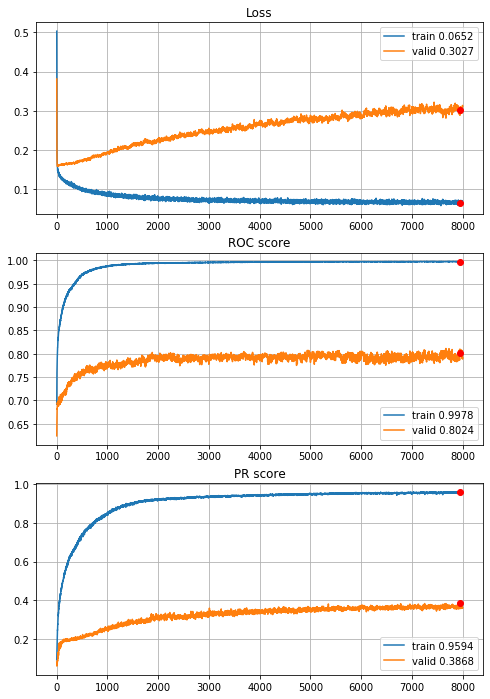


Fold 2------------------------------------------------------------


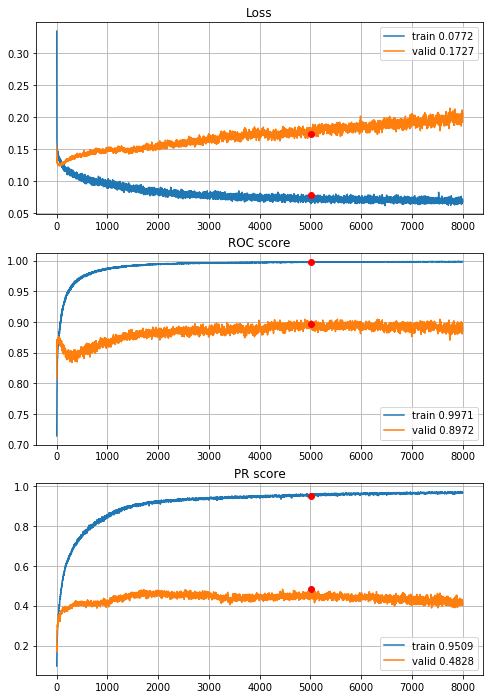


Fold 3------------------------------------------------------------


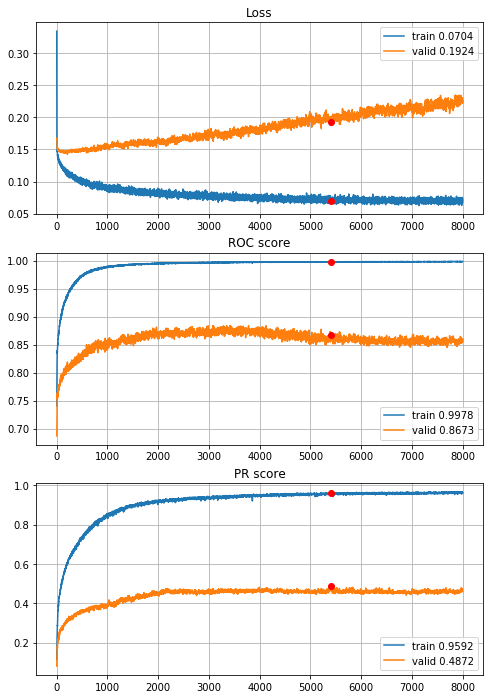


Fold 4------------------------------------------------------------


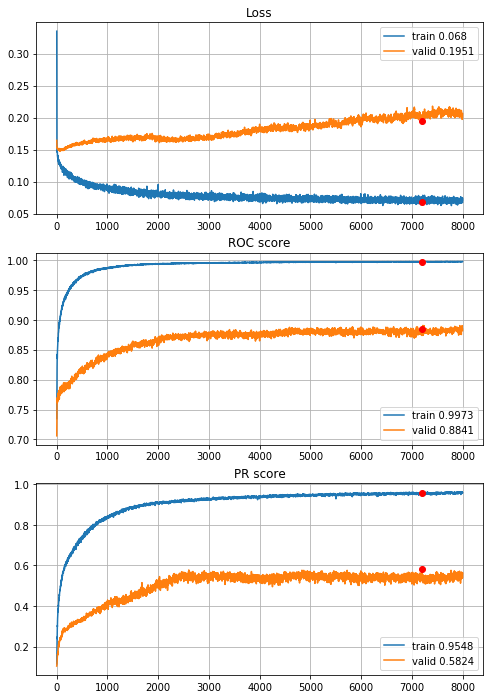


Fold 5------------------------------------------------------------


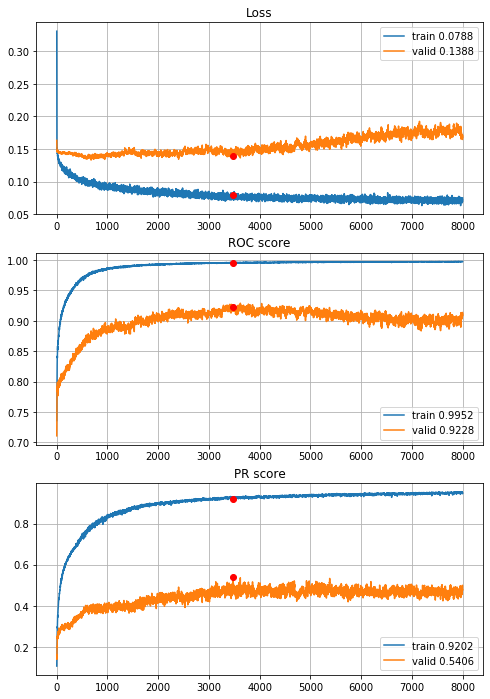


Fold 6------------------------------------------------------------


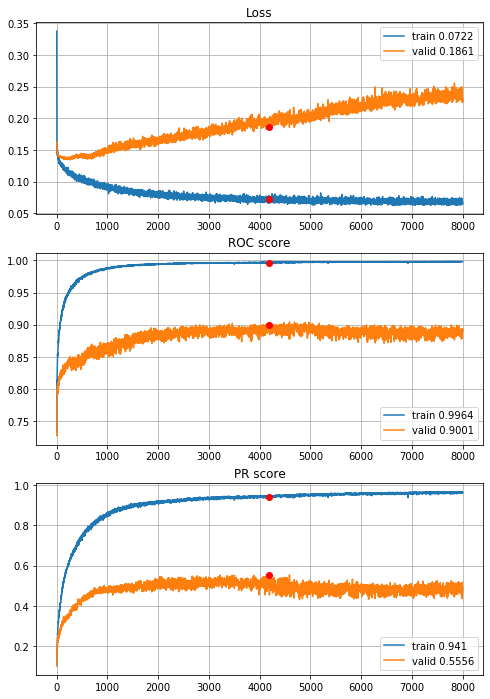

In [72]:
# L2 regu, 8000 epochs
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=8000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l2(l=0.00005),regularizers.l2(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\1year\MLP_L2_8000ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

So the best model for 1- and 2-year horizon is also the best model for 5-year horizon.

To sum up, the best Multilayer Percepton specification:
 - 2 layers $l^{[1]},l^{[2]}$,
 - units: $u^{[1]}=60, u^{[2]}=60$,
 - activations: $a^{[1]}:tanh,a^{[2]}:\sigma$,
 - dropout: $d^{[1]}=0.4,d^{[2]}=0.4$,
 - regularization: $r^{[1]}=L_1(0.00005), r^{[2]}=L_1(0.00005)$
 - optimizer: Adam with default setings,
 - 7243 epochs,
 - 394 batch size.
 
 ##### Convolutional Neural Network
 - functions for Monte Carlo Energy objective quasi-minimization (Tadaaki Hosaka 2019):
 
 $$E=\sum_{(i,j)\in \xi}|\phi[R(i),R(j)]|*d(i,j) $$
 where:<br>
 $d(i,j)=(x(i)-x(j))^2+(y(i)-y(j))^2$ - distance measure, <br>
 $i,j$ - pixels indices, <br>
 $x(i), y(i)$ - $xy-$coordinates of pixel $i$, <br>
 $\xi$ - set of all pixels combinations (sample space), <br>
 $R(i)$ - financial ratio for pixel $i$,<br>
 $\phi(\cdot)$ - correlation coefficient, <br>

when randomly swapped ratio for pair of pixels can reduce energy, they're swapped. Simulation ends when there is no reduction after $\alpha N$ steps, where $N$ is number of features.<br>
The idea of image with correlated features close to each other is based on correlation matrix (below) and the fact that pixels are dependent from their neighbours on the real pictures - when we have image of black cat sitting on the white pillow, then: $$P(pixel_{i}=black|pixel_{j}=black) > P(pixel_{i}=black|pixel_{j}=white)$$ where $d(i,j)=\varepsilon$

In [36]:
# raw imputed data
X_train = train_test_imp_sets["train_set_imp"][features]
Y_train = train_test_imp_sets["train_set_imp"][target]

# normalization
sclr=scaler(images=False)
sclr.fit(X=X_train ,q=None, power_transform=False)
X_train_norm=pd.DataFrame(sclr.transform(X=X_train),columns=features)

# normalization with quantile clipping (Q_0.005, Q_0.995)
sclr=scaler(images=False)
sclr.fit(X=X_train, q=0.005, power_transform=False)
X_train_clip_norm=pd.DataFrame(sclr.transform(X=X_train), columns=features)

# normalization with quantile clipping (Q_0.005, Q_0.995) and power transform
sclr=scaler(images=False)
sclr.fit(X=X_train, q=0.005, power_transform=True)
X_train_clip_norm_pt=pd.DataFrame(sclr.transform(X=X_train), columns=features)

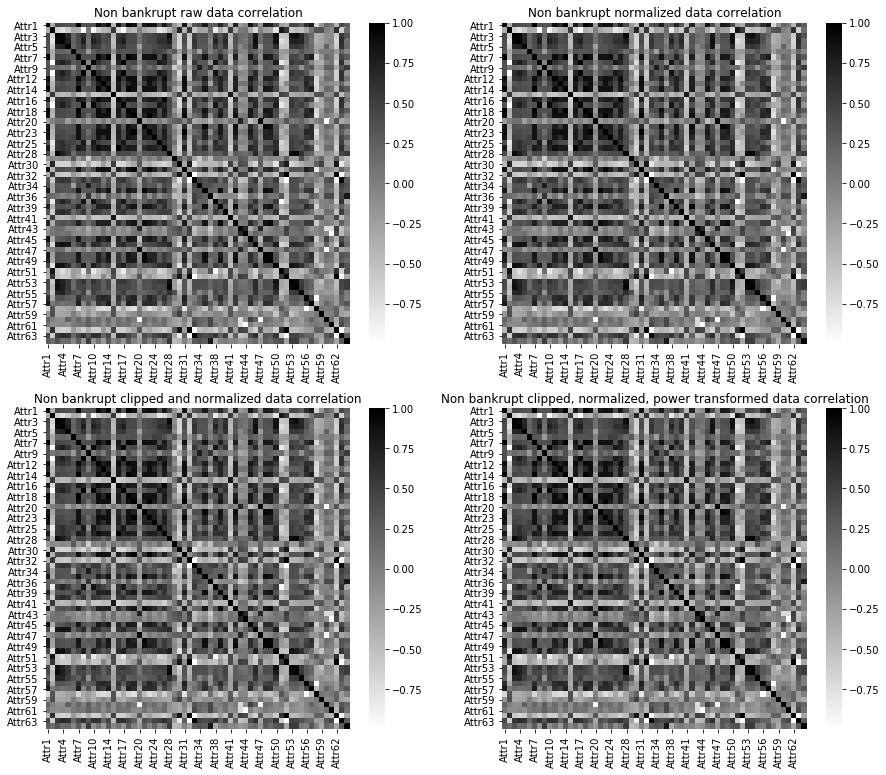

In [37]:
fig,ax=plt.subplots(nrows=2,ncols=2,figsize=(15,13))

sns.heatmap(X_train[Y_train==0].corr(method="spearman"),cmap="binary",annot=False, cbar=True, ax=ax[0,0])
ax[0,0].set_title("Non bankrupt raw data correlation")
sns.heatmap(X_train_norm[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[0,1])
ax[0,1].set_title("Non bankrupt normalized data correlation")
sns.heatmap(X_train_clip_norm[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[1,0])
ax[1,0].set_title("Non bankrupt clipped and normalized data correlation")
sns.heatmap(X_train_clip_norm_pt[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[1,1])
ax[1,1].set_title("Non bankrupt clipped, normalized, power transformed data correlation")

plt.show()

Analytical differences between correlation matrix variants presented above

In [38]:
corrs=[X_train[Y_train==0].corr(method="spearman"),
       X_train_norm[Y_train==0].corr(method="spearman"),
       X_train_clip_norm[Y_train==0].corr(method="spearman"),
       X_train_clip_norm_pt[Y_train==0].corr(method="spearman")]

print(np.sum(np.sum(np.abs(corrs[0]-corrs[1])))/2)
print(np.sum(np.sum(np.abs(corrs[0]-corrs[2])))/2)
print(np.sum(np.sum(np.abs(corrs[0]-corrs[3])))/2)
print(np.sum(np.sum(np.abs(corrs[1]-corrs[2])))/2)
print(np.sum(np.sum(np.abs(corrs[1]-corrs[3])))/2)
print(np.sum(np.sum(np.abs(corrs[2]-corrs[3])))/2)

0.0
0.0
0.0
0.0
0.0
0.0


Correlation matrix is robust to applied transformations.

In [36]:
def distance(x1, x2, y1, y2):
    '''
    function computes distance between two points (Tadaaki Hosaka 2019)
    arguments:
    x1, y2 - xy-coordinates of the first point
    x2, y2 - xy-coordinates of the second point
    
    return distance (scalar)
    '''
    d = (x1-x2)**2+(y1-y2)**2
    return d

def image_energy_v3(image, cor_matrix):
    '''
    function computes Energy for given image (Tadaaki Hosaka 2019).
    
    Energy = sum |c[R(i), R(j)]|d(i,j)
    d(i,j) = (x(i)-x(j))^2+(y(i)-y(j))^2
    where:
    i, j - indices of pixels,
    x(i), x(j) - xy coordinates of pixel,
    R(i) - feature for i,
    c[R(i), R(j)] - correlation coefficient between R(i) and R(j)
    
    arguments:
    image - dictionary (attributes names, xy coordinates) 
    corr_matrix - correlation matrix computed for analyzed data 
    
    return calculated Energy (scalar)
    ----
    188 times faster than first version
    '''
    # absolute value of correlation matrix - could be performed outside for loop
    cor_matrix = abs(cor_matrix)
    # energy inicjation
    E = 0
    # extracting features names
    for feature1 in image.keys():
        for feature2 in image.keys():
            # looking for correlation between features in previously computed (given) correlation matrix
            cor = cor_matrix.loc[feature1, feature2]
            # computing distance 
            d = distance(image[feature1][0], image[feature2][0], image[feature1][1], image[feature2][1])
            # computing energy
            E += cor*d
    
    # because of double counting returned energy is a half of computed
    # note: when feature1 = feature2 <=> distance = 0
    return E/2

def image_dict_to_matrix(image_dict):
    '''
    function converts dictionary to matrix draft of image, arguments:
    image_dict - dictionary to convert, keys: attribute, value: tuple of xy-coordinates,
    
    return matrix image draft 
    '''
    from math import ceil
    shape = ceil(len(image_dict)**(1/2))
    
#     matrix = np.zeros((shape,shape))+128
#     matrix = matrix.astype(object)
    matrix = np.zeros((shape,shape), dtype=object)+128
    for cords in list(image_dict.values()):
        matrix[cords[0], cords[1]] = list(image_dict.keys())[list(image_dict.values()).index(cords)]
    
    return matrix

def map_image(draft, example):
    '''
    function converts draft to image for concrete example, arguments:
    draft - matrix with order of features in image xy-coordinate system, matrix element must match example indices
    example - pandas.Series contains single observation - example indices must match draft values
    
    return numpy.array() - matrix with values for given example with draft order
    '''
    draft_tmp = draft.copy()
    
    for i in range(draft_tmp.shape[0]):
        for j in range(draft_tmp.shape[1]):
            attr = draft_tmp[i,j]
            draft_tmp[i,j] = example[attr] if attr != 128 else 128
    
    #draft_tmp=draft_tmp.astype(np.float)
    draft_tmp=draft_tmp.astype(np.uint8)
    
    return draft_tmp

def image_draft_inicialization(features, random_state):
    '''
    function inicializes draft in dictionary form, keys=feature names, values=position in the image space
    (xy-coordinates in the integers space), arguments:
    
    features - list of the features in dataset for which draft is inicialized,
    random_state - random seed
    
    return draft_dict (python dictionary inicialized draft)
    ----------
    Note: generated draft is for square-shaped image => range(x)=range(y)=ceil(len(features)**(1/2)), but image space
          is created like grid iterating all columns for all rows, thus if len(features) is not a perfect square then
          some potential coordinates are excluded from image space, and as conversion process progress this coordinates
          becomes placeholders, and are not consider while Monte Carlo quasi optimization. When len(features)**(1/2) - its
          ceil = 1 then there is only one placeholder - just right bottom one coordinate, when difference is in range
          [1, range(x)] then the last row of image contains placeholders, if difference is equal to range(x)+1 then 
          placeholders are the last row and new right bottom corner, if difference is in range [range(x)+1, 2*range(x)]
          then two last rows are placeholders etc. It is the best currently found solution for computing non-biased energy
          which is as low as possible.
    '''
    # seeds
    random.seed(random_state)
    np.random.seed(random_state)
    
    from math import ceil
    shape = ceil(len(features)**(1/2))

    # keys
    ks = features.copy()
    # values
    vs = []
    for i in range(shape):
        for j in range(shape):
            vs.append((i,j))
            
    # dictionary
    draft_dict = dict(zip(ks,vs))
    
    return draft_dict

def MC_Energy_optimization(corr_matrix, draft, alpha, n_eval, random_state):
    '''
    function performes Monte Carlo quasi optimization for Energy objective (Tadaaki Hosaka 2019), arguments:
    corr_matrix - correlation matrix (pandas DataFrame),
    draft - initial draft for image to optimize,
    alpha - parameter that impact on simulation duration (3 in Hosakas' article),
    n_eval - number of iteration per which current state is printed,
    random_state - random seed
    
    return ordered draft
    '''
    random.seed(random_state)
    np.random.seed(random_state)
    
    start = time.time()
    initial_energy = image_energy_v3(draft, corr_matrix)
    print("initial image energy:", round(initial_energy, 4))

    energy = initial_energy
    stop_criterion = 0
    i = 0
    while stop_criterion < alpha*len(features):
        draft_tmp = draft.copy()
        # coordinates pair sampling
        xy1, xy2 = random.sample(list(draft_tmp.values()), 2)
        # feature name under coordinates
        ft1 = list(draft_tmp.keys())[list(draft_tmp.values()).index(xy1)]
        ft2 = list(draft_tmp.keys())[list(draft_tmp.values()).index(xy2)]
        # coordinates swap
        draft_tmp[ft1] = xy2
        draft_tmp[ft2] = xy1
        # new energy
        energy_new = image_energy_v3(draft_tmp, corr_matrix)
        # saving changes
        if energy_new < energy:
            energy = energy_new
            draft = draft_tmp.copy()
            stop_criterion = 0
        else:
            stop_criterion += 1
        i += 1
        # evaluation
        if i%n_eval == 0:
            print("iteration: {}\ncurrent energy: {}".format(i, round(energy, 4)))
    
    stop = time.time()
    print("MC simulation time: {}s\nenergy after MC quasi optimization: {}".format(round(stop-start), round(energy, 4)))
    
    return draft

 - CNN definitions

In [37]:
def define_CNN(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid)(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model

def define_CNN_Adam(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid)(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model

 - 6-fold Cross Validation CNN

In [38]:
def CNN_6FoldCrossValidation(datasets, model_definition, features, target, n_epochs, batch_size, alpha, random_state,
                             normalize="power", q=None, drafts=None, instruction=None, info=None):
    '''
    function performes 6 fold Cross Validation for Multilayer Percepton keras model, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    n_epochs - number of epochs for training MLP model,
    batch_size - number of weight matrices updates per loop through entire, current trainin dataset,
    alpha - Monte Carlo duration parameter,
    random_state - random seed,
    info - same arguent as for network_training(),
    *args and **kwargs - arguments for create_MLP() function
    
    returns CNNhistories - list of every CNN model history 
    '''
    # seeds
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]
    
    CVstart=time.time()
    # history of CV
    CNNhistories=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        
        if drafts is None and instruction is None:
            # ----- current fold train and validation sets ------
            X_train = training_sets[fold][features].copy()
            Y_train = training_sets[fold][target].copy()
            X_valid = validation_sets[fold][features].copy()
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- Monte Carlo energy optimization -----
            # correlation matrix for non bankrupt observations
            corr_matrix = X_train[Y_train==0].corr(method="spearman")
            # draft inicialization
            draft = image_draft_inicialization(features, random_state)
            # quasi optimization
            draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=alpha, n_eval=99999,
                                           random_state=random_state)
            # transform draft dictionary to matrix
            draft = image_dict_to_matrix(draft)
            
            # temporary features list
            features_tmp = X_train.columns.tolist()
        
        elif drafts is not None and instruction is None:
            # ----- current fold train and validation sets with feature generation -----
            X_train = training_sets[fold][features].copy()
            Y_train = training_sets[fold][target].copy()
            X_valid = validation_sets[fold][features].copy()
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- loading draft from passed object -----
            draft = drafts[fold]
            
            # temporary features list
            features_tmp = X_train.columns.tolist()    
            
        elif drafts is not None and instruction is not None:
            # ----- current fold train and validation sets with feature generation -----
            X_train = generate_features(data=training_sets[fold][features], instruction=instruction)
            Y_train = training_sets[fold][target].copy()
            X_valid = generate_features(data=validation_sets[fold][features].copy(), instruction=instruction)
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- loading draft from passed object -----
            draft = drafts[fold]
            
            # temporary features list
            features_tmp = X_train.columns.tolist()
            
        else:
            raise "valid options are: drafts=None and instruction=None, drafts!=None and instruction=None, drafts!=None and instruction!=None"
            
        # ----- standarization for CNN (images) -----
        if normalize==True:
            normalizer = scaler(images=True)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features_tmp)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features_tmp)
        elif normalize=="power":
            normalizer = scaler(images=True)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features_tmp)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features_tmp)
        else:
            pass
            
        # ----- vector to image conversion -----
        # training set
        X_train_CNN = np.array([map_image(draft, X_train.iloc[i,:])/255 for i in range(X_train.shape[0])])
        X_train_CNN = X_train_CNN.reshape(X_train_CNN.shape+(1,))
        Y_train_CNN = Y_train.values
        # validation set
        X_valid_CNN = np.array([map_image(draft, X_valid.iloc[i,:])/255 for i in range(X_valid.shape[0])])
        X_valid_CNN = X_valid_CNN.reshape(X_valid_CNN.shape+(1,))
        Y_valid_CNN = Y_valid.values
        
        # ----- CNN training -----
        modelCNN = model_definition(input_shape=X_train_CNN.shape[1:], random_state=random_state)
        modelCNN, historyCNN = network_training(network=modelCNN, X_train=X_train_CNN, Y_train=Y_train_CNN,
                                                X_val=X_valid_CNN, Y_val=Y_valid_CNN, n_epochs=n_epochs,
                                                batch_size=batch_size, random_state=random_state, info=info)
        # ----- MLP history saving -----
        CNNhistories.append(historyCNN.copy())

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    return CNNhistories


----------
Fold: 1
----------
initial image energy: 13563.206
MC simulation time: 43s
energy after MC quasi optimization: 9783.4536
Train on 5270 samples, validate on 1054 samples
Epoch: 1/100,
cumulative time: 2.34s train loss: 0.1818296254699099, validation loss: 0.1733267057326532
Epoch: 2/100,
cumulative time: 3.32s train loss: 0.17130766094183333, validation loss: 0.19104229422742094
Epoch: 3/100,
cumulative time: 4.32s train loss: 0.17043551716395075, validation loss: 0.16149801456950874
Epoch: 4/100,
cumulative time: 5.3s train loss: 0.17033094962814954, validation loss: 0.22098698816218004
Epoch: 5/100,
cumulative time: 6.28s train loss: 0.1705938674523663, validation loss: 0.17369846162691968
Epoch: 6/100,
cumulative time: 7.26s train loss: 0.16873142783736822, validation loss: 0.16382801134061542
Epoch: 7/100,
cumulative time: 8.24s train loss: 0.16499352273045273, validation loss: 0.17395003238936754
Epoch: 8/100,
cumulative time: 9.23s train loss: 0.16793308229498438, vali

Epoch: 76/100,
cumulative time: 75.25s train loss: 0.14572334176731744, validation loss: 0.16463859291637645
Epoch: 77/100,
cumulative time: 76.21s train loss: 0.1475943725662168, validation loss: 0.16526423208062066
Epoch: 78/100,
cumulative time: 77.22s train loss: 0.14537129446835853, validation loss: 0.16482168797976152
Epoch: 79/100,
cumulative time: 78.3s train loss: 0.14639264359024037, validation loss: 0.17724008428417076
Epoch: 80/100,
cumulative time: 79.33s train loss: 0.14704282060972426, validation loss: 0.159395828984494
Epoch: 81/100,
cumulative time: 80.33s train loss: 0.14547068822485673, validation loss: 0.1661917360842341
Epoch: 82/100,
cumulative time: 81.34s train loss: 0.14665937012863792, validation loss: 0.16123148714116223
Epoch: 83/100,
cumulative time: 82.37s train loss: 0.14511730346892318, validation loss: 0.17094449653684302
Epoch: 84/100,
cumulative time: 83.39s train loss: 0.1450104624570208, validation loss: 0.16173045207133102
Epoch: 85/100,
cumulative

Epoch: 49/100,
cumulative time: 48.25s train loss: 0.1573166591986533, validation loss: 0.1534809888087821
Epoch: 50/100,
cumulative time: 49.27s train loss: 0.15536540428307297, validation loss: 0.15840892406070933
Epoch: 51/100,
cumulative time: 50.34s train loss: 0.15758484813757595, validation loss: 0.1586641381994823
Epoch: 52/100,
cumulative time: 51.39s train loss: 0.15559424640897104, validation loss: 0.1676784829860394
Epoch: 53/100,
cumulative time: 52.43s train loss: 0.15586419937676224, validation loss: 0.16551569341708405
Epoch: 54/100,
cumulative time: 53.49s train loss: 0.15797294658773087, validation loss: 0.15517955648039505
Epoch: 55/100,
cumulative time: 54.52s train loss: 0.15747008261463447, validation loss: 0.1533715410804839
Epoch: 56/100,
cumulative time: 55.64s train loss: 0.15415889213048983, validation loss: 0.16082270825158035
Epoch: 57/100,
cumulative time: 56.71s train loss: 0.1549820089475932, validation loss: 0.17007215038309514
Epoch: 58/100,
cumulative

Epoch: 22/100,
cumulative time: 22.15s train loss: 0.16049707936833435, validation loss: 0.1687651499681726
Epoch: 23/100,
cumulative time: 23.18s train loss: 0.1598986007994221, validation loss: 0.1717122370196927
Epoch: 24/100,
cumulative time: 24.18s train loss: 0.16029819427111117, validation loss: 0.1665396305257048
Epoch: 25/100,
cumulative time: 25.17s train loss: 0.15960511152104137, validation loss: 0.16869763583227623
Epoch: 26/100,
cumulative time: 26.16s train loss: 0.16077563890752575, validation loss: 0.16663691579616952
Epoch: 27/100,
cumulative time: 27.13s train loss: 0.1574286432063783, validation loss: 0.17099328692542987
Epoch: 28/100,
cumulative time: 28.1s train loss: 0.15940550883535642, validation loss: 0.16806521112597644
Epoch: 29/100,
cumulative time: 29.06s train loss: 0.1567852371048882, validation loss: 0.16991702052967825
Epoch: 30/100,
cumulative time: 30.03s train loss: 0.15718927621502124, validation loss: 0.17236160120769514
Epoch: 31/100,
cumulative 

Epoch: 98/100,
cumulative time: 97.73s train loss: 0.1433980608093897, validation loss: 0.16040829101142667
Epoch: 99/100,
cumulative time: 98.74s train loss: 0.14207076801577376, validation loss: 0.1637207036113377
Epoch: 100/100,
cumulative time: 99.91s train loss: 0.141501646476181, validation loss: 0.16392240380652714

Early stopping results:
best results in epoch: 96, 
best valid PR: 0.12022889293147487, 
valid ROC: 0.6621722485734235        
overfitting PR: 0.11021142389978544, 
overfitting ROC: 0.12396494164902416

----------
Fold: 4
----------
initial image energy: 13569.1821
MC simulation time: 117s
energy after MC quasi optimization: 9558.9543
Train on 5270 samples, validate on 1054 samples
Epoch: 1/100,
cumulative time: 1.91s train loss: 0.1838509358649462, validation loss: 0.16489096797394798
Epoch: 2/100,
cumulative time: 2.9s train loss: 0.1728560542952856, validation loss: 0.17477483445145825
Epoch: 3/100,
cumulative time: 3.91s train loss: 0.16649898039548175, validatio

Epoch: 71/100,
cumulative time: 71.71s train loss: 0.14778455281223699, validation loss: 0.16988640101856253
Epoch: 72/100,
cumulative time: 72.73s train loss: 0.15035922053982229, validation loss: 0.1608977740528009
Epoch: 73/100,
cumulative time: 73.73s train loss: 0.1486820950906236, validation loss: 0.15955797841585112
Epoch: 74/100,
cumulative time: 74.73s train loss: 0.14790788578466854, validation loss: 0.1788254089554528
Epoch: 75/100,
cumulative time: 75.73s train loss: 0.15038353225651005, validation loss: 0.1583481405559482
Epoch: 76/100,
cumulative time: 76.75s train loss: 0.1469867634875046, validation loss: 0.17093236099723622
Epoch: 77/100,
cumulative time: 77.75s train loss: 0.14760757907800928, validation loss: 0.16060510023269076
Epoch: 78/100,
cumulative time: 78.74s train loss: 0.14759417956649012, validation loss: 0.16382133347146652
Epoch: 79/100,
cumulative time: 79.73s train loss: 0.14788783091125723, validation loss: 0.16515739318654932
Epoch: 80/100,
cumulativ

Epoch: 44/100,
cumulative time: 44.81s train loss: 0.1535810772223536, validation loss: 0.1659087652386479
Epoch: 45/100,
cumulative time: 45.82s train loss: 0.15559489657745415, validation loss: 0.15722086437513072
Epoch: 46/100,
cumulative time: 46.82s train loss: 0.1552538502713987, validation loss: 0.15647631238940998
Epoch: 47/100,
cumulative time: 47.83s train loss: 0.15333337048934578, validation loss: 0.1551382765598044
Epoch: 48/100,
cumulative time: 48.81s train loss: 0.15441794098271816, validation loss: 0.15632113650356344
Epoch: 49/100,
cumulative time: 49.81s train loss: 0.15230372583730398, validation loss: 0.16341919201714264
Epoch: 50/100,
cumulative time: 50.81s train loss: 0.15358556585927163, validation loss: 0.15674082394795355
Epoch: 51/100,
cumulative time: 51.81s train loss: 0.15320231541849857, validation loss: 0.15806715707851315
Epoch: 52/100,
cumulative time: 52.8s train loss: 0.15407825954385682, validation loss: 0.15453094993302674
Epoch: 53/100,
cumulativ

Epoch: 17/100,
cumulative time: 17.82s train loss: 0.16385879668723474, validation loss: 0.16582529325978354
Epoch: 18/100,
cumulative time: 18.82s train loss: 0.16460003012780672, validation loss: 0.16444006067412628
Epoch: 19/100,
cumulative time: 19.81s train loss: 0.1630056773123298, validation loss: 0.18441314639018203
Epoch: 20/100,
cumulative time: 20.85s train loss: 0.1651861637010746, validation loss: 0.16431298374111783
Epoch: 21/100,
cumulative time: 21.85s train loss: 0.16306128641007295, validation loss: 0.16391771802752927
Epoch: 22/100,
cumulative time: 22.85s train loss: 0.16300479476773083, validation loss: 0.1629599880787634
Epoch: 23/100,
cumulative time: 23.84s train loss: 0.16284166272496362, validation loss: 0.16761347233004995
Epoch: 24/100,
cumulative time: 24.84s train loss: 0.1628115209077522, validation loss: 0.16775964002568536
Epoch: 25/100,
cumulative time: 25.85s train loss: 0.16150361987456424, validation loss: 0.16116366949660502
Epoch: 26/100,
cumulati

Epoch: 93/100,
cumulative time: 94.07s train loss: 0.13970588952642238, validation loss: 0.1637076665656164
Epoch: 94/100,
cumulative time: 95.08s train loss: 0.13999966698817104, validation loss: 0.15853503991123394
Epoch: 95/100,
cumulative time: 96.07s train loss: 0.13764473622279555, validation loss: 0.15362894786716186
Epoch: 96/100,
cumulative time: 97.08s train loss: 0.13851759316685983, validation loss: 0.15457600267494426
Epoch: 97/100,
cumulative time: 98.09s train loss: 0.13556073408934377, validation loss: 0.17319213125352842
Epoch: 98/100,
cumulative time: 99.09s train loss: 0.1377533366037727, validation loss: 0.15955432406865216
Epoch: 99/100,
cumulative time: 100.09s train loss: 0.13944742809945762, validation loss: 0.15519423610345237
Epoch: 100/100,
cumulative time: 101.11s train loss: 0.13877320480471092, validation loss: 0.17851750219003978

Early stopping results:
best results in epoch: 97, 
best valid PR: 0.1413902507132254, 
valid ROC: 0.7318758577516674        


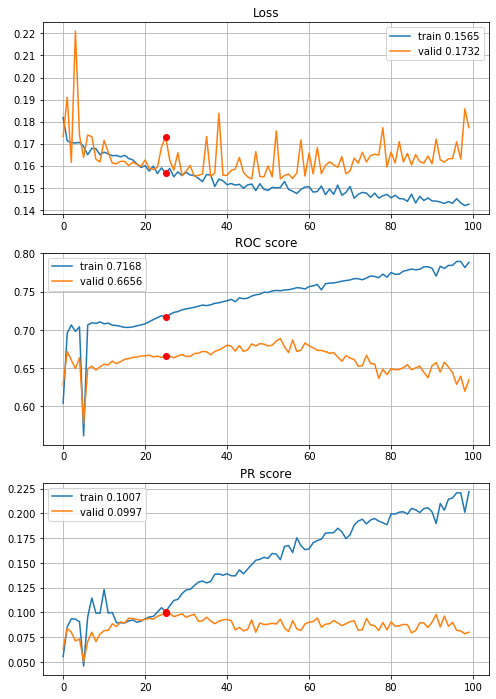


Fold 2------------------------------------------------------------


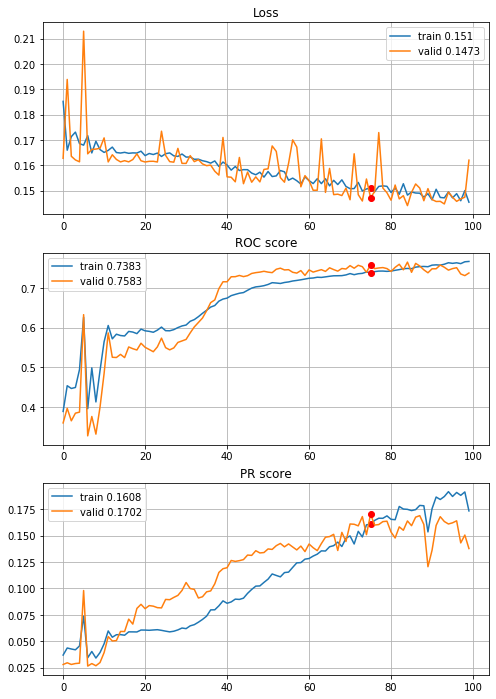


Fold 3------------------------------------------------------------


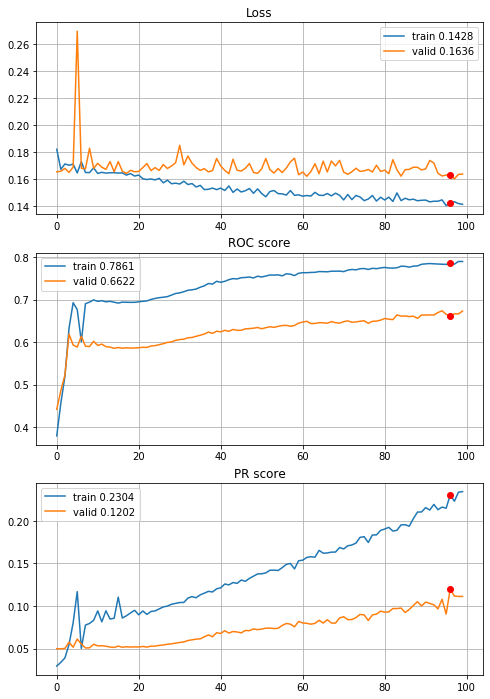


Fold 4------------------------------------------------------------


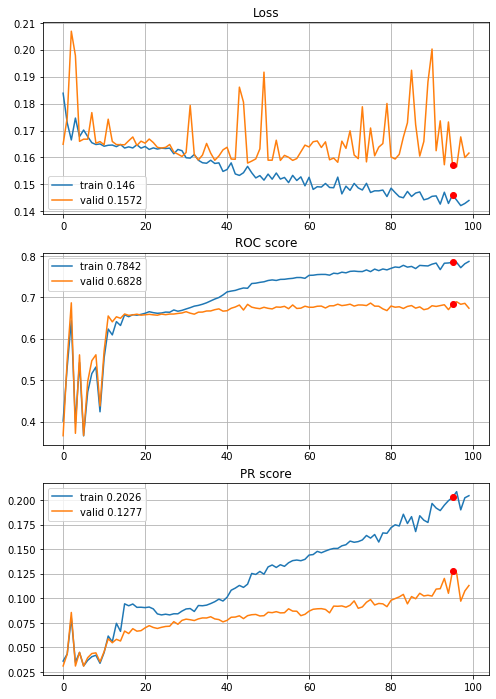


Fold 5------------------------------------------------------------


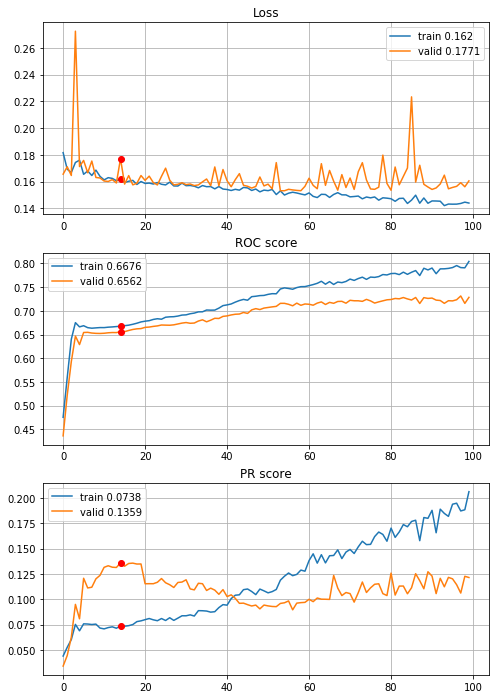


Fold 6------------------------------------------------------------


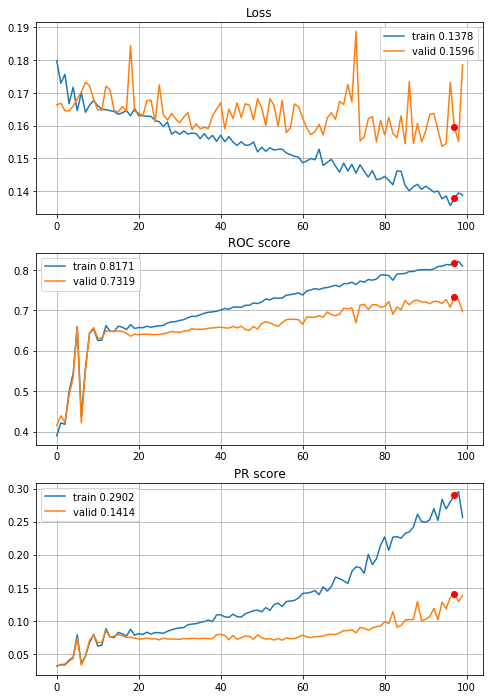

In [43]:
# first CNN only normalization applied
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize=True, q=None, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Terrible results and learning curves


----------
Fold: 1
----------
initial image energy: 13563.206
MC simulation time: 43s
energy after MC quasi optimization: 9783.4536
Train on 5270 samples, validate on 1054 samples
Epoch: 1/100,
cumulative time: 1.99s train loss: 0.18172959437067188, validation loss: 0.17392090084543715
Epoch: 2/100,
cumulative time: 3.01s train loss: 0.17061994683697282, validation loss: 0.18977877082023947
Epoch: 3/100,
cumulative time: 4.03s train loss: 0.16747208972809663, validation loss: 0.15746445787020832
Epoch: 4/100,
cumulative time: 5.05s train loss: 0.16329585483449685, validation loss: 0.22212489681632966
Epoch: 5/100,
cumulative time: 6.07s train loss: 0.1621804393531023, validation loss: 0.16462874327710278
Epoch: 6/100,
cumulative time: 7.09s train loss: 0.1580530813879261, validation loss: 0.15523670435630393
Epoch: 7/100,
cumulative time: 8.11s train loss: 0.15408410701116076, validation loss: 0.1744838639443468
Epoch: 8/100,
cumulative time: 9.13s train loss: 0.1579508043330806, vali

Epoch: 76/100,
cumulative time: 78.47s train loss: 0.07300497298137738, validation loss: 0.2607291679002302
Epoch: 77/100,
cumulative time: 79.48s train loss: 0.08593849751257128, validation loss: 0.22443273841656136
Epoch: 78/100,
cumulative time: 80.48s train loss: 0.08026014077539009, validation loss: 0.19301236922759032
Epoch: 79/100,
cumulative time: 81.48s train loss: 0.07635159910545178, validation loss: 0.24380517348053332
Epoch: 80/100,
cumulative time: 82.49s train loss: 0.08149493780036579, validation loss: 0.18387239130896002
Epoch: 81/100,
cumulative time: 83.5s train loss: 0.07002031610292547, validation loss: 0.19434134797873487
Epoch: 82/100,
cumulative time: 84.55s train loss: 0.0839585727048893, validation loss: 0.21414752219727642
Epoch: 83/100,
cumulative time: 85.65s train loss: 0.07641264094884527, validation loss: 0.2576640861027607
Epoch: 84/100,
cumulative time: 86.7s train loss: 0.07902229041907322, validation loss: 0.19091288589888325
Epoch: 85/100,
cumulativ

Epoch: 49/100,
cumulative time: 51.5s train loss: 0.11997490368741061, validation loss: 0.1478460454002051
Epoch: 50/100,
cumulative time: 52.65s train loss: 0.11344478787744747, validation loss: 0.1595546007721881
Epoch: 51/100,
cumulative time: 53.69s train loss: 0.11776547614605196, validation loss: 0.14334785483028223
Epoch: 52/100,
cumulative time: 54.72s train loss: 0.10843788980306665, validation loss: 0.19812860892665002
Epoch: 53/100,
cumulative time: 55.82s train loss: 0.1181530129949101, validation loss: 0.1335225015086965
Epoch: 54/100,
cumulative time: 56.85s train loss: 0.11160817925572622, validation loss: 0.1361169594656358
Epoch: 55/100,
cumulative time: 57.89s train loss: 0.11534184892246574, validation loss: 0.14955024426870148
Epoch: 56/100,
cumulative time: 58.97s train loss: 0.1044533711400385, validation loss: 0.14682882026092378
Epoch: 57/100,
cumulative time: 60.02s train loss: 0.11068605167731162, validation loss: 0.16760990504295595
Epoch: 58/100,
cumulative 

Epoch: 22/100,
cumulative time: 23.32s train loss: 0.1442803825242922, validation loss: 0.16640051028760153
Epoch: 23/100,
cumulative time: 24.34s train loss: 0.14304761063498383, validation loss: 0.17028736595976285
Epoch: 24/100,
cumulative time: 25.36s train loss: 0.14520726278000132, validation loss: 0.1582745545785839
Epoch: 25/100,
cumulative time: 26.39s train loss: 0.14269191408406173, validation loss: 0.16064209260569579
Epoch: 26/100,
cumulative time: 27.4s train loss: 0.14312957684726824, validation loss: 0.1582066852465074
Epoch: 27/100,
cumulative time: 28.42s train loss: 0.13855592273387782, validation loss: 0.174857012885119
Epoch: 28/100,
cumulative time: 29.44s train loss: 0.14231544513347252, validation loss: 0.16300223773412506
Epoch: 29/100,
cumulative time: 30.45s train loss: 0.13806205217424336, validation loss: 0.1574848536295954
Epoch: 30/100,
cumulative time: 31.47s train loss: 0.1384073389294704, validation loss: 0.1725663966596466
Epoch: 31/100,
cumulative ti

Epoch: 98/100,
cumulative time: 100.41s train loss: 0.062203392010373004, validation loss: 0.1851527133295613
Epoch: 99/100,
cumulative time: 101.49s train loss: 0.07416691474998247, validation loss: 0.21663126078004855
Epoch: 100/100,
cumulative time: 102.57s train loss: 0.05556861382522099, validation loss: 0.20271537279042165

Early stopping results:
best results in epoch: 95, 
best valid PR: 0.24619565810919775, 
valid ROC: 0.7776828064430693        
overfitting PR: 0.598600428620219, 
overfitting ROC: 0.20864133673781415

----------
Fold: 4
----------
initial image energy: 13569.1821
MC simulation time: 118s
energy after MC quasi optimization: 9558.9543
Train on 5270 samples, validate on 1054 samples
Epoch: 1/100,
cumulative time: 1.81s train loss: 0.18378395488807328, validation loss: 0.16456964648765224
Epoch: 2/100,
cumulative time: 2.82s train loss: 0.17240588681408306, validation loss: 0.1738576653786357
Epoch: 3/100,
cumulative time: 3.81s train loss: 0.16360038778474253, va

Epoch: 71/100,
cumulative time: 72.6s train loss: 0.09459019415292613, validation loss: 0.19143856513319252
Epoch: 72/100,
cumulative time: 73.61s train loss: 0.09894638713838028, validation loss: 0.1682954238589846
Epoch: 73/100,
cumulative time: 74.61s train loss: 0.09139099853003727, validation loss: 0.16347126535491655
Epoch: 74/100,
cumulative time: 75.62s train loss: 0.0907635782415885, validation loss: 0.20826626816442842
Epoch: 75/100,
cumulative time: 76.62s train loss: 0.09367850013147948, validation loss: 0.16304001407220647
Epoch: 76/100,
cumulative time: 77.63s train loss: 0.09401177874495906, validation loss: 0.17844846120821684
Epoch: 77/100,
cumulative time: 78.64s train loss: 0.08942465378674881, validation loss: 0.16983834415165253
Epoch: 78/100,
cumulative time: 79.65s train loss: 0.08934300149414526, validation loss: 0.1751887904907766
Epoch: 79/100,
cumulative time: 80.65s train loss: 0.0851136035072057, validation loss: 0.21563465194865014
Epoch: 80/100,
cumulativ

Epoch: 44/100,
cumulative time: 45.8s train loss: 0.12294288784604823, validation loss: 0.18610129407845594
Epoch: 45/100,
cumulative time: 46.82s train loss: 0.1290140086548152, validation loss: 0.14425117583270317
Epoch: 46/100,
cumulative time: 47.82s train loss: 0.1288039053017998, validation loss: 0.1425476386379698
Epoch: 47/100,
cumulative time: 48.84s train loss: 0.11896294267455812, validation loss: 0.14255765111554958
Epoch: 48/100,
cumulative time: 49.86s train loss: 0.11586883429303567, validation loss: 0.14215635908396465
Epoch: 49/100,
cumulative time: 50.86s train loss: 0.12011267145851758, validation loss: 0.19864820670583896
Epoch: 50/100,
cumulative time: 51.88s train loss: 0.12247557128572827, validation loss: 0.15035676729973171
Epoch: 51/100,
cumulative time: 52.97s train loss: 0.1153847767856587, validation loss: 0.1490510665940605
Epoch: 52/100,
cumulative time: 54.14s train loss: 0.12158120727516442, validation loss: 0.14726881974109887
Epoch: 53/100,
cumulative

Epoch: 17/100,
cumulative time: 17.95s train loss: 0.15074037558326686, validation loss: 0.15381766462687976
Epoch: 18/100,
cumulative time: 18.97s train loss: 0.14890660873739725, validation loss: 0.14911267444123805
Epoch: 19/100,
cumulative time: 19.96s train loss: 0.1479716973835196, validation loss: 0.1686677534338193
Epoch: 20/100,
cumulative time: 20.97s train loss: 0.145705123208958, validation loss: 0.14805339633061265
Epoch: 21/100,
cumulative time: 21.99s train loss: 0.1455030692907393, validation loss: 0.1592652694634966
Epoch: 22/100,
cumulative time: 22.99s train loss: 0.14232488533011875, validation loss: 0.15371713897591524
Epoch: 23/100,
cumulative time: 24.0s train loss: 0.14331893639274973, validation loss: 0.17194502157436603
Epoch: 24/100,
cumulative time: 25.02s train loss: 0.14377595004139634, validation loss: 0.1623036818865128
Epoch: 25/100,
cumulative time: 26.02s train loss: 0.1450146813829212, validation loss: 0.14939476166493074
Epoch: 26/100,
cumulative ti

Epoch: 93/100,
cumulative time: 94.45s train loss: 0.07222121060177317, validation loss: 0.173223140202392
Epoch: 94/100,
cumulative time: 95.46s train loss: 0.07436183983958423, validation loss: 0.21332840802434275
Epoch: 95/100,
cumulative time: 96.46s train loss: 0.06673854733525689, validation loss: 0.16078334645256825
Epoch: 96/100,
cumulative time: 97.46s train loss: 0.0752339251678741, validation loss: 0.16527042276379733
Epoch: 97/100,
cumulative time: 98.47s train loss: 0.0683592508227142, validation loss: 0.19572840235151873
Epoch: 98/100,
cumulative time: 99.48s train loss: 0.06827396581645709, validation loss: 0.18084269767694275
Epoch: 99/100,
cumulative time: 100.48s train loss: 0.06356180787397517, validation loss: 0.20143356486674277
Epoch: 100/100,
cumulative time: 101.49s train loss: 0.0631405724717951, validation loss: 0.25639422441456305

Early stopping results:
best results in epoch: 99, 
best valid PR: 0.2984132343969556, 
valid ROC: 0.8241879950882431        
ove

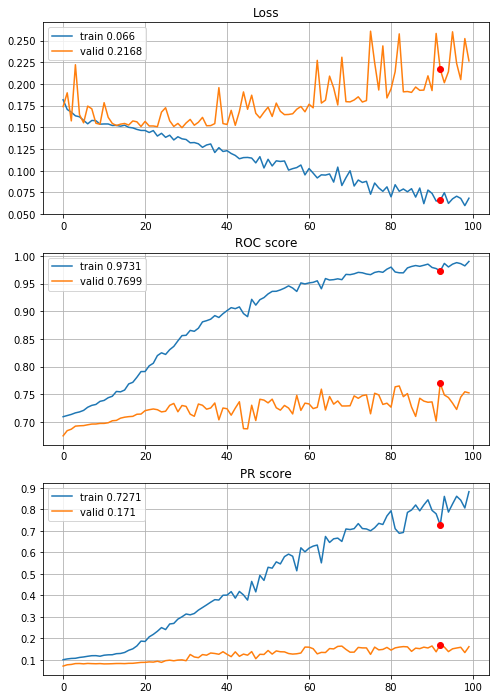


Fold 2------------------------------------------------------------


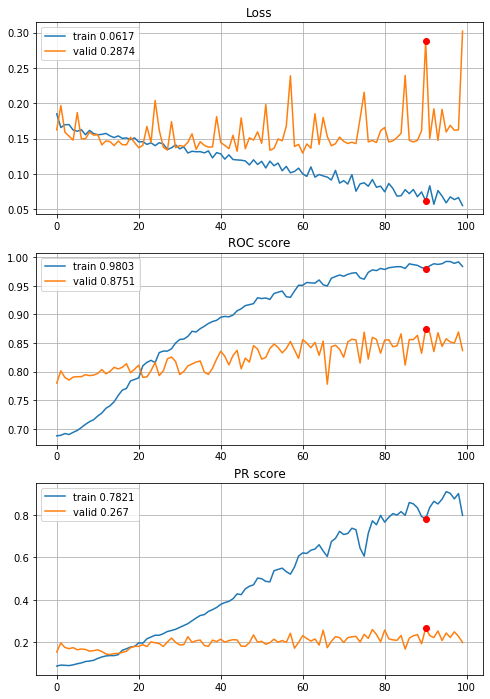


Fold 3------------------------------------------------------------


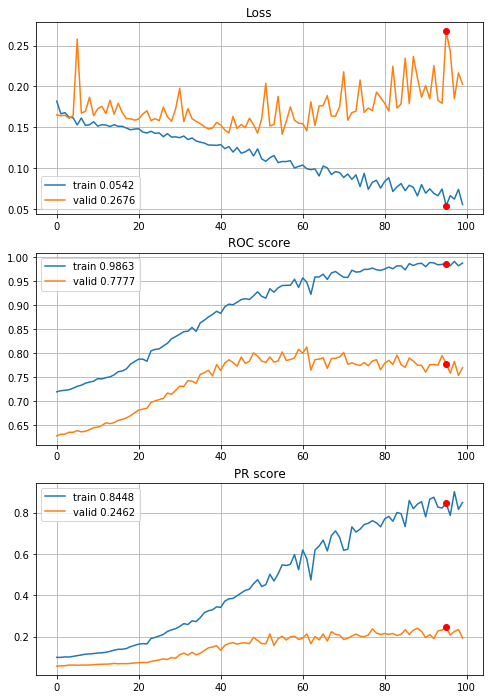


Fold 4------------------------------------------------------------


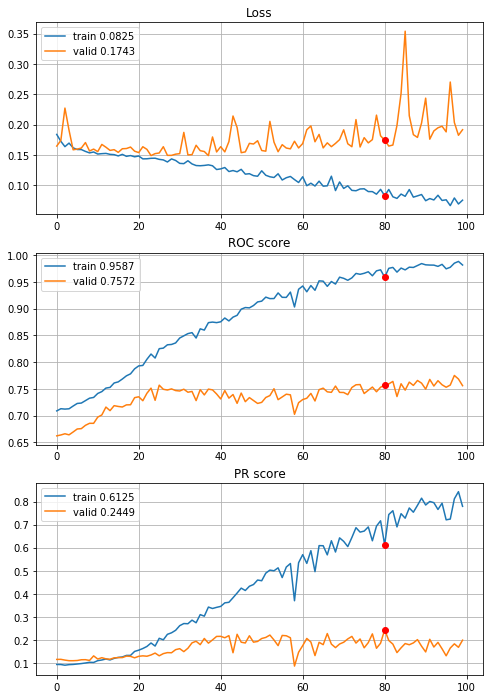


Fold 5------------------------------------------------------------


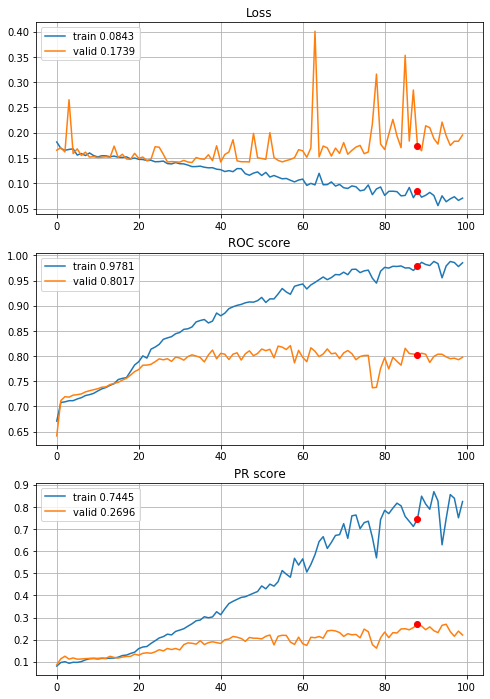


Fold 6------------------------------------------------------------


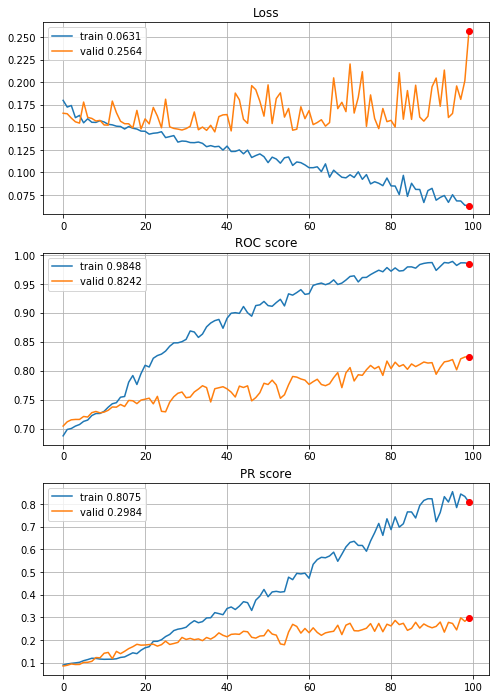

In [44]:
# first CNN with quantile clipping (Q_0.005, Q_0.995) and normalization
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize=True, q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Huge improvement, +0.12 on PR, bigger overfitting, but seems like architecture is not appropriate. Lets try with power transform added.


----------
Fold: 1
----------
initial image energy: 13563.206
MC simulation time: 43s
energy after MC quasi optimization: 9783.4536
Train on 5270 samples, validate on 1054 samples
Epoch: 1/100,
cumulative time: 1.77s train loss: 0.18171316181120428, validation loss: 0.17346959627556846
Epoch: 2/100,
cumulative time: 2.8s train loss: 0.17030184318150696, validation loss: 0.18929138666538406
Epoch: 3/100,
cumulative time: 3.83s train loss: 0.16640728150531509, validation loss: 0.15628349433248365
Epoch: 4/100,
cumulative time: 4.85s train loss: 0.16239418814655046, validation loss: 0.22461346781457397
Epoch: 5/100,
cumulative time: 5.86s train loss: 0.16195004182307499, validation loss: 0.1650325176668348
Epoch: 6/100,
cumulative time: 6.88s train loss: 0.15829961192732292, validation loss: 0.15615210320227965
Epoch: 7/100,
cumulative time: 7.9s train loss: 0.1537132297905844, validation loss: 0.17556177936423661
Epoch: 8/100,
cumulative time: 8.93s train loss: 0.1579976067880073, valid

Epoch: 76/100,
cumulative time: 77.98s train loss: 0.07383351900121744, validation loss: 0.25179641847931683
Epoch: 77/100,
cumulative time: 79.0s train loss: 0.07481164622634819, validation loss: 0.2303248154992623
Epoch: 78/100,
cumulative time: 80.07s train loss: 0.07325422228287475, validation loss: 0.19417297548881293
Epoch: 79/100,
cumulative time: 81.18s train loss: 0.07373461497265428, validation loss: 0.257102924687134
Epoch: 80/100,
cumulative time: 82.22s train loss: 0.0710415571178725, validation loss: 0.18381794865828086
Epoch: 81/100,
cumulative time: 83.27s train loss: 0.08341815299310314, validation loss: 0.18267938701093084
Epoch: 82/100,
cumulative time: 84.3s train loss: 0.05355356519571744, validation loss: 0.18941192458996964
Epoch: 83/100,
cumulative time: 85.36s train loss: 0.07376043688880538, validation loss: 0.18374349083574718
Epoch: 84/100,
cumulative time: 86.4s train loss: 0.056885809080933256, validation loss: 0.2009806664381353
Epoch: 85/100,
cumulative 

Epoch: 49/100,
cumulative time: 50.81s train loss: 0.10020561845269782, validation loss: 0.12939434515513776
Epoch: 50/100,
cumulative time: 51.88s train loss: 0.09555130255544661, validation loss: 0.1383005259046066
Epoch: 51/100,
cumulative time: 52.92s train loss: 0.10569458659702959, validation loss: 0.13099095707430558
Epoch: 52/100,
cumulative time: 53.99s train loss: 0.088656238940115, validation loss: 0.3110736561568005
Epoch: 53/100,
cumulative time: 55.04s train loss: 0.10684651347333159, validation loss: 0.1283938726675352
Epoch: 54/100,
cumulative time: 56.09s train loss: 0.08862760675332351, validation loss: 0.16679626437473116
Epoch: 55/100,
cumulative time: 57.11s train loss: 0.10339187198588926, validation loss: 0.15945803641255032
Epoch: 56/100,
cumulative time: 58.12s train loss: 0.0859154205536028, validation loss: 0.1598093381020783
Epoch: 57/100,
cumulative time: 59.14s train loss: 0.09502736309815403, validation loss: 0.16933319730369598
Epoch: 58/100,
cumulative 

Epoch: 22/100,
cumulative time: 23.48s train loss: 0.14167946675753457, validation loss: 0.16321060137798482
Epoch: 23/100,
cumulative time: 24.51s train loss: 0.1393483291342996, validation loss: 0.16736790636798235
Epoch: 24/100,
cumulative time: 25.53s train loss: 0.14107936831647125, validation loss: 0.15247134597127307
Epoch: 25/100,
cumulative time: 26.56s train loss: 0.13688170024860064, validation loss: 0.1551350323197059
Epoch: 26/100,
cumulative time: 27.58s train loss: 0.13822229880083217, validation loss: 0.15391531482027876
Epoch: 27/100,
cumulative time: 28.59s train loss: 0.13106417968388526, validation loss: 0.16867344604497617
Epoch: 28/100,
cumulative time: 29.61s train loss: 0.13557697304964517, validation loss: 0.16437765550172306
Epoch: 29/100,
cumulative time: 30.63s train loss: 0.1301791810559593, validation loss: 0.1530003367553852
Epoch: 30/100,
cumulative time: 31.66s train loss: 0.1308078269521923, validation loss: 0.1688486876309031
Epoch: 31/100,
cumulative

Epoch: 98/100,
cumulative time: 101.51s train loss: 0.04465512720977559, validation loss: 0.1890532193136396
Epoch: 99/100,
cumulative time: 102.55s train loss: 0.04888493099180978, validation loss: 0.2144481482044343
Epoch: 100/100,
cumulative time: 103.62s train loss: 0.043282687135634546, validation loss: 0.2070413966304437

Early stopping results:
best results in epoch: 73, 
best valid PR: 0.3561962654030352, 
valid ROC: 0.8071413093202995        
overfitting PR: 0.4743359385203282, 
overfitting ROC: 0.1808987567500232

----------
Fold: 4
----------
initial image energy: 13569.1821
MC simulation time: 118s
energy after MC quasi optimization: 9558.9543
Train on 5270 samples, validate on 1054 samples
Epoch: 1/100,
cumulative time: 1.8s train loss: 0.18376111971528977, validation loss: 0.1643229693852973
Epoch: 2/100,
cumulative time: 2.81s train loss: 0.17214320337353892, validation loss: 0.17298402768724105
Epoch: 3/100,
cumulative time: 3.84s train loss: 0.16247682786587295, valida

Epoch: 71/100,
cumulative time: 73.34s train loss: 0.0730937380633499, validation loss: 0.1662834129195512
Epoch: 72/100,
cumulative time: 74.36s train loss: 0.07314610781123335, validation loss: 0.16726743982684228
Epoch: 73/100,
cumulative time: 75.38s train loss: 0.06282679490759205, validation loss: 0.17950774483255463
Epoch: 74/100,
cumulative time: 76.39s train loss: 0.0683475493748568, validation loss: 0.23271805325088285
Epoch: 75/100,
cumulative time: 77.42s train loss: 0.07269804431885424, validation loss: 0.18547977263945556
Epoch: 76/100,
cumulative time: 78.43s train loss: 0.057483842951975464, validation loss: 0.27477890117344866
Epoch: 77/100,
cumulative time: 79.44s train loss: 0.06795522688377288, validation loss: 0.16270116941413118
Epoch: 78/100,
cumulative time: 80.47s train loss: 0.06781974110674586, validation loss: 0.17891118555299698
Epoch: 79/100,
cumulative time: 81.47s train loss: 0.05483075434048669, validation loss: 0.17633258657392106
Epoch: 80/100,
cumula

Epoch: 44/100,
cumulative time: 46.2s train loss: 0.10501429565265011, validation loss: 0.19409374790920025
Epoch: 45/100,
cumulative time: 47.24s train loss: 0.11240441391007724, validation loss: 0.1556132577175886
Epoch: 46/100,
cumulative time: 48.3s train loss: 0.11028135014835752, validation loss: 0.1555055891087657
Epoch: 47/100,
cumulative time: 49.37s train loss: 0.09928634274446987, validation loss: 0.1663455723358965
Epoch: 48/100,
cumulative time: 50.41s train loss: 0.10011637173946487, validation loss: 0.15162090583928847
Epoch: 49/100,
cumulative time: 51.46s train loss: 0.09838781597576965, validation loss: 0.19583081251869167
Epoch: 50/100,
cumulative time: 52.58s train loss: 0.09914181286458498, validation loss: 0.1627044140218105
Epoch: 51/100,
cumulative time: 53.65s train loss: 0.09438448475083545, validation loss: 0.15305456210924506
Epoch: 52/100,
cumulative time: 54.69s train loss: 0.09891129287641913, validation loss: 0.16856100055366133
Epoch: 53/100,
cumulative

Epoch: 17/100,
cumulative time: 18.28s train loss: 0.15130413902722004, validation loss: 0.15132805600451338
Epoch: 18/100,
cumulative time: 19.31s train loss: 0.15017806252560081, validation loss: 0.14769978966896177
Epoch: 19/100,
cumulative time: 20.32s train loss: 0.14925482909016635, validation loss: 0.16568825446224755
Epoch: 20/100,
cumulative time: 21.34s train loss: 0.1478890818001197, validation loss: 0.14615105174524282
Epoch: 21/100,
cumulative time: 22.37s train loss: 0.14715981089865235, validation loss: 0.1511390094116924
Epoch: 22/100,
cumulative time: 23.39s train loss: 0.14528541452687876, validation loss: 0.14468343267517705
Epoch: 23/100,
cumulative time: 24.4s train loss: 0.14474294726264997, validation loss: 0.1576912489064052
Epoch: 24/100,
cumulative time: 25.43s train loss: 0.1446205948771064, validation loss: 0.16344536972396514
Epoch: 25/100,
cumulative time: 26.45s train loss: 0.14606620820638577, validation loss: 0.1470922431016104
Epoch: 26/100,
cumulative

Epoch: 93/100,
cumulative time: 96.05s train loss: 0.05382780977286243, validation loss: 0.16878567674184886
Epoch: 94/100,
cumulative time: 97.08s train loss: 0.05378561726500911, validation loss: 0.20521655492131127
Epoch: 95/100,
cumulative time: 98.1s train loss: 0.06290183494563799, validation loss: 0.15913897103840305
Epoch: 96/100,
cumulative time: 99.12s train loss: 0.05613040725719996, validation loss: 0.181660042626808
Epoch: 97/100,
cumulative time: 100.13s train loss: 0.045545008325458027, validation loss: 0.2327048937724709
Epoch: 98/100,
cumulative time: 101.14s train loss: 0.05298327249412971, validation loss: 0.24091484780782088
Epoch: 99/100,
cumulative time: 102.17s train loss: 0.048278910960061955, validation loss: 0.16734078079744805
Epoch: 100/100,
cumulative time: 103.25s train loss: 0.05396200476083516, validation loss: 0.23856535780135776

Early stopping results:
best results in epoch: 94, 
best valid PR: 0.41355048478816636, 
valid ROC: 0.8248621578022296      

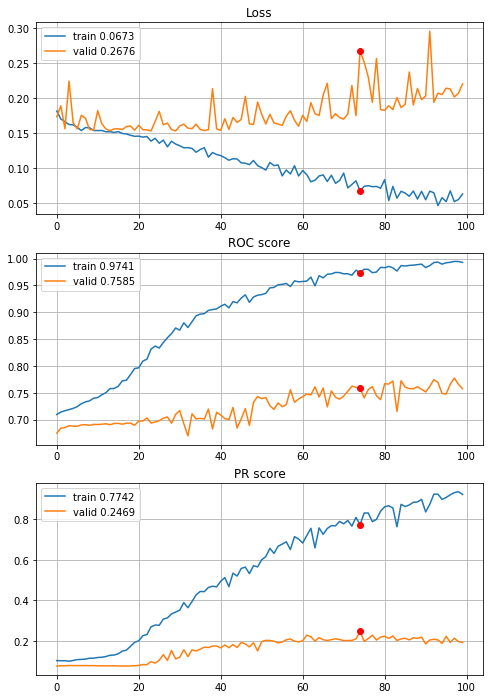


Fold 2------------------------------------------------------------


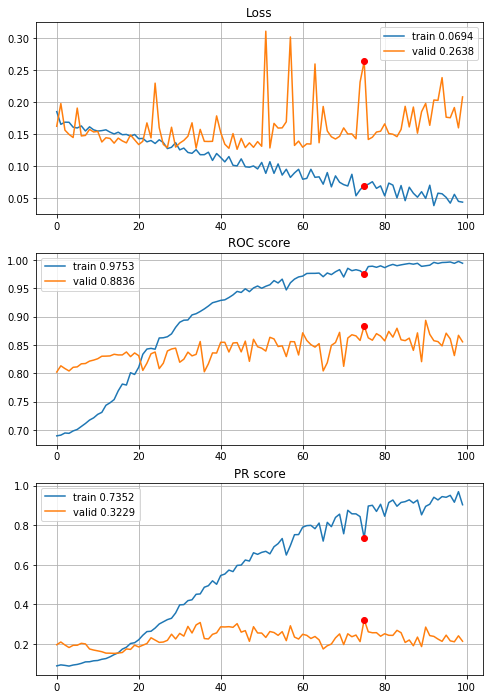


Fold 3------------------------------------------------------------


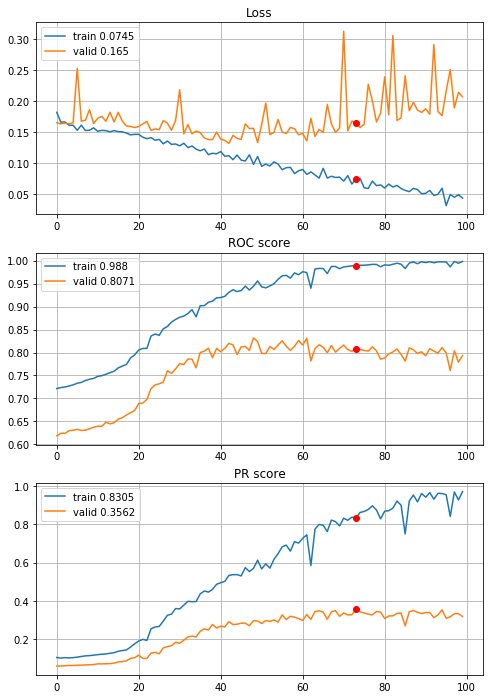


Fold 4------------------------------------------------------------


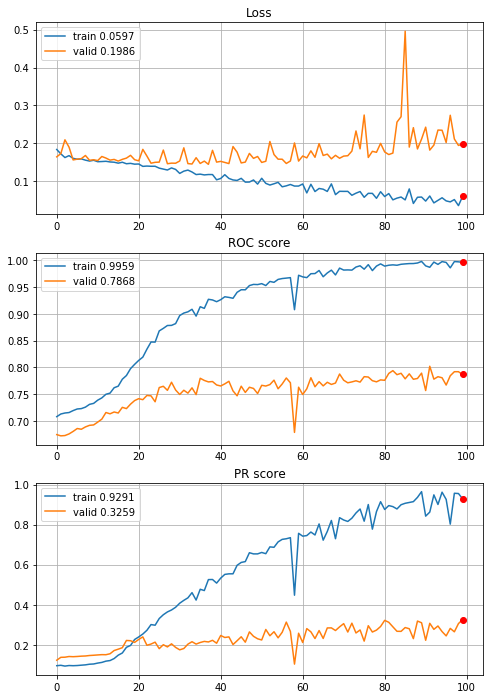


Fold 5------------------------------------------------------------


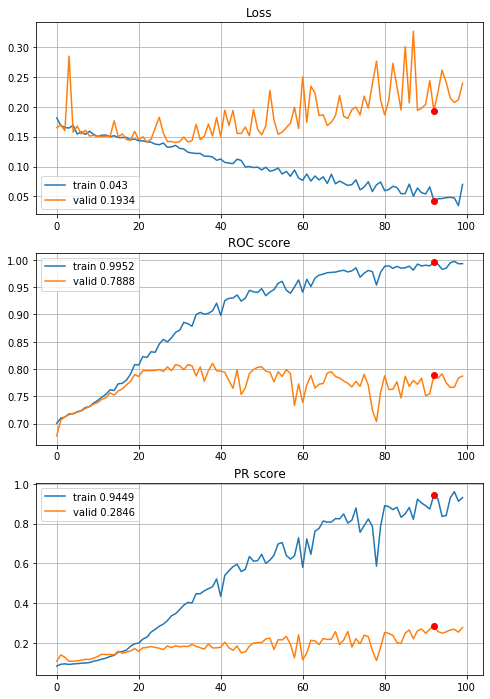


Fold 6------------------------------------------------------------


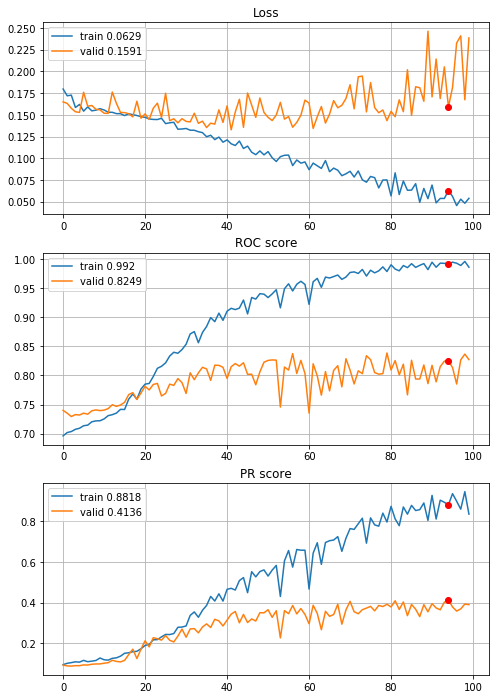

In [45]:
# first CNN with quantile clipping (Q_0.005, Q_0.995), power transform and normalization
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Another improvement PR +0.075 and bigger overfitting, learning curves are not so pretty. The most complex preprocessing pipeline tends to be the best one. Lets find the best architecture :)

But first, lets create and save images drafts for folds and see some results.

In [46]:
# drafts computation

# CV sets
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
# drafts lists initialization
drafts_ini=[]
drafts_opti=[]

# CV loop
for fold in range(len(train_folds)):
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    # ----- Monte Carlo energy optimization -----
    # correlation matrix for non bankrupt observations
    corr_matrix_fold=X_train_fold[Y_train_fold==0].corr(method="spearman")
    # draft inicialization
    draft_fold_ini=image_draft_inicialization(features, random_state)
    # quasi optimization
    draft_fold_opti=MC_Energy_optimization(corr_matrix=corr_matrix_fold, draft=draft_fold_ini, alpha=3, n_eval=100,
                                           random_state=random_state)
    # transform draft dictionary to matrix
    draft_fold_ini=image_dict_to_matrix(draft_fold_ini)
    draft_fold_opti=image_dict_to_matrix(draft_fold_opti)
    
    drafts_ini.append(draft_fold_ini)
    drafts_opti.append(draft_fold_opti)
    
drafts=dict(zip(["initial_drafts", "optimized_drafts"], [drafts_ini, drafts_opti]))

# saving drafts
with open(r"data\1year_data\drafts_8x8.p", "wb") as fp:
    pickle.dump(drafts, fp)

initial image energy: 13563.206
iteration: 100
current energy: 12028.5303
iteration: 200
current energy: 11193.9662
iteration: 300
current energy: 10907.0353
iteration: 400
current energy: 10567.3695
iteration: 500
current energy: 10261.3704
iteration: 600
current energy: 10063.7156
iteration: 700
current energy: 10026.0446
iteration: 800
current energy: 9981.582
iteration: 900
current energy: 9821.0686
iteration: 1000
current energy: 9793.0137
iteration: 1100
current energy: 9793.0137
iteration: 1200
current energy: 9783.4536
iteration: 1300
current energy: 9783.4536
MC simulation time: 43s
energy after MC quasi optimization: 9783.4536
initial image energy: 13577.7901
iteration: 100
current energy: 12069.228
iteration: 200
current energy: 11252.7826
iteration: 300
current energy: 10843.9682
iteration: 400
current energy: 10636.4764
iteration: 500
current energy: 10368.9198
iteration: 600
current energy: 10199.3648
iteration: 700
current energy: 10153.1806
iteration: 800
current energy

In [39]:
# loading 8x8 drafts
with open(r"data\1year_data\drafts_8x8.p", "rb") as fp:
    drafts_8x8 = pickle.load(fp)

			 Normalization only

			----- FOLD 1 -----


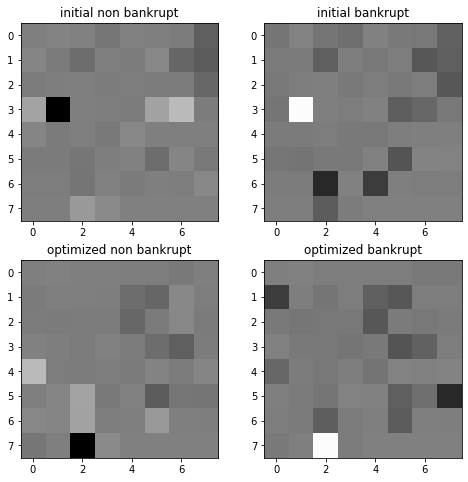


			----- FOLD 2 -----


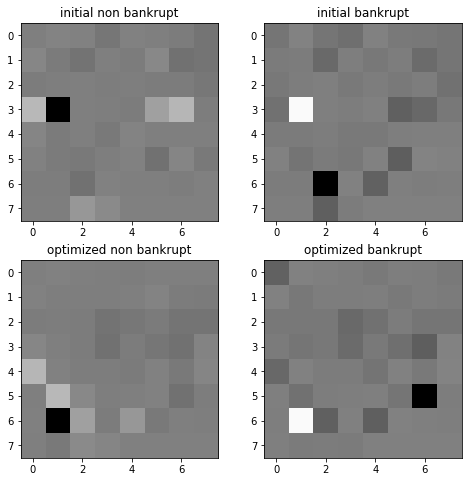


			----- FOLD 3 -----


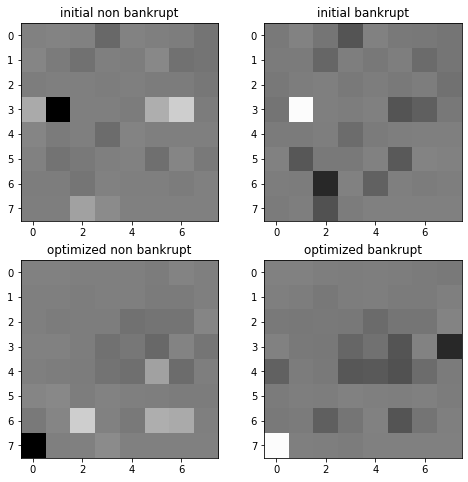


			----- FOLD 4 -----


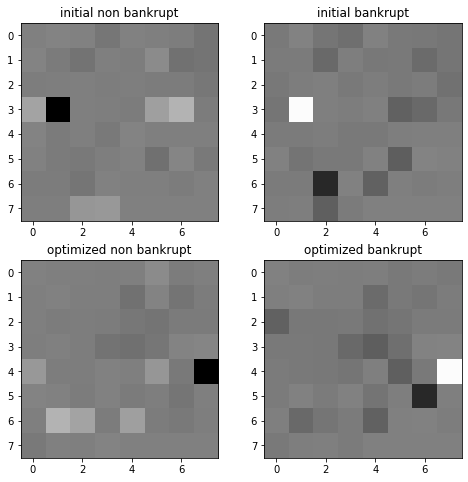


			----- FOLD 5 -----


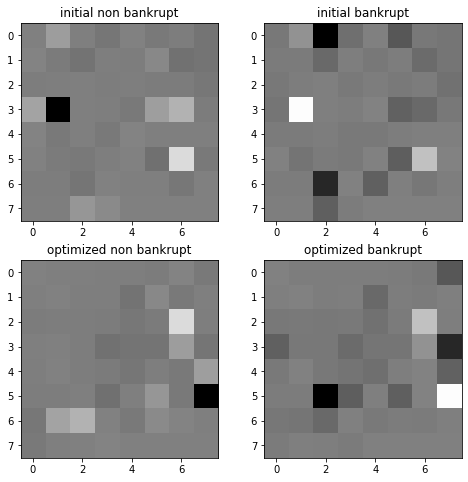


			----- FOLD 6 -----


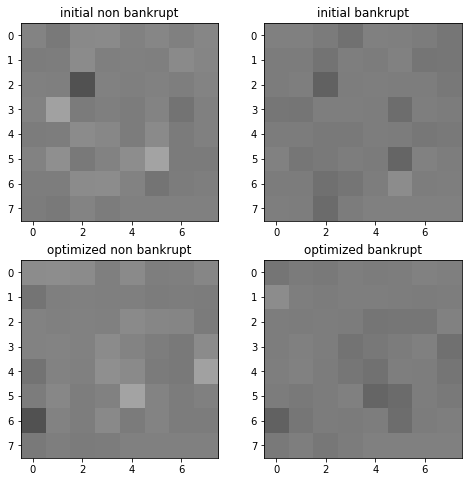

In [40]:
# printing images with normalization only
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t\t Normalization only")
for fold in range(len(train_folds)):
    print("\n\t\t\t----- FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=None, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

		 Normalization and quantile clipping

			-----FOLD 1 -----


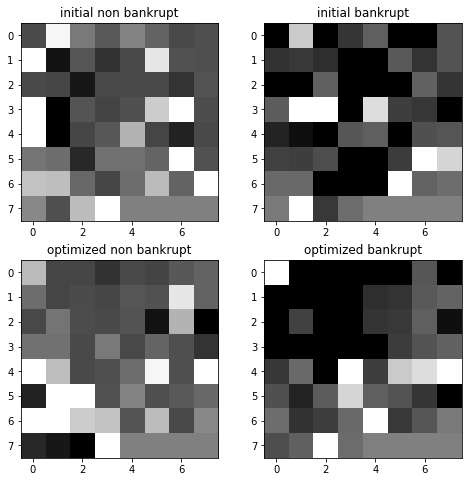


			-----FOLD 2 -----


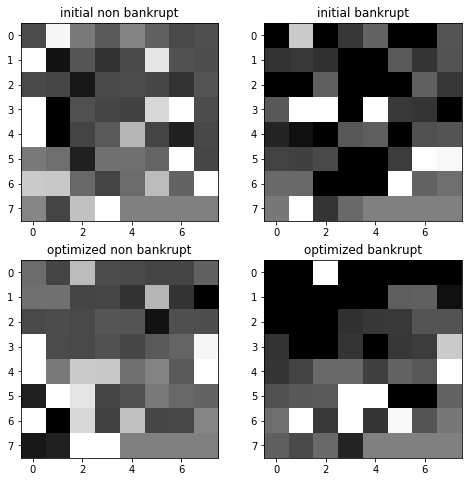


			-----FOLD 3 -----


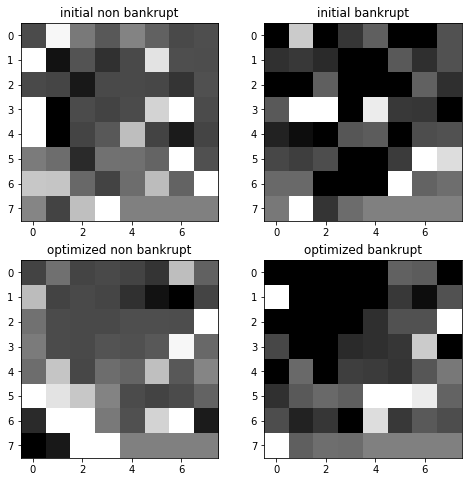


			-----FOLD 4 -----


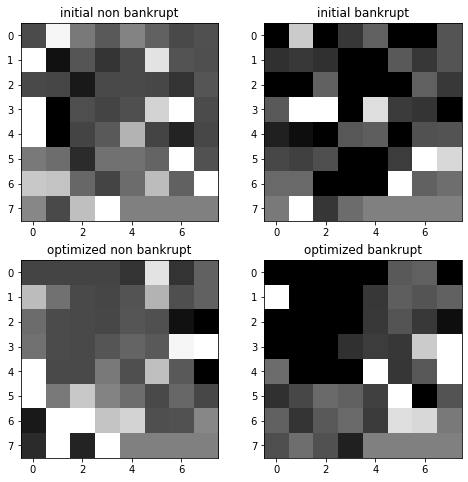


			-----FOLD 5 -----


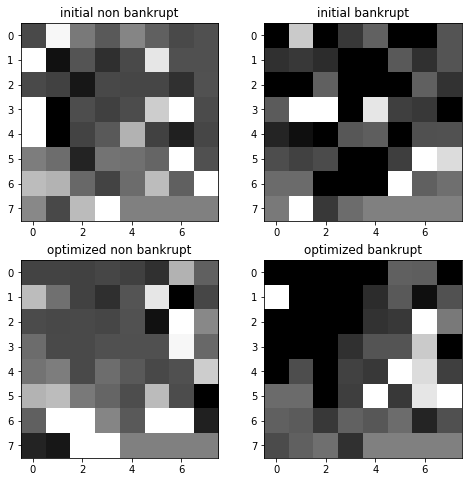


			-----FOLD 6 -----


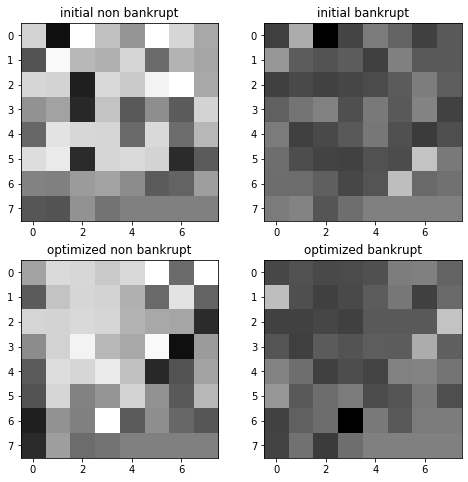

In [41]:
# printing images for normalization with quantile clipping
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
print("\t\t Normalization and quantile clipping")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

	 Normalization, quantile clipping and power transform

			-----FOLD 1 -----


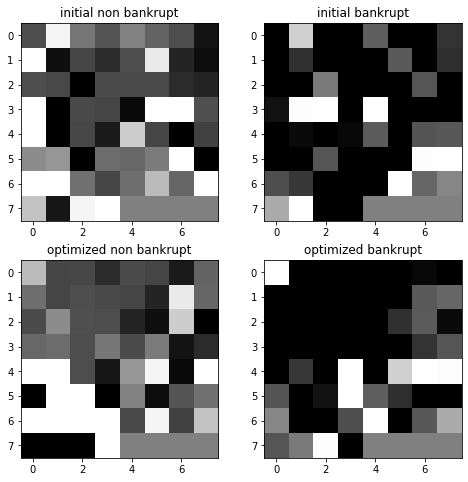


			-----FOLD 2 -----


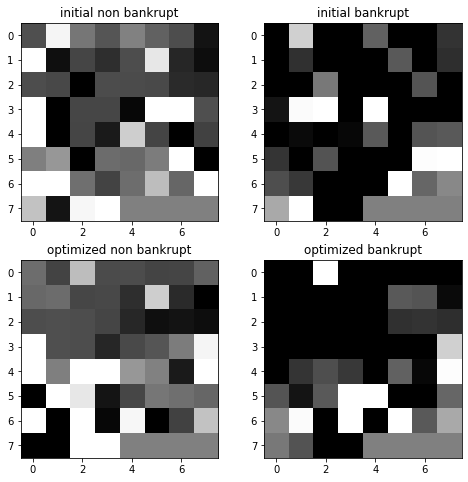


			-----FOLD 3 -----


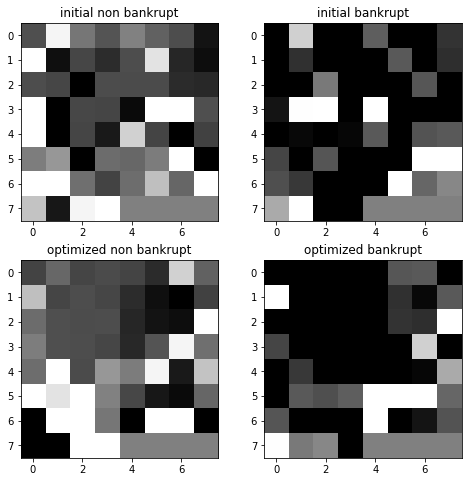


			-----FOLD 4 -----


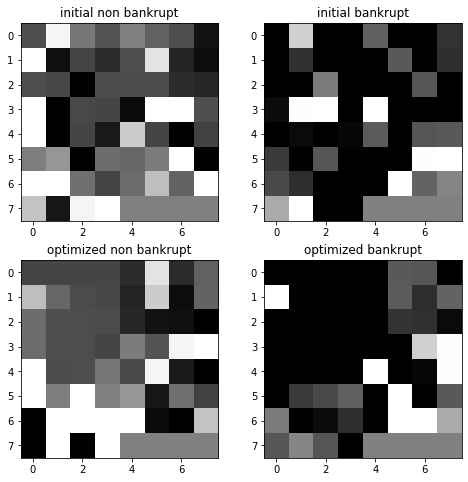


			-----FOLD 5 -----


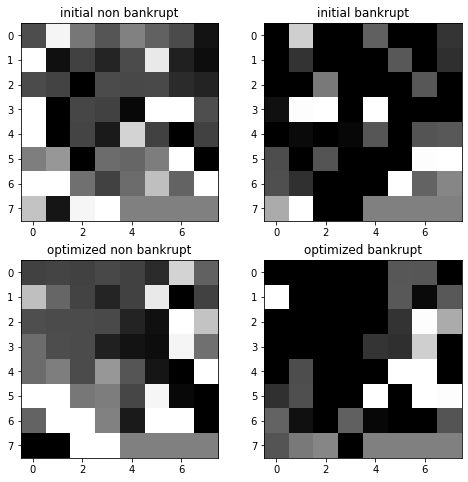


			-----FOLD 6 -----


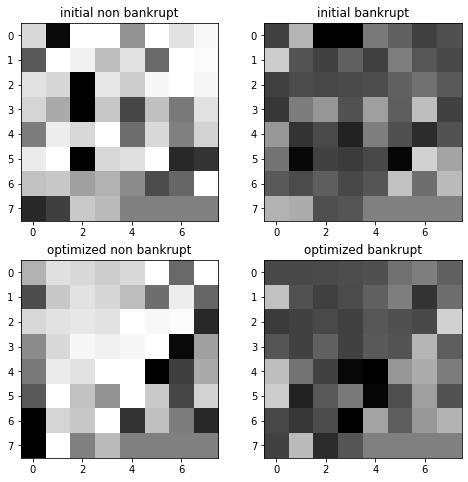

In [42]:
# printing images for normalization with quantile clipping and power transform
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
print("\t Normalization, quantile clipping and power transform")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=True)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

Same conclusions as for 1 and 2 year horizons

Lets start experiments with model architecture, first define inception module.

In [43]:
def inception_module(prev_layer, f1, f2_in, f2_out, f3_in, f3_out, f4_out, random_state=random_state):
    
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    
    conv1x1 = layers.Conv2D(filters=f1, kernel_size=(1,1), strides=(1,1), padding="same",
                             activation=activations.relu, use_bias=True)(prev_layer)
    conv3x3 = layers.Conv2D(filters=f2_in, kernel_size=(1,1), strides=(1,1), padding="valid",
                            activation=activations.relu, use_bias=True)(prev_layer)
    conv3x3 = layers.Conv2D(filters=f2_out, kernel_size=(3,3), strides=(1,1), padding="same",
                            activation=activations.relu, use_bias=True)(conv3x3)
    conv5x5 = layers.Conv2D(filters=f3_in, kernel_size=(1,1), strides=(1,1), padding="valid",
                            activation=activations.relu, use_bias=True)(prev_layer)
    conv5x5 = layers.Conv2D(filters=f3_out, kernel_size=(5,5), strides=(1,1), padding="same",
                            activation=activations.relu, use_bias=True)(conv5x5)
    max_pool = layers.MaxPooling2D(pool_size=(3,3), strides=(1,1), padding="same")(prev_layer)
    max_pool = layers.Conv2D(filters=f4_out, kernel_size=(1,1), strides=(1,1), padding="valid",
                             activation=activations.relu, use_bias=True)(max_pool)
    inception = layers.concatenate([conv1x1, conv3x3, conv5x5, max_pool], axis=-1)
    
    return inception

def define_deep_CNN_2inc_std(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu)(flat)                   # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model

To save the time, lets try the best models for 1-, 2-, 3- and 4- year horizon and pick up the best one.

##### 1 year horizon

In [47]:
def define_deep_CNN_2inc_std_L1_000025(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.000025))(flat)                          # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/450,
cumulative time: 3.37s train loss: 0.4055143139507105, validation loss: 0.30252871477174126
Epoch: 2/450,
cumulative time: 4.31s train loss: 0.2797934758595316, validation loss: 0.25670470582918603
Epoch: 3/450,
cumulative time: 5.24s train loss: 0.2495730466193447, validation loss: 0.23738095068162487
Epoch: 4/450,
cumulative time: 6.21s train loss: 0.23027103887676514, validation loss: 0.22204090708573357
Epoch: 5/450,
cumulative time: 7.2s train loss: 0.21638362390153548, validation loss: 0.21064644376172964
Epoch: 6/450,
cumulative time: 8.18s train loss: 0.20586102965660746, validation loss: 0.20381961516908723
Epoch: 7/450,
cumulative time: 9.11s train loss: 0.20127337633771733, validation loss: 0.20089520796765864
Epoch: 8/450,
cumulative time: 10.06s train loss: 0.19782760770994978, validation loss: 0.198337724980186
Epoch: 9/450,
cumulative time: 10.99s train loss: 0.19658645855747092,

Epoch: 77/450,
cumulative time: 74.34s train loss: 0.15562490952082783, validation loss: 0.16219762552960773
Epoch: 78/450,
cumulative time: 75.28s train loss: 0.15227043627844364, validation loss: 0.16327010106429657
Epoch: 79/450,
cumulative time: 76.22s train loss: 0.15255753564201224, validation loss: 0.16222323581887377
Epoch: 80/450,
cumulative time: 77.17s train loss: 0.15199624378608798, validation loss: 0.1632251444306274
Epoch: 81/450,
cumulative time: 78.13s train loss: 0.1536416323067341, validation loss: 0.16408406927531313
Epoch: 82/450,
cumulative time: 79.06s train loss: 0.15409735446580222, validation loss: 0.16690636467209805
Epoch: 83/450,
cumulative time: 80.0s train loss: 0.1521005024408932, validation loss: 0.16185438109869296
Epoch: 84/450,
cumulative time: 80.99s train loss: 0.15086914790932096, validation loss: 0.16356591453362235
Epoch: 85/450,
cumulative time: 81.93s train loss: 0.15092640031956178, validation loss: 0.16333770723677676
Epoch: 86/450,
cumulati

Epoch: 152/450,
cumulative time: 144.09s train loss: 0.1400696428072068, validation loss: 0.15783178498102546
Epoch: 153/450,
cumulative time: 145.02s train loss: 0.1410265976128361, validation loss: 0.16294186478887157
Epoch: 154/450,
cumulative time: 145.95s train loss: 0.14403354539703825, validation loss: 0.1592563419855523
Epoch: 155/450,
cumulative time: 146.87s train loss: 0.13866674274602017, validation loss: 0.1582332728200891
Epoch: 156/450,
cumulative time: 147.79s train loss: 0.1392320257917301, validation loss: 0.1582086786090536
Epoch: 157/450,
cumulative time: 148.72s train loss: 0.1389815273841373, validation loss: 0.1613528417172423
Epoch: 158/450,
cumulative time: 149.64s train loss: 0.13990720920759542, validation loss: 0.15762102258951885
Epoch: 159/450,
cumulative time: 150.56s train loss: 0.1383124987896977, validation loss: 0.15904218651198798
Epoch: 160/450,
cumulative time: 151.49s train loss: 0.13712841919013627, validation loss: 0.16132891347783793
Epoch: 161

Epoch: 227/450,
cumulative time: 214.57s train loss: 0.12954146517352316, validation loss: 0.15944050481468722
Epoch: 228/450,
cumulative time: 215.51s train loss: 0.1277933181717681, validation loss: 0.16135750481933073
Epoch: 229/450,
cumulative time: 216.43s train loss: 0.12857783276453416, validation loss: 0.1577567371912654
Epoch: 230/450,
cumulative time: 217.37s train loss: 0.12721078170770939, validation loss: 0.1613984156322208
Epoch: 231/450,
cumulative time: 218.3s train loss: 0.12903042279848337, validation loss: 0.15819364571254665
Epoch: 232/450,
cumulative time: 219.23s train loss: 0.12776010619508246, validation loss: 0.15964618678676562
Epoch: 233/450,
cumulative time: 220.15s train loss: 0.13055951177395272, validation loss: 0.16342293430098545
Epoch: 234/450,
cumulative time: 221.08s train loss: 0.12740001899015294, validation loss: 0.15777908528552337
Epoch: 235/450,
cumulative time: 222.02s train loss: 0.127852985497557, validation loss: 0.1589293417430693
Epoch: 2

Epoch: 302/450,
cumulative time: 284.92s train loss: 0.11627541111474697, validation loss: 0.16769120806874088
Epoch: 303/450,
cumulative time: 285.89s train loss: 0.11776450493247505, validation loss: 0.16660195973611647
Epoch: 304/450,
cumulative time: 286.83s train loss: 0.11765545210756885, validation loss: 0.16450154583413415
Epoch: 305/450,
cumulative time: 287.76s train loss: 0.11491086466319195, validation loss: 0.1648431861705979
Epoch: 306/450,
cumulative time: 288.7s train loss: 0.11382102716070877, validation loss: 0.16905584679722108
Epoch: 307/450,
cumulative time: 289.63s train loss: 0.11444682589037594, validation loss: 0.16805155354726925
Epoch: 308/450,
cumulative time: 290.54s train loss: 0.11387159133602139, validation loss: 0.16730255864037508
Epoch: 309/450,
cumulative time: 291.48s train loss: 0.11387174193388597, validation loss: 0.16656124261004648
Epoch: 310/450,
cumulative time: 292.39s train loss: 0.11447677077050453, validation loss: 0.16478478419373566
Epo

Epoch: 377/450,
cumulative time: 354.9s train loss: 0.1035814446702854, validation loss: 0.1783419714028288
Epoch: 378/450,
cumulative time: 355.84s train loss: 0.10517310464376517, validation loss: 0.17499069513247634
Epoch: 379/450,
cumulative time: 356.76s train loss: 0.10268866921115871, validation loss: 0.17873419730780926
Epoch: 380/450,
cumulative time: 357.68s train loss: 0.10138434095332925, validation loss: 0.17699198837637675
Epoch: 381/450,
cumulative time: 358.6s train loss: 0.10399359930342017, validation loss: 0.18311401121530407
Epoch: 382/450,
cumulative time: 359.53s train loss: 0.10451933406788212, validation loss: 0.17999267575297456
Epoch: 383/450,
cumulative time: 360.45s train loss: 0.10108968650593478, validation loss: 0.17557841833447596
Epoch: 384/450,
cumulative time: 361.39s train loss: 0.10320295410997728, validation loss: 0.17903555587527875
Epoch: 385/450,
cumulative time: 362.31s train loss: 0.10484413112702813, validation loss: 0.1788753017472135
Epoch:

Train on 5270 samples, validate on 1054 samples
Epoch: 1/450,
cumulative time: 2.96s train loss: 0.38531001708991613, validation loss: 0.29139690742999375
Epoch: 2/450,
cumulative time: 3.92s train loss: 0.2839515586335926, validation loss: 0.247443159232782
Epoch: 3/450,
cumulative time: 4.96s train loss: 0.2489258169449258, validation loss: 0.2286026090722835
Epoch: 4/450,
cumulative time: 5.89s train loss: 0.23021739832703483, validation loss: 0.21175535758374087
Epoch: 5/450,
cumulative time: 6.82s train loss: 0.21645874120931247, validation loss: 0.20068140859508876
Epoch: 6/450,
cumulative time: 7.73s train loss: 0.20721663233790497, validation loss: 0.19234870617371583
Epoch: 7/450,
cumulative time: 8.65s train loss: 0.2015129431431841, validation loss: 0.189017972695081
Epoch: 8/450,
cumulative time: 9.57s train loss: 0.19885637628964273, validation loss: 0.1852253549069562
Epoch: 9/450,
cumulative time: 10.49s train loss: 0.19624076352739245, validation loss: 0.181993193740636

Epoch: 77/450,
cumulative time: 71.84s train loss: 0.15646344248551797, validation loss: 0.1424260593003521
Epoch: 78/450,
cumulative time: 72.74s train loss: 0.1555904493131719, validation loss: 0.14440039934085036
Epoch: 79/450,
cumulative time: 73.64s train loss: 0.1566570574039526, validation loss: 0.14400552193399171
Epoch: 80/450,
cumulative time: 74.54s train loss: 0.15561783159367273, validation loss: 0.14194458539277824
Epoch: 81/450,
cumulative time: 75.45s train loss: 0.1547076938698595, validation loss: 0.14505767423581806
Epoch: 82/450,
cumulative time: 76.35s train loss: 0.1563290228653678, validation loss: 0.14221092555283144
Epoch: 83/450,
cumulative time: 77.26s train loss: 0.15596704524597135, validation loss: 0.14161094873295338
Epoch: 84/450,
cumulative time: 78.17s train loss: 0.15655165577070537, validation loss: 0.14209548447570947
Epoch: 85/450,
cumulative time: 79.07s train loss: 0.15456350346500553, validation loss: 0.14165658032984615
Epoch: 86/450,
cumulativ

Epoch: 152/450,
cumulative time: 139.88s train loss: 0.13964048808677373, validation loss: 0.13664964124192774
Epoch: 153/450,
cumulative time: 140.81s train loss: 0.13966390788555144, validation loss: 0.1347831443263186
Epoch: 154/450,
cumulative time: 141.74s train loss: 0.13945407415872732, validation loss: 0.1376230359869166
Epoch: 155/450,
cumulative time: 142.65s train loss: 0.1395393859870746, validation loss: 0.13387143357428927
Epoch: 156/450,
cumulative time: 143.54s train loss: 0.13939124066700745, validation loss: 0.13354658770889213
Epoch: 157/450,
cumulative time: 144.44s train loss: 0.14048147240558204, validation loss: 0.1345391602059243
Epoch: 158/450,
cumulative time: 145.33s train loss: 0.1409587844980057, validation loss: 0.13484728194956988
Epoch: 159/450,
cumulative time: 146.24s train loss: 0.14038954769354844, validation loss: 0.13284698927481667
Epoch: 160/450,
cumulative time: 147.13s train loss: 0.1383507636087669, validation loss: 0.1337537363708811
Epoch: 1

Epoch: 227/450,
cumulative time: 207.31s train loss: 0.1249938906115644, validation loss: 0.13437476805084345
Epoch: 228/450,
cumulative time: 208.21s train loss: 0.12674094166543046, validation loss: 0.13526699881456383
Epoch: 229/450,
cumulative time: 209.1s train loss: 0.1259288214132953, validation loss: 0.14348075642079058
Epoch: 230/450,
cumulative time: 209.98s train loss: 0.12389397572521015, validation loss: 0.13532550118340486
Epoch: 231/450,
cumulative time: 210.86s train loss: 0.126113723690641, validation loss: 0.13904559726789736
Epoch: 232/450,
cumulative time: 211.76s train loss: 0.1267483485010815, validation loss: 0.13556960898060952
Epoch: 233/450,
cumulative time: 212.67s train loss: 0.12481835516738711, validation loss: 0.13572571469043193
Epoch: 234/450,
cumulative time: 213.55s train loss: 0.1245599279310943, validation loss: 0.1325298423898288
Epoch: 235/450,
cumulative time: 214.48s train loss: 0.12228413386238594, validation loss: 0.13353247763818762
Epoch: 23

Epoch: 302/450,
cumulative time: 275.44s train loss: 0.10828286935866897, validation loss: 0.1425179796014158
Epoch: 303/450,
cumulative time: 276.34s train loss: 0.10845317079825238, validation loss: 0.14001256990930386
Epoch: 304/450,
cumulative time: 277.28s train loss: 0.11050536752708497, validation loss: 0.1435518087624825
Epoch: 305/450,
cumulative time: 278.21s train loss: 0.10833030072176932, validation loss: 0.14352376505987016
Epoch: 306/450,
cumulative time: 279.11s train loss: 0.11151817377508252, validation loss: 0.13844657316097045
Epoch: 307/450,
cumulative time: 280.01s train loss: 0.10907081054272642, validation loss: 0.14385121058411118
Epoch: 308/450,
cumulative time: 280.92s train loss: 0.10807422522519074, validation loss: 0.14408450501580392
Epoch: 309/450,
cumulative time: 281.81s train loss: 0.10719365991609599, validation loss: 0.14513298569413244
Epoch: 310/450,
cumulative time: 282.7s train loss: 0.10851661949162239, validation loss: 0.140907361396576
Epoch:

Epoch: 377/450,
cumulative time: 342.98s train loss: 0.09197029108906155, validation loss: 0.15801456205872025
Epoch: 378/450,
cumulative time: 343.87s train loss: 0.09038247378716206, validation loss: 0.1554167052091186
Epoch: 379/450,
cumulative time: 344.76s train loss: 0.09013511240906462, validation loss: 0.1552104715264952
Epoch: 380/450,
cumulative time: 345.65s train loss: 0.09014429913328313, validation loss: 0.15086187128210882
Epoch: 381/450,
cumulative time: 346.56s train loss: 0.09362497726416452, validation loss: 0.161286371199863
Epoch: 382/450,
cumulative time: 347.45s train loss: 0.09262351445443716, validation loss: 0.15700698297548565
Epoch: 383/450,
cumulative time: 348.33s train loss: 0.09056714365587515, validation loss: 0.1559470035489189
Epoch: 384/450,
cumulative time: 349.23s train loss: 0.08928317909166075, validation loss: 0.1611956546553172
Epoch: 385/450,
cumulative time: 350.12s train loss: 0.08860119147759914, validation loss: 0.16363431962889105
Epoch: 

Train on 5270 samples, validate on 1054 samples
Epoch: 1/450,
cumulative time: 3.3s train loss: 0.3987452143057474, validation loss: 0.310876595057844
Epoch: 2/450,
cumulative time: 4.2s train loss: 0.2846481962889376, validation loss: 0.25978380633938697
Epoch: 3/450,
cumulative time: 5.1s train loss: 0.24813110643478228, validation loss: 0.24053035407862583
Epoch: 4/450,
cumulative time: 5.99s train loss: 0.22915386209791028, validation loss: 0.22577274439457018
Epoch: 5/450,
cumulative time: 6.87s train loss: 0.2149962010883516, validation loss: 0.21411324828241085
Epoch: 6/450,
cumulative time: 7.76s train loss: 0.20445732755385043, validation loss: 0.20779241146466765
Epoch: 7/450,
cumulative time: 8.66s train loss: 0.1994454141416405, validation loss: 0.20536555417687888
Epoch: 8/450,
cumulative time: 9.54s train loss: 0.195854628459326, validation loss: 0.20312714197830187
Epoch: 9/450,
cumulative time: 10.42s train loss: 0.19333783582107392, validation loss: 0.20185658895539604

Epoch: 77/450,
cumulative time: 71.15s train loss: 0.15382774755556625, validation loss: 0.16495154204246443
Epoch: 78/450,
cumulative time: 72.04s train loss: 0.15309652970004578, validation loss: 0.1666457176321598
Epoch: 79/450,
cumulative time: 72.95s train loss: 0.15313568388657958, validation loss: 0.1707603937930355
Epoch: 80/450,
cumulative time: 73.84s train loss: 0.15413476718444752, validation loss: 0.16537684032541525
Epoch: 81/450,
cumulative time: 74.76s train loss: 0.15273645730862356, validation loss: 0.16420051452670198
Epoch: 82/450,
cumulative time: 75.68s train loss: 0.15214145555385375, validation loss: 0.16727942064319662
Epoch: 83/450,
cumulative time: 76.6s train loss: 0.1532076837639881, validation loss: 0.16403831657467577
Epoch: 84/450,
cumulative time: 77.52s train loss: 0.15207866426606784, validation loss: 0.16752958229868417
Epoch: 85/450,
cumulative time: 78.44s train loss: 0.15461021962891947, validation loss: 0.16689086183764223
Epoch: 86/450,
cumulati

Epoch: 152/450,
cumulative time: 138.89s train loss: 0.13959114739010411, validation loss: 0.1563052753343528
Epoch: 153/450,
cumulative time: 139.79s train loss: 0.13911122472734108, validation loss: 0.15533610030414935
Epoch: 154/450,
cumulative time: 140.69s train loss: 0.1385693030746431, validation loss: 0.15197257779581044
Epoch: 155/450,
cumulative time: 141.57s train loss: 0.13826592029045837, validation loss: 0.15293609763741267
Epoch: 156/450,
cumulative time: 142.46s train loss: 0.13914041111433076, validation loss: 0.15469120977273249
Epoch: 157/450,
cumulative time: 143.35s train loss: 0.13843017777240707, validation loss: 0.1526495079444527
Epoch: 158/450,
cumulative time: 144.22s train loss: 0.13811496991869168, validation loss: 0.15254188372808344
Epoch: 159/450,
cumulative time: 145.12s train loss: 0.1408192734423127, validation loss: 0.15548795252416348
Epoch: 160/450,
cumulative time: 146.01s train loss: 0.13759490894807583, validation loss: 0.1551108552563575
Epoch:

Epoch: 227/450,
cumulative time: 206.18s train loss: 0.12819150113968966, validation loss: 0.15186633777573166
Epoch: 228/450,
cumulative time: 207.11s train loss: 0.12805964577469472, validation loss: 0.14981498186117784
Epoch: 229/450,
cumulative time: 208.0s train loss: 0.12684089557835002, validation loss: 0.1492539563232174
Epoch: 230/450,
cumulative time: 208.89s train loss: 0.12504669442009428, validation loss: 0.14848054108515638
Epoch: 231/450,
cumulative time: 209.79s train loss: 0.12440615355459517, validation loss: 0.14800986206508904
Epoch: 232/450,
cumulative time: 210.68s train loss: 0.1243982165882212, validation loss: 0.1505381432865557
Epoch: 233/450,
cumulative time: 211.59s train loss: 0.12413057787821008, validation loss: 0.14824755471447162
Epoch: 234/450,
cumulative time: 212.5s train loss: 0.12381445870962722, validation loss: 0.14871207463503788
Epoch: 235/450,
cumulative time: 213.39s train loss: 0.12339799656361285, validation loss: 0.15084661035824998
Epoch:

Epoch: 302/450,
cumulative time: 273.34s train loss: 0.11538506850628517, validation loss: 0.1500220638072468
Epoch: 303/450,
cumulative time: 274.23s train loss: 0.11411560290339323, validation loss: 0.15080896147175124
Epoch: 304/450,
cumulative time: 275.12s train loss: 0.11452798071746809, validation loss: 0.1515853252311359
Epoch: 305/450,
cumulative time: 276.02s train loss: 0.11376093619094854, validation loss: 0.15042177560885897
Epoch: 306/450,
cumulative time: 276.91s train loss: 0.11402227894122054, validation loss: 0.1503810797883392
Epoch: 307/450,
cumulative time: 277.8s train loss: 0.11331816207921483, validation loss: 0.14999148603069262
Epoch: 308/450,
cumulative time: 278.68s train loss: 0.11441305595568507, validation loss: 0.15069828063701995
Epoch: 309/450,
cumulative time: 279.59s train loss: 0.11386303127773346, validation loss: 0.15058596283762912
Epoch: 310/450,
cumulative time: 280.46s train loss: 0.11360555390422665, validation loss: 0.14985335683291054
Epoch

Epoch: 377/450,
cumulative time: 341.18s train loss: 0.107838802432652, validation loss: 0.15639806367753806
Epoch: 378/450,
cumulative time: 342.08s train loss: 0.10609844237622545, validation loss: 0.1633227946240264
Epoch: 379/450,
cumulative time: 343.03s train loss: 0.1062437070360446, validation loss: 0.15504699197564226
Epoch: 380/450,
cumulative time: 343.98s train loss: 0.10588592655348823, validation loss: 0.1599905160335255
Epoch: 381/450,
cumulative time: 344.87s train loss: 0.10327086157149563, validation loss: 0.15826543235349022
Epoch: 382/450,
cumulative time: 345.79s train loss: 0.10465740244517516, validation loss: 0.15714253991333313
Epoch: 383/450,
cumulative time: 346.71s train loss: 0.10393794513461259, validation loss: 0.15576717803215845
Epoch: 384/450,
cumulative time: 347.62s train loss: 0.10420093808245387, validation loss: 0.15707769304287728
Epoch: 385/450,
cumulative time: 348.52s train loss: 0.10251543648272357, validation loss: 0.15620850087399726
Epoch:

Train on 5270 samples, validate on 1054 samples
Epoch: 1/450,
cumulative time: 3.26s train loss: 0.3876482656038237, validation loss: 0.30805230180271664
Epoch: 2/450,
cumulative time: 4.17s train loss: 0.2795675905877318, validation loss: 0.2592343881980744
Epoch: 3/450,
cumulative time: 5.08s train loss: 0.24898253551470487, validation loss: 0.24009388829431227
Epoch: 4/450,
cumulative time: 6.01s train loss: 0.2291757210382248, validation loss: 0.22476257782507214
Epoch: 5/450,
cumulative time: 6.92s train loss: 0.21503443246322068, validation loss: 0.21320485271357947
Epoch: 6/450,
cumulative time: 7.84s train loss: 0.2058274634705549, validation loss: 0.20612034973541746
Epoch: 7/450,
cumulative time: 8.76s train loss: 0.20029301291059498, validation loss: 0.2029792251068908
Epoch: 8/450,
cumulative time: 9.69s train loss: 0.19882339528661072, validation loss: 0.19990205685599252
Epoch: 9/450,
cumulative time: 10.61s train loss: 0.19566049559971413, validation loss: 0.197773078361

Epoch: 77/450,
cumulative time: 74.11s train loss: 0.15541425069663284, validation loss: 0.16038461623313982
Epoch: 78/450,
cumulative time: 75.03s train loss: 0.15564990224603006, validation loss: 0.15996083176113396
Epoch: 79/450,
cumulative time: 75.95s train loss: 0.15619752448638882, validation loss: 0.16296024993768907
Epoch: 80/450,
cumulative time: 76.87s train loss: 0.15629168050452022, validation loss: 0.16161885868892273
Epoch: 81/450,
cumulative time: 77.8s train loss: 0.15706519368873376, validation loss: 0.16038712282334605
Epoch: 82/450,
cumulative time: 78.72s train loss: 0.15649652227731087, validation loss: 0.160139958732947
Epoch: 83/450,
cumulative time: 79.64s train loss: 0.15607406634420326, validation loss: 0.1592363852590492
Epoch: 84/450,
cumulative time: 80.56s train loss: 0.15531223369391187, validation loss: 0.16475897945421245
Epoch: 85/450,
cumulative time: 81.47s train loss: 0.1561076997749267, validation loss: 0.16005271387620487
Epoch: 86/450,
cumulativ

Epoch: 152/450,
cumulative time: 142.96s train loss: 0.1430191715680897, validation loss: 0.15568794163060595
Epoch: 153/450,
cumulative time: 143.9s train loss: 0.14369469335907098, validation loss: 0.15375313691554532
Epoch: 154/450,
cumulative time: 144.83s train loss: 0.14262824497650425, validation loss: 0.153133940425272
Epoch: 155/450,
cumulative time: 145.75s train loss: 0.14252994556184964, validation loss: 0.15390606889009928
Epoch: 156/450,
cumulative time: 146.71s train loss: 0.14258982143603421, validation loss: 0.15328888931582052
Epoch: 157/450,
cumulative time: 147.62s train loss: 0.14207913901027738, validation loss: 0.1563187373317849
Epoch: 158/450,
cumulative time: 148.58s train loss: 0.14188785568247259, validation loss: 0.15326606299890738
Epoch: 159/450,
cumulative time: 149.5s train loss: 0.1414531916606132, validation loss: 0.1563780387223785
Epoch: 160/450,
cumulative time: 150.41s train loss: 0.14297852840493708, validation loss: 0.15338082102602754
Epoch: 16

Epoch: 227/450,
cumulative time: 211.75s train loss: 0.1310730022288138, validation loss: 0.1596281681443075
Epoch: 228/450,
cumulative time: 212.67s train loss: 0.13120219285619328, validation loss: 0.15776389591268616
Epoch: 229/450,
cumulative time: 213.59s train loss: 0.1305085413822413, validation loss: 0.15883618695007556
Epoch: 230/450,
cumulative time: 214.51s train loss: 0.1329822698314683, validation loss: 0.15795158884670069
Epoch: 231/450,
cumulative time: 215.44s train loss: 0.13033104546269159, validation loss: 0.1596703961124004
Epoch: 232/450,
cumulative time: 216.36s train loss: 0.131183360802607, validation loss: 0.15899141146969298
Epoch: 233/450,
cumulative time: 217.28s train loss: 0.13102675287558413, validation loss: 0.15789797608042577
Epoch: 234/450,
cumulative time: 218.2s train loss: 0.1301694770748294, validation loss: 0.1586584557392113
Epoch: 235/450,
cumulative time: 219.12s train loss: 0.1305387897922373, validation loss: 0.1586668107948448
Epoch: 236/45

Epoch: 302/450,
cumulative time: 281.6s train loss: 0.11914366487929672, validation loss: 0.1657609198192944
Epoch: 303/450,
cumulative time: 282.57s train loss: 0.11909015566336814, validation loss: 0.16681760792714143
Epoch: 304/450,
cumulative time: 283.56s train loss: 0.11935270346941486, validation loss: 0.1680376281717923
Epoch: 305/450,
cumulative time: 284.52s train loss: 0.11907070979221496, validation loss: 0.16750692054487948
Epoch: 306/450,
cumulative time: 285.46s train loss: 0.11876245504086112, validation loss: 0.1734029577172006
Epoch: 307/450,
cumulative time: 286.42s train loss: 0.12413258948973054, validation loss: 0.1724881023677522
Epoch: 308/450,
cumulative time: 287.43s train loss: 0.12189066730425525, validation loss: 0.1676358573803187
Epoch: 309/450,
cumulative time: 288.42s train loss: 0.1175336047978736, validation loss: 0.17629680526663727
Epoch: 310/450,
cumulative time: 289.42s train loss: 0.11954650692005538, validation loss: 0.1725671016513962
Epoch: 31

Epoch: 377/450,
cumulative time: 358.63s train loss: 0.11079562490760037, validation loss: 0.1811661949872518
Epoch: 378/450,
cumulative time: 359.59s train loss: 0.10788589094180535, validation loss: 0.18356743372934367
Epoch: 379/450,
cumulative time: 360.61s train loss: 0.10914028124632827, validation loss: 0.1815865046611547
Epoch: 380/450,
cumulative time: 361.66s train loss: 0.10691931820571762, validation loss: 0.18320086920736411
Epoch: 381/450,
cumulative time: 362.61s train loss: 0.10719489185475307, validation loss: 0.18129146661771994
Epoch: 382/450,
cumulative time: 363.54s train loss: 0.10784636361549203, validation loss: 0.18199510066513772
Epoch: 383/450,
cumulative time: 364.5s train loss: 0.10988908048853475, validation loss: 0.18021879456866624
Epoch: 384/450,
cumulative time: 365.41s train loss: 0.10619987253898461, validation loss: 0.18220115505314416
Epoch: 385/450,
cumulative time: 366.37s train loss: 0.10684012595203615, validation loss: 0.180796147636942
Epoch:

Train on 5270 samples, validate on 1054 samples
Epoch: 1/450,
cumulative time: 4.32s train loss: 0.3831545190351964, validation loss: 0.3048139347975801
Epoch: 2/450,
cumulative time: 5.31s train loss: 0.2840366608447323, validation loss: 0.25590254171297266
Epoch: 3/450,
cumulative time: 6.29s train loss: 0.2475802602193387, validation loss: 0.23672334253222485
Epoch: 4/450,
cumulative time: 7.3s train loss: 0.229508249249585, validation loss: 0.22076366024632607
Epoch: 5/450,
cumulative time: 8.29s train loss: 0.2151374144730577, validation loss: 0.20931630823372438
Epoch: 6/450,
cumulative time: 9.29s train loss: 0.20569673162483854, validation loss: 0.201984317185078
Epoch: 7/450,
cumulative time: 10.31s train loss: 0.2003291980308645, validation loss: 0.1978199005805564
Epoch: 8/450,
cumulative time: 11.32s train loss: 0.1969842409047049, validation loss: 0.19463731407892998
Epoch: 9/450,
cumulative time: 12.3s train loss: 0.19459991977042898, validation loss: 0.19255628887797216


Epoch: 77/450,
cumulative time: 80.75s train loss: 0.1557358126458226, validation loss: 0.15884400457426537
Epoch: 78/450,
cumulative time: 81.72s train loss: 0.15514468690362782, validation loss: 0.15393538422444286
Epoch: 79/450,
cumulative time: 82.67s train loss: 0.15387326862938716, validation loss: 0.15410292162727812
Epoch: 80/450,
cumulative time: 83.64s train loss: 0.15444436234756032, validation loss: 0.15363639508298046
Epoch: 81/450,
cumulative time: 84.61s train loss: 0.15354353677219865, validation loss: 0.15352875277032435
Epoch: 82/450,
cumulative time: 85.57s train loss: 0.15291450529781644, validation loss: 0.15541355487178354
Epoch: 83/450,
cumulative time: 86.57s train loss: 0.15444773376496965, validation loss: 0.15324444144229057
Epoch: 84/450,
cumulative time: 87.57s train loss: 0.153366542221586, validation loss: 0.15325814304587057
Epoch: 85/450,
cumulative time: 88.54s train loss: 0.15187773321113732, validation loss: 0.15280657429848948
Epoch: 86/450,
cumulat

Epoch: 152/450,
cumulative time: 155.68s train loss: 0.1448595472005332, validation loss: 0.14653542598239386
Epoch: 153/450,
cumulative time: 156.66s train loss: 0.14489369409643044, validation loss: 0.14613766077573656
Epoch: 154/450,
cumulative time: 157.66s train loss: 0.14496516353491362, validation loss: 0.14713511645680813
Epoch: 155/450,
cumulative time: 158.65s train loss: 0.14182668004531335, validation loss: 0.14633811342987663
Epoch: 156/450,
cumulative time: 159.61s train loss: 0.14213948271871743, validation loss: 0.1484772520284725
Epoch: 157/450,
cumulative time: 160.64s train loss: 0.1415863216545369, validation loss: 0.14623750030881313
Epoch: 158/450,
cumulative time: 161.61s train loss: 0.14085642151124564, validation loss: 0.14905558223968665
Epoch: 159/450,
cumulative time: 162.59s train loss: 0.1419390437244464, validation loss: 0.14578010376535738
Epoch: 160/450,
cumulative time: 163.6s train loss: 0.14097308001889222, validation loss: 0.14616500468928176
Epoch:

Epoch: 227/450,
cumulative time: 232.78s train loss: 0.12543537820595718, validation loss: 0.15241476791633374
Epoch: 228/450,
cumulative time: 233.87s train loss: 0.12278505652238114, validation loss: 0.1519921561119905
Epoch: 229/450,
cumulative time: 234.92s train loss: 0.12356222219609671, validation loss: 0.1531970696894901
Epoch: 230/450,
cumulative time: 236.01s train loss: 0.12288190924352216, validation loss: 0.15367930502660812
Epoch: 231/450,
cumulative time: 237.1s train loss: 0.12297944445198356, validation loss: 0.15318210089342418
Epoch: 232/450,
cumulative time: 238.19s train loss: 0.12269260936206387, validation loss: 0.15444614937567847
Epoch: 233/450,
cumulative time: 239.23s train loss: 0.12300753375158364, validation loss: 0.15250133534988825
Epoch: 234/450,
cumulative time: 240.31s train loss: 0.12122735209211678, validation loss: 0.15246756383318602
Epoch: 235/450,
cumulative time: 241.34s train loss: 0.12188773898573935, validation loss: 0.15654740888321422
Epoc

Epoch: 302/450,
cumulative time: 315.97s train loss: 0.1088769289557124, validation loss: 0.1638617638844919
Epoch: 303/450,
cumulative time: 316.97s train loss: 0.1130128845091789, validation loss: 0.16299340471031543
Epoch: 304/450,
cumulative time: 317.89s train loss: 0.10832120565524364, validation loss: 0.1630049590480848
Epoch: 305/450,
cumulative time: 318.89s train loss: 0.10677592923733949, validation loss: 0.16444125695178813
Epoch: 306/450,
cumulative time: 319.91s train loss: 0.10715764305170844, validation loss: 0.17231763625054478
Epoch: 307/450,
cumulative time: 320.91s train loss: 0.10958140052190542, validation loss: 0.1653018546850903
Epoch: 308/450,
cumulative time: 321.92s train loss: 0.10815519656300318, validation loss: 0.16462972910060375
Epoch: 309/450,
cumulative time: 323.02s train loss: 0.10677019035906674, validation loss: 0.16651361507754173
Epoch: 310/450,
cumulative time: 324.02s train loss: 0.1066417661546756, validation loss: 0.1674267159919811
Epoch: 3

Epoch: 377/450,
cumulative time: 391.8s train loss: 0.09513345276495085, validation loss: 0.1844812033864081
Epoch: 378/450,
cumulative time: 392.84s train loss: 0.09649820930591345, validation loss: 0.17978782937694093
Epoch: 379/450,
cumulative time: 393.76s train loss: 0.09331120398510566, validation loss: 0.18310226395415174
Epoch: 380/450,
cumulative time: 394.74s train loss: 0.09511733023446244, validation loss: 0.18450256169860232
Epoch: 381/450,
cumulative time: 396.28s train loss: 0.09329018680346984, validation loss: 0.18232340703539876
Epoch: 382/450,
cumulative time: 397.41s train loss: 0.09395114744410796, validation loss: 0.1806106949666872
Epoch: 383/450,
cumulative time: 398.62s train loss: 0.09500559696492931, validation loss: 0.18460442807235572
Epoch: 384/450,
cumulative time: 400.03s train loss: 0.09494650075653925, validation loss: 0.18317125907319773
Epoch: 385/450,
cumulative time: 401.12s train loss: 0.09332752160204882, validation loss: 0.18003623569260513
Epoc

Train on 5270 samples, validate on 1054 samples
Epoch: 1/450,
cumulative time: 3.76s train loss: 0.40374831458875304, validation loss: 0.3030511256752702
Epoch: 2/450,
cumulative time: 4.76s train loss: 0.2837386163973039, validation loss: 0.2565345198933947
Epoch: 3/450,
cumulative time: 5.82s train loss: 0.24822900618163188, validation loss: 0.23718940827154344
Epoch: 4/450,
cumulative time: 6.79s train loss: 0.22969626570562257, validation loss: 0.22134240698316746
Epoch: 5/450,
cumulative time: 7.9s train loss: 0.2164346769141065, validation loss: 0.20927767071031755
Epoch: 6/450,
cumulative time: 8.85s train loss: 0.20634691338611508, validation loss: 0.20204339429481658
Epoch: 7/450,
cumulative time: 9.84s train loss: 0.2012559327669795, validation loss: 0.1986295498865153
Epoch: 8/450,
cumulative time: 10.87s train loss: 0.1996452303663377, validation loss: 0.19674622695857705
Epoch: 9/450,
cumulative time: 11.8s train loss: 0.19562044939913378, validation loss: 0.19442523031917

Epoch: 77/450,
cumulative time: 79.82s train loss: 0.1564861860062637, validation loss: 0.15714325842074697
Epoch: 78/450,
cumulative time: 80.88s train loss: 0.1559542807020544, validation loss: 0.15618053327475373
Epoch: 79/450,
cumulative time: 81.87s train loss: 0.15607905745845593, validation loss: 0.15639047726168803
Epoch: 80/450,
cumulative time: 82.81s train loss: 0.15567650372547714, validation loss: 0.15758114855248742
Epoch: 81/450,
cumulative time: 83.78s train loss: 0.1568754324028569, validation loss: 0.15563846284795757
Epoch: 82/450,
cumulative time: 84.7s train loss: 0.1556076632646501, validation loss: 0.15555892036467847
Epoch: 83/450,
cumulative time: 85.62s train loss: 0.15478858454347336, validation loss: 0.15540515047549297
Epoch: 84/450,
cumulative time: 86.54s train loss: 0.1550434121879726, validation loss: 0.15497931204665544
Epoch: 85/450,
cumulative time: 87.48s train loss: 0.1550541480844116, validation loss: 0.15504657501174557
Epoch: 86/450,
cumulative 

Epoch: 152/450,
cumulative time: 152.31s train loss: 0.14624944539065604, validation loss: 0.14986773802274997
Epoch: 153/450,
cumulative time: 153.26s train loss: 0.1468028592656188, validation loss: 0.14916176654299476
Epoch: 154/450,
cumulative time: 154.2s train loss: 0.14662526400593698, validation loss: 0.1498782016068301
Epoch: 155/450,
cumulative time: 155.14s train loss: 0.14602138524207037, validation loss: 0.15161592916247968
Epoch: 156/450,
cumulative time: 156.08s train loss: 0.14749030981219924, validation loss: 0.14876057306548449
Epoch: 157/450,
cumulative time: 157.01s train loss: 0.14607574164980502, validation loss: 0.15006028062026008
Epoch: 158/450,
cumulative time: 157.92s train loss: 0.14727345926146354, validation loss: 0.15274333501450252
Epoch: 159/450,
cumulative time: 158.86s train loss: 0.1453785271074559, validation loss: 0.14831758157634645
Epoch: 160/450,
cumulative time: 159.86s train loss: 0.1449213894879343, validation loss: 0.14806918961047222
Epoch:

Epoch: 227/450,
cumulative time: 226.45s train loss: 0.13001279919717523, validation loss: 0.14188762653824047
Epoch: 228/450,
cumulative time: 227.48s train loss: 0.12820177550729808, validation loss: 0.14135319595375367
Epoch: 229/450,
cumulative time: 228.41s train loss: 0.1293235802616521, validation loss: 0.14107091770113306
Epoch: 230/450,
cumulative time: 229.33s train loss: 0.12828710908512012, validation loss: 0.14221916244536695
Epoch: 231/450,
cumulative time: 230.32s train loss: 0.12801373082670814, validation loss: 0.1405253110760982
Epoch: 232/450,
cumulative time: 231.25s train loss: 0.12764745192351332, validation loss: 0.14154189219963392
Epoch: 233/450,
cumulative time: 232.22s train loss: 0.12775041050996908, validation loss: 0.1414096054728841
Epoch: 234/450,
cumulative time: 233.15s train loss: 0.12664548369863227, validation loss: 0.1409090273152945
Epoch: 235/450,
cumulative time: 234.17s train loss: 0.12619715010079305, validation loss: 0.14499489363615156
Epoch

Epoch: 302/450,
cumulative time: 299.31s train loss: 0.10617992551944287, validation loss: 0.14273008322466935
Epoch: 303/450,
cumulative time: 300.33s train loss: 0.10520574388852381, validation loss: 0.1446438124102931
Epoch: 304/450,
cumulative time: 301.42s train loss: 0.10617502525137769, validation loss: 0.14306766777325852
Epoch: 305/450,
cumulative time: 302.46s train loss: 0.10696917226576941, validation loss: 0.14317960731784127
Epoch: 306/450,
cumulative time: 303.55s train loss: 0.1053639503878027, validation loss: 0.14065072930062744
Epoch: 307/450,
cumulative time: 304.56s train loss: 0.10441624170462592, validation loss: 0.14630150517883517
Epoch: 308/450,
cumulative time: 305.56s train loss: 0.10608005732919958, validation loss: 0.1431136194058116
Epoch: 309/450,
cumulative time: 306.65s train loss: 0.10608976064868399, validation loss: 0.14710609975361055
Epoch: 310/450,
cumulative time: 307.67s train loss: 0.10711103347351021, validation loss: 0.14338100773672904
Epoc

Epoch: 377/450,
cumulative time: 375.27s train loss: 0.09699940172499452, validation loss: 0.156553552162602
Epoch: 378/450,
cumulative time: 376.24s train loss: 0.0949676868359097, validation loss: 0.16038787852711198
Epoch: 379/450,
cumulative time: 377.22s train loss: 0.09346295100348724, validation loss: 0.1557340449326631
Epoch: 380/450,
cumulative time: 378.25s train loss: 0.09059250050240268, validation loss: 0.1542649821323507
Epoch: 381/450,
cumulative time: 379.24s train loss: 0.09172955150141662, validation loss: 0.1576473317630377
Epoch: 382/450,
cumulative time: 380.22s train loss: 0.08921354116140326, validation loss: 0.1587436820399829
Epoch: 383/450,
cumulative time: 381.19s train loss: 0.09211685841291634, validation loss: 0.15685089990015952
Epoch: 384/450,
cumulative time: 382.21s train loss: 0.08943488785760226, validation loss: 0.15397188187606872
Epoch: 385/450,
cumulative time: 383.19s train loss: 0.08977512178599721, validation loss: 0.157115097869845
Epoch: 386

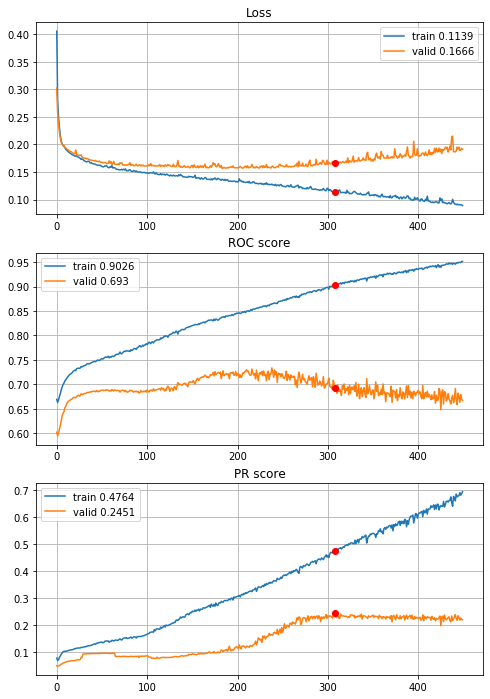


Fold 2------------------------------------------------------------


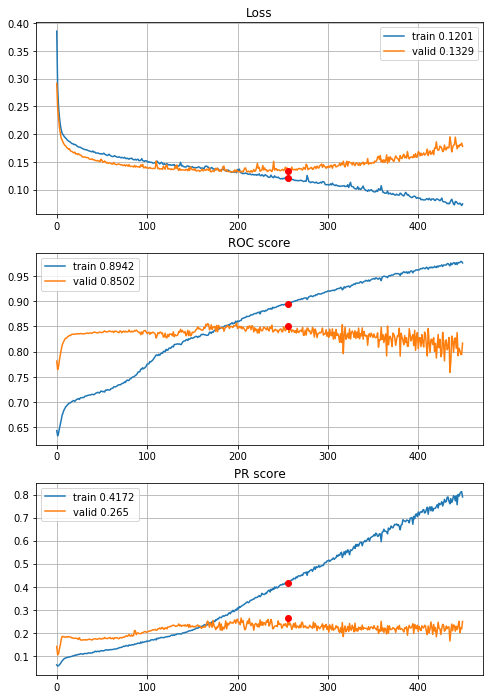


Fold 3------------------------------------------------------------


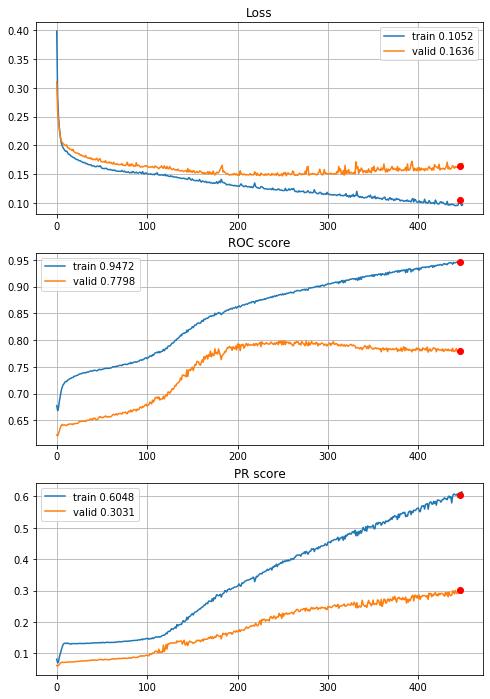


Fold 4------------------------------------------------------------


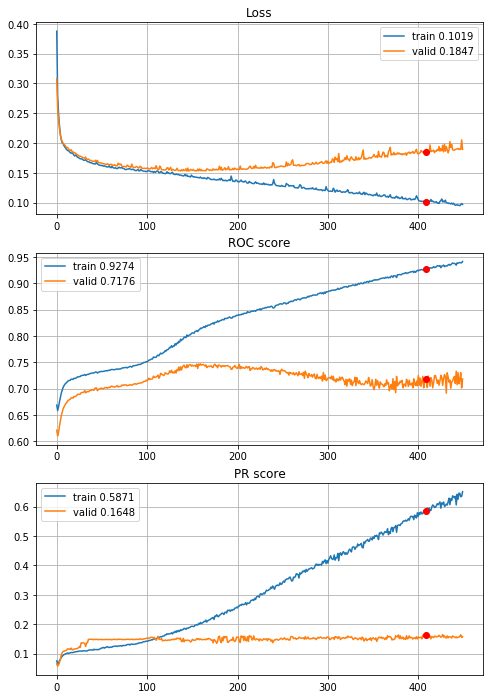


Fold 5------------------------------------------------------------


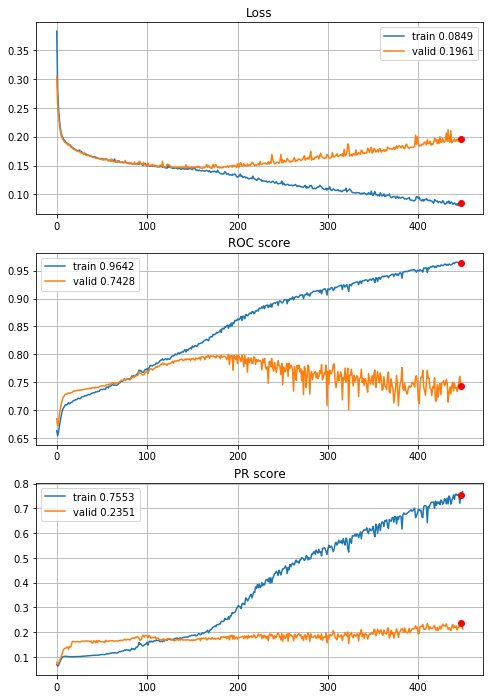


Fold 6------------------------------------------------------------


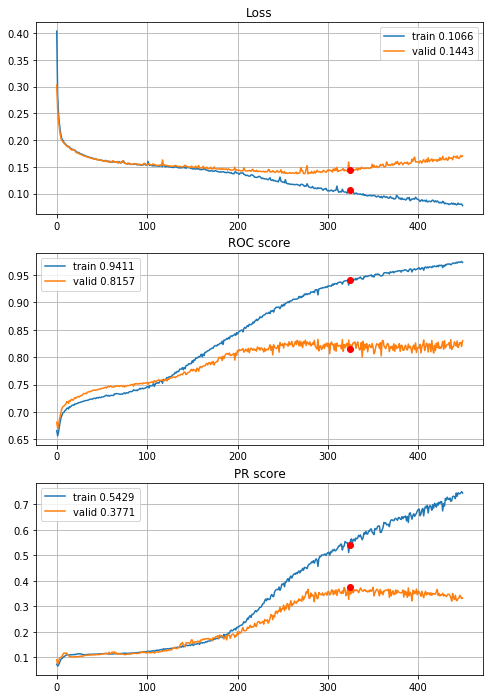

In [53]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L1_000025,
                                        features=features, target=target, n_epochs=450, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\1year\define_deep_CNN_2inc_std_L1_000025_450ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

##### 2 year horizon

In [48]:
def define_deep_CNN_2inc_std_L2_drop_04(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.00005))(flat)                           # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 3.77s train loss: 0.29841591834004055, validation loss: 0.18908242083930427
Epoch: 2/400,
cumulative time: 4.81s train loss: 0.1850379539112891, validation loss: 0.17185905259067238
Epoch: 3/400,
cumulative time: 5.82s train loss: 0.17270619642745838, validation loss: 0.16930210943805651
Epoch: 4/400,
cumulative time: 6.91s train loss: 0.16899630606061367, validation loss: 0.16733430673772967
Epoch: 5/400,
cumulative time: 8.04s train loss: 0.16822450853728704, validation loss: 0.16550548450996572
Epoch: 6/400,
cumulative time: 9.1s train loss: 0.16496464943184572, validation loss: 0.16459212348967847
Epoch: 7/400,
cumulative time: 10.1s train loss: 0.16653800386744613, validation loss: 0.16389427533412115
Epoch: 8/400,
cumulative time: 11.09s train loss: 0.1641834212718019, validation loss: 0.16349664887508814
Epoch: 9/400,
cumulative time: 12.09s train loss: 0.163264364575299

Epoch: 77/400,
cumulative time: 81.74s train loss: 0.1482627566105048, validation loss: 0.16011723545176706
Epoch: 78/400,
cumulative time: 82.72s train loss: 0.14636751603639103, validation loss: 0.16018843795022658
Epoch: 79/400,
cumulative time: 83.91s train loss: 0.14938871979543789, validation loss: 0.16072610314702174
Epoch: 80/400,
cumulative time: 85.09s train loss: 0.14851995502126736, validation loss: 0.16096180041216357
Epoch: 81/400,
cumulative time: 86.18s train loss: 0.1498972327959153, validation loss: 0.1599043016754925
Epoch: 82/400,
cumulative time: 87.18s train loss: 0.14862678785308261, validation loss: 0.1606489710043232
Epoch: 83/400,
cumulative time: 88.24s train loss: 0.1467125609545373, validation loss: 0.16038054716994232
Epoch: 84/400,
cumulative time: 89.32s train loss: 0.14668108923555098, validation loss: 0.1636880013024332
Epoch: 85/400,
cumulative time: 90.34s train loss: 0.14852468315123155, validation loss: 0.1604410677413108
Epoch: 86/400,
cumulative 

Epoch: 152/400,
cumulative time: 158.55s train loss: 0.1268890325778802, validation loss: 0.1631647952367504
Epoch: 153/400,
cumulative time: 159.54s train loss: 0.12708283336214593, validation loss: 0.1643888113394634
Epoch: 154/400,
cumulative time: 160.55s train loss: 0.13006258548663283, validation loss: 0.1621891837248992
Epoch: 155/400,
cumulative time: 161.56s train loss: 0.12302997731506485, validation loss: 0.16317274762172626
Epoch: 156/400,
cumulative time: 162.58s train loss: 0.12510924592359696, validation loss: 0.16462333641762525
Epoch: 157/400,
cumulative time: 163.58s train loss: 0.12473088964904734, validation loss: 0.16999431124109018
Epoch: 158/400,
cumulative time: 164.62s train loss: 0.12446689721642228, validation loss: 0.16536846559006982
Epoch: 159/400,
cumulative time: 165.62s train loss: 0.12310944061577886, validation loss: 0.1663439760454692
Epoch: 160/400,
cumulative time: 166.67s train loss: 0.12281688411333076, validation loss: 0.1675917582278912
Epoch: 

Epoch: 227/400,
cumulative time: 236.97s train loss: 0.10368430578561616, validation loss: 0.18071928979436633
Epoch: 228/400,
cumulative time: 237.96s train loss: 0.10172822387779461, validation loss: 0.186417485465361
Epoch: 229/400,
cumulative time: 238.95s train loss: 0.1043100627199296, validation loss: 0.1822540272288802
Epoch: 230/400,
cumulative time: 239.93s train loss: 0.10094984916005234, validation loss: 0.18509264236609443
Epoch: 231/400,
cumulative time: 240.91s train loss: 0.10158606323729882, validation loss: 0.18382549042719817
Epoch: 232/400,
cumulative time: 241.89s train loss: 0.10043590439508264, validation loss: 0.18157695148995526
Epoch: 233/400,
cumulative time: 242.88s train loss: 0.10482888060287913, validation loss: 0.1792545220204956
Epoch: 234/400,
cumulative time: 243.86s train loss: 0.09983073402288065, validation loss: 0.18808337305257172
Epoch: 235/400,
cumulative time: 244.85s train loss: 0.10225778473028647, validation loss: 0.18806052205119234
Epoch:

Epoch: 302/400,
cumulative time: 309.8s train loss: 0.08828916518014115, validation loss: 0.21154915251587103
Epoch: 303/400,
cumulative time: 310.75s train loss: 0.08856687670753847, validation loss: 0.22766958001781912
Epoch: 304/400,
cumulative time: 311.75s train loss: 0.09042526637636959, validation loss: 0.19638308136241486
Epoch: 305/400,
cumulative time: 312.76s train loss: 0.08986198477998404, validation loss: 0.19881773076993917
Epoch: 306/400,
cumulative time: 313.83s train loss: 0.08508076677399297, validation loss: 0.2200228722317169
Epoch: 307/400,
cumulative time: 314.87s train loss: 0.08346250085920039, validation loss: 0.21465558517703068
Epoch: 308/400,
cumulative time: 315.89s train loss: 0.08229680600977261, validation loss: 0.208274630797882
Epoch: 309/400,
cumulative time: 316.91s train loss: 0.08025164540991385, validation loss: 0.2053137808698857
Epoch: 310/400,
cumulative time: 317.92s train loss: 0.08048636260419462, validation loss: 0.20217237085726047
Epoch:

Epoch: 377/400,
cumulative time: 382.37s train loss: 0.06734492434948626, validation loss: 0.2245765886564635
Epoch: 378/400,
cumulative time: 383.33s train loss: 0.0682668277262171, validation loss: 0.22530923014686954
Epoch: 379/400,
cumulative time: 384.3s train loss: 0.0661962572407451, validation loss: 0.23763914561814556
Epoch: 380/400,
cumulative time: 385.31s train loss: 0.06541816026707528, validation loss: 0.23636449624623473
Epoch: 381/400,
cumulative time: 386.27s train loss: 0.06690826471294126, validation loss: 0.25327438910613703
Epoch: 382/400,
cumulative time: 387.24s train loss: 0.07314503702990696, validation loss: 0.2269081965060569
Epoch: 383/400,
cumulative time: 388.22s train loss: 0.06692688180808777, validation loss: 0.2411581271343937
Epoch: 384/400,
cumulative time: 389.21s train loss: 0.06601435295403343, validation loss: 0.248674296280917
Epoch: 385/400,
cumulative time: 390.19s train loss: 0.06711895752563875, validation loss: 0.2405334588359384
Epoch: 386

Epoch: 50/400,
cumulative time: 53.55s train loss: 0.15608541271887874, validation loss: 0.14389952878685106
Epoch: 51/400,
cumulative time: 54.53s train loss: 0.15570576684637813, validation loss: 0.14055444229486092
Epoch: 52/400,
cumulative time: 55.54s train loss: 0.1558756474921554, validation loss: 0.13954924937669874
Epoch: 53/400,
cumulative time: 56.54s train loss: 0.1558905879533947, validation loss: 0.13900816081484083
Epoch: 54/400,
cumulative time: 57.53s train loss: 0.15574506439226177, validation loss: 0.13982508471500715
Epoch: 55/400,
cumulative time: 58.51s train loss: 0.15686254499363492, validation loss: 0.13992693222903663
Epoch: 56/400,
cumulative time: 59.55s train loss: 0.153522711562477, validation loss: 0.1377585482212805
Epoch: 57/400,
cumulative time: 60.57s train loss: 0.15474067717451298, validation loss: 0.13875300780758687
Epoch: 58/400,
cumulative time: 61.54s train loss: 0.15518474013631212, validation loss: 0.137250175399165
Epoch: 59/400,
cumulative 

Epoch: 126/400,
cumulative time: 129.52s train loss: 0.13842675323674078, validation loss: 0.13095290557370015
Epoch: 127/400,
cumulative time: 130.51s train loss: 0.1373694612105612, validation loss: 0.1302445569911537
Epoch: 128/400,
cumulative time: 131.49s train loss: 0.13660038144979803, validation loss: 0.13083603333476826
Epoch: 129/400,
cumulative time: 132.47s train loss: 0.1386257104985628, validation loss: 0.1293934901479978
Epoch: 130/400,
cumulative time: 133.46s train loss: 0.13822816558592232, validation loss: 0.13190392358140204
Epoch: 131/400,
cumulative time: 134.44s train loss: 0.139402582345131, validation loss: 0.127977560463395
Epoch: 132/400,
cumulative time: 135.43s train loss: 0.1351969141209148, validation loss: 0.1319424339783938
Epoch: 133/400,
cumulative time: 136.43s train loss: 0.13605745886319956, validation loss: 0.13273518485860084
Epoch: 134/400,
cumulative time: 137.43s train loss: 0.1351273180439757, validation loss: 0.13599871641883815
Epoch: 135/4

Epoch: 201/400,
cumulative time: 204.75s train loss: 0.11936905304326957, validation loss: 0.1262142983542674
Epoch: 202/400,
cumulative time: 205.73s train loss: 0.11968808884978069, validation loss: 0.12626790837782384
Epoch: 203/400,
cumulative time: 206.72s train loss: 0.1219462570446266, validation loss: 0.13019343992903742
Epoch: 204/400,
cumulative time: 207.69s train loss: 0.11871558854487183, validation loss: 0.12589997675206221
Epoch: 205/400,
cumulative time: 208.66s train loss: 0.11843750907754988, validation loss: 0.13147152384895075
Epoch: 206/400,
cumulative time: 209.64s train loss: 0.11411143190720502, validation loss: 0.12636875184482596
Epoch: 207/400,
cumulative time: 210.62s train loss: 0.1160212627002365, validation loss: 0.12614424040353728
Epoch: 208/400,
cumulative time: 211.6s train loss: 0.11469884309811655, validation loss: 0.12712829159943836
Epoch: 209/400,
cumulative time: 212.57s train loss: 0.11311031439442336, validation loss: 0.12835576307502145
Epoch

Epoch: 276/400,
cumulative time: 278.32s train loss: 0.09554074909078554, validation loss: 0.13777557431068094
Epoch: 277/400,
cumulative time: 279.3s train loss: 0.09762777658267763, validation loss: 0.13851958965667058
Epoch: 278/400,
cumulative time: 280.28s train loss: 0.10460569216698351, validation loss: 0.1342187317431086
Epoch: 279/400,
cumulative time: 281.31s train loss: 0.10083077581037381, validation loss: 0.13063436572703283
Epoch: 280/400,
cumulative time: 282.36s train loss: 0.09462694098476666, validation loss: 0.13852597746213427
Epoch: 281/400,
cumulative time: 283.41s train loss: 0.09425326659851327, validation loss: 0.13521984434444492
Epoch: 282/400,
cumulative time: 284.4s train loss: 0.0928635306274642, validation loss: 0.13489390051511932
Epoch: 283/400,
cumulative time: 285.39s train loss: 0.09312968653621438, validation loss: 0.14358317511301114
Epoch: 284/400,
cumulative time: 286.38s train loss: 0.09367098818184981, validation loss: 0.13234727142601357
Epoch

Epoch: 351/400,
cumulative time: 355.71s train loss: 0.07427372418245057, validation loss: 0.14702074778260948
Epoch: 352/400,
cumulative time: 356.7s train loss: 0.07432719919639702, validation loss: 0.1479500968440434
Epoch: 353/400,
cumulative time: 357.69s train loss: 0.0712218405413786, validation loss: 0.14972582176695287
Epoch: 354/400,
cumulative time: 358.7s train loss: 0.07206287043738184, validation loss: 0.16375128820227491
Epoch: 355/400,
cumulative time: 359.68s train loss: 0.07333743777373485, validation loss: 0.15441650200274684
Epoch: 356/400,
cumulative time: 360.65s train loss: 0.07230134212908527, validation loss: 0.1458808298751118
Epoch: 357/400,
cumulative time: 361.62s train loss: 0.07483341488881175, validation loss: 0.16200139951773793
Epoch: 358/400,
cumulative time: 362.59s train loss: 0.07168343305672595, validation loss: 0.15551987854477575
Epoch: 359/400,
cumulative time: 363.56s train loss: 0.07161810671242635, validation loss: 0.15142341591488478
Epoch:

Epoch: 24/400,
cumulative time: 26.17s train loss: 0.1552009854727271, validation loss: 0.16750959839947535
Epoch: 25/400,
cumulative time: 27.14s train loss: 0.15632500115506337, validation loss: 0.16646528665322732
Epoch: 26/400,
cumulative time: 28.1s train loss: 0.1555822251785186, validation loss: 0.16674053861248878
Epoch: 27/400,
cumulative time: 29.06s train loss: 0.15594279316220383, validation loss: 0.16547895473140015
Epoch: 28/400,
cumulative time: 30.04s train loss: 0.1549846135320202, validation loss: 0.16640083808487235
Epoch: 29/400,
cumulative time: 31.0s train loss: 0.15455520319588045, validation loss: 0.1656667823979253
Epoch: 30/400,
cumulative time: 31.97s train loss: 0.1547134378235752, validation loss: 0.16550981031423276
Epoch: 31/400,
cumulative time: 32.95s train loss: 0.15548182979254388, validation loss: 0.16525070185453208
Epoch: 32/400,
cumulative time: 33.92s train loss: 0.1545599822244789, validation loss: 0.16490317937658228
Epoch: 33/400,
cumulative t

Epoch: 100/400,
cumulative time: 100.96s train loss: 0.14656546452353078, validation loss: 0.15755340998437417
Epoch: 101/400,
cumulative time: 102.01s train loss: 0.14521917423668124, validation loss: 0.1587226904179385
Epoch: 102/400,
cumulative time: 103.02s train loss: 0.14551628897889063, validation loss: 0.15673991347852195
Epoch: 103/400,
cumulative time: 104.04s train loss: 0.1450645569888645, validation loss: 0.15697257684462437
Epoch: 104/400,
cumulative time: 105.05s train loss: 0.14526352148920127, validation loss: 0.15615691395875853
Epoch: 105/400,
cumulative time: 106.08s train loss: 0.14588930364238695, validation loss: 0.15725489367909404
Epoch: 106/400,
cumulative time: 107.12s train loss: 0.14383368601835203, validation loss: 0.15676111134168547
Epoch: 107/400,
cumulative time: 108.12s train loss: 0.14619268395246998, validation loss: 0.1567446308553332
Epoch: 108/400,
cumulative time: 109.17s train loss: 0.1453407542840127, validation loss: 0.15604574011331265
Epoch

Epoch: 175/400,
cumulative time: 178.91s train loss: 0.12503169764264485, validation loss: 0.14940899426728996
Epoch: 176/400,
cumulative time: 179.94s train loss: 0.123671479149946, validation loss: 0.14368620735418186
Epoch: 177/400,
cumulative time: 181.01s train loss: 0.12667216710901802, validation loss: 0.1459875724488689
Epoch: 178/400,
cumulative time: 182.1s train loss: 0.12813352613057766, validation loss: 0.14436039389367347
Epoch: 179/400,
cumulative time: 183.17s train loss: 0.1249803725212982, validation loss: 0.1473767179182856
Epoch: 180/400,
cumulative time: 184.19s train loss: 0.12602898094244655, validation loss: 0.1454178644397227
Epoch: 181/400,
cumulative time: 185.26s train loss: 0.1257909894498521, validation loss: 0.14944012136511378
Epoch: 182/400,
cumulative time: 186.36s train loss: 0.12423476103474113, validation loss: 0.1540713234463498
Epoch: 183/400,
cumulative time: 187.43s train loss: 0.131143080783863, validation loss: 0.15837786790598501
Epoch: 184/4

Epoch: 250/400,
cumulative time: 257.08s train loss: 0.10709763515662876, validation loss: 0.1475656513244875
Epoch: 251/400,
cumulative time: 258.14s train loss: 0.10481059315139021, validation loss: 0.14595791937843447
Epoch: 252/400,
cumulative time: 259.25s train loss: 0.10537982514053866, validation loss: 0.152193753667303
Epoch: 253/400,
cumulative time: 260.32s train loss: 0.10604744422085145, validation loss: 0.14867925150514327
Epoch: 254/400,
cumulative time: 261.45s train loss: 0.10733249988795684, validation loss: 0.15076763540562912
Epoch: 255/400,
cumulative time: 262.59s train loss: 0.10465564720148832, validation loss: 0.14560591232957604
Epoch: 256/400,
cumulative time: 263.7s train loss: 0.10498934814978596, validation loss: 0.14874339329902317
Epoch: 257/400,
cumulative time: 264.76s train loss: 0.10267334959595208, validation loss: 0.15473310154574646
Epoch: 258/400,
cumulative time: 265.83s train loss: 0.10764339229328809, validation loss: 0.14924969001049335
Epoch

Epoch: 325/400,
cumulative time: 337.28s train loss: 0.0900160919698185, validation loss: 0.15873628631375547
Epoch: 326/400,
cumulative time: 338.48s train loss: 0.08579578508094547, validation loss: 0.1601504500552418
Epoch: 327/400,
cumulative time: 339.64s train loss: 0.08470032859940003, validation loss: 0.163512696959149
Epoch: 328/400,
cumulative time: 340.73s train loss: 0.0882943803561141, validation loss: 0.1616418432352439
Epoch: 329/400,
cumulative time: 341.8s train loss: 0.08854342082080624, validation loss: 0.16119203894651818
Epoch: 330/400,
cumulative time: 342.88s train loss: 0.09102673790712737, validation loss: 0.16658792448224785
Epoch: 331/400,
cumulative time: 344.03s train loss: 0.08786413540226007, validation loss: 0.16967775286714312
Epoch: 332/400,
cumulative time: 345.13s train loss: 0.08708273999718154, validation loss: 0.1727300238366145
Epoch: 333/400,
cumulative time: 346.23s train loss: 0.09432474969686548, validation loss: 0.1625595550270189
Epoch: 334

Epoch: 400/400,
cumulative time: 417.02s train loss: 0.06750414465789098, validation loss: 0.1973678621638432

Early stopping results:
best results in epoch: 348, 
best valid PR: 0.3231819112240364, 
valid ROC: 0.8174824838080561        
overfitting PR: 0.45338290010636095, 
overfitting ROC: 0.16215587936678044

----------
Fold: 4
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 3.82s train loss: 0.3087143615114395, validation loss: 0.193819150696217
Epoch: 2/400,
cumulative time: 4.86s train loss: 0.18889552987617153, validation loss: 0.17698289431362949
Epoch: 3/400,
cumulative time: 5.89s train loss: 0.17266443372903784, validation loss: 0.17202072818206882
Epoch: 4/400,
cumulative time: 7.02s train loss: 0.16806069930601844, validation loss: 0.16932189996147518
Epoch: 5/400,
cumulative time: 8.11s train loss: 0.16774032850249668, validation loss: 0.16787259478609748
Epoch: 6/400,
cumulative time: 9.21s train loss: 0.1657648973152805, validat

Epoch: 74/400,
cumulative time: 86.82s train loss: 0.15186762433689957, validation loss: 0.15481305741607804
Epoch: 75/400,
cumulative time: 87.94s train loss: 0.1495747526637517, validation loss: 0.15506374621074612
Epoch: 76/400,
cumulative time: 89.0s train loss: 0.14946383473090474, validation loss: 0.15450614620092018
Epoch: 77/400,
cumulative time: 90.12s train loss: 0.14922259380401198, validation loss: 0.15514932762287148
Epoch: 78/400,
cumulative time: 91.23s train loss: 0.15017093402215154, validation loss: 0.15423921027717374
Epoch: 79/400,
cumulative time: 92.29s train loss: 0.14966449718887032, validation loss: 0.15672719817912556
Epoch: 80/400,
cumulative time: 93.47s train loss: 0.14991021544815694, validation loss: 0.15554461160239957
Epoch: 81/400,
cumulative time: 94.52s train loss: 0.14966863596235777, validation loss: 0.15454069602760917
Epoch: 82/400,
cumulative time: 95.56s train loss: 0.14953502064864144, validation loss: 0.1551526696677452
Epoch: 83/400,
cumulat

Epoch: 149/400,
cumulative time: 166.64s train loss: 0.12523882158340946, validation loss: 0.1557994848523692
Epoch: 150/400,
cumulative time: 167.66s train loss: 0.12891292583897174, validation loss: 0.1556988127487208
Epoch: 151/400,
cumulative time: 168.76s train loss: 0.1292111472256722, validation loss: 0.15315468598022858
Epoch: 152/400,
cumulative time: 169.89s train loss: 0.12742049345707757, validation loss: 0.15226496221670843
Epoch: 153/400,
cumulative time: 170.98s train loss: 0.1267244543731778, validation loss: 0.15349154737009268
Epoch: 154/400,
cumulative time: 172.17s train loss: 0.12477954654924331, validation loss: 0.15496987234482956
Epoch: 155/400,
cumulative time: 173.23s train loss: 0.12795623864914932, validation loss: 0.1544218467976156
Epoch: 156/400,
cumulative time: 174.3s train loss: 0.12623737883352917, validation loss: 0.15355766848775876
Epoch: 157/400,
cumulative time: 175.35s train loss: 0.12725492196981097, validation loss: 0.16130239037227811
Epoch: 

Epoch: 224/400,
cumulative time: 249.24s train loss: 0.10822533692818213, validation loss: 0.16832414105449728
Epoch: 225/400,
cumulative time: 250.31s train loss: 0.1076181417285152, validation loss: 0.16770394587539406
Epoch: 226/400,
cumulative time: 251.4s train loss: 0.10761975571654553, validation loss: 0.1682034788593169
Epoch: 227/400,
cumulative time: 252.51s train loss: 0.10691266554130323, validation loss: 0.16621178900381192
Epoch: 228/400,
cumulative time: 253.57s train loss: 0.10540355497112311, validation loss: 0.16861897166924414
Epoch: 229/400,
cumulative time: 254.65s train loss: 0.10624761851451428, validation loss: 0.1665463332772481
Epoch: 230/400,
cumulative time: 255.74s train loss: 0.10884409746476777, validation loss: 0.17028617974816057
Epoch: 231/400,
cumulative time: 256.82s train loss: 0.10726326265190313, validation loss: 0.17143832277188492
Epoch: 232/400,
cumulative time: 257.91s train loss: 0.10620800585855343, validation loss: 0.16778677902705755
Epoch

Epoch: 299/400,
cumulative time: 331.83s train loss: 0.0985989129322756, validation loss: 0.2056336642668867
Epoch: 300/400,
cumulative time: 333.02s train loss: 0.09746998568583258, validation loss: 0.19148841898966107
Epoch: 301/400,
cumulative time: 334.26s train loss: 0.09219455451367023, validation loss: 0.19590964579717937
Epoch: 302/400,
cumulative time: 335.51s train loss: 0.09074950390680918, validation loss: 0.18446969793688867
Epoch: 303/400,
cumulative time: 336.77s train loss: 0.08859129292745518, validation loss: 0.18413133056837874
Epoch: 304/400,
cumulative time: 337.92s train loss: 0.09092776026484863, validation loss: 0.18809541949624128
Epoch: 305/400,
cumulative time: 339.2s train loss: 0.09068596266648349, validation loss: 0.19428530174256275
Epoch: 306/400,
cumulative time: 340.33s train loss: 0.08992962019210522, validation loss: 0.191364797005391
Epoch: 307/400,
cumulative time: 341.47s train loss: 0.08995658750919734, validation loss: 0.19111639108558306
Epoch:

Epoch: 374/400,
cumulative time: 413.88s train loss: 0.07383402553466512, validation loss: 0.22350654862750413
Epoch: 375/400,
cumulative time: 414.89s train loss: 0.07111838597811376, validation loss: 0.2191584062191748
Epoch: 376/400,
cumulative time: 415.91s train loss: 0.07721792323200255, validation loss: 0.21583858596079716
Epoch: 377/400,
cumulative time: 416.93s train loss: 0.07609580873283761, validation loss: 0.23379089229473352
Epoch: 378/400,
cumulative time: 417.95s train loss: 0.07496950262044141, validation loss: 0.21523766188512944
Epoch: 379/400,
cumulative time: 418.97s train loss: 0.07330242456334592, validation loss: 0.22171443590516157
Epoch: 380/400,
cumulative time: 420.0s train loss: 0.0750468535430065, validation loss: 0.2239351600578207
Epoch: 381/400,
cumulative time: 421.0s train loss: 0.07120770292049115, validation loss: 0.2300819167319466
Epoch: 382/400,
cumulative time: 422.02s train loss: 0.07566039615524561, validation loss: 0.21464325479131044
Epoch: 

Epoch: 47/400,
cumulative time: 51.61s train loss: 0.15394780716984277, validation loss: 0.15452872601247603
Epoch: 48/400,
cumulative time: 52.62s train loss: 0.15521683157112387, validation loss: 0.15369973508411386
Epoch: 49/400,
cumulative time: 53.63s train loss: 0.15295395587042568, validation loss: 0.1541411701936197
Epoch: 50/400,
cumulative time: 54.66s train loss: 0.15378649283971008, validation loss: 0.15376534277619175
Epoch: 51/400,
cumulative time: 55.66s train loss: 0.15409392249934814, validation loss: 0.15356769236034415
Epoch: 52/400,
cumulative time: 56.7s train loss: 0.1532604387690944, validation loss: 0.15404695071689997
Epoch: 53/400,
cumulative time: 57.8s train loss: 0.15300215490628918, validation loss: 0.15354850351018742
Epoch: 54/400,
cumulative time: 58.86s train loss: 0.15413085969281604, validation loss: 0.15439550168600208
Epoch: 55/400,
cumulative time: 60.15s train loss: 0.15323415621973757, validation loss: 0.15398758663963774
Epoch: 56/400,
cumulati

Epoch: 123/400,
cumulative time: 129.01s train loss: 0.13623834509381308, validation loss: 0.15016118803218828
Epoch: 124/400,
cumulative time: 129.99s train loss: 0.14138839139940618, validation loss: 0.14952234423364136
Epoch: 125/400,
cumulative time: 130.96s train loss: 0.13684840758792363, validation loss: 0.14825881381414874
Epoch: 126/400,
cumulative time: 132.01s train loss: 0.14007384656615682, validation loss: 0.14822940836595178
Epoch: 127/400,
cumulative time: 133.06s train loss: 0.13634275850580133, validation loss: 0.14481573759717778
Epoch: 128/400,
cumulative time: 134.09s train loss: 0.1372048670867815, validation loss: 0.14452018675021475
Epoch: 129/400,
cumulative time: 135.1s train loss: 0.1343453783690364, validation loss: 0.14382486673075515
Epoch: 130/400,
cumulative time: 136.15s train loss: 0.134016962391828, validation loss: 0.1444891384984782
Epoch: 131/400,
cumulative time: 137.14s train loss: 0.13314173539686927, validation loss: 0.14341150685098636
Epoch: 

Epoch: 198/400,
cumulative time: 206.15s train loss: 0.11661572322899748, validation loss: 0.15344326622232765
Epoch: 199/400,
cumulative time: 207.22s train loss: 0.11590374684707037, validation loss: 0.14978279543782547
Epoch: 200/400,
cumulative time: 208.24s train loss: 0.11091990112636302, validation loss: 0.14917636635859957
Epoch: 201/400,
cumulative time: 209.33s train loss: 0.11255250146481752, validation loss: 0.15023227310271145
Epoch: 202/400,
cumulative time: 210.36s train loss: 0.11183077869707087, validation loss: 0.14981902411925047
Epoch: 203/400,
cumulative time: 211.36s train loss: 0.11520572856662395, validation loss: 0.15211003413688978
Epoch: 204/400,
cumulative time: 212.33s train loss: 0.12010700791169389, validation loss: 0.15865138591579966
Epoch: 205/400,
cumulative time: 213.33s train loss: 0.11424458204173046, validation loss: 0.1559098197794051
Epoch: 206/400,
cumulative time: 214.31s train loss: 0.11440083663309775, validation loss: 0.14933683543662193
Ep

Epoch: 273/400,
cumulative time: 283.74s train loss: 0.0950111543049283, validation loss: 0.1640441251151702
Epoch: 274/400,
cumulative time: 284.78s train loss: 0.09672275365699627, validation loss: 0.15691580483424822
Epoch: 275/400,
cumulative time: 285.8s train loss: 0.09647815333541476, validation loss: 0.16639644393884706
Epoch: 276/400,
cumulative time: 286.84s train loss: 0.09797756508756182, validation loss: 0.16661216881288748
Epoch: 277/400,
cumulative time: 287.81s train loss: 0.09310214190798648, validation loss: 0.15947333741685696
Epoch: 278/400,
cumulative time: 288.78s train loss: 0.09349877109054823, validation loss: 0.16568631126034644
Epoch: 279/400,
cumulative time: 289.75s train loss: 0.09263447743665561, validation loss: 0.16989971533332876
Epoch: 280/400,
cumulative time: 290.72s train loss: 0.09498470238987816, validation loss: 0.15973937664131513
Epoch: 281/400,
cumulative time: 291.68s train loss: 0.09443210602456976, validation loss: 0.16048649123090494
Epoc

Epoch: 348/400,
cumulative time: 361.78s train loss: 0.07855733971922628, validation loss: 0.17855877439143308
Epoch: 349/400,
cumulative time: 362.85s train loss: 0.08067502942805725, validation loss: 0.19139032679445603
Epoch: 350/400,
cumulative time: 363.92s train loss: 0.07798911827763072, validation loss: 0.1770547089755422
Epoch: 351/400,
cumulative time: 365.05s train loss: 0.07303137280456934, validation loss: 0.16911098592873994
Epoch: 352/400,
cumulative time: 366.12s train loss: 0.07637091068801889, validation loss: 0.1754985952739245
Epoch: 353/400,
cumulative time: 367.14s train loss: 0.07632561525086072, validation loss: 0.17916983459321553
Epoch: 354/400,
cumulative time: 368.14s train loss: 0.075270606884185, validation loss: 0.16899638296417765
Epoch: 355/400,
cumulative time: 369.15s train loss: 0.07571842502201757, validation loss: 0.18026397455010063
Epoch: 356/400,
cumulative time: 370.16s train loss: 0.07512832203105912, validation loss: 0.17745233096705443
Epoch

Epoch: 21/400,
cumulative time: 27.09s train loss: 0.1610681996597737, validation loss: 0.15942402967239466
Epoch: 22/400,
cumulative time: 28.35s train loss: 0.16000029022259324, validation loss: 0.1568727431080147
Epoch: 23/400,
cumulative time: 29.45s train loss: 0.15798402098935288, validation loss: 0.15647504542312768
Epoch: 24/400,
cumulative time: 30.57s train loss: 0.15716624995958647, validation loss: 0.1562666281972936
Epoch: 25/400,
cumulative time: 31.71s train loss: 0.15970973161524568, validation loss: 0.1568375463956221
Epoch: 26/400,
cumulative time: 32.87s train loss: 0.1576032714723862, validation loss: 0.1565686328022032
Epoch: 27/400,
cumulative time: 34.08s train loss: 0.15739940298576283, validation loss: 0.15583639697965226
Epoch: 28/400,
cumulative time: 35.19s train loss: 0.15699972989606675, validation loss: 0.15601749200748538
Epoch: 29/400,
cumulative time: 36.33s train loss: 0.15869028220479808, validation loss: 0.15571413575132612
Epoch: 30/400,
cumulative

Epoch: 97/400,
cumulative time: 111.79s train loss: 0.14540521921819707, validation loss: 0.15244338258507129
Epoch: 98/400,
cumulative time: 112.94s train loss: 0.1478901064231907, validation loss: 0.15186277088449396
Epoch: 99/400,
cumulative time: 114.1s train loss: 0.1464754363730465, validation loss: 0.15016892931266798
Epoch: 100/400,
cumulative time: 115.27s train loss: 0.1429625387747102, validation loss: 0.14864557546049187
Epoch: 101/400,
cumulative time: 116.4s train loss: 0.14508872001062534, validation loss: 0.14830618242837446
Epoch: 102/400,
cumulative time: 117.54s train loss: 0.15070613830772703, validation loss: 0.15014299046269405
Epoch: 103/400,
cumulative time: 118.78s train loss: 0.14483823526290154, validation loss: 0.15036808867608348
Epoch: 104/400,
cumulative time: 120.01s train loss: 0.1440288047636709, validation loss: 0.14919623087886616
Epoch: 105/400,
cumulative time: 121.2s train loss: 0.14534658681056983, validation loss: 0.14790901890911684
Epoch: 106/

Epoch: 172/400,
cumulative time: 194.94s train loss: 0.12470913770020121, validation loss: 0.1433498310296314
Epoch: 173/400,
cumulative time: 196.36s train loss: 0.12394432217674418, validation loss: 0.14367184131998265
Epoch: 174/400,
cumulative time: 197.57s train loss: 0.12395992420995484, validation loss: 0.1441590176502939
Epoch: 175/400,
cumulative time: 198.94s train loss: 0.12446207771717484, validation loss: 0.14436898554411967
Epoch: 176/400,
cumulative time: 200.2s train loss: 0.12584897023281064, validation loss: 0.14319931119114895
Epoch: 177/400,
cumulative time: 201.44s train loss: 0.12416571385776748, validation loss: 0.14324044799555863
Epoch: 178/400,
cumulative time: 202.63s train loss: 0.12271612754526355, validation loss: 0.1431048804968313
Epoch: 179/400,
cumulative time: 203.84s train loss: 0.12199074249905473, validation loss: 0.14497344926763078
Epoch: 180/400,
cumulative time: 205.11s train loss: 0.1219027382118426, validation loss: 0.14478064049918918
Epoch:

Epoch: 247/400,
cumulative time: 277.46s train loss: 0.10459078665843952, validation loss: 0.1585981196934177
Epoch: 248/400,
cumulative time: 278.44s train loss: 0.11099531547055072, validation loss: 0.1669909826124642
Epoch: 249/400,
cumulative time: 279.42s train loss: 0.10547766376152437, validation loss: 0.16421241481457988
Epoch: 250/400,
cumulative time: 280.4s train loss: 0.10403536532420588, validation loss: 0.15740424124577013
Epoch: 251/400,
cumulative time: 281.42s train loss: 0.10269023184956139, validation loss: 0.159162071810954
Epoch: 252/400,
cumulative time: 282.42s train loss: 0.10193822748633896, validation loss: 0.15658440149656058
Epoch: 253/400,
cumulative time: 283.43s train loss: 0.1017307305712062, validation loss: 0.15691400459301313
Epoch: 254/400,
cumulative time: 284.45s train loss: 0.10640670801362684, validation loss: 0.15602211395465898
Epoch: 255/400,
cumulative time: 285.56s train loss: 0.10027241429183244, validation loss: 0.15811004991549468
Epoch: 

Epoch: 322/400,
cumulative time: 356.69s train loss: 0.07964824973066573, validation loss: 0.1832412759114262
Epoch: 323/400,
cumulative time: 357.76s train loss: 0.08082868346990399, validation loss: 0.18423340362152066
Epoch: 324/400,
cumulative time: 358.82s train loss: 0.08060685863587616, validation loss: 0.19283607749151777
Epoch: 325/400,
cumulative time: 359.85s train loss: 0.08067678502660096, validation loss: 0.18749097343074755
Epoch: 326/400,
cumulative time: 360.9s train loss: 0.0792126831861895, validation loss: 0.1835070535314377
Epoch: 327/400,
cumulative time: 361.98s train loss: 0.08116276170316186, validation loss: 0.18273525070080948
Epoch: 328/400,
cumulative time: 363.02s train loss: 0.0808577692443664, validation loss: 0.18381134967763238
Epoch: 329/400,
cumulative time: 364.07s train loss: 0.08535047399420892, validation loss: 0.1907011841262993
Epoch: 330/400,
cumulative time: 365.09s train loss: 0.07973527313268389, validation loss: 0.18932682082085275
Epoch: 

Epoch: 397/400,
cumulative time: 439.51s train loss: 0.05990950115859169, validation loss: 0.2273969800693939
Epoch: 398/400,
cumulative time: 440.52s train loss: 0.05915708082394084, validation loss: 0.2240732110457131
Epoch: 399/400,
cumulative time: 441.56s train loss: 0.05993023209372779, validation loss: 0.22382296808417426
Epoch: 400/400,
cumulative time: 442.59s train loss: 0.058324076013332074, validation loss: 0.2166236397267745

Early stopping results:
best results in epoch: 273, 
best valid PR: 0.3791463122482473, 
valid ROC: 0.8148580646714662        
overfitting PR: 0.23968769684734154, 
overfitting ROC: 0.14088279111226332

Cross validation time: 2560s
ROC: 		0.7926367580591042
PR: 		0.30576338043311785
overfittingROC: 0.16846217045006207
overfittingPR:  0.3916670428212103
early stopping: [304, 172, 348, 380, 387, 273]

Fold 1------------------------------------------------------------


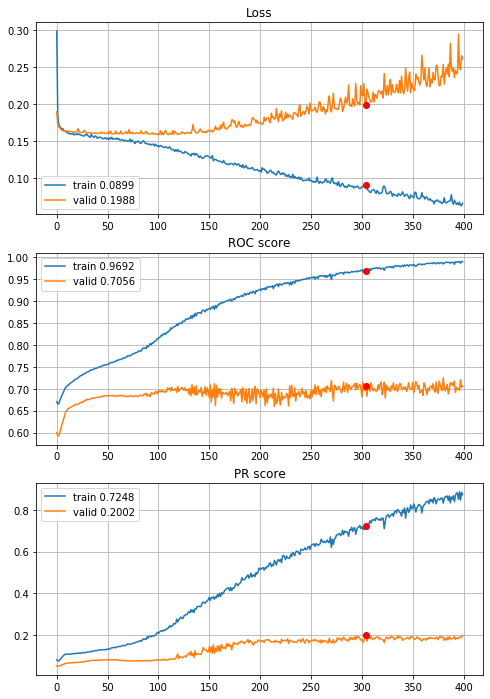


Fold 2------------------------------------------------------------


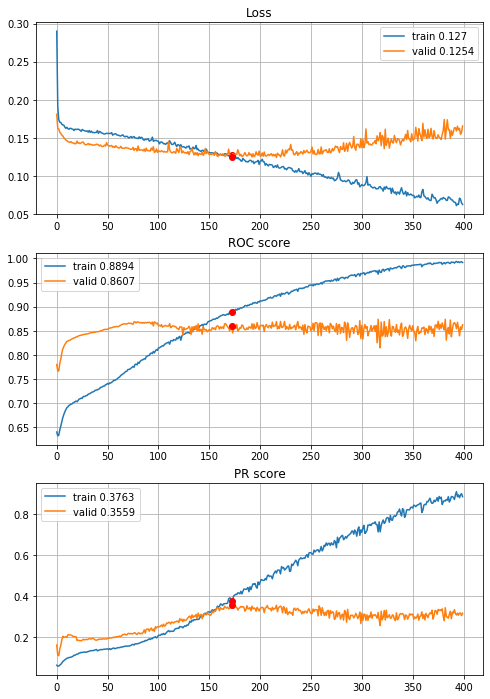


Fold 3------------------------------------------------------------


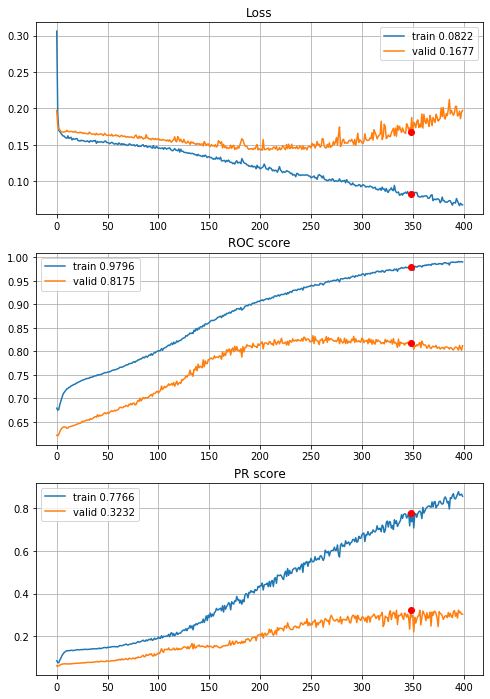


Fold 4------------------------------------------------------------


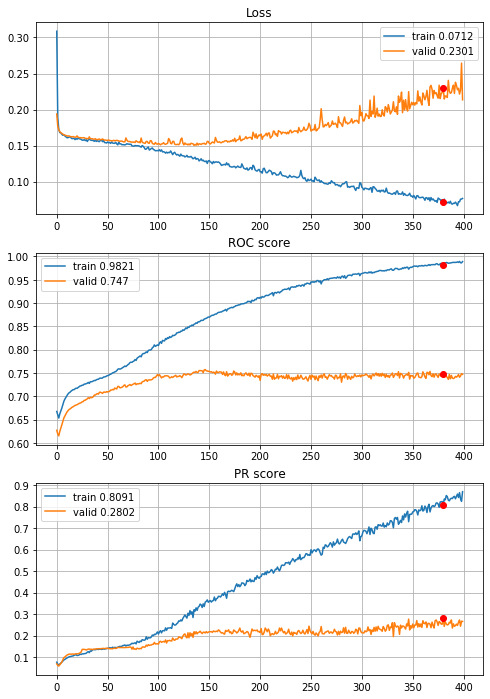


Fold 5------------------------------------------------------------


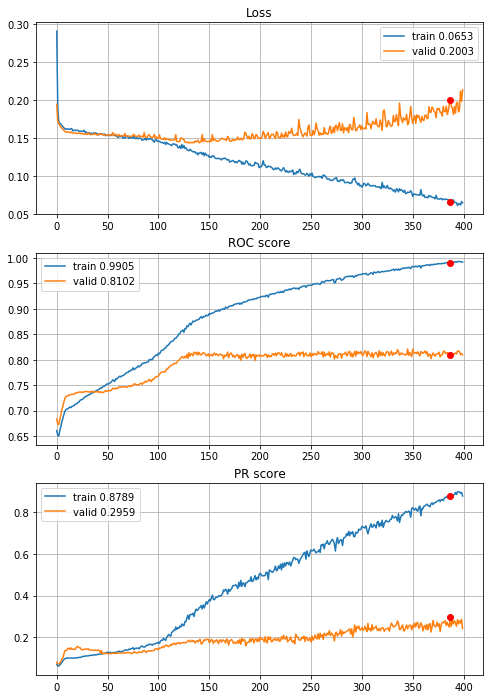


Fold 6------------------------------------------------------------


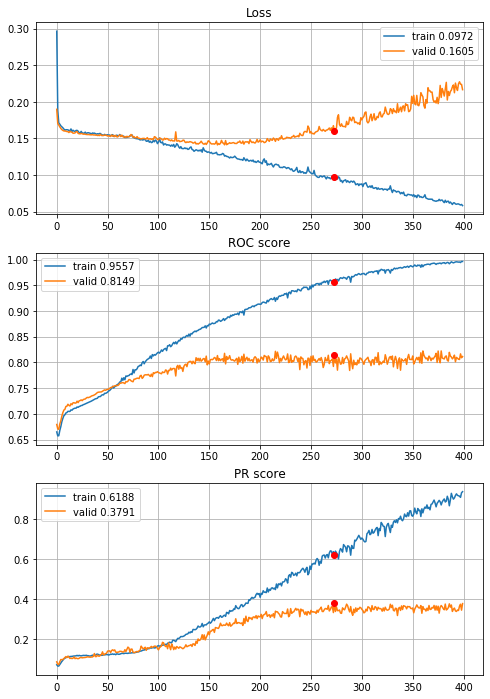

In [55]:
# THE BEST ONE
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_drop_04, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\1year\define_deep_CNN_2inc_std_L2_drop_04_450ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

##### 3 year horizon

In [49]:
def define_CNN_L2(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid,
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 2.15s train loss: 0.21818658426206072, validation loss: 0.20517467745567408
Epoch: 2/400,
cumulative time: 3.16s train loss: 0.19930810257651096, validation loss: 0.2168457596023802
Epoch: 3/400,
cumulative time: 4.22s train loss: 0.19245950140808293, validation loss: 0.17998444680583997
Epoch: 4/400,
cumulative time: 5.27s train loss: 0.1863020741962165, validation loss: 0.25973574593804594
Epoch: 5/400,
cumulative time: 6.29s train loss: 0.185303273593452, validation loss: 0.18639004083466937
Epoch: 6/400,
cumulative time: 7.33s train loss: 0.17966149753592273, validation loss: 0.1763246334255081
Epoch: 7/400,
cumulative time: 8.33s train loss: 0.17274848303317572, validation loss: 0.1976722727690521
Epoch: 8/400,
cumulative time: 9.33s train loss: 0.17746187418812367, validation loss: 0.18848268280558614
Epoch: 9/400,
cumulative time: 10.35s train loss: 0.17710618664293182, 

Epoch: 77/400,
cumulative time: 83.57s train loss: 0.10455361550118937, validation loss: 0.21124735005214046
Epoch: 78/400,
cumulative time: 84.7s train loss: 0.09349903303712775, validation loss: 0.18409031417496516
Epoch: 79/400,
cumulative time: 85.76s train loss: 0.09674478362418669, validation loss: 0.216776312754774
Epoch: 80/400,
cumulative time: 86.83s train loss: 0.09733212265332691, validation loss: 0.17919248905195456
Epoch: 81/400,
cumulative time: 87.91s train loss: 0.10164834395531686, validation loss: 0.1795084377789633
Epoch: 82/400,
cumulative time: 88.98s train loss: 0.08429468795374404, validation loss: 0.18536661274066688
Epoch: 83/400,
cumulative time: 90.07s train loss: 0.0928163443121218, validation loss: 0.20403430620791563
Epoch: 84/400,
cumulative time: 91.16s train loss: 0.08821400007978789, validation loss: 0.18515643075928517
Epoch: 85/400,
cumulative time: 92.29s train loss: 0.09008456141152463, validation loss: 0.17990298034796454
Epoch: 86/400,
cumulativ

Epoch: 152/400,
cumulative time: 163.72s train loss: 0.05542707681175201, validation loss: 0.25223766123094865
Epoch: 153/400,
cumulative time: 164.73s train loss: 0.04675420572666674, validation loss: 0.24999743349411907
Epoch: 154/400,
cumulative time: 165.72s train loss: 0.04817221234685103, validation loss: 0.2640198351818877
Epoch: 155/400,
cumulative time: 166.71s train loss: 0.04607279334832301, validation loss: 0.25259376279090795
Epoch: 156/400,
cumulative time: 167.71s train loss: 0.04725260109953455, validation loss: 0.3669490092619547
Epoch: 157/400,
cumulative time: 168.76s train loss: 0.04677203655158094, validation loss: 0.2790155492199892
Epoch: 158/400,
cumulative time: 169.79s train loss: 0.0607446434700851, validation loss: 0.299092716012553
Epoch: 159/400,
cumulative time: 170.86s train loss: 0.03914363715988522, validation loss: 0.2977273564015213
Epoch: 160/400,
cumulative time: 171.97s train loss: 0.04820125829463779, validation loss: 0.26176775169101113
Epoch: 1

Epoch: 227/400,
cumulative time: 238.63s train loss: 0.031062112435472307, validation loss: 0.3545672074101682
Epoch: 228/400,
cumulative time: 239.64s train loss: 0.023863709440889575, validation loss: 0.3010234285916504
Epoch: 229/400,
cumulative time: 240.66s train loss: 0.03885407226241461, validation loss: 0.30682893428223407
Epoch: 230/400,
cumulative time: 241.73s train loss: 0.021106599903960608, validation loss: 0.3182840189230284
Epoch: 231/400,
cumulative time: 242.76s train loss: 0.047889246950650576, validation loss: 0.31599460776888216
Epoch: 232/400,
cumulative time: 243.8s train loss: 0.03078412087651878, validation loss: 0.30980588583385243
Epoch: 233/400,
cumulative time: 244.86s train loss: 0.040961568194673004, validation loss: 0.3046345039778009
Epoch: 234/400,
cumulative time: 245.87s train loss: 0.02035935992406826, validation loss: 0.33800576938284416
Epoch: 235/400,
cumulative time: 246.88s train loss: 0.03356169435625058, validation loss: 0.3010131099192422
Ep

Epoch: 302/400,
cumulative time: 313.86s train loss: 0.03387781882647997, validation loss: 0.347338301407092
Epoch: 303/400,
cumulative time: 314.87s train loss: 0.028047558498096987, validation loss: 0.3352699343687669
Epoch: 304/400,
cumulative time: 315.87s train loss: 0.020632593097267726, validation loss: 0.39523122251825493
Epoch: 305/400,
cumulative time: 316.86s train loss: 0.018043478879109166, validation loss: 0.3641059025980716
Epoch: 306/400,
cumulative time: 317.85s train loss: 0.04061417128940235, validation loss: 0.34275737681922697
Epoch: 307/400,
cumulative time: 318.84s train loss: 0.015197909731538065, validation loss: 0.3429160020269977
Epoch: 308/400,
cumulative time: 319.84s train loss: 0.04318737016082432, validation loss: 0.3466771566211838
Epoch: 309/400,
cumulative time: 320.85s train loss: 0.015235802678981588, validation loss: 0.3911602672408609
Epoch: 310/400,
cumulative time: 321.88s train loss: 0.0202114335726063, validation loss: 0.36263512287013216
Epoc

Epoch: 376/400,
cumulative time: 388.44s train loss: 0.024343136039189642, validation loss: 0.45157067695424047
Epoch: 377/400,
cumulative time: 389.43s train loss: 0.017985679295472446, validation loss: 0.36824966936002873
Epoch: 378/400,
cumulative time: 390.47s train loss: 0.02064502554463198, validation loss: 0.3592653811486894
Epoch: 379/400,
cumulative time: 391.46s train loss: 0.013982351163518836, validation loss: 0.3614715655569333
Epoch: 380/400,
cumulative time: 392.46s train loss: 0.015118490564910804, validation loss: 0.4020129967572793
Epoch: 381/400,
cumulative time: 393.44s train loss: 0.025233919744996575, validation loss: 0.3555292178376576
Epoch: 382/400,
cumulative time: 394.42s train loss: 0.0213380040519604, validation loss: 0.42297354108694607
Epoch: 383/400,
cumulative time: 395.42s train loss: 0.01618542398416227, validation loss: 0.35108015721617886
Epoch: 384/400,
cumulative time: 396.42s train loss: 0.024358850616106386, validation loss: 0.4054417893488448
E

Epoch: 49/400,
cumulative time: 52.21s train loss: 0.12628943857788136, validation loss: 0.13900407226985953
Epoch: 50/400,
cumulative time: 53.3s train loss: 0.12132304901472758, validation loss: 0.13345811606527958
Epoch: 51/400,
cumulative time: 54.35s train loss: 0.1251089547232387, validation loss: 0.1331549650040478
Epoch: 52/400,
cumulative time: 55.38s train loss: 0.11384569014046178, validation loss: 0.2937746748639239
Epoch: 53/400,
cumulative time: 56.44s train loss: 0.12721690786348575, validation loss: 0.13081702635229425
Epoch: 54/400,
cumulative time: 57.47s train loss: 0.11604396421214887, validation loss: 0.13609819997815978
Epoch: 55/400,
cumulative time: 58.58s train loss: 0.12535268221283774, validation loss: 0.1414083473144039
Epoch: 56/400,
cumulative time: 59.78s train loss: 0.10919531150040636, validation loss: 0.14534664241706624
Epoch: 57/400,
cumulative time: 60.84s train loss: 0.1196430436630629, validation loss: 0.1638577177809583
Epoch: 58/400,
cumulative 

Epoch: 125/400,
cumulative time: 129.78s train loss: 0.07286586256050973, validation loss: 0.17036950497744885
Epoch: 126/400,
cumulative time: 130.78s train loss: 0.05401187733211599, validation loss: 0.2138108116569284
Epoch: 127/400,
cumulative time: 131.78s train loss: 0.0655397142444435, validation loss: 0.18540682384931612
Epoch: 128/400,
cumulative time: 132.78s train loss: 0.06962882668995767, validation loss: 0.171644001633664
Epoch: 129/400,
cumulative time: 133.78s train loss: 0.05530496277692648, validation loss: 0.23198821196293695
Epoch: 130/400,
cumulative time: 134.78s train loss: 0.0645486287645416, validation loss: 0.24384474389580216
Epoch: 131/400,
cumulative time: 135.79s train loss: 0.060982168996724276, validation loss: 0.1663492871925546
Epoch: 132/400,
cumulative time: 136.79s train loss: 0.06956295979543248, validation loss: 0.17087264647406916
Epoch: 133/400,
cumulative time: 137.79s train loss: 0.049301150141449986, validation loss: 0.15772927378567617
Epoch

Epoch: 199/400,
cumulative time: 204.85s train loss: 0.03623645584782907, validation loss: 0.29826587772233665
Epoch: 200/400,
cumulative time: 205.85s train loss: 0.030172736881975883, validation loss: 0.22105425550996466
Epoch: 201/400,
cumulative time: 206.88s train loss: 0.042295676194117234, validation loss: 0.21368385096428744
Epoch: 202/400,
cumulative time: 207.88s train loss: 0.036794887008092435, validation loss: 0.21427384867161456
Epoch: 203/400,
cumulative time: 208.86s train loss: 0.03545852416253294, validation loss: 0.23659897769538005
Epoch: 204/400,
cumulative time: 209.87s train loss: 0.022304914812548562, validation loss: 0.2489773531849063
Epoch: 205/400,
cumulative time: 210.86s train loss: 0.06018206811946529, validation loss: 0.23543694867015563
Epoch: 206/400,
cumulative time: 211.87s train loss: 0.020815533595389388, validation loss: 0.305333126088926
Epoch: 207/400,
cumulative time: 212.86s train loss: 0.032458257270831986, validation loss: 0.2470530493775174

Epoch: 273/400,
cumulative time: 278.69s train loss: 0.017181387374025595, validation loss: 0.25463776318692166
Epoch: 274/400,
cumulative time: 279.69s train loss: 0.024606472172507526, validation loss: 0.2574822956968304
Epoch: 275/400,
cumulative time: 280.67s train loss: 0.037625640969320535, validation loss: 0.2593029348402367
Epoch: 276/400,
cumulative time: 281.68s train loss: 0.015610094867872898, validation loss: 0.24501975047520488
Epoch: 277/400,
cumulative time: 282.67s train loss: 0.02727830371018888, validation loss: 0.2879297353284861
Epoch: 278/400,
cumulative time: 283.65s train loss: 0.022723846132222003, validation loss: 0.2434057596738696
Epoch: 279/400,
cumulative time: 284.65s train loss: 0.03051057059593513, validation loss: 0.25481561567118316
Epoch: 280/400,
cumulative time: 285.65s train loss: 0.020019692154972332, validation loss: 0.3819878444047309
Epoch: 281/400,
cumulative time: 286.65s train loss: 0.01950135897788479, validation loss: 0.28798303842205253


Epoch: 347/400,
cumulative time: 353.24s train loss: 0.031731981710589136, validation loss: 0.29780164363827605
Epoch: 348/400,
cumulative time: 354.25s train loss: 0.018100181353089367, validation loss: 0.38322203390059933
Epoch: 349/400,
cumulative time: 355.25s train loss: 0.025667918643841707, validation loss: 0.2601100183472009
Epoch: 350/400,
cumulative time: 356.25s train loss: 0.012657534868316814, validation loss: 0.27912126888699507
Epoch: 351/400,
cumulative time: 357.26s train loss: 0.03933583728092558, validation loss: 0.2885655613167236
Epoch: 352/400,
cumulative time: 358.27s train loss: 0.014335629661378416, validation loss: 0.26661195121069337
Epoch: 353/400,
cumulative time: 359.28s train loss: 0.01478966156328256, validation loss: 0.359076124695492
Epoch: 354/400,
cumulative time: 360.29s train loss: 0.03014707029487874, validation loss: 0.24982165294987427
Epoch: 355/400,
cumulative time: 361.29s train loss: 0.015450349998655084, validation loss: 0.27946799662692273

Epoch: 19/400,
cumulative time: 20.96s train loss: 0.1588217166020929, validation loss: 0.16963917763454864
Epoch: 20/400,
cumulative time: 21.98s train loss: 0.15882085518490885, validation loss: 0.1684870385411116
Epoch: 21/400,
cumulative time: 22.99s train loss: 0.159001829875262, validation loss: 0.167644762054114
Epoch: 22/400,
cumulative time: 24.0s train loss: 0.15515445177876294, validation loss: 0.1705157003264726
Epoch: 23/400,
cumulative time: 25.03s train loss: 0.15435474294129992, validation loss: 0.1733058990744531
Epoch: 24/400,
cumulative time: 26.06s train loss: 0.15504202618205343, validation loss: 0.16596193563553593
Epoch: 25/400,
cumulative time: 27.08s train loss: 0.15328607378241232, validation loss: 0.16767054380569785
Epoch: 26/400,
cumulative time: 28.1s train loss: 0.15352352736570804, validation loss: 0.16555241595748707
Epoch: 27/400,
cumulative time: 29.11s train loss: 0.15000023156461045, validation loss: 0.17326831483976665
Epoch: 28/400,
cumulative tim

Epoch: 95/400,
cumulative time: 98.28s train loss: 0.08912340137096691, validation loss: 0.1468741570721315
Epoch: 96/400,
cumulative time: 99.3s train loss: 0.07886029813134693, validation loss: 0.20926184887225532
Epoch: 97/400,
cumulative time: 100.31s train loss: 0.08098038975326115, validation loss: 0.16931011560293482
Epoch: 98/400,
cumulative time: 101.33s train loss: 0.08215441220851731, validation loss: 0.1574210015883708
Epoch: 99/400,
cumulative time: 102.34s train loss: 0.0787413412312742, validation loss: 0.1649656882491917
Epoch: 100/400,
cumulative time: 103.36s train loss: 0.08046347491117989, validation loss: 0.1649057917169647
Epoch: 101/400,
cumulative time: 104.37s train loss: 0.07797819830943782, validation loss: 0.1609847455142345
Epoch: 102/400,
cumulative time: 105.39s train loss: 0.07835440828519709, validation loss: 0.16379760176056476
Epoch: 103/400,
cumulative time: 106.41s train loss: 0.08460004991468262, validation loss: 0.15664610379787278
Epoch: 104/400,

Epoch: 170/400,
cumulative time: 175.09s train loss: 0.038099059073053006, validation loss: 0.3033528504663446
Epoch: 171/400,
cumulative time: 176.09s train loss: 0.03966824652192375, validation loss: 0.2749410734513679
Epoch: 172/400,
cumulative time: 177.11s train loss: 0.05169040217811853, validation loss: 0.25618784683818385
Epoch: 173/400,
cumulative time: 178.12s train loss: 0.034172584848086114, validation loss: 0.25206657715382114
Epoch: 174/400,
cumulative time: 179.13s train loss: 0.04448800502624186, validation loss: 0.2579764150917191
Epoch: 175/400,
cumulative time: 180.15s train loss: 0.036666714559809306, validation loss: 0.25583893431092575
Epoch: 176/400,
cumulative time: 181.15s train loss: 0.041147704242217926, validation loss: 0.25010766148340996
Epoch: 177/400,
cumulative time: 182.16s train loss: 0.03656321402349327, validation loss: 0.2588547032743523
Epoch: 178/400,
cumulative time: 183.19s train loss: 0.04286649244461046, validation loss: 0.25700532414542204
E

Epoch: 244/400,
cumulative time: 250.01s train loss: 0.017286521228175235, validation loss: 0.2954080009256866
Epoch: 245/400,
cumulative time: 251.05s train loss: 0.027438314856371118, validation loss: 0.4016931436432833
Epoch: 246/400,
cumulative time: 252.1s train loss: 0.026692641457539242, validation loss: 0.2973851441375671
Epoch: 247/400,
cumulative time: 253.16s train loss: 0.01617905895563242, validation loss: 0.3011185494331074
Epoch: 248/400,
cumulative time: 254.24s train loss: 0.03280870738232498, validation loss: 0.29835552602044996
Epoch: 249/400,
cumulative time: 255.25s train loss: 0.018118780641772376, validation loss: 0.3171826426286173
Epoch: 250/400,
cumulative time: 256.28s train loss: 0.030596779723717094, validation loss: 0.3127156309147261
Epoch: 251/400,
cumulative time: 257.31s train loss: 0.0361177535119698, validation loss: 0.3084688914738299
Epoch: 252/400,
cumulative time: 258.32s train loss: 0.01705034581990294, validation loss: 0.30729692993399316
Epoch

Epoch: 318/400,
cumulative time: 324.86s train loss: 0.02776102835111023, validation loss: 0.3130527817603533
Epoch: 319/400,
cumulative time: 325.89s train loss: 0.020193777204733306, validation loss: 0.31417381056572047
Epoch: 320/400,
cumulative time: 326.89s train loss: 0.014669200270816656, validation loss: 0.3274880975088992
Epoch: 321/400,
cumulative time: 327.91s train loss: 0.028643138605245942, validation loss: 0.3091028274180088
Epoch: 322/400,
cumulative time: 328.92s train loss: 0.014432432448431369, validation loss: 0.33225127715313457
Epoch: 323/400,
cumulative time: 329.93s train loss: 0.03912625113675332, validation loss: 0.31728319696502394
Epoch: 324/400,
cumulative time: 330.95s train loss: 0.013333591966195282, validation loss: 0.32080448646473025
Epoch: 325/400,
cumulative time: 331.95s train loss: 0.012242732040470985, validation loss: 0.364861866045722
Epoch: 326/400,
cumulative time: 332.96s train loss: 0.03331008646319102, validation loss: 0.32464091618327984


Epoch: 392/400,
cumulative time: 400.37s train loss: 0.010706972045933499, validation loss: 0.39145862377572105
Epoch: 393/400,
cumulative time: 401.39s train loss: 0.03232464255408103, validation loss: 0.3027760294854528
Epoch: 394/400,
cumulative time: 402.39s train loss: 0.011379256078786088, validation loss: 0.33159526814998214
Epoch: 395/400,
cumulative time: 403.4s train loss: 0.02711207190249292, validation loss: 0.35097785183781693
Epoch: 396/400,
cumulative time: 404.42s train loss: 0.011548422474194976, validation loss: 0.3396927449124135
Epoch: 397/400,
cumulative time: 405.43s train loss: 0.021437379601897507, validation loss: 0.3259402900029405
Epoch: 398/400,
cumulative time: 406.44s train loss: 0.012044833534250506, validation loss: 0.3483874177457712
Epoch: 399/400,
cumulative time: 407.45s train loss: 0.01376333839951023, validation loss: 0.37045231908277043
Epoch: 400/400,
cumulative time: 408.46s train loss: 0.027805059889518785, validation loss: 0.32053804572890787


Epoch: 65/400,
cumulative time: 67.22s train loss: 0.10714010799575802, validation loss: 0.1861310451091806
Epoch: 66/400,
cumulative time: 68.24s train loss: 0.103381984631409, validation loss: 0.16170813963241323
Epoch: 67/400,
cumulative time: 69.24s train loss: 0.09821660214402418, validation loss: 0.19516951221781845
Epoch: 68/400,
cumulative time: 70.26s train loss: 0.12088203454209913, validation loss: 0.16256795354201625
Epoch: 69/400,
cumulative time: 71.28s train loss: 0.09326659449476897, validation loss: 0.1621979864374284
Epoch: 70/400,
cumulative time: 72.37s train loss: 0.10753188980937682, validation loss: 0.17123302243353067
Epoch: 71/400,
cumulative time: 73.5s train loss: 0.09747450068960606, validation loss: 0.1865810883395812
Epoch: 72/400,
cumulative time: 74.56s train loss: 0.10307688124096145, validation loss: 0.16647180702812983
Epoch: 73/400,
cumulative time: 75.61s train loss: 0.09390109434469375, validation loss: 0.177292495485275
Epoch: 74/400,
cumulative t

Epoch: 140/400,
cumulative time: 144.09s train loss: 0.05918743037097368, validation loss: 0.2389144887281776
Epoch: 141/400,
cumulative time: 145.11s train loss: 0.06009961834894864, validation loss: 0.2592115255754858
Epoch: 142/400,
cumulative time: 146.13s train loss: 0.041431333239860056, validation loss: 0.22407993954205196
Epoch: 143/400,
cumulative time: 147.14s train loss: 0.04858806782545243, validation loss: 0.24019850629330586
Epoch: 144/400,
cumulative time: 148.14s train loss: 0.05784544779210434, validation loss: 0.35356049304668996
Epoch: 145/400,
cumulative time: 149.15s train loss: 0.05981722363894646, validation loss: 0.2163262481481346
Epoch: 146/400,
cumulative time: 150.18s train loss: 0.05172329980533648, validation loss: 0.22588605944074308
Epoch: 147/400,
cumulative time: 151.18s train loss: 0.054609842013136484, validation loss: 0.2266867756278058
Epoch: 148/400,
cumulative time: 152.19s train loss: 0.048185958223420935, validation loss: 0.24211209333825157
Ep

Epoch: 214/400,
cumulative time: 220.07s train loss: 0.05093783681869394, validation loss: 0.27419397845666366
Epoch: 215/400,
cumulative time: 221.08s train loss: 0.026340074762984743, validation loss: 0.3070705740569439
Epoch: 216/400,
cumulative time: 222.09s train loss: 0.030069633093317952, validation loss: 0.28715115310571226
Epoch: 217/400,
cumulative time: 223.1s train loss: 0.041159634554733926, validation loss: 0.31440508376941284
Epoch: 218/400,
cumulative time: 224.13s train loss: 0.02559253233405399, validation loss: 0.2861472106975215
Epoch: 219/400,
cumulative time: 225.14s train loss: 0.023239217492163296, validation loss: 0.28776203061982397
Epoch: 220/400,
cumulative time: 226.14s train loss: 0.04452419706975486, validation loss: 0.2760326951968376
Epoch: 221/400,
cumulative time: 227.15s train loss: 0.038649691063097805, validation loss: 0.2728991488691073
Epoch: 222/400,
cumulative time: 228.19s train loss: 0.03381366808836894, validation loss: 0.32127554576130024
E

Epoch: 288/400,
cumulative time: 295.04s train loss: 0.017382830380686547, validation loss: 0.3022895804279443
Epoch: 289/400,
cumulative time: 296.05s train loss: 0.04217984063879532, validation loss: 0.30215015933907236
Epoch: 290/400,
cumulative time: 297.07s train loss: 0.015748187261978182, validation loss: 0.4752186355826072
Epoch: 291/400,
cumulative time: 298.07s train loss: 0.033973657263114174, validation loss: 0.29404682656166903
Epoch: 292/400,
cumulative time: 299.08s train loss: 0.013708860454002865, validation loss: 0.2942575730340983
Epoch: 293/400,
cumulative time: 300.09s train loss: 0.04266700996669182, validation loss: 0.2856909314866763
Epoch: 294/400,
cumulative time: 301.1s train loss: 0.01631866165311332, validation loss: 0.3007837146577165
Epoch: 295/400,
cumulative time: 302.11s train loss: 0.03234749854713735, validation loss: 0.2947798569808649
Epoch: 296/400,
cumulative time: 303.12s train loss: 0.01830945651115853, validation loss: 0.46244822089088483
Epoc

Epoch: 362/400,
cumulative time: 370.52s train loss: 0.03737738007958802, validation loss: 0.2894373872022249
Epoch: 363/400,
cumulative time: 371.55s train loss: 0.013385646465098383, validation loss: 0.2956057162054123
Epoch: 364/400,
cumulative time: 372.57s train loss: 0.011627625283454695, validation loss: 0.35153930440573355
Epoch: 365/400,
cumulative time: 373.58s train loss: 0.026925097292101813, validation loss: 0.3009310918356481
Epoch: 366/400,
cumulative time: 374.6s train loss: 0.013207500357626172, validation loss: 0.3791363000643547
Epoch: 367/400,
cumulative time: 375.64s train loss: 0.03624751520373168, validation loss: 0.29970316642601985
Epoch: 368/400,
cumulative time: 376.62s train loss: 0.014885753569894768, validation loss: 0.31873264682587005
Epoch: 369/400,
cumulative time: 377.66s train loss: 0.038974411903299123, validation loss: 0.31190563022977263
Epoch: 370/400,
cumulative time: 378.66s train loss: 0.013603774227371591, validation loss: 0.30624579546347513

Epoch: 35/400,
cumulative time: 36.94s train loss: 0.1415958312645809, validation loss: 0.16348755348339478
Epoch: 36/400,
cumulative time: 37.96s train loss: 0.14171821237515228, validation loss: 0.15196823180287342
Epoch: 37/400,
cumulative time: 38.96s train loss: 0.1393590163404168, validation loss: 0.15463578828258803
Epoch: 38/400,
cumulative time: 39.98s train loss: 0.13877483497760779, validation loss: 0.15498491525084515
Epoch: 39/400,
cumulative time: 40.99s train loss: 0.13781445393130268, validation loss: 0.15101022958981697
Epoch: 40/400,
cumulative time: 42.01s train loss: 0.13478609265819672, validation loss: 0.1762304383222247
Epoch: 41/400,
cumulative time: 43.02s train loss: 0.13522223256231486, validation loss: 0.1490235702758496
Epoch: 42/400,
cumulative time: 44.08s train loss: 0.13127436322889927, validation loss: 0.1730531911300301
Epoch: 43/400,
cumulative time: 45.08s train loss: 0.13161903670096534, validation loss: 0.1636309929093102
Epoch: 44/400,
cumulative

Epoch: 111/400,
cumulative time: 114.31s train loss: 0.08028878957259361, validation loss: 0.17668045290959628
Epoch: 112/400,
cumulative time: 115.33s train loss: 0.07519483299081195, validation loss: 0.19015404689470325
Epoch: 113/400,
cumulative time: 116.34s train loss: 0.08021797565513589, validation loss: 0.18571970191920278
Epoch: 114/400,
cumulative time: 117.35s train loss: 0.07530728587332894, validation loss: 0.23262164669652138
Epoch: 115/400,
cumulative time: 118.37s train loss: 0.08086862063470104, validation loss: 0.19012629615400956
Epoch: 116/400,
cumulative time: 119.39s train loss: 0.07325870372934631, validation loss: 0.24039970674822408
Epoch: 117/400,
cumulative time: 120.39s train loss: 0.07233904131760634, validation loss: 0.17992093596444864
Epoch: 118/400,
cumulative time: 121.41s train loss: 0.07525327884410092, validation loss: 0.22083333411750578
Epoch: 119/400,
cumulative time: 122.41s train loss: 0.06787105524308089, validation loss: 0.21580684001237663
E

Epoch: 186/400,
cumulative time: 190.97s train loss: 0.03729782673606271, validation loss: 0.2676300257727136
Epoch: 187/400,
cumulative time: 191.97s train loss: 0.04751708347498805, validation loss: 0.24247415768127514
Epoch: 188/400,
cumulative time: 193.05s train loss: 0.049501801985519206, validation loss: 0.2579650863637508
Epoch: 189/400,
cumulative time: 194.09s train loss: 0.03397123026511362, validation loss: 0.25429068268250243
Epoch: 190/400,
cumulative time: 195.11s train loss: 0.041733344077385354, validation loss: 0.25558490957888075
Epoch: 191/400,
cumulative time: 196.14s train loss: 0.03586102399261106, validation loss: 0.264250866687049
Epoch: 192/400,
cumulative time: 197.19s train loss: 0.05227737011744922, validation loss: 0.25425948943426757
Epoch: 193/400,
cumulative time: 198.21s train loss: 0.05344025234442621, validation loss: 0.27715743721888686
Epoch: 194/400,
cumulative time: 199.22s train loss: 0.03235748741542479, validation loss: 0.2653442076080438
Epoc

Epoch: 260/400,
cumulative time: 266.67s train loss: 0.03472717695319901, validation loss: 0.29581116187957024
Epoch: 261/400,
cumulative time: 267.7s train loss: 0.018616753321077383, validation loss: 0.29726125042623996
Epoch: 262/400,
cumulative time: 268.72s train loss: 0.04902691915949393, validation loss: 0.2886493859187023
Epoch: 263/400,
cumulative time: 269.74s train loss: 0.017263692014089005, validation loss: 0.3335588841329716
Epoch: 264/400,
cumulative time: 270.75s train loss: 0.03645702404883713, validation loss: 0.3001428886654255
Epoch: 265/400,
cumulative time: 271.77s train loss: 0.01899573674966251, validation loss: 0.347676001305372
Epoch: 266/400,
cumulative time: 272.78s train loss: 0.03871490214960172, validation loss: 0.3104520825213228
Epoch: 267/400,
cumulative time: 273.8s train loss: 0.019536676535301573, validation loss: 0.3059045269208796
Epoch: 268/400,
cumulative time: 274.86s train loss: 0.04881649803956953, validation loss: 0.2784894216218981
Epoch: 2

Epoch: 334/400,
cumulative time: 341.74s train loss: 0.02063309231479661, validation loss: 0.305319276548201
Epoch: 335/400,
cumulative time: 342.77s train loss: 0.033915485682026035, validation loss: 0.327049918260701
Epoch: 336/400,
cumulative time: 343.78s train loss: 0.01534899618384734, validation loss: 0.3062348886051938
Epoch: 337/400,
cumulative time: 344.8s train loss: 0.0316236555162796, validation loss: 0.31618307239642857
Epoch: 338/400,
cumulative time: 345.8s train loss: 0.015276797795827293, validation loss: 0.3080087751998395
Epoch: 339/400,
cumulative time: 346.81s train loss: 0.04495487321288355, validation loss: 0.3121962300740338
Epoch: 340/400,
cumulative time: 347.83s train loss: 0.014456070698727013, validation loss: 0.3075445112286302
Epoch: 341/400,
cumulative time: 348.84s train loss: 0.032396644118826916, validation loss: 0.30289739879304134
Epoch: 342/400,
cumulative time: 349.86s train loss: 0.01377964345897341, validation loss: 0.32874017354433177
Epoch: 3

Epoch: 6/400,
cumulative time: 7.13s train loss: 0.17383766027284075, validation loss: 0.20095009392081448
Epoch: 7/400,
cumulative time: 8.15s train loss: 0.17775157368839126, validation loss: 0.17854674983296043
Epoch: 8/400,
cumulative time: 9.17s train loss: 0.1731935469769436, validation loss: 0.17708433087229503
Epoch: 9/400,
cumulative time: 10.2s train loss: 0.1724531434660166, validation loss: 0.17335298074943065
Epoch: 10/400,
cumulative time: 11.22s train loss: 0.17348443328542545, validation loss: 0.1718309511778703
Epoch: 11/400,
cumulative time: 12.25s train loss: 0.17098557984693227, validation loss: 0.167348941883507
Epoch: 12/400,
cumulative time: 13.25s train loss: 0.16765548041694756, validation loss: 0.16618030607361042
Epoch: 13/400,
cumulative time: 14.3s train loss: 0.16655157456135614, validation loss: 0.1922131936848729
Epoch: 14/400,
cumulative time: 15.32s train loss: 0.16423075006005886, validation loss: 0.17442568166771696
Epoch: 15/400,
cumulative time: 16

Epoch: 82/400,
cumulative time: 85.24s train loss: 0.10712717669738538, validation loss: 0.14156269077105585
Epoch: 83/400,
cumulative time: 86.29s train loss: 0.10232470490222186, validation loss: 0.162220142088986
Epoch: 84/400,
cumulative time: 87.34s train loss: 0.10774947119562178, validation loss: 0.14809335035888702
Epoch: 85/400,
cumulative time: 88.37s train loss: 0.10623611012434823, validation loss: 0.18509002448372416
Epoch: 86/400,
cumulative time: 89.43s train loss: 0.1023462419774546, validation loss: 0.14499574646608202
Epoch: 87/400,
cumulative time: 90.5s train loss: 0.10438869794021295, validation loss: 0.17948179306070086
Epoch: 88/400,
cumulative time: 91.58s train loss: 0.09858964965228112, validation loss: 0.1484757285190488
Epoch: 89/400,
cumulative time: 92.64s train loss: 0.0953961191455033, validation loss: 0.14489197449677357
Epoch: 90/400,
cumulative time: 93.68s train loss: 0.09844164819628057, validation loss: 0.1648518402673714
Epoch: 91/400,
cumulative 

Epoch: 157/400,
cumulative time: 162.07s train loss: 0.0630830184353314, validation loss: 0.18697363344609624
Epoch: 158/400,
cumulative time: 163.08s train loss: 0.04276564722099612, validation loss: 0.17422739481394386
Epoch: 159/400,
cumulative time: 164.1s train loss: 0.05008908293830262, validation loss: 0.2075552066374549
Epoch: 160/400,
cumulative time: 165.11s train loss: 0.056909393109169135, validation loss: 0.20741099314286993
Epoch: 161/400,
cumulative time: 166.13s train loss: 0.046957674971737494, validation loss: 0.19797547570159357
Epoch: 162/400,
cumulative time: 167.14s train loss: 0.03971722381334377, validation loss: 0.26776354289145354
Epoch: 163/400,
cumulative time: 168.16s train loss: 0.04255828780936788, validation loss: 0.18616030318574164
Epoch: 164/400,
cumulative time: 169.18s train loss: 0.055620327753066114, validation loss: 0.20379248363243335
Epoch: 165/400,
cumulative time: 170.19s train loss: 0.048258495333638095, validation loss: 0.187035912538276
Ep

Epoch: 231/400,
cumulative time: 238.15s train loss: 0.04477140338140658, validation loss: 0.22526539276854138
Epoch: 232/400,
cumulative time: 239.16s train loss: 0.03392174898220873, validation loss: 0.21164128973203547
Epoch: 233/400,
cumulative time: 240.18s train loss: 0.022877473521984732, validation loss: 0.2693050969427406
Epoch: 234/400,
cumulative time: 241.19s train loss: 0.03788341127010857, validation loss: 0.2277404501383852
Epoch: 235/400,
cumulative time: 242.21s train loss: 0.027817266164400545, validation loss: 0.31781054532731506
Epoch: 236/400,
cumulative time: 243.22s train loss: 0.02548941916572301, validation loss: 0.24102945854813143
Epoch: 237/400,
cumulative time: 244.23s train loss: 0.05424789325166246, validation loss: 0.21670869281215052
Epoch: 238/400,
cumulative time: 245.25s train loss: 0.02022692086263445, validation loss: 0.21802597222902742
Epoch: 239/400,
cumulative time: 246.28s train loss: 0.04116958789880859, validation loss: 0.22068584236745817
E

Epoch: 305/400,
cumulative time: 313.57s train loss: 0.0267250402517744, validation loss: 0.36587945599483584
Epoch: 306/400,
cumulative time: 314.59s train loss: 0.027458559227948282, validation loss: 0.23554202526864335
Epoch: 307/400,
cumulative time: 315.62s train loss: 0.01685672154830348, validation loss: 0.26112336743149406
Epoch: 308/400,
cumulative time: 316.62s train loss: 0.031414453365417656, validation loss: 0.26803968148394375
Epoch: 309/400,
cumulative time: 317.64s train loss: 0.029837135149897616, validation loss: 0.22810997487358622
Epoch: 310/400,
cumulative time: 318.65s train loss: 0.017056316253596625, validation loss: 0.25518560036309984
Epoch: 311/400,
cumulative time: 319.66s train loss: 0.02891306952843743, validation loss: 0.24317266946160138
Epoch: 312/400,
cumulative time: 320.68s train loss: 0.016261031082787144, validation loss: 0.328898052760953
Epoch: 313/400,
cumulative time: 321.7s train loss: 0.033921498129501286, validation loss: 0.2408645743719767


Epoch: 379/400,
cumulative time: 389.54s train loss: 0.0188661774122059, validation loss: 0.2509103554532469
Epoch: 380/400,
cumulative time: 390.55s train loss: 0.0219907680028021, validation loss: 0.24931388315824224
Epoch: 381/400,
cumulative time: 391.57s train loss: 0.02301728891728329, validation loss: 0.23773369294868701
Epoch: 382/400,
cumulative time: 392.6s train loss: 0.01674939984989404, validation loss: 0.3405816923735038
Epoch: 383/400,
cumulative time: 393.61s train loss: 0.02091219039559647, validation loss: 0.2413232971753296
Epoch: 384/400,
cumulative time: 394.63s train loss: 0.01643813878290737, validation loss: 0.23391231843597296
Epoch: 385/400,
cumulative time: 395.65s train loss: 0.01884305401964986, validation loss: 0.2871342404291345
Epoch: 386/400,
cumulative time: 396.68s train loss: 0.015029450779890314, validation loss: 0.27425961518762687
Epoch: 387/400,
cumulative time: 397.7s train loss: 0.03473083554065488, validation loss: 0.23103586138991297
Epoch: 3

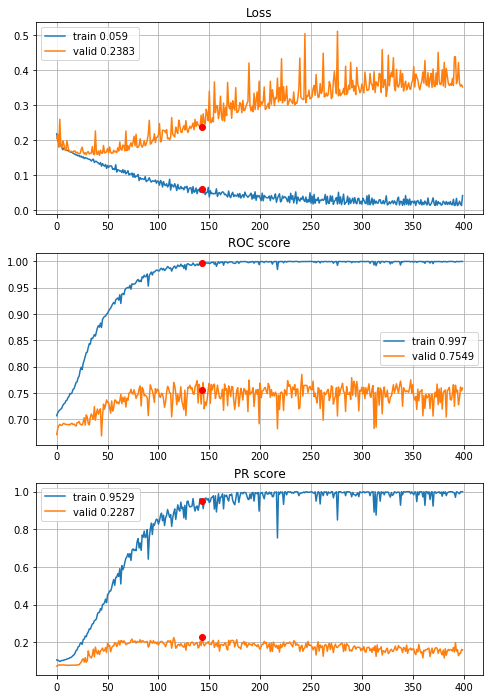


Fold 2------------------------------------------------------------


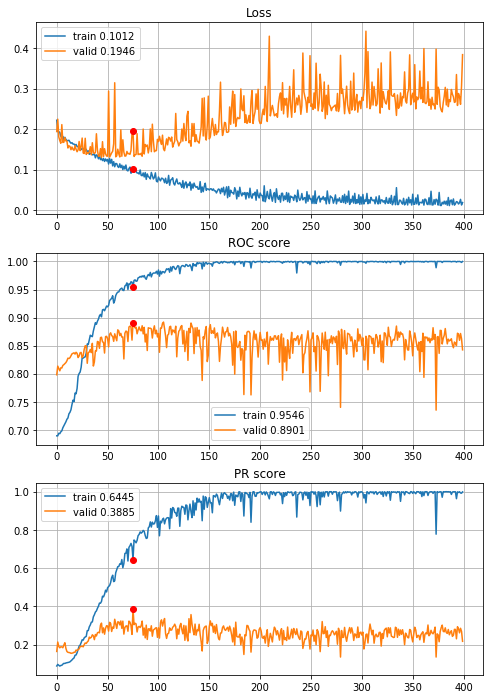


Fold 3------------------------------------------------------------


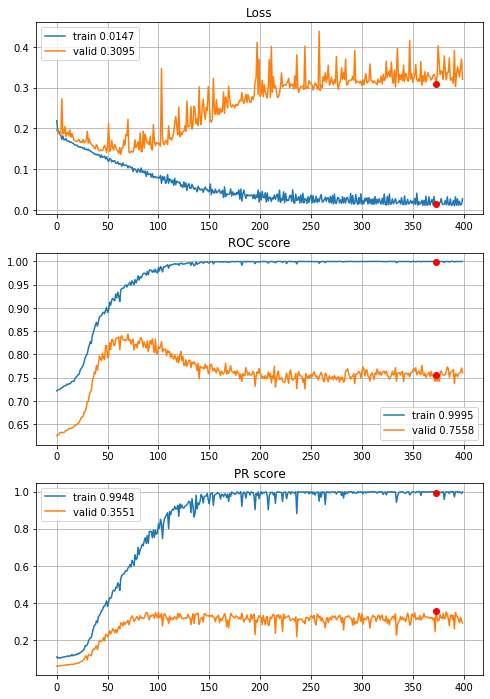


Fold 4------------------------------------------------------------


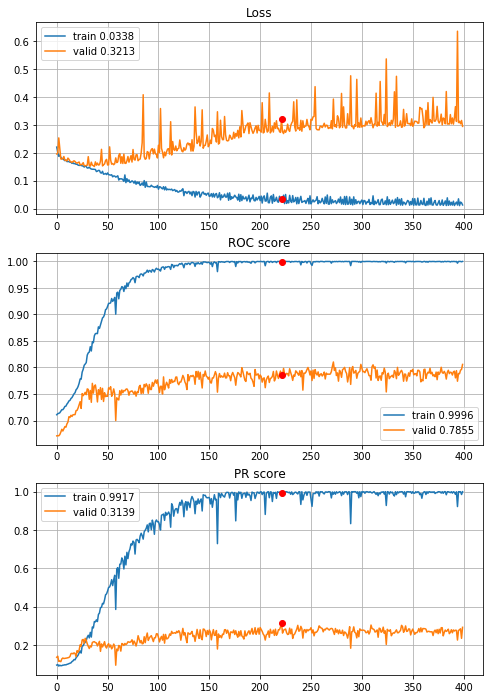


Fold 5------------------------------------------------------------


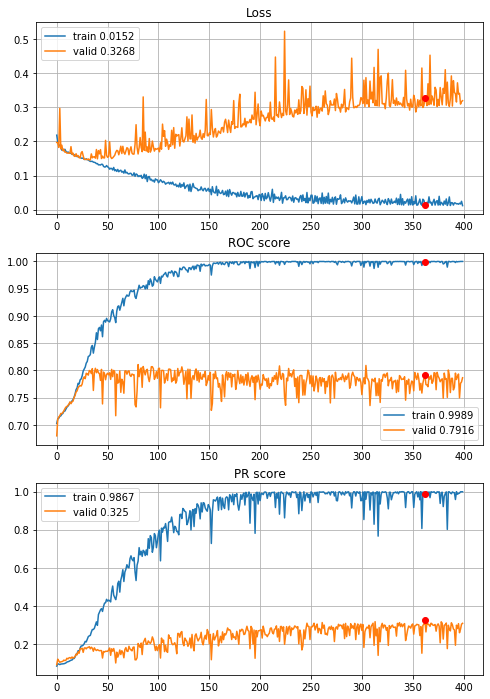


Fold 6------------------------------------------------------------


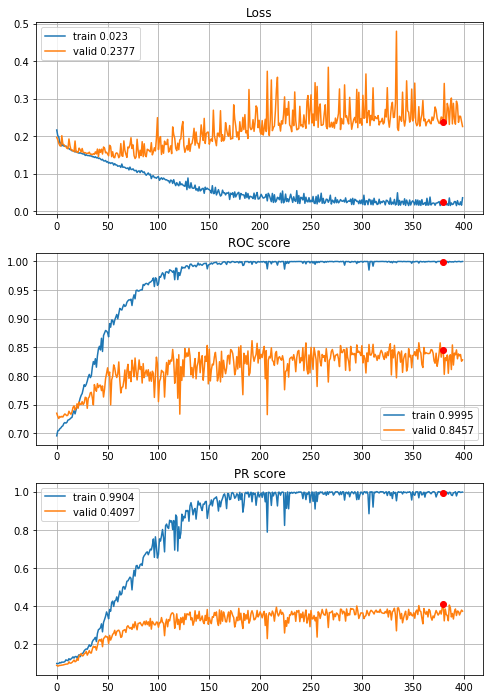

In [48]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN_L2, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3, 
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\1year\define_CNN_L2_300ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

##### 4 year horizon

In [50]:
def define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.0001))(flat)                            # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)                          # (128,)
    dense = layers.Dropout(rate=0.2)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 3.73s train loss: 0.3486457945725949, validation loss: 0.22743405876734224
Epoch: 2/400,
cumulative time: 4.68s train loss: 0.2075485981788762, validation loss: 0.1900415861346464
Epoch: 3/400,
cumulative time: 5.64s train loss: 0.18952251360018293, validation loss: 0.1820929785889964
Epoch: 4/400,
cumulative time: 6.65s train loss: 0.1845007282506809, validation loss: 0.1783759726009966
Epoch: 5/400,
cumulative time: 7.61s train loss: 0.18223268083195984, validation loss: 0.17608550284234578
Epoch: 6/400,
cumulative time: 8.58s train loss: 0.17916589647361858, validation loss: 0.17430086366026407
Epoch: 7/400,
cumulative time: 9.53s train loss: 0.17435765127303252, validation loss: 0.17272323938316367
Epoch: 8/400,
cumulative time: 10.49s train loss: 0.17388349123709115, validation loss: 0.17149684573938995
Epoch: 9/400,
cumulative time: 11.45s train loss: 0.17336206340868965,

Epoch: 77/400,
cumulative time: 77.0s train loss: 0.14759318012836084, validation loss: 0.1624850214262841
Epoch: 78/400,
cumulative time: 77.95s train loss: 0.14382332410430093, validation loss: 0.1573241045963606
Epoch: 79/400,
cumulative time: 78.9s train loss: 0.14447396459231115, validation loss: 0.15954002797377403
Epoch: 80/400,
cumulative time: 79.85s train loss: 0.14250245969989947, validation loss: 0.1621057702762126
Epoch: 81/400,
cumulative time: 80.8s train loss: 0.14456751874490753, validation loss: 0.16548001096076712
Epoch: 82/400,
cumulative time: 81.74s train loss: 0.1449659608177261, validation loss: 0.16967254062757547
Epoch: 83/400,
cumulative time: 82.7s train loss: 0.14228535778325693, validation loss: 0.1568833672966405
Epoch: 84/400,
cumulative time: 83.7s train loss: 0.1404021469957462, validation loss: 0.15891562874448367
Epoch: 85/400,
cumulative time: 84.66s train loss: 0.13981931451602045, validation loss: 0.15826696214006342
Epoch: 86/400,
cumulative time

Epoch: 152/400,
cumulative time: 148.36s train loss: 0.11300480278664793, validation loss: 0.1605700887810347
Epoch: 153/400,
cumulative time: 149.33s train loss: 0.11340392734395938, validation loss: 0.161379551242832
Epoch: 154/400,
cumulative time: 150.3s train loss: 0.11807504761716672, validation loss: 0.16230775670376402
Epoch: 155/400,
cumulative time: 151.29s train loss: 0.11123004877194055, validation loss: 0.16138073688892532
Epoch: 156/400,
cumulative time: 152.26s train loss: 0.11517765192028694, validation loss: 0.16435274074606923
Epoch: 157/400,
cumulative time: 153.32s train loss: 0.11146370400117968, validation loss: 0.16366241725278308
Epoch: 158/400,
cumulative time: 154.31s train loss: 0.11106131660983504, validation loss: 0.16171473683170848
Epoch: 159/400,
cumulative time: 155.29s train loss: 0.10832520350672488, validation loss: 0.1653828962760813
Epoch: 160/400,
cumulative time: 156.25s train loss: 0.10769087708991665, validation loss: 0.16653718113673027
Epoch:

Epoch: 227/400,
cumulative time: 220.15s train loss: 0.08027519038268692, validation loss: 0.18536411022212518
Epoch: 228/400,
cumulative time: 221.09s train loss: 0.08120710764935618, validation loss: 0.18845672382349307
Epoch: 229/400,
cumulative time: 222.05s train loss: 0.0809061313023264, validation loss: 0.19325791239964668
Epoch: 230/400,
cumulative time: 222.99s train loss: 0.08335429109647106, validation loss: 0.18823616978565702
Epoch: 231/400,
cumulative time: 223.93s train loss: 0.08191262668235479, validation loss: 0.18758125408098414
Epoch: 232/400,
cumulative time: 224.88s train loss: 0.07779657385069912, validation loss: 0.18464974592487546
Epoch: 233/400,
cumulative time: 225.83s train loss: 0.07835453023437756, validation loss: 0.18684075441939554
Epoch: 234/400,
cumulative time: 226.76s train loss: 0.08040698725567597, validation loss: 0.18439108311451363
Epoch: 235/400,
cumulative time: 227.7s train loss: 0.0802279616965854, validation loss: 0.192527757763184
Epoch:

Epoch: 302/400,
cumulative time: 291.66s train loss: 0.05796340150613712, validation loss: 0.23008305266980203
Epoch: 303/400,
cumulative time: 292.63s train loss: 0.06487499056012852, validation loss: 0.23561110249959089
Epoch: 304/400,
cumulative time: 293.57s train loss: 0.06791014737772987, validation loss: 0.22307240208027712
Epoch: 305/400,
cumulative time: 294.52s train loss: 0.06032536747729303, validation loss: 0.23423769380155052
Epoch: 306/400,
cumulative time: 295.47s train loss: 0.05760777921926591, validation loss: 0.22570487407285303
Epoch: 307/400,
cumulative time: 296.41s train loss: 0.05289525232601211, validation loss: 0.24064981043904285
Epoch: 308/400,
cumulative time: 297.37s train loss: 0.05734337175395728, validation loss: 0.23391310251415115
Epoch: 309/400,
cumulative time: 298.31s train loss: 0.05460893140515521, validation loss: 0.23010538043401274
Epoch: 310/400,
cumulative time: 299.28s train loss: 0.054871527849214126, validation loss: 0.22471838465677946


Epoch: 376/400,
cumulative time: 361.99s train loss: 0.042920131675997994, validation loss: 0.26786435396892977
Epoch: 377/400,
cumulative time: 362.94s train loss: 0.04133543081977449, validation loss: 0.25577269949768255
Epoch: 378/400,
cumulative time: 363.91s train loss: 0.041370390365483414, validation loss: 0.26049086369531654
Epoch: 379/400,
cumulative time: 364.86s train loss: 0.04084797791528747, validation loss: 0.2726109642005283
Epoch: 380/400,
cumulative time: 365.8s train loss: 0.041148447594561204, validation loss: 0.2733620712268511
Epoch: 381/400,
cumulative time: 366.76s train loss: 0.03825541098356473, validation loss: 0.2882216289441545
Epoch: 382/400,
cumulative time: 367.7s train loss: 0.04511669557647642, validation loss: 0.2712242569936973
Epoch: 383/400,
cumulative time: 368.66s train loss: 0.04156975775207808, validation loss: 0.2678616819390762
Epoch: 384/400,
cumulative time: 369.6s train loss: 0.04926355355180644, validation loss: 0.28401408190406024
Epoch:

Epoch: 49/400,
cumulative time: 50.51s train loss: 0.15676370020496325, validation loss: 0.14178741693609806
Epoch: 50/400,
cumulative time: 51.47s train loss: 0.1541781313165994, validation loss: 0.140772680347287
Epoch: 51/400,
cumulative time: 52.45s train loss: 0.1570730843766817, validation loss: 0.14138492251935447
Epoch: 52/400,
cumulative time: 53.41s train loss: 0.15233464888535594, validation loss: 0.13910758136232618
Epoch: 53/400,
cumulative time: 54.36s train loss: 0.15942207374936943, validation loss: 0.14737393210802857
Epoch: 54/400,
cumulative time: 55.33s train loss: 0.16006144456833996, validation loss: 0.1392130360883825
Epoch: 55/400,
cumulative time: 56.28s train loss: 0.1556218487572851, validation loss: 0.14119460994989189
Epoch: 56/400,
cumulative time: 57.23s train loss: 0.1540887907430162, validation loss: 0.13897361313708592
Epoch: 57/400,
cumulative time: 58.19s train loss: 0.1532565824842996, validation loss: 0.13904220366274384
Epoch: 58/400,
cumulative t

Epoch: 125/400,
cumulative time: 123.83s train loss: 0.12166326666070569, validation loss: 0.12507326513585373
Epoch: 126/400,
cumulative time: 124.82s train loss: 0.12058069401153804, validation loss: 0.13002583445306068
Epoch: 127/400,
cumulative time: 125.8s train loss: 0.12208252849173953, validation loss: 0.12935523620932107
Epoch: 128/400,
cumulative time: 126.76s train loss: 0.12032492251561308, validation loss: 0.13030562918824082
Epoch: 129/400,
cumulative time: 127.73s train loss: 0.1188658350870098, validation loss: 0.131365724346217
Epoch: 130/400,
cumulative time: 128.67s train loss: 0.11862445654633828, validation loss: 0.12841887909219207
Epoch: 131/400,
cumulative time: 129.64s train loss: 0.11687098498079763, validation loss: 0.1242301149233695
Epoch: 132/400,
cumulative time: 130.64s train loss: 0.11409328856153778, validation loss: 0.13204659674267163
Epoch: 133/400,
cumulative time: 131.6s train loss: 0.11348631856167792, validation loss: 0.12828667563663715
Epoch: 

Epoch: 200/400,
cumulative time: 198.76s train loss: 0.07589743816394508, validation loss: 0.17026539715236685
Epoch: 201/400,
cumulative time: 199.75s train loss: 0.07808064686194544, validation loss: 0.15405167381948945
Epoch: 202/400,
cumulative time: 200.75s train loss: 0.07930064943161363, validation loss: 0.15377127731208332
Epoch: 203/400,
cumulative time: 201.71s train loss: 0.07720977532937133, validation loss: 0.15258207015226644
Epoch: 204/400,
cumulative time: 202.65s train loss: 0.07512257864143862, validation loss: 0.15363686722641426
Epoch: 205/400,
cumulative time: 203.7s train loss: 0.0777244471678019, validation loss: 0.16023305233787088
Epoch: 206/400,
cumulative time: 204.72s train loss: 0.07893780607313088, validation loss: 0.15695957098672242
Epoch: 207/400,
cumulative time: 205.74s train loss: 0.0744685367188033, validation loss: 0.1560920335536211
Epoch: 208/400,
cumulative time: 206.79s train loss: 0.07743469616663298, validation loss: 0.1487269623229807
Epoch:

Epoch: 275/400,
cumulative time: 274.4s train loss: 0.045773892467258326, validation loss: 0.19413258692345087
Epoch: 276/400,
cumulative time: 275.69s train loss: 0.04634286197471438, validation loss: 0.2014693976636177
Epoch: 277/400,
cumulative time: 276.89s train loss: 0.0502960141076648, validation loss: 0.1919665498627205
Epoch: 278/400,
cumulative time: 278.02s train loss: 0.05751102275340562, validation loss: 0.17798367269916823
Epoch: 279/400,
cumulative time: 279.13s train loss: 0.053321774518099635, validation loss: 0.18994617238782163
Epoch: 280/400,
cumulative time: 280.29s train loss: 0.05022589323557984, validation loss: 0.18402599671986342
Epoch: 281/400,
cumulative time: 281.43s train loss: 0.04633955763303012, validation loss: 0.19640181599577192
Epoch: 282/400,
cumulative time: 282.52s train loss: 0.042945679465213354, validation loss: 0.17965972123833715
Epoch: 283/400,
cumulative time: 283.49s train loss: 0.04921607823734944, validation loss: 0.19317198588567622
Ep

Epoch: 349/400,
cumulative time: 351.55s train loss: 0.033613845382939024, validation loss: 0.2152919813679563
Epoch: 350/400,
cumulative time: 352.52s train loss: 0.03480348826811933, validation loss: 0.21745482579128114
Epoch: 351/400,
cumulative time: 353.48s train loss: 0.03582592936731041, validation loss: 0.22402417490106832
Epoch: 352/400,
cumulative time: 354.56s train loss: 0.03713327262416284, validation loss: 0.22122047315625584
Epoch: 353/400,
cumulative time: 355.58s train loss: 0.038140053420099636, validation loss: 0.2147549665064694
Epoch: 354/400,
cumulative time: 356.72s train loss: 0.033780838292537425, validation loss: 0.21254798509816744
Epoch: 355/400,
cumulative time: 357.84s train loss: 0.03362695425607448, validation loss: 0.25153131217499614
Epoch: 356/400,
cumulative time: 358.96s train loss: 0.03398908176715618, validation loss: 0.2182290743209379
Epoch: 357/400,
cumulative time: 359.93s train loss: 0.03218214789324173, validation loss: 0.24548269565123534
E

Epoch: 21/400,
cumulative time: 23.25s train loss: 0.16617396019215375, validation loss: 0.17276221997258334
Epoch: 22/400,
cumulative time: 24.24s train loss: 0.16448542427632115, validation loss: 0.17253791556412626
Epoch: 23/400,
cumulative time: 25.19s train loss: 0.16394436068168403, validation loss: 0.17334844135242802
Epoch: 24/400,
cumulative time: 26.15s train loss: 0.16405720711319904, validation loss: 0.17316300624122655
Epoch: 25/400,
cumulative time: 27.11s train loss: 0.1636561475764868, validation loss: 0.17210231845813187
Epoch: 26/400,
cumulative time: 28.06s train loss: 0.16216902277614406, validation loss: 0.1725498057293937
Epoch: 27/400,
cumulative time: 29.12s train loss: 0.1624241779153668, validation loss: 0.17082921442429075
Epoch: 28/400,
cumulative time: 30.37s train loss: 0.16274942085005525, validation loss: 0.1725959441919707
Epoch: 29/400,
cumulative time: 31.37s train loss: 0.16353649976301013, validation loss: 0.17056536688637236
Epoch: 30/400,
cumulati

Epoch: 97/400,
cumulative time: 100.04s train loss: 0.138431600827646, validation loss: 0.15913802359882298
Epoch: 98/400,
cumulative time: 101.0s train loss: 0.13438129777926422, validation loss: 0.15186541145791138
Epoch: 99/400,
cumulative time: 101.97s train loss: 0.1364089900560578, validation loss: 0.15019252339282568
Epoch: 100/400,
cumulative time: 102.97s train loss: 0.13751590313563083, validation loss: 0.1512570335499702
Epoch: 101/400,
cumulative time: 103.94s train loss: 0.1394104836816127, validation loss: 0.15843005317212056
Epoch: 102/400,
cumulative time: 104.95s train loss: 0.1360540663664436, validation loss: 0.15252251432505232
Epoch: 103/400,
cumulative time: 105.93s train loss: 0.13300218592049728, validation loss: 0.15095912773989184
Epoch: 104/400,
cumulative time: 106.93s train loss: 0.13420976563807457, validation loss: 0.14850025399246977
Epoch: 105/400,
cumulative time: 107.9s train loss: 0.13217173477447464, validation loss: 0.15185804430402433
Epoch: 106/4

Epoch: 172/400,
cumulative time: 178.62s train loss: 0.10311140356129442, validation loss: 0.16348553733083737
Epoch: 173/400,
cumulative time: 179.64s train loss: 0.10521243454948548, validation loss: 0.15322918464664717
Epoch: 174/400,
cumulative time: 180.65s train loss: 0.09989279061273108, validation loss: 0.15592461109048275
Epoch: 175/400,
cumulative time: 181.67s train loss: 0.09823432832786662, validation loss: 0.15135173440205757
Epoch: 176/400,
cumulative time: 182.7s train loss: 0.09806297769808905, validation loss: 0.15769877949238276
Epoch: 177/400,
cumulative time: 183.71s train loss: 0.10133218050172704, validation loss: 0.1572378069671327
Epoch: 178/400,
cumulative time: 184.72s train loss: 0.1023916167541066, validation loss: 0.14883170221743142
Epoch: 179/400,
cumulative time: 185.75s train loss: 0.09787604223364219, validation loss: 0.16631768755544069
Epoch: 180/400,
cumulative time: 186.84s train loss: 0.10533491627258414, validation loss: 0.15420002088770696
Epoc

Epoch: 247/400,
cumulative time: 253.63s train loss: 0.06941042889255952, validation loss: 0.1884864790389841
Epoch: 248/400,
cumulative time: 254.6s train loss: 0.07002128438575218, validation loss: 0.18119692296298676
Epoch: 249/400,
cumulative time: 255.58s train loss: 0.07607388689944368, validation loss: 0.20861798847196678
Epoch: 250/400,
cumulative time: 256.56s train loss: 0.07208832787664385, validation loss: 0.18673246185625753
Epoch: 251/400,
cumulative time: 257.53s train loss: 0.06974045819615277, validation loss: 0.20243861288737075
Epoch: 252/400,
cumulative time: 258.51s train loss: 0.06794751817943702, validation loss: 0.18864937470183202
Epoch: 253/400,
cumulative time: 259.47s train loss: 0.06556417012633137, validation loss: 0.19083848985820387
Epoch: 254/400,
cumulative time: 260.44s train loss: 0.06753529247879077, validation loss: 0.18492213703084037
Epoch: 255/400,
cumulative time: 261.43s train loss: 0.07139561027853945, validation loss: 0.19318087615313068
Epo

Epoch: 321/400,
cumulative time: 326.7s train loss: 0.05200177856227931, validation loss: 0.23211922642175795
Epoch: 322/400,
cumulative time: 327.66s train loss: 0.0483418241383568, validation loss: 0.23134109427343058
Epoch: 323/400,
cumulative time: 328.65s train loss: 0.048067684809498815, validation loss: 0.25081258204958246
Epoch: 324/400,
cumulative time: 329.65s train loss: 0.04535634444506956, validation loss: 0.24179113985691397
Epoch: 325/400,
cumulative time: 330.61s train loss: 0.04518213794837075, validation loss: 0.2521637397088407
Epoch: 326/400,
cumulative time: 331.6s train loss: 0.04957181807232763, validation loss: 0.23441977818731566
Epoch: 327/400,
cumulative time: 332.58s train loss: 0.048979466948552194, validation loss: 0.2575987758118468
Epoch: 328/400,
cumulative time: 333.61s train loss: 0.046416963089038345, validation loss: 0.24077933437175045
Epoch: 329/400,
cumulative time: 334.63s train loss: 0.05122737407797428, validation loss: 0.23955777963266428
Epo

Epoch: 396/400,
cumulative time: 401.85s train loss: 0.037356413450565694, validation loss: 0.2773511894683458
Epoch: 397/400,
cumulative time: 402.91s train loss: 0.035237762625320364, validation loss: 0.29020183056988796
Epoch: 398/400,
cumulative time: 403.89s train loss: 0.03942321587841696, validation loss: 0.2963168876673284
Epoch: 399/400,
cumulative time: 404.96s train loss: 0.038812505213483686, validation loss: 0.2889912435802608
Epoch: 400/400,
cumulative time: 405.96s train loss: 0.03458412419757196, validation loss: 0.30903663679929116

Early stopping results:
best results in epoch: 186, 
best valid PR: 0.3228731547346626, 
valid ROC: 0.8226470517419882        
overfitting PR: 0.3965843138943719, 
overfitting ROC: 0.14000804970162306

----------
Fold: 4
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 4.49s train loss: 0.3552511503393329, validation loss: 0.24244476648390406
Epoch: 2/400,
cumulative time: 5.48s train loss: 0.2092060

Epoch: 70/400,
cumulative time: 72.95s train loss: 0.1464619470587039, validation loss: 0.15588797083163397
Epoch: 71/400,
cumulative time: 73.96s train loss: 0.14455707065294546, validation loss: 0.1550227964625639
Epoch: 72/400,
cumulative time: 74.9s train loss: 0.14264074395458431, validation loss: 0.16090984300372724
Epoch: 73/400,
cumulative time: 75.98s train loss: 0.1442287312682711, validation loss: 0.15702897971902446
Epoch: 74/400,
cumulative time: 76.99s train loss: 0.14490843169829426, validation loss: 0.16121469935723906
Epoch: 75/400,
cumulative time: 77.98s train loss: 0.1433416770322273, validation loss: 0.15969573365669323
Epoch: 76/400,
cumulative time: 78.97s train loss: 0.14234872483551164, validation loss: 0.15449215935461888
Epoch: 77/400,
cumulative time: 79.93s train loss: 0.1423507128539981, validation loss: 0.15547624804376425
Epoch: 78/400,
cumulative time: 80.93s train loss: 0.14136979746185172, validation loss: 0.15426248337444362
Epoch: 79/400,
cumulative

Epoch: 145/400,
cumulative time: 147.71s train loss: 0.11033447508680752, validation loss: 0.17288678649820005
Epoch: 146/400,
cumulative time: 148.67s train loss: 0.11030580166451619, validation loss: 0.16918808733602628
Epoch: 147/400,
cumulative time: 149.61s train loss: 0.10531562494372054, validation loss: 0.16320442514356218
Epoch: 148/400,
cumulative time: 150.57s train loss: 0.10614079005691086, validation loss: 0.16285687888596045
Epoch: 149/400,
cumulative time: 151.56s train loss: 0.10241094238957146, validation loss: 0.16765500786069223
Epoch: 150/400,
cumulative time: 152.51s train loss: 0.10379669548664419, validation loss: 0.16119837175623516
Epoch: 151/400,
cumulative time: 153.46s train loss: 0.10383946935184993, validation loss: 0.16997173852667183
Epoch: 152/400,
cumulative time: 154.43s train loss: 0.10188339205575396, validation loss: 0.16496952743299545
Epoch: 153/400,
cumulative time: 155.37s train loss: 0.10041175036774189, validation loss: 0.1650465774920679
Ep

Epoch: 220/400,
cumulative time: 220.47s train loss: 0.0731718186494069, validation loss: 0.18821827759100318
Epoch: 221/400,
cumulative time: 221.41s train loss: 0.07561376792938931, validation loss: 0.19640774501795108
Epoch: 222/400,
cumulative time: 222.41s train loss: 0.08157515234863509, validation loss: 0.17952672981672993
Epoch: 223/400,
cumulative time: 223.35s train loss: 0.07529510152605724, validation loss: 0.19571746899914244
Epoch: 224/400,
cumulative time: 224.34s train loss: 0.07792557891055348, validation loss: 0.18429818367709244
Epoch: 225/400,
cumulative time: 225.32s train loss: 0.07927197937834195, validation loss: 0.1880293579266691
Epoch: 226/400,
cumulative time: 226.3s train loss: 0.07526343390204196, validation loss: 0.18497531794619515
Epoch: 227/400,
cumulative time: 227.28s train loss: 0.0773274313552443, validation loss: 0.18459905548272143
Epoch: 228/400,
cumulative time: 228.27s train loss: 0.07297999776291893, validation loss: 0.18806143871294706
Epoch

Epoch: 295/400,
cumulative time: 295.49s train loss: 0.05303933215124331, validation loss: 0.20852836986307402
Epoch: 296/400,
cumulative time: 296.48s train loss: 0.050224152935467364, validation loss: 0.2177412149689003
Epoch: 297/400,
cumulative time: 297.46s train loss: 0.05355415445888517, validation loss: 0.2037419854916024
Epoch: 298/400,
cumulative time: 298.44s train loss: 0.052642914374311234, validation loss: 0.21017864371952114
Epoch: 299/400,
cumulative time: 299.42s train loss: 0.05003846038196526, validation loss: 0.22084384910635071
Epoch: 300/400,
cumulative time: 300.38s train loss: 0.05120326338346475, validation loss: 0.20845941384897287
Epoch: 301/400,
cumulative time: 301.34s train loss: 0.05392432513256227, validation loss: 0.20896231053676279
Epoch: 302/400,
cumulative time: 302.32s train loss: 0.05458597271107632, validation loss: 0.21058569014411724
Epoch: 303/400,
cumulative time: 303.27s train loss: 0.051658523921100194, validation loss: 0.21475508232270518


Epoch: 369/400,
cumulative time: 368.81s train loss: 0.0398865601715881, validation loss: 0.24851958286830098
Epoch: 370/400,
cumulative time: 369.8s train loss: 0.03916947731794171, validation loss: 0.26076295895526713
Epoch: 371/400,
cumulative time: 370.84s train loss: 0.04485283254856064, validation loss: 0.23912940198375332
Epoch: 372/400,
cumulative time: 371.87s train loss: 0.043697277172353735, validation loss: 0.260768040109857
Epoch: 373/400,
cumulative time: 372.94s train loss: 0.044333340856732635, validation loss: 0.23649696796510433
Epoch: 374/400,
cumulative time: 374.01s train loss: 0.03731949905135035, validation loss: 0.26638764620845184
Epoch: 375/400,
cumulative time: 375.14s train loss: 0.03720326522114268, validation loss: 0.2479331348607391
Epoch: 376/400,
cumulative time: 376.22s train loss: 0.04314244644154407, validation loss: 0.2477027910710286
Epoch: 377/400,
cumulative time: 377.28s train loss: 0.04306332088540356, validation loss: 0.22986819565409275
Epoch

Epoch: 42/400,
cumulative time: 44.23s train loss: 0.15956095028986741, validation loss: 0.15679231017432133
Epoch: 43/400,
cumulative time: 45.21s train loss: 0.16165924880377935, validation loss: 0.15792632758956707
Epoch: 44/400,
cumulative time: 46.18s train loss: 0.160150479529569, validation loss: 0.15655248110276246
Epoch: 45/400,
cumulative time: 47.14s train loss: 0.15953739607243655, validation loss: 0.15670203481159356
Epoch: 46/400,
cumulative time: 48.13s train loss: 0.15847175887289264, validation loss: 0.15586446638464702
Epoch: 47/400,
cumulative time: 49.12s train loss: 0.15778943466789583, validation loss: 0.15729542557270296
Epoch: 48/400,
cumulative time: 50.11s train loss: 0.15957301991092185, validation loss: 0.15646040821324264
Epoch: 49/400,
cumulative time: 51.09s train loss: 0.15753595296300565, validation loss: 0.15552951395511627
Epoch: 50/400,
cumulative time: 52.07s train loss: 0.15811496451638454, validation loss: 0.15502677097266268
Epoch: 51/400,
cumula

Epoch: 118/400,
cumulative time: 118.47s train loss: 0.13101386941926982, validation loss: 0.1489625437436113
Epoch: 119/400,
cumulative time: 119.46s train loss: 0.1323370636838437, validation loss: 0.14884218129645715
Epoch: 120/400,
cumulative time: 120.49s train loss: 0.129675765030185, validation loss: 0.14900139149497538
Epoch: 121/400,
cumulative time: 121.5s train loss: 0.12921999534857115, validation loss: 0.1485353181212858
Epoch: 122/400,
cumulative time: 122.48s train loss: 0.13106447064107465, validation loss: 0.14868197636767175
Epoch: 123/400,
cumulative time: 123.45s train loss: 0.12766827782032839, validation loss: 0.1574349277555603
Epoch: 124/400,
cumulative time: 124.43s train loss: 0.13527396807917155, validation loss: 0.15482165060753614
Epoch: 125/400,
cumulative time: 125.4s train loss: 0.13332595238479764, validation loss: 0.14818659303197373
Epoch: 126/400,
cumulative time: 126.37s train loss: 0.12971135663748692, validation loss: 0.14956370900885205
Epoch: 12

Epoch: 193/400,
cumulative time: 191.27s train loss: 0.1009843777320869, validation loss: 0.16502603764099685
Epoch: 194/400,
cumulative time: 192.25s train loss: 0.09944379070395537, validation loss: 0.16490020397944513
Epoch: 195/400,
cumulative time: 193.21s train loss: 0.10350664699665736, validation loss: 0.16248680246848987
Epoch: 196/400,
cumulative time: 194.17s train loss: 0.10009136005698843, validation loss: 0.16681230308548098
Epoch: 197/400,
cumulative time: 195.14s train loss: 0.10407043555203606, validation loss: 0.16370882721621352
Epoch: 198/400,
cumulative time: 196.12s train loss: 0.10313585199260168, validation loss: 0.1566166691694133
Epoch: 199/400,
cumulative time: 197.09s train loss: 0.1016197722567779, validation loss: 0.16161526408774576
Epoch: 200/400,
cumulative time: 198.06s train loss: 0.09732226188483682, validation loss: 0.16172878367851085
Epoch: 201/400,
cumulative time: 199.02s train loss: 0.09919734284762413, validation loss: 0.15874975673727112
Epoc

Epoch: 268/400,
cumulative time: 264.6s train loss: 0.07618462670969103, validation loss: 0.19034620223167498
Epoch: 269/400,
cumulative time: 265.56s train loss: 0.08002959686053998, validation loss: 0.18143855312404417
Epoch: 270/400,
cumulative time: 266.54s train loss: 0.07401062666210549, validation loss: 0.19464048768695888
Epoch: 271/400,
cumulative time: 267.5s train loss: 0.07398429420375507, validation loss: 0.19033836781186894
Epoch: 272/400,
cumulative time: 268.47s train loss: 0.07145874371621369, validation loss: 0.1841008329809956
Epoch: 273/400,
cumulative time: 269.43s train loss: 0.07177033840733416, validation loss: 0.1908051011345192
Epoch: 274/400,
cumulative time: 270.41s train loss: 0.07307097100470732, validation loss: 0.18395050831379428
Epoch: 275/400,
cumulative time: 271.37s train loss: 0.07616940091524903, validation loss: 0.20429882014159687
Epoch: 276/400,
cumulative time: 272.32s train loss: 0.08131529702690114, validation loss: 0.19210130674676154
Epoch

Epoch: 343/400,
cumulative time: 337.49s train loss: 0.06203954733300254, validation loss: 0.2344008832604428
Epoch: 344/400,
cumulative time: 338.52s train loss: 0.061697037035928055, validation loss: 0.21606739654260523
Epoch: 345/400,
cumulative time: 339.51s train loss: 0.059968672139990714, validation loss: 0.24406513274846992
Epoch: 346/400,
cumulative time: 340.47s train loss: 0.057253242537124785, validation loss: 0.22031266710224368
Epoch: 347/400,
cumulative time: 341.43s train loss: 0.05581821821898618, validation loss: 0.23831488568144912
Epoch: 348/400,
cumulative time: 342.4s train loss: 0.05354292165113355, validation loss: 0.26010776668843555
Epoch: 349/400,
cumulative time: 343.36s train loss: 0.06129648998464534, validation loss: 0.24421603488514954
Epoch: 350/400,
cumulative time: 344.34s train loss: 0.05637320466410277, validation loss: 0.24495068919161014
Epoch: 351/400,
cumulative time: 345.29s train loss: 0.05388471315733283, validation loss: 0.23648689774905934


Epoch: 15/400,
cumulative time: 18.11s train loss: 0.17236470123735279, validation loss: 0.1647539964154278
Epoch: 16/400,
cumulative time: 19.06s train loss: 0.1686797526009395, validation loss: 0.1636545496093254
Epoch: 17/400,
cumulative time: 20.02s train loss: 0.1700243461969003, validation loss: 0.163557544661654
Epoch: 18/400,
cumulative time: 20.97s train loss: 0.16701444766609674, validation loss: 0.16289509646241082
Epoch: 19/400,
cumulative time: 21.94s train loss: 0.16673605260518742, validation loss: 0.16764880320944414
Epoch: 20/400,
cumulative time: 22.91s train loss: 0.1666084738084216, validation loss: 0.16507191565842058
Epoch: 21/400,
cumulative time: 23.86s train loss: 0.16676231731273644, validation loss: 0.1627070234780972
Epoch: 22/400,
cumulative time: 24.82s train loss: 0.16831684551383783, validation loss: 0.16280006887338194
Epoch: 23/400,
cumulative time: 25.77s train loss: 0.16633077722742617, validation loss: 0.16181992684301888
Epoch: 24/400,
cumulative t

Epoch: 91/400,
cumulative time: 91.78s train loss: 0.14241626552488137, validation loss: 0.14516500708783148
Epoch: 92/400,
cumulative time: 92.74s train loss: 0.1411155419314609, validation loss: 0.14750031661772411
Epoch: 93/400,
cumulative time: 93.72s train loss: 0.13917321362294102, validation loss: 0.14572374593374626
Epoch: 94/400,
cumulative time: 94.69s train loss: 0.13835662200453158, validation loss: 0.14597934350173433
Epoch: 95/400,
cumulative time: 95.65s train loss: 0.13728834034086856, validation loss: 0.14574379632267145
Epoch: 96/400,
cumulative time: 96.6s train loss: 0.139460438303296, validation loss: 0.14388456826135373
Epoch: 97/400,
cumulative time: 97.55s train loss: 0.13810727419844163, validation loss: 0.14596247117422112
Epoch: 98/400,
cumulative time: 98.52s train loss: 0.1392112788032083, validation loss: 0.14506823785843387
Epoch: 99/400,
cumulative time: 99.47s train loss: 0.14163132055151847, validation loss: 0.14314785264644497
Epoch: 100/400,
cumulati

Epoch: 166/400,
cumulative time: 163.58s train loss: 0.09944397028698189, validation loss: 0.15761645692462486
Epoch: 167/400,
cumulative time: 164.53s train loss: 0.09960671398060597, validation loss: 0.15841139708795854
Epoch: 168/400,
cumulative time: 165.5s train loss: 0.09875988629160615, validation loss: 0.15785813993249492
Epoch: 169/400,
cumulative time: 166.45s train loss: 0.09749908538312568, validation loss: 0.1596184896563217
Epoch: 170/400,
cumulative time: 167.41s train loss: 0.09504017560147243, validation loss: 0.16195090689061942
Epoch: 171/400,
cumulative time: 168.39s train loss: 0.09318695638675165, validation loss: 0.16199636159630834
Epoch: 172/400,
cumulative time: 169.38s train loss: 0.09488976636523314, validation loss: 0.17352444988161156
Epoch: 173/400,
cumulative time: 170.45s train loss: 0.0986689228090887, validation loss: 0.16010006218865883
Epoch: 174/400,
cumulative time: 171.44s train loss: 0.093710346973768, validation loss: 0.16658859503450157
Epoch:

Epoch: 241/400,
cumulative time: 236.03s train loss: 0.06136647209355456, validation loss: 0.20315973486122188
Epoch: 242/400,
cumulative time: 237.0s train loss: 0.06382265398862014, validation loss: 0.20474650746165463
Epoch: 243/400,
cumulative time: 237.95s train loss: 0.05923545998459297, validation loss: 0.20463204406470456
Epoch: 244/400,
cumulative time: 238.92s train loss: 0.058959190821738124, validation loss: 0.217310976116888
Epoch: 245/400,
cumulative time: 239.87s train loss: 0.06494445815201728, validation loss: 0.20943243230429728
Epoch: 246/400,
cumulative time: 240.84s train loss: 0.06256879336665432, validation loss: 0.21215889853137268
Epoch: 247/400,
cumulative time: 241.79s train loss: 0.05993548077186552, validation loss: 0.22294716028040681
Epoch: 248/400,
cumulative time: 242.73s train loss: 0.0747170820549498, validation loss: 0.20352330201604107
Epoch: 249/400,
cumulative time: 243.69s train loss: 0.07294425444794109, validation loss: 0.2031150958456622
Epoch

Epoch: 315/400,
cumulative time: 307.52s train loss: 0.04080752843471361, validation loss: 0.2693004838316445
Epoch: 316/400,
cumulative time: 308.49s train loss: 0.04530511808350145, validation loss: 0.26875306951479394
Epoch: 317/400,
cumulative time: 309.44s train loss: 0.0478700425567731, validation loss: 0.27373056003445695
Epoch: 318/400,
cumulative time: 310.39s train loss: 0.04391562994110064, validation loss: 0.26354559288984003
Epoch: 319/400,
cumulative time: 311.37s train loss: 0.03917427426045036, validation loss: 0.2709290498630824
Epoch: 320/400,
cumulative time: 312.33s train loss: 0.03971532034480934, validation loss: 0.26734455961882503
Epoch: 321/400,
cumulative time: 313.29s train loss: 0.04186580100254044, validation loss: 0.263686985880193
Epoch: 322/400,
cumulative time: 314.24s train loss: 0.04126516751082618, validation loss: 0.27199757308389927
Epoch: 323/400,
cumulative time: 315.21s train loss: 0.04428767419404278, validation loss: 0.27835052662601506
Epoch:

Epoch: 390/400,
cumulative time: 379.62s train loss: 0.032910939265728224, validation loss: 0.31714689734425444
Epoch: 391/400,
cumulative time: 380.63s train loss: 0.036159531967944164, validation loss: 0.29289071403260025
Epoch: 392/400,
cumulative time: 381.6s train loss: 0.05198928510639428, validation loss: 0.29789747521139864
Epoch: 393/400,
cumulative time: 382.57s train loss: 0.054557486132946593, validation loss: 0.2823257905482341
Epoch: 394/400,
cumulative time: 383.54s train loss: 0.05254929926267611, validation loss: 0.2702101554714525
Epoch: 395/400,
cumulative time: 384.5s train loss: 0.05016902085867281, validation loss: 0.25318566230488004
Epoch: 396/400,
cumulative time: 385.47s train loss: 0.04048151313353761, validation loss: 0.2891707452017623
Epoch: 397/400,
cumulative time: 386.43s train loss: 0.03602345015648646, validation loss: 0.291758681610368
Epoch: 398/400,
cumulative time: 387.4s train loss: 0.03558705718003821, validation loss: 0.2970352729595137
Epoch: 

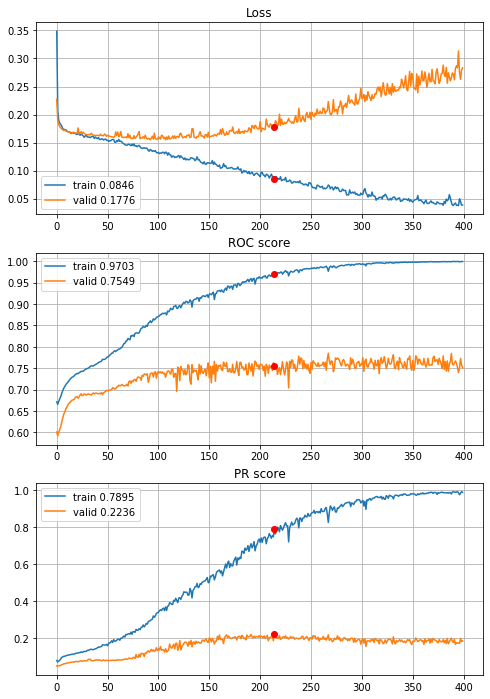


Fold 2------------------------------------------------------------


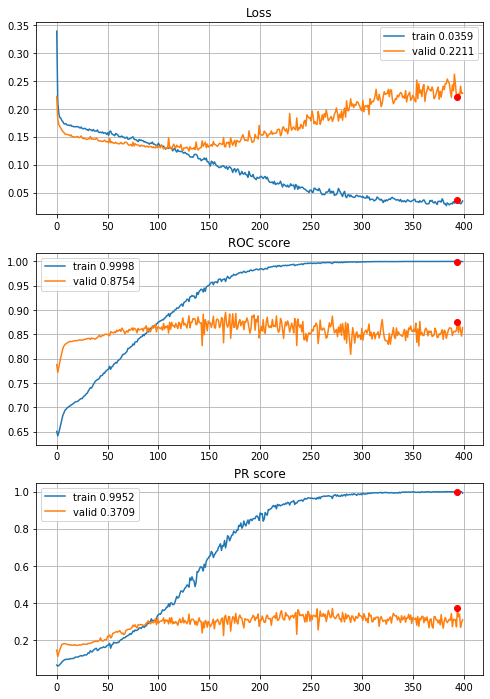


Fold 3------------------------------------------------------------


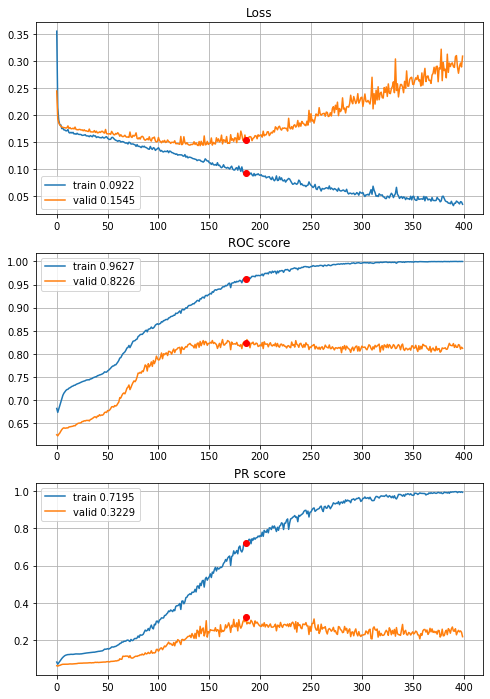


Fold 4------------------------------------------------------------


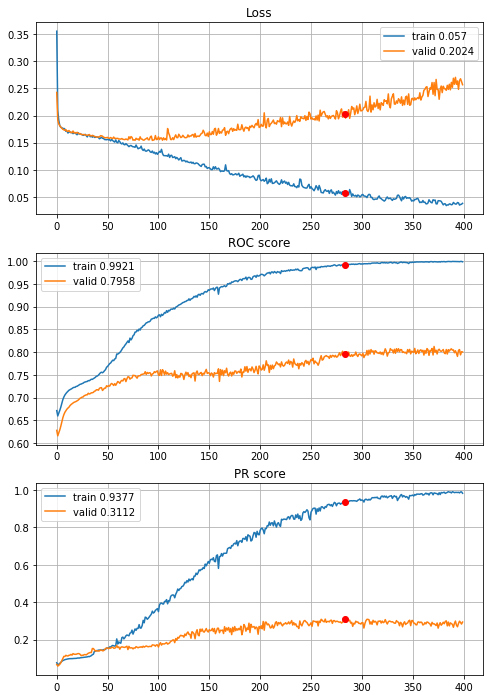


Fold 5------------------------------------------------------------


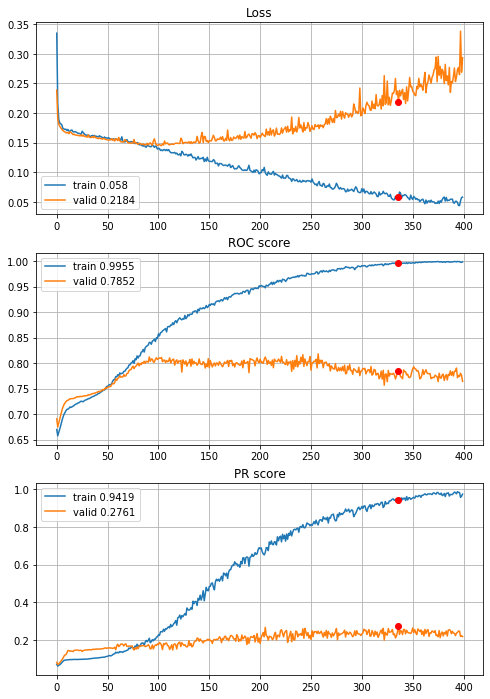


Fold 6------------------------------------------------------------


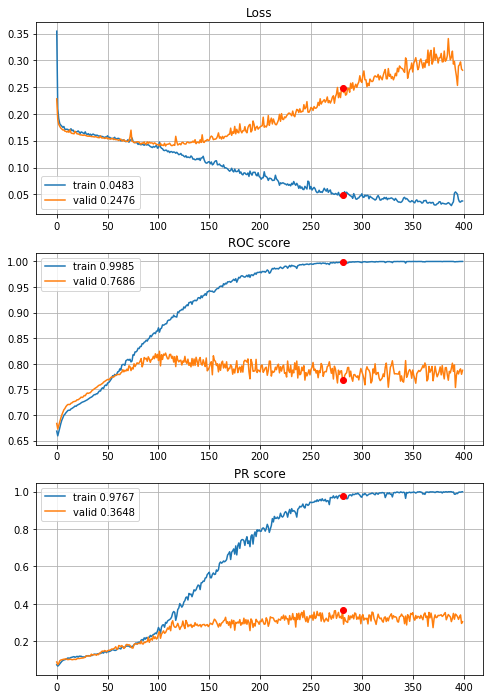

In [50]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\1year\define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

3 year horizon model is the worst among considered in terms of learning curves, so the results may not be that good on the test set when early stopping is not appied. 1 year horizon model is outperformed by the 2 year one. 4 year horizon model achived a bit better results than the 2 year one, but with much higher overfitting. Lets try 4 year horizon model with bigger dropout rate on second dense layer.

In [51]:
def define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_04(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.0001))(flat)                            # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)                          # (128,)
    dense = layers.Dropout(rate=0.4)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 5.34s train loss: 0.3539426910074205, validation loss: 0.2270098136034591
Epoch: 2/400,
cumulative time: 6.34s train loss: 0.21043683728751014, validation loss: 0.1894598458195547
Epoch: 3/400,
cumulative time: 7.4s train loss: 0.1932926830349656, validation loss: 0.18215381827707308
Epoch: 4/400,
cumulative time: 8.43s train loss: 0.18597940868455953, validation loss: 0.17834140651592492
Epoch: 5/400,
cumulative time: 9.56s train loss: 0.18475134048674546, validation loss: 0.1761147181947046
Epoch: 6/400,
cumulative time: 10.67s train loss: 0.1811041429723689, validation loss: 0.17419690722193165
Epoch: 7/400,
cumulative time: 11.76s train loss: 0.17773236359771785, validation loss: 0.17279749882515286
Epoch: 8/400,
cumulative time: 12.87s train loss: 0.1774428377765632, validation loss: 0.17162105262958122
Epoch: 9/400,
cumulative time: 13.93s train loss: 0.1750596618855927, 

Epoch: 77/400,
cumulative time: 88.95s train loss: 0.14688006887173516, validation loss: 0.15930128289807227
Epoch: 78/400,
cumulative time: 89.95s train loss: 0.14266350621346957, validation loss: 0.15665546099194086
Epoch: 79/400,
cumulative time: 90.94s train loss: 0.14467675961285434, validation loss: 0.1597963591058521
Epoch: 80/400,
cumulative time: 91.94s train loss: 0.1422418142405588, validation loss: 0.1617995891896778
Epoch: 81/400,
cumulative time: 93.01s train loss: 0.14436087668846861, validation loss: 0.16392670300359743
Epoch: 82/400,
cumulative time: 94.2s train loss: 0.1433997744514096, validation loss: 0.16956420265406766
Epoch: 83/400,
cumulative time: 95.28s train loss: 0.14267752584232551, validation loss: 0.15646102382630053
Epoch: 84/400,
cumulative time: 96.52s train loss: 0.14101975832198105, validation loss: 0.15920420678109778
Epoch: 85/400,
cumulative time: 97.84s train loss: 0.13996742139278825, validation loss: 0.15926902858536882
Epoch: 86/400,
cumulativ

Epoch: 152/400,
cumulative time: 168.98s train loss: 0.10857974162759998, validation loss: 0.16633378981526029
Epoch: 153/400,
cumulative time: 170.04s train loss: 0.108915161277809, validation loss: 0.16652147717901153
Epoch: 154/400,
cumulative time: 171.1s train loss: 0.11568587809179041, validation loss: 0.1668827467557375
Epoch: 155/400,
cumulative time: 172.15s train loss: 0.11045699272255291, validation loss: 0.17109318037978613
Epoch: 156/400,
cumulative time: 173.23s train loss: 0.11038758572353584, validation loss: 0.16750880897723747
Epoch: 157/400,
cumulative time: 174.29s train loss: 0.10991684950506439, validation loss: 0.17384107179049071
Epoch: 158/400,
cumulative time: 175.34s train loss: 0.10829183505088147, validation loss: 0.16605736637590507
Epoch: 159/400,
cumulative time: 176.41s train loss: 0.106520209850238, validation loss: 0.17088068012268312
Epoch: 160/400,
cumulative time: 177.49s train loss: 0.1066311006641026, validation loss: 0.17514462593723745
Epoch: 1

Epoch: 227/400,
cumulative time: 248.67s train loss: 0.07816796487151333, validation loss: 0.1862878113758858
Epoch: 228/400,
cumulative time: 249.74s train loss: 0.07660782593647036, validation loss: 0.19400114748464364
Epoch: 229/400,
cumulative time: 250.8s train loss: 0.07722890294197615, validation loss: 0.19089589854684683
Epoch: 230/400,
cumulative time: 251.86s train loss: 0.08038289602810562, validation loss: 0.20256405415639026
Epoch: 231/400,
cumulative time: 252.92s train loss: 0.07452198719107449, validation loss: 0.19075545563982832
Epoch: 232/400,
cumulative time: 254.01s train loss: 0.0746795797003062, validation loss: 0.1916624622620939
Epoch: 233/400,
cumulative time: 255.08s train loss: 0.0723694652545158, validation loss: 0.19103930867939792
Epoch: 234/400,
cumulative time: 256.15s train loss: 0.075365240128262, validation loss: 0.19574511984267767
Epoch: 235/400,
cumulative time: 257.27s train loss: 0.0755556136680735, validation loss: 0.1919854977777832
Epoch: 236

Epoch: 302/400,
cumulative time: 329.45s train loss: 0.05581315148911621, validation loss: 0.25035061312581375
Epoch: 303/400,
cumulative time: 330.52s train loss: 0.05560159775971009, validation loss: 0.27273862883872735
Epoch: 304/400,
cumulative time: 331.59s train loss: 0.055133180658154514, validation loss: 0.23229649069187086
Epoch: 305/400,
cumulative time: 332.7s train loss: 0.057009919857221036, validation loss: 0.23610762488344364
Epoch: 306/400,
cumulative time: 333.76s train loss: 0.05492058518913484, validation loss: 0.25293710468729264
Epoch: 307/400,
cumulative time: 334.84s train loss: 0.05220381763730149, validation loss: 0.2605586224421152
Epoch: 308/400,
cumulative time: 335.9s train loss: 0.04894059601980323, validation loss: 0.25674340225035147
Epoch: 309/400,
cumulative time: 336.98s train loss: 0.05021479001279348, validation loss: 0.25224481899100415
Epoch: 310/400,
cumulative time: 338.06s train loss: 0.04979671214970511, validation loss: 0.24237470091294067
Ep

Epoch: 377/400,
cumulative time: 410.06s train loss: 0.04104941106371341, validation loss: 0.2906960623596832
Epoch: 378/400,
cumulative time: 411.13s train loss: 0.041567506990351305, validation loss: 0.288468496736132
Epoch: 379/400,
cumulative time: 412.19s train loss: 0.042172642678474793, validation loss: 0.2938473863947776
Epoch: 380/400,
cumulative time: 413.24s train loss: 0.04375774289218027, validation loss: 0.3145804037631576
Epoch: 381/400,
cumulative time: 414.31s train loss: 0.037499969666099184, validation loss: 0.3204352231925986
Epoch: 382/400,
cumulative time: 415.37s train loss: 0.039631376556868346, validation loss: 0.30795792771584624
Epoch: 383/400,
cumulative time: 416.42s train loss: 0.03887587280650632, validation loss: 0.2967592316911162
Epoch: 384/400,
cumulative time: 417.48s train loss: 0.04579209878941754, validation loss: 0.33385443727024594
Epoch: 385/400,
cumulative time: 418.53s train loss: 0.043136578173406666, validation loss: 0.3012518229023103
Epoc

Epoch: 50/400,
cumulative time: 60.19s train loss: 0.1580516471865055, validation loss: 0.14260580649412108
Epoch: 51/400,
cumulative time: 61.31s train loss: 0.15875625041449545, validation loss: 0.14349566148399628
Epoch: 52/400,
cumulative time: 62.43s train loss: 0.15571863171724035, validation loss: 0.13939738219897255
Epoch: 53/400,
cumulative time: 63.58s train loss: 0.1614135502581352, validation loss: 0.1428402975851942
Epoch: 54/400,
cumulative time: 64.7s train loss: 0.16188735495086412, validation loss: 0.14289637925050291
Epoch: 55/400,
cumulative time: 65.82s train loss: 0.156529107817097, validation loss: 0.13932694542792537
Epoch: 56/400,
cumulative time: 66.96s train loss: 0.15620149467599911, validation loss: 0.13883339796052713
Epoch: 57/400,
cumulative time: 68.07s train loss: 0.15527713219060843, validation loss: 0.13992977651292052
Epoch: 58/400,
cumulative time: 69.17s train loss: 0.15526000778747465, validation loss: 0.13805668188905806
Epoch: 59/400,
cumulative

Epoch: 126/400,
cumulative time: 143.32s train loss: 0.12533308075885846, validation loss: 0.13182503922331718
Epoch: 127/400,
cumulative time: 144.35s train loss: 0.1266898423320202, validation loss: 0.12947322889116275
Epoch: 128/400,
cumulative time: 145.39s train loss: 0.12436451445946883, validation loss: 0.13168061603800849
Epoch: 129/400,
cumulative time: 146.48s train loss: 0.1251443334418637, validation loss: 0.13312852820929358
Epoch: 130/400,
cumulative time: 147.62s train loss: 0.12426517641691374, validation loss: 0.13503004101580415
Epoch: 131/400,
cumulative time: 148.81s train loss: 0.12361535376231177, validation loss: 0.12645283601541898
Epoch: 132/400,
cumulative time: 150.06s train loss: 0.12107524371067985, validation loss: 0.1361599640896017
Epoch: 133/400,
cumulative time: 151.31s train loss: 0.1187452179713765, validation loss: 0.12804528646722466
Epoch: 134/400,
cumulative time: 152.52s train loss: 0.11994115934482788, validation loss: 0.13356801867485046
Epoch

Epoch: 201/400,
cumulative time: 227.7s train loss: 0.0906202906152442, validation loss: 0.1450692703364244
Epoch: 202/400,
cumulative time: 228.83s train loss: 0.09252416778787037, validation loss: 0.15317756101573893
Epoch: 203/400,
cumulative time: 229.93s train loss: 0.08813586648150684, validation loss: 0.15042950792602164
Epoch: 204/400,
cumulative time: 231.07s train loss: 0.08793176436333774, validation loss: 0.15531269281367424
Epoch: 205/400,
cumulative time: 232.17s train loss: 0.08428231870907534, validation loss: 0.1640829108584764
Epoch: 206/400,
cumulative time: 233.28s train loss: 0.09060052763635339, validation loss: 0.15526821836122298
Epoch: 207/400,
cumulative time: 234.39s train loss: 0.0834491506430976, validation loss: 0.16765793072204663
Epoch: 208/400,
cumulative time: 235.53s train loss: 0.08645556533472362, validation loss: 0.14649650106733167
Epoch: 209/400,
cumulative time: 236.66s train loss: 0.08428809701321925, validation loss: 0.1504144047367505
Epoch: 

Epoch: 276/400,
cumulative time: 309.95s train loss: 0.050541250895447254, validation loss: 0.2058934837692829
Epoch: 277/400,
cumulative time: 311.04s train loss: 0.051598233012818295, validation loss: 0.18754431695820484
Epoch: 278/400,
cumulative time: 312.12s train loss: 0.060022186371983796, validation loss: 0.20152918296023156
Epoch: 279/400,
cumulative time: 313.21s train loss: 0.05757229698139757, validation loss: 0.22832156474608398
Epoch: 280/400,
cumulative time: 314.28s train loss: 0.05516397917406383, validation loss: 0.1900154637204628
Epoch: 281/400,
cumulative time: 315.36s train loss: 0.053432079087907494, validation loss: 0.20494097544753348
Epoch: 282/400,
cumulative time: 316.44s train loss: 0.053692781337072094, validation loss: 0.19869072155662912
Epoch: 283/400,
cumulative time: 317.52s train loss: 0.052677952785193355, validation loss: 0.21107425991679052
Epoch: 284/400,
cumulative time: 318.59s train loss: 0.0501487581423383, validation loss: 0.1927173049728151

Epoch: 350/400,
cumulative time: 387.69s train loss: 0.03735905917576979, validation loss: 0.24524615111228865
Epoch: 351/400,
cumulative time: 388.71s train loss: 0.03534153283801658, validation loss: 0.25018392531537015
Epoch: 352/400,
cumulative time: 389.73s train loss: 0.03651481595604311, validation loss: 0.2567109011495362
Epoch: 353/400,
cumulative time: 390.77s train loss: 0.03445406575710203, validation loss: 0.2583467548949895
Epoch: 354/400,
cumulative time: 391.81s train loss: 0.033193685234554356, validation loss: 0.2494776963735215
Epoch: 355/400,
cumulative time: 392.84s train loss: 0.03486839689922287, validation loss: 0.26480507287965555
Epoch: 356/400,
cumulative time: 393.89s train loss: 0.034207023649814004, validation loss: 0.2496453284708327
Epoch: 357/400,
cumulative time: 394.92s train loss: 0.03475531956615665, validation loss: 0.2607835006725177
Epoch: 358/400,
cumulative time: 395.95s train loss: 0.03269119197591093, validation loss: 0.2632093853979907
Epoch

Epoch: 23/400,
cumulative time: 29.08s train loss: 0.1644768789269214, validation loss: 0.17328423660326275
Epoch: 24/400,
cumulative time: 30.15s train loss: 0.16599185535192942, validation loss: 0.1736047927862779
Epoch: 25/400,
cumulative time: 31.22s train loss: 0.16357605962305413, validation loss: 0.17227357032176893
Epoch: 26/400,
cumulative time: 32.28s train loss: 0.1637734366803513, validation loss: 0.172671474247775
Epoch: 27/400,
cumulative time: 33.35s train loss: 0.16516283168625334, validation loss: 0.17065110152315144
Epoch: 28/400,
cumulative time: 34.4s train loss: 0.16385413419872352, validation loss: 0.17183971608612525
Epoch: 29/400,
cumulative time: 35.44s train loss: 0.16301456299916164, validation loss: 0.17052183556149536
Epoch: 30/400,
cumulative time: 36.5s train loss: 0.16249528910109395, validation loss: 0.1704544772233185
Epoch: 31/400,
cumulative time: 37.54s train loss: 0.1617451013717977, validation loss: 0.16976806218868415
Epoch: 32/400,
cumulative ti

Epoch: 99/400,
cumulative time: 109.86s train loss: 0.13774579415624463, validation loss: 0.14995978659538436
Epoch: 100/400,
cumulative time: 110.91s train loss: 0.13702590938593903, validation loss: 0.1518523777628307
Epoch: 101/400,
cumulative time: 111.98s train loss: 0.13964021833334295, validation loss: 0.1559838220279176
Epoch: 102/400,
cumulative time: 113.04s train loss: 0.13526902304824434, validation loss: 0.15203145564846568
Epoch: 103/400,
cumulative time: 114.1s train loss: 0.132984885344356, validation loss: 0.15111930370048057
Epoch: 104/400,
cumulative time: 115.16s train loss: 0.1346572363088208, validation loss: 0.14837302280275375
Epoch: 105/400,
cumulative time: 116.2s train loss: 0.13355481119038257, validation loss: 0.15225682137587038
Epoch: 106/400,
cumulative time: 117.25s train loss: 0.13134819217436228, validation loss: 0.14958233454139228
Epoch: 107/400,
cumulative time: 118.3s train loss: 0.13177783507323582, validation loss: 0.1519709836684549
Epoch: 108/

Epoch: 174/400,
cumulative time: 188.82s train loss: 0.10048890258883615, validation loss: 0.16155643003375977
Epoch: 175/400,
cumulative time: 189.87s train loss: 0.0989774284117362, validation loss: 0.15740884293358512
Epoch: 176/400,
cumulative time: 190.91s train loss: 0.09732159028073642, validation loss: 0.16197185075543186
Epoch: 177/400,
cumulative time: 191.98s train loss: 0.10594939886392633, validation loss: 0.1521470285457271
Epoch: 178/400,
cumulative time: 193.02s train loss: 0.10302559122358373, validation loss: 0.15719567196871342
Epoch: 179/400,
cumulative time: 194.08s train loss: 0.09811173761563917, validation loss: 0.15915045781198897
Epoch: 180/400,
cumulative time: 195.12s train loss: 0.10079573653991807, validation loss: 0.16197626449634273
Epoch: 181/400,
cumulative time: 196.16s train loss: 0.10013995991712277, validation loss: 0.15596914798926131
Epoch: 182/400,
cumulative time: 197.22s train loss: 0.09705680982833569, validation loss: 0.16500642573358437
Epo

Epoch: 249/400,
cumulative time: 268.11s train loss: 0.07361473804463471, validation loss: 0.2051710844096468
Epoch: 250/400,
cumulative time: 269.17s train loss: 0.07251821041135453, validation loss: 0.1987206942810053
Epoch: 251/400,
cumulative time: 270.23s train loss: 0.06805991665292284, validation loss: 0.20624229235599345
Epoch: 252/400,
cumulative time: 271.29s train loss: 0.0681535308710538, validation loss: 0.2068981396518577
Epoch: 253/400,
cumulative time: 272.34s train loss: 0.06578533535635901, validation loss: 0.19969556750676665
Epoch: 254/400,
cumulative time: 273.4s train loss: 0.06639256431266977, validation loss: 0.1992351239586012
Epoch: 255/400,
cumulative time: 274.44s train loss: 0.06551612177457257, validation loss: 0.20018661659797635
Epoch: 256/400,
cumulative time: 275.49s train loss: 0.0668717204577217, validation loss: 0.20312055217303632
Epoch: 257/400,
cumulative time: 276.56s train loss: 0.06541370646833695, validation loss: 0.20757089286646763
Epoch: 2

Epoch: 324/400,
cumulative time: 347.68s train loss: 0.044066417425079184, validation loss: 0.27434994744055635
Epoch: 325/400,
cumulative time: 348.74s train loss: 0.04827366990851949, validation loss: 0.2638071915824002
Epoch: 326/400,
cumulative time: 349.8s train loss: 0.04853156694198695, validation loss: 0.25381211137692433
Epoch: 327/400,
cumulative time: 350.87s train loss: 0.05014608552294166, validation loss: 0.26679222226369087
Epoch: 328/400,
cumulative time: 351.94s train loss: 0.044187249951559406, validation loss: 0.2526814483346478
Epoch: 329/400,
cumulative time: 352.99s train loss: 0.04894613584033452, validation loss: 0.2612972597978599
Epoch: 330/400,
cumulative time: 354.04s train loss: 0.04753480440383844, validation loss: 0.2534431793516682
Epoch: 331/400,
cumulative time: 355.09s train loss: 0.05100745318962908, validation loss: 0.27539405076847584
Epoch: 332/400,
cumulative time: 356.13s train loss: 0.050581248184450436, validation loss: 0.26887416606327164
Epo

Epoch: 399/400,
cumulative time: 427.07s train loss: 0.03822028891411407, validation loss: 0.3059200893882556
Epoch: 400/400,
cumulative time: 428.13s train loss: 0.03881136271006921, validation loss: 0.32018903160796447

Early stopping results:
best results in epoch: 235, 
best valid PR: 0.2902334673469431, 
valid ROC: 0.8128476151493993        
overfitting PR: 0.571998110524781, 
overfitting ROC: 0.17017592847927698

----------
Fold: 4
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 5.74s train loss: 0.33972133774402247, validation loss: 0.2436271451229841
Epoch: 2/400,
cumulative time: 6.87s train loss: 0.20829428552563323, validation loss: 0.1918993501215325
Epoch: 3/400,
cumulative time: 8.04s train loss: 0.19450320888176362, validation loss: 0.18482833470180773
Epoch: 4/400,
cumulative time: 9.16s train loss: 0.18357668329574578, validation loss: 0.18086315411544163
Epoch: 5/400,
cumulative time: 10.28s train loss: 0.18285018377557424, va

Epoch: 72/400,
cumulative time: 84.88s train loss: 0.1428805758678257, validation loss: 0.16166819914807856
Epoch: 73/400,
cumulative time: 85.99s train loss: 0.14416785757614042, validation loss: 0.15747305185337898
Epoch: 74/400,
cumulative time: 87.09s train loss: 0.1437091917845737, validation loss: 0.16176344284635794
Epoch: 75/400,
cumulative time: 88.19s train loss: 0.14189274282790226, validation loss: 0.15982285402079008
Epoch: 76/400,
cumulative time: 89.3s train loss: 0.1415233114610587, validation loss: 0.1557680251080352
Epoch: 77/400,
cumulative time: 90.41s train loss: 0.1409843365172281, validation loss: 0.15680494059082226
Epoch: 78/400,
cumulative time: 91.51s train loss: 0.14035344613571094, validation loss: 0.15551220183128198
Epoch: 79/400,
cumulative time: 92.62s train loss: 0.14460726681198974, validation loss: 0.15797729216219125
Epoch: 80/400,
cumulative time: 93.73s train loss: 0.14023386023698314, validation loss: 0.1566970454391085
Epoch: 81/400,
cumulative 

Epoch: 147/400,
cumulative time: 168.52s train loss: 0.10660394988883379, validation loss: 0.16865171376170424
Epoch: 148/400,
cumulative time: 169.62s train loss: 0.10902434314903317, validation loss: 0.16830155041344477
Epoch: 149/400,
cumulative time: 170.73s train loss: 0.10462707521736735, validation loss: 0.17210539943579253
Epoch: 150/400,
cumulative time: 171.85s train loss: 0.10710294341113581, validation loss: 0.16838640596653975
Epoch: 151/400,
cumulative time: 172.94s train loss: 0.10757016615069116, validation loss: 0.17641623289919894
Epoch: 152/400,
cumulative time: 174.06s train loss: 0.10461342947476276, validation loss: 0.1717013573623925
Epoch: 153/400,
cumulative time: 175.15s train loss: 0.10369372665033848, validation loss: 0.1710139108676838
Epoch: 154/400,
cumulative time: 176.25s train loss: 0.10437446392973641, validation loss: 0.18118427583569593
Epoch: 155/400,
cumulative time: 177.36s train loss: 0.10826545531880924, validation loss: 0.17022918798100112
Epo

Epoch: 222/400,
cumulative time: 251.3s train loss: 0.08112373826371425, validation loss: 0.1962512046720769
Epoch: 223/400,
cumulative time: 252.38s train loss: 0.08452896149634637, validation loss: 0.20889211815041428
Epoch: 224/400,
cumulative time: 253.5s train loss: 0.0850380243157413, validation loss: 0.19476508033908974
Epoch: 225/400,
cumulative time: 254.61s train loss: 0.07976213706201349, validation loss: 0.1925933564919448
Epoch: 226/400,
cumulative time: 255.71s train loss: 0.07422401987482746, validation loss: 0.19922513485067936
Epoch: 227/400,
cumulative time: 256.83s train loss: 0.076074913955617, validation loss: 0.1952655166387558
Epoch: 228/400,
cumulative time: 257.99s train loss: 0.0770683233012963, validation loss: 0.20582451562501447
Epoch: 229/400,
cumulative time: 259.14s train loss: 0.0810269746370967, validation loss: 0.2043067974372426
Epoch: 230/400,
cumulative time: 260.32s train loss: 0.07310603230173719, validation loss: 0.2045822326214083
Epoch: 231/40

Epoch: 297/400,
cumulative time: 334.54s train loss: 0.05623650770259763, validation loss: 0.22244796909010162
Epoch: 298/400,
cumulative time: 335.65s train loss: 0.05760224394259914, validation loss: 0.21912476213991755
Epoch: 299/400,
cumulative time: 336.75s train loss: 0.051316823189692884, validation loss: 0.24898543673968632
Epoch: 300/400,
cumulative time: 337.85s train loss: 0.05688160075832589, validation loss: 0.21568742400102417
Epoch: 301/400,
cumulative time: 338.95s train loss: 0.06187039805007162, validation loss: 0.22290762085502921
Epoch: 302/400,
cumulative time: 340.05s train loss: 0.056877190076818504, validation loss: 0.21949207466060341
Epoch: 303/400,
cumulative time: 341.16s train loss: 0.05292753305293238, validation loss: 0.24021938754213829
Epoch: 304/400,
cumulative time: 342.25s train loss: 0.05367948106247967, validation loss: 0.22729694976186843
Epoch: 305/400,
cumulative time: 343.36s train loss: 0.04963245963151134, validation loss: 0.22908923965816932

Epoch: 371/400,
cumulative time: 416.64s train loss: 0.039057599679625236, validation loss: 0.28363241605898915
Epoch: 372/400,
cumulative time: 417.76s train loss: 0.041630217224444335, validation loss: 0.2747819320187397
Epoch: 373/400,
cumulative time: 418.87s train loss: 0.038868198079362766, validation loss: 0.2868356490384017
Epoch: 374/400,
cumulative time: 419.96s train loss: 0.04108232034253667, validation loss: 0.2840014206390453
Epoch: 375/400,
cumulative time: 421.07s train loss: 0.037736997406300606, validation loss: 0.2715285342660303
Epoch: 376/400,
cumulative time: 422.17s train loss: 0.038970571277094065, validation loss: 0.2756327281810301
Epoch: 377/400,
cumulative time: 423.26s train loss: 0.03820795065014706, validation loss: 0.2660785699987773
Epoch: 378/400,
cumulative time: 424.36s train loss: 0.040009156685230626, validation loss: 0.27296021968069745
Epoch: 379/400,
cumulative time: 425.46s train loss: 0.040950165222446655, validation loss: 0.2625637247281916
E

Epoch: 44/400,
cumulative time: 55.9s train loss: 0.16128096175600953, validation loss: 0.1564489907286425
Epoch: 45/400,
cumulative time: 57.07s train loss: 0.16175952065997604, validation loss: 0.15700333335028654
Epoch: 46/400,
cumulative time: 58.21s train loss: 0.16157253953774922, validation loss: 0.15573885909633348
Epoch: 47/400,
cumulative time: 59.38s train loss: 0.15835805019855048, validation loss: 0.15661493435756532
Epoch: 48/400,
cumulative time: 60.51s train loss: 0.16068856965828213, validation loss: 0.15585553575399025
Epoch: 49/400,
cumulative time: 61.66s train loss: 0.15736111734465358, validation loss: 0.1553630936304125
Epoch: 50/400,
cumulative time: 62.8s train loss: 0.15898471095191008, validation loss: 0.15463265129126452
Epoch: 51/400,
cumulative time: 63.96s train loss: 0.15729513803118772, validation loss: 0.15452160486912592
Epoch: 52/400,
cumulative time: 65.11s train loss: 0.16059962910029196, validation loss: 0.15418404074954806
Epoch: 53/400,
cumulati

Epoch: 120/400,
cumulative time: 145.51s train loss: 0.12985708252358935, validation loss: 0.1473729138525885
Epoch: 121/400,
cumulative time: 146.77s train loss: 0.12788134339412205, validation loss: 0.14697408653527103
Epoch: 122/400,
cumulative time: 147.97s train loss: 0.13086661327439422, validation loss: 0.14665539766285407
Epoch: 123/400,
cumulative time: 149.26s train loss: 0.12533341930079958, validation loss: 0.1590941746558365
Epoch: 124/400,
cumulative time: 150.58s train loss: 0.13678787203622272, validation loss: 0.150823923255506
Epoch: 125/400,
cumulative time: 151.97s train loss: 0.1311600201241884, validation loss: 0.14557125369896246
Epoch: 126/400,
cumulative time: 153.35s train loss: 0.12720627980395105, validation loss: 0.14907299858682296
Epoch: 127/400,
cumulative time: 154.71s train loss: 0.12819876430778848, validation loss: 0.14890098108059993
Epoch: 128/400,
cumulative time: 156.02s train loss: 0.1296978203123842, validation loss: 0.14920138826406432
Epoch: 

Epoch: 195/400,
cumulative time: 237.08s train loss: 0.09857269895936326, validation loss: 0.16905016119837535
Epoch: 196/400,
cumulative time: 238.23s train loss: 0.10190578310890035, validation loss: 0.1691345164174147
Epoch: 197/400,
cumulative time: 239.44s train loss: 0.10122054539889493, validation loss: 0.16649665696231872
Epoch: 198/400,
cumulative time: 240.62s train loss: 0.09921878182401693, validation loss: 0.1661747994583517
Epoch: 199/400,
cumulative time: 241.78s train loss: 0.1012269619717996, validation loss: 0.16526167448150592
Epoch: 200/400,
cumulative time: 242.95s train loss: 0.09789397230467263, validation loss: 0.16541647518043048
Epoch: 201/400,
cumulative time: 244.15s train loss: 0.0994163322861552, validation loss: 0.16330079208402073
Epoch: 202/400,
cumulative time: 245.3s train loss: 0.09872964706830327, validation loss: 0.1644741934945054
Epoch: 203/400,
cumulative time: 246.5s train loss: 0.10157776761665742, validation loss: 0.17383418301477377
Epoch: 2

Epoch: 270/400,
cumulative time: 326.04s train loss: 0.07049128847228509, validation loss: 0.20366607281243326
Epoch: 271/400,
cumulative time: 327.21s train loss: 0.0714968367294184, validation loss: 0.2017546803663985
Epoch: 272/400,
cumulative time: 328.35s train loss: 0.07156832335937408, validation loss: 0.20455524373439052
Epoch: 273/400,
cumulative time: 329.53s train loss: 0.06938542506641636, validation loss: 0.20148748467610955
Epoch: 274/400,
cumulative time: 330.72s train loss: 0.07165041143459884, validation loss: 0.20560794670057025
Epoch: 275/400,
cumulative time: 331.89s train loss: 0.0740440050638378, validation loss: 0.21672415193276343
Epoch: 276/400,
cumulative time: 333.05s train loss: 0.08026232978000361, validation loss: 0.2111986071097557
Epoch: 277/400,
cumulative time: 334.21s train loss: 0.07597890201765174, validation loss: 0.20005309505412883
Epoch: 278/400,
cumulative time: 335.36s train loss: 0.06960530578383232, validation loss: 0.20532614023794032
Epoch

Epoch: 345/400,
cumulative time: 413.53s train loss: 0.05885561574285804, validation loss: 0.24349503165404304
Epoch: 346/400,
cumulative time: 414.72s train loss: 0.0544815483112489, validation loss: 0.2375149975126111
Epoch: 347/400,
cumulative time: 415.89s train loss: 0.05067016009304962, validation loss: 0.24887601906818954
Epoch: 348/400,
cumulative time: 417.07s train loss: 0.05148161397345605, validation loss: 0.2783492735712533
Epoch: 349/400,
cumulative time: 418.22s train loss: 0.059245399626032, validation loss: 0.2639061122906502
Epoch: 350/400,
cumulative time: 419.38s train loss: 0.0509981779957745, validation loss: 0.26408330991553175
Epoch: 351/400,
cumulative time: 420.56s train loss: 0.047382345332620944, validation loss: 0.2567085460309059
Epoch: 352/400,
cumulative time: 421.78s train loss: 0.05060566821236312, validation loss: 0.26047723283690793
Epoch: 353/400,
cumulative time: 422.97s train loss: 0.05538933197393363, validation loss: 0.2717793432879041
Epoch: 35

Epoch: 18/400,
cumulative time: 27.82s train loss: 0.16989992278746455, validation loss: 0.16287581181503563
Epoch: 19/400,
cumulative time: 29.04s train loss: 0.1696570021179867, validation loss: 0.16728646134289663
Epoch: 20/400,
cumulative time: 30.23s train loss: 0.16869437425367295, validation loss: 0.1650719854422267
Epoch: 21/400,
cumulative time: 31.47s train loss: 0.16841474750010293, validation loss: 0.16290131691963441
Epoch: 22/400,
cumulative time: 32.69s train loss: 0.1687526135505716, validation loss: 0.1621122053158125
Epoch: 23/400,
cumulative time: 33.96s train loss: 0.16687606805529043, validation loss: 0.1616084916937736
Epoch: 24/400,
cumulative time: 35.17s train loss: 0.16449713227418614, validation loss: 0.16117987022567293
Epoch: 25/400,
cumulative time: 36.4s train loss: 0.16768494328975225, validation loss: 0.1611859720108405
Epoch: 26/400,
cumulative time: 37.75s train loss: 0.16757904795304196, validation loss: 0.1605138014401159
Epoch: 27/400,
cumulative t

Epoch: 94/400,
cumulative time: 122.49s train loss: 0.14061545567901582, validation loss: 0.1461334656888665
Epoch: 95/400,
cumulative time: 123.69s train loss: 0.13945597782872435, validation loss: 0.14637513239594066
Epoch: 96/400,
cumulative time: 124.95s train loss: 0.1425194206370122, validation loss: 0.1456110629710798
Epoch: 97/400,
cumulative time: 126.24s train loss: 0.13925587211716106, validation loss: 0.1486979626416029
Epoch: 98/400,
cumulative time: 127.47s train loss: 0.1408112588428682, validation loss: 0.14751544088634186
Epoch: 99/400,
cumulative time: 128.69s train loss: 0.14338929193408936, validation loss: 0.14530908415337893
Epoch: 100/400,
cumulative time: 129.9s train loss: 0.13865754173704523, validation loss: 0.1438473954344384
Epoch: 101/400,
cumulative time: 131.12s train loss: 0.13943188399133014, validation loss: 0.14422224594926925
Epoch: 102/400,
cumulative time: 132.31s train loss: 0.1518476704944922, validation loss: 0.14290046821961594
Epoch: 103/400,

Epoch: 169/400,
cumulative time: 216.14s train loss: 0.10347326354068868, validation loss: 0.1541894235748946
Epoch: 170/400,
cumulative time: 217.43s train loss: 0.10067437674843156, validation loss: 0.15500517165468586
Epoch: 171/400,
cumulative time: 218.73s train loss: 0.10095186165942187, validation loss: 0.15332679351547865
Epoch: 172/400,
cumulative time: 219.99s train loss: 0.10162905939700934, validation loss: 0.17453769188678242
Epoch: 173/400,
cumulative time: 221.25s train loss: 0.10815422329662873, validation loss: 0.15607096683198632
Epoch: 174/400,
cumulative time: 222.49s train loss: 0.09990055114313592, validation loss: 0.1570835013995813
Epoch: 175/400,
cumulative time: 223.71s train loss: 0.10091974661036958, validation loss: 0.15797191366298827
Epoch: 176/400,
cumulative time: 224.93s train loss: 0.10443613164169287, validation loss: 0.16406248020718628
Epoch: 177/400,
cumulative time: 226.13s train loss: 0.0979938352752682, validation loss: 0.16123598715046553
Epoc

Epoch: 244/400,
cumulative time: 311.74s train loss: 0.06479119327364656, validation loss: 0.2190553860940336
Epoch: 245/400,
cumulative time: 313.11s train loss: 0.07009211728027695, validation loss: 0.20591606236499446
Epoch: 246/400,
cumulative time: 314.41s train loss: 0.06843068066567352, validation loss: 0.20993449514912021
Epoch: 247/400,
cumulative time: 315.86s train loss: 0.06862190877576933, validation loss: 0.22903965495569203
Epoch: 248/400,
cumulative time: 317.14s train loss: 0.08366063631774126, validation loss: 0.19732740102954335
Epoch: 249/400,
cumulative time: 318.52s train loss: 0.08015952964633194, validation loss: 0.1967006980298366
Epoch: 250/400,
cumulative time: 319.95s train loss: 0.06794174292762772, validation loss: 0.20485234800620142
Epoch: 251/400,
cumulative time: 321.39s train loss: 0.06888319932956397, validation loss: 0.2109241434417142
Epoch: 252/400,
cumulative time: 322.84s train loss: 0.06575861759695881, validation loss: 0.2092198670419389
Epoch

Epoch: 319/400,
cumulative time: 407.5s train loss: 0.04476075350135508, validation loss: 0.2808426753167183
Epoch: 320/400,
cumulative time: 408.73s train loss: 0.04236889922358732, validation loss: 0.2805892941904249
Epoch: 321/400,
cumulative time: 409.93s train loss: 0.041697372317285875, validation loss: 0.27968731324631985
Epoch: 322/400,
cumulative time: 411.16s train loss: 0.0401127816476564, validation loss: 0.28016459240632896
Epoch: 323/400,
cumulative time: 412.38s train loss: 0.04240193114787397, validation loss: 0.29477764646287663
Epoch: 324/400,
cumulative time: 413.6s train loss: 0.04750167320162567, validation loss: 0.32119317143533443
Epoch: 325/400,
cumulative time: 414.83s train loss: 0.04980030893516043, validation loss: 0.27947188950580254
Epoch: 326/400,
cumulative time: 416.06s train loss: 0.04177998235657726, validation loss: 0.26783092772372535
Epoch: 327/400,
cumulative time: 417.29s train loss: 0.04094523384007828, validation loss: 0.28882087345819996
Epoch

Epoch: 394/400,
cumulative time: 501.57s train loss: 0.039977847123819014, validation loss: 0.2965351002153002
Epoch: 395/400,
cumulative time: 502.78s train loss: 0.039430092130231, validation loss: 0.3273829935397776
Epoch: 396/400,
cumulative time: 504.02s train loss: 0.040981429878912116, validation loss: 0.3158946781219522
Epoch: 397/400,
cumulative time: 505.26s train loss: 0.03448255041320817, validation loss: 0.34086723509730604
Epoch: 398/400,
cumulative time: 506.54s train loss: 0.034539243496205144, validation loss: 0.3229081022784651
Epoch: 399/400,
cumulative time: 507.77s train loss: 0.03611128256361105, validation loss: 0.3341245479330392
Epoch: 400/400,
cumulative time: 508.96s train loss: 0.0353742418538574, validation loss: 0.30294065460195124

Early stopping results:
best results in epoch: 211, 
best valid PR: 0.3607130731290717, 
valid ROC: 0.783894734307659        
overfitting PR: 0.41816110035102033, 
overfitting ROC: 0.19690054005042545

Cross validation time: 27

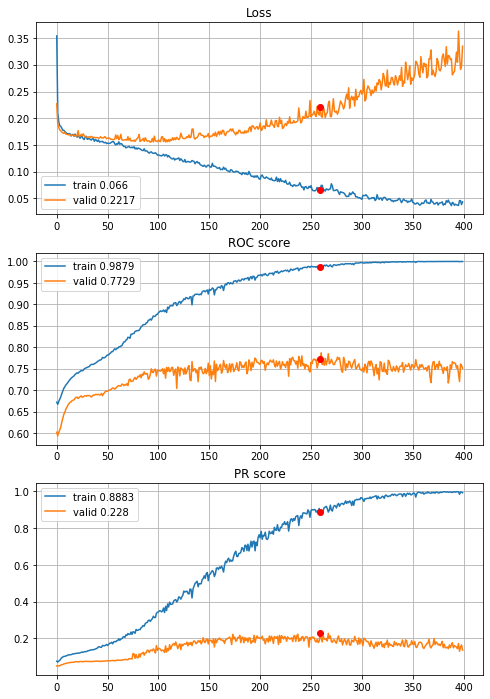


Fold 2------------------------------------------------------------


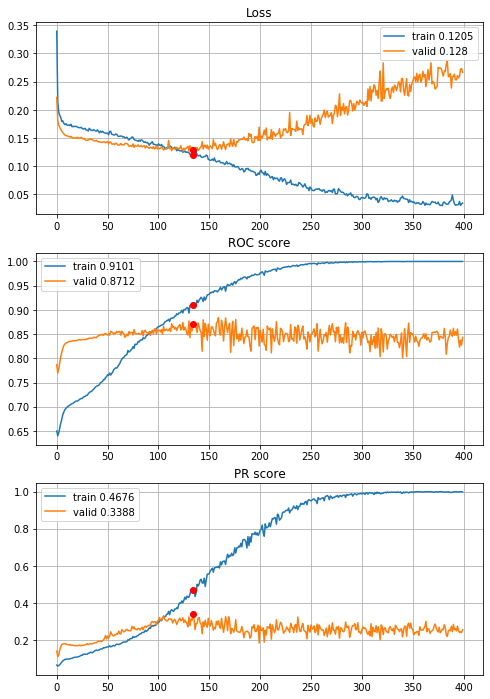


Fold 3------------------------------------------------------------


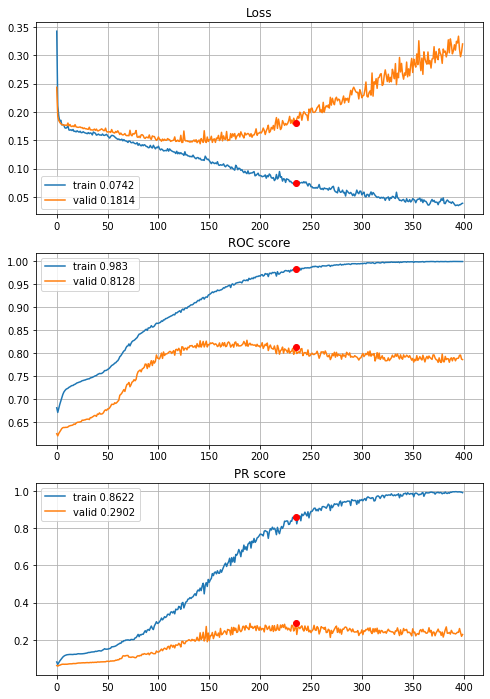


Fold 4------------------------------------------------------------


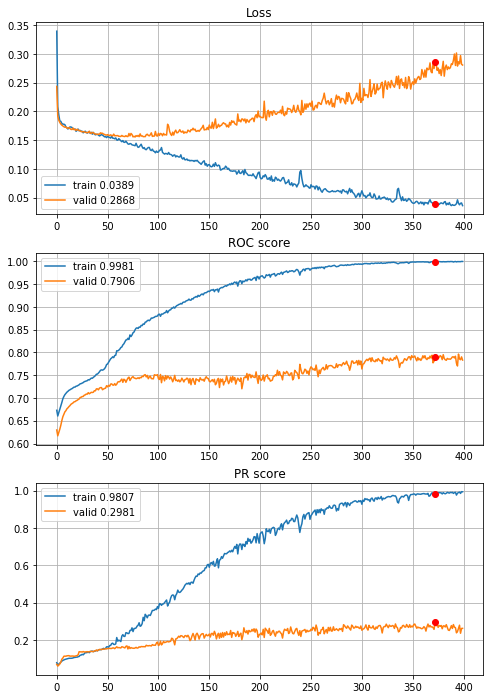


Fold 5------------------------------------------------------------


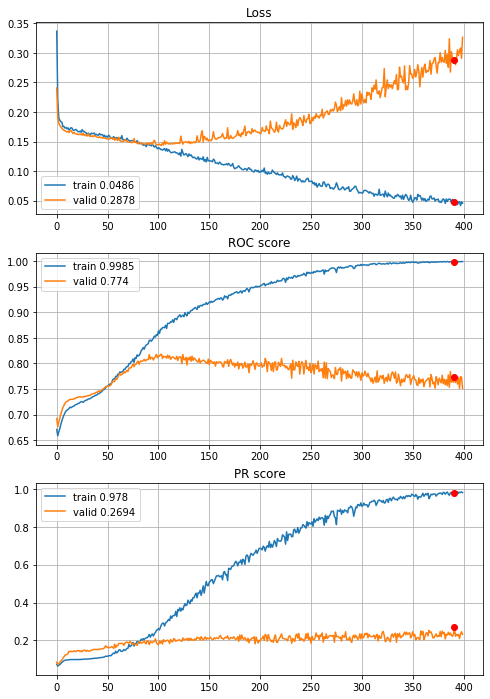


Fold 6------------------------------------------------------------


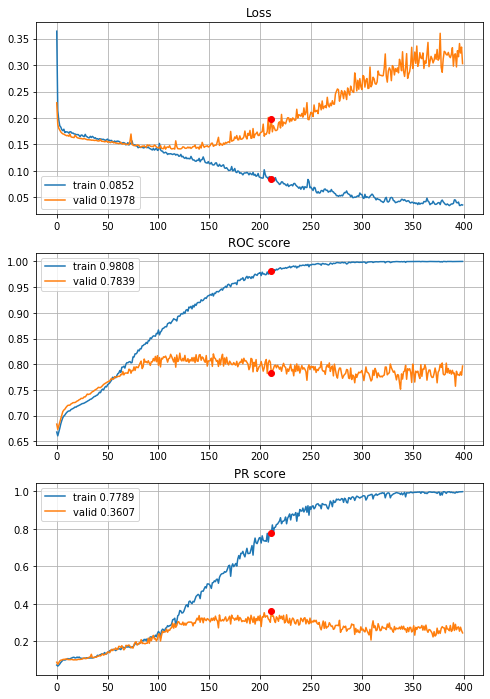

In [52]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_04, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\1year\define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_04_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Worse results.

Lets try 2 year horizon model but with bigger inceptions.

In [52]:
def define_deep_CNN_2inc_bigger_std_L2_drop_04(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=5, f2_in=1, f2_out=5, f3_in=1, f3_out=5, f4_out=5,
                                 random_state=random_state)                                             # (8,8,20)
    inception = inception_module(prev_layer=inception, f1=10, f2_in=4, f2_out=10, f3_in=4, f3_out=10,
                                 f4_out=10, random_state=random_state)                                  # (8,8,40)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,40)
    flat = layers.Flatten()(pool)                                                                       # (640,)
    dense = layers.Dense(units=320, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.00005))(flat)                           # (320,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (320,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 5.52s train loss: 0.2787150917995361, validation loss: 0.20905267541955952
Epoch: 2/400,
cumulative time: 6.95s train loss: 0.1887051399507378, validation loss: 0.17385940559109428
Epoch: 3/400,
cumulative time: 8.37s train loss: 0.17664405056036853, validation loss: 0.17152522323366812
Epoch: 4/400,
cumulative time: 9.76s train loss: 0.1705812212298898, validation loss: 0.17001024244858598
Epoch: 5/400,
cumulative time: 11.12s train loss: 0.16957786109800357, validation loss: 0.1680667867753266
Epoch: 6/400,
cumulative time: 12.52s train loss: 0.1673400061349941, validation loss: 0.16704643479560766
Epoch: 7/400,
cumulative time: 13.87s train loss: 0.16456085308340063, validation loss: 0.16619524619837187
Epoch: 8/400,
cumulative time: 15.22s train loss: 0.164914682668685, validation loss: 0.1656738747285937
Epoch: 9/400,
cumulative time: 16.63s train loss: 0.16484200244723507

Epoch: 76/400,
cumulative time: 108.9s train loss: 0.14510996525495737, validation loss: 0.15731293768878227
Epoch: 77/400,
cumulative time: 110.31s train loss: 0.14631574706685158, validation loss: 0.15737430191469826
Epoch: 78/400,
cumulative time: 111.65s train loss: 0.1429881822763177, validation loss: 0.1566487641216908
Epoch: 79/400,
cumulative time: 113.03s train loss: 0.14183741152512733, validation loss: 0.1573724457729021
Epoch: 80/400,
cumulative time: 114.49s train loss: 0.14245876737744803, validation loss: 0.15903991452317537
Epoch: 81/400,
cumulative time: 115.89s train loss: 0.14439886397835877, validation loss: 0.16111655389108964
Epoch: 82/400,
cumulative time: 117.3s train loss: 0.1448334675020692, validation loss: 0.16579541332129058
Epoch: 83/400,
cumulative time: 118.68s train loss: 0.14171420504856833, validation loss: 0.15645576572395592
Epoch: 84/400,
cumulative time: 120.01s train loss: 0.13883091545534768, validation loss: 0.15989151840191865
Epoch: 85/400,
c

Epoch: 151/400,
cumulative time: 214.26s train loss: 0.12212620252280353, validation loss: 0.1640373253222887
Epoch: 152/400,
cumulative time: 215.65s train loss: 0.12102912716440277, validation loss: 0.1615620222670756
Epoch: 153/400,
cumulative time: 217.13s train loss: 0.12019383842284584, validation loss: 0.16256164342334645
Epoch: 154/400,
cumulative time: 218.51s train loss: 0.12547734473077352, validation loss: 0.163448493835822
Epoch: 155/400,
cumulative time: 219.94s train loss: 0.1223154109558073, validation loss: 0.1644917417466075
Epoch: 156/400,
cumulative time: 221.34s train loss: 0.12129885099927207, validation loss: 0.1610956167699716
Epoch: 157/400,
cumulative time: 222.77s train loss: 0.12077647337311812, validation loss: 0.16413084274790546
Epoch: 158/400,
cumulative time: 224.19s train loss: 0.12084622060212058, validation loss: 0.16098249133895426
Epoch: 159/400,
cumulative time: 225.59s train loss: 0.12060434242579697, validation loss: 0.16268371636546314
Epoch: 1

Epoch: 226/400,
cumulative time: 320.66s train loss: 0.10315615069651286, validation loss: 0.18673481844521111
Epoch: 227/400,
cumulative time: 322.05s train loss: 0.102216061955385, validation loss: 0.17762080191208696
Epoch: 228/400,
cumulative time: 323.51s train loss: 0.10159980754811579, validation loss: 0.18279059183213017
Epoch: 229/400,
cumulative time: 324.92s train loss: 0.10244662579594346, validation loss: 0.17961539650438407
Epoch: 230/400,
cumulative time: 326.36s train loss: 0.09978004978435995, validation loss: 0.18419273347510784
Epoch: 231/400,
cumulative time: 327.76s train loss: 0.1011374661744885, validation loss: 0.17953339538605886
Epoch: 232/400,
cumulative time: 329.21s train loss: 0.09906470746197782, validation loss: 0.17761055740617937
Epoch: 233/400,
cumulative time: 330.59s train loss: 0.1032102979762052, validation loss: 0.1776521471408558
Epoch: 234/400,
cumulative time: 331.99s train loss: 0.10034686975053864, validation loss: 0.18158219217462376
Epoch:

Epoch: 301/400,
cumulative time: 424.5s train loss: 0.07896966624587944, validation loss: 0.1973681607949892
Epoch: 302/400,
cumulative time: 425.89s train loss: 0.07861685794433561, validation loss: 0.21427000694302048
Epoch: 303/400,
cumulative time: 427.17s train loss: 0.08087574326392595, validation loss: 0.2076037473821097
Epoch: 304/400,
cumulative time: 428.58s train loss: 0.08525585343308421, validation loss: 0.19057814737311804
Epoch: 305/400,
cumulative time: 429.97s train loss: 0.08260320423902551, validation loss: 0.21311301555647116
Epoch: 306/400,
cumulative time: 431.3s train loss: 0.08063045852946601, validation loss: 0.2109565661912625
Epoch: 307/400,
cumulative time: 432.74s train loss: 0.0774996025696312, validation loss: 0.21484328710263775
Epoch: 308/400,
cumulative time: 434.05s train loss: 0.0761848969296667, validation loss: 0.2122487660490358
Epoch: 309/400,
cumulative time: 435.37s train loss: 0.07485844468878161, validation loss: 0.206651490259442
Epoch: 310/

Epoch: 376/400,
cumulative time: 528.26s train loss: 0.06052214371666058, validation loss: 0.24141209197903946
Epoch: 377/400,
cumulative time: 529.55s train loss: 0.06163338899499325, validation loss: 0.2216266386027128
Epoch: 378/400,
cumulative time: 530.96s train loss: 0.05840015548088745, validation loss: 0.232530699905001
Epoch: 379/400,
cumulative time: 532.38s train loss: 0.05717600787896133, validation loss: 0.24556419821685813
Epoch: 380/400,
cumulative time: 533.79s train loss: 0.05654401969327194, validation loss: 0.23358577402199016
Epoch: 381/400,
cumulative time: 535.17s train loss: 0.06157818641619619, validation loss: 0.25010602736043297
Epoch: 382/400,
cumulative time: 536.56s train loss: 0.06075710648179507, validation loss: 0.22737720877328
Epoch: 383/400,
cumulative time: 537.9s train loss: 0.05660542633801529, validation loss: 0.23353569540398397
Epoch: 384/400,
cumulative time: 539.26s train loss: 0.058393855064937696, validation loss: 0.24219951480344307
Epoch: 

Epoch: 49/400,
cumulative time: 76.79s train loss: 0.1522574871835039, validation loss: 0.13924108753846764
Epoch: 50/400,
cumulative time: 78.22s train loss: 0.15202982757926214, validation loss: 0.1412910951099993
Epoch: 51/400,
cumulative time: 79.66s train loss: 0.15091404741810213, validation loss: 0.14182953004932042
Epoch: 52/400,
cumulative time: 81.07s train loss: 0.15065784181770384, validation loss: 0.13756439904107992
Epoch: 53/400,
cumulative time: 82.53s train loss: 0.1523782754504251, validation loss: 0.13984798525497175
Epoch: 54/400,
cumulative time: 84.04s train loss: 0.15261051153209224, validation loss: 0.1392065561473709
Epoch: 55/400,
cumulative time: 85.54s train loss: 0.15121283502913516, validation loss: 0.1381461627116918
Epoch: 56/400,
cumulative time: 86.94s train loss: 0.14957638256803182, validation loss: 0.13676650188792588
Epoch: 57/400,
cumulative time: 88.34s train loss: 0.14829142442294724, validation loss: 0.1382035646142272
Epoch: 58/400,
cumulative

Epoch: 124/400,
cumulative time: 185.19s train loss: 0.12631445911622816, validation loss: 0.12682861878591425
Epoch: 125/400,
cumulative time: 186.64s train loss: 0.1253637648369601, validation loss: 0.1281300764495553
Epoch: 126/400,
cumulative time: 188.14s train loss: 0.12631741907214303, validation loss: 0.12869169547503542
Epoch: 127/400,
cumulative time: 189.57s train loss: 0.12584204994410672, validation loss: 0.12719083530739997
Epoch: 128/400,
cumulative time: 191.02s train loss: 0.12341047646142048, validation loss: 0.128218317450337
Epoch: 129/400,
cumulative time: 192.44s train loss: 0.12410737254305175, validation loss: 0.12879458771032445
Epoch: 130/400,
cumulative time: 193.86s train loss: 0.12279562420252378, validation loss: 0.12951949312293326
Epoch: 131/400,
cumulative time: 195.28s train loss: 0.12442508831874695, validation loss: 0.126711470479644
Epoch: 132/400,
cumulative time: 196.81s train loss: 0.12243161602140151, validation loss: 0.1335001871470482
Epoch: 1

Epoch: 199/400,
cumulative time: 296.41s train loss: 0.09967217795423584, validation loss: 0.13846124660584233
Epoch: 200/400,
cumulative time: 297.88s train loss: 0.09645955657738436, validation loss: 0.16190917781453432
Epoch: 201/400,
cumulative time: 299.34s train loss: 0.10460897592767593, validation loss: 0.1428570868111652
Epoch: 202/400,
cumulative time: 300.83s train loss: 0.10209803645281683, validation loss: 0.14208734750860783
Epoch: 203/400,
cumulative time: 302.31s train loss: 0.09916635077354805, validation loss: 0.1428248075877919
Epoch: 204/400,
cumulative time: 303.82s train loss: 0.09803842212828107, validation loss: 0.14488094335375973
Epoch: 205/400,
cumulative time: 305.31s train loss: 0.09986821650553926, validation loss: 0.1518349712838258
Epoch: 206/400,
cumulative time: 306.78s train loss: 0.09926019763358404, validation loss: 0.14403328613379876
Epoch: 207/400,
cumulative time: 308.31s train loss: 0.0974980337965873, validation loss: 0.14499905482075925
Epoch

Epoch: 274/400,
cumulative time: 405.97s train loss: 0.07470486106693858, validation loss: 0.15758999922017672
Epoch: 275/400,
cumulative time: 407.47s train loss: 0.07161220667399537, validation loss: 0.17325336804199942
Epoch: 276/400,
cumulative time: 408.98s train loss: 0.07119785607059043, validation loss: 0.16652752360085157
Epoch: 277/400,
cumulative time: 410.52s train loss: 0.07394068935281638, validation loss: 0.16018953396314914
Epoch: 278/400,
cumulative time: 412.0s train loss: 0.07769934151187341, validation loss: 0.1815896896359138
Epoch: 279/400,
cumulative time: 413.51s train loss: 0.08183394470296278, validation loss: 0.16159916237929742
Epoch: 280/400,
cumulative time: 414.89s train loss: 0.0803001823105215, validation loss: 0.15660719341639098
Epoch: 281/400,
cumulative time: 416.29s train loss: 0.0766825087071596, validation loss: 0.1684419058927775
Epoch: 282/400,
cumulative time: 417.66s train loss: 0.07108593811996748, validation loss: 0.15944767068979637
Epoch:

Epoch: 349/400,
cumulative time: 515.49s train loss: 0.04989754287720405, validation loss: 0.19625476986678772
Epoch: 350/400,
cumulative time: 517.05s train loss: 0.05017502506668246, validation loss: 0.1812906265824298
Epoch: 351/400,
cumulative time: 518.57s train loss: 0.0528395296344834, validation loss: 0.20456058488172643
Epoch: 352/400,
cumulative time: 520.05s train loss: 0.05241696813357623, validation loss: 0.1911399810092499
Epoch: 353/400,
cumulative time: 521.52s train loss: 0.05355458551950654, validation loss: 0.18686723341525618
Epoch: 354/400,
cumulative time: 522.94s train loss: 0.05251362140818837, validation loss: 0.19433618491017163
Epoch: 355/400,
cumulative time: 524.43s train loss: 0.04939419576223141, validation loss: 0.19295622660041534
Epoch: 356/400,
cumulative time: 525.93s train loss: 0.04806872744827162, validation loss: 0.1915557523606172
Epoch: 357/400,
cumulative time: 527.42s train loss: 0.049120670636193346, validation loss: 0.21978570393638322
Epoc

Epoch: 21/400,
cumulative time: 34.44s train loss: 0.1586117165930131, validation loss: 0.16770416588665638
Epoch: 22/400,
cumulative time: 35.82s train loss: 0.15888265516092925, validation loss: 0.167463416760289
Epoch: 23/400,
cumulative time: 37.22s train loss: 0.15735907350760484, validation loss: 0.16782320993448796
Epoch: 24/400,
cumulative time: 38.66s train loss: 0.15804803889718408, validation loss: 0.16793780209782908
Epoch: 25/400,
cumulative time: 40.21s train loss: 0.1562436086290023, validation loss: 0.16765324061690517
Epoch: 26/400,
cumulative time: 41.75s train loss: 0.15685432848487, validation loss: 0.16821048005821582
Epoch: 27/400,
cumulative time: 43.23s train loss: 0.1575993273357739, validation loss: 0.16609335335879896
Epoch: 28/400,
cumulative time: 44.71s train loss: 0.15578538925869415, validation loss: 0.16692127584280053
Epoch: 29/400,
cumulative time: 46.13s train loss: 0.15659485181097288, validation loss: 0.16610082661630532
Epoch: 30/400,
cumulative t

Epoch: 97/400,
cumulative time: 145.34s train loss: 0.13623809663744987, validation loss: 0.15564927936618198
Epoch: 98/400,
cumulative time: 146.8s train loss: 0.1330138341327546, validation loss: 0.14888316901856627
Epoch: 99/400,
cumulative time: 148.27s train loss: 0.13463259872890287, validation loss: 0.14815108858374085
Epoch: 100/400,
cumulative time: 149.66s train loss: 0.1330561891056781, validation loss: 0.14948561292784943
Epoch: 101/400,
cumulative time: 151.04s train loss: 0.1349538904241864, validation loss: 0.1518068530188566
Epoch: 102/400,
cumulative time: 152.44s train loss: 0.13406132675382174, validation loss: 0.14821160723237883
Epoch: 103/400,
cumulative time: 153.87s train loss: 0.1315483840242509, validation loss: 0.14691108357747998
Epoch: 104/400,
cumulative time: 155.31s train loss: 0.13104194986299952, validation loss: 0.14659447826628894
Epoch: 105/400,
cumulative time: 156.69s train loss: 0.13075288736899393, validation loss: 0.1491341801250682
Epoch: 106/

Epoch: 172/400,
cumulative time: 256.3s train loss: 0.11407865756376871, validation loss: 0.15039229073492807
Epoch: 173/400,
cumulative time: 257.77s train loss: 0.1145345980347447, validation loss: 0.14455630626013427
Epoch: 174/400,
cumulative time: 259.26s train loss: 0.11363700316402446, validation loss: 0.1492614105372094
Epoch: 175/400,
cumulative time: 260.71s train loss: 0.11293945819478786, validation loss: 0.14581456048099548
Epoch: 176/400,
cumulative time: 262.16s train loss: 0.11241846462354714, validation loss: 0.14453999114274074
Epoch: 177/400,
cumulative time: 263.6s train loss: 0.11413454637072797, validation loss: 0.14558183773645186
Epoch: 178/400,
cumulative time: 265.02s train loss: 0.11643912881556227, validation loss: 0.1475506604028834
Epoch: 179/400,
cumulative time: 266.42s train loss: 0.1119724088534006, validation loss: 0.14802391623523248
Epoch: 180/400,
cumulative time: 267.86s train loss: 0.11408409494659254, validation loss: 0.14560306592503355
Epoch: 

Epoch: 247/400,
cumulative time: 364.95s train loss: 0.09452562823015101, validation loss: 0.15402296261837178
Epoch: 248/400,
cumulative time: 366.52s train loss: 0.09785133346604215, validation loss: 0.1532758799093498
Epoch: 249/400,
cumulative time: 368.07s train loss: 0.09514784706328806, validation loss: 0.1580300720327267
Epoch: 250/400,
cumulative time: 369.62s train loss: 0.09159444395940489, validation loss: 0.15136862951958202
Epoch: 251/400,
cumulative time: 371.15s train loss: 0.09225080171334901, validation loss: 0.15714680075475795
Epoch: 252/400,
cumulative time: 372.65s train loss: 0.09189137944658296, validation loss: 0.16579173827646354
Epoch: 253/400,
cumulative time: 374.09s train loss: 0.09133303075943998, validation loss: 0.1587987718873956
Epoch: 254/400,
cumulative time: 375.58s train loss: 0.09505941020695942, validation loss: 0.1554778955693037
Epoch: 255/400,
cumulative time: 377.05s train loss: 0.0922326434552104, validation loss: 0.16312943029957885
Epoch:

Epoch: 322/400,
cumulative time: 474.53s train loss: 0.07441668548608867, validation loss: 0.17415594015503744
Epoch: 323/400,
cumulative time: 475.95s train loss: 0.07201577108176654, validation loss: 0.19391094285294952
Epoch: 324/400,
cumulative time: 477.41s train loss: 0.07223397340675007, validation loss: 0.2054667332875887
Epoch: 325/400,
cumulative time: 478.89s train loss: 0.07689093969182678, validation loss: 0.17272590982959213
Epoch: 326/400,
cumulative time: 480.49s train loss: 0.07162398440759819, validation loss: 0.17654978741221908
Epoch: 327/400,
cumulative time: 481.93s train loss: 0.07084329821013861, validation loss: 0.1846698825963308
Epoch: 328/400,
cumulative time: 483.42s train loss: 0.07152668901169548, validation loss: 0.17913082671798836
Epoch: 329/400,
cumulative time: 484.88s train loss: 0.07011769801463076, validation loss: 0.18196710070464372
Epoch: 330/400,
cumulative time: 486.32s train loss: 0.07388813768211307, validation loss: 0.18671896185662307
Epo

Epoch: 397/400,
cumulative time: 585.84s train loss: 0.05499674839867134, validation loss: 0.21360197953130533
Epoch: 398/400,
cumulative time: 587.43s train loss: 0.052180851829119836, validation loss: 0.2057850362425511
Epoch: 399/400,
cumulative time: 588.98s train loss: 0.055051309633752654, validation loss: 0.22170667136812572
Epoch: 400/400,
cumulative time: 590.41s train loss: 0.054195482879028825, validation loss: 0.22516821753198327

Early stopping results:
best results in epoch: 375, 
best valid PR: 0.2898537011793136, 
valid ROC: 0.8051067825584475        
overfitting PR: 0.6273678142232837, 
overfitting ROC: 0.18927879552284932

----------
Fold: 4
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 5.84s train loss: 0.26196287236188803, validation loss: 0.20975669138345593
Epoch: 2/400,
cumulative time: 7.44s train loss: 0.1871471170965137, validation loss: 0.17560529462865906
Epoch: 3/400,
cumulative time: 9.06s train loss: 0.173790053

Epoch: 71/400,
cumulative time: 113.09s train loss: 0.1457162833445665, validation loss: 0.16028212712091558
Epoch: 72/400,
cumulative time: 114.56s train loss: 0.14478913252392123, validation loss: 0.16423589780050166
Epoch: 73/400,
cumulative time: 116.03s train loss: 0.1466023376504882, validation loss: 0.15574623027947188
Epoch: 74/400,
cumulative time: 117.59s train loss: 0.14565647178288882, validation loss: 0.15702855471076277
Epoch: 75/400,
cumulative time: 119.06s train loss: 0.1460669604407542, validation loss: 0.15510903720159006
Epoch: 76/400,
cumulative time: 120.55s train loss: 0.1434318908590972, validation loss: 0.15492641159547121
Epoch: 77/400,
cumulative time: 122.03s train loss: 0.14196783399219984, validation loss: 0.15432525175911652
Epoch: 78/400,
cumulative time: 123.57s train loss: 0.14235355181644266, validation loss: 0.1542494501176324
Epoch: 79/400,
cumulative time: 125.08s train loss: 0.14288629611540565, validation loss: 0.1579644220264406
Epoch: 80/400,
c

Epoch: 146/400,
cumulative time: 225.24s train loss: 0.11676295742929774, validation loss: 0.16079998316077174
Epoch: 147/400,
cumulative time: 226.69s train loss: 0.11544442810188887, validation loss: 0.15920882020322377
Epoch: 148/400,
cumulative time: 228.16s train loss: 0.11441504639737746, validation loss: 0.16095747890576464
Epoch: 149/400,
cumulative time: 229.61s train loss: 0.11595734994596955, validation loss: 0.16156508964424568
Epoch: 150/400,
cumulative time: 231.04s train loss: 0.1180516778857251, validation loss: 0.16842984992028187
Epoch: 151/400,
cumulative time: 232.49s train loss: 0.12073620786816164, validation loss: 0.15909104626024922
Epoch: 152/400,
cumulative time: 233.93s train loss: 0.11313866298836595, validation loss: 0.16085047279069276
Epoch: 153/400,
cumulative time: 235.39s train loss: 0.1125742497830961, validation loss: 0.1617925443334869
Epoch: 154/400,
cumulative time: 236.88s train loss: 0.11448846692943936, validation loss: 0.16620814492060065
Epoc

Epoch: 221/400,
cumulative time: 336.83s train loss: 0.09251581899524866, validation loss: 0.18349821379220915
Epoch: 222/400,
cumulative time: 338.36s train loss: 0.09132868662844121, validation loss: 0.17882787273663045
Epoch: 223/400,
cumulative time: 340.01s train loss: 0.09123303445455472, validation loss: 0.18755266695253311
Epoch: 224/400,
cumulative time: 341.58s train loss: 0.08976469367629436, validation loss: 0.17562191349505474
Epoch: 225/400,
cumulative time: 343.1s train loss: 0.08895386798727897, validation loss: 0.18128122264904586
Epoch: 226/400,
cumulative time: 344.69s train loss: 0.08645019450099464, validation loss: 0.1832465544427821
Epoch: 227/400,
cumulative time: 346.26s train loss: 0.08939123863117518, validation loss: 0.17789428668411225
Epoch: 228/400,
cumulative time: 347.86s train loss: 0.09125613817623489, validation loss: 0.18356082171371357
Epoch: 229/400,
cumulative time: 349.28s train loss: 0.08947362812409139, validation loss: 0.17825303915216528
Epo

Epoch: 296/400,
cumulative time: 450.72s train loss: 0.06753783245381866, validation loss: 0.2115848188551825
Epoch: 297/400,
cumulative time: 452.15s train loss: 0.06929076670384497, validation loss: 0.2083106738227142
Epoch: 298/400,
cumulative time: 453.68s train loss: 0.06499600912209254, validation loss: 0.20198575541574995
Epoch: 299/400,
cumulative time: 455.24s train loss: 0.0701508873158207, validation loss: 0.25759793492829325
Epoch: 300/400,
cumulative time: 456.79s train loss: 0.07146980900041745, validation loss: 0.20371086018926957
Epoch: 301/400,
cumulative time: 458.32s train loss: 0.06534412555552072, validation loss: 0.21526987440672046
Epoch: 302/400,
cumulative time: 459.9s train loss: 0.06474765361740874, validation loss: 0.2102124833800535
Epoch: 303/400,
cumulative time: 461.44s train loss: 0.06184313267158376, validation loss: 0.2208118807715302
Epoch: 304/400,
cumulative time: 462.9s train loss: 0.0638268639766514, validation loss: 0.21235100865590278
Epoch: 30

Epoch: 371/400,
cumulative time: 564.5s train loss: 0.044049191055024146, validation loss: 0.28309434038751263
Epoch: 372/400,
cumulative time: 566.06s train loss: 0.0473044965055681, validation loss: 0.2649395229185329
Epoch: 373/400,
cumulative time: 567.61s train loss: 0.04314723947921333, validation loss: 0.28910294226043814
Epoch: 374/400,
cumulative time: 569.06s train loss: 0.04582425304449939, validation loss: 0.27336657567539974
Epoch: 375/400,
cumulative time: 570.62s train loss: 0.044686288378100694, validation loss: 0.2635017704126731
Epoch: 376/400,
cumulative time: 572.15s train loss: 0.044955280407612874, validation loss: 0.2713239304650667
Epoch: 377/400,
cumulative time: 573.66s train loss: 0.04399442408212675, validation loss: 0.27977013630364833
Epoch: 378/400,
cumulative time: 575.15s train loss: 0.04519573829686393, validation loss: 0.2777069190647842
Epoch: 379/400,
cumulative time: 576.63s train loss: 0.04591653136363292, validation loss: 0.2730508800136523
Epoch

Epoch: 44/400,
cumulative time: 72.57s train loss: 0.1542432899493194, validation loss: 0.15427437594312418
Epoch: 45/400,
cumulative time: 74.16s train loss: 0.15461128823727766, validation loss: 0.15418826173672867
Epoch: 46/400,
cumulative time: 75.78s train loss: 0.1543521414699998, validation loss: 0.1536014423028794
Epoch: 47/400,
cumulative time: 77.38s train loss: 0.1517585760445477, validation loss: 0.15495778181973627
Epoch: 48/400,
cumulative time: 78.99s train loss: 0.15440912320785777, validation loss: 0.1535967342145529
Epoch: 49/400,
cumulative time: 80.59s train loss: 0.15235082412693488, validation loss: 0.1534480733878246
Epoch: 50/400,
cumulative time: 82.16s train loss: 0.15362102043244147, validation loss: 0.15288944287928957
Epoch: 51/400,
cumulative time: 83.67s train loss: 0.152859368716743, validation loss: 0.15260903336517725
Epoch: 52/400,
cumulative time: 85.2s train loss: 0.1523825579621534, validation loss: 0.1526142777539295
Epoch: 53/400,
cumulative time

Epoch: 119/400,
cumulative time: 188.41s train loss: 0.13384102323645658, validation loss: 0.14661116833026314
Epoch: 120/400,
cumulative time: 189.96s train loss: 0.1331067752538415, validation loss: 0.14689399234144693
Epoch: 121/400,
cumulative time: 191.51s train loss: 0.13262337302573493, validation loss: 0.14742551065373466
Epoch: 122/400,
cumulative time: 193.11s train loss: 0.1324995152270545, validation loss: 0.14691016821639588
Epoch: 123/400,
cumulative time: 194.73s train loss: 0.13138007806363097, validation loss: 0.1516260250526316
Epoch: 124/400,
cumulative time: 196.35s train loss: 0.13571130712242688, validation loss: 0.15100812391719057
Epoch: 125/400,
cumulative time: 198.04s train loss: 0.13079888150802826, validation loss: 0.14980207550457805
Epoch: 126/400,
cumulative time: 199.65s train loss: 0.13351125995393495, validation loss: 0.15078698782925362
Epoch: 127/400,
cumulative time: 201.25s train loss: 0.13111960607133735, validation loss: 0.1475358522820518
Epoch

Epoch: 194/400,
cumulative time: 306.61s train loss: 0.10928813729725029, validation loss: 0.16082876188365966
Epoch: 195/400,
cumulative time: 308.24s train loss: 0.10763334741911354, validation loss: 0.1564905919997018
Epoch: 196/400,
cumulative time: 309.89s train loss: 0.10943559208563201, validation loss: 0.1573549047310393
Epoch: 197/400,
cumulative time: 311.46s train loss: 0.1114904642642336, validation loss: 0.16803169309866722
Epoch: 198/400,
cumulative time: 313.03s train loss: 0.11245239173155808, validation loss: 0.15870750530055625
Epoch: 199/400,
cumulative time: 314.6s train loss: 0.10814759767202543, validation loss: 0.15443205841917693
Epoch: 200/400,
cumulative time: 316.18s train loss: 0.10643403429177499, validation loss: 0.15683166507412405
Epoch: 201/400,
cumulative time: 317.77s train loss: 0.10575626946038494, validation loss: 0.1560361291470971
Epoch: 202/400,
cumulative time: 319.4s train loss: 0.10683767004698458, validation loss: 0.1570229585754351
Epoch: 2

Epoch: 269/400,
cumulative time: 422.2s train loss: 0.08798970025336719, validation loss: 0.1829126008434585
Epoch: 270/400,
cumulative time: 423.74s train loss: 0.08645011312425475, validation loss: 0.18303169731397104
Epoch: 271/400,
cumulative time: 425.27s train loss: 0.08396535130108104, validation loss: 0.17692089442736283
Epoch: 272/400,
cumulative time: 426.77s train loss: 0.08410845229108826, validation loss: 0.17873662351091626
Epoch: 273/400,
cumulative time: 428.37s train loss: 0.08272637922097655, validation loss: 0.1825695134826584
Epoch: 274/400,
cumulative time: 430.02s train loss: 0.08286012310456958, validation loss: 0.1755019141046553
Epoch: 275/400,
cumulative time: 431.59s train loss: 0.08494933199780716, validation loss: 0.20166672605038594
Epoch: 276/400,
cumulative time: 433.2s train loss: 0.0910821538383187, validation loss: 0.17865086817650913
Epoch: 277/400,
cumulative time: 434.83s train loss: 0.08435306305337903, validation loss: 0.17389013868468536
Epoch: 

Epoch: 344/400,
cumulative time: 538.98s train loss: 0.06191154560763424, validation loss: 0.2004986804621948
Epoch: 345/400,
cumulative time: 540.56s train loss: 0.06473284071378509, validation loss: 0.21454189624460643
Epoch: 346/400,
cumulative time: 542.16s train loss: 0.06321381846799796, validation loss: 0.1940789983044087
Epoch: 347/400,
cumulative time: 543.85s train loss: 0.06295618288770347, validation loss: 0.20620862599568304
Epoch: 348/400,
cumulative time: 545.39s train loss: 0.06106807581613819, validation loss: 0.22883980977128082
Epoch: 349/400,
cumulative time: 546.93s train loss: 0.06287582561062681, validation loss: 0.21540584552333297
Epoch: 350/400,
cumulative time: 548.52s train loss: 0.06072928290496062, validation loss: 0.20231869661265126
Epoch: 351/400,
cumulative time: 550.07s train loss: 0.05838444550756711, validation loss: 0.20743598182468306
Epoch: 352/400,
cumulative time: 551.66s train loss: 0.05990696329149847, validation loss: 0.2216453673265012
Epoc

Epoch: 16/400,
cumulative time: 30.58s train loss: 0.16179554332648555, validation loss: 0.1597087066019735
Epoch: 17/400,
cumulative time: 32.23s train loss: 0.1609624092956648, validation loss: 0.1583838327955702
Epoch: 18/400,
cumulative time: 33.82s train loss: 0.16091837914664106, validation loss: 0.15817985306202348
Epoch: 19/400,
cumulative time: 35.41s train loss: 0.16095532729684514, validation loss: 0.15948383453561865
Epoch: 20/400,
cumulative time: 36.96s train loss: 0.16090316236075686, validation loss: 0.160123378519089
Epoch: 21/400,
cumulative time: 38.51s train loss: 0.15975086200961125, validation loss: 0.159833163842983
Epoch: 22/400,
cumulative time: 40.05s train loss: 0.16049766905280624, validation loss: 0.15728772591368298
Epoch: 23/400,
cumulative time: 41.58s train loss: 0.15951700720094866, validation loss: 0.15707886521571954
Epoch: 24/400,
cumulative time: 43.13s train loss: 0.15865997151529992, validation loss: 0.15693638828606035
Epoch: 25/400,
cumulative 

Epoch: 92/400,
cumulative time: 149.62s train loss: 0.13820153372450616, validation loss: 0.14834307585144857
Epoch: 93/400,
cumulative time: 151.18s train loss: 0.1401187749498257, validation loss: 0.14651450531758664
Epoch: 94/400,
cumulative time: 152.71s train loss: 0.13681727205553362, validation loss: 0.14652840295484895
Epoch: 95/400,
cumulative time: 154.24s train loss: 0.1358524783456122, validation loss: 0.1471654110971619
Epoch: 96/400,
cumulative time: 155.78s train loss: 0.1372884439025251, validation loss: 0.14649237169260318
Epoch: 97/400,
cumulative time: 157.37s train loss: 0.1375574566777336, validation loss: 0.14922821668791364
Epoch: 98/400,
cumulative time: 159.04s train loss: 0.1383004351573832, validation loss: 0.14812369661607144
Epoch: 99/400,
cumulative time: 160.63s train loss: 0.14145105608952793, validation loss: 0.1457585343345293
Epoch: 100/400,
cumulative time: 162.21s train loss: 0.1373913077266438, validation loss: 0.14570139170371604
Epoch: 101/400,
c

Epoch: 167/400,
cumulative time: 267.2s train loss: 0.11275715223412812, validation loss: 0.1545415878776581
Epoch: 168/400,
cumulative time: 268.71s train loss: 0.11287555299006558, validation loss: 0.1541644283755907
Epoch: 169/400,
cumulative time: 270.42s train loss: 0.11035998765329709, validation loss: 0.1532485561279237
Epoch: 170/400,
cumulative time: 271.94s train loss: 0.11059022298969852, validation loss: 0.15366029698380482
Epoch: 171/400,
cumulative time: 273.5s train loss: 0.11029444860552474, validation loss: 0.1560140753719793
Epoch: 172/400,
cumulative time: 275.06s train loss: 0.11383155679906343, validation loss: 0.1584440545802777
Epoch: 173/400,
cumulative time: 276.63s train loss: 0.11238771295864171, validation loss: 0.1556550764692576
Epoch: 174/400,
cumulative time: 278.19s train loss: 0.11098865067314151, validation loss: 0.15613245278370674
Epoch: 175/400,
cumulative time: 279.7s train loss: 0.1096727331828121, validation loss: 0.15677639119595685
Epoch: 176/

Epoch: 242/400,
cumulative time: 386.84s train loss: 0.09275438955205667, validation loss: 0.17711294347692486
Epoch: 243/400,
cumulative time: 388.39s train loss: 0.0925352821059426, validation loss: 0.17579319431275073
Epoch: 244/400,
cumulative time: 389.98s train loss: 0.09143454304399708, validation loss: 0.18494440756554395
Epoch: 245/400,
cumulative time: 391.54s train loss: 0.0917409249371098, validation loss: 0.1815173856532325
Epoch: 246/400,
cumulative time: 393.09s train loss: 0.09129904086438256, validation loss: 0.17355987944231993
Epoch: 247/400,
cumulative time: 394.63s train loss: 0.09142982190937879, validation loss: 0.18592688545895708
Epoch: 248/400,
cumulative time: 396.15s train loss: 0.10435644260111072, validation loss: 0.18568120232343222
Epoch: 249/400,
cumulative time: 397.72s train loss: 0.09773490073784931, validation loss: 0.17077155801444624
Epoch: 250/400,
cumulative time: 399.27s train loss: 0.09355091842234248, validation loss: 0.17205540589860993
Epoc

Epoch: 317/400,
cumulative time: 507.53s train loss: 0.07000480278817481, validation loss: 0.2181729426929123
Epoch: 318/400,
cumulative time: 509.06s train loss: 0.07240503346105681, validation loss: 0.19861404057698187
Epoch: 319/400,
cumulative time: 510.58s train loss: 0.07021030475026742, validation loss: 0.22545683774142836
Epoch: 320/400,
cumulative time: 512.17s train loss: 0.07177485603082791, validation loss: 0.19378297749122134
Epoch: 321/400,
cumulative time: 513.73s train loss: 0.07247839113679737, validation loss: 0.20182339772157923
Epoch: 322/400,
cumulative time: 515.25s train loss: 0.06750483046333523, validation loss: 0.20816432431594697
Epoch: 323/400,
cumulative time: 516.82s train loss: 0.0659838638931117, validation loss: 0.21135101853330854
Epoch: 324/400,
cumulative time: 518.42s train loss: 0.066123697382223, validation loss: 0.23347580715646327
Epoch: 325/400,
cumulative time: 520.01s train loss: 0.06952191160627741, validation loss: 0.19978562045481899
Epoch

Epoch: 392/400,
cumulative time: 624.73s train loss: 0.05401975000012079, validation loss: 0.2505210463869504
Epoch: 393/400,
cumulative time: 626.32s train loss: 0.05292423451478386, validation loss: 0.23668064849991952
Epoch: 394/400,
cumulative time: 627.87s train loss: 0.05396325195763098, validation loss: 0.24233797956010647
Epoch: 395/400,
cumulative time: 629.41s train loss: 0.05115309393128815, validation loss: 0.24008505959664622
Epoch: 396/400,
cumulative time: 630.91s train loss: 0.049859909159069495, validation loss: 0.2532434080085899
Epoch: 397/400,
cumulative time: 632.55s train loss: 0.04969075840722904, validation loss: 0.24750627102277312
Epoch: 398/400,
cumulative time: 634.23s train loss: 0.05022355300680057, validation loss: 0.24054614071375505
Epoch: 399/400,
cumulative time: 635.88s train loss: 0.05008831450705058, validation loss: 0.2371882245481806
Epoch: 400/400,
cumulative time: 637.42s train loss: 0.051050725228646225, validation loss: 0.24379188823292786

E

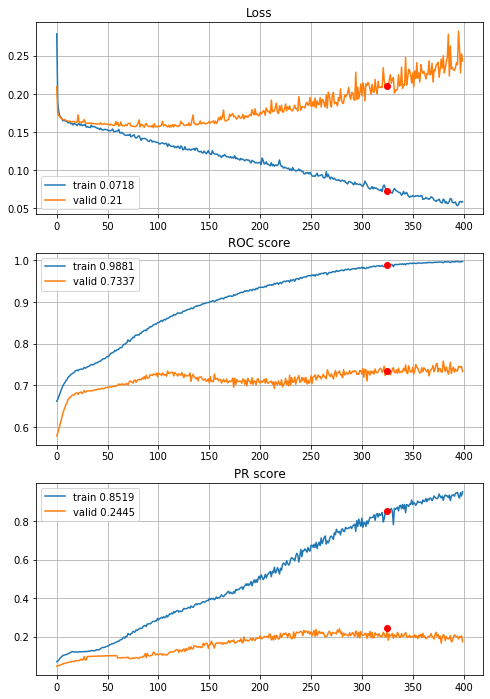


Fold 2------------------------------------------------------------


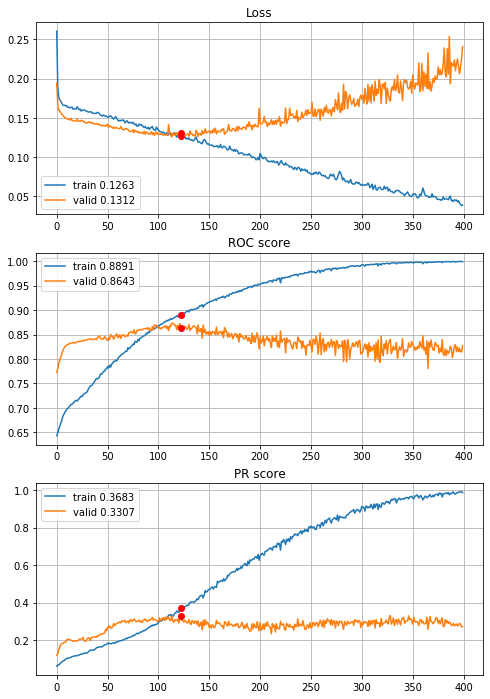


Fold 3------------------------------------------------------------


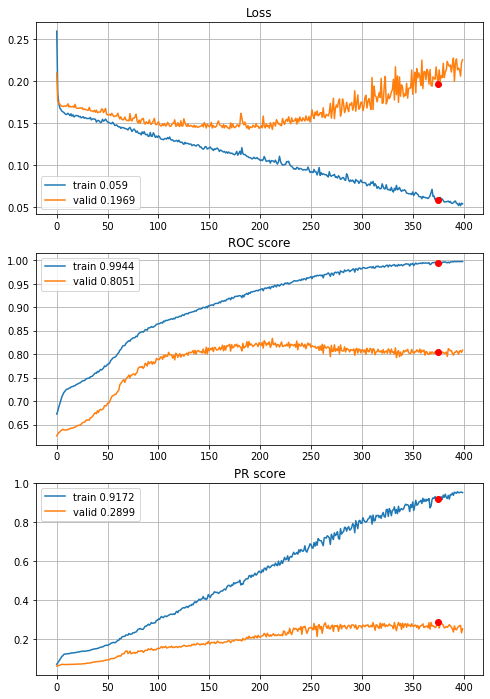


Fold 4------------------------------------------------------------


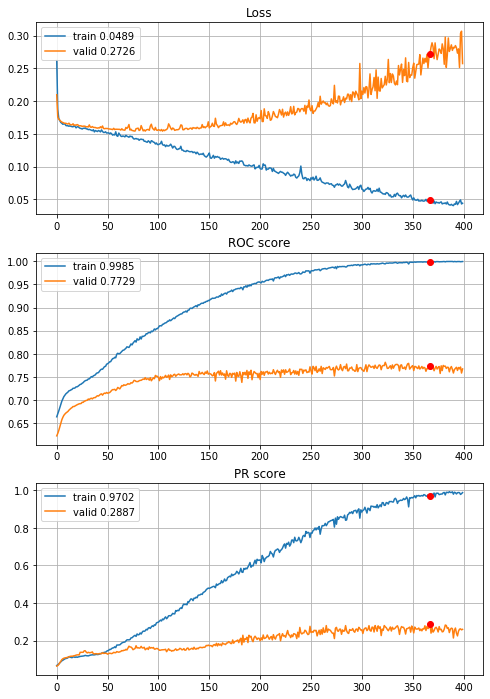


Fold 5------------------------------------------------------------


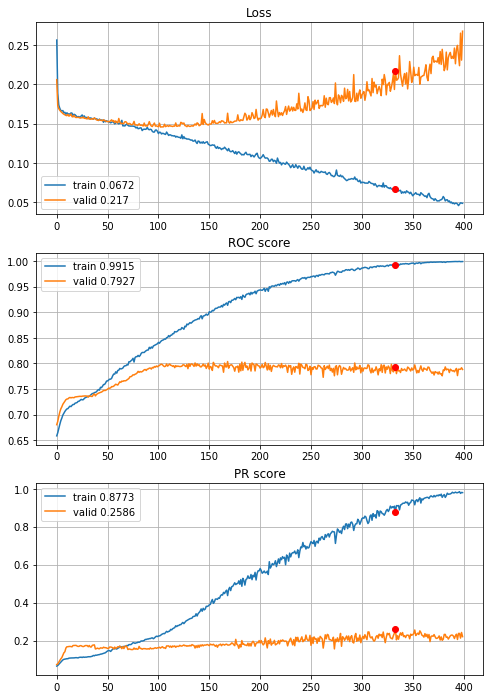


Fold 6------------------------------------------------------------


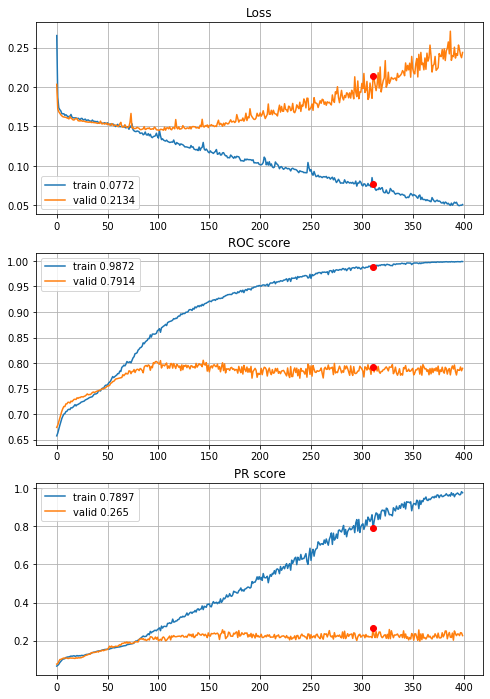

In [55]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_bigger_std_L2_drop_04, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\1year\define_deep_CNN_2inc_bigger_std_L2_drop_04_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Worse results, so lets try smaller inceptions.

In [53]:
def define_deep_CNN_2inc_smaller_std_L2_drop_04(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=3, f2_in=1, f2_out=3, f3_in=1, f3_out=3, f4_out=3,
                                 random_state=random_state)                                             # (8,8,12)
    inception = inception_module(prev_layer=inception, f1=6, f2_in=4, f2_out=6, f3_in=4, f3_out=6,
                                 f4_out=6, random_state=random_state)                                   # (8,8,24)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,24)
    flat = layers.Flatten()(pool)                                                                       # (384,)
    dense = layers.Dense(units=192, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.00005))(flat)                           # (192,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (192,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 5.58s train loss: 0.26581201206122224, validation loss: 0.19172224396772583
Epoch: 2/400,
cumulative time: 6.94s train loss: 0.1828556814162057, validation loss: 0.1695028609636839
Epoch: 3/400,
cumulative time: 8.28s train loss: 0.17257798444727115, validation loss: 0.1677727115957289
Epoch: 4/400,
cumulative time: 9.63s train loss: 0.16822905328965956, validation loss: 0.1673064932820919
Epoch: 5/400,
cumulative time: 10.99s train loss: 0.16975877910456577, validation loss: 0.1655799030296264
Epoch: 6/400,
cumulative time: 12.34s train loss: 0.1688898209546051, validation loss: 0.16473800526398183
Epoch: 7/400,
cumulative time: 13.66s train loss: 0.16505554381199536, validation loss: 0.16393772381193497
Epoch: 8/400,
cumulative time: 14.99s train loss: 0.16575296840982148, validation loss: 0.16345776631664732
Epoch: 9/400,
cumulative time: 16.32s train loss: 0.164518800637979

Epoch: 76/400,
cumulative time: 105.71s train loss: 0.14463498989364001, validation loss: 0.15964666597078603
Epoch: 77/400,
cumulative time: 107.01s train loss: 0.1442799548835863, validation loss: 0.15893511776679833
Epoch: 78/400,
cumulative time: 108.33s train loss: 0.14038419191649562, validation loss: 0.15942674380439056
Epoch: 79/400,
cumulative time: 109.66s train loss: 0.1406749609893142, validation loss: 0.15989024134130134
Epoch: 80/400,
cumulative time: 110.98s train loss: 0.13957964586521687, validation loss: 0.1599507565120592
Epoch: 81/400,
cumulative time: 112.3s train loss: 0.141143652494198, validation loss: 0.16139354696762404
Epoch: 82/400,
cumulative time: 113.63s train loss: 0.14275429313560592, validation loss: 0.16643112674496885
Epoch: 83/400,
cumulative time: 114.94s train loss: 0.13890759155748011, validation loss: 0.15939551097052826
Epoch: 84/400,
cumulative time: 116.27s train loss: 0.13902309778406227, validation loss: 0.16359463469805707
Epoch: 85/400,
c

Epoch: 151/400,
cumulative time: 206.72s train loss: 0.12500058267498831, validation loss: 0.1689623523595437
Epoch: 152/400,
cumulative time: 208.14s train loss: 0.12541100709103542, validation loss: 0.16679282726780062
Epoch: 153/400,
cumulative time: 209.52s train loss: 0.12403903563119881, validation loss: 0.16869007706981456
Epoch: 154/400,
cumulative time: 210.93s train loss: 0.1268414731043792, validation loss: 0.16623775007828814
Epoch: 155/400,
cumulative time: 212.34s train loss: 0.12003650341812076, validation loss: 0.1678464716650277
Epoch: 156/400,
cumulative time: 213.72s train loss: 0.12121951462138988, validation loss: 0.16796174549287365
Epoch: 157/400,
cumulative time: 215.13s train loss: 0.12145500474342585, validation loss: 0.1712148664289453
Epoch: 158/400,
cumulative time: 216.46s train loss: 0.12283954643547196, validation loss: 0.16671253429757577
Epoch: 159/400,
cumulative time: 217.8s train loss: 0.11904897503484133, validation loss: 0.16929399828643907
Epoch:

Epoch: 226/400,
cumulative time: 308.56s train loss: 0.10525381752277461, validation loss: 0.18245814457903325
Epoch: 227/400,
cumulative time: 309.91s train loss: 0.10529278727987007, validation loss: 0.175011488388114
Epoch: 228/400,
cumulative time: 311.26s train loss: 0.106354208799535, validation loss: 0.17817421806039574
Epoch: 229/400,
cumulative time: 312.58s train loss: 0.10665422751792694, validation loss: 0.1785144457837436
Epoch: 230/400,
cumulative time: 313.91s train loss: 0.1053262048077538, validation loss: 0.18477490391631732
Epoch: 231/400,
cumulative time: 315.24s train loss: 0.10581023717684357, validation loss: 0.17842917002921313
Epoch: 232/400,
cumulative time: 316.57s train loss: 0.10569248719731138, validation loss: 0.1753239829863724
Epoch: 233/400,
cumulative time: 317.89s train loss: 0.10822711581014366, validation loss: 0.17571097849894746
Epoch: 234/400,
cumulative time: 319.22s train loss: 0.10561581046746397, validation loss: 0.17962749194940533
Epoch: 2

Epoch: 301/400,
cumulative time: 410.66s train loss: 0.0938099397597322, validation loss: 0.19854776784636263
Epoch: 302/400,
cumulative time: 412.0s train loss: 0.08859244926604645, validation loss: 0.19865863446492624
Epoch: 303/400,
cumulative time: 413.41s train loss: 0.09062284639200631, validation loss: 0.20861066179438378
Epoch: 304/400,
cumulative time: 414.77s train loss: 0.09392266423075656, validation loss: 0.19035057310700643
Epoch: 305/400,
cumulative time: 416.09s train loss: 0.0903977084911978, validation loss: 0.1938710598950142
Epoch: 306/400,
cumulative time: 417.47s train loss: 0.08738771873107445, validation loss: 0.2028348297446231
Epoch: 307/400,
cumulative time: 418.82s train loss: 0.08690801791747788, validation loss: 0.20165513614210276
Epoch: 308/400,
cumulative time: 420.17s train loss: 0.08694631748283158, validation loss: 0.20221174249612855
Epoch: 309/400,
cumulative time: 421.5s train loss: 0.08776031580437293, validation loss: 0.19509048955037878
Epoch: 

Epoch: 376/400,
cumulative time: 513.55s train loss: 0.08038140697231555, validation loss: 0.21710121261213944
Epoch: 377/400,
cumulative time: 514.96s train loss: 0.07315904387260524, validation loss: 0.21141401046367478
Epoch: 378/400,
cumulative time: 516.42s train loss: 0.0776463698560418, validation loss: 0.21597221312758139
Epoch: 379/400,
cumulative time: 517.9s train loss: 0.07344830061045725, validation loss: 0.2203281668264002
Epoch: 380/400,
cumulative time: 519.23s train loss: 0.07737448126841089, validation loss: 0.20580765472078233
Epoch: 381/400,
cumulative time: 520.55s train loss: 0.07512679644904507, validation loss: 0.22893726059449465
Epoch: 382/400,
cumulative time: 521.89s train loss: 0.07871661058978745, validation loss: 0.2043721016489351
Epoch: 383/400,
cumulative time: 523.22s train loss: 0.07491669072654714, validation loss: 0.22307897417097436
Epoch: 384/400,
cumulative time: 524.54s train loss: 0.07409934539072201, validation loss: 0.23185538417134838
Epoch

Epoch: 49/400,
cumulative time: 76.11s train loss: 0.15250893084498465, validation loss: 0.14015165350242628
Epoch: 50/400,
cumulative time: 77.49s train loss: 0.15276618933824707, validation loss: 0.1445998882828899
Epoch: 51/400,
cumulative time: 78.9s train loss: 0.1516526930840011, validation loss: 0.13983821269456984
Epoch: 52/400,
cumulative time: 80.35s train loss: 0.1509037234610127, validation loss: 0.1395177737132874
Epoch: 53/400,
cumulative time: 81.86s train loss: 0.15216017229167966, validation loss: 0.13900333679717677
Epoch: 54/400,
cumulative time: 83.3s train loss: 0.15093555404067718, validation loss: 0.14004465018662374
Epoch: 55/400,
cumulative time: 84.88s train loss: 0.15053497992837678, validation loss: 0.14056478633034614
Epoch: 56/400,
cumulative time: 86.44s train loss: 0.14989835113513175, validation loss: 0.13802655646312395
Epoch: 57/400,
cumulative time: 88.03s train loss: 0.14802271137597212, validation loss: 0.13849754148009152
Epoch: 58/400,
cumulative

Epoch: 124/400,
cumulative time: 185.73s train loss: 0.12982573165952369, validation loss: 0.12882461683008206
Epoch: 125/400,
cumulative time: 187.12s train loss: 0.1294568579269315, validation loss: 0.13209513966453595
Epoch: 126/400,
cumulative time: 188.51s train loss: 0.1287133633044232, validation loss: 0.13199075768070836
Epoch: 127/400,
cumulative time: 189.89s train loss: 0.1285998028556355, validation loss: 0.13134977688033847
Epoch: 128/400,
cumulative time: 191.28s train loss: 0.12770962234183553, validation loss: 0.1310491382057798
Epoch: 129/400,
cumulative time: 192.67s train loss: 0.1280004819469841, validation loss: 0.13037543651953595
Epoch: 130/400,
cumulative time: 194.08s train loss: 0.12858547068411305, validation loss: 0.13178800445127759
Epoch: 131/400,
cumulative time: 195.47s train loss: 0.12661239013669612, validation loss: 0.13067438664087988
Epoch: 132/400,
cumulative time: 196.86s train loss: 0.1263129107696508, validation loss: 0.13084396032839166
Epoch: 

Epoch: 199/400,
cumulative time: 293.97s train loss: 0.11185345355371823, validation loss: 0.13422283747956243
Epoch: 200/400,
cumulative time: 295.43s train loss: 0.10699422034581653, validation loss: 0.14193685092668154
Epoch: 201/400,
cumulative time: 296.92s train loss: 0.10996343531633464, validation loss: 0.13273725187868954
Epoch: 202/400,
cumulative time: 298.35s train loss: 0.10799935853119368, validation loss: 0.13442090866235448
Epoch: 203/400,
cumulative time: 299.79s train loss: 0.11246898551480368, validation loss: 0.13362106813764663
Epoch: 204/400,
cumulative time: 301.19s train loss: 0.10837257269494222, validation loss: 0.13228649551321026
Epoch: 205/400,
cumulative time: 302.61s train loss: 0.10694692959934755, validation loss: 0.13836000291400888
Epoch: 206/400,
cumulative time: 304.02s train loss: 0.10798700964767521, validation loss: 0.13608142640264934
Epoch: 207/400,
cumulative time: 305.42s train loss: 0.10542182111988936, validation loss: 0.13251443077196884
E

Epoch: 274/400,
cumulative time: 401.58s train loss: 0.08779768726348425, validation loss: 0.14412482289254552
Epoch: 275/400,
cumulative time: 403.03s train loss: 0.08927708707283298, validation loss: 0.15111485584524142
Epoch: 276/400,
cumulative time: 404.45s train loss: 0.08957707869486294, validation loss: 0.1482968084669656
Epoch: 277/400,
cumulative time: 405.88s train loss: 0.09176338578678625, validation loss: 0.1460278196794032
Epoch: 278/400,
cumulative time: 407.28s train loss: 0.09672626934422487, validation loss: 0.1429795163066835
Epoch: 279/400,
cumulative time: 408.73s train loss: 0.09285269164439623, validation loss: 0.1427976765035452
Epoch: 280/400,
cumulative time: 410.2s train loss: 0.08892806607530059, validation loss: 0.14511495339463287
Epoch: 281/400,
cumulative time: 411.72s train loss: 0.08746670409471531, validation loss: 0.14530266431183245
Epoch: 282/400,
cumulative time: 413.14s train loss: 0.08776231247514656, validation loss: 0.14708229565756145
Epoch:

Epoch: 349/400,
cumulative time: 510.23s train loss: 0.07546554758890305, validation loss: 0.15563697838692783
Epoch: 350/400,
cumulative time: 511.73s train loss: 0.07223373634539247, validation loss: 0.15815960885903868
Epoch: 351/400,
cumulative time: 513.2s train loss: 0.06938832328713143, validation loss: 0.1614555130647301
Epoch: 352/400,
cumulative time: 514.63s train loss: 0.06974165196578236, validation loss: 0.15695035276648214
Epoch: 353/400,
cumulative time: 516.05s train loss: 0.07232257032190825, validation loss: 0.1565767060081692
Epoch: 354/400,
cumulative time: 517.44s train loss: 0.07281551917686183, validation loss: 0.1595504560721667
Epoch: 355/400,
cumulative time: 518.86s train loss: 0.07429946166033763, validation loss: 0.16496669674960215
Epoch: 356/400,
cumulative time: 520.31s train loss: 0.07005094065131227, validation loss: 0.15424596403762555
Epoch: 357/400,
cumulative time: 521.75s train loss: 0.07176666571785195, validation loss: 0.16874752978333032
Epoch

Epoch: 22/400,
cumulative time: 36.57s train loss: 0.15718582325121935, validation loss: 0.16652611992277727
Epoch: 23/400,
cumulative time: 38.0s train loss: 0.15677073126556298, validation loss: 0.16656810135723743
Epoch: 24/400,
cumulative time: 39.45s train loss: 0.15734133797872676, validation loss: 0.16678438645273277
Epoch: 25/400,
cumulative time: 40.88s train loss: 0.1550441296011266, validation loss: 0.16622560232368774
Epoch: 26/400,
cumulative time: 42.33s train loss: 0.15641361594878744, validation loss: 0.16599494252756833
Epoch: 27/400,
cumulative time: 43.77s train loss: 0.1567729207918585, validation loss: 0.16534158332976717
Epoch: 28/400,
cumulative time: 45.25s train loss: 0.15498870989516292, validation loss: 0.16535622995537644
Epoch: 29/400,
cumulative time: 46.74s train loss: 0.15748593736814592, validation loss: 0.1649777062477604
Epoch: 30/400,
cumulative time: 48.2s train loss: 0.15549219756809537, validation loss: 0.16435771320983625
Epoch: 31/400,
cumulativ

Epoch: 98/400,
cumulative time: 149.02s train loss: 0.13172002256029697, validation loss: 0.14977537525333534
Epoch: 99/400,
cumulative time: 150.47s train loss: 0.13337657934008784, validation loss: 0.14873493361009366
Epoch: 100/400,
cumulative time: 151.91s train loss: 0.13222646992618264, validation loss: 0.1500232527191544
Epoch: 101/400,
cumulative time: 153.39s train loss: 0.13123172055046292, validation loss: 0.15098403184983944
Epoch: 102/400,
cumulative time: 154.84s train loss: 0.13190950543197327, validation loss: 0.14798241457857714
Epoch: 103/400,
cumulative time: 156.27s train loss: 0.13163344473834282, validation loss: 0.14858265161740486
Epoch: 104/400,
cumulative time: 157.69s train loss: 0.12993441296766106, validation loss: 0.14784083563473918
Epoch: 105/400,
cumulative time: 159.14s train loss: 0.13220999376597395, validation loss: 0.14986752341209825
Epoch: 106/400,
cumulative time: 160.58s train loss: 0.1315725152728906, validation loss: 0.1493723631131355
Epoch:

Epoch: 173/400,
cumulative time: 259.39s train loss: 0.1178821361579524, validation loss: 0.14639749830373097
Epoch: 174/400,
cumulative time: 260.87s train loss: 0.11989562433121101, validation loss: 0.14456690006679104
Epoch: 175/400,
cumulative time: 262.34s train loss: 0.11785809708161869, validation loss: 0.14573261585701575
Epoch: 176/400,
cumulative time: 263.83s train loss: 0.12100155389738716, validation loss: 0.14293000439934758
Epoch: 177/400,
cumulative time: 265.32s train loss: 0.1175802894601107, validation loss: 0.14510955812808912
Epoch: 178/400,
cumulative time: 266.81s train loss: 0.12348239411948075, validation loss: 0.14596183250253522
Epoch: 179/400,
cumulative time: 268.29s train loss: 0.11857413648286626, validation loss: 0.14750575965563759
Epoch: 180/400,
cumulative time: 269.95s train loss: 0.11919480149105785, validation loss: 0.1455871946190747
Epoch: 181/400,
cumulative time: 271.37s train loss: 0.11925901633455813, validation loss: 0.14584042301553476
Epoc

Epoch: 248/400,
cumulative time: 369.83s train loss: 0.11006102691876368, validation loss: 0.14594716693237567
Epoch: 249/400,
cumulative time: 371.3s train loss: 0.10685928021142334, validation loss: 0.14480255354740135
Epoch: 250/400,
cumulative time: 372.79s train loss: 0.10489349416130182, validation loss: 0.14564561367430767
Epoch: 251/400,
cumulative time: 374.28s train loss: 0.1061646023245645, validation loss: 0.14560610983358163
Epoch: 252/400,
cumulative time: 375.72s train loss: 0.10841087352844976, validation loss: 0.14738163409977303
Epoch: 253/400,
cumulative time: 377.16s train loss: 0.10767917333902399, validation loss: 0.1473980497646603
Epoch: 254/400,
cumulative time: 378.63s train loss: 0.10956103254880127, validation loss: 0.15278899286514894
Epoch: 255/400,
cumulative time: 380.11s train loss: 0.10492885876199552, validation loss: 0.1502514806288017
Epoch: 256/400,
cumulative time: 381.54s train loss: 0.10635921413068301, validation loss: 0.1476226458202277
Epoch:

Epoch: 323/400,
cumulative time: 481.28s train loss: 0.09318513894273389, validation loss: 0.15331304726496595
Epoch: 324/400,
cumulative time: 482.78s train loss: 0.09021567218924609, validation loss: 0.1563489041953883
Epoch: 325/400,
cumulative time: 484.29s train loss: 0.09376958103062306, validation loss: 0.14932000864671802
Epoch: 326/400,
cumulative time: 485.81s train loss: 0.09339800902007879, validation loss: 0.15039261375364815
Epoch: 327/400,
cumulative time: 487.35s train loss: 0.0933515770922802, validation loss: 0.15057572540058356
Epoch: 328/400,
cumulative time: 488.79s train loss: 0.09548896056311859, validation loss: 0.14844862894778912
Epoch: 329/400,
cumulative time: 490.22s train loss: 0.09636892871454047, validation loss: 0.15627628530904056
Epoch: 330/400,
cumulative time: 491.65s train loss: 0.09267226597276539, validation loss: 0.15368875090661946
Epoch: 331/400,
cumulative time: 493.1s train loss: 0.09019813852868903, validation loss: 0.14927524282991095
Epoc

Epoch: 398/400,
cumulative time: 592.6s train loss: 0.08191296420920732, validation loss: 0.1575617621276365
Epoch: 399/400,
cumulative time: 594.06s train loss: 0.07930727801241504, validation loss: 0.1601971101291492
Epoch: 400/400,
cumulative time: 595.54s train loss: 0.07739571062618233, validation loss: 0.1711256922535471

Early stopping results:
best results in epoch: 397, 
best valid PR: 0.27647603501081247, 
valid ROC: 0.8232249054968338        
overfitting PR: 0.5039233690817957, 
overfitting ROC: 0.15557153743876506

----------
Fold: 4
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 5.78s train loss: 0.263398786508381, validation loss: 0.19698646540207473
Epoch: 2/400,
cumulative time: 7.28s train loss: 0.18752928507961403, validation loss: 0.17349498132261423
Epoch: 3/400,
cumulative time: 8.78s train loss: 0.17411760323074782, validation loss: 0.17176878726572872
Epoch: 4/400,
cumulative time: 10.31s train loss: 0.1691055284901407, 

Epoch: 71/400,
cumulative time: 111.95s train loss: 0.14651325764364265, validation loss: 0.1549921589965386
Epoch: 72/400,
cumulative time: 113.47s train loss: 0.14688330892423976, validation loss: 0.15598361468405605
Epoch: 73/400,
cumulative time: 114.98s train loss: 0.14797025331679511, validation loss: 0.15276160265055735
Epoch: 74/400,
cumulative time: 116.47s train loss: 0.14608103072507558, validation loss: 0.15211393886318242
Epoch: 75/400,
cumulative time: 117.99s train loss: 0.14722163745359407, validation loss: 0.1528387917965594
Epoch: 76/400,
cumulative time: 119.48s train loss: 0.14766763006204445, validation loss: 0.1520681697062342
Epoch: 77/400,
cumulative time: 120.95s train loss: 0.1453878839735288, validation loss: 0.15207376865496897
Epoch: 78/400,
cumulative time: 122.47s train loss: 0.14294411571417182, validation loss: 0.15226047437998555
Epoch: 79/400,
cumulative time: 123.96s train loss: 0.14579430471052482, validation loss: 0.15634358327913556
Epoch: 80/400,

Epoch: 146/400,
cumulative time: 224.98s train loss: 0.1260205138114191, validation loss: 0.15075148305585306
Epoch: 147/400,
cumulative time: 226.48s train loss: 0.1256039689173056, validation loss: 0.14885525295132704
Epoch: 148/400,
cumulative time: 227.98s train loss: 0.12544955094070995, validation loss: 0.15070192800018323
Epoch: 149/400,
cumulative time: 229.52s train loss: 0.12528254139807918, validation loss: 0.1494494442469255
Epoch: 150/400,
cumulative time: 231.09s train loss: 0.12763262690527388, validation loss: 0.15340252735243803
Epoch: 151/400,
cumulative time: 232.78s train loss: 0.1283462457768831, validation loss: 0.15011438973375243
Epoch: 152/400,
cumulative time: 234.31s train loss: 0.12528268183092012, validation loss: 0.15083511023865254
Epoch: 153/400,
cumulative time: 235.78s train loss: 0.12569624598949186, validation loss: 0.150014610710135
Epoch: 154/400,
cumulative time: 237.25s train loss: 0.1251974161537594, validation loss: 0.1504106509730757
Epoch: 15

Epoch: 221/400,
cumulative time: 338.88s train loss: 0.111295986200985, validation loss: 0.16352390629403732
Epoch: 222/400,
cumulative time: 340.41s train loss: 0.10918757771009285, validation loss: 0.15451078577783572
Epoch: 223/400,
cumulative time: 341.95s train loss: 0.10594261224174861, validation loss: 0.15683652644365517
Epoch: 224/400,
cumulative time: 343.47s train loss: 0.10701887894287508, validation loss: 0.1552959191109243
Epoch: 225/400,
cumulative time: 344.94s train loss: 0.10607452068258734, validation loss: 0.1541879691141154
Epoch: 226/400,
cumulative time: 346.41s train loss: 0.10423433801876753, validation loss: 0.1574668389739755
Epoch: 227/400,
cumulative time: 347.9s train loss: 0.10620413163581428, validation loss: 0.15546962197523642
Epoch: 228/400,
cumulative time: 349.4s train loss: 0.10719246840567472, validation loss: 0.15788276352172106
Epoch: 229/400,
cumulative time: 350.9s train loss: 0.10519262825684937, validation loss: 0.15539817079421012
Epoch: 23

Epoch: 296/400,
cumulative time: 453.12s train loss: 0.08882273297608465, validation loss: 0.1615730685233165
Epoch: 297/400,
cumulative time: 454.58s train loss: 0.0929046991540992, validation loss: 0.16010213777620833
Epoch: 298/400,
cumulative time: 456.05s train loss: 0.09196460977818753, validation loss: 0.16044653527990013
Epoch: 299/400,
cumulative time: 457.51s train loss: 0.09919237015482597, validation loss: 0.18124740190478836
Epoch: 300/400,
cumulative time: 458.99s train loss: 0.09407636018812769, validation loss: 0.15863306390605797
Epoch: 301/400,
cumulative time: 460.45s train loss: 0.09155432571015502, validation loss: 0.16468019512052554
Epoch: 302/400,
cumulative time: 461.96s train loss: 0.09050689033273275, validation loss: 0.16090621257755744
Epoch: 303/400,
cumulative time: 463.43s train loss: 0.08930971291785675, validation loss: 0.16160056820630575
Epoch: 304/400,
cumulative time: 464.96s train loss: 0.08952111268744749, validation loss: 0.16727589373344262
Epo

Epoch: 371/400,
cumulative time: 566.62s train loss: 0.07721561422214562, validation loss: 0.175755687722445
Epoch: 372/400,
cumulative time: 568.08s train loss: 0.07644756850583277, validation loss: 0.18179967213400852
Epoch: 373/400,
cumulative time: 569.53s train loss: 0.07558332389994636, validation loss: 0.1830696428523344
Epoch: 374/400,
cumulative time: 570.99s train loss: 0.07747849148240442, validation loss: 0.18331647450828914
Epoch: 375/400,
cumulative time: 572.43s train loss: 0.07382943146425587, validation loss: 0.1748890799012537
Epoch: 376/400,
cumulative time: 573.88s train loss: 0.07928391836682579, validation loss: 0.17301257313768145
Epoch: 377/400,
cumulative time: 575.32s train loss: 0.08258151846886586, validation loss: 0.19233068408165305
Epoch: 378/400,
cumulative time: 576.79s train loss: 0.08010725375879874, validation loss: 0.1864941492252603
Epoch: 379/400,
cumulative time: 578.25s train loss: 0.07624707077214568, validation loss: 0.17281524542952398
Epoch:

Epoch: 44/400,
cumulative time: 72.37s train loss: 0.15376458255118167, validation loss: 0.15295717335064
Epoch: 45/400,
cumulative time: 73.9s train loss: 0.15408468387554447, validation loss: 0.15257497063963418
Epoch: 46/400,
cumulative time: 75.61s train loss: 0.1528974719642462, validation loss: 0.1513695618742105
Epoch: 47/400,
cumulative time: 77.15s train loss: 0.15400842882876603, validation loss: 0.1516800840620298
Epoch: 48/400,
cumulative time: 78.7s train loss: 0.1525006515053463, validation loss: 0.15076936600443533
Epoch: 49/400,
cumulative time: 80.25s train loss: 0.15278045456199085, validation loss: 0.1516315248535073
Epoch: 50/400,
cumulative time: 81.82s train loss: 0.1532389809725633, validation loss: 0.15044956610483282
Epoch: 51/400,
cumulative time: 83.34s train loss: 0.15102877318576347, validation loss: 0.15042019798022746
Epoch: 52/400,
cumulative time: 84.86s train loss: 0.1516340857240914, validation loss: 0.15042602498458957
Epoch: 53/400,
cumulative time:

Epoch: 119/400,
cumulative time: 188.36s train loss: 0.13487799740210882, validation loss: 0.1452876708313003
Epoch: 120/400,
cumulative time: 190.02s train loss: 0.1322064260406105, validation loss: 0.14553132130140597
Epoch: 121/400,
cumulative time: 191.52s train loss: 0.1325135960750833, validation loss: 0.1450717213653749
Epoch: 122/400,
cumulative time: 193.09s train loss: 0.13163887674600394, validation loss: 0.14426746611011548
Epoch: 123/400,
cumulative time: 194.59s train loss: 0.12972007635592056, validation loss: 0.14689660510596106
Epoch: 124/400,
cumulative time: 196.14s train loss: 0.13332879728791383, validation loss: 0.14644874652151366
Epoch: 125/400,
cumulative time: 197.72s train loss: 0.1290598311336036, validation loss: 0.14676700806708218
Epoch: 126/400,
cumulative time: 199.29s train loss: 0.13263939124243987, validation loss: 0.14789223795371445
Epoch: 127/400,
cumulative time: 200.91s train loss: 0.12941027132112115, validation loss: 0.14410785451333483
Epoch:

Epoch: 194/400,
cumulative time: 305.04s train loss: 0.11076312817675565, validation loss: 0.15529964004680372
Epoch: 195/400,
cumulative time: 306.55s train loss: 0.10644446052681562, validation loss: 0.15239028675054012
Epoch: 196/400,
cumulative time: 308.06s train loss: 0.1085099161038815, validation loss: 0.15127528030460655
Epoch: 197/400,
cumulative time: 309.56s train loss: 0.10992443569188326, validation loss: 0.15246920935116864
Epoch: 198/400,
cumulative time: 311.07s train loss: 0.11053225996089389, validation loss: 0.15335430586586868
Epoch: 199/400,
cumulative time: 312.57s train loss: 0.10716263568152513, validation loss: 0.155580112077932
Epoch: 200/400,
cumulative time: 314.07s train loss: 0.10603982506485998, validation loss: 0.15180549113189473
Epoch: 201/400,
cumulative time: 315.57s train loss: 0.10343380597556112, validation loss: 0.15314686623538015
Epoch: 202/400,
cumulative time: 317.07s train loss: 0.10607565732167387, validation loss: 0.154447177753729
Epoch:

Epoch: 269/400,
cumulative time: 418.77s train loss: 0.09299522752270979, validation loss: 0.16065920606623113
Epoch: 270/400,
cumulative time: 420.25s train loss: 0.09061245313603467, validation loss: 0.16376254369683238
Epoch: 271/400,
cumulative time: 421.81s train loss: 0.08801539107110966, validation loss: 0.164125125621935
Epoch: 272/400,
cumulative time: 423.35s train loss: 0.08936156405584862, validation loss: 0.1600939235888577
Epoch: 273/400,
cumulative time: 424.87s train loss: 0.08907115054396343, validation loss: 0.16235010291978122
Epoch: 274/400,
cumulative time: 426.36s train loss: 0.08936720627308797, validation loss: 0.16110387871455423
Epoch: 275/400,
cumulative time: 427.89s train loss: 0.09167371217790546, validation loss: 0.16903026057036144
Epoch: 276/400,
cumulative time: 429.4s train loss: 0.09221020978530851, validation loss: 0.17060530417558137
Epoch: 277/400,
cumulative time: 430.9s train loss: 0.08926687363316031, validation loss: 0.16281516657721612
Epoch:

Epoch: 344/400,
cumulative time: 534.09s train loss: 0.07406259125816075, validation loss: 0.17578960502735805
Epoch: 345/400,
cumulative time: 535.58s train loss: 0.07674083104622206, validation loss: 0.1840334705146033
Epoch: 346/400,
cumulative time: 537.09s train loss: 0.07904351265143172, validation loss: 0.17443113834853416
Epoch: 347/400,
cumulative time: 538.59s train loss: 0.0781479361528916, validation loss: 0.17358709769977337
Epoch: 348/400,
cumulative time: 540.09s train loss: 0.07542717877414919, validation loss: 0.1818009787990201
Epoch: 349/400,
cumulative time: 541.6s train loss: 0.07779285035871916, validation loss: 0.18175535381858218
Epoch: 350/400,
cumulative time: 543.1s train loss: 0.07642334771026243, validation loss: 0.16422099214351155
Epoch: 351/400,
cumulative time: 544.61s train loss: 0.07559578689469106, validation loss: 0.17675528382666875
Epoch: 352/400,
cumulative time: 546.12s train loss: 0.07173865076571534, validation loss: 0.1765830586372788
Epoch: 

Epoch: 17/400,
cumulative time: 39.73s train loss: 0.1636215483610725, validation loss: 0.15779558474470134
Epoch: 18/400,
cumulative time: 41.78s train loss: 0.16095137799996354, validation loss: 0.1574419465983389
Epoch: 19/400,
cumulative time: 44.02s train loss: 0.16102342547343398, validation loss: 0.1573813710877746
Epoch: 20/400,
cumulative time: 46.39s train loss: 0.1613742282115757, validation loss: 0.15746374117242318
Epoch: 21/400,
cumulative time: 48.45s train loss: 0.1626380705007792, validation loss: 0.15756276286643642
Epoch: 22/400,
cumulative time: 50.62s train loss: 0.15958663065700424, validation loss: 0.1569277967063028
Epoch: 23/400,
cumulative time: 52.74s train loss: 0.15896398557714086, validation loss: 0.15687040286227014
Epoch: 24/400,
cumulative time: 54.86s train loss: 0.16062308179189855, validation loss: 0.1566641795850117
Epoch: 25/400,
cumulative time: 56.91s train loss: 0.1599290269488854, validation loss: 0.1568090624160061
Epoch: 26/400,
cumulative ti

Epoch: 93/400,
cumulative time: 198.5s train loss: 0.14376873515079777, validation loss: 0.1468881930894372
Epoch: 94/400,
cumulative time: 200.68s train loss: 0.14257697427974028, validation loss: 0.14570374026244234
Epoch: 95/400,
cumulative time: 202.86s train loss: 0.14329979678994112, validation loss: 0.1464880961338076
Epoch: 96/400,
cumulative time: 205.0s train loss: 0.1410058162668172, validation loss: 0.1459766137475533
Epoch: 97/400,
cumulative time: 207.12s train loss: 0.14155681039113022, validation loss: 0.15020107206459063
Epoch: 98/400,
cumulative time: 209.21s train loss: 0.14246249914565168, validation loss: 0.1498123988424352
Epoch: 99/400,
cumulative time: 211.28s train loss: 0.1447634549447436, validation loss: 0.1469648757373359
Epoch: 100/400,
cumulative time: 213.32s train loss: 0.14017689695168264, validation loss: 0.1457800956785792
Epoch: 101/400,
cumulative time: 215.42s train loss: 0.14090167394568842, validation loss: 0.14469161773881606
Epoch: 102/400,
cu

Epoch: 168/400,
cumulative time: 355.45s train loss: 0.12349110547403683, validation loss: 0.13799993879032768
Epoch: 169/400,
cumulative time: 357.51s train loss: 0.12249761417197096, validation loss: 0.13806034896020872
Epoch: 170/400,
cumulative time: 359.56s train loss: 0.12278334779463411, validation loss: 0.13848700275400785
Epoch: 171/400,
cumulative time: 361.61s train loss: 0.12373402196157589, validation loss: 0.1400604348424716
Epoch: 172/400,
cumulative time: 363.65s train loss: 0.12393118224232201, validation loss: 0.14088527332333958
Epoch: 173/400,
cumulative time: 365.7s train loss: 0.12282767322699079, validation loss: 0.13954351214688462
Epoch: 174/400,
cumulative time: 367.75s train loss: 0.12359803682034111, validation loss: 0.1396129619209997
Epoch: 175/400,
cumulative time: 369.78s train loss: 0.12214567075418115, validation loss: 0.1404820906539117
Epoch: 176/400,
cumulative time: 371.82s train loss: 0.12436839798765797, validation loss: 0.13813026328579978
Epoch

Epoch: 243/400,
cumulative time: 511.3s train loss: 0.11014444045369041, validation loss: 0.13962637382847534
Epoch: 244/400,
cumulative time: 513.39s train loss: 0.108819467338258, validation loss: 0.14596738949050486
Epoch: 245/400,
cumulative time: 515.49s train loss: 0.11138928634957525, validation loss: 0.14509876027166052
Epoch: 246/400,
cumulative time: 517.65s train loss: 0.1090917041535848, validation loss: 0.13831775515310227
Epoch: 247/400,
cumulative time: 519.79s train loss: 0.11113545933360167, validation loss: 0.14206408682425967
Epoch: 248/400,
cumulative time: 521.85s train loss: 0.1171029015696931, validation loss: 0.146543282174295
Epoch: 249/400,
cumulative time: 523.91s train loss: 0.11183137421476773, validation loss: 0.14652715442415884
Epoch: 250/400,
cumulative time: 526.0s train loss: 0.11232667767515218, validation loss: 0.1362500789043347
Epoch: 251/400,
cumulative time: 528.14s train loss: 0.11027895773299731, validation loss: 0.13656528001435567
Epoch: 252

Epoch: 318/400,
cumulative time: 670.86s train loss: 0.10078506565014823, validation loss: 0.1498654166508671
Epoch: 319/400,
cumulative time: 673.0s train loss: 0.09614982227503235, validation loss: 0.15341982287858424
Epoch: 320/400,
cumulative time: 675.14s train loss: 0.09997211783785069, validation loss: 0.13941680847806767
Epoch: 321/400,
cumulative time: 677.27s train loss: 0.09817353741776559, validation loss: 0.13873599769381464
Epoch: 322/400,
cumulative time: 679.32s train loss: 0.09668048153961858, validation loss: 0.14387123983713887
Epoch: 323/400,
cumulative time: 681.39s train loss: 0.09740590882369192, validation loss: 0.14508275718797542
Epoch: 324/400,
cumulative time: 683.54s train loss: 0.09959890777686968, validation loss: 0.1600901050319934
Epoch: 325/400,
cumulative time: 685.67s train loss: 0.09992201728940689, validation loss: 0.14921973370001484
Epoch: 326/400,
cumulative time: 687.75s train loss: 0.0974260032968684, validation loss: 0.14328922404849326
Epoch

Epoch: 393/400,
cumulative time: 827.72s train loss: 0.08687670596467023, validation loss: 0.1560825609108981
Epoch: 394/400,
cumulative time: 829.83s train loss: 0.08717078202080682, validation loss: 0.14998046492546288
Epoch: 395/400,
cumulative time: 831.89s train loss: 0.08595839069141835, validation loss: 0.1531779876074257
Epoch: 396/400,
cumulative time: 833.96s train loss: 0.08676379109808798, validation loss: 0.15901670238777174
Epoch: 397/400,
cumulative time: 836.03s train loss: 0.08277837661796549, validation loss: 0.17571437447923863
Epoch: 398/400,
cumulative time: 838.06s train loss: 0.08799535249283916, validation loss: 0.15342596809484021
Epoch: 399/400,
cumulative time: 840.22s train loss: 0.08659033424714033, validation loss: 0.14997888422894523
Epoch: 400/400,
cumulative time: 842.38s train loss: 0.08694708933187843, validation loss: 0.15063349352672384

Early stopping results:
best results in epoch: 327, 
best valid PR: 0.33680949021877, 
valid ROC: 0.8408735222594

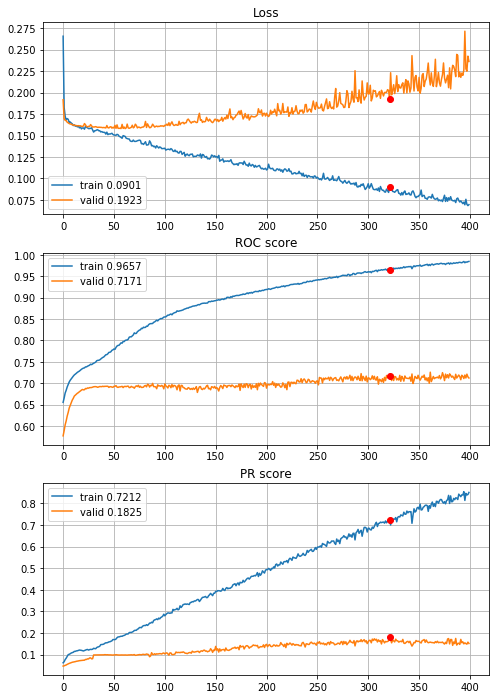


Fold 2------------------------------------------------------------


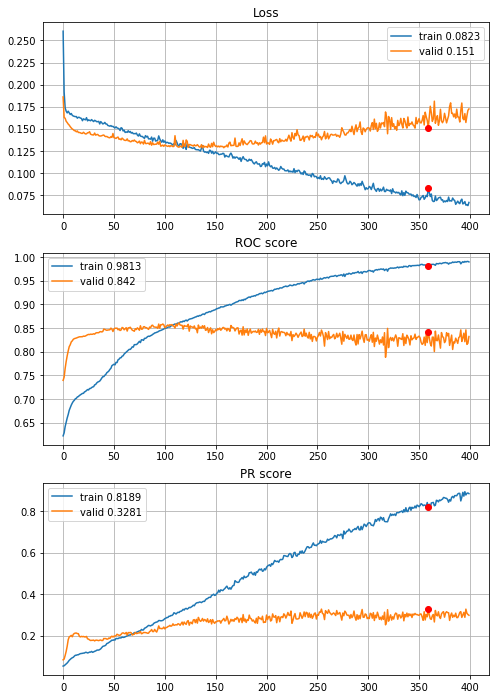


Fold 3------------------------------------------------------------


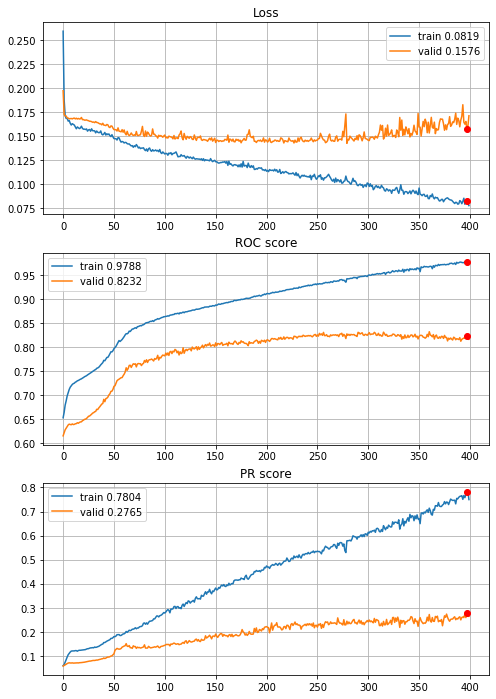


Fold 4------------------------------------------------------------


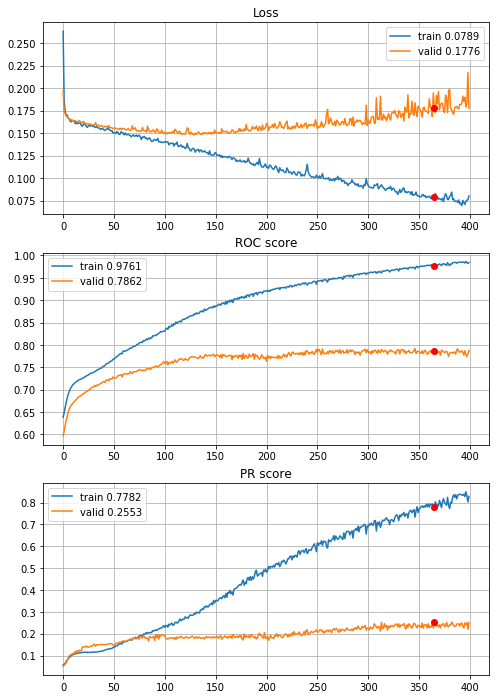


Fold 5------------------------------------------------------------


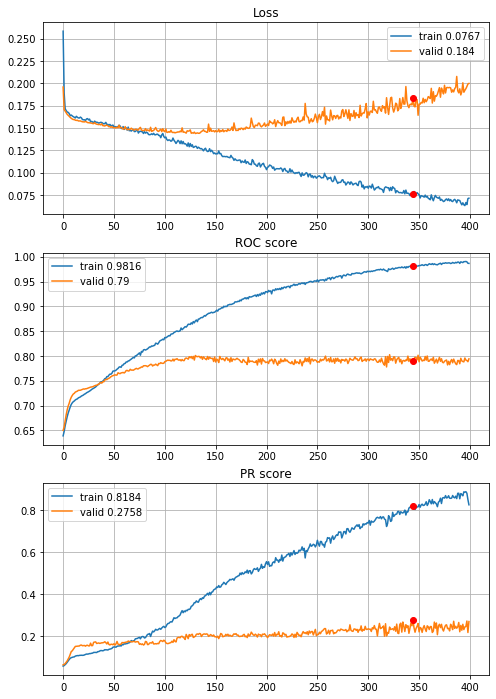


Fold 6------------------------------------------------------------


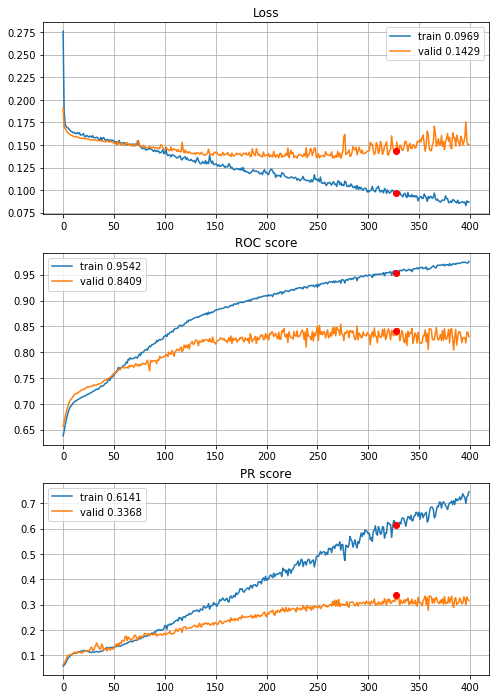

In [61]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_smaller_std_L2_drop_04, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\1year\define_deep_CNN_2inc_smaller_std_L2_drop_04_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Worse results. Lets try bigger regularization for 2 year horizon model

In [54]:
def define_deep_CNN_2inc_std_L2_bigger_drop_04(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.000075))(flat)                          # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 7.03s train loss: 0.30618251761177684, validation loss: 0.19541065335499946
Epoch: 2/400,
cumulative time: 9.41s train loss: 0.19084777980194598, validation loss: 0.17683290991317163
Epoch: 3/400,
cumulative time: 11.67s train loss: 0.17714772118393338, validation loss: 0.17328809775708975
Epoch: 4/400,
cumulative time: 14.03s train loss: 0.1724958395143614, validation loss: 0.17060401911301223
Epoch: 5/400,
cumulative time: 16.41s train loss: 0.17121946806020935, validation loss: 0.1683582637805414
Epoch: 6/400,
cumulative time: 18.72s train loss: 0.16773106817163144, validation loss: 0.16720286229416814
Epoch: 7/400,
cumulative time: 21.11s train loss: 0.16915873781101073, validation loss: 0.16633833927832248
Epoch: 8/400,
cumulative time: 23.54s train loss: 0.166811402085497, validation loss: 0.16581570610149535
Epoch: 9/400,
cumulative time: 25.98s train loss: 0.16538215047

Epoch: 76/400,
cumulative time: 176.88s train loss: 0.1512784321377128, validation loss: 0.15993383128118244
Epoch: 77/400,
cumulative time: 179.1s train loss: 0.14965643341276633, validation loss: 0.1603041001696288
Epoch: 78/400,
cumulative time: 181.31s train loss: 0.14791269597563844, validation loss: 0.16028775659299666
Epoch: 79/400,
cumulative time: 183.53s train loss: 0.15033180660778475, validation loss: 0.16062792595581946
Epoch: 80/400,
cumulative time: 185.73s train loss: 0.14974538642043633, validation loss: 0.16092411345277385
Epoch: 81/400,
cumulative time: 187.96s train loss: 0.15137276244853434, validation loss: 0.1597931614919677
Epoch: 82/400,
cumulative time: 190.16s train loss: 0.15022418212279876, validation loss: 0.16062009037672004
Epoch: 83/400,
cumulative time: 192.38s train loss: 0.14857997483727603, validation loss: 0.16036707219407953
Epoch: 84/400,
cumulative time: 194.6s train loss: 0.14820795430460737, validation loss: 0.16352628768055896
Epoch: 85/400,


Epoch: 151/400,
cumulative time: 343.18s train loss: 0.12930510423554414, validation loss: 0.1584422947729335
Epoch: 152/400,
cumulative time: 345.4s train loss: 0.1283207061620998, validation loss: 0.15668219404270345
Epoch: 153/400,
cumulative time: 347.62s train loss: 0.12732668252665358, validation loss: 0.15776386526210032
Epoch: 154/400,
cumulative time: 349.84s train loss: 0.12979752665113453, validation loss: 0.15572598090208006
Epoch: 155/400,
cumulative time: 352.28s train loss: 0.12450390770550697, validation loss: 0.15809895649580621
Epoch: 156/400,
cumulative time: 354.68s train loss: 0.12594257854702803, validation loss: 0.1580243755902466
Epoch: 157/400,
cumulative time: 356.93s train loss: 0.1269662569550907, validation loss: 0.15870492884171755
Epoch: 158/400,
cumulative time: 359.27s train loss: 0.12474787843182146, validation loss: 0.15831823480197102
Epoch: 159/400,
cumulative time: 361.57s train loss: 0.12364642222816623, validation loss: 0.15881899123626145
Epoch:

Epoch: 226/400,
cumulative time: 514.03s train loss: 0.10506289369891446, validation loss: 0.17950436142070017
Epoch: 227/400,
cumulative time: 516.26s train loss: 0.10493939670202175, validation loss: 0.16966974718294742
Epoch: 228/400,
cumulative time: 518.54s train loss: 0.10359644664193467, validation loss: 0.17714724626102302
Epoch: 229/400,
cumulative time: 520.87s train loss: 0.10603277178541307, validation loss: 0.1733110092396528
Epoch: 230/400,
cumulative time: 523.23s train loss: 0.10377656758906041, validation loss: 0.17786712427066897
Epoch: 231/400,
cumulative time: 525.51s train loss: 0.10403517825101313, validation loss: 0.1742013115471183
Epoch: 232/400,
cumulative time: 527.86s train loss: 0.10388745686474063, validation loss: 0.17136705334543956
Epoch: 233/400,
cumulative time: 530.1s train loss: 0.10828749007586058, validation loss: 0.1707170159190158
Epoch: 234/400,
cumulative time: 532.41s train loss: 0.1020635349955233, validation loss: 0.1717154333329065
Epoch: 

Epoch: 301/400,
cumulative time: 686.47s train loss: 0.08878727869273816, validation loss: 0.19550392093875602
Epoch: 302/400,
cumulative time: 688.83s train loss: 0.0886566081100216, validation loss: 0.19477785546933452
Epoch: 303/400,
cumulative time: 691.13s train loss: 0.08759494539795609, validation loss: 0.21720653729940953
Epoch: 304/400,
cumulative time: 693.5s train loss: 0.0936721324270319, validation loss: 0.18241703072014978
Epoch: 305/400,
cumulative time: 695.8s train loss: 0.08860293827823715, validation loss: 0.19514559215001862
Epoch: 306/400,
cumulative time: 698.08s train loss: 0.0859184891183417, validation loss: 0.20714129029686582
Epoch: 307/400,
cumulative time: 700.36s train loss: 0.08587697315996466, validation loss: 0.19598032073232663
Epoch: 308/400,
cumulative time: 702.66s train loss: 0.08600398720837635, validation loss: 0.19457338657053416
Epoch: 309/400,
cumulative time: 704.93s train loss: 0.08401127643812539, validation loss: 0.19287601582691838
Epoch:

Epoch: 376/400,
cumulative time: 856.78s train loss: 0.07224275445463083, validation loss: 0.2228499762925975
Epoch: 377/400,
cumulative time: 859.07s train loss: 0.06962621322279863, validation loss: 0.21523340218886025
Epoch: 378/400,
cumulative time: 861.38s train loss: 0.07128517263528292, validation loss: 0.21201738353246077
Epoch: 379/400,
cumulative time: 863.67s train loss: 0.06827713327457602, validation loss: 0.22528830702209834
Epoch: 380/400,
cumulative time: 866.0s train loss: 0.06607617231287359, validation loss: 0.21186305175356893
Epoch: 381/400,
cumulative time: 868.23s train loss: 0.06924495178873896, validation loss: 0.24399652627545923
Epoch: 382/400,
cumulative time: 870.49s train loss: 0.07537542895839834, validation loss: 0.2105661477943073
Epoch: 383/400,
cumulative time: 872.72s train loss: 0.0691041950553486, validation loss: 0.2294236321772751
Epoch: 384/400,
cumulative time: 874.96s train loss: 0.07081630122786002, validation loss: 0.23464869364276103
Epoch:

Epoch: 49/400,
cumulative time: 121.9s train loss: 0.15498585786663377, validation loss: 0.14024526483080646
Epoch: 50/400,
cumulative time: 124.29s train loss: 0.15599262359811866, validation loss: 0.14416517037368137
Epoch: 51/400,
cumulative time: 126.7s train loss: 0.15606182932118537, validation loss: 0.14200048821587716
Epoch: 52/400,
cumulative time: 129.13s train loss: 0.15524501613636396, validation loss: 0.14008097839762634
Epoch: 53/400,
cumulative time: 131.54s train loss: 0.15696183771630165, validation loss: 0.14034317103011332
Epoch: 54/400,
cumulative time: 133.95s train loss: 0.15617991158812955, validation loss: 0.14175623293393477
Epoch: 55/400,
cumulative time: 136.34s train loss: 0.1567148406461475, validation loss: 0.14038431319272043
Epoch: 56/400,
cumulative time: 138.69s train loss: 0.15337480825197086, validation loss: 0.13848830321255853
Epoch: 57/400,
cumulative time: 141.03s train loss: 0.15449818688280442, validation loss: 0.13964976718122638
Epoch: 58/400

Epoch: 124/400,
cumulative time: 299.51s train loss: 0.1413319517132001, validation loss: 0.13184467611208814
Epoch: 125/400,
cumulative time: 301.85s train loss: 0.14106504861159389, validation loss: 0.13418000122175272
Epoch: 126/400,
cumulative time: 304.38s train loss: 0.14061755724887468, validation loss: 0.13257421657754076
Epoch: 127/400,
cumulative time: 306.82s train loss: 0.140294792928664, validation loss: 0.13080740783653405
Epoch: 128/400,
cumulative time: 309.26s train loss: 0.1393826940508676, validation loss: 0.1320152840306682
Epoch: 129/400,
cumulative time: 311.61s train loss: 0.1413208272979653, validation loss: 0.13175643991813263
Epoch: 130/400,
cumulative time: 313.93s train loss: 0.1409169435274895, validation loss: 0.1318565555044098
Epoch: 131/400,
cumulative time: 316.29s train loss: 0.1410654842655618, validation loss: 0.13062511568277566
Epoch: 132/400,
cumulative time: 318.66s train loss: 0.13747086145506865, validation loss: 0.1326337057736612
Epoch: 133/

Epoch: 199/400,
cumulative time: 477.41s train loss: 0.11906619703351207, validation loss: 0.12782849317709907
Epoch: 200/400,
cumulative time: 479.77s train loss: 0.11527917789157473, validation loss: 0.13753487070778517
Epoch: 201/400,
cumulative time: 482.08s train loss: 0.11921803301210875, validation loss: 0.12906818425519642
Epoch: 202/400,
cumulative time: 484.4s train loss: 0.11791521176215142, validation loss: 0.13046144288337208
Epoch: 203/400,
cumulative time: 486.73s train loss: 0.12116024549873776, validation loss: 0.13199832038759507
Epoch: 204/400,
cumulative time: 489.1s train loss: 0.11804793256792669, validation loss: 0.1281475579998751
Epoch: 205/400,
cumulative time: 491.48s train loss: 0.11652357901183207, validation loss: 0.13351315363138858
Epoch: 206/400,
cumulative time: 493.8s train loss: 0.11168828528848047, validation loss: 0.12927438075560546
Epoch: 207/400,
cumulative time: 496.19s train loss: 0.11306805783419727, validation loss: 0.13062191239966386
Epoch

Epoch: 274/400,
cumulative time: 654.23s train loss: 0.08523162815161403, validation loss: 0.1392742364863517
Epoch: 275/400,
cumulative time: 656.54s train loss: 0.086044327926025, validation loss: 0.1476646304356758
Epoch: 276/400,
cumulative time: 658.88s train loss: 0.0864987159872417, validation loss: 0.14237783425107628
Epoch: 277/400,
cumulative time: 661.22s train loss: 0.08591995651231092, validation loss: 0.145173643300384
Epoch: 278/400,
cumulative time: 663.54s train loss: 0.09165669532043884, validation loss: 0.13332892883660896
Epoch: 279/400,
cumulative time: 665.86s train loss: 0.08885944989532854, validation loss: 0.13626050693203873
Epoch: 280/400,
cumulative time: 668.19s train loss: 0.08191843748064376, validation loss: 0.14461509809887613
Epoch: 281/400,
cumulative time: 670.49s train loss: 0.08498740799626092, validation loss: 0.14254298051236025
Epoch: 282/400,
cumulative time: 672.81s train loss: 0.08076508552740828, validation loss: 0.13635537099001305
Epoch: 2

Epoch: 349/400,
cumulative time: 831.52s train loss: 0.06394095488132968, validation loss: 0.15809993420425358
Epoch: 350/400,
cumulative time: 833.83s train loss: 0.060918315128198834, validation loss: 0.17200044985061805
Epoch: 351/400,
cumulative time: 836.13s train loss: 0.05967975753506175, validation loss: 0.16355346753995378
Epoch: 352/400,
cumulative time: 838.44s train loss: 0.062021822724102574, validation loss: 0.16229206289693118
Epoch: 353/400,
cumulative time: 840.74s train loss: 0.059518012591059793, validation loss: 0.1656188932609739
Epoch: 354/400,
cumulative time: 843.05s train loss: 0.05985407850491254, validation loss: 0.1685031227187821
Epoch: 355/400,
cumulative time: 845.35s train loss: 0.06128884786898995, validation loss: 0.17192969427389257
Epoch: 356/400,
cumulative time: 847.64s train loss: 0.05967462604593281, validation loss: 0.15673681446112536
Epoch: 357/400,
cumulative time: 849.95s train loss: 0.06066013384589208, validation loss: 0.1831939259165831
E

Epoch: 21/400,
cumulative time: 55.2s train loss: 0.16006470918655397, validation loss: 0.16845674368869196
Epoch: 22/400,
cumulative time: 57.68s train loss: 0.15819633275100808, validation loss: 0.16809458303949185
Epoch: 23/400,
cumulative time: 60.23s train loss: 0.15739088979403026, validation loss: 0.16808444004244324
Epoch: 24/400,
cumulative time: 62.69s train loss: 0.15711521143818263, validation loss: 0.16906782475775514
Epoch: 25/400,
cumulative time: 65.15s train loss: 0.15812903270832276, validation loss: 0.16773724290180025
Epoch: 26/400,
cumulative time: 67.63s train loss: 0.15768061888738194, validation loss: 0.1680465616582693
Epoch: 27/400,
cumulative time: 70.09s train loss: 0.1577472717870571, validation loss: 0.16691343851062332
Epoch: 28/400,
cumulative time: 72.53s train loss: 0.1559987982434611, validation loss: 0.16785325502987378
Epoch: 29/400,
cumulative time: 74.96s train loss: 0.1562834021884531, validation loss: 0.16696474826991897
Epoch: 30/400,
cumulativ

Epoch: 97/400,
cumulative time: 240.21s train loss: 0.14759235965119819, validation loss: 0.15849961153809441
Epoch: 98/400,
cumulative time: 242.6s train loss: 0.14829479537381166, validation loss: 0.1600583581080699
Epoch: 99/400,
cumulative time: 245.0s train loss: 0.15006836089226055, validation loss: 0.15862448414543776
Epoch: 100/400,
cumulative time: 247.46s train loss: 0.14844031482652198, validation loss: 0.15828687269275962
Epoch: 101/400,
cumulative time: 249.97s train loss: 0.1473144149361797, validation loss: 0.16051755113212615
Epoch: 102/400,
cumulative time: 252.42s train loss: 0.14735963834587493, validation loss: 0.15778001088231972
Epoch: 103/400,
cumulative time: 254.81s train loss: 0.14745040405577003, validation loss: 0.15854767603937545
Epoch: 104/400,
cumulative time: 257.23s train loss: 0.1471435741381808, validation loss: 0.15709386500167666
Epoch: 105/400,
cumulative time: 259.62s train loss: 0.14819475048463757, validation loss: 0.15808083382797422
Epoch: 10

Epoch: 172/400,
cumulative time: 420.61s train loss: 0.1302084805051561, validation loss: 0.15000392523447523
Epoch: 173/400,
cumulative time: 423.01s train loss: 0.13030805108216953, validation loss: 0.1472346905258394
Epoch: 174/400,
cumulative time: 425.42s train loss: 0.12854827122455303, validation loss: 0.14953030659985045
Epoch: 175/400,
cumulative time: 427.82s train loss: 0.1287875060819132, validation loss: 0.15030141972160882
Epoch: 176/400,
cumulative time: 430.22s train loss: 0.12857326614393003, validation loss: 0.14663442091369538
Epoch: 177/400,
cumulative time: 432.61s train loss: 0.13026253718465736, validation loss: 0.148738478488895
Epoch: 178/400,
cumulative time: 435.01s train loss: 0.1316089922410261, validation loss: 0.14652446940173686
Epoch: 179/400,
cumulative time: 437.41s train loss: 0.1296005096449119, validation loss: 0.14967893987215447
Epoch: 180/400,
cumulative time: 439.82s train loss: 0.1295183984106813, validation loss: 0.14692765906933816
Epoch: 18

Epoch: 247/400,
cumulative time: 599.57s train loss: 0.11539396558812266, validation loss: 0.1441028456732037
Epoch: 248/400,
cumulative time: 601.94s train loss: 0.11534003679281847, validation loss: 0.1467522554650931
Epoch: 249/400,
cumulative time: 604.33s train loss: 0.11213023560492771, validation loss: 0.1431577525453278
Epoch: 250/400,
cumulative time: 606.76s train loss: 0.11413269957679499, validation loss: 0.1469406301767143
Epoch: 251/400,
cumulative time: 609.25s train loss: 0.11225979011753252, validation loss: 0.1424501610803197
Epoch: 252/400,
cumulative time: 611.67s train loss: 0.1125314588366921, validation loss: 0.14813347569396418
Epoch: 253/400,
cumulative time: 614.13s train loss: 0.11343377082974454, validation loss: 0.14683671012888372
Epoch: 254/400,
cumulative time: 616.53s train loss: 0.11454843720120768, validation loss: 0.14989829258516119
Epoch: 255/400,
cumulative time: 619.0s train loss: 0.1122917824808289, validation loss: 0.14287588316982566
Epoch: 25

Epoch: 322/400,
cumulative time: 779.57s train loss: 0.09716660929614046, validation loss: 0.1581085222495801
Epoch: 323/400,
cumulative time: 781.95s train loss: 0.09814724597012521, validation loss: 0.1619008179379369
Epoch: 324/400,
cumulative time: 784.3s train loss: 0.09199880297088985, validation loss: 0.16733182993570814
Epoch: 325/400,
cumulative time: 786.69s train loss: 0.09819553949122636, validation loss: 0.15076041898815637
Epoch: 326/400,
cumulative time: 789.08s train loss: 0.0937765400001401, validation loss: 0.15361215287299942
Epoch: 327/400,
cumulative time: 791.49s train loss: 0.09491228935727584, validation loss: 0.15638125813663345
Epoch: 328/400,
cumulative time: 793.88s train loss: 0.093600080887552, validation loss: 0.1564851769968952
Epoch: 329/400,
cumulative time: 796.27s train loss: 0.09653253299405046, validation loss: 0.15372590740446349
Epoch: 330/400,
cumulative time: 798.66s train loss: 0.09943066627578898, validation loss: 0.15558646347875613
Epoch: 3

Epoch: 397/400,
cumulative time: 957.77s train loss: 0.08446490412164458, validation loss: 0.17410577345901015
Epoch: 398/400,
cumulative time: 960.14s train loss: 0.07992065209308657, validation loss: 0.16713150806965366
Epoch: 399/400,
cumulative time: 962.49s train loss: 0.07929735490504433, validation loss: 0.17029520593569447
Epoch: 400/400,
cumulative time: 964.85s train loss: 0.07623498192661401, validation loss: 0.18096723485264427

Early stopping results:
best results in epoch: 389, 
best valid PR: 0.3063531956609674, 
valid ROC: 0.8032889509546626        
overfitting PR: 0.48559532123153715, 
overfitting ROC: 0.17764048621290773

----------
Fold: 4
----------
Train on 5270 samples, validate on 1054 samples
Epoch: 1/400,
cumulative time: 7.73s train loss: 0.3011452013785744, validation loss: 0.20193412625699161
Epoch: 2/400,
cumulative time: 10.16s train loss: 0.19238828429687183, validation loss: 0.18016505221601228
Epoch: 3/400,
cumulative time: 12.66s train loss: 0.17693624

Epoch: 70/400,
cumulative time: 176.45s train loss: 0.15356532929914046, validation loss: 0.15909917686537503
Epoch: 71/400,
cumulative time: 178.98s train loss: 0.15268346324874058, validation loss: 0.1574332129910051
Epoch: 72/400,
cumulative time: 181.43s train loss: 0.15269108718611032, validation loss: 0.15711394710151702
Epoch: 73/400,
cumulative time: 183.87s train loss: 0.15291088774263067, validation loss: 0.15672680252077908
Epoch: 74/400,
cumulative time: 186.29s train loss: 0.15320347321893052, validation loss: 0.15581217710727532
Epoch: 75/400,
cumulative time: 188.73s train loss: 0.1512536997360794, validation loss: 0.15598903497437147
Epoch: 76/400,
cumulative time: 191.17s train loss: 0.15066886103130608, validation loss: 0.155531616178138
Epoch: 77/400,
cumulative time: 193.59s train loss: 0.14994051877190084, validation loss: 0.15609800580896055
Epoch: 78/400,
cumulative time: 196.03s train loss: 0.15120219519004877, validation loss: 0.15519059781670796
Epoch: 79/400,

Epoch: 145/400,
cumulative time: 359.63s train loss: 0.1322657308497058, validation loss: 0.1544899629178038
Epoch: 146/400,
cumulative time: 362.06s train loss: 0.1298542892005457, validation loss: 0.1551463441672316
Epoch: 147/400,
cumulative time: 364.47s train loss: 0.129477090061955, validation loss: 0.15322967560739173
Epoch: 148/400,
cumulative time: 366.89s train loss: 0.13003339939088024, validation loss: 0.15332277334053104
Epoch: 149/400,
cumulative time: 369.31s train loss: 0.1271790637237071, validation loss: 0.1567477548823637
Epoch: 150/400,
cumulative time: 371.76s train loss: 0.13120383842789923, validation loss: 0.15665309238592182
Epoch: 151/400,
cumulative time: 374.23s train loss: 0.1304416624090477, validation loss: 0.15402509945054207
Epoch: 152/400,
cumulative time: 376.67s train loss: 0.1286932768416812, validation loss: 0.15402277687695265
Epoch: 153/400,
cumulative time: 379.11s train loss: 0.12896386125395376, validation loss: 0.1546218262338548
Epoch: 154/4

Epoch: 220/400,
cumulative time: 542.45s train loss: 0.11281147633009436, validation loss: 0.16670686215784336
Epoch: 221/400,
cumulative time: 544.87s train loss: 0.11562128112822828, validation loss: 0.1648175207442079
Epoch: 222/400,
cumulative time: 547.29s train loss: 0.11131747119566973, validation loss: 0.16151300773901098
Epoch: 223/400,
cumulative time: 549.72s train loss: 0.10990326876488764, validation loss: 0.1657670445641259
Epoch: 224/400,
cumulative time: 552.14s train loss: 0.11083176519997433, validation loss: 0.16462116831280926
Epoch: 225/400,
cumulative time: 554.56s train loss: 0.10928985040486425, validation loss: 0.16270060738304762
Epoch: 226/400,
cumulative time: 556.98s train loss: 0.10943517273245998, validation loss: 0.163766736040984
Epoch: 227/400,
cumulative time: 559.4s train loss: 0.10851343727654705, validation loss: 0.1615559501145777
Epoch: 228/400,
cumulative time: 561.82s train loss: 0.10882467491803179, validation loss: 0.1625062453452731
Epoch: 2

Epoch: 295/400,
cumulative time: 725.0s train loss: 0.09167431524231945, validation loss: 0.17285527458566416
Epoch: 296/400,
cumulative time: 727.43s train loss: 0.0939272099190464, validation loss: 0.1741308736450532
Epoch: 297/400,
cumulative time: 729.87s train loss: 0.09381995634856215, validation loss: 0.17333628780136073
Epoch: 298/400,
cumulative time: 732.31s train loss: 0.09297231304294923, validation loss: 0.1727279992438358
Epoch: 299/400,
cumulative time: 734.75s train loss: 0.10147498230780325, validation loss: 0.18945773881798225
Epoch: 300/400,
cumulative time: 737.17s train loss: 0.09908238729953313, validation loss: 0.18501833301793918
Epoch: 301/400,
cumulative time: 739.6s train loss: 0.09479862258432034, validation loss: 0.18202285095342421
Epoch: 302/400,
cumulative time: 742.03s train loss: 0.09299272533216332, validation loss: 0.1729669641611472
Epoch: 303/400,
cumulative time: 744.45s train loss: 0.09253287068241235, validation loss: 0.17503552910725126
Epoch: 

Epoch: 370/400,
cumulative time: 907.5s train loss: 0.07869512098620467, validation loss: 0.2038439022522045
Epoch: 371/400,
cumulative time: 909.94s train loss: 0.07849704969313837, validation loss: 0.19830991022387764
Epoch: 372/400,
cumulative time: 912.38s train loss: 0.07591360499781948, validation loss: 0.19634469656496392
Epoch: 373/400,
cumulative time: 914.82s train loss: 0.07735994193681729, validation loss: 0.20072405481361122
Epoch: 374/400,
cumulative time: 917.24s train loss: 0.08055698649508904, validation loss: 0.19912690752710743
Epoch: 375/400,
cumulative time: 919.67s train loss: 0.0763260564100584, validation loss: 0.19363839124140297
Epoch: 376/400,
cumulative time: 922.1s train loss: 0.08225212232748742, validation loss: 0.19372910430806864
Epoch: 377/400,
cumulative time: 924.54s train loss: 0.08150159266036873, validation loss: 0.21152140180345277
Epoch: 378/400,
cumulative time: 927.05s train loss: 0.08133591942248806, validation loss: 0.19244366912507016
Epoch

Epoch: 43/400,
cumulative time: 111.77s train loss: 0.15636550913047068, validation loss: 0.15622202090678677
Epoch: 44/400,
cumulative time: 114.25s train loss: 0.15684933894838735, validation loss: 0.15550490365535077
Epoch: 45/400,
cumulative time: 116.72s train loss: 0.1557685752295, validation loss: 0.1559103669093275
Epoch: 46/400,
cumulative time: 119.19s train loss: 0.15627528323846704, validation loss: 0.15485275552327085
Epoch: 47/400,
cumulative time: 121.64s train loss: 0.15508698145001845, validation loss: 0.15537643851093821
Epoch: 48/400,
cumulative time: 124.1s train loss: 0.1563858025242527, validation loss: 0.1544912755206595
Epoch: 49/400,
cumulative time: 126.58s train loss: 0.15415860197349562, validation loss: 0.15498298836387764
Epoch: 50/400,
cumulative time: 129.05s train loss: 0.1546363883611147, validation loss: 0.15449681125962983
Epoch: 51/400,
cumulative time: 131.52s train loss: 0.15504119994235446, validation loss: 0.15426630717640358
Epoch: 52/400,
cumu

Epoch: 118/400,
cumulative time: 297.43s train loss: 0.1419595481803114, validation loss: 0.1558399794223865
Epoch: 119/400,
cumulative time: 299.91s train loss: 0.14341157402779617, validation loss: 0.1471314924774405
Epoch: 120/400,
cumulative time: 302.38s train loss: 0.13970510986204165, validation loss: 0.1464994740045048
Epoch: 121/400,
cumulative time: 304.85s train loss: 0.1392261685100181, validation loss: 0.14716821069169994
Epoch: 122/400,
cumulative time: 307.32s train loss: 0.14104622238840506, validation loss: 0.1463934017426601
Epoch: 123/400,
cumulative time: 309.8s train loss: 0.13861906055141898, validation loss: 0.15142098911799334
Epoch: 124/400,
cumulative time: 312.28s train loss: 0.14328051029617916, validation loss: 0.15073177147748573
Epoch: 125/400,
cumulative time: 314.77s train loss: 0.13858746645063785, validation loss: 0.14981638890403046
Epoch: 126/400,
cumulative time: 317.26s train loss: 0.14213378284359793, validation loss: 0.149233965793416
Epoch: 127

Epoch: 193/400,
cumulative time: 483.37s train loss: 0.1152203717454561, validation loss: 0.15447002343932412
Epoch: 194/400,
cumulative time: 485.83s train loss: 0.11505508603531676, validation loss: 0.1543608445822627
Epoch: 195/400,
cumulative time: 488.32s train loss: 0.11456761231797923, validation loss: 0.14954755909076453
Epoch: 196/400,
cumulative time: 490.78s train loss: 0.11844885483864814, validation loss: 0.15087407151594107
Epoch: 197/400,
cumulative time: 493.26s train loss: 0.1194351678442005, validation loss: 0.15940739909996343
Epoch: 198/400,
cumulative time: 495.72s train loss: 0.11942276320432577, validation loss: 0.15554801868080415
Epoch: 199/400,
cumulative time: 498.19s train loss: 0.11759519547054392, validation loss: 0.15008521357116483
Epoch: 200/400,
cumulative time: 500.67s train loss: 0.11258784310301974, validation loss: 0.14958012030518258
Epoch: 201/400,
cumulative time: 503.15s train loss: 0.1134974801930576, validation loss: 0.15042846812469005
Epoch

Epoch: 268/400,
cumulative time: 668.82s train loss: 0.1004538383186429, validation loss: 0.1529749280417893
Epoch: 269/400,
cumulative time: 671.26s train loss: 0.09924383827076917, validation loss: 0.15764481454126297
Epoch: 270/400,
cumulative time: 673.7s train loss: 0.09906129989723553, validation loss: 0.15861463733370887
Epoch: 271/400,
cumulative time: 676.15s train loss: 0.09705125657838029, validation loss: 0.15160880923497383
Epoch: 272/400,
cumulative time: 678.62s train loss: 0.09652383042467613, validation loss: 0.1526036842158895
Epoch: 273/400,
cumulative time: 681.05s train loss: 0.09873219546941471, validation loss: 0.1567962385106132
Epoch: 274/400,
cumulative time: 683.48s train loss: 0.09751650169774523, validation loss: 0.15590476526028743
Epoch: 275/400,
cumulative time: 685.97s train loss: 0.09698856605015398, validation loss: 0.16438903064383953
Epoch: 276/400,
cumulative time: 688.4s train loss: 0.1024097701347304, validation loss: 0.15745474290689435
Epoch: 2

Epoch: 343/400,
cumulative time: 852.92s train loss: 0.0875685796367828, validation loss: 0.15701168300530943
Epoch: 344/400,
cumulative time: 855.35s train loss: 0.08186670349066126, validation loss: 0.15810057820586146
Epoch: 345/400,
cumulative time: 857.81s train loss: 0.08394311155834053, validation loss: 0.16671113449323788
Epoch: 346/400,
cumulative time: 860.25s train loss: 0.08366548531817757, validation loss: 0.1562286235632435
Epoch: 347/400,
cumulative time: 862.69s train loss: 0.08311455312557872, validation loss: 0.15529997364054143
Epoch: 348/400,
cumulative time: 865.16s train loss: 0.08281115305095742, validation loss: 0.16896210056667763
Epoch: 349/400,
cumulative time: 867.61s train loss: 0.08417747756024466, validation loss: 0.16765336395441016
Epoch: 350/400,
cumulative time: 870.05s train loss: 0.08181889900191912, validation loss: 0.16384983577357298
Epoch: 351/400,
cumulative time: 872.5s train loss: 0.07735764985405742, validation loss: 0.16042274598604814
Epoc

Epoch: 15/400,
cumulative time: 44.42s train loss: 0.1646096199977104, validation loss: 0.16032819110596203
Epoch: 16/400,
cumulative time: 47.0s train loss: 0.16158629885717407, validation loss: 0.1603715959547593
Epoch: 17/400,
cumulative time: 49.61s train loss: 0.16292050130792543, validation loss: 0.15901341827929133
Epoch: 18/400,
cumulative time: 52.19s train loss: 0.1622217922045565, validation loss: 0.15897588462938167
Epoch: 19/400,
cumulative time: 54.77s train loss: 0.1618044749920237, validation loss: 0.15943413158521708
Epoch: 20/400,
cumulative time: 57.35s train loss: 0.16202860421428644, validation loss: 0.1621176669731086
Epoch: 21/400,
cumulative time: 59.93s train loss: 0.16252320868579895, validation loss: 0.1619898638417644
Epoch: 22/400,
cumulative time: 62.5s train loss: 0.16180795223595296, validation loss: 0.1586152876407417
Epoch: 23/400,
cumulative time: 65.07s train loss: 0.15923168732443616, validation loss: 0.15812570065881992
Epoch: 24/400,
cumulative ti

Epoch: 91/400,
cumulative time: 240.56s train loss: 0.1499467446891135, validation loss: 0.15078993225063725
Epoch: 92/400,
cumulative time: 243.13s train loss: 0.14694447402313945, validation loss: 0.15086105146376413
Epoch: 93/400,
cumulative time: 245.71s train loss: 0.1480677762141264, validation loss: 0.15159803315064033
Epoch: 94/400,
cumulative time: 248.29s train loss: 0.14597022787047517, validation loss: 0.15037937933116077
Epoch: 95/400,
cumulative time: 250.87s train loss: 0.1464114914837327, validation loss: 0.15128477196256848
Epoch: 96/400,
cumulative time: 253.45s train loss: 0.14983167114192214, validation loss: 0.15048225564737247
Epoch: 97/400,
cumulative time: 256.01s train loss: 0.14733396625778933, validation loss: 0.1538462462981693
Epoch: 98/400,
cumulative time: 258.59s train loss: 0.14938701521287154, validation loss: 0.1527947046611974
Epoch: 99/400,
cumulative time: 261.16s train loss: 0.14813491169653084, validation loss: 0.1510584697805953
Epoch: 100/400,


Epoch: 166/400,
cumulative time: 434.3s train loss: 0.12706943740767818, validation loss: 0.14519545547593476
Epoch: 167/400,
cumulative time: 436.88s train loss: 0.127586302302594, validation loss: 0.15080646005595205
Epoch: 168/400,
cumulative time: 439.47s train loss: 0.12672848827302796, validation loss: 0.14509267273731882
Epoch: 169/400,
cumulative time: 442.17s train loss: 0.1263926642725997, validation loss: 0.14622593017920596
Epoch: 170/400,
cumulative time: 444.82s train loss: 0.12571734515154837, validation loss: 0.14686143709314842
Epoch: 171/400,
cumulative time: 447.42s train loss: 0.12438953729236828, validation loss: 0.14856555410422229
Epoch: 172/400,
cumulative time: 449.99s train loss: 0.12615522240382218, validation loss: 0.1475243950280338
Epoch: 173/400,
cumulative time: 452.59s train loss: 0.12488459620122891, validation loss: 0.14715228335794053
Epoch: 174/400,
cumulative time: 455.17s train loss: 0.12483390601072637, validation loss: 0.14633729139190924
Epoch:

Epoch: 241/400,
cumulative time: 628.42s train loss: 0.10489909883298729, validation loss: 0.15463922964497354
Epoch: 242/400,
cumulative time: 630.99s train loss: 0.10535017430386462, validation loss: 0.15729005387374526
Epoch: 243/400,
cumulative time: 633.56s train loss: 0.10662090981934057, validation loss: 0.15745743923949562
Epoch: 244/400,
cumulative time: 636.15s train loss: 0.10290364712137424, validation loss: 0.16020275645339738
Epoch: 245/400,
cumulative time: 638.76s train loss: 0.10401697818762437, validation loss: 0.1643905375272997
Epoch: 246/400,
cumulative time: 641.33s train loss: 0.10393370397007216, validation loss: 0.16066050745787158
Epoch: 247/400,
cumulative time: 643.91s train loss: 0.10504781926153281, validation loss: 0.16193482853769126
Epoch: 248/400,
cumulative time: 646.49s train loss: 0.11091050702152487, validation loss: 0.16887743228187596
Epoch: 249/400,
cumulative time: 649.08s train loss: 0.10496548166820176, validation loss: 0.1672152995328071
Epo

Epoch: 316/400,
cumulative time: 823.61s train loss: 0.0850214757633164, validation loss: 0.1816969657391027
Epoch: 317/400,
cumulative time: 826.24s train loss: 0.08626862395222544, validation loss: 0.18971565357308687
Epoch: 318/400,
cumulative time: 828.96s train loss: 0.08361898542185663, validation loss: 0.1894002935691848
Epoch: 319/400,
cumulative time: 831.91s train loss: 0.0866715990445193, validation loss: 0.1836262317745464
Epoch: 320/400,
cumulative time: 834.75s train loss: 0.08358780265533042, validation loss: 0.1837075245222059
Epoch: 321/400,
cumulative time: 837.47s train loss: 0.08439395815077498, validation loss: 0.1856684830937485
Epoch: 322/400,
cumulative time: 840.16s train loss: 0.08264364977376058, validation loss: 0.18551934272955672
Epoch: 323/400,
cumulative time: 842.74s train loss: 0.08253736076364028, validation loss: 0.19370280285374716
Epoch: 324/400,
cumulative time: 845.35s train loss: 0.08241350957151834, validation loss: 0.20337432827906546
Epoch: 3

Epoch: 391/400,
cumulative time: 1021.09s train loss: 0.06669875467355156, validation loss: 0.22453313904763172
Epoch: 392/400,
cumulative time: 1023.68s train loss: 0.06298552787875089, validation loss: 0.22664110409184243
Epoch: 393/400,
cumulative time: 1026.27s train loss: 0.0650269982258328, validation loss: 0.22992394229775362
Epoch: 394/400,
cumulative time: 1028.84s train loss: 0.06512562106637394, validation loss: 0.22777950910734723
Epoch: 395/400,
cumulative time: 1031.43s train loss: 0.06554629403030397, validation loss: 0.22127304346330703
Epoch: 396/400,
cumulative time: 1034.0s train loss: 0.06613346506511011, validation loss: 0.23498917809304068
Epoch: 397/400,
cumulative time: 1036.69s train loss: 0.06360694776365156, validation loss: 0.25195702767632266
Epoch: 398/400,
cumulative time: 1039.28s train loss: 0.06468017105246404, validation loss: 0.23385193224367198
Epoch: 399/400,
cumulative time: 1041.98s train loss: 0.06035896466030568, validation loss: 0.223135290946

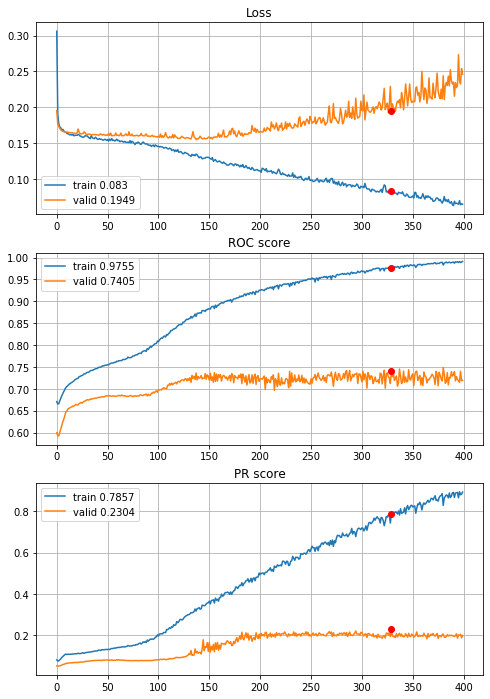


Fold 2------------------------------------------------------------


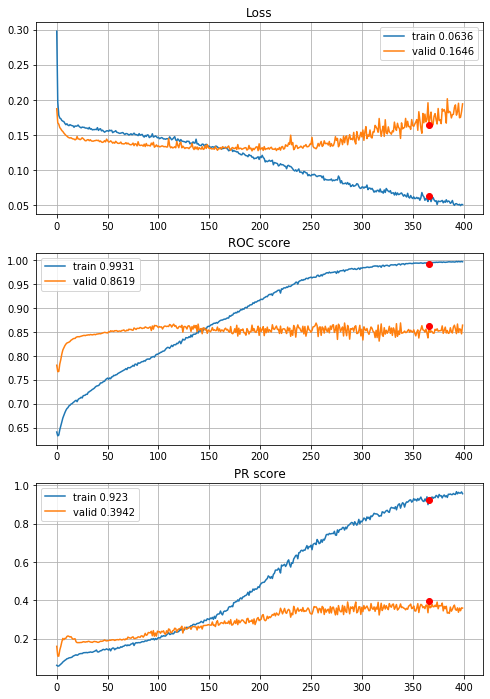


Fold 3------------------------------------------------------------


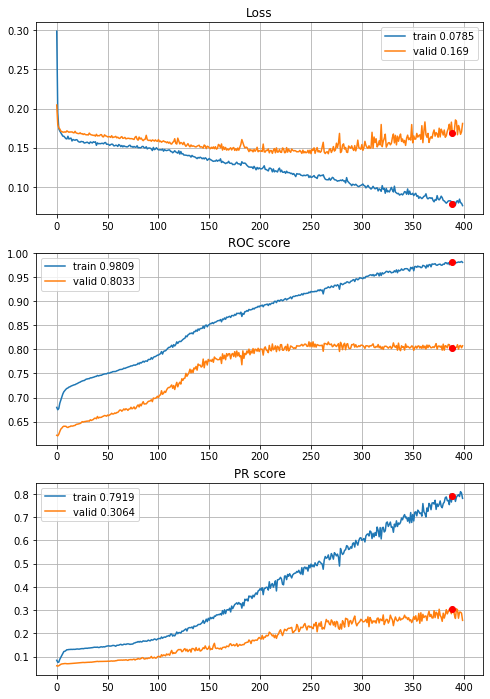


Fold 4------------------------------------------------------------


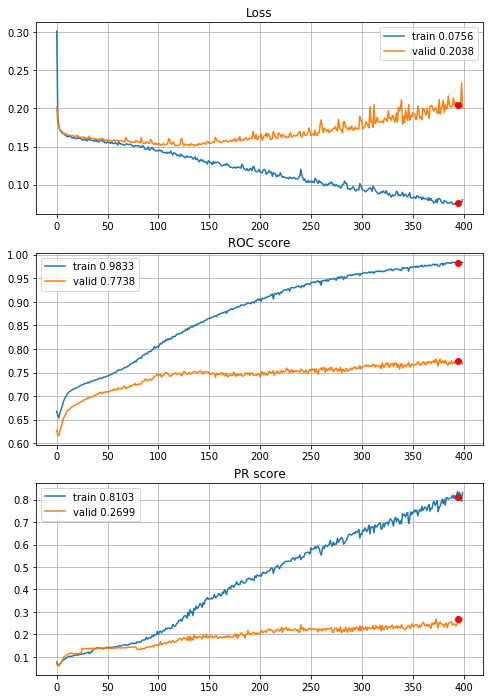


Fold 5------------------------------------------------------------


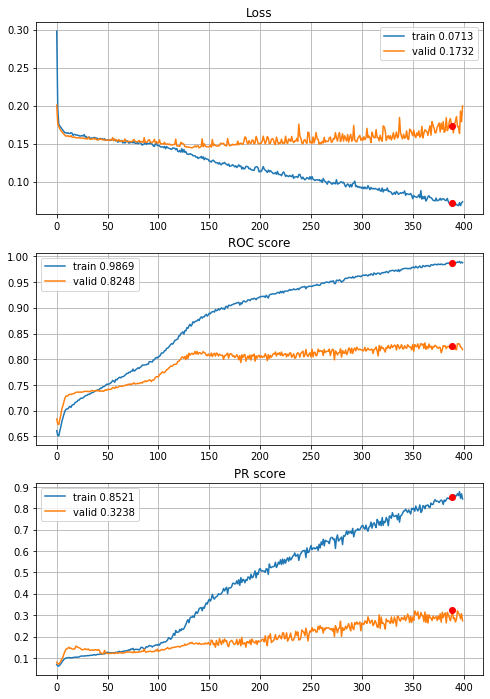


Fold 6------------------------------------------------------------


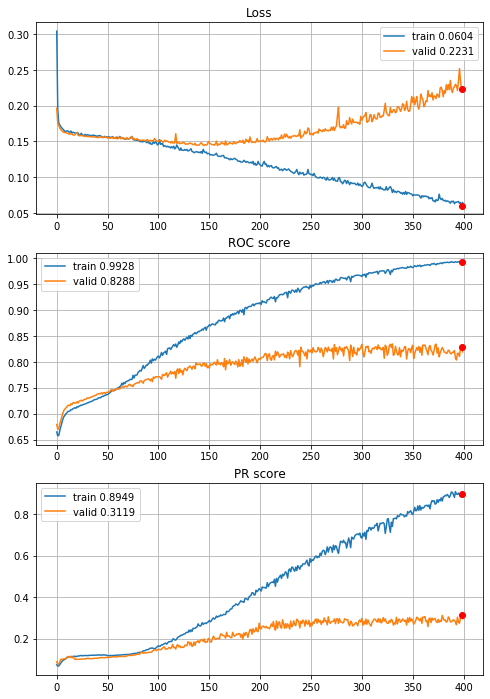

In [63]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_bigger_drop_04, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\1year\define_deep_CNN_2inc_std_L2_bigger_drop_04_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Considering all the aspects of the models, the one for 2 year horizon looks the best.

To sum up, best 8x8 CNN configuration is:
 - definition: define_deep_CNN_2inc_std_L2_drop_04($\cdot$)
 - 8x8x1 input,
 - 2 inceptions $i^{[1]},i^{[2]}$,
     - $i^{[1]}:f_1=f_{2\_out}=f_{3\_out}=f_{4}=4, f_{2\_in}=f_{3\_in}=1$,
     - $i^{[2]}:f_1=f_{2\_out}=f_{3\_out}=f_{4}=8, f_{2\_in}=f_{3\_in}=4$,
     - relu activations,
 - 1 average pooling $f=(2,2),s=(2,2),p=\text{valid}$,
 - flatten ($512 \text{ units}$),
 - 1 dense layer $l^{[1]}$,
     - units: $u^{[1]}=256$,
     - activation: $a^{[1]}=relu$,
     - regularization: $L_2^{[1]}=0.00005$,
     - dropout: $0.4$
 - optimizer: Adam with default setings,
 - 326 epochs
 - 394 batch size.
Because of small image size (8x8) CNN may be a bit under-trained, to fix it image dimensions has to increase. To do so feature generation method will be applied.

##### Feature generation for CNN
 - first, lets train the best XGBoost configuration and save the models (XGBoost achived much better results than Random Forest), note: best configuration excludes power transform from preprocessing pipeline, to get more reliable results best configuration with power transform will be used (CNN uses it too),

In [44]:
# Loading XGBoost random search results
with open(r"results\1year\XGB_RS.p", "rb") as fp:
    xgbrs = pickle.load(fp)

# printing the best ones with power transform included into preprocessing 
xgbrs.sort_values(by="PRvalid", ascending=False).where(xgbrs.norm_mode==3).dropna().head(5)

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
72,5.0,0.08,0.8,0.5,2.3,0.1,0.9,92.5,0.827061,0.155396,0.344337,0.549378,3.0
79,6.0,0.06,0.7,1.0,1.4,0.6,0.4,92.5,0.836745,0.156462,0.343563,0.605109,3.0
117,4.0,0.05,0.9,1.0,2.6,0.8,0.6,152.5,0.825940,0.143720,0.342935,0.467847,3.0
27,5.0,0.06,0.8,1.0,1.4,0.5,1.0,94.0,0.824080,0.156766,0.340253,0.540504,3.0
0,5.0,0.09,0.8,0.9,2.4,1.0,0.5,109.5,0.833266,0.163026,0.339534,0.619583,3.0


The best XGBoost with power transform is 104 index (higher PR, lowest overfitting among considered ones (top 5))

In [45]:
XGB_fi_hist, XGB_fi_models = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target,
                                                      random_state=random_state, info=0, normalize="power", q=None,
                                                      n_estimators=93, early_stopping_rounds=93, max_depth=5,
                                                      learning_rate=0.08, subsample=0.8, colsample_bytree=0.5, gamma=2.3, 
                                                      reg_alpha=0.1, reg_lambda=0.9, saveModels=True)


Cross validation time: 10s


 - second, lets create importance score table for each fold and on average,

In [46]:
XGBimportance=pd.DataFrame((features,
                           XGB_fi_models[0].feature_importances_,
                           XGB_fi_models[1].feature_importances_,
                           XGB_fi_models[2].feature_importances_,
                           XGB_fi_models[3].feature_importances_,
                           XGB_fi_models[4].feature_importances_,
                           XGB_fi_models[5].feature_importances_)).T

XGBimportance.columns = ("feature", "fold_1", "fold_2", "fold_3", "fold_4", "fold_5", "fold_6")
XGBimportance["folds_mean_naive"] = XGBimportance.loc[:, ["fold_1", "fold_2", "fold_3", "fold_4", "fold_5", "fold_6"]].mean(axis=1)
# normalize folds mean to sum up to 1
for i in range(len(features)):
    XGBimportance.loc[i,"folds_mean"]=XGBimportance.loc[i,"folds_mean_naive"]/XGBimportance["folds_mean_naive"].sum()

XGBimportance.drop(labels="folds_mean_naive",axis=1, inplace=True)
XGBimportance.sort_values(by="folds_mean", ascending=False, ignore_index=True, inplace=True)

XGBimportance

,feature,fold_1,fold_2,fold_3,fold_4,fold_5,fold_6,folds_mean
0,Attr24,0.0253918,0.0268981,0.0264956,0.0292421,0.0261679,0.0250584,0.026542
1,Attr16,0.0236331,0.0228241,0.0208267,0.0200587,0.019245,0.0237316,0.021720
2,Attr44,0.0285949,0.020321,0.020775,0.0193447,0.0212008,0.015985,0.021037
3,Attr13,0.0209479,0.0215296,0.0186772,0.0206271,0.0180365,0.0252116,0.020838
4,Attr46,0.0218894,0.0197164,0.0225483,0.019861,0.0228469,0.0177696,0.020772
5,Attr49,0.0227685,0.0204815,0.0210242,0.0215905,0.0155349,0.0207561,0.020359
6,Attr42,0.0234062,0.019963,0.0186088,0.0189668,0.0190839,0.0215228,0.020259
7,Attr58,0.0200003,0.0195565,0.0214904,0.0183013,0.0201364,0.0213317,0.020136
8,Attr5,0.0217225,0.0218716,0.0181286,0.0208152,0.0197539,0.0180097,0.020050
9,Attr48,0.0181379,0.0187267,0.0180636,0.0206002,0.0219364,0.0216708,0.019856


 - third, define the discrete probability distribution, where Attributes are events and its fold's average XGBoost importance score is the probability of that event (score average sums up to 1), then sample needed number of attributes pair and one of basic arithmetic operation to perform on them with uniform probability (addition, subtraction, multiplication, division) dealing with duplicates and commutative property of these basic operations to create instruction how to generate new features - feature_generation_instruction(),
 - fourth, define the function which will generate features by instruction and prevent dividing by 0 - generate_features(),

In [47]:
def feature_generation_instruction(image_shape, importance, random_state=random_state):
    '''
    function generates instruction how to create new features. The idea is to sample two features from discrete probability
    distribution with P(x=feature)=Importance(feature) and sample one of arithmetic operations in ["add", "subtract",
    "multiply", "divide"] uniformly distributed. Duplicates are not allowed. Different features sampling order for the same
    operation is forbidden too, arguments:
    image_shape - shape of image to create from all features (original and generated), tuple,
    importance - dataframe with importance score, needs to contain columns ["feature", "folds_mean"], where "folds_mean" is Importance(feature),
    random_state - random seed
    
    return feature generation instruction (pandas.DataFrame, colnames=["feature1", "feature2", "operation"])
    '''
    # random seeds
    np.random.seed(random_state)
    random.seed(random_state)

    # computing number of features to generate
    n_features = image_shape[0]*image_shape[1]-importance.shape[0]
    
    # check if it is possible to generate n_features
        # division by 2 because of we don't want (Attr1, Attr2, add) and (Attr2, Attr1, add) in our instruction
    if n_features > (importance.shape[0]*(importance.shape[0]-1)*4)/2:
        raise "Too may features to generate, maximum number of features with given importance is {}\
        ".format((importance.shape[0]*(importance.shape[0]-1)*4)/2)
    elif n_features <= 0:
        raise "image.shape[0]*image.shape[1]-importance.shape[0]<=0, there is no features to generate."

    # generate first row
    bse=np.random.choice(a=importance.feature.values, p=importance.folds_mean.values,size=(2,),replace=False)
    bse=np.append(bse, np.random.choice(a=["add", "subtract", "multiply", "divide"]))
    bse=bse.reshape(1,-1) # needed for condition below (np.any(np.all()))
    # iterator (iterate through number of valid generated features) 
    i=1
    while True:
        # generate next row
        bse_tmp=np.random.choice(a=importance.feature.values, p=importance.folds_mean.values,size=(2,),replace=False)
        bse_tmp=np.append(bse_tmp, np.random.choice(a=["add", "subtract", "multiply", "divide"]))
        # validate generated row
        if not np.any(np.all(bse==bse_tmp, axis=1)) and not np.any(np.all(np.array((bse_tmp[1], bse_tmp[0], bse_tmp[2]), dtype="object")==bse, axis=1)):
            # append
            bse=np.vstack((bse, bse_tmp))
            i+=1
        else:
            continue
        # stop generating rows when number of generated features is enough
        if i == n_features:
            break
    
    # convert to dataframe
    bse=pd.DataFrame(data=bse, columns=["feature1", "feature2", "operation"])
    
    return bse

def generate_features(data, instruction):
    '''
    function that generates new features for given dataframe with given istruction, arguments:
    data - dataframe with features,
    instruction - dataframe with 2 columns of features from data and column with arithmetic operation [+,-,*,/] to perform,
    
    return dataframe with old and generated features
    '''
    
    data_wgf=data.copy()
    
    for i in range(instruction.shape[0]):
        feature1=data[instruction.iloc[i,0]]
        feature2=data[instruction.iloc[i,1]]
        operation=instruction.iloc[i,2]
        if operation == "add":
            data_wgf["v"+str(i)]=feature1+feature2
        elif operation == "subtract":
            data_wgf["v"+str(i)]=feature1-feature2
        elif operation == "multiply":
            data_wgf["v"+str(i)]=feature1*feature2
        else:
            # prevent dividing by 0, when feature2==0 assign it to 1, then it won't cause an error 
            feature2.loc[feature2==0]=1
            data_wgf["v"+str(i)]=feature1/feature2
        
    return data_wgf

 - fifth generate instruction,

In [48]:
instruction=feature_generation_instruction(image_shape=(20,20), importance=XGBimportance, random_state=random_state)
instruction

,feature1,feature2,operation
0,Attr35,Attr41,subtract
1,Attr15,Attr25,multiply
2,Attr49,Attr5,add
3,Attr26,Attr39,multiply
4,Attr46,Attr44,multiply
...,...,...,...
335,Attr17,Attr29,subtract
336,Attr53,Attr17,add
337,Attr18,Attr15,multiply
338,Attr54,Attr64,add


 - sixth perform Monte Carlo quasi optimization for image conversion with generated features for each of 6 folds (it will take a loooot of time) and save the results, 

In [61]:
# FOLD 1
# CV sets
fold=sets["training_sets"][0].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\1year_data\draft_20x20_fold_1.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 3138690.4929
iteration: 100
current energy: 3029756.0487
iteration: 200
current energy: 2944775.7843
iteration: 300
current energy: 2879253.9371
iteration: 400
current energy: 2822754.5929
iteration: 500
current energy: 2758074.7439
iteration: 600
current energy: 2722811.6669
iteration: 700
current energy: 2688410.3743
iteration: 800
current energy: 2661070.0248
iteration: 900
current energy: 2639104.1698
iteration: 1000
current energy: 2610348.8001
iteration: 1100
current energy: 2593887.3759
iteration: 1200
current energy: 2562247.7163
iteration: 1300
current energy: 2536403.4226
iteration: 1400
current energy: 2528119.3453
iteration: 1500
current energy: 2504285.5487
iteration: 1600
current energy: 2487945.6942
iteration: 1700
current energy: 2478266.5017
iteration: 1800
current energy: 2470719.3895
iteration: 1900
current energy: 2460291.5101
iteration: 2000
current energy: 2451156.326
iteration: 2100
current energy: 2444267.2478
iteration: 2200
current energy

In [62]:
# FOLD 2
# CV sets
fold=sets["training_sets"][1].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\1year_data\draft_20x20_fold_2.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 3136698.5634
iteration: 100
current energy: 3026659.6098
iteration: 200
current energy: 2941385.1251
iteration: 300
current energy: 2871450.0011
iteration: 400
current energy: 2816546.3621
iteration: 500
current energy: 2741902.8649
iteration: 600
current energy: 2709155.7944
iteration: 700
current energy: 2673431.0183
iteration: 800
current energy: 2645219.4862
iteration: 900
current energy: 2631630.2035
iteration: 1000
current energy: 2601394.0148
iteration: 1100
current energy: 2584516.5327
iteration: 1200
current energy: 2561373.42
iteration: 1300
current energy: 2519227.1077
iteration: 1400
current energy: 2498932.9834
iteration: 1500
current energy: 2471477.6168
iteration: 1600
current energy: 2457024.1395
iteration: 1700
current energy: 2450206.4835
iteration: 1800
current energy: 2445746.1953
iteration: 1900
current energy: 2435298.3848
iteration: 2000
current energy: 2421097.8472
iteration: 2100
current energy: 2414961.8365
iteration: 2200
current energy:

In [63]:
# FOLD 3
# CV sets
fold=sets["training_sets"][2].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\1year_data\draft_20x20_fold_3.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 3146897.7957
iteration: 100
current energy: 3037270.6875
iteration: 200
current energy: 2952072.0678
iteration: 300
current energy: 2881363.1033
iteration: 400
current energy: 2827142.0322
iteration: 500
current energy: 2751925.3465
iteration: 600
current energy: 2715230.3543
iteration: 700
current energy: 2679854.2784
iteration: 800
current energy: 2645493.2371
iteration: 900
current energy: 2633560.2661
iteration: 1000
current energy: 2603043.8583
iteration: 1100
current energy: 2585576.653
iteration: 1200
current energy: 2556729.4578
iteration: 1300
current energy: 2523770.4919
iteration: 1400
current energy: 2506994.6021
iteration: 1500
current energy: 2487131.4429
iteration: 1600
current energy: 2472560.1708
iteration: 1700
current energy: 2460002.5346
iteration: 1800
current energy: 2453431.1315
iteration: 1900
current energy: 2445072.9838
iteration: 2000
current energy: 2426525.874
iteration: 2100
current energy: 2422833.3169
iteration: 2200
current energy:

In [64]:
# FOLD 4
# CV sets
fold=sets["training_sets"][3].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\1year_data\draft_20x20_fold_4.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 3137258.1293
iteration: 100
current energy: 3027125.8089
iteration: 200
current energy: 2942414.5111
iteration: 300
current energy: 2875353.8283
iteration: 400
current energy: 2821796.7464
iteration: 500
current energy: 2752217.0437
iteration: 600
current energy: 2715512.2298
iteration: 700
current energy: 2683614.8871
iteration: 800
current energy: 2655821.0071
iteration: 900
current energy: 2643772.1013
iteration: 1000
current energy: 2609604.5183
iteration: 1100
current energy: 2596443.0123
iteration: 1200
current energy: 2569586.3978
iteration: 1300
current energy: 2545272.5367
iteration: 1400
current energy: 2518732.0243
iteration: 1500
current energy: 2492973.6403
iteration: 1600
current energy: 2481467.8824
iteration: 1700
current energy: 2473311.2068
iteration: 1800
current energy: 2466573.0215
iteration: 1900
current energy: 2455377.9557
iteration: 2000
current energy: 2445752.6401
iteration: 2100
current energy: 2436277.7945
iteration: 2200
current energ

In [65]:
# FOLD 5
# CV sets
fold=sets["training_sets"][4].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\1year_data\draft_20x20_fold_5.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 3151093.9119
iteration: 100
current energy: 3042097.536
iteration: 200
current energy: 2955752.0865
iteration: 300
current energy: 2888994.5788
iteration: 400
current energy: 2835023.7765
iteration: 500
current energy: 2765512.0344
iteration: 600
current energy: 2727961.4069
iteration: 700
current energy: 2691193.7781
iteration: 800
current energy: 2659523.3738
iteration: 900
current energy: 2645992.946
iteration: 1000
current energy: 2616112.7002
iteration: 1100
current energy: 2601983.6587
iteration: 1200
current energy: 2571559.9753
iteration: 1300
current energy: 2542443.5746
iteration: 1400
current energy: 2526256.3598
iteration: 1500
current energy: 2510581.1307
iteration: 1600
current energy: 2495163.6795
iteration: 1700
current energy: 2482464.1701
iteration: 1800
current energy: 2475981.9921
iteration: 1900
current energy: 2462633.0659
iteration: 2000
current energy: 2450768.0049
iteration: 2100
current energy: 2443070.6489
iteration: 2200
current energy:

In [66]:
# FOLD 6
# CV sets
fold=sets["training_sets"][5].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\1year_data\draft_20x20_fold_6.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 3134754.4756
iteration: 100
current energy: 3025830.6368
iteration: 200
current energy: 2941067.7107
iteration: 300
current energy: 2871098.148
iteration: 400
current energy: 2817247.4458
iteration: 500
current energy: 2741799.8503
iteration: 600
current energy: 2706079.3995
iteration: 700
current energy: 2668313.9461
iteration: 800
current energy: 2638036.0826
iteration: 900
current energy: 2623466.9177
iteration: 1000
current energy: 2590087.5946
iteration: 1100
current energy: 2571604.6945
iteration: 1200
current energy: 2541657.2918
iteration: 1300
current energy: 2506465.3002
iteration: 1400
current energy: 2487631.2456
iteration: 1500
current energy: 2471352.7787
iteration: 1600
current energy: 2458987.0896
iteration: 1700
current energy: 2446807.2747
iteration: 1800
current energy: 2442652.3151
iteration: 1900
current energy: 2434416.931
iteration: 2000
current energy: 2418537.9837
iteration: 2100
current energy: 2409894.7961
iteration: 2200
current energy:

In [67]:
# with open(r"data\1year_data\draft_20x20_fold_1.p", "rb") as fp:
#     draft_1 = pickle.load(fp)
# with open(r"data\1year_data\draft_20x20_fold_2.p", "rb") as fp:
#     draft_2 = pickle.load(fp)
# with open(r"data\1year_data\draft_20x20_fold_3.p", "rb") as fp:
#     draft_3 = pickle.load(fp)
# with open(r"data\1year_data\draft_20x20_fold_4.p", "rb") as fp:
#     draft_4 = pickle.load(fp)
# with open(r"data\1year_data\draft_20x20_fold_5.p", "rb") as fp:
#     draft_5 = pickle.load(fp)
# with open(r"data\1year_data\draft_20x20_fold_6.p", "rb") as fp:
#     draft_6 = pickle.load(fp)
# optimized_drafts=[draft_1,draft_2,draft_3,draft_4,draft_5,draft_6]

In [68]:
# # initial draft re-creation and saving (I forgot about saving when MC optimization was performed)
# train_folds=sets["training_sets"]
# initial_drafts=[]
# for fold in range(len(train_folds)):
#     X_train_fold=generate_features(train_folds[fold][features], instruction)
#     Y_train_fold=train_folds[fold][target].copy()
#     features_imp=X_train_fold.columns.tolist()
#     corr_matrix=X_train_fold[Y_train_fold==0].corr(method="spearman")
#     draft=image_dict_to_matrix(image_draft_inicialization(features_imp, random_state))
#     initial_drafts.append(draft)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [69]:
# drafts=dict(zip(["initial_drafts", "optimized_drafts"], [initial_drafts, optimized_drafts]))

# # saving drafts
# with open(r"data\1year_data\drafts_20x20.p", "wb") as fp:
#     pickle.dump(drafts, fp)

In [49]:
# LOADING 20x20 drafts
with open(r"data\1year_data\drafts_20x20.p", "rb") as fp:
    drafts_20x20 = pickle.load(fp)

			 Normalization only

			-----FOLD 1 -----


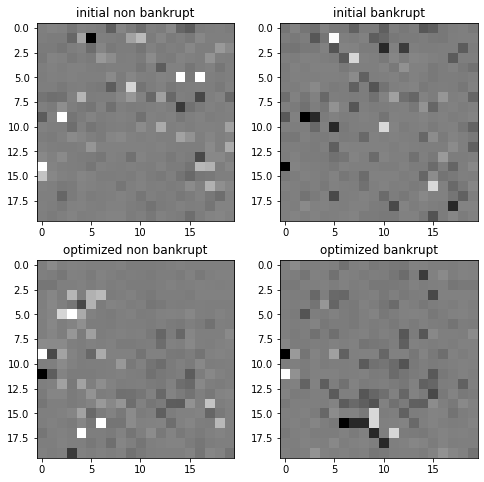


			-----FOLD 2 -----


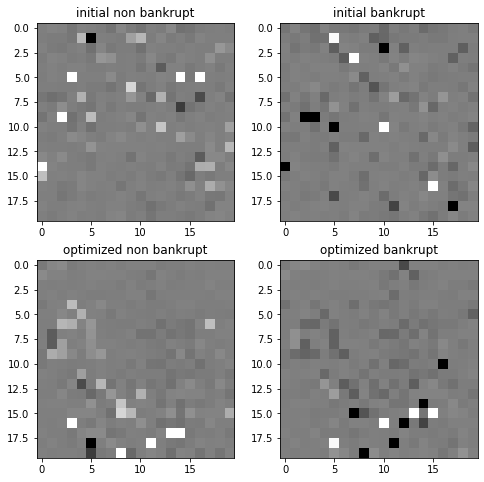


			-----FOLD 3 -----


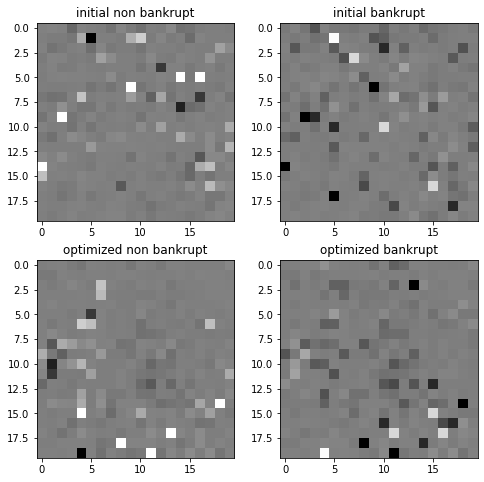


			-----FOLD 4 -----


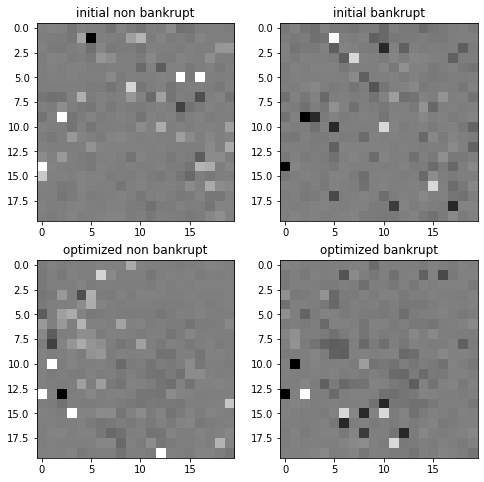


			-----FOLD 5 -----


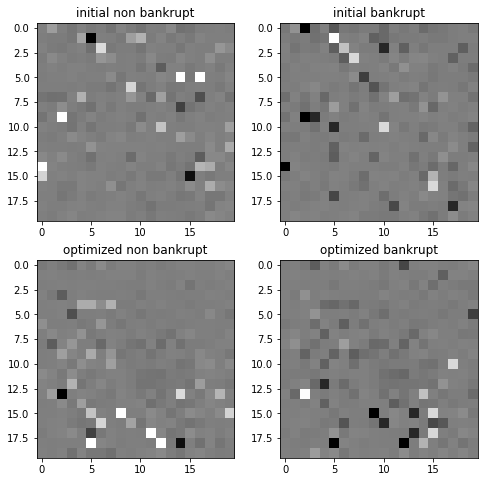


			-----FOLD 6 -----


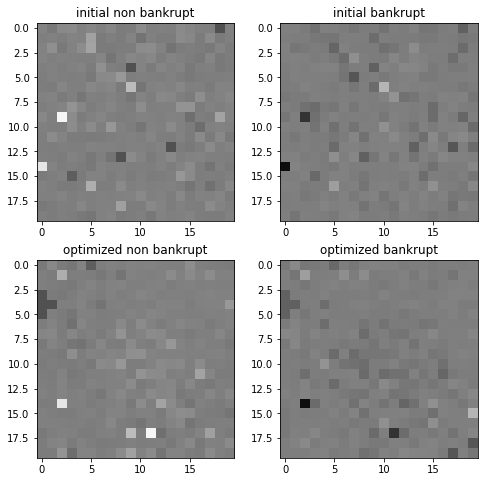

In [50]:
# printing images for normalization only
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t\t Normalization only")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=None, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

		 Normalization andquantile clipping

			-----FOLD 1 -----


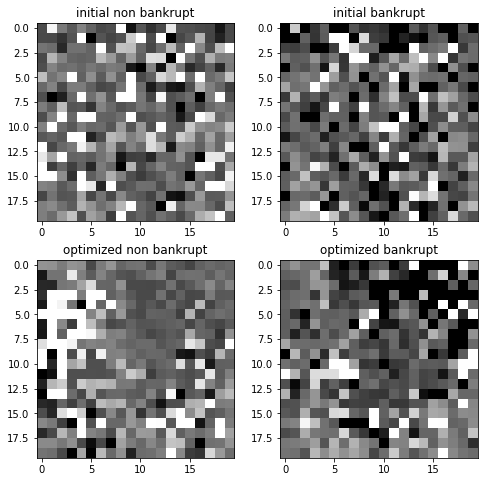


			-----FOLD 2 -----


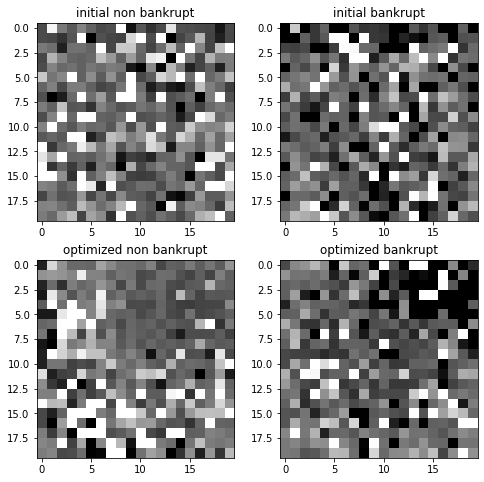


			-----FOLD 3 -----


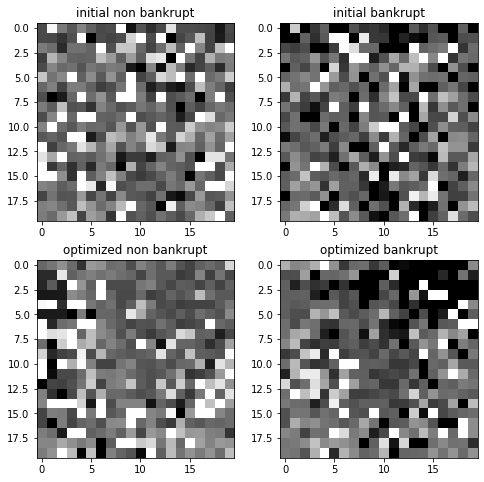


			-----FOLD 4 -----


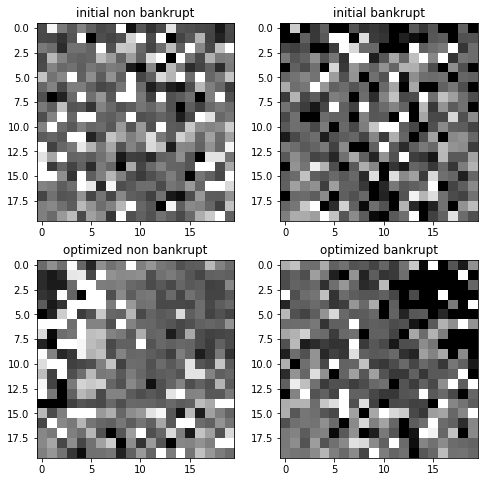


			-----FOLD 5 -----


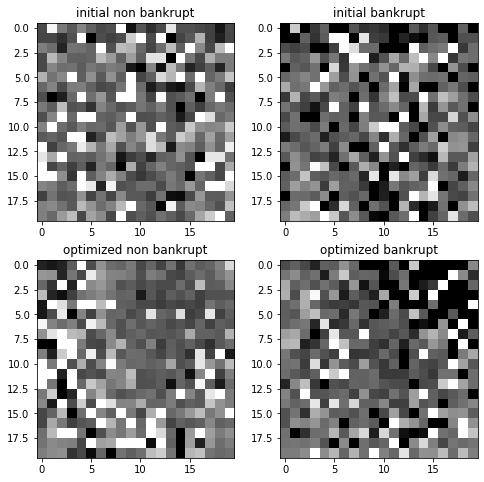


			-----FOLD 6 -----


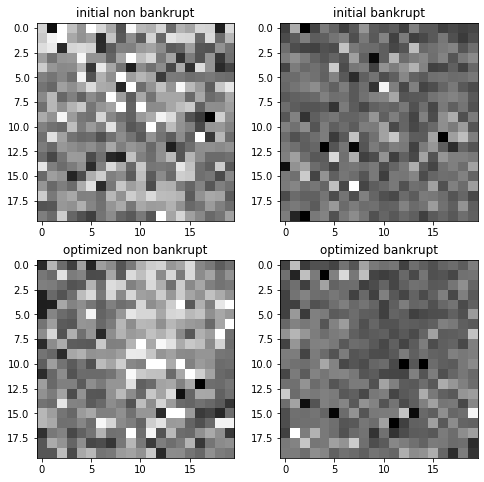

In [51]:
# printing images for normalization and quantile clipping
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t Normalization andquantile clipping")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

	 Normalization, quantile clipping and power transform

			-----FOLD 1 -----


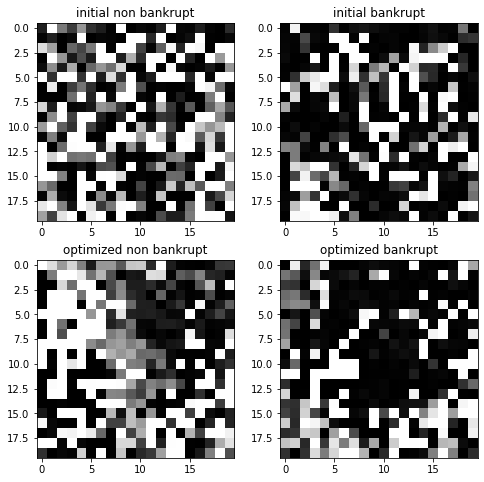


			-----FOLD 2 -----


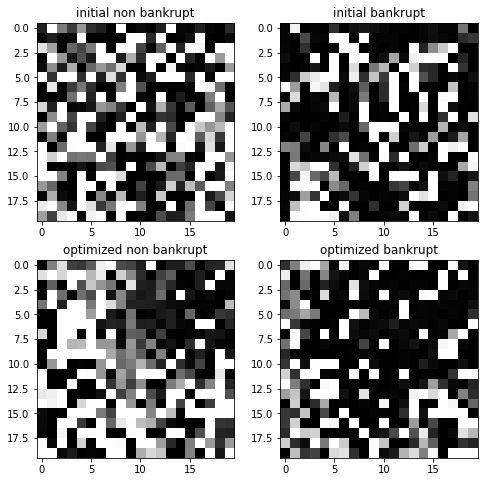


			-----FOLD 3 -----


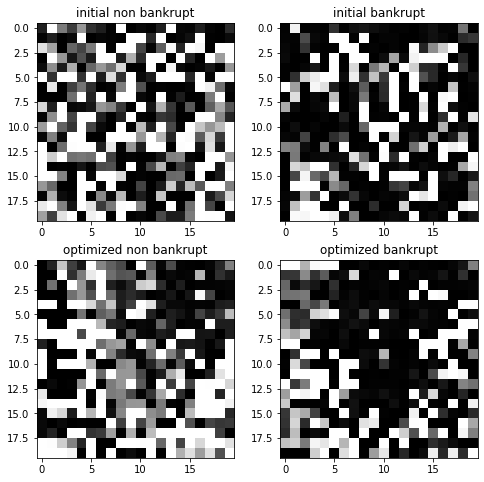


			-----FOLD 4 -----


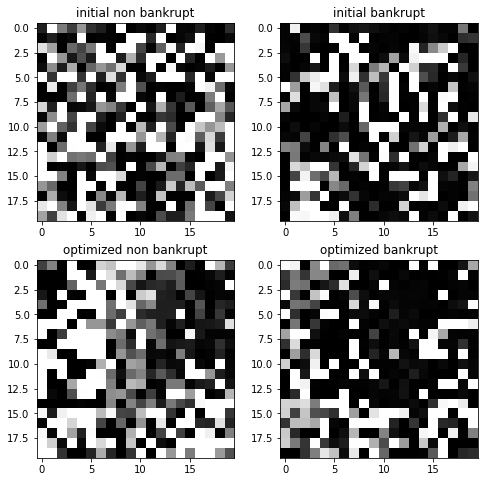


			-----FOLD 5 -----


C:\Users\maciej\anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:3237: RuntimeWarning: divide by zero encountered in log
  loglike = -n_samples / 2 * np.log(x_trans.var())


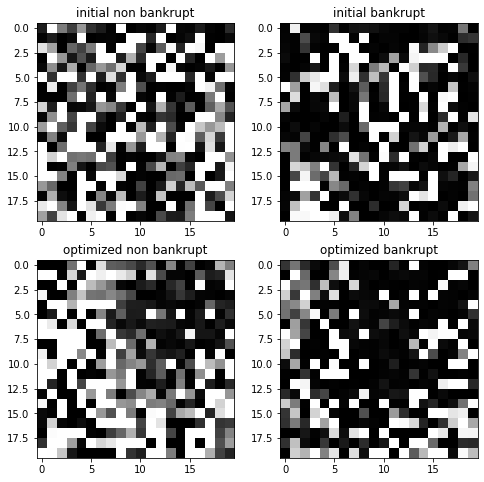


			-----FOLD 6 -----


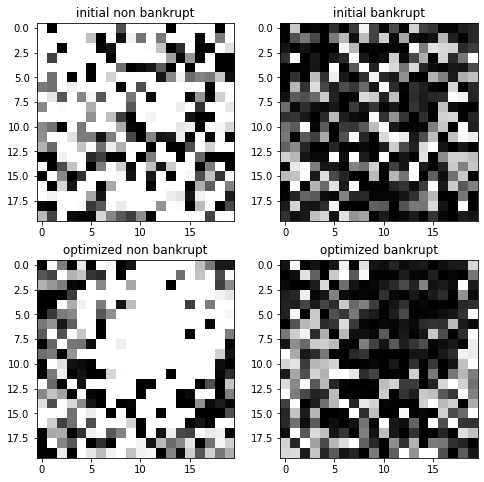

In [52]:
# printing images for normalization with quantile clipping and power transform

# NOTE: "v279" causes error while power transform applied. To handle it this feature is replaced with neutral value (128)
# (there is no time left for computing drafts again)

train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t Normalization, quantile clipping and power transform")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    # *** v279 feature is deleted here ***
    X_train_fold.drop(labels="v279",axis=1, inplace=True)
    # ************************************
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.2, power_transform=True)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    # *** v279 feature is deleted from drafts here ***
    curr_initial_draft=drafts_20x20["initial_drafts"][fold].copy()
    curr_opti_draft=drafts_20x20["optimized_drafts"][fold].copy()
    curr_initial_draft[curr_initial_draft=="v279"]=128
    curr_opti_draft[curr_opti_draft=="v279"]=128
    # ************************************************
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=curr_initial_draft,example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=curr_initial_draft,example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=curr_opti_draft,example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=curr_opti_draft,example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

v279 feature deletion requires some changes to my CNN_6FoldCrossValidation wrapper, so the special version is written below

In [53]:
def CNN_6FoldCrossValidation_v279delete(datasets, model_definition, features, target, n_epochs, batch_size, alpha,
                                        random_state, normalize="power", q=None, drafts=None, instruction=None, info=None):
    '''
    function performes 6 fold Cross Validation for Multilayer Percepton keras model, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    n_epochs - number of epochs for training MLP model,
    batch_size - number of weight matrices updates per loop through entire, current trainin dataset,
    alpha - Monte Carlo duration parameter,
    random_state - random seed,
    info - same arguent as for network_training(),
    *args and **kwargs - arguments for create_MLP() function
    
    returns CNNhistories - list of every CNN model history 
    '''
    # seeds
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]
    
    CVstart=time.time()
    # history of CV
    CNNhistories=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2:
            print("\n----------\nFold: {}\n----------".format(fold+1))  
            
        # ----- current fold train and validation sets with feature generation -----
        X_train = generate_features(data=training_sets[fold][features], instruction=instruction)
        Y_train = training_sets[fold][target].copy()
        X_valid = generate_features(data=validation_sets[fold][features].copy(), instruction=instruction)
        Y_valid = validation_sets[fold][target].copy()
        
         # *** v279 feature is deleted here ***
        X_train.drop(labels="v279",axis=1, inplace=True)
        X_valid.drop(labels="v279",axis=1, inplace=True)
        # ************************************

        # ----- loading draft from passed object -----
        draft = drafts[fold]
        # *** v279 feature is deleted from draft here ***
        draft[draft=="v279"]=128
        # ************************************************

        # temporary features list
        features_tmp = X_train.columns.tolist()
            
        # ----- standarization for CNN (images) -----
        if normalize==True:
            normalizer = scaler(images=True)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features_tmp)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features_tmp)
        elif normalize=="power":
            normalizer = scaler(images=True)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features_tmp)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features_tmp)
        else:
            pass
            
        # ----- vector to image conversion -----
        # training set
        X_train_CNN = np.array([map_image(draft, X_train.iloc[i,:])/255 for i in range(X_train.shape[0])])
        X_train_CNN = X_train_CNN.reshape(X_train_CNN.shape+(1,))
        Y_train_CNN = Y_train.values
        # validation set
        X_valid_CNN = np.array([map_image(draft, X_valid.iloc[i,:])/255 for i in range(X_valid.shape[0])])
        X_valid_CNN = X_valid_CNN.reshape(X_valid_CNN.shape+(1,))
        Y_valid_CNN = Y_valid.values
        
        # ----- CNN training -----
        modelCNN = model_definition(input_shape=X_train_CNN.shape[1:], random_state=random_state)
        modelCNN, historyCNN = network_training(network=modelCNN, X_train=X_train_CNN, Y_train=Y_train_CNN,
                                                X_val=X_valid_CNN, Y_val=Y_valid_CNN, n_epochs=n_epochs,
                                                batch_size=batch_size, random_state=random_state, info=info)
        # ----- MLP history saving -----
        CNNhistories.append(historyCNN.copy())

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    return CNNhistories

The best 8x8 models on 20x20 data


----------
Fold: 1
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 5270 samples, validate on 1054 samples
Epoch: 1/300,
cumulative time: 14.44s train loss: 0.25916500909844203, validation loss: 0.18133839716042693
Epoch: 2/300,
cumulative time: 23.0s train loss: 0.18288079608776087, validation loss: 0.1728153577396042
Epoch: 3/300,
cumulative time: 31.58s train loss: 0.17429913258077523, validation loss: 0.17038912403854972
Epoch: 4/300,
cumulative time: 40.22s train loss: 0.1732112462934552, validation loss: 0.1685044275458895
Epoch: 5/300,
cumulative time: 48.77s train loss: 0.1736427477573308, validation loss: 0.16762477430944425
Epoch: 6/300,
cumulative time: 57.34s train loss: 0.17030051853331035, validation loss: 0.16607441092917316
Epoch: 7/300,
cumulative time: 65.92s train loss: 0.17034322264864052, validation loss: 0.1649986589486504
Epoch: 8/300,
cumulative time: 74.46s train loss: 0.1687933100412195, validation loss: 0.16467271736722291
Epoch: 9/300,
cumulative time: 83.07s train loss: 0.16501544223394973, validation loss: 0.16861

Epoch: 76/300,
cumulative time: 656.83s train loss: 0.1144731728893756, validation loss: 0.16487899631883884
Epoch: 77/300,
cumulative time: 665.28s train loss: 0.11594682286937051, validation loss: 0.17983939491594086
Epoch: 78/300,
cumulative time: 673.99s train loss: 0.11626127882236774, validation loss: 0.16055303690442552
Epoch: 79/300,
cumulative time: 682.84s train loss: 0.11250527488099556, validation loss: 0.1675929818761869
Epoch: 80/300,
cumulative time: 691.34s train loss: 0.11190349020813177, validation loss: 0.17627464701373843
Epoch: 81/300,
cumulative time: 699.8s train loss: 0.11465450724908478, validation loss: 0.17609532683578796
Epoch: 82/300,
cumulative time: 708.18s train loss: 0.11408099661346179, validation loss: 0.17424229853406578
Epoch: 83/300,
cumulative time: 716.7s train loss: 0.11485320312418114, validation loss: 0.16369250937023924
Epoch: 84/300,
cumulative time: 725.28s train loss: 0.10902472473468908, validation loss: 0.1651027028146686
Epoch: 85/300,


Epoch: 151/300,
cumulative time: 1296.4s train loss: 0.06620724133058563, validation loss: 0.21836027556736962
Epoch: 152/300,
cumulative time: 1304.91s train loss: 0.06112564266350057, validation loss: 0.24121094637849072
Epoch: 153/300,
cumulative time: 1313.44s train loss: 0.06466098616228384, validation loss: 0.21197660202319527
Epoch: 154/300,
cumulative time: 1322.05s train loss: 0.06613171300523873, validation loss: 0.26977495097005616
Epoch: 155/300,
cumulative time: 1330.73s train loss: 0.0693758424321999, validation loss: 0.21179481215449844
Epoch: 156/300,
cumulative time: 1339.24s train loss: 0.0632497284497776, validation loss: 0.2218244817157398
Epoch: 157/300,
cumulative time: 1347.81s train loss: 0.06326614304726672, validation loss: 0.24132278561592102
Epoch: 158/300,
cumulative time: 1356.4s train loss: 0.06372477462412736, validation loss: 0.2157452900450415
Epoch: 159/300,
cumulative time: 1364.91s train loss: 0.06475269622690763, validation loss: 0.2225654610985823

Epoch: 225/300,
cumulative time: 1926.14s train loss: 0.03402517498232269, validation loss: 0.35206462010260553
Epoch: 226/300,
cumulative time: 1934.67s train loss: 0.03298510234216246, validation loss: 0.3485305681117798
Epoch: 227/300,
cumulative time: 1943.23s train loss: 0.031235858905473743, validation loss: 0.3447582560822905
Epoch: 228/300,
cumulative time: 1951.73s train loss: 0.03520424675118652, validation loss: 0.37431629700497837
Epoch: 229/300,
cumulative time: 1960.2s train loss: 0.03461310534580722, validation loss: 0.33264810123977445
Epoch: 230/300,
cumulative time: 1968.69s train loss: 0.033642234451065026, validation loss: 0.3843949754957456
Epoch: 231/300,
cumulative time: 1977.15s train loss: 0.03355477884468363, validation loss: 0.3539018680746234
Epoch: 232/300,
cumulative time: 1985.64s train loss: 0.03151393340338566, validation loss: 0.34375495145510904
Epoch: 233/300,
cumulative time: 1994.11s train loss: 0.030791123232590405, validation loss: 0.365806573199

Epoch: 299/300,
cumulative time: 2558.24s train loss: 0.02881701535048702, validation loss: 0.4238981351228095
Epoch: 300/300,
cumulative time: 2566.63s train loss: 0.029436419699235026, validation loss: 0.4305060492860298

Early stopping results:
best results in epoch: 235, 
best valid PR: 0.25714909676934233, 
valid ROC: 0.7431089743589744        
overfitting PR: 0.7420180291238969, 
overfitting ROC: 0.256858126575359

----------
Fold: 2
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 5270 samples, validate on 1054 samples
Epoch: 1/300,
cumulative time: 15.67s train loss: 0.2590452542567389, validation loss: 0.17679824636263006
Epoch: 2/300,
cumulative time: 24.33s train loss: 0.18313081452244825, validation loss: 0.16795442772205685
Epoch: 3/300,
cumulative time: 32.94s train loss: 0.17820823427848165, validation loss: 0.16449383947383295
Epoch: 4/300,
cumulative time: 41.52s train loss: 0.17447370971063508, validation loss: 0.1624368121829838
Epoch: 5/300,
cumulative time: 50.27s train loss: 0.17335701983217044, validation loss: 0.16049970612919534
Epoch: 6/300,
cumulative time: 58.94s train loss: 0.16957404144687943, validation loss: 0.15968671158323705
Epoch: 7/300,
cumulative time: 67.5s train loss: 0.17134518795832285, validation loss: 0.15604035762727148
Epoch: 8/300,
cumulative time: 76.09s train loss: 0.16913936950223948, validation loss: 0.15466995356318167
Epoch: 9/300,
cumulative time: 84.43s train loss: 0.16581616739846725, validation loss: 0.1

Epoch: 76/300,
cumulative time: 657.1s train loss: 0.1401304682642504, validation loss: 0.13872096739864892
Epoch: 77/300,
cumulative time: 665.97s train loss: 0.13492199225206303, validation loss: 0.1256947710657708
Epoch: 78/300,
cumulative time: 674.93s train loss: 0.13249896428277416, validation loss: 0.12578253004084955
Epoch: 79/300,
cumulative time: 683.89s train loss: 0.13162493283314317, validation loss: 0.12471521956814308
Epoch: 80/300,
cumulative time: 692.89s train loss: 0.13077210667463587, validation loss: 0.12492891287950682
Epoch: 81/300,
cumulative time: 701.97s train loss: 0.1286132637050844, validation loss: 0.12929976375268126
Epoch: 82/300,
cumulative time: 710.92s train loss: 0.13535092677178825, validation loss: 0.12765170339728216
Epoch: 83/300,
cumulative time: 719.74s train loss: 0.12994552230359935, validation loss: 0.12520485664002132
Epoch: 84/300,
cumulative time: 728.35s train loss: 0.13199345542708205, validation loss: 0.12998045975275238
Epoch: 85/300,

Epoch: 151/300,
cumulative time: 1313.35s train loss: 0.08651096422430234, validation loss: 0.1416472439182325
Epoch: 152/300,
cumulative time: 1321.71s train loss: 0.0871427189989945, validation loss: 0.13978586299256537
Epoch: 153/300,
cumulative time: 1330.09s train loss: 0.0852213176027421, validation loss: 0.14305882427339536
Epoch: 154/300,
cumulative time: 1338.63s train loss: 0.0826751102447736, validation loss: 0.1493663243822174
Epoch: 155/300,
cumulative time: 1347.24s train loss: 0.08282089919078056, validation loss: 0.15244732110052453
Epoch: 156/300,
cumulative time: 1356.85s train loss: 0.08454546080425071, validation loss: 0.1424854125763931
Epoch: 157/300,
cumulative time: 1365.35s train loss: 0.0833642318392388, validation loss: 0.15528547076731072
Epoch: 158/300,
cumulative time: 1373.86s train loss: 0.08290048592796362, validation loss: 0.14537430714384655
Epoch: 159/300,
cumulative time: 1382.44s train loss: 0.081713505027077, validation loss: 0.14260326956435895
E

Epoch: 225/300,
cumulative time: 1953.91s train loss: 0.045635926832340704, validation loss: 0.20461833731499296
Epoch: 226/300,
cumulative time: 1962.61s train loss: 0.04455870011471481, validation loss: 0.21810467569493253
Epoch: 227/300,
cumulative time: 1971.3s train loss: 0.043937580107907416, validation loss: 0.24009738217834278
Epoch: 228/300,
cumulative time: 1980.01s train loss: 0.04680899592572417, validation loss: 0.20274116695492725
Epoch: 229/300,
cumulative time: 1988.85s train loss: 0.045498330093764715, validation loss: 0.20806864800331037
Epoch: 230/300,
cumulative time: 1997.83s train loss: 0.042107920926170286, validation loss: 0.22423559495122428
Epoch: 231/300,
cumulative time: 2006.85s train loss: 0.04273409638871956, validation loss: 0.23474319265056154
Epoch: 232/300,
cumulative time: 2015.42s train loss: 0.04247769476594916, validation loss: 0.21764326601711578
Epoch: 233/300,
cumulative time: 2024.2s train loss: 0.0444343795953937, validation loss: 0.237901985

Epoch: 299/300,
cumulative time: 2590.18s train loss: 0.026329880792371915, validation loss: 0.35066229325544224
Epoch: 300/300,
cumulative time: 2599.03s train loss: 0.02683974162549968, validation loss: 0.35061553527779554

Early stopping results:
best results in epoch: 99, 
best valid PR: 0.3936930120624497, 
valid ROC: 0.8719674556213017        
overfitting PR: 0.02929970271417137, 
overfitting ROC: 0.033023429402269544

----------
Fold: 3
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 5270 samples, validate on 1054 samples
Epoch: 1/300,
cumulative time: 13.98s train loss: 0.25778881485593386, validation loss: 0.18249653751981326
Epoch: 2/300,
cumulative time: 22.92s train loss: 0.18064796829868313, validation loss: 0.17531320534688924
Epoch: 3/300,
cumulative time: 31.86s train loss: 0.17267739126419884, validation loss: 0.17265318124864315
Epoch: 4/300,
cumulative time: 40.75s train loss: 0.17262647414060425, validation loss: 0.17226193302383458
Epoch: 5/300,
cumulative time: 49.81s train loss: 0.17140740945906974, validation loss: 0.17209318642145768
Epoch: 6/300,
cumulative time: 58.87s train loss: 0.16915268455216736, validation loss: 0.17038962089472523
Epoch: 7/300,
cumulative time: 68.21s train loss: 0.16528655301631062, validation loss: 0.17086579923498563
Epoch: 8/300,
cumulative time: 77.17s train loss: 0.16400959526791292, validation loss: 0.17040170649989053
Epoch: 9/300,
cumulative time: 86.35s train loss: 0.16292334312619022, validation loss: 

Epoch: 76/300,
cumulative time: 685.7s train loss: 0.12840931466736422, validation loss: 0.15835909200461132
Epoch: 77/300,
cumulative time: 694.87s train loss: 0.1278917090970832, validation loss: 0.1575636505175813
Epoch: 78/300,
cumulative time: 703.92s train loss: 0.12848914900133687, validation loss: 0.15334404373021912
Epoch: 79/300,
cumulative time: 712.84s train loss: 0.1244420192640918, validation loss: 0.15572819574621188
Epoch: 80/300,
cumulative time: 722.13s train loss: 0.1274955871661655, validation loss: 0.15034835435011806
Epoch: 81/300,
cumulative time: 731.28s train loss: 0.12245014133444321, validation loss: 0.1506769725985726
Epoch: 82/300,
cumulative time: 740.37s train loss: 0.12437032459469854, validation loss: 0.15835223030263604
Epoch: 83/300,
cumulative time: 749.19s train loss: 0.12287519121475418, validation loss: 0.14880918847146024
Epoch: 84/300,
cumulative time: 758.2s train loss: 0.12298189248656412, validation loss: 0.15116682240078527
Epoch: 85/300,
cu

Epoch: 151/300,
cumulative time: 1363.16s train loss: 0.08276885900031457, validation loss: 0.15541205132482627
Epoch: 152/300,
cumulative time: 1371.94s train loss: 0.081378564488786, validation loss: 0.15951766731107936
Epoch: 153/300,
cumulative time: 1380.68s train loss: 0.0786279066916435, validation loss: 0.16409848139849287
Epoch: 154/300,
cumulative time: 1389.48s train loss: 0.07766389592322724, validation loss: 0.1488647282519422
Epoch: 155/300,
cumulative time: 1398.24s train loss: 0.07698770358988863, validation loss: 0.15318517678150415
Epoch: 156/300,
cumulative time: 1407.21s train loss: 0.07605891926974001, validation loss: 0.14855687416368915
Epoch: 157/300,
cumulative time: 1416.32s train loss: 0.07426637312294862, validation loss: 0.1513118269575841
Epoch: 158/300,
cumulative time: 1425.36s train loss: 0.0736537256421242, validation loss: 0.16862816441330558
Epoch: 159/300,
cumulative time: 1434.79s train loss: 0.07620379242204851, validation loss: 0.1489349307609011

Epoch: 225/300,
cumulative time: 2016.96s train loss: 0.04243205637729371, validation loss: 0.2206000805579734
Epoch: 226/300,
cumulative time: 2025.63s train loss: 0.03944639148335529, validation loss: 0.21881752963084197
Epoch: 227/300,
cumulative time: 2034.31s train loss: 0.039951444247585545, validation loss: 0.2096246806392181
Epoch: 228/300,
cumulative time: 2043.03s train loss: 0.04026786395590717, validation loss: 0.19515908426080303
Epoch: 229/300,
cumulative time: 2051.79s train loss: 0.041228094230453705, validation loss: 0.2276727390639922
Epoch: 230/300,
cumulative time: 2060.56s train loss: 0.04114642441272735, validation loss: 0.20903647876215614
Epoch: 231/300,
cumulative time: 2069.69s train loss: 0.04166171191369786, validation loss: 0.20828139117478872
Epoch: 232/300,
cumulative time: 2078.47s train loss: 0.043340182652170336, validation loss: 0.23691107918008228
Epoch: 233/300,
cumulative time: 2087.29s train loss: 0.03939790831104741, validation loss: 0.2125132016

Epoch: 299/300,
cumulative time: 2669.22s train loss: 0.024402590568903728, validation loss: 0.3376244635690548
Epoch: 300/300,
cumulative time: 2678.09s train loss: 0.02733816863859401, validation loss: 0.29798294779132395

Early stopping results:
best results in epoch: 243, 
best valid PR: 0.3502200440177743, 
valid ROC: 0.8231526737774782        
overfitting PR: 0.6466807208361234, 
overfitting ROC: 0.17672337145288808

----------
Fold: 4
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 5270 samples, validate on 1054 samples
Epoch: 1/300,
cumulative time: 17.05s train loss: 0.24919146046014168, validation loss: 0.182910163188795
Epoch: 2/300,
cumulative time: 25.89s train loss: 0.1808698986411321, validation loss: 0.17601915928172884
Epoch: 3/300,
cumulative time: 34.84s train loss: 0.17452150929924207, validation loss: 0.1733804470391156
Epoch: 4/300,
cumulative time: 43.87s train loss: 0.17143356621944023, validation loss: 0.17148272235094936
Epoch: 5/300,
cumulative time: 52.79s train loss: 0.16644064571984127, validation loss: 0.17191612194566167
Epoch: 6/300,
cumulative time: 61.73s train loss: 0.17043927991073543, validation loss: 0.17058227255063899
Epoch: 7/300,
cumulative time: 70.79s train loss: 0.16723066274309972, validation loss: 0.16826832416048537
Epoch: 8/300,
cumulative time: 79.79s train loss: 0.16807094144527102, validation loss: 0.17140391174937109
Epoch: 9/300,
cumulative time: 88.74s train loss: 0.16992119145800538, validation loss: 0.16

Epoch: 76/300,
cumulative time: 691.29s train loss: 0.1258321293080102, validation loss: 0.15540700729589987
Epoch: 77/300,
cumulative time: 700.09s train loss: 0.12445130880066747, validation loss: 0.15445450966226987
Epoch: 78/300,
cumulative time: 709.09s train loss: 0.12234098366983023, validation loss: 0.152944987706939
Epoch: 79/300,
cumulative time: 718.02s train loss: 0.1269984655011537, validation loss: 0.1537890711364529
Epoch: 80/300,
cumulative time: 726.86s train loss: 0.12199438811762284, validation loss: 0.15376616160489576
Epoch: 81/300,
cumulative time: 735.67s train loss: 0.12196089400568769, validation loss: 0.1591548066890217
Epoch: 82/300,
cumulative time: 744.48s train loss: 0.12118634914367882, validation loss: 0.15482901364734547
Epoch: 83/300,
cumulative time: 753.31s train loss: 0.12472333781689801, validation loss: 0.15423749859464236
Epoch: 84/300,
cumulative time: 762.11s train loss: 0.12358975036660001, validation loss: 0.15371566685711863
Epoch: 85/300,
c

Epoch: 151/300,
cumulative time: 1353.77s train loss: 0.0754799469838898, validation loss: 0.18257121444879493
Epoch: 152/300,
cumulative time: 1362.66s train loss: 0.07490705715411076, validation loss: 0.1826508402598198
Epoch: 153/300,
cumulative time: 1371.46s train loss: 0.07051107424542845, validation loss: 0.1930310757551519
Epoch: 154/300,
cumulative time: 1380.29s train loss: 0.0674829478550568, validation loss: 0.19080962252006134
Epoch: 155/300,
cumulative time: 1389.06s train loss: 0.07038987560985889, validation loss: 0.19443236144376208
Epoch: 156/300,
cumulative time: 1397.85s train loss: 0.06869604723135705, validation loss: 0.1957604157291282
Epoch: 157/300,
cumulative time: 1406.65s train loss: 0.07200938676973448, validation loss: 0.1840229765061409
Epoch: 158/300,
cumulative time: 1415.47s train loss: 0.06809276641970341, validation loss: 0.19466807010390952
Epoch: 159/300,
cumulative time: 1424.34s train loss: 0.06961208685695333, validation loss: 0.1858748692658639

Epoch: 225/300,
cumulative time: 2006.59s train loss: 0.0369810314159805, validation loss: 0.2786897837097776
Epoch: 226/300,
cumulative time: 2015.39s train loss: 0.03789568396119058, validation loss: 0.2691054719109689
Epoch: 227/300,
cumulative time: 2024.18s train loss: 0.03752666735700005, validation loss: 0.2705043774289017
Epoch: 228/300,
cumulative time: 2033.06s train loss: 0.03859209194779396, validation loss: 0.2468288320291653
Epoch: 229/300,
cumulative time: 2041.86s train loss: 0.03901600904508266, validation loss: 0.28457233318228425
Epoch: 230/300,
cumulative time: 2050.68s train loss: 0.03789302101411788, validation loss: 0.2735627340523975
Epoch: 231/300,
cumulative time: 2059.7s train loss: 0.03719400052878956, validation loss: 0.2761605842572688
Epoch: 232/300,
cumulative time: 2068.55s train loss: 0.037218291066459734, validation loss: 0.2730600682901929
Epoch: 233/300,
cumulative time: 2077.38s train loss: 0.03643025477369099, validation loss: 0.2571212813060243
E

Epoch: 299/300,
cumulative time: 2661.07s train loss: 0.026899983889407404, validation loss: 0.3827775629127727
Epoch: 300/300,
cumulative time: 2669.91s train loss: 0.027640673233305706, validation loss: 0.44613586063629307

Early stopping results:
best results in epoch: 286, 
best valid PR: 0.3856760325638617, 
valid ROC: 0.7956925818024222        
overfitting PR: 0.613175720603069, 
overfitting ROC: 0.20426415555249

----------
Fold: 5
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 5270 samples, validate on 1054 samples
Epoch: 1/300,
cumulative time: 13.98s train loss: 0.25099747800171035, validation loss: 0.17986452472051587
Epoch: 2/300,
cumulative time: 23.05s train loss: 0.18002505917137443, validation loss: 0.17454097489252035
Epoch: 3/300,
cumulative time: 32.06s train loss: 0.17465336666896628, validation loss: 0.17113159339613435
Epoch: 4/300,
cumulative time: 41.13s train loss: 0.17136625017002366, validation loss: 0.16960837209925933
Epoch: 5/300,
cumulative time: 50.24s train loss: 0.1721401432659866, validation loss: 0.1684231130402726
Epoch: 6/300,
cumulative time: 59.25s train loss: 0.1684986162626766, validation loss: 0.16591650462467258
Epoch: 7/300,
cumulative time: 68.33s train loss: 0.16881682869379164, validation loss: 0.16464630849447376
Epoch: 8/300,
cumulative time: 77.3s train loss: 0.16467833385804573, validation loss: 0.16364469799077036
Epoch: 9/300,
cumulative time: 86.33s train loss: 0.16558747606553434, validation loss: 0.16

Epoch: 76/300,
cumulative time: 692.72s train loss: 0.1282428749654958, validation loss: 0.14210315925233505
Epoch: 77/300,
cumulative time: 701.74s train loss: 0.1291315800437891, validation loss: 0.14352982834801503
Epoch: 78/300,
cumulative time: 711.02s train loss: 0.12567235576642757, validation loss: 0.14130863366362265
Epoch: 79/300,
cumulative time: 720.0s train loss: 0.1267643635424536, validation loss: 0.14124154535597597
Epoch: 80/300,
cumulative time: 729.03s train loss: 0.1254109367841335, validation loss: 0.14098687167411963
Epoch: 81/300,
cumulative time: 737.99s train loss: 0.12455580220672618, validation loss: 0.14162886074869638
Epoch: 82/300,
cumulative time: 747.02s train loss: 0.1225885591566902, validation loss: 0.1412016812719023
Epoch: 83/300,
cumulative time: 756.08s train loss: 0.12189044410917746, validation loss: 0.14562720504273047
Epoch: 84/300,
cumulative time: 765.19s train loss: 0.12342624234802582, validation loss: 0.1392607055533769
Epoch: 85/300,
cum

Epoch: 150/300,
cumulative time: 1363.63s train loss: 0.08029412358179264, validation loss: 0.1522188116239642
Epoch: 151/300,
cumulative time: 1372.7s train loss: 0.07638931152829635, validation loss: 0.14929275983764279
Epoch: 152/300,
cumulative time: 1381.77s train loss: 0.07681978254294486, validation loss: 0.14985505770008298
Epoch: 153/300,
cumulative time: 1391.08s train loss: 0.07355607126395888, validation loss: 0.15581835724370982
Epoch: 154/300,
cumulative time: 1400.65s train loss: 0.07153527352400478, validation loss: 0.14981922244324403
Epoch: 155/300,
cumulative time: 1409.66s train loss: 0.07202771438932509, validation loss: 0.1653743203326466
Epoch: 156/300,
cumulative time: 1418.71s train loss: 0.0737616086947737, validation loss: 0.14817838034322184
Epoch: 157/300,
cumulative time: 1427.76s train loss: 0.07353994943470159, validation loss: 0.16158444435818145
Epoch: 158/300,
cumulative time: 1436.75s train loss: 0.07061896096964489, validation loss: 0.15800427734512

Epoch: 224/300,
cumulative time: 2034.85s train loss: 0.0382598954993362, validation loss: 0.22252203719213293
Epoch: 225/300,
cumulative time: 2043.79s train loss: 0.03770037356064261, validation loss: 0.22514316976862117
Epoch: 226/300,
cumulative time: 2052.87s train loss: 0.03671582200099666, validation loss: 0.2363404461961996
Epoch: 227/300,
cumulative time: 2062.13s train loss: 0.03810945717472958, validation loss: 0.21125017541974953
Epoch: 228/300,
cumulative time: 2071.2s train loss: 0.03756950949822364, validation loss: 0.2239541488026306
Epoch: 229/300,
cumulative time: 2080.29s train loss: 0.03802861402154082, validation loss: 0.2369214610198417
Epoch: 230/300,
cumulative time: 2089.28s train loss: 0.03506999453724109, validation loss: 0.23305880472035742
Epoch: 231/300,
cumulative time: 2098.23s train loss: 0.03513324286371639, validation loss: 0.21991370640963712
Epoch: 232/300,
cumulative time: 2107.26s train loss: 0.03548270045184094, validation loss: 0.228298200008086

Epoch: 298/300,
cumulative time: 2704.94s train loss: 0.02625208603433798, validation loss: 0.29981898226593207
Epoch: 299/300,
cumulative time: 2713.99s train loss: 0.025508509970056263, validation loss: 0.2976661658151326
Epoch: 300/300,
cumulative time: 2723.02s train loss: 0.027107544995462647, validation loss: 0.3047768862129841

Early stopping results:
best results in epoch: 186, 
best valid PR: 0.3893722538878816, 
valid ROC: 0.8322899862759733        
overfitting PR: 0.5870656845648308, 
overfitting ROC: 0.16629012399030096

----------
Fold: 6
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 5270 samples, validate on 1054 samples
Epoch: 1/300,
cumulative time: 14.88s train loss: 0.2634962272033293, validation loss: 0.18122798447590852
Epoch: 2/300,
cumulative time: 24.15s train loss: 0.18599808974442492, validation loss: 0.1736932662112437
Epoch: 3/300,
cumulative time: 33.4s train loss: 0.1809830472608445, validation loss: 0.1709336570589547
Epoch: 4/300,
cumulative time: 42.67s train loss: 0.17439470556644154, validation loss: 0.17047931367011857
Epoch: 5/300,
cumulative time: 51.97s train loss: 0.17141114136582308, validation loss: 0.16834538168427615
Epoch: 6/300,
cumulative time: 61.28s train loss: 0.1701226132983727, validation loss: 0.16697437942480453
Epoch: 7/300,
cumulative time: 70.57s train loss: 0.16999248205145126, validation loss: 0.16437247090140603
Epoch: 8/300,
cumulative time: 79.77s train loss: 0.16669211539473433, validation loss: 0.1628413031291238
Epoch: 9/300,
cumulative time: 89.03s train loss: 0.16767064456525746, validation loss: 0.16292

Epoch: 76/300,
cumulative time: 720.14s train loss: 0.12687445200089034, validation loss: 0.15207143379569732
Epoch: 77/300,
cumulative time: 729.45s train loss: 0.12577596404068384, validation loss: 0.15177607496730292
Epoch: 78/300,
cumulative time: 738.62s train loss: 0.12432967546542636, validation loss: 0.1515625742117413
Epoch: 79/300,
cumulative time: 747.82s train loss: 0.12408664509569219, validation loss: 0.15118993906413808
Epoch: 80/300,
cumulative time: 757.01s train loss: 0.1287290852905677, validation loss: 0.1511103999456373
Epoch: 81/300,
cumulative time: 766.23s train loss: 0.1268192486982418, validation loss: 0.16007141237353917
Epoch: 82/300,
cumulative time: 775.44s train loss: 0.12646990779228862, validation loss: 0.1509033493004895
Epoch: 83/300,
cumulative time: 784.69s train loss: 0.12273843690781258, validation loss: 0.14951356702556645
Epoch: 84/300,
cumulative time: 793.98s train loss: 0.12249270587085094, validation loss: 0.15056822987616175
Epoch: 85/300,


Epoch: 151/300,
cumulative time: 1425.14s train loss: 0.0692301998469816, validation loss: 0.17887343411144768
Epoch: 152/300,
cumulative time: 1434.58s train loss: 0.07010714434073138, validation loss: 0.20838771808531978
Epoch: 153/300,
cumulative time: 1444.22s train loss: 0.07022122133530295, validation loss: 0.18973542133476973
Epoch: 154/300,
cumulative time: 1453.56s train loss: 0.06423657911014964, validation loss: 0.19168825218528227
Epoch: 155/300,
cumulative time: 1462.87s train loss: 0.0666036385597495, validation loss: 0.1819488924611678
Epoch: 156/300,
cumulative time: 1472.13s train loss: 0.06297164238155227, validation loss: 0.2129189115604368
Epoch: 157/300,
cumulative time: 1481.62s train loss: 0.06427501775253656, validation loss: 0.21122679196340535
Epoch: 158/300,
cumulative time: 1490.88s train loss: 0.06500688301827016, validation loss: 0.19659403710143616
Epoch: 159/300,
cumulative time: 1500.4s train loss: 0.0619191414802079, validation loss: 0.2042424511977346

Epoch: 225/300,
cumulative time: 2128.65s train loss: 0.035014853127427976, validation loss: 0.2894218678266319
Epoch: 226/300,
cumulative time: 2138.23s train loss: 0.03388513535953903, validation loss: 0.3140418966931681
Epoch: 227/300,
cumulative time: 2147.65s train loss: 0.039766736076950346, validation loss: 0.2771011129502327
Epoch: 228/300,
cumulative time: 2157.36s train loss: 0.03924596865133045, validation loss: 0.2925934102209515
Epoch: 229/300,
cumulative time: 2166.79s train loss: 0.033901931662854705, validation loss: 0.30402677762101227
Epoch: 230/300,
cumulative time: 2176.16s train loss: 0.033429955999301555, validation loss: 0.29228798451301496
Epoch: 231/300,
cumulative time: 2185.74s train loss: 0.034078305450743474, validation loss: 0.29260067794422495
Epoch: 232/300,
cumulative time: 2195.33s train loss: 0.031998332447073716, validation loss: 0.2934182298703709
Epoch: 233/300,
cumulative time: 2204.68s train loss: 0.03225190485182591, validation loss: 0.300359912

Epoch: 299/300,
cumulative time: 2830.72s train loss: 0.02632238021654128, validation loss: 0.3665429692453859
Epoch: 300/300,
cumulative time: 2840.13s train loss: 0.02467326016803281, validation loss: 0.41709397829348044

Early stopping results:
best results in epoch: 276, 
best valid PR: 0.29871893661567417, 
valid ROC: 0.799171742951388        
overfitting PR: 0.7008987812374465, 
overfitting ROC: 0.20081318803740156

Cross validation time: 16271s
ROC: 		0.8108972357979228
PR: 		0.345804895986164
overfittingROC: 0.17299539916845164
overfittingPR:  0.5531897731799231
early stopping: [235, 99, 243, 286, 186, 276]

Fold 1------------------------------------------------------------


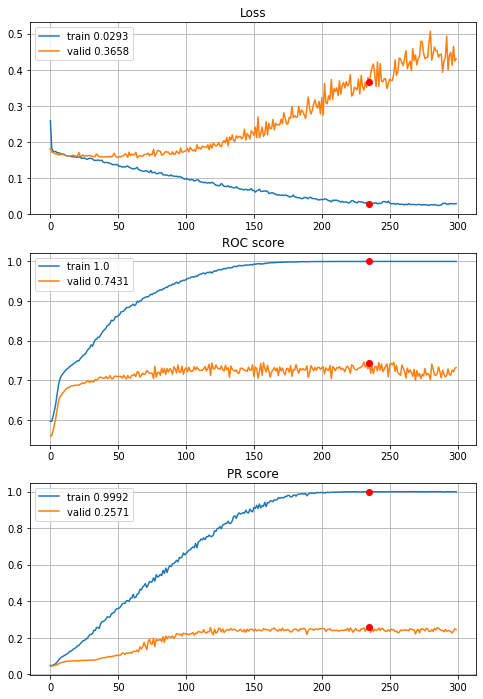


Fold 2------------------------------------------------------------


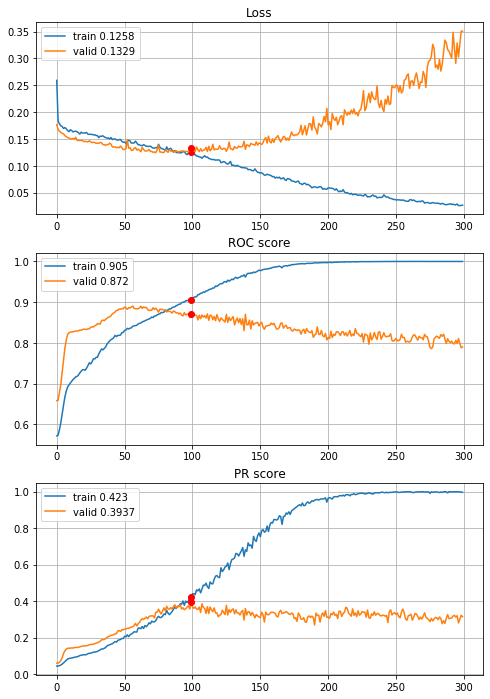


Fold 3------------------------------------------------------------


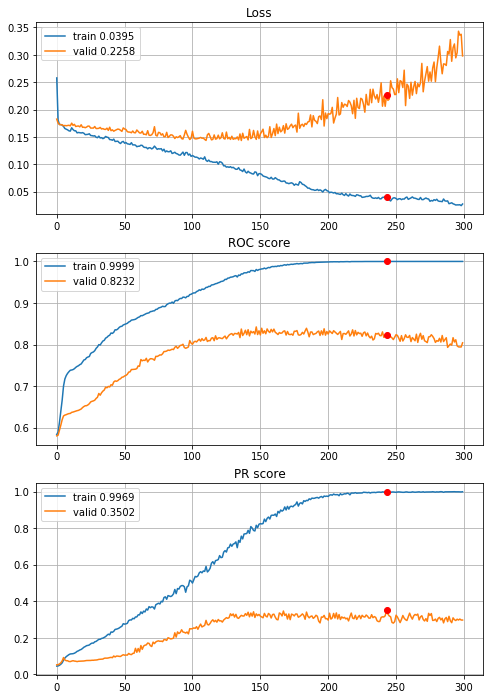


Fold 4------------------------------------------------------------


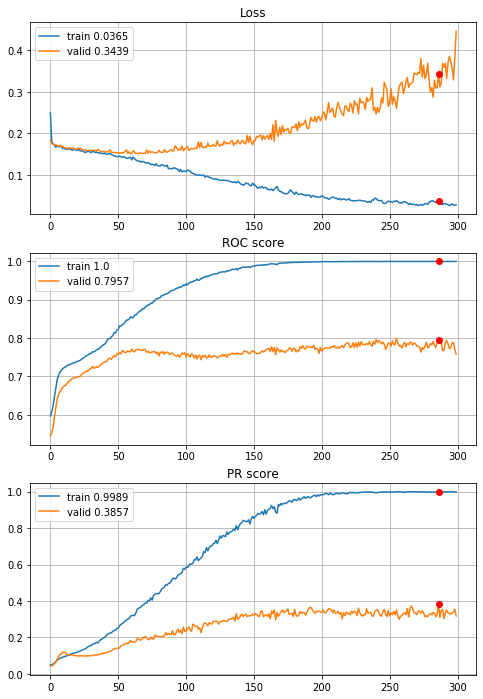


Fold 5------------------------------------------------------------


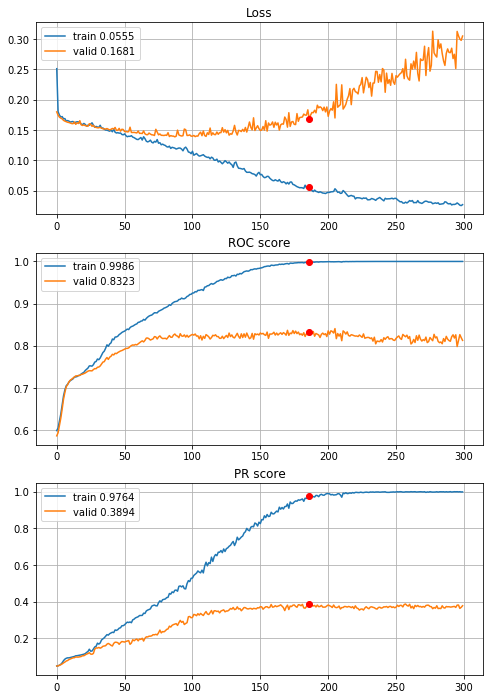


Fold 6------------------------------------------------------------


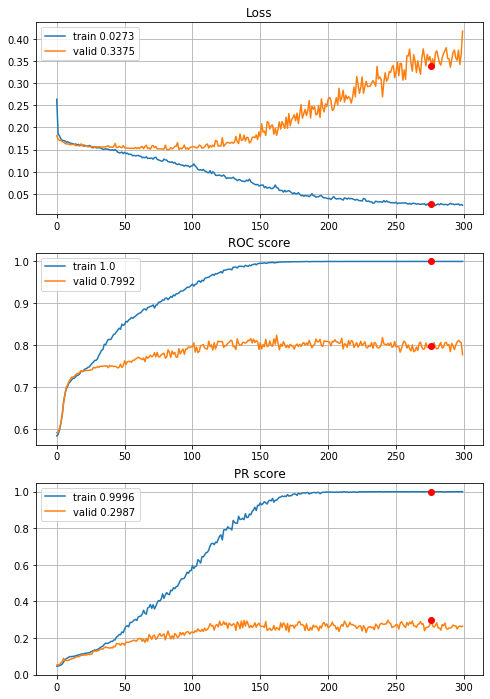

In [80]:
CNNhistories = CNN_6FoldCrossValidation_v279delete(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_drop_04,
                                                   features=features,target=target, n_epochs=300, batch_size=394, alpha=3,
                                                   drafts=drafts_20x20["optimized_drafts"], instruction=instruction,
                                                   random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\1year\define_deep_CNN_2inc_std_L2_drop_04_20x20_300ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Pretty good improvement, lets test it with wilcoxon test

##### End

In [54]:
# LOADING 8x8 CNN
with open(r"results\1year\define_deep_CNN_2inc_std_L2_drop_04_450ep.p", "rb") as fp:
    CNN_8x8_CV = pickle.load(fp)

# LOADING 20x20 CNN
with open(r"results\1year\define_deep_CNN_2inc_std_L2_drop_04_20x20_300ep.p", "rb") as fp:
    CNN_20x20_CV = pickle.load(fp)
    
# LOADING MLP
with open(r"results\1year\MLP_L1_8000ep.p", "rb") as fp:
    MLP_CV = pickle.load(fp)

# TRAINING XGB
XGB_CV = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                  normalize=True, q=None, n_estimators=1000, early_stopping_rounds=50,
                                  max_depth=4, learning_rate=0.07, subsample=0.9, colsample_bytree=0.8, gamma=2, 
                                  reg_alpha=0.1, reg_lambda=0.3, saveModels=False)
# TRAINING RF
RF_CV = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                normalize="power", q=None, saveModels=False, max_depth=8, n_estimators=100,
                                max_features=33, min_samples_split=5, min_samples_leaf=4)
# TRAINING LOGIT
logit_CV = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                      normalize="power", q=0.005, alpha=0.3, info=0)


Cross validation time: 17s

Cross validation time: 47s

Cross validation time: 22s


 - CV results extraction

In [55]:
# 8x8 CNN
CNN_8x8_roc_valid, CNN_8x8_pr_valid, CNN_8x8_roc_train, CNN_8x8_pr_train, CNN_8x8_es=network_CV_results(network_history=CNN_8x8_CV,mean=False)
# 20x20 CNN
CNN_20x20_roc_valid, CNN_20x20_pr_valid, CNN_20x20_roc_train, CNN_20x20_pr_train, CNN_20x20_es = network_CV_results(network_history=CNN_20x20_CV,mean=False)
# MLP
MLP_roc_valid, MLP_pr_valid, MLP_roc_train, MLP_pr_train, MLP_es = network_CV_results(network_history=MLP_CV,mean=False)
# XGB
XGB_roc_valid, XGB_pr_valid, XGB_roc_train, XGB_pr_train, XGB_es = XGB_CV_results(XGB_history=XGB_CV,mean=False)

# RF
RF_roc_valid = RF_CV["valid_roc"]
RF_pr_valid = RF_CV["valid_pr"]
RF_roc_train = RF_CV["train_roc"]
RF_pr_train = RF_CV["train_pr"]

# logit
logit_roc_valid = logit_CV["valid_roc"]
logit_pr_valid = logit_CV["valid_pr"]
logit_roc_train = logit_CV["train_roc"]
logit_pr_train = logit_CV["train_pr"]

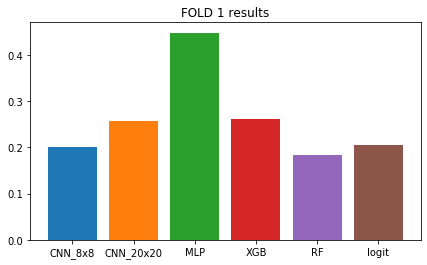

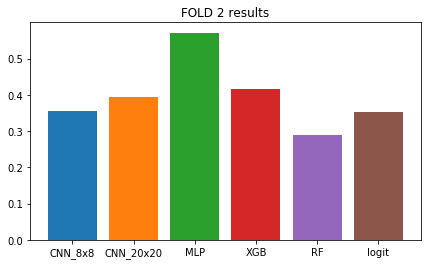

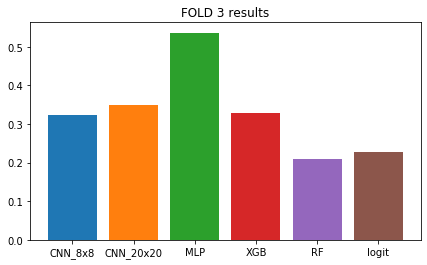

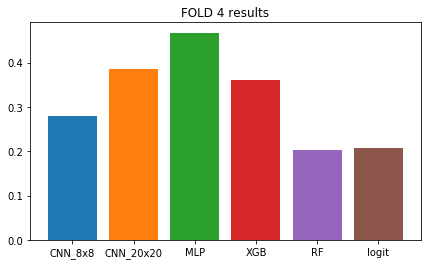

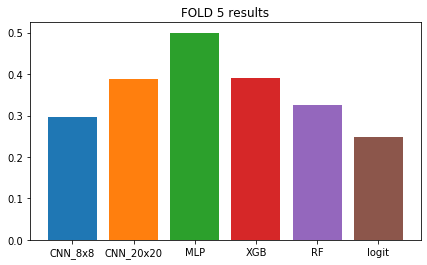

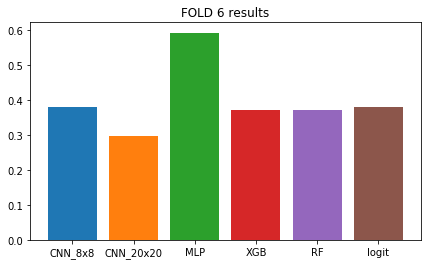

CNN_8x8 mean: 0.30576338043311785
CNN_20x20 mean: 0.345804895986164
MLP mean: 0.5192191543960197
XGB mean: 0.35498199999999996
RF mean: 0.26370507859236086
Logit mean: 0.27027415404873173


In [56]:
for i in range(len(sets["training_sets"])):
    fig, ax = plt.subplots(figsize=(7,4))
    plt.bar(x="CNN_8x8", height=CNN_8x8_pr_valid[i])
    plt.bar(x="CNN_20x20", height=CNN_20x20_pr_valid[i])
    plt.bar(x="MLP", height=MLP_pr_valid[i])
    plt.bar(x="XGB", height=XGB_pr_valid[i])
    plt.bar(x="RF", height=RF_pr_valid[i])
    plt.bar(x="logit", height=logit_pr_valid[i])
    plt.title("FOLD {} results".format(i+1))
    plt.show()

print("CNN_8x8 mean: {}\nCNN_20x20 mean: {}\nMLP mean: {}\nXGB mean: {}\nRF mean: {}\nLogit mean: {}".format(
np.mean(CNN_8x8_pr_valid), np.mean(CNN_20x20_pr_valid), np.mean(MLP_pr_valid), np.mean(XGB_pr_valid), np.mean(RF_pr_valid),
np.mean(logit_pr_valid)))

 - wilcoxon median equality test

In [57]:
CNN_20x20_pr_valid_greater_CNN_8x8_pr_valid = wilcoxon(
    x=np.array(CNN_20x20_pr_valid), y=np.array(CNN_8x8_pr_valid), alternative="greater")[1]
print("Wilcoxon tests p values, H0: median(A)==median(B)")
print("HA median(CNN_20x20_pr_valid) > median(CNN_8x8_pr_valid):", CNN_20x20_pr_valid_greater_CNN_8x8_pr_valid)

Wilcoxon tests p values, H0: median(A)==median(B)
HA median(CNN_20x20_pr_valid) > median(CNN_8x8_pr_valid): 0.08647745899421033


C:\Users\maciej\anaconda3\lib\site-packages\scipy\stats\morestats.py:2879: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


Conclusions: 
 - feature generation boosted CNN results in statistical sense at 0.1 confidence interval
 
 
##### "Production" models training
 - data normalization (CNNs excluded)

In [58]:
# loading imputed data
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# ----- Scaling: clipping, power transform and normalization -----
# scaler fitting
Scaler_norm_clip_pt=scaler(images=False)
Scaler_norm_clip_pt.fit(X=train_set_imp[features], q=0.005, power_transform=True)

# sets computing
X_train_norm_clip_pt=pd.DataFrame(Scaler_norm_clip_pt.transform(X=train_set_imp[features]), columns=features)
X_test_norm_clip_pt=pd.DataFrame(Scaler_norm_clip_pt.transform(X=test_set_imp[features]), columns=features)
Y_train_norm_clip_pt=train_set_imp[target].copy()
Y_test_norm_clip_pt=test_set_imp[target].copy()

# ----- Scaling: normalization only -----
# scaler fitting
Scaler_norm=scaler(images=False)
Scaler_norm.fit(X=train_set_imp[features], q=None, power_transform=False)

# sets computing
X_train_norm=pd.DataFrame(Scaler_norm.transform(X=train_set_imp[features]), columns=features)
X_test_norm=pd.DataFrame(Scaler_norm.transform(X=test_set_imp[features]), columns=features)
Y_train_norm=train_set_imp[target].copy()
Y_test_norm=test_set_imp[target].copy()

# ----- Scaling: power transform and normalization -----
# scaler fitting
Scaler_pt_norm=scaler(images=False)
Scaler_pt_norm.fit(X=train_set_imp[features], q=None, power_transform=True)

# sets computing
X_train_pt_norm=pd.DataFrame(Scaler_pt_norm.transform(X=train_set_imp[features]), columns=features)
X_test_pt_norm=pd.DataFrame(Scaler_pt_norm.transform(X=test_set_imp[features]), columns=features)
Y_train_pt_norm=train_set_imp[target].copy()
Y_test_pt_norm=test_set_imp[target].copy()

 - models fitting (Neural networks excluded)

In [59]:
# Logistic Regression
Logit_formula = "{}~{}".format(target, "+".join(features))
Logit = smf.logit(formula=Logit_formula, data=pd.concat((X_train_norm_clip_pt,Y_train_norm_clip_pt), axis=1))
Logit = Logit.fit_regularized(method="l1", alpha=0.3, disp=True)

# Random Forest
Random_Forest = RandomForestClassifier(n_estimators=100, criterion="gini", max_depth=8, min_samples_split=5,
                                      min_samples_leaf=4, max_features=33, random_state=random_state) 
Random_Forest.fit(X=X_train_pt_norm, y=Y_train_pt_norm)

# Extreme Gradient Boosted Decision Trees
XGBoost, XGBoost_history = XGB_training(X_train=X_train_norm,
                                        Y_train=Y_train_norm,
                                        X_valid=None, Y_valid=None, booster="gbtree", tree_method="auto",
                                        n_estimators=164, early_stopping_rounds=164, max_depth=8, learning_rate=0.07,
                                        subsample=0.9, colsample_bytree=0.8, colsample_bylevel=1,
                                        gamma=2, min_child_weight=0, reg_alpha=0.1, reg_lambda=0.3,
                                        random_state=random_state, info=0)

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.13117574929240952
            Iterations: 679
            Function evaluations: 679
            Gradient evaluations: 679


 - XGBoost training plots

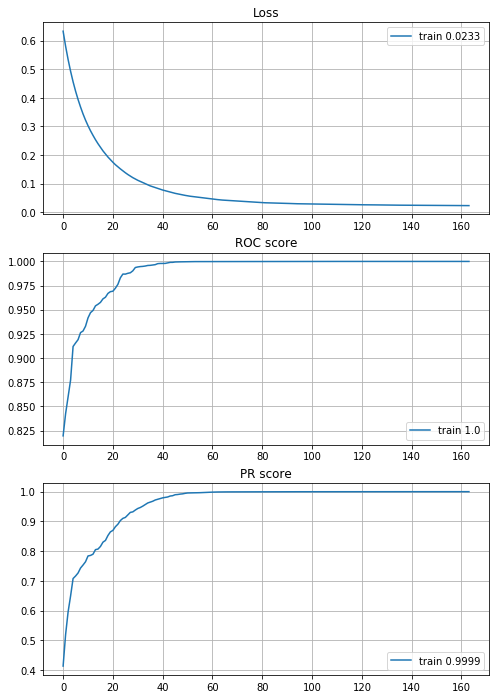

In [71]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(XGBoost_history["train_logloss"], "-", label="train {}".format(round(XGBoost_history["train_logloss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(XGBoost_history["train_auc"], label="train {}".format(round(XGBoost_history["train_auc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(XGBoost_history["train_aucpr"], label="train {}".format(round(XGBoost_history["train_aucpr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - Multilayer Percepton (Feedforward neural network)

In [95]:
# Multilayer Percepton
Multilayer_Percepton = define_MLP(input_shape=X_train.iloc[0].shape, n_layers=2, n_units=[60,60],
                                  acti=[activations.tanh, activations.sigmoid], drop=[0.4,0.4],
                                  regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)], opti=optimizers.Adam(),
                                  random_state=random_state)

Multilayer_Percepton, MLP_history = network_training(network=Multilayer_Percepton,
                                                     X_train=X_train_norm_clip_pt.values,
                                                     Y_train=Y_train_norm_clip_pt.values, 
                                                     n_epochs=7243, batch_size=394, random_state=random_state, info=None)
# SAVING MLP
with open(r"results\1year\MLP_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [Multilayer_Percepton, MLP_history,
                                                                 Multilayer_Percepton.get_weights()])), fp)

In [60]:
# LOADING MLP
with open(r"results\1year\MLP_production.p", "rb") as fp:
    MLP_dict = pickle.load(fp)

Multilayer_Percepton = MLP_dict["model"]
MLP_history = MLP_dict["history"]   

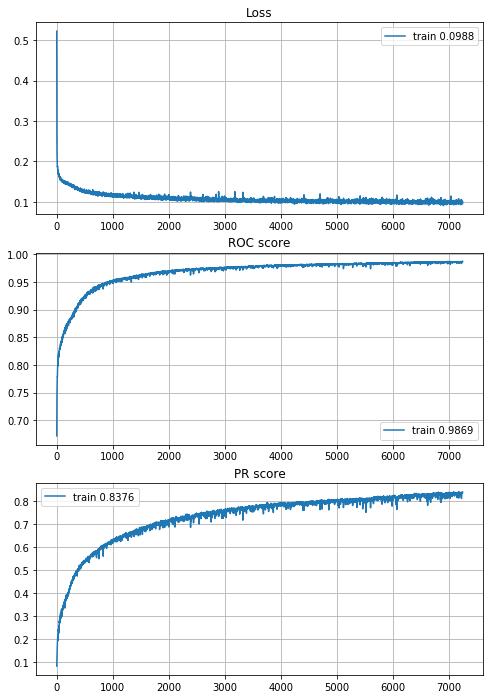

In [97]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(MLP_history["train_loss"], "-", label="train {}".format(round(MLP_history["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(MLP_history["train_roc"], label="train {}".format(round(MLP_history["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(MLP_history["train_pr"], label="train {}".format(round(MLP_history["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - 8x8 input Convolutional Neural Network

In [86]:
# ----- IMAGE DRAFT -----
# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix_8x8=X_train_CNN_8x8[Y_train_CNN_8x8==0].corr(method="spearman")
# draft inicialization
draft_8x8_ini=image_draft_inicialization(features, random_state)
# quasi optimization
draft_8x8_opt=MC_Energy_optimization(corr_matrix=corr_matrix_8x8, draft=draft_8x8_ini, alpha=3, n_eval=100,
                                     random_state=random_state)
# transform draft dictionary to matrix
draft_8x8_ini=image_dict_to_matrix(draft_8x8_ini)
draft_8x8_opt=image_dict_to_matrix(draft_8x8_opt)

# SAVING
with open(r"data\1year_data\drafts_8x8_production.p", "wb") as fp:
    pickle.dump(dict(zip(["initial", "optimized"], [draft_8x8_ini, draft_8x8_opt])), fp)

initial image energy: 13585.2059
iteration: 100
current energy: 12020.9898
iteration: 200
current energy: 11202.9841
iteration: 300
current energy: 10821.8508
iteration: 400
current energy: 10669.1421
iteration: 500
current energy: 10514.2833
iteration: 600
current energy: 10288.8859
iteration: 700
current energy: 10203.5729
iteration: 800
current energy: 10144.2304
iteration: 900
current energy: 10097.1796
iteration: 1000
current energy: 10083.806
iteration: 1100
current energy: 9970.9398
iteration: 1200
current energy: 9967.7162
iteration: 1300
current energy: 9957.8972
iteration: 1400
current energy: 9951.6428
iteration: 1500
current energy: 9938.9363
iteration: 1600
current energy: 9906.7583
iteration: 1700
current energy: 9894.232
iteration: 1800
current energy: 9878.6741
iteration: 1900
current energy: 9847.3452
iteration: 2000
current energy: 9839.1141
iteration: 2100
current energy: 9809.6715
iteration: 2200
current energy: 9798.9071
iteration: 2300
current energy: 9768.506
ite

In [61]:
# loading 8x8 drafts
with open(r"data\1year_data\drafts_8x8_production.p", "rb") as fp:
    drafts_8x8 = pickle.load(fp)

draft_8x8_opt=drafts_8x8["optimized"]
draft_8x8_ini=drafts_8x8["initial"]

			 standarization only


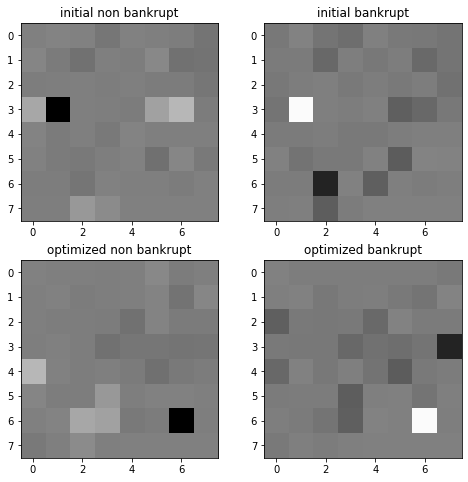

In [62]:
with open(r"data\1year_data\train_test_imp_sets_1year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm=scaler(images=True)
sclr_norm.fit(X=X_train_CNN_8x8, q=None, power_transform=False)
X_train_CNN_8x8_norm=pd.DataFrame(sclr_norm.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm=pd.DataFrame(sclr_norm.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t\t\t standarization only")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


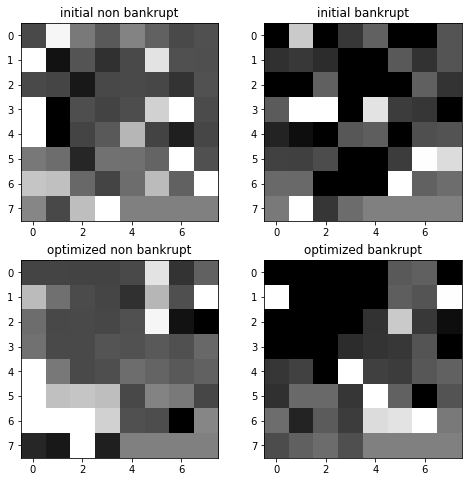

In [63]:
with open(r"data\1year_data\train_test_imp_sets_1year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm_clip=scaler(images=True)
sclr_norm_clip.fit(X=X_train_CNN_8x8, q=0.005, power_transform=False)
X_train_CNN_8x8_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

	 normalization, quantile clipping and power transform


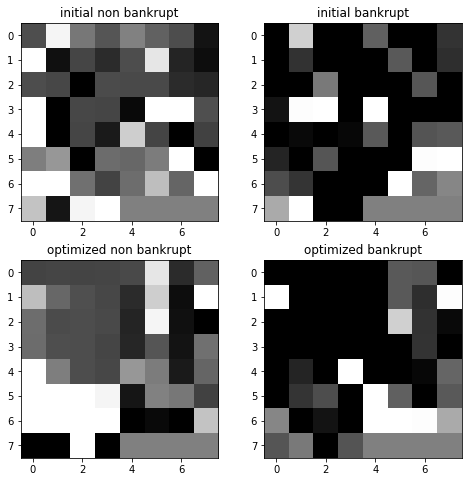

In [64]:
with open(r"data\1year_data\train_test_imp_sets_1year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_8x8, q=0.005, power_transform=True)
X_train_CNN_8x8_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t normalization, quantile clipping and power transform")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

In [91]:
# ----- vector to image conversion -----
# training set
X_train_CNN_8x8_norm_clip_pt = np.array([map_image(draft_8x8_opt, X_train_CNN_8x8_norm_clip_pt.iloc[i,:])/255 for i in range(X_train_CNN_8x8_norm_clip_pt.shape[0])])
X_train_CNN_8x8_norm_clip_pt = X_train_CNN_8x8_norm_clip_pt.reshape(X_train_CNN_8x8_norm_clip_pt.shape+(1,))
Y_train_CNN_8x8_norm_clip_pt = Y_train_CNN_8x8.values
# validation set
X_test_CNN_8x8_norm_clip_pt = np.array([map_image(draft_8x8_opt, X_test_CNN_8x8_norm_clip_pt.iloc[i,:])/255 for i in range(X_test_CNN_8x8_norm_clip_pt.shape[0])])
X_test_CNN_8x8_norm_clip_pt = X_test_CNN_8x8_norm_clip_pt.reshape(X_test_CNN_8x8_norm_clip_pt.shape+(1,))
Y_test_CNN_8x8_norm_clip_pt = Y_test_CNN_8x8.values

# ----- CNN training -----
modelCNN = define_deep_CNN_2inc_std_L2_drop_04(input_shape=X_train_CNN_8x8_norm_clip_pt.shape[1:], random_state=random_state)
modelCNN, historyCNN = network_training(network=modelCNN, X_train=X_train_CNN_8x8_norm_clip_pt,
                                        Y_train=Y_train_CNN_8x8_norm_clip_pt,
                                        X_val=None, Y_val=None, n_epochs=326,
                                        batch_size=394, random_state=random_state, info=2)

# SAVING CNN
with open(r"results\1year\CNN_8x8_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [modelCNN, historyCNN,
                                                                 modelCNN.get_weights()])), fp)

Train on 6324 samples
Epoch: 1/326,
cumulative time: 3.33s train loss: 0.28774412758624834
Epoch: 2/326,
cumulative time: 4.33s train loss: 0.18432752825767462
Epoch: 3/326,
cumulative time: 5.33s train loss: 0.16979949665948005
Epoch: 4/326,
cumulative time: 6.34s train loss: 0.16829111830465104
Epoch: 5/326,
cumulative time: 7.38s train loss: 0.16695088377148196
Epoch: 6/326,
cumulative time: 8.49s train loss: 0.1659950566802652
Epoch: 7/326,
cumulative time: 9.54s train loss: 0.16483747500367815
Epoch: 8/326,
cumulative time: 10.57s train loss: 0.1637313921407459
Epoch: 9/326,
cumulative time: 11.64s train loss: 0.16397476382671392
Epoch: 10/326,
cumulative time: 12.68s train loss: 0.16244745824266882
Epoch: 11/326,
cumulative time: 13.65s train loss: 0.16155191983586997
Epoch: 12/326,
cumulative time: 14.7s train loss: 0.16292945205090847
Epoch: 13/326,
cumulative time: 15.71s train loss: 0.16028973466323795
Epoch: 14/326,
cumulative time: 16.76s train loss: 0.160548014350702
Epoch

Epoch: 117/326,
cumulative time: 128.6s train loss: 0.14402853587264128
Epoch: 118/326,
cumulative time: 129.65s train loss: 0.14365342327739378
Epoch: 119/326,
cumulative time: 130.69s train loss: 0.14328976627733797
Epoch: 120/326,
cumulative time: 131.74s train loss: 0.14416093907538732
Epoch: 121/326,
cumulative time: 132.77s train loss: 0.14266876219185676
Epoch: 122/326,
cumulative time: 133.81s train loss: 0.14276104010429508
Epoch: 123/326,
cumulative time: 134.85s train loss: 0.14184258093587362
Epoch: 124/326,
cumulative time: 135.91s train loss: 0.1435344005327561
Epoch: 125/326,
cumulative time: 136.94s train loss: 0.1425917661176838
Epoch: 126/326,
cumulative time: 138.01s train loss: 0.14020294988036608
Epoch: 127/326,
cumulative time: 139.07s train loss: 0.14653208267926265
Epoch: 128/326,
cumulative time: 140.08s train loss: 0.14700677843645432
Epoch: 129/326,
cumulative time: 141.1s train loss: 0.14350061017518026
Epoch: 130/326,
cumulative time: 142.17s train loss: 0.

Epoch: 230/326,
cumulative time: 247.53s train loss: 0.12229366174025448
Epoch: 231/326,
cumulative time: 248.59s train loss: 0.11882066827769297
Epoch: 232/326,
cumulative time: 249.64s train loss: 0.1197940815784447
Epoch: 233/326,
cumulative time: 250.71s train loss: 0.1206879808268805
Epoch: 234/326,
cumulative time: 251.76s train loss: 0.12121377436233276
Epoch: 235/326,
cumulative time: 252.87s train loss: 0.11954700331816863
Epoch: 236/326,
cumulative time: 253.95s train loss: 0.12060487999154902
Epoch: 237/326,
cumulative time: 255.02s train loss: 0.1188776890318994
Epoch: 238/326,
cumulative time: 256.1s train loss: 0.11805360994709962
Epoch: 239/326,
cumulative time: 257.19s train loss: 0.11880302138904618
Epoch: 240/326,
cumulative time: 258.32s train loss: 0.12291194951417399
Epoch: 241/326,
cumulative time: 259.4s train loss: 0.1218639851902988
Epoch: 242/326,
cumulative time: 260.48s train loss: 0.11988066833826803
Epoch: 243/326,
cumulative time: 261.64s train loss: 0.11

In [66]:
# LOADING CNN
with open(r"results\1year\CNN_8x8_production.p", "rb") as fp:
    CNN_8x8_dict = pickle.load(fp)

CNN_8x8 = CNN_8x8_dict["model"]
historyCNN_8x8 = CNN_8x8_dict["history"]

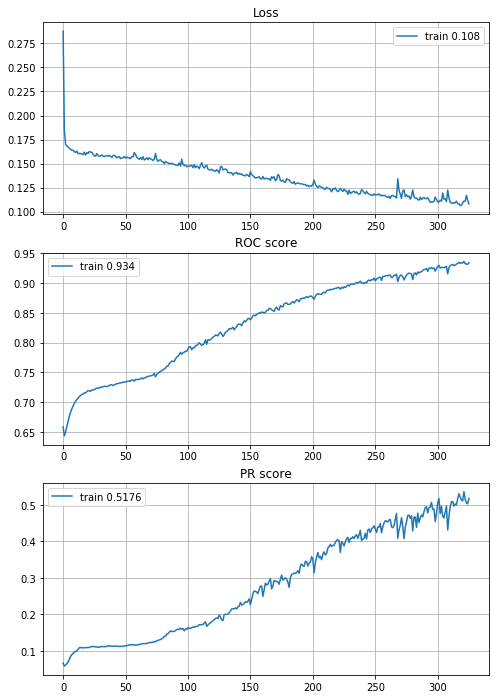

In [93]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(historyCNN_8x8["train_loss"], "-", label="train {}".format(round(historyCNN_8x8["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(historyCNN_8x8["train_roc"], label="train {}".format(round(historyCNN_8x8["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(historyCNN_8x8["train_pr"], label="train {}".format(round(historyCNN_8x8["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - 20x20 input Convolutional Neural Network

In [72]:
# training draft for CNN 20x20 input
# loading data
with open(r"data\1year_data\train_test_imp_sets_1year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN=train_set_imp[target].copy()
X_test_CNN=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN=test_set_imp[target].copy()

features_20x20=X_train_CNN.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix_20x20=X_train_CNN[Y_train_CNN==0].corr(method="spearman")
# draft inicialization
draft_20x20_ini=image_draft_inicialization(features_20x20, random_state)
# quasi optimization
draft_20x20_opt=MC_Energy_optimization(corr_matrix=corr_matrix_20x20, draft=draft_20x20_ini, alpha=3, n_eval=100,
                                       random_state=random_state)
# transform draft dictionary to matrix
draft_20x20_ini=image_dict_to_matrix(draft_20x20_ini)
draft_20x20_opt=image_dict_to_matrix(draft_20x20_opt)

# SAVING
with open(r"data\1year_data\drafts_20x20_production.p", "wb") as fp:
    pickle.dump(dict(zip(["initial", "optimized"], [draft_20x20_ini, draft_20x20_opt])), fp)

initial image energy: 3140564.7922
iteration: 100
current energy: 3031037.0972
iteration: 200
current energy: 2945845.265
iteration: 300
current energy: 2875626.4469
iteration: 400
current energy: 2821598.1823
iteration: 500
current energy: 2746205.0499
iteration: 600
current energy: 2709784.8875
iteration: 700
current energy: 2674225.3419
iteration: 800
current energy: 2640281.3628
iteration: 900
current energy: 2628587.4818
iteration: 1000
current energy: 2598172.3213
iteration: 1100
current energy: 2580956.3603
iteration: 1200
current energy: 2552435.7658
iteration: 1300
current energy: 2519457.5709
iteration: 1400
current energy: 2502463.0653
iteration: 1500
current energy: 2482250.1122
iteration: 1600
current energy: 2467373.0414
iteration: 1700
current energy: 2453994.4838
iteration: 1800
current energy: 2447357.9026
iteration: 1900
current energy: 2439923.3356
iteration: 2000
current energy: 2422201.6275
iteration: 2100
current energy: 2417353.8558
iteration: 2200
current energy

In [67]:
# loading 20x20 drafts
with open(r"data\1year_data\drafts_20x20_production.p", "rb") as fp:
    drafts_20x20 = pickle.load(fp)

draft_20x20_opt=drafts_20x20["optimized"]
draft_20x20_ini=drafts_20x20["initial"]

			 standarization only


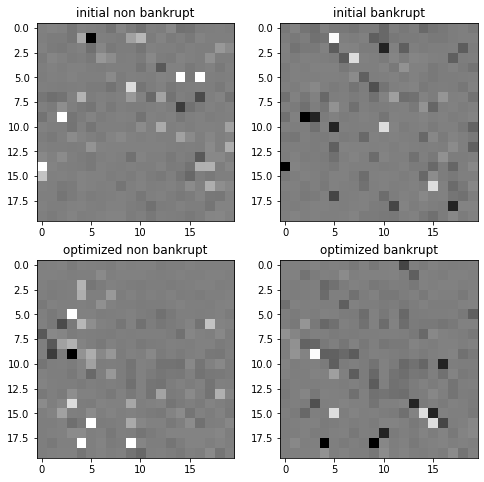

In [68]:
# loading data
with open(r"data\1year_data\train_test_imp_sets_1year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()

# standarization
sclr_norm=scaler(images=True)
sclr_norm.fit(X=X_train_CNN_20x20, q=None, power_transform=False)
X_train_CNN_20x20_norm=pd.DataFrame(sclr_norm.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm=pd.DataFrame(sclr_norm.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t\t standarization only")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


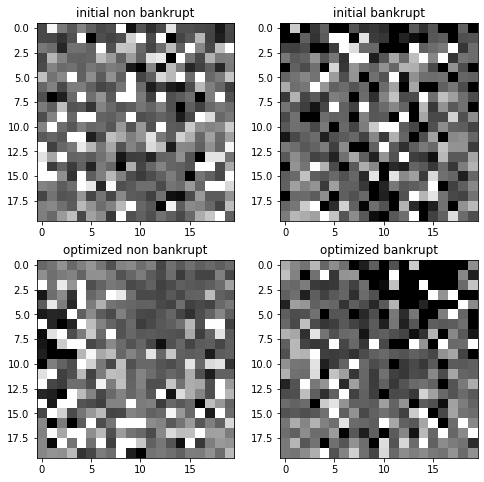

In [69]:
# loading data
with open(r"data\1year_data\train_test_imp_sets_1year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()
# standarization
sclr_norm_clip=scaler(images=True)
sclr_norm_clip.fit(X=X_train_CNN_20x20, q=0.005, power_transform=False)
X_train_CNN_20x20_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


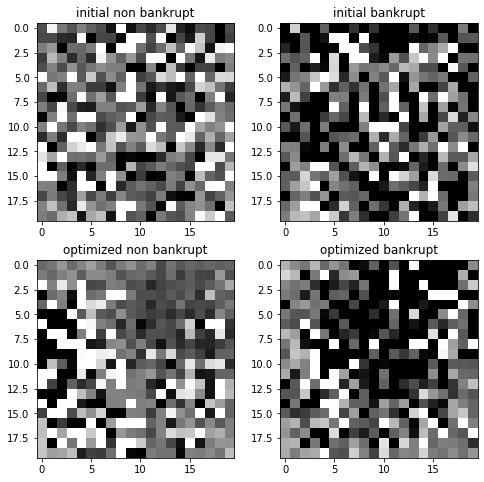

In [70]:
# loading data
with open(r"data\1year_data\train_test_imp_sets_1year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# *** v279 feature is deleted from drafts here ***
draft_20x20_ini_curr = draft_20x20_ini.copy()
draft_20x20_opt_curr = draft_20x20_opt.copy()
draft_20x20_ini_curr[draft_20x20_ini_curr=="v279"]=128
draft_20x20_opt_curr[draft_20x20_opt_curr=="v279"]=128
# ************************************************

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

# *** v279 feature is deleted here ***
X_train_CNN_20x20.drop(labels="v279",axis=1, inplace=True)
X_test_CNN_20x20.drop(labels="v279",axis=1, inplace=True)
# ************************************

features_20x20=X_train_CNN_20x20.columns.tolist()
# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_20x20, q=0.005, power_transform=True)
X_train_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini_curr,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini_curr,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt_curr,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt_curr,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

In [81]:
# loading data
with open(r"data\1year_data\train_test_imp_sets_1year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# *** v279 feature is deleted from drafts here ***
draft_20x20_ini_curr = draft_20x20_ini.copy()
draft_20x20_opt_curr = draft_20x20_opt.copy()
draft_20x20_ini_curr[draft_20x20_ini_curr=="v279"]=128
draft_20x20_opt_curr[draft_20x20_opt_curr=="v279"]=128
# ************************************************
    
# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

# *** v279 feature is deleted here ***
X_train_CNN_20x20.drop(labels="v279",axis=1, inplace=True)
X_test_CNN_20x20.drop(labels="v279",axis=1, inplace=True)
# ************************************

features_20x20=X_train_CNN_20x20.columns.tolist()

# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_20x20, q=0.005, power_transform=True)
X_train_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_20x20), columns=features_20x20)


# ----- vector to image conversion -----
# training set
X_train_CNN_20x20_norm_clip_pt = np.array([map_image(draft_20x20_opt_curr, X_train_CNN_20x20_norm_clip_pt.iloc[i,:])/255 for i in range(X_train_CNN_20x20_norm_clip_pt.shape[0])])
X_train_CNN_20x20_norm_clip_pt = X_train_CNN_20x20_norm_clip_pt.reshape(X_train_CNN_20x20_norm_clip_pt.shape+(1,))
Y_train_CNN_20x20_norm_clip_pt = Y_train_CNN_20x20.values

# validation set
X_test_CNN_20x20_norm_clip_pt = np.array([map_image(draft_20x20_opt_curr, X_test_CNN_20x20_norm_clip_pt.iloc[i,:])/255 for i in range(X_test_CNN_20x20_norm_clip_pt.shape[0])])
X_test_CNN_20x20_norm_clip_pt = X_test_CNN_20x20_norm_clip_pt.reshape(X_test_CNN_20x20_norm_clip_pt.shape+(1,))
Y_test_CNN_20x20_norm_clip_pt = Y_test_CNN_20x20.values

# ----- CNN training -----
modelCNN_20x20 = define_deep_CNN_2inc_std_L2_drop_04(input_shape=X_train_CNN_20x20_norm_clip_pt.shape[1:], random_state=random_state)
modelCNN_20x20, historyCNN_20x20 = network_training(network=modelCNN_20x20, X_train=X_train_CNN_20x20_norm_clip_pt,
                                                    Y_train=Y_train_CNN_20x20_norm_clip_pt,
                                                    X_val=None, Y_val=None, n_epochs=239,
                                                    batch_size=394, random_state=random_state, info=2)

# SAVING CNN
with open(r"results\1year\CNN_20x20_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [modelCNN_20x20, historyCNN_20x20,
                                                                 modelCNN_20x20.get_weights()])), fp)

Train on 6324 samples
Epoch: 1/239,
cumulative time: 7.46s train loss: 0.24536099187808275
Epoch: 2/239,
cumulative time: 12.62s train loss: 0.18087922769453163
Epoch: 3/239,
cumulative time: 18.02s train loss: 0.17367891638358887
Epoch: 4/239,
cumulative time: 23.31s train loss: 0.17214777570625486
Epoch: 5/239,
cumulative time: 28.61s train loss: 0.16956080718273456
Epoch: 6/239,
cumulative time: 34.34s train loss: 0.16999185154100221
Epoch: 7/239,
cumulative time: 40.92s train loss: 0.16697725083662468
Epoch: 8/239,
cumulative time: 46.64s train loss: 0.16786664757338
Epoch: 9/239,
cumulative time: 52.22s train loss: 0.16517817929792375
Epoch: 10/239,
cumulative time: 57.4s train loss: 0.16425635423664425
Epoch: 11/239,
cumulative time: 62.94s train loss: 0.16379303620406
Epoch: 12/239,
cumulative time: 68.28s train loss: 0.16354966833999005
Epoch: 13/239,
cumulative time: 73.54s train loss: 0.16202825097900866
Epoch: 14/239,
cumulative time: 78.59s train loss: 0.16102859554818202
E

Epoch: 116/239,
cumulative time: 626.68s train loss: 0.12628565830220384
Epoch: 117/239,
cumulative time: 632.32s train loss: 0.12484286400824691
Epoch: 118/239,
cumulative time: 638.01s train loss: 0.12461965578707768
Epoch: 119/239,
cumulative time: 643.57s train loss: 0.12163668668992078
Epoch: 120/239,
cumulative time: 649.15s train loss: 0.11864560419089201
Epoch: 121/239,
cumulative time: 654.77s train loss: 0.11723300199873232
Epoch: 122/239,
cumulative time: 660.33s train loss: 0.11949219783693835
Epoch: 123/239,
cumulative time: 665.84s train loss: 0.11692696228472588
Epoch: 124/239,
cumulative time: 671.47s train loss: 0.1156837650486972
Epoch: 125/239,
cumulative time: 677.07s train loss: 0.11780361092727747
Epoch: 126/239,
cumulative time: 682.65s train loss: 0.1224684277967627
Epoch: 127/239,
cumulative time: 688.2s train loss: 0.11692487668295513
Epoch: 128/239,
cumulative time: 693.72s train loss: 0.12934905240179087
Epoch: 129/239,
cumulative time: 699.17s train loss: 0

Epoch: 229/239,
cumulative time: 1209.71s train loss: 0.06490814055514667
Epoch: 230/239,
cumulative time: 1214.73s train loss: 0.06773154131813679
Epoch: 231/239,
cumulative time: 1219.72s train loss: 0.0648284921449698
Epoch: 232/239,
cumulative time: 1225.03s train loss: 0.062018255318487314
Epoch: 233/239,
cumulative time: 1230.26s train loss: 0.06068022325422891
Epoch: 234/239,
cumulative time: 1235.57s train loss: 0.06453764517211333
Epoch: 235/239,
cumulative time: 1240.8s train loss: 0.06329201136060074
Epoch: 236/239,
cumulative time: 1245.81s train loss: 0.05710007360465424
Epoch: 237/239,
cumulative time: 1250.81s train loss: 0.06435632234431007
Epoch: 238/239,
cumulative time: 1256.02s train loss: 0.0620972545043454
Epoch: 239/239,
cumulative time: 1261.09s train loss: 0.06564218620313149


In [72]:
# LOADING CNN
with open(r"results\1year\CNN_20x20_production.p", "rb") as fp:
    CNN_20x20_dict = pickle.load(fp)

CNN_20x20 = CNN_20x20_dict["model"]
historyCNN_20x20 = CNN_20x20_dict["history"]

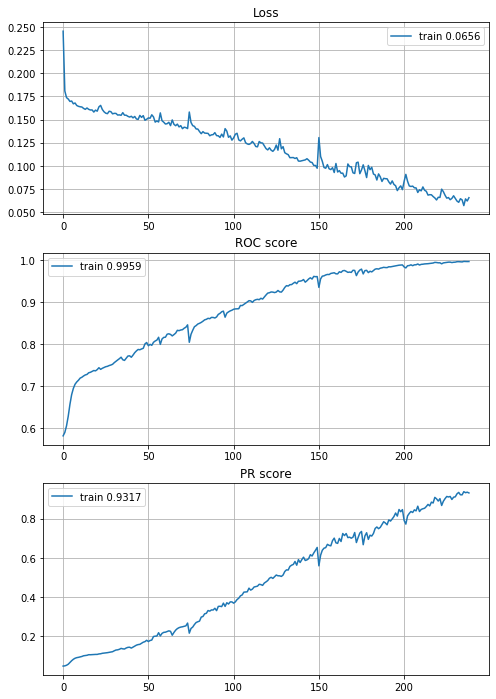

In [83]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(historyCNN_20x20["train_loss"], "-", label="train {}".format(round(historyCNN_20x20["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(historyCNN_20x20["train_roc"], label="train {}".format(round(historyCNN_20x20["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(historyCNN_20x20["train_pr"], label="train {}".format(round(historyCNN_20x20["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

##### "Production" results

In [73]:
# Logistic Regression
Logit_train_probs = Logit.predict(exog=X_train_norm_clip_pt)
Logit_test_probs = Logit.predict(exog=X_test_norm_clip_pt)

Logit_train_roc = roc_auc_score(y_true=Y_train_norm_clip_pt, y_score=Logit_train_probs)
Logit_test_roc = roc_auc_score(y_true=Y_test_norm_clip_pt, y_score=Logit_test_probs)
Logit_train_pr = average_precision_score(y_true=Y_train_norm_clip_pt, y_score=Logit_train_probs)
Logit_test_pr = average_precision_score(y_true=Y_test_norm_clip_pt, y_score=Logit_test_probs)

(Logit_train_roc, Logit_test_roc, Logit_train_pr, Logit_test_pr)

(0.7983764964408974,
 0.7510957703265395,
 0.33869930913905993,
 0.46839588586081826)

In [74]:
# Random Forest
Random_Forest_train_probs = Random_Forest.predict_proba(X=X_train_pt_norm)[:,1]
Random_Forest_test_probs = Random_Forest.predict_proba(X=X_test_pt_norm)[:,1]

Random_Forest_train_roc = roc_auc_score(y_true=Y_train_pt_norm, y_score=Random_Forest_train_probs)
Random_Forest_test_roc = roc_auc_score(y_true=Y_test_pt_norm, y_score=Random_Forest_test_probs)
Random_Forest_train_pr = average_precision_score(y_true=Y_train_pt_norm, y_score=Random_Forest_train_probs)
Random_Forest_test_pr = average_precision_score(y_true=Y_test_pt_norm, y_score=Random_Forest_test_probs)

(Random_Forest_train_roc,Random_Forest_test_roc,Random_Forest_train_pr,Random_Forest_test_pr)

(0.9875077518334772,
 0.8308678500986193,
 0.830012345427378,
 0.36352071811985254)

In [75]:
# Extreme Gradient Boosted Decision Trees
XGBoost_train_probs = XGBoost.predict_proba(data=X_train_norm)[:,1]
XGBoost_test_probs = XGBoost.predict_proba(data=X_test_norm)[:,1]

XGBoost_train_roc = roc_auc_score(y_true=Y_train_norm, y_score=XGBoost_train_probs)
XGBoost_test_roc = roc_auc_score(y_true=Y_test_norm, y_score=XGBoost_test_probs)
XGBoost_train_pr = average_precision_score(y_true=Y_train_norm, y_score=XGBoost_train_probs)
XGBoost_test_pr = average_precision_score(y_true=Y_test_norm, y_score=XGBoost_test_probs)

(XGBoost_train_roc,XGBoost_test_roc,XGBoost_train_pr,XGBoost_test_pr)

(0.999997640746333, 0.858755204909051, 0.9999326743809376, 0.39290688331961804)

In [76]:
# Multilayer Percepton
Multilayer_Percepton_train_probs = Multilayer_Percepton.predict(x=X_train_norm_clip_pt.values)
Multilayer_Percepton_test_probs = Multilayer_Percepton.predict(x=X_test_norm_clip_pt.values)

Multilayer_Percepton_train_roc = roc_auc_score(y_true=Y_train_norm_clip_pt, y_score=Multilayer_Percepton_train_probs)
Multilayer_Percepton_test_roc = roc_auc_score(y_true=Y_test_norm_clip_pt, y_score=Multilayer_Percepton_test_probs)
Multilayer_Percepton_train_pr = average_precision_score(y_true=Y_train_norm_clip_pt, y_score=Multilayer_Percepton_train_probs)
Multilayer_Percepton_test_pr = average_precision_score(y_true=Y_test_norm_clip_pt, y_score=Multilayer_Percepton_test_probs)

(Multilayer_Percepton_train_roc,Multilayer_Percepton_test_roc,Multilayer_Percepton_train_pr,Multilayer_Percepton_test_pr)

(0.9868673829810182, 0.8264025860179705, 0.837633184377571, 0.4767349385262668)

In [77]:
# CNN 8x8
CNN_8x8_train_probs = CNN_8x8.predict(x=X_train_CNN_8x8_norm_clip_pt)
CNN_8x8_test_probs = CNN_8x8.predict(x=X_test_CNN_8x8_norm_clip_pt)

CNN_8x8_train_roc = roc_auc_score(y_true=Y_train_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_train_probs)
CNN_8x8_test_roc = roc_auc_score(y_true=Y_test_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_test_probs)
CNN_8x8_train_pr = average_precision_score(y_true=Y_train_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_train_probs)
CNN_8x8_test_pr = average_precision_score(y_true=Y_test_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_test_probs)

(CNN_8x8_train_roc,CNN_8x8_test_roc,CNN_8x8_train_pr,CNN_8x8_test_pr)

(0.9340157193701467, 0.791858426473811, 0.517610177010753, 0.2605421732537328)

In [78]:
# CNN 20x20
CNN_20x20_train_probs = CNN_20x20.predict(x=X_train_CNN_20x20_norm_clip_pt)
CNN_20x20_test_probs = CNN_20x20.predict(x=X_test_CNN_20x20_norm_clip_pt)

CNN_20x20_train_roc = roc_auc_score(y_true=Y_train_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_train_probs)
CNN_20x20_test_roc = roc_auc_score(y_true=Y_test_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_test_probs)
CNN_20x20_train_pr = average_precision_score(y_true=Y_train_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_train_probs)
CNN_20x20_test_pr = average_precision_score(y_true=Y_test_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_test_probs)

(CNN_20x20_train_roc,CNN_20x20_test_roc,CNN_20x20_train_pr,CNN_20x20_test_pr)

(0.9958682727566868,
 0.8250602673679597,
 0.9317322818234489,
 0.3498807668425881)

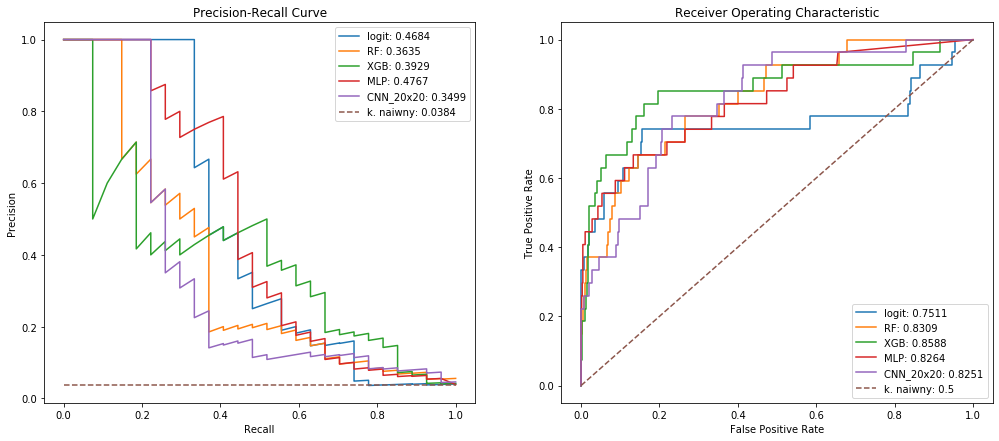

In [81]:
fig, ax = plt.subplots(nrows=1,ncols=2,figsize=(17,7))

logit_precision, logit_recall, _ = precision_recall_curve(Y_test_norm_clip_pt, Logit_test_probs)
logit_fpr, logit_tpr, _ = roc_curve(Y_test_norm_clip_pt, Logit_test_probs)

rf_precision, rf_recall, _ = precision_recall_curve(Y_test_pt_norm, Random_Forest_test_probs)
rf_fpr, rf_tpr, _ = roc_curve(Y_test_pt_norm, Random_Forest_test_probs)

xgb_precision, xgb_recall, _ = precision_recall_curve(Y_test_norm, XGBoost_test_probs)
xgb_fpr, xgb_tpr, _ = roc_curve(Y_test_norm, XGBoost_test_probs)

mlp_precision, mlp_recall, _ = precision_recall_curve(Y_test_norm_clip_pt, Multilayer_Percepton_test_probs)
mlp_fpr, mlp_tpr, _ = roc_curve(Y_test_norm_clip_pt, Multilayer_Percepton_test_probs)

cnn_20x20_precision, cnn_20x20_recall, _ = precision_recall_curve(Y_test_CNN_20x20_norm_clip_pt, CNN_20x20_test_probs)
cnn_20x20_fpr, cnn_20x20_tpr, _ = roc_curve(Y_test_CNN_20x20_norm_clip_pt, CNN_20x20_test_probs)

# cnn_8x8_precision, cnn_8x8_recall, _ = precision_recall_curve(Y_test_CNN_8x8_norm_clip_pt, CNN_8x8_test_probs)
# cnn_8x8_fpr, cnn_8x8_tpr, _ = roc_curve(Y_test_CNN_8x8_norm_clip_pt, CNN_8x8_test_probs)


noskill_probs = [1 for i in range(Y_test.shape[0])]
noskill_fpr, noskill_tpr, _ = roc_curve(Y_test, noskill_probs)
noskill_precision = Y_test[Y_test==1].shape[0]/Y_test.shape[0]
# precision=(TP)/(TP+FP), when y_hat=1 always => TP+FP = n_obs => precision = TP/(n_obs)
# recall = (TP)/(TP+FN), when y_hat=1 always => FN=0 =? TP+FN=TP => recall=TP/TP=1

# ----- PLOTS -----
ax[0].plot(logit_recall, logit_precision, label= "logit: {}".format(round(Logit_test_pr,4)))
ax[0].plot(rf_recall, rf_precision, label= "RF: {}".format(round(Random_Forest_test_pr,4)))
ax[0].plot(xgb_recall, xgb_precision, label= "XGB: {}".format(round(XGBoost_test_pr,4)))
ax[0].plot(mlp_recall, mlp_precision, label= "MLP: {}".format(round(Multilayer_Percepton_test_pr,4)))
ax[0].plot(cnn_20x20_recall, cnn_20x20_precision, label= "CNN_20x20: {}".format(round(CNN_20x20_test_pr,4)))
# ax[0].plot(cnn_8x8_recall, cnn_8x8_precision, label= "CNN_8x8: {}".format(round(CNN_8x8_test_pr,4)))
ax[0].plot([0,1], [noskill_precision, noskill_precision], linestyle='--', label= "k. naiwny: {}".format(
    round(average_precision_score(Y_test, noskill_probs),4)))
ax[0].plot()
ax[0].legend()
ax[0].set_title("Precision-Recall Curve")
ax[0].set_xlabel('Recall')
ax[0].set_ylabel('Precision')


ax[1].plot(logit_fpr, logit_tpr, label="logit: {}".format(round(Logit_test_roc, 4)))
ax[1].plot(rf_fpr, rf_tpr, label="RF: {}".format(round(Random_Forest_test_roc, 4)))
ax[1].plot(xgb_fpr, xgb_tpr, label="XGB: {}".format(round(XGBoost_test_roc, 4)))
ax[1].plot(mlp_fpr, mlp_tpr, label="MLP: {}".format(round(Multilayer_Percepton_test_roc, 4)))
ax[1].plot(cnn_20x20_fpr, cnn_20x20_tpr, label= "CNN_20x20: {}".format(round(CNN_20x20_test_roc,4)))
# ax[1].plot(cnn_8x8_fpr, cnn_8x8_tpr, label= "CNN_8x8: {}".format(round(CNN_8x8_test_roc,4)))
ax[1].plot(noskill_fpr, noskill_tpr, linestyle='--', label= "k. naiwny: {}".format(
    round(roc_auc_score(Y_test, noskill_probs),4)))
ax[1].legend()
ax[1].set_title("Receiver Operating Characteristic")
ax[1].set_xlabel('False Positive Rate')
ax[1].set_ylabel('True Positive Rate')
plt.show()